# Question 1

# Import libraries required to do operations like convolution, gaussian blur, sobel operator, pixel manipulation, etc.

In [1]:
import cv2
from scipy import misc
from scipy import ndimage
import numpy as np
import matplotlib.pyplot as plt

# Load image into variable and display it

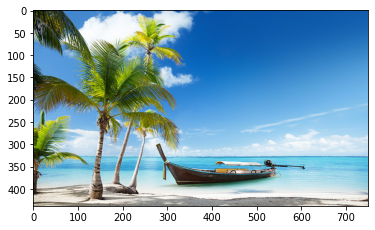

In [3]:
beach = cv2.imread("images/beach.jpg")
beach = cv2.cvtColor(beach, cv2.COLOR_BGR2RGB)
plt.imshow(beach, cmap = plt.get_cmap('gray'))
plt.show()

# Convert color image to grayscale to help extraction of edges and plot it

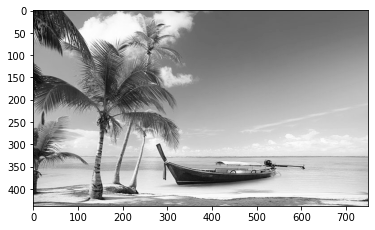

In [4]:
img = cv2.cvtColor(beach, cv2.COLOR_BGR2GRAY) 
plt.imshow(img, cmap = plt.get_cmap('gray'))
plt.show()

# Blur the grayscale image so that only important edges are extracted and the noisy ones ignored
# Noise reduction step 

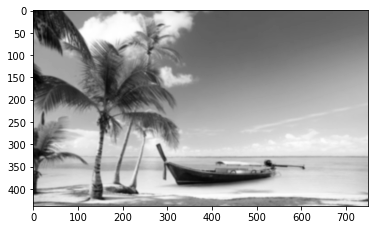

In [5]:
img = cv2.GaussianBlur(img, (11, 11), 1.4) 
plt.imshow(img, cmap = plt.get_cmap('gray'))
plt.show()

# Calculating the gradients 

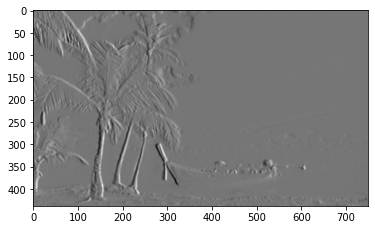

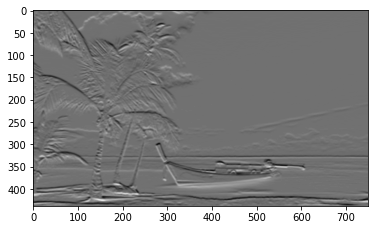

In [6]:
# Apply Sobel Filter in X direction
gx = cv2.Sobel(np.float32(img), cv2.CV_64F, 1, 0, 3) 
# Apply Sobel Filter in Y direction
gy = cv2.Sobel(np.float32(img), cv2.CV_64F, 0, 1, 3) 


plt.imshow(gx, cmap = plt.get_cmap('gray'))
plt.show()
plt.imshow(gy, cmap = plt.get_cmap('gray'))
plt.show()

# Conversion of Cartesian coordinates to polar 

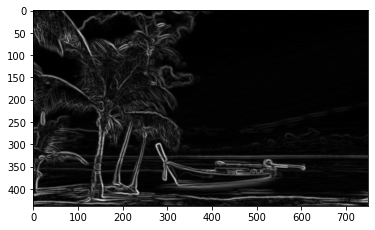

In [7]:
# Calculate the magnitude of the gradients obtained 
# Calculate direction of the gradients
mag, ang = cv2.cartToPolar(gx, gy, angleInDegrees = True) 

plt.imshow(mag, cmap = plt.get_cmap('gray'))
plt.show()

# setting the minimum and maximum thresholds for double thresholding 

# Non-Maximum Suppression 

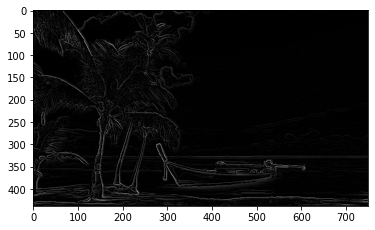

In [9]:
mag_max = np.max(mag) 
weak_th = mag_max * 0.1
strong_th = mag_max * 0.5

# getting the dimensions of the input image   
height, width = img.shape 

# Looping through every pixel of the grayscale  
# image 
for i_x in range(width): 
    for i_y in range(height): 

        grad_ang = ang[i_y, i_x] 
        grad_ang = abs(grad_ang-180) if abs(grad_ang)>180 else abs(grad_ang) 

        # selecting the neighbours of the target pixel 
        # according to the gradient direction 
        # In the x axis direction 
        if grad_ang<= 22.5: 
            neighb_1_x, neighb_1_y = i_x-1, i_y 
            neighb_2_x, neighb_2_y = i_x + 1, i_y 

        # top right (diagnol-1) direction 
        elif grad_ang>22.5 and grad_ang<=(22.5 + 45): 
            neighb_1_x, neighb_1_y = i_x-1, i_y-1
            neighb_2_x, neighb_2_y = i_x + 1, i_y + 1

        # In y-axis direction 
        elif grad_ang>(22.5 + 45) and grad_ang<=(22.5 + 90): 
            neighb_1_x, neighb_1_y = i_x, i_y-1
            neighb_2_x, neighb_2_y = i_x, i_y + 1

        # top left (diagnol-2) direction 
        elif grad_ang>(22.5 + 90) and grad_ang<=(22.5 + 135): 
            neighb_1_x, neighb_1_y = i_x-1, i_y + 1
            neighb_2_x, neighb_2_y = i_x + 1, i_y-1

        # Now it restarts the cycle 
        elif grad_ang>(22.5 + 135) and grad_ang<=(22.5 + 180): 
            neighb_1_x, neighb_1_y = i_x-1, i_y 
            neighb_2_x, neighb_2_y = i_x + 1, i_y 

        # Non-maximum suppression step 
        if width>neighb_1_x>= 0 and height>neighb_1_y>= 0: 
            if mag[i_y, i_x]<mag[neighb_1_y, neighb_1_x]: 
                mag[i_y, i_x]= 0
                continue

        if width>neighb_2_x>= 0 and height>neighb_2_y>= 0: 
            if mag[i_y, i_x]<mag[neighb_2_y, neighb_2_x]: 
                mag[i_y, i_x]= 0

weak_ids = np.zeros_like(img) 
strong_ids = np.zeros_like(img)               
ids = np.zeros_like(img)
    

plt.imshow(mag, cmap = plt.get_cmap('gray'))
plt.show()

# double thresholding step 

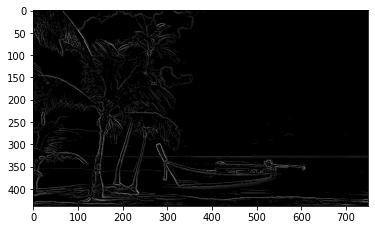

In [10]:
for i_x in range(width): 
    for i_y in range(height): 

        grad_mag = mag[i_y, i_x] 

        if grad_mag<weak_th: 
            mag[i_y, i_x]= 0
        elif strong_th>grad_mag>= weak_th: 
            ids[i_y, i_x]= 1
        else: 
            ids[i_y, i_x]= 2


# finally returning the magnitude of 
# gradients of edges 
plt.imshow(mag, cmap = plt.get_cmap('gray'))
plt.show()

# Canny Edge OpenCV

<p>Just to test the results, here inbuilt canny edge detection has been used</p>

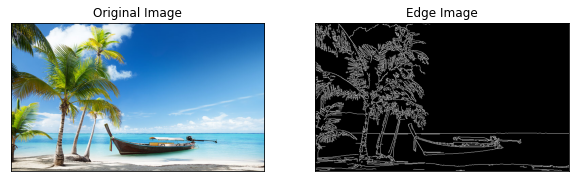

In [139]:
beach = cv2.imread("images/beach.jpg")
beach = cv2.cvtColor(beach, cv2.COLOR_BGR2RGB)

edges = cv2.Canny(beach,200,500)

plt.figure(figsize=(10,10))
plt.subplot(121),plt.imshow(beach,cmap = 'gray')
plt.title('Original Image'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(edges,cmap = 'gray')
plt.title('Edge Image'), plt.xticks([]), plt.yticks([])
plt.show()

# Question 2

# First we read and plot the image

image shape:  (486, 863, 3)


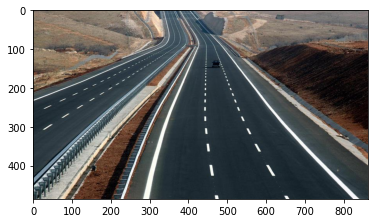

In [156]:
from scipy import misc

import matplotlib.pyplot as plt
import numpy as np
import math

import scipy.ndimage.filters as filters
import scipy.ndimage as ndimage

img = cv2.imread("images/highway1.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print('image shape: ', beach.shape)

plt.imshow(img)
plt.show()

# Here is the implimentation of the algorithm

<p><b>gaussian_blur:</b> Blur the image using Gassuan Filer using <b>_filter:</b> and <b>_create_gaussian:</b><br>
    <b>threshold:</b> Threshhold the image to better detect the edges<br>
    <b>intensity_gradient:</b> Finding the Gradients of the image in both directions<br>
    <b>suppression and edge_tracking and Canny:</b> To detect edges as was introduce in previous part<br>

In [16]:
def _create_gaussian(size, sigma):
    mid = size // 2
    kernel = np.zeros((size,size))
    for i in range(size):
        for j in range(size):
            x,y = i - mid, j - mid
            kernel[i,j] = np.exp(-(x**2+y**2)/(2*sigma**2)) / (2*np.pi * sigma**2)

    return kernel

def _filter(image, kernel):
    ksize = kernel.shape[0]
    pad = ksize // 2
    image_padded = np.zeros((image.shape[0] + 2*pad, image.shape[1] + 2*pad))
    image_padded[pad:-pad, pad:-pad] = image
    out = np.zeros_like(image)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            x,y = i + pad,j + pad
            out[i, j] = (kernel * image_padded[i:i + ksize, j:j + ksize]).sum()
    return out

def gaussian_blur(img, kernel_sz, sigma):
    kernel = _create_gaussian(kernel_sz, sigma)
    return _filter(img, kernel)


def threshold(img, level, upper_bound):
    bin_img = img.copy()
    print(bin_img.shape)
    h,w = bin_img.shape
    for i in range(h):
        for j in range(w):
            bin_img[i,j] = 0 if img[i,j] < level else upper_bound
    return bin_img

from scipy import ndimage

def intensity_gradient(img):
    # Sobel Kernel - Sobel_operator
    Kx = np.array([[-1, 0, 1], 
                   [-2, 0, 2], 
                   [-1, 0, 1]])
    Ky = np.array([[1, 2, 1], 
                   [0, 0, 0], 
                   [-1, -2, -1]])

    Gx = _filter(img, Kx)
    Gy = _filter(img, Ky)
    
    G = np.hypot(Gx, Gy)
    Theta = np.arctan2(Gy, Gx)
    return (G, Theta)

def round_angle(angle):
    angle = np.rad2deg(angle) % 180
    if (angle < 22.5 or 157.5 <= angle):
        angle = 0
    elif (22.5 <= angle < 67.5):
        angle = 45
    elif (67.5 <= angle < 112.5):
        angle = 90
    elif (112.5 <= angle < 157.5):
        angle = 135
    return angle

def suppression(img, Theta):
    Z = np.zeros(img.shape)
    for i in range(1,img.shape[0]-1):
        for j in range(1,img.shape[1]-1):
            angle = round_angle(Theta[i, j])
            if angle == 0:
                if (img[i, j] > img[i, j - 1]) and (img[i, j] > img[i, j + 1]):
                    Z[i,j] = img[i,j]
            elif angle == 90:
                if (img[i, j] > img[i - 1, j]) and (img[i, j] > img[i + 1, j]):
                    Z[i,j] = img[i,j]
            elif angle == 135:
                if (img[i, j] > img[i - 1, j - 1]) and (img[i, j] > img[i + 1, j + 1]):
                    Z[i,j] = img[i,j]
            elif angle == 45:
                if (img[i, j] > img[i - 1, j + 1]) and (img[i, j] > img[i + 1, j - 1]):
                    Z[i,j] = img[i,j]
    return Z

WEAK_PIXEL = 50
STRONG_PIXEL = 255
    
def double_threshold(img, th1, th2):
    img_th = np.zeros_like(img)
    img_th[np.where(img > th2)] = STRONG_PIXEL
    img_th[np.where((img >= th1) & (img <= th2))] = WEAK_PIXEL

    return img_th

def get_neighbors(img, i, j):
    neighbors = []
    neighbors.append(img[i+1,j])
    neighbors.append(img[i-1,j])
    neighbors.append(img[i,j+1])
    neighbors.append(img[i,j-1])
    
    neighbors.append(img[i+1,j+1])
    neighbors.append(img[i-1,j-1])
    neighbors.append(img[i-1,j+1])
    neighbors.append(img[i+1,j-1])
    
    return np.array(neighbors, dtype=np.int)

def edge_tracking(img):
    for i in range(1,img.shape[0]-1):
        for j in range(1,img.shape[1]-1):
            if img[i, j] == WEAK_PIXEL:
                neighbors = get_neighbors(img, i, j)
                has_strong_neighbor = (sum(neighbors == STRONG_PIXEL) != 0)
                img[i, j] = STRONG_PIXEL if has_strong_neighbor else 0
    return img

def Canny(img, th1, th2, sigma=1.4, kernel_size=11):
    # description - http://justin-liang.com/tutorials/canny/#grayscale
    im = img.astype('float').copy()
    im = gaussian_blur(im, kernel_size, sigma)
    im, Theta = intensity_gradient(im)    
    im = suppression(im, Theta)
    im = double_threshold(im, th1, th2)
    im = edge_tracking(im)
    return im.astype('uint8')

def _plot(img):
    plt.figure(figsize=Figsize)
    plt.imshow(img, cmap=plt.cm.gray)

# Here we define hyper parameters and find the edges

image shape:  (486, 863, 3)


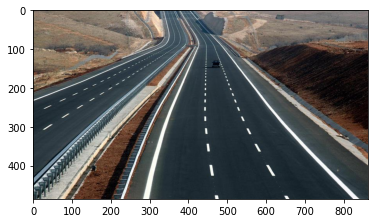

(486, 863)
Wall time: 11.4 s


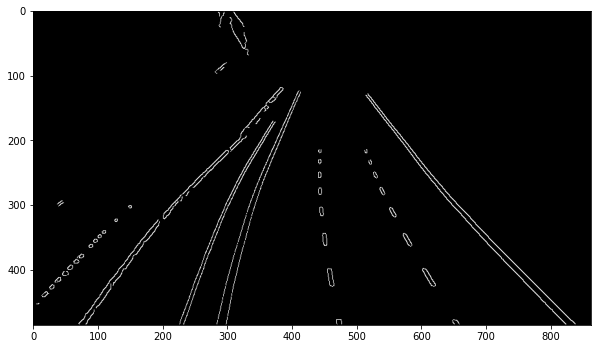

In [58]:
%%time
Threshold_binarization = 205
Canny_threshold_lower = 50
Canny_threshold_upper = 200
Hough_theta_step = np.pi / 180
Hough_rho_step = 1
Hough_threshold = 30
PIXEL_MAX = 640
Figsize = (10,10)

image = cv2.imread("images/highway1.jpg")
img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print('image shape: ', img.shape)
plt.imshow(img)
plt.show()

img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

bin_img = threshold(img, Threshold_binarization, PIXEL_MAX)
edges = Canny(bin_img, Canny_threshold_lower, Canny_threshold_upper)
_plot(edges)

image shape:  (406, 640, 3)


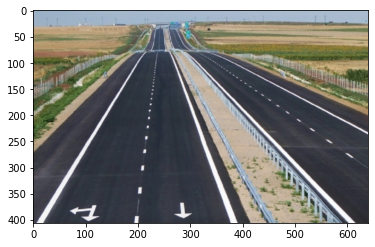

(406, 640)
Wall time: 7.52 s


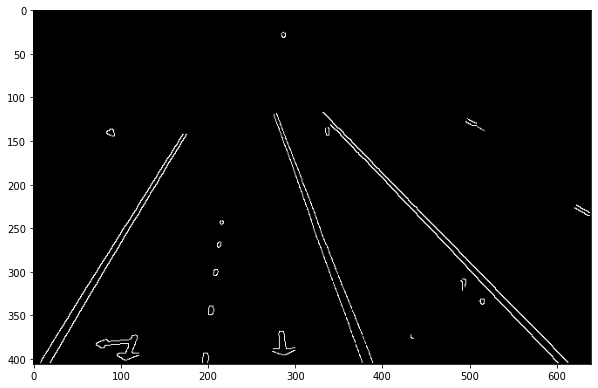

In [76]:
%%time
Threshold_binarization = 205
Canny_threshold_lower = 50
Canny_threshold_upper = 200
Hough_theta_step = np.pi / 180
Hough_rho_step = 1
Hough_threshold = 30
PIXEL_MAX = 640
Figsize = (10,10)

image = cv2.imread("images/highway2.jpg")
img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print('image shape: ', img.shape)
plt.imshow(img)
plt.show()

img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

bin_img = threshold(img, Threshold_binarization, PIXEL_MAX)
edges = Canny(bin_img, Canny_threshold_lower, Canny_threshold_upper)
_plot(edges)

# Finding edges using In-built Canny edge

image shape:  (406, 640)


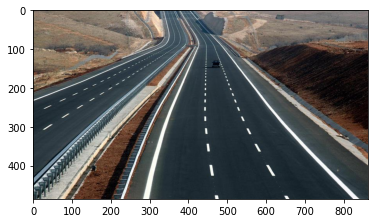

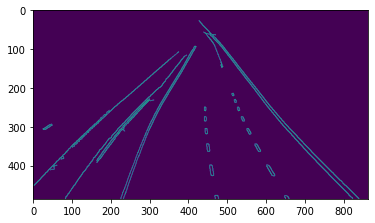

In [85]:
import cv2
import numpy as np

shapes = cv2.imread("images/highway1.jpg")
img2 = cv2.cvtColor(shapes, cv2.COLOR_BGR2RGB)
print('image shape: ', img.shape)

plt.imshow(img2)
plt.show()


shapes_grayscale = cv2.cvtColor(shapes, cv2.COLOR_RGB2GRAY)

# blur image (this will help clean up noise for Canny Edge Detection)
# see Chapter 2.0 for Guassian Blur or check OpenCV documentation
shapes_blurred = cv2.GaussianBlur(shapes_grayscale, (11, 11), 1.4)

# find Canny Edges and show resulting image
edges = cv2.Canny(shapes_blurred, 50, 450)

plt.imshow(edges)
plt.show()



image shape:  (406, 640)


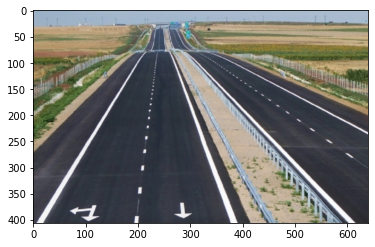

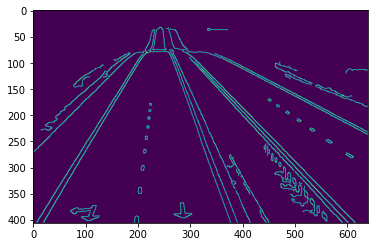

In [80]:
import cv2
import numpy as np

shapes = cv2.imread("images/highway2.jpg")
img2 = cv2.cvtColor(shapes, cv2.COLOR_BGR2RGB)
print('image shape: ', img.shape)

plt.imshow(img2)
plt.show()


shapes_grayscale = cv2.cvtColor(shapes, cv2.COLOR_RGB2GRAY)

# blur image (this will help clean up noise for Canny Edge Detection)
# see Chapter 2.0 for Guassian Blur or check OpenCV documentation
shapes_blurred = cv2.GaussianBlur(shapes_grayscale, (11, 11), 1.4)

# find Canny Edges and show resulting image
edges = cv2.Canny(shapes_blurred, 50, 250)

plt.imshow(edges)
plt.show()

Wall time: 16.2 s


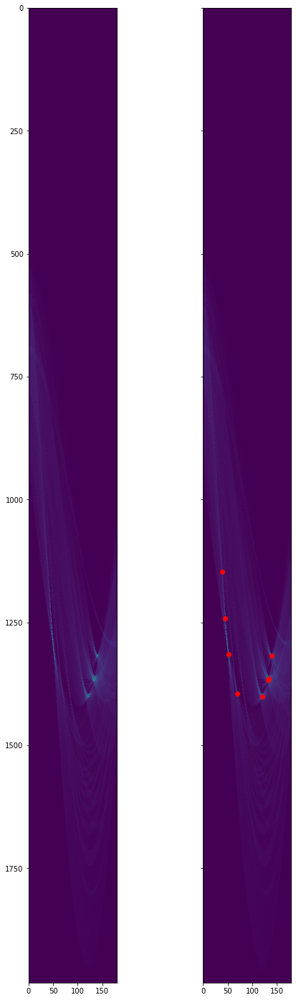

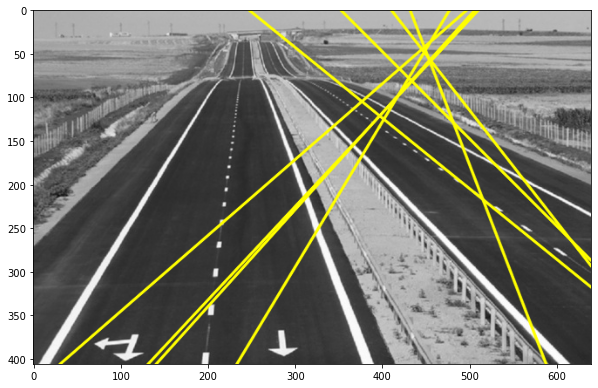

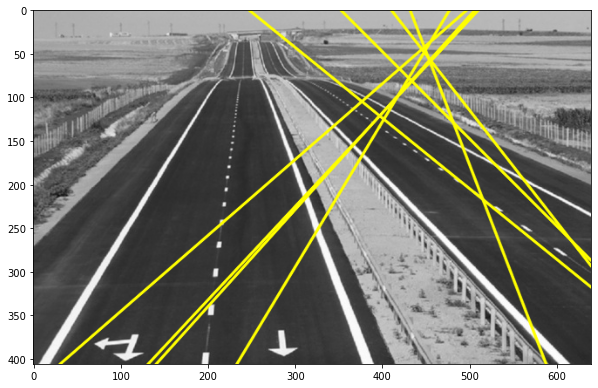

In [86]:
%%time
from skimage.feature import peak_local_max
from pylab import *

def get_lines(acc, thetas, rhos, threshold, min_distance):
    acc = np.where(acc>=threshold, acc, 0)
    lines_idx = peak_local_max(acc, min_distance=min_distance)
    sorted_idx = sorted(lines_idx, key=lambda x: acc[x[0]][x[1]], reverse=True)
    lines = []
    for ri,ti in sorted_idx:
        t = thetas[ti]
        r = rhos[ri]
        lines.append((t,r))
    return lines, sorted_idx


def hough_line(img, threshold, min_distance=20, theha_step=np.pi/180, rho_step=1, draw=False):
    theha_step_deg = np.rad2deg(theha_step)
    thetas = np.deg2rad(np.arange(-90.0, 90.0, step=theha_step_deg))
    width, height = img.shape
    max_r = int(np.ceil(np.sqrt(width * width + height * height)))   # max_dist
    rhos = np.arange(-max_r, max_r + 1, step=rho_step)

    acc = np.zeros((len(rhos), len(thetas)), dtype=np.uint8)
    y_idxs, x_idxs = np.nonzero(img)  # (row, col) indexes to edges

    for i in range(len(x_idxs)):
        x = x_idxs[i]
        y = y_idxs[i]

        for t_idx in range(len(thetas)):
            # Calculate rho. diag_len is added for a positive index
            t = thetas[t_idx]
            rho = int(round(x * np.cos(t) + y * np.sin(t))) + max_r
            acc[rho, t_idx] += 1

    lines,idx = get_lines(acc, thetas, rhos, threshold,min_distance)
    if draw:
        x,y = [t for r,t in idx], [r for r,t in idx]
        f, (ax1, ax2) = plt.subplots(1, 2, sharey=True, figsize=(8,25))
        ax1.imshow(acc)
        ax2.imshow(acc)
        ax2.plot(x,y, 'ro')
        ax2.autoscale(False)
        
    return lines

def plot_lines(img, lines, N=0):
    if lines is None: return
    dst = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    size = len(lines) if N == 0 else min(N, len(lines))
    for i in range(size):
        rho = lines[i][1]
        theta = lines[i][0]
            
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a * rho
        y0 = b * rho
        pt1 = (int(x0 + 1000*(-b)), int(y0 + 1000*(a)))
        pt2 = (int(x0 - 1000*(-b)), int(y0 - 1000*(a)))
            
        cv2.line(dst, pt1, pt2, (255,255,0), 2, cv2.LINE_AA)
        
    _plot(dst)


lines = hough_line(edges, threshold=Hough_threshold, theha_step=Hough_theta_step,
                   rho_step=Hough_rho_step, min_distance=20, draw=True)



plot_lines(img, lines)
# top 10 lines
plot_lines(img, lines, N=10)

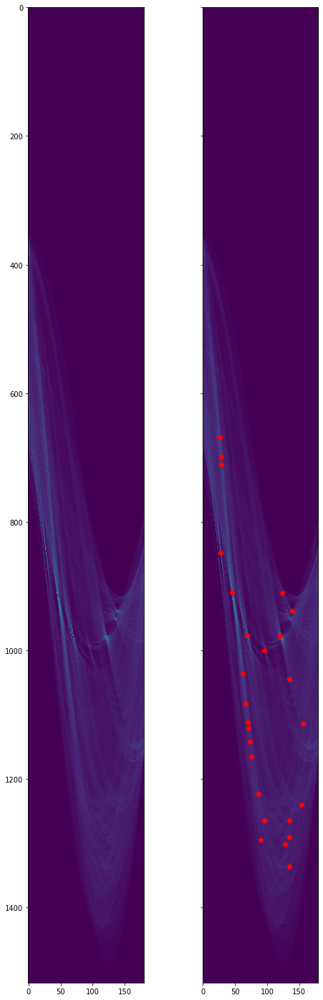

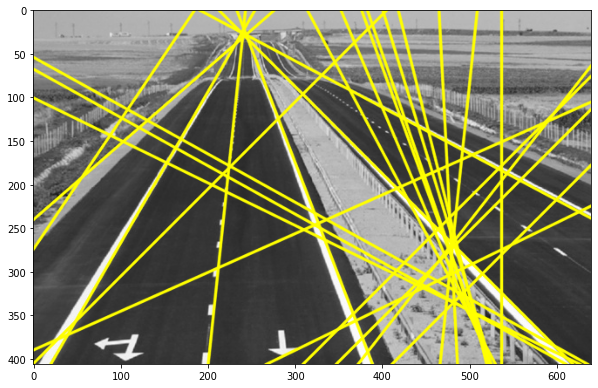

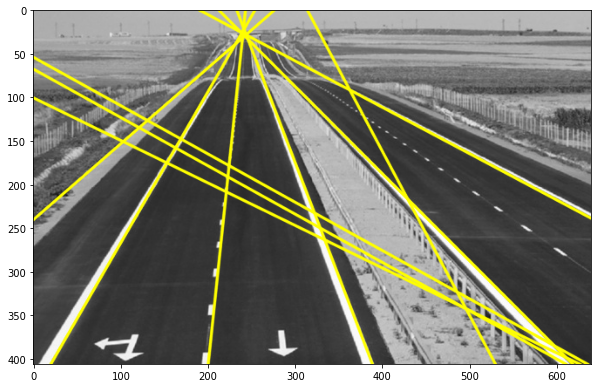

In [82]:
lines = hough_line(edges, threshold=Hough_threshold, theha_step=Hough_theta_step,
                   rho_step=Hough_rho_step, min_distance=20, draw=True)



plot_lines(img, lines)
# top 10 lines
plot_lines(img, lines, N=10)

# Question 3

# Load Dataset

750


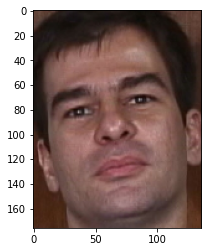

In [98]:
import cv2
import matplotlib.pyplot as plt
import os
import numpy as np

def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img = plt.imread(os.path.join(folder,filename))
        if img is not None:
            images.append(img)
    return images

folder="cropped_faces"

images = load_images_from_folder(folder)
print(len(images))

plt.imshow(images[1], cmap='gray')
plt.show()

# Devide dataset into train and test

In [99]:
train_img = np.array(images[:int(len(images)/2)])
test_img = np.array(images[int(len(images)/2):])

print(len(train_img), len(test_img))

375 375


# Find SIFT keypoints and Descriptors for each image

In [100]:
# Initiate SIFT detector
sift = cv2.SIFT_create()

kp_train = []
des_train = []

kp_test = []
des_test = []
# find the keypoints and descriptors with SIFT
for img in train_img:
    kp, des = sift.detectAndCompute(img,None)
    kp_train.append(kp), des_train.append(des)
    
for img in test_img:
    kp, des = sift.detectAndCompute(img,None)
    kp_test.append(kp), des_test.append(des)

In [101]:
print(np.array(des_train[0]).shape)
print(np.array(des_test).shape)

(167, 128)
(375,)


# find similar images using euclidean distance between descriptors of the images

In [108]:
from scipy.spatial import distance
def matchFeatures2(desc1, desc2):
    matches = []
    dist = distance.cdist(desc1, desc2)

    for i in range(len(dist)):
        for j in range(len(dist[0])):
            if dist[i][j] < 300:
                matches.append((i,j))
    return matches
                
def findSimilarImages(train_descs):
    train_match_dict = {k: [] for k in range(375)}
    for i in range(len(train_descs)):
        for j in range(len(train_descs)):
            matches = matchFeatures2(train_descs[i], train_descs[j])
            print('Compare image number: ', i, 'To Image Number: ', j ,' And Number of matched Points : ', len(matches))
            if len(matches) >= 30:
                print('Match Found!')
                train_match_dict[i].append((j, len(matches)))

    return train_match_dict

train_match_dict = findSimilarImages(des_train)

Compare image number:  0 To Image Number:  0  And Number of matched Points :  357
Match Found!
Compare image number:  0 To Image Number:  1  And Number of matched Points :  48
Match Found!
Compare image number:  0 To Image Number:  2  And Number of matched Points :  60
Match Found!
Compare image number:  0 To Image Number:  3  And Number of matched Points :  43
Match Found!
Compare image number:  0 To Image Number:  4  And Number of matched Points :  159
Match Found!
Compare image number:  0 To Image Number:  5  And Number of matched Points :  155
Match Found!
Compare image number:  0 To Image Number:  6  And Number of matched Points :  48
Match Found!
Compare image number:  0 To Image Number:  7  And Number of matched Points :  37
Match Found!
Compare image number:  0 To Image Number:  8  And Number of matched Points :  69
Match Found!
Compare image number:  0 To Image Number:  9  And Number of matched Points :  54
Match Found!
Compare image number:  0 To Image Number:  10  And Number

Compare image number:  0 To Image Number:  102  And Number of matched Points :  47
Match Found!
Compare image number:  0 To Image Number:  103  And Number of matched Points :  42
Match Found!
Compare image number:  0 To Image Number:  104  And Number of matched Points :  42
Match Found!
Compare image number:  0 To Image Number:  105  And Number of matched Points :  305
Match Found!
Compare image number:  0 To Image Number:  106  And Number of matched Points :  252
Match Found!
Compare image number:  0 To Image Number:  107  And Number of matched Points :  198
Match Found!
Compare image number:  0 To Image Number:  108  And Number of matched Points :  237
Match Found!
Compare image number:  0 To Image Number:  109  And Number of matched Points :  58
Match Found!
Compare image number:  0 To Image Number:  110  And Number of matched Points :  70
Match Found!
Compare image number:  0 To Image Number:  111  And Number of matched Points :  50
Match Found!
Compare image number:  0 To Image Nu

Compare image number:  0 To Image Number:  196  And Number of matched Points :  126
Match Found!
Compare image number:  0 To Image Number:  197  And Number of matched Points :  174
Match Found!
Compare image number:  0 To Image Number:  198  And Number of matched Points :  127
Match Found!
Compare image number:  0 To Image Number:  199  And Number of matched Points :  167
Match Found!
Compare image number:  0 To Image Number:  200  And Number of matched Points :  27
Compare image number:  0 To Image Number:  201  And Number of matched Points :  79
Match Found!
Compare image number:  0 To Image Number:  202  And Number of matched Points :  46
Match Found!
Compare image number:  0 To Image Number:  203  And Number of matched Points :  59
Match Found!
Compare image number:  0 To Image Number:  204  And Number of matched Points :  23
Compare image number:  0 To Image Number:  205  And Number of matched Points :  34
Match Found!
Compare image number:  0 To Image Number:  206  And Number of 

Compare image number:  0 To Image Number:  294  And Number of matched Points :  28
Compare image number:  0 To Image Number:  295  And Number of matched Points :  7
Compare image number:  0 To Image Number:  296  And Number of matched Points :  0
Compare image number:  0 To Image Number:  297  And Number of matched Points :  35
Match Found!
Compare image number:  0 To Image Number:  298  And Number of matched Points :  21
Compare image number:  0 To Image Number:  299  And Number of matched Points :  0
Compare image number:  0 To Image Number:  300  And Number of matched Points :  48
Match Found!
Compare image number:  0 To Image Number:  301  And Number of matched Points :  105
Match Found!
Compare image number:  0 To Image Number:  302  And Number of matched Points :  100
Match Found!
Compare image number:  0 To Image Number:  303  And Number of matched Points :  168
Match Found!
Compare image number:  0 To Image Number:  304  And Number of matched Points :  188
Match Found!
Compare 

Compare image number:  1 To Image Number:  15  And Number of matched Points :  15
Compare image number:  1 To Image Number:  16  And Number of matched Points :  6
Compare image number:  1 To Image Number:  17  And Number of matched Points :  6
Compare image number:  1 To Image Number:  18  And Number of matched Points :  13
Compare image number:  1 To Image Number:  19  And Number of matched Points :  21
Compare image number:  1 To Image Number:  20  And Number of matched Points :  9
Compare image number:  1 To Image Number:  21  And Number of matched Points :  7
Compare image number:  1 To Image Number:  22  And Number of matched Points :  24
Compare image number:  1 To Image Number:  23  And Number of matched Points :  6
Compare image number:  1 To Image Number:  24  And Number of matched Points :  11
Compare image number:  1 To Image Number:  25  And Number of matched Points :  14
Compare image number:  1 To Image Number:  26  And Number of matched Points :  10
Compare image number:

Compare image number:  1 To Image Number:  120  And Number of matched Points :  9
Compare image number:  1 To Image Number:  121  And Number of matched Points :  5
Compare image number:  1 To Image Number:  122  And Number of matched Points :  14
Compare image number:  1 To Image Number:  123  And Number of matched Points :  7
Compare image number:  1 To Image Number:  124  And Number of matched Points :  9
Compare image number:  1 To Image Number:  125  And Number of matched Points :  16
Compare image number:  1 To Image Number:  126  And Number of matched Points :  18
Compare image number:  1 To Image Number:  127  And Number of matched Points :  20
Compare image number:  1 To Image Number:  128  And Number of matched Points :  8
Compare image number:  1 To Image Number:  129  And Number of matched Points :  14
Compare image number:  1 To Image Number:  130  And Number of matched Points :  20
Compare image number:  1 To Image Number:  131  And Number of matched Points :  13
Compare i

Compare image number:  1 To Image Number:  237  And Number of matched Points :  16
Compare image number:  1 To Image Number:  238  And Number of matched Points :  33
Match Found!
Compare image number:  1 To Image Number:  239  And Number of matched Points :  12
Compare image number:  1 To Image Number:  240  And Number of matched Points :  38
Match Found!
Compare image number:  1 To Image Number:  241  And Number of matched Points :  26
Compare image number:  1 To Image Number:  242  And Number of matched Points :  19
Compare image number:  1 To Image Number:  243  And Number of matched Points :  25
Compare image number:  1 To Image Number:  244  And Number of matched Points :  25
Compare image number:  1 To Image Number:  245  And Number of matched Points :  17
Compare image number:  1 To Image Number:  246  And Number of matched Points :  24
Compare image number:  1 To Image Number:  247  And Number of matched Points :  19
Compare image number:  1 To Image Number:  248  And Number of

Compare image number:  1 To Image Number:  337  And Number of matched Points :  28
Compare image number:  1 To Image Number:  338  And Number of matched Points :  31
Match Found!
Compare image number:  1 To Image Number:  339  And Number of matched Points :  29
Compare image number:  1 To Image Number:  340  And Number of matched Points :  22
Compare image number:  1 To Image Number:  341  And Number of matched Points :  30
Match Found!
Compare image number:  1 To Image Number:  342  And Number of matched Points :  32
Match Found!
Compare image number:  1 To Image Number:  343  And Number of matched Points :  38
Match Found!
Compare image number:  1 To Image Number:  344  And Number of matched Points :  27
Compare image number:  1 To Image Number:  345  And Number of matched Points :  39
Match Found!
Compare image number:  1 To Image Number:  346  And Number of matched Points :  24
Compare image number:  1 To Image Number:  347  And Number of matched Points :  30
Match Found!
Compare i

Compare image number:  2 To Image Number:  69  And Number of matched Points :  28
Compare image number:  2 To Image Number:  70  And Number of matched Points :  24
Compare image number:  2 To Image Number:  71  And Number of matched Points :  34
Match Found!
Compare image number:  2 To Image Number:  72  And Number of matched Points :  17
Compare image number:  2 To Image Number:  73  And Number of matched Points :  21
Compare image number:  2 To Image Number:  74  And Number of matched Points :  21
Compare image number:  2 To Image Number:  75  And Number of matched Points :  23
Compare image number:  2 To Image Number:  76  And Number of matched Points :  7
Compare image number:  2 To Image Number:  77  And Number of matched Points :  24
Compare image number:  2 To Image Number:  78  And Number of matched Points :  13
Compare image number:  2 To Image Number:  79  And Number of matched Points :  45
Match Found!
Compare image number:  2 To Image Number:  80  And Number of matched Poin

Compare image number:  2 To Image Number:  181  And Number of matched Points :  26
Compare image number:  2 To Image Number:  182  And Number of matched Points :  5
Compare image number:  2 To Image Number:  183  And Number of matched Points :  26
Compare image number:  2 To Image Number:  184  And Number of matched Points :  32
Match Found!
Compare image number:  2 To Image Number:  185  And Number of matched Points :  25
Compare image number:  2 To Image Number:  186  And Number of matched Points :  13
Compare image number:  2 To Image Number:  187  And Number of matched Points :  6
Compare image number:  2 To Image Number:  188  And Number of matched Points :  4
Compare image number:  2 To Image Number:  189  And Number of matched Points :  8
Compare image number:  2 To Image Number:  190  And Number of matched Points :  17
Compare image number:  2 To Image Number:  191  And Number of matched Points :  4
Compare image number:  2 To Image Number:  192  And Number of matched Points : 

Compare image number:  2 To Image Number:  275  And Number of matched Points :  25
Compare image number:  2 To Image Number:  276  And Number of matched Points :  34
Match Found!
Compare image number:  2 To Image Number:  277  And Number of matched Points :  32
Match Found!
Compare image number:  2 To Image Number:  278  And Number of matched Points :  50
Match Found!
Compare image number:  2 To Image Number:  279  And Number of matched Points :  30
Match Found!
Compare image number:  2 To Image Number:  280  And Number of matched Points :  40
Match Found!
Compare image number:  2 To Image Number:  281  And Number of matched Points :  37
Match Found!
Compare image number:  2 To Image Number:  282  And Number of matched Points :  51
Match Found!
Compare image number:  2 To Image Number:  283  And Number of matched Points :  28
Compare image number:  2 To Image Number:  284  And Number of matched Points :  24
Compare image number:  2 To Image Number:  285  And Number of matched Points : 

Compare image number:  3 To Image Number:  14  And Number of matched Points :  15
Compare image number:  3 To Image Number:  15  And Number of matched Points :  8
Compare image number:  3 To Image Number:  16  And Number of matched Points :  20
Compare image number:  3 To Image Number:  17  And Number of matched Points :  10
Compare image number:  3 To Image Number:  18  And Number of matched Points :  8
Compare image number:  3 To Image Number:  19  And Number of matched Points :  10
Compare image number:  3 To Image Number:  20  And Number of matched Points :  13
Compare image number:  3 To Image Number:  21  And Number of matched Points :  13
Compare image number:  3 To Image Number:  22  And Number of matched Points :  11
Compare image number:  3 To Image Number:  23  And Number of matched Points :  16
Compare image number:  3 To Image Number:  24  And Number of matched Points :  15
Compare image number:  3 To Image Number:  25  And Number of matched Points :  14
Compare image numb

Compare image number:  3 To Image Number:  131  And Number of matched Points :  22
Compare image number:  3 To Image Number:  132  And Number of matched Points :  21
Compare image number:  3 To Image Number:  133  And Number of matched Points :  33
Match Found!
Compare image number:  3 To Image Number:  134  And Number of matched Points :  25
Compare image number:  3 To Image Number:  135  And Number of matched Points :  34
Match Found!
Compare image number:  3 To Image Number:  136  And Number of matched Points :  32
Match Found!
Compare image number:  3 To Image Number:  137  And Number of matched Points :  38
Match Found!
Compare image number:  3 To Image Number:  138  And Number of matched Points :  15
Compare image number:  3 To Image Number:  139  And Number of matched Points :  32
Match Found!
Compare image number:  3 To Image Number:  140  And Number of matched Points :  29
Compare image number:  3 To Image Number:  141  And Number of matched Points :  11
Compare image number: 

Compare image number:  3 To Image Number:  242  And Number of matched Points :  30
Match Found!
Compare image number:  3 To Image Number:  243  And Number of matched Points :  37
Match Found!
Compare image number:  3 To Image Number:  244  And Number of matched Points :  55
Match Found!
Compare image number:  3 To Image Number:  245  And Number of matched Points :  31
Match Found!
Compare image number:  3 To Image Number:  246  And Number of matched Points :  32
Match Found!
Compare image number:  3 To Image Number:  247  And Number of matched Points :  15
Compare image number:  3 To Image Number:  248  And Number of matched Points :  38
Match Found!
Compare image number:  3 To Image Number:  249  And Number of matched Points :  29
Compare image number:  3 To Image Number:  250  And Number of matched Points :  52
Match Found!
Compare image number:  3 To Image Number:  251  And Number of matched Points :  35
Match Found!
Compare image number:  3 To Image Number:  252  And Number of matc

Compare image number:  3 To Image Number:  345  And Number of matched Points :  31
Match Found!
Compare image number:  3 To Image Number:  346  And Number of matched Points :  26
Compare image number:  3 To Image Number:  347  And Number of matched Points :  42
Match Found!
Compare image number:  3 To Image Number:  348  And Number of matched Points :  25
Compare image number:  3 To Image Number:  349  And Number of matched Points :  27
Compare image number:  3 To Image Number:  350  And Number of matched Points :  42
Match Found!
Compare image number:  3 To Image Number:  351  And Number of matched Points :  39
Match Found!
Compare image number:  3 To Image Number:  352  And Number of matched Points :  28
Compare image number:  3 To Image Number:  353  And Number of matched Points :  37
Match Found!
Compare image number:  3 To Image Number:  354  And Number of matched Points :  56
Match Found!
Compare image number:  3 To Image Number:  355  And Number of matched Points :  41
Match Fou

Compare image number:  4 To Image Number:  71  And Number of matched Points :  120
Match Found!
Compare image number:  4 To Image Number:  72  And Number of matched Points :  66
Match Found!
Compare image number:  4 To Image Number:  73  And Number of matched Points :  99
Match Found!
Compare image number:  4 To Image Number:  74  And Number of matched Points :  78
Match Found!
Compare image number:  4 To Image Number:  75  And Number of matched Points :  64
Match Found!
Compare image number:  4 To Image Number:  76  And Number of matched Points :  13
Compare image number:  4 To Image Number:  77  And Number of matched Points :  70
Match Found!
Compare image number:  4 To Image Number:  78  And Number of matched Points :  17
Compare image number:  4 To Image Number:  79  And Number of matched Points :  112
Match Found!
Compare image number:  4 To Image Number:  80  And Number of matched Points :  61
Match Found!
Compare image number:  4 To Image Number:  81  And Number of matched Point

Compare image number:  4 To Image Number:  172  And Number of matched Points :  27
Compare image number:  4 To Image Number:  173  And Number of matched Points :  15
Compare image number:  4 To Image Number:  174  And Number of matched Points :  21
Compare image number:  4 To Image Number:  175  And Number of matched Points :  6
Compare image number:  4 To Image Number:  176  And Number of matched Points :  6
Compare image number:  4 To Image Number:  177  And Number of matched Points :  13
Compare image number:  4 To Image Number:  178  And Number of matched Points :  29
Compare image number:  4 To Image Number:  179  And Number of matched Points :  15
Compare image number:  4 To Image Number:  180  And Number of matched Points :  81
Match Found!
Compare image number:  4 To Image Number:  181  And Number of matched Points :  73
Match Found!
Compare image number:  4 To Image Number:  182  And Number of matched Points :  9
Compare image number:  4 To Image Number:  183  And Number of ma

Compare image number:  4 To Image Number:  263  And Number of matched Points :  64
Match Found!
Compare image number:  4 To Image Number:  264  And Number of matched Points :  33
Match Found!
Compare image number:  4 To Image Number:  265  And Number of matched Points :  19
Compare image number:  4 To Image Number:  266  And Number of matched Points :  49
Match Found!
Compare image number:  4 To Image Number:  267  And Number of matched Points :  19
Compare image number:  4 To Image Number:  268  And Number of matched Points :  64
Match Found!
Compare image number:  4 To Image Number:  269  And Number of matched Points :  63
Match Found!
Compare image number:  4 To Image Number:  270  And Number of matched Points :  195
Match Found!
Compare image number:  4 To Image Number:  271  And Number of matched Points :  115
Match Found!
Compare image number:  4 To Image Number:  272  And Number of matched Points :  141
Match Found!
Compare image number:  4 To Image Number:  273  And Number of m

Compare image number:  4 To Image Number:  352  And Number of matched Points :  133
Match Found!
Compare image number:  4 To Image Number:  353  And Number of matched Points :  174
Match Found!
Compare image number:  4 To Image Number:  354  And Number of matched Points :  193
Match Found!
Compare image number:  4 To Image Number:  355  And Number of matched Points :  177
Match Found!
Compare image number:  4 To Image Number:  356  And Number of matched Points :  168
Match Found!
Compare image number:  4 To Image Number:  357  And Number of matched Points :  165
Match Found!
Compare image number:  4 To Image Number:  358  And Number of matched Points :  208
Match Found!
Compare image number:  4 To Image Number:  359  And Number of matched Points :  203
Match Found!
Compare image number:  4 To Image Number:  360  And Number of matched Points :  2
Compare image number:  4 To Image Number:  361  And Number of matched Points :  136
Match Found!
Compare image number:  4 To Image Number:  36

Compare image number:  5 To Image Number:  71  And Number of matched Points :  91
Match Found!
Compare image number:  5 To Image Number:  72  And Number of matched Points :  60
Match Found!
Compare image number:  5 To Image Number:  73  And Number of matched Points :  71
Match Found!
Compare image number:  5 To Image Number:  74  And Number of matched Points :  56
Match Found!
Compare image number:  5 To Image Number:  75  And Number of matched Points :  71
Match Found!
Compare image number:  5 To Image Number:  76  And Number of matched Points :  14
Compare image number:  5 To Image Number:  77  And Number of matched Points :  82
Match Found!
Compare image number:  5 To Image Number:  78  And Number of matched Points :  22
Compare image number:  5 To Image Number:  79  And Number of matched Points :  84
Match Found!
Compare image number:  5 To Image Number:  80  And Number of matched Points :  59
Match Found!
Compare image number:  5 To Image Number:  81  And Number of matched Points 

Compare image number:  5 To Image Number:  166  And Number of matched Points :  12
Compare image number:  5 To Image Number:  167  And Number of matched Points :  13
Compare image number:  5 To Image Number:  168  And Number of matched Points :  10
Compare image number:  5 To Image Number:  169  And Number of matched Points :  22
Compare image number:  5 To Image Number:  170  And Number of matched Points :  15
Compare image number:  5 To Image Number:  171  And Number of matched Points :  30
Match Found!
Compare image number:  5 To Image Number:  172  And Number of matched Points :  20
Compare image number:  5 To Image Number:  173  And Number of matched Points :  5
Compare image number:  5 To Image Number:  174  And Number of matched Points :  13
Compare image number:  5 To Image Number:  175  And Number of matched Points :  4
Compare image number:  5 To Image Number:  176  And Number of matched Points :  5
Compare image number:  5 To Image Number:  177  And Number of matched Points 

Compare image number:  5 To Image Number:  267  And Number of matched Points :  18
Compare image number:  5 To Image Number:  268  And Number of matched Points :  41
Match Found!
Compare image number:  5 To Image Number:  269  And Number of matched Points :  63
Match Found!
Compare image number:  5 To Image Number:  270  And Number of matched Points :  153
Match Found!
Compare image number:  5 To Image Number:  271  And Number of matched Points :  87
Match Found!
Compare image number:  5 To Image Number:  272  And Number of matched Points :  107
Match Found!
Compare image number:  5 To Image Number:  273  And Number of matched Points :  89
Match Found!
Compare image number:  5 To Image Number:  274  And Number of matched Points :  47
Match Found!
Compare image number:  5 To Image Number:  275  And Number of matched Points :  85
Match Found!
Compare image number:  5 To Image Number:  276  And Number of matched Points :  66
Match Found!
Compare image number:  5 To Image Number:  277  And

Compare image number:  5 To Image Number:  363  And Number of matched Points :  142
Match Found!
Compare image number:  5 To Image Number:  364  And Number of matched Points :  13
Compare image number:  5 To Image Number:  365  And Number of matched Points :  11
Compare image number:  5 To Image Number:  366  And Number of matched Points :  16
Compare image number:  5 To Image Number:  367  And Number of matched Points :  31
Match Found!
Compare image number:  5 To Image Number:  368  And Number of matched Points :  21
Compare image number:  5 To Image Number:  369  And Number of matched Points :  20
Compare image number:  5 To Image Number:  370  And Number of matched Points :  1
Compare image number:  5 To Image Number:  371  And Number of matched Points :  9
Compare image number:  5 To Image Number:  372  And Number of matched Points :  3
Compare image number:  5 To Image Number:  373  And Number of matched Points :  16
Compare image number:  5 To Image Number:  374  And Number of m

Compare image number:  6 To Image Number:  101  And Number of matched Points :  17
Compare image number:  6 To Image Number:  102  And Number of matched Points :  13
Compare image number:  6 To Image Number:  103  And Number of matched Points :  12
Compare image number:  6 To Image Number:  104  And Number of matched Points :  21
Compare image number:  6 To Image Number:  105  And Number of matched Points :  44
Match Found!
Compare image number:  6 To Image Number:  106  And Number of matched Points :  36
Match Found!
Compare image number:  6 To Image Number:  107  And Number of matched Points :  34
Match Found!
Compare image number:  6 To Image Number:  108  And Number of matched Points :  38
Match Found!
Compare image number:  6 To Image Number:  109  And Number of matched Points :  25
Compare image number:  6 To Image Number:  110  And Number of matched Points :  21
Compare image number:  6 To Image Number:  111  And Number of matched Points :  14
Compare image number:  6 To Image N

Compare image number:  6 To Image Number:  198  And Number of matched Points :  18
Compare image number:  6 To Image Number:  199  And Number of matched Points :  25
Compare image number:  6 To Image Number:  200  And Number of matched Points :  6
Compare image number:  6 To Image Number:  201  And Number of matched Points :  11
Compare image number:  6 To Image Number:  202  And Number of matched Points :  14
Compare image number:  6 To Image Number:  203  And Number of matched Points :  15
Compare image number:  6 To Image Number:  204  And Number of matched Points :  4
Compare image number:  6 To Image Number:  205  And Number of matched Points :  6
Compare image number:  6 To Image Number:  206  And Number of matched Points :  7
Compare image number:  6 To Image Number:  207  And Number of matched Points :  8
Compare image number:  6 To Image Number:  208  And Number of matched Points :  23
Compare image number:  6 To Image Number:  209  And Number of matched Points :  8
Compare im

Compare image number:  6 To Image Number:  313  And Number of matched Points :  4
Compare image number:  6 To Image Number:  314  And Number of matched Points :  15
Compare image number:  6 To Image Number:  315  And Number of matched Points :  9
Compare image number:  6 To Image Number:  316  And Number of matched Points :  12
Compare image number:  6 To Image Number:  317  And Number of matched Points :  10
Compare image number:  6 To Image Number:  318  And Number of matched Points :  5
Compare image number:  6 To Image Number:  319  And Number of matched Points :  4
Compare image number:  6 To Image Number:  320  And Number of matched Points :  6
Compare image number:  6 To Image Number:  321  And Number of matched Points :  15
Compare image number:  6 To Image Number:  322  And Number of matched Points :  18
Compare image number:  6 To Image Number:  323  And Number of matched Points :  17
Compare image number:  6 To Image Number:  324  And Number of matched Points :  2
Compare im

Compare image number:  7 To Image Number:  35  And Number of matched Points :  17
Compare image number:  7 To Image Number:  36  And Number of matched Points :  8
Compare image number:  7 To Image Number:  37  And Number of matched Points :  15
Compare image number:  7 To Image Number:  38  And Number of matched Points :  16
Compare image number:  7 To Image Number:  39  And Number of matched Points :  27
Compare image number:  7 To Image Number:  40  And Number of matched Points :  27
Compare image number:  7 To Image Number:  41  And Number of matched Points :  18
Compare image number:  7 To Image Number:  42  And Number of matched Points :  21
Compare image number:  7 To Image Number:  43  And Number of matched Points :  17
Compare image number:  7 To Image Number:  44  And Number of matched Points :  11
Compare image number:  7 To Image Number:  45  And Number of matched Points :  27
Compare image number:  7 To Image Number:  46  And Number of matched Points :  27
Compare image num

Compare image number:  7 To Image Number:  142  And Number of matched Points :  26
Compare image number:  7 To Image Number:  143  And Number of matched Points :  21
Compare image number:  7 To Image Number:  144  And Number of matched Points :  3
Compare image number:  7 To Image Number:  145  And Number of matched Points :  4
Compare image number:  7 To Image Number:  146  And Number of matched Points :  16
Compare image number:  7 To Image Number:  147  And Number of matched Points :  11
Compare image number:  7 To Image Number:  148  And Number of matched Points :  7
Compare image number:  7 To Image Number:  149  And Number of matched Points :  15
Compare image number:  7 To Image Number:  150  And Number of matched Points :  2
Compare image number:  7 To Image Number:  151  And Number of matched Points :  10
Compare image number:  7 To Image Number:  152  And Number of matched Points :  19
Compare image number:  7 To Image Number:  153  And Number of matched Points :  24
Compare 

Compare image number:  7 To Image Number:  252  And Number of matched Points :  23
Compare image number:  7 To Image Number:  253  And Number of matched Points :  26
Compare image number:  7 To Image Number:  254  And Number of matched Points :  20
Compare image number:  7 To Image Number:  255  And Number of matched Points :  32
Match Found!
Compare image number:  7 To Image Number:  256  And Number of matched Points :  30
Match Found!
Compare image number:  7 To Image Number:  257  And Number of matched Points :  31
Match Found!
Compare image number:  7 To Image Number:  258  And Number of matched Points :  46
Match Found!
Compare image number:  7 To Image Number:  259  And Number of matched Points :  27
Compare image number:  7 To Image Number:  260  And Number of matched Points :  33
Match Found!
Compare image number:  7 To Image Number:  261  And Number of matched Points :  22
Compare image number:  7 To Image Number:  262  And Number of matched Points :  14
Compare image number: 

Compare image number:  7 To Image Number:  355  And Number of matched Points :  33
Match Found!
Compare image number:  7 To Image Number:  356  And Number of matched Points :  38
Match Found!
Compare image number:  7 To Image Number:  357  And Number of matched Points :  27
Compare image number:  7 To Image Number:  358  And Number of matched Points :  33
Match Found!
Compare image number:  7 To Image Number:  359  And Number of matched Points :  27
Compare image number:  7 To Image Number:  360  And Number of matched Points :  4
Compare image number:  7 To Image Number:  361  And Number of matched Points :  24
Compare image number:  7 To Image Number:  362  And Number of matched Points :  2
Compare image number:  7 To Image Number:  363  And Number of matched Points :  35
Match Found!
Compare image number:  7 To Image Number:  364  And Number of matched Points :  12
Compare image number:  7 To Image Number:  365  And Number of matched Points :  12
Compare image number:  7 To Image Num

Compare image number:  8 To Image Number:  85  And Number of matched Points :  24
Compare image number:  8 To Image Number:  86  And Number of matched Points :  22
Compare image number:  8 To Image Number:  87  And Number of matched Points :  23
Compare image number:  8 To Image Number:  88  And Number of matched Points :  32
Match Found!
Compare image number:  8 To Image Number:  89  And Number of matched Points :  35
Match Found!
Compare image number:  8 To Image Number:  90  And Number of matched Points :  33
Match Found!
Compare image number:  8 To Image Number:  91  And Number of matched Points :  18
Compare image number:  8 To Image Number:  92  And Number of matched Points :  15
Compare image number:  8 To Image Number:  93  And Number of matched Points :  26
Compare image number:  8 To Image Number:  94  And Number of matched Points :  33
Match Found!
Compare image number:  8 To Image Number:  95  And Number of matched Points :  30
Match Found!
Compare image number:  8 To Image

Compare image number:  8 To Image Number:  182  And Number of matched Points :  12
Compare image number:  8 To Image Number:  183  And Number of matched Points :  17
Compare image number:  8 To Image Number:  184  And Number of matched Points :  17
Compare image number:  8 To Image Number:  185  And Number of matched Points :  31
Match Found!
Compare image number:  8 To Image Number:  186  And Number of matched Points :  14
Compare image number:  8 To Image Number:  187  And Number of matched Points :  8
Compare image number:  8 To Image Number:  188  And Number of matched Points :  7
Compare image number:  8 To Image Number:  189  And Number of matched Points :  10
Compare image number:  8 To Image Number:  190  And Number of matched Points :  22
Compare image number:  8 To Image Number:  191  And Number of matched Points :  5
Compare image number:  8 To Image Number:  192  And Number of matched Points :  16
Compare image number:  8 To Image Number:  193  And Number of matched Points 

Compare image number:  8 To Image Number:  289  And Number of matched Points :  17
Compare image number:  8 To Image Number:  290  And Number of matched Points :  11
Compare image number:  8 To Image Number:  291  And Number of matched Points :  4
Compare image number:  8 To Image Number:  292  And Number of matched Points :  10
Compare image number:  8 To Image Number:  293  And Number of matched Points :  9
Compare image number:  8 To Image Number:  294  And Number of matched Points :  14
Compare image number:  8 To Image Number:  295  And Number of matched Points :  3
Compare image number:  8 To Image Number:  296  And Number of matched Points :  6
Compare image number:  8 To Image Number:  297  And Number of matched Points :  14
Compare image number:  8 To Image Number:  298  And Number of matched Points :  5
Compare image number:  8 To Image Number:  299  And Number of matched Points :  7
Compare image number:  8 To Image Number:  300  And Number of matched Points :  12
Compare im

Compare image number:  9 To Image Number:  13  And Number of matched Points :  33
Match Found!
Compare image number:  9 To Image Number:  14  And Number of matched Points :  34
Match Found!
Compare image number:  9 To Image Number:  15  And Number of matched Points :  15
Compare image number:  9 To Image Number:  16  And Number of matched Points :  13
Compare image number:  9 To Image Number:  17  And Number of matched Points :  12
Compare image number:  9 To Image Number:  18  And Number of matched Points :  17
Compare image number:  9 To Image Number:  19  And Number of matched Points :  25
Compare image number:  9 To Image Number:  20  And Number of matched Points :  11
Compare image number:  9 To Image Number:  21  And Number of matched Points :  20
Compare image number:  9 To Image Number:  22  And Number of matched Points :  24
Compare image number:  9 To Image Number:  23  And Number of matched Points :  15
Compare image number:  9 To Image Number:  24  And Number of matched Poi

Compare image number:  9 To Image Number:  110  And Number of matched Points :  16
Compare image number:  9 To Image Number:  111  And Number of matched Points :  13
Compare image number:  9 To Image Number:  112  And Number of matched Points :  20
Compare image number:  9 To Image Number:  113  And Number of matched Points :  20
Compare image number:  9 To Image Number:  114  And Number of matched Points :  16
Compare image number:  9 To Image Number:  115  And Number of matched Points :  20
Compare image number:  9 To Image Number:  116  And Number of matched Points :  19
Compare image number:  9 To Image Number:  117  And Number of matched Points :  6
Compare image number:  9 To Image Number:  118  And Number of matched Points :  10
Compare image number:  9 To Image Number:  119  And Number of matched Points :  33
Match Found!
Compare image number:  9 To Image Number:  120  And Number of matched Points :  11
Compare image number:  9 To Image Number:  121  And Number of matched Point

Compare image number:  9 To Image Number:  207  And Number of matched Points :  8
Compare image number:  9 To Image Number:  208  And Number of matched Points :  27
Compare image number:  9 To Image Number:  209  And Number of matched Points :  11
Compare image number:  9 To Image Number:  210  And Number of matched Points :  9
Compare image number:  9 To Image Number:  211  And Number of matched Points :  5
Compare image number:  9 To Image Number:  212  And Number of matched Points :  6
Compare image number:  9 To Image Number:  213  And Number of matched Points :  4
Compare image number:  9 To Image Number:  214  And Number of matched Points :  12
Compare image number:  9 To Image Number:  215  And Number of matched Points :  19
Compare image number:  9 To Image Number:  216  And Number of matched Points :  1
Compare image number:  9 To Image Number:  217  And Number of matched Points :  8
Compare image number:  9 To Image Number:  218  And Number of matched Points :  10
Compare ima

Compare image number:  9 To Image Number:  314  And Number of matched Points :  17
Compare image number:  9 To Image Number:  315  And Number of matched Points :  10
Compare image number:  9 To Image Number:  316  And Number of matched Points :  21
Compare image number:  9 To Image Number:  317  And Number of matched Points :  24
Compare image number:  9 To Image Number:  318  And Number of matched Points :  16
Compare image number:  9 To Image Number:  319  And Number of matched Points :  9
Compare image number:  9 To Image Number:  320  And Number of matched Points :  10
Compare image number:  9 To Image Number:  321  And Number of matched Points :  21
Compare image number:  9 To Image Number:  322  And Number of matched Points :  18
Compare image number:  9 To Image Number:  323  And Number of matched Points :  14
Compare image number:  9 To Image Number:  324  And Number of matched Points :  8
Compare image number:  9 To Image Number:  325  And Number of matched Points :  23
Compar

Compare image number:  10 To Image Number:  37  And Number of matched Points :  24
Compare image number:  10 To Image Number:  38  And Number of matched Points :  13
Compare image number:  10 To Image Number:  39  And Number of matched Points :  14
Compare image number:  10 To Image Number:  40  And Number of matched Points :  17
Compare image number:  10 To Image Number:  41  And Number of matched Points :  13
Compare image number:  10 To Image Number:  42  And Number of matched Points :  13
Compare image number:  10 To Image Number:  43  And Number of matched Points :  17
Compare image number:  10 To Image Number:  44  And Number of matched Points :  23
Compare image number:  10 To Image Number:  45  And Number of matched Points :  26
Compare image number:  10 To Image Number:  46  And Number of matched Points :  25
Compare image number:  10 To Image Number:  47  And Number of matched Points :  21
Compare image number:  10 To Image Number:  48  And Number of matched Points :  28
Comp

Compare image number:  10 To Image Number:  141  And Number of matched Points :  13
Compare image number:  10 To Image Number:  142  And Number of matched Points :  21
Compare image number:  10 To Image Number:  143  And Number of matched Points :  16
Compare image number:  10 To Image Number:  144  And Number of matched Points :  3
Compare image number:  10 To Image Number:  145  And Number of matched Points :  12
Compare image number:  10 To Image Number:  146  And Number of matched Points :  27
Compare image number:  10 To Image Number:  147  And Number of matched Points :  8
Compare image number:  10 To Image Number:  148  And Number of matched Points :  10
Compare image number:  10 To Image Number:  149  And Number of matched Points :  20
Compare image number:  10 To Image Number:  150  And Number of matched Points :  6
Compare image number:  10 To Image Number:  151  And Number of matched Points :  11
Compare image number:  10 To Image Number:  152  And Number of matched Points :

Compare image number:  10 To Image Number:  248  And Number of matched Points :  25
Compare image number:  10 To Image Number:  249  And Number of matched Points :  11
Compare image number:  10 To Image Number:  250  And Number of matched Points :  19
Compare image number:  10 To Image Number:  251  And Number of matched Points :  34
Match Found!
Compare image number:  10 To Image Number:  252  And Number of matched Points :  34
Match Found!
Compare image number:  10 To Image Number:  253  And Number of matched Points :  21
Compare image number:  10 To Image Number:  254  And Number of matched Points :  24
Compare image number:  10 To Image Number:  255  And Number of matched Points :  28
Compare image number:  10 To Image Number:  256  And Number of matched Points :  23
Compare image number:  10 To Image Number:  257  And Number of matched Points :  24
Compare image number:  10 To Image Number:  258  And Number of matched Points :  28
Compare image number:  10 To Image Number:  259  A

Compare image number:  10 To Image Number:  357  And Number of matched Points :  17
Compare image number:  10 To Image Number:  358  And Number of matched Points :  34
Match Found!
Compare image number:  10 To Image Number:  359  And Number of matched Points :  20
Compare image number:  10 To Image Number:  360  And Number of matched Points :  7
Compare image number:  10 To Image Number:  361  And Number of matched Points :  19
Compare image number:  10 To Image Number:  362  And Number of matched Points :  3
Compare image number:  10 To Image Number:  363  And Number of matched Points :  22
Compare image number:  10 To Image Number:  364  And Number of matched Points :  8
Compare image number:  10 To Image Number:  365  And Number of matched Points :  8
Compare image number:  10 To Image Number:  366  And Number of matched Points :  3
Compare image number:  10 To Image Number:  367  And Number of matched Points :  4
Compare image number:  10 To Image Number:  368  And Number of matche

Compare image number:  11 To Image Number:  92  And Number of matched Points :  9
Compare image number:  11 To Image Number:  93  And Number of matched Points :  20
Compare image number:  11 To Image Number:  94  And Number of matched Points :  13
Compare image number:  11 To Image Number:  95  And Number of matched Points :  25
Compare image number:  11 To Image Number:  96  And Number of matched Points :  17
Compare image number:  11 To Image Number:  97  And Number of matched Points :  28
Compare image number:  11 To Image Number:  98  And Number of matched Points :  29
Compare image number:  11 To Image Number:  99  And Number of matched Points :  17
Compare image number:  11 To Image Number:  100  And Number of matched Points :  17
Compare image number:  11 To Image Number:  101  And Number of matched Points :  21
Compare image number:  11 To Image Number:  102  And Number of matched Points :  34
Match Found!
Compare image number:  11 To Image Number:  103  And Number of matched P

Compare image number:  11 To Image Number:  199  And Number of matched Points :  36
Match Found!
Compare image number:  11 To Image Number:  200  And Number of matched Points :  9
Compare image number:  11 To Image Number:  201  And Number of matched Points :  16
Compare image number:  11 To Image Number:  202  And Number of matched Points :  20
Compare image number:  11 To Image Number:  203  And Number of matched Points :  14
Compare image number:  11 To Image Number:  204  And Number of matched Points :  10
Compare image number:  11 To Image Number:  205  And Number of matched Points :  15
Compare image number:  11 To Image Number:  206  And Number of matched Points :  25
Compare image number:  11 To Image Number:  207  And Number of matched Points :  11
Compare image number:  11 To Image Number:  208  And Number of matched Points :  31
Match Found!
Compare image number:  11 To Image Number:  209  And Number of matched Points :  22
Compare image number:  11 To Image Number:  210  An

Compare image number:  11 To Image Number:  304  And Number of matched Points :  42
Match Found!
Compare image number:  11 To Image Number:  305  And Number of matched Points :  29
Compare image number:  11 To Image Number:  306  And Number of matched Points :  23
Compare image number:  11 To Image Number:  307  And Number of matched Points :  27
Compare image number:  11 To Image Number:  308  And Number of matched Points :  27
Compare image number:  11 To Image Number:  309  And Number of matched Points :  31
Match Found!
Compare image number:  11 To Image Number:  310  And Number of matched Points :  23
Compare image number:  11 To Image Number:  311  And Number of matched Points :  16
Compare image number:  11 To Image Number:  312  And Number of matched Points :  31
Match Found!
Compare image number:  11 To Image Number:  313  And Number of matched Points :  19
Compare image number:  11 To Image Number:  314  And Number of matched Points :  30
Match Found!
Compare image number:  1

Compare image number:  12 To Image Number:  30  And Number of matched Points :  14
Compare image number:  12 To Image Number:  31  And Number of matched Points :  25
Compare image number:  12 To Image Number:  32  And Number of matched Points :  17
Compare image number:  12 To Image Number:  33  And Number of matched Points :  19
Compare image number:  12 To Image Number:  34  And Number of matched Points :  12
Compare image number:  12 To Image Number:  35  And Number of matched Points :  29
Compare image number:  12 To Image Number:  36  And Number of matched Points :  13
Compare image number:  12 To Image Number:  37  And Number of matched Points :  26
Compare image number:  12 To Image Number:  38  And Number of matched Points :  20
Compare image number:  12 To Image Number:  39  And Number of matched Points :  15
Compare image number:  12 To Image Number:  40  And Number of matched Points :  22
Compare image number:  12 To Image Number:  41  And Number of matched Points :  17
Comp

Compare image number:  12 To Image Number:  137  And Number of matched Points :  64
Match Found!
Compare image number:  12 To Image Number:  138  And Number of matched Points :  17
Compare image number:  12 To Image Number:  139  And Number of matched Points :  30
Match Found!
Compare image number:  12 To Image Number:  140  And Number of matched Points :  53
Match Found!
Compare image number:  12 To Image Number:  141  And Number of matched Points :  26
Compare image number:  12 To Image Number:  142  And Number of matched Points :  80
Match Found!
Compare image number:  12 To Image Number:  143  And Number of matched Points :  36
Match Found!
Compare image number:  12 To Image Number:  144  And Number of matched Points :  10
Compare image number:  12 To Image Number:  145  And Number of matched Points :  12
Compare image number:  12 To Image Number:  146  And Number of matched Points :  41
Match Found!
Compare image number:  12 To Image Number:  147  And Number of matched Points :  2

Compare image number:  12 To Image Number:  245  And Number of matched Points :  18
Compare image number:  12 To Image Number:  246  And Number of matched Points :  30
Match Found!
Compare image number:  12 To Image Number:  247  And Number of matched Points :  18
Compare image number:  12 To Image Number:  248  And Number of matched Points :  25
Compare image number:  12 To Image Number:  249  And Number of matched Points :  25
Compare image number:  12 To Image Number:  250  And Number of matched Points :  21
Compare image number:  12 To Image Number:  251  And Number of matched Points :  25
Compare image number:  12 To Image Number:  252  And Number of matched Points :  17
Compare image number:  12 To Image Number:  253  And Number of matched Points :  23
Compare image number:  12 To Image Number:  254  And Number of matched Points :  18
Compare image number:  12 To Image Number:  255  And Number of matched Points :  30
Match Found!
Compare image number:  12 To Image Number:  256  A

Compare image number:  12 To Image Number:  347  And Number of matched Points :  35
Match Found!
Compare image number:  12 To Image Number:  348  And Number of matched Points :  17
Compare image number:  12 To Image Number:  349  And Number of matched Points :  18
Compare image number:  12 To Image Number:  350  And Number of matched Points :  31
Match Found!
Compare image number:  12 To Image Number:  351  And Number of matched Points :  28
Compare image number:  12 To Image Number:  352  And Number of matched Points :  22
Compare image number:  12 To Image Number:  353  And Number of matched Points :  36
Match Found!
Compare image number:  12 To Image Number:  354  And Number of matched Points :  30
Match Found!
Compare image number:  12 To Image Number:  355  And Number of matched Points :  22
Compare image number:  12 To Image Number:  356  And Number of matched Points :  29
Compare image number:  12 To Image Number:  357  And Number of matched Points :  15
Compare image number:  1

Compare image number:  13 To Image Number:  77  And Number of matched Points :  32
Match Found!
Compare image number:  13 To Image Number:  78  And Number of matched Points :  11
Compare image number:  13 To Image Number:  79  And Number of matched Points :  41
Match Found!
Compare image number:  13 To Image Number:  80  And Number of matched Points :  27
Compare image number:  13 To Image Number:  81  And Number of matched Points :  13
Compare image number:  13 To Image Number:  82  And Number of matched Points :  23
Compare image number:  13 To Image Number:  83  And Number of matched Points :  12
Compare image number:  13 To Image Number:  84  And Number of matched Points :  15
Compare image number:  13 To Image Number:  85  And Number of matched Points :  8
Compare image number:  13 To Image Number:  86  And Number of matched Points :  17
Compare image number:  13 To Image Number:  87  And Number of matched Points :  20
Compare image number:  13 To Image Number:  88  And Number of 

Compare image number:  13 To Image Number:  185  And Number of matched Points :  33
Match Found!
Compare image number:  13 To Image Number:  186  And Number of matched Points :  9
Compare image number:  13 To Image Number:  187  And Number of matched Points :  7
Compare image number:  13 To Image Number:  188  And Number of matched Points :  6
Compare image number:  13 To Image Number:  189  And Number of matched Points :  9
Compare image number:  13 To Image Number:  190  And Number of matched Points :  10
Compare image number:  13 To Image Number:  191  And Number of matched Points :  6
Compare image number:  13 To Image Number:  192  And Number of matched Points :  12
Compare image number:  13 To Image Number:  193  And Number of matched Points :  11
Compare image number:  13 To Image Number:  194  And Number of matched Points :  7
Compare image number:  13 To Image Number:  195  And Number of matched Points :  47
Match Found!
Compare image number:  13 To Image Number:  196  And Num

Compare image number:  13 To Image Number:  306  And Number of matched Points :  31
Match Found!
Compare image number:  13 To Image Number:  307  And Number of matched Points :  25
Compare image number:  13 To Image Number:  308  And Number of matched Points :  30
Match Found!
Compare image number:  13 To Image Number:  309  And Number of matched Points :  38
Match Found!
Compare image number:  13 To Image Number:  310  And Number of matched Points :  27
Compare image number:  13 To Image Number:  311  And Number of matched Points :  13
Compare image number:  13 To Image Number:  312  And Number of matched Points :  40
Match Found!
Compare image number:  13 To Image Number:  313  And Number of matched Points :  14
Compare image number:  13 To Image Number:  314  And Number of matched Points :  24
Compare image number:  13 To Image Number:  315  And Number of matched Points :  11
Compare image number:  13 To Image Number:  316  And Number of matched Points :  9
Compare image number:  13

Compare image number:  14 To Image Number:  40  And Number of matched Points :  15
Compare image number:  14 To Image Number:  41  And Number of matched Points :  9
Compare image number:  14 To Image Number:  42  And Number of matched Points :  20
Compare image number:  14 To Image Number:  43  And Number of matched Points :  24
Compare image number:  14 To Image Number:  44  And Number of matched Points :  17
Compare image number:  14 To Image Number:  45  And Number of matched Points :  30
Match Found!
Compare image number:  14 To Image Number:  46  And Number of matched Points :  21
Compare image number:  14 To Image Number:  47  And Number of matched Points :  17
Compare image number:  14 To Image Number:  48  And Number of matched Points :  37
Match Found!
Compare image number:  14 To Image Number:  49  And Number of matched Points :  38
Match Found!
Compare image number:  14 To Image Number:  50  And Number of matched Points :  13
Compare image number:  14 To Image Number:  51  A

Compare image number:  14 To Image Number:  147  And Number of matched Points :  17
Compare image number:  14 To Image Number:  148  And Number of matched Points :  25
Compare image number:  14 To Image Number:  149  And Number of matched Points :  20
Compare image number:  14 To Image Number:  150  And Number of matched Points :  6
Compare image number:  14 To Image Number:  151  And Number of matched Points :  10
Compare image number:  14 To Image Number:  152  And Number of matched Points :  23
Compare image number:  14 To Image Number:  153  And Number of matched Points :  12
Compare image number:  14 To Image Number:  154  And Number of matched Points :  17
Compare image number:  14 To Image Number:  155  And Number of matched Points :  7
Compare image number:  14 To Image Number:  156  And Number of matched Points :  9
Compare image number:  14 To Image Number:  157  And Number of matched Points :  13
Compare image number:  14 To Image Number:  158  And Number of matched Points :

Compare image number:  14 To Image Number:  248  And Number of matched Points :  37
Match Found!
Compare image number:  14 To Image Number:  249  And Number of matched Points :  23
Compare image number:  14 To Image Number:  250  And Number of matched Points :  24
Compare image number:  14 To Image Number:  251  And Number of matched Points :  27
Compare image number:  14 To Image Number:  252  And Number of matched Points :  29
Compare image number:  14 To Image Number:  253  And Number of matched Points :  29
Compare image number:  14 To Image Number:  254  And Number of matched Points :  18
Compare image number:  14 To Image Number:  255  And Number of matched Points :  37
Match Found!
Compare image number:  14 To Image Number:  256  And Number of matched Points :  26
Compare image number:  14 To Image Number:  257  And Number of matched Points :  24
Compare image number:  14 To Image Number:  258  And Number of matched Points :  35
Match Found!
Compare image number:  14 To Image Nu

Compare image number:  14 To Image Number:  349  And Number of matched Points :  14
Compare image number:  14 To Image Number:  350  And Number of matched Points :  33
Match Found!
Compare image number:  14 To Image Number:  351  And Number of matched Points :  24
Compare image number:  14 To Image Number:  352  And Number of matched Points :  19
Compare image number:  14 To Image Number:  353  And Number of matched Points :  31
Match Found!
Compare image number:  14 To Image Number:  354  And Number of matched Points :  29
Compare image number:  14 To Image Number:  355  And Number of matched Points :  39
Match Found!
Compare image number:  14 To Image Number:  356  And Number of matched Points :  47
Match Found!
Compare image number:  14 To Image Number:  357  And Number of matched Points :  26
Compare image number:  14 To Image Number:  358  And Number of matched Points :  40
Match Found!
Compare image number:  14 To Image Number:  359  And Number of matched Points :  15
Compare ima

Compare image number:  15 To Image Number:  70  And Number of matched Points :  11
Compare image number:  15 To Image Number:  71  And Number of matched Points :  25
Compare image number:  15 To Image Number:  72  And Number of matched Points :  10
Compare image number:  15 To Image Number:  73  And Number of matched Points :  19
Compare image number:  15 To Image Number:  74  And Number of matched Points :  15
Compare image number:  15 To Image Number:  75  And Number of matched Points :  19
Compare image number:  15 To Image Number:  76  And Number of matched Points :  12
Compare image number:  15 To Image Number:  77  And Number of matched Points :  22
Compare image number:  15 To Image Number:  78  And Number of matched Points :  17
Compare image number:  15 To Image Number:  79  And Number of matched Points :  40
Match Found!
Compare image number:  15 To Image Number:  80  And Number of matched Points :  14
Compare image number:  15 To Image Number:  81  And Number of matched Poin

Compare image number:  15 To Image Number:  173  And Number of matched Points :  18
Compare image number:  15 To Image Number:  174  And Number of matched Points :  7
Compare image number:  15 To Image Number:  175  And Number of matched Points :  6
Compare image number:  15 To Image Number:  176  And Number of matched Points :  2
Compare image number:  15 To Image Number:  177  And Number of matched Points :  3
Compare image number:  15 To Image Number:  178  And Number of matched Points :  14
Compare image number:  15 To Image Number:  179  And Number of matched Points :  12
Compare image number:  15 To Image Number:  180  And Number of matched Points :  18
Compare image number:  15 To Image Number:  181  And Number of matched Points :  19
Compare image number:  15 To Image Number:  182  And Number of matched Points :  11
Compare image number:  15 To Image Number:  183  And Number of matched Points :  22
Compare image number:  15 To Image Number:  184  And Number of matched Points : 

Compare image number:  15 To Image Number:  274  And Number of matched Points :  14
Compare image number:  15 To Image Number:  275  And Number of matched Points :  20
Compare image number:  15 To Image Number:  276  And Number of matched Points :  18
Compare image number:  15 To Image Number:  277  And Number of matched Points :  17
Compare image number:  15 To Image Number:  278  And Number of matched Points :  35
Match Found!
Compare image number:  15 To Image Number:  279  And Number of matched Points :  30
Match Found!
Compare image number:  15 To Image Number:  280  And Number of matched Points :  22
Compare image number:  15 To Image Number:  281  And Number of matched Points :  23
Compare image number:  15 To Image Number:  282  And Number of matched Points :  35
Match Found!
Compare image number:  15 To Image Number:  283  And Number of matched Points :  19
Compare image number:  15 To Image Number:  284  And Number of matched Points :  24
Compare image number:  15 To Image Nu

Compare image number:  16 To Image Number:  15  And Number of matched Points :  42
Match Found!
Compare image number:  16 To Image Number:  16  And Number of matched Points :  120
Match Found!
Compare image number:  16 To Image Number:  17  And Number of matched Points :  10
Compare image number:  16 To Image Number:  18  And Number of matched Points :  27
Compare image number:  16 To Image Number:  19  And Number of matched Points :  36
Match Found!
Compare image number:  16 To Image Number:  20  And Number of matched Points :  12
Compare image number:  16 To Image Number:  21  And Number of matched Points :  38
Match Found!
Compare image number:  16 To Image Number:  22  And Number of matched Points :  37
Match Found!
Compare image number:  16 To Image Number:  23  And Number of matched Points :  26
Compare image number:  16 To Image Number:  24  And Number of matched Points :  32
Match Found!
Compare image number:  16 To Image Number:  25  And Number of matched Points :  9
Compare i

Compare image number:  16 To Image Number:  118  And Number of matched Points :  9
Compare image number:  16 To Image Number:  119  And Number of matched Points :  27
Compare image number:  16 To Image Number:  120  And Number of matched Points :  42
Match Found!
Compare image number:  16 To Image Number:  121  And Number of matched Points :  40
Match Found!
Compare image number:  16 To Image Number:  122  And Number of matched Points :  36
Match Found!
Compare image number:  16 To Image Number:  123  And Number of matched Points :  34
Match Found!
Compare image number:  16 To Image Number:  124  And Number of matched Points :  44
Match Found!
Compare image number:  16 To Image Number:  125  And Number of matched Points :  41
Match Found!
Compare image number:  16 To Image Number:  126  And Number of matched Points :  73
Match Found!
Compare image number:  16 To Image Number:  127  And Number of matched Points :  23
Compare image number:  16 To Image Number:  128  And Number of matched

Compare image number:  16 To Image Number:  230  And Number of matched Points :  40
Match Found!
Compare image number:  16 To Image Number:  231  And Number of matched Points :  45
Match Found!
Compare image number:  16 To Image Number:  232  And Number of matched Points :  18
Compare image number:  16 To Image Number:  233  And Number of matched Points :  37
Match Found!
Compare image number:  16 To Image Number:  234  And Number of matched Points :  28
Compare image number:  16 To Image Number:  235  And Number of matched Points :  18
Compare image number:  16 To Image Number:  236  And Number of matched Points :  31
Match Found!
Compare image number:  16 To Image Number:  237  And Number of matched Points :  21
Compare image number:  16 To Image Number:  238  And Number of matched Points :  49
Match Found!
Compare image number:  16 To Image Number:  239  And Number of matched Points :  37
Match Found!
Compare image number:  16 To Image Number:  240  And Number of matched Points :  7

Compare image number:  16 To Image Number:  338  And Number of matched Points :  99
Match Found!
Compare image number:  16 To Image Number:  339  And Number of matched Points :  33
Match Found!
Compare image number:  16 To Image Number:  340  And Number of matched Points :  78
Match Found!
Compare image number:  16 To Image Number:  341  And Number of matched Points :  87
Match Found!
Compare image number:  16 To Image Number:  342  And Number of matched Points :  64
Match Found!
Compare image number:  16 To Image Number:  343  And Number of matched Points :  67
Match Found!
Compare image number:  16 To Image Number:  344  And Number of matched Points :  82
Match Found!
Compare image number:  16 To Image Number:  345  And Number of matched Points :  61
Match Found!
Compare image number:  16 To Image Number:  346  And Number of matched Points :  53
Match Found!
Compare image number:  16 To Image Number:  347  And Number of matched Points :  120
Match Found!
Compare image number:  16 To 

Compare image number:  17 To Image Number:  63  And Number of matched Points :  11
Compare image number:  17 To Image Number:  64  And Number of matched Points :  9
Compare image number:  17 To Image Number:  65  And Number of matched Points :  13
Compare image number:  17 To Image Number:  66  And Number of matched Points :  9
Compare image number:  17 To Image Number:  67  And Number of matched Points :  14
Compare image number:  17 To Image Number:  68  And Number of matched Points :  12
Compare image number:  17 To Image Number:  69  And Number of matched Points :  9
Compare image number:  17 To Image Number:  70  And Number of matched Points :  5
Compare image number:  17 To Image Number:  71  And Number of matched Points :  16
Compare image number:  17 To Image Number:  72  And Number of matched Points :  7
Compare image number:  17 To Image Number:  73  And Number of matched Points :  13
Compare image number:  17 To Image Number:  74  And Number of matched Points :  10
Compare i

Compare image number:  17 To Image Number:  184  And Number of matched Points :  14
Compare image number:  17 To Image Number:  185  And Number of matched Points :  15
Compare image number:  17 To Image Number:  186  And Number of matched Points :  4
Compare image number:  17 To Image Number:  187  And Number of matched Points :  5
Compare image number:  17 To Image Number:  188  And Number of matched Points :  11
Compare image number:  17 To Image Number:  189  And Number of matched Points :  4
Compare image number:  17 To Image Number:  190  And Number of matched Points :  2
Compare image number:  17 To Image Number:  191  And Number of matched Points :  6
Compare image number:  17 To Image Number:  192  And Number of matched Points :  5
Compare image number:  17 To Image Number:  193  And Number of matched Points :  11
Compare image number:  17 To Image Number:  194  And Number of matched Points :  3
Compare image number:  17 To Image Number:  195  And Number of matched Points :  24

Compare image number:  17 To Image Number:  284  And Number of matched Points :  16
Compare image number:  17 To Image Number:  285  And Number of matched Points :  4
Compare image number:  17 To Image Number:  286  And Number of matched Points :  4
Compare image number:  17 To Image Number:  287  And Number of matched Points :  6
Compare image number:  17 To Image Number:  288  And Number of matched Points :  3
Compare image number:  17 To Image Number:  289  And Number of matched Points :  3
Compare image number:  17 To Image Number:  290  And Number of matched Points :  9
Compare image number:  17 To Image Number:  291  And Number of matched Points :  3
Compare image number:  17 To Image Number:  292  And Number of matched Points :  3
Compare image number:  17 To Image Number:  293  And Number of matched Points :  8
Compare image number:  17 To Image Number:  294  And Number of matched Points :  8
Compare image number:  17 To Image Number:  295  And Number of matched Points :  0
Com

Compare image number:  18 To Image Number:  9  And Number of matched Points :  17
Compare image number:  18 To Image Number:  10  And Number of matched Points :  11
Compare image number:  18 To Image Number:  11  And Number of matched Points :  16
Compare image number:  18 To Image Number:  12  And Number of matched Points :  15
Compare image number:  18 To Image Number:  13  And Number of matched Points :  16
Compare image number:  18 To Image Number:  14  And Number of matched Points :  18
Compare image number:  18 To Image Number:  15  And Number of matched Points :  32
Match Found!
Compare image number:  18 To Image Number:  16  And Number of matched Points :  27
Compare image number:  18 To Image Number:  17  And Number of matched Points :  15
Compare image number:  18 To Image Number:  18  And Number of matched Points :  112
Match Found!
Compare image number:  18 To Image Number:  19  And Number of matched Points :  66
Match Found!
Compare image number:  18 To Image Number:  20  

Compare image number:  18 To Image Number:  106  And Number of matched Points :  87
Match Found!
Compare image number:  18 To Image Number:  107  And Number of matched Points :  54
Match Found!
Compare image number:  18 To Image Number:  108  And Number of matched Points :  70
Match Found!
Compare image number:  18 To Image Number:  109  And Number of matched Points :  19
Compare image number:  18 To Image Number:  110  And Number of matched Points :  24
Compare image number:  18 To Image Number:  111  And Number of matched Points :  28
Compare image number:  18 To Image Number:  112  And Number of matched Points :  51
Match Found!
Compare image number:  18 To Image Number:  113  And Number of matched Points :  19
Compare image number:  18 To Image Number:  114  And Number of matched Points :  25
Compare image number:  18 To Image Number:  115  And Number of matched Points :  16
Compare image number:  18 To Image Number:  116  And Number of matched Points :  12
Compare image number:  1

Compare image number:  18 To Image Number:  223  And Number of matched Points :  1
Compare image number:  18 To Image Number:  224  And Number of matched Points :  26
Compare image number:  18 To Image Number:  225  And Number of matched Points :  16
Compare image number:  18 To Image Number:  226  And Number of matched Points :  7
Compare image number:  18 To Image Number:  227  And Number of matched Points :  14
Compare image number:  18 To Image Number:  228  And Number of matched Points :  10
Compare image number:  18 To Image Number:  229  And Number of matched Points :  24
Compare image number:  18 To Image Number:  230  And Number of matched Points :  34
Match Found!
Compare image number:  18 To Image Number:  231  And Number of matched Points :  32
Match Found!
Compare image number:  18 To Image Number:  232  And Number of matched Points :  26
Compare image number:  18 To Image Number:  233  And Number of matched Points :  27
Compare image number:  18 To Image Number:  234  And

Compare image number:  18 To Image Number:  339  And Number of matched Points :  39
Match Found!
Compare image number:  18 To Image Number:  340  And Number of matched Points :  48
Match Found!
Compare image number:  18 To Image Number:  341  And Number of matched Points :  52
Match Found!
Compare image number:  18 To Image Number:  342  And Number of matched Points :  55
Match Found!
Compare image number:  18 To Image Number:  343  And Number of matched Points :  48
Match Found!
Compare image number:  18 To Image Number:  344  And Number of matched Points :  63
Match Found!
Compare image number:  18 To Image Number:  345  And Number of matched Points :  47
Match Found!
Compare image number:  18 To Image Number:  346  And Number of matched Points :  30
Match Found!
Compare image number:  18 To Image Number:  347  And Number of matched Points :  81
Match Found!
Compare image number:  18 To Image Number:  348  And Number of matched Points :  44
Match Found!
Compare image number:  18 To I

Compare image number:  19 To Image Number:  58  And Number of matched Points :  5
Compare image number:  19 To Image Number:  59  And Number of matched Points :  7
Compare image number:  19 To Image Number:  60  And Number of matched Points :  16
Compare image number:  19 To Image Number:  61  And Number of matched Points :  16
Compare image number:  19 To Image Number:  62  And Number of matched Points :  21
Compare image number:  19 To Image Number:  63  And Number of matched Points :  24
Compare image number:  19 To Image Number:  64  And Number of matched Points :  34
Match Found!
Compare image number:  19 To Image Number:  65  And Number of matched Points :  38
Match Found!
Compare image number:  19 To Image Number:  66  And Number of matched Points :  29
Compare image number:  19 To Image Number:  67  And Number of matched Points :  33
Match Found!
Compare image number:  19 To Image Number:  68  And Number of matched Points :  33
Match Found!
Compare image number:  19 To Image Nu

Compare image number:  19 To Image Number:  168  And Number of matched Points :  8
Compare image number:  19 To Image Number:  169  And Number of matched Points :  13
Compare image number:  19 To Image Number:  170  And Number of matched Points :  12
Compare image number:  19 To Image Number:  171  And Number of matched Points :  9
Compare image number:  19 To Image Number:  172  And Number of matched Points :  8
Compare image number:  19 To Image Number:  173  And Number of matched Points :  10
Compare image number:  19 To Image Number:  174  And Number of matched Points :  5
Compare image number:  19 To Image Number:  175  And Number of matched Points :  1
Compare image number:  19 To Image Number:  176  And Number of matched Points :  4
Compare image number:  19 To Image Number:  177  And Number of matched Points :  4
Compare image number:  19 To Image Number:  178  And Number of matched Points :  10
Compare image number:  19 To Image Number:  179  And Number of matched Points :  6


Match Found!
Compare image number:  19 To Image Number:  273  And Number of matched Points :  47
Match Found!
Compare image number:  19 To Image Number:  274  And Number of matched Points :  17
Compare image number:  19 To Image Number:  275  And Number of matched Points :  23
Compare image number:  19 To Image Number:  276  And Number of matched Points :  20
Compare image number:  19 To Image Number:  277  And Number of matched Points :  18
Compare image number:  19 To Image Number:  278  And Number of matched Points :  46
Match Found!
Compare image number:  19 To Image Number:  279  And Number of matched Points :  26
Compare image number:  19 To Image Number:  280  And Number of matched Points :  28
Compare image number:  19 To Image Number:  281  And Number of matched Points :  31
Match Found!
Compare image number:  19 To Image Number:  282  And Number of matched Points :  45
Match Found!
Compare image number:  19 To Image Number:  283  And Number of matched Points :  24
Compare ima

Compare image number:  19 To Image Number:  374  And Number of matched Points :  3
Compare image number:  20 To Image Number:  0  And Number of matched Points :  22
Compare image number:  20 To Image Number:  1  And Number of matched Points :  9
Compare image number:  20 To Image Number:  2  And Number of matched Points :  5
Compare image number:  20 To Image Number:  3  And Number of matched Points :  13
Compare image number:  20 To Image Number:  4  And Number of matched Points :  15
Compare image number:  20 To Image Number:  5  And Number of matched Points :  14
Compare image number:  20 To Image Number:  6  And Number of matched Points :  8
Compare image number:  20 To Image Number:  7  And Number of matched Points :  4
Compare image number:  20 To Image Number:  8  And Number of matched Points :  14
Compare image number:  20 To Image Number:  9  And Number of matched Points :  11
Compare image number:  20 To Image Number:  10  And Number of matched Points :  5
Compare image numbe

Compare image number:  20 To Image Number:  115  And Number of matched Points :  15
Compare image number:  20 To Image Number:  116  And Number of matched Points :  4
Compare image number:  20 To Image Number:  117  And Number of matched Points :  6
Compare image number:  20 To Image Number:  118  And Number of matched Points :  4
Compare image number:  20 To Image Number:  119  And Number of matched Points :  10
Compare image number:  20 To Image Number:  120  And Number of matched Points :  3
Compare image number:  20 To Image Number:  121  And Number of matched Points :  5
Compare image number:  20 To Image Number:  122  And Number of matched Points :  4
Compare image number:  20 To Image Number:  123  And Number of matched Points :  6
Compare image number:  20 To Image Number:  124  And Number of matched Points :  2
Compare image number:  20 To Image Number:  125  And Number of matched Points :  7
Compare image number:  20 To Image Number:  126  And Number of matched Points :  16
C

Compare image number:  20 To Image Number:  249  And Number of matched Points :  8
Compare image number:  20 To Image Number:  250  And Number of matched Points :  12
Compare image number:  20 To Image Number:  251  And Number of matched Points :  1
Compare image number:  20 To Image Number:  252  And Number of matched Points :  12
Compare image number:  20 To Image Number:  253  And Number of matched Points :  4
Compare image number:  20 To Image Number:  254  And Number of matched Points :  10
Compare image number:  20 To Image Number:  255  And Number of matched Points :  21
Compare image number:  20 To Image Number:  256  And Number of matched Points :  13
Compare image number:  20 To Image Number:  257  And Number of matched Points :  10
Compare image number:  20 To Image Number:  258  And Number of matched Points :  13
Compare image number:  20 To Image Number:  259  And Number of matched Points :  16
Compare image number:  20 To Image Number:  260  And Number of matched Points :

Compare image number:  21 To Image Number:  0  And Number of matched Points :  54
Match Found!
Compare image number:  21 To Image Number:  1  And Number of matched Points :  7
Compare image number:  21 To Image Number:  2  And Number of matched Points :  21
Compare image number:  21 To Image Number:  3  And Number of matched Points :  13
Compare image number:  21 To Image Number:  4  And Number of matched Points :  41
Match Found!
Compare image number:  21 To Image Number:  5  And Number of matched Points :  29
Compare image number:  21 To Image Number:  6  And Number of matched Points :  9
Compare image number:  21 To Image Number:  7  And Number of matched Points :  12
Compare image number:  21 To Image Number:  8  And Number of matched Points :  28
Compare image number:  21 To Image Number:  9  And Number of matched Points :  20
Compare image number:  21 To Image Number:  10  And Number of matched Points :  11
Compare image number:  21 To Image Number:  11  And Number of matched Poi

Compare image number:  21 To Image Number:  109  And Number of matched Points :  10
Compare image number:  21 To Image Number:  110  And Number of matched Points :  14
Compare image number:  21 To Image Number:  111  And Number of matched Points :  27
Compare image number:  21 To Image Number:  112  And Number of matched Points :  34
Match Found!
Compare image number:  21 To Image Number:  113  And Number of matched Points :  15
Compare image number:  21 To Image Number:  114  And Number of matched Points :  23
Compare image number:  21 To Image Number:  115  And Number of matched Points :  12
Compare image number:  21 To Image Number:  116  And Number of matched Points :  7
Compare image number:  21 To Image Number:  117  And Number of matched Points :  14
Compare image number:  21 To Image Number:  118  And Number of matched Points :  8
Compare image number:  21 To Image Number:  119  And Number of matched Points :  9
Compare image number:  21 To Image Number:  120  And Number of mat

Compare image number:  21 To Image Number:  233  And Number of matched Points :  26
Compare image number:  21 To Image Number:  234  And Number of matched Points :  35
Match Found!
Compare image number:  21 To Image Number:  235  And Number of matched Points :  18
Compare image number:  21 To Image Number:  236  And Number of matched Points :  26
Compare image number:  21 To Image Number:  237  And Number of matched Points :  25
Compare image number:  21 To Image Number:  238  And Number of matched Points :  39
Match Found!
Compare image number:  21 To Image Number:  239  And Number of matched Points :  31
Match Found!
Compare image number:  21 To Image Number:  240  And Number of matched Points :  59
Match Found!
Compare image number:  21 To Image Number:  241  And Number of matched Points :  44
Match Found!
Compare image number:  21 To Image Number:  242  And Number of matched Points :  42
Match Found!
Compare image number:  21 To Image Number:  243  And Number of matched Points :  5

Compare image number:  21 To Image Number:  329  And Number of matched Points :  12
Compare image number:  21 To Image Number:  330  And Number of matched Points :  27
Compare image number:  21 To Image Number:  331  And Number of matched Points :  25
Compare image number:  21 To Image Number:  332  And Number of matched Points :  26
Compare image number:  21 To Image Number:  333  And Number of matched Points :  34
Match Found!
Compare image number:  21 To Image Number:  334  And Number of matched Points :  19
Compare image number:  21 To Image Number:  335  And Number of matched Points :  39
Match Found!
Compare image number:  21 To Image Number:  336  And Number of matched Points :  45
Match Found!
Compare image number:  21 To Image Number:  337  And Number of matched Points :  34
Match Found!
Compare image number:  21 To Image Number:  338  And Number of matched Points :  59
Match Found!
Compare image number:  21 To Image Number:  339  And Number of matched Points :  23
Compare ima

Compare image number:  22 To Image Number:  58  And Number of matched Points :  9
Compare image number:  22 To Image Number:  59  And Number of matched Points :  5
Compare image number:  22 To Image Number:  60  And Number of matched Points :  28
Compare image number:  22 To Image Number:  61  And Number of matched Points :  24
Compare image number:  22 To Image Number:  62  And Number of matched Points :  24
Compare image number:  22 To Image Number:  63  And Number of matched Points :  22
Compare image number:  22 To Image Number:  64  And Number of matched Points :  42
Match Found!
Compare image number:  22 To Image Number:  65  And Number of matched Points :  46
Match Found!
Compare image number:  22 To Image Number:  66  And Number of matched Points :  20
Compare image number:  22 To Image Number:  67  And Number of matched Points :  33
Match Found!
Compare image number:  22 To Image Number:  68  And Number of matched Points :  38
Match Found!
Compare image number:  22 To Image Nu

Compare image number:  22 To Image Number:  154  And Number of matched Points :  15
Compare image number:  22 To Image Number:  155  And Number of matched Points :  12
Compare image number:  22 To Image Number:  156  And Number of matched Points :  11
Compare image number:  22 To Image Number:  157  And Number of matched Points :  21
Compare image number:  22 To Image Number:  158  And Number of matched Points :  22
Compare image number:  22 To Image Number:  159  And Number of matched Points :  8
Compare image number:  22 To Image Number:  160  And Number of matched Points :  11
Compare image number:  22 To Image Number:  161  And Number of matched Points :  37
Match Found!
Compare image number:  22 To Image Number:  162  And Number of matched Points :  6
Compare image number:  22 To Image Number:  163  And Number of matched Points :  11
Compare image number:  22 To Image Number:  164  And Number of matched Points :  17
Compare image number:  22 To Image Number:  165  And Number of ma

Compare image number:  22 To Image Number:  262  And Number of matched Points :  25
Compare image number:  22 To Image Number:  263  And Number of matched Points :  32
Match Found!
Compare image number:  22 To Image Number:  264  And Number of matched Points :  18
Compare image number:  22 To Image Number:  265  And Number of matched Points :  8
Compare image number:  22 To Image Number:  266  And Number of matched Points :  17
Compare image number:  22 To Image Number:  267  And Number of matched Points :  5
Compare image number:  22 To Image Number:  268  And Number of matched Points :  15
Compare image number:  22 To Image Number:  269  And Number of matched Points :  26
Compare image number:  22 To Image Number:  270  And Number of matched Points :  50
Match Found!
Compare image number:  22 To Image Number:  271  And Number of matched Points :  31
Match Found!
Compare image number:  22 To Image Number:  272  And Number of matched Points :  52
Match Found!
Compare image number:  22 

Compare image number:  22 To Image Number:  362  And Number of matched Points :  1
Compare image number:  22 To Image Number:  363  And Number of matched Points :  53
Match Found!
Compare image number:  22 To Image Number:  364  And Number of matched Points :  9
Compare image number:  22 To Image Number:  365  And Number of matched Points :  9
Compare image number:  22 To Image Number:  366  And Number of matched Points :  13
Compare image number:  22 To Image Number:  367  And Number of matched Points :  15
Compare image number:  22 To Image Number:  368  And Number of matched Points :  5
Compare image number:  22 To Image Number:  369  And Number of matched Points :  5
Compare image number:  22 To Image Number:  370  And Number of matched Points :  4
Compare image number:  22 To Image Number:  371  And Number of matched Points :  5
Compare image number:  22 To Image Number:  372  And Number of matched Points :  2
Compare image number:  22 To Image Number:  373  And Number of matched 

Compare image number:  23 To Image Number:  103  And Number of matched Points :  7
Compare image number:  23 To Image Number:  104  And Number of matched Points :  9
Compare image number:  23 To Image Number:  105  And Number of matched Points :  60
Match Found!
Compare image number:  23 To Image Number:  106  And Number of matched Points :  69
Match Found!
Compare image number:  23 To Image Number:  107  And Number of matched Points :  57
Match Found!
Compare image number:  23 To Image Number:  108  And Number of matched Points :  57
Match Found!
Compare image number:  23 To Image Number:  109  And Number of matched Points :  14
Compare image number:  23 To Image Number:  110  And Number of matched Points :  22
Compare image number:  23 To Image Number:  111  And Number of matched Points :  19
Compare image number:  23 To Image Number:  112  And Number of matched Points :  29
Compare image number:  23 To Image Number:  113  And Number of matched Points :  15
Compare image number:  23 

Compare image number:  23 To Image Number:  205  And Number of matched Points :  19
Compare image number:  23 To Image Number:  206  And Number of matched Points :  20
Compare image number:  23 To Image Number:  207  And Number of matched Points :  3
Compare image number:  23 To Image Number:  208  And Number of matched Points :  14
Compare image number:  23 To Image Number:  209  And Number of matched Points :  9
Compare image number:  23 To Image Number:  210  And Number of matched Points :  10
Compare image number:  23 To Image Number:  211  And Number of matched Points :  8
Compare image number:  23 To Image Number:  212  And Number of matched Points :  19
Compare image number:  23 To Image Number:  213  And Number of matched Points :  6
Compare image number:  23 To Image Number:  214  And Number of matched Points :  16
Compare image number:  23 To Image Number:  215  And Number of matched Points :  14
Compare image number:  23 To Image Number:  216  And Number of matched Points : 

Compare image number:  23 To Image Number:  334  And Number of matched Points :  17
Compare image number:  23 To Image Number:  335  And Number of matched Points :  29
Compare image number:  23 To Image Number:  336  And Number of matched Points :  46
Match Found!
Compare image number:  23 To Image Number:  337  And Number of matched Points :  44
Match Found!
Compare image number:  23 To Image Number:  338  And Number of matched Points :  52
Match Found!
Compare image number:  23 To Image Number:  339  And Number of matched Points :  23
Compare image number:  23 To Image Number:  340  And Number of matched Points :  32
Match Found!
Compare image number:  23 To Image Number:  341  And Number of matched Points :  33
Match Found!
Compare image number:  23 To Image Number:  342  And Number of matched Points :  43
Match Found!
Compare image number:  23 To Image Number:  343  And Number of matched Points :  30
Match Found!
Compare image number:  23 To Image Number:  344  And Number of matche

Compare image number:  24 To Image Number:  58  And Number of matched Points :  5
Compare image number:  24 To Image Number:  59  And Number of matched Points :  10
Compare image number:  24 To Image Number:  60  And Number of matched Points :  20
Compare image number:  24 To Image Number:  61  And Number of matched Points :  17
Compare image number:  24 To Image Number:  62  And Number of matched Points :  15
Compare image number:  24 To Image Number:  63  And Number of matched Points :  17
Compare image number:  24 To Image Number:  64  And Number of matched Points :  30
Match Found!
Compare image number:  24 To Image Number:  65  And Number of matched Points :  26
Compare image number:  24 To Image Number:  66  And Number of matched Points :  38
Match Found!
Compare image number:  24 To Image Number:  67  And Number of matched Points :  18
Compare image number:  24 To Image Number:  68  And Number of matched Points :  25
Compare image number:  24 To Image Number:  69  And Number of 

Compare image number:  24 To Image Number:  156  And Number of matched Points :  8
Compare image number:  24 To Image Number:  157  And Number of matched Points :  19
Compare image number:  24 To Image Number:  158  And Number of matched Points :  25
Compare image number:  24 To Image Number:  159  And Number of matched Points :  18
Compare image number:  24 To Image Number:  160  And Number of matched Points :  25
Compare image number:  24 To Image Number:  161  And Number of matched Points :  22
Compare image number:  24 To Image Number:  162  And Number of matched Points :  11
Compare image number:  24 To Image Number:  163  And Number of matched Points :  10
Compare image number:  24 To Image Number:  164  And Number of matched Points :  21
Compare image number:  24 To Image Number:  165  And Number of matched Points :  10
Compare image number:  24 To Image Number:  166  And Number of matched Points :  1
Compare image number:  24 To Image Number:  167  And Number of matched Points 

Compare image number:  24 To Image Number:  259  And Number of matched Points :  41
Match Found!
Compare image number:  24 To Image Number:  260  And Number of matched Points :  49
Match Found!
Compare image number:  24 To Image Number:  261  And Number of matched Points :  43
Match Found!
Compare image number:  24 To Image Number:  262  And Number of matched Points :  12
Compare image number:  24 To Image Number:  263  And Number of matched Points :  29
Compare image number:  24 To Image Number:  264  And Number of matched Points :  12
Compare image number:  24 To Image Number:  265  And Number of matched Points :  3
Compare image number:  24 To Image Number:  266  And Number of matched Points :  19
Compare image number:  24 To Image Number:  267  And Number of matched Points :  11
Compare image number:  24 To Image Number:  268  And Number of matched Points :  16
Compare image number:  24 To Image Number:  269  And Number of matched Points :  25
Compare image number:  24 To Image Num

Compare image number:  24 To Image Number:  356  And Number of matched Points :  55
Match Found!
Compare image number:  24 To Image Number:  357  And Number of matched Points :  20
Compare image number:  24 To Image Number:  358  And Number of matched Points :  42
Match Found!
Compare image number:  24 To Image Number:  359  And Number of matched Points :  46
Match Found!
Compare image number:  24 To Image Number:  360  And Number of matched Points :  8
Compare image number:  24 To Image Number:  361  And Number of matched Points :  32
Match Found!
Compare image number:  24 To Image Number:  362  And Number of matched Points :  3
Compare image number:  24 To Image Number:  363  And Number of matched Points :  31
Match Found!
Compare image number:  24 To Image Number:  364  And Number of matched Points :  23
Compare image number:  24 To Image Number:  365  And Number of matched Points :  6
Compare image number:  24 To Image Number:  366  And Number of matched Points :  13
Compare image 

Compare image number:  25 To Image Number:  107  And Number of matched Points :  18
Compare image number:  25 To Image Number:  108  And Number of matched Points :  26
Compare image number:  25 To Image Number:  109  And Number of matched Points :  18
Compare image number:  25 To Image Number:  110  And Number of matched Points :  9
Compare image number:  25 To Image Number:  111  And Number of matched Points :  10
Compare image number:  25 To Image Number:  112  And Number of matched Points :  19
Compare image number:  25 To Image Number:  113  And Number of matched Points :  8
Compare image number:  25 To Image Number:  114  And Number of matched Points :  10
Compare image number:  25 To Image Number:  115  And Number of matched Points :  7
Compare image number:  25 To Image Number:  116  And Number of matched Points :  6
Compare image number:  25 To Image Number:  117  And Number of matched Points :  7
Compare image number:  25 To Image Number:  118  And Number of matched Points :  

Compare image number:  25 To Image Number:  240  And Number of matched Points :  17
Compare image number:  25 To Image Number:  241  And Number of matched Points :  7
Compare image number:  25 To Image Number:  242  And Number of matched Points :  5
Compare image number:  25 To Image Number:  243  And Number of matched Points :  11
Compare image number:  25 To Image Number:  244  And Number of matched Points :  17
Compare image number:  25 To Image Number:  245  And Number of matched Points :  4
Compare image number:  25 To Image Number:  246  And Number of matched Points :  10
Compare image number:  25 To Image Number:  247  And Number of matched Points :  8
Compare image number:  25 To Image Number:  248  And Number of matched Points :  7
Compare image number:  25 To Image Number:  249  And Number of matched Points :  9
Compare image number:  25 To Image Number:  250  And Number of matched Points :  15
Compare image number:  25 To Image Number:  251  And Number of matched Points :  8

Compare image number:  25 To Image Number:  360  And Number of matched Points :  1
Compare image number:  25 To Image Number:  361  And Number of matched Points :  13
Compare image number:  25 To Image Number:  362  And Number of matched Points :  5
Compare image number:  25 To Image Number:  363  And Number of matched Points :  16
Compare image number:  25 To Image Number:  364  And Number of matched Points :  2
Compare image number:  25 To Image Number:  365  And Number of matched Points :  5
Compare image number:  25 To Image Number:  366  And Number of matched Points :  6
Compare image number:  25 To Image Number:  367  And Number of matched Points :  6
Compare image number:  25 To Image Number:  368  And Number of matched Points :  9
Compare image number:  25 To Image Number:  369  And Number of matched Points :  5
Compare image number:  25 To Image Number:  370  And Number of matched Points :  0
Compare image number:  25 To Image Number:  371  And Number of matched Points :  3
Co

Compare image number:  26 To Image Number:  87  And Number of matched Points :  17
Compare image number:  26 To Image Number:  88  And Number of matched Points :  3
Compare image number:  26 To Image Number:  89  And Number of matched Points :  12
Compare image number:  26 To Image Number:  90  And Number of matched Points :  5
Compare image number:  26 To Image Number:  91  And Number of matched Points :  10
Compare image number:  26 To Image Number:  92  And Number of matched Points :  8
Compare image number:  26 To Image Number:  93  And Number of matched Points :  6
Compare image number:  26 To Image Number:  94  And Number of matched Points :  7
Compare image number:  26 To Image Number:  95  And Number of matched Points :  21
Compare image number:  26 To Image Number:  96  And Number of matched Points :  12
Compare image number:  26 To Image Number:  97  And Number of matched Points :  19
Compare image number:  26 To Image Number:  98  And Number of matched Points :  23
Compare i

Compare image number:  26 To Image Number:  202  And Number of matched Points :  9
Compare image number:  26 To Image Number:  203  And Number of matched Points :  22
Compare image number:  26 To Image Number:  204  And Number of matched Points :  4
Compare image number:  26 To Image Number:  205  And Number of matched Points :  15
Compare image number:  26 To Image Number:  206  And Number of matched Points :  13
Compare image number:  26 To Image Number:  207  And Number of matched Points :  7
Compare image number:  26 To Image Number:  208  And Number of matched Points :  12
Compare image number:  26 To Image Number:  209  And Number of matched Points :  10
Compare image number:  26 To Image Number:  210  And Number of matched Points :  6
Compare image number:  26 To Image Number:  211  And Number of matched Points :  9
Compare image number:  26 To Image Number:  212  And Number of matched Points :  16
Compare image number:  26 To Image Number:  213  And Number of matched Points :  

Compare image number:  26 To Image Number:  307  And Number of matched Points :  16
Compare image number:  26 To Image Number:  308  And Number of matched Points :  17
Compare image number:  26 To Image Number:  309  And Number of matched Points :  21
Compare image number:  26 To Image Number:  310  And Number of matched Points :  18
Compare image number:  26 To Image Number:  311  And Number of matched Points :  14
Compare image number:  26 To Image Number:  312  And Number of matched Points :  24
Compare image number:  26 To Image Number:  313  And Number of matched Points :  9
Compare image number:  26 To Image Number:  314  And Number of matched Points :  19
Compare image number:  26 To Image Number:  315  And Number of matched Points :  4
Compare image number:  26 To Image Number:  316  And Number of matched Points :  7
Compare image number:  26 To Image Number:  317  And Number of matched Points :  12
Compare image number:  26 To Image Number:  318  And Number of matched Points :

Compare image number:  27 To Image Number:  35  And Number of matched Points :  9
Compare image number:  27 To Image Number:  36  And Number of matched Points :  11
Compare image number:  27 To Image Number:  37  And Number of matched Points :  17
Compare image number:  27 To Image Number:  38  And Number of matched Points :  10
Compare image number:  27 To Image Number:  39  And Number of matched Points :  22
Compare image number:  27 To Image Number:  40  And Number of matched Points :  27
Compare image number:  27 To Image Number:  41  And Number of matched Points :  16
Compare image number:  27 To Image Number:  42  And Number of matched Points :  20
Compare image number:  27 To Image Number:  43  And Number of matched Points :  20
Compare image number:  27 To Image Number:  44  And Number of matched Points :  12
Compare image number:  27 To Image Number:  45  And Number of matched Points :  30
Match Found!
Compare image number:  27 To Image Number:  46  And Number of matched Point

Compare image number:  27 To Image Number:  142  And Number of matched Points :  35
Match Found!
Compare image number:  27 To Image Number:  143  And Number of matched Points :  36
Match Found!
Compare image number:  27 To Image Number:  144  And Number of matched Points :  13
Compare image number:  27 To Image Number:  145  And Number of matched Points :  23
Compare image number:  27 To Image Number:  146  And Number of matched Points :  18
Compare image number:  27 To Image Number:  147  And Number of matched Points :  16
Compare image number:  27 To Image Number:  148  And Number of matched Points :  12
Compare image number:  27 To Image Number:  149  And Number of matched Points :  27
Compare image number:  27 To Image Number:  150  And Number of matched Points :  10
Compare image number:  27 To Image Number:  151  And Number of matched Points :  21
Compare image number:  27 To Image Number:  152  And Number of matched Points :  27
Compare image number:  27 To Image Number:  153  A

Compare image number:  27 To Image Number:  247  And Number of matched Points :  28
Compare image number:  27 To Image Number:  248  And Number of matched Points :  41
Match Found!
Compare image number:  27 To Image Number:  249  And Number of matched Points :  32
Match Found!
Compare image number:  27 To Image Number:  250  And Number of matched Points :  53
Match Found!
Compare image number:  27 To Image Number:  251  And Number of matched Points :  50
Match Found!
Compare image number:  27 To Image Number:  252  And Number of matched Points :  48
Match Found!
Compare image number:  27 To Image Number:  253  And Number of matched Points :  30
Match Found!
Compare image number:  27 To Image Number:  254  And Number of matched Points :  41
Match Found!
Compare image number:  27 To Image Number:  255  And Number of matched Points :  58
Match Found!
Compare image number:  27 To Image Number:  256  And Number of matched Points :  56
Match Found!
Compare image number:  27 To Image Number: 

Compare image number:  27 To Image Number:  346  And Number of matched Points :  34
Match Found!
Compare image number:  27 To Image Number:  347  And Number of matched Points :  80
Match Found!
Compare image number:  27 To Image Number:  348  And Number of matched Points :  38
Match Found!
Compare image number:  27 To Image Number:  349  And Number of matched Points :  41
Match Found!
Compare image number:  27 To Image Number:  350  And Number of matched Points :  55
Match Found!
Compare image number:  27 To Image Number:  351  And Number of matched Points :  58
Match Found!
Compare image number:  27 To Image Number:  352  And Number of matched Points :  41
Match Found!
Compare image number:  27 To Image Number:  353  And Number of matched Points :  61
Match Found!
Compare image number:  27 To Image Number:  354  And Number of matched Points :  69
Match Found!
Compare image number:  27 To Image Number:  355  And Number of matched Points :  56
Match Found!
Compare image number:  27 To I

Compare image number:  28 To Image Number:  72  And Number of matched Points :  6
Compare image number:  28 To Image Number:  73  And Number of matched Points :  12
Compare image number:  28 To Image Number:  74  And Number of matched Points :  11
Compare image number:  28 To Image Number:  75  And Number of matched Points :  14
Compare image number:  28 To Image Number:  76  And Number of matched Points :  13
Compare image number:  28 To Image Number:  77  And Number of matched Points :  13
Compare image number:  28 To Image Number:  78  And Number of matched Points :  5
Compare image number:  28 To Image Number:  79  And Number of matched Points :  12
Compare image number:  28 To Image Number:  80  And Number of matched Points :  10
Compare image number:  28 To Image Number:  81  And Number of matched Points :  2
Compare image number:  28 To Image Number:  82  And Number of matched Points :  12
Compare image number:  28 To Image Number:  83  And Number of matched Points :  10
Compare

Compare image number:  28 To Image Number:  195  And Number of matched Points :  20
Compare image number:  28 To Image Number:  196  And Number of matched Points :  14
Compare image number:  28 To Image Number:  197  And Number of matched Points :  24
Compare image number:  28 To Image Number:  198  And Number of matched Points :  16
Compare image number:  28 To Image Number:  199  And Number of matched Points :  12
Compare image number:  28 To Image Number:  200  And Number of matched Points :  3
Compare image number:  28 To Image Number:  201  And Number of matched Points :  8
Compare image number:  28 To Image Number:  202  And Number of matched Points :  8
Compare image number:  28 To Image Number:  203  And Number of matched Points :  13
Compare image number:  28 To Image Number:  204  And Number of matched Points :  2
Compare image number:  28 To Image Number:  205  And Number of matched Points :  7
Compare image number:  28 To Image Number:  206  And Number of matched Points :  

Compare image number:  28 To Image Number:  306  And Number of matched Points :  13
Compare image number:  28 To Image Number:  307  And Number of matched Points :  14
Compare image number:  28 To Image Number:  308  And Number of matched Points :  9
Compare image number:  28 To Image Number:  309  And Number of matched Points :  12
Compare image number:  28 To Image Number:  310  And Number of matched Points :  9
Compare image number:  28 To Image Number:  311  And Number of matched Points :  6
Compare image number:  28 To Image Number:  312  And Number of matched Points :  14
Compare image number:  28 To Image Number:  313  And Number of matched Points :  7
Compare image number:  28 To Image Number:  314  And Number of matched Points :  11
Compare image number:  28 To Image Number:  315  And Number of matched Points :  2
Compare image number:  28 To Image Number:  316  And Number of matched Points :  8
Compare image number:  28 To Image Number:  317  And Number of matched Points :  6

Compare image number:  29 To Image Number:  39  And Number of matched Points :  12
Compare image number:  29 To Image Number:  40  And Number of matched Points :  13
Compare image number:  29 To Image Number:  41  And Number of matched Points :  7
Compare image number:  29 To Image Number:  42  And Number of matched Points :  10
Compare image number:  29 To Image Number:  43  And Number of matched Points :  12
Compare image number:  29 To Image Number:  44  And Number of matched Points :  7
Compare image number:  29 To Image Number:  45  And Number of matched Points :  14
Compare image number:  29 To Image Number:  46  And Number of matched Points :  14
Compare image number:  29 To Image Number:  47  And Number of matched Points :  12
Compare image number:  29 To Image Number:  48  And Number of matched Points :  21
Compare image number:  29 To Image Number:  49  And Number of matched Points :  14
Compare image number:  29 To Image Number:  50  And Number of matched Points :  9
Compare

Compare image number:  29 To Image Number:  149  And Number of matched Points :  15
Compare image number:  29 To Image Number:  150  And Number of matched Points :  3
Compare image number:  29 To Image Number:  151  And Number of matched Points :  6
Compare image number:  29 To Image Number:  152  And Number of matched Points :  11
Compare image number:  29 To Image Number:  153  And Number of matched Points :  12
Compare image number:  29 To Image Number:  154  And Number of matched Points :  6
Compare image number:  29 To Image Number:  155  And Number of matched Points :  11
Compare image number:  29 To Image Number:  156  And Number of matched Points :  9
Compare image number:  29 To Image Number:  157  And Number of matched Points :  9
Compare image number:  29 To Image Number:  158  And Number of matched Points :  9
Compare image number:  29 To Image Number:  159  And Number of matched Points :  13
Compare image number:  29 To Image Number:  160  And Number of matched Points :  9

Compare image number:  29 To Image Number:  261  And Number of matched Points :  18
Compare image number:  29 To Image Number:  262  And Number of matched Points :  8
Compare image number:  29 To Image Number:  263  And Number of matched Points :  21
Compare image number:  29 To Image Number:  264  And Number of matched Points :  4
Compare image number:  29 To Image Number:  265  And Number of matched Points :  2
Compare image number:  29 To Image Number:  266  And Number of matched Points :  17
Compare image number:  29 To Image Number:  267  And Number of matched Points :  8
Compare image number:  29 To Image Number:  268  And Number of matched Points :  8
Compare image number:  29 To Image Number:  269  And Number of matched Points :  17
Compare image number:  29 To Image Number:  270  And Number of matched Points :  24
Compare image number:  29 To Image Number:  271  And Number of matched Points :  20
Compare image number:  29 To Image Number:  272  And Number of matched Points :  

Compare image number:  30 To Image Number:  4  And Number of matched Points :  35
Match Found!
Compare image number:  30 To Image Number:  5  And Number of matched Points :  51
Match Found!
Compare image number:  30 To Image Number:  6  And Number of matched Points :  9
Compare image number:  30 To Image Number:  7  And Number of matched Points :  15
Compare image number:  30 To Image Number:  8  And Number of matched Points :  26
Compare image number:  30 To Image Number:  9  And Number of matched Points :  10
Compare image number:  30 To Image Number:  10  And Number of matched Points :  17
Compare image number:  30 To Image Number:  11  And Number of matched Points :  20
Compare image number:  30 To Image Number:  12  And Number of matched Points :  14
Compare image number:  30 To Image Number:  13  And Number of matched Points :  13
Compare image number:  30 To Image Number:  14  And Number of matched Points :  23
Compare image number:  30 To Image Number:  15  And Number of matche

Compare image number:  30 To Image Number:  108  And Number of matched Points :  77
Match Found!
Compare image number:  30 To Image Number:  109  And Number of matched Points :  43
Match Found!
Compare image number:  30 To Image Number:  110  And Number of matched Points :  16
Compare image number:  30 To Image Number:  111  And Number of matched Points :  38
Match Found!
Compare image number:  30 To Image Number:  112  And Number of matched Points :  28
Compare image number:  30 To Image Number:  113  And Number of matched Points :  23
Compare image number:  30 To Image Number:  114  And Number of matched Points :  38
Match Found!
Compare image number:  30 To Image Number:  115  And Number of matched Points :  21
Compare image number:  30 To Image Number:  116  And Number of matched Points :  37
Match Found!
Compare image number:  30 To Image Number:  117  And Number of matched Points :  18
Compare image number:  30 To Image Number:  118  And Number of matched Points :  21
Compare ima

Compare image number:  30 To Image Number:  223  And Number of matched Points :  2
Compare image number:  30 To Image Number:  224  And Number of matched Points :  3
Compare image number:  30 To Image Number:  225  And Number of matched Points :  12
Compare image number:  30 To Image Number:  226  And Number of matched Points :  8
Compare image number:  30 To Image Number:  227  And Number of matched Points :  12
Compare image number:  30 To Image Number:  228  And Number of matched Points :  18
Compare image number:  30 To Image Number:  229  And Number of matched Points :  22
Compare image number:  30 To Image Number:  230  And Number of matched Points :  28
Compare image number:  30 To Image Number:  231  And Number of matched Points :  27
Compare image number:  30 To Image Number:  232  And Number of matched Points :  21
Compare image number:  30 To Image Number:  233  And Number of matched Points :  17
Compare image number:  30 To Image Number:  234  And Number of matched Points :

Compare image number:  30 To Image Number:  322  And Number of matched Points :  10
Compare image number:  30 To Image Number:  323  And Number of matched Points :  8
Compare image number:  30 To Image Number:  324  And Number of matched Points :  5
Compare image number:  30 To Image Number:  325  And Number of matched Points :  6
Compare image number:  30 To Image Number:  326  And Number of matched Points :  6
Compare image number:  30 To Image Number:  327  And Number of matched Points :  14
Compare image number:  30 To Image Number:  328  And Number of matched Points :  11
Compare image number:  30 To Image Number:  329  And Number of matched Points :  14
Compare image number:  30 To Image Number:  330  And Number of matched Points :  23
Compare image number:  30 To Image Number:  331  And Number of matched Points :  20
Compare image number:  30 To Image Number:  332  And Number of matched Points :  34
Match Found!
Compare image number:  30 To Image Number:  333  And Number of matc

Compare image number:  31 To Image Number:  44  And Number of matched Points :  69
Match Found!
Compare image number:  31 To Image Number:  45  And Number of matched Points :  49
Match Found!
Compare image number:  31 To Image Number:  46  And Number of matched Points :  52
Match Found!
Compare image number:  31 To Image Number:  47  And Number of matched Points :  41
Match Found!
Compare image number:  31 To Image Number:  48  And Number of matched Points :  55
Match Found!
Compare image number:  31 To Image Number:  49  And Number of matched Points :  53
Match Found!
Compare image number:  31 To Image Number:  50  And Number of matched Points :  8
Compare image number:  31 To Image Number:  51  And Number of matched Points :  13
Compare image number:  31 To Image Number:  52  And Number of matched Points :  6
Compare image number:  31 To Image Number:  53  And Number of matched Points :  17
Compare image number:  31 To Image Number:  54  And Number of matched Points :  6
Compare imag

Compare image number:  31 To Image Number:  136  And Number of matched Points :  81
Match Found!
Compare image number:  31 To Image Number:  137  And Number of matched Points :  65
Match Found!
Compare image number:  31 To Image Number:  138  And Number of matched Points :  34
Match Found!
Compare image number:  31 To Image Number:  139  And Number of matched Points :  86
Match Found!
Compare image number:  31 To Image Number:  140  And Number of matched Points :  71
Match Found!
Compare image number:  31 To Image Number:  141  And Number of matched Points :  15
Compare image number:  31 To Image Number:  142  And Number of matched Points :  41
Match Found!
Compare image number:  31 To Image Number:  143  And Number of matched Points :  39
Match Found!
Compare image number:  31 To Image Number:  144  And Number of matched Points :  21
Compare image number:  31 To Image Number:  145  And Number of matched Points :  28
Compare image number:  31 To Image Number:  146  And Number of matche

Compare image number:  31 To Image Number:  242  And Number of matched Points :  60
Match Found!
Compare image number:  31 To Image Number:  243  And Number of matched Points :  79
Match Found!
Compare image number:  31 To Image Number:  244  And Number of matched Points :  79
Match Found!
Compare image number:  31 To Image Number:  245  And Number of matched Points :  59
Match Found!
Compare image number:  31 To Image Number:  246  And Number of matched Points :  63
Match Found!
Compare image number:  31 To Image Number:  247  And Number of matched Points :  56
Match Found!
Compare image number:  31 To Image Number:  248  And Number of matched Points :  63
Match Found!
Compare image number:  31 To Image Number:  249  And Number of matched Points :  62
Match Found!
Compare image number:  31 To Image Number:  250  And Number of matched Points :  78
Match Found!
Compare image number:  31 To Image Number:  251  And Number of matched Points :  57
Match Found!
Compare image number:  31 To I

Compare image number:  31 To Image Number:  338  And Number of matched Points :  92
Match Found!
Compare image number:  31 To Image Number:  339  And Number of matched Points :  42
Match Found!
Compare image number:  31 To Image Number:  340  And Number of matched Points :  75
Match Found!
Compare image number:  31 To Image Number:  341  And Number of matched Points :  75
Match Found!
Compare image number:  31 To Image Number:  342  And Number of matched Points :  71
Match Found!
Compare image number:  31 To Image Number:  343  And Number of matched Points :  68
Match Found!
Compare image number:  31 To Image Number:  344  And Number of matched Points :  79
Match Found!
Compare image number:  31 To Image Number:  345  And Number of matched Points :  62
Match Found!
Compare image number:  31 To Image Number:  346  And Number of matched Points :  45
Match Found!
Compare image number:  31 To Image Number:  347  And Number of matched Points :  91
Match Found!
Compare image number:  31 To I

Compare image number:  32 To Image Number:  66  And Number of matched Points :  30
Match Found!
Compare image number:  32 To Image Number:  67  And Number of matched Points :  44
Match Found!
Compare image number:  32 To Image Number:  68  And Number of matched Points :  33
Match Found!
Compare image number:  32 To Image Number:  69  And Number of matched Points :  51
Match Found!
Compare image number:  32 To Image Number:  70  And Number of matched Points :  27
Compare image number:  32 To Image Number:  71  And Number of matched Points :  40
Match Found!
Compare image number:  32 To Image Number:  72  And Number of matched Points :  26
Compare image number:  32 To Image Number:  73  And Number of matched Points :  39
Match Found!
Compare image number:  32 To Image Number:  74  And Number of matched Points :  15
Compare image number:  32 To Image Number:  75  And Number of matched Points :  31
Match Found!
Compare image number:  32 To Image Number:  76  And Number of matched Points : 

Compare image number:  32 To Image Number:  179  And Number of matched Points :  1
Compare image number:  32 To Image Number:  180  And Number of matched Points :  24
Compare image number:  32 To Image Number:  181  And Number of matched Points :  18
Compare image number:  32 To Image Number:  182  And Number of matched Points :  8
Compare image number:  32 To Image Number:  183  And Number of matched Points :  30
Match Found!
Compare image number:  32 To Image Number:  184  And Number of matched Points :  23
Compare image number:  32 To Image Number:  185  And Number of matched Points :  37
Match Found!
Compare image number:  32 To Image Number:  186  And Number of matched Points :  4
Compare image number:  32 To Image Number:  187  And Number of matched Points :  6
Compare image number:  32 To Image Number:  188  And Number of matched Points :  5
Compare image number:  32 To Image Number:  189  And Number of matched Points :  4
Compare image number:  32 To Image Number:  190  And Num

Compare image number:  32 To Image Number:  274  And Number of matched Points :  19
Compare image number:  32 To Image Number:  275  And Number of matched Points :  34
Match Found!
Compare image number:  32 To Image Number:  276  And Number of matched Points :  23
Compare image number:  32 To Image Number:  277  And Number of matched Points :  13
Compare image number:  32 To Image Number:  278  And Number of matched Points :  13
Compare image number:  32 To Image Number:  279  And Number of matched Points :  28
Compare image number:  32 To Image Number:  280  And Number of matched Points :  27
Compare image number:  32 To Image Number:  281  And Number of matched Points :  26
Compare image number:  32 To Image Number:  282  And Number of matched Points :  32
Match Found!
Compare image number:  32 To Image Number:  283  And Number of matched Points :  15
Compare image number:  32 To Image Number:  284  And Number of matched Points :  25
Compare image number:  32 To Image Number:  285  A

Compare image number:  32 To Image Number:  372  And Number of matched Points :  8
Compare image number:  32 To Image Number:  373  And Number of matched Points :  10
Compare image number:  32 To Image Number:  374  And Number of matched Points :  9
Compare image number:  33 To Image Number:  0  And Number of matched Points :  45
Match Found!
Compare image number:  33 To Image Number:  1  And Number of matched Points :  23
Compare image number:  33 To Image Number:  2  And Number of matched Points :  24
Compare image number:  33 To Image Number:  3  And Number of matched Points :  28
Compare image number:  33 To Image Number:  4  And Number of matched Points :  42
Match Found!
Compare image number:  33 To Image Number:  5  And Number of matched Points :  52
Match Found!
Compare image number:  33 To Image Number:  6  And Number of matched Points :  10
Compare image number:  33 To Image Number:  7  And Number of matched Points :  17
Compare image number:  33 To Image Number:  8  And Numb

Compare image number:  33 To Image Number:  106  And Number of matched Points :  106
Match Found!
Compare image number:  33 To Image Number:  107  And Number of matched Points :  58
Match Found!
Compare image number:  33 To Image Number:  108  And Number of matched Points :  91
Match Found!
Compare image number:  33 To Image Number:  109  And Number of matched Points :  27
Compare image number:  33 To Image Number:  110  And Number of matched Points :  21
Compare image number:  33 To Image Number:  111  And Number of matched Points :  29
Compare image number:  33 To Image Number:  112  And Number of matched Points :  36
Match Found!
Compare image number:  33 To Image Number:  113  And Number of matched Points :  24
Compare image number:  33 To Image Number:  114  And Number of matched Points :  38
Match Found!
Compare image number:  33 To Image Number:  115  And Number of matched Points :  18
Compare image number:  33 To Image Number:  116  And Number of matched Points :  20
Compare im

Compare image number:  33 To Image Number:  211  And Number of matched Points :  11
Compare image number:  33 To Image Number:  212  And Number of matched Points :  23
Compare image number:  33 To Image Number:  213  And Number of matched Points :  7
Compare image number:  33 To Image Number:  214  And Number of matched Points :  7
Compare image number:  33 To Image Number:  215  And Number of matched Points :  26
Compare image number:  33 To Image Number:  216  And Number of matched Points :  10
Compare image number:  33 To Image Number:  217  And Number of matched Points :  10
Compare image number:  33 To Image Number:  218  And Number of matched Points :  12
Compare image number:  33 To Image Number:  219  And Number of matched Points :  9
Compare image number:  33 To Image Number:  220  And Number of matched Points :  12
Compare image number:  33 To Image Number:  221  And Number of matched Points :  10
Compare image number:  33 To Image Number:  222  And Number of matched Points :

Compare image number:  33 To Image Number:  312  And Number of matched Points :  33
Match Found!
Compare image number:  33 To Image Number:  313  And Number of matched Points :  10
Compare image number:  33 To Image Number:  314  And Number of matched Points :  16
Compare image number:  33 To Image Number:  315  And Number of matched Points :  5
Compare image number:  33 To Image Number:  316  And Number of matched Points :  12
Compare image number:  33 To Image Number:  317  And Number of matched Points :  14
Compare image number:  33 To Image Number:  318  And Number of matched Points :  12
Compare image number:  33 To Image Number:  319  And Number of matched Points :  14
Compare image number:  33 To Image Number:  320  And Number of matched Points :  4
Compare image number:  33 To Image Number:  321  And Number of matched Points :  17
Compare image number:  33 To Image Number:  322  And Number of matched Points :  12
Compare image number:  33 To Image Number:  323  And Number of ma

Compare image number:  34 To Image Number:  36  And Number of matched Points :  37
Match Found!
Compare image number:  34 To Image Number:  37  And Number of matched Points :  59
Match Found!
Compare image number:  34 To Image Number:  38  And Number of matched Points :  54
Match Found!
Compare image number:  34 To Image Number:  39  And Number of matched Points :  61
Match Found!
Compare image number:  34 To Image Number:  40  And Number of matched Points :  53
Match Found!
Compare image number:  34 To Image Number:  41  And Number of matched Points :  44
Match Found!
Compare image number:  34 To Image Number:  42  And Number of matched Points :  54
Match Found!
Compare image number:  34 To Image Number:  43  And Number of matched Points :  45
Match Found!
Compare image number:  34 To Image Number:  44  And Number of matched Points :  36
Match Found!
Compare image number:  34 To Image Number:  45  And Number of matched Points :  53
Match Found!
Compare image number:  34 To Image Numbe

Compare image number:  34 To Image Number:  139  And Number of matched Points :  72
Match Found!
Compare image number:  34 To Image Number:  140  And Number of matched Points :  58
Match Found!
Compare image number:  34 To Image Number:  141  And Number of matched Points :  25
Compare image number:  34 To Image Number:  142  And Number of matched Points :  54
Match Found!
Compare image number:  34 To Image Number:  143  And Number of matched Points :  51
Match Found!
Compare image number:  34 To Image Number:  144  And Number of matched Points :  23
Compare image number:  34 To Image Number:  145  And Number of matched Points :  28
Compare image number:  34 To Image Number:  146  And Number of matched Points :  31
Match Found!
Compare image number:  34 To Image Number:  147  And Number of matched Points :  18
Compare image number:  34 To Image Number:  148  And Number of matched Points :  18
Compare image number:  34 To Image Number:  149  And Number of matched Points :  34
Match Found

Compare image number:  34 To Image Number:  245  And Number of matched Points :  52
Match Found!
Compare image number:  34 To Image Number:  246  And Number of matched Points :  56
Match Found!
Compare image number:  34 To Image Number:  247  And Number of matched Points :  54
Match Found!
Compare image number:  34 To Image Number:  248  And Number of matched Points :  67
Match Found!
Compare image number:  34 To Image Number:  249  And Number of matched Points :  54
Match Found!
Compare image number:  34 To Image Number:  250  And Number of matched Points :  79
Match Found!
Compare image number:  34 To Image Number:  251  And Number of matched Points :  73
Match Found!
Compare image number:  34 To Image Number:  252  And Number of matched Points :  61
Match Found!
Compare image number:  34 To Image Number:  253  And Number of matched Points :  58
Match Found!
Compare image number:  34 To Image Number:  254  And Number of matched Points :  52
Match Found!
Compare image number:  34 To I

Compare image number:  34 To Image Number:  346  And Number of matched Points :  50
Match Found!
Compare image number:  34 To Image Number:  347  And Number of matched Points :  96
Match Found!
Compare image number:  34 To Image Number:  348  And Number of matched Points :  49
Match Found!
Compare image number:  34 To Image Number:  349  And Number of matched Points :  61
Match Found!
Compare image number:  34 To Image Number:  350  And Number of matched Points :  87
Match Found!
Compare image number:  34 To Image Number:  351  And Number of matched Points :  70
Match Found!
Compare image number:  34 To Image Number:  352  And Number of matched Points :  60
Match Found!
Compare image number:  34 To Image Number:  353  And Number of matched Points :  96
Match Found!
Compare image number:  34 To Image Number:  354  And Number of matched Points :  107
Match Found!
Compare image number:  34 To Image Number:  355  And Number of matched Points :  85
Match Found!
Compare image number:  34 To 

Compare image number:  35 To Image Number:  76  And Number of matched Points :  12
Compare image number:  35 To Image Number:  77  And Number of matched Points :  19
Compare image number:  35 To Image Number:  78  And Number of matched Points :  8
Compare image number:  35 To Image Number:  79  And Number of matched Points :  36
Match Found!
Compare image number:  35 To Image Number:  80  And Number of matched Points :  20
Compare image number:  35 To Image Number:  81  And Number of matched Points :  7
Compare image number:  35 To Image Number:  82  And Number of matched Points :  17
Compare image number:  35 To Image Number:  83  And Number of matched Points :  13
Compare image number:  35 To Image Number:  84  And Number of matched Points :  17
Compare image number:  35 To Image Number:  85  And Number of matched Points :  6
Compare image number:  35 To Image Number:  86  And Number of matched Points :  19
Compare image number:  35 To Image Number:  87  And Number of matched Points 

Compare image number:  35 To Image Number:  179  And Number of matched Points :  7
Compare image number:  35 To Image Number:  180  And Number of matched Points :  32
Match Found!
Compare image number:  35 To Image Number:  181  And Number of matched Points :  30
Match Found!
Compare image number:  35 To Image Number:  182  And Number of matched Points :  9
Compare image number:  35 To Image Number:  183  And Number of matched Points :  38
Match Found!
Compare image number:  35 To Image Number:  184  And Number of matched Points :  24
Compare image number:  35 To Image Number:  185  And Number of matched Points :  37
Match Found!
Compare image number:  35 To Image Number:  186  And Number of matched Points :  13
Compare image number:  35 To Image Number:  187  And Number of matched Points :  10
Compare image number:  35 To Image Number:  188  And Number of matched Points :  7
Compare image number:  35 To Image Number:  189  And Number of matched Points :  11
Compare image number:  35 T

Compare image number:  35 To Image Number:  277  And Number of matched Points :  28
Compare image number:  35 To Image Number:  278  And Number of matched Points :  45
Match Found!
Compare image number:  35 To Image Number:  279  And Number of matched Points :  27
Compare image number:  35 To Image Number:  280  And Number of matched Points :  34
Match Found!
Compare image number:  35 To Image Number:  281  And Number of matched Points :  34
Match Found!
Compare image number:  35 To Image Number:  282  And Number of matched Points :  39
Match Found!
Compare image number:  35 To Image Number:  283  And Number of matched Points :  37
Match Found!
Compare image number:  35 To Image Number:  284  And Number of matched Points :  35
Match Found!
Compare image number:  35 To Image Number:  285  And Number of matched Points :  11
Compare image number:  35 To Image Number:  286  And Number of matched Points :  12
Compare image number:  35 To Image Number:  287  And Number of matched Points :  7

Compare image number:  36 To Image Number:  5  And Number of matched Points :  25
Compare image number:  36 To Image Number:  6  And Number of matched Points :  16
Compare image number:  36 To Image Number:  7  And Number of matched Points :  8
Compare image number:  36 To Image Number:  8  And Number of matched Points :  36
Match Found!
Compare image number:  36 To Image Number:  9  And Number of matched Points :  24
Compare image number:  36 To Image Number:  10  And Number of matched Points :  11
Compare image number:  36 To Image Number:  11  And Number of matched Points :  28
Compare image number:  36 To Image Number:  12  And Number of matched Points :  13
Compare image number:  36 To Image Number:  13  And Number of matched Points :  11
Compare image number:  36 To Image Number:  14  And Number of matched Points :  16
Compare image number:  36 To Image Number:  15  And Number of matched Points :  17
Compare image number:  36 To Image Number:  16  And Number of matched Points :  

Compare image number:  36 To Image Number:  109  And Number of matched Points :  14
Compare image number:  36 To Image Number:  110  And Number of matched Points :  14
Compare image number:  36 To Image Number:  111  And Number of matched Points :  23
Compare image number:  36 To Image Number:  112  And Number of matched Points :  36
Match Found!
Compare image number:  36 To Image Number:  113  And Number of matched Points :  15
Compare image number:  36 To Image Number:  114  And Number of matched Points :  40
Match Found!
Compare image number:  36 To Image Number:  115  And Number of matched Points :  14
Compare image number:  36 To Image Number:  116  And Number of matched Points :  16
Compare image number:  36 To Image Number:  117  And Number of matched Points :  17
Compare image number:  36 To Image Number:  118  And Number of matched Points :  11
Compare image number:  36 To Image Number:  119  And Number of matched Points :  15
Compare image number:  36 To Image Number:  120  A

Compare image number:  36 To Image Number:  225  And Number of matched Points :  14
Compare image number:  36 To Image Number:  226  And Number of matched Points :  9
Compare image number:  36 To Image Number:  227  And Number of matched Points :  23
Compare image number:  36 To Image Number:  228  And Number of matched Points :  11
Compare image number:  36 To Image Number:  229  And Number of matched Points :  14
Compare image number:  36 To Image Number:  230  And Number of matched Points :  37
Match Found!
Compare image number:  36 To Image Number:  231  And Number of matched Points :  30
Match Found!
Compare image number:  36 To Image Number:  232  And Number of matched Points :  14
Compare image number:  36 To Image Number:  233  And Number of matched Points :  23
Compare image number:  36 To Image Number:  234  And Number of matched Points :  26
Compare image number:  36 To Image Number:  235  And Number of matched Points :  9
Compare image number:  36 To Image Number:  236  And

Compare image number:  36 To Image Number:  338  And Number of matched Points :  43
Match Found!
Compare image number:  36 To Image Number:  339  And Number of matched Points :  28
Compare image number:  36 To Image Number:  340  And Number of matched Points :  43
Match Found!
Compare image number:  36 To Image Number:  341  And Number of matched Points :  37
Match Found!
Compare image number:  36 To Image Number:  342  And Number of matched Points :  41
Match Found!
Compare image number:  36 To Image Number:  343  And Number of matched Points :  35
Match Found!
Compare image number:  36 To Image Number:  344  And Number of matched Points :  45
Match Found!
Compare image number:  36 To Image Number:  345  And Number of matched Points :  31
Match Found!
Compare image number:  36 To Image Number:  346  And Number of matched Points :  30
Match Found!
Compare image number:  36 To Image Number:  347  And Number of matched Points :  52
Match Found!
Compare image number:  36 To Image Number: 

Compare image number:  37 To Image Number:  69  And Number of matched Points :  46
Match Found!
Compare image number:  37 To Image Number:  70  And Number of matched Points :  41
Match Found!
Compare image number:  37 To Image Number:  71  And Number of matched Points :  42
Match Found!
Compare image number:  37 To Image Number:  72  And Number of matched Points :  38
Match Found!
Compare image number:  37 To Image Number:  73  And Number of matched Points :  35
Match Found!
Compare image number:  37 To Image Number:  74  And Number of matched Points :  15
Compare image number:  37 To Image Number:  75  And Number of matched Points :  34
Match Found!
Compare image number:  37 To Image Number:  76  And Number of matched Points :  21
Compare image number:  37 To Image Number:  77  And Number of matched Points :  29
Compare image number:  37 To Image Number:  78  And Number of matched Points :  19
Compare image number:  37 To Image Number:  79  And Number of matched Points :  37
Match Fou

Compare image number:  37 To Image Number:  163  And Number of matched Points :  13
Compare image number:  37 To Image Number:  164  And Number of matched Points :  16
Compare image number:  37 To Image Number:  165  And Number of matched Points :  30
Match Found!
Compare image number:  37 To Image Number:  166  And Number of matched Points :  17
Compare image number:  37 To Image Number:  167  And Number of matched Points :  16
Compare image number:  37 To Image Number:  168  And Number of matched Points :  11
Compare image number:  37 To Image Number:  169  And Number of matched Points :  15
Compare image number:  37 To Image Number:  170  And Number of matched Points :  14
Compare image number:  37 To Image Number:  171  And Number of matched Points :  19
Compare image number:  37 To Image Number:  172  And Number of matched Points :  11
Compare image number:  37 To Image Number:  173  And Number of matched Points :  8
Compare image number:  37 To Image Number:  174  And Number of m

Compare image number:  37 To Image Number:  264  And Number of matched Points :  14
Compare image number:  37 To Image Number:  265  And Number of matched Points :  14
Compare image number:  37 To Image Number:  266  And Number of matched Points :  25
Compare image number:  37 To Image Number:  267  And Number of matched Points :  13
Compare image number:  37 To Image Number:  268  And Number of matched Points :  23
Compare image number:  37 To Image Number:  269  And Number of matched Points :  22
Compare image number:  37 To Image Number:  270  And Number of matched Points :  83
Match Found!
Compare image number:  37 To Image Number:  271  And Number of matched Points :  47
Match Found!
Compare image number:  37 To Image Number:  272  And Number of matched Points :  61
Match Found!
Compare image number:  37 To Image Number:  273  And Number of matched Points :  35
Match Found!
Compare image number:  37 To Image Number:  274  And Number of matched Points :  29
Compare image number:  3

Compare image number:  37 To Image Number:  360  And Number of matched Points :  3
Compare image number:  37 To Image Number:  361  And Number of matched Points :  52
Match Found!
Compare image number:  37 To Image Number:  362  And Number of matched Points :  1
Compare image number:  37 To Image Number:  363  And Number of matched Points :  73
Match Found!
Compare image number:  37 To Image Number:  364  And Number of matched Points :  35
Match Found!
Compare image number:  37 To Image Number:  365  And Number of matched Points :  14
Compare image number:  37 To Image Number:  366  And Number of matched Points :  24
Compare image number:  37 To Image Number:  367  And Number of matched Points :  20
Compare image number:  37 To Image Number:  368  And Number of matched Points :  11
Compare image number:  37 To Image Number:  369  And Number of matched Points :  4
Compare image number:  37 To Image Number:  370  And Number of matched Points :  4
Compare image number:  37 To Image Number

Compare image number:  38 To Image Number:  88  And Number of matched Points :  11
Compare image number:  38 To Image Number:  89  And Number of matched Points :  13
Compare image number:  38 To Image Number:  90  And Number of matched Points :  22
Compare image number:  38 To Image Number:  91  And Number of matched Points :  17
Compare image number:  38 To Image Number:  92  And Number of matched Points :  14
Compare image number:  38 To Image Number:  93  And Number of matched Points :  18
Compare image number:  38 To Image Number:  94  And Number of matched Points :  12
Compare image number:  38 To Image Number:  95  And Number of matched Points :  28
Compare image number:  38 To Image Number:  96  And Number of matched Points :  28
Compare image number:  38 To Image Number:  97  And Number of matched Points :  18
Compare image number:  38 To Image Number:  98  And Number of matched Points :  39
Match Found!
Compare image number:  38 To Image Number:  99  And Number of matched Poin

Compare image number:  38 To Image Number:  189  And Number of matched Points :  7
Compare image number:  38 To Image Number:  190  And Number of matched Points :  7
Compare image number:  38 To Image Number:  191  And Number of matched Points :  1
Compare image number:  38 To Image Number:  192  And Number of matched Points :  10
Compare image number:  38 To Image Number:  193  And Number of matched Points :  8
Compare image number:  38 To Image Number:  194  And Number of matched Points :  9
Compare image number:  38 To Image Number:  195  And Number of matched Points :  52
Match Found!
Compare image number:  38 To Image Number:  196  And Number of matched Points :  37
Match Found!
Compare image number:  38 To Image Number:  197  And Number of matched Points :  40
Match Found!
Compare image number:  38 To Image Number:  198  And Number of matched Points :  39
Match Found!
Compare image number:  38 To Image Number:  199  And Number of matched Points :  44
Match Found!
Compare image nu

Compare image number:  38 To Image Number:  298  And Number of matched Points :  13
Compare image number:  38 To Image Number:  299  And Number of matched Points :  0
Compare image number:  38 To Image Number:  300  And Number of matched Points :  16
Compare image number:  38 To Image Number:  301  And Number of matched Points :  19
Compare image number:  38 To Image Number:  302  And Number of matched Points :  15
Compare image number:  38 To Image Number:  303  And Number of matched Points :  29
Compare image number:  38 To Image Number:  304  And Number of matched Points :  42
Match Found!
Compare image number:  38 To Image Number:  305  And Number of matched Points :  15
Compare image number:  38 To Image Number:  306  And Number of matched Points :  14
Compare image number:  38 To Image Number:  307  And Number of matched Points :  8
Compare image number:  38 To Image Number:  308  And Number of matched Points :  19
Compare image number:  38 To Image Number:  309  And Number of ma

Compare image number:  39 To Image Number:  16  And Number of matched Points :  30
Match Found!
Compare image number:  39 To Image Number:  17  And Number of matched Points :  10
Compare image number:  39 To Image Number:  18  And Number of matched Points :  18
Compare image number:  39 To Image Number:  19  And Number of matched Points :  16
Compare image number:  39 To Image Number:  20  And Number of matched Points :  4
Compare image number:  39 To Image Number:  21  And Number of matched Points :  33
Match Found!
Compare image number:  39 To Image Number:  22  And Number of matched Points :  20
Compare image number:  39 To Image Number:  23  And Number of matched Points :  13
Compare image number:  39 To Image Number:  24  And Number of matched Points :  18
Compare image number:  39 To Image Number:  25  And Number of matched Points :  11
Compare image number:  39 To Image Number:  26  And Number of matched Points :  15
Compare image number:  39 To Image Number:  27  And Number of 

Compare image number:  39 To Image Number:  109  And Number of matched Points :  25
Compare image number:  39 To Image Number:  110  And Number of matched Points :  21
Compare image number:  39 To Image Number:  111  And Number of matched Points :  39
Match Found!
Compare image number:  39 To Image Number:  112  And Number of matched Points :  44
Match Found!
Compare image number:  39 To Image Number:  113  And Number of matched Points :  20
Compare image number:  39 To Image Number:  114  And Number of matched Points :  25
Compare image number:  39 To Image Number:  115  And Number of matched Points :  14
Compare image number:  39 To Image Number:  116  And Number of matched Points :  13
Compare image number:  39 To Image Number:  117  And Number of matched Points :  31
Match Found!
Compare image number:  39 To Image Number:  118  And Number of matched Points :  11
Compare image number:  39 To Image Number:  119  And Number of matched Points :  18
Compare image number:  39 To Image Nu

Compare image number:  39 To Image Number:  203  And Number of matched Points :  16
Compare image number:  39 To Image Number:  204  And Number of matched Points :  17
Compare image number:  39 To Image Number:  205  And Number of matched Points :  15
Compare image number:  39 To Image Number:  206  And Number of matched Points :  10
Compare image number:  39 To Image Number:  207  And Number of matched Points :  7
Compare image number:  39 To Image Number:  208  And Number of matched Points :  33
Match Found!
Compare image number:  39 To Image Number:  209  And Number of matched Points :  17
Compare image number:  39 To Image Number:  210  And Number of matched Points :  15
Compare image number:  39 To Image Number:  211  And Number of matched Points :  21
Compare image number:  39 To Image Number:  212  And Number of matched Points :  28
Compare image number:  39 To Image Number:  213  And Number of matched Points :  5
Compare image number:  39 To Image Number:  214  And Number of ma

Compare image number:  39 To Image Number:  310  And Number of matched Points :  32
Match Found!
Compare image number:  39 To Image Number:  311  And Number of matched Points :  13
Compare image number:  39 To Image Number:  312  And Number of matched Points :  38
Match Found!
Compare image number:  39 To Image Number:  313  And Number of matched Points :  22
Compare image number:  39 To Image Number:  314  And Number of matched Points :  16
Compare image number:  39 To Image Number:  315  And Number of matched Points :  12
Compare image number:  39 To Image Number:  316  And Number of matched Points :  7
Compare image number:  39 To Image Number:  317  And Number of matched Points :  10
Compare image number:  39 To Image Number:  318  And Number of matched Points :  8
Compare image number:  39 To Image Number:  319  And Number of matched Points :  18
Compare image number:  39 To Image Number:  320  And Number of matched Points :  8
Compare image number:  39 To Image Number:  321  And 

Compare image number:  40 To Image Number:  36  And Number of matched Points :  51
Match Found!
Compare image number:  40 To Image Number:  37  And Number of matched Points :  62
Match Found!
Compare image number:  40 To Image Number:  38  And Number of matched Points :  73
Match Found!
Compare image number:  40 To Image Number:  39  And Number of matched Points :  95
Match Found!
Compare image number:  40 To Image Number:  40  And Number of matched Points :  163
Match Found!
Compare image number:  40 To Image Number:  41  And Number of matched Points :  75
Match Found!
Compare image number:  40 To Image Number:  42  And Number of matched Points :  80
Match Found!
Compare image number:  40 To Image Number:  43  And Number of matched Points :  70
Match Found!
Compare image number:  40 To Image Number:  44  And Number of matched Points :  54
Match Found!
Compare image number:  40 To Image Number:  45  And Number of matched Points :  57
Match Found!
Compare image number:  40 To Image Numb

Match Found!
Compare image number:  40 To Image Number:  138  And Number of matched Points :  30
Match Found!
Compare image number:  40 To Image Number:  139  And Number of matched Points :  66
Match Found!
Compare image number:  40 To Image Number:  140  And Number of matched Points :  51
Match Found!
Compare image number:  40 To Image Number:  141  And Number of matched Points :  16
Compare image number:  40 To Image Number:  142  And Number of matched Points :  46
Match Found!
Compare image number:  40 To Image Number:  143  And Number of matched Points :  39
Match Found!
Compare image number:  40 To Image Number:  144  And Number of matched Points :  9
Compare image number:  40 To Image Number:  145  And Number of matched Points :  15
Compare image number:  40 To Image Number:  146  And Number of matched Points :  21
Compare image number:  40 To Image Number:  147  And Number of matched Points :  9
Compare image number:  40 To Image Number:  148  And Number of matched Points :  13


Compare image number:  40 To Image Number:  235  And Number of matched Points :  17
Compare image number:  40 To Image Number:  236  And Number of matched Points :  36
Match Found!
Compare image number:  40 To Image Number:  237  And Number of matched Points :  16
Compare image number:  40 To Image Number:  238  And Number of matched Points :  47
Match Found!
Compare image number:  40 To Image Number:  239  And Number of matched Points :  32
Match Found!
Compare image number:  40 To Image Number:  240  And Number of matched Points :  58
Match Found!
Compare image number:  40 To Image Number:  241  And Number of matched Points :  77
Match Found!
Compare image number:  40 To Image Number:  242  And Number of matched Points :  58
Match Found!
Compare image number:  40 To Image Number:  243  And Number of matched Points :  65
Match Found!
Compare image number:  40 To Image Number:  244  And Number of matched Points :  76
Match Found!
Compare image number:  40 To Image Number:  245  And Num

Compare image number:  40 To Image Number:  338  And Number of matched Points :  86
Match Found!
Compare image number:  40 To Image Number:  339  And Number of matched Points :  49
Match Found!
Compare image number:  40 To Image Number:  340  And Number of matched Points :  68
Match Found!
Compare image number:  40 To Image Number:  341  And Number of matched Points :  77
Match Found!
Compare image number:  40 To Image Number:  342  And Number of matched Points :  82
Match Found!
Compare image number:  40 To Image Number:  343  And Number of matched Points :  63
Match Found!
Compare image number:  40 To Image Number:  344  And Number of matched Points :  89
Match Found!
Compare image number:  40 To Image Number:  345  And Number of matched Points :  41
Match Found!
Compare image number:  40 To Image Number:  346  And Number of matched Points :  36
Match Found!
Compare image number:  40 To Image Number:  347  And Number of matched Points :  92
Match Found!
Compare image number:  40 To I

Compare image number:  41 To Image Number:  61  And Number of matched Points :  12
Compare image number:  41 To Image Number:  62  And Number of matched Points :  19
Compare image number:  41 To Image Number:  63  And Number of matched Points :  27
Compare image number:  41 To Image Number:  64  And Number of matched Points :  36
Match Found!
Compare image number:  41 To Image Number:  65  And Number of matched Points :  41
Match Found!
Compare image number:  41 To Image Number:  66  And Number of matched Points :  24
Compare image number:  41 To Image Number:  67  And Number of matched Points :  55
Match Found!
Compare image number:  41 To Image Number:  68  And Number of matched Points :  43
Match Found!
Compare image number:  41 To Image Number:  69  And Number of matched Points :  42
Match Found!
Compare image number:  41 To Image Number:  70  And Number of matched Points :  35
Match Found!
Compare image number:  41 To Image Number:  71  And Number of matched Points :  44
Match Fou

Compare image number:  41 To Image Number:  154  And Number of matched Points :  26
Compare image number:  41 To Image Number:  155  And Number of matched Points :  15
Compare image number:  41 To Image Number:  156  And Number of matched Points :  12
Compare image number:  41 To Image Number:  157  And Number of matched Points :  21
Compare image number:  41 To Image Number:  158  And Number of matched Points :  21
Compare image number:  41 To Image Number:  159  And Number of matched Points :  21
Compare image number:  41 To Image Number:  160  And Number of matched Points :  20
Compare image number:  41 To Image Number:  161  And Number of matched Points :  16
Compare image number:  41 To Image Number:  162  And Number of matched Points :  3
Compare image number:  41 To Image Number:  163  And Number of matched Points :  9
Compare image number:  41 To Image Number:  164  And Number of matched Points :  9
Compare image number:  41 To Image Number:  165  And Number of matched Points :

Compare image number:  41 To Image Number:  254  And Number of matched Points :  37
Match Found!
Compare image number:  41 To Image Number:  255  And Number of matched Points :  83
Match Found!
Compare image number:  41 To Image Number:  256  And Number of matched Points :  47
Match Found!
Compare image number:  41 To Image Number:  257  And Number of matched Points :  54
Match Found!
Compare image number:  41 To Image Number:  258  And Number of matched Points :  85
Match Found!
Compare image number:  41 To Image Number:  259  And Number of matched Points :  59
Match Found!
Compare image number:  41 To Image Number:  260  And Number of matched Points :  72
Match Found!
Compare image number:  41 To Image Number:  261  And Number of matched Points :  30
Match Found!
Compare image number:  41 To Image Number:  262  And Number of matched Points :  28
Compare image number:  41 To Image Number:  263  And Number of matched Points :  27
Compare image number:  41 To Image Number:  264  And Num

Compare image number:  41 To Image Number:  362  And Number of matched Points :  5
Compare image number:  41 To Image Number:  363  And Number of matched Points :  86
Match Found!
Compare image number:  41 To Image Number:  364  And Number of matched Points :  8
Compare image number:  41 To Image Number:  365  And Number of matched Points :  7
Compare image number:  41 To Image Number:  366  And Number of matched Points :  5
Compare image number:  41 To Image Number:  367  And Number of matched Points :  20
Compare image number:  41 To Image Number:  368  And Number of matched Points :  8
Compare image number:  41 To Image Number:  369  And Number of matched Points :  9
Compare image number:  41 To Image Number:  370  And Number of matched Points :  3
Compare image number:  41 To Image Number:  371  And Number of matched Points :  10
Compare image number:  41 To Image Number:  372  And Number of matched Points :  3
Compare image number:  41 To Image Number:  373  And Number of matched 

Compare image number:  42 To Image Number:  98  And Number of matched Points :  35
Match Found!
Compare image number:  42 To Image Number:  99  And Number of matched Points :  17
Compare image number:  42 To Image Number:  100  And Number of matched Points :  15
Compare image number:  42 To Image Number:  101  And Number of matched Points :  23
Compare image number:  42 To Image Number:  102  And Number of matched Points :  25
Compare image number:  42 To Image Number:  103  And Number of matched Points :  17
Compare image number:  42 To Image Number:  104  And Number of matched Points :  19
Compare image number:  42 To Image Number:  105  And Number of matched Points :  107
Match Found!
Compare image number:  42 To Image Number:  106  And Number of matched Points :  88
Match Found!
Compare image number:  42 To Image Number:  107  And Number of matched Points :  76
Match Found!
Compare image number:  42 To Image Number:  108  And Number of matched Points :  94
Match Found!
Compare imag

Compare image number:  42 To Image Number:  198  And Number of matched Points :  60
Match Found!
Compare image number:  42 To Image Number:  199  And Number of matched Points :  58
Match Found!
Compare image number:  42 To Image Number:  200  And Number of matched Points :  11
Compare image number:  42 To Image Number:  201  And Number of matched Points :  19
Compare image number:  42 To Image Number:  202  And Number of matched Points :  24
Compare image number:  42 To Image Number:  203  And Number of matched Points :  23
Compare image number:  42 To Image Number:  204  And Number of matched Points :  16
Compare image number:  42 To Image Number:  205  And Number of matched Points :  19
Compare image number:  42 To Image Number:  206  And Number of matched Points :  16
Compare image number:  42 To Image Number:  207  And Number of matched Points :  11
Compare image number:  42 To Image Number:  208  And Number of matched Points :  25
Compare image number:  42 To Image Number:  209  A

Compare image number:  42 To Image Number:  312  And Number of matched Points :  34
Match Found!
Compare image number:  42 To Image Number:  313  And Number of matched Points :  13
Compare image number:  42 To Image Number:  314  And Number of matched Points :  22
Compare image number:  42 To Image Number:  315  And Number of matched Points :  8
Compare image number:  42 To Image Number:  316  And Number of matched Points :  11
Compare image number:  42 To Image Number:  317  And Number of matched Points :  16
Compare image number:  42 To Image Number:  318  And Number of matched Points :  11
Compare image number:  42 To Image Number:  319  And Number of matched Points :  15
Compare image number:  42 To Image Number:  320  And Number of matched Points :  6
Compare image number:  42 To Image Number:  321  And Number of matched Points :  14
Compare image number:  42 To Image Number:  322  And Number of matched Points :  25
Compare image number:  42 To Image Number:  323  And Number of ma

Compare image number:  43 To Image Number:  30  And Number of matched Points :  46
Match Found!
Compare image number:  43 To Image Number:  31  And Number of matched Points :  55
Match Found!
Compare image number:  43 To Image Number:  32  And Number of matched Points :  66
Match Found!
Compare image number:  43 To Image Number:  33  And Number of matched Points :  55
Match Found!
Compare image number:  43 To Image Number:  34  And Number of matched Points :  45
Match Found!
Compare image number:  43 To Image Number:  35  And Number of matched Points :  63
Match Found!
Compare image number:  43 To Image Number:  36  And Number of matched Points :  40
Match Found!
Compare image number:  43 To Image Number:  37  And Number of matched Points :  53
Match Found!
Compare image number:  43 To Image Number:  38  And Number of matched Points :  47
Match Found!
Compare image number:  43 To Image Number:  39  And Number of matched Points :  51
Match Found!
Compare image number:  43 To Image Numbe

Compare image number:  43 To Image Number:  138  And Number of matched Points :  27
Compare image number:  43 To Image Number:  139  And Number of matched Points :  68
Match Found!
Compare image number:  43 To Image Number:  140  And Number of matched Points :  49
Match Found!
Compare image number:  43 To Image Number:  141  And Number of matched Points :  15
Compare image number:  43 To Image Number:  142  And Number of matched Points :  33
Match Found!
Compare image number:  43 To Image Number:  143  And Number of matched Points :  29
Compare image number:  43 To Image Number:  144  And Number of matched Points :  8
Compare image number:  43 To Image Number:  145  And Number of matched Points :  29
Compare image number:  43 To Image Number:  146  And Number of matched Points :  27
Compare image number:  43 To Image Number:  147  And Number of matched Points :  9
Compare image number:  43 To Image Number:  148  And Number of matched Points :  23
Compare image number:  43 To Image Numb

Compare image number:  43 To Image Number:  244  And Number of matched Points :  64
Match Found!
Compare image number:  43 To Image Number:  245  And Number of matched Points :  50
Match Found!
Compare image number:  43 To Image Number:  246  And Number of matched Points :  48
Match Found!
Compare image number:  43 To Image Number:  247  And Number of matched Points :  49
Match Found!
Compare image number:  43 To Image Number:  248  And Number of matched Points :  55
Match Found!
Compare image number:  43 To Image Number:  249  And Number of matched Points :  42
Match Found!
Compare image number:  43 To Image Number:  250  And Number of matched Points :  64
Match Found!
Compare image number:  43 To Image Number:  251  And Number of matched Points :  53
Match Found!
Compare image number:  43 To Image Number:  252  And Number of matched Points :  45
Match Found!
Compare image number:  43 To Image Number:  253  And Number of matched Points :  45
Match Found!
Compare image number:  43 To I

Compare image number:  43 To Image Number:  343  And Number of matched Points :  45
Match Found!
Compare image number:  43 To Image Number:  344  And Number of matched Points :  56
Match Found!
Compare image number:  43 To Image Number:  345  And Number of matched Points :  41
Match Found!
Compare image number:  43 To Image Number:  346  And Number of matched Points :  30
Match Found!
Compare image number:  43 To Image Number:  347  And Number of matched Points :  73
Match Found!
Compare image number:  43 To Image Number:  348  And Number of matched Points :  40
Match Found!
Compare image number:  43 To Image Number:  349  And Number of matched Points :  38
Match Found!
Compare image number:  43 To Image Number:  350  And Number of matched Points :  70
Match Found!
Compare image number:  43 To Image Number:  351  And Number of matched Points :  63
Match Found!
Compare image number:  43 To Image Number:  352  And Number of matched Points :  42
Match Found!
Compare image number:  43 To I

Compare image number:  44 To Image Number:  76  And Number of matched Points :  11
Compare image number:  44 To Image Number:  77  And Number of matched Points :  32
Match Found!
Compare image number:  44 To Image Number:  78  And Number of matched Points :  17
Compare image number:  44 To Image Number:  79  And Number of matched Points :  31
Match Found!
Compare image number:  44 To Image Number:  80  And Number of matched Points :  16
Compare image number:  44 To Image Number:  81  And Number of matched Points :  14
Compare image number:  44 To Image Number:  82  And Number of matched Points :  30
Match Found!
Compare image number:  44 To Image Number:  83  And Number of matched Points :  18
Compare image number:  44 To Image Number:  84  And Number of matched Points :  23
Compare image number:  44 To Image Number:  85  And Number of matched Points :  14
Compare image number:  44 To Image Number:  86  And Number of matched Points :  17
Compare image number:  44 To Image Number:  87  

Compare image number:  44 To Image Number:  192  And Number of matched Points :  6
Compare image number:  44 To Image Number:  193  And Number of matched Points :  7
Compare image number:  44 To Image Number:  194  And Number of matched Points :  3
Compare image number:  44 To Image Number:  195  And Number of matched Points :  58
Match Found!
Compare image number:  44 To Image Number:  196  And Number of matched Points :  45
Match Found!
Compare image number:  44 To Image Number:  197  And Number of matched Points :  46
Match Found!
Compare image number:  44 To Image Number:  198  And Number of matched Points :  51
Match Found!
Compare image number:  44 To Image Number:  199  And Number of matched Points :  51
Match Found!
Compare image number:  44 To Image Number:  200  And Number of matched Points :  12
Compare image number:  44 To Image Number:  201  And Number of matched Points :  15
Compare image number:  44 To Image Number:  202  And Number of matched Points :  40
Match Found!
C

Compare image number:  44 To Image Number:  304  And Number of matched Points :  43
Match Found!
Compare image number:  44 To Image Number:  305  And Number of matched Points :  15
Compare image number:  44 To Image Number:  306  And Number of matched Points :  15
Compare image number:  44 To Image Number:  307  And Number of matched Points :  11
Compare image number:  44 To Image Number:  308  And Number of matched Points :  16
Compare image number:  44 To Image Number:  309  And Number of matched Points :  16
Compare image number:  44 To Image Number:  310  And Number of matched Points :  15
Compare image number:  44 To Image Number:  311  And Number of matched Points :  5
Compare image number:  44 To Image Number:  312  And Number of matched Points :  19
Compare image number:  44 To Image Number:  313  And Number of matched Points :  8
Compare image number:  44 To Image Number:  314  And Number of matched Points :  11
Compare image number:  44 To Image Number:  315  And Number of ma

Compare image number:  45 To Image Number:  31  And Number of matched Points :  49
Match Found!
Compare image number:  45 To Image Number:  32  And Number of matched Points :  38
Match Found!
Compare image number:  45 To Image Number:  33  And Number of matched Points :  41
Match Found!
Compare image number:  45 To Image Number:  34  And Number of matched Points :  53
Match Found!
Compare image number:  45 To Image Number:  35  And Number of matched Points :  40
Match Found!
Compare image number:  45 To Image Number:  36  And Number of matched Points :  35
Match Found!
Compare image number:  45 To Image Number:  37  And Number of matched Points :  51
Match Found!
Compare image number:  45 To Image Number:  38  And Number of matched Points :  47
Match Found!
Compare image number:  45 To Image Number:  39  And Number of matched Points :  58
Match Found!
Compare image number:  45 To Image Number:  40  And Number of matched Points :  57
Match Found!
Compare image number:  45 To Image Numbe

Compare image number:  45 To Image Number:  127  And Number of matched Points :  84
Match Found!
Compare image number:  45 To Image Number:  128  And Number of matched Points :  47
Match Found!
Compare image number:  45 To Image Number:  129  And Number of matched Points :  41
Match Found!
Compare image number:  45 To Image Number:  130  And Number of matched Points :  44
Match Found!
Compare image number:  45 To Image Number:  131  And Number of matched Points :  50
Match Found!
Compare image number:  45 To Image Number:  132  And Number of matched Points :  46
Match Found!
Compare image number:  45 To Image Number:  133  And Number of matched Points :  90
Match Found!
Compare image number:  45 To Image Number:  134  And Number of matched Points :  74
Match Found!
Compare image number:  45 To Image Number:  135  And Number of matched Points :  153
Match Found!
Compare image number:  45 To Image Number:  136  And Number of matched Points :  130
Match Found!
Compare image number:  45 To

Compare image number:  45 To Image Number:  221  And Number of matched Points :  29
Compare image number:  45 To Image Number:  222  And Number of matched Points :  15
Compare image number:  45 To Image Number:  223  And Number of matched Points :  4
Compare image number:  45 To Image Number:  224  And Number of matched Points :  29
Compare image number:  45 To Image Number:  225  And Number of matched Points :  67
Match Found!
Compare image number:  45 To Image Number:  226  And Number of matched Points :  41
Match Found!
Compare image number:  45 To Image Number:  227  And Number of matched Points :  54
Match Found!
Compare image number:  45 To Image Number:  228  And Number of matched Points :  35
Match Found!
Compare image number:  45 To Image Number:  229  And Number of matched Points :  56
Match Found!
Compare image number:  45 To Image Number:  230  And Number of matched Points :  90
Match Found!
Compare image number:  45 To Image Number:  231  And Number of matched Points :  77

Compare image number:  45 To Image Number:  313  And Number of matched Points :  31
Match Found!
Compare image number:  45 To Image Number:  314  And Number of matched Points :  26
Compare image number:  45 To Image Number:  315  And Number of matched Points :  16
Compare image number:  45 To Image Number:  316  And Number of matched Points :  10
Compare image number:  45 To Image Number:  317  And Number of matched Points :  26
Compare image number:  45 To Image Number:  318  And Number of matched Points :  9
Compare image number:  45 To Image Number:  319  And Number of matched Points :  19
Compare image number:  45 To Image Number:  320  And Number of matched Points :  7
Compare image number:  45 To Image Number:  321  And Number of matched Points :  15
Compare image number:  45 To Image Number:  322  And Number of matched Points :  30
Match Found!
Compare image number:  45 To Image Number:  323  And Number of matched Points :  28
Compare image number:  45 To Image Number:  324  And

Compare image number:  46 To Image Number:  32  And Number of matched Points :  30
Match Found!
Compare image number:  46 To Image Number:  33  And Number of matched Points :  30
Match Found!
Compare image number:  46 To Image Number:  34  And Number of matched Points :  55
Match Found!
Compare image number:  46 To Image Number:  35  And Number of matched Points :  46
Match Found!
Compare image number:  46 To Image Number:  36  And Number of matched Points :  28
Compare image number:  46 To Image Number:  37  And Number of matched Points :  46
Match Found!
Compare image number:  46 To Image Number:  38  And Number of matched Points :  26
Compare image number:  46 To Image Number:  39  And Number of matched Points :  39
Match Found!
Compare image number:  46 To Image Number:  40  And Number of matched Points :  46
Match Found!
Compare image number:  46 To Image Number:  41  And Number of matched Points :  47
Match Found!
Compare image number:  46 To Image Number:  42  And Number of matc

Compare image number:  46 To Image Number:  122  And Number of matched Points :  71
Match Found!
Compare image number:  46 To Image Number:  123  And Number of matched Points :  54
Match Found!
Compare image number:  46 To Image Number:  124  And Number of matched Points :  67
Match Found!
Compare image number:  46 To Image Number:  125  And Number of matched Points :  60
Match Found!
Compare image number:  46 To Image Number:  126  And Number of matched Points :  98
Match Found!
Compare image number:  46 To Image Number:  127  And Number of matched Points :  43
Match Found!
Compare image number:  46 To Image Number:  128  And Number of matched Points :  47
Match Found!
Compare image number:  46 To Image Number:  129  And Number of matched Points :  56
Match Found!
Compare image number:  46 To Image Number:  130  And Number of matched Points :  42
Match Found!
Compare image number:  46 To Image Number:  131  And Number of matched Points :  57
Match Found!
Compare image number:  46 To I

Compare image number:  46 To Image Number:  217  And Number of matched Points :  12
Compare image number:  46 To Image Number:  218  And Number of matched Points :  32
Match Found!
Compare image number:  46 To Image Number:  219  And Number of matched Points :  18
Compare image number:  46 To Image Number:  220  And Number of matched Points :  30
Match Found!
Compare image number:  46 To Image Number:  221  And Number of matched Points :  30
Match Found!
Compare image number:  46 To Image Number:  222  And Number of matched Points :  12
Compare image number:  46 To Image Number:  223  And Number of matched Points :  2
Compare image number:  46 To Image Number:  224  And Number of matched Points :  42
Match Found!
Compare image number:  46 To Image Number:  225  And Number of matched Points :  54
Match Found!
Compare image number:  46 To Image Number:  226  And Number of matched Points :  24
Compare image number:  46 To Image Number:  227  And Number of matched Points :  26
Compare imag

Compare image number:  46 To Image Number:  311  And Number of matched Points :  20
Compare image number:  46 To Image Number:  312  And Number of matched Points :  59
Match Found!
Compare image number:  46 To Image Number:  313  And Number of matched Points :  28
Compare image number:  46 To Image Number:  314  And Number of matched Points :  34
Match Found!
Compare image number:  46 To Image Number:  315  And Number of matched Points :  11
Compare image number:  46 To Image Number:  316  And Number of matched Points :  14
Compare image number:  46 To Image Number:  317  And Number of matched Points :  27
Compare image number:  46 To Image Number:  318  And Number of matched Points :  11
Compare image number:  46 To Image Number:  319  And Number of matched Points :  25
Compare image number:  46 To Image Number:  320  And Number of matched Points :  10
Compare image number:  46 To Image Number:  321  And Number of matched Points :  17
Compare image number:  46 To Image Number:  322  A

Compare image number:  47 To Image Number:  46  And Number of matched Points :  87
Match Found!
Compare image number:  47 To Image Number:  47  And Number of matched Points :  156
Match Found!
Compare image number:  47 To Image Number:  48  And Number of matched Points :  106
Match Found!
Compare image number:  47 To Image Number:  49  And Number of matched Points :  79
Match Found!
Compare image number:  47 To Image Number:  50  And Number of matched Points :  16
Compare image number:  47 To Image Number:  51  And Number of matched Points :  26
Compare image number:  47 To Image Number:  52  And Number of matched Points :  12
Compare image number:  47 To Image Number:  53  And Number of matched Points :  18
Compare image number:  47 To Image Number:  54  And Number of matched Points :  12
Compare image number:  47 To Image Number:  55  And Number of matched Points :  15
Compare image number:  47 To Image Number:  56  And Number of matched Points :  11
Compare image number:  47 To Imag

Compare image number:  47 To Image Number:  143  And Number of matched Points :  66
Match Found!
Compare image number:  47 To Image Number:  144  And Number of matched Points :  22
Compare image number:  47 To Image Number:  145  And Number of matched Points :  35
Match Found!
Compare image number:  47 To Image Number:  146  And Number of matched Points :  44
Match Found!
Compare image number:  47 To Image Number:  147  And Number of matched Points :  33
Match Found!
Compare image number:  47 To Image Number:  148  And Number of matched Points :  29
Compare image number:  47 To Image Number:  149  And Number of matched Points :  60
Match Found!
Compare image number:  47 To Image Number:  150  And Number of matched Points :  3
Compare image number:  47 To Image Number:  151  And Number of matched Points :  32
Match Found!
Compare image number:  47 To Image Number:  152  And Number of matched Points :  51
Match Found!
Compare image number:  47 To Image Number:  153  And Number of matched

Compare image number:  47 To Image Number:  243  And Number of matched Points :  99
Match Found!
Compare image number:  47 To Image Number:  244  And Number of matched Points :  103
Match Found!
Compare image number:  47 To Image Number:  245  And Number of matched Points :  94
Match Found!
Compare image number:  47 To Image Number:  246  And Number of matched Points :  98
Match Found!
Compare image number:  47 To Image Number:  247  And Number of matched Points :  65
Match Found!
Compare image number:  47 To Image Number:  248  And Number of matched Points :  81
Match Found!
Compare image number:  47 To Image Number:  249  And Number of matched Points :  63
Match Found!
Compare image number:  47 To Image Number:  250  And Number of matched Points :  105
Match Found!
Compare image number:  47 To Image Number:  251  And Number of matched Points :  111
Match Found!
Compare image number:  47 To Image Number:  252  And Number of matched Points :  73
Match Found!
Compare image number:  47 T

Compare image number:  47 To Image Number:  332  And Number of matched Points :  75
Match Found!
Compare image number:  47 To Image Number:  333  And Number of matched Points :  84
Match Found!
Compare image number:  47 To Image Number:  334  And Number of matched Points :  46
Match Found!
Compare image number:  47 To Image Number:  335  And Number of matched Points :  80
Match Found!
Compare image number:  47 To Image Number:  336  And Number of matched Points :  119
Match Found!
Compare image number:  47 To Image Number:  337  And Number of matched Points :  108
Match Found!
Compare image number:  47 To Image Number:  338  And Number of matched Points :  132
Match Found!
Compare image number:  47 To Image Number:  339  And Number of matched Points :  48
Match Found!
Compare image number:  47 To Image Number:  340  And Number of matched Points :  109
Match Found!
Compare image number:  47 To Image Number:  341  And Number of matched Points :  123
Match Found!
Compare image number:  47

Compare image number:  48 To Image Number:  47  And Number of matched Points :  106
Match Found!
Compare image number:  48 To Image Number:  48  And Number of matched Points :  382
Match Found!
Compare image number:  48 To Image Number:  49  And Number of matched Points :  180
Match Found!
Compare image number:  48 To Image Number:  50  And Number of matched Points :  64
Match Found!
Compare image number:  48 To Image Number:  51  And Number of matched Points :  36
Match Found!
Compare image number:  48 To Image Number:  52  And Number of matched Points :  29
Compare image number:  48 To Image Number:  53  And Number of matched Points :  55
Match Found!
Compare image number:  48 To Image Number:  54  And Number of matched Points :  24
Compare image number:  48 To Image Number:  55  And Number of matched Points :  46
Match Found!
Compare image number:  48 To Image Number:  56  And Number of matched Points :  39
Match Found!
Compare image number:  48 To Image Number:  57  And Number of m

Compare image number:  48 To Image Number:  141  And Number of matched Points :  55
Match Found!
Compare image number:  48 To Image Number:  142  And Number of matched Points :  171
Match Found!
Compare image number:  48 To Image Number:  143  And Number of matched Points :  109
Match Found!
Compare image number:  48 To Image Number:  144  And Number of matched Points :  30
Match Found!
Compare image number:  48 To Image Number:  145  And Number of matched Points :  42
Match Found!
Compare image number:  48 To Image Number:  146  And Number of matched Points :  74
Match Found!
Compare image number:  48 To Image Number:  147  And Number of matched Points :  56
Match Found!
Compare image number:  48 To Image Number:  148  And Number of matched Points :  76
Match Found!
Compare image number:  48 To Image Number:  149  And Number of matched Points :  83
Match Found!
Compare image number:  48 To Image Number:  150  And Number of matched Points :  16
Compare image number:  48 To Image Number

Compare image number:  48 To Image Number:  230  And Number of matched Points :  107
Match Found!
Compare image number:  48 To Image Number:  231  And Number of matched Points :  86
Match Found!
Compare image number:  48 To Image Number:  232  And Number of matched Points :  51
Match Found!
Compare image number:  48 To Image Number:  233  And Number of matched Points :  80
Match Found!
Compare image number:  48 To Image Number:  234  And Number of matched Points :  60
Match Found!
Compare image number:  48 To Image Number:  235  And Number of matched Points :  53
Match Found!
Compare image number:  48 To Image Number:  236  And Number of matched Points :  56
Match Found!
Compare image number:  48 To Image Number:  237  And Number of matched Points :  54
Match Found!
Compare image number:  48 To Image Number:  238  And Number of matched Points :  90
Match Found!
Compare image number:  48 To Image Number:  239  And Number of matched Points :  64
Match Found!
Compare image number:  48 To 

Compare image number:  48 To Image Number:  317  And Number of matched Points :  39
Match Found!
Compare image number:  48 To Image Number:  318  And Number of matched Points :  15
Compare image number:  48 To Image Number:  319  And Number of matched Points :  33
Match Found!
Compare image number:  48 To Image Number:  320  And Number of matched Points :  14
Compare image number:  48 To Image Number:  321  And Number of matched Points :  15
Compare image number:  48 To Image Number:  322  And Number of matched Points :  69
Match Found!
Compare image number:  48 To Image Number:  323  And Number of matched Points :  31
Match Found!
Compare image number:  48 To Image Number:  324  And Number of matched Points :  14
Compare image number:  48 To Image Number:  325  And Number of matched Points :  10
Compare image number:  48 To Image Number:  326  And Number of matched Points :  14
Compare image number:  48 To Image Number:  327  And Number of matched Points :  13
Compare image number:  4

Compare image number:  49 To Image Number:  35  And Number of matched Points :  34
Match Found!
Compare image number:  49 To Image Number:  36  And Number of matched Points :  27
Compare image number:  49 To Image Number:  37  And Number of matched Points :  54
Match Found!
Compare image number:  49 To Image Number:  38  And Number of matched Points :  42
Match Found!
Compare image number:  49 To Image Number:  39  And Number of matched Points :  49
Match Found!
Compare image number:  49 To Image Number:  40  And Number of matched Points :  52
Match Found!
Compare image number:  49 To Image Number:  41  And Number of matched Points :  35
Match Found!
Compare image number:  49 To Image Number:  42  And Number of matched Points :  53
Match Found!
Compare image number:  49 To Image Number:  43  And Number of matched Points :  51
Match Found!
Compare image number:  49 To Image Number:  44  And Number of matched Points :  37
Match Found!
Compare image number:  49 To Image Number:  45  And N

Compare image number:  49 To Image Number:  127  And Number of matched Points :  56
Match Found!
Compare image number:  49 To Image Number:  128  And Number of matched Points :  44
Match Found!
Compare image number:  49 To Image Number:  129  And Number of matched Points :  45
Match Found!
Compare image number:  49 To Image Number:  130  And Number of matched Points :  28
Compare image number:  49 To Image Number:  131  And Number of matched Points :  50
Match Found!
Compare image number:  49 To Image Number:  132  And Number of matched Points :  42
Match Found!
Compare image number:  49 To Image Number:  133  And Number of matched Points :  71
Match Found!
Compare image number:  49 To Image Number:  134  And Number of matched Points :  67
Match Found!
Compare image number:  49 To Image Number:  135  And Number of matched Points :  130
Match Found!
Compare image number:  49 To Image Number:  136  And Number of matched Points :  96
Match Found!
Compare image number:  49 To Image Number:

Compare image number:  49 To Image Number:  225  And Number of matched Points :  55
Match Found!
Compare image number:  49 To Image Number:  226  And Number of matched Points :  38
Match Found!
Compare image number:  49 To Image Number:  227  And Number of matched Points :  42
Match Found!
Compare image number:  49 To Image Number:  228  And Number of matched Points :  27
Compare image number:  49 To Image Number:  229  And Number of matched Points :  63
Match Found!
Compare image number:  49 To Image Number:  230  And Number of matched Points :  80
Match Found!
Compare image number:  49 To Image Number:  231  And Number of matched Points :  61
Match Found!
Compare image number:  49 To Image Number:  232  And Number of matched Points :  40
Match Found!
Compare image number:  49 To Image Number:  233  And Number of matched Points :  54
Match Found!
Compare image number:  49 To Image Number:  234  And Number of matched Points :  42
Match Found!
Compare image number:  49 To Image Number: 

Compare image number:  49 To Image Number:  327  And Number of matched Points :  17
Compare image number:  49 To Image Number:  328  And Number of matched Points :  18
Compare image number:  49 To Image Number:  329  And Number of matched Points :  22
Compare image number:  49 To Image Number:  330  And Number of matched Points :  70
Match Found!
Compare image number:  49 To Image Number:  331  And Number of matched Points :  74
Match Found!
Compare image number:  49 To Image Number:  332  And Number of matched Points :  83
Match Found!
Compare image number:  49 To Image Number:  333  And Number of matched Points :  76
Match Found!
Compare image number:  49 To Image Number:  334  And Number of matched Points :  58
Match Found!
Compare image number:  49 To Image Number:  335  And Number of matched Points :  89
Match Found!
Compare image number:  49 To Image Number:  336  And Number of matched Points :  139
Match Found!
Compare image number:  49 To Image Number:  337  And Number of match

Compare image number:  50 To Image Number:  61  And Number of matched Points :  11
Compare image number:  50 To Image Number:  62  And Number of matched Points :  9
Compare image number:  50 To Image Number:  63  And Number of matched Points :  5
Compare image number:  50 To Image Number:  64  And Number of matched Points :  16
Compare image number:  50 To Image Number:  65  And Number of matched Points :  13
Compare image number:  50 To Image Number:  66  And Number of matched Points :  11
Compare image number:  50 To Image Number:  67  And Number of matched Points :  11
Compare image number:  50 To Image Number:  68  And Number of matched Points :  6
Compare image number:  50 To Image Number:  69  And Number of matched Points :  14
Compare image number:  50 To Image Number:  70  And Number of matched Points :  10
Compare image number:  50 To Image Number:  71  And Number of matched Points :  14
Compare image number:  50 To Image Number:  72  And Number of matched Points :  13
Compare

Compare image number:  50 To Image Number:  167  And Number of matched Points :  18
Compare image number:  50 To Image Number:  168  And Number of matched Points :  6
Compare image number:  50 To Image Number:  169  And Number of matched Points :  21
Compare image number:  50 To Image Number:  170  And Number of matched Points :  20
Compare image number:  50 To Image Number:  171  And Number of matched Points :  13
Compare image number:  50 To Image Number:  172  And Number of matched Points :  14
Compare image number:  50 To Image Number:  173  And Number of matched Points :  23
Compare image number:  50 To Image Number:  174  And Number of matched Points :  11
Compare image number:  50 To Image Number:  175  And Number of matched Points :  11
Compare image number:  50 To Image Number:  176  And Number of matched Points :  19
Compare image number:  50 To Image Number:  177  And Number of matched Points :  10
Compare image number:  50 To Image Number:  178  And Number of matched Points

Compare image number:  50 To Image Number:  275  And Number of matched Points :  7
Compare image number:  50 To Image Number:  276  And Number of matched Points :  17
Compare image number:  50 To Image Number:  277  And Number of matched Points :  20
Compare image number:  50 To Image Number:  278  And Number of matched Points :  11
Compare image number:  50 To Image Number:  279  And Number of matched Points :  12
Compare image number:  50 To Image Number:  280  And Number of matched Points :  13
Compare image number:  50 To Image Number:  281  And Number of matched Points :  19
Compare image number:  50 To Image Number:  282  And Number of matched Points :  34
Match Found!
Compare image number:  50 To Image Number:  283  And Number of matched Points :  18
Compare image number:  50 To Image Number:  284  And Number of matched Points :  10
Compare image number:  50 To Image Number:  285  And Number of matched Points :  4
Compare image number:  50 To Image Number:  286  And Number of ma

Compare image number:  51 To Image Number:  13  And Number of matched Points :  11
Compare image number:  51 To Image Number:  14  And Number of matched Points :  8
Compare image number:  51 To Image Number:  15  And Number of matched Points :  13
Compare image number:  51 To Image Number:  16  And Number of matched Points :  18
Compare image number:  51 To Image Number:  17  And Number of matched Points :  11
Compare image number:  51 To Image Number:  18  And Number of matched Points :  14
Compare image number:  51 To Image Number:  19  And Number of matched Points :  11
Compare image number:  51 To Image Number:  20  And Number of matched Points :  3
Compare image number:  51 To Image Number:  21  And Number of matched Points :  12
Compare image number:  51 To Image Number:  22  And Number of matched Points :  12
Compare image number:  51 To Image Number:  23  And Number of matched Points :  12
Compare image number:  51 To Image Number:  24  And Number of matched Points :  9
Compare

Compare image number:  51 To Image Number:  136  And Number of matched Points :  30
Match Found!
Compare image number:  51 To Image Number:  137  And Number of matched Points :  31
Match Found!
Compare image number:  51 To Image Number:  138  And Number of matched Points :  21
Compare image number:  51 To Image Number:  139  And Number of matched Points :  29
Compare image number:  51 To Image Number:  140  And Number of matched Points :  23
Compare image number:  51 To Image Number:  141  And Number of matched Points :  7
Compare image number:  51 To Image Number:  142  And Number of matched Points :  24
Compare image number:  51 To Image Number:  143  And Number of matched Points :  17
Compare image number:  51 To Image Number:  144  And Number of matched Points :  6
Compare image number:  51 To Image Number:  145  And Number of matched Points :  10
Compare image number:  51 To Image Number:  146  And Number of matched Points :  10
Compare image number:  51 To Image Number:  147  And

Match Found!
Compare image number:  51 To Image Number:  246  And Number of matched Points :  20
Compare image number:  51 To Image Number:  247  And Number of matched Points :  20
Compare image number:  51 To Image Number:  248  And Number of matched Points :  22
Compare image number:  51 To Image Number:  249  And Number of matched Points :  17
Compare image number:  51 To Image Number:  250  And Number of matched Points :  35
Match Found!
Compare image number:  51 To Image Number:  251  And Number of matched Points :  33
Match Found!
Compare image number:  51 To Image Number:  252  And Number of matched Points :  30
Match Found!
Compare image number:  51 To Image Number:  253  And Number of matched Points :  21
Compare image number:  51 To Image Number:  254  And Number of matched Points :  26
Compare image number:  51 To Image Number:  255  And Number of matched Points :  46
Match Found!
Compare image number:  51 To Image Number:  256  And Number of matched Points :  33
Match Found

Compare image number:  51 To Image Number:  348  And Number of matched Points :  23
Compare image number:  51 To Image Number:  349  And Number of matched Points :  31
Match Found!
Compare image number:  51 To Image Number:  350  And Number of matched Points :  34
Match Found!
Compare image number:  51 To Image Number:  351  And Number of matched Points :  30
Match Found!
Compare image number:  51 To Image Number:  352  And Number of matched Points :  32
Match Found!
Compare image number:  51 To Image Number:  353  And Number of matched Points :  39
Match Found!
Compare image number:  51 To Image Number:  354  And Number of matched Points :  34
Match Found!
Compare image number:  51 To Image Number:  355  And Number of matched Points :  32
Match Found!
Compare image number:  51 To Image Number:  356  And Number of matched Points :  48
Match Found!
Compare image number:  51 To Image Number:  357  And Number of matched Points :  34
Match Found!
Compare image number:  51 To Image Number: 

Compare image number:  52 To Image Number:  75  And Number of matched Points :  8
Compare image number:  52 To Image Number:  76  And Number of matched Points :  5
Compare image number:  52 To Image Number:  77  And Number of matched Points :  4
Compare image number:  52 To Image Number:  78  And Number of matched Points :  5
Compare image number:  52 To Image Number:  79  And Number of matched Points :  15
Compare image number:  52 To Image Number:  80  And Number of matched Points :  25
Compare image number:  52 To Image Number:  81  And Number of matched Points :  5
Compare image number:  52 To Image Number:  82  And Number of matched Points :  5
Compare image number:  52 To Image Number:  83  And Number of matched Points :  1
Compare image number:  52 To Image Number:  84  And Number of matched Points :  4
Compare image number:  52 To Image Number:  85  And Number of matched Points :  3
Compare image number:  52 To Image Number:  86  And Number of matched Points :  6
Compare image 

Compare image number:  52 To Image Number:  200  And Number of matched Points :  1
Compare image number:  52 To Image Number:  201  And Number of matched Points :  6
Compare image number:  52 To Image Number:  202  And Number of matched Points :  1
Compare image number:  52 To Image Number:  203  And Number of matched Points :  7
Compare image number:  52 To Image Number:  204  And Number of matched Points :  6
Compare image number:  52 To Image Number:  205  And Number of matched Points :  3
Compare image number:  52 To Image Number:  206  And Number of matched Points :  4
Compare image number:  52 To Image Number:  207  And Number of matched Points :  4
Compare image number:  52 To Image Number:  208  And Number of matched Points :  5
Compare image number:  52 To Image Number:  209  And Number of matched Points :  2
Compare image number:  52 To Image Number:  210  And Number of matched Points :  1
Compare image number:  52 To Image Number:  211  And Number of matched Points :  4
Comp

Compare image number:  52 To Image Number:  317  And Number of matched Points :  6
Compare image number:  52 To Image Number:  318  And Number of matched Points :  3
Compare image number:  52 To Image Number:  319  And Number of matched Points :  3
Compare image number:  52 To Image Number:  320  And Number of matched Points :  3
Compare image number:  52 To Image Number:  321  And Number of matched Points :  5
Compare image number:  52 To Image Number:  322  And Number of matched Points :  7
Compare image number:  52 To Image Number:  323  And Number of matched Points :  4
Compare image number:  52 To Image Number:  324  And Number of matched Points :  2
Compare image number:  52 To Image Number:  325  And Number of matched Points :  3
Compare image number:  52 To Image Number:  326  And Number of matched Points :  4
Compare image number:  52 To Image Number:  327  And Number of matched Points :  3
Compare image number:  52 To Image Number:  328  And Number of matched Points :  3
Comp

Compare image number:  53 To Image Number:  63  And Number of matched Points :  11
Compare image number:  53 To Image Number:  64  And Number of matched Points :  40
Match Found!
Compare image number:  53 To Image Number:  65  And Number of matched Points :  28
Compare image number:  53 To Image Number:  66  And Number of matched Points :  11
Compare image number:  53 To Image Number:  67  And Number of matched Points :  24
Compare image number:  53 To Image Number:  68  And Number of matched Points :  20
Compare image number:  53 To Image Number:  69  And Number of matched Points :  31
Match Found!
Compare image number:  53 To Image Number:  70  And Number of matched Points :  20
Compare image number:  53 To Image Number:  71  And Number of matched Points :  27
Compare image number:  53 To Image Number:  72  And Number of matched Points :  14
Compare image number:  53 To Image Number:  73  And Number of matched Points :  27
Compare image number:  53 To Image Number:  74  And Number of

Compare image number:  53 To Image Number:  182  And Number of matched Points :  0
Compare image number:  53 To Image Number:  183  And Number of matched Points :  11
Compare image number:  53 To Image Number:  184  And Number of matched Points :  20
Compare image number:  53 To Image Number:  185  And Number of matched Points :  19
Compare image number:  53 To Image Number:  186  And Number of matched Points :  5
Compare image number:  53 To Image Number:  187  And Number of matched Points :  5
Compare image number:  53 To Image Number:  188  And Number of matched Points :  2
Compare image number:  53 To Image Number:  189  And Number of matched Points :  5
Compare image number:  53 To Image Number:  190  And Number of matched Points :  7
Compare image number:  53 To Image Number:  191  And Number of matched Points :  5
Compare image number:  53 To Image Number:  192  And Number of matched Points :  4
Compare image number:  53 To Image Number:  193  And Number of matched Points :  5
C

Compare image number:  53 To Image Number:  287  And Number of matched Points :  7
Compare image number:  53 To Image Number:  288  And Number of matched Points :  10
Compare image number:  53 To Image Number:  289  And Number of matched Points :  3
Compare image number:  53 To Image Number:  290  And Number of matched Points :  10
Compare image number:  53 To Image Number:  291  And Number of matched Points :  7
Compare image number:  53 To Image Number:  292  And Number of matched Points :  5
Compare image number:  53 To Image Number:  293  And Number of matched Points :  7
Compare image number:  53 To Image Number:  294  And Number of matched Points :  8
Compare image number:  53 To Image Number:  295  And Number of matched Points :  2
Compare image number:  53 To Image Number:  296  And Number of matched Points :  2
Compare image number:  53 To Image Number:  297  And Number of matched Points :  8
Compare image number:  53 To Image Number:  298  And Number of matched Points :  3
Co

Compare image number:  54 To Image Number:  12  And Number of matched Points :  8
Compare image number:  54 To Image Number:  13  And Number of matched Points :  7
Compare image number:  54 To Image Number:  14  And Number of matched Points :  11
Compare image number:  54 To Image Number:  15  And Number of matched Points :  1
Compare image number:  54 To Image Number:  16  And Number of matched Points :  1
Compare image number:  54 To Image Number:  17  And Number of matched Points :  3
Compare image number:  54 To Image Number:  18  And Number of matched Points :  5
Compare image number:  54 To Image Number:  19  And Number of matched Points :  2
Compare image number:  54 To Image Number:  20  And Number of matched Points :  1
Compare image number:  54 To Image Number:  21  And Number of matched Points :  2
Compare image number:  54 To Image Number:  22  And Number of matched Points :  2
Compare image number:  54 To Image Number:  23  And Number of matched Points :  2
Compare image n

Compare image number:  54 To Image Number:  128  And Number of matched Points :  2
Compare image number:  54 To Image Number:  129  And Number of matched Points :  1
Compare image number:  54 To Image Number:  130  And Number of matched Points :  5
Compare image number:  54 To Image Number:  131  And Number of matched Points :  3
Compare image number:  54 To Image Number:  132  And Number of matched Points :  9
Compare image number:  54 To Image Number:  133  And Number of matched Points :  4
Compare image number:  54 To Image Number:  134  And Number of matched Points :  7
Compare image number:  54 To Image Number:  135  And Number of matched Points :  24
Compare image number:  54 To Image Number:  136  And Number of matched Points :  16
Compare image number:  54 To Image Number:  137  And Number of matched Points :  30
Match Found!
Compare image number:  54 To Image Number:  138  And Number of matched Points :  7
Compare image number:  54 To Image Number:  139  And Number of matched 

Compare image number:  54 To Image Number:  253  And Number of matched Points :  15
Compare image number:  54 To Image Number:  254  And Number of matched Points :  10
Compare image number:  54 To Image Number:  255  And Number of matched Points :  11
Compare image number:  54 To Image Number:  256  And Number of matched Points :  12
Compare image number:  54 To Image Number:  257  And Number of matched Points :  11
Compare image number:  54 To Image Number:  258  And Number of matched Points :  10
Compare image number:  54 To Image Number:  259  And Number of matched Points :  9
Compare image number:  54 To Image Number:  260  And Number of matched Points :  12
Compare image number:  54 To Image Number:  261  And Number of matched Points :  9
Compare image number:  54 To Image Number:  262  And Number of matched Points :  13
Compare image number:  54 To Image Number:  263  And Number of matched Points :  5
Compare image number:  54 To Image Number:  264  And Number of matched Points :

Compare image number:  55 To Image Number:  3  And Number of matched Points :  9
Compare image number:  55 To Image Number:  4  And Number of matched Points :  15
Compare image number:  55 To Image Number:  5  And Number of matched Points :  5
Compare image number:  55 To Image Number:  6  And Number of matched Points :  10
Compare image number:  55 To Image Number:  7  And Number of matched Points :  15
Compare image number:  55 To Image Number:  8  And Number of matched Points :  15
Compare image number:  55 To Image Number:  9  And Number of matched Points :  25
Compare image number:  55 To Image Number:  10  And Number of matched Points :  13
Compare image number:  55 To Image Number:  11  And Number of matched Points :  12
Compare image number:  55 To Image Number:  12  And Number of matched Points :  13
Compare image number:  55 To Image Number:  13  And Number of matched Points :  10
Compare image number:  55 To Image Number:  14  And Number of matched Points :  18
Compare image

Compare image number:  55 To Image Number:  111  And Number of matched Points :  12
Compare image number:  55 To Image Number:  112  And Number of matched Points :  16
Compare image number:  55 To Image Number:  113  And Number of matched Points :  11
Compare image number:  55 To Image Number:  114  And Number of matched Points :  9
Compare image number:  55 To Image Number:  115  And Number of matched Points :  6
Compare image number:  55 To Image Number:  116  And Number of matched Points :  15
Compare image number:  55 To Image Number:  117  And Number of matched Points :  8
Compare image number:  55 To Image Number:  118  And Number of matched Points :  6
Compare image number:  55 To Image Number:  119  And Number of matched Points :  15
Compare image number:  55 To Image Number:  120  And Number of matched Points :  10
Compare image number:  55 To Image Number:  121  And Number of matched Points :  6
Compare image number:  55 To Image Number:  122  And Number of matched Points :  

Compare image number:  55 To Image Number:  235  And Number of matched Points :  18
Compare image number:  55 To Image Number:  236  And Number of matched Points :  19
Compare image number:  55 To Image Number:  237  And Number of matched Points :  20
Compare image number:  55 To Image Number:  238  And Number of matched Points :  16
Compare image number:  55 To Image Number:  239  And Number of matched Points :  9
Compare image number:  55 To Image Number:  240  And Number of matched Points :  17
Compare image number:  55 To Image Number:  241  And Number of matched Points :  14
Compare image number:  55 To Image Number:  242  And Number of matched Points :  18
Compare image number:  55 To Image Number:  243  And Number of matched Points :  29
Compare image number:  55 To Image Number:  244  And Number of matched Points :  32
Match Found!
Compare image number:  55 To Image Number:  245  And Number of matched Points :  19
Compare image number:  55 To Image Number:  246  And Number of m

Compare image number:  55 To Image Number:  348  And Number of matched Points :  11
Compare image number:  55 To Image Number:  349  And Number of matched Points :  5
Compare image number:  55 To Image Number:  350  And Number of matched Points :  18
Compare image number:  55 To Image Number:  351  And Number of matched Points :  22
Compare image number:  55 To Image Number:  352  And Number of matched Points :  11
Compare image number:  55 To Image Number:  353  And Number of matched Points :  14
Compare image number:  55 To Image Number:  354  And Number of matched Points :  6
Compare image number:  55 To Image Number:  355  And Number of matched Points :  14
Compare image number:  55 To Image Number:  356  And Number of matched Points :  25
Compare image number:  55 To Image Number:  357  And Number of matched Points :  11
Compare image number:  55 To Image Number:  358  And Number of matched Points :  25
Compare image number:  55 To Image Number:  359  And Number of matched Points 

Compare image number:  56 To Image Number:  74  And Number of matched Points :  9
Compare image number:  56 To Image Number:  75  And Number of matched Points :  17
Compare image number:  56 To Image Number:  76  And Number of matched Points :  10
Compare image number:  56 To Image Number:  77  And Number of matched Points :  9
Compare image number:  56 To Image Number:  78  And Number of matched Points :  6
Compare image number:  56 To Image Number:  79  And Number of matched Points :  13
Compare image number:  56 To Image Number:  80  And Number of matched Points :  31
Match Found!
Compare image number:  56 To Image Number:  81  And Number of matched Points :  7
Compare image number:  56 To Image Number:  82  And Number of matched Points :  13
Compare image number:  56 To Image Number:  83  And Number of matched Points :  8
Compare image number:  56 To Image Number:  84  And Number of matched Points :  6
Compare image number:  56 To Image Number:  85  And Number of matched Points :  

Compare image number:  56 To Image Number:  194  And Number of matched Points :  8
Compare image number:  56 To Image Number:  195  And Number of matched Points :  14
Compare image number:  56 To Image Number:  196  And Number of matched Points :  4
Compare image number:  56 To Image Number:  197  And Number of matched Points :  17
Compare image number:  56 To Image Number:  198  And Number of matched Points :  5
Compare image number:  56 To Image Number:  199  And Number of matched Points :  6
Compare image number:  56 To Image Number:  200  And Number of matched Points :  7
Compare image number:  56 To Image Number:  201  And Number of matched Points :  10
Compare image number:  56 To Image Number:  202  And Number of matched Points :  3
Compare image number:  56 To Image Number:  203  And Number of matched Points :  8
Compare image number:  56 To Image Number:  204  And Number of matched Points :  5
Compare image number:  56 To Image Number:  205  And Number of matched Points :  9
C

Compare image number:  56 To Image Number:  329  And Number of matched Points :  3
Compare image number:  56 To Image Number:  330  And Number of matched Points :  15
Compare image number:  56 To Image Number:  331  And Number of matched Points :  7
Compare image number:  56 To Image Number:  332  And Number of matched Points :  16
Compare image number:  56 To Image Number:  333  And Number of matched Points :  9
Compare image number:  56 To Image Number:  334  And Number of matched Points :  5
Compare image number:  56 To Image Number:  335  And Number of matched Points :  3
Compare image number:  56 To Image Number:  336  And Number of matched Points :  13
Compare image number:  56 To Image Number:  337  And Number of matched Points :  17
Compare image number:  56 To Image Number:  338  And Number of matched Points :  10
Compare image number:  56 To Image Number:  339  And Number of matched Points :  12
Compare image number:  56 To Image Number:  340  And Number of matched Points :  

Compare image number:  57 To Image Number:  65  And Number of matched Points :  10
Compare image number:  57 To Image Number:  66  And Number of matched Points :  9
Compare image number:  57 To Image Number:  67  And Number of matched Points :  17
Compare image number:  57 To Image Number:  68  And Number of matched Points :  10
Compare image number:  57 To Image Number:  69  And Number of matched Points :  12
Compare image number:  57 To Image Number:  70  And Number of matched Points :  14
Compare image number:  57 To Image Number:  71  And Number of matched Points :  13
Compare image number:  57 To Image Number:  72  And Number of matched Points :  10
Compare image number:  57 To Image Number:  73  And Number of matched Points :  8
Compare image number:  57 To Image Number:  74  And Number of matched Points :  6
Compare image number:  57 To Image Number:  75  And Number of matched Points :  9
Compare image number:  57 To Image Number:  76  And Number of matched Points :  15
Compare 

Compare image number:  57 To Image Number:  172  And Number of matched Points :  5
Compare image number:  57 To Image Number:  173  And Number of matched Points :  3
Compare image number:  57 To Image Number:  174  And Number of matched Points :  4
Compare image number:  57 To Image Number:  175  And Number of matched Points :  6
Compare image number:  57 To Image Number:  176  And Number of matched Points :  6
Compare image number:  57 To Image Number:  177  And Number of matched Points :  3
Compare image number:  57 To Image Number:  178  And Number of matched Points :  4
Compare image number:  57 To Image Number:  179  And Number of matched Points :  5
Compare image number:  57 To Image Number:  180  And Number of matched Points :  11
Compare image number:  57 To Image Number:  181  And Number of matched Points :  10
Compare image number:  57 To Image Number:  182  And Number of matched Points :  2
Compare image number:  57 To Image Number:  183  And Number of matched Points :  8
Co

Compare image number:  57 To Image Number:  271  And Number of matched Points :  12
Compare image number:  57 To Image Number:  272  And Number of matched Points :  12
Compare image number:  57 To Image Number:  273  And Number of matched Points :  9
Compare image number:  57 To Image Number:  274  And Number of matched Points :  11
Compare image number:  57 To Image Number:  275  And Number of matched Points :  11
Compare image number:  57 To Image Number:  276  And Number of matched Points :  6
Compare image number:  57 To Image Number:  277  And Number of matched Points :  6
Compare image number:  57 To Image Number:  278  And Number of matched Points :  10
Compare image number:  57 To Image Number:  279  And Number of matched Points :  8
Compare image number:  57 To Image Number:  280  And Number of matched Points :  9
Compare image number:  57 To Image Number:  281  And Number of matched Points :  13
Compare image number:  57 To Image Number:  282  And Number of matched Points :  

Compare image number:  58 To Image Number:  20  And Number of matched Points :  4
Compare image number:  58 To Image Number:  21  And Number of matched Points :  7
Compare image number:  58 To Image Number:  22  And Number of matched Points :  9
Compare image number:  58 To Image Number:  23  And Number of matched Points :  2
Compare image number:  58 To Image Number:  24  And Number of matched Points :  5
Compare image number:  58 To Image Number:  25  And Number of matched Points :  9
Compare image number:  58 To Image Number:  26  And Number of matched Points :  3
Compare image number:  58 To Image Number:  27  And Number of matched Points :  5
Compare image number:  58 To Image Number:  28  And Number of matched Points :  4
Compare image number:  58 To Image Number:  29  And Number of matched Points :  5
Compare image number:  58 To Image Number:  30  And Number of matched Points :  3
Compare image number:  58 To Image Number:  31  And Number of matched Points :  3
Compare image nu

Compare image number:  58 To Image Number:  142  And Number of matched Points :  22
Compare image number:  58 To Image Number:  143  And Number of matched Points :  15
Compare image number:  58 To Image Number:  144  And Number of matched Points :  6
Compare image number:  58 To Image Number:  145  And Number of matched Points :  11
Compare image number:  58 To Image Number:  146  And Number of matched Points :  8
Compare image number:  58 To Image Number:  147  And Number of matched Points :  9
Compare image number:  58 To Image Number:  148  And Number of matched Points :  6
Compare image number:  58 To Image Number:  149  And Number of matched Points :  14
Compare image number:  58 To Image Number:  150  And Number of matched Points :  2
Compare image number:  58 To Image Number:  151  And Number of matched Points :  4
Compare image number:  58 To Image Number:  152  And Number of matched Points :  7
Compare image number:  58 To Image Number:  153  And Number of matched Points :  3


Compare image number:  58 To Image Number:  256  And Number of matched Points :  14
Compare image number:  58 To Image Number:  257  And Number of matched Points :  8
Compare image number:  58 To Image Number:  258  And Number of matched Points :  18
Compare image number:  58 To Image Number:  259  And Number of matched Points :  5
Compare image number:  58 To Image Number:  260  And Number of matched Points :  4
Compare image number:  58 To Image Number:  261  And Number of matched Points :  4
Compare image number:  58 To Image Number:  262  And Number of matched Points :  5
Compare image number:  58 To Image Number:  263  And Number of matched Points :  10
Compare image number:  58 To Image Number:  264  And Number of matched Points :  5
Compare image number:  58 To Image Number:  265  And Number of matched Points :  7
Compare image number:  58 To Image Number:  266  And Number of matched Points :  12
Compare image number:  58 To Image Number:  267  And Number of matched Points :  3


Compare image number:  58 To Image Number:  362  And Number of matched Points :  1
Compare image number:  58 To Image Number:  363  And Number of matched Points :  7
Compare image number:  58 To Image Number:  364  And Number of matched Points :  8
Compare image number:  58 To Image Number:  365  And Number of matched Points :  4
Compare image number:  58 To Image Number:  366  And Number of matched Points :  1
Compare image number:  58 To Image Number:  367  And Number of matched Points :  3
Compare image number:  58 To Image Number:  368  And Number of matched Points :  8
Compare image number:  58 To Image Number:  369  And Number of matched Points :  4
Compare image number:  58 To Image Number:  370  And Number of matched Points :  4
Compare image number:  58 To Image Number:  371  And Number of matched Points :  4
Compare image number:  58 To Image Number:  372  And Number of matched Points :  2
Compare image number:  58 To Image Number:  373  And Number of matched Points :  1
Comp

Compare image number:  59 To Image Number:  89  And Number of matched Points :  9
Compare image number:  59 To Image Number:  90  And Number of matched Points :  6
Compare image number:  59 To Image Number:  91  And Number of matched Points :  3
Compare image number:  59 To Image Number:  92  And Number of matched Points :  5
Compare image number:  59 To Image Number:  93  And Number of matched Points :  13
Compare image number:  59 To Image Number:  94  And Number of matched Points :  3
Compare image number:  59 To Image Number:  95  And Number of matched Points :  9
Compare image number:  59 To Image Number:  96  And Number of matched Points :  3
Compare image number:  59 To Image Number:  97  And Number of matched Points :  5
Compare image number:  59 To Image Number:  98  And Number of matched Points :  7
Compare image number:  59 To Image Number:  99  And Number of matched Points :  3
Compare image number:  59 To Image Number:  100  And Number of matched Points :  5
Compare image 

Compare image number:  59 To Image Number:  213  And Number of matched Points :  3
Compare image number:  59 To Image Number:  214  And Number of matched Points :  9
Compare image number:  59 To Image Number:  215  And Number of matched Points :  6
Compare image number:  59 To Image Number:  216  And Number of matched Points :  6
Compare image number:  59 To Image Number:  217  And Number of matched Points :  5
Compare image number:  59 To Image Number:  218  And Number of matched Points :  3
Compare image number:  59 To Image Number:  219  And Number of matched Points :  8
Compare image number:  59 To Image Number:  220  And Number of matched Points :  6
Compare image number:  59 To Image Number:  221  And Number of matched Points :  4
Compare image number:  59 To Image Number:  222  And Number of matched Points :  5
Compare image number:  59 To Image Number:  223  And Number of matched Points :  0
Compare image number:  59 To Image Number:  224  And Number of matched Points :  8
Comp

Compare image number:  59 To Image Number:  320  And Number of matched Points :  2
Compare image number:  59 To Image Number:  321  And Number of matched Points :  7
Compare image number:  59 To Image Number:  322  And Number of matched Points :  18
Compare image number:  59 To Image Number:  323  And Number of matched Points :  22
Compare image number:  59 To Image Number:  324  And Number of matched Points :  4
Compare image number:  59 To Image Number:  325  And Number of matched Points :  0
Compare image number:  59 To Image Number:  326  And Number of matched Points :  4
Compare image number:  59 To Image Number:  327  And Number of matched Points :  0
Compare image number:  59 To Image Number:  328  And Number of matched Points :  3
Compare image number:  59 To Image Number:  329  And Number of matched Points :  4
Compare image number:  59 To Image Number:  330  And Number of matched Points :  20
Compare image number:  59 To Image Number:  331  And Number of matched Points :  10


Compare image number:  60 To Image Number:  47  And Number of matched Points :  57
Match Found!
Compare image number:  60 To Image Number:  48  And Number of matched Points :  80
Match Found!
Compare image number:  60 To Image Number:  49  And Number of matched Points :  57
Match Found!
Compare image number:  60 To Image Number:  50  And Number of matched Points :  10
Compare image number:  60 To Image Number:  51  And Number of matched Points :  20
Compare image number:  60 To Image Number:  52  And Number of matched Points :  11
Compare image number:  60 To Image Number:  53  And Number of matched Points :  15
Compare image number:  60 To Image Number:  54  And Number of matched Points :  8
Compare image number:  60 To Image Number:  55  And Number of matched Points :  11
Compare image number:  60 To Image Number:  56  And Number of matched Points :  12
Compare image number:  60 To Image Number:  57  And Number of matched Points :  6
Compare image number:  60 To Image Number:  58  An

Compare image number:  60 To Image Number:  144  And Number of matched Points :  14
Compare image number:  60 To Image Number:  145  And Number of matched Points :  21
Compare image number:  60 To Image Number:  146  And Number of matched Points :  44
Match Found!
Compare image number:  60 To Image Number:  147  And Number of matched Points :  23
Compare image number:  60 To Image Number:  148  And Number of matched Points :  28
Compare image number:  60 To Image Number:  149  And Number of matched Points :  37
Match Found!
Compare image number:  60 To Image Number:  150  And Number of matched Points :  7
Compare image number:  60 To Image Number:  151  And Number of matched Points :  37
Match Found!
Compare image number:  60 To Image Number:  152  And Number of matched Points :  55
Match Found!
Compare image number:  60 To Image Number:  153  And Number of matched Points :  45
Match Found!
Compare image number:  60 To Image Number:  154  And Number of matched Points :  36
Match Found!

Compare image number:  60 To Image Number:  246  And Number of matched Points :  72
Match Found!
Compare image number:  60 To Image Number:  247  And Number of matched Points :  64
Match Found!
Compare image number:  60 To Image Number:  248  And Number of matched Points :  74
Match Found!
Compare image number:  60 To Image Number:  249  And Number of matched Points :  64
Match Found!
Compare image number:  60 To Image Number:  250  And Number of matched Points :  93
Match Found!
Compare image number:  60 To Image Number:  251  And Number of matched Points :  95
Match Found!
Compare image number:  60 To Image Number:  252  And Number of matched Points :  81
Match Found!
Compare image number:  60 To Image Number:  253  And Number of matched Points :  55
Match Found!
Compare image number:  60 To Image Number:  254  And Number of matched Points :  66
Match Found!
Compare image number:  60 To Image Number:  255  And Number of matched Points :  112
Match Found!
Compare image number:  60 To 

Compare image number:  60 To Image Number:  345  And Number of matched Points :  71
Match Found!
Compare image number:  60 To Image Number:  346  And Number of matched Points :  50
Match Found!
Compare image number:  60 To Image Number:  347  And Number of matched Points :  129
Match Found!
Compare image number:  60 To Image Number:  348  And Number of matched Points :  54
Match Found!
Compare image number:  60 To Image Number:  349  And Number of matched Points :  90
Match Found!
Compare image number:  60 To Image Number:  350  And Number of matched Points :  101
Match Found!
Compare image number:  60 To Image Number:  351  And Number of matched Points :  98
Match Found!
Compare image number:  60 To Image Number:  352  And Number of matched Points :  91
Match Found!
Compare image number:  60 To Image Number:  353  And Number of matched Points :  130
Match Found!
Compare image number:  60 To Image Number:  354  And Number of matched Points :  134
Match Found!
Compare image number:  60 

Match Found!
Compare image number:  61 To Image Number:  76  And Number of matched Points :  10
Compare image number:  61 To Image Number:  77  And Number of matched Points :  45
Match Found!
Compare image number:  61 To Image Number:  78  And Number of matched Points :  19
Compare image number:  61 To Image Number:  79  And Number of matched Points :  45
Match Found!
Compare image number:  61 To Image Number:  80  And Number of matched Points :  38
Match Found!
Compare image number:  61 To Image Number:  81  And Number of matched Points :  10
Compare image number:  61 To Image Number:  82  And Number of matched Points :  16
Compare image number:  61 To Image Number:  83  And Number of matched Points :  14
Compare image number:  61 To Image Number:  84  And Number of matched Points :  15
Compare image number:  61 To Image Number:  85  And Number of matched Points :  15
Compare image number:  61 To Image Number:  86  And Number of matched Points :  30
Match Found!
Compare image number: 

Compare image number:  61 To Image Number:  182  And Number of matched Points :  12
Compare image number:  61 To Image Number:  183  And Number of matched Points :  31
Match Found!
Compare image number:  61 To Image Number:  184  And Number of matched Points :  43
Match Found!
Compare image number:  61 To Image Number:  185  And Number of matched Points :  41
Match Found!
Compare image number:  61 To Image Number:  186  And Number of matched Points :  8
Compare image number:  61 To Image Number:  187  And Number of matched Points :  10
Compare image number:  61 To Image Number:  188  And Number of matched Points :  13
Compare image number:  61 To Image Number:  189  And Number of matched Points :  16
Compare image number:  61 To Image Number:  190  And Number of matched Points :  15
Compare image number:  61 To Image Number:  191  And Number of matched Points :  8
Compare image number:  61 To Image Number:  192  And Number of matched Points :  13
Compare image number:  61 To Image Numb

Compare image number:  61 To Image Number:  274  And Number of matched Points :  32
Match Found!
Compare image number:  61 To Image Number:  275  And Number of matched Points :  48
Match Found!
Compare image number:  61 To Image Number:  276  And Number of matched Points :  32
Match Found!
Compare image number:  61 To Image Number:  277  And Number of matched Points :  28
Compare image number:  61 To Image Number:  278  And Number of matched Points :  54
Match Found!
Compare image number:  61 To Image Number:  279  And Number of matched Points :  41
Match Found!
Compare image number:  61 To Image Number:  280  And Number of matched Points :  56
Match Found!
Compare image number:  61 To Image Number:  281  And Number of matched Points :  48
Match Found!
Compare image number:  61 To Image Number:  282  And Number of matched Points :  54
Match Found!
Compare image number:  61 To Image Number:  283  And Number of matched Points :  42
Match Found!
Compare image number:  61 To Image Number: 

Compare image number:  61 To Image Number:  374  And Number of matched Points :  6
Compare image number:  62 To Image Number:  0  And Number of matched Points :  74
Match Found!
Compare image number:  62 To Image Number:  1  And Number of matched Points :  21
Compare image number:  62 To Image Number:  2  And Number of matched Points :  24
Compare image number:  62 To Image Number:  3  And Number of matched Points :  22
Compare image number:  62 To Image Number:  4  And Number of matched Points :  65
Match Found!
Compare image number:  62 To Image Number:  5  And Number of matched Points :  42
Match Found!
Compare image number:  62 To Image Number:  6  And Number of matched Points :  14
Compare image number:  62 To Image Number:  7  And Number of matched Points :  10
Compare image number:  62 To Image Number:  8  And Number of matched Points :  30
Match Found!
Compare image number:  62 To Image Number:  9  And Number of matched Points :  24
Compare image number:  62 To Image Number:  1

Compare image number:  62 To Image Number:  103  And Number of matched Points :  20
Compare image number:  62 To Image Number:  104  And Number of matched Points :  25
Compare image number:  62 To Image Number:  105  And Number of matched Points :  148
Match Found!
Compare image number:  62 To Image Number:  106  And Number of matched Points :  139
Match Found!
Compare image number:  62 To Image Number:  107  And Number of matched Points :  93
Match Found!
Compare image number:  62 To Image Number:  108  And Number of matched Points :  97
Match Found!
Compare image number:  62 To Image Number:  109  And Number of matched Points :  30
Match Found!
Compare image number:  62 To Image Number:  110  And Number of matched Points :  26
Compare image number:  62 To Image Number:  111  And Number of matched Points :  34
Match Found!
Compare image number:  62 To Image Number:  112  And Number of matched Points :  37
Match Found!
Compare image number:  62 To Image Number:  113  And Number of matc

Compare image number:  62 To Image Number:  199  And Number of matched Points :  48
Match Found!
Compare image number:  62 To Image Number:  200  And Number of matched Points :  11
Compare image number:  62 To Image Number:  201  And Number of matched Points :  29
Compare image number:  62 To Image Number:  202  And Number of matched Points :  13
Compare image number:  62 To Image Number:  203  And Number of matched Points :  23
Compare image number:  62 To Image Number:  204  And Number of matched Points :  16
Compare image number:  62 To Image Number:  205  And Number of matched Points :  14
Compare image number:  62 To Image Number:  206  And Number of matched Points :  19
Compare image number:  62 To Image Number:  207  And Number of matched Points :  3
Compare image number:  62 To Image Number:  208  And Number of matched Points :  24
Compare image number:  62 To Image Number:  209  And Number of matched Points :  12
Compare image number:  62 To Image Number:  210  And Number of m

Compare image number:  62 To Image Number:  310  And Number of matched Points :  15
Compare image number:  62 To Image Number:  311  And Number of matched Points :  10
Compare image number:  62 To Image Number:  312  And Number of matched Points :  49
Match Found!
Compare image number:  62 To Image Number:  313  And Number of matched Points :  9
Compare image number:  62 To Image Number:  314  And Number of matched Points :  35
Match Found!
Compare image number:  62 To Image Number:  315  And Number of matched Points :  5
Compare image number:  62 To Image Number:  316  And Number of matched Points :  5
Compare image number:  62 To Image Number:  317  And Number of matched Points :  18
Compare image number:  62 To Image Number:  318  And Number of matched Points :  8
Compare image number:  62 To Image Number:  319  And Number of matched Points :  13
Compare image number:  62 To Image Number:  320  And Number of matched Points :  1
Compare image number:  62 To Image Number:  321  And Nu

Compare image number:  63 To Image Number:  39  And Number of matched Points :  30
Match Found!
Compare image number:  63 To Image Number:  40  And Number of matched Points :  34
Match Found!
Compare image number:  63 To Image Number:  41  And Number of matched Points :  27
Compare image number:  63 To Image Number:  42  And Number of matched Points :  29
Compare image number:  63 To Image Number:  43  And Number of matched Points :  29
Compare image number:  63 To Image Number:  44  And Number of matched Points :  20
Compare image number:  63 To Image Number:  45  And Number of matched Points :  49
Match Found!
Compare image number:  63 To Image Number:  46  And Number of matched Points :  55
Match Found!
Compare image number:  63 To Image Number:  47  And Number of matched Points :  47
Match Found!
Compare image number:  63 To Image Number:  48  And Number of matched Points :  88
Match Found!
Compare image number:  63 To Image Number:  49  And Number of matched Points :  43
Match Fou

Compare image number:  63 To Image Number:  142  And Number of matched Points :  54
Match Found!
Compare image number:  63 To Image Number:  143  And Number of matched Points :  55
Match Found!
Compare image number:  63 To Image Number:  144  And Number of matched Points :  21
Compare image number:  63 To Image Number:  145  And Number of matched Points :  15
Compare image number:  63 To Image Number:  146  And Number of matched Points :  30
Match Found!
Compare image number:  63 To Image Number:  147  And Number of matched Points :  20
Compare image number:  63 To Image Number:  148  And Number of matched Points :  22
Compare image number:  63 To Image Number:  149  And Number of matched Points :  23
Compare image number:  63 To Image Number:  150  And Number of matched Points :  5
Compare image number:  63 To Image Number:  151  And Number of matched Points :  33
Match Found!
Compare image number:  63 To Image Number:  152  And Number of matched Points :  49
Match Found!
Compare imag

Compare image number:  63 To Image Number:  246  And Number of matched Points :  66
Match Found!
Compare image number:  63 To Image Number:  247  And Number of matched Points :  53
Match Found!
Compare image number:  63 To Image Number:  248  And Number of matched Points :  77
Match Found!
Compare image number:  63 To Image Number:  249  And Number of matched Points :  76
Match Found!
Compare image number:  63 To Image Number:  250  And Number of matched Points :  97
Match Found!
Compare image number:  63 To Image Number:  251  And Number of matched Points :  90
Match Found!
Compare image number:  63 To Image Number:  252  And Number of matched Points :  62
Match Found!
Compare image number:  63 To Image Number:  253  And Number of matched Points :  61
Match Found!
Compare image number:  63 To Image Number:  254  And Number of matched Points :  70
Match Found!
Compare image number:  63 To Image Number:  255  And Number of matched Points :  111
Match Found!
Compare image number:  63 To 

Compare image number:  63 To Image Number:  344  And Number of matched Points :  106
Match Found!
Compare image number:  63 To Image Number:  345  And Number of matched Points :  60
Match Found!
Compare image number:  63 To Image Number:  346  And Number of matched Points :  57
Match Found!
Compare image number:  63 To Image Number:  347  And Number of matched Points :  124
Match Found!
Compare image number:  63 To Image Number:  348  And Number of matched Points :  68
Match Found!
Compare image number:  63 To Image Number:  349  And Number of matched Points :  77
Match Found!
Compare image number:  63 To Image Number:  350  And Number of matched Points :  97
Match Found!
Compare image number:  63 To Image Number:  351  And Number of matched Points :  106
Match Found!
Compare image number:  63 To Image Number:  352  And Number of matched Points :  82
Match Found!
Compare image number:  63 To Image Number:  353  And Number of matched Points :  109
Match Found!
Compare image number:  63 

Compare image number:  64 To Image Number:  68  And Number of matched Points :  119
Match Found!
Compare image number:  64 To Image Number:  69  And Number of matched Points :  177
Match Found!
Compare image number:  64 To Image Number:  70  And Number of matched Points :  97
Match Found!
Compare image number:  64 To Image Number:  71  And Number of matched Points :  129
Match Found!
Compare image number:  64 To Image Number:  72  And Number of matched Points :  88
Match Found!
Compare image number:  64 To Image Number:  73  And Number of matched Points :  141
Match Found!
Compare image number:  64 To Image Number:  74  And Number of matched Points :  107
Match Found!
Compare image number:  64 To Image Number:  75  And Number of matched Points :  80
Match Found!
Compare image number:  64 To Image Number:  76  And Number of matched Points :  8
Compare image number:  64 To Image Number:  77  And Number of matched Points :  78
Match Found!
Compare image number:  64 To Image Number:  78  A

Compare image number:  64 To Image Number:  163  And Number of matched Points :  20
Compare image number:  64 To Image Number:  164  And Number of matched Points :  33
Match Found!
Compare image number:  64 To Image Number:  165  And Number of matched Points :  48
Match Found!
Compare image number:  64 To Image Number:  166  And Number of matched Points :  20
Compare image number:  64 To Image Number:  167  And Number of matched Points :  29
Compare image number:  64 To Image Number:  168  And Number of matched Points :  8
Compare image number:  64 To Image Number:  169  And Number of matched Points :  40
Match Found!
Compare image number:  64 To Image Number:  170  And Number of matched Points :  26
Compare image number:  64 To Image Number:  171  And Number of matched Points :  14
Compare image number:  64 To Image Number:  172  And Number of matched Points :  26
Compare image number:  64 To Image Number:  173  And Number of matched Points :  3
Compare image number:  64 To Image Numb

Compare image number:  64 To Image Number:  253  And Number of matched Points :  132
Match Found!
Compare image number:  64 To Image Number:  254  And Number of matched Points :  106
Match Found!
Compare image number:  64 To Image Number:  255  And Number of matched Points :  178
Match Found!
Compare image number:  64 To Image Number:  256  And Number of matched Points :  144
Match Found!
Compare image number:  64 To Image Number:  257  And Number of matched Points :  149
Match Found!
Compare image number:  64 To Image Number:  258  And Number of matched Points :  204
Match Found!
Compare image number:  64 To Image Number:  259  And Number of matched Points :  195
Match Found!
Compare image number:  64 To Image Number:  260  And Number of matched Points :  192
Match Found!
Compare image number:  64 To Image Number:  261  And Number of matched Points :  65
Match Found!
Compare image number:  64 To Image Number:  262  And Number of matched Points :  63
Match Found!
Compare image number: 

Compare image number:  64 To Image Number:  349  And Number of matched Points :  117
Match Found!
Compare image number:  64 To Image Number:  350  And Number of matched Points :  170
Match Found!
Compare image number:  64 To Image Number:  351  And Number of matched Points :  131
Match Found!
Compare image number:  64 To Image Number:  352  And Number of matched Points :  109
Match Found!
Compare image number:  64 To Image Number:  353  And Number of matched Points :  180
Match Found!
Compare image number:  64 To Image Number:  354  And Number of matched Points :  217
Match Found!
Compare image number:  64 To Image Number:  355  And Number of matched Points :  183
Match Found!
Compare image number:  64 To Image Number:  356  And Number of matched Points :  158
Match Found!
Compare image number:  64 To Image Number:  357  And Number of matched Points :  161
Match Found!
Compare image number:  64 To Image Number:  358  And Number of matched Points :  172
Match Found!
Compare image number

Compare image number:  65 To Image Number:  68  And Number of matched Points :  114
Match Found!
Compare image number:  65 To Image Number:  69  And Number of matched Points :  176
Match Found!
Compare image number:  65 To Image Number:  70  And Number of matched Points :  113
Match Found!
Compare image number:  65 To Image Number:  71  And Number of matched Points :  168
Match Found!
Compare image number:  65 To Image Number:  72  And Number of matched Points :  113
Match Found!
Compare image number:  65 To Image Number:  73  And Number of matched Points :  153
Match Found!
Compare image number:  65 To Image Number:  74  And Number of matched Points :  126
Match Found!
Compare image number:  65 To Image Number:  75  And Number of matched Points :  111
Match Found!
Compare image number:  65 To Image Number:  76  And Number of matched Points :  19
Compare image number:  65 To Image Number:  77  And Number of matched Points :  113
Match Found!
Compare image number:  65 To Image Number:  

Compare image number:  65 To Image Number:  162  And Number of matched Points :  8
Compare image number:  65 To Image Number:  163  And Number of matched Points :  18
Compare image number:  65 To Image Number:  164  And Number of matched Points :  28
Compare image number:  65 To Image Number:  165  And Number of matched Points :  50
Match Found!
Compare image number:  65 To Image Number:  166  And Number of matched Points :  15
Compare image number:  65 To Image Number:  167  And Number of matched Points :  28
Compare image number:  65 To Image Number:  168  And Number of matched Points :  7
Compare image number:  65 To Image Number:  169  And Number of matched Points :  40
Match Found!
Compare image number:  65 To Image Number:  170  And Number of matched Points :  33
Match Found!
Compare image number:  65 To Image Number:  171  And Number of matched Points :  17
Compare image number:  65 To Image Number:  172  And Number of matched Points :  22
Compare image number:  65 To Image Numb

Compare image number:  65 To Image Number:  261  And Number of matched Points :  78
Match Found!
Compare image number:  65 To Image Number:  262  And Number of matched Points :  71
Match Found!
Compare image number:  65 To Image Number:  263  And Number of matched Points :  48
Match Found!
Compare image number:  65 To Image Number:  264  And Number of matched Points :  42
Match Found!
Compare image number:  65 To Image Number:  265  And Number of matched Points :  30
Match Found!
Compare image number:  65 To Image Number:  266  And Number of matched Points :  48
Match Found!
Compare image number:  65 To Image Number:  267  And Number of matched Points :  28
Compare image number:  65 To Image Number:  268  And Number of matched Points :  71
Match Found!
Compare image number:  65 To Image Number:  269  And Number of matched Points :  59
Match Found!
Compare image number:  65 To Image Number:  270  And Number of matched Points :  200
Match Found!
Compare image number:  65 To Image Number:

Compare image number:  65 To Image Number:  360  And Number of matched Points :  3
Compare image number:  65 To Image Number:  361  And Number of matched Points :  169
Match Found!
Compare image number:  65 To Image Number:  362  And Number of matched Points :  1
Compare image number:  65 To Image Number:  363  And Number of matched Points :  170
Match Found!
Compare image number:  65 To Image Number:  364  And Number of matched Points :  14
Compare image number:  65 To Image Number:  365  And Number of matched Points :  14
Compare image number:  65 To Image Number:  366  And Number of matched Points :  20
Compare image number:  65 To Image Number:  367  And Number of matched Points :  46
Match Found!
Compare image number:  65 To Image Number:  368  And Number of matched Points :  22
Compare image number:  65 To Image Number:  369  And Number of matched Points :  27
Compare image number:  65 To Image Number:  370  And Number of matched Points :  4
Compare image number:  65 To Image Num

Compare image number:  66 To Image Number:  79  And Number of matched Points :  59
Match Found!
Compare image number:  66 To Image Number:  80  And Number of matched Points :  48
Match Found!
Compare image number:  66 To Image Number:  81  And Number of matched Points :  16
Compare image number:  66 To Image Number:  82  And Number of matched Points :  33
Match Found!
Compare image number:  66 To Image Number:  83  And Number of matched Points :  26
Compare image number:  66 To Image Number:  84  And Number of matched Points :  38
Match Found!
Compare image number:  66 To Image Number:  85  And Number of matched Points :  13
Compare image number:  66 To Image Number:  86  And Number of matched Points :  28
Compare image number:  66 To Image Number:  87  And Number of matched Points :  29
Compare image number:  66 To Image Number:  88  And Number of matched Points :  10
Compare image number:  66 To Image Number:  89  And Number of matched Points :  26
Compare image number:  66 To Image 

Compare image number:  66 To Image Number:  180  And Number of matched Points :  38
Match Found!
Compare image number:  66 To Image Number:  181  And Number of matched Points :  51
Match Found!
Compare image number:  66 To Image Number:  182  And Number of matched Points :  9
Compare image number:  66 To Image Number:  183  And Number of matched Points :  52
Match Found!
Compare image number:  66 To Image Number:  184  And Number of matched Points :  46
Match Found!
Compare image number:  66 To Image Number:  185  And Number of matched Points :  53
Match Found!
Compare image number:  66 To Image Number:  186  And Number of matched Points :  21
Compare image number:  66 To Image Number:  187  And Number of matched Points :  11
Compare image number:  66 To Image Number:  188  And Number of matched Points :  17
Compare image number:  66 To Image Number:  189  And Number of matched Points :  23
Compare image number:  66 To Image Number:  190  And Number of matched Points :  23
Compare imag

Compare image number:  66 To Image Number:  276  And Number of matched Points :  56
Match Found!
Compare image number:  66 To Image Number:  277  And Number of matched Points :  48
Match Found!
Compare image number:  66 To Image Number:  278  And Number of matched Points :  77
Match Found!
Compare image number:  66 To Image Number:  279  And Number of matched Points :  44
Match Found!
Compare image number:  66 To Image Number:  280  And Number of matched Points :  78
Match Found!
Compare image number:  66 To Image Number:  281  And Number of matched Points :  53
Match Found!
Compare image number:  66 To Image Number:  282  And Number of matched Points :  88
Match Found!
Compare image number:  66 To Image Number:  283  And Number of matched Points :  66
Match Found!
Compare image number:  66 To Image Number:  284  And Number of matched Points :  65
Match Found!
Compare image number:  66 To Image Number:  285  And Number of matched Points :  22
Compare image number:  66 To Image Number: 

Compare image number:  67 To Image Number:  0  And Number of matched Points :  137
Match Found!
Compare image number:  67 To Image Number:  1  And Number of matched Points :  38
Match Found!
Compare image number:  67 To Image Number:  2  And Number of matched Points :  36
Match Found!
Compare image number:  67 To Image Number:  3  And Number of matched Points :  26
Compare image number:  67 To Image Number:  4  And Number of matched Points :  106
Match Found!
Compare image number:  67 To Image Number:  5  And Number of matched Points :  102
Match Found!
Compare image number:  67 To Image Number:  6  And Number of matched Points :  17
Compare image number:  67 To Image Number:  7  And Number of matched Points :  23
Compare image number:  67 To Image Number:  8  And Number of matched Points :  39
Match Found!
Compare image number:  67 To Image Number:  9  And Number of matched Points :  27
Compare image number:  67 To Image Number:  10  And Number of matched Points :  32
Match Found!
Com

Compare image number:  67 To Image Number:  96  And Number of matched Points :  54
Match Found!
Compare image number:  67 To Image Number:  97  And Number of matched Points :  50
Match Found!
Compare image number:  67 To Image Number:  98  And Number of matched Points :  63
Match Found!
Compare image number:  67 To Image Number:  99  And Number of matched Points :  33
Match Found!
Compare image number:  67 To Image Number:  100  And Number of matched Points :  45
Match Found!
Compare image number:  67 To Image Number:  101  And Number of matched Points :  37
Match Found!
Compare image number:  67 To Image Number:  102  And Number of matched Points :  28
Compare image number:  67 To Image Number:  103  And Number of matched Points :  30
Match Found!
Compare image number:  67 To Image Number:  104  And Number of matched Points :  33
Match Found!
Compare image number:  67 To Image Number:  105  And Number of matched Points :  253
Match Found!
Compare image number:  67 To Image Number:  10

Match Found!
Compare image number:  67 To Image Number:  185  And Number of matched Points :  78
Match Found!
Compare image number:  67 To Image Number:  186  And Number of matched Points :  18
Compare image number:  67 To Image Number:  187  And Number of matched Points :  15
Compare image number:  67 To Image Number:  188  And Number of matched Points :  24
Compare image number:  67 To Image Number:  189  And Number of matched Points :  23
Compare image number:  67 To Image Number:  190  And Number of matched Points :  20
Compare image number:  67 To Image Number:  191  And Number of matched Points :  9
Compare image number:  67 To Image Number:  192  And Number of matched Points :  18
Compare image number:  67 To Image Number:  193  And Number of matched Points :  38
Match Found!
Compare image number:  67 To Image Number:  194  And Number of matched Points :  21
Compare image number:  67 To Image Number:  195  And Number of matched Points :  110
Match Found!
Compare image number:  6

Compare image number:  67 To Image Number:  279  And Number of matched Points :  68
Match Found!
Compare image number:  67 To Image Number:  280  And Number of matched Points :  92
Match Found!
Compare image number:  67 To Image Number:  281  And Number of matched Points :  76
Match Found!
Compare image number:  67 To Image Number:  282  And Number of matched Points :  97
Match Found!
Compare image number:  67 To Image Number:  283  And Number of matched Points :  77
Match Found!
Compare image number:  67 To Image Number:  284  And Number of matched Points :  75
Match Found!
Compare image number:  67 To Image Number:  285  And Number of matched Points :  38
Match Found!
Compare image number:  67 To Image Number:  286  And Number of matched Points :  23
Compare image number:  67 To Image Number:  287  And Number of matched Points :  18
Compare image number:  67 To Image Number:  288  And Number of matched Points :  23
Compare image number:  67 To Image Number:  289  And Number of matche

Compare image number:  68 To Image Number:  8  And Number of matched Points :  38
Match Found!
Compare image number:  68 To Image Number:  9  And Number of matched Points :  36
Match Found!
Compare image number:  68 To Image Number:  10  And Number of matched Points :  17
Compare image number:  68 To Image Number:  11  And Number of matched Points :  29
Compare image number:  68 To Image Number:  12  And Number of matched Points :  26
Compare image number:  68 To Image Number:  13  And Number of matched Points :  42
Match Found!
Compare image number:  68 To Image Number:  14  And Number of matched Points :  27
Compare image number:  68 To Image Number:  15  And Number of matched Points :  21
Compare image number:  68 To Image Number:  16  And Number of matched Points :  57
Match Found!
Compare image number:  68 To Image Number:  17  And Number of matched Points :  12
Compare image number:  68 To Image Number:  18  And Number of matched Points :  42
Match Found!
Compare image number:  6

Compare image number:  68 To Image Number:  105  And Number of matched Points :  237
Match Found!
Compare image number:  68 To Image Number:  106  And Number of matched Points :  192
Match Found!
Compare image number:  68 To Image Number:  107  And Number of matched Points :  153
Match Found!
Compare image number:  68 To Image Number:  108  And Number of matched Points :  178
Match Found!
Compare image number:  68 To Image Number:  109  And Number of matched Points :  25
Compare image number:  68 To Image Number:  110  And Number of matched Points :  30
Match Found!
Compare image number:  68 To Image Number:  111  And Number of matched Points :  30
Match Found!
Compare image number:  68 To Image Number:  112  And Number of matched Points :  58
Match Found!
Compare image number:  68 To Image Number:  113  And Number of matched Points :  34
Match Found!
Compare image number:  68 To Image Number:  114  And Number of matched Points :  38
Match Found!
Compare image number:  68 To Image Numb

Compare image number:  68 To Image Number:  205  And Number of matched Points :  27
Compare image number:  68 To Image Number:  206  And Number of matched Points :  32
Match Found!
Compare image number:  68 To Image Number:  207  And Number of matched Points :  9
Compare image number:  68 To Image Number:  208  And Number of matched Points :  41
Match Found!
Compare image number:  68 To Image Number:  209  And Number of matched Points :  25
Compare image number:  68 To Image Number:  210  And Number of matched Points :  17
Compare image number:  68 To Image Number:  211  And Number of matched Points :  13
Compare image number:  68 To Image Number:  212  And Number of matched Points :  32
Match Found!
Compare image number:  68 To Image Number:  213  And Number of matched Points :  5
Compare image number:  68 To Image Number:  214  And Number of matched Points :  33
Match Found!
Compare image number:  68 To Image Number:  215  And Number of matched Points :  44
Match Found!
Compare image

Compare image number:  68 To Image Number:  306  And Number of matched Points :  63
Match Found!
Compare image number:  68 To Image Number:  307  And Number of matched Points :  52
Match Found!
Compare image number:  68 To Image Number:  308  And Number of matched Points :  55
Match Found!
Compare image number:  68 To Image Number:  309  And Number of matched Points :  61
Match Found!
Compare image number:  68 To Image Number:  310  And Number of matched Points :  56
Match Found!
Compare image number:  68 To Image Number:  311  And Number of matched Points :  17
Compare image number:  68 To Image Number:  312  And Number of matched Points :  79
Match Found!
Compare image number:  68 To Image Number:  313  And Number of matched Points :  31
Match Found!
Compare image number:  68 To Image Number:  314  And Number of matched Points :  45
Match Found!
Compare image number:  68 To Image Number:  315  And Number of matched Points :  12
Compare image number:  68 To Image Number:  316  And Num

Compare image number:  69 To Image Number:  28  And Number of matched Points :  15
Compare image number:  69 To Image Number:  29  And Number of matched Points :  18
Compare image number:  69 To Image Number:  30  And Number of matched Points :  42
Match Found!
Compare image number:  69 To Image Number:  31  And Number of matched Points :  60
Match Found!
Compare image number:  69 To Image Number:  32  And Number of matched Points :  51
Match Found!
Compare image number:  69 To Image Number:  33  And Number of matched Points :  33
Match Found!
Compare image number:  69 To Image Number:  34  And Number of matched Points :  50
Match Found!
Compare image number:  69 To Image Number:  35  And Number of matched Points :  33
Match Found!
Compare image number:  69 To Image Number:  36  And Number of matched Points :  21
Compare image number:  69 To Image Number:  37  And Number of matched Points :  46
Match Found!
Compare image number:  69 To Image Number:  38  And Number of matched Points : 

Compare image number:  69 To Image Number:  130  And Number of matched Points :  46
Match Found!
Compare image number:  69 To Image Number:  131  And Number of matched Points :  48
Match Found!
Compare image number:  69 To Image Number:  132  And Number of matched Points :  35
Match Found!
Compare image number:  69 To Image Number:  133  And Number of matched Points :  49
Match Found!
Compare image number:  69 To Image Number:  134  And Number of matched Points :  65
Match Found!
Compare image number:  69 To Image Number:  135  And Number of matched Points :  137
Match Found!
Compare image number:  69 To Image Number:  136  And Number of matched Points :  140
Match Found!
Compare image number:  69 To Image Number:  137  And Number of matched Points :  136
Match Found!
Compare image number:  69 To Image Number:  138  And Number of matched Points :  57
Match Found!
Compare image number:  69 To Image Number:  139  And Number of matched Points :  143
Match Found!
Compare image number:  69 

Compare image number:  69 To Image Number:  236  And Number of matched Points :  62
Match Found!
Compare image number:  69 To Image Number:  237  And Number of matched Points :  27
Compare image number:  69 To Image Number:  238  And Number of matched Points :  56
Match Found!
Compare image number:  69 To Image Number:  239  And Number of matched Points :  34
Match Found!
Compare image number:  69 To Image Number:  240  And Number of matched Points :  95
Match Found!
Compare image number:  69 To Image Number:  241  And Number of matched Points :  75
Match Found!
Compare image number:  69 To Image Number:  242  And Number of matched Points :  79
Match Found!
Compare image number:  69 To Image Number:  243  And Number of matched Points :  97
Match Found!
Compare image number:  69 To Image Number:  244  And Number of matched Points :  109
Match Found!
Compare image number:  69 To Image Number:  245  And Number of matched Points :  94
Match Found!
Compare image number:  69 To Image Number:

Compare image number:  69 To Image Number:  338  And Number of matched Points :  145
Match Found!
Compare image number:  69 To Image Number:  339  And Number of matched Points :  61
Match Found!
Compare image number:  69 To Image Number:  340  And Number of matched Points :  101
Match Found!
Compare image number:  69 To Image Number:  341  And Number of matched Points :  127
Match Found!
Compare image number:  69 To Image Number:  342  And Number of matched Points :  101
Match Found!
Compare image number:  69 To Image Number:  343  And Number of matched Points :  112
Match Found!
Compare image number:  69 To Image Number:  344  And Number of matched Points :  125
Match Found!
Compare image number:  69 To Image Number:  345  And Number of matched Points :  92
Match Found!
Compare image number:  69 To Image Number:  346  And Number of matched Points :  67
Match Found!
Compare image number:  69 To Image Number:  347  And Number of matched Points :  145
Match Found!
Compare image number:  

Compare image number:  70 To Image Number:  62  And Number of matched Points :  47
Match Found!
Compare image number:  70 To Image Number:  63  And Number of matched Points :  58
Match Found!
Compare image number:  70 To Image Number:  64  And Number of matched Points :  97
Match Found!
Compare image number:  70 To Image Number:  65  And Number of matched Points :  113
Match Found!
Compare image number:  70 To Image Number:  66  And Number of matched Points :  78
Match Found!
Compare image number:  70 To Image Number:  67  And Number of matched Points :  98
Match Found!
Compare image number:  70 To Image Number:  68  And Number of matched Points :  92
Match Found!
Compare image number:  70 To Image Number:  69  And Number of matched Points :  96
Match Found!
Compare image number:  70 To Image Number:  70  And Number of matched Points :  165
Match Found!
Compare image number:  70 To Image Number:  71  And Number of matched Points :  101
Match Found!
Compare image number:  70 To Image Nu

Compare image number:  70 To Image Number:  158  And Number of matched Points :  19
Compare image number:  70 To Image Number:  159  And Number of matched Points :  21
Compare image number:  70 To Image Number:  160  And Number of matched Points :  18
Compare image number:  70 To Image Number:  161  And Number of matched Points :  16
Compare image number:  70 To Image Number:  162  And Number of matched Points :  5
Compare image number:  70 To Image Number:  163  And Number of matched Points :  13
Compare image number:  70 To Image Number:  164  And Number of matched Points :  11
Compare image number:  70 To Image Number:  165  And Number of matched Points :  29
Compare image number:  70 To Image Number:  166  And Number of matched Points :  8
Compare image number:  70 To Image Number:  167  And Number of matched Points :  19
Compare image number:  70 To Image Number:  168  And Number of matched Points :  5
Compare image number:  70 To Image Number:  169  And Number of matched Points :

Compare image number:  70 To Image Number:  263  And Number of matched Points :  41
Match Found!
Compare image number:  70 To Image Number:  264  And Number of matched Points :  28
Compare image number:  70 To Image Number:  265  And Number of matched Points :  21
Compare image number:  70 To Image Number:  266  And Number of matched Points :  30
Match Found!
Compare image number:  70 To Image Number:  267  And Number of matched Points :  21
Compare image number:  70 To Image Number:  268  And Number of matched Points :  46
Match Found!
Compare image number:  70 To Image Number:  269  And Number of matched Points :  39
Match Found!
Compare image number:  70 To Image Number:  270  And Number of matched Points :  116
Match Found!
Compare image number:  70 To Image Number:  271  And Number of matched Points :  87
Match Found!
Compare image number:  70 To Image Number:  272  And Number of matched Points :  96
Match Found!
Compare image number:  70 To Image Number:  273  And Number of match

Compare image number:  70 To Image Number:  361  And Number of matched Points :  111
Match Found!
Compare image number:  70 To Image Number:  362  And Number of matched Points :  3
Compare image number:  70 To Image Number:  363  And Number of matched Points :  128
Match Found!
Compare image number:  70 To Image Number:  364  And Number of matched Points :  13
Compare image number:  70 To Image Number:  365  And Number of matched Points :  19
Compare image number:  70 To Image Number:  366  And Number of matched Points :  15
Compare image number:  70 To Image Number:  367  And Number of matched Points :  31
Match Found!
Compare image number:  70 To Image Number:  368  And Number of matched Points :  12
Compare image number:  70 To Image Number:  369  And Number of matched Points :  16
Compare image number:  70 To Image Number:  370  And Number of matched Points :  0
Compare image number:  70 To Image Number:  371  And Number of matched Points :  6
Compare image number:  70 To Image Num

Compare image number:  71 To Image Number:  88  And Number of matched Points :  13
Compare image number:  71 To Image Number:  89  And Number of matched Points :  21
Compare image number:  71 To Image Number:  90  And Number of matched Points :  29
Compare image number:  71 To Image Number:  91  And Number of matched Points :  34
Match Found!
Compare image number:  71 To Image Number:  92  And Number of matched Points :  26
Compare image number:  71 To Image Number:  93  And Number of matched Points :  31
Match Found!
Compare image number:  71 To Image Number:  94  And Number of matched Points :  26
Compare image number:  71 To Image Number:  95  And Number of matched Points :  53
Match Found!
Compare image number:  71 To Image Number:  96  And Number of matched Points :  54
Match Found!
Compare image number:  71 To Image Number:  97  And Number of matched Points :  56
Match Found!
Compare image number:  71 To Image Number:  98  And Number of matched Points :  65
Match Found!
Compare i

Compare image number:  71 To Image Number:  180  And Number of matched Points :  67
Match Found!
Compare image number:  71 To Image Number:  181  And Number of matched Points :  62
Match Found!
Compare image number:  71 To Image Number:  182  And Number of matched Points :  7
Compare image number:  71 To Image Number:  183  And Number of matched Points :  81
Match Found!
Compare image number:  71 To Image Number:  184  And Number of matched Points :  63
Match Found!
Compare image number:  71 To Image Number:  185  And Number of matched Points :  86
Match Found!
Compare image number:  71 To Image Number:  186  And Number of matched Points :  20
Compare image number:  71 To Image Number:  187  And Number of matched Points :  9
Compare image number:  71 To Image Number:  188  And Number of matched Points :  20
Compare image number:  71 To Image Number:  189  And Number of matched Points :  17
Compare image number:  71 To Image Number:  190  And Number of matched Points :  18
Compare image

Compare image number:  71 To Image Number:  278  And Number of matched Points :  112
Match Found!
Compare image number:  71 To Image Number:  279  And Number of matched Points :  70
Match Found!
Compare image number:  71 To Image Number:  280  And Number of matched Points :  92
Match Found!
Compare image number:  71 To Image Number:  281  And Number of matched Points :  83
Match Found!
Compare image number:  71 To Image Number:  282  And Number of matched Points :  114
Match Found!
Compare image number:  71 To Image Number:  283  And Number of matched Points :  83
Match Found!
Compare image number:  71 To Image Number:  284  And Number of matched Points :  82
Match Found!
Compare image number:  71 To Image Number:  285  And Number of matched Points :  31
Match Found!
Compare image number:  71 To Image Number:  286  And Number of matched Points :  39
Match Found!
Compare image number:  71 To Image Number:  287  And Number of matched Points :  16
Compare image number:  71 To Image Number

Compare image number:  72 To Image Number:  9  And Number of matched Points :  29
Compare image number:  72 To Image Number:  10  And Number of matched Points :  14
Compare image number:  72 To Image Number:  11  And Number of matched Points :  22
Compare image number:  72 To Image Number:  12  And Number of matched Points :  16
Compare image number:  72 To Image Number:  13  And Number of matched Points :  24
Compare image number:  72 To Image Number:  14  And Number of matched Points :  12
Compare image number:  72 To Image Number:  15  And Number of matched Points :  10
Compare image number:  72 To Image Number:  16  And Number of matched Points :  32
Match Found!
Compare image number:  72 To Image Number:  17  And Number of matched Points :  7
Compare image number:  72 To Image Number:  18  And Number of matched Points :  18
Compare image number:  72 To Image Number:  19  And Number of matched Points :  14
Compare image number:  72 To Image Number:  20  And Number of matched Points

Compare image number:  72 To Image Number:  106  And Number of matched Points :  158
Match Found!
Compare image number:  72 To Image Number:  107  And Number of matched Points :  71
Match Found!
Compare image number:  72 To Image Number:  108  And Number of matched Points :  132
Match Found!
Compare image number:  72 To Image Number:  109  And Number of matched Points :  38
Match Found!
Compare image number:  72 To Image Number:  110  And Number of matched Points :  33
Match Found!
Compare image number:  72 To Image Number:  111  And Number of matched Points :  48
Match Found!
Compare image number:  72 To Image Number:  112  And Number of matched Points :  47
Match Found!
Compare image number:  72 To Image Number:  113  And Number of matched Points :  30
Match Found!
Compare image number:  72 To Image Number:  114  And Number of matched Points :  43
Match Found!
Compare image number:  72 To Image Number:  115  And Number of matched Points :  26
Compare image number:  72 To Image Number

Compare image number:  72 To Image Number:  197  And Number of matched Points :  70
Match Found!
Compare image number:  72 To Image Number:  198  And Number of matched Points :  49
Match Found!
Compare image number:  72 To Image Number:  199  And Number of matched Points :  79
Match Found!
Compare image number:  72 To Image Number:  200  And Number of matched Points :  16
Compare image number:  72 To Image Number:  201  And Number of matched Points :  26
Compare image number:  72 To Image Number:  202  And Number of matched Points :  29
Compare image number:  72 To Image Number:  203  And Number of matched Points :  28
Compare image number:  72 To Image Number:  204  And Number of matched Points :  12
Compare image number:  72 To Image Number:  205  And Number of matched Points :  19
Compare image number:  72 To Image Number:  206  And Number of matched Points :  23
Compare image number:  72 To Image Number:  207  And Number of matched Points :  14
Compare image number:  72 To Image Nu

Compare image number:  72 To Image Number:  301  And Number of matched Points :  38
Match Found!
Compare image number:  72 To Image Number:  302  And Number of matched Points :  49
Match Found!
Compare image number:  72 To Image Number:  303  And Number of matched Points :  81
Match Found!
Compare image number:  72 To Image Number:  304  And Number of matched Points :  95
Match Found!
Compare image number:  72 To Image Number:  305  And Number of matched Points :  34
Match Found!
Compare image number:  72 To Image Number:  306  And Number of matched Points :  33
Match Found!
Compare image number:  72 To Image Number:  307  And Number of matched Points :  32
Match Found!
Compare image number:  72 To Image Number:  308  And Number of matched Points :  34
Match Found!
Compare image number:  72 To Image Number:  309  And Number of matched Points :  41
Match Found!
Compare image number:  72 To Image Number:  310  And Number of matched Points :  41
Match Found!
Compare image number:  72 To I

Compare image number:  73 To Image Number:  28  And Number of matched Points :  12
Compare image number:  73 To Image Number:  29  And Number of matched Points :  8
Compare image number:  73 To Image Number:  30  And Number of matched Points :  35
Match Found!
Compare image number:  73 To Image Number:  31  And Number of matched Points :  50
Match Found!
Compare image number:  73 To Image Number:  32  And Number of matched Points :  39
Match Found!
Compare image number:  73 To Image Number:  33  And Number of matched Points :  31
Match Found!
Compare image number:  73 To Image Number:  34  And Number of matched Points :  50
Match Found!
Compare image number:  73 To Image Number:  35  And Number of matched Points :  31
Match Found!
Compare image number:  73 To Image Number:  36  And Number of matched Points :  20
Compare image number:  73 To Image Number:  37  And Number of matched Points :  35
Match Found!
Compare image number:  73 To Image Number:  38  And Number of matched Points :  

Match Found!
Compare image number:  73 To Image Number:  125  And Number of matched Points :  43
Match Found!
Compare image number:  73 To Image Number:  126  And Number of matched Points :  83
Match Found!
Compare image number:  73 To Image Number:  127  And Number of matched Points :  38
Match Found!
Compare image number:  73 To Image Number:  128  And Number of matched Points :  48
Match Found!
Compare image number:  73 To Image Number:  129  And Number of matched Points :  42
Match Found!
Compare image number:  73 To Image Number:  130  And Number of matched Points :  36
Match Found!
Compare image number:  73 To Image Number:  131  And Number of matched Points :  52
Match Found!
Compare image number:  73 To Image Number:  132  And Number of matched Points :  51
Match Found!
Compare image number:  73 To Image Number:  133  And Number of matched Points :  57
Match Found!
Compare image number:  73 To Image Number:  134  And Number of matched Points :  65
Match Found!
Compare image num

Compare image number:  73 To Image Number:  221  And Number of matched Points :  24
Compare image number:  73 To Image Number:  222  And Number of matched Points :  8
Compare image number:  73 To Image Number:  223  And Number of matched Points :  0
Compare image number:  73 To Image Number:  224  And Number of matched Points :  34
Match Found!
Compare image number:  73 To Image Number:  225  And Number of matched Points :  40
Match Found!
Compare image number:  73 To Image Number:  226  And Number of matched Points :  27
Compare image number:  73 To Image Number:  227  And Number of matched Points :  31
Match Found!
Compare image number:  73 To Image Number:  228  And Number of matched Points :  28
Compare image number:  73 To Image Number:  229  And Number of matched Points :  53
Match Found!
Compare image number:  73 To Image Number:  230  And Number of matched Points :  67
Match Found!
Compare image number:  73 To Image Number:  231  And Number of matched Points :  60
Match Found!


Compare image number:  73 To Image Number:  310  And Number of matched Points :  50
Match Found!
Compare image number:  73 To Image Number:  311  And Number of matched Points :  20
Compare image number:  73 To Image Number:  312  And Number of matched Points :  78
Match Found!
Compare image number:  73 To Image Number:  313  And Number of matched Points :  22
Compare image number:  73 To Image Number:  314  And Number of matched Points :  42
Match Found!
Compare image number:  73 To Image Number:  315  And Number of matched Points :  5
Compare image number:  73 To Image Number:  316  And Number of matched Points :  11
Compare image number:  73 To Image Number:  317  And Number of matched Points :  29
Compare image number:  73 To Image Number:  318  And Number of matched Points :  6
Compare image number:  73 To Image Number:  319  And Number of matched Points :  21
Compare image number:  73 To Image Number:  320  And Number of matched Points :  6
Compare image number:  73 To Image Numbe

Compare image number:  74 To Image Number:  39  And Number of matched Points :  22
Compare image number:  74 To Image Number:  40  And Number of matched Points :  18
Compare image number:  74 To Image Number:  41  And Number of matched Points :  28
Compare image number:  74 To Image Number:  42  And Number of matched Points :  29
Compare image number:  74 To Image Number:  43  And Number of matched Points :  20
Compare image number:  74 To Image Number:  44  And Number of matched Points :  8
Compare image number:  74 To Image Number:  45  And Number of matched Points :  60
Match Found!
Compare image number:  74 To Image Number:  46  And Number of matched Points :  59
Match Found!
Compare image number:  74 To Image Number:  47  And Number of matched Points :  52
Match Found!
Compare image number:  74 To Image Number:  48  And Number of matched Points :  67
Match Found!
Compare image number:  74 To Image Number:  49  And Number of matched Points :  52
Match Found!
Compare image number:  

Compare image number:  74 To Image Number:  139  And Number of matched Points :  95
Match Found!
Compare image number:  74 To Image Number:  140  And Number of matched Points :  78
Match Found!
Compare image number:  74 To Image Number:  141  And Number of matched Points :  9
Compare image number:  74 To Image Number:  142  And Number of matched Points :  65
Match Found!
Compare image number:  74 To Image Number:  143  And Number of matched Points :  48
Match Found!
Compare image number:  74 To Image Number:  144  And Number of matched Points :  21
Compare image number:  74 To Image Number:  145  And Number of matched Points :  19
Compare image number:  74 To Image Number:  146  And Number of matched Points :  39
Match Found!
Compare image number:  74 To Image Number:  147  And Number of matched Points :  27
Compare image number:  74 To Image Number:  148  And Number of matched Points :  23
Compare image number:  74 To Image Number:  149  And Number of matched Points :  30
Match Found!

Compare image number:  74 To Image Number:  239  And Number of matched Points :  22
Compare image number:  74 To Image Number:  240  And Number of matched Points :  75
Match Found!
Compare image number:  74 To Image Number:  241  And Number of matched Points :  68
Match Found!
Compare image number:  74 To Image Number:  242  And Number of matched Points :  60
Match Found!
Compare image number:  74 To Image Number:  243  And Number of matched Points :  67
Match Found!
Compare image number:  74 To Image Number:  244  And Number of matched Points :  65
Match Found!
Compare image number:  74 To Image Number:  245  And Number of matched Points :  72
Match Found!
Compare image number:  74 To Image Number:  246  And Number of matched Points :  51
Match Found!
Compare image number:  74 To Image Number:  247  And Number of matched Points :  56
Match Found!
Compare image number:  74 To Image Number:  248  And Number of matched Points :  55
Match Found!
Compare image number:  74 To Image Number: 

Compare image number:  74 To Image Number:  334  And Number of matched Points :  38
Match Found!
Compare image number:  74 To Image Number:  335  And Number of matched Points :  90
Match Found!
Compare image number:  74 To Image Number:  336  And Number of matched Points :  97
Match Found!
Compare image number:  74 To Image Number:  337  And Number of matched Points :  72
Match Found!
Compare image number:  74 To Image Number:  338  And Number of matched Points :  114
Match Found!
Compare image number:  74 To Image Number:  339  And Number of matched Points :  49
Match Found!
Compare image number:  74 To Image Number:  340  And Number of matched Points :  78
Match Found!
Compare image number:  74 To Image Number:  341  And Number of matched Points :  101
Match Found!
Compare image number:  74 To Image Number:  342  And Number of matched Points :  99
Match Found!
Compare image number:  74 To Image Number:  343  And Number of matched Points :  87
Match Found!
Compare image number:  74 To

Compare image number:  75 To Image Number:  62  And Number of matched Points :  37
Match Found!
Compare image number:  75 To Image Number:  63  And Number of matched Points :  50
Match Found!
Compare image number:  75 To Image Number:  64  And Number of matched Points :  80
Match Found!
Compare image number:  75 To Image Number:  65  And Number of matched Points :  111
Match Found!
Compare image number:  75 To Image Number:  66  And Number of matched Points :  54
Match Found!
Compare image number:  75 To Image Number:  67  And Number of matched Points :  78
Match Found!
Compare image number:  75 To Image Number:  68  And Number of matched Points :  61
Match Found!
Compare image number:  75 To Image Number:  69  And Number of matched Points :  60
Match Found!
Compare image number:  75 To Image Number:  70  And Number of matched Points :  44
Match Found!
Compare image number:  75 To Image Number:  71  And Number of matched Points :  64
Match Found!
Compare image number:  75 To Image Numb

Compare image number:  75 To Image Number:  154  And Number of matched Points :  40
Match Found!
Compare image number:  75 To Image Number:  155  And Number of matched Points :  20
Compare image number:  75 To Image Number:  156  And Number of matched Points :  29
Compare image number:  75 To Image Number:  157  And Number of matched Points :  39
Match Found!
Compare image number:  75 To Image Number:  158  And Number of matched Points :  31
Match Found!
Compare image number:  75 To Image Number:  159  And Number of matched Points :  47
Match Found!
Compare image number:  75 To Image Number:  160  And Number of matched Points :  25
Compare image number:  75 To Image Number:  161  And Number of matched Points :  39
Match Found!
Compare image number:  75 To Image Number:  162  And Number of matched Points :  9
Compare image number:  75 To Image Number:  163  And Number of matched Points :  16
Compare image number:  75 To Image Number:  164  And Number of matched Points :  21
Compare imag

Compare image number:  75 To Image Number:  252  And Number of matched Points :  109
Match Found!
Compare image number:  75 To Image Number:  253  And Number of matched Points :  78
Match Found!
Compare image number:  75 To Image Number:  254  And Number of matched Points :  88
Match Found!
Compare image number:  75 To Image Number:  255  And Number of matched Points :  107
Match Found!
Compare image number:  75 To Image Number:  256  And Number of matched Points :  89
Match Found!
Compare image number:  75 To Image Number:  257  And Number of matched Points :  85
Match Found!
Compare image number:  75 To Image Number:  258  And Number of matched Points :  139
Match Found!
Compare image number:  75 To Image Number:  259  And Number of matched Points :  121
Match Found!
Compare image number:  75 To Image Number:  260  And Number of matched Points :  131
Match Found!
Compare image number:  75 To Image Number:  261  And Number of matched Points :  32
Match Found!
Compare image number:  75

Compare image number:  75 To Image Number:  344  And Number of matched Points :  91
Match Found!
Compare image number:  75 To Image Number:  345  And Number of matched Points :  46
Match Found!
Compare image number:  75 To Image Number:  346  And Number of matched Points :  35
Match Found!
Compare image number:  75 To Image Number:  347  And Number of matched Points :  91
Match Found!
Compare image number:  75 To Image Number:  348  And Number of matched Points :  50
Match Found!
Compare image number:  75 To Image Number:  349  And Number of matched Points :  81
Match Found!
Compare image number:  75 To Image Number:  350  And Number of matched Points :  100
Match Found!
Compare image number:  75 To Image Number:  351  And Number of matched Points :  85
Match Found!
Compare image number:  75 To Image Number:  352  And Number of matched Points :  69
Match Found!
Compare image number:  75 To Image Number:  353  And Number of matched Points :  109
Match Found!
Compare image number:  75 To

Compare image number:  76 To Image Number:  76  And Number of matched Points :  96
Match Found!
Compare image number:  76 To Image Number:  77  And Number of matched Points :  23
Compare image number:  76 To Image Number:  78  And Number of matched Points :  35
Match Found!
Compare image number:  76 To Image Number:  79  And Number of matched Points :  26
Compare image number:  76 To Image Number:  80  And Number of matched Points :  20
Compare image number:  76 To Image Number:  81  And Number of matched Points :  25
Compare image number:  76 To Image Number:  82  And Number of matched Points :  17
Compare image number:  76 To Image Number:  83  And Number of matched Points :  18
Compare image number:  76 To Image Number:  84  And Number of matched Points :  25
Compare image number:  76 To Image Number:  85  And Number of matched Points :  31
Match Found!
Compare image number:  76 To Image Number:  86  And Number of matched Points :  36
Match Found!
Compare image number:  76 To Image 

Compare image number:  76 To Image Number:  199  And Number of matched Points :  12
Compare image number:  76 To Image Number:  200  And Number of matched Points :  9
Compare image number:  76 To Image Number:  201  And Number of matched Points :  21
Compare image number:  76 To Image Number:  202  And Number of matched Points :  16
Compare image number:  76 To Image Number:  203  And Number of matched Points :  21
Compare image number:  76 To Image Number:  204  And Number of matched Points :  13
Compare image number:  76 To Image Number:  205  And Number of matched Points :  17
Compare image number:  76 To Image Number:  206  And Number of matched Points :  10
Compare image number:  76 To Image Number:  207  And Number of matched Points :  6
Compare image number:  76 To Image Number:  208  And Number of matched Points :  20
Compare image number:  76 To Image Number:  209  And Number of matched Points :  11
Compare image number:  76 To Image Number:  210  And Number of matched Points 

Compare image number:  76 To Image Number:  309  And Number of matched Points :  10
Compare image number:  76 To Image Number:  310  And Number of matched Points :  3
Compare image number:  76 To Image Number:  311  And Number of matched Points :  4
Compare image number:  76 To Image Number:  312  And Number of matched Points :  18
Compare image number:  76 To Image Number:  313  And Number of matched Points :  8
Compare image number:  76 To Image Number:  314  And Number of matched Points :  12
Compare image number:  76 To Image Number:  315  And Number of matched Points :  2
Compare image number:  76 To Image Number:  316  And Number of matched Points :  5
Compare image number:  76 To Image Number:  317  And Number of matched Points :  8
Compare image number:  76 To Image Number:  318  And Number of matched Points :  3
Compare image number:  76 To Image Number:  319  And Number of matched Points :  6
Compare image number:  76 To Image Number:  320  And Number of matched Points :  0
C

Compare image number:  77 To Image Number:  38  And Number of matched Points :  26
Compare image number:  77 To Image Number:  39  And Number of matched Points :  39
Match Found!
Compare image number:  77 To Image Number:  40  And Number of matched Points :  42
Match Found!
Compare image number:  77 To Image Number:  41  And Number of matched Points :  24
Compare image number:  77 To Image Number:  42  And Number of matched Points :  33
Match Found!
Compare image number:  77 To Image Number:  43  And Number of matched Points :  31
Match Found!
Compare image number:  77 To Image Number:  44  And Number of matched Points :  32
Match Found!
Compare image number:  77 To Image Number:  45  And Number of matched Points :  62
Match Found!
Compare image number:  77 To Image Number:  46  And Number of matched Points :  89
Match Found!
Compare image number:  77 To Image Number:  47  And Number of matched Points :  49
Match Found!
Compare image number:  77 To Image Number:  48  And Number of matc

Compare image number:  77 To Image Number:  132  And Number of matched Points :  53
Match Found!
Compare image number:  77 To Image Number:  133  And Number of matched Points :  54
Match Found!
Compare image number:  77 To Image Number:  134  And Number of matched Points :  65
Match Found!
Compare image number:  77 To Image Number:  135  And Number of matched Points :  131
Match Found!
Compare image number:  77 To Image Number:  136  And Number of matched Points :  110
Match Found!
Compare image number:  77 To Image Number:  137  And Number of matched Points :  114
Match Found!
Compare image number:  77 To Image Number:  138  And Number of matched Points :  60
Match Found!
Compare image number:  77 To Image Number:  139  And Number of matched Points :  123
Match Found!
Compare image number:  77 To Image Number:  140  And Number of matched Points :  90
Match Found!
Compare image number:  77 To Image Number:  141  And Number of matched Points :  18
Compare image number:  77 To Image Numb

Compare image number:  77 To Image Number:  241  And Number of matched Points :  101
Match Found!
Compare image number:  77 To Image Number:  242  And Number of matched Points :  96
Match Found!
Compare image number:  77 To Image Number:  243  And Number of matched Points :  106
Match Found!
Compare image number:  77 To Image Number:  244  And Number of matched Points :  117
Match Found!
Compare image number:  77 To Image Number:  245  And Number of matched Points :  124
Match Found!
Compare image number:  77 To Image Number:  246  And Number of matched Points :  68
Match Found!
Compare image number:  77 To Image Number:  247  And Number of matched Points :  79
Match Found!
Compare image number:  77 To Image Number:  248  And Number of matched Points :  94
Match Found!
Compare image number:  77 To Image Number:  249  And Number of matched Points :  77
Match Found!
Compare image number:  77 To Image Number:  250  And Number of matched Points :  123
Match Found!
Compare image number:  77

Compare image number:  77 To Image Number:  331  And Number of matched Points :  66
Match Found!
Compare image number:  77 To Image Number:  332  And Number of matched Points :  77
Match Found!
Compare image number:  77 To Image Number:  333  And Number of matched Points :  75
Match Found!
Compare image number:  77 To Image Number:  334  And Number of matched Points :  66
Match Found!
Compare image number:  77 To Image Number:  335  And Number of matched Points :  84
Match Found!
Compare image number:  77 To Image Number:  336  And Number of matched Points :  132
Match Found!
Compare image number:  77 To Image Number:  337  And Number of matched Points :  117
Match Found!
Compare image number:  77 To Image Number:  338  And Number of matched Points :  147
Match Found!
Compare image number:  77 To Image Number:  339  And Number of matched Points :  67
Match Found!
Compare image number:  77 To Image Number:  340  And Number of matched Points :  93
Match Found!
Compare image number:  77 T

Compare image number:  78 To Image Number:  63  And Number of matched Points :  16
Compare image number:  78 To Image Number:  64  And Number of matched Points :  25
Compare image number:  78 To Image Number:  65  And Number of matched Points :  27
Compare image number:  78 To Image Number:  66  And Number of matched Points :  21
Compare image number:  78 To Image Number:  67  And Number of matched Points :  28
Compare image number:  78 To Image Number:  68  And Number of matched Points :  17
Compare image number:  78 To Image Number:  69  And Number of matched Points :  25
Compare image number:  78 To Image Number:  70  And Number of matched Points :  10
Compare image number:  78 To Image Number:  71  And Number of matched Points :  24
Compare image number:  78 To Image Number:  72  And Number of matched Points :  17
Compare image number:  78 To Image Number:  73  And Number of matched Points :  15
Compare image number:  78 To Image Number:  74  And Number of matched Points :  12
Comp

Compare image number:  78 To Image Number:  167  And Number of matched Points :  4
Compare image number:  78 To Image Number:  168  And Number of matched Points :  3
Compare image number:  78 To Image Number:  169  And Number of matched Points :  16
Compare image number:  78 To Image Number:  170  And Number of matched Points :  17
Compare image number:  78 To Image Number:  171  And Number of matched Points :  4
Compare image number:  78 To Image Number:  172  And Number of matched Points :  5
Compare image number:  78 To Image Number:  173  And Number of matched Points :  2
Compare image number:  78 To Image Number:  174  And Number of matched Points :  3
Compare image number:  78 To Image Number:  175  And Number of matched Points :  4
Compare image number:  78 To Image Number:  176  And Number of matched Points :  5
Compare image number:  78 To Image Number:  177  And Number of matched Points :  5
Compare image number:  78 To Image Number:  178  And Number of matched Points :  8
Co

Compare image number:  78 To Image Number:  270  And Number of matched Points :  50
Match Found!
Compare image number:  78 To Image Number:  271  And Number of matched Points :  18
Compare image number:  78 To Image Number:  272  And Number of matched Points :  25
Compare image number:  78 To Image Number:  273  And Number of matched Points :  14
Compare image number:  78 To Image Number:  274  And Number of matched Points :  19
Compare image number:  78 To Image Number:  275  And Number of matched Points :  30
Match Found!
Compare image number:  78 To Image Number:  276  And Number of matched Points :  8
Compare image number:  78 To Image Number:  277  And Number of matched Points :  7
Compare image number:  78 To Image Number:  278  And Number of matched Points :  3
Compare image number:  78 To Image Number:  279  And Number of matched Points :  25
Compare image number:  78 To Image Number:  280  And Number of matched Points :  13
Compare image number:  78 To Image Number:  281  And 

Compare image number:  79 To Image Number:  7  And Number of matched Points :  24
Compare image number:  79 To Image Number:  8  And Number of matched Points :  63
Match Found!
Compare image number:  79 To Image Number:  9  And Number of matched Points :  30
Match Found!
Compare image number:  79 To Image Number:  10  And Number of matched Points :  17
Compare image number:  79 To Image Number:  11  And Number of matched Points :  31
Match Found!
Compare image number:  79 To Image Number:  12  And Number of matched Points :  28
Compare image number:  79 To Image Number:  13  And Number of matched Points :  41
Match Found!
Compare image number:  79 To Image Number:  14  And Number of matched Points :  28
Compare image number:  79 To Image Number:  15  And Number of matched Points :  40
Match Found!
Compare image number:  79 To Image Number:  16  And Number of matched Points :  67
Match Found!
Compare image number:  79 To Image Number:  17  And Number of matched Points :  22
Compare imag

Match Found!
Compare image number:  79 To Image Number:  106  And Number of matched Points :  187
Match Found!
Compare image number:  79 To Image Number:  107  And Number of matched Points :  147
Match Found!
Compare image number:  79 To Image Number:  108  And Number of matched Points :  178
Match Found!
Compare image number:  79 To Image Number:  109  And Number of matched Points :  39
Match Found!
Compare image number:  79 To Image Number:  110  And Number of matched Points :  46
Match Found!
Compare image number:  79 To Image Number:  111  And Number of matched Points :  50
Match Found!
Compare image number:  79 To Image Number:  112  And Number of matched Points :  70
Match Found!
Compare image number:  79 To Image Number:  113  And Number of matched Points :  28
Compare image number:  79 To Image Number:  114  And Number of matched Points :  61
Match Found!
Compare image number:  79 To Image Number:  115  And Number of matched Points :  12
Compare image number:  79 To Image Numbe

Compare image number:  79 To Image Number:  196  And Number of matched Points :  83
Match Found!
Compare image number:  79 To Image Number:  197  And Number of matched Points :  105
Match Found!
Compare image number:  79 To Image Number:  198  And Number of matched Points :  101
Match Found!
Compare image number:  79 To Image Number:  199  And Number of matched Points :  114
Match Found!
Compare image number:  79 To Image Number:  200  And Number of matched Points :  26
Compare image number:  79 To Image Number:  201  And Number of matched Points :  32
Match Found!
Compare image number:  79 To Image Number:  202  And Number of matched Points :  25
Compare image number:  79 To Image Number:  203  And Number of matched Points :  55
Match Found!
Compare image number:  79 To Image Number:  204  And Number of matched Points :  21
Compare image number:  79 To Image Number:  205  And Number of matched Points :  39
Match Found!
Compare image number:  79 To Image Number:  206  And Number of mat

Compare image number:  79 To Image Number:  282  And Number of matched Points :  133
Match Found!
Compare image number:  79 To Image Number:  283  And Number of matched Points :  86
Match Found!
Compare image number:  79 To Image Number:  284  And Number of matched Points :  88
Match Found!
Compare image number:  79 To Image Number:  285  And Number of matched Points :  36
Match Found!
Compare image number:  79 To Image Number:  286  And Number of matched Points :  47
Match Found!
Compare image number:  79 To Image Number:  287  And Number of matched Points :  39
Match Found!
Compare image number:  79 To Image Number:  288  And Number of matched Points :  40
Match Found!
Compare image number:  79 To Image Number:  289  And Number of matched Points :  27
Compare image number:  79 To Image Number:  290  And Number of matched Points :  28
Compare image number:  79 To Image Number:  291  And Number of matched Points :  9
Compare image number:  79 To Image Number:  292  And Number of matche

Compare image number:  80 To Image Number:  2  And Number of matched Points :  30
Match Found!
Compare image number:  80 To Image Number:  3  And Number of matched Points :  24
Compare image number:  80 To Image Number:  4  And Number of matched Points :  61
Match Found!
Compare image number:  80 To Image Number:  5  And Number of matched Points :  59
Match Found!
Compare image number:  80 To Image Number:  6  And Number of matched Points :  11
Compare image number:  80 To Image Number:  7  And Number of matched Points :  13
Compare image number:  80 To Image Number:  8  And Number of matched Points :  49
Match Found!
Compare image number:  80 To Image Number:  9  And Number of matched Points :  32
Match Found!
Compare image number:  80 To Image Number:  10  And Number of matched Points :  11
Compare image number:  80 To Image Number:  11  And Number of matched Points :  15
Compare image number:  80 To Image Number:  12  And Number of matched Points :  23
Compare image number:  80 To I

Compare image number:  80 To Image Number:  98  And Number of matched Points :  43
Match Found!
Compare image number:  80 To Image Number:  99  And Number of matched Points :  18
Compare image number:  80 To Image Number:  100  And Number of matched Points :  22
Compare image number:  80 To Image Number:  101  And Number of matched Points :  29
Compare image number:  80 To Image Number:  102  And Number of matched Points :  29
Compare image number:  80 To Image Number:  103  And Number of matched Points :  19
Compare image number:  80 To Image Number:  104  And Number of matched Points :  16
Compare image number:  80 To Image Number:  105  And Number of matched Points :  149
Match Found!
Compare image number:  80 To Image Number:  106  And Number of matched Points :  130
Match Found!
Compare image number:  80 To Image Number:  107  And Number of matched Points :  83
Match Found!
Compare image number:  80 To Image Number:  108  And Number of matched Points :  94
Match Found!
Compare ima

Compare image number:  80 To Image Number:  198  And Number of matched Points :  51
Match Found!
Compare image number:  80 To Image Number:  199  And Number of matched Points :  63
Match Found!
Compare image number:  80 To Image Number:  200  And Number of matched Points :  11
Compare image number:  80 To Image Number:  201  And Number of matched Points :  22
Compare image number:  80 To Image Number:  202  And Number of matched Points :  27
Compare image number:  80 To Image Number:  203  And Number of matched Points :  26
Compare image number:  80 To Image Number:  204  And Number of matched Points :  12
Compare image number:  80 To Image Number:  205  And Number of matched Points :  15
Compare image number:  80 To Image Number:  206  And Number of matched Points :  8
Compare image number:  80 To Image Number:  207  And Number of matched Points :  7
Compare image number:  80 To Image Number:  208  And Number of matched Points :  35
Match Found!
Compare image number:  80 To Image Numb

Compare image number:  80 To Image Number:  289  And Number of matched Points :  19
Compare image number:  80 To Image Number:  290  And Number of matched Points :  17
Compare image number:  80 To Image Number:  291  And Number of matched Points :  8
Compare image number:  80 To Image Number:  292  And Number of matched Points :  13
Compare image number:  80 To Image Number:  293  And Number of matched Points :  12
Compare image number:  80 To Image Number:  294  And Number of matched Points :  16
Compare image number:  80 To Image Number:  295  And Number of matched Points :  3
Compare image number:  80 To Image Number:  296  And Number of matched Points :  2
Compare image number:  80 To Image Number:  297  And Number of matched Points :  14
Compare image number:  80 To Image Number:  298  And Number of matched Points :  9
Compare image number:  80 To Image Number:  299  And Number of matched Points :  2
Compare image number:  80 To Image Number:  300  And Number of matched Points :  

Compare image number:  81 To Image Number:  31  And Number of matched Points :  15
Compare image number:  81 To Image Number:  32  And Number of matched Points :  6
Compare image number:  81 To Image Number:  33  And Number of matched Points :  16
Compare image number:  81 To Image Number:  34  And Number of matched Points :  6
Compare image number:  81 To Image Number:  35  And Number of matched Points :  7
Compare image number:  81 To Image Number:  36  And Number of matched Points :  13
Compare image number:  81 To Image Number:  37  And Number of matched Points :  10
Compare image number:  81 To Image Number:  38  And Number of matched Points :  11
Compare image number:  81 To Image Number:  39  And Number of matched Points :  8
Compare image number:  81 To Image Number:  40  And Number of matched Points :  10
Compare image number:  81 To Image Number:  41  And Number of matched Points :  11
Compare image number:  81 To Image Number:  42  And Number of matched Points :  10
Compare 

Compare image number:  81 To Image Number:  138  And Number of matched Points :  18
Compare image number:  81 To Image Number:  139  And Number of matched Points :  24
Compare image number:  81 To Image Number:  140  And Number of matched Points :  28
Compare image number:  81 To Image Number:  141  And Number of matched Points :  9
Compare image number:  81 To Image Number:  142  And Number of matched Points :  31
Match Found!
Compare image number:  81 To Image Number:  143  And Number of matched Points :  13
Compare image number:  81 To Image Number:  144  And Number of matched Points :  15
Compare image number:  81 To Image Number:  145  And Number of matched Points :  13
Compare image number:  81 To Image Number:  146  And Number of matched Points :  23
Compare image number:  81 To Image Number:  147  And Number of matched Points :  18
Compare image number:  81 To Image Number:  148  And Number of matched Points :  13
Compare image number:  81 To Image Number:  149  And Number of m

Compare image number:  81 To Image Number:  236  And Number of matched Points :  18
Compare image number:  81 To Image Number:  237  And Number of matched Points :  14
Compare image number:  81 To Image Number:  238  And Number of matched Points :  19
Compare image number:  81 To Image Number:  239  And Number of matched Points :  9
Compare image number:  81 To Image Number:  240  And Number of matched Points :  17
Compare image number:  81 To Image Number:  241  And Number of matched Points :  18
Compare image number:  81 To Image Number:  242  And Number of matched Points :  10
Compare image number:  81 To Image Number:  243  And Number of matched Points :  20
Compare image number:  81 To Image Number:  244  And Number of matched Points :  21
Compare image number:  81 To Image Number:  245  And Number of matched Points :  11
Compare image number:  81 To Image Number:  246  And Number of matched Points :  20
Compare image number:  81 To Image Number:  247  And Number of matched Points

Compare image number:  81 To Image Number:  350  And Number of matched Points :  26
Compare image number:  81 To Image Number:  351  And Number of matched Points :  16
Compare image number:  81 To Image Number:  352  And Number of matched Points :  16
Compare image number:  81 To Image Number:  353  And Number of matched Points :  21
Compare image number:  81 To Image Number:  354  And Number of matched Points :  19
Compare image number:  81 To Image Number:  355  And Number of matched Points :  25
Compare image number:  81 To Image Number:  356  And Number of matched Points :  28
Compare image number:  81 To Image Number:  357  And Number of matched Points :  23
Compare image number:  81 To Image Number:  358  And Number of matched Points :  16
Compare image number:  81 To Image Number:  359  And Number of matched Points :  20
Compare image number:  81 To Image Number:  360  And Number of matched Points :  9
Compare image number:  81 To Image Number:  361  And Number of matched Points

Compare image number:  82 To Image Number:  73  And Number of matched Points :  19
Compare image number:  82 To Image Number:  74  And Number of matched Points :  17
Compare image number:  82 To Image Number:  75  And Number of matched Points :  57
Match Found!
Compare image number:  82 To Image Number:  76  And Number of matched Points :  17
Compare image number:  82 To Image Number:  77  And Number of matched Points :  46
Match Found!
Compare image number:  82 To Image Number:  78  And Number of matched Points :  31
Match Found!
Compare image number:  82 To Image Number:  79  And Number of matched Points :  55
Match Found!
Compare image number:  82 To Image Number:  80  And Number of matched Points :  41
Match Found!
Compare image number:  82 To Image Number:  81  And Number of matched Points :  29
Compare image number:  82 To Image Number:  82  And Number of matched Points :  180
Match Found!
Compare image number:  82 To Image Number:  83  And Number of matched Points :  63
Match Fo

Compare image number:  82 To Image Number:  182  And Number of matched Points :  5
Compare image number:  82 To Image Number:  183  And Number of matched Points :  29
Compare image number:  82 To Image Number:  184  And Number of matched Points :  23
Compare image number:  82 To Image Number:  185  And Number of matched Points :  36
Match Found!
Compare image number:  82 To Image Number:  186  And Number of matched Points :  21
Compare image number:  82 To Image Number:  187  And Number of matched Points :  9
Compare image number:  82 To Image Number:  188  And Number of matched Points :  6
Compare image number:  82 To Image Number:  189  And Number of matched Points :  11
Compare image number:  82 To Image Number:  190  And Number of matched Points :  13
Compare image number:  82 To Image Number:  191  And Number of matched Points :  4
Compare image number:  82 To Image Number:  192  And Number of matched Points :  16
Compare image number:  82 To Image Number:  193  And Number of matc

Compare image number:  82 To Image Number:  285  And Number of matched Points :  10
Compare image number:  82 To Image Number:  286  And Number of matched Points :  8
Compare image number:  82 To Image Number:  287  And Number of matched Points :  3
Compare image number:  82 To Image Number:  288  And Number of matched Points :  12
Compare image number:  82 To Image Number:  289  And Number of matched Points :  12
Compare image number:  82 To Image Number:  290  And Number of matched Points :  6
Compare image number:  82 To Image Number:  291  And Number of matched Points :  2
Compare image number:  82 To Image Number:  292  And Number of matched Points :  6
Compare image number:  82 To Image Number:  293  And Number of matched Points :  4
Compare image number:  82 To Image Number:  294  And Number of matched Points :  8
Compare image number:  82 To Image Number:  295  And Number of matched Points :  4
Compare image number:  82 To Image Number:  296  And Number of matched Points :  4
C

Compare image number:  83 To Image Number:  6  And Number of matched Points :  8
Compare image number:  83 To Image Number:  7  And Number of matched Points :  9
Compare image number:  83 To Image Number:  8  And Number of matched Points :  23
Compare image number:  83 To Image Number:  9  And Number of matched Points :  20
Compare image number:  83 To Image Number:  10  And Number of matched Points :  12
Compare image number:  83 To Image Number:  11  And Number of matched Points :  14
Compare image number:  83 To Image Number:  12  And Number of matched Points :  36
Match Found!
Compare image number:  83 To Image Number:  13  And Number of matched Points :  12
Compare image number:  83 To Image Number:  14  And Number of matched Points :  24
Compare image number:  83 To Image Number:  15  And Number of matched Points :  9
Compare image number:  83 To Image Number:  16  And Number of matched Points :  11
Compare image number:  83 To Image Number:  17  And Number of matched Points :  1

Compare image number:  83 To Image Number:  110  And Number of matched Points :  24
Compare image number:  83 To Image Number:  111  And Number of matched Points :  17
Compare image number:  83 To Image Number:  112  And Number of matched Points :  23
Compare image number:  83 To Image Number:  113  And Number of matched Points :  25
Compare image number:  83 To Image Number:  114  And Number of matched Points :  19
Compare image number:  83 To Image Number:  115  And Number of matched Points :  18
Compare image number:  83 To Image Number:  116  And Number of matched Points :  22
Compare image number:  83 To Image Number:  117  And Number of matched Points :  7
Compare image number:  83 To Image Number:  118  And Number of matched Points :  15
Compare image number:  83 To Image Number:  119  And Number of matched Points :  23
Compare image number:  83 To Image Number:  120  And Number of matched Points :  16
Compare image number:  83 To Image Number:  121  And Number of matched Points

Compare image number:  83 To Image Number:  219  And Number of matched Points :  4
Compare image number:  83 To Image Number:  220  And Number of matched Points :  12
Compare image number:  83 To Image Number:  221  And Number of matched Points :  7
Compare image number:  83 To Image Number:  222  And Number of matched Points :  6
Compare image number:  83 To Image Number:  223  And Number of matched Points :  3
Compare image number:  83 To Image Number:  224  And Number of matched Points :  9
Compare image number:  83 To Image Number:  225  And Number of matched Points :  13
Compare image number:  83 To Image Number:  226  And Number of matched Points :  5
Compare image number:  83 To Image Number:  227  And Number of matched Points :  12
Compare image number:  83 To Image Number:  228  And Number of matched Points :  9
Compare image number:  83 To Image Number:  229  And Number of matched Points :  9
Compare image number:  83 To Image Number:  230  And Number of matched Points :  28


Compare image number:  83 To Image Number:  339  And Number of matched Points :  15
Compare image number:  83 To Image Number:  340  And Number of matched Points :  30
Match Found!
Compare image number:  83 To Image Number:  341  And Number of matched Points :  27
Compare image number:  83 To Image Number:  342  And Number of matched Points :  41
Match Found!
Compare image number:  83 To Image Number:  343  And Number of matched Points :  28
Compare image number:  83 To Image Number:  344  And Number of matched Points :  37
Match Found!
Compare image number:  83 To Image Number:  345  And Number of matched Points :  20
Compare image number:  83 To Image Number:  346  And Number of matched Points :  11
Compare image number:  83 To Image Number:  347  And Number of matched Points :  47
Match Found!
Compare image number:  83 To Image Number:  348  And Number of matched Points :  17
Compare image number:  83 To Image Number:  349  And Number of matched Points :  21
Compare image number:  8

Compare image number:  84 To Image Number:  65  And Number of matched Points :  52
Match Found!
Compare image number:  84 To Image Number:  66  And Number of matched Points :  38
Match Found!
Compare image number:  84 To Image Number:  67  And Number of matched Points :  40
Match Found!
Compare image number:  84 To Image Number:  68  And Number of matched Points :  27
Compare image number:  84 To Image Number:  69  And Number of matched Points :  30
Match Found!
Compare image number:  84 To Image Number:  70  And Number of matched Points :  22
Compare image number:  84 To Image Number:  71  And Number of matched Points :  31
Match Found!
Compare image number:  84 To Image Number:  72  And Number of matched Points :  18
Compare image number:  84 To Image Number:  73  And Number of matched Points :  23
Compare image number:  84 To Image Number:  74  And Number of matched Points :  18
Compare image number:  84 To Image Number:  75  And Number of matched Points :  40
Match Found!
Compare i

Compare image number:  84 To Image Number:  164  And Number of matched Points :  14
Compare image number:  84 To Image Number:  165  And Number of matched Points :  19
Compare image number:  84 To Image Number:  166  And Number of matched Points :  10
Compare image number:  84 To Image Number:  167  And Number of matched Points :  13
Compare image number:  84 To Image Number:  168  And Number of matched Points :  6
Compare image number:  84 To Image Number:  169  And Number of matched Points :  40
Match Found!
Compare image number:  84 To Image Number:  170  And Number of matched Points :  29
Compare image number:  84 To Image Number:  171  And Number of matched Points :  5
Compare image number:  84 To Image Number:  172  And Number of matched Points :  13
Compare image number:  84 To Image Number:  173  And Number of matched Points :  5
Compare image number:  84 To Image Number:  174  And Number of matched Points :  4
Compare image number:  84 To Image Number:  175  And Number of matc

Compare image number:  84 To Image Number:  268  And Number of matched Points :  14
Compare image number:  84 To Image Number:  269  And Number of matched Points :  22
Compare image number:  84 To Image Number:  270  And Number of matched Points :  59
Match Found!
Compare image number:  84 To Image Number:  271  And Number of matched Points :  46
Match Found!
Compare image number:  84 To Image Number:  272  And Number of matched Points :  60
Match Found!
Compare image number:  84 To Image Number:  273  And Number of matched Points :  39
Match Found!
Compare image number:  84 To Image Number:  274  And Number of matched Points :  18
Compare image number:  84 To Image Number:  275  And Number of matched Points :  29
Compare image number:  84 To Image Number:  276  And Number of matched Points :  34
Match Found!
Compare image number:  84 To Image Number:  277  And Number of matched Points :  21
Compare image number:  84 To Image Number:  278  And Number of matched Points :  33
Match Found

Compare image number:  85 To Image Number:  6  And Number of matched Points :  5
Compare image number:  85 To Image Number:  7  And Number of matched Points :  6
Compare image number:  85 To Image Number:  8  And Number of matched Points :  24
Compare image number:  85 To Image Number:  9  And Number of matched Points :  8
Compare image number:  85 To Image Number:  10  And Number of matched Points :  10
Compare image number:  85 To Image Number:  11  And Number of matched Points :  13
Compare image number:  85 To Image Number:  12  And Number of matched Points :  12
Compare image number:  85 To Image Number:  13  And Number of matched Points :  8
Compare image number:  85 To Image Number:  14  And Number of matched Points :  15
Compare image number:  85 To Image Number:  15  And Number of matched Points :  12
Compare image number:  85 To Image Number:  16  And Number of matched Points :  9
Compare image number:  85 To Image Number:  17  And Number of matched Points :  8
Compare image 

Compare image number:  85 To Image Number:  118  And Number of matched Points :  12
Compare image number:  85 To Image Number:  119  And Number of matched Points :  24
Compare image number:  85 To Image Number:  120  And Number of matched Points :  8
Compare image number:  85 To Image Number:  121  And Number of matched Points :  5
Compare image number:  85 To Image Number:  122  And Number of matched Points :  11
Compare image number:  85 To Image Number:  123  And Number of matched Points :  5
Compare image number:  85 To Image Number:  124  And Number of matched Points :  11
Compare image number:  85 To Image Number:  125  And Number of matched Points :  10
Compare image number:  85 To Image Number:  126  And Number of matched Points :  17
Compare image number:  85 To Image Number:  127  And Number of matched Points :  22
Compare image number:  85 To Image Number:  128  And Number of matched Points :  12
Compare image number:  85 To Image Number:  129  And Number of matched Points :

Compare image number:  85 To Image Number:  245  And Number of matched Points :  12
Compare image number:  85 To Image Number:  246  And Number of matched Points :  11
Compare image number:  85 To Image Number:  247  And Number of matched Points :  14
Compare image number:  85 To Image Number:  248  And Number of matched Points :  10
Compare image number:  85 To Image Number:  249  And Number of matched Points :  11
Compare image number:  85 To Image Number:  250  And Number of matched Points :  15
Compare image number:  85 To Image Number:  251  And Number of matched Points :  9
Compare image number:  85 To Image Number:  252  And Number of matched Points :  21
Compare image number:  85 To Image Number:  253  And Number of matched Points :  12
Compare image number:  85 To Image Number:  254  And Number of matched Points :  13
Compare image number:  85 To Image Number:  255  And Number of matched Points :  30
Match Found!
Compare image number:  85 To Image Number:  256  And Number of m

Compare image number:  85 To Image Number:  359  And Number of matched Points :  9
Compare image number:  85 To Image Number:  360  And Number of matched Points :  6
Compare image number:  85 To Image Number:  361  And Number of matched Points :  22
Compare image number:  85 To Image Number:  362  And Number of matched Points :  4
Compare image number:  85 To Image Number:  363  And Number of matched Points :  35
Match Found!
Compare image number:  85 To Image Number:  364  And Number of matched Points :  12
Compare image number:  85 To Image Number:  365  And Number of matched Points :  3
Compare image number:  85 To Image Number:  366  And Number of matched Points :  5
Compare image number:  85 To Image Number:  367  And Number of matched Points :  9
Compare image number:  85 To Image Number:  368  And Number of matched Points :  7
Compare image number:  85 To Image Number:  369  And Number of matched Points :  4
Compare image number:  85 To Image Number:  370  And Number of matched 

Compare image number:  86 To Image Number:  102  And Number of matched Points :  20
Compare image number:  86 To Image Number:  103  And Number of matched Points :  13
Compare image number:  86 To Image Number:  104  And Number of matched Points :  12
Compare image number:  86 To Image Number:  105  And Number of matched Points :  94
Match Found!
Compare image number:  86 To Image Number:  106  And Number of matched Points :  102
Match Found!
Compare image number:  86 To Image Number:  107  And Number of matched Points :  45
Match Found!
Compare image number:  86 To Image Number:  108  And Number of matched Points :  62
Match Found!
Compare image number:  86 To Image Number:  109  And Number of matched Points :  18
Compare image number:  86 To Image Number:  110  And Number of matched Points :  31
Match Found!
Compare image number:  86 To Image Number:  111  And Number of matched Points :  38
Match Found!
Compare image number:  86 To Image Number:  112  And Number of matched Points :  

Compare image number:  86 To Image Number:  204  And Number of matched Points :  10
Compare image number:  86 To Image Number:  205  And Number of matched Points :  15
Compare image number:  86 To Image Number:  206  And Number of matched Points :  23
Compare image number:  86 To Image Number:  207  And Number of matched Points :  7
Compare image number:  86 To Image Number:  208  And Number of matched Points :  22
Compare image number:  86 To Image Number:  209  And Number of matched Points :  11
Compare image number:  86 To Image Number:  210  And Number of matched Points :  9
Compare image number:  86 To Image Number:  211  And Number of matched Points :  7
Compare image number:  86 To Image Number:  212  And Number of matched Points :  12
Compare image number:  86 To Image Number:  213  And Number of matched Points :  3
Compare image number:  86 To Image Number:  214  And Number of matched Points :  9
Compare image number:  86 To Image Number:  215  And Number of matched Points :  

Compare image number:  86 To Image Number:  299  And Number of matched Points :  1
Compare image number:  86 To Image Number:  300  And Number of matched Points :  14
Compare image number:  86 To Image Number:  301  And Number of matched Points :  27
Compare image number:  86 To Image Number:  302  And Number of matched Points :  16
Compare image number:  86 To Image Number:  303  And Number of matched Points :  20
Compare image number:  86 To Image Number:  304  And Number of matched Points :  31
Match Found!
Compare image number:  86 To Image Number:  305  And Number of matched Points :  29
Compare image number:  86 To Image Number:  306  And Number of matched Points :  51
Match Found!
Compare image number:  86 To Image Number:  307  And Number of matched Points :  39
Match Found!
Compare image number:  86 To Image Number:  308  And Number of matched Points :  24
Compare image number:  86 To Image Number:  309  And Number of matched Points :  23
Compare image number:  86 To Image Num

Compare image number:  87 To Image Number:  35  And Number of matched Points :  15
Compare image number:  87 To Image Number:  36  And Number of matched Points :  13
Compare image number:  87 To Image Number:  37  And Number of matched Points :  24
Compare image number:  87 To Image Number:  38  And Number of matched Points :  12
Compare image number:  87 To Image Number:  39  And Number of matched Points :  14
Compare image number:  87 To Image Number:  40  And Number of matched Points :  13
Compare image number:  87 To Image Number:  41  And Number of matched Points :  17
Compare image number:  87 To Image Number:  42  And Number of matched Points :  12
Compare image number:  87 To Image Number:  43  And Number of matched Points :  19
Compare image number:  87 To Image Number:  44  And Number of matched Points :  19
Compare image number:  87 To Image Number:  45  And Number of matched Points :  22
Compare image number:  87 To Image Number:  46  And Number of matched Points :  22
Comp

Compare image number:  87 To Image Number:  140  And Number of matched Points :  33
Match Found!
Compare image number:  87 To Image Number:  141  And Number of matched Points :  15
Compare image number:  87 To Image Number:  142  And Number of matched Points :  30
Match Found!
Compare image number:  87 To Image Number:  143  And Number of matched Points :  25
Compare image number:  87 To Image Number:  144  And Number of matched Points :  16
Compare image number:  87 To Image Number:  145  And Number of matched Points :  14
Compare image number:  87 To Image Number:  146  And Number of matched Points :  24
Compare image number:  87 To Image Number:  147  And Number of matched Points :  18
Compare image number:  87 To Image Number:  148  And Number of matched Points :  11
Compare image number:  87 To Image Number:  149  And Number of matched Points :  29
Compare image number:  87 To Image Number:  150  And Number of matched Points :  1
Compare image number:  87 To Image Number:  151  An

Compare image number:  87 To Image Number:  247  And Number of matched Points :  24
Compare image number:  87 To Image Number:  248  And Number of matched Points :  27
Compare image number:  87 To Image Number:  249  And Number of matched Points :  22
Compare image number:  87 To Image Number:  250  And Number of matched Points :  28
Compare image number:  87 To Image Number:  251  And Number of matched Points :  26
Compare image number:  87 To Image Number:  252  And Number of matched Points :  42
Match Found!
Compare image number:  87 To Image Number:  253  And Number of matched Points :  22
Compare image number:  87 To Image Number:  254  And Number of matched Points :  17
Compare image number:  87 To Image Number:  255  And Number of matched Points :  47
Match Found!
Compare image number:  87 To Image Number:  256  And Number of matched Points :  32
Match Found!
Compare image number:  87 To Image Number:  257  And Number of matched Points :  27
Compare image number:  87 To Image Nu

Compare image number:  87 To Image Number:  347  And Number of matched Points :  26
Compare image number:  87 To Image Number:  348  And Number of matched Points :  27
Compare image number:  87 To Image Number:  349  And Number of matched Points :  23
Compare image number:  87 To Image Number:  350  And Number of matched Points :  41
Match Found!
Compare image number:  87 To Image Number:  351  And Number of matched Points :  18
Compare image number:  87 To Image Number:  352  And Number of matched Points :  22
Compare image number:  87 To Image Number:  353  And Number of matched Points :  35
Match Found!
Compare image number:  87 To Image Number:  354  And Number of matched Points :  45
Match Found!
Compare image number:  87 To Image Number:  355  And Number of matched Points :  54
Match Found!
Compare image number:  87 To Image Number:  356  And Number of matched Points :  43
Match Found!
Compare image number:  87 To Image Number:  357  And Number of matched Points :  33
Match Found

Compare image number:  88 To Image Number:  83  And Number of matched Points :  35
Match Found!
Compare image number:  88 To Image Number:  84  And Number of matched Points :  39
Match Found!
Compare image number:  88 To Image Number:  85  And Number of matched Points :  34
Match Found!
Compare image number:  88 To Image Number:  86  And Number of matched Points :  30
Match Found!
Compare image number:  88 To Image Number:  87  And Number of matched Points :  29
Compare image number:  88 To Image Number:  88  And Number of matched Points :  148
Match Found!
Compare image number:  88 To Image Number:  89  And Number of matched Points :  42
Match Found!
Compare image number:  88 To Image Number:  90  And Number of matched Points :  12
Compare image number:  88 To Image Number:  91  And Number of matched Points :  1
Compare image number:  88 To Image Number:  92  And Number of matched Points :  7
Compare image number:  88 To Image Number:  93  And Number of matched Points :  10
Compare im

Compare image number:  88 To Image Number:  184  And Number of matched Points :  9
Compare image number:  88 To Image Number:  185  And Number of matched Points :  12
Compare image number:  88 To Image Number:  186  And Number of matched Points :  11
Compare image number:  88 To Image Number:  187  And Number of matched Points :  6
Compare image number:  88 To Image Number:  188  And Number of matched Points :  1
Compare image number:  88 To Image Number:  189  And Number of matched Points :  4
Compare image number:  88 To Image Number:  190  And Number of matched Points :  11
Compare image number:  88 To Image Number:  191  And Number of matched Points :  2
Compare image number:  88 To Image Number:  192  And Number of matched Points :  3
Compare image number:  88 To Image Number:  193  And Number of matched Points :  8
Compare image number:  88 To Image Number:  194  And Number of matched Points :  5
Compare image number:  88 To Image Number:  195  And Number of matched Points :  32


Compare image number:  88 To Image Number:  307  And Number of matched Points :  15
Compare image number:  88 To Image Number:  308  And Number of matched Points :  9
Compare image number:  88 To Image Number:  309  And Number of matched Points :  10
Compare image number:  88 To Image Number:  310  And Number of matched Points :  11
Compare image number:  88 To Image Number:  311  And Number of matched Points :  6
Compare image number:  88 To Image Number:  312  And Number of matched Points :  22
Compare image number:  88 To Image Number:  313  And Number of matched Points :  5
Compare image number:  88 To Image Number:  314  And Number of matched Points :  16
Compare image number:  88 To Image Number:  315  And Number of matched Points :  2
Compare image number:  88 To Image Number:  316  And Number of matched Points :  3
Compare image number:  88 To Image Number:  317  And Number of matched Points :  11
Compare image number:  88 To Image Number:  318  And Number of matched Points :  

Compare image number:  89 To Image Number:  39  And Number of matched Points :  10
Compare image number:  89 To Image Number:  40  And Number of matched Points :  13
Compare image number:  89 To Image Number:  41  And Number of matched Points :  15
Compare image number:  89 To Image Number:  42  And Number of matched Points :  15
Compare image number:  89 To Image Number:  43  And Number of matched Points :  19
Compare image number:  89 To Image Number:  44  And Number of matched Points :  21
Compare image number:  89 To Image Number:  45  And Number of matched Points :  37
Match Found!
Compare image number:  89 To Image Number:  46  And Number of matched Points :  18
Compare image number:  89 To Image Number:  47  And Number of matched Points :  19
Compare image number:  89 To Image Number:  48  And Number of matched Points :  27
Compare image number:  89 To Image Number:  49  And Number of matched Points :  24
Compare image number:  89 To Image Number:  50  And Number of matched Poin

Compare image number:  89 To Image Number:  143  And Number of matched Points :  26
Compare image number:  89 To Image Number:  144  And Number of matched Points :  15
Compare image number:  89 To Image Number:  145  And Number of matched Points :  19
Compare image number:  89 To Image Number:  146  And Number of matched Points :  25
Compare image number:  89 To Image Number:  147  And Number of matched Points :  16
Compare image number:  89 To Image Number:  148  And Number of matched Points :  14
Compare image number:  89 To Image Number:  149  And Number of matched Points :  36
Match Found!
Compare image number:  89 To Image Number:  150  And Number of matched Points :  5
Compare image number:  89 To Image Number:  151  And Number of matched Points :  5
Compare image number:  89 To Image Number:  152  And Number of matched Points :  15
Compare image number:  89 To Image Number:  153  And Number of matched Points :  12
Compare image number:  89 To Image Number:  154  And Number of ma

Compare image number:  89 To Image Number:  244  And Number of matched Points :  23
Compare image number:  89 To Image Number:  245  And Number of matched Points :  16
Compare image number:  89 To Image Number:  246  And Number of matched Points :  30
Match Found!
Compare image number:  89 To Image Number:  247  And Number of matched Points :  24
Compare image number:  89 To Image Number:  248  And Number of matched Points :  17
Compare image number:  89 To Image Number:  249  And Number of matched Points :  22
Compare image number:  89 To Image Number:  250  And Number of matched Points :  20
Compare image number:  89 To Image Number:  251  And Number of matched Points :  24
Compare image number:  89 To Image Number:  252  And Number of matched Points :  26
Compare image number:  89 To Image Number:  253  And Number of matched Points :  23
Compare image number:  89 To Image Number:  254  And Number of matched Points :  13
Compare image number:  89 To Image Number:  255  And Number of 

Compare image number:  89 To Image Number:  357  And Number of matched Points :  23
Compare image number:  89 To Image Number:  358  And Number of matched Points :  36
Match Found!
Compare image number:  89 To Image Number:  359  And Number of matched Points :  28
Compare image number:  89 To Image Number:  360  And Number of matched Points :  7
Compare image number:  89 To Image Number:  361  And Number of matched Points :  30
Match Found!
Compare image number:  89 To Image Number:  362  And Number of matched Points :  5
Compare image number:  89 To Image Number:  363  And Number of matched Points :  39
Match Found!
Compare image number:  89 To Image Number:  364  And Number of matched Points :  18
Compare image number:  89 To Image Number:  365  And Number of matched Points :  6
Compare image number:  89 To Image Number:  366  And Number of matched Points :  16
Compare image number:  89 To Image Number:  367  And Number of matched Points :  6
Compare image number:  89 To Image Number

Compare image number:  90 To Image Number:  80  And Number of matched Points :  22
Compare image number:  90 To Image Number:  81  And Number of matched Points :  12
Compare image number:  90 To Image Number:  82  And Number of matched Points :  26
Compare image number:  90 To Image Number:  83  And Number of matched Points :  13
Compare image number:  90 To Image Number:  84  And Number of matched Points :  12
Compare image number:  90 To Image Number:  85  And Number of matched Points :  7
Compare image number:  90 To Image Number:  86  And Number of matched Points :  23
Compare image number:  90 To Image Number:  87  And Number of matched Points :  27
Compare image number:  90 To Image Number:  88  And Number of matched Points :  12
Compare image number:  90 To Image Number:  89  And Number of matched Points :  12
Compare image number:  90 To Image Number:  90  And Number of matched Points :  108
Match Found!
Compare image number:  90 To Image Number:  91  And Number of matched Poin

Compare image number:  90 To Image Number:  193  And Number of matched Points :  13
Compare image number:  90 To Image Number:  194  And Number of matched Points :  9
Compare image number:  90 To Image Number:  195  And Number of matched Points :  48
Match Found!
Compare image number:  90 To Image Number:  196  And Number of matched Points :  31
Match Found!
Compare image number:  90 To Image Number:  197  And Number of matched Points :  39
Match Found!
Compare image number:  90 To Image Number:  198  And Number of matched Points :  33
Match Found!
Compare image number:  90 To Image Number:  199  And Number of matched Points :  50
Match Found!
Compare image number:  90 To Image Number:  200  And Number of matched Points :  16
Compare image number:  90 To Image Number:  201  And Number of matched Points :  18
Compare image number:  90 To Image Number:  202  And Number of matched Points :  12
Compare image number:  90 To Image Number:  203  And Number of matched Points :  17
Compare imag

Compare image number:  90 To Image Number:  309  And Number of matched Points :  31
Match Found!
Compare image number:  90 To Image Number:  310  And Number of matched Points :  25
Compare image number:  90 To Image Number:  311  And Number of matched Points :  16
Compare image number:  90 To Image Number:  312  And Number of matched Points :  29
Compare image number:  90 To Image Number:  313  And Number of matched Points :  19
Compare image number:  90 To Image Number:  314  And Number of matched Points :  24
Compare image number:  90 To Image Number:  315  And Number of matched Points :  7
Compare image number:  90 To Image Number:  316  And Number of matched Points :  9
Compare image number:  90 To Image Number:  317  And Number of matched Points :  10
Compare image number:  90 To Image Number:  318  And Number of matched Points :  5
Compare image number:  90 To Image Number:  319  And Number of matched Points :  12
Compare image number:  90 To Image Number:  320  And Number of mat

Compare image number:  91 To Image Number:  45  And Number of matched Points :  31
Match Found!
Compare image number:  91 To Image Number:  46  And Number of matched Points :  29
Compare image number:  91 To Image Number:  47  And Number of matched Points :  28
Compare image number:  91 To Image Number:  48  And Number of matched Points :  39
Match Found!
Compare image number:  91 To Image Number:  49  And Number of matched Points :  20
Compare image number:  91 To Image Number:  50  And Number of matched Points :  8
Compare image number:  91 To Image Number:  51  And Number of matched Points :  11
Compare image number:  91 To Image Number:  52  And Number of matched Points :  6
Compare image number:  91 To Image Number:  53  And Number of matched Points :  10
Compare image number:  91 To Image Number:  54  And Number of matched Points :  2
Compare image number:  91 To Image Number:  55  And Number of matched Points :  5
Compare image number:  91 To Image Number:  56  And Number of mat

Compare image number:  91 To Image Number:  149  And Number of matched Points :  22
Compare image number:  91 To Image Number:  150  And Number of matched Points :  3
Compare image number:  91 To Image Number:  151  And Number of matched Points :  19
Compare image number:  91 To Image Number:  152  And Number of matched Points :  30
Match Found!
Compare image number:  91 To Image Number:  153  And Number of matched Points :  25
Compare image number:  91 To Image Number:  154  And Number of matched Points :  10
Compare image number:  91 To Image Number:  155  And Number of matched Points :  15
Compare image number:  91 To Image Number:  156  And Number of matched Points :  11
Compare image number:  91 To Image Number:  157  And Number of matched Points :  13
Compare image number:  91 To Image Number:  158  And Number of matched Points :  15
Compare image number:  91 To Image Number:  159  And Number of matched Points :  17
Compare image number:  91 To Image Number:  160  And Number of m

Compare image number:  91 To Image Number:  256  And Number of matched Points :  49
Match Found!
Compare image number:  91 To Image Number:  257  And Number of matched Points :  40
Match Found!
Compare image number:  91 To Image Number:  258  And Number of matched Points :  56
Match Found!
Compare image number:  91 To Image Number:  259  And Number of matched Points :  59
Match Found!
Compare image number:  91 To Image Number:  260  And Number of matched Points :  53
Match Found!
Compare image number:  91 To Image Number:  261  And Number of matched Points :  26
Compare image number:  91 To Image Number:  262  And Number of matched Points :  30
Match Found!
Compare image number:  91 To Image Number:  263  And Number of matched Points :  20
Compare image number:  91 To Image Number:  264  And Number of matched Points :  15
Compare image number:  91 To Image Number:  265  And Number of matched Points :  16
Compare image number:  91 To Image Number:  266  And Number of matched Points :  1

Compare image number:  91 To Image Number:  353  And Number of matched Points :  49
Match Found!
Compare image number:  91 To Image Number:  354  And Number of matched Points :  49
Match Found!
Compare image number:  91 To Image Number:  355  And Number of matched Points :  43
Match Found!
Compare image number:  91 To Image Number:  356  And Number of matched Points :  50
Match Found!
Compare image number:  91 To Image Number:  357  And Number of matched Points :  38
Match Found!
Compare image number:  91 To Image Number:  358  And Number of matched Points :  44
Match Found!
Compare image number:  91 To Image Number:  359  And Number of matched Points :  51
Match Found!
Compare image number:  91 To Image Number:  360  And Number of matched Points :  1
Compare image number:  91 To Image Number:  361  And Number of matched Points :  46
Match Found!
Compare image number:  91 To Image Number:  362  And Number of matched Points :  0
Compare image number:  91 To Image Number:  363  And Numbe

Compare image number:  92 To Image Number:  99  And Number of matched Points :  13
Compare image number:  92 To Image Number:  100  And Number of matched Points :  20
Compare image number:  92 To Image Number:  101  And Number of matched Points :  34
Match Found!
Compare image number:  92 To Image Number:  102  And Number of matched Points :  18
Compare image number:  92 To Image Number:  103  And Number of matched Points :  20
Compare image number:  92 To Image Number:  104  And Number of matched Points :  18
Compare image number:  92 To Image Number:  105  And Number of matched Points :  52
Match Found!
Compare image number:  92 To Image Number:  106  And Number of matched Points :  54
Match Found!
Compare image number:  92 To Image Number:  107  And Number of matched Points :  55
Match Found!
Compare image number:  92 To Image Number:  108  And Number of matched Points :  54
Match Found!
Compare image number:  92 To Image Number:  109  And Number of matched Points :  18
Compare imag

Compare image number:  92 To Image Number:  220  And Number of matched Points :  12
Compare image number:  92 To Image Number:  221  And Number of matched Points :  12
Compare image number:  92 To Image Number:  222  And Number of matched Points :  11
Compare image number:  92 To Image Number:  223  And Number of matched Points :  2
Compare image number:  92 To Image Number:  224  And Number of matched Points :  13
Compare image number:  92 To Image Number:  225  And Number of matched Points :  15
Compare image number:  92 To Image Number:  226  And Number of matched Points :  4
Compare image number:  92 To Image Number:  227  And Number of matched Points :  11
Compare image number:  92 To Image Number:  228  And Number of matched Points :  14
Compare image number:  92 To Image Number:  229  And Number of matched Points :  22
Compare image number:  92 To Image Number:  230  And Number of matched Points :  19
Compare image number:  92 To Image Number:  231  And Number of matched Points 

Compare image number:  92 To Image Number:  349  And Number of matched Points :  33
Match Found!
Compare image number:  92 To Image Number:  350  And Number of matched Points :  41
Match Found!
Compare image number:  92 To Image Number:  351  And Number of matched Points :  41
Match Found!
Compare image number:  92 To Image Number:  352  And Number of matched Points :  27
Compare image number:  92 To Image Number:  353  And Number of matched Points :  46
Match Found!
Compare image number:  92 To Image Number:  354  And Number of matched Points :  39
Match Found!
Compare image number:  92 To Image Number:  355  And Number of matched Points :  46
Match Found!
Compare image number:  92 To Image Number:  356  And Number of matched Points :  47
Match Found!
Compare image number:  92 To Image Number:  357  And Number of matched Points :  36
Match Found!
Compare image number:  92 To Image Number:  358  And Number of matched Points :  43
Match Found!
Compare image number:  92 To Image Number: 

Compare image number:  93 To Image Number:  97  And Number of matched Points :  17
Compare image number:  93 To Image Number:  98  And Number of matched Points :  37
Match Found!
Compare image number:  93 To Image Number:  99  And Number of matched Points :  12
Compare image number:  93 To Image Number:  100  And Number of matched Points :  17
Compare image number:  93 To Image Number:  101  And Number of matched Points :  32
Match Found!
Compare image number:  93 To Image Number:  102  And Number of matched Points :  19
Compare image number:  93 To Image Number:  103  And Number of matched Points :  46
Match Found!
Compare image number:  93 To Image Number:  104  And Number of matched Points :  13
Compare image number:  93 To Image Number:  105  And Number of matched Points :  49
Match Found!
Compare image number:  93 To Image Number:  106  And Number of matched Points :  59
Match Found!
Compare image number:  93 To Image Number:  107  And Number of matched Points :  33
Match Found!
C

Compare image number:  93 To Image Number:  211  And Number of matched Points :  4
Compare image number:  93 To Image Number:  212  And Number of matched Points :  16
Compare image number:  93 To Image Number:  213  And Number of matched Points :  10
Compare image number:  93 To Image Number:  214  And Number of matched Points :  9
Compare image number:  93 To Image Number:  215  And Number of matched Points :  13
Compare image number:  93 To Image Number:  216  And Number of matched Points :  10
Compare image number:  93 To Image Number:  217  And Number of matched Points :  9
Compare image number:  93 To Image Number:  218  And Number of matched Points :  13
Compare image number:  93 To Image Number:  219  And Number of matched Points :  8
Compare image number:  93 To Image Number:  220  And Number of matched Points :  10
Compare image number:  93 To Image Number:  221  And Number of matched Points :  9
Compare image number:  93 To Image Number:  222  And Number of matched Points :  

Compare image number:  93 To Image Number:  309  And Number of matched Points :  20
Compare image number:  93 To Image Number:  310  And Number of matched Points :  10
Compare image number:  93 To Image Number:  311  And Number of matched Points :  7
Compare image number:  93 To Image Number:  312  And Number of matched Points :  14
Compare image number:  93 To Image Number:  313  And Number of matched Points :  7
Compare image number:  93 To Image Number:  314  And Number of matched Points :  9
Compare image number:  93 To Image Number:  315  And Number of matched Points :  6
Compare image number:  93 To Image Number:  316  And Number of matched Points :  7
Compare image number:  93 To Image Number:  317  And Number of matched Points :  10
Compare image number:  93 To Image Number:  318  And Number of matched Points :  7
Compare image number:  93 To Image Number:  319  And Number of matched Points :  5
Compare image number:  93 To Image Number:  320  And Number of matched Points :  2


Compare image number:  94 To Image Number:  49  And Number of matched Points :  24
Compare image number:  94 To Image Number:  50  And Number of matched Points :  2
Compare image number:  94 To Image Number:  51  And Number of matched Points :  6
Compare image number:  94 To Image Number:  52  And Number of matched Points :  5
Compare image number:  94 To Image Number:  53  And Number of matched Points :  11
Compare image number:  94 To Image Number:  54  And Number of matched Points :  4
Compare image number:  94 To Image Number:  55  And Number of matched Points :  4
Compare image number:  94 To Image Number:  56  And Number of matched Points :  2
Compare image number:  94 To Image Number:  57  And Number of matched Points :  6
Compare image number:  94 To Image Number:  58  And Number of matched Points :  5
Compare image number:  94 To Image Number:  59  And Number of matched Points :  3
Compare image number:  94 To Image Number:  60  And Number of matched Points :  21
Compare image

Compare image number:  94 To Image Number:  157  And Number of matched Points :  8
Compare image number:  94 To Image Number:  158  And Number of matched Points :  14
Compare image number:  94 To Image Number:  159  And Number of matched Points :  10
Compare image number:  94 To Image Number:  160  And Number of matched Points :  17
Compare image number:  94 To Image Number:  161  And Number of matched Points :  38
Match Found!
Compare image number:  94 To Image Number:  162  And Number of matched Points :  8
Compare image number:  94 To Image Number:  163  And Number of matched Points :  7
Compare image number:  94 To Image Number:  164  And Number of matched Points :  18
Compare image number:  94 To Image Number:  165  And Number of matched Points :  11
Compare image number:  94 To Image Number:  166  And Number of matched Points :  4
Compare image number:  94 To Image Number:  167  And Number of matched Points :  8
Compare image number:  94 To Image Number:  168  And Number of match

Compare image number:  94 To Image Number:  266  And Number of matched Points :  15
Compare image number:  94 To Image Number:  267  And Number of matched Points :  15
Compare image number:  94 To Image Number:  268  And Number of matched Points :  15
Compare image number:  94 To Image Number:  269  And Number of matched Points :  17
Compare image number:  94 To Image Number:  270  And Number of matched Points :  50
Match Found!
Compare image number:  94 To Image Number:  271  And Number of matched Points :  26
Compare image number:  94 To Image Number:  272  And Number of matched Points :  27
Compare image number:  94 To Image Number:  273  And Number of matched Points :  24
Compare image number:  94 To Image Number:  274  And Number of matched Points :  21
Compare image number:  94 To Image Number:  275  And Number of matched Points :  33
Match Found!
Compare image number:  94 To Image Number:  276  And Number of matched Points :  15
Compare image number:  94 To Image Number:  277  A

Compare image number:  94 To Image Number:  367  And Number of matched Points :  6
Compare image number:  94 To Image Number:  368  And Number of matched Points :  9
Compare image number:  94 To Image Number:  369  And Number of matched Points :  7
Compare image number:  94 To Image Number:  370  And Number of matched Points :  4
Compare image number:  94 To Image Number:  371  And Number of matched Points :  3
Compare image number:  94 To Image Number:  372  And Number of matched Points :  1
Compare image number:  94 To Image Number:  373  And Number of matched Points :  7
Compare image number:  94 To Image Number:  374  And Number of matched Points :  8
Compare image number:  95 To Image Number:  0  And Number of matched Points :  55
Match Found!
Compare image number:  95 To Image Number:  1  And Number of matched Points :  8
Compare image number:  95 To Image Number:  2  And Number of matched Points :  31
Match Found!
Compare image number:  95 To Image Number:  3  And Number of matc

Compare image number:  95 To Image Number:  103  And Number of matched Points :  36
Match Found!
Compare image number:  95 To Image Number:  104  And Number of matched Points :  31
Match Found!
Compare image number:  95 To Image Number:  105  And Number of matched Points :  94
Match Found!
Compare image number:  95 To Image Number:  106  And Number of matched Points :  105
Match Found!
Compare image number:  95 To Image Number:  107  And Number of matched Points :  65
Match Found!
Compare image number:  95 To Image Number:  108  And Number of matched Points :  79
Match Found!
Compare image number:  95 To Image Number:  109  And Number of matched Points :  22
Compare image number:  95 To Image Number:  110  And Number of matched Points :  19
Compare image number:  95 To Image Number:  111  And Number of matched Points :  35
Match Found!
Compare image number:  95 To Image Number:  112  And Number of matched Points :  35
Match Found!
Compare image number:  95 To Image Number:  113  And Nu

Compare image number:  95 To Image Number:  208  And Number of matched Points :  31
Match Found!
Compare image number:  95 To Image Number:  209  And Number of matched Points :  13
Compare image number:  95 To Image Number:  210  And Number of matched Points :  13
Compare image number:  95 To Image Number:  211  And Number of matched Points :  20
Compare image number:  95 To Image Number:  212  And Number of matched Points :  35
Match Found!
Compare image number:  95 To Image Number:  213  And Number of matched Points :  10
Compare image number:  95 To Image Number:  214  And Number of matched Points :  19
Compare image number:  95 To Image Number:  215  And Number of matched Points :  21
Compare image number:  95 To Image Number:  216  And Number of matched Points :  14
Compare image number:  95 To Image Number:  217  And Number of matched Points :  26
Compare image number:  95 To Image Number:  218  And Number of matched Points :  22
Compare image number:  95 To Image Number:  219  A

Compare image number:  95 To Image Number:  315  And Number of matched Points :  3
Compare image number:  95 To Image Number:  316  And Number of matched Points :  11
Compare image number:  95 To Image Number:  317  And Number of matched Points :  19
Compare image number:  95 To Image Number:  318  And Number of matched Points :  10
Compare image number:  95 To Image Number:  319  And Number of matched Points :  16
Compare image number:  95 To Image Number:  320  And Number of matched Points :  7
Compare image number:  95 To Image Number:  321  And Number of matched Points :  17
Compare image number:  95 To Image Number:  322  And Number of matched Points :  15
Compare image number:  95 To Image Number:  323  And Number of matched Points :  11
Compare image number:  95 To Image Number:  324  And Number of matched Points :  6
Compare image number:  95 To Image Number:  325  And Number of matched Points :  13
Compare image number:  95 To Image Number:  326  And Number of matched Points :

Compare image number:  96 To Image Number:  43  And Number of matched Points :  34
Match Found!
Compare image number:  96 To Image Number:  44  And Number of matched Points :  31
Match Found!
Compare image number:  96 To Image Number:  45  And Number of matched Points :  47
Match Found!
Compare image number:  96 To Image Number:  46  And Number of matched Points :  62
Match Found!
Compare image number:  96 To Image Number:  47  And Number of matched Points :  37
Match Found!
Compare image number:  96 To Image Number:  48  And Number of matched Points :  65
Match Found!
Compare image number:  96 To Image Number:  49  And Number of matched Points :  49
Match Found!
Compare image number:  96 To Image Number:  50  And Number of matched Points :  5
Compare image number:  96 To Image Number:  51  And Number of matched Points :  11
Compare image number:  96 To Image Number:  52  And Number of matched Points :  6
Compare image number:  96 To Image Number:  53  And Number of matched Points :  1

Compare image number:  96 To Image Number:  133  And Number of matched Points :  52
Match Found!
Compare image number:  96 To Image Number:  134  And Number of matched Points :  52
Match Found!
Compare image number:  96 To Image Number:  135  And Number of matched Points :  81
Match Found!
Compare image number:  96 To Image Number:  136  And Number of matched Points :  69
Match Found!
Compare image number:  96 To Image Number:  137  And Number of matched Points :  61
Match Found!
Compare image number:  96 To Image Number:  138  And Number of matched Points :  34
Match Found!
Compare image number:  96 To Image Number:  139  And Number of matched Points :  81
Match Found!
Compare image number:  96 To Image Number:  140  And Number of matched Points :  57
Match Found!
Compare image number:  96 To Image Number:  141  And Number of matched Points :  8
Compare image number:  96 To Image Number:  142  And Number of matched Points :  32
Match Found!
Compare image number:  96 To Image Number:  

Compare image number:  96 To Image Number:  227  And Number of matched Points :  21
Compare image number:  96 To Image Number:  228  And Number of matched Points :  12
Compare image number:  96 To Image Number:  229  And Number of matched Points :  41
Match Found!
Compare image number:  96 To Image Number:  230  And Number of matched Points :  40
Match Found!
Compare image number:  96 To Image Number:  231  And Number of matched Points :  45
Match Found!
Compare image number:  96 To Image Number:  232  And Number of matched Points :  28
Compare image number:  96 To Image Number:  233  And Number of matched Points :  24
Compare image number:  96 To Image Number:  234  And Number of matched Points :  37
Match Found!
Compare image number:  96 To Image Number:  235  And Number of matched Points :  25
Compare image number:  96 To Image Number:  236  And Number of matched Points :  33
Match Found!
Compare image number:  96 To Image Number:  237  And Number of matched Points :  19
Compare ima

Compare image number:  96 To Image Number:  320  And Number of matched Points :  6
Compare image number:  96 To Image Number:  321  And Number of matched Points :  21
Compare image number:  96 To Image Number:  322  And Number of matched Points :  23
Compare image number:  96 To Image Number:  323  And Number of matched Points :  18
Compare image number:  96 To Image Number:  324  And Number of matched Points :  6
Compare image number:  96 To Image Number:  325  And Number of matched Points :  10
Compare image number:  96 To Image Number:  326  And Number of matched Points :  1
Compare image number:  96 To Image Number:  327  And Number of matched Points :  12
Compare image number:  96 To Image Number:  328  And Number of matched Points :  13
Compare image number:  96 To Image Number:  329  And Number of matched Points :  21
Compare image number:  96 To Image Number:  330  And Number of matched Points :  42
Match Found!
Compare image number:  96 To Image Number:  331  And Number of mat

Compare image number:  97 To Image Number:  51  And Number of matched Points :  13
Compare image number:  97 To Image Number:  52  And Number of matched Points :  8
Compare image number:  97 To Image Number:  53  And Number of matched Points :  12
Compare image number:  97 To Image Number:  54  And Number of matched Points :  3
Compare image number:  97 To Image Number:  55  And Number of matched Points :  3
Compare image number:  97 To Image Number:  56  And Number of matched Points :  6
Compare image number:  97 To Image Number:  57  And Number of matched Points :  2
Compare image number:  97 To Image Number:  58  And Number of matched Points :  10
Compare image number:  97 To Image Number:  59  And Number of matched Points :  5
Compare image number:  97 To Image Number:  60  And Number of matched Points :  29
Compare image number:  97 To Image Number:  61  And Number of matched Points :  39
Match Found!
Compare image number:  97 To Image Number:  62  And Number of matched Points :  

Compare image number:  97 To Image Number:  146  And Number of matched Points :  35
Match Found!
Compare image number:  97 To Image Number:  147  And Number of matched Points :  15
Compare image number:  97 To Image Number:  148  And Number of matched Points :  26
Compare image number:  97 To Image Number:  149  And Number of matched Points :  28
Compare image number:  97 To Image Number:  150  And Number of matched Points :  5
Compare image number:  97 To Image Number:  151  And Number of matched Points :  25
Compare image number:  97 To Image Number:  152  And Number of matched Points :  50
Match Found!
Compare image number:  97 To Image Number:  153  And Number of matched Points :  35
Match Found!
Compare image number:  97 To Image Number:  154  And Number of matched Points :  27
Compare image number:  97 To Image Number:  155  And Number of matched Points :  15
Compare image number:  97 To Image Number:  156  And Number of matched Points :  12
Compare image number:  97 To Image Num

Compare image number:  97 To Image Number:  247  And Number of matched Points :  58
Match Found!
Compare image number:  97 To Image Number:  248  And Number of matched Points :  56
Match Found!
Compare image number:  97 To Image Number:  249  And Number of matched Points :  51
Match Found!
Compare image number:  97 To Image Number:  250  And Number of matched Points :  71
Match Found!
Compare image number:  97 To Image Number:  251  And Number of matched Points :  72
Match Found!
Compare image number:  97 To Image Number:  252  And Number of matched Points :  65
Match Found!
Compare image number:  97 To Image Number:  253  And Number of matched Points :  58
Match Found!
Compare image number:  97 To Image Number:  254  And Number of matched Points :  56
Match Found!
Compare image number:  97 To Image Number:  255  And Number of matched Points :  90
Match Found!
Compare image number:  97 To Image Number:  256  And Number of matched Points :  71
Match Found!
Compare image number:  97 To I

Compare image number:  97 To Image Number:  341  And Number of matched Points :  66
Match Found!
Compare image number:  97 To Image Number:  342  And Number of matched Points :  63
Match Found!
Compare image number:  97 To Image Number:  343  And Number of matched Points :  63
Match Found!
Compare image number:  97 To Image Number:  344  And Number of matched Points :  80
Match Found!
Compare image number:  97 To Image Number:  345  And Number of matched Points :  47
Match Found!
Compare image number:  97 To Image Number:  346  And Number of matched Points :  41
Match Found!
Compare image number:  97 To Image Number:  347  And Number of matched Points :  78
Match Found!
Compare image number:  97 To Image Number:  348  And Number of matched Points :  52
Match Found!
Compare image number:  97 To Image Number:  349  And Number of matched Points :  47
Match Found!
Compare image number:  97 To Image Number:  350  And Number of matched Points :  64
Match Found!
Compare image number:  97 To I

Compare image number:  98 To Image Number:  74  And Number of matched Points :  40
Match Found!
Compare image number:  98 To Image Number:  75  And Number of matched Points :  53
Match Found!
Compare image number:  98 To Image Number:  76  And Number of matched Points :  8
Compare image number:  98 To Image Number:  77  And Number of matched Points :  62
Match Found!
Compare image number:  98 To Image Number:  78  And Number of matched Points :  23
Compare image number:  98 To Image Number:  79  And Number of matched Points :  74
Match Found!
Compare image number:  98 To Image Number:  80  And Number of matched Points :  43
Match Found!
Compare image number:  98 To Image Number:  81  And Number of matched Points :  4
Compare image number:  98 To Image Number:  82  And Number of matched Points :  27
Compare image number:  98 To Image Number:  83  And Number of matched Points :  22
Compare image number:  98 To Image Number:  84  And Number of matched Points :  31
Match Found!
Compare ima

Compare image number:  98 To Image Number:  182  And Number of matched Points :  1
Compare image number:  98 To Image Number:  183  And Number of matched Points :  58
Match Found!
Compare image number:  98 To Image Number:  184  And Number of matched Points :  47
Match Found!
Compare image number:  98 To Image Number:  185  And Number of matched Points :  66
Match Found!
Compare image number:  98 To Image Number:  186  And Number of matched Points :  13
Compare image number:  98 To Image Number:  187  And Number of matched Points :  8
Compare image number:  98 To Image Number:  188  And Number of matched Points :  15
Compare image number:  98 To Image Number:  189  And Number of matched Points :  18
Compare image number:  98 To Image Number:  190  And Number of matched Points :  13
Compare image number:  98 To Image Number:  191  And Number of matched Points :  5
Compare image number:  98 To Image Number:  192  And Number of matched Points :  12
Compare image number:  98 To Image Numbe

Compare image number:  98 To Image Number:  277  And Number of matched Points :  52
Match Found!
Compare image number:  98 To Image Number:  278  And Number of matched Points :  95
Match Found!
Compare image number:  98 To Image Number:  279  And Number of matched Points :  37
Match Found!
Compare image number:  98 To Image Number:  280  And Number of matched Points :  92
Match Found!
Compare image number:  98 To Image Number:  281  And Number of matched Points :  56
Match Found!
Compare image number:  98 To Image Number:  282  And Number of matched Points :  83
Match Found!
Compare image number:  98 To Image Number:  283  And Number of matched Points :  68
Match Found!
Compare image number:  98 To Image Number:  284  And Number of matched Points :  73
Match Found!
Compare image number:  98 To Image Number:  285  And Number of matched Points :  15
Compare image number:  98 To Image Number:  286  And Number of matched Points :  27
Compare image number:  98 To Image Number:  287  And Num

Compare image number:  99 To Image Number:  2  And Number of matched Points :  13
Compare image number:  99 To Image Number:  3  And Number of matched Points :  9
Compare image number:  99 To Image Number:  4  And Number of matched Points :  30
Match Found!
Compare image number:  99 To Image Number:  5  And Number of matched Points :  21
Compare image number:  99 To Image Number:  6  And Number of matched Points :  5
Compare image number:  99 To Image Number:  7  And Number of matched Points :  14
Compare image number:  99 To Image Number:  8  And Number of matched Points :  12
Compare image number:  99 To Image Number:  9  And Number of matched Points :  8
Compare image number:  99 To Image Number:  10  And Number of matched Points :  10
Compare image number:  99 To Image Number:  11  And Number of matched Points :  17
Compare image number:  99 To Image Number:  12  And Number of matched Points :  14
Compare image number:  99 To Image Number:  13  And Number of matched Points :  11
Co

Compare image number:  99 To Image Number:  112  And Number of matched Points :  35
Match Found!
Compare image number:  99 To Image Number:  113  And Number of matched Points :  19
Compare image number:  99 To Image Number:  114  And Number of matched Points :  20
Compare image number:  99 To Image Number:  115  And Number of matched Points :  14
Compare image number:  99 To Image Number:  116  And Number of matched Points :  13
Compare image number:  99 To Image Number:  117  And Number of matched Points :  20
Compare image number:  99 To Image Number:  118  And Number of matched Points :  9
Compare image number:  99 To Image Number:  119  And Number of matched Points :  8
Compare image number:  99 To Image Number:  120  And Number of matched Points :  31
Match Found!
Compare image number:  99 To Image Number:  121  And Number of matched Points :  27
Compare image number:  99 To Image Number:  122  And Number of matched Points :  28
Compare image number:  99 To Image Number:  123  And

Compare image number:  99 To Image Number:  239  And Number of matched Points :  23
Compare image number:  99 To Image Number:  240  And Number of matched Points :  37
Match Found!
Compare image number:  99 To Image Number:  241  And Number of matched Points :  49
Match Found!
Compare image number:  99 To Image Number:  242  And Number of matched Points :  39
Match Found!
Compare image number:  99 To Image Number:  243  And Number of matched Points :  46
Match Found!
Compare image number:  99 To Image Number:  244  And Number of matched Points :  45
Match Found!
Compare image number:  99 To Image Number:  245  And Number of matched Points :  41
Match Found!
Compare image number:  99 To Image Number:  246  And Number of matched Points :  29
Compare image number:  99 To Image Number:  247  And Number of matched Points :  36
Match Found!
Compare image number:  99 To Image Number:  248  And Number of matched Points :  51
Match Found!
Compare image number:  99 To Image Number:  249  And Num

Compare image number:  99 To Image Number:  332  And Number of matched Points :  35
Match Found!
Compare image number:  99 To Image Number:  333  And Number of matched Points :  30
Match Found!
Compare image number:  99 To Image Number:  334  And Number of matched Points :  13
Compare image number:  99 To Image Number:  335  And Number of matched Points :  36
Match Found!
Compare image number:  99 To Image Number:  336  And Number of matched Points :  57
Match Found!
Compare image number:  99 To Image Number:  337  And Number of matched Points :  33
Match Found!
Compare image number:  99 To Image Number:  338  And Number of matched Points :  52
Match Found!
Compare image number:  99 To Image Number:  339  And Number of matched Points :  31
Match Found!
Compare image number:  99 To Image Number:  340  And Number of matched Points :  46
Match Found!
Compare image number:  99 To Image Number:  341  And Number of matched Points :  36
Match Found!
Compare image number:  99 To Image Number: 

Compare image number:  100 To Image Number:  50  And Number of matched Points :  4
Compare image number:  100 To Image Number:  51  And Number of matched Points :  16
Compare image number:  100 To Image Number:  52  And Number of matched Points :  4
Compare image number:  100 To Image Number:  53  And Number of matched Points :  7
Compare image number:  100 To Image Number:  54  And Number of matched Points :  6
Compare image number:  100 To Image Number:  55  And Number of matched Points :  3
Compare image number:  100 To Image Number:  56  And Number of matched Points :  3
Compare image number:  100 To Image Number:  57  And Number of matched Points :  4
Compare image number:  100 To Image Number:  58  And Number of matched Points :  4
Compare image number:  100 To Image Number:  59  And Number of matched Points :  5
Compare image number:  100 To Image Number:  60  And Number of matched Points :  25
Compare image number:  100 To Image Number:  61  And Number of matched Points :  27
C

Compare image number:  100 To Image Number:  153  And Number of matched Points :  28
Compare image number:  100 To Image Number:  154  And Number of matched Points :  26
Compare image number:  100 To Image Number:  155  And Number of matched Points :  4
Compare image number:  100 To Image Number:  156  And Number of matched Points :  12
Compare image number:  100 To Image Number:  157  And Number of matched Points :  15
Compare image number:  100 To Image Number:  158  And Number of matched Points :  8
Compare image number:  100 To Image Number:  159  And Number of matched Points :  16
Compare image number:  100 To Image Number:  160  And Number of matched Points :  9
Compare image number:  100 To Image Number:  161  And Number of matched Points :  8
Compare image number:  100 To Image Number:  162  And Number of matched Points :  3
Compare image number:  100 To Image Number:  163  And Number of matched Points :  8
Compare image number:  100 To Image Number:  164  And Number of matched

Compare image number:  100 To Image Number:  250  And Number of matched Points :  78
Match Found!
Compare image number:  100 To Image Number:  251  And Number of matched Points :  52
Match Found!
Compare image number:  100 To Image Number:  252  And Number of matched Points :  48
Match Found!
Compare image number:  100 To Image Number:  253  And Number of matched Points :  52
Match Found!
Compare image number:  100 To Image Number:  254  And Number of matched Points :  41
Match Found!
Compare image number:  100 To Image Number:  255  And Number of matched Points :  73
Match Found!
Compare image number:  100 To Image Number:  256  And Number of matched Points :  55
Match Found!
Compare image number:  100 To Image Number:  257  And Number of matched Points :  66
Match Found!
Compare image number:  100 To Image Number:  258  And Number of matched Points :  93
Match Found!
Compare image number:  100 To Image Number:  259  And Number of matched Points :  80
Match Found!
Compare image number

Compare image number:  100 To Image Number:  357  And Number of matched Points :  59
Match Found!
Compare image number:  100 To Image Number:  358  And Number of matched Points :  67
Match Found!
Compare image number:  100 To Image Number:  359  And Number of matched Points :  81
Match Found!
Compare image number:  100 To Image Number:  360  And Number of matched Points :  4
Compare image number:  100 To Image Number:  361  And Number of matched Points :  55
Match Found!
Compare image number:  100 To Image Number:  362  And Number of matched Points :  5
Compare image number:  100 To Image Number:  363  And Number of matched Points :  69
Match Found!
Compare image number:  100 To Image Number:  364  And Number of matched Points :  6
Compare image number:  100 To Image Number:  365  And Number of matched Points :  8
Compare image number:  100 To Image Number:  366  And Number of matched Points :  7
Compare image number:  100 To Image Number:  367  And Number of matched Points :  23
Compa

Compare image number:  101 To Image Number:  88  And Number of matched Points :  11
Compare image number:  101 To Image Number:  89  And Number of matched Points :  14
Compare image number:  101 To Image Number:  90  And Number of matched Points :  73
Match Found!
Compare image number:  101 To Image Number:  91  And Number of matched Points :  56
Match Found!
Compare image number:  101 To Image Number:  92  And Number of matched Points :  34
Match Found!
Compare image number:  101 To Image Number:  93  And Number of matched Points :  32
Match Found!
Compare image number:  101 To Image Number:  94  And Number of matched Points :  34
Match Found!
Compare image number:  101 To Image Number:  95  And Number of matched Points :  49
Match Found!
Compare image number:  101 To Image Number:  96  And Number of matched Points :  63
Match Found!
Compare image number:  101 To Image Number:  97  And Number of matched Points :  43
Match Found!
Compare image number:  101 To Image Number:  98  And Num

Compare image number:  101 To Image Number:  192  And Number of matched Points :  12
Compare image number:  101 To Image Number:  193  And Number of matched Points :  8
Compare image number:  101 To Image Number:  194  And Number of matched Points :  4
Compare image number:  101 To Image Number:  195  And Number of matched Points :  54
Match Found!
Compare image number:  101 To Image Number:  196  And Number of matched Points :  29
Compare image number:  101 To Image Number:  197  And Number of matched Points :  49
Match Found!
Compare image number:  101 To Image Number:  198  And Number of matched Points :  46
Match Found!
Compare image number:  101 To Image Number:  199  And Number of matched Points :  53
Match Found!
Compare image number:  101 To Image Number:  200  And Number of matched Points :  18
Compare image number:  101 To Image Number:  201  And Number of matched Points :  18
Compare image number:  101 To Image Number:  202  And Number of matched Points :  20
Compare image n

Compare image number:  101 To Image Number:  289  And Number of matched Points :  9
Compare image number:  101 To Image Number:  290  And Number of matched Points :  3
Compare image number:  101 To Image Number:  291  And Number of matched Points :  3
Compare image number:  101 To Image Number:  292  And Number of matched Points :  8
Compare image number:  101 To Image Number:  293  And Number of matched Points :  2
Compare image number:  101 To Image Number:  294  And Number of matched Points :  5
Compare image number:  101 To Image Number:  295  And Number of matched Points :  2
Compare image number:  101 To Image Number:  296  And Number of matched Points :  1
Compare image number:  101 To Image Number:  297  And Number of matched Points :  8
Compare image number:  101 To Image Number:  298  And Number of matched Points :  5
Compare image number:  101 To Image Number:  299  And Number of matched Points :  3
Compare image number:  101 To Image Number:  300  And Number of matched Poin

Compare image number:  102 To Image Number:  21  And Number of matched Points :  32
Match Found!
Compare image number:  102 To Image Number:  22  And Number of matched Points :  21
Compare image number:  102 To Image Number:  23  And Number of matched Points :  13
Compare image number:  102 To Image Number:  24  And Number of matched Points :  26
Compare image number:  102 To Image Number:  25  And Number of matched Points :  11
Compare image number:  102 To Image Number:  26  And Number of matched Points :  8
Compare image number:  102 To Image Number:  27  And Number of matched Points :  12
Compare image number:  102 To Image Number:  28  And Number of matched Points :  16
Compare image number:  102 To Image Number:  29  And Number of matched Points :  26
Compare image number:  102 To Image Number:  30  And Number of matched Points :  28
Compare image number:  102 To Image Number:  31  And Number of matched Points :  44
Match Found!
Compare image number:  102 To Image Number:  32  An

Compare image number:  102 To Image Number:  127  And Number of matched Points :  51
Match Found!
Compare image number:  102 To Image Number:  128  And Number of matched Points :  17
Compare image number:  102 To Image Number:  129  And Number of matched Points :  16
Compare image number:  102 To Image Number:  130  And Number of matched Points :  19
Compare image number:  102 To Image Number:  131  And Number of matched Points :  30
Match Found!
Compare image number:  102 To Image Number:  132  And Number of matched Points :  17
Compare image number:  102 To Image Number:  133  And Number of matched Points :  48
Match Found!
Compare image number:  102 To Image Number:  134  And Number of matched Points :  18
Compare image number:  102 To Image Number:  135  And Number of matched Points :  64
Match Found!
Compare image number:  102 To Image Number:  136  And Number of matched Points :  61
Match Found!
Compare image number:  102 To Image Number:  137  And Number of matched Points :  82


Compare image number:  102 To Image Number:  237  And Number of matched Points :  32
Match Found!
Compare image number:  102 To Image Number:  238  And Number of matched Points :  54
Match Found!
Compare image number:  102 To Image Number:  239  And Number of matched Points :  17
Compare image number:  102 To Image Number:  240  And Number of matched Points :  55
Match Found!
Compare image number:  102 To Image Number:  241  And Number of matched Points :  34
Match Found!
Compare image number:  102 To Image Number:  242  And Number of matched Points :  31
Match Found!
Compare image number:  102 To Image Number:  243  And Number of matched Points :  75
Match Found!
Compare image number:  102 To Image Number:  244  And Number of matched Points :  50
Match Found!
Compare image number:  102 To Image Number:  245  And Number of matched Points :  34
Match Found!
Compare image number:  102 To Image Number:  246  And Number of matched Points :  38
Match Found!
Compare image number:  102 To Ima

Compare image number:  102 To Image Number:  333  And Number of matched Points :  60
Match Found!
Compare image number:  102 To Image Number:  334  And Number of matched Points :  43
Match Found!
Compare image number:  102 To Image Number:  335  And Number of matched Points :  23
Compare image number:  102 To Image Number:  336  And Number of matched Points :  35
Match Found!
Compare image number:  102 To Image Number:  337  And Number of matched Points :  47
Match Found!
Compare image number:  102 To Image Number:  338  And Number of matched Points :  30
Match Found!
Compare image number:  102 To Image Number:  339  And Number of matched Points :  32
Match Found!
Compare image number:  102 To Image Number:  340  And Number of matched Points :  48
Match Found!
Compare image number:  102 To Image Number:  341  And Number of matched Points :  56
Match Found!
Compare image number:  102 To Image Number:  342  And Number of matched Points :  38
Match Found!
Compare image number:  102 To Ima

Compare image number:  103 To Image Number:  62  And Number of matched Points :  20
Compare image number:  103 To Image Number:  63  And Number of matched Points :  21
Compare image number:  103 To Image Number:  64  And Number of matched Points :  38
Match Found!
Compare image number:  103 To Image Number:  65  And Number of matched Points :  42
Match Found!
Compare image number:  103 To Image Number:  66  And Number of matched Points :  18
Compare image number:  103 To Image Number:  67  And Number of matched Points :  30
Match Found!
Compare image number:  103 To Image Number:  68  And Number of matched Points :  23
Compare image number:  103 To Image Number:  69  And Number of matched Points :  27
Compare image number:  103 To Image Number:  70  And Number of matched Points :  16
Compare image number:  103 To Image Number:  71  And Number of matched Points :  24
Compare image number:  103 To Image Number:  72  And Number of matched Points :  17
Compare image number:  103 To Image N

Compare image number:  103 To Image Number:  163  And Number of matched Points :  21
Compare image number:  103 To Image Number:  164  And Number of matched Points :  14
Compare image number:  103 To Image Number:  165  And Number of matched Points :  16
Compare image number:  103 To Image Number:  166  And Number of matched Points :  9
Compare image number:  103 To Image Number:  167  And Number of matched Points :  16
Compare image number:  103 To Image Number:  168  And Number of matched Points :  4
Compare image number:  103 To Image Number:  169  And Number of matched Points :  11
Compare image number:  103 To Image Number:  170  And Number of matched Points :  16
Compare image number:  103 To Image Number:  171  And Number of matched Points :  14
Compare image number:  103 To Image Number:  172  And Number of matched Points :  10
Compare image number:  103 To Image Number:  173  And Number of matched Points :  3
Compare image number:  103 To Image Number:  174  And Number of matc

Compare image number:  103 To Image Number:  269  And Number of matched Points :  22
Compare image number:  103 To Image Number:  270  And Number of matched Points :  59
Match Found!
Compare image number:  103 To Image Number:  271  And Number of matched Points :  33
Match Found!
Compare image number:  103 To Image Number:  272  And Number of matched Points :  32
Match Found!
Compare image number:  103 To Image Number:  273  And Number of matched Points :  32
Match Found!
Compare image number:  103 To Image Number:  274  And Number of matched Points :  16
Compare image number:  103 To Image Number:  275  And Number of matched Points :  22
Compare image number:  103 To Image Number:  276  And Number of matched Points :  28
Compare image number:  103 To Image Number:  277  And Number of matched Points :  17
Compare image number:  103 To Image Number:  278  And Number of matched Points :  34
Match Found!
Compare image number:  103 To Image Number:  279  And Number of matched Points :  21


Compare image number:  104 To Image Number:  11  And Number of matched Points :  14
Compare image number:  104 To Image Number:  12  And Number of matched Points :  11
Compare image number:  104 To Image Number:  13  And Number of matched Points :  19
Compare image number:  104 To Image Number:  14  And Number of matched Points :  14
Compare image number:  104 To Image Number:  15  And Number of matched Points :  9
Compare image number:  104 To Image Number:  16  And Number of matched Points :  21
Compare image number:  104 To Image Number:  17  And Number of matched Points :  5
Compare image number:  104 To Image Number:  18  And Number of matched Points :  17
Compare image number:  104 To Image Number:  19  And Number of matched Points :  8
Compare image number:  104 To Image Number:  20  And Number of matched Points :  7
Compare image number:  104 To Image Number:  21  And Number of matched Points :  14
Compare image number:  104 To Image Number:  22  And Number of matched Points : 

Compare image number:  104 To Image Number:  113  And Number of matched Points :  16
Compare image number:  104 To Image Number:  114  And Number of matched Points :  25
Compare image number:  104 To Image Number:  115  And Number of matched Points :  22
Compare image number:  104 To Image Number:  116  And Number of matched Points :  17
Compare image number:  104 To Image Number:  117  And Number of matched Points :  11
Compare image number:  104 To Image Number:  118  And Number of matched Points :  13
Compare image number:  104 To Image Number:  119  And Number of matched Points :  17
Compare image number:  104 To Image Number:  120  And Number of matched Points :  20
Compare image number:  104 To Image Number:  121  And Number of matched Points :  24
Compare image number:  104 To Image Number:  122  And Number of matched Points :  18
Compare image number:  104 To Image Number:  123  And Number of matched Points :  18
Compare image number:  104 To Image Number:  124  And Number of m

Compare image number:  104 To Image Number:  235  And Number of matched Points :  20
Compare image number:  104 To Image Number:  236  And Number of matched Points :  20
Compare image number:  104 To Image Number:  237  And Number of matched Points :  19
Compare image number:  104 To Image Number:  238  And Number of matched Points :  26
Compare image number:  104 To Image Number:  239  And Number of matched Points :  11
Compare image number:  104 To Image Number:  240  And Number of matched Points :  35
Match Found!
Compare image number:  104 To Image Number:  241  And Number of matched Points :  30
Match Found!
Compare image number:  104 To Image Number:  242  And Number of matched Points :  26
Compare image number:  104 To Image Number:  243  And Number of matched Points :  27
Compare image number:  104 To Image Number:  244  And Number of matched Points :  33
Match Found!
Compare image number:  104 To Image Number:  245  And Number of matched Points :  27
Compare image number:  104

Compare image number:  104 To Image Number:  344  And Number of matched Points :  35
Match Found!
Compare image number:  104 To Image Number:  345  And Number of matched Points :  26
Compare image number:  104 To Image Number:  346  And Number of matched Points :  16
Compare image number:  104 To Image Number:  347  And Number of matched Points :  42
Match Found!
Compare image number:  104 To Image Number:  348  And Number of matched Points :  26
Compare image number:  104 To Image Number:  349  And Number of matched Points :  35
Match Found!
Compare image number:  104 To Image Number:  350  And Number of matched Points :  40
Match Found!
Compare image number:  104 To Image Number:  351  And Number of matched Points :  31
Match Found!
Compare image number:  104 To Image Number:  352  And Number of matched Points :  26
Compare image number:  104 To Image Number:  353  And Number of matched Points :  45
Match Found!
Compare image number:  104 To Image Number:  354  And Number of matched 

Compare image number:  105 To Image Number:  60  And Number of matched Points :  138
Match Found!
Compare image number:  105 To Image Number:  61  And Number of matched Points :  181
Match Found!
Compare image number:  105 To Image Number:  62  And Number of matched Points :  148
Match Found!
Compare image number:  105 To Image Number:  63  And Number of matched Points :  144
Match Found!
Compare image number:  105 To Image Number:  64  And Number of matched Points :  282
Match Found!
Compare image number:  105 To Image Number:  65  And Number of matched Points :  304
Match Found!
Compare image number:  105 To Image Number:  66  And Number of matched Points :  157
Match Found!
Compare image number:  105 To Image Number:  67  And Number of matched Points :  253
Match Found!
Compare image number:  105 To Image Number:  68  And Number of matched Points :  237
Match Found!
Compare image number:  105 To Image Number:  69  And Number of matched Points :  240
Match Found!
Compare image number

Compare image number:  105 To Image Number:  145  And Number of matched Points :  97
Match Found!
Compare image number:  105 To Image Number:  146  And Number of matched Points :  142
Match Found!
Compare image number:  105 To Image Number:  147  And Number of matched Points :  100
Match Found!
Compare image number:  105 To Image Number:  148  And Number of matched Points :  93
Match Found!
Compare image number:  105 To Image Number:  149  And Number of matched Points :  167
Match Found!
Compare image number:  105 To Image Number:  150  And Number of matched Points :  19
Compare image number:  105 To Image Number:  151  And Number of matched Points :  105
Match Found!
Compare image number:  105 To Image Number:  152  And Number of matched Points :  148
Match Found!
Compare image number:  105 To Image Number:  153  And Number of matched Points :  123
Match Found!
Compare image number:  105 To Image Number:  154  And Number of matched Points :  135
Match Found!
Compare image number:  105

Compare image number:  105 To Image Number:  234  And Number of matched Points :  103
Match Found!
Compare image number:  105 To Image Number:  235  And Number of matched Points :  52
Match Found!
Compare image number:  105 To Image Number:  236  And Number of matched Points :  148
Match Found!
Compare image number:  105 To Image Number:  237  And Number of matched Points :  73
Match Found!
Compare image number:  105 To Image Number:  238  And Number of matched Points :  163
Match Found!
Compare image number:  105 To Image Number:  239  And Number of matched Points :  98
Match Found!
Compare image number:  105 To Image Number:  240  And Number of matched Points :  256
Match Found!
Compare image number:  105 To Image Number:  241  And Number of matched Points :  214
Match Found!
Compare image number:  105 To Image Number:  242  And Number of matched Points :  216
Match Found!
Compare image number:  105 To Image Number:  243  And Number of matched Points :  280
Match Found!
Compare image

Compare image number:  105 To Image Number:  325  And Number of matched Points :  6
Compare image number:  105 To Image Number:  326  And Number of matched Points :  10
Compare image number:  105 To Image Number:  327  And Number of matched Points :  36
Match Found!
Compare image number:  105 To Image Number:  328  And Number of matched Points :  34
Match Found!
Compare image number:  105 To Image Number:  329  And Number of matched Points :  55
Match Found!
Compare image number:  105 To Image Number:  330  And Number of matched Points :  177
Match Found!
Compare image number:  105 To Image Number:  331  And Number of matched Points :  208
Match Found!
Compare image number:  105 To Image Number:  332  And Number of matched Points :  250
Match Found!
Compare image number:  105 To Image Number:  333  And Number of matched Points :  194
Match Found!
Compare image number:  105 To Image Number:  334  And Number of matched Points :  140
Match Found!
Compare image number:  105 To Image Number

Compare image number:  106 To Image Number:  36  And Number of matched Points :  55
Match Found!
Compare image number:  106 To Image Number:  37  And Number of matched Points :  106
Match Found!
Compare image number:  106 To Image Number:  38  And Number of matched Points :  60
Match Found!
Compare image number:  106 To Image Number:  39  And Number of matched Points :  84
Match Found!
Compare image number:  106 To Image Number:  40  And Number of matched Points :  95
Match Found!
Compare image number:  106 To Image Number:  41  And Number of matched Points :  83
Match Found!
Compare image number:  106 To Image Number:  42  And Number of matched Points :  88
Match Found!
Compare image number:  106 To Image Number:  43  And Number of matched Points :  96
Match Found!
Compare image number:  106 To Image Number:  44  And Number of matched Points :  84
Match Found!
Compare image number:  106 To Image Number:  45  And Number of matched Points :  170
Match Found!
Compare image number:  106 T

Compare image number:  106 To Image Number:  125  And Number of matched Points :  112
Match Found!
Compare image number:  106 To Image Number:  126  And Number of matched Points :  181
Match Found!
Compare image number:  106 To Image Number:  127  And Number of matched Points :  112
Match Found!
Compare image number:  106 To Image Number:  128  And Number of matched Points :  112
Match Found!
Compare image number:  106 To Image Number:  129  And Number of matched Points :  120
Match Found!
Compare image number:  106 To Image Number:  130  And Number of matched Points :  87
Match Found!
Compare image number:  106 To Image Number:  131  And Number of matched Points :  123
Match Found!
Compare image number:  106 To Image Number:  132  And Number of matched Points :  121
Match Found!
Compare image number:  106 To Image Number:  133  And Number of matched Points :  150
Match Found!
Compare image number:  106 To Image Number:  134  And Number of matched Points :  151
Match Found!
Compare ima

Compare image number:  106 To Image Number:  219  And Number of matched Points :  27
Compare image number:  106 To Image Number:  220  And Number of matched Points :  59
Match Found!
Compare image number:  106 To Image Number:  221  And Number of matched Points :  53
Match Found!
Compare image number:  106 To Image Number:  222  And Number of matched Points :  26
Compare image number:  106 To Image Number:  223  And Number of matched Points :  4
Compare image number:  106 To Image Number:  224  And Number of matched Points :  63
Match Found!
Compare image number:  106 To Image Number:  225  And Number of matched Points :  99
Match Found!
Compare image number:  106 To Image Number:  226  And Number of matched Points :  54
Match Found!
Compare image number:  106 To Image Number:  227  And Number of matched Points :  75
Match Found!
Compare image number:  106 To Image Number:  228  And Number of matched Points :  75
Match Found!
Compare image number:  106 To Image Number:  229  And Number

Compare image number:  106 To Image Number:  305  And Number of matched Points :  126
Match Found!
Compare image number:  106 To Image Number:  306  And Number of matched Points :  160
Match Found!
Compare image number:  106 To Image Number:  307  And Number of matched Points :  108
Match Found!
Compare image number:  106 To Image Number:  308  And Number of matched Points :  124
Match Found!
Compare image number:  106 To Image Number:  309  And Number of matched Points :  133
Match Found!
Compare image number:  106 To Image Number:  310  And Number of matched Points :  123
Match Found!
Compare image number:  106 To Image Number:  311  And Number of matched Points :  54
Match Found!
Compare image number:  106 To Image Number:  312  And Number of matched Points :  194
Match Found!
Compare image number:  106 To Image Number:  313  And Number of matched Points :  67
Match Found!
Compare image number:  106 To Image Number:  314  And Number of matched Points :  122
Match Found!
Compare imag

Match Found!
Compare image number:  107 To Image Number:  23  And Number of matched Points :  57
Match Found!
Compare image number:  107 To Image Number:  24  And Number of matched Points :  34
Match Found!
Compare image number:  107 To Image Number:  25  And Number of matched Points :  18
Compare image number:  107 To Image Number:  26  And Number of matched Points :  37
Match Found!
Compare image number:  107 To Image Number:  27  And Number of matched Points :  55
Match Found!
Compare image number:  107 To Image Number:  28  And Number of matched Points :  16
Compare image number:  107 To Image Number:  29  And Number of matched Points :  25
Compare image number:  107 To Image Number:  30  And Number of matched Points :  61
Match Found!
Compare image number:  107 To Image Number:  31  And Number of matched Points :  103
Match Found!
Compare image number:  107 To Image Number:  32  And Number of matched Points :  58
Match Found!
Compare image number:  107 To Image Number:  33  And Nu

Compare image number:  107 To Image Number:  111  And Number of matched Points :  97
Match Found!
Compare image number:  107 To Image Number:  112  And Number of matched Points :  137
Match Found!
Compare image number:  107 To Image Number:  113  And Number of matched Points :  90
Match Found!
Compare image number:  107 To Image Number:  114  And Number of matched Points :  126
Match Found!
Compare image number:  107 To Image Number:  115  And Number of matched Points :  59
Match Found!
Compare image number:  107 To Image Number:  116  And Number of matched Points :  71
Match Found!
Compare image number:  107 To Image Number:  117  And Number of matched Points :  84
Match Found!
Compare image number:  107 To Image Number:  118  And Number of matched Points :  47
Match Found!
Compare image number:  107 To Image Number:  119  And Number of matched Points :  96
Match Found!
Compare image number:  107 To Image Number:  120  And Number of matched Points :  102
Match Found!
Compare image num

Compare image number:  107 To Image Number:  200  And Number of matched Points :  36
Match Found!
Compare image number:  107 To Image Number:  201  And Number of matched Points :  69
Match Found!
Compare image number:  107 To Image Number:  202  And Number of matched Points :  61
Match Found!
Compare image number:  107 To Image Number:  203  And Number of matched Points :  60
Match Found!
Compare image number:  107 To Image Number:  204  And Number of matched Points :  33
Match Found!
Compare image number:  107 To Image Number:  205  And Number of matched Points :  45
Match Found!
Compare image number:  107 To Image Number:  206  And Number of matched Points :  45
Match Found!
Compare image number:  107 To Image Number:  207  And Number of matched Points :  25
Compare image number:  107 To Image Number:  208  And Number of matched Points :  96
Match Found!
Compare image number:  107 To Image Number:  209  And Number of matched Points :  41
Match Found!
Compare image number:  107 To Ima

Compare image number:  107 To Image Number:  288  And Number of matched Points :  29
Compare image number:  107 To Image Number:  289  And Number of matched Points :  43
Match Found!
Compare image number:  107 To Image Number:  290  And Number of matched Points :  27
Compare image number:  107 To Image Number:  291  And Number of matched Points :  8
Compare image number:  107 To Image Number:  292  And Number of matched Points :  30
Match Found!
Compare image number:  107 To Image Number:  293  And Number of matched Points :  11
Compare image number:  107 To Image Number:  294  And Number of matched Points :  16
Compare image number:  107 To Image Number:  295  And Number of matched Points :  9
Compare image number:  107 To Image Number:  296  And Number of matched Points :  2
Compare image number:  107 To Image Number:  297  And Number of matched Points :  33
Match Found!
Compare image number:  107 To Image Number:  298  And Number of matched Points :  26
Compare image number:  107 To

Compare image number:  108 To Image Number:  3  And Number of matched Points :  71
Match Found!
Compare image number:  108 To Image Number:  4  And Number of matched Points :  225
Match Found!
Compare image number:  108 To Image Number:  5  And Number of matched Points :  191
Match Found!
Compare image number:  108 To Image Number:  6  And Number of matched Points :  38
Match Found!
Compare image number:  108 To Image Number:  7  And Number of matched Points :  29
Compare image number:  108 To Image Number:  8  And Number of matched Points :  87
Match Found!
Compare image number:  108 To Image Number:  9  And Number of matched Points :  55
Match Found!
Compare image number:  108 To Image Number:  10  And Number of matched Points :  40
Match Found!
Compare image number:  108 To Image Number:  11  And Number of matched Points :  69
Match Found!
Compare image number:  108 To Image Number:  12  And Number of matched Points :  29
Compare image number:  108 To Image Number:  13  And Number o

Compare image number:  108 To Image Number:  96  And Number of matched Points :  116
Match Found!
Compare image number:  108 To Image Number:  97  And Number of matched Points :  86
Match Found!
Compare image number:  108 To Image Number:  98  And Number of matched Points :  134
Match Found!
Compare image number:  108 To Image Number:  99  And Number of matched Points :  59
Match Found!
Compare image number:  108 To Image Number:  100  And Number of matched Points :  79
Match Found!
Compare image number:  108 To Image Number:  101  And Number of matched Points :  75
Match Found!
Compare image number:  108 To Image Number:  102  And Number of matched Points :  58
Match Found!
Compare image number:  108 To Image Number:  103  And Number of matched Points :  82
Match Found!
Compare image number:  108 To Image Number:  104  And Number of matched Points :  47
Match Found!
Compare image number:  108 To Image Number:  105  And Number of matched Points :  551
Match Found!
Compare image number:

Compare image number:  108 To Image Number:  186  And Number of matched Points :  42
Match Found!
Compare image number:  108 To Image Number:  187  And Number of matched Points :  24
Compare image number:  108 To Image Number:  188  And Number of matched Points :  26
Compare image number:  108 To Image Number:  189  And Number of matched Points :  46
Match Found!
Compare image number:  108 To Image Number:  190  And Number of matched Points :  44
Match Found!
Compare image number:  108 To Image Number:  191  And Number of matched Points :  20
Compare image number:  108 To Image Number:  192  And Number of matched Points :  23
Compare image number:  108 To Image Number:  193  And Number of matched Points :  83
Match Found!
Compare image number:  108 To Image Number:  194  And Number of matched Points :  42
Match Found!
Compare image number:  108 To Image Number:  195  And Number of matched Points :  262
Match Found!
Compare image number:  108 To Image Number:  196  And Number of matched

Compare image number:  108 To Image Number:  271  And Number of matched Points :  180
Match Found!
Compare image number:  108 To Image Number:  272  And Number of matched Points :  248
Match Found!
Compare image number:  108 To Image Number:  273  And Number of matched Points :  206
Match Found!
Compare image number:  108 To Image Number:  274  And Number of matched Points :  121
Match Found!
Compare image number:  108 To Image Number:  275  And Number of matched Points :  160
Match Found!
Compare image number:  108 To Image Number:  276  And Number of matched Points :  115
Match Found!
Compare image number:  108 To Image Number:  277  And Number of matched Points :  127
Match Found!
Compare image number:  108 To Image Number:  278  And Number of matched Points :  202
Match Found!
Compare image number:  108 To Image Number:  279  And Number of matched Points :  135
Match Found!
Compare image number:  108 To Image Number:  280  And Number of matched Points :  198
Match Found!
Compare im

Compare image number:  108 To Image Number:  361  And Number of matched Points :  251
Match Found!
Compare image number:  108 To Image Number:  362  And Number of matched Points :  2
Compare image number:  108 To Image Number:  363  And Number of matched Points :  286
Match Found!
Compare image number:  108 To Image Number:  364  And Number of matched Points :  26
Compare image number:  108 To Image Number:  365  And Number of matched Points :  24
Compare image number:  108 To Image Number:  366  And Number of matched Points :  34
Match Found!
Compare image number:  108 To Image Number:  367  And Number of matched Points :  65
Match Found!
Compare image number:  108 To Image Number:  368  And Number of matched Points :  29
Compare image number:  108 To Image Number:  369  And Number of matched Points :  32
Match Found!
Compare image number:  108 To Image Number:  370  And Number of matched Points :  8
Compare image number:  108 To Image Number:  371  And Number of matched Points :  16


Compare image number:  109 To Image Number:  79  And Number of matched Points :  39
Match Found!
Compare image number:  109 To Image Number:  80  And Number of matched Points :  29
Compare image number:  109 To Image Number:  81  And Number of matched Points :  23
Compare image number:  109 To Image Number:  82  And Number of matched Points :  24
Compare image number:  109 To Image Number:  83  And Number of matched Points :  23
Compare image number:  109 To Image Number:  84  And Number of matched Points :  27
Compare image number:  109 To Image Number:  85  And Number of matched Points :  28
Compare image number:  109 To Image Number:  86  And Number of matched Points :  18
Compare image number:  109 To Image Number:  87  And Number of matched Points :  23
Compare image number:  109 To Image Number:  88  And Number of matched Points :  14
Compare image number:  109 To Image Number:  89  And Number of matched Points :  19
Compare image number:  109 To Image Number:  90  And Number of 

Compare image number:  109 To Image Number:  181  And Number of matched Points :  31
Match Found!
Compare image number:  109 To Image Number:  182  And Number of matched Points :  11
Compare image number:  109 To Image Number:  183  And Number of matched Points :  22
Compare image number:  109 To Image Number:  184  And Number of matched Points :  26
Compare image number:  109 To Image Number:  185  And Number of matched Points :  35
Match Found!
Compare image number:  109 To Image Number:  186  And Number of matched Points :  12
Compare image number:  109 To Image Number:  187  And Number of matched Points :  16
Compare image number:  109 To Image Number:  188  And Number of matched Points :  8
Compare image number:  109 To Image Number:  189  And Number of matched Points :  14
Compare image number:  109 To Image Number:  190  And Number of matched Points :  12
Compare image number:  109 To Image Number:  191  And Number of matched Points :  7
Compare image number:  109 To Image Numbe

Compare image number:  109 To Image Number:  280  And Number of matched Points :  29
Compare image number:  109 To Image Number:  281  And Number of matched Points :  33
Match Found!
Compare image number:  109 To Image Number:  282  And Number of matched Points :  30
Match Found!
Compare image number:  109 To Image Number:  283  And Number of matched Points :  20
Compare image number:  109 To Image Number:  284  And Number of matched Points :  32
Match Found!
Compare image number:  109 To Image Number:  285  And Number of matched Points :  20
Compare image number:  109 To Image Number:  286  And Number of matched Points :  9
Compare image number:  109 To Image Number:  287  And Number of matched Points :  9
Compare image number:  109 To Image Number:  288  And Number of matched Points :  14
Compare image number:  109 To Image Number:  289  And Number of matched Points :  11
Compare image number:  109 To Image Number:  290  And Number of matched Points :  2
Compare image number:  109 To

Compare image number:  110 To Image Number:  10  And Number of matched Points :  19
Compare image number:  110 To Image Number:  11  And Number of matched Points :  16
Compare image number:  110 To Image Number:  12  And Number of matched Points :  11
Compare image number:  110 To Image Number:  13  And Number of matched Points :  26
Compare image number:  110 To Image Number:  14  And Number of matched Points :  18
Compare image number:  110 To Image Number:  15  And Number of matched Points :  21
Compare image number:  110 To Image Number:  16  And Number of matched Points :  35
Match Found!
Compare image number:  110 To Image Number:  17  And Number of matched Points :  15
Compare image number:  110 To Image Number:  18  And Number of matched Points :  24
Compare image number:  110 To Image Number:  19  And Number of matched Points :  18
Compare image number:  110 To Image Number:  20  And Number of matched Points :  7
Compare image number:  110 To Image Number:  21  And Number of m

Compare image number:  110 To Image Number:  109  And Number of matched Points :  134
Match Found!
Compare image number:  110 To Image Number:  110  And Number of matched Points :  218
Match Found!
Compare image number:  110 To Image Number:  111  And Number of matched Points :  52
Match Found!
Compare image number:  110 To Image Number:  112  And Number of matched Points :  100
Match Found!
Compare image number:  110 To Image Number:  113  And Number of matched Points :  130
Match Found!
Compare image number:  110 To Image Number:  114  And Number of matched Points :  75
Match Found!
Compare image number:  110 To Image Number:  115  And Number of matched Points :  73
Match Found!
Compare image number:  110 To Image Number:  116  And Number of matched Points :  75
Match Found!
Compare image number:  110 To Image Number:  117  And Number of matched Points :  53
Match Found!
Compare image number:  110 To Image Number:  118  And Number of matched Points :  59
Match Found!
Compare image nu

Compare image number:  110 To Image Number:  200  And Number of matched Points :  12
Compare image number:  110 To Image Number:  201  And Number of matched Points :  23
Compare image number:  110 To Image Number:  202  And Number of matched Points :  33
Match Found!
Compare image number:  110 To Image Number:  203  And Number of matched Points :  18
Compare image number:  110 To Image Number:  204  And Number of matched Points :  17
Compare image number:  110 To Image Number:  205  And Number of matched Points :  10
Compare image number:  110 To Image Number:  206  And Number of matched Points :  26
Compare image number:  110 To Image Number:  207  And Number of matched Points :  14
Compare image number:  110 To Image Number:  208  And Number of matched Points :  24
Compare image number:  110 To Image Number:  209  And Number of matched Points :  21
Compare image number:  110 To Image Number:  210  And Number of matched Points :  14
Compare image number:  110 To Image Number:  211  An

Compare image number:  110 To Image Number:  293  And Number of matched Points :  8
Compare image number:  110 To Image Number:  294  And Number of matched Points :  11
Compare image number:  110 To Image Number:  295  And Number of matched Points :  4
Compare image number:  110 To Image Number:  296  And Number of matched Points :  3
Compare image number:  110 To Image Number:  297  And Number of matched Points :  8
Compare image number:  110 To Image Number:  298  And Number of matched Points :  10
Compare image number:  110 To Image Number:  299  And Number of matched Points :  2
Compare image number:  110 To Image Number:  300  And Number of matched Points :  22
Compare image number:  110 To Image Number:  301  And Number of matched Points :  34
Match Found!
Compare image number:  110 To Image Number:  302  And Number of matched Points :  40
Match Found!
Compare image number:  110 To Image Number:  303  And Number of matched Points :  64
Match Found!
Compare image number:  110 To I

Compare image number:  111 To Image Number:  14  And Number of matched Points :  25
Compare image number:  111 To Image Number:  15  And Number of matched Points :  17
Compare image number:  111 To Image Number:  16  And Number of matched Points :  26
Compare image number:  111 To Image Number:  17  And Number of matched Points :  23
Compare image number:  111 To Image Number:  18  And Number of matched Points :  28
Compare image number:  111 To Image Number:  19  And Number of matched Points :  14
Compare image number:  111 To Image Number:  20  And Number of matched Points :  7
Compare image number:  111 To Image Number:  21  And Number of matched Points :  27
Compare image number:  111 To Image Number:  22  And Number of matched Points :  24
Compare image number:  111 To Image Number:  23  And Number of matched Points :  19
Compare image number:  111 To Image Number:  24  And Number of matched Points :  17
Compare image number:  111 To Image Number:  25  And Number of matched Points

Compare image number:  111 To Image Number:  113  And Number of matched Points :  62
Match Found!
Compare image number:  111 To Image Number:  114  And Number of matched Points :  96
Match Found!
Compare image number:  111 To Image Number:  115  And Number of matched Points :  31
Match Found!
Compare image number:  111 To Image Number:  116  And Number of matched Points :  46
Match Found!
Compare image number:  111 To Image Number:  117  And Number of matched Points :  100
Match Found!
Compare image number:  111 To Image Number:  118  And Number of matched Points :  22
Compare image number:  111 To Image Number:  119  And Number of matched Points :  56
Match Found!
Compare image number:  111 To Image Number:  120  And Number of matched Points :  41
Match Found!
Compare image number:  111 To Image Number:  121  And Number of matched Points :  32
Match Found!
Compare image number:  111 To Image Number:  122  And Number of matched Points :  41
Match Found!
Compare image number:  111 To Im

Compare image number:  111 To Image Number:  210  And Number of matched Points :  10
Compare image number:  111 To Image Number:  211  And Number of matched Points :  11
Compare image number:  111 To Image Number:  212  And Number of matched Points :  24
Compare image number:  111 To Image Number:  213  And Number of matched Points :  10
Compare image number:  111 To Image Number:  214  And Number of matched Points :  16
Compare image number:  111 To Image Number:  215  And Number of matched Points :  19
Compare image number:  111 To Image Number:  216  And Number of matched Points :  13
Compare image number:  111 To Image Number:  217  And Number of matched Points :  12
Compare image number:  111 To Image Number:  218  And Number of matched Points :  15
Compare image number:  111 To Image Number:  219  And Number of matched Points :  9
Compare image number:  111 To Image Number:  220  And Number of matched Points :  14
Compare image number:  111 To Image Number:  221  And Number of ma

Compare image number:  111 To Image Number:  315  And Number of matched Points :  10
Compare image number:  111 To Image Number:  316  And Number of matched Points :  8
Compare image number:  111 To Image Number:  317  And Number of matched Points :  13
Compare image number:  111 To Image Number:  318  And Number of matched Points :  9
Compare image number:  111 To Image Number:  319  And Number of matched Points :  11
Compare image number:  111 To Image Number:  320  And Number of matched Points :  2
Compare image number:  111 To Image Number:  321  And Number of matched Points :  12
Compare image number:  111 To Image Number:  322  And Number of matched Points :  14
Compare image number:  111 To Image Number:  323  And Number of matched Points :  8
Compare image number:  111 To Image Number:  324  And Number of matched Points :  3
Compare image number:  111 To Image Number:  325  And Number of matched Points :  3
Compare image number:  111 To Image Number:  326  And Number of matched

Compare image number:  112 To Image Number:  31  And Number of matched Points :  54
Match Found!
Compare image number:  112 To Image Number:  32  And Number of matched Points :  42
Match Found!
Compare image number:  112 To Image Number:  33  And Number of matched Points :  36
Match Found!
Compare image number:  112 To Image Number:  34  And Number of matched Points :  46
Match Found!
Compare image number:  112 To Image Number:  35  And Number of matched Points :  33
Match Found!
Compare image number:  112 To Image Number:  36  And Number of matched Points :  36
Match Found!
Compare image number:  112 To Image Number:  37  And Number of matched Points :  39
Match Found!
Compare image number:  112 To Image Number:  38  And Number of matched Points :  32
Match Found!
Compare image number:  112 To Image Number:  39  And Number of matched Points :  44
Match Found!
Compare image number:  112 To Image Number:  40  And Number of matched Points :  46
Match Found!
Compare image number:  112 To 

Compare image number:  112 To Image Number:  123  And Number of matched Points :  43
Match Found!
Compare image number:  112 To Image Number:  124  And Number of matched Points :  51
Match Found!
Compare image number:  112 To Image Number:  125  And Number of matched Points :  46
Match Found!
Compare image number:  112 To Image Number:  126  And Number of matched Points :  91
Match Found!
Compare image number:  112 To Image Number:  127  And Number of matched Points :  48
Match Found!
Compare image number:  112 To Image Number:  128  And Number of matched Points :  45
Match Found!
Compare image number:  112 To Image Number:  129  And Number of matched Points :  40
Match Found!
Compare image number:  112 To Image Number:  130  And Number of matched Points :  31
Match Found!
Compare image number:  112 To Image Number:  131  And Number of matched Points :  50
Match Found!
Compare image number:  112 To Image Number:  132  And Number of matched Points :  44
Match Found!
Compare image number

Compare image number:  112 To Image Number:  218  And Number of matched Points :  22
Compare image number:  112 To Image Number:  219  And Number of matched Points :  23
Compare image number:  112 To Image Number:  220  And Number of matched Points :  31
Match Found!
Compare image number:  112 To Image Number:  221  And Number of matched Points :  33
Match Found!
Compare image number:  112 To Image Number:  222  And Number of matched Points :  16
Compare image number:  112 To Image Number:  223  And Number of matched Points :  2
Compare image number:  112 To Image Number:  224  And Number of matched Points :  42
Match Found!
Compare image number:  112 To Image Number:  225  And Number of matched Points :  40
Match Found!
Compare image number:  112 To Image Number:  226  And Number of matched Points :  21
Compare image number:  112 To Image Number:  227  And Number of matched Points :  35
Match Found!
Compare image number:  112 To Image Number:  228  And Number of matched Points :  27
C

Compare image number:  112 To Image Number:  310  And Number of matched Points :  49
Match Found!
Compare image number:  112 To Image Number:  311  And Number of matched Points :  17
Compare image number:  112 To Image Number:  312  And Number of matched Points :  63
Match Found!
Compare image number:  112 To Image Number:  313  And Number of matched Points :  21
Compare image number:  112 To Image Number:  314  And Number of matched Points :  31
Match Found!
Compare image number:  112 To Image Number:  315  And Number of matched Points :  6
Compare image number:  112 To Image Number:  316  And Number of matched Points :  13
Compare image number:  112 To Image Number:  317  And Number of matched Points :  18
Compare image number:  112 To Image Number:  318  And Number of matched Points :  11
Compare image number:  112 To Image Number:  319  And Number of matched Points :  23
Compare image number:  112 To Image Number:  320  And Number of matched Points :  8
Compare image number:  112 T

Compare image number:  113 To Image Number:  33  And Number of matched Points :  24
Compare image number:  113 To Image Number:  34  And Number of matched Points :  25
Compare image number:  113 To Image Number:  35  And Number of matched Points :  15
Compare image number:  113 To Image Number:  36  And Number of matched Points :  15
Compare image number:  113 To Image Number:  37  And Number of matched Points :  27
Compare image number:  113 To Image Number:  38  And Number of matched Points :  15
Compare image number:  113 To Image Number:  39  And Number of matched Points :  20
Compare image number:  113 To Image Number:  40  And Number of matched Points :  21
Compare image number:  113 To Image Number:  41  And Number of matched Points :  16
Compare image number:  113 To Image Number:  42  And Number of matched Points :  17
Compare image number:  113 To Image Number:  43  And Number of matched Points :  23
Compare image number:  113 To Image Number:  44  And Number of matched Point

Compare image number:  113 To Image Number:  126  And Number of matched Points :  34
Match Found!
Compare image number:  113 To Image Number:  127  And Number of matched Points :  26
Compare image number:  113 To Image Number:  128  And Number of matched Points :  28
Compare image number:  113 To Image Number:  129  And Number of matched Points :  25
Compare image number:  113 To Image Number:  130  And Number of matched Points :  26
Compare image number:  113 To Image Number:  131  And Number of matched Points :  29
Compare image number:  113 To Image Number:  132  And Number of matched Points :  27
Compare image number:  113 To Image Number:  133  And Number of matched Points :  31
Match Found!
Compare image number:  113 To Image Number:  134  And Number of matched Points :  30
Match Found!
Compare image number:  113 To Image Number:  135  And Number of matched Points :  79
Match Found!
Compare image number:  113 To Image Number:  136  And Number of matched Points :  66
Match Found!


Compare image number:  113 To Image Number:  220  And Number of matched Points :  18
Compare image number:  113 To Image Number:  221  And Number of matched Points :  13
Compare image number:  113 To Image Number:  222  And Number of matched Points :  6
Compare image number:  113 To Image Number:  223  And Number of matched Points :  5
Compare image number:  113 To Image Number:  224  And Number of matched Points :  14
Compare image number:  113 To Image Number:  225  And Number of matched Points :  19
Compare image number:  113 To Image Number:  226  And Number of matched Points :  6
Compare image number:  113 To Image Number:  227  And Number of matched Points :  14
Compare image number:  113 To Image Number:  228  And Number of matched Points :  20
Compare image number:  113 To Image Number:  229  And Number of matched Points :  24
Compare image number:  113 To Image Number:  230  And Number of matched Points :  31
Match Found!
Compare image number:  113 To Image Number:  231  And N

Compare image number:  113 To Image Number:  331  And Number of matched Points :  34
Match Found!
Compare image number:  113 To Image Number:  332  And Number of matched Points :  36
Match Found!
Compare image number:  113 To Image Number:  333  And Number of matched Points :  40
Match Found!
Compare image number:  113 To Image Number:  334  And Number of matched Points :  34
Match Found!
Compare image number:  113 To Image Number:  335  And Number of matched Points :  32
Match Found!
Compare image number:  113 To Image Number:  336  And Number of matched Points :  108
Match Found!
Compare image number:  113 To Image Number:  337  And Number of matched Points :  82
Match Found!
Compare image number:  113 To Image Number:  338  And Number of matched Points :  79
Match Found!
Compare image number:  113 To Image Number:  339  And Number of matched Points :  36
Match Found!
Compare image number:  113 To Image Number:  340  And Number of matched Points :  50
Match Found!
Compare image numbe

Compare image number:  114 To Image Number:  52  And Number of matched Points :  12
Compare image number:  114 To Image Number:  53  And Number of matched Points :  21
Compare image number:  114 To Image Number:  54  And Number of matched Points :  7
Compare image number:  114 To Image Number:  55  And Number of matched Points :  9
Compare image number:  114 To Image Number:  56  And Number of matched Points :  14
Compare image number:  114 To Image Number:  57  And Number of matched Points :  6
Compare image number:  114 To Image Number:  58  And Number of matched Points :  7
Compare image number:  114 To Image Number:  59  And Number of matched Points :  4
Compare image number:  114 To Image Number:  60  And Number of matched Points :  26
Compare image number:  114 To Image Number:  61  And Number of matched Points :  40
Match Found!
Compare image number:  114 To Image Number:  62  And Number of matched Points :  37
Match Found!
Compare image number:  114 To Image Number:  63  And Nu

Compare image number:  114 To Image Number:  145  And Number of matched Points :  51
Match Found!
Compare image number:  114 To Image Number:  146  And Number of matched Points :  47
Match Found!
Compare image number:  114 To Image Number:  147  And Number of matched Points :  18
Compare image number:  114 To Image Number:  148  And Number of matched Points :  33
Match Found!
Compare image number:  114 To Image Number:  149  And Number of matched Points :  53
Match Found!
Compare image number:  114 To Image Number:  150  And Number of matched Points :  5
Compare image number:  114 To Image Number:  151  And Number of matched Points :  24
Compare image number:  114 To Image Number:  152  And Number of matched Points :  41
Match Found!
Compare image number:  114 To Image Number:  153  And Number of matched Points :  29
Compare image number:  114 To Image Number:  154  And Number of matched Points :  33
Match Found!
Compare image number:  114 To Image Number:  155  And Number of matched P

Compare image number:  114 To Image Number:  241  And Number of matched Points :  42
Match Found!
Compare image number:  114 To Image Number:  242  And Number of matched Points :  40
Match Found!
Compare image number:  114 To Image Number:  243  And Number of matched Points :  56
Match Found!
Compare image number:  114 To Image Number:  244  And Number of matched Points :  77
Match Found!
Compare image number:  114 To Image Number:  245  And Number of matched Points :  53
Match Found!
Compare image number:  114 To Image Number:  246  And Number of matched Points :  42
Match Found!
Compare image number:  114 To Image Number:  247  And Number of matched Points :  41
Match Found!
Compare image number:  114 To Image Number:  248  And Number of matched Points :  46
Match Found!
Compare image number:  114 To Image Number:  249  And Number of matched Points :  32
Match Found!
Compare image number:  114 To Image Number:  250  And Number of matched Points :  64
Match Found!
Compare image number

Compare image number:  114 To Image Number:  337  And Number of matched Points :  66
Match Found!
Compare image number:  114 To Image Number:  338  And Number of matched Points :  87
Match Found!
Compare image number:  114 To Image Number:  339  And Number of matched Points :  34
Match Found!
Compare image number:  114 To Image Number:  340  And Number of matched Points :  59
Match Found!
Compare image number:  114 To Image Number:  341  And Number of matched Points :  45
Match Found!
Compare image number:  114 To Image Number:  342  And Number of matched Points :  67
Match Found!
Compare image number:  114 To Image Number:  343  And Number of matched Points :  51
Match Found!
Compare image number:  114 To Image Number:  344  And Number of matched Points :  68
Match Found!
Compare image number:  114 To Image Number:  345  And Number of matched Points :  58
Match Found!
Compare image number:  114 To Image Number:  346  And Number of matched Points :  49
Match Found!
Compare image number

Compare image number:  115 To Image Number:  61  And Number of matched Points :  20
Compare image number:  115 To Image Number:  62  And Number of matched Points :  21
Compare image number:  115 To Image Number:  63  And Number of matched Points :  12
Compare image number:  115 To Image Number:  64  And Number of matched Points :  41
Match Found!
Compare image number:  115 To Image Number:  65  And Number of matched Points :  43
Match Found!
Compare image number:  115 To Image Number:  66  And Number of matched Points :  25
Compare image number:  115 To Image Number:  67  And Number of matched Points :  39
Match Found!
Compare image number:  115 To Image Number:  68  And Number of matched Points :  22
Compare image number:  115 To Image Number:  69  And Number of matched Points :  29
Compare image number:  115 To Image Number:  70  And Number of matched Points :  12
Compare image number:  115 To Image Number:  71  And Number of matched Points :  25
Compare image number:  115 To Image N

Compare image number:  115 To Image Number:  155  And Number of matched Points :  13
Compare image number:  115 To Image Number:  156  And Number of matched Points :  8
Compare image number:  115 To Image Number:  157  And Number of matched Points :  13
Compare image number:  115 To Image Number:  158  And Number of matched Points :  18
Compare image number:  115 To Image Number:  159  And Number of matched Points :  19
Compare image number:  115 To Image Number:  160  And Number of matched Points :  20
Compare image number:  115 To Image Number:  161  And Number of matched Points :  28
Compare image number:  115 To Image Number:  162  And Number of matched Points :  6
Compare image number:  115 To Image Number:  163  And Number of matched Points :  6
Compare image number:  115 To Image Number:  164  And Number of matched Points :  17
Compare image number:  115 To Image Number:  165  And Number of matched Points :  20
Compare image number:  115 To Image Number:  166  And Number of matc

Compare image number:  115 To Image Number:  259  And Number of matched Points :  38
Match Found!
Compare image number:  115 To Image Number:  260  And Number of matched Points :  62
Match Found!
Compare image number:  115 To Image Number:  261  And Number of matched Points :  36
Match Found!
Compare image number:  115 To Image Number:  262  And Number of matched Points :  21
Compare image number:  115 To Image Number:  263  And Number of matched Points :  24
Compare image number:  115 To Image Number:  264  And Number of matched Points :  14
Compare image number:  115 To Image Number:  265  And Number of matched Points :  7
Compare image number:  115 To Image Number:  266  And Number of matched Points :  17
Compare image number:  115 To Image Number:  267  And Number of matched Points :  8
Compare image number:  115 To Image Number:  268  And Number of matched Points :  14
Compare image number:  115 To Image Number:  269  And Number of matched Points :  24
Compare image number:  115 T

Compare image number:  115 To Image Number:  358  And Number of matched Points :  50
Match Found!
Compare image number:  115 To Image Number:  359  And Number of matched Points :  43
Match Found!
Compare image number:  115 To Image Number:  360  And Number of matched Points :  3
Compare image number:  115 To Image Number:  361  And Number of matched Points :  44
Match Found!
Compare image number:  115 To Image Number:  362  And Number of matched Points :  1
Compare image number:  115 To Image Number:  363  And Number of matched Points :  39
Match Found!
Compare image number:  115 To Image Number:  364  And Number of matched Points :  5
Compare image number:  115 To Image Number:  365  And Number of matched Points :  3
Compare image number:  115 To Image Number:  366  And Number of matched Points :  4
Compare image number:  115 To Image Number:  367  And Number of matched Points :  2
Compare image number:  115 To Image Number:  368  And Number of matched Points :  8
Compare image number

Compare image number:  116 To Image Number:  83  And Number of matched Points :  22
Compare image number:  116 To Image Number:  84  And Number of matched Points :  24
Compare image number:  116 To Image Number:  85  And Number of matched Points :  21
Compare image number:  116 To Image Number:  86  And Number of matched Points :  14
Compare image number:  116 To Image Number:  87  And Number of matched Points :  23
Compare image number:  116 To Image Number:  88  And Number of matched Points :  17
Compare image number:  116 To Image Number:  89  And Number of matched Points :  23
Compare image number:  116 To Image Number:  90  And Number of matched Points :  16
Compare image number:  116 To Image Number:  91  And Number of matched Points :  17
Compare image number:  116 To Image Number:  92  And Number of matched Points :  18
Compare image number:  116 To Image Number:  93  And Number of matched Points :  12
Compare image number:  116 To Image Number:  94  And Number of matched Point

Compare image number:  116 To Image Number:  196  And Number of matched Points :  36
Match Found!
Compare image number:  116 To Image Number:  197  And Number of matched Points :  37
Match Found!
Compare image number:  116 To Image Number:  198  And Number of matched Points :  32
Match Found!
Compare image number:  116 To Image Number:  199  And Number of matched Points :  44
Match Found!
Compare image number:  116 To Image Number:  200  And Number of matched Points :  10
Compare image number:  116 To Image Number:  201  And Number of matched Points :  17
Compare image number:  116 To Image Number:  202  And Number of matched Points :  23
Compare image number:  116 To Image Number:  203  And Number of matched Points :  19
Compare image number:  116 To Image Number:  204  And Number of matched Points :  15
Compare image number:  116 To Image Number:  205  And Number of matched Points :  13
Compare image number:  116 To Image Number:  206  And Number of matched Points :  24
Compare image

Compare image number:  116 To Image Number:  307  And Number of matched Points :  21
Compare image number:  116 To Image Number:  308  And Number of matched Points :  12
Compare image number:  116 To Image Number:  309  And Number of matched Points :  25
Compare image number:  116 To Image Number:  310  And Number of matched Points :  11
Compare image number:  116 To Image Number:  311  And Number of matched Points :  7
Compare image number:  116 To Image Number:  312  And Number of matched Points :  40
Match Found!
Compare image number:  116 To Image Number:  313  And Number of matched Points :  9
Compare image number:  116 To Image Number:  314  And Number of matched Points :  26
Compare image number:  116 To Image Number:  315  And Number of matched Points :  5
Compare image number:  116 To Image Number:  316  And Number of matched Points :  6
Compare image number:  116 To Image Number:  317  And Number of matched Points :  5
Compare image number:  116 To Image Number:  318  And Num

Compare image number:  117 To Image Number:  38  And Number of matched Points :  19
Compare image number:  117 To Image Number:  39  And Number of matched Points :  31
Match Found!
Compare image number:  117 To Image Number:  40  And Number of matched Points :  24
Compare image number:  117 To Image Number:  41  And Number of matched Points :  20
Compare image number:  117 To Image Number:  42  And Number of matched Points :  21
Compare image number:  117 To Image Number:  43  And Number of matched Points :  17
Compare image number:  117 To Image Number:  44  And Number of matched Points :  23
Compare image number:  117 To Image Number:  45  And Number of matched Points :  41
Match Found!
Compare image number:  117 To Image Number:  46  And Number of matched Points :  46
Match Found!
Compare image number:  117 To Image Number:  47  And Number of matched Points :  26
Compare image number:  117 To Image Number:  48  And Number of matched Points :  47
Match Found!
Compare image number:  1

Compare image number:  117 To Image Number:  142  And Number of matched Points :  29
Compare image number:  117 To Image Number:  143  And Number of matched Points :  38
Match Found!
Compare image number:  117 To Image Number:  144  And Number of matched Points :  21
Compare image number:  117 To Image Number:  145  And Number of matched Points :  20
Compare image number:  117 To Image Number:  146  And Number of matched Points :  36
Match Found!
Compare image number:  117 To Image Number:  147  And Number of matched Points :  24
Compare image number:  117 To Image Number:  148  And Number of matched Points :  19
Compare image number:  117 To Image Number:  149  And Number of matched Points :  24
Compare image number:  117 To Image Number:  150  And Number of matched Points :  2
Compare image number:  117 To Image Number:  151  And Number of matched Points :  22
Compare image number:  117 To Image Number:  152  And Number of matched Points :  37
Match Found!
Compare image number:  117 

Compare image number:  117 To Image Number:  239  And Number of matched Points :  21
Compare image number:  117 To Image Number:  240  And Number of matched Points :  40
Match Found!
Compare image number:  117 To Image Number:  241  And Number of matched Points :  32
Match Found!
Compare image number:  117 To Image Number:  242  And Number of matched Points :  42
Match Found!
Compare image number:  117 To Image Number:  243  And Number of matched Points :  43
Match Found!
Compare image number:  117 To Image Number:  244  And Number of matched Points :  65
Match Found!
Compare image number:  117 To Image Number:  245  And Number of matched Points :  42
Match Found!
Compare image number:  117 To Image Number:  246  And Number of matched Points :  36
Match Found!
Compare image number:  117 To Image Number:  247  And Number of matched Points :  34
Match Found!
Compare image number:  117 To Image Number:  248  And Number of matched Points :  41
Match Found!
Compare image number:  117 To Ima

Compare image number:  117 To Image Number:  339  And Number of matched Points :  29
Compare image number:  117 To Image Number:  340  And Number of matched Points :  49
Match Found!
Compare image number:  117 To Image Number:  341  And Number of matched Points :  50
Match Found!
Compare image number:  117 To Image Number:  342  And Number of matched Points :  62
Match Found!
Compare image number:  117 To Image Number:  343  And Number of matched Points :  41
Match Found!
Compare image number:  117 To Image Number:  344  And Number of matched Points :  53
Match Found!
Compare image number:  117 To Image Number:  345  And Number of matched Points :  42
Match Found!
Compare image number:  117 To Image Number:  346  And Number of matched Points :  33
Match Found!
Compare image number:  117 To Image Number:  347  And Number of matched Points :  61
Match Found!
Compare image number:  117 To Image Number:  348  And Number of matched Points :  41
Match Found!
Compare image number:  117 To Ima

Compare image number:  118 To Image Number:  68  And Number of matched Points :  19
Compare image number:  118 To Image Number:  69  And Number of matched Points :  28
Compare image number:  118 To Image Number:  70  And Number of matched Points :  12
Compare image number:  118 To Image Number:  71  And Number of matched Points :  27
Compare image number:  118 To Image Number:  72  And Number of matched Points :  15
Compare image number:  118 To Image Number:  73  And Number of matched Points :  25
Compare image number:  118 To Image Number:  74  And Number of matched Points :  18
Compare image number:  118 To Image Number:  75  And Number of matched Points :  15
Compare image number:  118 To Image Number:  76  And Number of matched Points :  2
Compare image number:  118 To Image Number:  77  And Number of matched Points :  21
Compare image number:  118 To Image Number:  78  And Number of matched Points :  18
Compare image number:  118 To Image Number:  79  And Number of matched Points

Compare image number:  118 To Image Number:  176  And Number of matched Points :  2
Compare image number:  118 To Image Number:  177  And Number of matched Points :  13
Compare image number:  118 To Image Number:  178  And Number of matched Points :  3
Compare image number:  118 To Image Number:  179  And Number of matched Points :  5
Compare image number:  118 To Image Number:  180  And Number of matched Points :  12
Compare image number:  118 To Image Number:  181  And Number of matched Points :  9
Compare image number:  118 To Image Number:  182  And Number of matched Points :  7
Compare image number:  118 To Image Number:  183  And Number of matched Points :  11
Compare image number:  118 To Image Number:  184  And Number of matched Points :  9
Compare image number:  118 To Image Number:  185  And Number of matched Points :  9
Compare image number:  118 To Image Number:  186  And Number of matched Points :  4
Compare image number:  118 To Image Number:  187  And Number of matched P

Compare image number:  118 To Image Number:  280  And Number of matched Points :  15
Compare image number:  118 To Image Number:  281  And Number of matched Points :  16
Compare image number:  118 To Image Number:  282  And Number of matched Points :  14
Compare image number:  118 To Image Number:  283  And Number of matched Points :  11
Compare image number:  118 To Image Number:  284  And Number of matched Points :  12
Compare image number:  118 To Image Number:  285  And Number of matched Points :  10
Compare image number:  118 To Image Number:  286  And Number of matched Points :  5
Compare image number:  118 To Image Number:  287  And Number of matched Points :  3
Compare image number:  118 To Image Number:  288  And Number of matched Points :  8
Compare image number:  118 To Image Number:  289  And Number of matched Points :  14
Compare image number:  118 To Image Number:  290  And Number of matched Points :  1
Compare image number:  118 To Image Number:  291  And Number of match

Compare image number:  119 To Image Number:  13  And Number of matched Points :  23
Compare image number:  119 To Image Number:  14  And Number of matched Points :  26
Compare image number:  119 To Image Number:  15  And Number of matched Points :  9
Compare image number:  119 To Image Number:  16  And Number of matched Points :  27
Compare image number:  119 To Image Number:  17  And Number of matched Points :  9
Compare image number:  119 To Image Number:  18  And Number of matched Points :  16
Compare image number:  119 To Image Number:  19  And Number of matched Points :  18
Compare image number:  119 To Image Number:  20  And Number of matched Points :  10
Compare image number:  119 To Image Number:  21  And Number of matched Points :  9
Compare image number:  119 To Image Number:  22  And Number of matched Points :  28
Compare image number:  119 To Image Number:  23  And Number of matched Points :  12
Compare image number:  119 To Image Number:  24  And Number of matched Points :

Compare image number:  119 To Image Number:  110  And Number of matched Points :  77
Match Found!
Compare image number:  119 To Image Number:  111  And Number of matched Points :  56
Match Found!
Compare image number:  119 To Image Number:  112  And Number of matched Points :  69
Match Found!
Compare image number:  119 To Image Number:  113  And Number of matched Points :  115
Match Found!
Compare image number:  119 To Image Number:  114  And Number of matched Points :  64
Match Found!
Compare image number:  119 To Image Number:  115  And Number of matched Points :  42
Match Found!
Compare image number:  119 To Image Number:  116  And Number of matched Points :  83
Match Found!
Compare image number:  119 To Image Number:  117  And Number of matched Points :  43
Match Found!
Compare image number:  119 To Image Number:  118  And Number of matched Points :  48
Match Found!
Compare image number:  119 To Image Number:  119  And Number of matched Points :  172
Match Found!
Compare image numb

Compare image number:  119 To Image Number:  204  And Number of matched Points :  26
Compare image number:  119 To Image Number:  205  And Number of matched Points :  15
Compare image number:  119 To Image Number:  206  And Number of matched Points :  29
Compare image number:  119 To Image Number:  207  And Number of matched Points :  10
Compare image number:  119 To Image Number:  208  And Number of matched Points :  39
Match Found!
Compare image number:  119 To Image Number:  209  And Number of matched Points :  18
Compare image number:  119 To Image Number:  210  And Number of matched Points :  4
Compare image number:  119 To Image Number:  211  And Number of matched Points :  4
Compare image number:  119 To Image Number:  212  And Number of matched Points :  12
Compare image number:  119 To Image Number:  213  And Number of matched Points :  3
Compare image number:  119 To Image Number:  214  And Number of matched Points :  17
Compare image number:  119 To Image Number:  215  And N

Compare image number:  119 To Image Number:  313  And Number of matched Points :  13
Compare image number:  119 To Image Number:  314  And Number of matched Points :  28
Compare image number:  119 To Image Number:  315  And Number of matched Points :  4
Compare image number:  119 To Image Number:  316  And Number of matched Points :  7
Compare image number:  119 To Image Number:  317  And Number of matched Points :  22
Compare image number:  119 To Image Number:  318  And Number of matched Points :  10
Compare image number:  119 To Image Number:  319  And Number of matched Points :  11
Compare image number:  119 To Image Number:  320  And Number of matched Points :  3
Compare image number:  119 To Image Number:  321  And Number of matched Points :  12
Compare image number:  119 To Image Number:  322  And Number of matched Points :  13
Compare image number:  119 To Image Number:  323  And Number of matched Points :  8
Compare image number:  119 To Image Number:  324  And Number of match

Compare image number:  120 To Image Number:  37  And Number of matched Points :  18
Compare image number:  120 To Image Number:  38  And Number of matched Points :  20
Compare image number:  120 To Image Number:  39  And Number of matched Points :  34
Match Found!
Compare image number:  120 To Image Number:  40  And Number of matched Points :  38
Match Found!
Compare image number:  120 To Image Number:  41  And Number of matched Points :  34
Match Found!
Compare image number:  120 To Image Number:  42  And Number of matched Points :  31
Match Found!
Compare image number:  120 To Image Number:  43  And Number of matched Points :  33
Match Found!
Compare image number:  120 To Image Number:  44  And Number of matched Points :  35
Match Found!
Compare image number:  120 To Image Number:  45  And Number of matched Points :  71
Match Found!
Compare image number:  120 To Image Number:  46  And Number of matched Points :  71
Match Found!
Compare image number:  120 To Image Number:  47  And Num

Compare image number:  120 To Image Number:  134  And Number of matched Points :  61
Match Found!
Compare image number:  120 To Image Number:  135  And Number of matched Points :  94
Match Found!
Compare image number:  120 To Image Number:  136  And Number of matched Points :  72
Match Found!
Compare image number:  120 To Image Number:  137  And Number of matched Points :  80
Match Found!
Compare image number:  120 To Image Number:  138  And Number of matched Points :  45
Match Found!
Compare image number:  120 To Image Number:  139  And Number of matched Points :  81
Match Found!
Compare image number:  120 To Image Number:  140  And Number of matched Points :  64
Match Found!
Compare image number:  120 To Image Number:  141  And Number of matched Points :  15
Compare image number:  120 To Image Number:  142  And Number of matched Points :  49
Match Found!
Compare image number:  120 To Image Number:  143  And Number of matched Points :  53
Match Found!
Compare image number:  120 To Ima

Compare image number:  120 To Image Number:  239  And Number of matched Points :  34
Match Found!
Compare image number:  120 To Image Number:  240  And Number of matched Points :  99
Match Found!
Compare image number:  120 To Image Number:  241  And Number of matched Points :  81
Match Found!
Compare image number:  120 To Image Number:  242  And Number of matched Points :  85
Match Found!
Compare image number:  120 To Image Number:  243  And Number of matched Points :  94
Match Found!
Compare image number:  120 To Image Number:  244  And Number of matched Points :  81
Match Found!
Compare image number:  120 To Image Number:  245  And Number of matched Points :  93
Match Found!
Compare image number:  120 To Image Number:  246  And Number of matched Points :  62
Match Found!
Compare image number:  120 To Image Number:  247  And Number of matched Points :  72
Match Found!
Compare image number:  120 To Image Number:  248  And Number of matched Points :  89
Match Found!
Compare image number

Compare image number:  120 To Image Number:  339  And Number of matched Points :  62
Match Found!
Compare image number:  120 To Image Number:  340  And Number of matched Points :  107
Match Found!
Compare image number:  120 To Image Number:  341  And Number of matched Points :  100
Match Found!
Compare image number:  120 To Image Number:  342  And Number of matched Points :  106
Match Found!
Compare image number:  120 To Image Number:  343  And Number of matched Points :  91
Match Found!
Compare image number:  120 To Image Number:  344  And Number of matched Points :  119
Match Found!
Compare image number:  120 To Image Number:  345  And Number of matched Points :  65
Match Found!
Compare image number:  120 To Image Number:  346  And Number of matched Points :  62
Match Found!
Compare image number:  120 To Image Number:  347  And Number of matched Points :  113
Match Found!
Compare image number:  120 To Image Number:  348  And Number of matched Points :  65
Match Found!
Compare image n

Compare image number:  121 To Image Number:  66  And Number of matched Points :  37
Match Found!
Compare image number:  121 To Image Number:  67  And Number of matched Points :  48
Match Found!
Compare image number:  121 To Image Number:  68  And Number of matched Points :  54
Match Found!
Compare image number:  121 To Image Number:  69  And Number of matched Points :  39
Match Found!
Compare image number:  121 To Image Number:  70  And Number of matched Points :  41
Match Found!
Compare image number:  121 To Image Number:  71  And Number of matched Points :  51
Match Found!
Compare image number:  121 To Image Number:  72  And Number of matched Points :  31
Match Found!
Compare image number:  121 To Image Number:  73  And Number of matched Points :  44
Match Found!
Compare image number:  121 To Image Number:  74  And Number of matched Points :  31
Match Found!
Compare image number:  121 To Image Number:  75  And Number of matched Points :  32
Match Found!
Compare image number:  121 To 

Compare image number:  121 To Image Number:  157  And Number of matched Points :  32
Match Found!
Compare image number:  121 To Image Number:  158  And Number of matched Points :  13
Compare image number:  121 To Image Number:  159  And Number of matched Points :  13
Compare image number:  121 To Image Number:  160  And Number of matched Points :  12
Compare image number:  121 To Image Number:  161  And Number of matched Points :  11
Compare image number:  121 To Image Number:  162  And Number of matched Points :  6
Compare image number:  121 To Image Number:  163  And Number of matched Points :  14
Compare image number:  121 To Image Number:  164  And Number of matched Points :  20
Compare image number:  121 To Image Number:  165  And Number of matched Points :  4
Compare image number:  121 To Image Number:  166  And Number of matched Points :  7
Compare image number:  121 To Image Number:  167  And Number of matched Points :  10
Compare image number:  121 To Image Number:  168  And N

Compare image number:  121 To Image Number:  270  And Number of matched Points :  83
Match Found!
Compare image number:  121 To Image Number:  271  And Number of matched Points :  68
Match Found!
Compare image number:  121 To Image Number:  272  And Number of matched Points :  73
Match Found!
Compare image number:  121 To Image Number:  273  And Number of matched Points :  54
Match Found!
Compare image number:  121 To Image Number:  274  And Number of matched Points :  22
Compare image number:  121 To Image Number:  275  And Number of matched Points :  37
Match Found!
Compare image number:  121 To Image Number:  276  And Number of matched Points :  41
Match Found!
Compare image number:  121 To Image Number:  277  And Number of matched Points :  46
Match Found!
Compare image number:  121 To Image Number:  278  And Number of matched Points :  73
Match Found!
Compare image number:  121 To Image Number:  279  And Number of matched Points :  45
Match Found!
Compare image number:  121 To Ima

Compare image number:  122 To Image Number:  1  And Number of matched Points :  14
Compare image number:  122 To Image Number:  2  And Number of matched Points :  22
Compare image number:  122 To Image Number:  3  And Number of matched Points :  12
Compare image number:  122 To Image Number:  4  And Number of matched Points :  60
Match Found!
Compare image number:  122 To Image Number:  5  And Number of matched Points :  54
Match Found!
Compare image number:  122 To Image Number:  6  And Number of matched Points :  9
Compare image number:  122 To Image Number:  7  And Number of matched Points :  22
Compare image number:  122 To Image Number:  8  And Number of matched Points :  25
Compare image number:  122 To Image Number:  9  And Number of matched Points :  20
Compare image number:  122 To Image Number:  10  And Number of matched Points :  15
Compare image number:  122 To Image Number:  11  And Number of matched Points :  19
Compare image number:  122 To Image Number:  12  And Number 

Compare image number:  122 To Image Number:  109  And Number of matched Points :  16
Compare image number:  122 To Image Number:  110  And Number of matched Points :  29
Compare image number:  122 To Image Number:  111  And Number of matched Points :  41
Match Found!
Compare image number:  122 To Image Number:  112  And Number of matched Points :  44
Match Found!
Compare image number:  122 To Image Number:  113  And Number of matched Points :  26
Compare image number:  122 To Image Number:  114  And Number of matched Points :  26
Compare image number:  122 To Image Number:  115  And Number of matched Points :  15
Compare image number:  122 To Image Number:  116  And Number of matched Points :  13
Compare image number:  122 To Image Number:  117  And Number of matched Points :  37
Match Found!
Compare image number:  122 To Image Number:  118  And Number of matched Points :  9
Compare image number:  122 To Image Number:  119  And Number of matched Points :  17
Compare image number:  122 

Compare image number:  122 To Image Number:  234  And Number of matched Points :  34
Match Found!
Compare image number:  122 To Image Number:  235  And Number of matched Points :  23
Compare image number:  122 To Image Number:  236  And Number of matched Points :  32
Match Found!
Compare image number:  122 To Image Number:  237  And Number of matched Points :  30
Match Found!
Compare image number:  122 To Image Number:  238  And Number of matched Points :  50
Match Found!
Compare image number:  122 To Image Number:  239  And Number of matched Points :  31
Match Found!
Compare image number:  122 To Image Number:  240  And Number of matched Points :  76
Match Found!
Compare image number:  122 To Image Number:  241  And Number of matched Points :  82
Match Found!
Compare image number:  122 To Image Number:  242  And Number of matched Points :  73
Match Found!
Compare image number:  122 To Image Number:  243  And Number of matched Points :  80
Match Found!
Compare image number:  122 To Ima

Compare image number:  122 To Image Number:  330  And Number of matched Points :  68
Match Found!
Compare image number:  122 To Image Number:  331  And Number of matched Points :  57
Match Found!
Compare image number:  122 To Image Number:  332  And Number of matched Points :  66
Match Found!
Compare image number:  122 To Image Number:  333  And Number of matched Points :  61
Match Found!
Compare image number:  122 To Image Number:  334  And Number of matched Points :  45
Match Found!
Compare image number:  122 To Image Number:  335  And Number of matched Points :  75
Match Found!
Compare image number:  122 To Image Number:  336  And Number of matched Points :  110
Match Found!
Compare image number:  122 To Image Number:  337  And Number of matched Points :  72
Match Found!
Compare image number:  122 To Image Number:  338  And Number of matched Points :  103
Match Found!
Compare image number:  122 To Image Number:  339  And Number of matched Points :  70
Match Found!
Compare image numb

Compare image number:  123 To Image Number:  49  And Number of matched Points :  45
Match Found!
Compare image number:  123 To Image Number:  50  And Number of matched Points :  7
Compare image number:  123 To Image Number:  51  And Number of matched Points :  12
Compare image number:  123 To Image Number:  52  And Number of matched Points :  5
Compare image number:  123 To Image Number:  53  And Number of matched Points :  11
Compare image number:  123 To Image Number:  54  And Number of matched Points :  2
Compare image number:  123 To Image Number:  55  And Number of matched Points :  3
Compare image number:  123 To Image Number:  56  And Number of matched Points :  4
Compare image number:  123 To Image Number:  57  And Number of matched Points :  7
Compare image number:  123 To Image Number:  58  And Number of matched Points :  2
Compare image number:  123 To Image Number:  59  And Number of matched Points :  3
Compare image number:  123 To Image Number:  60  And Number of matched 

Compare image number:  123 To Image Number:  142  And Number of matched Points :  31
Match Found!
Compare image number:  123 To Image Number:  143  And Number of matched Points :  49
Match Found!
Compare image number:  123 To Image Number:  144  And Number of matched Points :  13
Compare image number:  123 To Image Number:  145  And Number of matched Points :  20
Compare image number:  123 To Image Number:  146  And Number of matched Points :  24
Compare image number:  123 To Image Number:  147  And Number of matched Points :  16
Compare image number:  123 To Image Number:  148  And Number of matched Points :  17
Compare image number:  123 To Image Number:  149  And Number of matched Points :  22
Compare image number:  123 To Image Number:  150  And Number of matched Points :  3
Compare image number:  123 To Image Number:  151  And Number of matched Points :  25
Compare image number:  123 To Image Number:  152  And Number of matched Points :  38
Match Found!
Compare image number:  123 

Compare image number:  123 To Image Number:  256  And Number of matched Points :  62
Match Found!
Compare image number:  123 To Image Number:  257  And Number of matched Points :  82
Match Found!
Compare image number:  123 To Image Number:  258  And Number of matched Points :  107
Match Found!
Compare image number:  123 To Image Number:  259  And Number of matched Points :  88
Match Found!
Compare image number:  123 To Image Number:  260  And Number of matched Points :  93
Match Found!
Compare image number:  123 To Image Number:  261  And Number of matched Points :  36
Match Found!
Compare image number:  123 To Image Number:  262  And Number of matched Points :  35
Match Found!
Compare image number:  123 To Image Number:  263  And Number of matched Points :  30
Match Found!
Compare image number:  123 To Image Number:  264  And Number of matched Points :  24
Compare image number:  123 To Image Number:  265  And Number of matched Points :  10
Compare image number:  123 To Image Number:  

Compare image number:  123 To Image Number:  360  And Number of matched Points :  2
Compare image number:  123 To Image Number:  361  And Number of matched Points :  77
Match Found!
Compare image number:  123 To Image Number:  362  And Number of matched Points :  3
Compare image number:  123 To Image Number:  363  And Number of matched Points :  65
Match Found!
Compare image number:  123 To Image Number:  364  And Number of matched Points :  12
Compare image number:  123 To Image Number:  365  And Number of matched Points :  8
Compare image number:  123 To Image Number:  366  And Number of matched Points :  6
Compare image number:  123 To Image Number:  367  And Number of matched Points :  31
Match Found!
Compare image number:  123 To Image Number:  368  And Number of matched Points :  12
Compare image number:  123 To Image Number:  369  And Number of matched Points :  17
Compare image number:  123 To Image Number:  370  And Number of matched Points :  4
Compare image number:  123 To I

Compare image number:  124 To Image Number:  85  And Number of matched Points :  11
Compare image number:  124 To Image Number:  86  And Number of matched Points :  12
Compare image number:  124 To Image Number:  87  And Number of matched Points :  14
Compare image number:  124 To Image Number:  88  And Number of matched Points :  10
Compare image number:  124 To Image Number:  89  And Number of matched Points :  13
Compare image number:  124 To Image Number:  90  And Number of matched Points :  24
Compare image number:  124 To Image Number:  91  And Number of matched Points :  26
Compare image number:  124 To Image Number:  92  And Number of matched Points :  14
Compare image number:  124 To Image Number:  93  And Number of matched Points :  14
Compare image number:  124 To Image Number:  94  And Number of matched Points :  14
Compare image number:  124 To Image Number:  95  And Number of matched Points :  36
Match Found!
Compare image number:  124 To Image Number:  96  And Number of 

Compare image number:  124 To Image Number:  177  And Number of matched Points :  2
Compare image number:  124 To Image Number:  178  And Number of matched Points :  14
Compare image number:  124 To Image Number:  179  And Number of matched Points :  15
Compare image number:  124 To Image Number:  180  And Number of matched Points :  59
Match Found!
Compare image number:  124 To Image Number:  181  And Number of matched Points :  52
Match Found!
Compare image number:  124 To Image Number:  182  And Number of matched Points :  3
Compare image number:  124 To Image Number:  183  And Number of matched Points :  58
Match Found!
Compare image number:  124 To Image Number:  184  And Number of matched Points :  46
Match Found!
Compare image number:  124 To Image Number:  185  And Number of matched Points :  62
Match Found!
Compare image number:  124 To Image Number:  186  And Number of matched Points :  15
Compare image number:  124 To Image Number:  187  And Number of matched Points :  4
Com

Compare image number:  124 To Image Number:  280  And Number of matched Points :  76
Match Found!
Compare image number:  124 To Image Number:  281  And Number of matched Points :  59
Match Found!
Compare image number:  124 To Image Number:  282  And Number of matched Points :  82
Match Found!
Compare image number:  124 To Image Number:  283  And Number of matched Points :  67
Match Found!
Compare image number:  124 To Image Number:  284  And Number of matched Points :  58
Match Found!
Compare image number:  124 To Image Number:  285  And Number of matched Points :  18
Compare image number:  124 To Image Number:  286  And Number of matched Points :  31
Match Found!
Compare image number:  124 To Image Number:  287  And Number of matched Points :  10
Compare image number:  124 To Image Number:  288  And Number of matched Points :  18
Compare image number:  124 To Image Number:  289  And Number of matched Points :  22
Compare image number:  124 To Image Number:  290  And Number of matched 

Compare image number:  125 To Image Number:  13  And Number of matched Points :  26
Compare image number:  125 To Image Number:  14  And Number of matched Points :  26
Compare image number:  125 To Image Number:  15  And Number of matched Points :  17
Compare image number:  125 To Image Number:  16  And Number of matched Points :  41
Match Found!
Compare image number:  125 To Image Number:  17  And Number of matched Points :  16
Compare image number:  125 To Image Number:  18  And Number of matched Points :  26
Compare image number:  125 To Image Number:  19  And Number of matched Points :  19
Compare image number:  125 To Image Number:  20  And Number of matched Points :  7
Compare image number:  125 To Image Number:  21  And Number of matched Points :  29
Compare image number:  125 To Image Number:  22  And Number of matched Points :  23
Compare image number:  125 To Image Number:  23  And Number of matched Points :  22
Compare image number:  125 To Image Number:  24  And Number of m

Compare image number:  125 To Image Number:  116  And Number of matched Points :  22
Compare image number:  125 To Image Number:  117  And Number of matched Points :  25
Compare image number:  125 To Image Number:  118  And Number of matched Points :  22
Compare image number:  125 To Image Number:  119  And Number of matched Points :  29
Compare image number:  125 To Image Number:  120  And Number of matched Points :  46
Match Found!
Compare image number:  125 To Image Number:  121  And Number of matched Points :  48
Match Found!
Compare image number:  125 To Image Number:  122  And Number of matched Points :  40
Match Found!
Compare image number:  125 To Image Number:  123  And Number of matched Points :  33
Match Found!
Compare image number:  125 To Image Number:  124  And Number of matched Points :  42
Match Found!
Compare image number:  125 To Image Number:  125  And Number of matched Points :  130
Match Found!
Compare image number:  125 To Image Number:  126  And Number of matched

Compare image number:  125 To Image Number:  230  And Number of matched Points :  57
Match Found!
Compare image number:  125 To Image Number:  231  And Number of matched Points :  44
Match Found!
Compare image number:  125 To Image Number:  232  And Number of matched Points :  24
Compare image number:  125 To Image Number:  233  And Number of matched Points :  30
Match Found!
Compare image number:  125 To Image Number:  234  And Number of matched Points :  26
Compare image number:  125 To Image Number:  235  And Number of matched Points :  22
Compare image number:  125 To Image Number:  236  And Number of matched Points :  35
Match Found!
Compare image number:  125 To Image Number:  237  And Number of matched Points :  24
Compare image number:  125 To Image Number:  238  And Number of matched Points :  48
Match Found!
Compare image number:  125 To Image Number:  239  And Number of matched Points :  26
Compare image number:  125 To Image Number:  240  And Number of matched Points :  78


Compare image number:  125 To Image Number:  336  And Number of matched Points :  85
Match Found!
Compare image number:  125 To Image Number:  337  And Number of matched Points :  68
Match Found!
Compare image number:  125 To Image Number:  338  And Number of matched Points :  91
Match Found!
Compare image number:  125 To Image Number:  339  And Number of matched Points :  62
Match Found!
Compare image number:  125 To Image Number:  340  And Number of matched Points :  75
Match Found!
Compare image number:  125 To Image Number:  341  And Number of matched Points :  93
Match Found!
Compare image number:  125 To Image Number:  342  And Number of matched Points :  75
Match Found!
Compare image number:  125 To Image Number:  343  And Number of matched Points :  84
Match Found!
Compare image number:  125 To Image Number:  344  And Number of matched Points :  93
Match Found!
Compare image number:  125 To Image Number:  345  And Number of matched Points :  58
Match Found!
Compare image number

Match Found!
Compare image number:  126 To Image Number:  68  And Number of matched Points :  84
Match Found!
Compare image number:  126 To Image Number:  69  And Number of matched Points :  80
Match Found!
Compare image number:  126 To Image Number:  70  And Number of matched Points :  84
Match Found!
Compare image number:  126 To Image Number:  71  And Number of matched Points :  101
Match Found!
Compare image number:  126 To Image Number:  72  And Number of matched Points :  56
Match Found!
Compare image number:  126 To Image Number:  73  And Number of matched Points :  83
Match Found!
Compare image number:  126 To Image Number:  74  And Number of matched Points :  66
Match Found!
Compare image number:  126 To Image Number:  75  And Number of matched Points :  71
Match Found!
Compare image number:  126 To Image Number:  76  And Number of matched Points :  21
Compare image number:  126 To Image Number:  77  And Number of matched Points :  82
Match Found!
Compare image number:  126 To

Compare image number:  126 To Image Number:  160  And Number of matched Points :  31
Match Found!
Compare image number:  126 To Image Number:  161  And Number of matched Points :  23
Compare image number:  126 To Image Number:  162  And Number of matched Points :  7
Compare image number:  126 To Image Number:  163  And Number of matched Points :  20
Compare image number:  126 To Image Number:  164  And Number of matched Points :  31
Match Found!
Compare image number:  126 To Image Number:  165  And Number of matched Points :  21
Compare image number:  126 To Image Number:  166  And Number of matched Points :  12
Compare image number:  126 To Image Number:  167  And Number of matched Points :  11
Compare image number:  126 To Image Number:  168  And Number of matched Points :  9
Compare image number:  126 To Image Number:  169  And Number of matched Points :  16
Compare image number:  126 To Image Number:  170  And Number of matched Points :  17
Compare image number:  126 To Image Numbe

Compare image number:  126 To Image Number:  257  And Number of matched Points :  161
Match Found!
Compare image number:  126 To Image Number:  258  And Number of matched Points :  218
Match Found!
Compare image number:  126 To Image Number:  259  And Number of matched Points :  207
Match Found!
Compare image number:  126 To Image Number:  260  And Number of matched Points :  194
Match Found!
Compare image number:  126 To Image Number:  261  And Number of matched Points :  56
Match Found!
Compare image number:  126 To Image Number:  262  And Number of matched Points :  63
Match Found!
Compare image number:  126 To Image Number:  263  And Number of matched Points :  55
Match Found!
Compare image number:  126 To Image Number:  264  And Number of matched Points :  46
Match Found!
Compare image number:  126 To Image Number:  265  And Number of matched Points :  13
Compare image number:  126 To Image Number:  266  And Number of matched Points :  41
Match Found!
Compare image number:  126 To

Compare image number:  126 To Image Number:  346  And Number of matched Points :  87
Match Found!
Compare image number:  126 To Image Number:  347  And Number of matched Points :  191
Match Found!
Compare image number:  126 To Image Number:  348  And Number of matched Points :  88
Match Found!
Compare image number:  126 To Image Number:  349  And Number of matched Points :  143
Match Found!
Compare image number:  126 To Image Number:  350  And Number of matched Points :  153
Match Found!
Compare image number:  126 To Image Number:  351  And Number of matched Points :  134
Match Found!
Compare image number:  126 To Image Number:  352  And Number of matched Points :  130
Match Found!
Compare image number:  126 To Image Number:  353  And Number of matched Points :  179
Match Found!
Compare image number:  126 To Image Number:  354  And Number of matched Points :  187
Match Found!
Compare image number:  126 To Image Number:  355  And Number of matched Points :  159
Match Found!
Compare imag

Compare image number:  127 To Image Number:  78  And Number of matched Points :  23
Compare image number:  127 To Image Number:  79  And Number of matched Points :  63
Match Found!
Compare image number:  127 To Image Number:  80  And Number of matched Points :  51
Match Found!
Compare image number:  127 To Image Number:  81  And Number of matched Points :  25
Compare image number:  127 To Image Number:  82  And Number of matched Points :  53
Match Found!
Compare image number:  127 To Image Number:  83  And Number of matched Points :  19
Compare image number:  127 To Image Number:  84  And Number of matched Points :  51
Match Found!
Compare image number:  127 To Image Number:  85  And Number of matched Points :  22
Compare image number:  127 To Image Number:  86  And Number of matched Points :  25
Compare image number:  127 To Image Number:  87  And Number of matched Points :  19
Compare image number:  127 To Image Number:  88  And Number of matched Points :  19
Compare image number:  1

Compare image number:  127 To Image Number:  172  And Number of matched Points :  18
Compare image number:  127 To Image Number:  173  And Number of matched Points :  30
Match Found!
Compare image number:  127 To Image Number:  174  And Number of matched Points :  13
Compare image number:  127 To Image Number:  175  And Number of matched Points :  17
Compare image number:  127 To Image Number:  176  And Number of matched Points :  11
Compare image number:  127 To Image Number:  177  And Number of matched Points :  9
Compare image number:  127 To Image Number:  178  And Number of matched Points :  33
Match Found!
Compare image number:  127 To Image Number:  179  And Number of matched Points :  17
Compare image number:  127 To Image Number:  180  And Number of matched Points :  41
Match Found!
Compare image number:  127 To Image Number:  181  And Number of matched Points :  68
Match Found!
Compare image number:  127 To Image Number:  182  And Number of matched Points :  3
Compare image n

Compare image number:  127 To Image Number:  264  And Number of matched Points :  26
Compare image number:  127 To Image Number:  265  And Number of matched Points :  5
Compare image number:  127 To Image Number:  266  And Number of matched Points :  41
Match Found!
Compare image number:  127 To Image Number:  267  And Number of matched Points :  17
Compare image number:  127 To Image Number:  268  And Number of matched Points :  32
Match Found!
Compare image number:  127 To Image Number:  269  And Number of matched Points :  39
Match Found!
Compare image number:  127 To Image Number:  270  And Number of matched Points :  89
Match Found!
Compare image number:  127 To Image Number:  271  And Number of matched Points :  58
Match Found!
Compare image number:  127 To Image Number:  272  And Number of matched Points :  56
Match Found!
Compare image number:  127 To Image Number:  273  And Number of matched Points :  50
Match Found!
Compare image number:  127 To Image Number:  274  And Number

Compare image number:  127 To Image Number:  355  And Number of matched Points :  67
Match Found!
Compare image number:  127 To Image Number:  356  And Number of matched Points :  83
Match Found!
Compare image number:  127 To Image Number:  357  And Number of matched Points :  78
Match Found!
Compare image number:  127 To Image Number:  358  And Number of matched Points :  94
Match Found!
Compare image number:  127 To Image Number:  359  And Number of matched Points :  98
Match Found!
Compare image number:  127 To Image Number:  360  And Number of matched Points :  6
Compare image number:  127 To Image Number:  361  And Number of matched Points :  74
Match Found!
Compare image number:  127 To Image Number:  362  And Number of matched Points :  2
Compare image number:  127 To Image Number:  363  And Number of matched Points :  72
Match Found!
Compare image number:  127 To Image Number:  364  And Number of matched Points :  97
Match Found!
Compare image number:  127 To Image Number:  365

Compare image number:  128 To Image Number:  84  And Number of matched Points :  18
Compare image number:  128 To Image Number:  85  And Number of matched Points :  12
Compare image number:  128 To Image Number:  86  And Number of matched Points :  26
Compare image number:  128 To Image Number:  87  And Number of matched Points :  23
Compare image number:  128 To Image Number:  88  And Number of matched Points :  13
Compare image number:  128 To Image Number:  89  And Number of matched Points :  10
Compare image number:  128 To Image Number:  90  And Number of matched Points :  19
Compare image number:  128 To Image Number:  91  And Number of matched Points :  26
Compare image number:  128 To Image Number:  92  And Number of matched Points :  17
Compare image number:  128 To Image Number:  93  And Number of matched Points :  14
Compare image number:  128 To Image Number:  94  And Number of matched Points :  14
Compare image number:  128 To Image Number:  95  And Number of matched Point

Compare image number:  128 To Image Number:  185  And Number of matched Points :  49
Match Found!
Compare image number:  128 To Image Number:  186  And Number of matched Points :  11
Compare image number:  128 To Image Number:  187  And Number of matched Points :  4
Compare image number:  128 To Image Number:  188  And Number of matched Points :  15
Compare image number:  128 To Image Number:  189  And Number of matched Points :  19
Compare image number:  128 To Image Number:  190  And Number of matched Points :  8
Compare image number:  128 To Image Number:  191  And Number of matched Points :  9
Compare image number:  128 To Image Number:  192  And Number of matched Points :  11
Compare image number:  128 To Image Number:  193  And Number of matched Points :  30
Match Found!
Compare image number:  128 To Image Number:  194  And Number of matched Points :  11
Compare image number:  128 To Image Number:  195  And Number of matched Points :  75
Match Found!
Compare image number:  128 To

Compare image number:  128 To Image Number:  302  And Number of matched Points :  38
Match Found!
Compare image number:  128 To Image Number:  303  And Number of matched Points :  66
Match Found!
Compare image number:  128 To Image Number:  304  And Number of matched Points :  80
Match Found!
Compare image number:  128 To Image Number:  305  And Number of matched Points :  34
Match Found!
Compare image number:  128 To Image Number:  306  And Number of matched Points :  32
Match Found!
Compare image number:  128 To Image Number:  307  And Number of matched Points :  25
Compare image number:  128 To Image Number:  308  And Number of matched Points :  35
Match Found!
Compare image number:  128 To Image Number:  309  And Number of matched Points :  43
Match Found!
Compare image number:  128 To Image Number:  310  And Number of matched Points :  44
Match Found!
Compare image number:  128 To Image Number:  311  And Number of matched Points :  16
Compare image number:  128 To Image Number:  3

Compare image number:  129 To Image Number:  36  And Number of matched Points :  14
Compare image number:  129 To Image Number:  37  And Number of matched Points :  32
Match Found!
Compare image number:  129 To Image Number:  38  And Number of matched Points :  22
Compare image number:  129 To Image Number:  39  And Number of matched Points :  43
Match Found!
Compare image number:  129 To Image Number:  40  And Number of matched Points :  36
Match Found!
Compare image number:  129 To Image Number:  41  And Number of matched Points :  24
Compare image number:  129 To Image Number:  42  And Number of matched Points :  36
Match Found!
Compare image number:  129 To Image Number:  43  And Number of matched Points :  32
Match Found!
Compare image number:  129 To Image Number:  44  And Number of matched Points :  13
Compare image number:  129 To Image Number:  45  And Number of matched Points :  41
Match Found!
Compare image number:  129 To Image Number:  46  And Number of matched Points :  5

Compare image number:  129 To Image Number:  139  And Number of matched Points :  67
Match Found!
Compare image number:  129 To Image Number:  140  And Number of matched Points :  57
Match Found!
Compare image number:  129 To Image Number:  141  And Number of matched Points :  4
Compare image number:  129 To Image Number:  142  And Number of matched Points :  40
Match Found!
Compare image number:  129 To Image Number:  143  And Number of matched Points :  41
Match Found!
Compare image number:  129 To Image Number:  144  And Number of matched Points :  21
Compare image number:  129 To Image Number:  145  And Number of matched Points :  18
Compare image number:  129 To Image Number:  146  And Number of matched Points :  29
Compare image number:  129 To Image Number:  147  And Number of matched Points :  19
Compare image number:  129 To Image Number:  148  And Number of matched Points :  16
Compare image number:  129 To Image Number:  149  And Number of matched Points :  28
Compare image 

Compare image number:  129 To Image Number:  245  And Number of matched Points :  49
Match Found!
Compare image number:  129 To Image Number:  246  And Number of matched Points :  51
Match Found!
Compare image number:  129 To Image Number:  247  And Number of matched Points :  44
Match Found!
Compare image number:  129 To Image Number:  248  And Number of matched Points :  67
Match Found!
Compare image number:  129 To Image Number:  249  And Number of matched Points :  53
Match Found!
Compare image number:  129 To Image Number:  250  And Number of matched Points :  51
Match Found!
Compare image number:  129 To Image Number:  251  And Number of matched Points :  70
Match Found!
Compare image number:  129 To Image Number:  252  And Number of matched Points :  52
Match Found!
Compare image number:  129 To Image Number:  253  And Number of matched Points :  54
Match Found!
Compare image number:  129 To Image Number:  254  And Number of matched Points :  42
Match Found!
Compare image number

Compare image number:  129 To Image Number:  341  And Number of matched Points :  91
Match Found!
Compare image number:  129 To Image Number:  342  And Number of matched Points :  66
Match Found!
Compare image number:  129 To Image Number:  343  And Number of matched Points :  81
Match Found!
Compare image number:  129 To Image Number:  344  And Number of matched Points :  84
Match Found!
Compare image number:  129 To Image Number:  345  And Number of matched Points :  62
Match Found!
Compare image number:  129 To Image Number:  346  And Number of matched Points :  47
Match Found!
Compare image number:  129 To Image Number:  347  And Number of matched Points :  89
Match Found!
Compare image number:  129 To Image Number:  348  And Number of matched Points :  52
Match Found!
Compare image number:  129 To Image Number:  349  And Number of matched Points :  59
Match Found!
Compare image number:  129 To Image Number:  350  And Number of matched Points :  82
Match Found!
Compare image number

Compare image number:  130 To Image Number:  73  And Number of matched Points :  36
Match Found!
Compare image number:  130 To Image Number:  74  And Number of matched Points :  27
Compare image number:  130 To Image Number:  75  And Number of matched Points :  32
Match Found!
Compare image number:  130 To Image Number:  76  And Number of matched Points :  12
Compare image number:  130 To Image Number:  77  And Number of matched Points :  38
Match Found!
Compare image number:  130 To Image Number:  78  And Number of matched Points :  13
Compare image number:  130 To Image Number:  79  And Number of matched Points :  36
Match Found!
Compare image number:  130 To Image Number:  80  And Number of matched Points :  26
Compare image number:  130 To Image Number:  81  And Number of matched Points :  9
Compare image number:  130 To Image Number:  82  And Number of matched Points :  16
Compare image number:  130 To Image Number:  83  And Number of matched Points :  12
Compare image number:  13

Compare image number:  130 To Image Number:  168  And Number of matched Points :  9
Compare image number:  130 To Image Number:  169  And Number of matched Points :  12
Compare image number:  130 To Image Number:  170  And Number of matched Points :  10
Compare image number:  130 To Image Number:  171  And Number of matched Points :  5
Compare image number:  130 To Image Number:  172  And Number of matched Points :  12
Compare image number:  130 To Image Number:  173  And Number of matched Points :  3
Compare image number:  130 To Image Number:  174  And Number of matched Points :  14
Compare image number:  130 To Image Number:  175  And Number of matched Points :  9
Compare image number:  130 To Image Number:  176  And Number of matched Points :  5
Compare image number:  130 To Image Number:  177  And Number of matched Points :  5
Compare image number:  130 To Image Number:  178  And Number of matched Points :  9
Compare image number:  130 To Image Number:  179  And Number of matched 

Compare image number:  130 To Image Number:  266  And Number of matched Points :  23
Compare image number:  130 To Image Number:  267  And Number of matched Points :  7
Compare image number:  130 To Image Number:  268  And Number of matched Points :  26
Compare image number:  130 To Image Number:  269  And Number of matched Points :  34
Match Found!
Compare image number:  130 To Image Number:  270  And Number of matched Points :  62
Match Found!
Compare image number:  130 To Image Number:  271  And Number of matched Points :  44
Match Found!
Compare image number:  130 To Image Number:  272  And Number of matched Points :  47
Match Found!
Compare image number:  130 To Image Number:  273  And Number of matched Points :  40
Match Found!
Compare image number:  130 To Image Number:  274  And Number of matched Points :  25
Compare image number:  130 To Image Number:  275  And Number of matched Points :  34
Match Found!
Compare image number:  130 To Image Number:  276  And Number of matched P

Compare image number:  130 To Image Number:  359  And Number of matched Points :  62
Match Found!
Compare image number:  130 To Image Number:  360  And Number of matched Points :  4
Compare image number:  130 To Image Number:  361  And Number of matched Points :  65
Match Found!
Compare image number:  130 To Image Number:  362  And Number of matched Points :  1
Compare image number:  130 To Image Number:  363  And Number of matched Points :  60
Match Found!
Compare image number:  130 To Image Number:  364  And Number of matched Points :  13
Compare image number:  130 To Image Number:  365  And Number of matched Points :  7
Compare image number:  130 To Image Number:  366  And Number of matched Points :  12
Compare image number:  130 To Image Number:  367  And Number of matched Points :  13
Compare image number:  130 To Image Number:  368  And Number of matched Points :  13
Compare image number:  130 To Image Number:  369  And Number of matched Points :  12
Compare image number:  130 To

Compare image number:  131 To Image Number:  81  And Number of matched Points :  15
Compare image number:  131 To Image Number:  82  And Number of matched Points :  27
Compare image number:  131 To Image Number:  83  And Number of matched Points :  13
Compare image number:  131 To Image Number:  84  And Number of matched Points :  23
Compare image number:  131 To Image Number:  85  And Number of matched Points :  12
Compare image number:  131 To Image Number:  86  And Number of matched Points :  18
Compare image number:  131 To Image Number:  87  And Number of matched Points :  20
Compare image number:  131 To Image Number:  88  And Number of matched Points :  13
Compare image number:  131 To Image Number:  89  And Number of matched Points :  18
Compare image number:  131 To Image Number:  90  And Number of matched Points :  25
Compare image number:  131 To Image Number:  91  And Number of matched Points :  25
Compare image number:  131 To Image Number:  92  And Number of matched Point

Match Found!
Compare image number:  131 To Image Number:  196  And Number of matched Points :  54
Match Found!
Compare image number:  131 To Image Number:  197  And Number of matched Points :  82
Match Found!
Compare image number:  131 To Image Number:  198  And Number of matched Points :  73
Match Found!
Compare image number:  131 To Image Number:  199  And Number of matched Points :  72
Match Found!
Compare image number:  131 To Image Number:  200  And Number of matched Points :  20
Compare image number:  131 To Image Number:  201  And Number of matched Points :  40
Match Found!
Compare image number:  131 To Image Number:  202  And Number of matched Points :  24
Compare image number:  131 To Image Number:  203  And Number of matched Points :  26
Compare image number:  131 To Image Number:  204  And Number of matched Points :  17
Compare image number:  131 To Image Number:  205  And Number of matched Points :  25
Compare image number:  131 To Image Number:  206  And Number of matched 

Compare image number:  131 To Image Number:  293  And Number of matched Points :  11
Compare image number:  131 To Image Number:  294  And Number of matched Points :  10
Compare image number:  131 To Image Number:  295  And Number of matched Points :  6
Compare image number:  131 To Image Number:  296  And Number of matched Points :  4
Compare image number:  131 To Image Number:  297  And Number of matched Points :  15
Compare image number:  131 To Image Number:  298  And Number of matched Points :  14
Compare image number:  131 To Image Number:  299  And Number of matched Points :  2
Compare image number:  131 To Image Number:  300  And Number of matched Points :  42
Match Found!
Compare image number:  131 To Image Number:  301  And Number of matched Points :  46
Match Found!
Compare image number:  131 To Image Number:  302  And Number of matched Points :  49
Match Found!
Compare image number:  131 To Image Number:  303  And Number of matched Points :  72
Match Found!
Compare image nu

Compare image number:  132 To Image Number:  18  And Number of matched Points :  32
Match Found!
Compare image number:  132 To Image Number:  19  And Number of matched Points :  19
Compare image number:  132 To Image Number:  20  And Number of matched Points :  4
Compare image number:  132 To Image Number:  21  And Number of matched Points :  25
Compare image number:  132 To Image Number:  22  And Number of matched Points :  13
Compare image number:  132 To Image Number:  23  And Number of matched Points :  23
Compare image number:  132 To Image Number:  24  And Number of matched Points :  21
Compare image number:  132 To Image Number:  25  And Number of matched Points :  9
Compare image number:  132 To Image Number:  26  And Number of matched Points :  13
Compare image number:  132 To Image Number:  27  And Number of matched Points :  22
Compare image number:  132 To Image Number:  28  And Number of matched Points :  10
Compare image number:  132 To Image Number:  29  And Number of ma

Compare image number:  132 To Image Number:  114  And Number of matched Points :  36
Match Found!
Compare image number:  132 To Image Number:  115  And Number of matched Points :  18
Compare image number:  132 To Image Number:  116  And Number of matched Points :  27
Compare image number:  132 To Image Number:  117  And Number of matched Points :  25
Compare image number:  132 To Image Number:  118  And Number of matched Points :  20
Compare image number:  132 To Image Number:  119  And Number of matched Points :  39
Match Found!
Compare image number:  132 To Image Number:  120  And Number of matched Points :  36
Match Found!
Compare image number:  132 To Image Number:  121  And Number of matched Points :  29
Compare image number:  132 To Image Number:  122  And Number of matched Points :  36
Match Found!
Compare image number:  132 To Image Number:  123  And Number of matched Points :  33
Match Found!
Compare image number:  132 To Image Number:  124  And Number of matched Points :  46


Compare image number:  132 To Image Number:  216  And Number of matched Points :  18
Compare image number:  132 To Image Number:  217  And Number of matched Points :  12
Compare image number:  132 To Image Number:  218  And Number of matched Points :  18
Compare image number:  132 To Image Number:  219  And Number of matched Points :  15
Compare image number:  132 To Image Number:  220  And Number of matched Points :  19
Compare image number:  132 To Image Number:  221  And Number of matched Points :  20
Compare image number:  132 To Image Number:  222  And Number of matched Points :  12
Compare image number:  132 To Image Number:  223  And Number of matched Points :  5
Compare image number:  132 To Image Number:  224  And Number of matched Points :  28
Compare image number:  132 To Image Number:  225  And Number of matched Points :  23
Compare image number:  132 To Image Number:  226  And Number of matched Points :  12
Compare image number:  132 To Image Number:  227  And Number of ma

Compare image number:  132 To Image Number:  328  And Number of matched Points :  17
Compare image number:  132 To Image Number:  329  And Number of matched Points :  18
Compare image number:  132 To Image Number:  330  And Number of matched Points :  39
Match Found!
Compare image number:  132 To Image Number:  331  And Number of matched Points :  31
Match Found!
Compare image number:  132 To Image Number:  332  And Number of matched Points :  47
Match Found!
Compare image number:  132 To Image Number:  333  And Number of matched Points :  49
Match Found!
Compare image number:  132 To Image Number:  334  And Number of matched Points :  38
Match Found!
Compare image number:  132 To Image Number:  335  And Number of matched Points :  40
Match Found!
Compare image number:  132 To Image Number:  336  And Number of matched Points :  66
Match Found!
Compare image number:  132 To Image Number:  337  And Number of matched Points :  70
Match Found!
Compare image number:  132 To Image Number:  3

Compare image number:  133 To Image Number:  42  And Number of matched Points :  36
Match Found!
Compare image number:  133 To Image Number:  43  And Number of matched Points :  39
Match Found!
Compare image number:  133 To Image Number:  44  And Number of matched Points :  32
Match Found!
Compare image number:  133 To Image Number:  45  And Number of matched Points :  90
Match Found!
Compare image number:  133 To Image Number:  46  And Number of matched Points :  56
Match Found!
Compare image number:  133 To Image Number:  47  And Number of matched Points :  55
Match Found!
Compare image number:  133 To Image Number:  48  And Number of matched Points :  98
Match Found!
Compare image number:  133 To Image Number:  49  And Number of matched Points :  71
Match Found!
Compare image number:  133 To Image Number:  50  And Number of matched Points :  27
Compare image number:  133 To Image Number:  51  And Number of matched Points :  12
Compare image number:  133 To Image Number:  52  And Num

Compare image number:  133 To Image Number:  131  And Number of matched Points :  73
Match Found!
Compare image number:  133 To Image Number:  132  And Number of matched Points :  47
Match Found!
Compare image number:  133 To Image Number:  133  And Number of matched Points :  232
Match Found!
Compare image number:  133 To Image Number:  134  And Number of matched Points :  84
Match Found!
Compare image number:  133 To Image Number:  135  And Number of matched Points :  112
Match Found!
Compare image number:  133 To Image Number:  136  And Number of matched Points :  102
Match Found!
Compare image number:  133 To Image Number:  137  And Number of matched Points :  119
Match Found!
Compare image number:  133 To Image Number:  138  And Number of matched Points :  55
Match Found!
Compare image number:  133 To Image Number:  139  And Number of matched Points :  94
Match Found!
Compare image number:  133 To Image Number:  140  And Number of matched Points :  90
Match Found!
Compare image nu

Compare image number:  133 To Image Number:  229  And Number of matched Points :  44
Match Found!
Compare image number:  133 To Image Number:  230  And Number of matched Points :  60
Match Found!
Compare image number:  133 To Image Number:  231  And Number of matched Points :  44
Match Found!
Compare image number:  133 To Image Number:  232  And Number of matched Points :  34
Match Found!
Compare image number:  133 To Image Number:  233  And Number of matched Points :  64
Match Found!
Compare image number:  133 To Image Number:  234  And Number of matched Points :  54
Match Found!
Compare image number:  133 To Image Number:  235  And Number of matched Points :  39
Match Found!
Compare image number:  133 To Image Number:  236  And Number of matched Points :  57
Match Found!
Compare image number:  133 To Image Number:  237  And Number of matched Points :  34
Match Found!
Compare image number:  133 To Image Number:  238  And Number of matched Points :  59
Match Found!
Compare image number

Compare image number:  133 To Image Number:  332  And Number of matched Points :  80
Match Found!
Compare image number:  133 To Image Number:  333  And Number of matched Points :  68
Match Found!
Compare image number:  133 To Image Number:  334  And Number of matched Points :  29
Compare image number:  133 To Image Number:  335  And Number of matched Points :  83
Match Found!
Compare image number:  133 To Image Number:  336  And Number of matched Points :  102
Match Found!
Compare image number:  133 To Image Number:  337  And Number of matched Points :  81
Match Found!
Compare image number:  133 To Image Number:  338  And Number of matched Points :  119
Match Found!
Compare image number:  133 To Image Number:  339  And Number of matched Points :  56
Match Found!
Compare image number:  133 To Image Number:  340  And Number of matched Points :  83
Match Found!
Compare image number:  133 To Image Number:  341  And Number of matched Points :  110
Match Found!
Compare image number:  133 To 

Compare image number:  134 To Image Number:  53  And Number of matched Points :  23
Compare image number:  134 To Image Number:  54  And Number of matched Points :  7
Compare image number:  134 To Image Number:  55  And Number of matched Points :  7
Compare image number:  134 To Image Number:  56  And Number of matched Points :  7
Compare image number:  134 To Image Number:  57  And Number of matched Points :  20
Compare image number:  134 To Image Number:  58  And Number of matched Points :  8
Compare image number:  134 To Image Number:  59  And Number of matched Points :  7
Compare image number:  134 To Image Number:  60  And Number of matched Points :  56
Match Found!
Compare image number:  134 To Image Number:  61  And Number of matched Points :  39
Match Found!
Compare image number:  134 To Image Number:  62  And Number of matched Points :  41
Match Found!
Compare image number:  134 To Image Number:  63  And Number of matched Points :  52
Match Found!
Compare image number:  134 To

Compare image number:  134 To Image Number:  149  And Number of matched Points :  40
Match Found!
Compare image number:  134 To Image Number:  150  And Number of matched Points :  4
Compare image number:  134 To Image Number:  151  And Number of matched Points :  41
Match Found!
Compare image number:  134 To Image Number:  152  And Number of matched Points :  54
Match Found!
Compare image number:  134 To Image Number:  153  And Number of matched Points :  68
Match Found!
Compare image number:  134 To Image Number:  154  And Number of matched Points :  36
Match Found!
Compare image number:  134 To Image Number:  155  And Number of matched Points :  27
Compare image number:  134 To Image Number:  156  And Number of matched Points :  21
Compare image number:  134 To Image Number:  157  And Number of matched Points :  48
Match Found!
Compare image number:  134 To Image Number:  158  And Number of matched Points :  30
Match Found!
Compare image number:  134 To Image Number:  159  And Number

Compare image number:  134 To Image Number:  253  And Number of matched Points :  86
Match Found!
Compare image number:  134 To Image Number:  254  And Number of matched Points :  66
Match Found!
Compare image number:  134 To Image Number:  255  And Number of matched Points :  145
Match Found!
Compare image number:  134 To Image Number:  256  And Number of matched Points :  95
Match Found!
Compare image number:  134 To Image Number:  257  And Number of matched Points :  126
Match Found!
Compare image number:  134 To Image Number:  258  And Number of matched Points :  161
Match Found!
Compare image number:  134 To Image Number:  259  And Number of matched Points :  135
Match Found!
Compare image number:  134 To Image Number:  260  And Number of matched Points :  133
Match Found!
Compare image number:  134 To Image Number:  261  And Number of matched Points :  57
Match Found!
Compare image number:  134 To Image Number:  262  And Number of matched Points :  52
Match Found!
Compare image n

Match Found!
Compare image number:  134 To Image Number:  348  And Number of matched Points :  65
Match Found!
Compare image number:  134 To Image Number:  349  And Number of matched Points :  88
Match Found!
Compare image number:  134 To Image Number:  350  And Number of matched Points :  114
Match Found!
Compare image number:  134 To Image Number:  351  And Number of matched Points :  101
Match Found!
Compare image number:  134 To Image Number:  352  And Number of matched Points :  79
Match Found!
Compare image number:  134 To Image Number:  353  And Number of matched Points :  108
Match Found!
Compare image number:  134 To Image Number:  354  And Number of matched Points :  130
Match Found!
Compare image number:  134 To Image Number:  355  And Number of matched Points :  118
Match Found!
Compare image number:  134 To Image Number:  356  And Number of matched Points :  113
Match Found!
Compare image number:  134 To Image Number:  357  And Number of matched Points :  118
Match Found!


Compare image number:  135 To Image Number:  65  And Number of matched Points :  160
Match Found!
Compare image number:  135 To Image Number:  66  And Number of matched Points :  93
Match Found!
Compare image number:  135 To Image Number:  67  And Number of matched Points :  133
Match Found!
Compare image number:  135 To Image Number:  68  And Number of matched Points :  138
Match Found!
Compare image number:  135 To Image Number:  69  And Number of matched Points :  137
Match Found!
Compare image number:  135 To Image Number:  70  And Number of matched Points :  131
Match Found!
Compare image number:  135 To Image Number:  71  And Number of matched Points :  129
Match Found!
Compare image number:  135 To Image Number:  72  And Number of matched Points :  91
Match Found!
Compare image number:  135 To Image Number:  73  And Number of matched Points :  120
Match Found!
Compare image number:  135 To Image Number:  74  And Number of matched Points :  111
Match Found!
Compare image number: 

Compare image number:  135 To Image Number:  154  And Number of matched Points :  74
Match Found!
Compare image number:  135 To Image Number:  155  And Number of matched Points :  37
Match Found!
Compare image number:  135 To Image Number:  156  And Number of matched Points :  34
Match Found!
Compare image number:  135 To Image Number:  157  And Number of matched Points :  62
Match Found!
Compare image number:  135 To Image Number:  158  And Number of matched Points :  42
Match Found!
Compare image number:  135 To Image Number:  159  And Number of matched Points :  54
Match Found!
Compare image number:  135 To Image Number:  160  And Number of matched Points :  50
Match Found!
Compare image number:  135 To Image Number:  161  And Number of matched Points :  40
Match Found!
Compare image number:  135 To Image Number:  162  And Number of matched Points :  12
Compare image number:  135 To Image Number:  163  And Number of matched Points :  35
Match Found!
Compare image number:  135 To Ima

Compare image number:  135 To Image Number:  247  And Number of matched Points :  128
Match Found!
Compare image number:  135 To Image Number:  248  And Number of matched Points :  171
Match Found!
Compare image number:  135 To Image Number:  249  And Number of matched Points :  140
Match Found!
Compare image number:  135 To Image Number:  250  And Number of matched Points :  219
Match Found!
Compare image number:  135 To Image Number:  251  And Number of matched Points :  209
Match Found!
Compare image number:  135 To Image Number:  252  And Number of matched Points :  188
Match Found!
Compare image number:  135 To Image Number:  253  And Number of matched Points :  179
Match Found!
Compare image number:  135 To Image Number:  254  And Number of matched Points :  163
Match Found!
Compare image number:  135 To Image Number:  255  And Number of matched Points :  258
Match Found!
Compare image number:  135 To Image Number:  256  And Number of matched Points :  204
Match Found!
Compare im

Compare image number:  135 To Image Number:  339  And Number of matched Points :  114
Match Found!
Compare image number:  135 To Image Number:  340  And Number of matched Points :  212
Match Found!
Compare image number:  135 To Image Number:  341  And Number of matched Points :  240
Match Found!
Compare image number:  135 To Image Number:  342  And Number of matched Points :  226
Match Found!
Compare image number:  135 To Image Number:  343  And Number of matched Points :  220
Match Found!
Compare image number:  135 To Image Number:  344  And Number of matched Points :  253
Match Found!
Compare image number:  135 To Image Number:  345  And Number of matched Points :  149
Match Found!
Compare image number:  135 To Image Number:  346  And Number of matched Points :  142
Match Found!
Compare image number:  135 To Image Number:  347  And Number of matched Points :  287
Match Found!
Compare image number:  135 To Image Number:  348  And Number of matched Points :  141
Match Found!
Compare im

Compare image number:  136 To Image Number:  60  And Number of matched Points :  87
Match Found!
Compare image number:  136 To Image Number:  61  And Number of matched Points :  88
Match Found!
Compare image number:  136 To Image Number:  62  And Number of matched Points :  54
Match Found!
Compare image number:  136 To Image Number:  63  And Number of matched Points :  87
Match Found!
Compare image number:  136 To Image Number:  64  And Number of matched Points :  147
Match Found!
Compare image number:  136 To Image Number:  65  And Number of matched Points :  160
Match Found!
Compare image number:  136 To Image Number:  66  And Number of matched Points :  99
Match Found!
Compare image number:  136 To Image Number:  67  And Number of matched Points :  137
Match Found!
Compare image number:  136 To Image Number:  68  And Number of matched Points :  128
Match Found!
Compare image number:  136 To Image Number:  69  And Number of matched Points :  140
Match Found!
Compare image number:  13

Compare image number:  136 To Image Number:  146  And Number of matched Points :  121
Match Found!
Compare image number:  136 To Image Number:  147  And Number of matched Points :  64
Match Found!
Compare image number:  136 To Image Number:  148  And Number of matched Points :  71
Match Found!
Compare image number:  136 To Image Number:  149  And Number of matched Points :  129
Match Found!
Compare image number:  136 To Image Number:  150  And Number of matched Points :  8
Compare image number:  136 To Image Number:  151  And Number of matched Points :  68
Match Found!
Compare image number:  136 To Image Number:  152  And Number of matched Points :  100
Match Found!
Compare image number:  136 To Image Number:  153  And Number of matched Points :  83
Match Found!
Compare image number:  136 To Image Number:  154  And Number of matched Points :  58
Match Found!
Compare image number:  136 To Image Number:  155  And Number of matched Points :  31
Match Found!
Compare image number:  136 To I

Match Found!
Compare image number:  136 To Image Number:  240  And Number of matched Points :  154
Match Found!
Compare image number:  136 To Image Number:  241  And Number of matched Points :  144
Match Found!
Compare image number:  136 To Image Number:  242  And Number of matched Points :  141
Match Found!
Compare image number:  136 To Image Number:  243  And Number of matched Points :  179
Match Found!
Compare image number:  136 To Image Number:  244  And Number of matched Points :  151
Match Found!
Compare image number:  136 To Image Number:  245  And Number of matched Points :  150
Match Found!
Compare image number:  136 To Image Number:  246  And Number of matched Points :  118
Match Found!
Compare image number:  136 To Image Number:  247  And Number of matched Points :  109
Match Found!
Compare image number:  136 To Image Number:  248  And Number of matched Points :  152
Match Found!
Compare image number:  136 To Image Number:  249  And Number of matched Points :  132
Match Foun

Compare image number:  136 To Image Number:  330  And Number of matched Points :  166
Match Found!
Compare image number:  136 To Image Number:  331  And Number of matched Points :  137
Match Found!
Compare image number:  136 To Image Number:  332  And Number of matched Points :  161
Match Found!
Compare image number:  136 To Image Number:  333  And Number of matched Points :  172
Match Found!
Compare image number:  136 To Image Number:  334  And Number of matched Points :  73
Match Found!
Compare image number:  136 To Image Number:  335  And Number of matched Points :  160
Match Found!
Compare image number:  136 To Image Number:  336  And Number of matched Points :  204
Match Found!
Compare image number:  136 To Image Number:  337  And Number of matched Points :  174
Match Found!
Compare image number:  136 To Image Number:  338  And Number of matched Points :  236
Match Found!
Compare image number:  136 To Image Number:  339  And Number of matched Points :  112
Match Found!
Compare ima

Compare image number:  137 To Image Number:  45  And Number of matched Points :  162
Match Found!
Compare image number:  137 To Image Number:  46  And Number of matched Points :  142
Match Found!
Compare image number:  137 To Image Number:  47  And Number of matched Points :  117
Match Found!
Compare image number:  137 To Image Number:  48  And Number of matched Points :  199
Match Found!
Compare image number:  137 To Image Number:  49  And Number of matched Points :  138
Match Found!
Compare image number:  137 To Image Number:  50  And Number of matched Points :  57
Match Found!
Compare image number:  137 To Image Number:  51  And Number of matched Points :  31
Match Found!
Compare image number:  137 To Image Number:  52  And Number of matched Points :  42
Match Found!
Compare image number:  137 To Image Number:  53  And Number of matched Points :  41
Match Found!
Compare image number:  137 To Image Number:  54  And Number of matched Points :  30
Match Found!
Compare image number:  13

Compare image number:  137 To Image Number:  136  And Number of matched Points :  238
Match Found!
Compare image number:  137 To Image Number:  137  And Number of matched Points :  558
Match Found!
Compare image number:  137 To Image Number:  138  And Number of matched Points :  111
Match Found!
Compare image number:  137 To Image Number:  139  And Number of matched Points :  230
Match Found!
Compare image number:  137 To Image Number:  140  And Number of matched Points :  233
Match Found!
Compare image number:  137 To Image Number:  141  And Number of matched Points :  72
Match Found!
Compare image number:  137 To Image Number:  142  And Number of matched Points :  316
Match Found!
Compare image number:  137 To Image Number:  143  And Number of matched Points :  160
Match Found!
Compare image number:  137 To Image Number:  144  And Number of matched Points :  60
Match Found!
Compare image number:  137 To Image Number:  145  And Number of matched Points :  61
Match Found!
Compare image

Compare image number:  137 To Image Number:  223  And Number of matched Points :  4
Compare image number:  137 To Image Number:  224  And Number of matched Points :  49
Match Found!
Compare image number:  137 To Image Number:  225  And Number of matched Points :  71
Match Found!
Compare image number:  137 To Image Number:  226  And Number of matched Points :  40
Match Found!
Compare image number:  137 To Image Number:  227  And Number of matched Points :  49
Match Found!
Compare image number:  137 To Image Number:  228  And Number of matched Points :  25
Compare image number:  137 To Image Number:  229  And Number of matched Points :  72
Match Found!
Compare image number:  137 To Image Number:  230  And Number of matched Points :  128
Match Found!
Compare image number:  137 To Image Number:  231  And Number of matched Points :  98
Match Found!
Compare image number:  137 To Image Number:  232  And Number of matched Points :  66
Match Found!
Compare image number:  137 To Image Number:  2

Compare image number:  137 To Image Number:  312  And Number of matched Points :  89
Match Found!
Compare image number:  137 To Image Number:  313  And Number of matched Points :  37
Match Found!
Compare image number:  137 To Image Number:  314  And Number of matched Points :  53
Match Found!
Compare image number:  137 To Image Number:  315  And Number of matched Points :  22
Compare image number:  137 To Image Number:  316  And Number of matched Points :  11
Compare image number:  137 To Image Number:  317  And Number of matched Points :  43
Match Found!
Compare image number:  137 To Image Number:  318  And Number of matched Points :  10
Compare image number:  137 To Image Number:  319  And Number of matched Points :  30
Match Found!
Compare image number:  137 To Image Number:  320  And Number of matched Points :  5
Compare image number:  137 To Image Number:  321  And Number of matched Points :  22
Compare image number:  137 To Image Number:  322  And Number of matched Points :  53
M

Compare image number:  138 To Image Number:  37  And Number of matched Points :  38
Match Found!
Compare image number:  138 To Image Number:  38  And Number of matched Points :  22
Compare image number:  138 To Image Number:  39  And Number of matched Points :  34
Match Found!
Compare image number:  138 To Image Number:  40  And Number of matched Points :  30
Match Found!
Compare image number:  138 To Image Number:  41  And Number of matched Points :  26
Compare image number:  138 To Image Number:  42  And Number of matched Points :  33
Match Found!
Compare image number:  138 To Image Number:  43  And Number of matched Points :  27
Compare image number:  138 To Image Number:  44  And Number of matched Points :  31
Match Found!
Compare image number:  138 To Image Number:  45  And Number of matched Points :  77
Match Found!
Compare image number:  138 To Image Number:  46  And Number of matched Points :  56
Match Found!
Compare image number:  138 To Image Number:  47  And Number of matche

Compare image number:  138 To Image Number:  134  And Number of matched Points :  51
Match Found!
Compare image number:  138 To Image Number:  135  And Number of matched Points :  176
Match Found!
Compare image number:  138 To Image Number:  136  And Number of matched Points :  166
Match Found!
Compare image number:  138 To Image Number:  137  And Number of matched Points :  111
Match Found!
Compare image number:  138 To Image Number:  138  And Number of matched Points :  206
Match Found!
Compare image number:  138 To Image Number:  139  And Number of matched Points :  144
Match Found!
Compare image number:  138 To Image Number:  140  And Number of matched Points :  124
Match Found!
Compare image number:  138 To Image Number:  141  And Number of matched Points :  27
Compare image number:  138 To Image Number:  142  And Number of matched Points :  128
Match Found!
Compare image number:  138 To Image Number:  143  And Number of matched Points :  63
Match Found!
Compare image number:  138

Compare image number:  138 To Image Number:  233  And Number of matched Points :  30
Match Found!
Compare image number:  138 To Image Number:  234  And Number of matched Points :  36
Match Found!
Compare image number:  138 To Image Number:  235  And Number of matched Points :  16
Compare image number:  138 To Image Number:  236  And Number of matched Points :  29
Compare image number:  138 To Image Number:  237  And Number of matched Points :  31
Match Found!
Compare image number:  138 To Image Number:  238  And Number of matched Points :  49
Match Found!
Compare image number:  138 To Image Number:  239  And Number of matched Points :  30
Match Found!
Compare image number:  138 To Image Number:  240  And Number of matched Points :  78
Match Found!
Compare image number:  138 To Image Number:  241  And Number of matched Points :  72
Match Found!
Compare image number:  138 To Image Number:  242  And Number of matched Points :  55
Match Found!
Compare image number:  138 To Image Number:  2

Compare image number:  138 To Image Number:  325  And Number of matched Points :  7
Compare image number:  138 To Image Number:  326  And Number of matched Points :  6
Compare image number:  138 To Image Number:  327  And Number of matched Points :  10
Compare image number:  138 To Image Number:  328  And Number of matched Points :  10
Compare image number:  138 To Image Number:  329  And Number of matched Points :  13
Compare image number:  138 To Image Number:  330  And Number of matched Points :  68
Match Found!
Compare image number:  138 To Image Number:  331  And Number of matched Points :  61
Match Found!
Compare image number:  138 To Image Number:  332  And Number of matched Points :  62
Match Found!
Compare image number:  138 To Image Number:  333  And Number of matched Points :  68
Match Found!
Compare image number:  138 To Image Number:  334  And Number of matched Points :  36
Match Found!
Compare image number:  138 To Image Number:  335  And Number of matched Points :  74
Ma

Compare image number:  139 To Image Number:  40  And Number of matched Points :  66
Match Found!
Compare image number:  139 To Image Number:  41  And Number of matched Points :  59
Match Found!
Compare image number:  139 To Image Number:  42  And Number of matched Points :  60
Match Found!
Compare image number:  139 To Image Number:  43  And Number of matched Points :  68
Match Found!
Compare image number:  139 To Image Number:  44  And Number of matched Points :  54
Match Found!
Compare image number:  139 To Image Number:  45  And Number of matched Points :  126
Match Found!
Compare image number:  139 To Image Number:  46  And Number of matched Points :  135
Match Found!
Compare image number:  139 To Image Number:  47  And Number of matched Points :  127
Match Found!
Compare image number:  139 To Image Number:  48  And Number of matched Points :  166
Match Found!
Compare image number:  139 To Image Number:  49  And Number of matched Points :  116
Match Found!
Compare image number:  13

Compare image number:  139 To Image Number:  130  And Number of matched Points :  61
Match Found!
Compare image number:  139 To Image Number:  131  And Number of matched Points :  95
Match Found!
Compare image number:  139 To Image Number:  132  And Number of matched Points :  70
Match Found!
Compare image number:  139 To Image Number:  133  And Number of matched Points :  94
Match Found!
Compare image number:  139 To Image Number:  134  And Number of matched Points :  96
Match Found!
Compare image number:  139 To Image Number:  135  And Number of matched Points :  271
Match Found!
Compare image number:  139 To Image Number:  136  And Number of matched Points :  266
Match Found!
Compare image number:  139 To Image Number:  137  And Number of matched Points :  230
Match Found!
Compare image number:  139 To Image Number:  138  And Number of matched Points :  144
Match Found!
Compare image number:  139 To Image Number:  139  And Number of matched Points :  377
Match Found!
Compare image n

Compare image number:  139 To Image Number:  229  And Number of matched Points :  93
Match Found!
Compare image number:  139 To Image Number:  230  And Number of matched Points :  104
Match Found!
Compare image number:  139 To Image Number:  231  And Number of matched Points :  95
Match Found!
Compare image number:  139 To Image Number:  232  And Number of matched Points :  53
Match Found!
Compare image number:  139 To Image Number:  233  And Number of matched Points :  67
Match Found!
Compare image number:  139 To Image Number:  234  And Number of matched Points :  77
Match Found!
Compare image number:  139 To Image Number:  235  And Number of matched Points :  36
Match Found!
Compare image number:  139 To Image Number:  236  And Number of matched Points :  79
Match Found!
Compare image number:  139 To Image Number:  237  And Number of matched Points :  49
Match Found!
Compare image number:  139 To Image Number:  238  And Number of matched Points :  114
Match Found!
Compare image numb

Compare image number:  139 To Image Number:  329  And Number of matched Points :  34
Match Found!
Compare image number:  139 To Image Number:  330  And Number of matched Points :  137
Match Found!
Compare image number:  139 To Image Number:  331  And Number of matched Points :  116
Match Found!
Compare image number:  139 To Image Number:  332  And Number of matched Points :  148
Match Found!
Compare image number:  139 To Image Number:  333  And Number of matched Points :  141
Match Found!
Compare image number:  139 To Image Number:  334  And Number of matched Points :  58
Match Found!
Compare image number:  139 To Image Number:  335  And Number of matched Points :  136
Match Found!
Compare image number:  139 To Image Number:  336  And Number of matched Points :  219
Match Found!
Compare image number:  139 To Image Number:  337  And Number of matched Points :  184
Match Found!
Compare image number:  139 To Image Number:  338  And Number of matched Points :  238
Match Found!
Compare imag

Compare image number:  140 To Image Number:  45  And Number of matched Points :  132
Match Found!
Compare image number:  140 To Image Number:  46  And Number of matched Points :  102
Match Found!
Compare image number:  140 To Image Number:  47  And Number of matched Points :  91
Match Found!
Compare image number:  140 To Image Number:  48  And Number of matched Points :  151
Match Found!
Compare image number:  140 To Image Number:  49  And Number of matched Points :  104
Match Found!
Compare image number:  140 To Image Number:  50  And Number of matched Points :  33
Match Found!
Compare image number:  140 To Image Number:  51  And Number of matched Points :  23
Compare image number:  140 To Image Number:  52  And Number of matched Points :  14
Compare image number:  140 To Image Number:  53  And Number of matched Points :  37
Match Found!
Compare image number:  140 To Image Number:  54  And Number of matched Points :  13
Compare image number:  140 To Image Number:  55  And Number of ma

Compare image number:  140 To Image Number:  135  And Number of matched Points :  268
Match Found!
Compare image number:  140 To Image Number:  136  And Number of matched Points :  243
Match Found!
Compare image number:  140 To Image Number:  137  And Number of matched Points :  233
Match Found!
Compare image number:  140 To Image Number:  138  And Number of matched Points :  124
Match Found!
Compare image number:  140 To Image Number:  139  And Number of matched Points :  225
Match Found!
Compare image number:  140 To Image Number:  140  And Number of matched Points :  408
Match Found!
Compare image number:  140 To Image Number:  141  And Number of matched Points :  60
Match Found!
Compare image number:  140 To Image Number:  142  And Number of matched Points :  260
Match Found!
Compare image number:  140 To Image Number:  143  And Number of matched Points :  118
Match Found!
Compare image number:  140 To Image Number:  144  And Number of matched Points :  48
Match Found!
Compare imag

Compare image number:  140 To Image Number:  223  And Number of matched Points :  5
Compare image number:  140 To Image Number:  224  And Number of matched Points :  46
Match Found!
Compare image number:  140 To Image Number:  225  And Number of matched Points :  62
Match Found!
Compare image number:  140 To Image Number:  226  And Number of matched Points :  37
Match Found!
Compare image number:  140 To Image Number:  227  And Number of matched Points :  55
Match Found!
Compare image number:  140 To Image Number:  228  And Number of matched Points :  33
Match Found!
Compare image number:  140 To Image Number:  229  And Number of matched Points :  66
Match Found!
Compare image number:  140 To Image Number:  230  And Number of matched Points :  97
Match Found!
Compare image number:  140 To Image Number:  231  And Number of matched Points :  85
Match Found!
Compare image number:  140 To Image Number:  232  And Number of matched Points :  44
Match Found!
Compare image number:  140 To Imag

Compare image number:  140 To Image Number:  314  And Number of matched Points :  35
Match Found!
Compare image number:  140 To Image Number:  315  And Number of matched Points :  19
Compare image number:  140 To Image Number:  316  And Number of matched Points :  16
Compare image number:  140 To Image Number:  317  And Number of matched Points :  38
Match Found!
Compare image number:  140 To Image Number:  318  And Number of matched Points :  26
Compare image number:  140 To Image Number:  319  And Number of matched Points :  27
Compare image number:  140 To Image Number:  320  And Number of matched Points :  12
Compare image number:  140 To Image Number:  321  And Number of matched Points :  19
Compare image number:  140 To Image Number:  322  And Number of matched Points :  49
Match Found!
Compare image number:  140 To Image Number:  323  And Number of matched Points :  28
Compare image number:  140 To Image Number:  324  And Number of matched Points :  10
Compare image number:  140

Compare image number:  141 To Image Number:  31  And Number of matched Points :  15
Compare image number:  141 To Image Number:  32  And Number of matched Points :  8
Compare image number:  141 To Image Number:  33  And Number of matched Points :  17
Compare image number:  141 To Image Number:  34  And Number of matched Points :  25
Compare image number:  141 To Image Number:  35  And Number of matched Points :  14
Compare image number:  141 To Image Number:  36  And Number of matched Points :  8
Compare image number:  141 To Image Number:  37  And Number of matched Points :  9
Compare image number:  141 To Image Number:  38  And Number of matched Points :  8
Compare image number:  141 To Image Number:  39  And Number of matched Points :  9
Compare image number:  141 To Image Number:  40  And Number of matched Points :  16
Compare image number:  141 To Image Number:  41  And Number of matched Points :  10
Compare image number:  141 To Image Number:  42  And Number of matched Points :  

Compare image number:  141 To Image Number:  136  And Number of matched Points :  48
Match Found!
Compare image number:  141 To Image Number:  137  And Number of matched Points :  72
Match Found!
Compare image number:  141 To Image Number:  138  And Number of matched Points :  27
Compare image number:  141 To Image Number:  139  And Number of matched Points :  42
Match Found!
Compare image number:  141 To Image Number:  140  And Number of matched Points :  60
Match Found!
Compare image number:  141 To Image Number:  141  And Number of matched Points :  227
Match Found!
Compare image number:  141 To Image Number:  142  And Number of matched Points :  64
Match Found!
Compare image number:  141 To Image Number:  143  And Number of matched Points :  49
Match Found!
Compare image number:  141 To Image Number:  144  And Number of matched Points :  15
Compare image number:  141 To Image Number:  145  And Number of matched Points :  49
Match Found!
Compare image number:  141 To Image Number:  

Compare image number:  141 To Image Number:  238  And Number of matched Points :  17
Compare image number:  141 To Image Number:  239  And Number of matched Points :  10
Compare image number:  141 To Image Number:  240  And Number of matched Points :  21
Compare image number:  141 To Image Number:  241  And Number of matched Points :  18
Compare image number:  141 To Image Number:  242  And Number of matched Points :  16
Compare image number:  141 To Image Number:  243  And Number of matched Points :  38
Match Found!
Compare image number:  141 To Image Number:  244  And Number of matched Points :  48
Match Found!
Compare image number:  141 To Image Number:  245  And Number of matched Points :  24
Compare image number:  141 To Image Number:  246  And Number of matched Points :  23
Compare image number:  141 To Image Number:  247  And Number of matched Points :  13
Compare image number:  141 To Image Number:  248  And Number of matched Points :  22
Compare image number:  141 To Image Num

Compare image number:  141 To Image Number:  336  And Number of matched Points :  23
Compare image number:  141 To Image Number:  337  And Number of matched Points :  40
Match Found!
Compare image number:  141 To Image Number:  338  And Number of matched Points :  29
Compare image number:  141 To Image Number:  339  And Number of matched Points :  24
Compare image number:  141 To Image Number:  340  And Number of matched Points :  17
Compare image number:  141 To Image Number:  341  And Number of matched Points :  22
Compare image number:  141 To Image Number:  342  And Number of matched Points :  20
Compare image number:  141 To Image Number:  343  And Number of matched Points :  21
Compare image number:  141 To Image Number:  344  And Number of matched Points :  19
Compare image number:  141 To Image Number:  345  And Number of matched Points :  26
Compare image number:  141 To Image Number:  346  And Number of matched Points :  12
Compare image number:  141 To Image Number:  347  An

Compare image number:  142 To Image Number:  62  And Number of matched Points :  55
Match Found!
Compare image number:  142 To Image Number:  63  And Number of matched Points :  54
Match Found!
Compare image number:  142 To Image Number:  64  And Number of matched Points :  94
Match Found!
Compare image number:  142 To Image Number:  65  And Number of matched Points :  80
Match Found!
Compare image number:  142 To Image Number:  66  And Number of matched Points :  82
Match Found!
Compare image number:  142 To Image Number:  67  And Number of matched Points :  86
Match Found!
Compare image number:  142 To Image Number:  68  And Number of matched Points :  102
Match Found!
Compare image number:  142 To Image Number:  69  And Number of matched Points :  85
Match Found!
Compare image number:  142 To Image Number:  70  And Number of matched Points :  70
Match Found!
Compare image number:  142 To Image Number:  71  And Number of matched Points :  70
Match Found!
Compare image number:  142 To

Compare image number:  142 To Image Number:  151  And Number of matched Points :  49
Match Found!
Compare image number:  142 To Image Number:  152  And Number of matched Points :  88
Match Found!
Compare image number:  142 To Image Number:  153  And Number of matched Points :  65
Match Found!
Compare image number:  142 To Image Number:  154  And Number of matched Points :  45
Match Found!
Compare image number:  142 To Image Number:  155  And Number of matched Points :  44
Match Found!
Compare image number:  142 To Image Number:  156  And Number of matched Points :  42
Match Found!
Compare image number:  142 To Image Number:  157  And Number of matched Points :  55
Match Found!
Compare image number:  142 To Image Number:  158  And Number of matched Points :  48
Match Found!
Compare image number:  142 To Image Number:  159  And Number of matched Points :  65
Match Found!
Compare image number:  142 To Image Number:  160  And Number of matched Points :  57
Match Found!
Compare image number

Compare image number:  142 To Image Number:  242  And Number of matched Points :  88
Match Found!
Compare image number:  142 To Image Number:  243  And Number of matched Points :  148
Match Found!
Compare image number:  142 To Image Number:  244  And Number of matched Points :  134
Match Found!
Compare image number:  142 To Image Number:  245  And Number of matched Points :  93
Match Found!
Compare image number:  142 To Image Number:  246  And Number of matched Points :  93
Match Found!
Compare image number:  142 To Image Number:  247  And Number of matched Points :  74
Match Found!
Compare image number:  142 To Image Number:  248  And Number of matched Points :  90
Match Found!
Compare image number:  142 To Image Number:  249  And Number of matched Points :  96
Match Found!
Compare image number:  142 To Image Number:  250  And Number of matched Points :  116
Match Found!
Compare image number:  142 To Image Number:  251  And Number of matched Points :  132
Match Found!
Compare image nu

Compare image number:  142 To Image Number:  333  And Number of matched Points :  120
Match Found!
Compare image number:  142 To Image Number:  334  And Number of matched Points :  72
Match Found!
Compare image number:  142 To Image Number:  335  And Number of matched Points :  108
Match Found!
Compare image number:  142 To Image Number:  336  And Number of matched Points :  133
Match Found!
Compare image number:  142 To Image Number:  337  And Number of matched Points :  135
Match Found!
Compare image number:  142 To Image Number:  338  And Number of matched Points :  137
Match Found!
Compare image number:  142 To Image Number:  339  And Number of matched Points :  92
Match Found!
Compare image number:  142 To Image Number:  340  And Number of matched Points :  135
Match Found!
Compare image number:  142 To Image Number:  341  And Number of matched Points :  171
Match Found!
Compare image number:  142 To Image Number:  342  And Number of matched Points :  155
Match Found!
Compare imag

Compare image number:  143 To Image Number:  53  And Number of matched Points :  22
Compare image number:  143 To Image Number:  54  And Number of matched Points :  11
Compare image number:  143 To Image Number:  55  And Number of matched Points :  20
Compare image number:  143 To Image Number:  56  And Number of matched Points :  27
Compare image number:  143 To Image Number:  57  And Number of matched Points :  12
Compare image number:  143 To Image Number:  58  And Number of matched Points :  15
Compare image number:  143 To Image Number:  59  And Number of matched Points :  35
Match Found!
Compare image number:  143 To Image Number:  60  And Number of matched Points :  54
Match Found!
Compare image number:  143 To Image Number:  61  And Number of matched Points :  38
Match Found!
Compare image number:  143 To Image Number:  62  And Number of matched Points :  35
Match Found!
Compare image number:  143 To Image Number:  63  And Number of matched Points :  55
Match Found!
Compare ima

Compare image number:  143 To Image Number:  141  And Number of matched Points :  49
Match Found!
Compare image number:  143 To Image Number:  142  And Number of matched Points :  156
Match Found!
Compare image number:  143 To Image Number:  143  And Number of matched Points :  314
Match Found!
Compare image number:  143 To Image Number:  144  And Number of matched Points :  77
Match Found!
Compare image number:  143 To Image Number:  145  And Number of matched Points :  52
Match Found!
Compare image number:  143 To Image Number:  146  And Number of matched Points :  155
Match Found!
Compare image number:  143 To Image Number:  147  And Number of matched Points :  103
Match Found!
Compare image number:  143 To Image Number:  148  And Number of matched Points :  87
Match Found!
Compare image number:  143 To Image Number:  149  And Number of matched Points :  123
Match Found!
Compare image number:  143 To Image Number:  150  And Number of matched Points :  12
Compare image number:  143 T

Compare image number:  143 To Image Number:  231  And Number of matched Points :  55
Match Found!
Compare image number:  143 To Image Number:  232  And Number of matched Points :  39
Match Found!
Compare image number:  143 To Image Number:  233  And Number of matched Points :  65
Match Found!
Compare image number:  143 To Image Number:  234  And Number of matched Points :  38
Match Found!
Compare image number:  143 To Image Number:  235  And Number of matched Points :  27
Compare image number:  143 To Image Number:  236  And Number of matched Points :  53
Match Found!
Compare image number:  143 To Image Number:  237  And Number of matched Points :  43
Match Found!
Compare image number:  143 To Image Number:  238  And Number of matched Points :  66
Match Found!
Compare image number:  143 To Image Number:  239  And Number of matched Points :  33
Match Found!
Compare image number:  143 To Image Number:  240  And Number of matched Points :  104
Match Found!
Compare image number:  143 To Im

Compare image number:  143 To Image Number:  317  And Number of matched Points :  29
Compare image number:  143 To Image Number:  318  And Number of matched Points :  9
Compare image number:  143 To Image Number:  319  And Number of matched Points :  20
Compare image number:  143 To Image Number:  320  And Number of matched Points :  4
Compare image number:  143 To Image Number:  321  And Number of matched Points :  20
Compare image number:  143 To Image Number:  322  And Number of matched Points :  36
Match Found!
Compare image number:  143 To Image Number:  323  And Number of matched Points :  20
Compare image number:  143 To Image Number:  324  And Number of matched Points :  7
Compare image number:  143 To Image Number:  325  And Number of matched Points :  11
Compare image number:  143 To Image Number:  326  And Number of matched Points :  7
Compare image number:  143 To Image Number:  327  And Number of matched Points :  12
Compare image number:  143 To Image Number:  328  And Nu

Compare image number:  144 To Image Number:  35  And Number of matched Points :  13
Compare image number:  144 To Image Number:  36  And Number of matched Points :  18
Compare image number:  144 To Image Number:  37  And Number of matched Points :  26
Compare image number:  144 To Image Number:  38  And Number of matched Points :  11
Compare image number:  144 To Image Number:  39  And Number of matched Points :  17
Compare image number:  144 To Image Number:  40  And Number of matched Points :  9
Compare image number:  144 To Image Number:  41  And Number of matched Points :  25
Compare image number:  144 To Image Number:  42  And Number of matched Points :  14
Compare image number:  144 To Image Number:  43  And Number of matched Points :  8
Compare image number:  144 To Image Number:  44  And Number of matched Points :  15
Compare image number:  144 To Image Number:  45  And Number of matched Points :  28
Compare image number:  144 To Image Number:  46  And Number of matched Points 

Compare image number:  144 To Image Number:  134  And Number of matched Points :  21
Compare image number:  144 To Image Number:  135  And Number of matched Points :  60
Match Found!
Compare image number:  144 To Image Number:  136  And Number of matched Points :  54
Match Found!
Compare image number:  144 To Image Number:  137  And Number of matched Points :  60
Match Found!
Compare image number:  144 To Image Number:  138  And Number of matched Points :  41
Match Found!
Compare image number:  144 To Image Number:  139  And Number of matched Points :  63
Match Found!
Compare image number:  144 To Image Number:  140  And Number of matched Points :  48
Match Found!
Compare image number:  144 To Image Number:  141  And Number of matched Points :  15
Compare image number:  144 To Image Number:  142  And Number of matched Points :  43
Match Found!
Compare image number:  144 To Image Number:  143  And Number of matched Points :  77
Match Found!
Compare image number:  144 To Image Number:  1

Compare image number:  144 To Image Number:  234  And Number of matched Points :  16
Compare image number:  144 To Image Number:  235  And Number of matched Points :  9
Compare image number:  144 To Image Number:  236  And Number of matched Points :  18
Compare image number:  144 To Image Number:  237  And Number of matched Points :  12
Compare image number:  144 To Image Number:  238  And Number of matched Points :  23
Compare image number:  144 To Image Number:  239  And Number of matched Points :  11
Compare image number:  144 To Image Number:  240  And Number of matched Points :  38
Match Found!
Compare image number:  144 To Image Number:  241  And Number of matched Points :  20
Compare image number:  144 To Image Number:  242  And Number of matched Points :  17
Compare image number:  144 To Image Number:  243  And Number of matched Points :  34
Match Found!
Compare image number:  144 To Image Number:  244  And Number of matched Points :  35
Match Found!
Compare image number:  144 

Compare image number:  144 To Image Number:  333  And Number of matched Points :  15
Compare image number:  144 To Image Number:  334  And Number of matched Points :  18
Compare image number:  144 To Image Number:  335  And Number of matched Points :  25
Compare image number:  144 To Image Number:  336  And Number of matched Points :  46
Match Found!
Compare image number:  144 To Image Number:  337  And Number of matched Points :  29
Compare image number:  144 To Image Number:  338  And Number of matched Points :  46
Match Found!
Compare image number:  144 To Image Number:  339  And Number of matched Points :  17
Compare image number:  144 To Image Number:  340  And Number of matched Points :  37
Match Found!
Compare image number:  144 To Image Number:  341  And Number of matched Points :  34
Match Found!
Compare image number:  144 To Image Number:  342  And Number of matched Points :  22
Compare image number:  144 To Image Number:  343  And Number of matched Points :  26
Compare image

Compare image number:  145 To Image Number:  53  And Number of matched Points :  14
Compare image number:  145 To Image Number:  54  And Number of matched Points :  8
Compare image number:  145 To Image Number:  55  And Number of matched Points :  12
Compare image number:  145 To Image Number:  56  And Number of matched Points :  7
Compare image number:  145 To Image Number:  57  And Number of matched Points :  5
Compare image number:  145 To Image Number:  58  And Number of matched Points :  11
Compare image number:  145 To Image Number:  59  And Number of matched Points :  5
Compare image number:  145 To Image Number:  60  And Number of matched Points :  21
Compare image number:  145 To Image Number:  61  And Number of matched Points :  11
Compare image number:  145 To Image Number:  62  And Number of matched Points :  20
Compare image number:  145 To Image Number:  63  And Number of matched Points :  15
Compare image number:  145 To Image Number:  64  And Number of matched Points : 

Compare image number:  145 To Image Number:  155  And Number of matched Points :  6
Compare image number:  145 To Image Number:  156  And Number of matched Points :  9
Compare image number:  145 To Image Number:  157  And Number of matched Points :  9
Compare image number:  145 To Image Number:  158  And Number of matched Points :  12
Compare image number:  145 To Image Number:  159  And Number of matched Points :  21
Compare image number:  145 To Image Number:  160  And Number of matched Points :  12
Compare image number:  145 To Image Number:  161  And Number of matched Points :  16
Compare image number:  145 To Image Number:  162  And Number of matched Points :  10
Compare image number:  145 To Image Number:  163  And Number of matched Points :  5
Compare image number:  145 To Image Number:  164  And Number of matched Points :  8
Compare image number:  145 To Image Number:  165  And Number of matched Points :  20
Compare image number:  145 To Image Number:  166  And Number of matche

Compare image number:  145 To Image Number:  250  And Number of matched Points :  49
Match Found!
Compare image number:  145 To Image Number:  251  And Number of matched Points :  40
Match Found!
Compare image number:  145 To Image Number:  252  And Number of matched Points :  40
Match Found!
Compare image number:  145 To Image Number:  253  And Number of matched Points :  34
Match Found!
Compare image number:  145 To Image Number:  254  And Number of matched Points :  42
Match Found!
Compare image number:  145 To Image Number:  255  And Number of matched Points :  54
Match Found!
Compare image number:  145 To Image Number:  256  And Number of matched Points :  42
Match Found!
Compare image number:  145 To Image Number:  257  And Number of matched Points :  47
Match Found!
Compare image number:  145 To Image Number:  258  And Number of matched Points :  80
Match Found!
Compare image number:  145 To Image Number:  259  And Number of matched Points :  50
Match Found!
Compare image number

Compare image number:  145 To Image Number:  353  And Number of matched Points :  64
Match Found!
Compare image number:  145 To Image Number:  354  And Number of matched Points :  79
Match Found!
Compare image number:  145 To Image Number:  355  And Number of matched Points :  72
Match Found!
Compare image number:  145 To Image Number:  356  And Number of matched Points :  68
Match Found!
Compare image number:  145 To Image Number:  357  And Number of matched Points :  56
Match Found!
Compare image number:  145 To Image Number:  358  And Number of matched Points :  71
Match Found!
Compare image number:  145 To Image Number:  359  And Number of matched Points :  69
Match Found!
Compare image number:  145 To Image Number:  360  And Number of matched Points :  2
Compare image number:  145 To Image Number:  361  And Number of matched Points :  51
Match Found!
Compare image number:  145 To Image Number:  362  And Number of matched Points :  1
Compare image number:  145 To Image Number:  363

Compare image number:  146 To Image Number:  75  And Number of matched Points :  27
Compare image number:  146 To Image Number:  76  And Number of matched Points :  15
Compare image number:  146 To Image Number:  77  And Number of matched Points :  39
Match Found!
Compare image number:  146 To Image Number:  78  And Number of matched Points :  13
Compare image number:  146 To Image Number:  79  And Number of matched Points :  58
Match Found!
Compare image number:  146 To Image Number:  80  And Number of matched Points :  44
Match Found!
Compare image number:  146 To Image Number:  81  And Number of matched Points :  23
Compare image number:  146 To Image Number:  82  And Number of matched Points :  32
Match Found!
Compare image number:  146 To Image Number:  83  And Number of matched Points :  41
Match Found!
Compare image number:  146 To Image Number:  84  And Number of matched Points :  47
Match Found!
Compare image number:  146 To Image Number:  85  And Number of matched Points :  1

Compare image number:  146 To Image Number:  168  And Number of matched Points :  5
Compare image number:  146 To Image Number:  169  And Number of matched Points :  29
Compare image number:  146 To Image Number:  170  And Number of matched Points :  21
Compare image number:  146 To Image Number:  171  And Number of matched Points :  21
Compare image number:  146 To Image Number:  172  And Number of matched Points :  16
Compare image number:  146 To Image Number:  173  And Number of matched Points :  9
Compare image number:  146 To Image Number:  174  And Number of matched Points :  6
Compare image number:  146 To Image Number:  175  And Number of matched Points :  15
Compare image number:  146 To Image Number:  176  And Number of matched Points :  14
Compare image number:  146 To Image Number:  177  And Number of matched Points :  9
Compare image number:  146 To Image Number:  178  And Number of matched Points :  13
Compare image number:  146 To Image Number:  179  And Number of match

Compare image number:  146 To Image Number:  264  And Number of matched Points :  24
Compare image number:  146 To Image Number:  265  And Number of matched Points :  17
Compare image number:  146 To Image Number:  266  And Number of matched Points :  61
Match Found!
Compare image number:  146 To Image Number:  267  And Number of matched Points :  18
Compare image number:  146 To Image Number:  268  And Number of matched Points :  36
Match Found!
Compare image number:  146 To Image Number:  269  And Number of matched Points :  27
Compare image number:  146 To Image Number:  270  And Number of matched Points :  87
Match Found!
Compare image number:  146 To Image Number:  271  And Number of matched Points :  101
Match Found!
Compare image number:  146 To Image Number:  272  And Number of matched Points :  83
Match Found!
Compare image number:  146 To Image Number:  273  And Number of matched Points :  59
Match Found!
Compare image number:  146 To Image Number:  274  And Number of matched

Compare image number:  146 To Image Number:  357  And Number of matched Points :  71
Match Found!
Compare image number:  146 To Image Number:  358  And Number of matched Points :  99
Match Found!
Compare image number:  146 To Image Number:  359  And Number of matched Points :  90
Match Found!
Compare image number:  146 To Image Number:  360  And Number of matched Points :  1
Compare image number:  146 To Image Number:  361  And Number of matched Points :  86
Match Found!
Compare image number:  146 To Image Number:  362  And Number of matched Points :  1
Compare image number:  146 To Image Number:  363  And Number of matched Points :  83
Match Found!
Compare image number:  146 To Image Number:  364  And Number of matched Points :  20
Compare image number:  146 To Image Number:  365  And Number of matched Points :  12
Compare image number:  146 To Image Number:  366  And Number of matched Points :  21
Compare image number:  146 To Image Number:  367  And Number of matched Points :  18
Co

Compare image number:  147 To Image Number:  84  And Number of matched Points :  21
Compare image number:  147 To Image Number:  85  And Number of matched Points :  12
Compare image number:  147 To Image Number:  86  And Number of matched Points :  15
Compare image number:  147 To Image Number:  87  And Number of matched Points :  18
Compare image number:  147 To Image Number:  88  And Number of matched Points :  12
Compare image number:  147 To Image Number:  89  And Number of matched Points :  16
Compare image number:  147 To Image Number:  90  And Number of matched Points :  6
Compare image number:  147 To Image Number:  91  And Number of matched Points :  10
Compare image number:  147 To Image Number:  92  And Number of matched Points :  10
Compare image number:  147 To Image Number:  93  And Number of matched Points :  12
Compare image number:  147 To Image Number:  94  And Number of matched Points :  12
Compare image number:  147 To Image Number:  95  And Number of matched Points

Compare image number:  147 To Image Number:  179  And Number of matched Points :  12
Compare image number:  147 To Image Number:  180  And Number of matched Points :  16
Compare image number:  147 To Image Number:  181  And Number of matched Points :  49
Match Found!
Compare image number:  147 To Image Number:  182  And Number of matched Points :  4
Compare image number:  147 To Image Number:  183  And Number of matched Points :  29
Compare image number:  147 To Image Number:  184  And Number of matched Points :  19
Compare image number:  147 To Image Number:  185  And Number of matched Points :  30
Match Found!
Compare image number:  147 To Image Number:  186  And Number of matched Points :  12
Compare image number:  147 To Image Number:  187  And Number of matched Points :  6
Compare image number:  147 To Image Number:  188  And Number of matched Points :  7
Compare image number:  147 To Image Number:  189  And Number of matched Points :  1
Compare image number:  147 To Image Number:

Compare image number:  147 To Image Number:  273  And Number of matched Points :  41
Match Found!
Compare image number:  147 To Image Number:  274  And Number of matched Points :  48
Match Found!
Compare image number:  147 To Image Number:  275  And Number of matched Points :  18
Compare image number:  147 To Image Number:  276  And Number of matched Points :  16
Compare image number:  147 To Image Number:  277  And Number of matched Points :  25
Compare image number:  147 To Image Number:  278  And Number of matched Points :  15
Compare image number:  147 To Image Number:  279  And Number of matched Points :  44
Match Found!
Compare image number:  147 To Image Number:  280  And Number of matched Points :  29
Compare image number:  147 To Image Number:  281  And Number of matched Points :  26
Compare image number:  147 To Image Number:  282  And Number of matched Points :  39
Match Found!
Compare image number:  147 To Image Number:  283  And Number of matched Points :  26
Compare image

Compare image number:  147 To Image Number:  369  And Number of matched Points :  2
Compare image number:  147 To Image Number:  370  And Number of matched Points :  4
Compare image number:  147 To Image Number:  371  And Number of matched Points :  4
Compare image number:  147 To Image Number:  372  And Number of matched Points :  4
Compare image number:  147 To Image Number:  373  And Number of matched Points :  4
Compare image number:  147 To Image Number:  374  And Number of matched Points :  4
Compare image number:  148 To Image Number:  0  And Number of matched Points :  50
Match Found!
Compare image number:  148 To Image Number:  1  And Number of matched Points :  18
Compare image number:  148 To Image Number:  2  And Number of matched Points :  34
Match Found!
Compare image number:  148 To Image Number:  3  And Number of matched Points :  9
Compare image number:  148 To Image Number:  4  And Number of matched Points :  39
Match Found!
Compare image number:  148 To Image Number:

Compare image number:  148 To Image Number:  98  And Number of matched Points :  17
Compare image number:  148 To Image Number:  99  And Number of matched Points :  12
Compare image number:  148 To Image Number:  100  And Number of matched Points :  7
Compare image number:  148 To Image Number:  101  And Number of matched Points :  13
Compare image number:  148 To Image Number:  102  And Number of matched Points :  44
Match Found!
Compare image number:  148 To Image Number:  103  And Number of matched Points :  15
Compare image number:  148 To Image Number:  104  And Number of matched Points :  10
Compare image number:  148 To Image Number:  105  And Number of matched Points :  93
Match Found!
Compare image number:  148 To Image Number:  106  And Number of matched Points :  100
Match Found!
Compare image number:  148 To Image Number:  107  And Number of matched Points :  71
Match Found!
Compare image number:  148 To Image Number:  108  And Number of matched Points :  76
Match Found!
Co

Compare image number:  148 To Image Number:  200  And Number of matched Points :  7
Compare image number:  148 To Image Number:  201  And Number of matched Points :  18
Compare image number:  148 To Image Number:  202  And Number of matched Points :  13
Compare image number:  148 To Image Number:  203  And Number of matched Points :  22
Compare image number:  148 To Image Number:  204  And Number of matched Points :  10
Compare image number:  148 To Image Number:  205  And Number of matched Points :  29
Compare image number:  148 To Image Number:  206  And Number of matched Points :  10
Compare image number:  148 To Image Number:  207  And Number of matched Points :  6
Compare image number:  148 To Image Number:  208  And Number of matched Points :  22
Compare image number:  148 To Image Number:  209  And Number of matched Points :  10
Compare image number:  148 To Image Number:  210  And Number of matched Points :  6
Compare image number:  148 To Image Number:  211  And Number of matc

Compare image number:  148 To Image Number:  304  And Number of matched Points :  62
Match Found!
Compare image number:  148 To Image Number:  305  And Number of matched Points :  18
Compare image number:  148 To Image Number:  306  And Number of matched Points :  21
Compare image number:  148 To Image Number:  307  And Number of matched Points :  18
Compare image number:  148 To Image Number:  308  And Number of matched Points :  9
Compare image number:  148 To Image Number:  309  And Number of matched Points :  16
Compare image number:  148 To Image Number:  310  And Number of matched Points :  10
Compare image number:  148 To Image Number:  311  And Number of matched Points :  18
Compare image number:  148 To Image Number:  312  And Number of matched Points :  23
Compare image number:  148 To Image Number:  313  And Number of matched Points :  11
Compare image number:  148 To Image Number:  314  And Number of matched Points :  16
Compare image number:  148 To Image Number:  315  And

Compare image number:  149 To Image Number:  25  And Number of matched Points :  13
Compare image number:  149 To Image Number:  26  And Number of matched Points :  19
Compare image number:  149 To Image Number:  27  And Number of matched Points :  27
Compare image number:  149 To Image Number:  28  And Number of matched Points :  13
Compare image number:  149 To Image Number:  29  And Number of matched Points :  15
Compare image number:  149 To Image Number:  30  And Number of matched Points :  25
Compare image number:  149 To Image Number:  31  And Number of matched Points :  40
Match Found!
Compare image number:  149 To Image Number:  32  And Number of matched Points :  15
Compare image number:  149 To Image Number:  33  And Number of matched Points :  26
Compare image number:  149 To Image Number:  34  And Number of matched Points :  34
Match Found!
Compare image number:  149 To Image Number:  35  And Number of matched Points :  23
Compare image number:  149 To Image Number:  36  A

Compare image number:  149 To Image Number:  119  And Number of matched Points :  39
Match Found!
Compare image number:  149 To Image Number:  120  And Number of matched Points :  39
Match Found!
Compare image number:  149 To Image Number:  121  And Number of matched Points :  24
Compare image number:  149 To Image Number:  122  And Number of matched Points :  33
Match Found!
Compare image number:  149 To Image Number:  123  And Number of matched Points :  22
Compare image number:  149 To Image Number:  124  And Number of matched Points :  28
Compare image number:  149 To Image Number:  125  And Number of matched Points :  41
Match Found!
Compare image number:  149 To Image Number:  126  And Number of matched Points :  52
Match Found!
Compare image number:  149 To Image Number:  127  And Number of matched Points :  48
Match Found!
Compare image number:  149 To Image Number:  128  And Number of matched Points :  27
Compare image number:  149 To Image Number:  129  And Number of matched 

Compare image number:  149 To Image Number:  211  And Number of matched Points :  7
Compare image number:  149 To Image Number:  212  And Number of matched Points :  9
Compare image number:  149 To Image Number:  213  And Number of matched Points :  3
Compare image number:  149 To Image Number:  214  And Number of matched Points :  13
Compare image number:  149 To Image Number:  215  And Number of matched Points :  17
Compare image number:  149 To Image Number:  216  And Number of matched Points :  11
Compare image number:  149 To Image Number:  217  And Number of matched Points :  10
Compare image number:  149 To Image Number:  218  And Number of matched Points :  7
Compare image number:  149 To Image Number:  219  And Number of matched Points :  6
Compare image number:  149 To Image Number:  220  And Number of matched Points :  15
Compare image number:  149 To Image Number:  221  And Number of matched Points :  10
Compare image number:  149 To Image Number:  222  And Number of matche

Compare image number:  149 To Image Number:  309  And Number of matched Points :  36
Match Found!
Compare image number:  149 To Image Number:  310  And Number of matched Points :  28
Compare image number:  149 To Image Number:  311  And Number of matched Points :  17
Compare image number:  149 To Image Number:  312  And Number of matched Points :  33
Match Found!
Compare image number:  149 To Image Number:  313  And Number of matched Points :  16
Compare image number:  149 To Image Number:  314  And Number of matched Points :  32
Match Found!
Compare image number:  149 To Image Number:  315  And Number of matched Points :  20
Compare image number:  149 To Image Number:  316  And Number of matched Points :  9
Compare image number:  149 To Image Number:  317  And Number of matched Points :  22
Compare image number:  149 To Image Number:  318  And Number of matched Points :  8
Compare image number:  149 To Image Number:  319  And Number of matched Points :  13
Compare image number:  149 T

Compare image number:  150 To Image Number:  45  And Number of matched Points :  10
Compare image number:  150 To Image Number:  46  And Number of matched Points :  6
Compare image number:  150 To Image Number:  47  And Number of matched Points :  3
Compare image number:  150 To Image Number:  48  And Number of matched Points :  16
Compare image number:  150 To Image Number:  49  And Number of matched Points :  9
Compare image number:  150 To Image Number:  50  And Number of matched Points :  12
Compare image number:  150 To Image Number:  51  And Number of matched Points :  6
Compare image number:  150 To Image Number:  52  And Number of matched Points :  7
Compare image number:  150 To Image Number:  53  And Number of matched Points :  4
Compare image number:  150 To Image Number:  54  And Number of matched Points :  8
Compare image number:  150 To Image Number:  55  And Number of matched Points :  7
Compare image number:  150 To Image Number:  56  And Number of matched Points :  3
C

Compare image number:  150 To Image Number:  145  And Number of matched Points :  6
Compare image number:  150 To Image Number:  146  And Number of matched Points :  11
Compare image number:  150 To Image Number:  147  And Number of matched Points :  6
Compare image number:  150 To Image Number:  148  And Number of matched Points :  8
Compare image number:  150 To Image Number:  149  And Number of matched Points :  8
Compare image number:  150 To Image Number:  150  And Number of matched Points :  72
Match Found!
Compare image number:  150 To Image Number:  151  And Number of matched Points :  7
Compare image number:  150 To Image Number:  152  And Number of matched Points :  11
Compare image number:  150 To Image Number:  153  And Number of matched Points :  6
Compare image number:  150 To Image Number:  154  And Number of matched Points :  10
Compare image number:  150 To Image Number:  155  And Number of matched Points :  9
Compare image number:  150 To Image Number:  156  And Numbe

Compare image number:  150 To Image Number:  245  And Number of matched Points :  4
Compare image number:  150 To Image Number:  246  And Number of matched Points :  7
Compare image number:  150 To Image Number:  247  And Number of matched Points :  9
Compare image number:  150 To Image Number:  248  And Number of matched Points :  2
Compare image number:  150 To Image Number:  249  And Number of matched Points :  8
Compare image number:  150 To Image Number:  250  And Number of matched Points :  4
Compare image number:  150 To Image Number:  251  And Number of matched Points :  11
Compare image number:  150 To Image Number:  252  And Number of matched Points :  1
Compare image number:  150 To Image Number:  253  And Number of matched Points :  5
Compare image number:  150 To Image Number:  254  And Number of matched Points :  4
Compare image number:  150 To Image Number:  255  And Number of matched Points :  4
Compare image number:  150 To Image Number:  256  And Number of matched Poi

Compare image number:  150 To Image Number:  357  And Number of matched Points :  14
Compare image number:  150 To Image Number:  358  And Number of matched Points :  16
Compare image number:  150 To Image Number:  359  And Number of matched Points :  10
Compare image number:  150 To Image Number:  360  And Number of matched Points :  2
Compare image number:  150 To Image Number:  361  And Number of matched Points :  11
Compare image number:  150 To Image Number:  362  And Number of matched Points :  0
Compare image number:  150 To Image Number:  363  And Number of matched Points :  9
Compare image number:  150 To Image Number:  364  And Number of matched Points :  12
Compare image number:  150 To Image Number:  365  And Number of matched Points :  8
Compare image number:  150 To Image Number:  366  And Number of matched Points :  8
Compare image number:  150 To Image Number:  367  And Number of matched Points :  2
Compare image number:  150 To Image Number:  368  And Number of matched

Compare image number:  151 To Image Number:  85  And Number of matched Points :  7
Compare image number:  151 To Image Number:  86  And Number of matched Points :  13
Compare image number:  151 To Image Number:  87  And Number of matched Points :  12
Compare image number:  151 To Image Number:  88  And Number of matched Points :  10
Compare image number:  151 To Image Number:  89  And Number of matched Points :  5
Compare image number:  151 To Image Number:  90  And Number of matched Points :  16
Compare image number:  151 To Image Number:  91  And Number of matched Points :  19
Compare image number:  151 To Image Number:  92  And Number of matched Points :  12
Compare image number:  151 To Image Number:  93  And Number of matched Points :  13
Compare image number:  151 To Image Number:  94  And Number of matched Points :  9
Compare image number:  151 To Image Number:  95  And Number of matched Points :  33
Match Found!
Compare image number:  151 To Image Number:  96  And Number of mat

Compare image number:  151 To Image Number:  191  And Number of matched Points :  6
Compare image number:  151 To Image Number:  192  And Number of matched Points :  2
Compare image number:  151 To Image Number:  193  And Number of matched Points :  15
Compare image number:  151 To Image Number:  194  And Number of matched Points :  10
Compare image number:  151 To Image Number:  195  And Number of matched Points :  58
Match Found!
Compare image number:  151 To Image Number:  196  And Number of matched Points :  47
Match Found!
Compare image number:  151 To Image Number:  197  And Number of matched Points :  49
Match Found!
Compare image number:  151 To Image Number:  198  And Number of matched Points :  55
Match Found!
Compare image number:  151 To Image Number:  199  And Number of matched Points :  54
Match Found!
Compare image number:  151 To Image Number:  200  And Number of matched Points :  9
Compare image number:  151 To Image Number:  201  And Number of matched Points :  30
Mat

Compare image number:  151 To Image Number:  289  And Number of matched Points :  12
Compare image number:  151 To Image Number:  290  And Number of matched Points :  10
Compare image number:  151 To Image Number:  291  And Number of matched Points :  5
Compare image number:  151 To Image Number:  292  And Number of matched Points :  13
Compare image number:  151 To Image Number:  293  And Number of matched Points :  7
Compare image number:  151 To Image Number:  294  And Number of matched Points :  10
Compare image number:  151 To Image Number:  295  And Number of matched Points :  4
Compare image number:  151 To Image Number:  296  And Number of matched Points :  1
Compare image number:  151 To Image Number:  297  And Number of matched Points :  7
Compare image number:  151 To Image Number:  298  And Number of matched Points :  6
Compare image number:  151 To Image Number:  299  And Number of matched Points :  1
Compare image number:  151 To Image Number:  300  And Number of matched 

Compare image number:  152 To Image Number:  17  And Number of matched Points :  17
Compare image number:  152 To Image Number:  18  And Number of matched Points :  36
Match Found!
Compare image number:  152 To Image Number:  19  And Number of matched Points :  26
Compare image number:  152 To Image Number:  20  And Number of matched Points :  9
Compare image number:  152 To Image Number:  21  And Number of matched Points :  32
Match Found!
Compare image number:  152 To Image Number:  22  And Number of matched Points :  27
Compare image number:  152 To Image Number:  23  And Number of matched Points :  21
Compare image number:  152 To Image Number:  24  And Number of matched Points :  26
Compare image number:  152 To Image Number:  25  And Number of matched Points :  11
Compare image number:  152 To Image Number:  26  And Number of matched Points :  25
Compare image number:  152 To Image Number:  27  And Number of matched Points :  27
Compare image number:  152 To Image Number:  28  An

Compare image number:  152 To Image Number:  108  And Number of matched Points :  135
Match Found!
Compare image number:  152 To Image Number:  109  And Number of matched Points :  33
Match Found!
Compare image number:  152 To Image Number:  110  And Number of matched Points :  58
Match Found!
Compare image number:  152 To Image Number:  111  And Number of matched Points :  30
Match Found!
Compare image number:  152 To Image Number:  112  And Number of matched Points :  64
Match Found!
Compare image number:  152 To Image Number:  113  And Number of matched Points :  40
Match Found!
Compare image number:  152 To Image Number:  114  And Number of matched Points :  41
Match Found!
Compare image number:  152 To Image Number:  115  And Number of matched Points :  31
Match Found!
Compare image number:  152 To Image Number:  116  And Number of matched Points :  27
Compare image number:  152 To Image Number:  117  And Number of matched Points :  37
Match Found!
Compare image number:  152 To Im

Compare image number:  152 To Image Number:  202  And Number of matched Points :  35
Match Found!
Compare image number:  152 To Image Number:  203  And Number of matched Points :  35
Match Found!
Compare image number:  152 To Image Number:  204  And Number of matched Points :  12
Compare image number:  152 To Image Number:  205  And Number of matched Points :  22
Compare image number:  152 To Image Number:  206  And Number of matched Points :  25
Compare image number:  152 To Image Number:  207  And Number of matched Points :  15
Compare image number:  152 To Image Number:  208  And Number of matched Points :  30
Match Found!
Compare image number:  152 To Image Number:  209  And Number of matched Points :  23
Compare image number:  152 To Image Number:  210  And Number of matched Points :  19
Compare image number:  152 To Image Number:  211  And Number of matched Points :  17
Compare image number:  152 To Image Number:  212  And Number of matched Points :  43
Match Found!
Compare image

Compare image number:  152 To Image Number:  290  And Number of matched Points :  21
Compare image number:  152 To Image Number:  291  And Number of matched Points :  8
Compare image number:  152 To Image Number:  292  And Number of matched Points :  11
Compare image number:  152 To Image Number:  293  And Number of matched Points :  7
Compare image number:  152 To Image Number:  294  And Number of matched Points :  12
Compare image number:  152 To Image Number:  295  And Number of matched Points :  7
Compare image number:  152 To Image Number:  296  And Number of matched Points :  1
Compare image number:  152 To Image Number:  297  And Number of matched Points :  9
Compare image number:  152 To Image Number:  298  And Number of matched Points :  15
Compare image number:  152 To Image Number:  299  And Number of matched Points :  2
Compare image number:  152 To Image Number:  300  And Number of matched Points :  49
Match Found!
Compare image number:  152 To Image Number:  301  And Numb

Compare image number:  153 To Image Number:  4  And Number of matched Points :  66
Match Found!
Compare image number:  153 To Image Number:  5  And Number of matched Points :  58
Match Found!
Compare image number:  153 To Image Number:  6  And Number of matched Points :  18
Compare image number:  153 To Image Number:  7  And Number of matched Points :  24
Compare image number:  153 To Image Number:  8  And Number of matched Points :  34
Match Found!
Compare image number:  153 To Image Number:  9  And Number of matched Points :  32
Match Found!
Compare image number:  153 To Image Number:  10  And Number of matched Points :  18
Compare image number:  153 To Image Number:  11  And Number of matched Points :  37
Match Found!
Compare image number:  153 To Image Number:  12  And Number of matched Points :  26
Compare image number:  153 To Image Number:  13  And Number of matched Points :  32
Match Found!
Compare image number:  153 To Image Number:  14  And Number of matched Points :  12
Comp

Compare image number:  153 To Image Number:  106  And Number of matched Points :  115
Match Found!
Compare image number:  153 To Image Number:  107  And Number of matched Points :  80
Match Found!
Compare image number:  153 To Image Number:  108  And Number of matched Points :  112
Match Found!
Compare image number:  153 To Image Number:  109  And Number of matched Points :  15
Compare image number:  153 To Image Number:  110  And Number of matched Points :  32
Match Found!
Compare image number:  153 To Image Number:  111  And Number of matched Points :  23
Compare image number:  153 To Image Number:  112  And Number of matched Points :  45
Match Found!
Compare image number:  153 To Image Number:  113  And Number of matched Points :  27
Compare image number:  153 To Image Number:  114  And Number of matched Points :  29
Compare image number:  153 To Image Number:  115  And Number of matched Points :  15
Compare image number:  153 To Image Number:  116  And Number of matched Points :  1

Compare image number:  153 To Image Number:  205  And Number of matched Points :  13
Compare image number:  153 To Image Number:  206  And Number of matched Points :  20
Compare image number:  153 To Image Number:  207  And Number of matched Points :  7
Compare image number:  153 To Image Number:  208  And Number of matched Points :  28
Compare image number:  153 To Image Number:  209  And Number of matched Points :  14
Compare image number:  153 To Image Number:  210  And Number of matched Points :  12
Compare image number:  153 To Image Number:  211  And Number of matched Points :  14
Compare image number:  153 To Image Number:  212  And Number of matched Points :  33
Match Found!
Compare image number:  153 To Image Number:  213  And Number of matched Points :  7
Compare image number:  153 To Image Number:  214  And Number of matched Points :  27
Compare image number:  153 To Image Number:  215  And Number of matched Points :  25
Compare image number:  153 To Image Number:  216  And 

Compare image number:  153 To Image Number:  303  And Number of matched Points :  65
Match Found!
Compare image number:  153 To Image Number:  304  And Number of matched Points :  81
Match Found!
Compare image number:  153 To Image Number:  305  And Number of matched Points :  33
Match Found!
Compare image number:  153 To Image Number:  306  And Number of matched Points :  21
Compare image number:  153 To Image Number:  307  And Number of matched Points :  18
Compare image number:  153 To Image Number:  308  And Number of matched Points :  47
Match Found!
Compare image number:  153 To Image Number:  309  And Number of matched Points :  39
Match Found!
Compare image number:  153 To Image Number:  310  And Number of matched Points :  35
Match Found!
Compare image number:  153 To Image Number:  311  And Number of matched Points :  17
Compare image number:  153 To Image Number:  312  And Number of matched Points :  32
Match Found!
Compare image number:  153 To Image Number:  313  And Numbe

Compare image number:  154 To Image Number:  25  And Number of matched Points :  4
Compare image number:  154 To Image Number:  26  And Number of matched Points :  15
Compare image number:  154 To Image Number:  27  And Number of matched Points :  17
Compare image number:  154 To Image Number:  28  And Number of matched Points :  9
Compare image number:  154 To Image Number:  29  And Number of matched Points :  6
Compare image number:  154 To Image Number:  30  And Number of matched Points :  28
Compare image number:  154 To Image Number:  31  And Number of matched Points :  32
Match Found!
Compare image number:  154 To Image Number:  32  And Number of matched Points :  27
Compare image number:  154 To Image Number:  33  And Number of matched Points :  27
Compare image number:  154 To Image Number:  34  And Number of matched Points :  34
Match Found!
Compare image number:  154 To Image Number:  35  And Number of matched Points :  24
Compare image number:  154 To Image Number:  36  And 

Compare image number:  154 To Image Number:  124  And Number of matched Points :  29
Compare image number:  154 To Image Number:  125  And Number of matched Points :  25
Compare image number:  154 To Image Number:  126  And Number of matched Points :  48
Match Found!
Compare image number:  154 To Image Number:  127  And Number of matched Points :  19
Compare image number:  154 To Image Number:  128  And Number of matched Points :  22
Compare image number:  154 To Image Number:  129  And Number of matched Points :  30
Match Found!
Compare image number:  154 To Image Number:  130  And Number of matched Points :  17
Compare image number:  154 To Image Number:  131  And Number of matched Points :  29
Compare image number:  154 To Image Number:  132  And Number of matched Points :  21
Compare image number:  154 To Image Number:  133  And Number of matched Points :  26
Compare image number:  154 To Image Number:  134  And Number of matched Points :  36
Match Found!
Compare image number:  154

Compare image number:  154 To Image Number:  228  And Number of matched Points :  16
Compare image number:  154 To Image Number:  229  And Number of matched Points :  30
Match Found!
Compare image number:  154 To Image Number:  230  And Number of matched Points :  48
Match Found!
Compare image number:  154 To Image Number:  231  And Number of matched Points :  44
Match Found!
Compare image number:  154 To Image Number:  232  And Number of matched Points :  25
Compare image number:  154 To Image Number:  233  And Number of matched Points :  25
Compare image number:  154 To Image Number:  234  And Number of matched Points :  22
Compare image number:  154 To Image Number:  235  And Number of matched Points :  15
Compare image number:  154 To Image Number:  236  And Number of matched Points :  41
Match Found!
Compare image number:  154 To Image Number:  237  And Number of matched Points :  19
Compare image number:  154 To Image Number:  238  And Number of matched Points :  38
Match Found!


Compare image number:  154 To Image Number:  327  And Number of matched Points :  10
Compare image number:  154 To Image Number:  328  And Number of matched Points :  9
Compare image number:  154 To Image Number:  329  And Number of matched Points :  10
Compare image number:  154 To Image Number:  330  And Number of matched Points :  48
Match Found!
Compare image number:  154 To Image Number:  331  And Number of matched Points :  40
Match Found!
Compare image number:  154 To Image Number:  332  And Number of matched Points :  58
Match Found!
Compare image number:  154 To Image Number:  333  And Number of matched Points :  49
Match Found!
Compare image number:  154 To Image Number:  334  And Number of matched Points :  35
Match Found!
Compare image number:  154 To Image Number:  335  And Number of matched Points :  44
Match Found!
Compare image number:  154 To Image Number:  336  And Number of matched Points :  79
Match Found!
Compare image number:  154 To Image Number:  337  And Number

Compare image number:  155 To Image Number:  45  And Number of matched Points :  27
Compare image number:  155 To Image Number:  46  And Number of matched Points :  17
Compare image number:  155 To Image Number:  47  And Number of matched Points :  14
Compare image number:  155 To Image Number:  48  And Number of matched Points :  30
Match Found!
Compare image number:  155 To Image Number:  49  And Number of matched Points :  19
Compare image number:  155 To Image Number:  50  And Number of matched Points :  3
Compare image number:  155 To Image Number:  51  And Number of matched Points :  6
Compare image number:  155 To Image Number:  52  And Number of matched Points :  7
Compare image number:  155 To Image Number:  53  And Number of matched Points :  11
Compare image number:  155 To Image Number:  54  And Number of matched Points :  7
Compare image number:  155 To Image Number:  55  And Number of matched Points :  15
Compare image number:  155 To Image Number:  56  And Number of matc

Compare image number:  155 To Image Number:  143  And Number of matched Points :  13
Compare image number:  155 To Image Number:  144  And Number of matched Points :  5
Compare image number:  155 To Image Number:  145  And Number of matched Points :  6
Compare image number:  155 To Image Number:  146  And Number of matched Points :  14
Compare image number:  155 To Image Number:  147  And Number of matched Points :  5
Compare image number:  155 To Image Number:  148  And Number of matched Points :  11
Compare image number:  155 To Image Number:  149  And Number of matched Points :  13
Compare image number:  155 To Image Number:  150  And Number of matched Points :  9
Compare image number:  155 To Image Number:  151  And Number of matched Points :  8
Compare image number:  155 To Image Number:  152  And Number of matched Points :  22
Compare image number:  155 To Image Number:  153  And Number of matched Points :  20
Compare image number:  155 To Image Number:  154  And Number of matche

Compare image number:  155 To Image Number:  243  And Number of matched Points :  29
Compare image number:  155 To Image Number:  244  And Number of matched Points :  29
Compare image number:  155 To Image Number:  245  And Number of matched Points :  22
Compare image number:  155 To Image Number:  246  And Number of matched Points :  21
Compare image number:  155 To Image Number:  247  And Number of matched Points :  27
Compare image number:  155 To Image Number:  248  And Number of matched Points :  25
Compare image number:  155 To Image Number:  249  And Number of matched Points :  19
Compare image number:  155 To Image Number:  250  And Number of matched Points :  25
Compare image number:  155 To Image Number:  251  And Number of matched Points :  33
Match Found!
Compare image number:  155 To Image Number:  252  And Number of matched Points :  20
Compare image number:  155 To Image Number:  253  And Number of matched Points :  31
Match Found!
Compare image number:  155 To Image Num

Compare image number:  155 To Image Number:  351  And Number of matched Points :  30
Match Found!
Compare image number:  155 To Image Number:  352  And Number of matched Points :  19
Compare image number:  155 To Image Number:  353  And Number of matched Points :  21
Compare image number:  155 To Image Number:  354  And Number of matched Points :  36
Match Found!
Compare image number:  155 To Image Number:  355  And Number of matched Points :  34
Match Found!
Compare image number:  155 To Image Number:  356  And Number of matched Points :  33
Match Found!
Compare image number:  155 To Image Number:  357  And Number of matched Points :  27
Compare image number:  155 To Image Number:  358  And Number of matched Points :  28
Compare image number:  155 To Image Number:  359  And Number of matched Points :  33
Match Found!
Compare image number:  155 To Image Number:  360  And Number of matched Points :  3
Compare image number:  155 To Image Number:  361  And Number of matched Points :  31
M

Compare image number:  156 To Image Number:  75  And Number of matched Points :  29
Compare image number:  156 To Image Number:  76  And Number of matched Points :  6
Compare image number:  156 To Image Number:  77  And Number of matched Points :  17
Compare image number:  156 To Image Number:  78  And Number of matched Points :  5
Compare image number:  156 To Image Number:  79  And Number of matched Points :  29
Compare image number:  156 To Image Number:  80  And Number of matched Points :  20
Compare image number:  156 To Image Number:  81  And Number of matched Points :  8
Compare image number:  156 To Image Number:  82  And Number of matched Points :  24
Compare image number:  156 To Image Number:  83  And Number of matched Points :  17
Compare image number:  156 To Image Number:  84  And Number of matched Points :  15
Compare image number:  156 To Image Number:  85  And Number of matched Points :  12
Compare image number:  156 To Image Number:  86  And Number of matched Points :

Compare image number:  156 To Image Number:  183  And Number of matched Points :  25
Compare image number:  156 To Image Number:  184  And Number of matched Points :  22
Compare image number:  156 To Image Number:  185  And Number of matched Points :  18
Compare image number:  156 To Image Number:  186  And Number of matched Points :  11
Compare image number:  156 To Image Number:  187  And Number of matched Points :  10
Compare image number:  156 To Image Number:  188  And Number of matched Points :  9
Compare image number:  156 To Image Number:  189  And Number of matched Points :  6
Compare image number:  156 To Image Number:  190  And Number of matched Points :  12
Compare image number:  156 To Image Number:  191  And Number of matched Points :  10
Compare image number:  156 To Image Number:  192  And Number of matched Points :  9
Compare image number:  156 To Image Number:  193  And Number of matched Points :  13
Compare image number:  156 To Image Number:  194  And Number of matc

Compare image number:  156 To Image Number:  283  And Number of matched Points :  17
Compare image number:  156 To Image Number:  284  And Number of matched Points :  22
Compare image number:  156 To Image Number:  285  And Number of matched Points :  15
Compare image number:  156 To Image Number:  286  And Number of matched Points :  15
Compare image number:  156 To Image Number:  287  And Number of matched Points :  5
Compare image number:  156 To Image Number:  288  And Number of matched Points :  15
Compare image number:  156 To Image Number:  289  And Number of matched Points :  18
Compare image number:  156 To Image Number:  290  And Number of matched Points :  8
Compare image number:  156 To Image Number:  291  And Number of matched Points :  3
Compare image number:  156 To Image Number:  292  And Number of matched Points :  7
Compare image number:  156 To Image Number:  293  And Number of matched Points :  3
Compare image number:  156 To Image Number:  294  And Number of matche

Compare image number:  157 To Image Number:  21  And Number of matched Points :  26
Compare image number:  157 To Image Number:  22  And Number of matched Points :  21
Compare image number:  157 To Image Number:  23  And Number of matched Points :  14
Compare image number:  157 To Image Number:  24  And Number of matched Points :  19
Compare image number:  157 To Image Number:  25  And Number of matched Points :  5
Compare image number:  157 To Image Number:  26  And Number of matched Points :  19
Compare image number:  157 To Image Number:  27  And Number of matched Points :  23
Compare image number:  157 To Image Number:  28  And Number of matched Points :  7
Compare image number:  157 To Image Number:  29  And Number of matched Points :  9
Compare image number:  157 To Image Number:  30  And Number of matched Points :  16
Compare image number:  157 To Image Number:  31  And Number of matched Points :  24
Compare image number:  157 To Image Number:  32  And Number of matched Points :

Compare image number:  157 To Image Number:  123  And Number of matched Points :  22
Compare image number:  157 To Image Number:  124  And Number of matched Points :  30
Match Found!
Compare image number:  157 To Image Number:  125  And Number of matched Points :  33
Match Found!
Compare image number:  157 To Image Number:  126  And Number of matched Points :  50
Match Found!
Compare image number:  157 To Image Number:  127  And Number of matched Points :  25
Compare image number:  157 To Image Number:  128  And Number of matched Points :  29
Compare image number:  157 To Image Number:  129  And Number of matched Points :  33
Match Found!
Compare image number:  157 To Image Number:  130  And Number of matched Points :  11
Compare image number:  157 To Image Number:  131  And Number of matched Points :  32
Match Found!
Compare image number:  157 To Image Number:  132  And Number of matched Points :  20
Compare image number:  157 To Image Number:  133  And Number of matched Points :  34


Compare image number:  157 To Image Number:  216  And Number of matched Points :  6
Compare image number:  157 To Image Number:  217  And Number of matched Points :  15
Compare image number:  157 To Image Number:  218  And Number of matched Points :  11
Compare image number:  157 To Image Number:  219  And Number of matched Points :  1
Compare image number:  157 To Image Number:  220  And Number of matched Points :  15
Compare image number:  157 To Image Number:  221  And Number of matched Points :  11
Compare image number:  157 To Image Number:  222  And Number of matched Points :  6
Compare image number:  157 To Image Number:  223  And Number of matched Points :  3
Compare image number:  157 To Image Number:  224  And Number of matched Points :  5
Compare image number:  157 To Image Number:  225  And Number of matched Points :  20
Compare image number:  157 To Image Number:  226  And Number of matched Points :  20
Compare image number:  157 To Image Number:  227  And Number of matche

Compare image number:  157 To Image Number:  307  And Number of matched Points :  24
Compare image number:  157 To Image Number:  308  And Number of matched Points :  36
Match Found!
Compare image number:  157 To Image Number:  309  And Number of matched Points :  30
Match Found!
Compare image number:  157 To Image Number:  310  And Number of matched Points :  21
Compare image number:  157 To Image Number:  311  And Number of matched Points :  14
Compare image number:  157 To Image Number:  312  And Number of matched Points :  46
Match Found!
Compare image number:  157 To Image Number:  313  And Number of matched Points :  13
Compare image number:  157 To Image Number:  314  And Number of matched Points :  35
Match Found!
Compare image number:  157 To Image Number:  315  And Number of matched Points :  6
Compare image number:  157 To Image Number:  316  And Number of matched Points :  11
Compare image number:  157 To Image Number:  317  And Number of matched Points :  15
Compare image 

Compare image number:  158 To Image Number:  24  And Number of matched Points :  25
Compare image number:  158 To Image Number:  25  And Number of matched Points :  3
Compare image number:  158 To Image Number:  26  And Number of matched Points :  14
Compare image number:  158 To Image Number:  27  And Number of matched Points :  14
Compare image number:  158 To Image Number:  28  And Number of matched Points :  6
Compare image number:  158 To Image Number:  29  And Number of matched Points :  9
Compare image number:  158 To Image Number:  30  And Number of matched Points :  19
Compare image number:  158 To Image Number:  31  And Number of matched Points :  13
Compare image number:  158 To Image Number:  32  And Number of matched Points :  13
Compare image number:  158 To Image Number:  33  And Number of matched Points :  11
Compare image number:  158 To Image Number:  34  And Number of matched Points :  24
Compare image number:  158 To Image Number:  35  And Number of matched Points :

Compare image number:  158 To Image Number:  122  And Number of matched Points :  20
Compare image number:  158 To Image Number:  123  And Number of matched Points :  13
Compare image number:  158 To Image Number:  124  And Number of matched Points :  19
Compare image number:  158 To Image Number:  125  And Number of matched Points :  14
Compare image number:  158 To Image Number:  126  And Number of matched Points :  30
Match Found!
Compare image number:  158 To Image Number:  127  And Number of matched Points :  28
Compare image number:  158 To Image Number:  128  And Number of matched Points :  19
Compare image number:  158 To Image Number:  129  And Number of matched Points :  20
Compare image number:  158 To Image Number:  130  And Number of matched Points :  16
Compare image number:  158 To Image Number:  131  And Number of matched Points :  20
Compare image number:  158 To Image Number:  132  And Number of matched Points :  15
Compare image number:  158 To Image Number:  133  An

Compare image number:  158 To Image Number:  235  And Number of matched Points :  17
Compare image number:  158 To Image Number:  236  And Number of matched Points :  19
Compare image number:  158 To Image Number:  237  And Number of matched Points :  16
Compare image number:  158 To Image Number:  238  And Number of matched Points :  31
Match Found!
Compare image number:  158 To Image Number:  239  And Number of matched Points :  19
Compare image number:  158 To Image Number:  240  And Number of matched Points :  37
Match Found!
Compare image number:  158 To Image Number:  241  And Number of matched Points :  35
Match Found!
Compare image number:  158 To Image Number:  242  And Number of matched Points :  34
Match Found!
Compare image number:  158 To Image Number:  243  And Number of matched Points :  51
Match Found!
Compare image number:  158 To Image Number:  244  And Number of matched Points :  32
Match Found!
Compare image number:  158 To Image Number:  245  And Number of matched 

Compare image number:  158 To Image Number:  328  And Number of matched Points :  8
Compare image number:  158 To Image Number:  329  And Number of matched Points :  7
Compare image number:  158 To Image Number:  330  And Number of matched Points :  28
Compare image number:  158 To Image Number:  331  And Number of matched Points :  25
Compare image number:  158 To Image Number:  332  And Number of matched Points :  30
Match Found!
Compare image number:  158 To Image Number:  333  And Number of matched Points :  42
Match Found!
Compare image number:  158 To Image Number:  334  And Number of matched Points :  21
Compare image number:  158 To Image Number:  335  And Number of matched Points :  30
Match Found!
Compare image number:  158 To Image Number:  336  And Number of matched Points :  41
Match Found!
Compare image number:  158 To Image Number:  337  And Number of matched Points :  41
Match Found!
Compare image number:  158 To Image Number:  338  And Number of matched Points :  53
Ma

Compare image number:  159 To Image Number:  50  And Number of matched Points :  28
Compare image number:  159 To Image Number:  51  And Number of matched Points :  9
Compare image number:  159 To Image Number:  52  And Number of matched Points :  14
Compare image number:  159 To Image Number:  53  And Number of matched Points :  27
Compare image number:  159 To Image Number:  54  And Number of matched Points :  12
Compare image number:  159 To Image Number:  55  And Number of matched Points :  26
Compare image number:  159 To Image Number:  56  And Number of matched Points :  23
Compare image number:  159 To Image Number:  57  And Number of matched Points :  9
Compare image number:  159 To Image Number:  58  And Number of matched Points :  18
Compare image number:  159 To Image Number:  59  And Number of matched Points :  28
Compare image number:  159 To Image Number:  60  And Number of matched Points :  17
Compare image number:  159 To Image Number:  61  And Number of matched Points 

Compare image number:  159 To Image Number:  147  And Number of matched Points :  22
Compare image number:  159 To Image Number:  148  And Number of matched Points :  24
Compare image number:  159 To Image Number:  149  And Number of matched Points :  35
Match Found!
Compare image number:  159 To Image Number:  150  And Number of matched Points :  6
Compare image number:  159 To Image Number:  151  And Number of matched Points :  17
Compare image number:  159 To Image Number:  152  And Number of matched Points :  25
Compare image number:  159 To Image Number:  153  And Number of matched Points :  34
Match Found!
Compare image number:  159 To Image Number:  154  And Number of matched Points :  25
Compare image number:  159 To Image Number:  155  And Number of matched Points :  38
Match Found!
Compare image number:  159 To Image Number:  156  And Number of matched Points :  38
Match Found!
Compare image number:  159 To Image Number:  157  And Number of matched Points :  43
Match Found!
C

Compare image number:  159 To Image Number:  250  And Number of matched Points :  43
Match Found!
Compare image number:  159 To Image Number:  251  And Number of matched Points :  55
Match Found!
Compare image number:  159 To Image Number:  252  And Number of matched Points :  41
Match Found!
Compare image number:  159 To Image Number:  253  And Number of matched Points :  40
Match Found!
Compare image number:  159 To Image Number:  254  And Number of matched Points :  37
Match Found!
Compare image number:  159 To Image Number:  255  And Number of matched Points :  41
Match Found!
Compare image number:  159 To Image Number:  256  And Number of matched Points :  41
Match Found!
Compare image number:  159 To Image Number:  257  And Number of matched Points :  42
Match Found!
Compare image number:  159 To Image Number:  258  And Number of matched Points :  67
Match Found!
Compare image number:  159 To Image Number:  259  And Number of matched Points :  52
Match Found!
Compare image number

Compare image number:  159 To Image Number:  345  And Number of matched Points :  28
Compare image number:  159 To Image Number:  346  And Number of matched Points :  26
Compare image number:  159 To Image Number:  347  And Number of matched Points :  45
Match Found!
Compare image number:  159 To Image Number:  348  And Number of matched Points :  26
Compare image number:  159 To Image Number:  349  And Number of matched Points :  38
Match Found!
Compare image number:  159 To Image Number:  350  And Number of matched Points :  45
Match Found!
Compare image number:  159 To Image Number:  351  And Number of matched Points :  49
Match Found!
Compare image number:  159 To Image Number:  352  And Number of matched Points :  31
Match Found!
Compare image number:  159 To Image Number:  353  And Number of matched Points :  42
Match Found!
Compare image number:  159 To Image Number:  354  And Number of matched Points :  68
Match Found!
Compare image number:  159 To Image Number:  355  And Numbe

Compare image number:  160 To Image Number:  70  And Number of matched Points :  18
Compare image number:  160 To Image Number:  71  And Number of matched Points :  30
Match Found!
Compare image number:  160 To Image Number:  72  And Number of matched Points :  22
Compare image number:  160 To Image Number:  73  And Number of matched Points :  28
Compare image number:  160 To Image Number:  74  And Number of matched Points :  18
Compare image number:  160 To Image Number:  75  And Number of matched Points :  25
Compare image number:  160 To Image Number:  76  And Number of matched Points :  10
Compare image number:  160 To Image Number:  77  And Number of matched Points :  28
Compare image number:  160 To Image Number:  78  And Number of matched Points :  9
Compare image number:  160 To Image Number:  79  And Number of matched Points :  26
Compare image number:  160 To Image Number:  80  And Number of matched Points :  17
Compare image number:  160 To Image Number:  81  And Number of m

Compare image number:  160 To Image Number:  178  And Number of matched Points :  11
Compare image number:  160 To Image Number:  179  And Number of matched Points :  13
Compare image number:  160 To Image Number:  180  And Number of matched Points :  16
Compare image number:  160 To Image Number:  181  And Number of matched Points :  24
Compare image number:  160 To Image Number:  182  And Number of matched Points :  7
Compare image number:  160 To Image Number:  183  And Number of matched Points :  17
Compare image number:  160 To Image Number:  184  And Number of matched Points :  20
Compare image number:  160 To Image Number:  185  And Number of matched Points :  25
Compare image number:  160 To Image Number:  186  And Number of matched Points :  11
Compare image number:  160 To Image Number:  187  And Number of matched Points :  6
Compare image number:  160 To Image Number:  188  And Number of matched Points :  6
Compare image number:  160 To Image Number:  189  And Number of matc

Compare image number:  160 To Image Number:  278  And Number of matched Points :  29
Compare image number:  160 To Image Number:  279  And Number of matched Points :  17
Compare image number:  160 To Image Number:  280  And Number of matched Points :  22
Compare image number:  160 To Image Number:  281  And Number of matched Points :  22
Compare image number:  160 To Image Number:  282  And Number of matched Points :  41
Match Found!
Compare image number:  160 To Image Number:  283  And Number of matched Points :  22
Compare image number:  160 To Image Number:  284  And Number of matched Points :  23
Compare image number:  160 To Image Number:  285  And Number of matched Points :  15
Compare image number:  160 To Image Number:  286  And Number of matched Points :  7
Compare image number:  160 To Image Number:  287  And Number of matched Points :  0
Compare image number:  160 To Image Number:  288  And Number of matched Points :  5
Compare image number:  160 To Image Number:  289  And N

Compare image number:  161 To Image Number:  10  And Number of matched Points :  18
Compare image number:  161 To Image Number:  11  And Number of matched Points :  12
Compare image number:  161 To Image Number:  12  And Number of matched Points :  33
Match Found!
Compare image number:  161 To Image Number:  13  And Number of matched Points :  25
Compare image number:  161 To Image Number:  14  And Number of matched Points :  24
Compare image number:  161 To Image Number:  15  And Number of matched Points :  13
Compare image number:  161 To Image Number:  16  And Number of matched Points :  13
Compare image number:  161 To Image Number:  17  And Number of matched Points :  11
Compare image number:  161 To Image Number:  18  And Number of matched Points :  33
Match Found!
Compare image number:  161 To Image Number:  19  And Number of matched Points :  29
Compare image number:  161 To Image Number:  20  And Number of matched Points :  11
Compare image number:  161 To Image Number:  21  A

Compare image number:  161 To Image Number:  106  And Number of matched Points :  104
Match Found!
Compare image number:  161 To Image Number:  107  And Number of matched Points :  53
Match Found!
Compare image number:  161 To Image Number:  108  And Number of matched Points :  55
Match Found!
Compare image number:  161 To Image Number:  109  And Number of matched Points :  22
Compare image number:  161 To Image Number:  110  And Number of matched Points :  18
Compare image number:  161 To Image Number:  111  And Number of matched Points :  29
Compare image number:  161 To Image Number:  112  And Number of matched Points :  21
Compare image number:  161 To Image Number:  113  And Number of matched Points :  21
Compare image number:  161 To Image Number:  114  And Number of matched Points :  35
Match Found!
Compare image number:  161 To Image Number:  115  And Number of matched Points :  28
Compare image number:  161 To Image Number:  116  And Number of matched Points :  30
Match Found!

Compare image number:  161 To Image Number:  223  And Number of matched Points :  4
Compare image number:  161 To Image Number:  224  And Number of matched Points :  8
Compare image number:  161 To Image Number:  225  And Number of matched Points :  11
Compare image number:  161 To Image Number:  226  And Number of matched Points :  8
Compare image number:  161 To Image Number:  227  And Number of matched Points :  18
Compare image number:  161 To Image Number:  228  And Number of matched Points :  13
Compare image number:  161 To Image Number:  229  And Number of matched Points :  9
Compare image number:  161 To Image Number:  230  And Number of matched Points :  39
Match Found!
Compare image number:  161 To Image Number:  231  And Number of matched Points :  28
Compare image number:  161 To Image Number:  232  And Number of matched Points :  22
Compare image number:  161 To Image Number:  233  And Number of matched Points :  17
Compare image number:  161 To Image Number:  234  And Nu

Compare image number:  161 To Image Number:  330  And Number of matched Points :  10
Compare image number:  161 To Image Number:  331  And Number of matched Points :  19
Compare image number:  161 To Image Number:  332  And Number of matched Points :  35
Match Found!
Compare image number:  161 To Image Number:  333  And Number of matched Points :  31
Match Found!
Compare image number:  161 To Image Number:  334  And Number of matched Points :  21
Compare image number:  161 To Image Number:  335  And Number of matched Points :  16
Compare image number:  161 To Image Number:  336  And Number of matched Points :  28
Compare image number:  161 To Image Number:  337  And Number of matched Points :  21
Compare image number:  161 To Image Number:  338  And Number of matched Points :  26
Compare image number:  161 To Image Number:  339  And Number of matched Points :  16
Compare image number:  161 To Image Number:  340  And Number of matched Points :  23
Compare image number:  161 To Image Num

Compare image number:  162 To Image Number:  57  And Number of matched Points :  6
Compare image number:  162 To Image Number:  58  And Number of matched Points :  7
Compare image number:  162 To Image Number:  59  And Number of matched Points :  14
Compare image number:  162 To Image Number:  60  And Number of matched Points :  11
Compare image number:  162 To Image Number:  61  And Number of matched Points :  12
Compare image number:  162 To Image Number:  62  And Number of matched Points :  8
Compare image number:  162 To Image Number:  63  And Number of matched Points :  2
Compare image number:  162 To Image Number:  64  And Number of matched Points :  5
Compare image number:  162 To Image Number:  65  And Number of matched Points :  8
Compare image number:  162 To Image Number:  66  And Number of matched Points :  9
Compare image number:  162 To Image Number:  67  And Number of matched Points :  14
Compare image number:  162 To Image Number:  68  And Number of matched Points :  7


Compare image number:  162 To Image Number:  173  And Number of matched Points :  14
Compare image number:  162 To Image Number:  174  And Number of matched Points :  4
Compare image number:  162 To Image Number:  175  And Number of matched Points :  11
Compare image number:  162 To Image Number:  176  And Number of matched Points :  10
Compare image number:  162 To Image Number:  177  And Number of matched Points :  3
Compare image number:  162 To Image Number:  178  And Number of matched Points :  13
Compare image number:  162 To Image Number:  179  And Number of matched Points :  12
Compare image number:  162 To Image Number:  180  And Number of matched Points :  7
Compare image number:  162 To Image Number:  181  And Number of matched Points :  10
Compare image number:  162 To Image Number:  182  And Number of matched Points :  9
Compare image number:  162 To Image Number:  183  And Number of matched Points :  10
Compare image number:  162 To Image Number:  184  And Number of match

Compare image number:  162 To Image Number:  275  And Number of matched Points :  3
Compare image number:  162 To Image Number:  276  And Number of matched Points :  5
Compare image number:  162 To Image Number:  277  And Number of matched Points :  9
Compare image number:  162 To Image Number:  278  And Number of matched Points :  4
Compare image number:  162 To Image Number:  279  And Number of matched Points :  7
Compare image number:  162 To Image Number:  280  And Number of matched Points :  5
Compare image number:  162 To Image Number:  281  And Number of matched Points :  9
Compare image number:  162 To Image Number:  282  And Number of matched Points :  13
Compare image number:  162 To Image Number:  283  And Number of matched Points :  8
Compare image number:  162 To Image Number:  284  And Number of matched Points :  5
Compare image number:  162 To Image Number:  285  And Number of matched Points :  6
Compare image number:  162 To Image Number:  286  And Number of matched Poi

Compare image number:  163 To Image Number:  3  And Number of matched Points :  8
Compare image number:  163 To Image Number:  4  And Number of matched Points :  14
Compare image number:  163 To Image Number:  5  And Number of matched Points :  15
Compare image number:  163 To Image Number:  6  And Number of matched Points :  9
Compare image number:  163 To Image Number:  7  And Number of matched Points :  8
Compare image number:  163 To Image Number:  8  And Number of matched Points :  25
Compare image number:  163 To Image Number:  9  And Number of matched Points :  21
Compare image number:  163 To Image Number:  10  And Number of matched Points :  19
Compare image number:  163 To Image Number:  11  And Number of matched Points :  16
Compare image number:  163 To Image Number:  12  And Number of matched Points :  21
Compare image number:  163 To Image Number:  13  And Number of matched Points :  12
Compare image number:  163 To Image Number:  14  And Number of matched Points :  13
Co

Compare image number:  163 To Image Number:  107  And Number of matched Points :  22
Compare image number:  163 To Image Number:  108  And Number of matched Points :  26
Compare image number:  163 To Image Number:  109  And Number of matched Points :  10
Compare image number:  163 To Image Number:  110  And Number of matched Points :  16
Compare image number:  163 To Image Number:  111  And Number of matched Points :  15
Compare image number:  163 To Image Number:  112  And Number of matched Points :  21
Compare image number:  163 To Image Number:  113  And Number of matched Points :  16
Compare image number:  163 To Image Number:  114  And Number of matched Points :  12
Compare image number:  163 To Image Number:  115  And Number of matched Points :  6
Compare image number:  163 To Image Number:  116  And Number of matched Points :  17
Compare image number:  163 To Image Number:  117  And Number of matched Points :  14
Compare image number:  163 To Image Number:  118  And Number of ma

Compare image number:  163 To Image Number:  212  And Number of matched Points :  7
Compare image number:  163 To Image Number:  213  And Number of matched Points :  5
Compare image number:  163 To Image Number:  214  And Number of matched Points :  8
Compare image number:  163 To Image Number:  215  And Number of matched Points :  14
Compare image number:  163 To Image Number:  216  And Number of matched Points :  7
Compare image number:  163 To Image Number:  217  And Number of matched Points :  8
Compare image number:  163 To Image Number:  218  And Number of matched Points :  5
Compare image number:  163 To Image Number:  219  And Number of matched Points :  2
Compare image number:  163 To Image Number:  220  And Number of matched Points :  9
Compare image number:  163 To Image Number:  221  And Number of matched Points :  7
Compare image number:  163 To Image Number:  222  And Number of matched Points :  3
Compare image number:  163 To Image Number:  223  And Number of matched Poi

Compare image number:  163 To Image Number:  335  And Number of matched Points :  20
Compare image number:  163 To Image Number:  336  And Number of matched Points :  19
Compare image number:  163 To Image Number:  337  And Number of matched Points :  26
Compare image number:  163 To Image Number:  338  And Number of matched Points :  25
Compare image number:  163 To Image Number:  339  And Number of matched Points :  16
Compare image number:  163 To Image Number:  340  And Number of matched Points :  19
Compare image number:  163 To Image Number:  341  And Number of matched Points :  27
Compare image number:  163 To Image Number:  342  And Number of matched Points :  22
Compare image number:  163 To Image Number:  343  And Number of matched Points :  14
Compare image number:  163 To Image Number:  344  And Number of matched Points :  21
Compare image number:  163 To Image Number:  345  And Number of matched Points :  8
Compare image number:  163 To Image Number:  346  And Number of ma

Compare image number:  164 To Image Number:  70  And Number of matched Points :  11
Compare image number:  164 To Image Number:  71  And Number of matched Points :  24
Compare image number:  164 To Image Number:  72  And Number of matched Points :  15
Compare image number:  164 To Image Number:  73  And Number of matched Points :  21
Compare image number:  164 To Image Number:  74  And Number of matched Points :  15
Compare image number:  164 To Image Number:  75  And Number of matched Points :  21
Compare image number:  164 To Image Number:  76  And Number of matched Points :  11
Compare image number:  164 To Image Number:  77  And Number of matched Points :  27
Compare image number:  164 To Image Number:  78  And Number of matched Points :  4
Compare image number:  164 To Image Number:  79  And Number of matched Points :  19
Compare image number:  164 To Image Number:  80  And Number of matched Points :  25
Compare image number:  164 To Image Number:  81  And Number of matched Points

Compare image number:  164 To Image Number:  188  And Number of matched Points :  9
Compare image number:  164 To Image Number:  189  And Number of matched Points :  9
Compare image number:  164 To Image Number:  190  And Number of matched Points :  4
Compare image number:  164 To Image Number:  191  And Number of matched Points :  5
Compare image number:  164 To Image Number:  192  And Number of matched Points :  5
Compare image number:  164 To Image Number:  193  And Number of matched Points :  8
Compare image number:  164 To Image Number:  194  And Number of matched Points :  10
Compare image number:  164 To Image Number:  195  And Number of matched Points :  30
Match Found!
Compare image number:  164 To Image Number:  196  And Number of matched Points :  25
Compare image number:  164 To Image Number:  197  And Number of matched Points :  35
Match Found!
Compare image number:  164 To Image Number:  198  And Number of matched Points :  33
Match Found!
Compare image number:  164 To Im

Compare image number:  164 To Image Number:  305  And Number of matched Points :  13
Compare image number:  164 To Image Number:  306  And Number of matched Points :  15
Compare image number:  164 To Image Number:  307  And Number of matched Points :  10
Compare image number:  164 To Image Number:  308  And Number of matched Points :  16
Compare image number:  164 To Image Number:  309  And Number of matched Points :  14
Compare image number:  164 To Image Number:  310  And Number of matched Points :  13
Compare image number:  164 To Image Number:  311  And Number of matched Points :  4
Compare image number:  164 To Image Number:  312  And Number of matched Points :  16
Compare image number:  164 To Image Number:  313  And Number of matched Points :  13
Compare image number:  164 To Image Number:  314  And Number of matched Points :  8
Compare image number:  164 To Image Number:  315  And Number of matched Points :  3
Compare image number:  164 To Image Number:  316  And Number of matc

Compare image number:  165 To Image Number:  37  And Number of matched Points :  30
Match Found!
Compare image number:  165 To Image Number:  38  And Number of matched Points :  15
Compare image number:  165 To Image Number:  39  And Number of matched Points :  15
Compare image number:  165 To Image Number:  40  And Number of matched Points :  19
Compare image number:  165 To Image Number:  41  And Number of matched Points :  10
Compare image number:  165 To Image Number:  42  And Number of matched Points :  7
Compare image number:  165 To Image Number:  43  And Number of matched Points :  11
Compare image number:  165 To Image Number:  44  And Number of matched Points :  18
Compare image number:  165 To Image Number:  45  And Number of matched Points :  26
Compare image number:  165 To Image Number:  46  And Number of matched Points :  22
Compare image number:  165 To Image Number:  47  And Number of matched Points :  24
Compare image number:  165 To Image Number:  48  And Number of m

Compare image number:  165 To Image Number:  134  And Number of matched Points :  10
Compare image number:  165 To Image Number:  135  And Number of matched Points :  41
Match Found!
Compare image number:  165 To Image Number:  136  And Number of matched Points :  41
Match Found!
Compare image number:  165 To Image Number:  137  And Number of matched Points :  46
Match Found!
Compare image number:  165 To Image Number:  138  And Number of matched Points :  22
Compare image number:  165 To Image Number:  139  And Number of matched Points :  37
Match Found!
Compare image number:  165 To Image Number:  140  And Number of matched Points :  32
Match Found!
Compare image number:  165 To Image Number:  141  And Number of matched Points :  20
Compare image number:  165 To Image Number:  142  And Number of matched Points :  34
Match Found!
Compare image number:  165 To Image Number:  143  And Number of matched Points :  26
Compare image number:  165 To Image Number:  144  And Number of matched 

Compare image number:  165 To Image Number:  240  And Number of matched Points :  26
Compare image number:  165 To Image Number:  241  And Number of matched Points :  21
Compare image number:  165 To Image Number:  242  And Number of matched Points :  18
Compare image number:  165 To Image Number:  243  And Number of matched Points :  27
Compare image number:  165 To Image Number:  244  And Number of matched Points :  37
Match Found!
Compare image number:  165 To Image Number:  245  And Number of matched Points :  18
Compare image number:  165 To Image Number:  246  And Number of matched Points :  25
Compare image number:  165 To Image Number:  247  And Number of matched Points :  19
Compare image number:  165 To Image Number:  248  And Number of matched Points :  15
Compare image number:  165 To Image Number:  249  And Number of matched Points :  16
Compare image number:  165 To Image Number:  250  And Number of matched Points :  13
Compare image number:  165 To Image Number:  251  An

Compare image number:  165 To Image Number:  340  And Number of matched Points :  6
Compare image number:  165 To Image Number:  341  And Number of matched Points :  20
Compare image number:  165 To Image Number:  342  And Number of matched Points :  16
Compare image number:  165 To Image Number:  343  And Number of matched Points :  17
Compare image number:  165 To Image Number:  344  And Number of matched Points :  14
Compare image number:  165 To Image Number:  345  And Number of matched Points :  28
Compare image number:  165 To Image Number:  346  And Number of matched Points :  18
Compare image number:  165 To Image Number:  347  And Number of matched Points :  25
Compare image number:  165 To Image Number:  348  And Number of matched Points :  13
Compare image number:  165 To Image Number:  349  And Number of matched Points :  16
Compare image number:  165 To Image Number:  350  And Number of matched Points :  36
Match Found!
Compare image number:  165 To Image Number:  351  And

Compare image number:  166 To Image Number:  70  And Number of matched Points :  8
Compare image number:  166 To Image Number:  71  And Number of matched Points :  15
Compare image number:  166 To Image Number:  72  And Number of matched Points :  13
Compare image number:  166 To Image Number:  73  And Number of matched Points :  12
Compare image number:  166 To Image Number:  74  And Number of matched Points :  11
Compare image number:  166 To Image Number:  75  And Number of matched Points :  11
Compare image number:  166 To Image Number:  76  And Number of matched Points :  3
Compare image number:  166 To Image Number:  77  And Number of matched Points :  2
Compare image number:  166 To Image Number:  78  And Number of matched Points :  4
Compare image number:  166 To Image Number:  79  And Number of matched Points :  14
Compare image number:  166 To Image Number:  80  And Number of matched Points :  13
Compare image number:  166 To Image Number:  81  And Number of matched Points : 

Compare image number:  166 To Image Number:  191  And Number of matched Points :  4
Compare image number:  166 To Image Number:  192  And Number of matched Points :  3
Compare image number:  166 To Image Number:  193  And Number of matched Points :  4
Compare image number:  166 To Image Number:  194  And Number of matched Points :  4
Compare image number:  166 To Image Number:  195  And Number of matched Points :  21
Compare image number:  166 To Image Number:  196  And Number of matched Points :  19
Compare image number:  166 To Image Number:  197  And Number of matched Points :  22
Compare image number:  166 To Image Number:  198  And Number of matched Points :  10
Compare image number:  166 To Image Number:  199  And Number of matched Points :  19
Compare image number:  166 To Image Number:  200  And Number of matched Points :  3
Compare image number:  166 To Image Number:  201  And Number of matched Points :  11
Compare image number:  166 To Image Number:  202  And Number of matche

Compare image number:  166 To Image Number:  306  And Number of matched Points :  15
Compare image number:  166 To Image Number:  307  And Number of matched Points :  11
Compare image number:  166 To Image Number:  308  And Number of matched Points :  3
Compare image number:  166 To Image Number:  309  And Number of matched Points :  5
Compare image number:  166 To Image Number:  310  And Number of matched Points :  4
Compare image number:  166 To Image Number:  311  And Number of matched Points :  5
Compare image number:  166 To Image Number:  312  And Number of matched Points :  13
Compare image number:  166 To Image Number:  313  And Number of matched Points :  2
Compare image number:  166 To Image Number:  314  And Number of matched Points :  5
Compare image number:  166 To Image Number:  315  And Number of matched Points :  4
Compare image number:  166 To Image Number:  316  And Number of matched Points :  3
Compare image number:  166 To Image Number:  317  And Number of matched P

Compare image number:  167 To Image Number:  41  And Number of matched Points :  11
Compare image number:  167 To Image Number:  42  And Number of matched Points :  6
Compare image number:  167 To Image Number:  43  And Number of matched Points :  8
Compare image number:  167 To Image Number:  44  And Number of matched Points :  5
Compare image number:  167 To Image Number:  45  And Number of matched Points :  26
Compare image number:  167 To Image Number:  46  And Number of matched Points :  13
Compare image number:  167 To Image Number:  47  And Number of matched Points :  23
Compare image number:  167 To Image Number:  48  And Number of matched Points :  31
Match Found!
Compare image number:  167 To Image Number:  49  And Number of matched Points :  16
Compare image number:  167 To Image Number:  50  And Number of matched Points :  18
Compare image number:  167 To Image Number:  51  And Number of matched Points :  9
Compare image number:  167 To Image Number:  52  And Number of matc

Compare image number:  167 To Image Number:  139  And Number of matched Points :  33
Match Found!
Compare image number:  167 To Image Number:  140  And Number of matched Points :  42
Match Found!
Compare image number:  167 To Image Number:  141  And Number of matched Points :  16
Compare image number:  167 To Image Number:  142  And Number of matched Points :  38
Match Found!
Compare image number:  167 To Image Number:  143  And Number of matched Points :  31
Match Found!
Compare image number:  167 To Image Number:  144  And Number of matched Points :  12
Compare image number:  167 To Image Number:  145  And Number of matched Points :  25
Compare image number:  167 To Image Number:  146  And Number of matched Points :  24
Compare image number:  167 To Image Number:  147  And Number of matched Points :  16
Compare image number:  167 To Image Number:  148  And Number of matched Points :  27
Compare image number:  167 To Image Number:  149  And Number of matched Points :  37
Match Found!


Compare image number:  167 To Image Number:  237  And Number of matched Points :  7
Compare image number:  167 To Image Number:  238  And Number of matched Points :  16
Compare image number:  167 To Image Number:  239  And Number of matched Points :  3
Compare image number:  167 To Image Number:  240  And Number of matched Points :  14
Compare image number:  167 To Image Number:  241  And Number of matched Points :  15
Compare image number:  167 To Image Number:  242  And Number of matched Points :  17
Compare image number:  167 To Image Number:  243  And Number of matched Points :  22
Compare image number:  167 To Image Number:  244  And Number of matched Points :  27
Compare image number:  167 To Image Number:  245  And Number of matched Points :  10
Compare image number:  167 To Image Number:  246  And Number of matched Points :  12
Compare image number:  167 To Image Number:  247  And Number of matched Points :  13
Compare image number:  167 To Image Number:  248  And Number of mat

Compare image number:  167 To Image Number:  347  And Number of matched Points :  30
Match Found!
Compare image number:  167 To Image Number:  348  And Number of matched Points :  22
Compare image number:  167 To Image Number:  349  And Number of matched Points :  21
Compare image number:  167 To Image Number:  350  And Number of matched Points :  28
Compare image number:  167 To Image Number:  351  And Number of matched Points :  34
Match Found!
Compare image number:  167 To Image Number:  352  And Number of matched Points :  23
Compare image number:  167 To Image Number:  353  And Number of matched Points :  28
Compare image number:  167 To Image Number:  354  And Number of matched Points :  34
Match Found!
Compare image number:  167 To Image Number:  355  And Number of matched Points :  30
Match Found!
Compare image number:  167 To Image Number:  356  And Number of matched Points :  29
Compare image number:  167 To Image Number:  357  And Number of matched Points :  27
Compare image

Compare image number:  168 To Image Number:  72  And Number of matched Points :  6
Compare image number:  168 To Image Number:  73  And Number of matched Points :  5
Compare image number:  168 To Image Number:  74  And Number of matched Points :  8
Compare image number:  168 To Image Number:  75  And Number of matched Points :  8
Compare image number:  168 To Image Number:  76  And Number of matched Points :  5
Compare image number:  168 To Image Number:  77  And Number of matched Points :  3
Compare image number:  168 To Image Number:  78  And Number of matched Points :  3
Compare image number:  168 To Image Number:  79  And Number of matched Points :  7
Compare image number:  168 To Image Number:  80  And Number of matched Points :  7
Compare image number:  168 To Image Number:  81  And Number of matched Points :  3
Compare image number:  168 To Image Number:  82  And Number of matched Points :  4
Compare image number:  168 To Image Number:  83  And Number of matched Points :  8
Comp

Compare image number:  168 To Image Number:  197  And Number of matched Points :  6
Compare image number:  168 To Image Number:  198  And Number of matched Points :  4
Compare image number:  168 To Image Number:  199  And Number of matched Points :  9
Compare image number:  168 To Image Number:  200  And Number of matched Points :  3
Compare image number:  168 To Image Number:  201  And Number of matched Points :  2
Compare image number:  168 To Image Number:  202  And Number of matched Points :  3
Compare image number:  168 To Image Number:  203  And Number of matched Points :  8
Compare image number:  168 To Image Number:  204  And Number of matched Points :  1
Compare image number:  168 To Image Number:  205  And Number of matched Points :  1
Compare image number:  168 To Image Number:  206  And Number of matched Points :  7
Compare image number:  168 To Image Number:  207  And Number of matched Points :  5
Compare image number:  168 To Image Number:  208  And Number of matched Poin

Compare image number:  168 To Image Number:  312  And Number of matched Points :  9
Compare image number:  168 To Image Number:  313  And Number of matched Points :  2
Compare image number:  168 To Image Number:  314  And Number of matched Points :  9
Compare image number:  168 To Image Number:  315  And Number of matched Points :  2
Compare image number:  168 To Image Number:  316  And Number of matched Points :  0
Compare image number:  168 To Image Number:  317  And Number of matched Points :  2
Compare image number:  168 To Image Number:  318  And Number of matched Points :  3
Compare image number:  168 To Image Number:  319  And Number of matched Points :  0
Compare image number:  168 To Image Number:  320  And Number of matched Points :  1
Compare image number:  168 To Image Number:  321  And Number of matched Points :  1
Compare image number:  168 To Image Number:  322  And Number of matched Points :  1
Compare image number:  168 To Image Number:  323  And Number of matched Poin

Compare image number:  169 To Image Number:  52  And Number of matched Points :  5
Compare image number:  169 To Image Number:  53  And Number of matched Points :  10
Compare image number:  169 To Image Number:  54  And Number of matched Points :  15
Compare image number:  169 To Image Number:  55  And Number of matched Points :  12
Compare image number:  169 To Image Number:  56  And Number of matched Points :  12
Compare image number:  169 To Image Number:  57  And Number of matched Points :  3
Compare image number:  169 To Image Number:  58  And Number of matched Points :  6
Compare image number:  169 To Image Number:  59  And Number of matched Points :  12
Compare image number:  169 To Image Number:  60  And Number of matched Points :  17
Compare image number:  169 To Image Number:  61  And Number of matched Points :  26
Compare image number:  169 To Image Number:  62  And Number of matched Points :  19
Compare image number:  169 To Image Number:  63  And Number of matched Points :

Compare image number:  169 To Image Number:  149  And Number of matched Points :  30
Match Found!
Compare image number:  169 To Image Number:  150  And Number of matched Points :  7
Compare image number:  169 To Image Number:  151  And Number of matched Points :  10
Compare image number:  169 To Image Number:  152  And Number of matched Points :  20
Compare image number:  169 To Image Number:  153  And Number of matched Points :  21
Compare image number:  169 To Image Number:  154  And Number of matched Points :  25
Compare image number:  169 To Image Number:  155  And Number of matched Points :  13
Compare image number:  169 To Image Number:  156  And Number of matched Points :  11
Compare image number:  169 To Image Number:  157  And Number of matched Points :  9
Compare image number:  169 To Image Number:  158  And Number of matched Points :  20
Compare image number:  169 To Image Number:  159  And Number of matched Points :  28
Compare image number:  169 To Image Number:  160  And 

Compare image number:  169 To Image Number:  255  And Number of matched Points :  37
Match Found!
Compare image number:  169 To Image Number:  256  And Number of matched Points :  20
Compare image number:  169 To Image Number:  257  And Number of matched Points :  19
Compare image number:  169 To Image Number:  258  And Number of matched Points :  37
Match Found!
Compare image number:  169 To Image Number:  259  And Number of matched Points :  14
Compare image number:  169 To Image Number:  260  And Number of matched Points :  33
Match Found!
Compare image number:  169 To Image Number:  261  And Number of matched Points :  27
Compare image number:  169 To Image Number:  262  And Number of matched Points :  12
Compare image number:  169 To Image Number:  263  And Number of matched Points :  14
Compare image number:  169 To Image Number:  264  And Number of matched Points :  8
Compare image number:  169 To Image Number:  265  And Number of matched Points :  12
Compare image number:  169 

Compare image number:  169 To Image Number:  352  And Number of matched Points :  15
Compare image number:  169 To Image Number:  353  And Number of matched Points :  32
Match Found!
Compare image number:  169 To Image Number:  354  And Number of matched Points :  34
Match Found!
Compare image number:  169 To Image Number:  355  And Number of matched Points :  44
Match Found!
Compare image number:  169 To Image Number:  356  And Number of matched Points :  31
Match Found!
Compare image number:  169 To Image Number:  357  And Number of matched Points :  28
Compare image number:  169 To Image Number:  358  And Number of matched Points :  27
Compare image number:  169 To Image Number:  359  And Number of matched Points :  26
Compare image number:  169 To Image Number:  360  And Number of matched Points :  0
Compare image number:  169 To Image Number:  361  And Number of matched Points :  25
Compare image number:  169 To Image Number:  362  And Number of matched Points :  1
Compare image n

Compare image number:  170 To Image Number:  81  And Number of matched Points :  13
Compare image number:  170 To Image Number:  82  And Number of matched Points :  26
Compare image number:  170 To Image Number:  83  And Number of matched Points :  24
Compare image number:  170 To Image Number:  84  And Number of matched Points :  29
Compare image number:  170 To Image Number:  85  And Number of matched Points :  17
Compare image number:  170 To Image Number:  86  And Number of matched Points :  14
Compare image number:  170 To Image Number:  87  And Number of matched Points :  14
Compare image number:  170 To Image Number:  88  And Number of matched Points :  21
Compare image number:  170 To Image Number:  89  And Number of matched Points :  30
Match Found!
Compare image number:  170 To Image Number:  90  And Number of matched Points :  11
Compare image number:  170 To Image Number:  91  And Number of matched Points :  8
Compare image number:  170 To Image Number:  92  And Number of m

Compare image number:  170 To Image Number:  185  And Number of matched Points :  26
Compare image number:  170 To Image Number:  186  And Number of matched Points :  18
Compare image number:  170 To Image Number:  187  And Number of matched Points :  15
Compare image number:  170 To Image Number:  188  And Number of matched Points :  14
Compare image number:  170 To Image Number:  189  And Number of matched Points :  10
Compare image number:  170 To Image Number:  190  And Number of matched Points :  11
Compare image number:  170 To Image Number:  191  And Number of matched Points :  3
Compare image number:  170 To Image Number:  192  And Number of matched Points :  8
Compare image number:  170 To Image Number:  193  And Number of matched Points :  8
Compare image number:  170 To Image Number:  194  And Number of matched Points :  9
Compare image number:  170 To Image Number:  195  And Number of matched Points :  35
Match Found!
Compare image number:  170 To Image Number:  196  And Nu

Compare image number:  170 To Image Number:  285  And Number of matched Points :  19
Compare image number:  170 To Image Number:  286  And Number of matched Points :  4
Compare image number:  170 To Image Number:  287  And Number of matched Points :  3
Compare image number:  170 To Image Number:  288  And Number of matched Points :  16
Compare image number:  170 To Image Number:  289  And Number of matched Points :  11
Compare image number:  170 To Image Number:  290  And Number of matched Points :  4
Compare image number:  170 To Image Number:  291  And Number of matched Points :  4
Compare image number:  170 To Image Number:  292  And Number of matched Points :  6
Compare image number:  170 To Image Number:  293  And Number of matched Points :  6
Compare image number:  170 To Image Number:  294  And Number of matched Points :  8
Compare image number:  170 To Image Number:  295  And Number of matched Points :  0
Compare image number:  170 To Image Number:  296  And Number of matched P

Compare image number:  171 To Image Number:  9  And Number of matched Points :  17
Compare image number:  171 To Image Number:  10  And Number of matched Points :  17
Compare image number:  171 To Image Number:  11  And Number of matched Points :  17
Compare image number:  171 To Image Number:  12  And Number of matched Points :  8
Compare image number:  171 To Image Number:  13  And Number of matched Points :  8
Compare image number:  171 To Image Number:  14  And Number of matched Points :  5
Compare image number:  171 To Image Number:  15  And Number of matched Points :  6
Compare image number:  171 To Image Number:  16  And Number of matched Points :  17
Compare image number:  171 To Image Number:  17  And Number of matched Points :  5
Compare image number:  171 To Image Number:  18  And Number of matched Points :  6
Compare image number:  171 To Image Number:  19  And Number of matched Points :  9
Compare image number:  171 To Image Number:  20  And Number of matched Points :  1
C

Compare image number:  171 To Image Number:  107  And Number of matched Points :  59
Match Found!
Compare image number:  171 To Image Number:  108  And Number of matched Points :  54
Match Found!
Compare image number:  171 To Image Number:  109  And Number of matched Points :  20
Compare image number:  171 To Image Number:  110  And Number of matched Points :  24
Compare image number:  171 To Image Number:  111  And Number of matched Points :  21
Compare image number:  171 To Image Number:  112  And Number of matched Points :  24
Compare image number:  171 To Image Number:  113  And Number of matched Points :  21
Compare image number:  171 To Image Number:  114  And Number of matched Points :  18
Compare image number:  171 To Image Number:  115  And Number of matched Points :  17
Compare image number:  171 To Image Number:  116  And Number of matched Points :  24
Compare image number:  171 To Image Number:  117  And Number of matched Points :  5
Compare image number:  171 To Image Numb

Compare image number:  171 To Image Number:  232  And Number of matched Points :  19
Compare image number:  171 To Image Number:  233  And Number of matched Points :  20
Compare image number:  171 To Image Number:  234  And Number of matched Points :  10
Compare image number:  171 To Image Number:  235  And Number of matched Points :  10
Compare image number:  171 To Image Number:  236  And Number of matched Points :  29
Compare image number:  171 To Image Number:  237  And Number of matched Points :  14
Compare image number:  171 To Image Number:  238  And Number of matched Points :  19
Compare image number:  171 To Image Number:  239  And Number of matched Points :  13
Compare image number:  171 To Image Number:  240  And Number of matched Points :  56
Match Found!
Compare image number:  171 To Image Number:  241  And Number of matched Points :  32
Match Found!
Compare image number:  171 To Image Number:  242  And Number of matched Points :  33
Match Found!
Compare image number:  171

Compare image number:  171 To Image Number:  333  And Number of matched Points :  26
Compare image number:  171 To Image Number:  334  And Number of matched Points :  17
Compare image number:  171 To Image Number:  335  And Number of matched Points :  23
Compare image number:  171 To Image Number:  336  And Number of matched Points :  38
Match Found!
Compare image number:  171 To Image Number:  337  And Number of matched Points :  24
Compare image number:  171 To Image Number:  338  And Number of matched Points :  37
Match Found!
Compare image number:  171 To Image Number:  339  And Number of matched Points :  23
Compare image number:  171 To Image Number:  340  And Number of matched Points :  52
Match Found!
Compare image number:  171 To Image Number:  341  And Number of matched Points :  48
Match Found!
Compare image number:  171 To Image Number:  342  And Number of matched Points :  28
Compare image number:  171 To Image Number:  343  And Number of matched Points :  42
Match Found!


Compare image number:  172 To Image Number:  59  And Number of matched Points :  11
Compare image number:  172 To Image Number:  60  And Number of matched Points :  17
Compare image number:  172 To Image Number:  61  And Number of matched Points :  9
Compare image number:  172 To Image Number:  62  And Number of matched Points :  13
Compare image number:  172 To Image Number:  63  And Number of matched Points :  12
Compare image number:  172 To Image Number:  64  And Number of matched Points :  26
Compare image number:  172 To Image Number:  65  And Number of matched Points :  22
Compare image number:  172 To Image Number:  66  And Number of matched Points :  17
Compare image number:  172 To Image Number:  67  And Number of matched Points :  24
Compare image number:  172 To Image Number:  68  And Number of matched Points :  22
Compare image number:  172 To Image Number:  69  And Number of matched Points :  21
Compare image number:  172 To Image Number:  70  And Number of matched Points

Compare image number:  172 To Image Number:  179  And Number of matched Points :  9
Compare image number:  172 To Image Number:  180  And Number of matched Points :  21
Compare image number:  172 To Image Number:  181  And Number of matched Points :  27
Compare image number:  172 To Image Number:  182  And Number of matched Points :  7
Compare image number:  172 To Image Number:  183  And Number of matched Points :  17
Compare image number:  172 To Image Number:  184  And Number of matched Points :  17
Compare image number:  172 To Image Number:  185  And Number of matched Points :  20
Compare image number:  172 To Image Number:  186  And Number of matched Points :  6
Compare image number:  172 To Image Number:  187  And Number of matched Points :  4
Compare image number:  172 To Image Number:  188  And Number of matched Points :  6
Compare image number:  172 To Image Number:  189  And Number of matched Points :  5
Compare image number:  172 To Image Number:  190  And Number of matched

Compare image number:  172 To Image Number:  286  And Number of matched Points :  6
Compare image number:  172 To Image Number:  287  And Number of matched Points :  4
Compare image number:  172 To Image Number:  288  And Number of matched Points :  8
Compare image number:  172 To Image Number:  289  And Number of matched Points :  7
Compare image number:  172 To Image Number:  290  And Number of matched Points :  8
Compare image number:  172 To Image Number:  291  And Number of matched Points :  3
Compare image number:  172 To Image Number:  292  And Number of matched Points :  2
Compare image number:  172 To Image Number:  293  And Number of matched Points :  4
Compare image number:  172 To Image Number:  294  And Number of matched Points :  6
Compare image number:  172 To Image Number:  295  And Number of matched Points :  5
Compare image number:  172 To Image Number:  296  And Number of matched Points :  1
Compare image number:  172 To Image Number:  297  And Number of matched Poin

Compare image number:  173 To Image Number:  35  And Number of matched Points :  3
Compare image number:  173 To Image Number:  36  And Number of matched Points :  6
Compare image number:  173 To Image Number:  37  And Number of matched Points :  8
Compare image number:  173 To Image Number:  38  And Number of matched Points :  16
Compare image number:  173 To Image Number:  39  And Number of matched Points :  21
Compare image number:  173 To Image Number:  40  And Number of matched Points :  16
Compare image number:  173 To Image Number:  41  And Number of matched Points :  5
Compare image number:  173 To Image Number:  42  And Number of matched Points :  10
Compare image number:  173 To Image Number:  43  And Number of matched Points :  2
Compare image number:  173 To Image Number:  44  And Number of matched Points :  0
Compare image number:  173 To Image Number:  45  And Number of matched Points :  16
Compare image number:  173 To Image Number:  46  And Number of matched Points :  6

Compare image number:  173 To Image Number:  149  And Number of matched Points :  24
Compare image number:  173 To Image Number:  150  And Number of matched Points :  5
Compare image number:  173 To Image Number:  151  And Number of matched Points :  2
Compare image number:  173 To Image Number:  152  And Number of matched Points :  13
Compare image number:  173 To Image Number:  153  And Number of matched Points :  5
Compare image number:  173 To Image Number:  154  And Number of matched Points :  6
Compare image number:  173 To Image Number:  155  And Number of matched Points :  12
Compare image number:  173 To Image Number:  156  And Number of matched Points :  10
Compare image number:  173 To Image Number:  157  And Number of matched Points :  16
Compare image number:  173 To Image Number:  158  And Number of matched Points :  7
Compare image number:  173 To Image Number:  159  And Number of matched Points :  17
Compare image number:  173 To Image Number:  160  And Number of matche

Compare image number:  173 To Image Number:  257  And Number of matched Points :  9
Compare image number:  173 To Image Number:  258  And Number of matched Points :  13
Compare image number:  173 To Image Number:  259  And Number of matched Points :  15
Compare image number:  173 To Image Number:  260  And Number of matched Points :  8
Compare image number:  173 To Image Number:  261  And Number of matched Points :  2
Compare image number:  173 To Image Number:  262  And Number of matched Points :  2
Compare image number:  173 To Image Number:  263  And Number of matched Points :  3
Compare image number:  173 To Image Number:  264  And Number of matched Points :  2
Compare image number:  173 To Image Number:  265  And Number of matched Points :  1
Compare image number:  173 To Image Number:  266  And Number of matched Points :  15
Compare image number:  173 To Image Number:  267  And Number of matched Points :  2
Compare image number:  173 To Image Number:  268  And Number of matched P

Compare image number:  173 To Image Number:  355  And Number of matched Points :  14
Compare image number:  173 To Image Number:  356  And Number of matched Points :  14
Compare image number:  173 To Image Number:  357  And Number of matched Points :  16
Compare image number:  173 To Image Number:  358  And Number of matched Points :  20
Compare image number:  173 To Image Number:  359  And Number of matched Points :  18
Compare image number:  173 To Image Number:  360  And Number of matched Points :  2
Compare image number:  173 To Image Number:  361  And Number of matched Points :  10
Compare image number:  173 To Image Number:  362  And Number of matched Points :  1
Compare image number:  173 To Image Number:  363  And Number of matched Points :  14
Compare image number:  173 To Image Number:  364  And Number of matched Points :  14
Compare image number:  173 To Image Number:  365  And Number of matched Points :  16
Compare image number:  173 To Image Number:  366  And Number of mat

Compare image number:  174 To Image Number:  84  And Number of matched Points :  4
Compare image number:  174 To Image Number:  85  And Number of matched Points :  3
Compare image number:  174 To Image Number:  86  And Number of matched Points :  2
Compare image number:  174 To Image Number:  87  And Number of matched Points :  2
Compare image number:  174 To Image Number:  88  And Number of matched Points :  9
Compare image number:  174 To Image Number:  89  And Number of matched Points :  2
Compare image number:  174 To Image Number:  90  And Number of matched Points :  3
Compare image number:  174 To Image Number:  91  And Number of matched Points :  3
Compare image number:  174 To Image Number:  92  And Number of matched Points :  8
Compare image number:  174 To Image Number:  93  And Number of matched Points :  4
Compare image number:  174 To Image Number:  94  And Number of matched Points :  8
Compare image number:  174 To Image Number:  95  And Number of matched Points :  11
Com

Compare image number:  174 To Image Number:  219  And Number of matched Points :  3
Compare image number:  174 To Image Number:  220  And Number of matched Points :  8
Compare image number:  174 To Image Number:  221  And Number of matched Points :  6
Compare image number:  174 To Image Number:  222  And Number of matched Points :  3
Compare image number:  174 To Image Number:  223  And Number of matched Points :  2
Compare image number:  174 To Image Number:  224  And Number of matched Points :  8
Compare image number:  174 To Image Number:  225  And Number of matched Points :  12
Compare image number:  174 To Image Number:  226  And Number of matched Points :  7
Compare image number:  174 To Image Number:  227  And Number of matched Points :  7
Compare image number:  174 To Image Number:  228  And Number of matched Points :  5
Compare image number:  174 To Image Number:  229  And Number of matched Points :  4
Compare image number:  174 To Image Number:  230  And Number of matched Poi

Compare image number:  174 To Image Number:  329  And Number of matched Points :  4
Compare image number:  174 To Image Number:  330  And Number of matched Points :  25
Compare image number:  174 To Image Number:  331  And Number of matched Points :  12
Compare image number:  174 To Image Number:  332  And Number of matched Points :  27
Compare image number:  174 To Image Number:  333  And Number of matched Points :  20
Compare image number:  174 To Image Number:  334  And Number of matched Points :  16
Compare image number:  174 To Image Number:  335  And Number of matched Points :  10
Compare image number:  174 To Image Number:  336  And Number of matched Points :  17
Compare image number:  174 To Image Number:  337  And Number of matched Points :  28
Compare image number:  174 To Image Number:  338  And Number of matched Points :  29
Compare image number:  174 To Image Number:  339  And Number of matched Points :  15
Compare image number:  174 To Image Number:  340  And Number of ma

Compare image number:  175 To Image Number:  68  And Number of matched Points :  6
Compare image number:  175 To Image Number:  69  And Number of matched Points :  5
Compare image number:  175 To Image Number:  70  And Number of matched Points :  6
Compare image number:  175 To Image Number:  71  And Number of matched Points :  4
Compare image number:  175 To Image Number:  72  And Number of matched Points :  4
Compare image number:  175 To Image Number:  73  And Number of matched Points :  6
Compare image number:  175 To Image Number:  74  And Number of matched Points :  2
Compare image number:  175 To Image Number:  75  And Number of matched Points :  11
Compare image number:  175 To Image Number:  76  And Number of matched Points :  3
Compare image number:  175 To Image Number:  77  And Number of matched Points :  5
Compare image number:  175 To Image Number:  78  And Number of matched Points :  4
Compare image number:  175 To Image Number:  79  And Number of matched Points :  12
Co

Compare image number:  175 To Image Number:  167  And Number of matched Points :  14
Compare image number:  175 To Image Number:  168  And Number of matched Points :  22
Compare image number:  175 To Image Number:  169  And Number of matched Points :  19
Compare image number:  175 To Image Number:  170  And Number of matched Points :  11
Compare image number:  175 To Image Number:  171  And Number of matched Points :  9
Compare image number:  175 To Image Number:  172  And Number of matched Points :  10
Compare image number:  175 To Image Number:  173  And Number of matched Points :  19
Compare image number:  175 To Image Number:  174  And Number of matched Points :  3
Compare image number:  175 To Image Number:  175  And Number of matched Points :  79
Match Found!
Compare image number:  175 To Image Number:  176  And Number of matched Points :  20
Compare image number:  175 To Image Number:  177  And Number of matched Points :  12
Compare image number:  175 To Image Number:  178  And 

Compare image number:  175 To Image Number:  282  And Number of matched Points :  13
Compare image number:  175 To Image Number:  283  And Number of matched Points :  3
Compare image number:  175 To Image Number:  284  And Number of matched Points :  1
Compare image number:  175 To Image Number:  285  And Number of matched Points :  4
Compare image number:  175 To Image Number:  286  And Number of matched Points :  4
Compare image number:  175 To Image Number:  287  And Number of matched Points :  3
Compare image number:  175 To Image Number:  288  And Number of matched Points :  4
Compare image number:  175 To Image Number:  289  And Number of matched Points :  2
Compare image number:  175 To Image Number:  290  And Number of matched Points :  7
Compare image number:  175 To Image Number:  291  And Number of matched Points :  3
Compare image number:  175 To Image Number:  292  And Number of matched Points :  2
Compare image number:  175 To Image Number:  293  And Number of matched Poi

Compare image number:  176 To Image Number:  37  And Number of matched Points :  8
Compare image number:  176 To Image Number:  38  And Number of matched Points :  7
Compare image number:  176 To Image Number:  39  And Number of matched Points :  3
Compare image number:  176 To Image Number:  40  And Number of matched Points :  4
Compare image number:  176 To Image Number:  41  And Number of matched Points :  3
Compare image number:  176 To Image Number:  42  And Number of matched Points :  1
Compare image number:  176 To Image Number:  43  And Number of matched Points :  2
Compare image number:  176 To Image Number:  44  And Number of matched Points :  0
Compare image number:  176 To Image Number:  45  And Number of matched Points :  17
Compare image number:  176 To Image Number:  46  And Number of matched Points :  10
Compare image number:  176 To Image Number:  47  And Number of matched Points :  9
Compare image number:  176 To Image Number:  48  And Number of matched Points :  23
C

Compare image number:  176 To Image Number:  148  And Number of matched Points :  9
Compare image number:  176 To Image Number:  149  And Number of matched Points :  17
Compare image number:  176 To Image Number:  150  And Number of matched Points :  5
Compare image number:  176 To Image Number:  151  And Number of matched Points :  2
Compare image number:  176 To Image Number:  152  And Number of matched Points :  4
Compare image number:  176 To Image Number:  153  And Number of matched Points :  10
Compare image number:  176 To Image Number:  154  And Number of matched Points :  6
Compare image number:  176 To Image Number:  155  And Number of matched Points :  3
Compare image number:  176 To Image Number:  156  And Number of matched Points :  3
Compare image number:  176 To Image Number:  157  And Number of matched Points :  2
Compare image number:  176 To Image Number:  158  And Number of matched Points :  3
Compare image number:  176 To Image Number:  159  And Number of matched Po

Compare image number:  176 To Image Number:  253  And Number of matched Points :  11
Compare image number:  176 To Image Number:  254  And Number of matched Points :  9
Compare image number:  176 To Image Number:  255  And Number of matched Points :  5
Compare image number:  176 To Image Number:  256  And Number of matched Points :  5
Compare image number:  176 To Image Number:  257  And Number of matched Points :  4
Compare image number:  176 To Image Number:  258  And Number of matched Points :  4
Compare image number:  176 To Image Number:  259  And Number of matched Points :  6
Compare image number:  176 To Image Number:  260  And Number of matched Points :  10
Compare image number:  176 To Image Number:  261  And Number of matched Points :  2
Compare image number:  176 To Image Number:  262  And Number of matched Points :  3
Compare image number:  176 To Image Number:  263  And Number of matched Points :  2
Compare image number:  176 To Image Number:  264  And Number of matched Po

Compare image number:  177 To Image Number:  6  And Number of matched Points :  3
Compare image number:  177 To Image Number:  7  And Number of matched Points :  1
Compare image number:  177 To Image Number:  8  And Number of matched Points :  5
Compare image number:  177 To Image Number:  9  And Number of matched Points :  6
Compare image number:  177 To Image Number:  10  And Number of matched Points :  8
Compare image number:  177 To Image Number:  11  And Number of matched Points :  5
Compare image number:  177 To Image Number:  12  And Number of matched Points :  5
Compare image number:  177 To Image Number:  13  And Number of matched Points :  5
Compare image number:  177 To Image Number:  14  And Number of matched Points :  4
Compare image number:  177 To Image Number:  15  And Number of matched Points :  3
Compare image number:  177 To Image Number:  16  And Number of matched Points :  2
Compare image number:  177 To Image Number:  17  And Number of matched Points :  3
Compare 

Compare image number:  177 To Image Number:  108  And Number of matched Points :  28
Compare image number:  177 To Image Number:  109  And Number of matched Points :  12
Compare image number:  177 To Image Number:  110  And Number of matched Points :  13
Compare image number:  177 To Image Number:  111  And Number of matched Points :  7
Compare image number:  177 To Image Number:  112  And Number of matched Points :  8
Compare image number:  177 To Image Number:  113  And Number of matched Points :  6
Compare image number:  177 To Image Number:  114  And Number of matched Points :  12
Compare image number:  177 To Image Number:  115  And Number of matched Points :  8
Compare image number:  177 To Image Number:  116  And Number of matched Points :  13
Compare image number:  177 To Image Number:  117  And Number of matched Points :  5
Compare image number:  177 To Image Number:  118  And Number of matched Points :  13
Compare image number:  177 To Image Number:  119  And Number of matche

Compare image number:  177 To Image Number:  213  And Number of matched Points :  1
Compare image number:  177 To Image Number:  214  And Number of matched Points :  3
Compare image number:  177 To Image Number:  215  And Number of matched Points :  3
Compare image number:  177 To Image Number:  216  And Number of matched Points :  3
Compare image number:  177 To Image Number:  217  And Number of matched Points :  2
Compare image number:  177 To Image Number:  218  And Number of matched Points :  1
Compare image number:  177 To Image Number:  219  And Number of matched Points :  1
Compare image number:  177 To Image Number:  220  And Number of matched Points :  1
Compare image number:  177 To Image Number:  221  And Number of matched Points :  0
Compare image number:  177 To Image Number:  222  And Number of matched Points :  2
Compare image number:  177 To Image Number:  223  And Number of matched Points :  1
Compare image number:  177 To Image Number:  224  And Number of matched Poin

Compare image number:  177 To Image Number:  331  And Number of matched Points :  7
Compare image number:  177 To Image Number:  332  And Number of matched Points :  12
Compare image number:  177 To Image Number:  333  And Number of matched Points :  4
Compare image number:  177 To Image Number:  334  And Number of matched Points :  6
Compare image number:  177 To Image Number:  335  And Number of matched Points :  3
Compare image number:  177 To Image Number:  336  And Number of matched Points :  14
Compare image number:  177 To Image Number:  337  And Number of matched Points :  12
Compare image number:  177 To Image Number:  338  And Number of matched Points :  9
Compare image number:  177 To Image Number:  339  And Number of matched Points :  6
Compare image number:  177 To Image Number:  340  And Number of matched Points :  6
Compare image number:  177 To Image Number:  341  And Number of matched Points :  9
Compare image number:  177 To Image Number:  342  And Number of matched P

Compare image number:  178 To Image Number:  75  And Number of matched Points :  13
Compare image number:  178 To Image Number:  76  And Number of matched Points :  8
Compare image number:  178 To Image Number:  77  And Number of matched Points :  16
Compare image number:  178 To Image Number:  78  And Number of matched Points :  8
Compare image number:  178 To Image Number:  79  And Number of matched Points :  36
Match Found!
Compare image number:  178 To Image Number:  80  And Number of matched Points :  26
Compare image number:  178 To Image Number:  81  And Number of matched Points :  8
Compare image number:  178 To Image Number:  82  And Number of matched Points :  13
Compare image number:  178 To Image Number:  83  And Number of matched Points :  18
Compare image number:  178 To Image Number:  84  And Number of matched Points :  21
Compare image number:  178 To Image Number:  85  And Number of matched Points :  4
Compare image number:  178 To Image Number:  86  And Number of matc

Compare image number:  178 To Image Number:  181  And Number of matched Points :  21
Compare image number:  178 To Image Number:  182  And Number of matched Points :  6
Compare image number:  178 To Image Number:  183  And Number of matched Points :  16
Compare image number:  178 To Image Number:  184  And Number of matched Points :  16
Compare image number:  178 To Image Number:  185  And Number of matched Points :  15
Compare image number:  178 To Image Number:  186  And Number of matched Points :  9
Compare image number:  178 To Image Number:  187  And Number of matched Points :  1
Compare image number:  178 To Image Number:  188  And Number of matched Points :  9
Compare image number:  178 To Image Number:  189  And Number of matched Points :  4
Compare image number:  178 To Image Number:  190  And Number of matched Points :  3
Compare image number:  178 To Image Number:  191  And Number of matched Points :  1
Compare image number:  178 To Image Number:  192  And Number of matched 

Compare image number:  178 To Image Number:  305  And Number of matched Points :  12
Compare image number:  178 To Image Number:  306  And Number of matched Points :  7
Compare image number:  178 To Image Number:  307  And Number of matched Points :  11
Compare image number:  178 To Image Number:  308  And Number of matched Points :  16
Compare image number:  178 To Image Number:  309  And Number of matched Points :  14
Compare image number:  178 To Image Number:  310  And Number of matched Points :  11
Compare image number:  178 To Image Number:  311  And Number of matched Points :  5
Compare image number:  178 To Image Number:  312  And Number of matched Points :  13
Compare image number:  178 To Image Number:  313  And Number of matched Points :  8
Compare image number:  178 To Image Number:  314  And Number of matched Points :  8
Compare image number:  178 To Image Number:  315  And Number of matched Points :  4
Compare image number:  178 To Image Number:  316  And Number of matche

Compare image number:  179 To Image Number:  45  And Number of matched Points :  34
Match Found!
Compare image number:  179 To Image Number:  46  And Number of matched Points :  9
Compare image number:  179 To Image Number:  47  And Number of matched Points :  12
Compare image number:  179 To Image Number:  48  And Number of matched Points :  24
Compare image number:  179 To Image Number:  49  And Number of matched Points :  18
Compare image number:  179 To Image Number:  50  And Number of matched Points :  10
Compare image number:  179 To Image Number:  51  And Number of matched Points :  7
Compare image number:  179 To Image Number:  52  And Number of matched Points :  5
Compare image number:  179 To Image Number:  53  And Number of matched Points :  8
Compare image number:  179 To Image Number:  54  And Number of matched Points :  3
Compare image number:  179 To Image Number:  55  And Number of matched Points :  8
Compare image number:  179 To Image Number:  56  And Number of matche

Compare image number:  179 To Image Number:  144  And Number of matched Points :  3
Compare image number:  179 To Image Number:  145  And Number of matched Points :  8
Compare image number:  179 To Image Number:  146  And Number of matched Points :  11
Compare image number:  179 To Image Number:  147  And Number of matched Points :  12
Compare image number:  179 To Image Number:  148  And Number of matched Points :  13
Compare image number:  179 To Image Number:  149  And Number of matched Points :  14
Compare image number:  179 To Image Number:  150  And Number of matched Points :  5
Compare image number:  179 To Image Number:  151  And Number of matched Points :  8
Compare image number:  179 To Image Number:  152  And Number of matched Points :  11
Compare image number:  179 To Image Number:  153  And Number of matched Points :  11
Compare image number:  179 To Image Number:  154  And Number of matched Points :  10
Compare image number:  179 To Image Number:  155  And Number of match

Compare image number:  179 To Image Number:  241  And Number of matched Points :  30
Match Found!
Compare image number:  179 To Image Number:  242  And Number of matched Points :  22
Compare image number:  179 To Image Number:  243  And Number of matched Points :  24
Compare image number:  179 To Image Number:  244  And Number of matched Points :  16
Compare image number:  179 To Image Number:  245  And Number of matched Points :  15
Compare image number:  179 To Image Number:  246  And Number of matched Points :  15
Compare image number:  179 To Image Number:  247  And Number of matched Points :  14
Compare image number:  179 To Image Number:  248  And Number of matched Points :  17
Compare image number:  179 To Image Number:  249  And Number of matched Points :  12
Compare image number:  179 To Image Number:  250  And Number of matched Points :  17
Compare image number:  179 To Image Number:  251  And Number of matched Points :  24
Compare image number:  179 To Image Number:  252  An

Compare image number:  179 To Image Number:  350  And Number of matched Points :  20
Compare image number:  179 To Image Number:  351  And Number of matched Points :  24
Compare image number:  179 To Image Number:  352  And Number of matched Points :  19
Compare image number:  179 To Image Number:  353  And Number of matched Points :  34
Match Found!
Compare image number:  179 To Image Number:  354  And Number of matched Points :  32
Match Found!
Compare image number:  179 To Image Number:  355  And Number of matched Points :  27
Compare image number:  179 To Image Number:  356  And Number of matched Points :  32
Match Found!
Compare image number:  179 To Image Number:  357  And Number of matched Points :  27
Compare image number:  179 To Image Number:  358  And Number of matched Points :  36
Match Found!
Compare image number:  179 To Image Number:  359  And Number of matched Points :  35
Match Found!
Compare image number:  179 To Image Number:  360  And Number of matched Points :  1
C

Compare image number:  180 To Image Number:  68  And Number of matched Points :  55
Match Found!
Compare image number:  180 To Image Number:  69  And Number of matched Points :  62
Match Found!
Compare image number:  180 To Image Number:  70  And Number of matched Points :  64
Match Found!
Compare image number:  180 To Image Number:  71  And Number of matched Points :  67
Match Found!
Compare image number:  180 To Image Number:  72  And Number of matched Points :  43
Match Found!
Compare image number:  180 To Image Number:  73  And Number of matched Points :  66
Match Found!
Compare image number:  180 To Image Number:  74  And Number of matched Points :  48
Match Found!
Compare image number:  180 To Image Number:  75  And Number of matched Points :  43
Match Found!
Compare image number:  180 To Image Number:  76  And Number of matched Points :  7
Compare image number:  180 To Image Number:  77  And Number of matched Points :  77
Match Found!
Compare image number:  180 To Image Number: 

Compare image number:  180 To Image Number:  169  And Number of matched Points :  14
Compare image number:  180 To Image Number:  170  And Number of matched Points :  26
Compare image number:  180 To Image Number:  171  And Number of matched Points :  27
Compare image number:  180 To Image Number:  172  And Number of matched Points :  21
Compare image number:  180 To Image Number:  173  And Number of matched Points :  14
Compare image number:  180 To Image Number:  174  And Number of matched Points :  15
Compare image number:  180 To Image Number:  175  And Number of matched Points :  1
Compare image number:  180 To Image Number:  176  And Number of matched Points :  2
Compare image number:  180 To Image Number:  177  And Number of matched Points :  4
Compare image number:  180 To Image Number:  178  And Number of matched Points :  13
Compare image number:  180 To Image Number:  179  And Number of matched Points :  8
Compare image number:  180 To Image Number:  180  And Number of match

Compare image number:  180 To Image Number:  262  And Number of matched Points :  41
Match Found!
Compare image number:  180 To Image Number:  263  And Number of matched Points :  36
Match Found!
Compare image number:  180 To Image Number:  264  And Number of matched Points :  31
Match Found!
Compare image number:  180 To Image Number:  265  And Number of matched Points :  11
Compare image number:  180 To Image Number:  266  And Number of matched Points :  40
Match Found!
Compare image number:  180 To Image Number:  267  And Number of matched Points :  22
Compare image number:  180 To Image Number:  268  And Number of matched Points :  40
Match Found!
Compare image number:  180 To Image Number:  269  And Number of matched Points :  44
Match Found!
Compare image number:  180 To Image Number:  270  And Number of matched Points :  106
Match Found!
Compare image number:  180 To Image Number:  271  And Number of matched Points :  77
Match Found!
Compare image number:  180 To Image Number:  

Compare image number:  180 To Image Number:  360  And Number of matched Points :  2
Compare image number:  180 To Image Number:  361  And Number of matched Points :  108
Match Found!
Compare image number:  180 To Image Number:  362  And Number of matched Points :  2
Compare image number:  180 To Image Number:  363  And Number of matched Points :  107
Match Found!
Compare image number:  180 To Image Number:  364  And Number of matched Points :  21
Compare image number:  180 To Image Number:  365  And Number of matched Points :  13
Compare image number:  180 To Image Number:  366  And Number of matched Points :  20
Compare image number:  180 To Image Number:  367  And Number of matched Points :  29
Compare image number:  180 To Image Number:  368  And Number of matched Points :  14
Compare image number:  180 To Image Number:  369  And Number of matched Points :  17
Compare image number:  180 To Image Number:  370  And Number of matched Points :  3
Compare image number:  180 To Image Numb

Compare image number:  181 To Image Number:  88  And Number of matched Points :  13
Compare image number:  181 To Image Number:  89  And Number of matched Points :  13
Compare image number:  181 To Image Number:  90  And Number of matched Points :  29
Compare image number:  181 To Image Number:  91  And Number of matched Points :  36
Match Found!
Compare image number:  181 To Image Number:  92  And Number of matched Points :  35
Match Found!
Compare image number:  181 To Image Number:  93  And Number of matched Points :  19
Compare image number:  181 To Image Number:  94  And Number of matched Points :  14
Compare image number:  181 To Image Number:  95  And Number of matched Points :  49
Match Found!
Compare image number:  181 To Image Number:  96  And Number of matched Points :  40
Match Found!
Compare image number:  181 To Image Number:  97  And Number of matched Points :  36
Match Found!
Compare image number:  181 To Image Number:  98  And Number of matched Points :  47
Match Found

Compare image number:  181 To Image Number:  188  And Number of matched Points :  40
Match Found!
Compare image number:  181 To Image Number:  189  And Number of matched Points :  23
Compare image number:  181 To Image Number:  190  And Number of matched Points :  19
Compare image number:  181 To Image Number:  191  And Number of matched Points :  18
Compare image number:  181 To Image Number:  192  And Number of matched Points :  15
Compare image number:  181 To Image Number:  193  And Number of matched Points :  28
Compare image number:  181 To Image Number:  194  And Number of matched Points :  32
Match Found!
Compare image number:  181 To Image Number:  195  And Number of matched Points :  99
Match Found!
Compare image number:  181 To Image Number:  196  And Number of matched Points :  81
Match Found!
Compare image number:  181 To Image Number:  197  And Number of matched Points :  97
Match Found!
Compare image number:  181 To Image Number:  198  And Number of matched Points :  89


Compare image number:  181 To Image Number:  284  And Number of matched Points :  50
Match Found!
Compare image number:  181 To Image Number:  285  And Number of matched Points :  17
Compare image number:  181 To Image Number:  286  And Number of matched Points :  19
Compare image number:  181 To Image Number:  287  And Number of matched Points :  13
Compare image number:  181 To Image Number:  288  And Number of matched Points :  19
Compare image number:  181 To Image Number:  289  And Number of matched Points :  26
Compare image number:  181 To Image Number:  290  And Number of matched Points :  12
Compare image number:  181 To Image Number:  291  And Number of matched Points :  3
Compare image number:  181 To Image Number:  292  And Number of matched Points :  14
Compare image number:  181 To Image Number:  293  And Number of matched Points :  9
Compare image number:  181 To Image Number:  294  And Number of matched Points :  12
Compare image number:  181 To Image Number:  295  And 

Compare image number:  182 To Image Number:  33  And Number of matched Points :  2
Compare image number:  182 To Image Number:  34  And Number of matched Points :  3
Compare image number:  182 To Image Number:  35  And Number of matched Points :  9
Compare image number:  182 To Image Number:  36  And Number of matched Points :  5
Compare image number:  182 To Image Number:  37  And Number of matched Points :  6
Compare image number:  182 To Image Number:  38  And Number of matched Points :  3
Compare image number:  182 To Image Number:  39  And Number of matched Points :  4
Compare image number:  182 To Image Number:  40  And Number of matched Points :  9
Compare image number:  182 To Image Number:  41  And Number of matched Points :  7
Compare image number:  182 To Image Number:  42  And Number of matched Points :  3
Compare image number:  182 To Image Number:  43  And Number of matched Points :  6
Compare image number:  182 To Image Number:  44  And Number of matched Points :  7
Comp

Compare image number:  182 To Image Number:  145  And Number of matched Points :  3
Compare image number:  182 To Image Number:  146  And Number of matched Points :  5
Compare image number:  182 To Image Number:  147  And Number of matched Points :  4
Compare image number:  182 To Image Number:  148  And Number of matched Points :  1
Compare image number:  182 To Image Number:  149  And Number of matched Points :  5
Compare image number:  182 To Image Number:  150  And Number of matched Points :  6
Compare image number:  182 To Image Number:  151  And Number of matched Points :  7
Compare image number:  182 To Image Number:  152  And Number of matched Points :  12
Compare image number:  182 To Image Number:  153  And Number of matched Points :  7
Compare image number:  182 To Image Number:  154  And Number of matched Points :  8
Compare image number:  182 To Image Number:  155  And Number of matched Points :  6
Compare image number:  182 To Image Number:  156  And Number of matched Poi

Compare image number:  182 To Image Number:  247  And Number of matched Points :  9
Compare image number:  182 To Image Number:  248  And Number of matched Points :  9
Compare image number:  182 To Image Number:  249  And Number of matched Points :  7
Compare image number:  182 To Image Number:  250  And Number of matched Points :  7
Compare image number:  182 To Image Number:  251  And Number of matched Points :  13
Compare image number:  182 To Image Number:  252  And Number of matched Points :  15
Compare image number:  182 To Image Number:  253  And Number of matched Points :  5
Compare image number:  182 To Image Number:  254  And Number of matched Points :  7
Compare image number:  182 To Image Number:  255  And Number of matched Points :  10
Compare image number:  182 To Image Number:  256  And Number of matched Points :  10
Compare image number:  182 To Image Number:  257  And Number of matched Points :  7
Compare image number:  182 To Image Number:  258  And Number of matched 

Compare image number:  182 To Image Number:  366  And Number of matched Points :  1
Compare image number:  182 To Image Number:  367  And Number of matched Points :  3
Compare image number:  182 To Image Number:  368  And Number of matched Points :  7
Compare image number:  182 To Image Number:  369  And Number of matched Points :  5
Compare image number:  182 To Image Number:  370  And Number of matched Points :  0
Compare image number:  182 To Image Number:  371  And Number of matched Points :  5
Compare image number:  182 To Image Number:  372  And Number of matched Points :  0
Compare image number:  182 To Image Number:  373  And Number of matched Points :  3
Compare image number:  182 To Image Number:  374  And Number of matched Points :  0
Compare image number:  183 To Image Number:  0  And Number of matched Points :  100
Match Found!
Compare image number:  183 To Image Number:  1  And Number of matched Points :  20
Compare image number:  183 To Image Number:  2  And Number of ma

Compare image number:  183 To Image Number:  89  And Number of matched Points :  12
Compare image number:  183 To Image Number:  90  And Number of matched Points :  25
Compare image number:  183 To Image Number:  91  And Number of matched Points :  22
Compare image number:  183 To Image Number:  92  And Number of matched Points :  24
Compare image number:  183 To Image Number:  93  And Number of matched Points :  25
Compare image number:  183 To Image Number:  94  And Number of matched Points :  21
Compare image number:  183 To Image Number:  95  And Number of matched Points :  43
Match Found!
Compare image number:  183 To Image Number:  96  And Number of matched Points :  51
Match Found!
Compare image number:  183 To Image Number:  97  And Number of matched Points :  38
Match Found!
Compare image number:  183 To Image Number:  98  And Number of matched Points :  58
Match Found!
Compare image number:  183 To Image Number:  99  And Number of matched Points :  39
Match Found!
Compare ima

Compare image number:  183 To Image Number:  197  And Number of matched Points :  103
Match Found!
Compare image number:  183 To Image Number:  198  And Number of matched Points :  91
Match Found!
Compare image number:  183 To Image Number:  199  And Number of matched Points :  100
Match Found!
Compare image number:  183 To Image Number:  200  And Number of matched Points :  19
Compare image number:  183 To Image Number:  201  And Number of matched Points :  41
Match Found!
Compare image number:  183 To Image Number:  202  And Number of matched Points :  33
Match Found!
Compare image number:  183 To Image Number:  203  And Number of matched Points :  43
Match Found!
Compare image number:  183 To Image Number:  204  And Number of matched Points :  21
Compare image number:  183 To Image Number:  205  And Number of matched Points :  29
Compare image number:  183 To Image Number:  206  And Number of matched Points :  31
Match Found!
Compare image number:  183 To Image Number:  207  And Num

Compare image number:  183 To Image Number:  301  And Number of matched Points :  64
Match Found!
Compare image number:  183 To Image Number:  302  And Number of matched Points :  56
Match Found!
Compare image number:  183 To Image Number:  303  And Number of matched Points :  92
Match Found!
Compare image number:  183 To Image Number:  304  And Number of matched Points :  107
Match Found!
Compare image number:  183 To Image Number:  305  And Number of matched Points :  40
Match Found!
Compare image number:  183 To Image Number:  306  And Number of matched Points :  19
Compare image number:  183 To Image Number:  307  And Number of matched Points :  20
Compare image number:  183 To Image Number:  308  And Number of matched Points :  43
Match Found!
Compare image number:  183 To Image Number:  309  And Number of matched Points :  47
Match Found!
Compare image number:  183 To Image Number:  310  And Number of matched Points :  49
Match Found!
Compare image number:  183 To Image Number:  

Compare image number:  184 To Image Number:  34  And Number of matched Points :  33
Match Found!
Compare image number:  184 To Image Number:  35  And Number of matched Points :  24
Compare image number:  184 To Image Number:  36  And Number of matched Points :  21
Compare image number:  184 To Image Number:  37  And Number of matched Points :  30
Match Found!
Compare image number:  184 To Image Number:  38  And Number of matched Points :  26
Compare image number:  184 To Image Number:  39  And Number of matched Points :  33
Match Found!
Compare image number:  184 To Image Number:  40  And Number of matched Points :  35
Match Found!
Compare image number:  184 To Image Number:  41  And Number of matched Points :  26
Compare image number:  184 To Image Number:  42  And Number of matched Points :  31
Match Found!
Compare image number:  184 To Image Number:  43  And Number of matched Points :  32
Match Found!
Compare image number:  184 To Image Number:  44  And Number of matched Points :  3

Compare image number:  184 To Image Number:  134  And Number of matched Points :  45
Match Found!
Compare image number:  184 To Image Number:  135  And Number of matched Points :  111
Match Found!
Compare image number:  184 To Image Number:  136  And Number of matched Points :  95
Match Found!
Compare image number:  184 To Image Number:  137  And Number of matched Points :  95
Match Found!
Compare image number:  184 To Image Number:  138  And Number of matched Points :  37
Match Found!
Compare image number:  184 To Image Number:  139  And Number of matched Points :  82
Match Found!
Compare image number:  184 To Image Number:  140  And Number of matched Points :  66
Match Found!
Compare image number:  184 To Image Number:  141  And Number of matched Points :  17
Compare image number:  184 To Image Number:  142  And Number of matched Points :  64
Match Found!
Compare image number:  184 To Image Number:  143  And Number of matched Points :  43
Match Found!
Compare image number:  184 To Im

Compare image number:  184 To Image Number:  227  And Number of matched Points :  14
Compare image number:  184 To Image Number:  228  And Number of matched Points :  16
Compare image number:  184 To Image Number:  229  And Number of matched Points :  48
Match Found!
Compare image number:  184 To Image Number:  230  And Number of matched Points :  48
Match Found!
Compare image number:  184 To Image Number:  231  And Number of matched Points :  33
Match Found!
Compare image number:  184 To Image Number:  232  And Number of matched Points :  29
Compare image number:  184 To Image Number:  233  And Number of matched Points :  37
Match Found!
Compare image number:  184 To Image Number:  234  And Number of matched Points :  23
Compare image number:  184 To Image Number:  235  And Number of matched Points :  23
Compare image number:  184 To Image Number:  236  And Number of matched Points :  43
Match Found!
Compare image number:  184 To Image Number:  237  And Number of matched Points :  23


Compare image number:  184 To Image Number:  338  And Number of matched Points :  96
Match Found!
Compare image number:  184 To Image Number:  339  And Number of matched Points :  45
Match Found!
Compare image number:  184 To Image Number:  340  And Number of matched Points :  94
Match Found!
Compare image number:  184 To Image Number:  341  And Number of matched Points :  95
Match Found!
Compare image number:  184 To Image Number:  342  And Number of matched Points :  94
Match Found!
Compare image number:  184 To Image Number:  343  And Number of matched Points :  74
Match Found!
Compare image number:  184 To Image Number:  344  And Number of matched Points :  106
Match Found!
Compare image number:  184 To Image Number:  345  And Number of matched Points :  66
Match Found!
Compare image number:  184 To Image Number:  346  And Number of matched Points :  46
Match Found!
Compare image number:  184 To Image Number:  347  And Number of matched Points :  123
Match Found!
Compare image numb

Compare image number:  185 To Image Number:  53  And Number of matched Points :  19
Compare image number:  185 To Image Number:  54  And Number of matched Points :  5
Compare image number:  185 To Image Number:  55  And Number of matched Points :  9
Compare image number:  185 To Image Number:  56  And Number of matched Points :  13
Compare image number:  185 To Image Number:  57  And Number of matched Points :  8
Compare image number:  185 To Image Number:  58  And Number of matched Points :  6
Compare image number:  185 To Image Number:  59  And Number of matched Points :  12
Compare image number:  185 To Image Number:  60  And Number of matched Points :  62
Match Found!
Compare image number:  185 To Image Number:  61  And Number of matched Points :  41
Match Found!
Compare image number:  185 To Image Number:  62  And Number of matched Points :  31
Match Found!
Compare image number:  185 To Image Number:  63  And Number of matched Points :  36
Match Found!
Compare image number:  185 T

Compare image number:  185 To Image Number:  150  And Number of matched Points :  7
Compare image number:  185 To Image Number:  151  And Number of matched Points :  38
Match Found!
Compare image number:  185 To Image Number:  152  And Number of matched Points :  77
Match Found!
Compare image number:  185 To Image Number:  153  And Number of matched Points :  71
Match Found!
Compare image number:  185 To Image Number:  154  And Number of matched Points :  40
Match Found!
Compare image number:  185 To Image Number:  155  And Number of matched Points :  12
Compare image number:  185 To Image Number:  156  And Number of matched Points :  18
Compare image number:  185 To Image Number:  157  And Number of matched Points :  29
Compare image number:  185 To Image Number:  158  And Number of matched Points :  32
Match Found!
Compare image number:  185 To Image Number:  159  And Number of matched Points :  21
Compare image number:  185 To Image Number:  160  And Number of matched Points :  25
C

Compare image number:  185 To Image Number:  254  And Number of matched Points :  78
Match Found!
Compare image number:  185 To Image Number:  255  And Number of matched Points :  131
Match Found!
Compare image number:  185 To Image Number:  256  And Number of matched Points :  111
Match Found!
Compare image number:  185 To Image Number:  257  And Number of matched Points :  108
Match Found!
Compare image number:  185 To Image Number:  258  And Number of matched Points :  180
Match Found!
Compare image number:  185 To Image Number:  259  And Number of matched Points :  135
Match Found!
Compare image number:  185 To Image Number:  260  And Number of matched Points :  141
Match Found!
Compare image number:  185 To Image Number:  261  And Number of matched Points :  46
Match Found!
Compare image number:  185 To Image Number:  262  And Number of matched Points :  48
Match Found!
Compare image number:  185 To Image Number:  263  And Number of matched Points :  44
Match Found!
Compare image 

Compare image number:  185 To Image Number:  349  And Number of matched Points :  105
Match Found!
Compare image number:  185 To Image Number:  350  And Number of matched Points :  142
Match Found!
Compare image number:  185 To Image Number:  351  And Number of matched Points :  124
Match Found!
Compare image number:  185 To Image Number:  352  And Number of matched Points :  96
Match Found!
Compare image number:  185 To Image Number:  353  And Number of matched Points :  144
Match Found!
Compare image number:  185 To Image Number:  354  And Number of matched Points :  153
Match Found!
Compare image number:  185 To Image Number:  355  And Number of matched Points :  123
Match Found!
Compare image number:  185 To Image Number:  356  And Number of matched Points :  136
Match Found!
Compare image number:  185 To Image Number:  357  And Number of matched Points :  125
Match Found!
Compare image number:  185 To Image Number:  358  And Number of matched Points :  152
Match Found!
Compare ima

Compare image number:  186 To Image Number:  72  And Number of matched Points :  8
Compare image number:  186 To Image Number:  73  And Number of matched Points :  12
Compare image number:  186 To Image Number:  74  And Number of matched Points :  8
Compare image number:  186 To Image Number:  75  And Number of matched Points :  14
Compare image number:  186 To Image Number:  76  And Number of matched Points :  7
Compare image number:  186 To Image Number:  77  And Number of matched Points :  20
Compare image number:  186 To Image Number:  78  And Number of matched Points :  14
Compare image number:  186 To Image Number:  79  And Number of matched Points :  16
Compare image number:  186 To Image Number:  80  And Number of matched Points :  13
Compare image number:  186 To Image Number:  81  And Number of matched Points :  9
Compare image number:  186 To Image Number:  82  And Number of matched Points :  21
Compare image number:  186 To Image Number:  83  And Number of matched Points : 

Compare image number:  186 To Image Number:  169  And Number of matched Points :  15
Compare image number:  186 To Image Number:  170  And Number of matched Points :  18
Compare image number:  186 To Image Number:  171  And Number of matched Points :  9
Compare image number:  186 To Image Number:  172  And Number of matched Points :  6
Compare image number:  186 To Image Number:  173  And Number of matched Points :  8
Compare image number:  186 To Image Number:  174  And Number of matched Points :  13
Compare image number:  186 To Image Number:  175  And Number of matched Points :  2
Compare image number:  186 To Image Number:  176  And Number of matched Points :  2
Compare image number:  186 To Image Number:  177  And Number of matched Points :  4
Compare image number:  186 To Image Number:  178  And Number of matched Points :  9
Compare image number:  186 To Image Number:  179  And Number of matched Points :  8
Compare image number:  186 To Image Number:  180  And Number of matched P

Compare image number:  186 To Image Number:  285  And Number of matched Points :  7
Compare image number:  186 To Image Number:  286  And Number of matched Points :  5
Compare image number:  186 To Image Number:  287  And Number of matched Points :  3
Compare image number:  186 To Image Number:  288  And Number of matched Points :  7
Compare image number:  186 To Image Number:  289  And Number of matched Points :  7
Compare image number:  186 To Image Number:  290  And Number of matched Points :  5
Compare image number:  186 To Image Number:  291  And Number of matched Points :  5
Compare image number:  186 To Image Number:  292  And Number of matched Points :  4
Compare image number:  186 To Image Number:  293  And Number of matched Points :  4
Compare image number:  186 To Image Number:  294  And Number of matched Points :  3
Compare image number:  186 To Image Number:  295  And Number of matched Points :  5
Compare image number:  186 To Image Number:  296  And Number of matched Poin

Compare image number:  187 To Image Number:  33  And Number of matched Points :  9
Compare image number:  187 To Image Number:  34  And Number of matched Points :  11
Compare image number:  187 To Image Number:  35  And Number of matched Points :  10
Compare image number:  187 To Image Number:  36  And Number of matched Points :  11
Compare image number:  187 To Image Number:  37  And Number of matched Points :  15
Compare image number:  187 To Image Number:  38  And Number of matched Points :  11
Compare image number:  187 To Image Number:  39  And Number of matched Points :  15
Compare image number:  187 To Image Number:  40  And Number of matched Points :  14
Compare image number:  187 To Image Number:  41  And Number of matched Points :  12
Compare image number:  187 To Image Number:  42  And Number of matched Points :  9
Compare image number:  187 To Image Number:  43  And Number of matched Points :  9
Compare image number:  187 To Image Number:  44  And Number of matched Points :

Compare image number:  187 To Image Number:  130  And Number of matched Points :  12
Compare image number:  187 To Image Number:  131  And Number of matched Points :  14
Compare image number:  187 To Image Number:  132  And Number of matched Points :  9
Compare image number:  187 To Image Number:  133  And Number of matched Points :  16
Compare image number:  187 To Image Number:  134  And Number of matched Points :  13
Compare image number:  187 To Image Number:  135  And Number of matched Points :  12
Compare image number:  187 To Image Number:  136  And Number of matched Points :  8
Compare image number:  187 To Image Number:  137  And Number of matched Points :  11
Compare image number:  187 To Image Number:  138  And Number of matched Points :  11
Compare image number:  187 To Image Number:  139  And Number of matched Points :  11
Compare image number:  187 To Image Number:  140  And Number of matched Points :  11
Compare image number:  187 To Image Number:  141  And Number of mat

Compare image number:  187 To Image Number:  244  And Number of matched Points :  12
Compare image number:  187 To Image Number:  245  And Number of matched Points :  6
Compare image number:  187 To Image Number:  246  And Number of matched Points :  10
Compare image number:  187 To Image Number:  247  And Number of matched Points :  14
Compare image number:  187 To Image Number:  248  And Number of matched Points :  19
Compare image number:  187 To Image Number:  249  And Number of matched Points :  15
Compare image number:  187 To Image Number:  250  And Number of matched Points :  16
Compare image number:  187 To Image Number:  251  And Number of matched Points :  12
Compare image number:  187 To Image Number:  252  And Number of matched Points :  21
Compare image number:  187 To Image Number:  253  And Number of matched Points :  11
Compare image number:  187 To Image Number:  254  And Number of matched Points :  10
Compare image number:  187 To Image Number:  255  And Number of ma

Compare image number:  187 To Image Number:  349  And Number of matched Points :  13
Compare image number:  187 To Image Number:  350  And Number of matched Points :  20
Compare image number:  187 To Image Number:  351  And Number of matched Points :  11
Compare image number:  187 To Image Number:  352  And Number of matched Points :  8
Compare image number:  187 To Image Number:  353  And Number of matched Points :  17
Compare image number:  187 To Image Number:  354  And Number of matched Points :  13
Compare image number:  187 To Image Number:  355  And Number of matched Points :  15
Compare image number:  187 To Image Number:  356  And Number of matched Points :  14
Compare image number:  187 To Image Number:  357  And Number of matched Points :  20
Compare image number:  187 To Image Number:  358  And Number of matched Points :  15
Compare image number:  187 To Image Number:  359  And Number of matched Points :  16
Compare image number:  187 To Image Number:  360  And Number of ma

Compare image number:  188 To Image Number:  78  And Number of matched Points :  4
Compare image number:  188 To Image Number:  79  And Number of matched Points :  24
Compare image number:  188 To Image Number:  80  And Number of matched Points :  12
Compare image number:  188 To Image Number:  81  And Number of matched Points :  6
Compare image number:  188 To Image Number:  82  And Number of matched Points :  6
Compare image number:  188 To Image Number:  83  And Number of matched Points :  8
Compare image number:  188 To Image Number:  84  And Number of matched Points :  4
Compare image number:  188 To Image Number:  85  And Number of matched Points :  2
Compare image number:  188 To Image Number:  86  And Number of matched Points :  7
Compare image number:  188 To Image Number:  87  And Number of matched Points :  7
Compare image number:  188 To Image Number:  88  And Number of matched Points :  1
Compare image number:  188 To Image Number:  89  And Number of matched Points :  4
Co

Compare image number:  188 To Image Number:  198  And Number of matched Points :  13
Compare image number:  188 To Image Number:  199  And Number of matched Points :  14
Compare image number:  188 To Image Number:  200  And Number of matched Points :  12
Compare image number:  188 To Image Number:  201  And Number of matched Points :  14
Compare image number:  188 To Image Number:  202  And Number of matched Points :  10
Compare image number:  188 To Image Number:  203  And Number of matched Points :  16
Compare image number:  188 To Image Number:  204  And Number of matched Points :  7
Compare image number:  188 To Image Number:  205  And Number of matched Points :  8
Compare image number:  188 To Image Number:  206  And Number of matched Points :  10
Compare image number:  188 To Image Number:  207  And Number of matched Points :  6
Compare image number:  188 To Image Number:  208  And Number of matched Points :  12
Compare image number:  188 To Image Number:  209  And Number of matc

Compare image number:  188 To Image Number:  305  And Number of matched Points :  9
Compare image number:  188 To Image Number:  306  And Number of matched Points :  8
Compare image number:  188 To Image Number:  307  And Number of matched Points :  5
Compare image number:  188 To Image Number:  308  And Number of matched Points :  9
Compare image number:  188 To Image Number:  309  And Number of matched Points :  15
Compare image number:  188 To Image Number:  310  And Number of matched Points :  13
Compare image number:  188 To Image Number:  311  And Number of matched Points :  1
Compare image number:  188 To Image Number:  312  And Number of matched Points :  13
Compare image number:  188 To Image Number:  313  And Number of matched Points :  7
Compare image number:  188 To Image Number:  314  And Number of matched Points :  15
Compare image number:  188 To Image Number:  315  And Number of matched Points :  2
Compare image number:  188 To Image Number:  316  And Number of matched 

Compare image number:  189 To Image Number:  43  And Number of matched Points :  11
Compare image number:  189 To Image Number:  44  And Number of matched Points :  10
Compare image number:  189 To Image Number:  45  And Number of matched Points :  17
Compare image number:  189 To Image Number:  46  And Number of matched Points :  22
Compare image number:  189 To Image Number:  47  And Number of matched Points :  14
Compare image number:  189 To Image Number:  48  And Number of matched Points :  34
Match Found!
Compare image number:  189 To Image Number:  49  And Number of matched Points :  21
Compare image number:  189 To Image Number:  50  And Number of matched Points :  6
Compare image number:  189 To Image Number:  51  And Number of matched Points :  7
Compare image number:  189 To Image Number:  52  And Number of matched Points :  3
Compare image number:  189 To Image Number:  53  And Number of matched Points :  5
Compare image number:  189 To Image Number:  54  And Number of matc

Compare image number:  189 To Image Number:  159  And Number of matched Points :  6
Compare image number:  189 To Image Number:  160  And Number of matched Points :  12
Compare image number:  189 To Image Number:  161  And Number of matched Points :  9
Compare image number:  189 To Image Number:  162  And Number of matched Points :  6
Compare image number:  189 To Image Number:  163  And Number of matched Points :  7
Compare image number:  189 To Image Number:  164  And Number of matched Points :  9
Compare image number:  189 To Image Number:  165  And Number of matched Points :  6
Compare image number:  189 To Image Number:  166  And Number of matched Points :  3
Compare image number:  189 To Image Number:  167  And Number of matched Points :  1
Compare image number:  189 To Image Number:  168  And Number of matched Points :  5
Compare image number:  189 To Image Number:  169  And Number of matched Points :  5
Compare image number:  189 To Image Number:  170  And Number of matched Poi

Compare image number:  189 To Image Number:  262  And Number of matched Points :  14
Compare image number:  189 To Image Number:  263  And Number of matched Points :  6
Compare image number:  189 To Image Number:  264  And Number of matched Points :  17
Compare image number:  189 To Image Number:  265  And Number of matched Points :  5
Compare image number:  189 To Image Number:  266  And Number of matched Points :  10
Compare image number:  189 To Image Number:  267  And Number of matched Points :  9
Compare image number:  189 To Image Number:  268  And Number of matched Points :  16
Compare image number:  189 To Image Number:  269  And Number of matched Points :  13
Compare image number:  189 To Image Number:  270  And Number of matched Points :  32
Match Found!
Compare image number:  189 To Image Number:  271  And Number of matched Points :  22
Compare image number:  189 To Image Number:  272  And Number of matched Points :  30
Match Found!
Compare image number:  189 To Image Number

Compare image number:  189 To Image Number:  358  And Number of matched Points :  41
Match Found!
Compare image number:  189 To Image Number:  359  And Number of matched Points :  52
Match Found!
Compare image number:  189 To Image Number:  360  And Number of matched Points :  1
Compare image number:  189 To Image Number:  361  And Number of matched Points :  41
Match Found!
Compare image number:  189 To Image Number:  362  And Number of matched Points :  2
Compare image number:  189 To Image Number:  363  And Number of matched Points :  35
Match Found!
Compare image number:  189 To Image Number:  364  And Number of matched Points :  3
Compare image number:  189 To Image Number:  365  And Number of matched Points :  4
Compare image number:  189 To Image Number:  366  And Number of matched Points :  5
Compare image number:  189 To Image Number:  367  And Number of matched Points :  16
Compare image number:  189 To Image Number:  368  And Number of matched Points :  5
Compare image numbe

Compare image number:  190 To Image Number:  85  And Number of matched Points :  10
Compare image number:  190 To Image Number:  86  And Number of matched Points :  5
Compare image number:  190 To Image Number:  87  And Number of matched Points :  16
Compare image number:  190 To Image Number:  88  And Number of matched Points :  11
Compare image number:  190 To Image Number:  89  And Number of matched Points :  11
Compare image number:  190 To Image Number:  90  And Number of matched Points :  18
Compare image number:  190 To Image Number:  91  And Number of matched Points :  9
Compare image number:  190 To Image Number:  92  And Number of matched Points :  12
Compare image number:  190 To Image Number:  93  And Number of matched Points :  4
Compare image number:  190 To Image Number:  94  And Number of matched Points :  17
Compare image number:  190 To Image Number:  95  And Number of matched Points :  14
Compare image number:  190 To Image Number:  96  And Number of matched Points :

Compare image number:  190 To Image Number:  203  And Number of matched Points :  10
Compare image number:  190 To Image Number:  204  And Number of matched Points :  3
Compare image number:  190 To Image Number:  205  And Number of matched Points :  5
Compare image number:  190 To Image Number:  206  And Number of matched Points :  15
Compare image number:  190 To Image Number:  207  And Number of matched Points :  3
Compare image number:  190 To Image Number:  208  And Number of matched Points :  9
Compare image number:  190 To Image Number:  209  And Number of matched Points :  7
Compare image number:  190 To Image Number:  210  And Number of matched Points :  5
Compare image number:  190 To Image Number:  211  And Number of matched Points :  4
Compare image number:  190 To Image Number:  212  And Number of matched Points :  10
Compare image number:  190 To Image Number:  213  And Number of matched Points :  4
Compare image number:  190 To Image Number:  214  And Number of matched P

Compare image number:  190 To Image Number:  311  And Number of matched Points :  5
Compare image number:  190 To Image Number:  312  And Number of matched Points :  13
Compare image number:  190 To Image Number:  313  And Number of matched Points :  10
Compare image number:  190 To Image Number:  314  And Number of matched Points :  15
Compare image number:  190 To Image Number:  315  And Number of matched Points :  2
Compare image number:  190 To Image Number:  316  And Number of matched Points :  4
Compare image number:  190 To Image Number:  317  And Number of matched Points :  8
Compare image number:  190 To Image Number:  318  And Number of matched Points :  3
Compare image number:  190 To Image Number:  319  And Number of matched Points :  6
Compare image number:  190 To Image Number:  320  And Number of matched Points :  2
Compare image number:  190 To Image Number:  321  And Number of matched Points :  8
Compare image number:  190 To Image Number:  322  And Number of matched P

Compare image number:  191 To Image Number:  45  And Number of matched Points :  3
Compare image number:  191 To Image Number:  46  And Number of matched Points :  13
Compare image number:  191 To Image Number:  47  And Number of matched Points :  6
Compare image number:  191 To Image Number:  48  And Number of matched Points :  10
Compare image number:  191 To Image Number:  49  And Number of matched Points :  5
Compare image number:  191 To Image Number:  50  And Number of matched Points :  4
Compare image number:  191 To Image Number:  51  And Number of matched Points :  2
Compare image number:  191 To Image Number:  52  And Number of matched Points :  1
Compare image number:  191 To Image Number:  53  And Number of matched Points :  5
Compare image number:  191 To Image Number:  54  And Number of matched Points :  1
Compare image number:  191 To Image Number:  55  And Number of matched Points :  5
Compare image number:  191 To Image Number:  56  And Number of matched Points :  3
Co

Compare image number:  191 To Image Number:  144  And Number of matched Points :  1
Compare image number:  191 To Image Number:  145  And Number of matched Points :  4
Compare image number:  191 To Image Number:  146  And Number of matched Points :  6
Compare image number:  191 To Image Number:  147  And Number of matched Points :  4
Compare image number:  191 To Image Number:  148  And Number of matched Points :  5
Compare image number:  191 To Image Number:  149  And Number of matched Points :  5
Compare image number:  191 To Image Number:  150  And Number of matched Points :  6
Compare image number:  191 To Image Number:  151  And Number of matched Points :  6
Compare image number:  191 To Image Number:  152  And Number of matched Points :  11
Compare image number:  191 To Image Number:  153  And Number of matched Points :  3
Compare image number:  191 To Image Number:  154  And Number of matched Points :  7
Compare image number:  191 To Image Number:  155  And Number of matched Poi

Compare image number:  191 To Image Number:  243  And Number of matched Points :  14
Compare image number:  191 To Image Number:  244  And Number of matched Points :  11
Compare image number:  191 To Image Number:  245  And Number of matched Points :  6
Compare image number:  191 To Image Number:  246  And Number of matched Points :  10
Compare image number:  191 To Image Number:  247  And Number of matched Points :  10
Compare image number:  191 To Image Number:  248  And Number of matched Points :  20
Compare image number:  191 To Image Number:  249  And Number of matched Points :  15
Compare image number:  191 To Image Number:  250  And Number of matched Points :  14
Compare image number:  191 To Image Number:  251  And Number of matched Points :  16
Compare image number:  191 To Image Number:  252  And Number of matched Points :  13
Compare image number:  191 To Image Number:  253  And Number of matched Points :  11
Compare image number:  191 To Image Number:  254  And Number of ma

Compare image number:  191 To Image Number:  354  And Number of matched Points :  18
Compare image number:  191 To Image Number:  355  And Number of matched Points :  14
Compare image number:  191 To Image Number:  356  And Number of matched Points :  12
Compare image number:  191 To Image Number:  357  And Number of matched Points :  12
Compare image number:  191 To Image Number:  358  And Number of matched Points :  12
Compare image number:  191 To Image Number:  359  And Number of matched Points :  15
Compare image number:  191 To Image Number:  360  And Number of matched Points :  2
Compare image number:  191 To Image Number:  361  And Number of matched Points :  14
Compare image number:  191 To Image Number:  362  And Number of matched Points :  3
Compare image number:  191 To Image Number:  363  And Number of matched Points :  11
Compare image number:  191 To Image Number:  364  And Number of matched Points :  3
Compare image number:  191 To Image Number:  365  And Number of matc

Compare image number:  192 To Image Number:  83  And Number of matched Points :  11
Compare image number:  192 To Image Number:  84  And Number of matched Points :  9
Compare image number:  192 To Image Number:  85  And Number of matched Points :  4
Compare image number:  192 To Image Number:  86  And Number of matched Points :  8
Compare image number:  192 To Image Number:  87  And Number of matched Points :  9
Compare image number:  192 To Image Number:  88  And Number of matched Points :  3
Compare image number:  192 To Image Number:  89  And Number of matched Points :  3
Compare image number:  192 To Image Number:  90  And Number of matched Points :  16
Compare image number:  192 To Image Number:  91  And Number of matched Points :  10
Compare image number:  192 To Image Number:  92  And Number of matched Points :  9
Compare image number:  192 To Image Number:  93  And Number of matched Points :  8
Compare image number:  192 To Image Number:  94  And Number of matched Points :  15


Compare image number:  192 To Image Number:  198  And Number of matched Points :  6
Compare image number:  192 To Image Number:  199  And Number of matched Points :  15
Compare image number:  192 To Image Number:  200  And Number of matched Points :  8
Compare image number:  192 To Image Number:  201  And Number of matched Points :  12
Compare image number:  192 To Image Number:  202  And Number of matched Points :  6
Compare image number:  192 To Image Number:  203  And Number of matched Points :  7
Compare image number:  192 To Image Number:  204  And Number of matched Points :  5
Compare image number:  192 To Image Number:  205  And Number of matched Points :  7
Compare image number:  192 To Image Number:  206  And Number of matched Points :  12
Compare image number:  192 To Image Number:  207  And Number of matched Points :  4
Compare image number:  192 To Image Number:  208  And Number of matched Points :  8
Compare image number:  192 To Image Number:  209  And Number of matched P

Compare image number:  192 To Image Number:  304  And Number of matched Points :  21
Compare image number:  192 To Image Number:  305  And Number of matched Points :  10
Compare image number:  192 To Image Number:  306  And Number of matched Points :  10
Compare image number:  192 To Image Number:  307  And Number of matched Points :  10
Compare image number:  192 To Image Number:  308  And Number of matched Points :  5
Compare image number:  192 To Image Number:  309  And Number of matched Points :  13
Compare image number:  192 To Image Number:  310  And Number of matched Points :  9
Compare image number:  192 To Image Number:  311  And Number of matched Points :  8
Compare image number:  192 To Image Number:  312  And Number of matched Points :  18
Compare image number:  192 To Image Number:  313  And Number of matched Points :  9
Compare image number:  192 To Image Number:  314  And Number of matched Points :  10
Compare image number:  192 To Image Number:  315  And Number of match

Compare image number:  193 To Image Number:  40  And Number of matched Points :  13
Compare image number:  193 To Image Number:  41  And Number of matched Points :  18
Compare image number:  193 To Image Number:  42  And Number of matched Points :  22
Compare image number:  193 To Image Number:  43  And Number of matched Points :  9
Compare image number:  193 To Image Number:  44  And Number of matched Points :  7
Compare image number:  193 To Image Number:  45  And Number of matched Points :  27
Compare image number:  193 To Image Number:  46  And Number of matched Points :  31
Match Found!
Compare image number:  193 To Image Number:  47  And Number of matched Points :  39
Match Found!
Compare image number:  193 To Image Number:  48  And Number of matched Points :  54
Match Found!
Compare image number:  193 To Image Number:  49  And Number of matched Points :  31
Match Found!
Compare image number:  193 To Image Number:  50  And Number of matched Points :  4
Compare image number:  193 

Compare image number:  193 To Image Number:  142  And Number of matched Points :  33
Match Found!
Compare image number:  193 To Image Number:  143  And Number of matched Points :  33
Match Found!
Compare image number:  193 To Image Number:  144  And Number of matched Points :  17
Compare image number:  193 To Image Number:  145  And Number of matched Points :  18
Compare image number:  193 To Image Number:  146  And Number of matched Points :  23
Compare image number:  193 To Image Number:  147  And Number of matched Points :  12
Compare image number:  193 To Image Number:  148  And Number of matched Points :  12
Compare image number:  193 To Image Number:  149  And Number of matched Points :  21
Compare image number:  193 To Image Number:  150  And Number of matched Points :  4
Compare image number:  193 To Image Number:  151  And Number of matched Points :  15
Compare image number:  193 To Image Number:  152  And Number of matched Points :  24
Compare image number:  193 To Image Numb

Match Found!
Compare image number:  193 To Image Number:  246  And Number of matched Points :  29
Compare image number:  193 To Image Number:  247  And Number of matched Points :  23
Compare image number:  193 To Image Number:  248  And Number of matched Points :  41
Match Found!
Compare image number:  193 To Image Number:  249  And Number of matched Points :  29
Compare image number:  193 To Image Number:  250  And Number of matched Points :  41
Match Found!
Compare image number:  193 To Image Number:  251  And Number of matched Points :  43
Match Found!
Compare image number:  193 To Image Number:  252  And Number of matched Points :  22
Compare image number:  193 To Image Number:  253  And Number of matched Points :  39
Match Found!
Compare image number:  193 To Image Number:  254  And Number of matched Points :  44
Match Found!
Compare image number:  193 To Image Number:  255  And Number of matched Points :  71
Match Found!
Compare image number:  193 To Image Number:  256  And Numbe

Compare image number:  193 To Image Number:  339  And Number of matched Points :  21
Compare image number:  193 To Image Number:  340  And Number of matched Points :  64
Match Found!
Compare image number:  193 To Image Number:  341  And Number of matched Points :  47
Match Found!
Compare image number:  193 To Image Number:  342  And Number of matched Points :  32
Match Found!
Compare image number:  193 To Image Number:  343  And Number of matched Points :  55
Match Found!
Compare image number:  193 To Image Number:  344  And Number of matched Points :  55
Match Found!
Compare image number:  193 To Image Number:  345  And Number of matched Points :  51
Match Found!
Compare image number:  193 To Image Number:  346  And Number of matched Points :  35
Match Found!
Compare image number:  193 To Image Number:  347  And Number of matched Points :  80
Match Found!
Compare image number:  193 To Image Number:  348  And Number of matched Points :  47
Match Found!
Compare image number:  193 To Ima

Compare image number:  194 To Image Number:  81  And Number of matched Points :  7
Compare image number:  194 To Image Number:  82  And Number of matched Points :  3
Compare image number:  194 To Image Number:  83  And Number of matched Points :  9
Compare image number:  194 To Image Number:  84  And Number of matched Points :  7
Compare image number:  194 To Image Number:  85  And Number of matched Points :  3
Compare image number:  194 To Image Number:  86  And Number of matched Points :  6
Compare image number:  194 To Image Number:  87  And Number of matched Points :  7
Compare image number:  194 To Image Number:  88  And Number of matched Points :  5
Compare image number:  194 To Image Number:  89  And Number of matched Points :  6
Compare image number:  194 To Image Number:  90  And Number of matched Points :  9
Compare image number:  194 To Image Number:  91  And Number of matched Points :  9
Compare image number:  194 To Image Number:  92  And Number of matched Points :  8
Comp

Compare image number:  194 To Image Number:  217  And Number of matched Points :  5
Compare image number:  194 To Image Number:  218  And Number of matched Points :  6
Compare image number:  194 To Image Number:  219  And Number of matched Points :  1
Compare image number:  194 To Image Number:  220  And Number of matched Points :  4
Compare image number:  194 To Image Number:  221  And Number of matched Points :  5
Compare image number:  194 To Image Number:  222  And Number of matched Points :  2
Compare image number:  194 To Image Number:  223  And Number of matched Points :  1
Compare image number:  194 To Image Number:  224  And Number of matched Points :  7
Compare image number:  194 To Image Number:  225  And Number of matched Points :  10
Compare image number:  194 To Image Number:  226  And Number of matched Points :  3
Compare image number:  194 To Image Number:  227  And Number of matched Points :  7
Compare image number:  194 To Image Number:  228  And Number of matched Poi

Compare image number:  194 To Image Number:  328  And Number of matched Points :  2
Compare image number:  194 To Image Number:  329  And Number of matched Points :  3
Compare image number:  194 To Image Number:  330  And Number of matched Points :  11
Compare image number:  194 To Image Number:  331  And Number of matched Points :  14
Compare image number:  194 To Image Number:  332  And Number of matched Points :  21
Compare image number:  194 To Image Number:  333  And Number of matched Points :  11
Compare image number:  194 To Image Number:  334  And Number of matched Points :  8
Compare image number:  194 To Image Number:  335  And Number of matched Points :  21
Compare image number:  194 To Image Number:  336  And Number of matched Points :  29
Compare image number:  194 To Image Number:  337  And Number of matched Points :  18
Compare image number:  194 To Image Number:  338  And Number of matched Points :  19
Compare image number:  194 To Image Number:  339  And Number of matc

Compare image number:  195 To Image Number:  50  And Number of matched Points :  17
Compare image number:  195 To Image Number:  51  And Number of matched Points :  33
Match Found!
Compare image number:  195 To Image Number:  52  And Number of matched Points :  14
Compare image number:  195 To Image Number:  53  And Number of matched Points :  30
Match Found!
Compare image number:  195 To Image Number:  54  And Number of matched Points :  12
Compare image number:  195 To Image Number:  55  And Number of matched Points :  16
Compare image number:  195 To Image Number:  56  And Number of matched Points :  14
Compare image number:  195 To Image Number:  57  And Number of matched Points :  19
Compare image number:  195 To Image Number:  58  And Number of matched Points :  5
Compare image number:  195 To Image Number:  59  And Number of matched Points :  21
Compare image number:  195 To Image Number:  60  And Number of matched Points :  99
Match Found!
Compare image number:  195 To Image Nu

Compare image number:  195 To Image Number:  136  And Number of matched Points :  181
Match Found!
Compare image number:  195 To Image Number:  137  And Number of matched Points :  180
Match Found!
Compare image number:  195 To Image Number:  138  And Number of matched Points :  89
Match Found!
Compare image number:  195 To Image Number:  139  And Number of matched Points :  167
Match Found!
Compare image number:  195 To Image Number:  140  And Number of matched Points :  157
Match Found!
Compare image number:  195 To Image Number:  141  And Number of matched Points :  30
Match Found!
Compare image number:  195 To Image Number:  142  And Number of matched Points :  121
Match Found!
Compare image number:  195 To Image Number:  143  And Number of matched Points :  106
Match Found!
Compare image number:  195 To Image Number:  144  And Number of matched Points :  51
Match Found!
Compare image number:  195 To Image Number:  145  And Number of matched Points :  51
Match Found!
Compare image 

Compare image number:  195 To Image Number:  229  And Number of matched Points :  94
Match Found!
Compare image number:  195 To Image Number:  230  And Number of matched Points :  115
Match Found!
Compare image number:  195 To Image Number:  231  And Number of matched Points :  111
Match Found!
Compare image number:  195 To Image Number:  232  And Number of matched Points :  57
Match Found!
Compare image number:  195 To Image Number:  233  And Number of matched Points :  78
Match Found!
Compare image number:  195 To Image Number:  234  And Number of matched Points :  51
Match Found!
Compare image number:  195 To Image Number:  235  And Number of matched Points :  33
Match Found!
Compare image number:  195 To Image Number:  236  And Number of matched Points :  88
Match Found!
Compare image number:  195 To Image Number:  237  And Number of matched Points :  47
Match Found!
Compare image number:  195 To Image Number:  238  And Number of matched Points :  102
Match Found!
Compare image num

Compare image number:  195 To Image Number:  331  And Number of matched Points :  136
Match Found!
Compare image number:  195 To Image Number:  332  And Number of matched Points :  158
Match Found!
Compare image number:  195 To Image Number:  333  And Number of matched Points :  146
Match Found!
Compare image number:  195 To Image Number:  334  And Number of matched Points :  91
Match Found!
Compare image number:  195 To Image Number:  335  And Number of matched Points :  153
Match Found!
Compare image number:  195 To Image Number:  336  And Number of matched Points :  205
Match Found!
Compare image number:  195 To Image Number:  337  And Number of matched Points :  187
Match Found!
Compare image number:  195 To Image Number:  338  And Number of matched Points :  233
Match Found!
Compare image number:  195 To Image Number:  339  And Number of matched Points :  122
Match Found!
Compare image number:  195 To Image Number:  340  And Number of matched Points :  193
Match Found!
Compare ima

Compare image number:  196 To Image Number:  48  And Number of matched Points :  108
Match Found!
Compare image number:  196 To Image Number:  49  And Number of matched Points :  93
Match Found!
Compare image number:  196 To Image Number:  50  And Number of matched Points :  12
Compare image number:  196 To Image Number:  51  And Number of matched Points :  29
Compare image number:  196 To Image Number:  52  And Number of matched Points :  8
Compare image number:  196 To Image Number:  53  And Number of matched Points :  20
Compare image number:  196 To Image Number:  54  And Number of matched Points :  6
Compare image number:  196 To Image Number:  55  And Number of matched Points :  5
Compare image number:  196 To Image Number:  56  And Number of matched Points :  4
Compare image number:  196 To Image Number:  57  And Number of matched Points :  10
Compare image number:  196 To Image Number:  58  And Number of matched Points :  6
Compare image number:  196 To Image Number:  59  And N

Compare image number:  196 To Image Number:  138  And Number of matched Points :  74
Match Found!
Compare image number:  196 To Image Number:  139  And Number of matched Points :  140
Match Found!
Compare image number:  196 To Image Number:  140  And Number of matched Points :  107
Match Found!
Compare image number:  196 To Image Number:  141  And Number of matched Points :  18
Compare image number:  196 To Image Number:  142  And Number of matched Points :  67
Match Found!
Compare image number:  196 To Image Number:  143  And Number of matched Points :  60
Match Found!
Compare image number:  196 To Image Number:  144  And Number of matched Points :  26
Compare image number:  196 To Image Number:  145  And Number of matched Points :  31
Match Found!
Compare image number:  196 To Image Number:  146  And Number of matched Points :  50
Match Found!
Compare image number:  196 To Image Number:  147  And Number of matched Points :  15
Compare image number:  196 To Image Number:  148  And Num

Compare image number:  196 To Image Number:  228  And Number of matched Points :  35
Match Found!
Compare image number:  196 To Image Number:  229  And Number of matched Points :  61
Match Found!
Compare image number:  196 To Image Number:  230  And Number of matched Points :  68
Match Found!
Compare image number:  196 To Image Number:  231  And Number of matched Points :  76
Match Found!
Compare image number:  196 To Image Number:  232  And Number of matched Points :  39
Match Found!
Compare image number:  196 To Image Number:  233  And Number of matched Points :  54
Match Found!
Compare image number:  196 To Image Number:  234  And Number of matched Points :  42
Match Found!
Compare image number:  196 To Image Number:  235  And Number of matched Points :  27
Compare image number:  196 To Image Number:  236  And Number of matched Points :  45
Match Found!
Compare image number:  196 To Image Number:  237  And Number of matched Points :  39
Match Found!
Compare image number:  196 To Ima

Compare image number:  196 To Image Number:  333  And Number of matched Points :  101
Match Found!
Compare image number:  196 To Image Number:  334  And Number of matched Points :  63
Match Found!
Compare image number:  196 To Image Number:  335  And Number of matched Points :  103
Match Found!
Compare image number:  196 To Image Number:  336  And Number of matched Points :  160
Match Found!
Compare image number:  196 To Image Number:  337  And Number of matched Points :  141
Match Found!
Compare image number:  196 To Image Number:  338  And Number of matched Points :  174
Match Found!
Compare image number:  196 To Image Number:  339  And Number of matched Points :  90
Match Found!
Compare image number:  196 To Image Number:  340  And Number of matched Points :  128
Match Found!
Compare image number:  196 To Image Number:  341  And Number of matched Points :  135
Match Found!
Compare image number:  196 To Image Number:  342  And Number of matched Points :  137
Match Found!
Compare imag

Compare image number:  197 To Image Number:  50  And Number of matched Points :  14
Compare image number:  197 To Image Number:  51  And Number of matched Points :  32
Match Found!
Compare image number:  197 To Image Number:  52  And Number of matched Points :  15
Compare image number:  197 To Image Number:  53  And Number of matched Points :  25
Compare image number:  197 To Image Number:  54  And Number of matched Points :  9
Compare image number:  197 To Image Number:  55  And Number of matched Points :  16
Compare image number:  197 To Image Number:  56  And Number of matched Points :  17
Compare image number:  197 To Image Number:  57  And Number of matched Points :  19
Compare image number:  197 To Image Number:  58  And Number of matched Points :  12
Compare image number:  197 To Image Number:  59  And Number of matched Points :  9
Compare image number:  197 To Image Number:  60  And Number of matched Points :  83
Match Found!
Compare image number:  197 To Image Number:  61  And

Compare image number:  197 To Image Number:  140  And Number of matched Points :  143
Match Found!
Compare image number:  197 To Image Number:  141  And Number of matched Points :  37
Match Found!
Compare image number:  197 To Image Number:  142  And Number of matched Points :  132
Match Found!
Compare image number:  197 To Image Number:  143  And Number of matched Points :  88
Match Found!
Compare image number:  197 To Image Number:  144  And Number of matched Points :  33
Match Found!
Compare image number:  197 To Image Number:  145  And Number of matched Points :  45
Match Found!
Compare image number:  197 To Image Number:  146  And Number of matched Points :  72
Match Found!
Compare image number:  197 To Image Number:  147  And Number of matched Points :  46
Match Found!
Compare image number:  197 To Image Number:  148  And Number of matched Points :  47
Match Found!
Compare image number:  197 To Image Number:  149  And Number of matched Points :  85
Match Found!
Compare image numb

Match Found!
Compare image number:  197 To Image Number:  231  And Number of matched Points :  99
Match Found!
Compare image number:  197 To Image Number:  232  And Number of matched Points :  55
Match Found!
Compare image number:  197 To Image Number:  233  And Number of matched Points :  71
Match Found!
Compare image number:  197 To Image Number:  234  And Number of matched Points :  63
Match Found!
Compare image number:  197 To Image Number:  235  And Number of matched Points :  43
Match Found!
Compare image number:  197 To Image Number:  236  And Number of matched Points :  71
Match Found!
Compare image number:  197 To Image Number:  237  And Number of matched Points :  47
Match Found!
Compare image number:  197 To Image Number:  238  And Number of matched Points :  81
Match Found!
Compare image number:  197 To Image Number:  239  And Number of matched Points :  59
Match Found!
Compare image number:  197 To Image Number:  240  And Number of matched Points :  138
Match Found!
Compar

Match Found!
Compare image number:  197 To Image Number:  334  And Number of matched Points :  77
Match Found!
Compare image number:  197 To Image Number:  335  And Number of matched Points :  156
Match Found!
Compare image number:  197 To Image Number:  336  And Number of matched Points :  201
Match Found!
Compare image number:  197 To Image Number:  337  And Number of matched Points :  179
Match Found!
Compare image number:  197 To Image Number:  338  And Number of matched Points :  214
Match Found!
Compare image number:  197 To Image Number:  339  And Number of matched Points :  93
Match Found!
Compare image number:  197 To Image Number:  340  And Number of matched Points :  180
Match Found!
Compare image number:  197 To Image Number:  341  And Number of matched Points :  188
Match Found!
Compare image number:  197 To Image Number:  342  And Number of matched Points :  206
Match Found!
Compare image number:  197 To Image Number:  343  And Number of matched Points :  175
Match Found!

Compare image number:  198 To Image Number:  53  And Number of matched Points :  22
Compare image number:  198 To Image Number:  54  And Number of matched Points :  2
Compare image number:  198 To Image Number:  55  And Number of matched Points :  10
Compare image number:  198 To Image Number:  56  And Number of matched Points :  5
Compare image number:  198 To Image Number:  57  And Number of matched Points :  8
Compare image number:  198 To Image Number:  58  And Number of matched Points :  8
Compare image number:  198 To Image Number:  59  And Number of matched Points :  10
Compare image number:  198 To Image Number:  60  And Number of matched Points :  63
Match Found!
Compare image number:  198 To Image Number:  61  And Number of matched Points :  54
Match Found!
Compare image number:  198 To Image Number:  62  And Number of matched Points :  45
Match Found!
Compare image number:  198 To Image Number:  63  And Number of matched Points :  69
Match Found!
Compare image number:  198 T

Compare image number:  198 To Image Number:  147  And Number of matched Points :  29
Compare image number:  198 To Image Number:  148  And Number of matched Points :  39
Match Found!
Compare image number:  198 To Image Number:  149  And Number of matched Points :  55
Match Found!
Compare image number:  198 To Image Number:  150  And Number of matched Points :  7
Compare image number:  198 To Image Number:  151  And Number of matched Points :  55
Match Found!
Compare image number:  198 To Image Number:  152  And Number of matched Points :  96
Match Found!
Compare image number:  198 To Image Number:  153  And Number of matched Points :  82
Match Found!
Compare image number:  198 To Image Number:  154  And Number of matched Points :  49
Match Found!
Compare image number:  198 To Image Number:  155  And Number of matched Points :  17
Compare image number:  198 To Image Number:  156  And Number of matched Points :  23
Compare image number:  198 To Image Number:  157  And Number of matched P

Compare image number:  198 To Image Number:  241  And Number of matched Points :  122
Match Found!
Compare image number:  198 To Image Number:  242  And Number of matched Points :  125
Match Found!
Compare image number:  198 To Image Number:  243  And Number of matched Points :  132
Match Found!
Compare image number:  198 To Image Number:  244  And Number of matched Points :  120
Match Found!
Compare image number:  198 To Image Number:  245  And Number of matched Points :  127
Match Found!
Compare image number:  198 To Image Number:  246  And Number of matched Points :  101
Match Found!
Compare image number:  198 To Image Number:  247  And Number of matched Points :  105
Match Found!
Compare image number:  198 To Image Number:  248  And Number of matched Points :  127
Match Found!
Compare image number:  198 To Image Number:  249  And Number of matched Points :  111
Match Found!
Compare image number:  198 To Image Number:  250  And Number of matched Points :  140
Match Found!
Compare im

Compare image number:  198 To Image Number:  337  And Number of matched Points :  129
Match Found!
Compare image number:  198 To Image Number:  338  And Number of matched Points :  199
Match Found!
Compare image number:  198 To Image Number:  339  And Number of matched Points :  104
Match Found!
Compare image number:  198 To Image Number:  340  And Number of matched Points :  173
Match Found!
Compare image number:  198 To Image Number:  341  And Number of matched Points :  183
Match Found!
Compare image number:  198 To Image Number:  342  And Number of matched Points :  187
Match Found!
Compare image number:  198 To Image Number:  343  And Number of matched Points :  166
Match Found!
Compare image number:  198 To Image Number:  344  And Number of matched Points :  181
Match Found!
Compare image number:  198 To Image Number:  345  And Number of matched Points :  103
Match Found!
Compare image number:  198 To Image Number:  346  And Number of matched Points :  93
Match Found!
Compare ima

Compare image number:  199 To Image Number:  59  And Number of matched Points :  9
Compare image number:  199 To Image Number:  60  And Number of matched Points :  76
Match Found!
Compare image number:  199 To Image Number:  61  And Number of matched Points :  92
Match Found!
Compare image number:  199 To Image Number:  62  And Number of matched Points :  48
Match Found!
Compare image number:  199 To Image Number:  63  And Number of matched Points :  80
Match Found!
Compare image number:  199 To Image Number:  64  And Number of matched Points :  143
Match Found!
Compare image number:  199 To Image Number:  65  And Number of matched Points :  175
Match Found!
Compare image number:  199 To Image Number:  66  And Number of matched Points :  98
Match Found!
Compare image number:  199 To Image Number:  67  And Number of matched Points :  140
Match Found!
Compare image number:  199 To Image Number:  68  And Number of matched Points :  104
Match Found!
Compare image number:  199 To Image Numb

Compare image number:  199 To Image Number:  154  And Number of matched Points :  56
Match Found!
Compare image number:  199 To Image Number:  155  And Number of matched Points :  33
Match Found!
Compare image number:  199 To Image Number:  156  And Number of matched Points :  23
Compare image number:  199 To Image Number:  157  And Number of matched Points :  33
Match Found!
Compare image number:  199 To Image Number:  158  And Number of matched Points :  31
Match Found!
Compare image number:  199 To Image Number:  159  And Number of matched Points :  38
Match Found!
Compare image number:  199 To Image Number:  160  And Number of matched Points :  42
Match Found!
Compare image number:  199 To Image Number:  161  And Number of matched Points :  32
Match Found!
Compare image number:  199 To Image Number:  162  And Number of matched Points :  13
Compare image number:  199 To Image Number:  163  And Number of matched Points :  25
Compare image number:  199 To Image Number:  164  And Numbe

Compare image number:  199 To Image Number:  249  And Number of matched Points :  112
Match Found!
Compare image number:  199 To Image Number:  250  And Number of matched Points :  156
Match Found!
Compare image number:  199 To Image Number:  251  And Number of matched Points :  171
Match Found!
Compare image number:  199 To Image Number:  252  And Number of matched Points :  159
Match Found!
Compare image number:  199 To Image Number:  253  And Number of matched Points :  127
Match Found!
Compare image number:  199 To Image Number:  254  And Number of matched Points :  120
Match Found!
Compare image number:  199 To Image Number:  255  And Number of matched Points :  217
Match Found!
Compare image number:  199 To Image Number:  256  And Number of matched Points :  169
Match Found!
Compare image number:  199 To Image Number:  257  And Number of matched Points :  199
Match Found!
Compare image number:  199 To Image Number:  258  And Number of matched Points :  275
Match Found!
Compare im

Compare image number:  199 To Image Number:  341  And Number of matched Points :  179
Match Found!
Compare image number:  199 To Image Number:  342  And Number of matched Points :  195
Match Found!
Compare image number:  199 To Image Number:  343  And Number of matched Points :  163
Match Found!
Compare image number:  199 To Image Number:  344  And Number of matched Points :  209
Match Found!
Compare image number:  199 To Image Number:  345  And Number of matched Points :  130
Match Found!
Compare image number:  199 To Image Number:  346  And Number of matched Points :  88
Match Found!
Compare image number:  199 To Image Number:  347  And Number of matched Points :  203
Match Found!
Compare image number:  199 To Image Number:  348  And Number of matched Points :  100
Match Found!
Compare image number:  199 To Image Number:  349  And Number of matched Points :  140
Match Found!
Compare image number:  199 To Image Number:  350  And Number of matched Points :  203
Match Found!
Compare ima

Compare image number:  200 To Image Number:  70  And Number of matched Points :  22
Compare image number:  200 To Image Number:  71  And Number of matched Points :  23
Compare image number:  200 To Image Number:  72  And Number of matched Points :  16
Compare image number:  200 To Image Number:  73  And Number of matched Points :  15
Compare image number:  200 To Image Number:  74  And Number of matched Points :  18
Compare image number:  200 To Image Number:  75  And Number of matched Points :  15
Compare image number:  200 To Image Number:  76  And Number of matched Points :  9
Compare image number:  200 To Image Number:  77  And Number of matched Points :  24
Compare image number:  200 To Image Number:  78  And Number of matched Points :  11
Compare image number:  200 To Image Number:  79  And Number of matched Points :  26
Compare image number:  200 To Image Number:  80  And Number of matched Points :  11
Compare image number:  200 To Image Number:  81  And Number of matched Points

Compare image number:  200 To Image Number:  173  And Number of matched Points :  3
Compare image number:  200 To Image Number:  174  And Number of matched Points :  5
Compare image number:  200 To Image Number:  175  And Number of matched Points :  5
Compare image number:  200 To Image Number:  176  And Number of matched Points :  2
Compare image number:  200 To Image Number:  177  And Number of matched Points :  5
Compare image number:  200 To Image Number:  178  And Number of matched Points :  6
Compare image number:  200 To Image Number:  179  And Number of matched Points :  3
Compare image number:  200 To Image Number:  180  And Number of matched Points :  22
Compare image number:  200 To Image Number:  181  And Number of matched Points :  22
Compare image number:  200 To Image Number:  182  And Number of matched Points :  2
Compare image number:  200 To Image Number:  183  And Number of matched Points :  19
Compare image number:  200 To Image Number:  184  And Number of matched P

Compare image number:  200 To Image Number:  279  And Number of matched Points :  12
Compare image number:  200 To Image Number:  280  And Number of matched Points :  22
Compare image number:  200 To Image Number:  281  And Number of matched Points :  20
Compare image number:  200 To Image Number:  282  And Number of matched Points :  30
Match Found!
Compare image number:  200 To Image Number:  283  And Number of matched Points :  23
Compare image number:  200 To Image Number:  284  And Number of matched Points :  17
Compare image number:  200 To Image Number:  285  And Number of matched Points :  7
Compare image number:  200 To Image Number:  286  And Number of matched Points :  8
Compare image number:  200 To Image Number:  287  And Number of matched Points :  8
Compare image number:  200 To Image Number:  288  And Number of matched Points :  12
Compare image number:  200 To Image Number:  289  And Number of matched Points :  9
Compare image number:  200 To Image Number:  290  And Nu

Compare image number:  201 To Image Number:  16  And Number of matched Points :  28
Compare image number:  201 To Image Number:  17  And Number of matched Points :  14
Compare image number:  201 To Image Number:  18  And Number of matched Points :  28
Compare image number:  201 To Image Number:  19  And Number of matched Points :  16
Compare image number:  201 To Image Number:  20  And Number of matched Points :  10
Compare image number:  201 To Image Number:  21  And Number of matched Points :  24
Compare image number:  201 To Image Number:  22  And Number of matched Points :  14
Compare image number:  201 To Image Number:  23  And Number of matched Points :  17
Compare image number:  201 To Image Number:  24  And Number of matched Points :  16
Compare image number:  201 To Image Number:  25  And Number of matched Points :  13
Compare image number:  201 To Image Number:  26  And Number of matched Points :  18
Compare image number:  201 To Image Number:  27  And Number of matched Point

Compare image number:  201 To Image Number:  113  And Number of matched Points :  31
Match Found!
Compare image number:  201 To Image Number:  114  And Number of matched Points :  19
Compare image number:  201 To Image Number:  115  And Number of matched Points :  17
Compare image number:  201 To Image Number:  116  And Number of matched Points :  17
Compare image number:  201 To Image Number:  117  And Number of matched Points :  22
Compare image number:  201 To Image Number:  118  And Number of matched Points :  14
Compare image number:  201 To Image Number:  119  And Number of matched Points :  29
Compare image number:  201 To Image Number:  120  And Number of matched Points :  32
Match Found!
Compare image number:  201 To Image Number:  121  And Number of matched Points :  32
Match Found!
Compare image number:  201 To Image Number:  122  And Number of matched Points :  39
Match Found!
Compare image number:  201 To Image Number:  123  And Number of matched Points :  28
Compare image

Compare image number:  201 To Image Number:  219  And Number of matched Points :  12
Compare image number:  201 To Image Number:  220  And Number of matched Points :  16
Compare image number:  201 To Image Number:  221  And Number of matched Points :  19
Compare image number:  201 To Image Number:  222  And Number of matched Points :  7
Compare image number:  201 To Image Number:  223  And Number of matched Points :  2
Compare image number:  201 To Image Number:  224  And Number of matched Points :  16
Compare image number:  201 To Image Number:  225  And Number of matched Points :  25
Compare image number:  201 To Image Number:  226  And Number of matched Points :  16
Compare image number:  201 To Image Number:  227  And Number of matched Points :  20
Compare image number:  201 To Image Number:  228  And Number of matched Points :  16
Compare image number:  201 To Image Number:  229  And Number of matched Points :  29
Compare image number:  201 To Image Number:  230  And Number of mat

Compare image number:  201 To Image Number:  331  And Number of matched Points :  53
Match Found!
Compare image number:  201 To Image Number:  332  And Number of matched Points :  45
Match Found!
Compare image number:  201 To Image Number:  333  And Number of matched Points :  36
Match Found!
Compare image number:  201 To Image Number:  334  And Number of matched Points :  31
Match Found!
Compare image number:  201 To Image Number:  335  And Number of matched Points :  47
Match Found!
Compare image number:  201 To Image Number:  336  And Number of matched Points :  74
Match Found!
Compare image number:  201 To Image Number:  337  And Number of matched Points :  43
Match Found!
Compare image number:  201 To Image Number:  338  And Number of matched Points :  80
Match Found!
Compare image number:  201 To Image Number:  339  And Number of matched Points :  43
Match Found!
Compare image number:  201 To Image Number:  340  And Number of matched Points :  51
Match Found!
Compare image number

Match Found!
Compare image number:  202 To Image Number:  65  And Number of matched Points :  53
Match Found!
Compare image number:  202 To Image Number:  66  And Number of matched Points :  27
Compare image number:  202 To Image Number:  67  And Number of matched Points :  30
Match Found!
Compare image number:  202 To Image Number:  68  And Number of matched Points :  27
Compare image number:  202 To Image Number:  69  And Number of matched Points :  30
Match Found!
Compare image number:  202 To Image Number:  70  And Number of matched Points :  33
Match Found!
Compare image number:  202 To Image Number:  71  And Number of matched Points :  47
Match Found!
Compare image number:  202 To Image Number:  72  And Number of matched Points :  29
Compare image number:  202 To Image Number:  73  And Number of matched Points :  32
Match Found!
Compare image number:  202 To Image Number:  74  And Number of matched Points :  18
Compare image number:  202 To Image Number:  75  And Number of matche

Compare image number:  202 To Image Number:  181  And Number of matched Points :  29
Compare image number:  202 To Image Number:  182  And Number of matched Points :  7
Compare image number:  202 To Image Number:  183  And Number of matched Points :  33
Match Found!
Compare image number:  202 To Image Number:  184  And Number of matched Points :  31
Match Found!
Compare image number:  202 To Image Number:  185  And Number of matched Points :  36
Match Found!
Compare image number:  202 To Image Number:  186  And Number of matched Points :  10
Compare image number:  202 To Image Number:  187  And Number of matched Points :  7
Compare image number:  202 To Image Number:  188  And Number of matched Points :  10
Compare image number:  202 To Image Number:  189  And Number of matched Points :  12
Compare image number:  202 To Image Number:  190  And Number of matched Points :  15
Compare image number:  202 To Image Number:  191  And Number of matched Points :  7
Compare image number:  202 To

Compare image number:  202 To Image Number:  279  And Number of matched Points :  27
Compare image number:  202 To Image Number:  280  And Number of matched Points :  33
Match Found!
Compare image number:  202 To Image Number:  281  And Number of matched Points :  23
Compare image number:  202 To Image Number:  282  And Number of matched Points :  46
Match Found!
Compare image number:  202 To Image Number:  283  And Number of matched Points :  33
Match Found!
Compare image number:  202 To Image Number:  284  And Number of matched Points :  30
Match Found!
Compare image number:  202 To Image Number:  285  And Number of matched Points :  10
Compare image number:  202 To Image Number:  286  And Number of matched Points :  5
Compare image number:  202 To Image Number:  287  And Number of matched Points :  1
Compare image number:  202 To Image Number:  288  And Number of matched Points :  10
Compare image number:  202 To Image Number:  289  And Number of matched Points :  6
Compare image nu

Compare image number:  203 To Image Number:  12  And Number of matched Points :  20
Compare image number:  203 To Image Number:  13  And Number of matched Points :  17
Compare image number:  203 To Image Number:  14  And Number of matched Points :  12
Compare image number:  203 To Image Number:  15  And Number of matched Points :  14
Compare image number:  203 To Image Number:  16  And Number of matched Points :  29
Compare image number:  203 To Image Number:  17  And Number of matched Points :  12
Compare image number:  203 To Image Number:  18  And Number of matched Points :  23
Compare image number:  203 To Image Number:  19  And Number of matched Points :  25
Compare image number:  203 To Image Number:  20  And Number of matched Points :  10
Compare image number:  203 To Image Number:  21  And Number of matched Points :  18
Compare image number:  203 To Image Number:  22  And Number of matched Points :  14
Compare image number:  203 To Image Number:  23  And Number of matched Point

Compare image number:  203 To Image Number:  114  And Number of matched Points :  16
Compare image number:  203 To Image Number:  115  And Number of matched Points :  10
Compare image number:  203 To Image Number:  116  And Number of matched Points :  19
Compare image number:  203 To Image Number:  117  And Number of matched Points :  21
Compare image number:  203 To Image Number:  118  And Number of matched Points :  9
Compare image number:  203 To Image Number:  119  And Number of matched Points :  19
Compare image number:  203 To Image Number:  120  And Number of matched Points :  32
Match Found!
Compare image number:  203 To Image Number:  121  And Number of matched Points :  33
Match Found!
Compare image number:  203 To Image Number:  122  And Number of matched Points :  31
Match Found!
Compare image number:  203 To Image Number:  123  And Number of matched Points :  32
Match Found!
Compare image number:  203 To Image Number:  124  And Number of matched Points :  35
Match Found!
C

Compare image number:  203 To Image Number:  231  And Number of matched Points :  38
Match Found!
Compare image number:  203 To Image Number:  232  And Number of matched Points :  24
Compare image number:  203 To Image Number:  233  And Number of matched Points :  38
Match Found!
Compare image number:  203 To Image Number:  234  And Number of matched Points :  26
Compare image number:  203 To Image Number:  235  And Number of matched Points :  14
Compare image number:  203 To Image Number:  236  And Number of matched Points :  30
Match Found!
Compare image number:  203 To Image Number:  237  And Number of matched Points :  27
Compare image number:  203 To Image Number:  238  And Number of matched Points :  28
Compare image number:  203 To Image Number:  239  And Number of matched Points :  17
Compare image number:  203 To Image Number:  240  And Number of matched Points :  56
Match Found!
Compare image number:  203 To Image Number:  241  And Number of matched Points :  52
Match Found!


Compare image number:  203 To Image Number:  325  And Number of matched Points :  2
Compare image number:  203 To Image Number:  326  And Number of matched Points :  6
Compare image number:  203 To Image Number:  327  And Number of matched Points :  11
Compare image number:  203 To Image Number:  328  And Number of matched Points :  9
Compare image number:  203 To Image Number:  329  And Number of matched Points :  8
Compare image number:  203 To Image Number:  330  And Number of matched Points :  49
Match Found!
Compare image number:  203 To Image Number:  331  And Number of matched Points :  51
Match Found!
Compare image number:  203 To Image Number:  332  And Number of matched Points :  55
Match Found!
Compare image number:  203 To Image Number:  333  And Number of matched Points :  60
Match Found!
Compare image number:  203 To Image Number:  334  And Number of matched Points :  30
Match Found!
Compare image number:  203 To Image Number:  335  And Number of matched Points :  51
Matc

Compare image number:  204 To Image Number:  47  And Number of matched Points :  20
Compare image number:  204 To Image Number:  48  And Number of matched Points :  29
Compare image number:  204 To Image Number:  49  And Number of matched Points :  21
Compare image number:  204 To Image Number:  50  And Number of matched Points :  9
Compare image number:  204 To Image Number:  51  And Number of matched Points :  13
Compare image number:  204 To Image Number:  52  And Number of matched Points :  6
Compare image number:  204 To Image Number:  53  And Number of matched Points :  18
Compare image number:  204 To Image Number:  54  And Number of matched Points :  7
Compare image number:  204 To Image Number:  55  And Number of matched Points :  14
Compare image number:  204 To Image Number:  56  And Number of matched Points :  5
Compare image number:  204 To Image Number:  57  And Number of matched Points :  8
Compare image number:  204 To Image Number:  58  And Number of matched Points :  

Compare image number:  204 To Image Number:  160  And Number of matched Points :  10
Compare image number:  204 To Image Number:  161  And Number of matched Points :  14
Compare image number:  204 To Image Number:  162  And Number of matched Points :  4
Compare image number:  204 To Image Number:  163  And Number of matched Points :  13
Compare image number:  204 To Image Number:  164  And Number of matched Points :  15
Compare image number:  204 To Image Number:  165  And Number of matched Points :  6
Compare image number:  204 To Image Number:  166  And Number of matched Points :  5
Compare image number:  204 To Image Number:  167  And Number of matched Points :  7
Compare image number:  204 To Image Number:  168  And Number of matched Points :  1
Compare image number:  204 To Image Number:  169  And Number of matched Points :  6
Compare image number:  204 To Image Number:  170  And Number of matched Points :  9
Compare image number:  204 To Image Number:  171  And Number of matched 

Compare image number:  204 To Image Number:  272  And Number of matched Points :  26
Compare image number:  204 To Image Number:  273  And Number of matched Points :  21
Compare image number:  204 To Image Number:  274  And Number of matched Points :  6
Compare image number:  204 To Image Number:  275  And Number of matched Points :  16
Compare image number:  204 To Image Number:  276  And Number of matched Points :  19
Compare image number:  204 To Image Number:  277  And Number of matched Points :  11
Compare image number:  204 To Image Number:  278  And Number of matched Points :  22
Compare image number:  204 To Image Number:  279  And Number of matched Points :  19
Compare image number:  204 To Image Number:  280  And Number of matched Points :  18
Compare image number:  204 To Image Number:  281  And Number of matched Points :  12
Compare image number:  204 To Image Number:  282  And Number of matched Points :  20
Compare image number:  204 To Image Number:  283  And Number of ma

Compare image number:  205 To Image Number:  10  And Number of matched Points :  9
Compare image number:  205 To Image Number:  11  And Number of matched Points :  15
Compare image number:  205 To Image Number:  12  And Number of matched Points :  33
Match Found!
Compare image number:  205 To Image Number:  13  And Number of matched Points :  8
Compare image number:  205 To Image Number:  14  And Number of matched Points :  27
Compare image number:  205 To Image Number:  15  And Number of matched Points :  17
Compare image number:  205 To Image Number:  16  And Number of matched Points :  16
Compare image number:  205 To Image Number:  17  And Number of matched Points :  16
Compare image number:  205 To Image Number:  18  And Number of matched Points :  23
Compare image number:  205 To Image Number:  19  And Number of matched Points :  23
Compare image number:  205 To Image Number:  20  And Number of matched Points :  4
Compare image number:  205 To Image Number:  21  And Number of mat

Compare image number:  205 To Image Number:  114  And Number of matched Points :  19
Compare image number:  205 To Image Number:  115  And Number of matched Points :  9
Compare image number:  205 To Image Number:  116  And Number of matched Points :  13
Compare image number:  205 To Image Number:  117  And Number of matched Points :  20
Compare image number:  205 To Image Number:  118  And Number of matched Points :  3
Compare image number:  205 To Image Number:  119  And Number of matched Points :  15
Compare image number:  205 To Image Number:  120  And Number of matched Points :  22
Compare image number:  205 To Image Number:  121  And Number of matched Points :  18
Compare image number:  205 To Image Number:  122  And Number of matched Points :  32
Match Found!
Compare image number:  205 To Image Number:  123  And Number of matched Points :  22
Compare image number:  205 To Image Number:  124  And Number of matched Points :  20
Compare image number:  205 To Image Number:  125  And 

Compare image number:  205 To Image Number:  239  And Number of matched Points :  7
Compare image number:  205 To Image Number:  240  And Number of matched Points :  34
Match Found!
Compare image number:  205 To Image Number:  241  And Number of matched Points :  22
Compare image number:  205 To Image Number:  242  And Number of matched Points :  32
Match Found!
Compare image number:  205 To Image Number:  243  And Number of matched Points :  44
Match Found!
Compare image number:  205 To Image Number:  244  And Number of matched Points :  32
Match Found!
Compare image number:  205 To Image Number:  245  And Number of matched Points :  25
Compare image number:  205 To Image Number:  246  And Number of matched Points :  19
Compare image number:  205 To Image Number:  247  And Number of matched Points :  18
Compare image number:  205 To Image Number:  248  And Number of matched Points :  25
Compare image number:  205 To Image Number:  249  And Number of matched Points :  24
Compare image 

Compare image number:  205 To Image Number:  349  And Number of matched Points :  25
Compare image number:  205 To Image Number:  350  And Number of matched Points :  51
Match Found!
Compare image number:  205 To Image Number:  351  And Number of matched Points :  42
Match Found!
Compare image number:  205 To Image Number:  352  And Number of matched Points :  19
Compare image number:  205 To Image Number:  353  And Number of matched Points :  31
Match Found!
Compare image number:  205 To Image Number:  354  And Number of matched Points :  26
Compare image number:  205 To Image Number:  355  And Number of matched Points :  32
Match Found!
Compare image number:  205 To Image Number:  356  And Number of matched Points :  43
Match Found!
Compare image number:  205 To Image Number:  357  And Number of matched Points :  31
Match Found!
Compare image number:  205 To Image Number:  358  And Number of matched Points :  45
Match Found!
Compare image number:  205 To Image Number:  359  And Numbe

Compare image number:  206 To Image Number:  75  And Number of matched Points :  12
Compare image number:  206 To Image Number:  76  And Number of matched Points :  10
Compare image number:  206 To Image Number:  77  And Number of matched Points :  24
Compare image number:  206 To Image Number:  78  And Number of matched Points :  13
Compare image number:  206 To Image Number:  79  And Number of matched Points :  27
Compare image number:  206 To Image Number:  80  And Number of matched Points :  8
Compare image number:  206 To Image Number:  81  And Number of matched Points :  10
Compare image number:  206 To Image Number:  82  And Number of matched Points :  21
Compare image number:  206 To Image Number:  83  And Number of matched Points :  14
Compare image number:  206 To Image Number:  84  And Number of matched Points :  15
Compare image number:  206 To Image Number:  85  And Number of matched Points :  10
Compare image number:  206 To Image Number:  86  And Number of matched Points

Compare image number:  206 To Image Number:  184  And Number of matched Points :  23
Compare image number:  206 To Image Number:  185  And Number of matched Points :  32
Match Found!
Compare image number:  206 To Image Number:  186  And Number of matched Points :  10
Compare image number:  206 To Image Number:  187  And Number of matched Points :  7
Compare image number:  206 To Image Number:  188  And Number of matched Points :  10
Compare image number:  206 To Image Number:  189  And Number of matched Points :  8
Compare image number:  206 To Image Number:  190  And Number of matched Points :  15
Compare image number:  206 To Image Number:  191  And Number of matched Points :  6
Compare image number:  206 To Image Number:  192  And Number of matched Points :  12
Compare image number:  206 To Image Number:  193  And Number of matched Points :  17
Compare image number:  206 To Image Number:  194  And Number of matched Points :  6
Compare image number:  206 To Image Number:  195  And Nu

Compare image number:  206 To Image Number:  283  And Number of matched Points :  21
Compare image number:  206 To Image Number:  284  And Number of matched Points :  24
Compare image number:  206 To Image Number:  285  And Number of matched Points :  13
Compare image number:  206 To Image Number:  286  And Number of matched Points :  8
Compare image number:  206 To Image Number:  287  And Number of matched Points :  4
Compare image number:  206 To Image Number:  288  And Number of matched Points :  16
Compare image number:  206 To Image Number:  289  And Number of matched Points :  14
Compare image number:  206 To Image Number:  290  And Number of matched Points :  6
Compare image number:  206 To Image Number:  291  And Number of matched Points :  1
Compare image number:  206 To Image Number:  292  And Number of matched Points :  5
Compare image number:  206 To Image Number:  293  And Number of matched Points :  8
Compare image number:  206 To Image Number:  294  And Number of matched

Compare image number:  207 To Image Number:  22  And Number of matched Points :  6
Compare image number:  207 To Image Number:  23  And Number of matched Points :  3
Compare image number:  207 To Image Number:  24  And Number of matched Points :  14
Compare image number:  207 To Image Number:  25  And Number of matched Points :  5
Compare image number:  207 To Image Number:  26  And Number of matched Points :  7
Compare image number:  207 To Image Number:  27  And Number of matched Points :  9
Compare image number:  207 To Image Number:  28  And Number of matched Points :  2
Compare image number:  207 To Image Number:  29  And Number of matched Points :  4
Compare image number:  207 To Image Number:  30  And Number of matched Points :  10
Compare image number:  207 To Image Number:  31  And Number of matched Points :  12
Compare image number:  207 To Image Number:  32  And Number of matched Points :  9
Compare image number:  207 To Image Number:  33  And Number of matched Points :  10


Compare image number:  207 To Image Number:  123  And Number of matched Points :  12
Compare image number:  207 To Image Number:  124  And Number of matched Points :  10
Compare image number:  207 To Image Number:  125  And Number of matched Points :  12
Compare image number:  207 To Image Number:  126  And Number of matched Points :  11
Compare image number:  207 To Image Number:  127  And Number of matched Points :  13
Compare image number:  207 To Image Number:  128  And Number of matched Points :  3
Compare image number:  207 To Image Number:  129  And Number of matched Points :  7
Compare image number:  207 To Image Number:  130  And Number of matched Points :  10
Compare image number:  207 To Image Number:  131  And Number of matched Points :  14
Compare image number:  207 To Image Number:  132  And Number of matched Points :  9
Compare image number:  207 To Image Number:  133  And Number of matched Points :  9
Compare image number:  207 To Image Number:  134  And Number of match

Compare image number:  207 To Image Number:  241  And Number of matched Points :  6
Compare image number:  207 To Image Number:  242  And Number of matched Points :  6
Compare image number:  207 To Image Number:  243  And Number of matched Points :  10
Compare image number:  207 To Image Number:  244  And Number of matched Points :  10
Compare image number:  207 To Image Number:  245  And Number of matched Points :  7
Compare image number:  207 To Image Number:  246  And Number of matched Points :  5
Compare image number:  207 To Image Number:  247  And Number of matched Points :  5
Compare image number:  207 To Image Number:  248  And Number of matched Points :  10
Compare image number:  207 To Image Number:  249  And Number of matched Points :  6
Compare image number:  207 To Image Number:  250  And Number of matched Points :  9
Compare image number:  207 To Image Number:  251  And Number of matched Points :  9
Compare image number:  207 To Image Number:  252  And Number of matched P

Compare image number:  207 To Image Number:  351  And Number of matched Points :  12
Compare image number:  207 To Image Number:  352  And Number of matched Points :  13
Compare image number:  207 To Image Number:  353  And Number of matched Points :  18
Compare image number:  207 To Image Number:  354  And Number of matched Points :  11
Compare image number:  207 To Image Number:  355  And Number of matched Points :  16
Compare image number:  207 To Image Number:  356  And Number of matched Points :  18
Compare image number:  207 To Image Number:  357  And Number of matched Points :  15
Compare image number:  207 To Image Number:  358  And Number of matched Points :  18
Compare image number:  207 To Image Number:  359  And Number of matched Points :  11
Compare image number:  207 To Image Number:  360  And Number of matched Points :  8
Compare image number:  207 To Image Number:  361  And Number of matched Points :  23
Compare image number:  207 To Image Number:  362  And Number of ma

Compare image number:  208 To Image Number:  79  And Number of matched Points :  50
Match Found!
Compare image number:  208 To Image Number:  80  And Number of matched Points :  35
Match Found!
Compare image number:  208 To Image Number:  81  And Number of matched Points :  19
Compare image number:  208 To Image Number:  82  And Number of matched Points :  45
Match Found!
Compare image number:  208 To Image Number:  83  And Number of matched Points :  40
Match Found!
Compare image number:  208 To Image Number:  84  And Number of matched Points :  39
Match Found!
Compare image number:  208 To Image Number:  85  And Number of matched Points :  18
Compare image number:  208 To Image Number:  86  And Number of matched Points :  22
Compare image number:  208 To Image Number:  87  And Number of matched Points :  28
Compare image number:  208 To Image Number:  88  And Number of matched Points :  24
Compare image number:  208 To Image Number:  89  And Number of matched Points :  27
Compare ima

Compare image number:  208 To Image Number:  187  And Number of matched Points :  6
Compare image number:  208 To Image Number:  188  And Number of matched Points :  12
Compare image number:  208 To Image Number:  189  And Number of matched Points :  7
Compare image number:  208 To Image Number:  190  And Number of matched Points :  9
Compare image number:  208 To Image Number:  191  And Number of matched Points :  3
Compare image number:  208 To Image Number:  192  And Number of matched Points :  8
Compare image number:  208 To Image Number:  193  And Number of matched Points :  16
Compare image number:  208 To Image Number:  194  And Number of matched Points :  8
Compare image number:  208 To Image Number:  195  And Number of matched Points :  59
Match Found!
Compare image number:  208 To Image Number:  196  And Number of matched Points :  34
Match Found!
Compare image number:  208 To Image Number:  197  And Number of matched Points :  53
Match Found!
Compare image number:  208 To Im

Compare image number:  208 To Image Number:  285  And Number of matched Points :  20
Compare image number:  208 To Image Number:  286  And Number of matched Points :  14
Compare image number:  208 To Image Number:  287  And Number of matched Points :  6
Compare image number:  208 To Image Number:  288  And Number of matched Points :  15
Compare image number:  208 To Image Number:  289  And Number of matched Points :  13
Compare image number:  208 To Image Number:  290  And Number of matched Points :  15
Compare image number:  208 To Image Number:  291  And Number of matched Points :  6
Compare image number:  208 To Image Number:  292  And Number of matched Points :  8
Compare image number:  208 To Image Number:  293  And Number of matched Points :  13
Compare image number:  208 To Image Number:  294  And Number of matched Points :  17
Compare image number:  208 To Image Number:  295  And Number of matched Points :  1
Compare image number:  208 To Image Number:  296  And Number of match

Compare image number:  209 To Image Number:  6  And Number of matched Points :  8
Compare image number:  209 To Image Number:  7  And Number of matched Points :  15
Compare image number:  209 To Image Number:  8  And Number of matched Points :  14
Compare image number:  209 To Image Number:  9  And Number of matched Points :  11
Compare image number:  209 To Image Number:  10  And Number of matched Points :  11
Compare image number:  209 To Image Number:  11  And Number of matched Points :  22
Compare image number:  209 To Image Number:  12  And Number of matched Points :  13
Compare image number:  209 To Image Number:  13  And Number of matched Points :  13
Compare image number:  209 To Image Number:  14  And Number of matched Points :  10
Compare image number:  209 To Image Number:  15  And Number of matched Points :  12
Compare image number:  209 To Image Number:  16  And Number of matched Points :  12
Compare image number:  209 To Image Number:  17  And Number of matched Points :  

Compare image number:  209 To Image Number:  110  And Number of matched Points :  21
Compare image number:  209 To Image Number:  111  And Number of matched Points :  15
Compare image number:  209 To Image Number:  112  And Number of matched Points :  22
Compare image number:  209 To Image Number:  113  And Number of matched Points :  25
Compare image number:  209 To Image Number:  114  And Number of matched Points :  16
Compare image number:  209 To Image Number:  115  And Number of matched Points :  14
Compare image number:  209 To Image Number:  116  And Number of matched Points :  16
Compare image number:  209 To Image Number:  117  And Number of matched Points :  13
Compare image number:  209 To Image Number:  118  And Number of matched Points :  10
Compare image number:  209 To Image Number:  119  And Number of matched Points :  18
Compare image number:  209 To Image Number:  120  And Number of matched Points :  17
Compare image number:  209 To Image Number:  121  And Number of m

Compare image number:  209 To Image Number:  220  And Number of matched Points :  10
Compare image number:  209 To Image Number:  221  And Number of matched Points :  8
Compare image number:  209 To Image Number:  222  And Number of matched Points :  3
Compare image number:  209 To Image Number:  223  And Number of matched Points :  2
Compare image number:  209 To Image Number:  224  And Number of matched Points :  8
Compare image number:  209 To Image Number:  225  And Number of matched Points :  10
Compare image number:  209 To Image Number:  226  And Number of matched Points :  13
Compare image number:  209 To Image Number:  227  And Number of matched Points :  14
Compare image number:  209 To Image Number:  228  And Number of matched Points :  7
Compare image number:  209 To Image Number:  229  And Number of matched Points :  10
Compare image number:  209 To Image Number:  230  And Number of matched Points :  24
Compare image number:  209 To Image Number:  231  And Number of matche

Compare image number:  209 To Image Number:  337  And Number of matched Points :  33
Match Found!
Compare image number:  209 To Image Number:  338  And Number of matched Points :  40
Match Found!
Compare image number:  209 To Image Number:  339  And Number of matched Points :  31
Match Found!
Compare image number:  209 To Image Number:  340  And Number of matched Points :  22
Compare image number:  209 To Image Number:  341  And Number of matched Points :  28
Compare image number:  209 To Image Number:  342  And Number of matched Points :  34
Match Found!
Compare image number:  209 To Image Number:  343  And Number of matched Points :  28
Compare image number:  209 To Image Number:  344  And Number of matched Points :  35
Match Found!
Compare image number:  209 To Image Number:  345  And Number of matched Points :  12
Compare image number:  209 To Image Number:  346  And Number of matched Points :  17
Compare image number:  209 To Image Number:  347  And Number of matched Points :  28


Compare image number:  210 To Image Number:  90  And Number of matched Points :  11
Compare image number:  210 To Image Number:  91  And Number of matched Points :  9
Compare image number:  210 To Image Number:  92  And Number of matched Points :  6
Compare image number:  210 To Image Number:  93  And Number of matched Points :  5
Compare image number:  210 To Image Number:  94  And Number of matched Points :  19
Compare image number:  210 To Image Number:  95  And Number of matched Points :  13
Compare image number:  210 To Image Number:  96  And Number of matched Points :  10
Compare image number:  210 To Image Number:  97  And Number of matched Points :  6
Compare image number:  210 To Image Number:  98  And Number of matched Points :  19
Compare image number:  210 To Image Number:  99  And Number of matched Points :  17
Compare image number:  210 To Image Number:  100  And Number of matched Points :  9
Compare image number:  210 To Image Number:  101  And Number of matched Points :

Compare image number:  210 To Image Number:  212  And Number of matched Points :  26
Compare image number:  210 To Image Number:  213  And Number of matched Points :  8
Compare image number:  210 To Image Number:  214  And Number of matched Points :  26
Compare image number:  210 To Image Number:  215  And Number of matched Points :  18
Compare image number:  210 To Image Number:  216  And Number of matched Points :  21
Compare image number:  210 To Image Number:  217  And Number of matched Points :  17
Compare image number:  210 To Image Number:  218  And Number of matched Points :  21
Compare image number:  210 To Image Number:  219  And Number of matched Points :  15
Compare image number:  210 To Image Number:  220  And Number of matched Points :  20
Compare image number:  210 To Image Number:  221  And Number of matched Points :  18
Compare image number:  210 To Image Number:  222  And Number of matched Points :  20
Compare image number:  210 To Image Number:  223  And Number of ma

Compare image number:  210 To Image Number:  348  And Number of matched Points :  17
Compare image number:  210 To Image Number:  349  And Number of matched Points :  24
Compare image number:  210 To Image Number:  350  And Number of matched Points :  25
Compare image number:  210 To Image Number:  351  And Number of matched Points :  27
Compare image number:  210 To Image Number:  352  And Number of matched Points :  23
Compare image number:  210 To Image Number:  353  And Number of matched Points :  35
Match Found!
Compare image number:  210 To Image Number:  354  And Number of matched Points :  43
Match Found!
Compare image number:  210 To Image Number:  355  And Number of matched Points :  31
Match Found!
Compare image number:  210 To Image Number:  356  And Number of matched Points :  31
Match Found!
Compare image number:  210 To Image Number:  357  And Number of matched Points :  33
Match Found!
Compare image number:  210 To Image Number:  358  And Number of matched Points :  27


Compare image number:  211 To Image Number:  84  And Number of matched Points :  8
Compare image number:  211 To Image Number:  85  And Number of matched Points :  4
Compare image number:  211 To Image Number:  86  And Number of matched Points :  7
Compare image number:  211 To Image Number:  87  And Number of matched Points :  7
Compare image number:  211 To Image Number:  88  And Number of matched Points :  4
Compare image number:  211 To Image Number:  89  And Number of matched Points :  3
Compare image number:  211 To Image Number:  90  And Number of matched Points :  12
Compare image number:  211 To Image Number:  91  And Number of matched Points :  9
Compare image number:  211 To Image Number:  92  And Number of matched Points :  6
Compare image number:  211 To Image Number:  93  And Number of matched Points :  4
Compare image number:  211 To Image Number:  94  And Number of matched Points :  10
Compare image number:  211 To Image Number:  95  And Number of matched Points :  20
C

Compare image number:  211 To Image Number:  184  And Number of matched Points :  23
Compare image number:  211 To Image Number:  185  And Number of matched Points :  13
Compare image number:  211 To Image Number:  186  And Number of matched Points :  3
Compare image number:  211 To Image Number:  187  And Number of matched Points :  12
Compare image number:  211 To Image Number:  188  And Number of matched Points :  5
Compare image number:  211 To Image Number:  189  And Number of matched Points :  7
Compare image number:  211 To Image Number:  190  And Number of matched Points :  4
Compare image number:  211 To Image Number:  191  And Number of matched Points :  0
Compare image number:  211 To Image Number:  192  And Number of matched Points :  2
Compare image number:  211 To Image Number:  193  And Number of matched Points :  7
Compare image number:  211 To Image Number:  194  And Number of matched Points :  3
Compare image number:  211 To Image Number:  195  And Number of matched P

Compare image number:  211 To Image Number:  296  And Number of matched Points :  2
Compare image number:  211 To Image Number:  297  And Number of matched Points :  7
Compare image number:  211 To Image Number:  298  And Number of matched Points :  7
Compare image number:  211 To Image Number:  299  And Number of matched Points :  2
Compare image number:  211 To Image Number:  300  And Number of matched Points :  15
Compare image number:  211 To Image Number:  301  And Number of matched Points :  22
Compare image number:  211 To Image Number:  302  And Number of matched Points :  14
Compare image number:  211 To Image Number:  303  And Number of matched Points :  23
Compare image number:  211 To Image Number:  304  And Number of matched Points :  30
Match Found!
Compare image number:  211 To Image Number:  305  And Number of matched Points :  10
Compare image number:  211 To Image Number:  306  And Number of matched Points :  13
Compare image number:  211 To Image Number:  307  And Nu

Compare image number:  212 To Image Number:  41  And Number of matched Points :  22
Compare image number:  212 To Image Number:  42  And Number of matched Points :  24
Compare image number:  212 To Image Number:  43  And Number of matched Points :  21
Compare image number:  212 To Image Number:  44  And Number of matched Points :  28
Compare image number:  212 To Image Number:  45  And Number of matched Points :  39
Match Found!
Compare image number:  212 To Image Number:  46  And Number of matched Points :  32
Match Found!
Compare image number:  212 To Image Number:  47  And Number of matched Points :  28
Compare image number:  212 To Image Number:  48  And Number of matched Points :  53
Match Found!
Compare image number:  212 To Image Number:  49  And Number of matched Points :  26
Compare image number:  212 To Image Number:  50  And Number of matched Points :  4
Compare image number:  212 To Image Number:  51  And Number of matched Points :  16
Compare image number:  212 To Image Nu

Compare image number:  212 To Image Number:  150  And Number of matched Points :  3
Compare image number:  212 To Image Number:  151  And Number of matched Points :  18
Compare image number:  212 To Image Number:  152  And Number of matched Points :  43
Match Found!
Compare image number:  212 To Image Number:  153  And Number of matched Points :  33
Match Found!
Compare image number:  212 To Image Number:  154  And Number of matched Points :  15
Compare image number:  212 To Image Number:  155  And Number of matched Points :  9
Compare image number:  212 To Image Number:  156  And Number of matched Points :  11
Compare image number:  212 To Image Number:  157  And Number of matched Points :  14
Compare image number:  212 To Image Number:  158  And Number of matched Points :  15
Compare image number:  212 To Image Number:  159  And Number of matched Points :  12
Compare image number:  212 To Image Number:  160  And Number of matched Points :  19
Compare image number:  212 To Image Numbe

Compare image number:  212 To Image Number:  245  And Number of matched Points :  67
Match Found!
Compare image number:  212 To Image Number:  246  And Number of matched Points :  41
Match Found!
Compare image number:  212 To Image Number:  247  And Number of matched Points :  41
Match Found!
Compare image number:  212 To Image Number:  248  And Number of matched Points :  55
Match Found!
Compare image number:  212 To Image Number:  249  And Number of matched Points :  39
Match Found!
Compare image number:  212 To Image Number:  250  And Number of matched Points :  66
Match Found!
Compare image number:  212 To Image Number:  251  And Number of matched Points :  69
Match Found!
Compare image number:  212 To Image Number:  252  And Number of matched Points :  52
Match Found!
Compare image number:  212 To Image Number:  253  And Number of matched Points :  45
Match Found!
Compare image number:  212 To Image Number:  254  And Number of matched Points :  54
Match Found!
Compare image number

Compare image number:  212 To Image Number:  359  And Number of matched Points :  69
Match Found!
Compare image number:  212 To Image Number:  360  And Number of matched Points :  2
Compare image number:  212 To Image Number:  361  And Number of matched Points :  64
Match Found!
Compare image number:  212 To Image Number:  362  And Number of matched Points :  2
Compare image number:  212 To Image Number:  363  And Number of matched Points :  56
Match Found!
Compare image number:  212 To Image Number:  364  And Number of matched Points :  6
Compare image number:  212 To Image Number:  365  And Number of matched Points :  9
Compare image number:  212 To Image Number:  366  And Number of matched Points :  5
Compare image number:  212 To Image Number:  367  And Number of matched Points :  18
Compare image number:  212 To Image Number:  368  And Number of matched Points :  11
Compare image number:  212 To Image Number:  369  And Number of matched Points :  14
Compare image number:  212 To I

Compare image number:  213 To Image Number:  82  And Number of matched Points :  6
Compare image number:  213 To Image Number:  83  And Number of matched Points :  4
Compare image number:  213 To Image Number:  84  And Number of matched Points :  8
Compare image number:  213 To Image Number:  85  And Number of matched Points :  3
Compare image number:  213 To Image Number:  86  And Number of matched Points :  3
Compare image number:  213 To Image Number:  87  And Number of matched Points :  4
Compare image number:  213 To Image Number:  88  And Number of matched Points :  2
Compare image number:  213 To Image Number:  89  And Number of matched Points :  6
Compare image number:  213 To Image Number:  90  And Number of matched Points :  4
Compare image number:  213 To Image Number:  91  And Number of matched Points :  3
Compare image number:  213 To Image Number:  92  And Number of matched Points :  9
Compare image number:  213 To Image Number:  93  And Number of matched Points :  10
Com

Compare image number:  213 To Image Number:  241  And Number of matched Points :  15
Compare image number:  213 To Image Number:  242  And Number of matched Points :  12
Compare image number:  213 To Image Number:  243  And Number of matched Points :  20
Compare image number:  213 To Image Number:  244  And Number of matched Points :  15
Compare image number:  213 To Image Number:  245  And Number of matched Points :  16
Compare image number:  213 To Image Number:  246  And Number of matched Points :  16
Compare image number:  213 To Image Number:  247  And Number of matched Points :  15
Compare image number:  213 To Image Number:  248  And Number of matched Points :  11
Compare image number:  213 To Image Number:  249  And Number of matched Points :  10
Compare image number:  213 To Image Number:  250  And Number of matched Points :  18
Compare image number:  213 To Image Number:  251  And Number of matched Points :  22
Compare image number:  213 To Image Number:  252  And Number of m

Compare image number:  213 To Image Number:  342  And Number of matched Points :  14
Compare image number:  213 To Image Number:  343  And Number of matched Points :  4
Compare image number:  213 To Image Number:  344  And Number of matched Points :  13
Compare image number:  213 To Image Number:  345  And Number of matched Points :  4
Compare image number:  213 To Image Number:  346  And Number of matched Points :  6
Compare image number:  213 To Image Number:  347  And Number of matched Points :  23
Compare image number:  213 To Image Number:  348  And Number of matched Points :  9
Compare image number:  213 To Image Number:  349  And Number of matched Points :  4
Compare image number:  213 To Image Number:  350  And Number of matched Points :  17
Compare image number:  213 To Image Number:  351  And Number of matched Points :  16
Compare image number:  213 To Image Number:  352  And Number of matched Points :  7
Compare image number:  213 To Image Number:  353  And Number of matched

Compare image number:  214 To Image Number:  74  And Number of matched Points :  20
Compare image number:  214 To Image Number:  75  And Number of matched Points :  29
Compare image number:  214 To Image Number:  76  And Number of matched Points :  9
Compare image number:  214 To Image Number:  77  And Number of matched Points :  35
Match Found!
Compare image number:  214 To Image Number:  78  And Number of matched Points :  8
Compare image number:  214 To Image Number:  79  And Number of matched Points :  42
Match Found!
Compare image number:  214 To Image Number:  80  And Number of matched Points :  17
Compare image number:  214 To Image Number:  81  And Number of matched Points :  7
Compare image number:  214 To Image Number:  82  And Number of matched Points :  6
Compare image number:  214 To Image Number:  83  And Number of matched Points :  6
Compare image number:  214 To Image Number:  84  And Number of matched Points :  16
Compare image number:  214 To Image Number:  85  And Nu

Compare image number:  214 To Image Number:  196  And Number of matched Points :  44
Match Found!
Compare image number:  214 To Image Number:  197  And Number of matched Points :  51
Match Found!
Compare image number:  214 To Image Number:  198  And Number of matched Points :  52
Match Found!
Compare image number:  214 To Image Number:  199  And Number of matched Points :  38
Match Found!
Compare image number:  214 To Image Number:  200  And Number of matched Points :  8
Compare image number:  214 To Image Number:  201  And Number of matched Points :  21
Compare image number:  214 To Image Number:  202  And Number of matched Points :  16
Compare image number:  214 To Image Number:  203  And Number of matched Points :  16
Compare image number:  214 To Image Number:  204  And Number of matched Points :  6
Compare image number:  214 To Image Number:  205  And Number of matched Points :  10
Compare image number:  214 To Image Number:  206  And Number of matched Points :  16
Compare image n

Compare image number:  214 To Image Number:  289  And Number of matched Points :  11
Compare image number:  214 To Image Number:  290  And Number of matched Points :  12
Compare image number:  214 To Image Number:  291  And Number of matched Points :  5
Compare image number:  214 To Image Number:  292  And Number of matched Points :  9
Compare image number:  214 To Image Number:  293  And Number of matched Points :  8
Compare image number:  214 To Image Number:  294  And Number of matched Points :  10
Compare image number:  214 To Image Number:  295  And Number of matched Points :  5
Compare image number:  214 To Image Number:  296  And Number of matched Points :  3
Compare image number:  214 To Image Number:  297  And Number of matched Points :  15
Compare image number:  214 To Image Number:  298  And Number of matched Points :  13
Compare image number:  214 To Image Number:  299  And Number of matched Points :  1
Compare image number:  214 To Image Number:  300  And Number of matched

Compare image number:  215 To Image Number:  17  And Number of matched Points :  5
Compare image number:  215 To Image Number:  18  And Number of matched Points :  26
Compare image number:  215 To Image Number:  19  And Number of matched Points :  26
Compare image number:  215 To Image Number:  20  And Number of matched Points :  7
Compare image number:  215 To Image Number:  21  And Number of matched Points :  29
Compare image number:  215 To Image Number:  22  And Number of matched Points :  21
Compare image number:  215 To Image Number:  23  And Number of matched Points :  14
Compare image number:  215 To Image Number:  24  And Number of matched Points :  26
Compare image number:  215 To Image Number:  25  And Number of matched Points :  5
Compare image number:  215 To Image Number:  26  And Number of matched Points :  12
Compare image number:  215 To Image Number:  27  And Number of matched Points :  17
Compare image number:  215 To Image Number:  28  And Number of matched Points :

Compare image number:  215 To Image Number:  138  And Number of matched Points :  22
Compare image number:  215 To Image Number:  139  And Number of matched Points :  49
Match Found!
Compare image number:  215 To Image Number:  140  And Number of matched Points :  50
Match Found!
Compare image number:  215 To Image Number:  141  And Number of matched Points :  9
Compare image number:  215 To Image Number:  142  And Number of matched Points :  50
Match Found!
Compare image number:  215 To Image Number:  143  And Number of matched Points :  38
Match Found!
Compare image number:  215 To Image Number:  144  And Number of matched Points :  6
Compare image number:  215 To Image Number:  145  And Number of matched Points :  15
Compare image number:  215 To Image Number:  146  And Number of matched Points :  19
Compare image number:  215 To Image Number:  147  And Number of matched Points :  2
Compare image number:  215 To Image Number:  148  And Number of matched Points :  14
Compare image nu

Compare image number:  215 To Image Number:  244  And Number of matched Points :  52
Match Found!
Compare image number:  215 To Image Number:  245  And Number of matched Points :  48
Match Found!
Compare image number:  215 To Image Number:  246  And Number of matched Points :  45
Match Found!
Compare image number:  215 To Image Number:  247  And Number of matched Points :  48
Match Found!
Compare image number:  215 To Image Number:  248  And Number of matched Points :  55
Match Found!
Compare image number:  215 To Image Number:  249  And Number of matched Points :  33
Match Found!
Compare image number:  215 To Image Number:  250  And Number of matched Points :  64
Match Found!
Compare image number:  215 To Image Number:  251  And Number of matched Points :  72
Match Found!
Compare image number:  215 To Image Number:  252  And Number of matched Points :  41
Match Found!
Compare image number:  215 To Image Number:  253  And Number of matched Points :  62
Match Found!
Compare image number

Match Found!
Compare image number:  215 To Image Number:  343  And Number of matched Points :  57
Match Found!
Compare image number:  215 To Image Number:  344  And Number of matched Points :  65
Match Found!
Compare image number:  215 To Image Number:  345  And Number of matched Points :  25
Compare image number:  215 To Image Number:  346  And Number of matched Points :  21
Compare image number:  215 To Image Number:  347  And Number of matched Points :  74
Match Found!
Compare image number:  215 To Image Number:  348  And Number of matched Points :  27
Compare image number:  215 To Image Number:  349  And Number of matched Points :  37
Match Found!
Compare image number:  215 To Image Number:  350  And Number of matched Points :  59
Match Found!
Compare image number:  215 To Image Number:  351  And Number of matched Points :  41
Match Found!
Compare image number:  215 To Image Number:  352  And Number of matched Points :  45
Match Found!
Compare image number:  215 To Image Number:  3

Compare image number:  216 To Image Number:  79  And Number of matched Points :  28
Compare image number:  216 To Image Number:  80  And Number of matched Points :  19
Compare image number:  216 To Image Number:  81  And Number of matched Points :  13
Compare image number:  216 To Image Number:  82  And Number of matched Points :  22
Compare image number:  216 To Image Number:  83  And Number of matched Points :  12
Compare image number:  216 To Image Number:  84  And Number of matched Points :  21
Compare image number:  216 To Image Number:  85  And Number of matched Points :  8
Compare image number:  216 To Image Number:  86  And Number of matched Points :  11
Compare image number:  216 To Image Number:  87  And Number of matched Points :  10
Compare image number:  216 To Image Number:  88  And Number of matched Points :  8
Compare image number:  216 To Image Number:  89  And Number of matched Points :  15
Compare image number:  216 To Image Number:  90  And Number of matched Points 

Compare image number:  216 To Image Number:  200  And Number of matched Points :  9
Compare image number:  216 To Image Number:  201  And Number of matched Points :  11
Compare image number:  216 To Image Number:  202  And Number of matched Points :  19
Compare image number:  216 To Image Number:  203  And Number of matched Points :  11
Compare image number:  216 To Image Number:  204  And Number of matched Points :  3
Compare image number:  216 To Image Number:  205  And Number of matched Points :  5
Compare image number:  216 To Image Number:  206  And Number of matched Points :  7
Compare image number:  216 To Image Number:  207  And Number of matched Points :  1
Compare image number:  216 To Image Number:  208  And Number of matched Points :  15
Compare image number:  216 To Image Number:  209  And Number of matched Points :  4
Compare image number:  216 To Image Number:  210  And Number of matched Points :  21
Compare image number:  216 To Image Number:  211  And Number of matched

Compare image number:  216 To Image Number:  340  And Number of matched Points :  38
Match Found!
Compare image number:  216 To Image Number:  341  And Number of matched Points :  34
Match Found!
Compare image number:  216 To Image Number:  342  And Number of matched Points :  40
Match Found!
Compare image number:  216 To Image Number:  343  And Number of matched Points :  35
Match Found!
Compare image number:  216 To Image Number:  344  And Number of matched Points :  42
Match Found!
Compare image number:  216 To Image Number:  345  And Number of matched Points :  21
Compare image number:  216 To Image Number:  346  And Number of matched Points :  18
Compare image number:  216 To Image Number:  347  And Number of matched Points :  42
Match Found!
Compare image number:  216 To Image Number:  348  And Number of matched Points :  20
Compare image number:  216 To Image Number:  349  And Number of matched Points :  30
Match Found!
Compare image number:  216 To Image Number:  350  And Numbe

Compare image number:  217 To Image Number:  99  And Number of matched Points :  13
Compare image number:  217 To Image Number:  100  And Number of matched Points :  8
Compare image number:  217 To Image Number:  101  And Number of matched Points :  8
Compare image number:  217 To Image Number:  102  And Number of matched Points :  13
Compare image number:  217 To Image Number:  103  And Number of matched Points :  8
Compare image number:  217 To Image Number:  104  And Number of matched Points :  7
Compare image number:  217 To Image Number:  105  And Number of matched Points :  32
Match Found!
Compare image number:  217 To Image Number:  106  And Number of matched Points :  34
Match Found!
Compare image number:  217 To Image Number:  107  And Number of matched Points :  26
Compare image number:  217 To Image Number:  108  And Number of matched Points :  35
Match Found!
Compare image number:  217 To Image Number:  109  And Number of matched Points :  7
Compare image number:  217 To Im

Compare image number:  217 To Image Number:  236  And Number of matched Points :  19
Compare image number:  217 To Image Number:  237  And Number of matched Points :  20
Compare image number:  217 To Image Number:  238  And Number of matched Points :  25
Compare image number:  217 To Image Number:  239  And Number of matched Points :  11
Compare image number:  217 To Image Number:  240  And Number of matched Points :  33
Match Found!
Compare image number:  217 To Image Number:  241  And Number of matched Points :  21
Compare image number:  217 To Image Number:  242  And Number of matched Points :  24
Compare image number:  217 To Image Number:  243  And Number of matched Points :  39
Match Found!
Compare image number:  217 To Image Number:  244  And Number of matched Points :  26
Compare image number:  217 To Image Number:  245  And Number of matched Points :  24
Compare image number:  217 To Image Number:  246  And Number of matched Points :  30
Match Found!
Compare image number:  217

Compare image number:  217 To Image Number:  371  And Number of matched Points :  6
Compare image number:  217 To Image Number:  372  And Number of matched Points :  0
Compare image number:  217 To Image Number:  373  And Number of matched Points :  4
Compare image number:  217 To Image Number:  374  And Number of matched Points :  2
Compare image number:  218 To Image Number:  0  And Number of matched Points :  38
Match Found!
Compare image number:  218 To Image Number:  1  And Number of matched Points :  5
Compare image number:  218 To Image Number:  2  And Number of matched Points :  9
Compare image number:  218 To Image Number:  3  And Number of matched Points :  9
Compare image number:  218 To Image Number:  4  And Number of matched Points :  37
Match Found!
Compare image number:  218 To Image Number:  5  And Number of matched Points :  23
Compare image number:  218 To Image Number:  6  And Number of matched Points :  7
Compare image number:  218 To Image Number:  7  And Number of

Compare image number:  218 To Image Number:  124  And Number of matched Points :  25
Compare image number:  218 To Image Number:  125  And Number of matched Points :  22
Compare image number:  218 To Image Number:  126  And Number of matched Points :  46
Match Found!
Compare image number:  218 To Image Number:  127  And Number of matched Points :  17
Compare image number:  218 To Image Number:  128  And Number of matched Points :  26
Compare image number:  218 To Image Number:  129  And Number of matched Points :  18
Compare image number:  218 To Image Number:  130  And Number of matched Points :  11
Compare image number:  218 To Image Number:  131  And Number of matched Points :  20
Compare image number:  218 To Image Number:  132  And Number of matched Points :  18
Compare image number:  218 To Image Number:  133  And Number of matched Points :  23
Compare image number:  218 To Image Number:  134  And Number of matched Points :  34
Match Found!
Compare image number:  218 To Image Num

Compare image number:  218 To Image Number:  259  And Number of matched Points :  60
Match Found!
Compare image number:  218 To Image Number:  260  And Number of matched Points :  60
Match Found!
Compare image number:  218 To Image Number:  261  And Number of matched Points :  25
Compare image number:  218 To Image Number:  262  And Number of matched Points :  20
Compare image number:  218 To Image Number:  263  And Number of matched Points :  21
Compare image number:  218 To Image Number:  264  And Number of matched Points :  15
Compare image number:  218 To Image Number:  265  And Number of matched Points :  6
Compare image number:  218 To Image Number:  266  And Number of matched Points :  14
Compare image number:  218 To Image Number:  267  And Number of matched Points :  9
Compare image number:  218 To Image Number:  268  And Number of matched Points :  16
Compare image number:  218 To Image Number:  269  And Number of matched Points :  23
Compare image number:  218 To Image Numbe

Compare image number:  218 To Image Number:  352  And Number of matched Points :  34
Match Found!
Compare image number:  218 To Image Number:  353  And Number of matched Points :  54
Match Found!
Compare image number:  218 To Image Number:  354  And Number of matched Points :  58
Match Found!
Compare image number:  218 To Image Number:  355  And Number of matched Points :  50
Match Found!
Compare image number:  218 To Image Number:  356  And Number of matched Points :  54
Match Found!
Compare image number:  218 To Image Number:  357  And Number of matched Points :  50
Match Found!
Compare image number:  218 To Image Number:  358  And Number of matched Points :  51
Match Found!
Compare image number:  218 To Image Number:  359  And Number of matched Points :  52
Match Found!
Compare image number:  218 To Image Number:  360  And Number of matched Points :  1
Compare image number:  218 To Image Number:  361  And Number of matched Points :  51
Match Found!
Compare image number:  218 To Imag

Compare image number:  219 To Image Number:  92  And Number of matched Points :  11
Compare image number:  219 To Image Number:  93  And Number of matched Points :  8
Compare image number:  219 To Image Number:  94  And Number of matched Points :  10
Compare image number:  219 To Image Number:  95  And Number of matched Points :  10
Compare image number:  219 To Image Number:  96  And Number of matched Points :  12
Compare image number:  219 To Image Number:  97  And Number of matched Points :  10
Compare image number:  219 To Image Number:  98  And Number of matched Points :  11
Compare image number:  219 To Image Number:  99  And Number of matched Points :  10
Compare image number:  219 To Image Number:  100  And Number of matched Points :  9
Compare image number:  219 To Image Number:  101  And Number of matched Points :  15
Compare image number:  219 To Image Number:  102  And Number of matched Points :  6
Compare image number:  219 To Image Number:  103  And Number of matched Poin

Compare image number:  219 To Image Number:  191  And Number of matched Points :  5
Compare image number:  219 To Image Number:  192  And Number of matched Points :  3
Compare image number:  219 To Image Number:  193  And Number of matched Points :  6
Compare image number:  219 To Image Number:  194  And Number of matched Points :  1
Compare image number:  219 To Image Number:  195  And Number of matched Points :  31
Match Found!
Compare image number:  219 To Image Number:  196  And Number of matched Points :  22
Compare image number:  219 To Image Number:  197  And Number of matched Points :  28
Compare image number:  219 To Image Number:  198  And Number of matched Points :  21
Compare image number:  219 To Image Number:  199  And Number of matched Points :  29
Compare image number:  219 To Image Number:  200  And Number of matched Points :  5
Compare image number:  219 To Image Number:  201  And Number of matched Points :  12
Compare image number:  219 To Image Number:  202  And Num

Compare image number:  219 To Image Number:  310  And Number of matched Points :  14
Compare image number:  219 To Image Number:  311  And Number of matched Points :  4
Compare image number:  219 To Image Number:  312  And Number of matched Points :  15
Compare image number:  219 To Image Number:  313  And Number of matched Points :  9
Compare image number:  219 To Image Number:  314  And Number of matched Points :  12
Compare image number:  219 To Image Number:  315  And Number of matched Points :  2
Compare image number:  219 To Image Number:  316  And Number of matched Points :  5
Compare image number:  219 To Image Number:  317  And Number of matched Points :  3
Compare image number:  219 To Image Number:  318  And Number of matched Points :  3
Compare image number:  219 To Image Number:  319  And Number of matched Points :  8
Compare image number:  219 To Image Number:  320  And Number of matched Points :  4
Compare image number:  219 To Image Number:  321  And Number of matched P

Compare image number:  220 To Image Number:  68  And Number of matched Points :  29
Compare image number:  220 To Image Number:  69  And Number of matched Points :  23
Compare image number:  220 To Image Number:  70  And Number of matched Points :  28
Compare image number:  220 To Image Number:  71  And Number of matched Points :  42
Match Found!
Compare image number:  220 To Image Number:  72  And Number of matched Points :  17
Compare image number:  220 To Image Number:  73  And Number of matched Points :  26
Compare image number:  220 To Image Number:  74  And Number of matched Points :  25
Compare image number:  220 To Image Number:  75  And Number of matched Points :  28
Compare image number:  220 To Image Number:  76  And Number of matched Points :  12
Compare image number:  220 To Image Number:  77  And Number of matched Points :  39
Match Found!
Compare image number:  220 To Image Number:  78  And Number of matched Points :  10
Compare image number:  220 To Image Number:  79  A

Compare image number:  220 To Image Number:  214  And Number of matched Points :  24
Compare image number:  220 To Image Number:  215  And Number of matched Points :  16
Compare image number:  220 To Image Number:  216  And Number of matched Points :  28
Compare image number:  220 To Image Number:  217  And Number of matched Points :  19
Compare image number:  220 To Image Number:  218  And Number of matched Points :  27
Compare image number:  220 To Image Number:  219  And Number of matched Points :  17
Compare image number:  220 To Image Number:  220  And Number of matched Points :  47
Match Found!
Compare image number:  220 To Image Number:  221  And Number of matched Points :  28
Compare image number:  220 To Image Number:  222  And Number of matched Points :  11
Compare image number:  220 To Image Number:  223  And Number of matched Points :  15
Compare image number:  220 To Image Number:  224  And Number of matched Points :  29
Compare image number:  220 To Image Number:  225  An

Compare image number:  220 To Image Number:  317  And Number of matched Points :  9
Compare image number:  220 To Image Number:  318  And Number of matched Points :  5
Compare image number:  220 To Image Number:  319  And Number of matched Points :  13
Compare image number:  220 To Image Number:  320  And Number of matched Points :  5
Compare image number:  220 To Image Number:  321  And Number of matched Points :  7
Compare image number:  220 To Image Number:  322  And Number of matched Points :  20
Compare image number:  220 To Image Number:  323  And Number of matched Points :  11
Compare image number:  220 To Image Number:  324  And Number of matched Points :  5
Compare image number:  220 To Image Number:  325  And Number of matched Points :  3
Compare image number:  220 To Image Number:  326  And Number of matched Points :  3
Compare image number:  220 To Image Number:  327  And Number of matched Points :  4
Compare image number:  220 To Image Number:  328  And Number of matched P

Compare image number:  221 To Image Number:  45  And Number of matched Points :  29
Compare image number:  221 To Image Number:  46  And Number of matched Points :  30
Match Found!
Compare image number:  221 To Image Number:  47  And Number of matched Points :  21
Compare image number:  221 To Image Number:  48  And Number of matched Points :  41
Match Found!
Compare image number:  221 To Image Number:  49  And Number of matched Points :  25
Compare image number:  221 To Image Number:  50  And Number of matched Points :  3
Compare image number:  221 To Image Number:  51  And Number of matched Points :  10
Compare image number:  221 To Image Number:  52  And Number of matched Points :  2
Compare image number:  221 To Image Number:  53  And Number of matched Points :  8
Compare image number:  221 To Image Number:  54  And Number of matched Points :  3
Compare image number:  221 To Image Number:  55  And Number of matched Points :  5
Compare image number:  221 To Image Number:  56  And Nu

Compare image number:  221 To Image Number:  174  And Number of matched Points :  6
Compare image number:  221 To Image Number:  175  And Number of matched Points :  2
Compare image number:  221 To Image Number:  176  And Number of matched Points :  4
Compare image number:  221 To Image Number:  177  And Number of matched Points :  0
Compare image number:  221 To Image Number:  178  And Number of matched Points :  8
Compare image number:  221 To Image Number:  179  And Number of matched Points :  12
Compare image number:  221 To Image Number:  180  And Number of matched Points :  24
Compare image number:  221 To Image Number:  181  And Number of matched Points :  28
Compare image number:  221 To Image Number:  182  And Number of matched Points :  4
Compare image number:  221 To Image Number:  183  And Number of matched Points :  27
Compare image number:  221 To Image Number:  184  And Number of matched Points :  26
Compare image number:  221 To Image Number:  185  And Number of matched

Compare image number:  221 To Image Number:  271  And Number of matched Points :  22
Compare image number:  221 To Image Number:  272  And Number of matched Points :  42
Match Found!
Compare image number:  221 To Image Number:  273  And Number of matched Points :  35
Match Found!
Compare image number:  221 To Image Number:  274  And Number of matched Points :  9
Compare image number:  221 To Image Number:  275  And Number of matched Points :  35
Match Found!
Compare image number:  221 To Image Number:  276  And Number of matched Points :  25
Compare image number:  221 To Image Number:  277  And Number of matched Points :  23
Compare image number:  221 To Image Number:  278  And Number of matched Points :  35
Match Found!
Compare image number:  221 To Image Number:  279  And Number of matched Points :  18
Compare image number:  221 To Image Number:  280  And Number of matched Points :  36
Match Found!
Compare image number:  221 To Image Number:  281  And Number of matched Points :  23
C

Compare image number:  221 To Image Number:  371  And Number of matched Points :  8
Compare image number:  221 To Image Number:  372  And Number of matched Points :  1
Compare image number:  221 To Image Number:  373  And Number of matched Points :  6
Compare image number:  221 To Image Number:  374  And Number of matched Points :  8
Compare image number:  222 To Image Number:  0  And Number of matched Points :  13
Compare image number:  222 To Image Number:  1  And Number of matched Points :  10
Compare image number:  222 To Image Number:  2  And Number of matched Points :  5
Compare image number:  222 To Image Number:  3  And Number of matched Points :  9
Compare image number:  222 To Image Number:  4  And Number of matched Points :  13
Compare image number:  222 To Image Number:  5  And Number of matched Points :  19
Compare image number:  222 To Image Number:  6  And Number of matched Points :  9
Compare image number:  222 To Image Number:  7  And Number of matched Points :  6
Comp

Compare image number:  222 To Image Number:  114  And Number of matched Points :  11
Compare image number:  222 To Image Number:  115  And Number of matched Points :  7
Compare image number:  222 To Image Number:  116  And Number of matched Points :  9
Compare image number:  222 To Image Number:  117  And Number of matched Points :  5
Compare image number:  222 To Image Number:  118  And Number of matched Points :  6
Compare image number:  222 To Image Number:  119  And Number of matched Points :  7
Compare image number:  222 To Image Number:  120  And Number of matched Points :  15
Compare image number:  222 To Image Number:  121  And Number of matched Points :  9
Compare image number:  222 To Image Number:  122  And Number of matched Points :  13
Compare image number:  222 To Image Number:  123  And Number of matched Points :  9
Compare image number:  222 To Image Number:  124  And Number of matched Points :  13
Compare image number:  222 To Image Number:  125  And Number of matched 

Compare image number:  222 To Image Number:  241  And Number of matched Points :  23
Compare image number:  222 To Image Number:  242  And Number of matched Points :  16
Compare image number:  222 To Image Number:  243  And Number of matched Points :  28
Compare image number:  222 To Image Number:  244  And Number of matched Points :  22
Compare image number:  222 To Image Number:  245  And Number of matched Points :  19
Compare image number:  222 To Image Number:  246  And Number of matched Points :  20
Compare image number:  222 To Image Number:  247  And Number of matched Points :  18
Compare image number:  222 To Image Number:  248  And Number of matched Points :  18
Compare image number:  222 To Image Number:  249  And Number of matched Points :  8
Compare image number:  222 To Image Number:  250  And Number of matched Points :  24
Compare image number:  222 To Image Number:  251  And Number of matched Points :  19
Compare image number:  222 To Image Number:  252  And Number of ma

Compare image number:  222 To Image Number:  359  And Number of matched Points :  18
Compare image number:  222 To Image Number:  360  And Number of matched Points :  2
Compare image number:  222 To Image Number:  361  And Number of matched Points :  15
Compare image number:  222 To Image Number:  362  And Number of matched Points :  2
Compare image number:  222 To Image Number:  363  And Number of matched Points :  29
Compare image number:  222 To Image Number:  364  And Number of matched Points :  4
Compare image number:  222 To Image Number:  365  And Number of matched Points :  1
Compare image number:  222 To Image Number:  366  And Number of matched Points :  2
Compare image number:  222 To Image Number:  367  And Number of matched Points :  5
Compare image number:  222 To Image Number:  368  And Number of matched Points :  4
Compare image number:  222 To Image Number:  369  And Number of matched Points :  7
Compare image number:  222 To Image Number:  370  And Number of matched P

Compare image number:  223 To Image Number:  101  And Number of matched Points :  0
Compare image number:  223 To Image Number:  102  And Number of matched Points :  11
Compare image number:  223 To Image Number:  103  And Number of matched Points :  5
Compare image number:  223 To Image Number:  104  And Number of matched Points :  1
Compare image number:  223 To Image Number:  105  And Number of matched Points :  4
Compare image number:  223 To Image Number:  106  And Number of matched Points :  4
Compare image number:  223 To Image Number:  107  And Number of matched Points :  1
Compare image number:  223 To Image Number:  108  And Number of matched Points :  0
Compare image number:  223 To Image Number:  109  And Number of matched Points :  2
Compare image number:  223 To Image Number:  110  And Number of matched Points :  1
Compare image number:  223 To Image Number:  111  And Number of matched Points :  2
Compare image number:  223 To Image Number:  112  And Number of matched Poi

Compare image number:  223 To Image Number:  212  And Number of matched Points :  7
Compare image number:  223 To Image Number:  213  And Number of matched Points :  6
Compare image number:  223 To Image Number:  214  And Number of matched Points :  16
Compare image number:  223 To Image Number:  215  And Number of matched Points :  11
Compare image number:  223 To Image Number:  216  And Number of matched Points :  8
Compare image number:  223 To Image Number:  217  And Number of matched Points :  5
Compare image number:  223 To Image Number:  218  And Number of matched Points :  11
Compare image number:  223 To Image Number:  219  And Number of matched Points :  10
Compare image number:  223 To Image Number:  220  And Number of matched Points :  15
Compare image number:  223 To Image Number:  221  And Number of matched Points :  22
Compare image number:  223 To Image Number:  222  And Number of matched Points :  7
Compare image number:  223 To Image Number:  223  And Number of matche

Compare image number:  223 To Image Number:  340  And Number of matched Points :  6
Compare image number:  223 To Image Number:  341  And Number of matched Points :  7
Compare image number:  223 To Image Number:  342  And Number of matched Points :  4
Compare image number:  223 To Image Number:  343  And Number of matched Points :  4
Compare image number:  223 To Image Number:  344  And Number of matched Points :  2
Compare image number:  223 To Image Number:  345  And Number of matched Points :  2
Compare image number:  223 To Image Number:  346  And Number of matched Points :  2
Compare image number:  223 To Image Number:  347  And Number of matched Points :  2
Compare image number:  223 To Image Number:  348  And Number of matched Points :  3
Compare image number:  223 To Image Number:  349  And Number of matched Points :  2
Compare image number:  223 To Image Number:  350  And Number of matched Points :  1
Compare image number:  223 To Image Number:  351  And Number of matched Poin

Compare image number:  224 To Image Number:  66  And Number of matched Points :  49
Match Found!
Compare image number:  224 To Image Number:  67  And Number of matched Points :  36
Match Found!
Compare image number:  224 To Image Number:  68  And Number of matched Points :  30
Match Found!
Compare image number:  224 To Image Number:  69  And Number of matched Points :  28
Compare image number:  224 To Image Number:  70  And Number of matched Points :  31
Match Found!
Compare image number:  224 To Image Number:  71  And Number of matched Points :  46
Match Found!
Compare image number:  224 To Image Number:  72  And Number of matched Points :  24
Compare image number:  224 To Image Number:  73  And Number of matched Points :  34
Match Found!
Compare image number:  224 To Image Number:  74  And Number of matched Points :  22
Compare image number:  224 To Image Number:  75  And Number of matched Points :  40
Match Found!
Compare image number:  224 To Image Number:  76  And Number of matche

Compare image number:  224 To Image Number:  196  And Number of matched Points :  50
Match Found!
Compare image number:  224 To Image Number:  197  And Number of matched Points :  70
Match Found!
Compare image number:  224 To Image Number:  198  And Number of matched Points :  54
Match Found!
Compare image number:  224 To Image Number:  199  And Number of matched Points :  65
Match Found!
Compare image number:  224 To Image Number:  200  And Number of matched Points :  9
Compare image number:  224 To Image Number:  201  And Number of matched Points :  16
Compare image number:  224 To Image Number:  202  And Number of matched Points :  28
Compare image number:  224 To Image Number:  203  And Number of matched Points :  21
Compare image number:  224 To Image Number:  204  And Number of matched Points :  5
Compare image number:  224 To Image Number:  205  And Number of matched Points :  4
Compare image number:  224 To Image Number:  206  And Number of matched Points :  13
Compare image nu

Compare image number:  224 To Image Number:  342  And Number of matched Points :  73
Match Found!
Compare image number:  224 To Image Number:  343  And Number of matched Points :  53
Match Found!
Compare image number:  224 To Image Number:  344  And Number of matched Points :  82
Match Found!
Compare image number:  224 To Image Number:  345  And Number of matched Points :  23
Compare image number:  224 To Image Number:  346  And Number of matched Points :  32
Match Found!
Compare image number:  224 To Image Number:  347  And Number of matched Points :  81
Match Found!
Compare image number:  224 To Image Number:  348  And Number of matched Points :  36
Match Found!
Compare image number:  224 To Image Number:  349  And Number of matched Points :  67
Match Found!
Compare image number:  224 To Image Number:  350  And Number of matched Points :  76
Match Found!
Compare image number:  224 To Image Number:  351  And Number of matched Points :  57
Match Found!
Compare image number:  224 To Ima

Compare image number:  225 To Image Number:  66  And Number of matched Points :  27
Compare image number:  225 To Image Number:  67  And Number of matched Points :  38
Match Found!
Compare image number:  225 To Image Number:  68  And Number of matched Points :  48
Match Found!
Compare image number:  225 To Image Number:  69  And Number of matched Points :  33
Match Found!
Compare image number:  225 To Image Number:  70  And Number of matched Points :  37
Match Found!
Compare image number:  225 To Image Number:  71  And Number of matched Points :  39
Match Found!
Compare image number:  225 To Image Number:  72  And Number of matched Points :  25
Compare image number:  225 To Image Number:  73  And Number of matched Points :  40
Match Found!
Compare image number:  225 To Image Number:  74  And Number of matched Points :  32
Match Found!
Compare image number:  225 To Image Number:  75  And Number of matched Points :  30
Match Found!
Compare image number:  225 To Image Number:  76  And Num

Compare image number:  225 To Image Number:  170  And Number of matched Points :  22
Compare image number:  225 To Image Number:  171  And Number of matched Points :  19
Compare image number:  225 To Image Number:  172  And Number of matched Points :  19
Compare image number:  225 To Image Number:  173  And Number of matched Points :  8
Compare image number:  225 To Image Number:  174  And Number of matched Points :  12
Compare image number:  225 To Image Number:  175  And Number of matched Points :  7
Compare image number:  225 To Image Number:  176  And Number of matched Points :  10
Compare image number:  225 To Image Number:  177  And Number of matched Points :  4
Compare image number:  225 To Image Number:  178  And Number of matched Points :  20
Compare image number:  225 To Image Number:  179  And Number of matched Points :  12
Compare image number:  225 To Image Number:  180  And Number of matched Points :  43
Match Found!
Compare image number:  225 To Image Number:  181  And N

Compare image number:  225 To Image Number:  269  And Number of matched Points :  37
Match Found!
Compare image number:  225 To Image Number:  270  And Number of matched Points :  61
Match Found!
Compare image number:  225 To Image Number:  271  And Number of matched Points :  50
Match Found!
Compare image number:  225 To Image Number:  272  And Number of matched Points :  66
Match Found!
Compare image number:  225 To Image Number:  273  And Number of matched Points :  50
Match Found!
Compare image number:  225 To Image Number:  274  And Number of matched Points :  22
Compare image number:  225 To Image Number:  275  And Number of matched Points :  27
Compare image number:  225 To Image Number:  276  And Number of matched Points :  44
Match Found!
Compare image number:  225 To Image Number:  277  And Number of matched Points :  36
Match Found!
Compare image number:  225 To Image Number:  278  And Number of matched Points :  63
Match Found!
Compare image number:  225 To Image Number:  2

Compare image number:  225 To Image Number:  358  And Number of matched Points :  85
Match Found!
Compare image number:  225 To Image Number:  359  And Number of matched Points :  93
Match Found!
Compare image number:  225 To Image Number:  360  And Number of matched Points :  4
Compare image number:  225 To Image Number:  361  And Number of matched Points :  75
Match Found!
Compare image number:  225 To Image Number:  362  And Number of matched Points :  0
Compare image number:  225 To Image Number:  363  And Number of matched Points :  78
Match Found!
Compare image number:  225 To Image Number:  364  And Number of matched Points :  37
Match Found!
Compare image number:  225 To Image Number:  365  And Number of matched Points :  8
Compare image number:  225 To Image Number:  366  And Number of matched Points :  17
Compare image number:  225 To Image Number:  367  And Number of matched Points :  24
Compare image number:  225 To Image Number:  368  And Number of matched Points :  9
Comp

Compare image number:  226 To Image Number:  90  And Number of matched Points :  16
Compare image number:  226 To Image Number:  91  And Number of matched Points :  13
Compare image number:  226 To Image Number:  92  And Number of matched Points :  4
Compare image number:  226 To Image Number:  93  And Number of matched Points :  14
Compare image number:  226 To Image Number:  94  And Number of matched Points :  3
Compare image number:  226 To Image Number:  95  And Number of matched Points :  16
Compare image number:  226 To Image Number:  96  And Number of matched Points :  14
Compare image number:  226 To Image Number:  97  And Number of matched Points :  12
Compare image number:  226 To Image Number:  98  And Number of matched Points :  18
Compare image number:  226 To Image Number:  99  And Number of matched Points :  6
Compare image number:  226 To Image Number:  100  And Number of matched Points :  11
Compare image number:  226 To Image Number:  101  And Number of matched Points

Compare image number:  226 To Image Number:  215  And Number of matched Points :  6
Compare image number:  226 To Image Number:  216  And Number of matched Points :  5
Compare image number:  226 To Image Number:  217  And Number of matched Points :  10
Compare image number:  226 To Image Number:  218  And Number of matched Points :  9
Compare image number:  226 To Image Number:  219  And Number of matched Points :  1
Compare image number:  226 To Image Number:  220  And Number of matched Points :  10
Compare image number:  226 To Image Number:  221  And Number of matched Points :  8
Compare image number:  226 To Image Number:  222  And Number of matched Points :  0
Compare image number:  226 To Image Number:  223  And Number of matched Points :  3
Compare image number:  226 To Image Number:  224  And Number of matched Points :  6
Compare image number:  226 To Image Number:  225  And Number of matched Points :  31
Match Found!
Compare image number:  226 To Image Number:  226  And Number

Match Found!
Compare image number:  226 To Image Number:  333  And Number of matched Points :  40
Match Found!
Compare image number:  226 To Image Number:  334  And Number of matched Points :  19
Compare image number:  226 To Image Number:  335  And Number of matched Points :  38
Match Found!
Compare image number:  226 To Image Number:  336  And Number of matched Points :  45
Match Found!
Compare image number:  226 To Image Number:  337  And Number of matched Points :  19
Compare image number:  226 To Image Number:  338  And Number of matched Points :  43
Match Found!
Compare image number:  226 To Image Number:  339  And Number of matched Points :  38
Match Found!
Compare image number:  226 To Image Number:  340  And Number of matched Points :  43
Match Found!
Compare image number:  226 To Image Number:  341  And Number of matched Points :  56
Match Found!
Compare image number:  226 To Image Number:  342  And Number of matched Points :  31
Match Found!
Compare image number:  226 To Ima

Compare image number:  227 To Image Number:  54  And Number of matched Points :  17
Compare image number:  227 To Image Number:  55  And Number of matched Points :  17
Compare image number:  227 To Image Number:  56  And Number of matched Points :  16
Compare image number:  227 To Image Number:  57  And Number of matched Points :  7
Compare image number:  227 To Image Number:  58  And Number of matched Points :  10
Compare image number:  227 To Image Number:  59  And Number of matched Points :  20
Compare image number:  227 To Image Number:  60  And Number of matched Points :  25
Compare image number:  227 To Image Number:  61  And Number of matched Points :  20
Compare image number:  227 To Image Number:  62  And Number of matched Points :  19
Compare image number:  227 To Image Number:  63  And Number of matched Points :  16
Compare image number:  227 To Image Number:  64  And Number of matched Points :  40
Match Found!
Compare image number:  227 To Image Number:  65  And Number of m

Compare image number:  227 To Image Number:  158  And Number of matched Points :  12
Compare image number:  227 To Image Number:  159  And Number of matched Points :  25
Compare image number:  227 To Image Number:  160  And Number of matched Points :  14
Compare image number:  227 To Image Number:  161  And Number of matched Points :  18
Compare image number:  227 To Image Number:  162  And Number of matched Points :  11
Compare image number:  227 To Image Number:  163  And Number of matched Points :  14
Compare image number:  227 To Image Number:  164  And Number of matched Points :  16
Compare image number:  227 To Image Number:  165  And Number of matched Points :  18
Compare image number:  227 To Image Number:  166  And Number of matched Points :  10
Compare image number:  227 To Image Number:  167  And Number of matched Points :  12
Compare image number:  227 To Image Number:  168  And Number of matched Points :  7
Compare image number:  227 To Image Number:  169  And Number of ma

Compare image number:  227 To Image Number:  262  And Number of matched Points :  25
Compare image number:  227 To Image Number:  263  And Number of matched Points :  19
Compare image number:  227 To Image Number:  264  And Number of matched Points :  10
Compare image number:  227 To Image Number:  265  And Number of matched Points :  10
Compare image number:  227 To Image Number:  266  And Number of matched Points :  23
Compare image number:  227 To Image Number:  267  And Number of matched Points :  6
Compare image number:  227 To Image Number:  268  And Number of matched Points :  18
Compare image number:  227 To Image Number:  269  And Number of matched Points :  25
Compare image number:  227 To Image Number:  270  And Number of matched Points :  53
Match Found!
Compare image number:  227 To Image Number:  271  And Number of matched Points :  41
Match Found!
Compare image number:  227 To Image Number:  272  And Number of matched Points :  40
Match Found!
Compare image number:  227 

Compare image number:  227 To Image Number:  357  And Number of matched Points :  56
Match Found!
Compare image number:  227 To Image Number:  358  And Number of matched Points :  63
Match Found!
Compare image number:  227 To Image Number:  359  And Number of matched Points :  63
Match Found!
Compare image number:  227 To Image Number:  360  And Number of matched Points :  4
Compare image number:  227 To Image Number:  361  And Number of matched Points :  37
Match Found!
Compare image number:  227 To Image Number:  362  And Number of matched Points :  0
Compare image number:  227 To Image Number:  363  And Number of matched Points :  39
Match Found!
Compare image number:  227 To Image Number:  364  And Number of matched Points :  27
Compare image number:  227 To Image Number:  365  And Number of matched Points :  7
Compare image number:  227 To Image Number:  366  And Number of matched Points :  24
Compare image number:  227 To Image Number:  367  And Number of matched Points :  16
Com

Compare image number:  228 To Image Number:  91  And Number of matched Points :  11
Compare image number:  228 To Image Number:  92  And Number of matched Points :  14
Compare image number:  228 To Image Number:  93  And Number of matched Points :  9
Compare image number:  228 To Image Number:  94  And Number of matched Points :  5
Compare image number:  228 To Image Number:  95  And Number of matched Points :  16
Compare image number:  228 To Image Number:  96  And Number of matched Points :  12
Compare image number:  228 To Image Number:  97  And Number of matched Points :  17
Compare image number:  228 To Image Number:  98  And Number of matched Points :  12
Compare image number:  228 To Image Number:  99  And Number of matched Points :  19
Compare image number:  228 To Image Number:  100  And Number of matched Points :  11
Compare image number:  228 To Image Number:  101  And Number of matched Points :  13
Compare image number:  228 To Image Number:  102  And Number of matched Poin

Compare image number:  228 To Image Number:  196  And Number of matched Points :  35
Match Found!
Compare image number:  228 To Image Number:  197  And Number of matched Points :  33
Match Found!
Compare image number:  228 To Image Number:  198  And Number of matched Points :  21
Compare image number:  228 To Image Number:  199  And Number of matched Points :  31
Match Found!
Compare image number:  228 To Image Number:  200  And Number of matched Points :  7
Compare image number:  228 To Image Number:  201  And Number of matched Points :  16
Compare image number:  228 To Image Number:  202  And Number of matched Points :  18
Compare image number:  228 To Image Number:  203  And Number of matched Points :  12
Compare image number:  228 To Image Number:  204  And Number of matched Points :  5
Compare image number:  228 To Image Number:  205  And Number of matched Points :  12
Compare image number:  228 To Image Number:  206  And Number of matched Points :  20
Compare image number:  228 T

Compare image number:  228 To Image Number:  317  And Number of matched Points :  6
Compare image number:  228 To Image Number:  318  And Number of matched Points :  4
Compare image number:  228 To Image Number:  319  And Number of matched Points :  6
Compare image number:  228 To Image Number:  320  And Number of matched Points :  1
Compare image number:  228 To Image Number:  321  And Number of matched Points :  7
Compare image number:  228 To Image Number:  322  And Number of matched Points :  7
Compare image number:  228 To Image Number:  323  And Number of matched Points :  8
Compare image number:  228 To Image Number:  324  And Number of matched Points :  5
Compare image number:  228 To Image Number:  325  And Number of matched Points :  2
Compare image number:  228 To Image Number:  326  And Number of matched Points :  2
Compare image number:  228 To Image Number:  327  And Number of matched Points :  4
Compare image number:  228 To Image Number:  328  And Number of matched Poin

Compare image number:  229 To Image Number:  49  And Number of matched Points :  63
Match Found!
Compare image number:  229 To Image Number:  50  And Number of matched Points :  9
Compare image number:  229 To Image Number:  51  And Number of matched Points :  19
Compare image number:  229 To Image Number:  52  And Number of matched Points :  8
Compare image number:  229 To Image Number:  53  And Number of matched Points :  14
Compare image number:  229 To Image Number:  54  And Number of matched Points :  4
Compare image number:  229 To Image Number:  55  And Number of matched Points :  10
Compare image number:  229 To Image Number:  56  And Number of matched Points :  6
Compare image number:  229 To Image Number:  57  And Number of matched Points :  9
Compare image number:  229 To Image Number:  58  And Number of matched Points :  3
Compare image number:  229 To Image Number:  59  And Number of matched Points :  11
Compare image number:  229 To Image Number:  60  And Number of matche

Compare image number:  229 To Image Number:  154  And Number of matched Points :  30
Match Found!
Compare image number:  229 To Image Number:  155  And Number of matched Points :  9
Compare image number:  229 To Image Number:  156  And Number of matched Points :  14
Compare image number:  229 To Image Number:  157  And Number of matched Points :  27
Compare image number:  229 To Image Number:  158  And Number of matched Points :  11
Compare image number:  229 To Image Number:  159  And Number of matched Points :  16
Compare image number:  229 To Image Number:  160  And Number of matched Points :  16
Compare image number:  229 To Image Number:  161  And Number of matched Points :  9
Compare image number:  229 To Image Number:  162  And Number of matched Points :  3
Compare image number:  229 To Image Number:  163  And Number of matched Points :  7
Compare image number:  229 To Image Number:  164  And Number of matched Points :  14
Compare image number:  229 To Image Number:  165  And Nu

Compare image number:  229 To Image Number:  260  And Number of matched Points :  93
Match Found!
Compare image number:  229 To Image Number:  261  And Number of matched Points :  40
Match Found!
Compare image number:  229 To Image Number:  262  And Number of matched Points :  36
Match Found!
Compare image number:  229 To Image Number:  263  And Number of matched Points :  32
Match Found!
Compare image number:  229 To Image Number:  264  And Number of matched Points :  24
Compare image number:  229 To Image Number:  265  And Number of matched Points :  10
Compare image number:  229 To Image Number:  266  And Number of matched Points :  26
Compare image number:  229 To Image Number:  267  And Number of matched Points :  19
Compare image number:  229 To Image Number:  268  And Number of matched Points :  30
Match Found!
Compare image number:  229 To Image Number:  269  And Number of matched Points :  39
Match Found!
Compare image number:  229 To Image Number:  270  And Number of matched 

Compare image number:  229 To Image Number:  359  And Number of matched Points :  101
Match Found!
Compare image number:  229 To Image Number:  360  And Number of matched Points :  1
Compare image number:  229 To Image Number:  361  And Number of matched Points :  84
Match Found!
Compare image number:  229 To Image Number:  362  And Number of matched Points :  0
Compare image number:  229 To Image Number:  363  And Number of matched Points :  95
Match Found!
Compare image number:  229 To Image Number:  364  And Number of matched Points :  8
Compare image number:  229 To Image Number:  365  And Number of matched Points :  9
Compare image number:  229 To Image Number:  366  And Number of matched Points :  8
Compare image number:  229 To Image Number:  367  And Number of matched Points :  24
Compare image number:  229 To Image Number:  368  And Number of matched Points :  10
Compare image number:  229 To Image Number:  369  And Number of matched Points :  12
Compare image number:  229 To 

Compare image number:  230 To Image Number:  76  And Number of matched Points :  18
Compare image number:  230 To Image Number:  77  And Number of matched Points :  58
Match Found!
Compare image number:  230 To Image Number:  78  And Number of matched Points :  18
Compare image number:  230 To Image Number:  79  And Number of matched Points :  85
Match Found!
Compare image number:  230 To Image Number:  80  And Number of matched Points :  44
Match Found!
Compare image number:  230 To Image Number:  81  And Number of matched Points :  13
Compare image number:  230 To Image Number:  82  And Number of matched Points :  35
Match Found!
Compare image number:  230 To Image Number:  83  And Number of matched Points :  28
Compare image number:  230 To Image Number:  84  And Number of matched Points :  33
Match Found!
Compare image number:  230 To Image Number:  85  And Number of matched Points :  12
Compare image number:  230 To Image Number:  86  And Number of matched Points :  25
Compare ima

Compare image number:  230 To Image Number:  172  And Number of matched Points :  22
Compare image number:  230 To Image Number:  173  And Number of matched Points :  29
Compare image number:  230 To Image Number:  174  And Number of matched Points :  14
Compare image number:  230 To Image Number:  175  And Number of matched Points :  13
Compare image number:  230 To Image Number:  176  And Number of matched Points :  13
Compare image number:  230 To Image Number:  177  And Number of matched Points :  17
Compare image number:  230 To Image Number:  178  And Number of matched Points :  28
Compare image number:  230 To Image Number:  179  And Number of matched Points :  24
Compare image number:  230 To Image Number:  180  And Number of matched Points :  62
Match Found!
Compare image number:  230 To Image Number:  181  And Number of matched Points :  67
Match Found!
Compare image number:  230 To Image Number:  182  And Number of matched Points :  6
Compare image number:  230 To Image Numb

Compare image number:  230 To Image Number:  271  And Number of matched Points :  96
Match Found!
Compare image number:  230 To Image Number:  272  And Number of matched Points :  108
Match Found!
Compare image number:  230 To Image Number:  273  And Number of matched Points :  79
Match Found!
Compare image number:  230 To Image Number:  274  And Number of matched Points :  33
Match Found!
Compare image number:  230 To Image Number:  275  And Number of matched Points :  57
Match Found!
Compare image number:  230 To Image Number:  276  And Number of matched Points :  70
Match Found!
Compare image number:  230 To Image Number:  277  And Number of matched Points :  56
Match Found!
Compare image number:  230 To Image Number:  278  And Number of matched Points :  107
Match Found!
Compare image number:  230 To Image Number:  279  And Number of matched Points :  60
Match Found!
Compare image number:  230 To Image Number:  280  And Number of matched Points :  94
Match Found!
Compare image numb

Compare image number:  230 To Image Number:  362  And Number of matched Points :  3
Compare image number:  230 To Image Number:  363  And Number of matched Points :  109
Match Found!
Compare image number:  230 To Image Number:  364  And Number of matched Points :  35
Match Found!
Compare image number:  230 To Image Number:  365  And Number of matched Points :  21
Compare image number:  230 To Image Number:  366  And Number of matched Points :  39
Match Found!
Compare image number:  230 To Image Number:  367  And Number of matched Points :  41
Match Found!
Compare image number:  230 To Image Number:  368  And Number of matched Points :  18
Compare image number:  230 To Image Number:  369  And Number of matched Points :  19
Compare image number:  230 To Image Number:  370  And Number of matched Points :  10
Compare image number:  230 To Image Number:  371  And Number of matched Points :  15
Compare image number:  230 To Image Number:  372  And Number of matched Points :  1
Compare image 

Compare image number:  231 To Image Number:  88  And Number of matched Points :  21
Compare image number:  231 To Image Number:  89  And Number of matched Points :  24
Compare image number:  231 To Image Number:  90  And Number of matched Points :  19
Compare image number:  231 To Image Number:  91  And Number of matched Points :  26
Compare image number:  231 To Image Number:  92  And Number of matched Points :  19
Compare image number:  231 To Image Number:  93  And Number of matched Points :  28
Compare image number:  231 To Image Number:  94  And Number of matched Points :  14
Compare image number:  231 To Image Number:  95  And Number of matched Points :  37
Match Found!
Compare image number:  231 To Image Number:  96  And Number of matched Points :  45
Match Found!
Compare image number:  231 To Image Number:  97  And Number of matched Points :  37
Match Found!
Compare image number:  231 To Image Number:  98  And Number of matched Points :  56
Match Found!
Compare image number:  2

Compare image number:  231 To Image Number:  199  And Number of matched Points :  87
Match Found!
Compare image number:  231 To Image Number:  200  And Number of matched Points :  28
Compare image number:  231 To Image Number:  201  And Number of matched Points :  42
Match Found!
Compare image number:  231 To Image Number:  202  And Number of matched Points :  32
Match Found!
Compare image number:  231 To Image Number:  203  And Number of matched Points :  38
Match Found!
Compare image number:  231 To Image Number:  204  And Number of matched Points :  15
Compare image number:  231 To Image Number:  205  And Number of matched Points :  32
Match Found!
Compare image number:  231 To Image Number:  206  And Number of matched Points :  27
Compare image number:  231 To Image Number:  207  And Number of matched Points :  14
Compare image number:  231 To Image Number:  208  And Number of matched Points :  45
Match Found!
Compare image number:  231 To Image Number:  209  And Number of matched 

Compare image number:  231 To Image Number:  306  And Number of matched Points :  29
Compare image number:  231 To Image Number:  307  And Number of matched Points :  23
Compare image number:  231 To Image Number:  308  And Number of matched Points :  63
Match Found!
Compare image number:  231 To Image Number:  309  And Number of matched Points :  50
Match Found!
Compare image number:  231 To Image Number:  310  And Number of matched Points :  43
Match Found!
Compare image number:  231 To Image Number:  311  And Number of matched Points :  21
Compare image number:  231 To Image Number:  312  And Number of matched Points :  65
Match Found!
Compare image number:  231 To Image Number:  313  And Number of matched Points :  26
Compare image number:  231 To Image Number:  314  And Number of matched Points :  30
Match Found!
Compare image number:  231 To Image Number:  315  And Number of matched Points :  7
Compare image number:  231 To Image Number:  316  And Number of matched Points :  8
Co

Compare image number:  232 To Image Number:  38  And Number of matched Points :  16
Compare image number:  232 To Image Number:  39  And Number of matched Points :  27
Compare image number:  232 To Image Number:  40  And Number of matched Points :  24
Compare image number:  232 To Image Number:  41  And Number of matched Points :  18
Compare image number:  232 To Image Number:  42  And Number of matched Points :  26
Compare image number:  232 To Image Number:  43  And Number of matched Points :  21
Compare image number:  232 To Image Number:  44  And Number of matched Points :  15
Compare image number:  232 To Image Number:  45  And Number of matched Points :  39
Match Found!
Compare image number:  232 To Image Number:  46  And Number of matched Points :  33
Match Found!
Compare image number:  232 To Image Number:  47  And Number of matched Points :  42
Match Found!
Compare image number:  232 To Image Number:  48  And Number of matched Points :  51
Match Found!
Compare image number:  2

Compare image number:  232 To Image Number:  134  And Number of matched Points :  43
Match Found!
Compare image number:  232 To Image Number:  135  And Number of matched Points :  55
Match Found!
Compare image number:  232 To Image Number:  136  And Number of matched Points :  66
Match Found!
Compare image number:  232 To Image Number:  137  And Number of matched Points :  66
Match Found!
Compare image number:  232 To Image Number:  138  And Number of matched Points :  24
Compare image number:  232 To Image Number:  139  And Number of matched Points :  53
Match Found!
Compare image number:  232 To Image Number:  140  And Number of matched Points :  44
Match Found!
Compare image number:  232 To Image Number:  141  And Number of matched Points :  16
Compare image number:  232 To Image Number:  142  And Number of matched Points :  50
Match Found!
Compare image number:  232 To Image Number:  143  And Number of matched Points :  39
Match Found!
Compare image number:  232 To Image Number:  1

Compare image number:  232 To Image Number:  242  And Number of matched Points :  40
Match Found!
Compare image number:  232 To Image Number:  243  And Number of matched Points :  44
Match Found!
Compare image number:  232 To Image Number:  244  And Number of matched Points :  54
Match Found!
Compare image number:  232 To Image Number:  245  And Number of matched Points :  35
Match Found!
Compare image number:  232 To Image Number:  246  And Number of matched Points :  41
Match Found!
Compare image number:  232 To Image Number:  247  And Number of matched Points :  29
Compare image number:  232 To Image Number:  248  And Number of matched Points :  44
Match Found!
Compare image number:  232 To Image Number:  249  And Number of matched Points :  33
Match Found!
Compare image number:  232 To Image Number:  250  And Number of matched Points :  44
Match Found!
Compare image number:  232 To Image Number:  251  And Number of matched Points :  44
Match Found!
Compare image number:  232 To Ima

Compare image number:  232 To Image Number:  349  And Number of matched Points :  40
Match Found!
Compare image number:  232 To Image Number:  350  And Number of matched Points :  53
Match Found!
Compare image number:  232 To Image Number:  351  And Number of matched Points :  53
Match Found!
Compare image number:  232 To Image Number:  352  And Number of matched Points :  39
Match Found!
Compare image number:  232 To Image Number:  353  And Number of matched Points :  45
Match Found!
Compare image number:  232 To Image Number:  354  And Number of matched Points :  73
Match Found!
Compare image number:  232 To Image Number:  355  And Number of matched Points :  62
Match Found!
Compare image number:  232 To Image Number:  356  And Number of matched Points :  66
Match Found!
Compare image number:  232 To Image Number:  357  And Number of matched Points :  66
Match Found!
Compare image number:  232 To Image Number:  358  And Number of matched Points :  68
Match Found!
Compare image number

Compare image number:  233 To Image Number:  85  And Number of matched Points :  11
Compare image number:  233 To Image Number:  86  And Number of matched Points :  19
Compare image number:  233 To Image Number:  87  And Number of matched Points :  18
Compare image number:  233 To Image Number:  88  And Number of matched Points :  13
Compare image number:  233 To Image Number:  89  And Number of matched Points :  17
Compare image number:  233 To Image Number:  90  And Number of matched Points :  19
Compare image number:  233 To Image Number:  91  And Number of matched Points :  21
Compare image number:  233 To Image Number:  92  And Number of matched Points :  15
Compare image number:  233 To Image Number:  93  And Number of matched Points :  19
Compare image number:  233 To Image Number:  94  And Number of matched Points :  10
Compare image number:  233 To Image Number:  95  And Number of matched Points :  47
Match Found!
Compare image number:  233 To Image Number:  96  And Number of 

Compare image number:  233 To Image Number:  195  And Number of matched Points :  78
Match Found!
Compare image number:  233 To Image Number:  196  And Number of matched Points :  54
Match Found!
Compare image number:  233 To Image Number:  197  And Number of matched Points :  71
Match Found!
Compare image number:  233 To Image Number:  198  And Number of matched Points :  60
Match Found!
Compare image number:  233 To Image Number:  199  And Number of matched Points :  61
Match Found!
Compare image number:  233 To Image Number:  200  And Number of matched Points :  16
Compare image number:  233 To Image Number:  201  And Number of matched Points :  28
Compare image number:  233 To Image Number:  202  And Number of matched Points :  18
Compare image number:  233 To Image Number:  203  And Number of matched Points :  38
Match Found!
Compare image number:  233 To Image Number:  204  And Number of matched Points :  18
Compare image number:  233 To Image Number:  205  And Number of matched 

Compare image number:  233 To Image Number:  313  And Number of matched Points :  30
Match Found!
Compare image number:  233 To Image Number:  314  And Number of matched Points :  35
Match Found!
Compare image number:  233 To Image Number:  315  And Number of matched Points :  1
Compare image number:  233 To Image Number:  316  And Number of matched Points :  9
Compare image number:  233 To Image Number:  317  And Number of matched Points :  25
Compare image number:  233 To Image Number:  318  And Number of matched Points :  4
Compare image number:  233 To Image Number:  319  And Number of matched Points :  17
Compare image number:  233 To Image Number:  320  And Number of matched Points :  7
Compare image number:  233 To Image Number:  321  And Number of matched Points :  16
Compare image number:  233 To Image Number:  322  And Number of matched Points :  21
Compare image number:  233 To Image Number:  323  And Number of matched Points :  4
Compare image number:  233 To Image Number: 

Compare image number:  234 To Image Number:  41  And Number of matched Points :  29
Compare image number:  234 To Image Number:  42  And Number of matched Points :  27
Compare image number:  234 To Image Number:  43  And Number of matched Points :  37
Match Found!
Compare image number:  234 To Image Number:  44  And Number of matched Points :  38
Match Found!
Compare image number:  234 To Image Number:  45  And Number of matched Points :  45
Match Found!
Compare image number:  234 To Image Number:  46  And Number of matched Points :  42
Match Found!
Compare image number:  234 To Image Number:  47  And Number of matched Points :  40
Match Found!
Compare image number:  234 To Image Number:  48  And Number of matched Points :  60
Match Found!
Compare image number:  234 To Image Number:  49  And Number of matched Points :  42
Match Found!
Compare image number:  234 To Image Number:  50  And Number of matched Points :  6
Compare image number:  234 To Image Number:  51  And Number of matched

Compare image number:  234 To Image Number:  140  And Number of matched Points :  67
Match Found!
Compare image number:  234 To Image Number:  141  And Number of matched Points :  9
Compare image number:  234 To Image Number:  142  And Number of matched Points :  53
Match Found!
Compare image number:  234 To Image Number:  143  And Number of matched Points :  38
Match Found!
Compare image number:  234 To Image Number:  144  And Number of matched Points :  16
Compare image number:  234 To Image Number:  145  And Number of matched Points :  16
Compare image number:  234 To Image Number:  146  And Number of matched Points :  36
Match Found!
Compare image number:  234 To Image Number:  147  And Number of matched Points :  14
Compare image number:  234 To Image Number:  148  And Number of matched Points :  26
Compare image number:  234 To Image Number:  149  And Number of matched Points :  33
Match Found!
Compare image number:  234 To Image Number:  150  And Number of matched Points :  3
Co

Compare image number:  234 To Image Number:  237  And Number of matched Points :  37
Match Found!
Compare image number:  234 To Image Number:  238  And Number of matched Points :  87
Match Found!
Compare image number:  234 To Image Number:  239  And Number of matched Points :  43
Match Found!
Compare image number:  234 To Image Number:  240  And Number of matched Points :  56
Match Found!
Compare image number:  234 To Image Number:  241  And Number of matched Points :  49
Match Found!
Compare image number:  234 To Image Number:  242  And Number of matched Points :  46
Match Found!
Compare image number:  234 To Image Number:  243  And Number of matched Points :  62
Match Found!
Compare image number:  234 To Image Number:  244  And Number of matched Points :  64
Match Found!
Compare image number:  234 To Image Number:  245  And Number of matched Points :  46
Match Found!
Compare image number:  234 To Image Number:  246  And Number of matched Points :  47
Match Found!
Compare image number

Compare image number:  234 To Image Number:  343  And Number of matched Points :  47
Match Found!
Compare image number:  234 To Image Number:  344  And Number of matched Points :  71
Match Found!
Compare image number:  234 To Image Number:  345  And Number of matched Points :  39
Match Found!
Compare image number:  234 To Image Number:  346  And Number of matched Points :  31
Match Found!
Compare image number:  234 To Image Number:  347  And Number of matched Points :  68
Match Found!
Compare image number:  234 To Image Number:  348  And Number of matched Points :  35
Match Found!
Compare image number:  234 To Image Number:  349  And Number of matched Points :  37
Match Found!
Compare image number:  234 To Image Number:  350  And Number of matched Points :  65
Match Found!
Compare image number:  234 To Image Number:  351  And Number of matched Points :  54
Match Found!
Compare image number:  234 To Image Number:  352  And Number of matched Points :  49
Match Found!
Compare image number

Compare image number:  235 To Image Number:  66  And Number of matched Points :  21
Compare image number:  235 To Image Number:  67  And Number of matched Points :  25
Compare image number:  235 To Image Number:  68  And Number of matched Points :  31
Match Found!
Compare image number:  235 To Image Number:  69  And Number of matched Points :  23
Compare image number:  235 To Image Number:  70  And Number of matched Points :  31
Match Found!
Compare image number:  235 To Image Number:  71  And Number of matched Points :  28
Compare image number:  235 To Image Number:  72  And Number of matched Points :  21
Compare image number:  235 To Image Number:  73  And Number of matched Points :  24
Compare image number:  235 To Image Number:  74  And Number of matched Points :  16
Compare image number:  235 To Image Number:  75  And Number of matched Points :  15
Compare image number:  235 To Image Number:  76  And Number of matched Points :  6
Compare image number:  235 To Image Number:  77  An

Compare image number:  235 To Image Number:  170  And Number of matched Points :  11
Compare image number:  235 To Image Number:  171  And Number of matched Points :  10
Compare image number:  235 To Image Number:  172  And Number of matched Points :  8
Compare image number:  235 To Image Number:  173  And Number of matched Points :  6
Compare image number:  235 To Image Number:  174  And Number of matched Points :  6
Compare image number:  235 To Image Number:  175  And Number of matched Points :  5
Compare image number:  235 To Image Number:  176  And Number of matched Points :  5
Compare image number:  235 To Image Number:  177  And Number of matched Points :  4
Compare image number:  235 To Image Number:  178  And Number of matched Points :  17
Compare image number:  235 To Image Number:  179  And Number of matched Points :  8
Compare image number:  235 To Image Number:  180  And Number of matched Points :  24
Compare image number:  235 To Image Number:  181  And Number of matched 

Compare image number:  235 To Image Number:  275  And Number of matched Points :  17
Compare image number:  235 To Image Number:  276  And Number of matched Points :  19
Compare image number:  235 To Image Number:  277  And Number of matched Points :  14
Compare image number:  235 To Image Number:  278  And Number of matched Points :  40
Match Found!
Compare image number:  235 To Image Number:  279  And Number of matched Points :  22
Compare image number:  235 To Image Number:  280  And Number of matched Points :  29
Compare image number:  235 To Image Number:  281  And Number of matched Points :  29
Compare image number:  235 To Image Number:  282  And Number of matched Points :  33
Match Found!
Compare image number:  235 To Image Number:  283  And Number of matched Points :  20
Compare image number:  235 To Image Number:  284  And Number of matched Points :  23
Compare image number:  235 To Image Number:  285  And Number of matched Points :  9
Compare image number:  235 To Image Numb

Compare image number:  236 To Image Number:  8  And Number of matched Points :  29
Compare image number:  236 To Image Number:  9  And Number of matched Points :  26
Compare image number:  236 To Image Number:  10  And Number of matched Points :  29
Compare image number:  236 To Image Number:  11  And Number of matched Points :  25
Compare image number:  236 To Image Number:  12  And Number of matched Points :  21
Compare image number:  236 To Image Number:  13  And Number of matched Points :  23
Compare image number:  236 To Image Number:  14  And Number of matched Points :  18
Compare image number:  236 To Image Number:  15  And Number of matched Points :  37
Match Found!
Compare image number:  236 To Image Number:  16  And Number of matched Points :  31
Match Found!
Compare image number:  236 To Image Number:  17  And Number of matched Points :  12
Compare image number:  236 To Image Number:  18  And Number of matched Points :  38
Match Found!
Compare image number:  236 To Image Num

Compare image number:  236 To Image Number:  113  And Number of matched Points :  34
Match Found!
Compare image number:  236 To Image Number:  114  And Number of matched Points :  33
Match Found!
Compare image number:  236 To Image Number:  115  And Number of matched Points :  20
Compare image number:  236 To Image Number:  116  And Number of matched Points :  31
Match Found!
Compare image number:  236 To Image Number:  117  And Number of matched Points :  16
Compare image number:  236 To Image Number:  118  And Number of matched Points :  21
Compare image number:  236 To Image Number:  119  And Number of matched Points :  45
Match Found!
Compare image number:  236 To Image Number:  120  And Number of matched Points :  43
Match Found!
Compare image number:  236 To Image Number:  121  And Number of matched Points :  35
Match Found!
Compare image number:  236 To Image Number:  122  And Number of matched Points :  32
Match Found!
Compare image number:  236 To Image Number:  123  And Numbe

Compare image number:  236 To Image Number:  227  And Number of matched Points :  33
Match Found!
Compare image number:  236 To Image Number:  228  And Number of matched Points :  26
Compare image number:  236 To Image Number:  229  And Number of matched Points :  48
Match Found!
Compare image number:  236 To Image Number:  230  And Number of matched Points :  86
Match Found!
Compare image number:  236 To Image Number:  231  And Number of matched Points :  61
Match Found!
Compare image number:  236 To Image Number:  232  And Number of matched Points :  73
Match Found!
Compare image number:  236 To Image Number:  233  And Number of matched Points :  72
Match Found!
Compare image number:  236 To Image Number:  234  And Number of matched Points :  87
Match Found!
Compare image number:  236 To Image Number:  235  And Number of matched Points :  55
Match Found!
Compare image number:  236 To Image Number:  236  And Number of matched Points :  169
Match Found!
Compare image number:  236 To Im

Compare image number:  236 To Image Number:  314  And Number of matched Points :  51
Match Found!
Compare image number:  236 To Image Number:  315  And Number of matched Points :  6
Compare image number:  236 To Image Number:  316  And Number of matched Points :  6
Compare image number:  236 To Image Number:  317  And Number of matched Points :  32
Match Found!
Compare image number:  236 To Image Number:  318  And Number of matched Points :  10
Compare image number:  236 To Image Number:  319  And Number of matched Points :  16
Compare image number:  236 To Image Number:  320  And Number of matched Points :  7
Compare image number:  236 To Image Number:  321  And Number of matched Points :  14
Compare image number:  236 To Image Number:  322  And Number of matched Points :  21
Compare image number:  236 To Image Number:  323  And Number of matched Points :  11
Compare image number:  236 To Image Number:  324  And Number of matched Points :  12
Compare image number:  236 To Image Number

Compare image number:  237 To Image Number:  36  And Number of matched Points :  20
Compare image number:  237 To Image Number:  37  And Number of matched Points :  27
Compare image number:  237 To Image Number:  38  And Number of matched Points :  17
Compare image number:  237 To Image Number:  39  And Number of matched Points :  13
Compare image number:  237 To Image Number:  40  And Number of matched Points :  16
Compare image number:  237 To Image Number:  41  And Number of matched Points :  27
Compare image number:  237 To Image Number:  42  And Number of matched Points :  22
Compare image number:  237 To Image Number:  43  And Number of matched Points :  21
Compare image number:  237 To Image Number:  44  And Number of matched Points :  18
Compare image number:  237 To Image Number:  45  And Number of matched Points :  50
Match Found!
Compare image number:  237 To Image Number:  46  And Number of matched Points :  33
Match Found!
Compare image number:  237 To Image Number:  47  A

Compare image number:  237 To Image Number:  130  And Number of matched Points :  17
Compare image number:  237 To Image Number:  131  And Number of matched Points :  28
Compare image number:  237 To Image Number:  132  And Number of matched Points :  23
Compare image number:  237 To Image Number:  133  And Number of matched Points :  34
Match Found!
Compare image number:  237 To Image Number:  134  And Number of matched Points :  36
Match Found!
Compare image number:  237 To Image Number:  135  And Number of matched Points :  69
Match Found!
Compare image number:  237 To Image Number:  136  And Number of matched Points :  57
Match Found!
Compare image number:  237 To Image Number:  137  And Number of matched Points :  61
Match Found!
Compare image number:  237 To Image Number:  138  And Number of matched Points :  31
Match Found!
Compare image number:  237 To Image Number:  139  And Number of matched Points :  49
Match Found!
Compare image number:  237 To Image Number:  140  And Numbe

Compare image number:  237 To Image Number:  241  And Number of matched Points :  46
Match Found!
Compare image number:  237 To Image Number:  242  And Number of matched Points :  42
Match Found!
Compare image number:  237 To Image Number:  243  And Number of matched Points :  49
Match Found!
Compare image number:  237 To Image Number:  244  And Number of matched Points :  47
Match Found!
Compare image number:  237 To Image Number:  245  And Number of matched Points :  47
Match Found!
Compare image number:  237 To Image Number:  246  And Number of matched Points :  30
Match Found!
Compare image number:  237 To Image Number:  247  And Number of matched Points :  26
Compare image number:  237 To Image Number:  248  And Number of matched Points :  48
Match Found!
Compare image number:  237 To Image Number:  249  And Number of matched Points :  34
Match Found!
Compare image number:  237 To Image Number:  250  And Number of matched Points :  37
Match Found!
Compare image number:  237 To Ima

Compare image number:  237 To Image Number:  343  And Number of matched Points :  50
Match Found!
Compare image number:  237 To Image Number:  344  And Number of matched Points :  56
Match Found!
Compare image number:  237 To Image Number:  345  And Number of matched Points :  42
Match Found!
Compare image number:  237 To Image Number:  346  And Number of matched Points :  36
Match Found!
Compare image number:  237 To Image Number:  347  And Number of matched Points :  61
Match Found!
Compare image number:  237 To Image Number:  348  And Number of matched Points :  31
Match Found!
Compare image number:  237 To Image Number:  349  And Number of matched Points :  26
Compare image number:  237 To Image Number:  350  And Number of matched Points :  45
Match Found!
Compare image number:  237 To Image Number:  351  And Number of matched Points :  47
Match Found!
Compare image number:  237 To Image Number:  352  And Number of matched Points :  47
Match Found!
Compare image number:  237 To Ima

Compare image number:  238 To Image Number:  63  And Number of matched Points :  50
Match Found!
Compare image number:  238 To Image Number:  64  And Number of matched Points :  101
Match Found!
Compare image number:  238 To Image Number:  65  And Number of matched Points :  101
Match Found!
Compare image number:  238 To Image Number:  66  And Number of matched Points :  67
Match Found!
Compare image number:  238 To Image Number:  67  And Number of matched Points :  71
Match Found!
Compare image number:  238 To Image Number:  68  And Number of matched Points :  82
Match Found!
Compare image number:  238 To Image Number:  69  And Number of matched Points :  56
Match Found!
Compare image number:  238 To Image Number:  70  And Number of matched Points :  57
Match Found!
Compare image number:  238 To Image Number:  71  And Number of matched Points :  66
Match Found!
Compare image number:  238 To Image Number:  72  And Number of matched Points :  39
Match Found!
Compare image number:  238 T

Compare image number:  238 To Image Number:  157  And Number of matched Points :  41
Match Found!
Compare image number:  238 To Image Number:  158  And Number of matched Points :  31
Match Found!
Compare image number:  238 To Image Number:  159  And Number of matched Points :  22
Compare image number:  238 To Image Number:  160  And Number of matched Points :  38
Match Found!
Compare image number:  238 To Image Number:  161  And Number of matched Points :  51
Match Found!
Compare image number:  238 To Image Number:  162  And Number of matched Points :  7
Compare image number:  238 To Image Number:  163  And Number of matched Points :  25
Compare image number:  238 To Image Number:  164  And Number of matched Points :  22
Compare image number:  238 To Image Number:  165  And Number of matched Points :  32
Match Found!
Compare image number:  238 To Image Number:  166  And Number of matched Points :  10
Compare image number:  238 To Image Number:  167  And Number of matched Points :  16
C

Compare image number:  238 To Image Number:  254  And Number of matched Points :  85
Match Found!
Compare image number:  238 To Image Number:  255  And Number of matched Points :  128
Match Found!
Compare image number:  238 To Image Number:  256  And Number of matched Points :  92
Match Found!
Compare image number:  238 To Image Number:  257  And Number of matched Points :  108
Match Found!
Compare image number:  238 To Image Number:  258  And Number of matched Points :  162
Match Found!
Compare image number:  238 To Image Number:  259  And Number of matched Points :  119
Match Found!
Compare image number:  238 To Image Number:  260  And Number of matched Points :  148
Match Found!
Compare image number:  238 To Image Number:  261  And Number of matched Points :  88
Match Found!
Compare image number:  238 To Image Number:  262  And Number of matched Points :  54
Match Found!
Compare image number:  238 To Image Number:  263  And Number of matched Points :  50
Match Found!
Compare image n

Compare image number:  238 To Image Number:  344  And Number of matched Points :  118
Match Found!
Compare image number:  238 To Image Number:  345  And Number of matched Points :  62
Match Found!
Compare image number:  238 To Image Number:  346  And Number of matched Points :  55
Match Found!
Compare image number:  238 To Image Number:  347  And Number of matched Points :  136
Match Found!
Compare image number:  238 To Image Number:  348  And Number of matched Points :  70
Match Found!
Compare image number:  238 To Image Number:  349  And Number of matched Points :  85
Match Found!
Compare image number:  238 To Image Number:  350  And Number of matched Points :  106
Match Found!
Compare image number:  238 To Image Number:  351  And Number of matched Points :  101
Match Found!
Compare image number:  238 To Image Number:  352  And Number of matched Points :  87
Match Found!
Compare image number:  238 To Image Number:  353  And Number of matched Points :  109
Match Found!
Compare image n

Compare image number:  239 To Image Number:  63  And Number of matched Points :  33
Match Found!
Compare image number:  239 To Image Number:  64  And Number of matched Points :  53
Match Found!
Compare image number:  239 To Image Number:  65  And Number of matched Points :  67
Match Found!
Compare image number:  239 To Image Number:  66  And Number of matched Points :  37
Match Found!
Compare image number:  239 To Image Number:  67  And Number of matched Points :  40
Match Found!
Compare image number:  239 To Image Number:  68  And Number of matched Points :  46
Match Found!
Compare image number:  239 To Image Number:  69  And Number of matched Points :  34
Match Found!
Compare image number:  239 To Image Number:  70  And Number of matched Points :  29
Compare image number:  239 To Image Number:  71  And Number of matched Points :  38
Match Found!
Compare image number:  239 To Image Number:  72  And Number of matched Points :  24
Compare image number:  239 To Image Number:  73  And Num

Compare image number:  239 To Image Number:  170  And Number of matched Points :  7
Compare image number:  239 To Image Number:  171  And Number of matched Points :  13
Compare image number:  239 To Image Number:  172  And Number of matched Points :  7
Compare image number:  239 To Image Number:  173  And Number of matched Points :  5
Compare image number:  239 To Image Number:  174  And Number of matched Points :  7
Compare image number:  239 To Image Number:  175  And Number of matched Points :  4
Compare image number:  239 To Image Number:  176  And Number of matched Points :  6
Compare image number:  239 To Image Number:  177  And Number of matched Points :  3
Compare image number:  239 To Image Number:  178  And Number of matched Points :  6
Compare image number:  239 To Image Number:  179  And Number of matched Points :  7
Compare image number:  239 To Image Number:  180  And Number of matched Points :  32
Match Found!
Compare image number:  239 To Image Number:  181  And Number 

Compare image number:  239 To Image Number:  276  And Number of matched Points :  35
Match Found!
Compare image number:  239 To Image Number:  277  And Number of matched Points :  33
Match Found!
Compare image number:  239 To Image Number:  278  And Number of matched Points :  57
Match Found!
Compare image number:  239 To Image Number:  279  And Number of matched Points :  26
Compare image number:  239 To Image Number:  280  And Number of matched Points :  48
Match Found!
Compare image number:  239 To Image Number:  281  And Number of matched Points :  42
Match Found!
Compare image number:  239 To Image Number:  282  And Number of matched Points :  65
Match Found!
Compare image number:  239 To Image Number:  283  And Number of matched Points :  43
Match Found!
Compare image number:  239 To Image Number:  284  And Number of matched Points :  43
Match Found!
Compare image number:  239 To Image Number:  285  And Number of matched Points :  9
Compare image number:  239 To Image Number:  28

Compare image number:  240 To Image Number:  5  And Number of matched Points :  143
Match Found!
Compare image number:  240 To Image Number:  6  And Number of matched Points :  29
Compare image number:  240 To Image Number:  7  And Number of matched Points :  35
Match Found!
Compare image number:  240 To Image Number:  8  And Number of matched Points :  64
Match Found!
Compare image number:  240 To Image Number:  9  And Number of matched Points :  46
Match Found!
Compare image number:  240 To Image Number:  10  And Number of matched Points :  34
Match Found!
Compare image number:  240 To Image Number:  11  And Number of matched Points :  52
Match Found!
Compare image number:  240 To Image Number:  12  And Number of matched Points :  21
Compare image number:  240 To Image Number:  13  And Number of matched Points :  53
Match Found!
Compare image number:  240 To Image Number:  14  And Number of matched Points :  45
Match Found!
Compare image number:  240 To Image Number:  15  And Number 

Compare image number:  240 To Image Number:  105  And Number of matched Points :  256
Match Found!
Compare image number:  240 To Image Number:  106  And Number of matched Points :  270
Match Found!
Compare image number:  240 To Image Number:  107  And Number of matched Points :  175
Match Found!
Compare image number:  240 To Image Number:  108  And Number of matched Points :  248
Match Found!
Compare image number:  240 To Image Number:  109  And Number of matched Points :  68
Match Found!
Compare image number:  240 To Image Number:  110  And Number of matched Points :  82
Match Found!
Compare image number:  240 To Image Number:  111  And Number of matched Points :  55
Match Found!
Compare image number:  240 To Image Number:  112  And Number of matched Points :  98
Match Found!
Compare image number:  240 To Image Number:  113  And Number of matched Points :  58
Match Found!
Compare image number:  240 To Image Number:  114  And Number of matched Points :  71
Match Found!
Compare image nu

Compare image number:  240 To Image Number:  196  And Number of matched Points :  141
Match Found!
Compare image number:  240 To Image Number:  197  And Number of matched Points :  138
Match Found!
Compare image number:  240 To Image Number:  198  And Number of matched Points :  136
Match Found!
Compare image number:  240 To Image Number:  199  And Number of matched Points :  149
Match Found!
Compare image number:  240 To Image Number:  200  And Number of matched Points :  26
Compare image number:  240 To Image Number:  201  And Number of matched Points :  57
Match Found!
Compare image number:  240 To Image Number:  202  And Number of matched Points :  56
Match Found!
Compare image number:  240 To Image Number:  203  And Number of matched Points :  56
Match Found!
Compare image number:  240 To Image Number:  204  And Number of matched Points :  20
Compare image number:  240 To Image Number:  205  And Number of matched Points :  34
Match Found!
Compare image number:  240 To Image Number

Compare image number:  240 To Image Number:  301  And Number of matched Points :  104
Match Found!
Compare image number:  240 To Image Number:  302  And Number of matched Points :  85
Match Found!
Compare image number:  240 To Image Number:  303  And Number of matched Points :  145
Match Found!
Compare image number:  240 To Image Number:  304  And Number of matched Points :  182
Match Found!
Compare image number:  240 To Image Number:  305  And Number of matched Points :  72
Match Found!
Compare image number:  240 To Image Number:  306  And Number of matched Points :  66
Match Found!
Compare image number:  240 To Image Number:  307  And Number of matched Points :  51
Match Found!
Compare image number:  240 To Image Number:  308  And Number of matched Points :  82
Match Found!
Compare image number:  240 To Image Number:  309  And Number of matched Points :  94
Match Found!
Compare image number:  240 To Image Number:  310  And Number of matched Points :  99
Match Found!
Compare image num

Compare image number:  241 To Image Number:  26  And Number of matched Points :  31
Match Found!
Compare image number:  241 To Image Number:  27  And Number of matched Points :  43
Match Found!
Compare image number:  241 To Image Number:  28  And Number of matched Points :  16
Compare image number:  241 To Image Number:  29  And Number of matched Points :  7
Compare image number:  241 To Image Number:  30  And Number of matched Points :  23
Compare image number:  241 To Image Number:  31  And Number of matched Points :  51
Match Found!
Compare image number:  241 To Image Number:  32  And Number of matched Points :  19
Compare image number:  241 To Image Number:  33  And Number of matched Points :  19
Compare image number:  241 To Image Number:  34  And Number of matched Points :  62
Match Found!
Compare image number:  241 To Image Number:  35  And Number of matched Points :  35
Match Found!
Compare image number:  241 To Image Number:  36  And Number of matched Points :  27
Compare imag

Compare image number:  241 To Image Number:  119  And Number of matched Points :  47
Match Found!
Compare image number:  241 To Image Number:  120  And Number of matched Points :  81
Match Found!
Compare image number:  241 To Image Number:  121  And Number of matched Points :  88
Match Found!
Compare image number:  241 To Image Number:  122  And Number of matched Points :  82
Match Found!
Compare image number:  241 To Image Number:  123  And Number of matched Points :  60
Match Found!
Compare image number:  241 To Image Number:  124  And Number of matched Points :  81
Match Found!
Compare image number:  241 To Image Number:  125  And Number of matched Points :  63
Match Found!
Compare image number:  241 To Image Number:  126  And Number of matched Points :  130
Match Found!
Compare image number:  241 To Image Number:  127  And Number of matched Points :  55
Match Found!
Compare image number:  241 To Image Number:  128  And Number of matched Points :  64
Match Found!
Compare image numbe

Compare image number:  241 To Image Number:  209  And Number of matched Points :  27
Compare image number:  241 To Image Number:  210  And Number of matched Points :  38
Match Found!
Compare image number:  241 To Image Number:  211  And Number of matched Points :  33
Match Found!
Compare image number:  241 To Image Number:  212  And Number of matched Points :  62
Match Found!
Compare image number:  241 To Image Number:  213  And Number of matched Points :  15
Compare image number:  241 To Image Number:  214  And Number of matched Points :  62
Match Found!
Compare image number:  241 To Image Number:  215  And Number of matched Points :  52
Match Found!
Compare image number:  241 To Image Number:  216  And Number of matched Points :  32
Match Found!
Compare image number:  241 To Image Number:  217  And Number of matched Points :  21
Compare image number:  241 To Image Number:  218  And Number of matched Points :  40
Match Found!
Compare image number:  241 To Image Number:  219  And Numbe

Compare image number:  241 To Image Number:  301  And Number of matched Points :  104
Match Found!
Compare image number:  241 To Image Number:  302  And Number of matched Points :  85
Match Found!
Compare image number:  241 To Image Number:  303  And Number of matched Points :  144
Match Found!
Compare image number:  241 To Image Number:  304  And Number of matched Points :  188
Match Found!
Compare image number:  241 To Image Number:  305  And Number of matched Points :  52
Match Found!
Compare image number:  241 To Image Number:  306  And Number of matched Points :  58
Match Found!
Compare image number:  241 To Image Number:  307  And Number of matched Points :  48
Match Found!
Compare image number:  241 To Image Number:  308  And Number of matched Points :  91
Match Found!
Compare image number:  241 To Image Number:  309  And Number of matched Points :  79
Match Found!
Compare image number:  241 To Image Number:  310  And Number of matched Points :  99
Match Found!
Compare image num

Compare image number:  242 To Image Number:  17  And Number of matched Points :  13
Compare image number:  242 To Image Number:  18  And Number of matched Points :  43
Match Found!
Compare image number:  242 To Image Number:  19  And Number of matched Points :  34
Match Found!
Compare image number:  242 To Image Number:  20  And Number of matched Points :  7
Compare image number:  242 To Image Number:  21  And Number of matched Points :  42
Match Found!
Compare image number:  242 To Image Number:  22  And Number of matched Points :  42
Match Found!
Compare image number:  242 To Image Number:  23  And Number of matched Points :  18
Compare image number:  242 To Image Number:  24  And Number of matched Points :  28
Compare image number:  242 To Image Number:  25  And Number of matched Points :  5
Compare image number:  242 To Image Number:  26  And Number of matched Points :  29
Compare image number:  242 To Image Number:  27  And Number of matched Points :  36
Match Found!
Compare image

Compare image number:  242 To Image Number:  112  And Number of matched Points :  93
Match Found!
Compare image number:  242 To Image Number:  113  And Number of matched Points :  37
Match Found!
Compare image number:  242 To Image Number:  114  And Number of matched Points :  40
Match Found!
Compare image number:  242 To Image Number:  115  And Number of matched Points :  28
Compare image number:  242 To Image Number:  116  And Number of matched Points :  25
Compare image number:  242 To Image Number:  117  And Number of matched Points :  42
Match Found!
Compare image number:  242 To Image Number:  118  And Number of matched Points :  22
Compare image number:  242 To Image Number:  119  And Number of matched Points :  48
Match Found!
Compare image number:  242 To Image Number:  120  And Number of matched Points :  85
Match Found!
Compare image number:  242 To Image Number:  121  And Number of matched Points :  71
Match Found!
Compare image number:  242 To Image Number:  122  And Numbe

Compare image number:  242 To Image Number:  218  And Number of matched Points :  42
Match Found!
Compare image number:  242 To Image Number:  219  And Number of matched Points :  21
Compare image number:  242 To Image Number:  220  And Number of matched Points :  43
Match Found!
Compare image number:  242 To Image Number:  221  And Number of matched Points :  50
Match Found!
Compare image number:  242 To Image Number:  222  And Number of matched Points :  16
Compare image number:  242 To Image Number:  223  And Number of matched Points :  4
Compare image number:  242 To Image Number:  224  And Number of matched Points :  65
Match Found!
Compare image number:  242 To Image Number:  225  And Number of matched Points :  70
Match Found!
Compare image number:  242 To Image Number:  226  And Number of matched Points :  27
Compare image number:  242 To Image Number:  227  And Number of matched Points :  41
Match Found!
Compare image number:  242 To Image Number:  228  And Number of matched P

Compare image number:  242 To Image Number:  316  And Number of matched Points :  12
Compare image number:  242 To Image Number:  317  And Number of matched Points :  37
Match Found!
Compare image number:  242 To Image Number:  318  And Number of matched Points :  12
Compare image number:  242 To Image Number:  319  And Number of matched Points :  24
Compare image number:  242 To Image Number:  320  And Number of matched Points :  11
Compare image number:  242 To Image Number:  321  And Number of matched Points :  24
Compare image number:  242 To Image Number:  322  And Number of matched Points :  57
Match Found!
Compare image number:  242 To Image Number:  323  And Number of matched Points :  24
Compare image number:  242 To Image Number:  324  And Number of matched Points :  10
Compare image number:  242 To Image Number:  325  And Number of matched Points :  5
Compare image number:  242 To Image Number:  326  And Number of matched Points :  5
Compare image number:  242 To Image Numbe

Compare image number:  243 To Image Number:  37  And Number of matched Points :  67
Match Found!
Compare image number:  243 To Image Number:  38  And Number of matched Points :  48
Match Found!
Compare image number:  243 To Image Number:  39  And Number of matched Points :  65
Match Found!
Compare image number:  243 To Image Number:  40  And Number of matched Points :  65
Match Found!
Compare image number:  243 To Image Number:  41  And Number of matched Points :  63
Match Found!
Compare image number:  243 To Image Number:  42  And Number of matched Points :  64
Match Found!
Compare image number:  243 To Image Number:  43  And Number of matched Points :  75
Match Found!
Compare image number:  243 To Image Number:  44  And Number of matched Points :  55
Match Found!
Compare image number:  243 To Image Number:  45  And Number of matched Points :  131
Match Found!
Compare image number:  243 To Image Number:  46  And Number of matched Points :  120
Match Found!
Compare image number:  243 T

Compare image number:  243 To Image Number:  134  And Number of matched Points :  112
Match Found!
Compare image number:  243 To Image Number:  135  And Number of matched Points :  186
Match Found!
Compare image number:  243 To Image Number:  136  And Number of matched Points :  179
Match Found!
Compare image number:  243 To Image Number:  137  And Number of matched Points :  187
Match Found!
Compare image number:  243 To Image Number:  138  And Number of matched Points :  72
Match Found!
Compare image number:  243 To Image Number:  139  And Number of matched Points :  164
Match Found!
Compare image number:  243 To Image Number:  140  And Number of matched Points :  143
Match Found!
Compare image number:  243 To Image Number:  141  And Number of matched Points :  38
Match Found!
Compare image number:  243 To Image Number:  142  And Number of matched Points :  148
Match Found!
Compare image number:  243 To Image Number:  143  And Number of matched Points :  110
Match Found!
Compare imag

Compare image number:  243 To Image Number:  227  And Number of matched Points :  66
Match Found!
Compare image number:  243 To Image Number:  228  And Number of matched Points :  27
Compare image number:  243 To Image Number:  229  And Number of matched Points :  88
Match Found!
Compare image number:  243 To Image Number:  230  And Number of matched Points :  115
Match Found!
Compare image number:  243 To Image Number:  231  And Number of matched Points :  110
Match Found!
Compare image number:  243 To Image Number:  232  And Number of matched Points :  44
Match Found!
Compare image number:  243 To Image Number:  233  And Number of matched Points :  72
Match Found!
Compare image number:  243 To Image Number:  234  And Number of matched Points :  62
Match Found!
Compare image number:  243 To Image Number:  235  And Number of matched Points :  40
Match Found!
Compare image number:  243 To Image Number:  236  And Number of matched Points :  66
Match Found!
Compare image number:  243 To I

Compare image number:  243 To Image Number:  329  And Number of matched Points :  40
Match Found!
Compare image number:  243 To Image Number:  330  And Number of matched Points :  96
Match Found!
Compare image number:  243 To Image Number:  331  And Number of matched Points :  87
Match Found!
Compare image number:  243 To Image Number:  332  And Number of matched Points :  109
Match Found!
Compare image number:  243 To Image Number:  333  And Number of matched Points :  121
Match Found!
Compare image number:  243 To Image Number:  334  And Number of matched Points :  73
Match Found!
Compare image number:  243 To Image Number:  335  And Number of matched Points :  120
Match Found!
Compare image number:  243 To Image Number:  336  And Number of matched Points :  181
Match Found!
Compare image number:  243 To Image Number:  337  And Number of matched Points :  129
Match Found!
Compare image number:  243 To Image Number:  338  And Number of matched Points :  192
Match Found!
Compare image 

Compare image number:  244 To Image Number:  40  And Number of matched Points :  76
Match Found!
Compare image number:  244 To Image Number:  41  And Number of matched Points :  46
Match Found!
Compare image number:  244 To Image Number:  42  And Number of matched Points :  55
Match Found!
Compare image number:  244 To Image Number:  43  And Number of matched Points :  64
Match Found!
Compare image number:  244 To Image Number:  44  And Number of matched Points :  52
Match Found!
Compare image number:  244 To Image Number:  45  And Number of matched Points :  114
Match Found!
Compare image number:  244 To Image Number:  46  And Number of matched Points :  129
Match Found!
Compare image number:  244 To Image Number:  47  And Number of matched Points :  103
Match Found!
Compare image number:  244 To Image Number:  48  And Number of matched Points :  175
Match Found!
Compare image number:  244 To Image Number:  49  And Number of matched Points :  138
Match Found!
Compare image number:  24

Compare image number:  244 To Image Number:  128  And Number of matched Points :  69
Match Found!
Compare image number:  244 To Image Number:  129  And Number of matched Points :  60
Match Found!
Compare image number:  244 To Image Number:  130  And Number of matched Points :  69
Match Found!
Compare image number:  244 To Image Number:  131  And Number of matched Points :  61
Match Found!
Compare image number:  244 To Image Number:  132  And Number of matched Points :  66
Match Found!
Compare image number:  244 To Image Number:  133  And Number of matched Points :  86
Match Found!
Compare image number:  244 To Image Number:  134  And Number of matched Points :  96
Match Found!
Compare image number:  244 To Image Number:  135  And Number of matched Points :  195
Match Found!
Compare image number:  244 To Image Number:  136  And Number of matched Points :  151
Match Found!
Compare image number:  244 To Image Number:  137  And Number of matched Points :  176
Match Found!
Compare image num

Compare image number:  244 To Image Number:  223  And Number of matched Points :  0
Compare image number:  244 To Image Number:  224  And Number of matched Points :  57
Match Found!
Compare image number:  244 To Image Number:  225  And Number of matched Points :  83
Match Found!
Compare image number:  244 To Image Number:  226  And Number of matched Points :  41
Match Found!
Compare image number:  244 To Image Number:  227  And Number of matched Points :  61
Match Found!
Compare image number:  244 To Image Number:  228  And Number of matched Points :  34
Match Found!
Compare image number:  244 To Image Number:  229  And Number of matched Points :  85
Match Found!
Compare image number:  244 To Image Number:  230  And Number of matched Points :  110
Match Found!
Compare image number:  244 To Image Number:  231  And Number of matched Points :  101
Match Found!
Compare image number:  244 To Image Number:  232  And Number of matched Points :  54
Match Found!
Compare image number:  244 To Im

Compare image number:  244 To Image Number:  315  And Number of matched Points :  9
Compare image number:  244 To Image Number:  316  And Number of matched Points :  17
Compare image number:  244 To Image Number:  317  And Number of matched Points :  26
Compare image number:  244 To Image Number:  318  And Number of matched Points :  11
Compare image number:  244 To Image Number:  319  And Number of matched Points :  26
Compare image number:  244 To Image Number:  320  And Number of matched Points :  13
Compare image number:  244 To Image Number:  321  And Number of matched Points :  23
Compare image number:  244 To Image Number:  322  And Number of matched Points :  51
Match Found!
Compare image number:  244 To Image Number:  323  And Number of matched Points :  40
Match Found!
Compare image number:  244 To Image Number:  324  And Number of matched Points :  11
Compare image number:  244 To Image Number:  325  And Number of matched Points :  3
Compare image number:  244 To Image Numbe

Compare image number:  245 To Image Number:  28  And Number of matched Points :  16
Compare image number:  245 To Image Number:  29  And Number of matched Points :  9
Compare image number:  245 To Image Number:  30  And Number of matched Points :  21
Compare image number:  245 To Image Number:  31  And Number of matched Points :  59
Match Found!
Compare image number:  245 To Image Number:  32  And Number of matched Points :  26
Compare image number:  245 To Image Number:  33  And Number of matched Points :  25
Compare image number:  245 To Image Number:  34  And Number of matched Points :  52
Match Found!
Compare image number:  245 To Image Number:  35  And Number of matched Points :  37
Match Found!
Compare image number:  245 To Image Number:  36  And Number of matched Points :  37
Match Found!
Compare image number:  245 To Image Number:  37  And Number of matched Points :  31
Match Found!
Compare image number:  245 To Image Number:  38  And Number of matched Points :  33
Match Found!

Compare image number:  245 To Image Number:  132  And Number of matched Points :  59
Match Found!
Compare image number:  245 To Image Number:  133  And Number of matched Points :  64
Match Found!
Compare image number:  245 To Image Number:  134  And Number of matched Points :  84
Match Found!
Compare image number:  245 To Image Number:  135  And Number of matched Points :  180
Match Found!
Compare image number:  245 To Image Number:  136  And Number of matched Points :  150
Match Found!
Compare image number:  245 To Image Number:  137  And Number of matched Points :  145
Match Found!
Compare image number:  245 To Image Number:  138  And Number of matched Points :  79
Match Found!
Compare image number:  245 To Image Number:  139  And Number of matched Points :  146
Match Found!
Compare image number:  245 To Image Number:  140  And Number of matched Points :  129
Match Found!
Compare image number:  245 To Image Number:  141  And Number of matched Points :  24
Compare image number:  245 T

Compare image number:  245 To Image Number:  233  And Number of matched Points :  61
Match Found!
Compare image number:  245 To Image Number:  234  And Number of matched Points :  46
Match Found!
Compare image number:  245 To Image Number:  235  And Number of matched Points :  38
Match Found!
Compare image number:  245 To Image Number:  236  And Number of matched Points :  60
Match Found!
Compare image number:  245 To Image Number:  237  And Number of matched Points :  47
Match Found!
Compare image number:  245 To Image Number:  238  And Number of matched Points :  83
Match Found!
Compare image number:  245 To Image Number:  239  And Number of matched Points :  66
Match Found!
Compare image number:  245 To Image Number:  240  And Number of matched Points :  153
Match Found!
Compare image number:  245 To Image Number:  241  And Number of matched Points :  162
Match Found!
Compare image number:  245 To Image Number:  242  And Number of matched Points :  152
Match Found!
Compare image num

Compare image number:  245 To Image Number:  333  And Number of matched Points :  108
Match Found!
Compare image number:  245 To Image Number:  334  And Number of matched Points :  59
Match Found!
Compare image number:  245 To Image Number:  335  And Number of matched Points :  105
Match Found!
Compare image number:  245 To Image Number:  336  And Number of matched Points :  183
Match Found!
Compare image number:  245 To Image Number:  337  And Number of matched Points :  157
Match Found!
Compare image number:  245 To Image Number:  338  And Number of matched Points :  209
Match Found!
Compare image number:  245 To Image Number:  339  And Number of matched Points :  99
Match Found!
Compare image number:  245 To Image Number:  340  And Number of matched Points :  149
Match Found!
Compare image number:  245 To Image Number:  341  And Number of matched Points :  142
Match Found!
Compare image number:  245 To Image Number:  342  And Number of matched Points :  162
Match Found!
Compare imag

Compare image number:  246 To Image Number:  47  And Number of matched Points :  98
Match Found!
Compare image number:  246 To Image Number:  48  And Number of matched Points :  128
Match Found!
Compare image number:  246 To Image Number:  49  And Number of matched Points :  97
Match Found!
Compare image number:  246 To Image Number:  50  And Number of matched Points :  21
Compare image number:  246 To Image Number:  51  And Number of matched Points :  20
Compare image number:  246 To Image Number:  52  And Number of matched Points :  12
Compare image number:  246 To Image Number:  53  And Number of matched Points :  28
Compare image number:  246 To Image Number:  54  And Number of matched Points :  13
Compare image number:  246 To Image Number:  55  And Number of matched Points :  21
Compare image number:  246 To Image Number:  56  And Number of matched Points :  18
Compare image number:  246 To Image Number:  57  And Number of matched Points :  14
Compare image number:  246 To Image 

Compare image number:  246 To Image Number:  137  And Number of matched Points :  134
Match Found!
Compare image number:  246 To Image Number:  138  And Number of matched Points :  62
Match Found!
Compare image number:  246 To Image Number:  139  And Number of matched Points :  129
Match Found!
Compare image number:  246 To Image Number:  140  And Number of matched Points :  119
Match Found!
Compare image number:  246 To Image Number:  141  And Number of matched Points :  23
Compare image number:  246 To Image Number:  142  And Number of matched Points :  93
Match Found!
Compare image number:  246 To Image Number:  143  And Number of matched Points :  85
Match Found!
Compare image number:  246 To Image Number:  144  And Number of matched Points :  21
Compare image number:  246 To Image Number:  145  And Number of matched Points :  27
Compare image number:  246 To Image Number:  146  And Number of matched Points :  42
Match Found!
Compare image number:  246 To Image Number:  147  And Nu

Compare image number:  246 To Image Number:  238  And Number of matched Points :  75
Match Found!
Compare image number:  246 To Image Number:  239  And Number of matched Points :  51
Match Found!
Compare image number:  246 To Image Number:  240  And Number of matched Points :  161
Match Found!
Compare image number:  246 To Image Number:  241  And Number of matched Points :  138
Match Found!
Compare image number:  246 To Image Number:  242  And Number of matched Points :  123
Match Found!
Compare image number:  246 To Image Number:  243  And Number of matched Points :  160
Match Found!
Compare image number:  246 To Image Number:  244  And Number of matched Points :  178
Match Found!
Compare image number:  246 To Image Number:  245  And Number of matched Points :  112
Match Found!
Compare image number:  246 To Image Number:  246  And Number of matched Points :  261
Match Found!
Compare image number:  246 To Image Number:  247  And Number of matched Points :  140
Match Found!
Compare imag

Compare image number:  246 To Image Number:  338  And Number of matched Points :  150
Match Found!
Compare image number:  246 To Image Number:  339  And Number of matched Points :  81
Match Found!
Compare image number:  246 To Image Number:  340  And Number of matched Points :  131
Match Found!
Compare image number:  246 To Image Number:  341  And Number of matched Points :  141
Match Found!
Compare image number:  246 To Image Number:  342  And Number of matched Points :  108
Match Found!
Compare image number:  246 To Image Number:  343  And Number of matched Points :  121
Match Found!
Compare image number:  246 To Image Number:  344  And Number of matched Points :  144
Match Found!
Compare image number:  246 To Image Number:  345  And Number of matched Points :  90
Match Found!
Compare image number:  246 To Image Number:  346  And Number of matched Points :  73
Match Found!
Compare image number:  246 To Image Number:  347  And Number of matched Points :  152
Match Found!
Compare image

Compare image number:  247 To Image Number:  54  And Number of matched Points :  10
Compare image number:  247 To Image Number:  55  And Number of matched Points :  11
Compare image number:  247 To Image Number:  56  And Number of matched Points :  8
Compare image number:  247 To Image Number:  57  And Number of matched Points :  9
Compare image number:  247 To Image Number:  58  And Number of matched Points :  6
Compare image number:  247 To Image Number:  59  And Number of matched Points :  22
Compare image number:  247 To Image Number:  60  And Number of matched Points :  64
Match Found!
Compare image number:  247 To Image Number:  61  And Number of matched Points :  48
Match Found!
Compare image number:  247 To Image Number:  62  And Number of matched Points :  41
Match Found!
Compare image number:  247 To Image Number:  63  And Number of matched Points :  53
Match Found!
Compare image number:  247 To Image Number:  64  And Number of matched Points :  102
Match Found!
Compare image

Compare image number:  247 To Image Number:  147  And Number of matched Points :  26
Compare image number:  247 To Image Number:  148  And Number of matched Points :  29
Compare image number:  247 To Image Number:  149  And Number of matched Points :  37
Match Found!
Compare image number:  247 To Image Number:  150  And Number of matched Points :  9
Compare image number:  247 To Image Number:  151  And Number of matched Points :  34
Match Found!
Compare image number:  247 To Image Number:  152  And Number of matched Points :  93
Match Found!
Compare image number:  247 To Image Number:  153  And Number of matched Points :  58
Match Found!
Compare image number:  247 To Image Number:  154  And Number of matched Points :  47
Match Found!
Compare image number:  247 To Image Number:  155  And Number of matched Points :  27
Compare image number:  247 To Image Number:  156  And Number of matched Points :  21
Compare image number:  247 To Image Number:  157  And Number of matched Points :  31
M

Compare image number:  247 To Image Number:  244  And Number of matched Points :  135
Match Found!
Compare image number:  247 To Image Number:  245  And Number of matched Points :  117
Match Found!
Compare image number:  247 To Image Number:  246  And Number of matched Points :  140
Match Found!
Compare image number:  247 To Image Number:  247  And Number of matched Points :  253
Match Found!
Compare image number:  247 To Image Number:  248  And Number of matched Points :  143
Match Found!
Compare image number:  247 To Image Number:  249  And Number of matched Points :  122
Match Found!
Compare image number:  247 To Image Number:  250  And Number of matched Points :  148
Match Found!
Compare image number:  247 To Image Number:  251  And Number of matched Points :  157
Match Found!
Compare image number:  247 To Image Number:  252  And Number of matched Points :  139
Match Found!
Compare image number:  247 To Image Number:  253  And Number of matched Points :  125
Match Found!
Compare im

Compare image number:  247 To Image Number:  341  And Number of matched Points :  125
Match Found!
Compare image number:  247 To Image Number:  342  And Number of matched Points :  129
Match Found!
Compare image number:  247 To Image Number:  343  And Number of matched Points :  106
Match Found!
Compare image number:  247 To Image Number:  344  And Number of matched Points :  137
Match Found!
Compare image number:  247 To Image Number:  345  And Number of matched Points :  84
Match Found!
Compare image number:  247 To Image Number:  346  And Number of matched Points :  66
Match Found!
Compare image number:  247 To Image Number:  347  And Number of matched Points :  147
Match Found!
Compare image number:  247 To Image Number:  348  And Number of matched Points :  92
Match Found!
Compare image number:  247 To Image Number:  349  And Number of matched Points :  115
Match Found!
Compare image number:  247 To Image Number:  350  And Number of matched Points :  136
Match Found!
Compare image

Compare image number:  248 To Image Number:  67  And Number of matched Points :  95
Match Found!
Compare image number:  248 To Image Number:  68  And Number of matched Points :  104
Match Found!
Compare image number:  248 To Image Number:  69  And Number of matched Points :  92
Match Found!
Compare image number:  248 To Image Number:  70  And Number of matched Points :  78
Match Found!
Compare image number:  248 To Image Number:  71  And Number of matched Points :  102
Match Found!
Compare image number:  248 To Image Number:  72  And Number of matched Points :  62
Match Found!
Compare image number:  248 To Image Number:  73  And Number of matched Points :  101
Match Found!
Compare image number:  248 To Image Number:  74  And Number of matched Points :  55
Match Found!
Compare image number:  248 To Image Number:  75  And Number of matched Points :  73
Match Found!
Compare image number:  248 To Image Number:  76  And Number of matched Points :  24
Compare image number:  248 To Image Numb

Compare image number:  248 To Image Number:  165  And Number of matched Points :  15
Compare image number:  248 To Image Number:  166  And Number of matched Points :  13
Compare image number:  248 To Image Number:  167  And Number of matched Points :  9
Compare image number:  248 To Image Number:  168  And Number of matched Points :  7
Compare image number:  248 To Image Number:  169  And Number of matched Points :  28
Compare image number:  248 To Image Number:  170  And Number of matched Points :  26
Compare image number:  248 To Image Number:  171  And Number of matched Points :  34
Match Found!
Compare image number:  248 To Image Number:  172  And Number of matched Points :  20
Compare image number:  248 To Image Number:  173  And Number of matched Points :  3
Compare image number:  248 To Image Number:  174  And Number of matched Points :  24
Compare image number:  248 To Image Number:  175  And Number of matched Points :  4
Compare image number:  248 To Image Number:  176  And Nu

Compare image number:  248 To Image Number:  256  And Number of matched Points :  153
Match Found!
Compare image number:  248 To Image Number:  257  And Number of matched Points :  182
Match Found!
Compare image number:  248 To Image Number:  258  And Number of matched Points :  225
Match Found!
Compare image number:  248 To Image Number:  259  And Number of matched Points :  205
Match Found!
Compare image number:  248 To Image Number:  260  And Number of matched Points :  202
Match Found!
Compare image number:  248 To Image Number:  261  And Number of matched Points :  79
Match Found!
Compare image number:  248 To Image Number:  262  And Number of matched Points :  58
Match Found!
Compare image number:  248 To Image Number:  263  And Number of matched Points :  49
Match Found!
Compare image number:  248 To Image Number:  264  And Number of matched Points :  36
Match Found!
Compare image number:  248 To Image Number:  265  And Number of matched Points :  18
Compare image number:  248 T

Compare image number:  248 To Image Number:  344  And Number of matched Points :  198
Match Found!
Compare image number:  248 To Image Number:  345  And Number of matched Points :  95
Match Found!
Compare image number:  248 To Image Number:  346  And Number of matched Points :  84
Match Found!
Compare image number:  248 To Image Number:  347  And Number of matched Points :  203
Match Found!
Compare image number:  248 To Image Number:  348  And Number of matched Points :  97
Match Found!
Compare image number:  248 To Image Number:  349  And Number of matched Points :  139
Match Found!
Compare image number:  248 To Image Number:  350  And Number of matched Points :  150
Match Found!
Compare image number:  248 To Image Number:  351  And Number of matched Points :  166
Match Found!
Compare image number:  248 To Image Number:  352  And Number of matched Points :  138
Match Found!
Compare image number:  248 To Image Number:  353  And Number of matched Points :  177
Match Found!
Compare image

Compare image number:  249 To Image Number:  69  And Number of matched Points :  70
Match Found!
Compare image number:  249 To Image Number:  70  And Number of matched Points :  61
Match Found!
Compare image number:  249 To Image Number:  71  And Number of matched Points :  95
Match Found!
Compare image number:  249 To Image Number:  72  And Number of matched Points :  59
Match Found!
Compare image number:  249 To Image Number:  73  And Number of matched Points :  75
Match Found!
Compare image number:  249 To Image Number:  74  And Number of matched Points :  60
Match Found!
Compare image number:  249 To Image Number:  75  And Number of matched Points :  59
Match Found!
Compare image number:  249 To Image Number:  76  And Number of matched Points :  9
Compare image number:  249 To Image Number:  77  And Number of matched Points :  77
Match Found!
Compare image number:  249 To Image Number:  78  And Number of matched Points :  16
Compare image number:  249 To Image Number:  79  And Numb

Compare image number:  249 To Image Number:  170  And Number of matched Points :  24
Compare image number:  249 To Image Number:  171  And Number of matched Points :  27
Compare image number:  249 To Image Number:  172  And Number of matched Points :  21
Compare image number:  249 To Image Number:  173  And Number of matched Points :  12
Compare image number:  249 To Image Number:  174  And Number of matched Points :  14
Compare image number:  249 To Image Number:  175  And Number of matched Points :  1
Compare image number:  249 To Image Number:  176  And Number of matched Points :  4
Compare image number:  249 To Image Number:  177  And Number of matched Points :  7
Compare image number:  249 To Image Number:  178  And Number of matched Points :  26
Compare image number:  249 To Image Number:  179  And Number of matched Points :  12
Compare image number:  249 To Image Number:  180  And Number of matched Points :  76
Match Found!
Compare image number:  249 To Image Number:  181  And N

Compare image number:  249 To Image Number:  270  And Number of matched Points :  143
Match Found!
Compare image number:  249 To Image Number:  271  And Number of matched Points :  102
Match Found!
Compare image number:  249 To Image Number:  272  And Number of matched Points :  112
Match Found!
Compare image number:  249 To Image Number:  273  And Number of matched Points :  102
Match Found!
Compare image number:  249 To Image Number:  274  And Number of matched Points :  45
Match Found!
Compare image number:  249 To Image Number:  275  And Number of matched Points :  77
Match Found!
Compare image number:  249 To Image Number:  276  And Number of matched Points :  68
Match Found!
Compare image number:  249 To Image Number:  277  And Number of matched Points :  68
Match Found!
Compare image number:  249 To Image Number:  278  And Number of matched Points :  115
Match Found!
Compare image number:  249 To Image Number:  279  And Number of matched Points :  71
Match Found!
Compare image n

Compare image number:  249 To Image Number:  361  And Number of matched Points :  108
Match Found!
Compare image number:  249 To Image Number:  362  And Number of matched Points :  1
Compare image number:  249 To Image Number:  363  And Number of matched Points :  128
Match Found!
Compare image number:  249 To Image Number:  364  And Number of matched Points :  26
Compare image number:  249 To Image Number:  365  And Number of matched Points :  18
Compare image number:  249 To Image Number:  366  And Number of matched Points :  23
Compare image number:  249 To Image Number:  367  And Number of matched Points :  33
Match Found!
Compare image number:  249 To Image Number:  368  And Number of matched Points :  26
Compare image number:  249 To Image Number:  369  And Number of matched Points :  27
Compare image number:  249 To Image Number:  370  And Number of matched Points :  2
Compare image number:  249 To Image Number:  371  And Number of matched Points :  8
Compare image number:  249 

Compare image number:  250 To Image Number:  79  And Number of matched Points :  132
Match Found!
Compare image number:  250 To Image Number:  80  And Number of matched Points :  79
Match Found!
Compare image number:  250 To Image Number:  81  And Number of matched Points :  16
Compare image number:  250 To Image Number:  82  And Number of matched Points :  47
Match Found!
Compare image number:  250 To Image Number:  83  And Number of matched Points :  32
Match Found!
Compare image number:  250 To Image Number:  84  And Number of matched Points :  42
Match Found!
Compare image number:  250 To Image Number:  85  And Number of matched Points :  15
Compare image number:  250 To Image Number:  86  And Number of matched Points :  39
Match Found!
Compare image number:  250 To Image Number:  87  And Number of matched Points :  28
Compare image number:  250 To Image Number:  88  And Number of matched Points :  31
Match Found!
Compare image number:  250 To Image Number:  89  And Number of match

Compare image number:  250 To Image Number:  176  And Number of matched Points :  8
Compare image number:  250 To Image Number:  177  And Number of matched Points :  9
Compare image number:  250 To Image Number:  178  And Number of matched Points :  33
Match Found!
Compare image number:  250 To Image Number:  179  And Number of matched Points :  17
Compare image number:  250 To Image Number:  180  And Number of matched Points :  88
Match Found!
Compare image number:  250 To Image Number:  181  And Number of matched Points :  91
Match Found!
Compare image number:  250 To Image Number:  182  And Number of matched Points :  7
Compare image number:  250 To Image Number:  183  And Number of matched Points :  101
Match Found!
Compare image number:  250 To Image Number:  184  And Number of matched Points :  88
Match Found!
Compare image number:  250 To Image Number:  185  And Number of matched Points :  115
Match Found!
Compare image number:  250 To Image Number:  186  And Number of matched P

Compare image number:  250 To Image Number:  271  And Number of matched Points :  122
Match Found!
Compare image number:  250 To Image Number:  272  And Number of matched Points :  164
Match Found!
Compare image number:  250 To Image Number:  273  And Number of matched Points :  139
Match Found!
Compare image number:  250 To Image Number:  274  And Number of matched Points :  61
Match Found!
Compare image number:  250 To Image Number:  275  And Number of matched Points :  99
Match Found!
Compare image number:  250 To Image Number:  276  And Number of matched Points :  107
Match Found!
Compare image number:  250 To Image Number:  277  And Number of matched Points :  90
Match Found!
Compare image number:  250 To Image Number:  278  And Number of matched Points :  158
Match Found!
Compare image number:  250 To Image Number:  279  And Number of matched Points :  89
Match Found!
Compare image number:  250 To Image Number:  280  And Number of matched Points :  155
Match Found!
Compare image 

Compare image number:  250 To Image Number:  361  And Number of matched Points :  183
Match Found!
Compare image number:  250 To Image Number:  362  And Number of matched Points :  4
Compare image number:  250 To Image Number:  363  And Number of matched Points :  202
Match Found!
Compare image number:  250 To Image Number:  364  And Number of matched Points :  29
Compare image number:  250 To Image Number:  365  And Number of matched Points :  19
Compare image number:  250 To Image Number:  366  And Number of matched Points :  24
Compare image number:  250 To Image Number:  367  And Number of matched Points :  54
Match Found!
Compare image number:  250 To Image Number:  368  And Number of matched Points :  24
Compare image number:  250 To Image Number:  369  And Number of matched Points :  33
Match Found!
Compare image number:  250 To Image Number:  370  And Number of matched Points :  2
Compare image number:  250 To Image Number:  371  And Number of matched Points :  18
Compare image

Compare image number:  251 To Image Number:  76  And Number of matched Points :  17
Compare image number:  251 To Image Number:  77  And Number of matched Points :  118
Match Found!
Compare image number:  251 To Image Number:  78  And Number of matched Points :  18
Compare image number:  251 To Image Number:  79  And Number of matched Points :  127
Match Found!
Compare image number:  251 To Image Number:  80  And Number of matched Points :  88
Match Found!
Compare image number:  251 To Image Number:  81  And Number of matched Points :  22
Compare image number:  251 To Image Number:  82  And Number of matched Points :  42
Match Found!
Compare image number:  251 To Image Number:  83  And Number of matched Points :  26
Compare image number:  251 To Image Number:  84  And Number of matched Points :  37
Match Found!
Compare image number:  251 To Image Number:  85  And Number of matched Points :  9
Compare image number:  251 To Image Number:  86  And Number of matched Points :  30
Match Foun

Compare image number:  251 To Image Number:  162  And Number of matched Points :  26
Compare image number:  251 To Image Number:  163  And Number of matched Points :  35
Match Found!
Compare image number:  251 To Image Number:  164  And Number of matched Points :  37
Match Found!
Compare image number:  251 To Image Number:  165  And Number of matched Points :  18
Compare image number:  251 To Image Number:  166  And Number of matched Points :  22
Compare image number:  251 To Image Number:  167  And Number of matched Points :  16
Compare image number:  251 To Image Number:  168  And Number of matched Points :  7
Compare image number:  251 To Image Number:  169  And Number of matched Points :  29
Compare image number:  251 To Image Number:  170  And Number of matched Points :  36
Match Found!
Compare image number:  251 To Image Number:  171  And Number of matched Points :  38
Match Found!
Compare image number:  251 To Image Number:  172  And Number of matched Points :  32
Match Found!
C

Compare image number:  251 To Image Number:  259  And Number of matched Points :  247
Match Found!
Compare image number:  251 To Image Number:  260  And Number of matched Points :  253
Match Found!
Compare image number:  251 To Image Number:  261  And Number of matched Points :  87
Match Found!
Compare image number:  251 To Image Number:  262  And Number of matched Points :  69
Match Found!
Compare image number:  251 To Image Number:  263  And Number of matched Points :  65
Match Found!
Compare image number:  251 To Image Number:  264  And Number of matched Points :  39
Match Found!
Compare image number:  251 To Image Number:  265  And Number of matched Points :  10
Compare image number:  251 To Image Number:  266  And Number of matched Points :  59
Match Found!
Compare image number:  251 To Image Number:  267  And Number of matched Points :  21
Compare image number:  251 To Image Number:  268  And Number of matched Points :  69
Match Found!
Compare image number:  251 To Image Number: 

Match Found!
Compare image number:  251 To Image Number:  349  And Number of matched Points :  179
Match Found!
Compare image number:  251 To Image Number:  350  And Number of matched Points :  184
Match Found!
Compare image number:  251 To Image Number:  351  And Number of matched Points :  180
Match Found!
Compare image number:  251 To Image Number:  352  And Number of matched Points :  156
Match Found!
Compare image number:  251 To Image Number:  353  And Number of matched Points :  202
Match Found!
Compare image number:  251 To Image Number:  354  And Number of matched Points :  249
Match Found!
Compare image number:  251 To Image Number:  355  And Number of matched Points :  186
Match Found!
Compare image number:  251 To Image Number:  356  And Number of matched Points :  216
Match Found!
Compare image number:  251 To Image Number:  357  And Number of matched Points :  182
Match Found!
Compare image number:  251 To Image Number:  358  And Number of matched Points :  219
Match Foun

Compare image number:  252 To Image Number:  62  And Number of matched Points :  46
Match Found!
Compare image number:  252 To Image Number:  63  And Number of matched Points :  62
Match Found!
Compare image number:  252 To Image Number:  64  And Number of matched Points :  141
Match Found!
Compare image number:  252 To Image Number:  65  And Number of matched Points :  158
Match Found!
Compare image number:  252 To Image Number:  66  And Number of matched Points :  87
Match Found!
Compare image number:  252 To Image Number:  67  And Number of matched Points :  105
Match Found!
Compare image number:  252 To Image Number:  68  And Number of matched Points :  89
Match Found!
Compare image number:  252 To Image Number:  69  And Number of matched Points :  122
Match Found!
Compare image number:  252 To Image Number:  70  And Number of matched Points :  81
Match Found!
Compare image number:  252 To Image Number:  71  And Number of matched Points :  120
Match Found!
Compare image number:  25

Compare image number:  252 To Image Number:  149  And Number of matched Points :  41
Match Found!
Compare image number:  252 To Image Number:  150  And Number of matched Points :  1
Compare image number:  252 To Image Number:  151  And Number of matched Points :  54
Match Found!
Compare image number:  252 To Image Number:  152  And Number of matched Points :  88
Match Found!
Compare image number:  252 To Image Number:  153  And Number of matched Points :  71
Match Found!
Compare image number:  252 To Image Number:  154  And Number of matched Points :  58
Match Found!
Compare image number:  252 To Image Number:  155  And Number of matched Points :  20
Compare image number:  252 To Image Number:  156  And Number of matched Points :  21
Compare image number:  252 To Image Number:  157  And Number of matched Points :  36
Match Found!
Compare image number:  252 To Image Number:  158  And Number of matched Points :  30
Match Found!
Compare image number:  252 To Image Number:  159  And Number

Compare image number:  252 To Image Number:  248  And Number of matched Points :  159
Match Found!
Compare image number:  252 To Image Number:  249  And Number of matched Points :  131
Match Found!
Compare image number:  252 To Image Number:  250  And Number of matched Points :  213
Match Found!
Compare image number:  252 To Image Number:  251  And Number of matched Points :  179
Match Found!
Compare image number:  252 To Image Number:  252  And Number of matched Points :  287
Match Found!
Compare image number:  252 To Image Number:  253  And Number of matched Points :  159
Match Found!
Compare image number:  252 To Image Number:  254  And Number of matched Points :  186
Match Found!
Compare image number:  252 To Image Number:  255  And Number of matched Points :  187
Match Found!
Compare image number:  252 To Image Number:  256  And Number of matched Points :  147
Match Found!
Compare image number:  252 To Image Number:  257  And Number of matched Points :  178
Match Found!
Compare im

Compare image number:  252 To Image Number:  343  And Number of matched Points :  125
Match Found!
Compare image number:  252 To Image Number:  344  And Number of matched Points :  165
Match Found!
Compare image number:  252 To Image Number:  345  And Number of matched Points :  78
Match Found!
Compare image number:  252 To Image Number:  346  And Number of matched Points :  83
Match Found!
Compare image number:  252 To Image Number:  347  And Number of matched Points :  171
Match Found!
Compare image number:  252 To Image Number:  348  And Number of matched Points :  106
Match Found!
Compare image number:  252 To Image Number:  349  And Number of matched Points :  125
Match Found!
Compare image number:  252 To Image Number:  350  And Number of matched Points :  169
Match Found!
Compare image number:  252 To Image Number:  351  And Number of matched Points :  139
Match Found!
Compare image number:  252 To Image Number:  352  And Number of matched Points :  133
Match Found!
Compare imag

Compare image number:  253 To Image Number:  60  And Number of matched Points :  55
Match Found!
Compare image number:  253 To Image Number:  61  And Number of matched Points :  63
Match Found!
Compare image number:  253 To Image Number:  62  And Number of matched Points :  46
Match Found!
Compare image number:  253 To Image Number:  63  And Number of matched Points :  61
Match Found!
Compare image number:  253 To Image Number:  64  And Number of matched Points :  132
Match Found!
Compare image number:  253 To Image Number:  65  And Number of matched Points :  131
Match Found!
Compare image number:  253 To Image Number:  66  And Number of matched Points :  81
Match Found!
Compare image number:  253 To Image Number:  67  And Number of matched Points :  100
Match Found!
Compare image number:  253 To Image Number:  68  And Number of matched Points :  96
Match Found!
Compare image number:  253 To Image Number:  69  And Number of matched Points :  96
Match Found!
Compare image number:  253 

Compare image number:  253 To Image Number:  146  And Number of matched Points :  33
Match Found!
Compare image number:  253 To Image Number:  147  And Number of matched Points :  19
Compare image number:  253 To Image Number:  148  And Number of matched Points :  19
Compare image number:  253 To Image Number:  149  And Number of matched Points :  55
Match Found!
Compare image number:  253 To Image Number:  150  And Number of matched Points :  5
Compare image number:  253 To Image Number:  151  And Number of matched Points :  47
Match Found!
Compare image number:  253 To Image Number:  152  And Number of matched Points :  71
Match Found!
Compare image number:  253 To Image Number:  153  And Number of matched Points :  64
Match Found!
Compare image number:  253 To Image Number:  154  And Number of matched Points :  49
Match Found!
Compare image number:  253 To Image Number:  155  And Number of matched Points :  31
Match Found!
Compare image number:  253 To Image Number:  156  And Number

Compare image number:  253 To Image Number:  240  And Number of matched Points :  188
Match Found!
Compare image number:  253 To Image Number:  241  And Number of matched Points :  179
Match Found!
Compare image number:  253 To Image Number:  242  And Number of matched Points :  123
Match Found!
Compare image number:  253 To Image Number:  243  And Number of matched Points :  167
Match Found!
Compare image number:  253 To Image Number:  244  And Number of matched Points :  163
Match Found!
Compare image number:  253 To Image Number:  245  And Number of matched Points :  120
Match Found!
Compare image number:  253 To Image Number:  246  And Number of matched Points :  154
Match Found!
Compare image number:  253 To Image Number:  247  And Number of matched Points :  125
Match Found!
Compare image number:  253 To Image Number:  248  And Number of matched Points :  176
Match Found!
Compare image number:  253 To Image Number:  249  And Number of matched Points :  125
Match Found!
Compare im

Compare image number:  253 To Image Number:  335  And Number of matched Points :  100
Match Found!
Compare image number:  253 To Image Number:  336  And Number of matched Points :  158
Match Found!
Compare image number:  253 To Image Number:  337  And Number of matched Points :  131
Match Found!
Compare image number:  253 To Image Number:  338  And Number of matched Points :  175
Match Found!
Compare image number:  253 To Image Number:  339  And Number of matched Points :  92
Match Found!
Compare image number:  253 To Image Number:  340  And Number of matched Points :  139
Match Found!
Compare image number:  253 To Image Number:  341  And Number of matched Points :  156
Match Found!
Compare image number:  253 To Image Number:  342  And Number of matched Points :  121
Match Found!
Compare image number:  253 To Image Number:  343  And Number of matched Points :  139
Match Found!
Compare image number:  253 To Image Number:  344  And Number of matched Points :  156
Match Found!
Compare ima

Compare image number:  254 To Image Number:  61  And Number of matched Points :  61
Match Found!
Compare image number:  254 To Image Number:  62  And Number of matched Points :  41
Match Found!
Compare image number:  254 To Image Number:  63  And Number of matched Points :  70
Match Found!
Compare image number:  254 To Image Number:  64  And Number of matched Points :  106
Match Found!
Compare image number:  254 To Image Number:  65  And Number of matched Points :  116
Match Found!
Compare image number:  254 To Image Number:  66  And Number of matched Points :  81
Match Found!
Compare image number:  254 To Image Number:  67  And Number of matched Points :  81
Match Found!
Compare image number:  254 To Image Number:  68  And Number of matched Points :  76
Match Found!
Compare image number:  254 To Image Number:  69  And Number of matched Points :  76
Match Found!
Compare image number:  254 To Image Number:  70  And Number of matched Points :  77
Match Found!
Compare image number:  254 T

Compare image number:  254 To Image Number:  147  And Number of matched Points :  26
Compare image number:  254 To Image Number:  148  And Number of matched Points :  26
Compare image number:  254 To Image Number:  149  And Number of matched Points :  41
Match Found!
Compare image number:  254 To Image Number:  150  And Number of matched Points :  4
Compare image number:  254 To Image Number:  151  And Number of matched Points :  47
Match Found!
Compare image number:  254 To Image Number:  152  And Number of matched Points :  75
Match Found!
Compare image number:  254 To Image Number:  153  And Number of matched Points :  66
Match Found!
Compare image number:  254 To Image Number:  154  And Number of matched Points :  53
Match Found!
Compare image number:  254 To Image Number:  155  And Number of matched Points :  23
Compare image number:  254 To Image Number:  156  And Number of matched Points :  19
Compare image number:  254 To Image Number:  157  And Number of matched Points :  32
M

Compare image number:  254 To Image Number:  246  And Number of matched Points :  117
Match Found!
Compare image number:  254 To Image Number:  247  And Number of matched Points :  150
Match Found!
Compare image number:  254 To Image Number:  248  And Number of matched Points :  155
Match Found!
Compare image number:  254 To Image Number:  249  And Number of matched Points :  111
Match Found!
Compare image number:  254 To Image Number:  250  And Number of matched Points :  193
Match Found!
Compare image number:  254 To Image Number:  251  And Number of matched Points :  169
Match Found!
Compare image number:  254 To Image Number:  252  And Number of matched Points :  186
Match Found!
Compare image number:  254 To Image Number:  253  And Number of matched Points :  174
Match Found!
Compare image number:  254 To Image Number:  254  And Number of matched Points :  269
Match Found!
Compare image number:  254 To Image Number:  255  And Number of matched Points :  145
Match Found!
Compare im

Compare image number:  254 To Image Number:  335  And Number of matched Points :  95
Match Found!
Compare image number:  254 To Image Number:  336  And Number of matched Points :  164
Match Found!
Compare image number:  254 To Image Number:  337  And Number of matched Points :  151
Match Found!
Compare image number:  254 To Image Number:  338  And Number of matched Points :  167
Match Found!
Compare image number:  254 To Image Number:  339  And Number of matched Points :  73
Match Found!
Compare image number:  254 To Image Number:  340  And Number of matched Points :  132
Match Found!
Compare image number:  254 To Image Number:  341  And Number of matched Points :  107
Match Found!
Compare image number:  254 To Image Number:  342  And Number of matched Points :  128
Match Found!
Compare image number:  254 To Image Number:  343  And Number of matched Points :  109
Match Found!
Compare image number:  254 To Image Number:  344  And Number of matched Points :  136
Match Found!
Compare imag

Compare image number:  255 To Image Number:  50  And Number of matched Points :  13
Compare image number:  255 To Image Number:  51  And Number of matched Points :  46
Match Found!
Compare image number:  255 To Image Number:  52  And Number of matched Points :  16
Compare image number:  255 To Image Number:  53  And Number of matched Points :  30
Match Found!
Compare image number:  255 To Image Number:  54  And Number of matched Points :  11
Compare image number:  255 To Image Number:  55  And Number of matched Points :  12
Compare image number:  255 To Image Number:  56  And Number of matched Points :  12
Compare image number:  255 To Image Number:  57  And Number of matched Points :  20
Compare image number:  255 To Image Number:  58  And Number of matched Points :  10
Compare image number:  255 To Image Number:  59  And Number of matched Points :  11
Compare image number:  255 To Image Number:  60  And Number of matched Points :  112
Match Found!
Compare image number:  255 To Image 

Compare image number:  255 To Image Number:  141  And Number of matched Points :  22
Compare image number:  255 To Image Number:  142  And Number of matched Points :  129
Match Found!
Compare image number:  255 To Image Number:  143  And Number of matched Points :  138
Match Found!
Compare image number:  255 To Image Number:  144  And Number of matched Points :  40
Match Found!
Compare image number:  255 To Image Number:  145  And Number of matched Points :  54
Match Found!
Compare image number:  255 To Image Number:  146  And Number of matched Points :  83
Match Found!
Compare image number:  255 To Image Number:  147  And Number of matched Points :  42
Match Found!
Compare image number:  255 To Image Number:  148  And Number of matched Points :  49
Match Found!
Compare image number:  255 To Image Number:  149  And Number of matched Points :  75
Match Found!
Compare image number:  255 To Image Number:  150  And Number of matched Points :  4
Compare image number:  255 To Image Number:  

Match Found!
Compare image number:  255 To Image Number:  235  And Number of matched Points :  59
Match Found!
Compare image number:  255 To Image Number:  236  And Number of matched Points :  111
Match Found!
Compare image number:  255 To Image Number:  237  And Number of matched Points :  65
Match Found!
Compare image number:  255 To Image Number:  238  And Number of matched Points :  128
Match Found!
Compare image number:  255 To Image Number:  239  And Number of matched Points :  71
Match Found!
Compare image number:  255 To Image Number:  240  And Number of matched Points :  211
Match Found!
Compare image number:  255 To Image Number:  241  And Number of matched Points :  191
Match Found!
Compare image number:  255 To Image Number:  242  And Number of matched Points :  184
Match Found!
Compare image number:  255 To Image Number:  243  And Number of matched Points :  216
Match Found!
Compare image number:  255 To Image Number:  244  And Number of matched Points :  199
Match Found!


Compare image number:  255 To Image Number:  326  And Number of matched Points :  2
Compare image number:  255 To Image Number:  327  And Number of matched Points :  33
Match Found!
Compare image number:  255 To Image Number:  328  And Number of matched Points :  27
Compare image number:  255 To Image Number:  329  And Number of matched Points :  42
Match Found!
Compare image number:  255 To Image Number:  330  And Number of matched Points :  153
Match Found!
Compare image number:  255 To Image Number:  331  And Number of matched Points :  140
Match Found!
Compare image number:  255 To Image Number:  332  And Number of matched Points :  160
Match Found!
Compare image number:  255 To Image Number:  333  And Number of matched Points :  171
Match Found!
Compare image number:  255 To Image Number:  334  And Number of matched Points :  81
Match Found!
Compare image number:  255 To Image Number:  335  And Number of matched Points :  178
Match Found!
Compare image number:  255 To Image Number

Compare image number:  256 To Image Number:  39  And Number of matched Points :  67
Match Found!
Compare image number:  256 To Image Number:  40  And Number of matched Points :  73
Match Found!
Compare image number:  256 To Image Number:  41  And Number of matched Points :  47
Match Found!
Compare image number:  256 To Image Number:  42  And Number of matched Points :  51
Match Found!
Compare image number:  256 To Image Number:  43  And Number of matched Points :  56
Match Found!
Compare image number:  256 To Image Number:  44  And Number of matched Points :  39
Match Found!
Compare image number:  256 To Image Number:  45  And Number of matched Points :  84
Match Found!
Compare image number:  256 To Image Number:  46  And Number of matched Points :  122
Match Found!
Compare image number:  256 To Image Number:  47  And Number of matched Points :  92
Match Found!
Compare image number:  256 To Image Number:  48  And Number of matched Points :  149
Match Found!
Compare image number:  256 T

Compare image number:  256 To Image Number:  136  And Number of matched Points :  174
Match Found!
Compare image number:  256 To Image Number:  137  And Number of matched Points :  158
Match Found!
Compare image number:  256 To Image Number:  138  And Number of matched Points :  73
Match Found!
Compare image number:  256 To Image Number:  139  And Number of matched Points :  189
Match Found!
Compare image number:  256 To Image Number:  140  And Number of matched Points :  150
Match Found!
Compare image number:  256 To Image Number:  141  And Number of matched Points :  28
Compare image number:  256 To Image Number:  142  And Number of matched Points :  84
Match Found!
Compare image number:  256 To Image Number:  143  And Number of matched Points :  86
Match Found!
Compare image number:  256 To Image Number:  144  And Number of matched Points :  30
Match Found!
Compare image number:  256 To Image Number:  145  And Number of matched Points :  42
Match Found!
Compare image number:  256 To

Compare image number:  256 To Image Number:  237  And Number of matched Points :  49
Match Found!
Compare image number:  256 To Image Number:  238  And Number of matched Points :  92
Match Found!
Compare image number:  256 To Image Number:  239  And Number of matched Points :  64
Match Found!
Compare image number:  256 To Image Number:  240  And Number of matched Points :  163
Match Found!
Compare image number:  256 To Image Number:  241  And Number of matched Points :  161
Match Found!
Compare image number:  256 To Image Number:  242  And Number of matched Points :  130
Match Found!
Compare image number:  256 To Image Number:  243  And Number of matched Points :  139
Match Found!
Compare image number:  256 To Image Number:  244  And Number of matched Points :  133
Match Found!
Compare image number:  256 To Image Number:  245  And Number of matched Points :  146
Match Found!
Compare image number:  256 To Image Number:  246  And Number of matched Points :  119
Match Found!
Compare image

Compare image number:  256 To Image Number:  333  And Number of matched Points :  119
Match Found!
Compare image number:  256 To Image Number:  334  And Number of matched Points :  73
Match Found!
Compare image number:  256 To Image Number:  335  And Number of matched Points :  146
Match Found!
Compare image number:  256 To Image Number:  336  And Number of matched Points :  184
Match Found!
Compare image number:  256 To Image Number:  337  And Number of matched Points :  164
Match Found!
Compare image number:  256 To Image Number:  338  And Number of matched Points :  217
Match Found!
Compare image number:  256 To Image Number:  339  And Number of matched Points :  94
Match Found!
Compare image number:  256 To Image Number:  340  And Number of matched Points :  173
Match Found!
Compare image number:  256 To Image Number:  341  And Number of matched Points :  184
Match Found!
Compare image number:  256 To Image Number:  342  And Number of matched Points :  164
Match Found!
Compare imag

Compare image number:  257 To Image Number:  47  And Number of matched Points :  102
Match Found!
Compare image number:  257 To Image Number:  48  And Number of matched Points :  179
Match Found!
Compare image number:  257 To Image Number:  49  And Number of matched Points :  122
Match Found!
Compare image number:  257 To Image Number:  50  And Number of matched Points :  18
Compare image number:  257 To Image Number:  51  And Number of matched Points :  44
Match Found!
Compare image number:  257 To Image Number:  52  And Number of matched Points :  14
Compare image number:  257 To Image Number:  53  And Number of matched Points :  31
Match Found!
Compare image number:  257 To Image Number:  54  And Number of matched Points :  11
Compare image number:  257 To Image Number:  55  And Number of matched Points :  17
Compare image number:  257 To Image Number:  56  And Number of matched Points :  9
Compare image number:  257 To Image Number:  57  And Number of matched Points :  18
Compare i

Compare image number:  257 To Image Number:  135  And Number of matched Points :  247
Match Found!
Compare image number:  257 To Image Number:  136  And Number of matched Points :  213
Match Found!
Compare image number:  257 To Image Number:  137  And Number of matched Points :  198
Match Found!
Compare image number:  257 To Image Number:  138  And Number of matched Points :  104
Match Found!
Compare image number:  257 To Image Number:  139  And Number of matched Points :  220
Match Found!
Compare image number:  257 To Image Number:  140  And Number of matched Points :  156
Match Found!
Compare image number:  257 To Image Number:  141  And Number of matched Points :  12
Compare image number:  257 To Image Number:  142  And Number of matched Points :  103
Match Found!
Compare image number:  257 To Image Number:  143  And Number of matched Points :  95
Match Found!
Compare image number:  257 To Image Number:  144  And Number of matched Points :  28
Compare image number:  257 To Image Num

Compare image number:  257 To Image Number:  240  And Number of matched Points :  181
Match Found!
Compare image number:  257 To Image Number:  241  And Number of matched Points :  183
Match Found!
Compare image number:  257 To Image Number:  242  And Number of matched Points :  165
Match Found!
Compare image number:  257 To Image Number:  243  And Number of matched Points :  194
Match Found!
Compare image number:  257 To Image Number:  244  And Number of matched Points :  157
Match Found!
Compare image number:  257 To Image Number:  245  And Number of matched Points :  182
Match Found!
Compare image number:  257 To Image Number:  246  And Number of matched Points :  143
Match Found!
Compare image number:  257 To Image Number:  247  And Number of matched Points :  139
Match Found!
Compare image number:  257 To Image Number:  248  And Number of matched Points :  182
Match Found!
Compare image number:  257 To Image Number:  249  And Number of matched Points :  147
Match Found!
Compare im

Compare image number:  257 To Image Number:  325  And Number of matched Points :  9
Compare image number:  257 To Image Number:  326  And Number of matched Points :  5
Compare image number:  257 To Image Number:  327  And Number of matched Points :  14
Compare image number:  257 To Image Number:  328  And Number of matched Points :  19
Compare image number:  257 To Image Number:  329  And Number of matched Points :  32
Match Found!
Compare image number:  257 To Image Number:  330  And Number of matched Points :  143
Match Found!
Compare image number:  257 To Image Number:  331  And Number of matched Points :  116
Match Found!
Compare image number:  257 To Image Number:  332  And Number of matched Points :  135
Match Found!
Compare image number:  257 To Image Number:  333  And Number of matched Points :  156
Match Found!
Compare image number:  257 To Image Number:  334  And Number of matched Points :  84
Match Found!
Compare image number:  257 To Image Number:  335  And Number of matche

Compare image number:  258 To Image Number:  39  And Number of matched Points :  102
Match Found!
Compare image number:  258 To Image Number:  40  And Number of matched Points :  106
Match Found!
Compare image number:  258 To Image Number:  41  And Number of matched Points :  85
Match Found!
Compare image number:  258 To Image Number:  42  And Number of matched Points :  94
Match Found!
Compare image number:  258 To Image Number:  43  And Number of matched Points :  80
Match Found!
Compare image number:  258 To Image Number:  44  And Number of matched Points :  64
Match Found!
Compare image number:  258 To Image Number:  45  And Number of matched Points :  187
Match Found!
Compare image number:  258 To Image Number:  46  And Number of matched Points :  199
Match Found!
Compare image number:  258 To Image Number:  47  And Number of matched Points :  151
Match Found!
Compare image number:  258 To Image Number:  48  And Number of matched Points :  242
Match Found!
Compare image number:  2

Compare image number:  258 To Image Number:  135  And Number of matched Points :  320
Match Found!
Compare image number:  258 To Image Number:  136  And Number of matched Points :  282
Match Found!
Compare image number:  258 To Image Number:  137  And Number of matched Points :  261
Match Found!
Compare image number:  258 To Image Number:  138  And Number of matched Points :  148
Match Found!
Compare image number:  258 To Image Number:  139  And Number of matched Points :  285
Match Found!
Compare image number:  258 To Image Number:  140  And Number of matched Points :  224
Match Found!
Compare image number:  258 To Image Number:  141  And Number of matched Points :  27
Compare image number:  258 To Image Number:  142  And Number of matched Points :  155
Match Found!
Compare image number:  258 To Image Number:  143  And Number of matched Points :  132
Match Found!
Compare image number:  258 To Image Number:  144  And Number of matched Points :  36
Match Found!
Compare image number:  25

Compare image number:  258 To Image Number:  233  And Number of matched Points :  90
Match Found!
Compare image number:  258 To Image Number:  234  And Number of matched Points :  97
Match Found!
Compare image number:  258 To Image Number:  235  And Number of matched Points :  65
Match Found!
Compare image number:  258 To Image Number:  236  And Number of matched Points :  94
Match Found!
Compare image number:  258 To Image Number:  237  And Number of matched Points :  70
Match Found!
Compare image number:  258 To Image Number:  238  And Number of matched Points :  162
Match Found!
Compare image number:  258 To Image Number:  239  And Number of matched Points :  102
Match Found!
Compare image number:  258 To Image Number:  240  And Number of matched Points :  268
Match Found!
Compare image number:  258 To Image Number:  241  And Number of matched Points :  259
Match Found!
Compare image number:  258 To Image Number:  242  And Number of matched Points :  212
Match Found!
Compare image n

Compare image number:  258 To Image Number:  322  And Number of matched Points :  86
Match Found!
Compare image number:  258 To Image Number:  323  And Number of matched Points :  52
Match Found!
Compare image number:  258 To Image Number:  324  And Number of matched Points :  23
Compare image number:  258 To Image Number:  325  And Number of matched Points :  10
Compare image number:  258 To Image Number:  326  And Number of matched Points :  9
Compare image number:  258 To Image Number:  327  And Number of matched Points :  33
Match Found!
Compare image number:  258 To Image Number:  328  And Number of matched Points :  36
Match Found!
Compare image number:  258 To Image Number:  329  And Number of matched Points :  46
Match Found!
Compare image number:  258 To Image Number:  330  And Number of matched Points :  191
Match Found!
Compare image number:  258 To Image Number:  331  And Number of matched Points :  152
Match Found!
Compare image number:  258 To Image Number:  332  And Numb

Compare image number:  259 To Image Number:  39  And Number of matched Points :  89
Match Found!
Compare image number:  259 To Image Number:  40  And Number of matched Points :  82
Match Found!
Compare image number:  259 To Image Number:  41  And Number of matched Points :  59
Match Found!
Compare image number:  259 To Image Number:  42  And Number of matched Points :  86
Match Found!
Compare image number:  259 To Image Number:  43  And Number of matched Points :  68
Match Found!
Compare image number:  259 To Image Number:  44  And Number of matched Points :  49
Match Found!
Compare image number:  259 To Image Number:  45  And Number of matched Points :  146
Match Found!
Compare image number:  259 To Image Number:  46  And Number of matched Points :  142
Match Found!
Compare image number:  259 To Image Number:  47  And Number of matched Points :  118
Match Found!
Compare image number:  259 To Image Number:  48  And Number of matched Points :  222
Match Found!
Compare image number:  259

Compare image number:  259 To Image Number:  132  And Number of matched Points :  82
Match Found!
Compare image number:  259 To Image Number:  133  And Number of matched Points :  102
Match Found!
Compare image number:  259 To Image Number:  134  And Number of matched Points :  135
Match Found!
Compare image number:  259 To Image Number:  135  And Number of matched Points :  272
Match Found!
Compare image number:  259 To Image Number:  136  And Number of matched Points :  253
Match Found!
Compare image number:  259 To Image Number:  137  And Number of matched Points :  198
Match Found!
Compare image number:  259 To Image Number:  138  And Number of matched Points :  104
Match Found!
Compare image number:  259 To Image Number:  139  And Number of matched Points :  233
Match Found!
Compare image number:  259 To Image Number:  140  And Number of matched Points :  176
Match Found!
Compare image number:  259 To Image Number:  141  And Number of matched Points :  16
Compare image number:  25

Compare image number:  259 To Image Number:  239  And Number of matched Points :  87
Match Found!
Compare image number:  259 To Image Number:  240  And Number of matched Points :  229
Match Found!
Compare image number:  259 To Image Number:  241  And Number of matched Points :  222
Match Found!
Compare image number:  259 To Image Number:  242  And Number of matched Points :  204
Match Found!
Compare image number:  259 To Image Number:  243  And Number of matched Points :  221
Match Found!
Compare image number:  259 To Image Number:  244  And Number of matched Points :  208
Match Found!
Compare image number:  259 To Image Number:  245  And Number of matched Points :  199
Match Found!
Compare image number:  259 To Image Number:  246  And Number of matched Points :  178
Match Found!
Compare image number:  259 To Image Number:  247  And Number of matched Points :  157
Match Found!
Compare image number:  259 To Image Number:  248  And Number of matched Points :  205
Match Found!
Compare ima

Compare image number:  259 To Image Number:  327  And Number of matched Points :  21
Compare image number:  259 To Image Number:  328  And Number of matched Points :  28
Compare image number:  259 To Image Number:  329  And Number of matched Points :  39
Match Found!
Compare image number:  259 To Image Number:  330  And Number of matched Points :  162
Match Found!
Compare image number:  259 To Image Number:  331  And Number of matched Points :  156
Match Found!
Compare image number:  259 To Image Number:  332  And Number of matched Points :  176
Match Found!
Compare image number:  259 To Image Number:  333  And Number of matched Points :  175
Match Found!
Compare image number:  259 To Image Number:  334  And Number of matched Points :  92
Match Found!
Compare image number:  259 To Image Number:  335  And Number of matched Points :  191
Match Found!
Compare image number:  259 To Image Number:  336  And Number of matched Points :  277
Match Found!
Compare image number:  259 To Image Numb

Compare image number:  260 To Image Number:  39  And Number of matched Points :  81
Match Found!
Compare image number:  260 To Image Number:  40  And Number of matched Points :  87
Match Found!
Compare image number:  260 To Image Number:  41  And Number of matched Points :  72
Match Found!
Compare image number:  260 To Image Number:  42  And Number of matched Points :  66
Match Found!
Compare image number:  260 To Image Number:  43  And Number of matched Points :  80
Match Found!
Compare image number:  260 To Image Number:  44  And Number of matched Points :  65
Match Found!
Compare image number:  260 To Image Number:  45  And Number of matched Points :  134
Match Found!
Compare image number:  260 To Image Number:  46  And Number of matched Points :  175
Match Found!
Compare image number:  260 To Image Number:  47  And Number of matched Points :  132
Match Found!
Compare image number:  260 To Image Number:  48  And Number of matched Points :  195
Match Found!
Compare image number:  260

Compare image number:  260 To Image Number:  135  And Number of matched Points :  271
Match Found!
Compare image number:  260 To Image Number:  136  And Number of matched Points :  258
Match Found!
Compare image number:  260 To Image Number:  137  And Number of matched Points :  251
Match Found!
Compare image number:  260 To Image Number:  138  And Number of matched Points :  121
Match Found!
Compare image number:  260 To Image Number:  139  And Number of matched Points :  242
Match Found!
Compare image number:  260 To Image Number:  140  And Number of matched Points :  206
Match Found!
Compare image number:  260 To Image Number:  141  And Number of matched Points :  31
Match Found!
Compare image number:  260 To Image Number:  142  And Number of matched Points :  146
Match Found!
Compare image number:  260 To Image Number:  143  And Number of matched Points :  129
Match Found!
Compare image number:  260 To Image Number:  144  And Number of matched Points :  37
Match Found!
Compare imag

Compare image number:  260 To Image Number:  234  And Number of matched Points :  91
Match Found!
Compare image number:  260 To Image Number:  235  And Number of matched Points :  58
Match Found!
Compare image number:  260 To Image Number:  236  And Number of matched Points :  111
Match Found!
Compare image number:  260 To Image Number:  237  And Number of matched Points :  52
Match Found!
Compare image number:  260 To Image Number:  238  And Number of matched Points :  148
Match Found!
Compare image number:  260 To Image Number:  239  And Number of matched Points :  86
Match Found!
Compare image number:  260 To Image Number:  240  And Number of matched Points :  226
Match Found!
Compare image number:  260 To Image Number:  241  And Number of matched Points :  213
Match Found!
Compare image number:  260 To Image Number:  242  And Number of matched Points :  195
Match Found!
Compare image number:  260 To Image Number:  243  And Number of matched Points :  225
Match Found!
Compare image 

Compare image number:  260 To Image Number:  330  And Number of matched Points :  153
Match Found!
Compare image number:  260 To Image Number:  331  And Number of matched Points :  139
Match Found!
Compare image number:  260 To Image Number:  332  And Number of matched Points :  178
Match Found!
Compare image number:  260 To Image Number:  333  And Number of matched Points :  183
Match Found!
Compare image number:  260 To Image Number:  334  And Number of matched Points :  84
Match Found!
Compare image number:  260 To Image Number:  335  And Number of matched Points :  185
Match Found!
Compare image number:  260 To Image Number:  336  And Number of matched Points :  265
Match Found!
Compare image number:  260 To Image Number:  337  And Number of matched Points :  227
Match Found!
Compare image number:  260 To Image Number:  338  And Number of matched Points :  308
Match Found!
Compare image number:  260 To Image Number:  339  And Number of matched Points :  130
Match Found!
Compare ima

Compare image number:  261 To Image Number:  53  And Number of matched Points :  17
Compare image number:  261 To Image Number:  54  And Number of matched Points :  9
Compare image number:  261 To Image Number:  55  And Number of matched Points :  13
Compare image number:  261 To Image Number:  56  And Number of matched Points :  16
Compare image number:  261 To Image Number:  57  And Number of matched Points :  13
Compare image number:  261 To Image Number:  58  And Number of matched Points :  4
Compare image number:  261 To Image Number:  59  And Number of matched Points :  13
Compare image number:  261 To Image Number:  60  And Number of matched Points :  40
Match Found!
Compare image number:  261 To Image Number:  61  And Number of matched Points :  39
Match Found!
Compare image number:  261 To Image Number:  62  And Number of matched Points :  28
Compare image number:  261 To Image Number:  63  And Number of matched Points :  35
Match Found!
Compare image number:  261 To Image Num

Compare image number:  261 To Image Number:  145  And Number of matched Points :  17
Compare image number:  261 To Image Number:  146  And Number of matched Points :  31
Match Found!
Compare image number:  261 To Image Number:  147  And Number of matched Points :  22
Compare image number:  261 To Image Number:  148  And Number of matched Points :  28
Compare image number:  261 To Image Number:  149  And Number of matched Points :  32
Match Found!
Compare image number:  261 To Image Number:  150  And Number of matched Points :  6
Compare image number:  261 To Image Number:  151  And Number of matched Points :  18
Compare image number:  261 To Image Number:  152  And Number of matched Points :  61
Match Found!
Compare image number:  261 To Image Number:  153  And Number of matched Points :  39
Match Found!
Compare image number:  261 To Image Number:  154  And Number of matched Points :  28
Compare image number:  261 To Image Number:  155  And Number of matched Points :  26
Compare image 

Compare image number:  261 To Image Number:  244  And Number of matched Points :  66
Match Found!
Compare image number:  261 To Image Number:  245  And Number of matched Points :  74
Match Found!
Compare image number:  261 To Image Number:  246  And Number of matched Points :  50
Match Found!
Compare image number:  261 To Image Number:  247  And Number of matched Points :  64
Match Found!
Compare image number:  261 To Image Number:  248  And Number of matched Points :  79
Match Found!
Compare image number:  261 To Image Number:  249  And Number of matched Points :  52
Match Found!
Compare image number:  261 To Image Number:  250  And Number of matched Points :  93
Match Found!
Compare image number:  261 To Image Number:  251  And Number of matched Points :  87
Match Found!
Compare image number:  261 To Image Number:  252  And Number of matched Points :  70
Match Found!
Compare image number:  261 To Image Number:  253  And Number of matched Points :  66
Match Found!
Compare image number

Compare image number:  261 To Image Number:  335  And Number of matched Points :  65
Match Found!
Compare image number:  261 To Image Number:  336  And Number of matched Points :  90
Match Found!
Compare image number:  261 To Image Number:  337  And Number of matched Points :  75
Match Found!
Compare image number:  261 To Image Number:  338  And Number of matched Points :  93
Match Found!
Compare image number:  261 To Image Number:  339  And Number of matched Points :  61
Match Found!
Compare image number:  261 To Image Number:  340  And Number of matched Points :  73
Match Found!
Compare image number:  261 To Image Number:  341  And Number of matched Points :  85
Match Found!
Compare image number:  261 To Image Number:  342  And Number of matched Points :  99
Match Found!
Compare image number:  261 To Image Number:  343  And Number of matched Points :  60
Match Found!
Compare image number:  261 To Image Number:  344  And Number of matched Points :  95
Match Found!
Compare image number

Compare image number:  262 To Image Number:  72  And Number of matched Points :  39
Match Found!
Compare image number:  262 To Image Number:  73  And Number of matched Points :  49
Match Found!
Compare image number:  262 To Image Number:  74  And Number of matched Points :  34
Match Found!
Compare image number:  262 To Image Number:  75  And Number of matched Points :  39
Match Found!
Compare image number:  262 To Image Number:  76  And Number of matched Points :  10
Compare image number:  262 To Image Number:  77  And Number of matched Points :  45
Match Found!
Compare image number:  262 To Image Number:  78  And Number of matched Points :  19
Compare image number:  262 To Image Number:  79  And Number of matched Points :  53
Match Found!
Compare image number:  262 To Image Number:  80  And Number of matched Points :  29
Compare image number:  262 To Image Number:  81  And Number of matched Points :  21
Compare image number:  262 To Image Number:  82  And Number of matched Points :  2

Compare image number:  262 To Image Number:  173  And Number of matched Points :  2
Compare image number:  262 To Image Number:  174  And Number of matched Points :  9
Compare image number:  262 To Image Number:  175  And Number of matched Points :  4
Compare image number:  262 To Image Number:  176  And Number of matched Points :  3
Compare image number:  262 To Image Number:  177  And Number of matched Points :  5
Compare image number:  262 To Image Number:  178  And Number of matched Points :  10
Compare image number:  262 To Image Number:  179  And Number of matched Points :  5
Compare image number:  262 To Image Number:  180  And Number of matched Points :  41
Match Found!
Compare image number:  262 To Image Number:  181  And Number of matched Points :  42
Match Found!
Compare image number:  262 To Image Number:  182  And Number of matched Points :  9
Compare image number:  262 To Image Number:  183  And Number of matched Points :  41
Match Found!
Compare image number:  262 To Ima

Compare image number:  262 To Image Number:  270  And Number of matched Points :  103
Match Found!
Compare image number:  262 To Image Number:  271  And Number of matched Points :  61
Match Found!
Compare image number:  262 To Image Number:  272  And Number of matched Points :  73
Match Found!
Compare image number:  262 To Image Number:  273  And Number of matched Points :  61
Match Found!
Compare image number:  262 To Image Number:  274  And Number of matched Points :  33
Match Found!
Compare image number:  262 To Image Number:  275  And Number of matched Points :  45
Match Found!
Compare image number:  262 To Image Number:  276  And Number of matched Points :  34
Match Found!
Compare image number:  262 To Image Number:  277  And Number of matched Points :  27
Compare image number:  262 To Image Number:  278  And Number of matched Points :  58
Match Found!
Compare image number:  262 To Image Number:  279  And Number of matched Points :  38
Match Found!
Compare image number:  262 To Im

Compare image number:  262 To Image Number:  360  And Number of matched Points :  2
Compare image number:  262 To Image Number:  361  And Number of matched Points :  81
Match Found!
Compare image number:  262 To Image Number:  362  And Number of matched Points :  4
Compare image number:  262 To Image Number:  363  And Number of matched Points :  85
Match Found!
Compare image number:  262 To Image Number:  364  And Number of matched Points :  7
Compare image number:  262 To Image Number:  365  And Number of matched Points :  8
Compare image number:  262 To Image Number:  366  And Number of matched Points :  9
Compare image number:  262 To Image Number:  367  And Number of matched Points :  25
Compare image number:  262 To Image Number:  368  And Number of matched Points :  11
Compare image number:  262 To Image Number:  369  And Number of matched Points :  13
Compare image number:  262 To Image Number:  370  And Number of matched Points :  3
Compare image number:  262 To Image Number:  

Compare image number:  263 To Image Number:  80  And Number of matched Points :  19
Compare image number:  263 To Image Number:  81  And Number of matched Points :  12
Compare image number:  263 To Image Number:  82  And Number of matched Points :  23
Compare image number:  263 To Image Number:  83  And Number of matched Points :  12
Compare image number:  263 To Image Number:  84  And Number of matched Points :  19
Compare image number:  263 To Image Number:  85  And Number of matched Points :  9
Compare image number:  263 To Image Number:  86  And Number of matched Points :  14
Compare image number:  263 To Image Number:  87  And Number of matched Points :  19
Compare image number:  263 To Image Number:  88  And Number of matched Points :  11
Compare image number:  263 To Image Number:  89  And Number of matched Points :  17
Compare image number:  263 To Image Number:  90  And Number of matched Points :  20
Compare image number:  263 To Image Number:  91  And Number of matched Points

Compare image number:  263 To Image Number:  174  And Number of matched Points :  7
Compare image number:  263 To Image Number:  175  And Number of matched Points :  3
Compare image number:  263 To Image Number:  176  And Number of matched Points :  2
Compare image number:  263 To Image Number:  177  And Number of matched Points :  3
Compare image number:  263 To Image Number:  178  And Number of matched Points :  22
Compare image number:  263 To Image Number:  179  And Number of matched Points :  15
Compare image number:  263 To Image Number:  180  And Number of matched Points :  36
Match Found!
Compare image number:  263 To Image Number:  181  And Number of matched Points :  48
Match Found!
Compare image number:  263 To Image Number:  182  And Number of matched Points :  4
Compare image number:  263 To Image Number:  183  And Number of matched Points :  39
Match Found!
Compare image number:  263 To Image Number:  184  And Number of matched Points :  42
Match Found!
Compare image numb

Compare image number:  263 To Image Number:  272  And Number of matched Points :  72
Match Found!
Compare image number:  263 To Image Number:  273  And Number of matched Points :  47
Match Found!
Compare image number:  263 To Image Number:  274  And Number of matched Points :  25
Compare image number:  263 To Image Number:  275  And Number of matched Points :  37
Match Found!
Compare image number:  263 To Image Number:  276  And Number of matched Points :  45
Match Found!
Compare image number:  263 To Image Number:  277  And Number of matched Points :  33
Match Found!
Compare image number:  263 To Image Number:  278  And Number of matched Points :  67
Match Found!
Compare image number:  263 To Image Number:  279  And Number of matched Points :  40
Match Found!
Compare image number:  263 To Image Number:  280  And Number of matched Points :  55
Match Found!
Compare image number:  263 To Image Number:  281  And Number of matched Points :  43
Match Found!
Compare image number:  263 To Ima

Compare image number:  263 To Image Number:  364  And Number of matched Points :  48
Match Found!
Compare image number:  263 To Image Number:  365  And Number of matched Points :  13
Compare image number:  263 To Image Number:  366  And Number of matched Points :  18
Compare image number:  263 To Image Number:  367  And Number of matched Points :  18
Compare image number:  263 To Image Number:  368  And Number of matched Points :  12
Compare image number:  263 To Image Number:  369  And Number of matched Points :  10
Compare image number:  263 To Image Number:  370  And Number of matched Points :  4
Compare image number:  263 To Image Number:  371  And Number of matched Points :  9
Compare image number:  263 To Image Number:  372  And Number of matched Points :  5
Compare image number:  263 To Image Number:  373  And Number of matched Points :  8
Compare image number:  263 To Image Number:  374  And Number of matched Points :  13
Compare image number:  264 To Image Number:  0  And Numb

Compare image number:  264 To Image Number:  87  And Number of matched Points :  14
Compare image number:  264 To Image Number:  88  And Number of matched Points :  7
Compare image number:  264 To Image Number:  89  And Number of matched Points :  6
Compare image number:  264 To Image Number:  90  And Number of matched Points :  21
Compare image number:  264 To Image Number:  91  And Number of matched Points :  15
Compare image number:  264 To Image Number:  92  And Number of matched Points :  9
Compare image number:  264 To Image Number:  93  And Number of matched Points :  5
Compare image number:  264 To Image Number:  94  And Number of matched Points :  15
Compare image number:  264 To Image Number:  95  And Number of matched Points :  30
Match Found!
Compare image number:  264 To Image Number:  96  And Number of matched Points :  22
Compare image number:  264 To Image Number:  97  And Number of matched Points :  18
Compare image number:  264 To Image Number:  98  And Number of matc

Compare image number:  264 To Image Number:  202  And Number of matched Points :  23
Compare image number:  264 To Image Number:  203  And Number of matched Points :  24
Compare image number:  264 To Image Number:  204  And Number of matched Points :  12
Compare image number:  264 To Image Number:  205  And Number of matched Points :  14
Compare image number:  264 To Image Number:  206  And Number of matched Points :  31
Match Found!
Compare image number:  264 To Image Number:  207  And Number of matched Points :  10
Compare image number:  264 To Image Number:  208  And Number of matched Points :  17
Compare image number:  264 To Image Number:  209  And Number of matched Points :  20
Compare image number:  264 To Image Number:  210  And Number of matched Points :  12
Compare image number:  264 To Image Number:  211  And Number of matched Points :  10
Compare image number:  264 To Image Number:  212  And Number of matched Points :  19
Compare image number:  264 To Image Number:  213  An

Compare image number:  264 To Image Number:  308  And Number of matched Points :  27
Compare image number:  264 To Image Number:  309  And Number of matched Points :  29
Compare image number:  264 To Image Number:  310  And Number of matched Points :  43
Match Found!
Compare image number:  264 To Image Number:  311  And Number of matched Points :  17
Compare image number:  264 To Image Number:  312  And Number of matched Points :  35
Match Found!
Compare image number:  264 To Image Number:  313  And Number of matched Points :  22
Compare image number:  264 To Image Number:  314  And Number of matched Points :  22
Compare image number:  264 To Image Number:  315  And Number of matched Points :  6
Compare image number:  264 To Image Number:  316  And Number of matched Points :  4
Compare image number:  264 To Image Number:  317  And Number of matched Points :  8
Compare image number:  264 To Image Number:  318  And Number of matched Points :  1
Compare image number:  264 To Image Number:

Compare image number:  265 To Image Number:  28  And Number of matched Points :  4
Compare image number:  265 To Image Number:  29  And Number of matched Points :  2
Compare image number:  265 To Image Number:  30  And Number of matched Points :  13
Compare image number:  265 To Image Number:  31  And Number of matched Points :  10
Compare image number:  265 To Image Number:  32  And Number of matched Points :  9
Compare image number:  265 To Image Number:  33  And Number of matched Points :  7
Compare image number:  265 To Image Number:  34  And Number of matched Points :  12
Compare image number:  265 To Image Number:  35  And Number of matched Points :  4
Compare image number:  265 To Image Number:  36  And Number of matched Points :  8
Compare image number:  265 To Image Number:  37  And Number of matched Points :  14
Compare image number:  265 To Image Number:  38  And Number of matched Points :  8
Compare image number:  265 To Image Number:  39  And Number of matched Points :  13

Compare image number:  265 To Image Number:  132  And Number of matched Points :  25
Compare image number:  265 To Image Number:  133  And Number of matched Points :  14
Compare image number:  265 To Image Number:  134  And Number of matched Points :  11
Compare image number:  265 To Image Number:  135  And Number of matched Points :  27
Compare image number:  265 To Image Number:  136  And Number of matched Points :  20
Compare image number:  265 To Image Number:  137  And Number of matched Points :  28
Compare image number:  265 To Image Number:  138  And Number of matched Points :  16
Compare image number:  265 To Image Number:  139  And Number of matched Points :  19
Compare image number:  265 To Image Number:  140  And Number of matched Points :  21
Compare image number:  265 To Image Number:  141  And Number of matched Points :  5
Compare image number:  265 To Image Number:  142  And Number of matched Points :  10
Compare image number:  265 To Image Number:  143  And Number of ma

Compare image number:  265 To Image Number:  231  And Number of matched Points :  13
Compare image number:  265 To Image Number:  232  And Number of matched Points :  18
Compare image number:  265 To Image Number:  233  And Number of matched Points :  10
Compare image number:  265 To Image Number:  234  And Number of matched Points :  18
Compare image number:  265 To Image Number:  235  And Number of matched Points :  11
Compare image number:  265 To Image Number:  236  And Number of matched Points :  23
Compare image number:  265 To Image Number:  237  And Number of matched Points :  14
Compare image number:  265 To Image Number:  238  And Number of matched Points :  25
Compare image number:  265 To Image Number:  239  And Number of matched Points :  7
Compare image number:  265 To Image Number:  240  And Number of matched Points :  27
Compare image number:  265 To Image Number:  241  And Number of matched Points :  29
Compare image number:  265 To Image Number:  242  And Number of ma

Compare image number:  265 To Image Number:  331  And Number of matched Points :  9
Compare image number:  265 To Image Number:  332  And Number of matched Points :  20
Compare image number:  265 To Image Number:  333  And Number of matched Points :  8
Compare image number:  265 To Image Number:  334  And Number of matched Points :  10
Compare image number:  265 To Image Number:  335  And Number of matched Points :  9
Compare image number:  265 To Image Number:  336  And Number of matched Points :  27
Compare image number:  265 To Image Number:  337  And Number of matched Points :  20
Compare image number:  265 To Image Number:  338  And Number of matched Points :  13
Compare image number:  265 To Image Number:  339  And Number of matched Points :  13
Compare image number:  265 To Image Number:  340  And Number of matched Points :  24
Compare image number:  265 To Image Number:  341  And Number of matched Points :  13
Compare image number:  265 To Image Number:  342  And Number of matc

Compare image number:  266 To Image Number:  55  And Number of matched Points :  24
Compare image number:  266 To Image Number:  56  And Number of matched Points :  15
Compare image number:  266 To Image Number:  57  And Number of matched Points :  15
Compare image number:  266 To Image Number:  58  And Number of matched Points :  12
Compare image number:  266 To Image Number:  59  And Number of matched Points :  20
Compare image number:  266 To Image Number:  60  And Number of matched Points :  37
Match Found!
Compare image number:  266 To Image Number:  61  And Number of matched Points :  29
Compare image number:  266 To Image Number:  62  And Number of matched Points :  24
Compare image number:  266 To Image Number:  63  And Number of matched Points :  26
Compare image number:  266 To Image Number:  64  And Number of matched Points :  43
Match Found!
Compare image number:  266 To Image Number:  65  And Number of matched Points :  48
Match Found!
Compare image number:  266 To Image N

Compare image number:  266 To Image Number:  154  And Number of matched Points :  16
Compare image number:  266 To Image Number:  155  And Number of matched Points :  5
Compare image number:  266 To Image Number:  156  And Number of matched Points :  21
Compare image number:  266 To Image Number:  157  And Number of matched Points :  21
Compare image number:  266 To Image Number:  158  And Number of matched Points :  15
Compare image number:  266 To Image Number:  159  And Number of matched Points :  26
Compare image number:  266 To Image Number:  160  And Number of matched Points :  13
Compare image number:  266 To Image Number:  161  And Number of matched Points :  25
Compare image number:  266 To Image Number:  162  And Number of matched Points :  18
Compare image number:  266 To Image Number:  163  And Number of matched Points :  21
Compare image number:  266 To Image Number:  164  And Number of matched Points :  27
Compare image number:  266 To Image Number:  165  And Number of ma

Compare image number:  266 To Image Number:  260  And Number of matched Points :  77
Match Found!
Compare image number:  266 To Image Number:  261  And Number of matched Points :  60
Match Found!
Compare image number:  266 To Image Number:  262  And Number of matched Points :  45
Match Found!
Compare image number:  266 To Image Number:  263  And Number of matched Points :  51
Match Found!
Compare image number:  266 To Image Number:  264  And Number of matched Points :  24
Compare image number:  266 To Image Number:  265  And Number of matched Points :  15
Compare image number:  266 To Image Number:  266  And Number of matched Points :  163
Match Found!
Compare image number:  266 To Image Number:  267  And Number of matched Points :  21
Compare image number:  266 To Image Number:  268  And Number of matched Points :  60
Match Found!
Compare image number:  266 To Image Number:  269  And Number of matched Points :  53
Match Found!
Compare image number:  266 To Image Number:  270  And Numb

Compare image number:  266 To Image Number:  357  And Number of matched Points :  57
Match Found!
Compare image number:  266 To Image Number:  358  And Number of matched Points :  72
Match Found!
Compare image number:  266 To Image Number:  359  And Number of matched Points :  78
Match Found!
Compare image number:  266 To Image Number:  360  And Number of matched Points :  10
Compare image number:  266 To Image Number:  361  And Number of matched Points :  77
Match Found!
Compare image number:  266 To Image Number:  362  And Number of matched Points :  0
Compare image number:  266 To Image Number:  363  And Number of matched Points :  68
Match Found!
Compare image number:  266 To Image Number:  364  And Number of matched Points :  33
Match Found!
Compare image number:  266 To Image Number:  365  And Number of matched Points :  17
Compare image number:  266 To Image Number:  366  And Number of matched Points :  14
Compare image number:  266 To Image Number:  367  And Number of matched P

Compare image number:  267 To Image Number:  106  And Number of matched Points :  70
Match Found!
Compare image number:  267 To Image Number:  107  And Number of matched Points :  35
Match Found!
Compare image number:  267 To Image Number:  108  And Number of matched Points :  49
Match Found!
Compare image number:  267 To Image Number:  109  And Number of matched Points :  24
Compare image number:  267 To Image Number:  110  And Number of matched Points :  25
Compare image number:  267 To Image Number:  111  And Number of matched Points :  21
Compare image number:  267 To Image Number:  112  And Number of matched Points :  27
Compare image number:  267 To Image Number:  113  And Number of matched Points :  27
Compare image number:  267 To Image Number:  114  And Number of matched Points :  20
Compare image number:  267 To Image Number:  115  And Number of matched Points :  8
Compare image number:  267 To Image Number:  116  And Number of matched Points :  16
Compare image number:  267 

Compare image number:  267 To Image Number:  236  And Number of matched Points :  18
Compare image number:  267 To Image Number:  237  And Number of matched Points :  20
Compare image number:  267 To Image Number:  238  And Number of matched Points :  22
Compare image number:  267 To Image Number:  239  And Number of matched Points :  9
Compare image number:  267 To Image Number:  240  And Number of matched Points :  35
Match Found!
Compare image number:  267 To Image Number:  241  And Number of matched Points :  30
Match Found!
Compare image number:  267 To Image Number:  242  And Number of matched Points :  16
Compare image number:  267 To Image Number:  243  And Number of matched Points :  23
Compare image number:  267 To Image Number:  244  And Number of matched Points :  36
Match Found!
Compare image number:  267 To Image Number:  245  And Number of matched Points :  24
Compare image number:  267 To Image Number:  246  And Number of matched Points :  19
Compare image number:  267 

Compare image number:  267 To Image Number:  337  And Number of matched Points :  28
Compare image number:  267 To Image Number:  338  And Number of matched Points :  36
Match Found!
Compare image number:  267 To Image Number:  339  And Number of matched Points :  21
Compare image number:  267 To Image Number:  340  And Number of matched Points :  32
Match Found!
Compare image number:  267 To Image Number:  341  And Number of matched Points :  30
Match Found!
Compare image number:  267 To Image Number:  342  And Number of matched Points :  22
Compare image number:  267 To Image Number:  343  And Number of matched Points :  19
Compare image number:  267 To Image Number:  344  And Number of matched Points :  29
Compare image number:  267 To Image Number:  345  And Number of matched Points :  29
Compare image number:  267 To Image Number:  346  And Number of matched Points :  20
Compare image number:  267 To Image Number:  347  And Number of matched Points :  38
Match Found!
Compare image

Compare image number:  268 To Image Number:  65  And Number of matched Points :  71
Match Found!
Compare image number:  268 To Image Number:  66  And Number of matched Points :  45
Match Found!
Compare image number:  268 To Image Number:  67  And Number of matched Points :  54
Match Found!
Compare image number:  268 To Image Number:  68  And Number of matched Points :  61
Match Found!
Compare image number:  268 To Image Number:  69  And Number of matched Points :  48
Match Found!
Compare image number:  268 To Image Number:  70  And Number of matched Points :  46
Match Found!
Compare image number:  268 To Image Number:  71  And Number of matched Points :  52
Match Found!
Compare image number:  268 To Image Number:  72  And Number of matched Points :  42
Match Found!
Compare image number:  268 To Image Number:  73  And Number of matched Points :  43
Match Found!
Compare image number:  268 To Image Number:  74  And Number of matched Points :  39
Match Found!
Compare image number:  268 To 

Compare image number:  268 To Image Number:  175  And Number of matched Points :  4
Compare image number:  268 To Image Number:  176  And Number of matched Points :  4
Compare image number:  268 To Image Number:  177  And Number of matched Points :  8
Compare image number:  268 To Image Number:  178  And Number of matched Points :  7
Compare image number:  268 To Image Number:  179  And Number of matched Points :  11
Compare image number:  268 To Image Number:  180  And Number of matched Points :  40
Match Found!
Compare image number:  268 To Image Number:  181  And Number of matched Points :  42
Match Found!
Compare image number:  268 To Image Number:  182  And Number of matched Points :  12
Compare image number:  268 To Image Number:  183  And Number of matched Points :  42
Match Found!
Compare image number:  268 To Image Number:  184  And Number of matched Points :  48
Match Found!
Compare image number:  268 To Image Number:  185  And Number of matched Points :  50
Match Found!
Comp

Compare image number:  268 To Image Number:  266  And Number of matched Points :  60
Match Found!
Compare image number:  268 To Image Number:  267  And Number of matched Points :  40
Match Found!
Compare image number:  268 To Image Number:  268  And Number of matched Points :  129
Match Found!
Compare image number:  268 To Image Number:  269  And Number of matched Points :  59
Match Found!
Compare image number:  268 To Image Number:  270  And Number of matched Points :  93
Match Found!
Compare image number:  268 To Image Number:  271  And Number of matched Points :  53
Match Found!
Compare image number:  268 To Image Number:  272  And Number of matched Points :  70
Match Found!
Compare image number:  268 To Image Number:  273  And Number of matched Points :  43
Match Found!
Compare image number:  268 To Image Number:  274  And Number of matched Points :  20
Compare image number:  268 To Image Number:  275  And Number of matched Points :  44
Match Found!
Compare image number:  268 To Im

Compare image number:  268 To Image Number:  372  And Number of matched Points :  3
Compare image number:  268 To Image Number:  373  And Number of matched Points :  11
Compare image number:  268 To Image Number:  374  And Number of matched Points :  11
Compare image number:  269 To Image Number:  0  And Number of matched Points :  86
Match Found!
Compare image number:  269 To Image Number:  1  And Number of matched Points :  22
Compare image number:  269 To Image Number:  2  And Number of matched Points :  36
Match Found!
Compare image number:  269 To Image Number:  3  And Number of matched Points :  23
Compare image number:  269 To Image Number:  4  And Number of matched Points :  63
Match Found!
Compare image number:  269 To Image Number:  5  And Number of matched Points :  63
Match Found!
Compare image number:  269 To Image Number:  6  And Number of matched Points :  17
Compare image number:  269 To Image Number:  7  And Number of matched Points :  25
Compare image number:  269 To 

Compare image number:  269 To Image Number:  104  And Number of matched Points :  14
Compare image number:  269 To Image Number:  105  And Number of matched Points :  129
Match Found!
Compare image number:  269 To Image Number:  106  And Number of matched Points :  123
Match Found!
Compare image number:  269 To Image Number:  107  And Number of matched Points :  78
Match Found!
Compare image number:  269 To Image Number:  108  And Number of matched Points :  116
Match Found!
Compare image number:  269 To Image Number:  109  And Number of matched Points :  34
Match Found!
Compare image number:  269 To Image Number:  110  And Number of matched Points :  37
Match Found!
Compare image number:  269 To Image Number:  111  And Number of matched Points :  30
Match Found!
Compare image number:  269 To Image Number:  112  And Number of matched Points :  47
Match Found!
Compare image number:  269 To Image Number:  113  And Number of matched Points :  40
Match Found!
Compare image number:  269 To 

Compare image number:  269 To Image Number:  200  And Number of matched Points :  14
Compare image number:  269 To Image Number:  201  And Number of matched Points :  32
Match Found!
Compare image number:  269 To Image Number:  202  And Number of matched Points :  24
Compare image number:  269 To Image Number:  203  And Number of matched Points :  35
Match Found!
Compare image number:  269 To Image Number:  204  And Number of matched Points :  15
Compare image number:  269 To Image Number:  205  And Number of matched Points :  23
Compare image number:  269 To Image Number:  206  And Number of matched Points :  19
Compare image number:  269 To Image Number:  207  And Number of matched Points :  16
Compare image number:  269 To Image Number:  208  And Number of matched Points :  33
Match Found!
Compare image number:  269 To Image Number:  209  And Number of matched Points :  26
Compare image number:  269 To Image Number:  210  And Number of matched Points :  13
Compare image number:  269

Compare image number:  269 To Image Number:  312  And Number of matched Points :  48
Match Found!
Compare image number:  269 To Image Number:  313  And Number of matched Points :  24
Compare image number:  269 To Image Number:  314  And Number of matched Points :  25
Compare image number:  269 To Image Number:  315  And Number of matched Points :  18
Compare image number:  269 To Image Number:  316  And Number of matched Points :  6
Compare image number:  269 To Image Number:  317  And Number of matched Points :  23
Compare image number:  269 To Image Number:  318  And Number of matched Points :  4
Compare image number:  269 To Image Number:  319  And Number of matched Points :  14
Compare image number:  269 To Image Number:  320  And Number of matched Points :  8
Compare image number:  269 To Image Number:  321  And Number of matched Points :  10
Compare image number:  269 To Image Number:  322  And Number of matched Points :  31
Match Found!
Compare image number:  269 To Image Number

Compare image number:  270 To Image Number:  26  And Number of matched Points :  33
Match Found!
Compare image number:  270 To Image Number:  27  And Number of matched Points :  62
Match Found!
Compare image number:  270 To Image Number:  28  And Number of matched Points :  25
Compare image number:  270 To Image Number:  29  And Number of matched Points :  24
Compare image number:  270 To Image Number:  30  And Number of matched Points :  66
Match Found!
Compare image number:  270 To Image Number:  31  And Number of matched Points :  91
Match Found!
Compare image number:  270 To Image Number:  32  And Number of matched Points :  53
Match Found!
Compare image number:  270 To Image Number:  33  And Number of matched Points :  72
Match Found!
Compare image number:  270 To Image Number:  34  And Number of matched Points :  89
Match Found!
Compare image number:  270 To Image Number:  35  And Number of matched Points :  57
Match Found!
Compare image number:  270 To Image Number:  36  And Num

Compare image number:  270 To Image Number:  112  And Number of matched Points :  119
Match Found!
Compare image number:  270 To Image Number:  113  And Number of matched Points :  59
Match Found!
Compare image number:  270 To Image Number:  114  And Number of matched Points :  91
Match Found!
Compare image number:  270 To Image Number:  115  And Number of matched Points :  50
Match Found!
Compare image number:  270 To Image Number:  116  And Number of matched Points :  57
Match Found!
Compare image number:  270 To Image Number:  117  And Number of matched Points :  71
Match Found!
Compare image number:  270 To Image Number:  118  And Number of matched Points :  34
Match Found!
Compare image number:  270 To Image Number:  119  And Number of matched Points :  88
Match Found!
Compare image number:  270 To Image Number:  120  And Number of matched Points :  93
Match Found!
Compare image number:  270 To Image Number:  121  And Number of matched Points :  83
Match Found!
Compare image numbe

Compare image number:  270 To Image Number:  199  And Number of matched Points :  198
Match Found!
Compare image number:  270 To Image Number:  200  And Number of matched Points :  37
Match Found!
Compare image number:  270 To Image Number:  201  And Number of matched Points :  79
Match Found!
Compare image number:  270 To Image Number:  202  And Number of matched Points :  66
Match Found!
Compare image number:  270 To Image Number:  203  And Number of matched Points :  64
Match Found!
Compare image number:  270 To Image Number:  204  And Number of matched Points :  27
Compare image number:  270 To Image Number:  205  And Number of matched Points :  30
Match Found!
Compare image number:  270 To Image Number:  206  And Number of matched Points :  50
Match Found!
Compare image number:  270 To Image Number:  207  And Number of matched Points :  9
Compare image number:  270 To Image Number:  208  And Number of matched Points :  98
Match Found!
Compare image number:  270 To Image Number:  2

Compare image number:  270 To Image Number:  284  And Number of matched Points :  149
Match Found!
Compare image number:  270 To Image Number:  285  And Number of matched Points :  47
Match Found!
Compare image number:  270 To Image Number:  286  And Number of matched Points :  50
Match Found!
Compare image number:  270 To Image Number:  287  And Number of matched Points :  32
Match Found!
Compare image number:  270 To Image Number:  288  And Number of matched Points :  43
Match Found!
Compare image number:  270 To Image Number:  289  And Number of matched Points :  45
Match Found!
Compare image number:  270 To Image Number:  290  And Number of matched Points :  26
Compare image number:  270 To Image Number:  291  And Number of matched Points :  11
Compare image number:  270 To Image Number:  292  And Number of matched Points :  32
Match Found!
Compare image number:  270 To Image Number:  293  And Number of matched Points :  17
Compare image number:  270 To Image Number:  294  And Numb

Compare image number:  270 To Image Number:  371  And Number of matched Points :  16
Compare image number:  270 To Image Number:  372  And Number of matched Points :  6
Compare image number:  270 To Image Number:  373  And Number of matched Points :  17
Compare image number:  270 To Image Number:  374  And Number of matched Points :  14
Compare image number:  271 To Image Number:  0  And Number of matched Points :  150
Match Found!
Compare image number:  271 To Image Number:  1  And Number of matched Points :  25
Compare image number:  271 To Image Number:  2  And Number of matched Points :  53
Match Found!
Compare image number:  271 To Image Number:  3  And Number of matched Points :  31
Match Found!
Compare image number:  271 To Image Number:  4  And Number of matched Points :  115
Match Found!
Compare image number:  271 To Image Number:  5  And Number of matched Points :  87
Match Found!
Compare image number:  271 To Image Number:  6  And Number of matched Points :  10
Compare image

Compare image number:  271 To Image Number:  95  And Number of matched Points :  49
Match Found!
Compare image number:  271 To Image Number:  96  And Number of matched Points :  52
Match Found!
Compare image number:  271 To Image Number:  97  And Number of matched Points :  47
Match Found!
Compare image number:  271 To Image Number:  98  And Number of matched Points :  74
Match Found!
Compare image number:  271 To Image Number:  99  And Number of matched Points :  44
Match Found!
Compare image number:  271 To Image Number:  100  And Number of matched Points :  43
Match Found!
Compare image number:  271 To Image Number:  101  And Number of matched Points :  28
Compare image number:  271 To Image Number:  102  And Number of matched Points :  31
Match Found!
Compare image number:  271 To Image Number:  103  And Number of matched Points :  33
Match Found!
Compare image number:  271 To Image Number:  104  And Number of matched Points :  24
Compare image number:  271 To Image Number:  105  A

Compare image number:  271 To Image Number:  193  And Number of matched Points :  36
Match Found!
Compare image number:  271 To Image Number:  194  And Number of matched Points :  7
Compare image number:  271 To Image Number:  195  And Number of matched Points :  139
Match Found!
Compare image number:  271 To Image Number:  196  And Number of matched Points :  104
Match Found!
Compare image number:  271 To Image Number:  197  And Number of matched Points :  130
Match Found!
Compare image number:  271 To Image Number:  198  And Number of matched Points :  123
Match Found!
Compare image number:  271 To Image Number:  199  And Number of matched Points :  121
Match Found!
Compare image number:  271 To Image Number:  200  And Number of matched Points :  27
Compare image number:  271 To Image Number:  201  And Number of matched Points :  46
Match Found!
Compare image number:  271 To Image Number:  202  And Number of matched Points :  31
Match Found!
Compare image number:  271 To Image Number

Compare image number:  271 To Image Number:  282  And Number of matched Points :  128
Match Found!
Compare image number:  271 To Image Number:  283  And Number of matched Points :  117
Match Found!
Compare image number:  271 To Image Number:  284  And Number of matched Points :  100
Match Found!
Compare image number:  271 To Image Number:  285  And Number of matched Points :  38
Match Found!
Compare image number:  271 To Image Number:  286  And Number of matched Points :  45
Match Found!
Compare image number:  271 To Image Number:  287  And Number of matched Points :  28
Compare image number:  271 To Image Number:  288  And Number of matched Points :  34
Match Found!
Compare image number:  271 To Image Number:  289  And Number of matched Points :  32
Match Found!
Compare image number:  271 To Image Number:  290  And Number of matched Points :  28
Compare image number:  271 To Image Number:  291  And Number of matched Points :  3
Compare image number:  271 To Image Number:  292  And Num

Compare image number:  272 To Image Number:  3  And Number of matched Points :  35
Match Found!
Compare image number:  272 To Image Number:  4  And Number of matched Points :  141
Match Found!
Compare image number:  272 To Image Number:  5  And Number of matched Points :  107
Match Found!
Compare image number:  272 To Image Number:  6  And Number of matched Points :  15
Compare image number:  272 To Image Number:  7  And Number of matched Points :  33
Match Found!
Compare image number:  272 To Image Number:  8  And Number of matched Points :  53
Match Found!
Compare image number:  272 To Image Number:  9  And Number of matched Points :  35
Match Found!
Compare image number:  272 To Image Number:  10  And Number of matched Points :  23
Compare image number:  272 To Image Number:  11  And Number of matched Points :  42
Match Found!
Compare image number:  272 To Image Number:  12  And Number of matched Points :  33
Match Found!
Compare image number:  272 To Image Number:  13  And Number o

Match Found!
Compare image number:  272 To Image Number:  100  And Number of matched Points :  47
Match Found!
Compare image number:  272 To Image Number:  101  And Number of matched Points :  34
Match Found!
Compare image number:  272 To Image Number:  102  And Number of matched Points :  41
Match Found!
Compare image number:  272 To Image Number:  103  And Number of matched Points :  32
Match Found!
Compare image number:  272 To Image Number:  104  And Number of matched Points :  32
Match Found!
Compare image number:  272 To Image Number:  105  And Number of matched Points :  276
Match Found!
Compare image number:  272 To Image Number:  106  And Number of matched Points :  257
Match Found!
Compare image number:  272 To Image Number:  107  And Number of matched Points :  190
Match Found!
Compare image number:  272 To Image Number:  108  And Number of matched Points :  248
Match Found!
Compare image number:  272 To Image Number:  109  And Number of matched Points :  38
Match Found!
Com

Compare image number:  272 To Image Number:  196  And Number of matched Points :  129
Match Found!
Compare image number:  272 To Image Number:  197  And Number of matched Points :  136
Match Found!
Compare image number:  272 To Image Number:  198  And Number of matched Points :  134
Match Found!
Compare image number:  272 To Image Number:  199  And Number of matched Points :  151
Match Found!
Compare image number:  272 To Image Number:  200  And Number of matched Points :  29
Compare image number:  272 To Image Number:  201  And Number of matched Points :  62
Match Found!
Compare image number:  272 To Image Number:  202  And Number of matched Points :  43
Match Found!
Compare image number:  272 To Image Number:  203  And Number of matched Points :  59
Match Found!
Compare image number:  272 To Image Number:  204  And Number of matched Points :  26
Compare image number:  272 To Image Number:  205  And Number of matched Points :  41
Match Found!
Compare image number:  272 To Image Number

Compare image number:  272 To Image Number:  282  And Number of matched Points :  164
Match Found!
Compare image number:  272 To Image Number:  283  And Number of matched Points :  107
Match Found!
Compare image number:  272 To Image Number:  284  And Number of matched Points :  131
Match Found!
Compare image number:  272 To Image Number:  285  And Number of matched Points :  45
Match Found!
Compare image number:  272 To Image Number:  286  And Number of matched Points :  41
Match Found!
Compare image number:  272 To Image Number:  287  And Number of matched Points :  30
Match Found!
Compare image number:  272 To Image Number:  288  And Number of matched Points :  44
Match Found!
Compare image number:  272 To Image Number:  289  And Number of matched Points :  44
Match Found!
Compare image number:  272 To Image Number:  290  And Number of matched Points :  22
Compare image number:  272 To Image Number:  291  And Number of matched Points :  8
Compare image number:  272 To Image Number: 

Compare image number:  273 To Image Number:  6  And Number of matched Points :  30
Match Found!
Compare image number:  273 To Image Number:  7  And Number of matched Points :  28
Compare image number:  273 To Image Number:  8  And Number of matched Points :  61
Match Found!
Compare image number:  273 To Image Number:  9  And Number of matched Points :  32
Match Found!
Compare image number:  273 To Image Number:  10  And Number of matched Points :  16
Compare image number:  273 To Image Number:  11  And Number of matched Points :  44
Match Found!
Compare image number:  273 To Image Number:  12  And Number of matched Points :  25
Compare image number:  273 To Image Number:  13  And Number of matched Points :  47
Match Found!
Compare image number:  273 To Image Number:  14  And Number of matched Points :  28
Compare image number:  273 To Image Number:  15  And Number of matched Points :  24
Compare image number:  273 To Image Number:  16  And Number of matched Points :  48
Match Found!
Co

Compare image number:  273 To Image Number:  105  And Number of matched Points :  259
Match Found!
Compare image number:  273 To Image Number:  106  And Number of matched Points :  232
Match Found!
Compare image number:  273 To Image Number:  107  And Number of matched Points :  145
Match Found!
Compare image number:  273 To Image Number:  108  And Number of matched Points :  206
Match Found!
Compare image number:  273 To Image Number:  109  And Number of matched Points :  40
Match Found!
Compare image number:  273 To Image Number:  110  And Number of matched Points :  49
Match Found!
Compare image number:  273 To Image Number:  111  And Number of matched Points :  42
Match Found!
Compare image number:  273 To Image Number:  112  And Number of matched Points :  70
Match Found!
Compare image number:  273 To Image Number:  113  And Number of matched Points :  42
Match Found!
Compare image number:  273 To Image Number:  114  And Number of matched Points :  54
Match Found!
Compare image nu

Compare image number:  273 To Image Number:  196  And Number of matched Points :  106
Match Found!
Compare image number:  273 To Image Number:  197  And Number of matched Points :  128
Match Found!
Compare image number:  273 To Image Number:  198  And Number of matched Points :  106
Match Found!
Compare image number:  273 To Image Number:  199  And Number of matched Points :  144
Match Found!
Compare image number:  273 To Image Number:  200  And Number of matched Points :  22
Compare image number:  273 To Image Number:  201  And Number of matched Points :  37
Match Found!
Compare image number:  273 To Image Number:  202  And Number of matched Points :  41
Match Found!
Compare image number:  273 To Image Number:  203  And Number of matched Points :  51
Match Found!
Compare image number:  273 To Image Number:  204  And Number of matched Points :  21
Compare image number:  273 To Image Number:  205  And Number of matched Points :  34
Match Found!
Compare image number:  273 To Image Number

Compare image number:  273 To Image Number:  283  And Number of matched Points :  108
Match Found!
Compare image number:  273 To Image Number:  284  And Number of matched Points :  95
Match Found!
Compare image number:  273 To Image Number:  285  And Number of matched Points :  29
Compare image number:  273 To Image Number:  286  And Number of matched Points :  25
Compare image number:  273 To Image Number:  287  And Number of matched Points :  23
Compare image number:  273 To Image Number:  288  And Number of matched Points :  23
Compare image number:  273 To Image Number:  289  And Number of matched Points :  20
Compare image number:  273 To Image Number:  290  And Number of matched Points :  25
Compare image number:  273 To Image Number:  291  And Number of matched Points :  11
Compare image number:  273 To Image Number:  292  And Number of matched Points :  23
Compare image number:  273 To Image Number:  293  And Number of matched Points :  11
Compare image number:  273 To Image Nu

Compare image number:  274 To Image Number:  7  And Number of matched Points :  10
Compare image number:  274 To Image Number:  8  And Number of matched Points :  27
Compare image number:  274 To Image Number:  9  And Number of matched Points :  15
Compare image number:  274 To Image Number:  10  And Number of matched Points :  13
Compare image number:  274 To Image Number:  11  And Number of matched Points :  24
Compare image number:  274 To Image Number:  12  And Number of matched Points :  3
Compare image number:  274 To Image Number:  13  And Number of matched Points :  24
Compare image number:  274 To Image Number:  14  And Number of matched Points :  20
Compare image number:  274 To Image Number:  15  And Number of matched Points :  14
Compare image number:  274 To Image Number:  16  And Number of matched Points :  30
Match Found!
Compare image number:  274 To Image Number:  17  And Number of matched Points :  11
Compare image number:  274 To Image Number:  18  And Number of matc

Compare image number:  274 To Image Number:  105  And Number of matched Points :  131
Match Found!
Compare image number:  274 To Image Number:  106  And Number of matched Points :  132
Match Found!
Compare image number:  274 To Image Number:  107  And Number of matched Points :  79
Match Found!
Compare image number:  274 To Image Number:  108  And Number of matched Points :  121
Match Found!
Compare image number:  274 To Image Number:  109  And Number of matched Points :  23
Compare image number:  274 To Image Number:  110  And Number of matched Points :  20
Compare image number:  274 To Image Number:  111  And Number of matched Points :  34
Match Found!
Compare image number:  274 To Image Number:  112  And Number of matched Points :  30
Match Found!
Compare image number:  274 To Image Number:  113  And Number of matched Points :  22
Compare image number:  274 To Image Number:  114  And Number of matched Points :  29
Compare image number:  274 To Image Number:  115  And Number of match

Compare image number:  274 To Image Number:  198  And Number of matched Points :  64
Match Found!
Compare image number:  274 To Image Number:  199  And Number of matched Points :  69
Match Found!
Compare image number:  274 To Image Number:  200  And Number of matched Points :  16
Compare image number:  274 To Image Number:  201  And Number of matched Points :  28
Compare image number:  274 To Image Number:  202  And Number of matched Points :  20
Compare image number:  274 To Image Number:  203  And Number of matched Points :  21
Compare image number:  274 To Image Number:  204  And Number of matched Points :  6
Compare image number:  274 To Image Number:  205  And Number of matched Points :  19
Compare image number:  274 To Image Number:  206  And Number of matched Points :  20
Compare image number:  274 To Image Number:  207  And Number of matched Points :  11
Compare image number:  274 To Image Number:  208  And Number of matched Points :  29
Compare image number:  274 To Image Numb

Compare image number:  274 To Image Number:  304  And Number of matched Points :  78
Match Found!
Compare image number:  274 To Image Number:  305  And Number of matched Points :  36
Match Found!
Compare image number:  274 To Image Number:  306  And Number of matched Points :  36
Match Found!
Compare image number:  274 To Image Number:  307  And Number of matched Points :  44
Match Found!
Compare image number:  274 To Image Number:  308  And Number of matched Points :  27
Compare image number:  274 To Image Number:  309  And Number of matched Points :  44
Match Found!
Compare image number:  274 To Image Number:  310  And Number of matched Points :  39
Match Found!
Compare image number:  274 To Image Number:  311  And Number of matched Points :  21
Compare image number:  274 To Image Number:  312  And Number of matched Points :  47
Match Found!
Compare image number:  274 To Image Number:  313  And Number of matched Points :  28
Compare image number:  274 To Image Number:  314  And Numbe

Compare image number:  275 To Image Number:  32  And Number of matched Points :  34
Match Found!
Compare image number:  275 To Image Number:  33  And Number of matched Points :  37
Match Found!
Compare image number:  275 To Image Number:  34  And Number of matched Points :  47
Match Found!
Compare image number:  275 To Image Number:  35  And Number of matched Points :  27
Compare image number:  275 To Image Number:  36  And Number of matched Points :  32
Match Found!
Compare image number:  275 To Image Number:  37  And Number of matched Points :  38
Match Found!
Compare image number:  275 To Image Number:  38  And Number of matched Points :  21
Compare image number:  275 To Image Number:  39  And Number of matched Points :  33
Match Found!
Compare image number:  275 To Image Number:  40  And Number of matched Points :  45
Match Found!
Compare image number:  275 To Image Number:  41  And Number of matched Points :  28
Compare image number:  275 To Image Number:  42  And Number of matche

Compare image number:  275 To Image Number:  123  And Number of matched Points :  39
Match Found!
Compare image number:  275 To Image Number:  124  And Number of matched Points :  37
Match Found!
Compare image number:  275 To Image Number:  125  And Number of matched Points :  34
Match Found!
Compare image number:  275 To Image Number:  126  And Number of matched Points :  62
Match Found!
Compare image number:  275 To Image Number:  127  And Number of matched Points :  25
Compare image number:  275 To Image Number:  128  And Number of matched Points :  29
Compare image number:  275 To Image Number:  129  And Number of matched Points :  37
Match Found!
Compare image number:  275 To Image Number:  130  And Number of matched Points :  34
Match Found!
Compare image number:  275 To Image Number:  131  And Number of matched Points :  43
Match Found!
Compare image number:  275 To Image Number:  132  And Number of matched Points :  37
Match Found!
Compare image number:  275 To Image Number:  1

Compare image number:  275 To Image Number:  216  And Number of matched Points :  27
Compare image number:  275 To Image Number:  217  And Number of matched Points :  12
Compare image number:  275 To Image Number:  218  And Number of matched Points :  28
Compare image number:  275 To Image Number:  219  And Number of matched Points :  23
Compare image number:  275 To Image Number:  220  And Number of matched Points :  29
Compare image number:  275 To Image Number:  221  And Number of matched Points :  35
Match Found!
Compare image number:  275 To Image Number:  222  And Number of matched Points :  15
Compare image number:  275 To Image Number:  223  And Number of matched Points :  2
Compare image number:  275 To Image Number:  224  And Number of matched Points :  31
Match Found!
Compare image number:  275 To Image Number:  225  And Number of matched Points :  27
Compare image number:  275 To Image Number:  226  And Number of matched Points :  12
Compare image number:  275 To Image Numb

Compare image number:  275 To Image Number:  307  And Number of matched Points :  37
Match Found!
Compare image number:  275 To Image Number:  308  And Number of matched Points :  43
Match Found!
Compare image number:  275 To Image Number:  309  And Number of matched Points :  60
Match Found!
Compare image number:  275 To Image Number:  310  And Number of matched Points :  46
Match Found!
Compare image number:  275 To Image Number:  311  And Number of matched Points :  16
Compare image number:  275 To Image Number:  312  And Number of matched Points :  69
Match Found!
Compare image number:  275 To Image Number:  313  And Number of matched Points :  23
Compare image number:  275 To Image Number:  314  And Number of matched Points :  37
Match Found!
Compare image number:  275 To Image Number:  315  And Number of matched Points :  4
Compare image number:  275 To Image Number:  316  And Number of matched Points :  11
Compare image number:  275 To Image Number:  317  And Number of matched P

Compare image number:  276 To Image Number:  28  And Number of matched Points :  11
Compare image number:  276 To Image Number:  29  And Number of matched Points :  14
Compare image number:  276 To Image Number:  30  And Number of matched Points :  11
Compare image number:  276 To Image Number:  31  And Number of matched Points :  39
Match Found!
Compare image number:  276 To Image Number:  32  And Number of matched Points :  23
Compare image number:  276 To Image Number:  33  And Number of matched Points :  34
Match Found!
Compare image number:  276 To Image Number:  34  And Number of matched Points :  36
Match Found!
Compare image number:  276 To Image Number:  35  And Number of matched Points :  39
Match Found!
Compare image number:  276 To Image Number:  36  And Number of matched Points :  21
Compare image number:  276 To Image Number:  37  And Number of matched Points :  30
Match Found!
Compare image number:  276 To Image Number:  38  And Number of matched Points :  19
Compare ima

Compare image number:  276 To Image Number:  122  And Number of matched Points :  44
Match Found!
Compare image number:  276 To Image Number:  123  And Number of matched Points :  38
Match Found!
Compare image number:  276 To Image Number:  124  And Number of matched Points :  53
Match Found!
Compare image number:  276 To Image Number:  125  And Number of matched Points :  45
Match Found!
Compare image number:  276 To Image Number:  126  And Number of matched Points :  96
Match Found!
Compare image number:  276 To Image Number:  127  And Number of matched Points :  27
Compare image number:  276 To Image Number:  128  And Number of matched Points :  46
Match Found!
Compare image number:  276 To Image Number:  129  And Number of matched Points :  37
Match Found!
Compare image number:  276 To Image Number:  130  And Number of matched Points :  24
Compare image number:  276 To Image Number:  131  And Number of matched Points :  48
Match Found!
Compare image number:  276 To Image Number:  1

Compare image number:  276 To Image Number:  219  And Number of matched Points :  17
Compare image number:  276 To Image Number:  220  And Number of matched Points :  34
Match Found!
Compare image number:  276 To Image Number:  221  And Number of matched Points :  25
Compare image number:  276 To Image Number:  222  And Number of matched Points :  8
Compare image number:  276 To Image Number:  223  And Number of matched Points :  3
Compare image number:  276 To Image Number:  224  And Number of matched Points :  34
Match Found!
Compare image number:  276 To Image Number:  225  And Number of matched Points :  44
Match Found!
Compare image number:  276 To Image Number:  226  And Number of matched Points :  22
Compare image number:  276 To Image Number:  227  And Number of matched Points :  36
Match Found!
Compare image number:  276 To Image Number:  228  And Number of matched Points :  12
Compare image number:  276 To Image Number:  229  And Number of matched Points :  45
Match Found!
Co

Compare image number:  276 To Image Number:  310  And Number of matched Points :  48
Match Found!
Compare image number:  276 To Image Number:  311  And Number of matched Points :  13
Compare image number:  276 To Image Number:  312  And Number of matched Points :  47
Match Found!
Compare image number:  276 To Image Number:  313  And Number of matched Points :  24
Compare image number:  276 To Image Number:  314  And Number of matched Points :  32
Match Found!
Compare image number:  276 To Image Number:  315  And Number of matched Points :  7
Compare image number:  276 To Image Number:  316  And Number of matched Points :  9
Compare image number:  276 To Image Number:  317  And Number of matched Points :  20
Compare image number:  276 To Image Number:  318  And Number of matched Points :  13
Compare image number:  276 To Image Number:  319  And Number of matched Points :  25
Compare image number:  276 To Image Number:  320  And Number of matched Points :  10
Compare image number:  276 T

Compare image number:  277 To Image Number:  32  And Number of matched Points :  13
Compare image number:  277 To Image Number:  33  And Number of matched Points :  18
Compare image number:  277 To Image Number:  34  And Number of matched Points :  33
Match Found!
Compare image number:  277 To Image Number:  35  And Number of matched Points :  28
Compare image number:  277 To Image Number:  36  And Number of matched Points :  25
Compare image number:  277 To Image Number:  37  And Number of matched Points :  35
Match Found!
Compare image number:  277 To Image Number:  38  And Number of matched Points :  20
Compare image number:  277 To Image Number:  39  And Number of matched Points :  32
Match Found!
Compare image number:  277 To Image Number:  40  And Number of matched Points :  35
Match Found!
Compare image number:  277 To Image Number:  41  And Number of matched Points :  37
Match Found!
Compare image number:  277 To Image Number:  42  And Number of matched Points :  28
Compare ima

Compare image number:  277 To Image Number:  130  And Number of matched Points :  35
Match Found!
Compare image number:  277 To Image Number:  131  And Number of matched Points :  36
Match Found!
Compare image number:  277 To Image Number:  132  And Number of matched Points :  35
Match Found!
Compare image number:  277 To Image Number:  133  And Number of matched Points :  54
Match Found!
Compare image number:  277 To Image Number:  134  And Number of matched Points :  50
Match Found!
Compare image number:  277 To Image Number:  135  And Number of matched Points :  111
Match Found!
Compare image number:  277 To Image Number:  136  And Number of matched Points :  108
Match Found!
Compare image number:  277 To Image Number:  137  And Number of matched Points :  82
Match Found!
Compare image number:  277 To Image Number:  138  And Number of matched Points :  52
Match Found!
Compare image number:  277 To Image Number:  139  And Number of matched Points :  96
Match Found!
Compare image numb

Compare image number:  277 To Image Number:  226  And Number of matched Points :  15
Compare image number:  277 To Image Number:  227  And Number of matched Points :  28
Compare image number:  277 To Image Number:  228  And Number of matched Points :  11
Compare image number:  277 To Image Number:  229  And Number of matched Points :  39
Match Found!
Compare image number:  277 To Image Number:  230  And Number of matched Points :  56
Match Found!
Compare image number:  277 To Image Number:  231  And Number of matched Points :  46
Match Found!
Compare image number:  277 To Image Number:  232  And Number of matched Points :  23
Compare image number:  277 To Image Number:  233  And Number of matched Points :  36
Match Found!
Compare image number:  277 To Image Number:  234  And Number of matched Points :  26
Compare image number:  277 To Image Number:  235  And Number of matched Points :  14
Compare image number:  277 To Image Number:  236  And Number of matched Points :  33
Match Found!


Compare image number:  277 To Image Number:  318  And Number of matched Points :  5
Compare image number:  277 To Image Number:  319  And Number of matched Points :  18
Compare image number:  277 To Image Number:  320  And Number of matched Points :  6
Compare image number:  277 To Image Number:  321  And Number of matched Points :  11
Compare image number:  277 To Image Number:  322  And Number of matched Points :  31
Match Found!
Compare image number:  277 To Image Number:  323  And Number of matched Points :  23
Compare image number:  277 To Image Number:  324  And Number of matched Points :  9
Compare image number:  277 To Image Number:  325  And Number of matched Points :  7
Compare image number:  277 To Image Number:  326  And Number of matched Points :  3
Compare image number:  277 To Image Number:  327  And Number of matched Points :  6
Compare image number:  277 To Image Number:  328  And Number of matched Points :  10
Compare image number:  277 To Image Number:  329  And Numb

Compare image number:  278 To Image Number:  33  And Number of matched Points :  22
Compare image number:  278 To Image Number:  34  And Number of matched Points :  62
Match Found!
Compare image number:  278 To Image Number:  35  And Number of matched Points :  45
Match Found!
Compare image number:  278 To Image Number:  36  And Number of matched Points :  19
Compare image number:  278 To Image Number:  37  And Number of matched Points :  32
Match Found!
Compare image number:  278 To Image Number:  38  And Number of matched Points :  29
Compare image number:  278 To Image Number:  39  And Number of matched Points :  63
Match Found!
Compare image number:  278 To Image Number:  40  And Number of matched Points :  57
Match Found!
Compare image number:  278 To Image Number:  41  And Number of matched Points :  48
Match Found!
Compare image number:  278 To Image Number:  42  And Number of matched Points :  52
Match Found!
Compare image number:  278 To Image Number:  43  And Number of matche

Compare image number:  278 To Image Number:  122  And Number of matched Points :  65
Match Found!
Compare image number:  278 To Image Number:  123  And Number of matched Points :  64
Match Found!
Compare image number:  278 To Image Number:  124  And Number of matched Points :  85
Match Found!
Compare image number:  278 To Image Number:  125  And Number of matched Points :  65
Match Found!
Compare image number:  278 To Image Number:  126  And Number of matched Points :  138
Match Found!
Compare image number:  278 To Image Number:  127  And Number of matched Points :  62
Match Found!
Compare image number:  278 To Image Number:  128  And Number of matched Points :  70
Match Found!
Compare image number:  278 To Image Number:  129  And Number of matched Points :  69
Match Found!
Compare image number:  278 To Image Number:  130  And Number of matched Points :  43
Match Found!
Compare image number:  278 To Image Number:  131  And Number of matched Points :  79
Match Found!
Compare image numbe

Compare image number:  278 To Image Number:  231  And Number of matched Points :  97
Match Found!
Compare image number:  278 To Image Number:  232  And Number of matched Points :  42
Match Found!
Compare image number:  278 To Image Number:  233  And Number of matched Points :  60
Match Found!
Compare image number:  278 To Image Number:  234  And Number of matched Points :  50
Match Found!
Compare image number:  278 To Image Number:  235  And Number of matched Points :  40
Match Found!
Compare image number:  278 To Image Number:  236  And Number of matched Points :  75
Match Found!
Compare image number:  278 To Image Number:  237  And Number of matched Points :  34
Match Found!
Compare image number:  278 To Image Number:  238  And Number of matched Points :  98
Match Found!
Compare image number:  278 To Image Number:  239  And Number of matched Points :  57
Match Found!
Compare image number:  278 To Image Number:  240  And Number of matched Points :  162
Match Found!
Compare image numbe

Compare image number:  278 To Image Number:  333  And Number of matched Points :  132
Match Found!
Compare image number:  278 To Image Number:  334  And Number of matched Points :  52
Match Found!
Compare image number:  278 To Image Number:  335  And Number of matched Points :  140
Match Found!
Compare image number:  278 To Image Number:  336  And Number of matched Points :  170
Match Found!
Compare image number:  278 To Image Number:  337  And Number of matched Points :  123
Match Found!
Compare image number:  278 To Image Number:  338  And Number of matched Points :  198
Match Found!
Compare image number:  278 To Image Number:  339  And Number of matched Points :  105
Match Found!
Compare image number:  278 To Image Number:  340  And Number of matched Points :  186
Match Found!
Compare image number:  278 To Image Number:  341  And Number of matched Points :  196
Match Found!
Compare image number:  278 To Image Number:  342  And Number of matched Points :  144
Match Found!
Compare ima

Compare image number:  279 To Image Number:  50  And Number of matched Points :  12
Compare image number:  279 To Image Number:  51  And Number of matched Points :  13
Compare image number:  279 To Image Number:  52  And Number of matched Points :  12
Compare image number:  279 To Image Number:  53  And Number of matched Points :  23
Compare image number:  279 To Image Number:  54  And Number of matched Points :  5
Compare image number:  279 To Image Number:  55  And Number of matched Points :  10
Compare image number:  279 To Image Number:  56  And Number of matched Points :  9
Compare image number:  279 To Image Number:  57  And Number of matched Points :  8
Compare image number:  279 To Image Number:  58  And Number of matched Points :  11
Compare image number:  279 To Image Number:  59  And Number of matched Points :  5
Compare image number:  279 To Image Number:  60  And Number of matched Points :  52
Match Found!
Compare image number:  279 To Image Number:  61  And Number of matc

Compare image number:  279 To Image Number:  148  And Number of matched Points :  35
Match Found!
Compare image number:  279 To Image Number:  149  And Number of matched Points :  53
Match Found!
Compare image number:  279 To Image Number:  150  And Number of matched Points :  5
Compare image number:  279 To Image Number:  151  And Number of matched Points :  37
Match Found!
Compare image number:  279 To Image Number:  152  And Number of matched Points :  56
Match Found!
Compare image number:  279 To Image Number:  153  And Number of matched Points :  51
Match Found!
Compare image number:  279 To Image Number:  154  And Number of matched Points :  32
Match Found!
Compare image number:  279 To Image Number:  155  And Number of matched Points :  18
Compare image number:  279 To Image Number:  156  And Number of matched Points :  19
Compare image number:  279 To Image Number:  157  And Number of matched Points :  37
Match Found!
Compare image number:  279 To Image Number:  158  And Number

Compare image number:  279 To Image Number:  246  And Number of matched Points :  67
Match Found!
Compare image number:  279 To Image Number:  247  And Number of matched Points :  63
Match Found!
Compare image number:  279 To Image Number:  248  And Number of matched Points :  80
Match Found!
Compare image number:  279 To Image Number:  249  And Number of matched Points :  71
Match Found!
Compare image number:  279 To Image Number:  250  And Number of matched Points :  89
Match Found!
Compare image number:  279 To Image Number:  251  And Number of matched Points :  95
Match Found!
Compare image number:  279 To Image Number:  252  And Number of matched Points :  72
Match Found!
Compare image number:  279 To Image Number:  253  And Number of matched Points :  69
Match Found!
Compare image number:  279 To Image Number:  254  And Number of matched Points :  63
Match Found!
Compare image number:  279 To Image Number:  255  And Number of matched Points :  123
Match Found!
Compare image numbe

Compare image number:  279 To Image Number:  337  And Number of matched Points :  85
Match Found!
Compare image number:  279 To Image Number:  338  And Number of matched Points :  126
Match Found!
Compare image number:  279 To Image Number:  339  And Number of matched Points :  60
Match Found!
Compare image number:  279 To Image Number:  340  And Number of matched Points :  98
Match Found!
Compare image number:  279 To Image Number:  341  And Number of matched Points :  118
Match Found!
Compare image number:  279 To Image Number:  342  And Number of matched Points :  106
Match Found!
Compare image number:  279 To Image Number:  343  And Number of matched Points :  119
Match Found!
Compare image number:  279 To Image Number:  344  And Number of matched Points :  117
Match Found!
Compare image number:  279 To Image Number:  345  And Number of matched Points :  89
Match Found!
Compare image number:  279 To Image Number:  346  And Number of matched Points :  58
Match Found!
Compare image n

Compare image number:  280 To Image Number:  64  And Number of matched Points :  110
Match Found!
Compare image number:  280 To Image Number:  65  And Number of matched Points :  110
Match Found!
Compare image number:  280 To Image Number:  66  And Number of matched Points :  78
Match Found!
Compare image number:  280 To Image Number:  67  And Number of matched Points :  92
Match Found!
Compare image number:  280 To Image Number:  68  And Number of matched Points :  114
Match Found!
Compare image number:  280 To Image Number:  69  And Number of matched Points :  88
Match Found!
Compare image number:  280 To Image Number:  70  And Number of matched Points :  73
Match Found!
Compare image number:  280 To Image Number:  71  And Number of matched Points :  92
Match Found!
Compare image number:  280 To Image Number:  72  And Number of matched Points :  57
Match Found!
Compare image number:  280 To Image Number:  73  And Number of matched Points :  83
Match Found!
Compare image number:  280 

Compare image number:  280 To Image Number:  154  And Number of matched Points :  69
Match Found!
Compare image number:  280 To Image Number:  155  And Number of matched Points :  16
Compare image number:  280 To Image Number:  156  And Number of matched Points :  27
Compare image number:  280 To Image Number:  157  And Number of matched Points :  52
Match Found!
Compare image number:  280 To Image Number:  158  And Number of matched Points :  22
Compare image number:  280 To Image Number:  159  And Number of matched Points :  29
Compare image number:  280 To Image Number:  160  And Number of matched Points :  22
Compare image number:  280 To Image Number:  161  And Number of matched Points :  19
Compare image number:  280 To Image Number:  162  And Number of matched Points :  5
Compare image number:  280 To Image Number:  163  And Number of matched Points :  20
Compare image number:  280 To Image Number:  164  And Number of matched Points :  27
Compare image number:  280 To Image Numb

Compare image number:  280 To Image Number:  245  And Number of matched Points :  125
Match Found!
Compare image number:  280 To Image Number:  246  And Number of matched Points :  114
Match Found!
Compare image number:  280 To Image Number:  247  And Number of matched Points :  89
Match Found!
Compare image number:  280 To Image Number:  248  And Number of matched Points :  130
Match Found!
Compare image number:  280 To Image Number:  249  And Number of matched Points :  110
Match Found!
Compare image number:  280 To Image Number:  250  And Number of matched Points :  155
Match Found!
Compare image number:  280 To Image Number:  251  And Number of matched Points :  146
Match Found!
Compare image number:  280 To Image Number:  252  And Number of matched Points :  104
Match Found!
Compare image number:  280 To Image Number:  253  And Number of matched Points :  117
Match Found!
Compare image number:  280 To Image Number:  254  And Number of matched Points :  95
Match Found!
Compare imag

Compare image number:  280 To Image Number:  343  And Number of matched Points :  146
Match Found!
Compare image number:  280 To Image Number:  344  And Number of matched Points :  175
Match Found!
Compare image number:  280 To Image Number:  345  And Number of matched Points :  106
Match Found!
Compare image number:  280 To Image Number:  346  And Number of matched Points :  93
Match Found!
Compare image number:  280 To Image Number:  347  And Number of matched Points :  198
Match Found!
Compare image number:  280 To Image Number:  348  And Number of matched Points :  108
Match Found!
Compare image number:  280 To Image Number:  349  And Number of matched Points :  122
Match Found!
Compare image number:  280 To Image Number:  350  And Number of matched Points :  136
Match Found!
Compare image number:  280 To Image Number:  351  And Number of matched Points :  159
Match Found!
Compare image number:  280 To Image Number:  352  And Number of matched Points :  126
Match Found!
Compare ima

Compare image number:  281 To Image Number:  64  And Number of matched Points :  95
Match Found!
Compare image number:  281 To Image Number:  65  And Number of matched Points :  97
Match Found!
Compare image number:  281 To Image Number:  66  And Number of matched Points :  53
Match Found!
Compare image number:  281 To Image Number:  67  And Number of matched Points :  76
Match Found!
Compare image number:  281 To Image Number:  68  And Number of matched Points :  102
Match Found!
Compare image number:  281 To Image Number:  69  And Number of matched Points :  76
Match Found!
Compare image number:  281 To Image Number:  70  And Number of matched Points :  74
Match Found!
Compare image number:  281 To Image Number:  71  And Number of matched Points :  83
Match Found!
Compare image number:  281 To Image Number:  72  And Number of matched Points :  54
Match Found!
Compare image number:  281 To Image Number:  73  And Number of matched Points :  82
Match Found!
Compare image number:  281 To

Compare image number:  281 To Image Number:  161  And Number of matched Points :  21
Compare image number:  281 To Image Number:  162  And Number of matched Points :  9
Compare image number:  281 To Image Number:  163  And Number of matched Points :  15
Compare image number:  281 To Image Number:  164  And Number of matched Points :  17
Compare image number:  281 To Image Number:  165  And Number of matched Points :  27
Compare image number:  281 To Image Number:  166  And Number of matched Points :  14
Compare image number:  281 To Image Number:  167  And Number of matched Points :  19
Compare image number:  281 To Image Number:  168  And Number of matched Points :  7
Compare image number:  281 To Image Number:  169  And Number of matched Points :  20
Compare image number:  281 To Image Number:  170  And Number of matched Points :  21
Compare image number:  281 To Image Number:  171  And Number of matched Points :  30
Match Found!
Compare image number:  281 To Image Number:  172  And 

Compare image number:  281 To Image Number:  260  And Number of matched Points :  144
Match Found!
Compare image number:  281 To Image Number:  261  And Number of matched Points :  44
Match Found!
Compare image number:  281 To Image Number:  262  And Number of matched Points :  47
Match Found!
Compare image number:  281 To Image Number:  263  And Number of matched Points :  43
Match Found!
Compare image number:  281 To Image Number:  264  And Number of matched Points :  28
Compare image number:  281 To Image Number:  265  And Number of matched Points :  19
Compare image number:  281 To Image Number:  266  And Number of matched Points :  31
Match Found!
Compare image number:  281 To Image Number:  267  And Number of matched Points :  24
Compare image number:  281 To Image Number:  268  And Number of matched Points :  45
Match Found!
Compare image number:  281 To Image Number:  269  And Number of matched Points :  49
Match Found!
Compare image number:  281 To Image Number:  270  And Numb

Compare image number:  281 To Image Number:  353  And Number of matched Points :  132
Match Found!
Compare image number:  281 To Image Number:  354  And Number of matched Points :  153
Match Found!
Compare image number:  281 To Image Number:  355  And Number of matched Points :  138
Match Found!
Compare image number:  281 To Image Number:  356  And Number of matched Points :  133
Match Found!
Compare image number:  281 To Image Number:  357  And Number of matched Points :  124
Match Found!
Compare image number:  281 To Image Number:  358  And Number of matched Points :  146
Match Found!
Compare image number:  281 To Image Number:  359  And Number of matched Points :  156
Match Found!
Compare image number:  281 To Image Number:  360  And Number of matched Points :  2
Compare image number:  281 To Image Number:  361  And Number of matched Points :  94
Match Found!
Compare image number:  281 To Image Number:  362  And Number of matched Points :  0
Compare image number:  281 To Image Numbe

Match Found!
Compare image number:  282 To Image Number:  72  And Number of matched Points :  72
Match Found!
Compare image number:  282 To Image Number:  73  And Number of matched Points :  93
Match Found!
Compare image number:  282 To Image Number:  74  And Number of matched Points :  63
Match Found!
Compare image number:  282 To Image Number:  75  And Number of matched Points :  91
Match Found!
Compare image number:  282 To Image Number:  76  And Number of matched Points :  15
Compare image number:  282 To Image Number:  77  And Number of matched Points :  93
Match Found!
Compare image number:  282 To Image Number:  78  And Number of matched Points :  23
Compare image number:  282 To Image Number:  79  And Number of matched Points :  133
Match Found!
Compare image number:  282 To Image Number:  80  And Number of matched Points :  74
Match Found!
Compare image number:  282 To Image Number:  81  And Number of matched Points :  21
Compare image number:  282 To Image Number:  82  And Nu

Compare image number:  282 To Image Number:  160  And Number of matched Points :  41
Match Found!
Compare image number:  282 To Image Number:  161  And Number of matched Points :  31
Match Found!
Compare image number:  282 To Image Number:  162  And Number of matched Points :  13
Compare image number:  282 To Image Number:  163  And Number of matched Points :  26
Compare image number:  282 To Image Number:  164  And Number of matched Points :  32
Match Found!
Compare image number:  282 To Image Number:  165  And Number of matched Points :  20
Compare image number:  282 To Image Number:  166  And Number of matched Points :  15
Compare image number:  282 To Image Number:  167  And Number of matched Points :  15
Compare image number:  282 To Image Number:  168  And Number of matched Points :  12
Compare image number:  282 To Image Number:  169  And Number of matched Points :  14
Compare image number:  282 To Image Number:  170  And Number of matched Points :  23
Compare image number:  282

Compare image number:  282 To Image Number:  252  And Number of matched Points :  135
Match Found!
Compare image number:  282 To Image Number:  253  And Number of matched Points :  127
Match Found!
Compare image number:  282 To Image Number:  254  And Number of matched Points :  123
Match Found!
Compare image number:  282 To Image Number:  255  And Number of matched Points :  194
Match Found!
Compare image number:  282 To Image Number:  256  And Number of matched Points :  149
Match Found!
Compare image number:  282 To Image Number:  257  And Number of matched Points :  176
Match Found!
Compare image number:  282 To Image Number:  258  And Number of matched Points :  223
Match Found!
Compare image number:  282 To Image Number:  259  And Number of matched Points :  198
Match Found!
Compare image number:  282 To Image Number:  260  And Number of matched Points :  206
Match Found!
Compare image number:  282 To Image Number:  261  And Number of matched Points :  80
Match Found!
Compare ima

Compare image number:  282 To Image Number:  345  And Number of matched Points :  99
Match Found!
Compare image number:  282 To Image Number:  346  And Number of matched Points :  82
Match Found!
Compare image number:  282 To Image Number:  347  And Number of matched Points :  195
Match Found!
Compare image number:  282 To Image Number:  348  And Number of matched Points :  101
Match Found!
Compare image number:  282 To Image Number:  349  And Number of matched Points :  145
Match Found!
Compare image number:  282 To Image Number:  350  And Number of matched Points :  173
Match Found!
Compare image number:  282 To Image Number:  351  And Number of matched Points :  140
Match Found!
Compare image number:  282 To Image Number:  352  And Number of matched Points :  131
Match Found!
Compare image number:  282 To Image Number:  353  And Number of matched Points :  171
Match Found!
Compare image number:  282 To Image Number:  354  And Number of matched Points :  207
Match Found!
Compare imag

Compare image number:  283 To Image Number:  63  And Number of matched Points :  67
Match Found!
Compare image number:  283 To Image Number:  64  And Number of matched Points :  109
Match Found!
Compare image number:  283 To Image Number:  65  And Number of matched Points :  101
Match Found!
Compare image number:  283 To Image Number:  66  And Number of matched Points :  66
Match Found!
Compare image number:  283 To Image Number:  67  And Number of matched Points :  77
Match Found!
Compare image number:  283 To Image Number:  68  And Number of matched Points :  83
Match Found!
Compare image number:  283 To Image Number:  69  And Number of matched Points :  71
Match Found!
Compare image number:  283 To Image Number:  70  And Number of matched Points :  63
Match Found!
Compare image number:  283 To Image Number:  71  And Number of matched Points :  83
Match Found!
Compare image number:  283 To Image Number:  72  And Number of matched Points :  51
Match Found!
Compare image number:  283 T

Compare image number:  283 To Image Number:  151  And Number of matched Points :  43
Match Found!
Compare image number:  283 To Image Number:  152  And Number of matched Points :  73
Match Found!
Compare image number:  283 To Image Number:  153  And Number of matched Points :  51
Match Found!
Compare image number:  283 To Image Number:  154  And Number of matched Points :  41
Match Found!
Compare image number:  283 To Image Number:  155  And Number of matched Points :  10
Compare image number:  283 To Image Number:  156  And Number of matched Points :  17
Compare image number:  283 To Image Number:  157  And Number of matched Points :  26
Compare image number:  283 To Image Number:  158  And Number of matched Points :  24
Compare image number:  283 To Image Number:  159  And Number of matched Points :  25
Compare image number:  283 To Image Number:  160  And Number of matched Points :  22
Compare image number:  283 To Image Number:  161  And Number of matched Points :  15
Compare image

Compare image number:  283 To Image Number:  251  And Number of matched Points :  117
Match Found!
Compare image number:  283 To Image Number:  252  And Number of matched Points :  109
Match Found!
Compare image number:  283 To Image Number:  253  And Number of matched Points :  97
Match Found!
Compare image number:  283 To Image Number:  254  And Number of matched Points :  96
Match Found!
Compare image number:  283 To Image Number:  255  And Number of matched Points :  139
Match Found!
Compare image number:  283 To Image Number:  256  And Number of matched Points :  109
Match Found!
Compare image number:  283 To Image Number:  257  And Number of matched Points :  134
Match Found!
Compare image number:  283 To Image Number:  258  And Number of matched Points :  167
Match Found!
Compare image number:  283 To Image Number:  259  And Number of matched Points :  159
Match Found!
Compare image number:  283 To Image Number:  260  And Number of matched Points :  160
Match Found!
Compare imag

Compare image number:  283 To Image Number:  341  And Number of matched Points :  133
Match Found!
Compare image number:  283 To Image Number:  342  And Number of matched Points :  124
Match Found!
Compare image number:  283 To Image Number:  343  And Number of matched Points :  113
Match Found!
Compare image number:  283 To Image Number:  344  And Number of matched Points :  144
Match Found!
Compare image number:  283 To Image Number:  345  And Number of matched Points :  81
Match Found!
Compare image number:  283 To Image Number:  346  And Number of matched Points :  84
Match Found!
Compare image number:  283 To Image Number:  347  And Number of matched Points :  139
Match Found!
Compare image number:  283 To Image Number:  348  And Number of matched Points :  85
Match Found!
Compare image number:  283 To Image Number:  349  And Number of matched Points :  104
Match Found!
Compare image number:  283 To Image Number:  350  And Number of matched Points :  131
Match Found!
Compare image

Compare image number:  284 To Image Number:  60  And Number of matched Points :  64
Match Found!
Compare image number:  284 To Image Number:  61  And Number of matched Points :  45
Match Found!
Compare image number:  284 To Image Number:  62  And Number of matched Points :  46
Match Found!
Compare image number:  284 To Image Number:  63  And Number of matched Points :  65
Match Found!
Compare image number:  284 To Image Number:  64  And Number of matched Points :  99
Match Found!
Compare image number:  284 To Image Number:  65  And Number of matched Points :  95
Match Found!
Compare image number:  284 To Image Number:  66  And Number of matched Points :  65
Match Found!
Compare image number:  284 To Image Number:  67  And Number of matched Points :  75
Match Found!
Compare image number:  284 To Image Number:  68  And Number of matched Points :  86
Match Found!
Compare image number:  284 To Image Number:  69  And Number of matched Points :  78
Match Found!
Compare image number:  284 To 

Compare image number:  284 To Image Number:  161  And Number of matched Points :  15
Compare image number:  284 To Image Number:  162  And Number of matched Points :  5
Compare image number:  284 To Image Number:  163  And Number of matched Points :  17
Compare image number:  284 To Image Number:  164  And Number of matched Points :  21
Compare image number:  284 To Image Number:  165  And Number of matched Points :  11
Compare image number:  284 To Image Number:  166  And Number of matched Points :  10
Compare image number:  284 To Image Number:  167  And Number of matched Points :  10
Compare image number:  284 To Image Number:  168  And Number of matched Points :  5
Compare image number:  284 To Image Number:  169  And Number of matched Points :  21
Compare image number:  284 To Image Number:  170  And Number of matched Points :  20
Compare image number:  284 To Image Number:  171  And Number of matched Points :  28
Compare image number:  284 To Image Number:  172  And Number of mat

Compare image number:  284 To Image Number:  257  And Number of matched Points :  124
Match Found!
Compare image number:  284 To Image Number:  258  And Number of matched Points :  156
Match Found!
Compare image number:  284 To Image Number:  259  And Number of matched Points :  141
Match Found!
Compare image number:  284 To Image Number:  260  And Number of matched Points :  140
Match Found!
Compare image number:  284 To Image Number:  261  And Number of matched Points :  54
Match Found!
Compare image number:  284 To Image Number:  262  And Number of matched Points :  52
Match Found!
Compare image number:  284 To Image Number:  263  And Number of matched Points :  47
Match Found!
Compare image number:  284 To Image Number:  264  And Number of matched Points :  26
Compare image number:  284 To Image Number:  265  And Number of matched Points :  24
Compare image number:  284 To Image Number:  266  And Number of matched Points :  29
Compare image number:  284 To Image Number:  267  And N

Compare image number:  284 To Image Number:  347  And Number of matched Points :  157
Match Found!
Compare image number:  284 To Image Number:  348  And Number of matched Points :  81
Match Found!
Compare image number:  284 To Image Number:  349  And Number of matched Points :  108
Match Found!
Compare image number:  284 To Image Number:  350  And Number of matched Points :  104
Match Found!
Compare image number:  284 To Image Number:  351  And Number of matched Points :  126
Match Found!
Compare image number:  284 To Image Number:  352  And Number of matched Points :  101
Match Found!
Compare image number:  284 To Image Number:  353  And Number of matched Points :  135
Match Found!
Compare image number:  284 To Image Number:  354  And Number of matched Points :  155
Match Found!
Compare image number:  284 To Image Number:  355  And Number of matched Points :  121
Match Found!
Compare image number:  284 To Image Number:  356  And Number of matched Points :  130
Match Found!
Compare ima

Compare image number:  285 To Image Number:  66  And Number of matched Points :  22
Compare image number:  285 To Image Number:  67  And Number of matched Points :  38
Match Found!
Compare image number:  285 To Image Number:  68  And Number of matched Points :  48
Match Found!
Compare image number:  285 To Image Number:  69  And Number of matched Points :  43
Match Found!
Compare image number:  285 To Image Number:  70  And Number of matched Points :  32
Match Found!
Compare image number:  285 To Image Number:  71  And Number of matched Points :  31
Match Found!
Compare image number:  285 To Image Number:  72  And Number of matched Points :  21
Compare image number:  285 To Image Number:  73  And Number of matched Points :  26
Compare image number:  285 To Image Number:  74  And Number of matched Points :  27
Compare image number:  285 To Image Number:  75  And Number of matched Points :  23
Compare image number:  285 To Image Number:  76  And Number of matched Points :  6
Compare imag

Compare image number:  285 To Image Number:  170  And Number of matched Points :  19
Compare image number:  285 To Image Number:  171  And Number of matched Points :  12
Compare image number:  285 To Image Number:  172  And Number of matched Points :  10
Compare image number:  285 To Image Number:  173  And Number of matched Points :  10
Compare image number:  285 To Image Number:  174  And Number of matched Points :  7
Compare image number:  285 To Image Number:  175  And Number of matched Points :  4
Compare image number:  285 To Image Number:  176  And Number of matched Points :  3
Compare image number:  285 To Image Number:  177  And Number of matched Points :  8
Compare image number:  285 To Image Number:  178  And Number of matched Points :  9
Compare image number:  285 To Image Number:  179  And Number of matched Points :  11
Compare image number:  285 To Image Number:  180  And Number of matched Points :  22
Compare image number:  285 To Image Number:  181  And Number of matche

Compare image number:  285 To Image Number:  289  And Number of matched Points :  32
Match Found!
Compare image number:  285 To Image Number:  290  And Number of matched Points :  6
Compare image number:  285 To Image Number:  291  And Number of matched Points :  3
Compare image number:  285 To Image Number:  292  And Number of matched Points :  7
Compare image number:  285 To Image Number:  293  And Number of matched Points :  5
Compare image number:  285 To Image Number:  294  And Number of matched Points :  9
Compare image number:  285 To Image Number:  295  And Number of matched Points :  2
Compare image number:  285 To Image Number:  296  And Number of matched Points :  3
Compare image number:  285 To Image Number:  297  And Number of matched Points :  11
Compare image number:  285 To Image Number:  298  And Number of matched Points :  5
Compare image number:  285 To Image Number:  299  And Number of matched Points :  0
Compare image number:  285 To Image Number:  300  And Number 

Compare image number:  286 To Image Number:  20  And Number of matched Points :  3
Compare image number:  286 To Image Number:  21  And Number of matched Points :  14
Compare image number:  286 To Image Number:  22  And Number of matched Points :  9
Compare image number:  286 To Image Number:  23  And Number of matched Points :  5
Compare image number:  286 To Image Number:  24  And Number of matched Points :  10
Compare image number:  286 To Image Number:  25  And Number of matched Points :  5
Compare image number:  286 To Image Number:  26  And Number of matched Points :  15
Compare image number:  286 To Image Number:  27  And Number of matched Points :  12
Compare image number:  286 To Image Number:  28  And Number of matched Points :  2
Compare image number:  286 To Image Number:  29  And Number of matched Points :  7
Compare image number:  286 To Image Number:  30  And Number of matched Points :  2
Compare image number:  286 To Image Number:  31  And Number of matched Points :  10

Compare image number:  286 To Image Number:  134  And Number of matched Points :  23
Compare image number:  286 To Image Number:  135  And Number of matched Points :  46
Match Found!
Compare image number:  286 To Image Number:  136  And Number of matched Points :  49
Match Found!
Compare image number:  286 To Image Number:  137  And Number of matched Points :  49
Match Found!
Compare image number:  286 To Image Number:  138  And Number of matched Points :  16
Compare image number:  286 To Image Number:  139  And Number of matched Points :  42
Match Found!
Compare image number:  286 To Image Number:  140  And Number of matched Points :  37
Match Found!
Compare image number:  286 To Image Number:  141  And Number of matched Points :  4
Compare image number:  286 To Image Number:  142  And Number of matched Points :  44
Match Found!
Compare image number:  286 To Image Number:  143  And Number of matched Points :  27
Compare image number:  286 To Image Number:  144  And Number of matched P

Compare image number:  286 To Image Number:  256  And Number of matched Points :  39
Match Found!
Compare image number:  286 To Image Number:  257  And Number of matched Points :  51
Match Found!
Compare image number:  286 To Image Number:  258  And Number of matched Points :  56
Match Found!
Compare image number:  286 To Image Number:  259  And Number of matched Points :  62
Match Found!
Compare image number:  286 To Image Number:  260  And Number of matched Points :  59
Match Found!
Compare image number:  286 To Image Number:  261  And Number of matched Points :  14
Compare image number:  286 To Image Number:  262  And Number of matched Points :  14
Compare image number:  286 To Image Number:  263  And Number of matched Points :  15
Compare image number:  286 To Image Number:  264  And Number of matched Points :  12
Compare image number:  286 To Image Number:  265  And Number of matched Points :  7
Compare image number:  286 To Image Number:  266  And Number of matched Points :  12
C

Compare image number:  287 To Image Number:  1  And Number of matched Points :  7
Compare image number:  287 To Image Number:  2  And Number of matched Points :  12
Compare image number:  287 To Image Number:  3  And Number of matched Points :  8
Compare image number:  287 To Image Number:  4  And Number of matched Points :  30
Match Found!
Compare image number:  287 To Image Number:  5  And Number of matched Points :  13
Compare image number:  287 To Image Number:  6  And Number of matched Points :  1
Compare image number:  287 To Image Number:  7  And Number of matched Points :  7
Compare image number:  287 To Image Number:  8  And Number of matched Points :  11
Compare image number:  287 To Image Number:  9  And Number of matched Points :  9
Compare image number:  287 To Image Number:  10  And Number of matched Points :  6
Compare image number:  287 To Image Number:  11  And Number of matched Points :  3
Compare image number:  287 To Image Number:  12  And Number of matched Points :

Compare image number:  287 To Image Number:  120  And Number of matched Points :  20
Compare image number:  287 To Image Number:  121  And Number of matched Points :  15
Compare image number:  287 To Image Number:  122  And Number of matched Points :  22
Compare image number:  287 To Image Number:  123  And Number of matched Points :  19
Compare image number:  287 To Image Number:  124  And Number of matched Points :  10
Compare image number:  287 To Image Number:  125  And Number of matched Points :  14
Compare image number:  287 To Image Number:  126  And Number of matched Points :  29
Compare image number:  287 To Image Number:  127  And Number of matched Points :  19
Compare image number:  287 To Image Number:  128  And Number of matched Points :  14
Compare image number:  287 To Image Number:  129  And Number of matched Points :  17
Compare image number:  287 To Image Number:  130  And Number of matched Points :  5
Compare image number:  287 To Image Number:  131  And Number of ma

Compare image number:  287 To Image Number:  251  And Number of matched Points :  25
Compare image number:  287 To Image Number:  252  And Number of matched Points :  12
Compare image number:  287 To Image Number:  253  And Number of matched Points :  22
Compare image number:  287 To Image Number:  254  And Number of matched Points :  12
Compare image number:  287 To Image Number:  255  And Number of matched Points :  36
Match Found!
Compare image number:  287 To Image Number:  256  And Number of matched Points :  24
Compare image number:  287 To Image Number:  257  And Number of matched Points :  38
Match Found!
Compare image number:  287 To Image Number:  258  And Number of matched Points :  30
Match Found!
Compare image number:  287 To Image Number:  259  And Number of matched Points :  36
Match Found!
Compare image number:  287 To Image Number:  260  And Number of matched Points :  29
Compare image number:  287 To Image Number:  261  And Number of matched Points :  17
Compare image

Compare image number:  288 To Image Number:  3  And Number of matched Points :  9
Compare image number:  288 To Image Number:  4  And Number of matched Points :  27
Compare image number:  288 To Image Number:  5  And Number of matched Points :  15
Compare image number:  288 To Image Number:  6  And Number of matched Points :  5
Compare image number:  288 To Image Number:  7  And Number of matched Points :  11
Compare image number:  288 To Image Number:  8  And Number of matched Points :  7
Compare image number:  288 To Image Number:  9  And Number of matched Points :  8
Compare image number:  288 To Image Number:  10  And Number of matched Points :  11
Compare image number:  288 To Image Number:  11  And Number of matched Points :  8
Compare image number:  288 To Image Number:  12  And Number of matched Points :  9
Compare image number:  288 To Image Number:  13  And Number of matched Points :  20
Compare image number:  288 To Image Number:  14  And Number of matched Points :  12
Compa

Compare image number:  288 To Image Number:  106  And Number of matched Points :  48
Match Found!
Compare image number:  288 To Image Number:  107  And Number of matched Points :  29
Compare image number:  288 To Image Number:  108  And Number of matched Points :  34
Match Found!
Compare image number:  288 To Image Number:  109  And Number of matched Points :  14
Compare image number:  288 To Image Number:  110  And Number of matched Points :  12
Compare image number:  288 To Image Number:  111  And Number of matched Points :  13
Compare image number:  288 To Image Number:  112  And Number of matched Points :  21
Compare image number:  288 To Image Number:  113  And Number of matched Points :  10
Compare image number:  288 To Image Number:  114  And Number of matched Points :  11
Compare image number:  288 To Image Number:  115  And Number of matched Points :  7
Compare image number:  288 To Image Number:  116  And Number of matched Points :  11
Compare image number:  288 To Image Numb

Compare image number:  288 To Image Number:  201  And Number of matched Points :  8
Compare image number:  288 To Image Number:  202  And Number of matched Points :  10
Compare image number:  288 To Image Number:  203  And Number of matched Points :  14
Compare image number:  288 To Image Number:  204  And Number of matched Points :  14
Compare image number:  288 To Image Number:  205  And Number of matched Points :  12
Compare image number:  288 To Image Number:  206  And Number of matched Points :  16
Compare image number:  288 To Image Number:  207  And Number of matched Points :  10
Compare image number:  288 To Image Number:  208  And Number of matched Points :  15
Compare image number:  288 To Image Number:  209  And Number of matched Points :  12
Compare image number:  288 To Image Number:  210  And Number of matched Points :  5
Compare image number:  288 To Image Number:  211  And Number of matched Points :  8
Compare image number:  288 To Image Number:  212  And Number of matc

Compare image number:  288 To Image Number:  309  And Number of matched Points :  24
Compare image number:  288 To Image Number:  310  And Number of matched Points :  15
Compare image number:  288 To Image Number:  311  And Number of matched Points :  5
Compare image number:  288 To Image Number:  312  And Number of matched Points :  17
Compare image number:  288 To Image Number:  313  And Number of matched Points :  10
Compare image number:  288 To Image Number:  314  And Number of matched Points :  13
Compare image number:  288 To Image Number:  315  And Number of matched Points :  5
Compare image number:  288 To Image Number:  316  And Number of matched Points :  2
Compare image number:  288 To Image Number:  317  And Number of matched Points :  8
Compare image number:  288 To Image Number:  318  And Number of matched Points :  0
Compare image number:  288 To Image Number:  319  And Number of matched Points :  3
Compare image number:  288 To Image Number:  320  And Number of matched

Compare image number:  289 To Image Number:  55  And Number of matched Points :  7
Compare image number:  289 To Image Number:  56  And Number of matched Points :  8
Compare image number:  289 To Image Number:  57  And Number of matched Points :  2
Compare image number:  289 To Image Number:  58  And Number of matched Points :  0
Compare image number:  289 To Image Number:  59  And Number of matched Points :  4
Compare image number:  289 To Image Number:  60  And Number of matched Points :  22
Compare image number:  289 To Image Number:  61  And Number of matched Points :  34
Match Found!
Compare image number:  289 To Image Number:  62  And Number of matched Points :  25
Compare image number:  289 To Image Number:  63  And Number of matched Points :  16
Compare image number:  289 To Image Number:  64  And Number of matched Points :  46
Match Found!
Compare image number:  289 To Image Number:  65  And Number of matched Points :  38
Match Found!
Compare image number:  289 To Image Number

Compare image number:  289 To Image Number:  184  And Number of matched Points :  21
Compare image number:  289 To Image Number:  185  And Number of matched Points :  23
Compare image number:  289 To Image Number:  186  And Number of matched Points :  7
Compare image number:  289 To Image Number:  187  And Number of matched Points :  6
Compare image number:  289 To Image Number:  188  And Number of matched Points :  5
Compare image number:  289 To Image Number:  189  And Number of matched Points :  10
Compare image number:  289 To Image Number:  190  And Number of matched Points :  3
Compare image number:  289 To Image Number:  191  And Number of matched Points :  5
Compare image number:  289 To Image Number:  192  And Number of matched Points :  5
Compare image number:  289 To Image Number:  193  And Number of matched Points :  14
Compare image number:  289 To Image Number:  194  And Number of matched Points :  7
Compare image number:  289 To Image Number:  195  And Number of matched 

Compare image number:  289 To Image Number:  285  And Number of matched Points :  32
Match Found!
Compare image number:  289 To Image Number:  286  And Number of matched Points :  24
Compare image number:  289 To Image Number:  287  And Number of matched Points :  13
Compare image number:  289 To Image Number:  288  And Number of matched Points :  13
Compare image number:  289 To Image Number:  289  And Number of matched Points :  66
Match Found!
Compare image number:  289 To Image Number:  290  And Number of matched Points :  9
Compare image number:  289 To Image Number:  291  And Number of matched Points :  1
Compare image number:  289 To Image Number:  292  And Number of matched Points :  7
Compare image number:  289 To Image Number:  293  And Number of matched Points :  4
Compare image number:  289 To Image Number:  294  And Number of matched Points :  8
Compare image number:  289 To Image Number:  295  And Number of matched Points :  5
Compare image number:  289 To Image Number:  

Compare image number:  290 To Image Number:  36  And Number of matched Points :  9
Compare image number:  290 To Image Number:  37  And Number of matched Points :  8
Compare image number:  290 To Image Number:  38  And Number of matched Points :  14
Compare image number:  290 To Image Number:  39  And Number of matched Points :  14
Compare image number:  290 To Image Number:  40  And Number of matched Points :  13
Compare image number:  290 To Image Number:  41  And Number of matched Points :  12
Compare image number:  290 To Image Number:  42  And Number of matched Points :  13
Compare image number:  290 To Image Number:  43  And Number of matched Points :  5
Compare image number:  290 To Image Number:  44  And Number of matched Points :  7
Compare image number:  290 To Image Number:  45  And Number of matched Points :  22
Compare image number:  290 To Image Number:  46  And Number of matched Points :  17
Compare image number:  290 To Image Number:  47  And Number of matched Points : 

Compare image number:  290 To Image Number:  161  And Number of matched Points :  5
Compare image number:  290 To Image Number:  162  And Number of matched Points :  7
Compare image number:  290 To Image Number:  163  And Number of matched Points :  5
Compare image number:  290 To Image Number:  164  And Number of matched Points :  5
Compare image number:  290 To Image Number:  165  And Number of matched Points :  3
Compare image number:  290 To Image Number:  166  And Number of matched Points :  4
Compare image number:  290 To Image Number:  167  And Number of matched Points :  6
Compare image number:  290 To Image Number:  168  And Number of matched Points :  5
Compare image number:  290 To Image Number:  169  And Number of matched Points :  8
Compare image number:  290 To Image Number:  170  And Number of matched Points :  4
Compare image number:  290 To Image Number:  171  And Number of matched Points :  11
Compare image number:  290 To Image Number:  172  And Number of matched Poi

Compare image number:  290 To Image Number:  261  And Number of matched Points :  10
Compare image number:  290 To Image Number:  262  And Number of matched Points :  8
Compare image number:  290 To Image Number:  263  And Number of matched Points :  9
Compare image number:  290 To Image Number:  264  And Number of matched Points :  13
Compare image number:  290 To Image Number:  265  And Number of matched Points :  3
Compare image number:  290 To Image Number:  266  And Number of matched Points :  16
Compare image number:  290 To Image Number:  267  And Number of matched Points :  3
Compare image number:  290 To Image Number:  268  And Number of matched Points :  11
Compare image number:  290 To Image Number:  269  And Number of matched Points :  18
Compare image number:  290 To Image Number:  270  And Number of matched Points :  26
Compare image number:  290 To Image Number:  271  And Number of matched Points :  28
Compare image number:  290 To Image Number:  272  And Number of match

Compare image number:  290 To Image Number:  357  And Number of matched Points :  23
Compare image number:  290 To Image Number:  358  And Number of matched Points :  29
Compare image number:  290 To Image Number:  359  And Number of matched Points :  30
Match Found!
Compare image number:  290 To Image Number:  360  And Number of matched Points :  2
Compare image number:  290 To Image Number:  361  And Number of matched Points :  32
Match Found!
Compare image number:  290 To Image Number:  362  And Number of matched Points :  1
Compare image number:  290 To Image Number:  363  And Number of matched Points :  18
Compare image number:  290 To Image Number:  364  And Number of matched Points :  10
Compare image number:  290 To Image Number:  365  And Number of matched Points :  7
Compare image number:  290 To Image Number:  366  And Number of matched Points :  6
Compare image number:  290 To Image Number:  367  And Number of matched Points :  14
Compare image number:  290 To Image Number:

Compare image number:  291 To Image Number:  97  And Number of matched Points :  3
Compare image number:  291 To Image Number:  98  And Number of matched Points :  7
Compare image number:  291 To Image Number:  99  And Number of matched Points :  3
Compare image number:  291 To Image Number:  100  And Number of matched Points :  2
Compare image number:  291 To Image Number:  101  And Number of matched Points :  3
Compare image number:  291 To Image Number:  102  And Number of matched Points :  3
Compare image number:  291 To Image Number:  103  And Number of matched Points :  2
Compare image number:  291 To Image Number:  104  And Number of matched Points :  2
Compare image number:  291 To Image Number:  105  And Number of matched Points :  13
Compare image number:  291 To Image Number:  106  And Number of matched Points :  15
Compare image number:  291 To Image Number:  107  And Number of matched Points :  8
Compare image number:  291 To Image Number:  108  And Number of matched Point

Compare image number:  291 To Image Number:  208  And Number of matched Points :  6
Compare image number:  291 To Image Number:  209  And Number of matched Points :  3
Compare image number:  291 To Image Number:  210  And Number of matched Points :  3
Compare image number:  291 To Image Number:  211  And Number of matched Points :  4
Compare image number:  291 To Image Number:  212  And Number of matched Points :  5
Compare image number:  291 To Image Number:  213  And Number of matched Points :  0
Compare image number:  291 To Image Number:  214  And Number of matched Points :  5
Compare image number:  291 To Image Number:  215  And Number of matched Points :  6
Compare image number:  291 To Image Number:  216  And Number of matched Points :  4
Compare image number:  291 To Image Number:  217  And Number of matched Points :  0
Compare image number:  291 To Image Number:  218  And Number of matched Points :  6
Compare image number:  291 To Image Number:  219  And Number of matched Poin

Compare image number:  291 To Image Number:  336  And Number of matched Points :  12
Compare image number:  291 To Image Number:  337  And Number of matched Points :  15
Compare image number:  291 To Image Number:  338  And Number of matched Points :  15
Compare image number:  291 To Image Number:  339  And Number of matched Points :  7
Compare image number:  291 To Image Number:  340  And Number of matched Points :  8
Compare image number:  291 To Image Number:  341  And Number of matched Points :  12
Compare image number:  291 To Image Number:  342  And Number of matched Points :  15
Compare image number:  291 To Image Number:  343  And Number of matched Points :  12
Compare image number:  291 To Image Number:  344  And Number of matched Points :  16
Compare image number:  291 To Image Number:  345  And Number of matched Points :  6
Compare image number:  291 To Image Number:  346  And Number of matched Points :  6
Compare image number:  291 To Image Number:  347  And Number of match

Compare image number:  292 To Image Number:  59  And Number of matched Points :  2
Compare image number:  292 To Image Number:  60  And Number of matched Points :  13
Compare image number:  292 To Image Number:  61  And Number of matched Points :  6
Compare image number:  292 To Image Number:  62  And Number of matched Points :  12
Compare image number:  292 To Image Number:  63  And Number of matched Points :  19
Compare image number:  292 To Image Number:  64  And Number of matched Points :  15
Compare image number:  292 To Image Number:  65  And Number of matched Points :  17
Compare image number:  292 To Image Number:  66  And Number of matched Points :  16
Compare image number:  292 To Image Number:  67  And Number of matched Points :  14
Compare image number:  292 To Image Number:  68  And Number of matched Points :  27
Compare image number:  292 To Image Number:  69  And Number of matched Points :  17
Compare image number:  292 To Image Number:  70  And Number of matched Points 

Compare image number:  292 To Image Number:  173  And Number of matched Points :  1
Compare image number:  292 To Image Number:  174  And Number of matched Points :  1
Compare image number:  292 To Image Number:  175  And Number of matched Points :  2
Compare image number:  292 To Image Number:  176  And Number of matched Points :  1
Compare image number:  292 To Image Number:  177  And Number of matched Points :  0
Compare image number:  292 To Image Number:  178  And Number of matched Points :  10
Compare image number:  292 To Image Number:  179  And Number of matched Points :  6
Compare image number:  292 To Image Number:  180  And Number of matched Points :  13
Compare image number:  292 To Image Number:  181  And Number of matched Points :  14
Compare image number:  292 To Image Number:  182  And Number of matched Points :  3
Compare image number:  292 To Image Number:  183  And Number of matched Points :  20
Compare image number:  292 To Image Number:  184  And Number of matched 

Compare image number:  292 To Image Number:  302  And Number of matched Points :  18
Compare image number:  292 To Image Number:  303  And Number of matched Points :  20
Compare image number:  292 To Image Number:  304  And Number of matched Points :  35
Match Found!
Compare image number:  292 To Image Number:  305  And Number of matched Points :  19
Compare image number:  292 To Image Number:  306  And Number of matched Points :  9
Compare image number:  292 To Image Number:  307  And Number of matched Points :  7
Compare image number:  292 To Image Number:  308  And Number of matched Points :  20
Compare image number:  292 To Image Number:  309  And Number of matched Points :  17
Compare image number:  292 To Image Number:  310  And Number of matched Points :  16
Compare image number:  292 To Image Number:  311  And Number of matched Points :  6
Compare image number:  292 To Image Number:  312  And Number of matched Points :  16
Compare image number:  292 To Image Number:  313  And N

Compare image number:  293 To Image Number:  26  And Number of matched Points :  12
Compare image number:  293 To Image Number:  27  And Number of matched Points :  12
Compare image number:  293 To Image Number:  28  And Number of matched Points :  2
Compare image number:  293 To Image Number:  29  And Number of matched Points :  7
Compare image number:  293 To Image Number:  30  And Number of matched Points :  3
Compare image number:  293 To Image Number:  31  And Number of matched Points :  13
Compare image number:  293 To Image Number:  32  And Number of matched Points :  3
Compare image number:  293 To Image Number:  33  And Number of matched Points :  7
Compare image number:  293 To Image Number:  34  And Number of matched Points :  10
Compare image number:  293 To Image Number:  35  And Number of matched Points :  3
Compare image number:  293 To Image Number:  36  And Number of matched Points :  7
Compare image number:  293 To Image Number:  37  And Number of matched Points :  9


Compare image number:  293 To Image Number:  150  And Number of matched Points :  5
Compare image number:  293 To Image Number:  151  And Number of matched Points :  7
Compare image number:  293 To Image Number:  152  And Number of matched Points :  7
Compare image number:  293 To Image Number:  153  And Number of matched Points :  14
Compare image number:  293 To Image Number:  154  And Number of matched Points :  3
Compare image number:  293 To Image Number:  155  And Number of matched Points :  7
Compare image number:  293 To Image Number:  156  And Number of matched Points :  3
Compare image number:  293 To Image Number:  157  And Number of matched Points :  9
Compare image number:  293 To Image Number:  158  And Number of matched Points :  7
Compare image number:  293 To Image Number:  159  And Number of matched Points :  9
Compare image number:  293 To Image Number:  160  And Number of matched Points :  6
Compare image number:  293 To Image Number:  161  And Number of matched Poi

Compare image number:  293 To Image Number:  277  And Number of matched Points :  8
Compare image number:  293 To Image Number:  278  And Number of matched Points :  12
Compare image number:  293 To Image Number:  279  And Number of matched Points :  16
Compare image number:  293 To Image Number:  280  And Number of matched Points :  16
Compare image number:  293 To Image Number:  281  And Number of matched Points :  9
Compare image number:  293 To Image Number:  282  And Number of matched Points :  18
Compare image number:  293 To Image Number:  283  And Number of matched Points :  7
Compare image number:  293 To Image Number:  284  And Number of matched Points :  11
Compare image number:  293 To Image Number:  285  And Number of matched Points :  5
Compare image number:  293 To Image Number:  286  And Number of matched Points :  5
Compare image number:  293 To Image Number:  287  And Number of matched Points :  5
Compare image number:  293 To Image Number:  288  And Number of matched

Compare image number:  294 To Image Number:  32  And Number of matched Points :  8
Compare image number:  294 To Image Number:  33  And Number of matched Points :  8
Compare image number:  294 To Image Number:  34  And Number of matched Points :  10
Compare image number:  294 To Image Number:  35  And Number of matched Points :  15
Compare image number:  294 To Image Number:  36  And Number of matched Points :  12
Compare image number:  294 To Image Number:  37  And Number of matched Points :  10
Compare image number:  294 To Image Number:  38  And Number of matched Points :  13
Compare image number:  294 To Image Number:  39  And Number of matched Points :  18
Compare image number:  294 To Image Number:  40  And Number of matched Points :  12
Compare image number:  294 To Image Number:  41  And Number of matched Points :  8
Compare image number:  294 To Image Number:  42  And Number of matched Points :  9
Compare image number:  294 To Image Number:  43  And Number of matched Points : 

Compare image number:  294 To Image Number:  140  And Number of matched Points :  24
Compare image number:  294 To Image Number:  141  And Number of matched Points :  9
Compare image number:  294 To Image Number:  142  And Number of matched Points :  44
Match Found!
Compare image number:  294 To Image Number:  143  And Number of matched Points :  17
Compare image number:  294 To Image Number:  144  And Number of matched Points :  5
Compare image number:  294 To Image Number:  145  And Number of matched Points :  12
Compare image number:  294 To Image Number:  146  And Number of matched Points :  10
Compare image number:  294 To Image Number:  147  And Number of matched Points :  7
Compare image number:  294 To Image Number:  148  And Number of matched Points :  16
Compare image number:  294 To Image Number:  149  And Number of matched Points :  20
Compare image number:  294 To Image Number:  150  And Number of matched Points :  4
Compare image number:  294 To Image Number:  151  And Nu

Compare image number:  294 To Image Number:  263  And Number of matched Points :  15
Compare image number:  294 To Image Number:  264  And Number of matched Points :  5
Compare image number:  294 To Image Number:  265  And Number of matched Points :  4
Compare image number:  294 To Image Number:  266  And Number of matched Points :  21
Compare image number:  294 To Image Number:  267  And Number of matched Points :  1
Compare image number:  294 To Image Number:  268  And Number of matched Points :  8
Compare image number:  294 To Image Number:  269  And Number of matched Points :  17
Compare image number:  294 To Image Number:  270  And Number of matched Points :  20
Compare image number:  294 To Image Number:  271  And Number of matched Points :  20
Compare image number:  294 To Image Number:  272  And Number of matched Points :  23
Compare image number:  294 To Image Number:  273  And Number of matched Points :  13
Compare image number:  294 To Image Number:  274  And Number of match

Compare image number:  295 To Image Number:  19  And Number of matched Points :  7
Compare image number:  295 To Image Number:  20  And Number of matched Points :  1
Compare image number:  295 To Image Number:  21  And Number of matched Points :  9
Compare image number:  295 To Image Number:  22  And Number of matched Points :  1
Compare image number:  295 To Image Number:  23  And Number of matched Points :  8
Compare image number:  295 To Image Number:  24  And Number of matched Points :  7
Compare image number:  295 To Image Number:  25  And Number of matched Points :  2
Compare image number:  295 To Image Number:  26  And Number of matched Points :  5
Compare image number:  295 To Image Number:  27  And Number of matched Points :  6
Compare image number:  295 To Image Number:  28  And Number of matched Points :  3
Compare image number:  295 To Image Number:  29  And Number of matched Points :  4
Compare image number:  295 To Image Number:  30  And Number of matched Points :  0
Comp

Compare image number:  295 To Image Number:  136  And Number of matched Points :  7
Compare image number:  295 To Image Number:  137  And Number of matched Points :  8
Compare image number:  295 To Image Number:  138  And Number of matched Points :  2
Compare image number:  295 To Image Number:  139  And Number of matched Points :  9
Compare image number:  295 To Image Number:  140  And Number of matched Points :  2
Compare image number:  295 To Image Number:  141  And Number of matched Points :  1
Compare image number:  295 To Image Number:  142  And Number of matched Points :  2
Compare image number:  295 To Image Number:  143  And Number of matched Points :  2
Compare image number:  295 To Image Number:  144  And Number of matched Points :  0
Compare image number:  295 To Image Number:  145  And Number of matched Points :  4
Compare image number:  295 To Image Number:  146  And Number of matched Points :  3
Compare image number:  295 To Image Number:  147  And Number of matched Poin

Compare image number:  295 To Image Number:  263  And Number of matched Points :  3
Compare image number:  295 To Image Number:  264  And Number of matched Points :  3
Compare image number:  295 To Image Number:  265  And Number of matched Points :  6
Compare image number:  295 To Image Number:  266  And Number of matched Points :  2
Compare image number:  295 To Image Number:  267  And Number of matched Points :  2
Compare image number:  295 To Image Number:  268  And Number of matched Points :  6
Compare image number:  295 To Image Number:  269  And Number of matched Points :  5
Compare image number:  295 To Image Number:  270  And Number of matched Points :  7
Compare image number:  295 To Image Number:  271  And Number of matched Points :  3
Compare image number:  295 To Image Number:  272  And Number of matched Points :  7
Compare image number:  295 To Image Number:  273  And Number of matched Points :  3
Compare image number:  295 To Image Number:  274  And Number of matched Poin

Compare image number:  296 To Image Number:  20  And Number of matched Points :  0
Compare image number:  296 To Image Number:  21  And Number of matched Points :  1
Compare image number:  296 To Image Number:  22  And Number of matched Points :  3
Compare image number:  296 To Image Number:  23  And Number of matched Points :  2
Compare image number:  296 To Image Number:  24  And Number of matched Points :  3
Compare image number:  296 To Image Number:  25  And Number of matched Points :  2
Compare image number:  296 To Image Number:  26  And Number of matched Points :  2
Compare image number:  296 To Image Number:  27  And Number of matched Points :  3
Compare image number:  296 To Image Number:  28  And Number of matched Points :  0
Compare image number:  296 To Image Number:  29  And Number of matched Points :  2
Compare image number:  296 To Image Number:  30  And Number of matched Points :  1
Compare image number:  296 To Image Number:  31  And Number of matched Points :  3
Comp

Compare image number:  296 To Image Number:  151  And Number of matched Points :  1
Compare image number:  296 To Image Number:  152  And Number of matched Points :  1
Compare image number:  296 To Image Number:  153  And Number of matched Points :  1
Compare image number:  296 To Image Number:  154  And Number of matched Points :  1
Compare image number:  296 To Image Number:  155  And Number of matched Points :  1
Compare image number:  296 To Image Number:  156  And Number of matched Points :  4
Compare image number:  296 To Image Number:  157  And Number of matched Points :  1
Compare image number:  296 To Image Number:  158  And Number of matched Points :  2
Compare image number:  296 To Image Number:  159  And Number of matched Points :  6
Compare image number:  296 To Image Number:  160  And Number of matched Points :  4
Compare image number:  296 To Image Number:  161  And Number of matched Points :  0
Compare image number:  296 To Image Number:  162  And Number of matched Poin

Compare image number:  296 To Image Number:  305  And Number of matched Points :  1
Compare image number:  296 To Image Number:  306  And Number of matched Points :  1
Compare image number:  296 To Image Number:  307  And Number of matched Points :  1
Compare image number:  296 To Image Number:  308  And Number of matched Points :  2
Compare image number:  296 To Image Number:  309  And Number of matched Points :  0
Compare image number:  296 To Image Number:  310  And Number of matched Points :  1
Compare image number:  296 To Image Number:  311  And Number of matched Points :  1
Compare image number:  296 To Image Number:  312  And Number of matched Points :  0
Compare image number:  296 To Image Number:  313  And Number of matched Points :  0
Compare image number:  296 To Image Number:  314  And Number of matched Points :  2
Compare image number:  296 To Image Number:  315  And Number of matched Points :  2
Compare image number:  296 To Image Number:  316  And Number of matched Poin

Compare image number:  297 To Image Number:  54  And Number of matched Points :  3
Compare image number:  297 To Image Number:  55  And Number of matched Points :  10
Compare image number:  297 To Image Number:  56  And Number of matched Points :  10
Compare image number:  297 To Image Number:  57  And Number of matched Points :  4
Compare image number:  297 To Image Number:  58  And Number of matched Points :  7
Compare image number:  297 To Image Number:  59  And Number of matched Points :  10
Compare image number:  297 To Image Number:  60  And Number of matched Points :  12
Compare image number:  297 To Image Number:  61  And Number of matched Points :  16
Compare image number:  297 To Image Number:  62  And Number of matched Points :  8
Compare image number:  297 To Image Number:  63  And Number of matched Points :  21
Compare image number:  297 To Image Number:  64  And Number of matched Points :  18
Compare image number:  297 To Image Number:  65  And Number of matched Points : 

Compare image number:  297 To Image Number:  198  And Number of matched Points :  26
Compare image number:  297 To Image Number:  199  And Number of matched Points :  24
Compare image number:  297 To Image Number:  200  And Number of matched Points :  3
Compare image number:  297 To Image Number:  201  And Number of matched Points :  12
Compare image number:  297 To Image Number:  202  And Number of matched Points :  12
Compare image number:  297 To Image Number:  203  And Number of matched Points :  16
Compare image number:  297 To Image Number:  204  And Number of matched Points :  2
Compare image number:  297 To Image Number:  205  And Number of matched Points :  8
Compare image number:  297 To Image Number:  206  And Number of matched Points :  6
Compare image number:  297 To Image Number:  207  And Number of matched Points :  8
Compare image number:  297 To Image Number:  208  And Number of matched Points :  11
Compare image number:  297 To Image Number:  209  And Number of matche

Compare image number:  297 To Image Number:  305  And Number of matched Points :  20
Compare image number:  297 To Image Number:  306  And Number of matched Points :  5
Compare image number:  297 To Image Number:  307  And Number of matched Points :  6
Compare image number:  297 To Image Number:  308  And Number of matched Points :  23
Compare image number:  297 To Image Number:  309  And Number of matched Points :  16
Compare image number:  297 To Image Number:  310  And Number of matched Points :  19
Compare image number:  297 To Image Number:  311  And Number of matched Points :  6
Compare image number:  297 To Image Number:  312  And Number of matched Points :  10
Compare image number:  297 To Image Number:  313  And Number of matched Points :  6
Compare image number:  297 To Image Number:  314  And Number of matched Points :  9
Compare image number:  297 To Image Number:  315  And Number of matched Points :  7
Compare image number:  297 To Image Number:  316  And Number of matched

Compare image number:  298 To Image Number:  39  And Number of matched Points :  12
Compare image number:  298 To Image Number:  40  And Number of matched Points :  11
Compare image number:  298 To Image Number:  41  And Number of matched Points :  10
Compare image number:  298 To Image Number:  42  And Number of matched Points :  9
Compare image number:  298 To Image Number:  43  And Number of matched Points :  11
Compare image number:  298 To Image Number:  44  And Number of matched Points :  8
Compare image number:  298 To Image Number:  45  And Number of matched Points :  19
Compare image number:  298 To Image Number:  46  And Number of matched Points :  19
Compare image number:  298 To Image Number:  47  And Number of matched Points :  14
Compare image number:  298 To Image Number:  48  And Number of matched Points :  27
Compare image number:  298 To Image Number:  49  And Number of matched Points :  11
Compare image number:  298 To Image Number:  50  And Number of matched Points 

Compare image number:  298 To Image Number:  143  And Number of matched Points :  15
Compare image number:  298 To Image Number:  144  And Number of matched Points :  2
Compare image number:  298 To Image Number:  145  And Number of matched Points :  2
Compare image number:  298 To Image Number:  146  And Number of matched Points :  12
Compare image number:  298 To Image Number:  147  And Number of matched Points :  5
Compare image number:  298 To Image Number:  148  And Number of matched Points :  5
Compare image number:  298 To Image Number:  149  And Number of matched Points :  5
Compare image number:  298 To Image Number:  150  And Number of matched Points :  2
Compare image number:  298 To Image Number:  151  And Number of matched Points :  6
Compare image number:  298 To Image Number:  152  And Number of matched Points :  15
Compare image number:  298 To Image Number:  153  And Number of matched Points :  15
Compare image number:  298 To Image Number:  154  And Number of matched 

Compare image number:  298 To Image Number:  262  And Number of matched Points :  12
Compare image number:  298 To Image Number:  263  And Number of matched Points :  13
Compare image number:  298 To Image Number:  264  And Number of matched Points :  15
Compare image number:  298 To Image Number:  265  And Number of matched Points :  0
Compare image number:  298 To Image Number:  266  And Number of matched Points :  7
Compare image number:  298 To Image Number:  267  And Number of matched Points :  4
Compare image number:  298 To Image Number:  268  And Number of matched Points :  8
Compare image number:  298 To Image Number:  269  And Number of matched Points :  15
Compare image number:  298 To Image Number:  270  And Number of matched Points :  25
Compare image number:  298 To Image Number:  271  And Number of matched Points :  24
Compare image number:  298 To Image Number:  272  And Number of matched Points :  26
Compare image number:  298 To Image Number:  273  And Number of match

Compare image number:  298 To Image Number:  370  And Number of matched Points :  3
Compare image number:  298 To Image Number:  371  And Number of matched Points :  7
Compare image number:  298 To Image Number:  372  And Number of matched Points :  1
Compare image number:  298 To Image Number:  373  And Number of matched Points :  4
Compare image number:  298 To Image Number:  374  And Number of matched Points :  4
Compare image number:  299 To Image Number:  0  And Number of matched Points :  0
Compare image number:  299 To Image Number:  1  And Number of matched Points :  0
Compare image number:  299 To Image Number:  2  And Number of matched Points :  1
Compare image number:  299 To Image Number:  3  And Number of matched Points :  0
Compare image number:  299 To Image Number:  4  And Number of matched Points :  1
Compare image number:  299 To Image Number:  5  And Number of matched Points :  4
Compare image number:  299 To Image Number:  6  And Number of matched Points :  0
Compar

Compare image number:  299 To Image Number:  164  And Number of matched Points :  0
Compare image number:  299 To Image Number:  165  And Number of matched Points :  1
Compare image number:  299 To Image Number:  166  And Number of matched Points :  0
Compare image number:  299 To Image Number:  167  And Number of matched Points :  2
Compare image number:  299 To Image Number:  168  And Number of matched Points :  0
Compare image number:  299 To Image Number:  169  And Number of matched Points :  3
Compare image number:  299 To Image Number:  170  And Number of matched Points :  0
Compare image number:  299 To Image Number:  171  And Number of matched Points :  0
Compare image number:  299 To Image Number:  172  And Number of matched Points :  0
Compare image number:  299 To Image Number:  173  And Number of matched Points :  0
Compare image number:  299 To Image Number:  174  And Number of matched Points :  0
Compare image number:  299 To Image Number:  175  And Number of matched Poin

Compare image number:  299 To Image Number:  341  And Number of matched Points :  2
Compare image number:  299 To Image Number:  342  And Number of matched Points :  0
Compare image number:  299 To Image Number:  343  And Number of matched Points :  1
Compare image number:  299 To Image Number:  344  And Number of matched Points :  1
Compare image number:  299 To Image Number:  345  And Number of matched Points :  2
Compare image number:  299 To Image Number:  346  And Number of matched Points :  0
Compare image number:  299 To Image Number:  347  And Number of matched Points :  5
Compare image number:  299 To Image Number:  348  And Number of matched Points :  1
Compare image number:  299 To Image Number:  349  And Number of matched Points :  1
Compare image number:  299 To Image Number:  350  And Number of matched Points :  4
Compare image number:  299 To Image Number:  351  And Number of matched Points :  3
Compare image number:  299 To Image Number:  352  And Number of matched Poin

Compare image number:  300 To Image Number:  62  And Number of matched Points :  22
Compare image number:  300 To Image Number:  63  And Number of matched Points :  27
Compare image number:  300 To Image Number:  64  And Number of matched Points :  58
Match Found!
Compare image number:  300 To Image Number:  65  And Number of matched Points :  64
Match Found!
Compare image number:  300 To Image Number:  66  And Number of matched Points :  29
Compare image number:  300 To Image Number:  67  And Number of matched Points :  44
Match Found!
Compare image number:  300 To Image Number:  68  And Number of matched Points :  48
Match Found!
Compare image number:  300 To Image Number:  69  And Number of matched Points :  54
Match Found!
Compare image number:  300 To Image Number:  70  And Number of matched Points :  32
Match Found!
Compare image number:  300 To Image Number:  71  And Number of matched Points :  58
Match Found!
Compare image number:  300 To Image Number:  72  And Number of matche

Compare image number:  300 To Image Number:  161  And Number of matched Points :  15
Compare image number:  300 To Image Number:  162  And Number of matched Points :  5
Compare image number:  300 To Image Number:  163  And Number of matched Points :  10
Compare image number:  300 To Image Number:  164  And Number of matched Points :  16
Compare image number:  300 To Image Number:  165  And Number of matched Points :  9
Compare image number:  300 To Image Number:  166  And Number of matched Points :  9
Compare image number:  300 To Image Number:  167  And Number of matched Points :  10
Compare image number:  300 To Image Number:  168  And Number of matched Points :  3
Compare image number:  300 To Image Number:  169  And Number of matched Points :  4
Compare image number:  300 To Image Number:  170  And Number of matched Points :  11
Compare image number:  300 To Image Number:  171  And Number of matched Points :  10
Compare image number:  300 To Image Number:  172  And Number of matche

Compare image number:  300 To Image Number:  257  And Number of matched Points :  70
Match Found!
Compare image number:  300 To Image Number:  258  And Number of matched Points :  83
Match Found!
Compare image number:  300 To Image Number:  259  And Number of matched Points :  81
Match Found!
Compare image number:  300 To Image Number:  260  And Number of matched Points :  68
Match Found!
Compare image number:  300 To Image Number:  261  And Number of matched Points :  32
Match Found!
Compare image number:  300 To Image Number:  262  And Number of matched Points :  32
Match Found!
Compare image number:  300 To Image Number:  263  And Number of matched Points :  34
Match Found!
Compare image number:  300 To Image Number:  264  And Number of matched Points :  32
Match Found!
Compare image number:  300 To Image Number:  265  And Number of matched Points :  9
Compare image number:  300 To Image Number:  266  And Number of matched Points :  26
Compare image number:  300 To Image Number:  26

Compare image number:  300 To Image Number:  350  And Number of matched Points :  82
Match Found!
Compare image number:  300 To Image Number:  351  And Number of matched Points :  70
Match Found!
Compare image number:  300 To Image Number:  352  And Number of matched Points :  56
Match Found!
Compare image number:  300 To Image Number:  353  And Number of matched Points :  64
Match Found!
Compare image number:  300 To Image Number:  354  And Number of matched Points :  75
Match Found!
Compare image number:  300 To Image Number:  355  And Number of matched Points :  56
Match Found!
Compare image number:  300 To Image Number:  356  And Number of matched Points :  66
Match Found!
Compare image number:  300 To Image Number:  357  And Number of matched Points :  49
Match Found!
Compare image number:  300 To Image Number:  358  And Number of matched Points :  70
Match Found!
Compare image number:  300 To Image Number:  359  And Number of matched Points :  78
Match Found!
Compare image number

Compare image number:  301 To Image Number:  72  And Number of matched Points :  38
Match Found!
Compare image number:  301 To Image Number:  73  And Number of matched Points :  68
Match Found!
Compare image number:  301 To Image Number:  74  And Number of matched Points :  53
Match Found!
Compare image number:  301 To Image Number:  75  And Number of matched Points :  40
Match Found!
Compare image number:  301 To Image Number:  76  And Number of matched Points :  12
Compare image number:  301 To Image Number:  77  And Number of matched Points :  51
Match Found!
Compare image number:  301 To Image Number:  78  And Number of matched Points :  13
Compare image number:  301 To Image Number:  79  And Number of matched Points :  78
Match Found!
Compare image number:  301 To Image Number:  80  And Number of matched Points :  35
Match Found!
Compare image number:  301 To Image Number:  81  And Number of matched Points :  8
Compare image number:  301 To Image Number:  82  And Number of matched

Compare image number:  301 To Image Number:  167  And Number of matched Points :  9
Compare image number:  301 To Image Number:  168  And Number of matched Points :  5
Compare image number:  301 To Image Number:  169  And Number of matched Points :  6
Compare image number:  301 To Image Number:  170  And Number of matched Points :  10
Compare image number:  301 To Image Number:  171  And Number of matched Points :  17
Compare image number:  301 To Image Number:  172  And Number of matched Points :  10
Compare image number:  301 To Image Number:  173  And Number of matched Points :  7
Compare image number:  301 To Image Number:  174  And Number of matched Points :  5
Compare image number:  301 To Image Number:  175  And Number of matched Points :  3
Compare image number:  301 To Image Number:  176  And Number of matched Points :  1
Compare image number:  301 To Image Number:  177  And Number of matched Points :  7
Compare image number:  301 To Image Number:  178  And Number of matched P

Compare image number:  301 To Image Number:  269  And Number of matched Points :  44
Match Found!
Compare image number:  301 To Image Number:  270  And Number of matched Points :  127
Match Found!
Compare image number:  301 To Image Number:  271  And Number of matched Points :  101
Match Found!
Compare image number:  301 To Image Number:  272  And Number of matched Points :  93
Match Found!
Compare image number:  301 To Image Number:  273  And Number of matched Points :  92
Match Found!
Compare image number:  301 To Image Number:  274  And Number of matched Points :  43
Match Found!
Compare image number:  301 To Image Number:  275  And Number of matched Points :  54
Match Found!
Compare image number:  301 To Image Number:  276  And Number of matched Points :  70
Match Found!
Compare image number:  301 To Image Number:  277  And Number of matched Points :  46
Match Found!
Compare image number:  301 To Image Number:  278  And Number of matched Points :  117
Match Found!
Compare image num

Compare image number:  301 To Image Number:  369  And Number of matched Points :  16
Compare image number:  301 To Image Number:  370  And Number of matched Points :  2
Compare image number:  301 To Image Number:  371  And Number of matched Points :  6
Compare image number:  301 To Image Number:  372  And Number of matched Points :  2
Compare image number:  301 To Image Number:  373  And Number of matched Points :  7
Compare image number:  301 To Image Number:  374  And Number of matched Points :  9
Compare image number:  302 To Image Number:  0  And Number of matched Points :  100
Match Found!
Compare image number:  302 To Image Number:  1  And Number of matched Points :  11
Compare image number:  302 To Image Number:  2  And Number of matched Points :  27
Compare image number:  302 To Image Number:  3  And Number of matched Points :  15
Compare image number:  302 To Image Number:  4  And Number of matched Points :  83
Match Found!
Compare image number:  302 To Image Number:  5  And N

Match Found!
Compare image number:  302 To Image Number:  96  And Number of matched Points :  53
Match Found!
Compare image number:  302 To Image Number:  97  And Number of matched Points :  36
Match Found!
Compare image number:  302 To Image Number:  98  And Number of matched Points :  58
Match Found!
Compare image number:  302 To Image Number:  99  And Number of matched Points :  33
Match Found!
Compare image number:  302 To Image Number:  100  And Number of matched Points :  37
Match Found!
Compare image number:  302 To Image Number:  101  And Number of matched Points :  32
Match Found!
Compare image number:  302 To Image Number:  102  And Number of matched Points :  13
Compare image number:  302 To Image Number:  103  And Number of matched Points :  19
Compare image number:  302 To Image Number:  104  And Number of matched Points :  22
Compare image number:  302 To Image Number:  105  And Number of matched Points :  181
Match Found!
Compare image number:  302 To Image Number:  106 

Compare image number:  302 To Image Number:  186  And Number of matched Points :  13
Compare image number:  302 To Image Number:  187  And Number of matched Points :  7
Compare image number:  302 To Image Number:  188  And Number of matched Points :  16
Compare image number:  302 To Image Number:  189  And Number of matched Points :  17
Compare image number:  302 To Image Number:  190  And Number of matched Points :  14
Compare image number:  302 To Image Number:  191  And Number of matched Points :  8
Compare image number:  302 To Image Number:  192  And Number of matched Points :  8
Compare image number:  302 To Image Number:  193  And Number of matched Points :  33
Match Found!
Compare image number:  302 To Image Number:  194  And Number of matched Points :  12
Compare image number:  302 To Image Number:  195  And Number of matched Points :  114
Match Found!
Compare image number:  302 To Image Number:  196  And Number of matched Points :  67
Match Found!
Compare image number:  302 T

Compare image number:  302 To Image Number:  287  And Number of matched Points :  14
Compare image number:  302 To Image Number:  288  And Number of matched Points :  12
Compare image number:  302 To Image Number:  289  And Number of matched Points :  15
Compare image number:  302 To Image Number:  290  And Number of matched Points :  10
Compare image number:  302 To Image Number:  291  And Number of matched Points :  9
Compare image number:  302 To Image Number:  292  And Number of matched Points :  18
Compare image number:  302 To Image Number:  293  And Number of matched Points :  7
Compare image number:  302 To Image Number:  294  And Number of matched Points :  10
Compare image number:  302 To Image Number:  295  And Number of matched Points :  3
Compare image number:  302 To Image Number:  296  And Number of matched Points :  0
Compare image number:  302 To Image Number:  297  And Number of matched Points :  18
Compare image number:  302 To Image Number:  298  And Number of match

Compare image number:  303 To Image Number:  2  And Number of matched Points :  37
Match Found!
Compare image number:  303 To Image Number:  3  And Number of matched Points :  24
Compare image number:  303 To Image Number:  4  And Number of matched Points :  125
Match Found!
Compare image number:  303 To Image Number:  5  And Number of matched Points :  104
Match Found!
Compare image number:  303 To Image Number:  6  And Number of matched Points :  24
Compare image number:  303 To Image Number:  7  And Number of matched Points :  19
Compare image number:  303 To Image Number:  8  And Number of matched Points :  29
Compare image number:  303 To Image Number:  9  And Number of matched Points :  24
Compare image number:  303 To Image Number:  10  And Number of matched Points :  9
Compare image number:  303 To Image Number:  11  And Number of matched Points :  29
Compare image number:  303 To Image Number:  12  And Number of matched Points :  12
Compare image number:  303 To Image Number: 

Compare image number:  303 To Image Number:  96  And Number of matched Points :  69
Match Found!
Compare image number:  303 To Image Number:  97  And Number of matched Points :  52
Match Found!
Compare image number:  303 To Image Number:  98  And Number of matched Points :  86
Match Found!
Compare image number:  303 To Image Number:  99  And Number of matched Points :  44
Match Found!
Compare image number:  303 To Image Number:  100  And Number of matched Points :  57
Match Found!
Compare image number:  303 To Image Number:  101  And Number of matched Points :  42
Match Found!
Compare image number:  303 To Image Number:  102  And Number of matched Points :  14
Compare image number:  303 To Image Number:  103  And Number of matched Points :  23
Compare image number:  303 To Image Number:  104  And Number of matched Points :  38
Match Found!
Compare image number:  303 To Image Number:  105  And Number of matched Points :  257
Match Found!
Compare image number:  303 To Image Number:  106 

Compare image number:  303 To Image Number:  201  And Number of matched Points :  43
Match Found!
Compare image number:  303 To Image Number:  202  And Number of matched Points :  56
Match Found!
Compare image number:  303 To Image Number:  203  And Number of matched Points :  58
Match Found!
Compare image number:  303 To Image Number:  204  And Number of matched Points :  19
Compare image number:  303 To Image Number:  205  And Number of matched Points :  27
Compare image number:  303 To Image Number:  206  And Number of matched Points :  33
Match Found!
Compare image number:  303 To Image Number:  207  And Number of matched Points :  5
Compare image number:  303 To Image Number:  208  And Number of matched Points :  50
Match Found!
Compare image number:  303 To Image Number:  209  And Number of matched Points :  28
Compare image number:  303 To Image Number:  210  And Number of matched Points :  30
Match Found!
Compare image number:  303 To Image Number:  211  And Number of matched P

Compare image number:  303 To Image Number:  305  And Number of matched Points :  61
Match Found!
Compare image number:  303 To Image Number:  306  And Number of matched Points :  55
Match Found!
Compare image number:  303 To Image Number:  307  And Number of matched Points :  44
Match Found!
Compare image number:  303 To Image Number:  308  And Number of matched Points :  90
Match Found!
Compare image number:  303 To Image Number:  309  And Number of matched Points :  90
Match Found!
Compare image number:  303 To Image Number:  310  And Number of matched Points :  94
Match Found!
Compare image number:  303 To Image Number:  311  And Number of matched Points :  24
Compare image number:  303 To Image Number:  312  And Number of matched Points :  97
Match Found!
Compare image number:  303 To Image Number:  313  And Number of matched Points :  43
Match Found!
Compare image number:  303 To Image Number:  314  And Number of matched Points :  44
Match Found!
Compare image number:  303 To Ima

Compare image number:  304 To Image Number:  36  And Number of matched Points :  25
Compare image number:  304 To Image Number:  37  And Number of matched Points :  45
Match Found!
Compare image number:  304 To Image Number:  38  And Number of matched Points :  42
Match Found!
Compare image number:  304 To Image Number:  39  And Number of matched Points :  69
Match Found!
Compare image number:  304 To Image Number:  40  And Number of matched Points :  84
Match Found!
Compare image number:  304 To Image Number:  41  And Number of matched Points :  52
Match Found!
Compare image number:  304 To Image Number:  42  And Number of matched Points :  66
Match Found!
Compare image number:  304 To Image Number:  43  And Number of matched Points :  60
Match Found!
Compare image number:  304 To Image Number:  44  And Number of matched Points :  43
Match Found!
Compare image number:  304 To Image Number:  45  And Number of matched Points :  135
Match Found!
Compare image number:  304 To Image Number

Compare image number:  304 To Image Number:  132  And Number of matched Points :  73
Match Found!
Compare image number:  304 To Image Number:  133  And Number of matched Points :  109
Match Found!
Compare image number:  304 To Image Number:  134  And Number of matched Points :  118
Match Found!
Compare image number:  304 To Image Number:  135  And Number of matched Points :  280
Match Found!
Compare image number:  304 To Image Number:  136  And Number of matched Points :  236
Match Found!
Compare image number:  304 To Image Number:  137  And Number of matched Points :  223
Match Found!
Compare image number:  304 To Image Number:  138  And Number of matched Points :  115
Match Found!
Compare image number:  304 To Image Number:  139  And Number of matched Points :  261
Match Found!
Compare image number:  304 To Image Number:  140  And Number of matched Points :  224
Match Found!
Compare image number:  304 To Image Number:  141  And Number of matched Points :  33
Match Found!
Compare imag

Compare image number:  304 To Image Number:  242  And Number of matched Points :  169
Match Found!
Compare image number:  304 To Image Number:  243  And Number of matched Points :  180
Match Found!
Compare image number:  304 To Image Number:  244  And Number of matched Points :  197
Match Found!
Compare image number:  304 To Image Number:  245  And Number of matched Points :  201
Match Found!
Compare image number:  304 To Image Number:  246  And Number of matched Points :  126
Match Found!
Compare image number:  304 To Image Number:  247  And Number of matched Points :  140
Match Found!
Compare image number:  304 To Image Number:  248  And Number of matched Points :  174
Match Found!
Compare image number:  304 To Image Number:  249  And Number of matched Points :  150
Match Found!
Compare image number:  304 To Image Number:  250  And Number of matched Points :  236
Match Found!
Compare image number:  304 To Image Number:  251  And Number of matched Points :  216
Match Found!
Compare im

Compare image number:  304 To Image Number:  345  And Number of matched Points :  132
Match Found!
Compare image number:  304 To Image Number:  346  And Number of matched Points :  120
Match Found!
Compare image number:  304 To Image Number:  347  And Number of matched Points :  280
Match Found!
Compare image number:  304 To Image Number:  348  And Number of matched Points :  149
Match Found!
Compare image number:  304 To Image Number:  349  And Number of matched Points :  195
Match Found!
Compare image number:  304 To Image Number:  350  And Number of matched Points :  233
Match Found!
Compare image number:  304 To Image Number:  351  And Number of matched Points :  222
Match Found!
Compare image number:  304 To Image Number:  352  And Number of matched Points :  172
Match Found!
Compare image number:  304 To Image Number:  353  And Number of matched Points :  270
Match Found!
Compare image number:  304 To Image Number:  354  And Number of matched Points :  293
Match Found!
Compare im

Match Found!
Compare image number:  305 To Image Number:  63  And Number of matched Points :  39
Match Found!
Compare image number:  305 To Image Number:  64  And Number of matched Points :  69
Match Found!
Compare image number:  305 To Image Number:  65  And Number of matched Points :  65
Match Found!
Compare image number:  305 To Image Number:  66  And Number of matched Points :  41
Match Found!
Compare image number:  305 To Image Number:  67  And Number of matched Points :  58
Match Found!
Compare image number:  305 To Image Number:  68  And Number of matched Points :  53
Match Found!
Compare image number:  305 To Image Number:  69  And Number of matched Points :  53
Match Found!
Compare image number:  305 To Image Number:  70  And Number of matched Points :  41
Match Found!
Compare image number:  305 To Image Number:  71  And Number of matched Points :  54
Match Found!
Compare image number:  305 To Image Number:  72  And Number of matched Points :  34
Match Found!
Compare image num

Match Found!
Compare image number:  305 To Image Number:  154  And Number of matched Points :  40
Match Found!
Compare image number:  305 To Image Number:  155  And Number of matched Points :  16
Compare image number:  305 To Image Number:  156  And Number of matched Points :  25
Compare image number:  305 To Image Number:  157  And Number of matched Points :  39
Match Found!
Compare image number:  305 To Image Number:  158  And Number of matched Points :  18
Compare image number:  305 To Image Number:  159  And Number of matched Points :  23
Compare image number:  305 To Image Number:  160  And Number of matched Points :  15
Compare image number:  305 To Image Number:  161  And Number of matched Points :  27
Compare image number:  305 To Image Number:  162  And Number of matched Points :  9
Compare image number:  305 To Image Number:  163  And Number of matched Points :  10
Compare image number:  305 To Image Number:  164  And Number of matched Points :  13
Compare image number:  305 

Compare image number:  305 To Image Number:  255  And Number of matched Points :  100
Match Found!
Compare image number:  305 To Image Number:  256  And Number of matched Points :  59
Match Found!
Compare image number:  305 To Image Number:  257  And Number of matched Points :  82
Match Found!
Compare image number:  305 To Image Number:  258  And Number of matched Points :  108
Match Found!
Compare image number:  305 To Image Number:  259  And Number of matched Points :  93
Match Found!
Compare image number:  305 To Image Number:  260  And Number of matched Points :  86
Match Found!
Compare image number:  305 To Image Number:  261  And Number of matched Points :  32
Match Found!
Compare image number:  305 To Image Number:  262  And Number of matched Points :  32
Match Found!
Compare image number:  305 To Image Number:  263  And Number of matched Points :  31
Match Found!
Compare image number:  305 To Image Number:  264  And Number of matched Points :  22
Compare image number:  305 To I

Compare image number:  305 To Image Number:  348  And Number of matched Points :  42
Match Found!
Compare image number:  305 To Image Number:  349  And Number of matched Points :  47
Match Found!
Compare image number:  305 To Image Number:  350  And Number of matched Points :  61
Match Found!
Compare image number:  305 To Image Number:  351  And Number of matched Points :  77
Match Found!
Compare image number:  305 To Image Number:  352  And Number of matched Points :  53
Match Found!
Compare image number:  305 To Image Number:  353  And Number of matched Points :  74
Match Found!
Compare image number:  305 To Image Number:  354  And Number of matched Points :  94
Match Found!
Compare image number:  305 To Image Number:  355  And Number of matched Points :  87
Match Found!
Compare image number:  305 To Image Number:  356  And Number of matched Points :  85
Match Found!
Compare image number:  305 To Image Number:  357  And Number of matched Points :  76
Match Found!
Compare image number

Compare image number:  306 To Image Number:  68  And Number of matched Points :  63
Match Found!
Compare image number:  306 To Image Number:  69  And Number of matched Points :  72
Match Found!
Compare image number:  306 To Image Number:  70  And Number of matched Points :  50
Match Found!
Compare image number:  306 To Image Number:  71  And Number of matched Points :  49
Match Found!
Compare image number:  306 To Image Number:  72  And Number of matched Points :  33
Match Found!
Compare image number:  306 To Image Number:  73  And Number of matched Points :  56
Match Found!
Compare image number:  306 To Image Number:  74  And Number of matched Points :  36
Match Found!
Compare image number:  306 To Image Number:  75  And Number of matched Points :  67
Match Found!
Compare image number:  306 To Image Number:  76  And Number of matched Points :  10
Compare image number:  306 To Image Number:  77  And Number of matched Points :  51
Match Found!
Compare image number:  306 To Image Number:

Compare image number:  306 To Image Number:  159  And Number of matched Points :  33
Match Found!
Compare image number:  306 To Image Number:  160  And Number of matched Points :  16
Compare image number:  306 To Image Number:  161  And Number of matched Points :  40
Match Found!
Compare image number:  306 To Image Number:  162  And Number of matched Points :  11
Compare image number:  306 To Image Number:  163  And Number of matched Points :  12
Compare image number:  306 To Image Number:  164  And Number of matched Points :  15
Compare image number:  306 To Image Number:  165  And Number of matched Points :  49
Match Found!
Compare image number:  306 To Image Number:  166  And Number of matched Points :  15
Compare image number:  306 To Image Number:  167  And Number of matched Points :  26
Compare image number:  306 To Image Number:  168  And Number of matched Points :  9
Compare image number:  306 To Image Number:  169  And Number of matched Points :  38
Match Found!
Compare image 

Compare image number:  306 To Image Number:  260  And Number of matched Points :  112
Match Found!
Compare image number:  306 To Image Number:  261  And Number of matched Points :  46
Match Found!
Compare image number:  306 To Image Number:  262  And Number of matched Points :  39
Match Found!
Compare image number:  306 To Image Number:  263  And Number of matched Points :  27
Compare image number:  306 To Image Number:  264  And Number of matched Points :  26
Compare image number:  306 To Image Number:  265  And Number of matched Points :  19
Compare image number:  306 To Image Number:  266  And Number of matched Points :  30
Match Found!
Compare image number:  306 To Image Number:  267  And Number of matched Points :  17
Compare image number:  306 To Image Number:  268  And Number of matched Points :  49
Match Found!
Compare image number:  306 To Image Number:  269  And Number of matched Points :  28
Compare image number:  306 To Image Number:  270  And Number of matched Points :  10

Compare image number:  306 To Image Number:  354  And Number of matched Points :  105
Match Found!
Compare image number:  306 To Image Number:  355  And Number of matched Points :  98
Match Found!
Compare image number:  306 To Image Number:  356  And Number of matched Points :  69
Match Found!
Compare image number:  306 To Image Number:  357  And Number of matched Points :  68
Match Found!
Compare image number:  306 To Image Number:  358  And Number of matched Points :  82
Match Found!
Compare image number:  306 To Image Number:  359  And Number of matched Points :  71
Match Found!
Compare image number:  306 To Image Number:  360  And Number of matched Points :  2
Compare image number:  306 To Image Number:  361  And Number of matched Points :  64
Match Found!
Compare image number:  306 To Image Number:  362  And Number of matched Points :  0
Compare image number:  306 To Image Number:  363  And Number of matched Points :  69
Match Found!
Compare image number:  306 To Image Number:  36

Compare image number:  307 To Image Number:  81  And Number of matched Points :  14
Compare image number:  307 To Image Number:  82  And Number of matched Points :  29
Compare image number:  307 To Image Number:  83  And Number of matched Points :  26
Compare image number:  307 To Image Number:  84  And Number of matched Points :  26
Compare image number:  307 To Image Number:  85  And Number of matched Points :  14
Compare image number:  307 To Image Number:  86  And Number of matched Points :  39
Match Found!
Compare image number:  307 To Image Number:  87  And Number of matched Points :  44
Match Found!
Compare image number:  307 To Image Number:  88  And Number of matched Points :  15
Compare image number:  307 To Image Number:  89  And Number of matched Points :  14
Compare image number:  307 To Image Number:  90  And Number of matched Points :  27
Compare image number:  307 To Image Number:  91  And Number of matched Points :  18
Compare image number:  307 To Image Number:  92  A

Compare image number:  307 To Image Number:  185  And Number of matched Points :  34
Match Found!
Compare image number:  307 To Image Number:  186  And Number of matched Points :  13
Compare image number:  307 To Image Number:  187  And Number of matched Points :  5
Compare image number:  307 To Image Number:  188  And Number of matched Points :  5
Compare image number:  307 To Image Number:  189  And Number of matched Points :  12
Compare image number:  307 To Image Number:  190  And Number of matched Points :  16
Compare image number:  307 To Image Number:  191  And Number of matched Points :  8
Compare image number:  307 To Image Number:  192  And Number of matched Points :  10
Compare image number:  307 To Image Number:  193  And Number of matched Points :  20
Compare image number:  307 To Image Number:  194  And Number of matched Points :  16
Compare image number:  307 To Image Number:  195  And Number of matched Points :  50
Match Found!
Compare image number:  307 To Image Number

Compare image number:  307 To Image Number:  280  And Number of matched Points :  54
Match Found!
Compare image number:  307 To Image Number:  281  And Number of matched Points :  54
Match Found!
Compare image number:  307 To Image Number:  282  And Number of matched Points :  43
Match Found!
Compare image number:  307 To Image Number:  283  And Number of matched Points :  22
Compare image number:  307 To Image Number:  284  And Number of matched Points :  39
Match Found!
Compare image number:  307 To Image Number:  285  And Number of matched Points :  18
Compare image number:  307 To Image Number:  286  And Number of matched Points :  16
Compare image number:  307 To Image Number:  287  And Number of matched Points :  10
Compare image number:  307 To Image Number:  288  And Number of matched Points :  11
Compare image number:  307 To Image Number:  289  And Number of matched Points :  26
Compare image number:  307 To Image Number:  290  And Number of matched Points :  5
Compare image 

Compare image number:  308 To Image Number:  5  And Number of matched Points :  52
Match Found!
Compare image number:  308 To Image Number:  6  And Number of matched Points :  9
Compare image number:  308 To Image Number:  7  And Number of matched Points :  17
Compare image number:  308 To Image Number:  8  And Number of matched Points :  27
Compare image number:  308 To Image Number:  9  And Number of matched Points :  24
Compare image number:  308 To Image Number:  10  And Number of matched Points :  10
Compare image number:  308 To Image Number:  11  And Number of matched Points :  27
Compare image number:  308 To Image Number:  12  And Number of matched Points :  12
Compare image number:  308 To Image Number:  13  And Number of matched Points :  30
Match Found!
Compare image number:  308 To Image Number:  14  And Number of matched Points :  17
Compare image number:  308 To Image Number:  15  And Number of matched Points :  23
Compare image number:  308 To Image Number:  16  And Num

Compare image number:  308 To Image Number:  105  And Number of matched Points :  130
Match Found!
Compare image number:  308 To Image Number:  106  And Number of matched Points :  124
Match Found!
Compare image number:  308 To Image Number:  107  And Number of matched Points :  86
Match Found!
Compare image number:  308 To Image Number:  108  And Number of matched Points :  126
Match Found!
Compare image number:  308 To Image Number:  109  And Number of matched Points :  24
Compare image number:  308 To Image Number:  110  And Number of matched Points :  32
Match Found!
Compare image number:  308 To Image Number:  111  And Number of matched Points :  25
Compare image number:  308 To Image Number:  112  And Number of matched Points :  60
Match Found!
Compare image number:  308 To Image Number:  113  And Number of matched Points :  21
Compare image number:  308 To Image Number:  114  And Number of matched Points :  26
Compare image number:  308 To Image Number:  115  And Number of match

Compare image number:  308 To Image Number:  198  And Number of matched Points :  64
Match Found!
Compare image number:  308 To Image Number:  199  And Number of matched Points :  90
Match Found!
Compare image number:  308 To Image Number:  200  And Number of matched Points :  17
Compare image number:  308 To Image Number:  201  And Number of matched Points :  27
Compare image number:  308 To Image Number:  202  And Number of matched Points :  24
Compare image number:  308 To Image Number:  203  And Number of matched Points :  26
Compare image number:  308 To Image Number:  204  And Number of matched Points :  12
Compare image number:  308 To Image Number:  205  And Number of matched Points :  17
Compare image number:  308 To Image Number:  206  And Number of matched Points :  17
Compare image number:  308 To Image Number:  207  And Number of matched Points :  6
Compare image number:  308 To Image Number:  208  And Number of matched Points :  34
Match Found!
Compare image number:  308 

Compare image number:  308 To Image Number:  304  And Number of matched Points :  109
Match Found!
Compare image number:  308 To Image Number:  305  And Number of matched Points :  53
Match Found!
Compare image number:  308 To Image Number:  306  And Number of matched Points :  68
Match Found!
Compare image number:  308 To Image Number:  307  And Number of matched Points :  49
Match Found!
Compare image number:  308 To Image Number:  308  And Number of matched Points :  121
Match Found!
Compare image number:  308 To Image Number:  309  And Number of matched Points :  92
Match Found!
Compare image number:  308 To Image Number:  310  And Number of matched Points :  58
Match Found!
Compare image number:  308 To Image Number:  311  And Number of matched Points :  46
Match Found!
Compare image number:  308 To Image Number:  312  And Number of matched Points :  75
Match Found!
Compare image number:  308 To Image Number:  313  And Number of matched Points :  48
Match Found!
Compare image numb

Compare image number:  309 To Image Number:  23  And Number of matched Points :  29
Compare image number:  309 To Image Number:  24  And Number of matched Points :  20
Compare image number:  309 To Image Number:  25  And Number of matched Points :  5
Compare image number:  309 To Image Number:  26  And Number of matched Points :  21
Compare image number:  309 To Image Number:  27  And Number of matched Points :  29
Compare image number:  309 To Image Number:  28  And Number of matched Points :  12
Compare image number:  309 To Image Number:  29  And Number of matched Points :  14
Compare image number:  309 To Image Number:  30  And Number of matched Points :  14
Compare image number:  309 To Image Number:  31  And Number of matched Points :  29
Compare image number:  309 To Image Number:  32  And Number of matched Points :  15
Compare image number:  309 To Image Number:  33  And Number of matched Points :  18
Compare image number:  309 To Image Number:  34  And Number of matched Points

Compare image number:  309 To Image Number:  123  And Number of matched Points :  44
Match Found!
Compare image number:  309 To Image Number:  124  And Number of matched Points :  44
Match Found!
Compare image number:  309 To Image Number:  125  And Number of matched Points :  46
Match Found!
Compare image number:  309 To Image Number:  126  And Number of matched Points :  84
Match Found!
Compare image number:  309 To Image Number:  127  And Number of matched Points :  31
Match Found!
Compare image number:  309 To Image Number:  128  And Number of matched Points :  43
Match Found!
Compare image number:  309 To Image Number:  129  And Number of matched Points :  42
Match Found!
Compare image number:  309 To Image Number:  130  And Number of matched Points :  34
Match Found!
Compare image number:  309 To Image Number:  131  And Number of matched Points :  45
Match Found!
Compare image number:  309 To Image Number:  132  And Number of matched Points :  36
Match Found!
Compare image number

Compare image number:  309 To Image Number:  238  And Number of matched Points :  47
Match Found!
Compare image number:  309 To Image Number:  239  And Number of matched Points :  38
Match Found!
Compare image number:  309 To Image Number:  240  And Number of matched Points :  94
Match Found!
Compare image number:  309 To Image Number:  241  And Number of matched Points :  79
Match Found!
Compare image number:  309 To Image Number:  242  And Number of matched Points :  93
Match Found!
Compare image number:  309 To Image Number:  243  And Number of matched Points :  91
Match Found!
Compare image number:  309 To Image Number:  244  And Number of matched Points :  90
Match Found!
Compare image number:  309 To Image Number:  245  And Number of matched Points :  77
Match Found!
Compare image number:  309 To Image Number:  246  And Number of matched Points :  70
Match Found!
Compare image number:  309 To Image Number:  247  And Number of matched Points :  63
Match Found!
Compare image number

Compare image number:  309 To Image Number:  344  And Number of matched Points :  108
Match Found!
Compare image number:  309 To Image Number:  345  And Number of matched Points :  55
Match Found!
Compare image number:  309 To Image Number:  346  And Number of matched Points :  56
Match Found!
Compare image number:  309 To Image Number:  347  And Number of matched Points :  137
Match Found!
Compare image number:  309 To Image Number:  348  And Number of matched Points :  59
Match Found!
Compare image number:  309 To Image Number:  349  And Number of matched Points :  69
Match Found!
Compare image number:  309 To Image Number:  350  And Number of matched Points :  102
Match Found!
Compare image number:  309 To Image Number:  351  And Number of matched Points :  96
Match Found!
Compare image number:  309 To Image Number:  352  And Number of matched Points :  80
Match Found!
Compare image number:  309 To Image Number:  353  And Number of matched Points :  93
Match Found!
Compare image num

Compare image number:  310 To Image Number:  66  And Number of matched Points :  43
Match Found!
Compare image number:  310 To Image Number:  67  And Number of matched Points :  62
Match Found!
Compare image number:  310 To Image Number:  68  And Number of matched Points :  56
Match Found!
Compare image number:  310 To Image Number:  69  And Number of matched Points :  51
Match Found!
Compare image number:  310 To Image Number:  70  And Number of matched Points :  50
Match Found!
Compare image number:  310 To Image Number:  71  And Number of matched Points :  63
Match Found!
Compare image number:  310 To Image Number:  72  And Number of matched Points :  41
Match Found!
Compare image number:  310 To Image Number:  73  And Number of matched Points :  50
Match Found!
Compare image number:  310 To Image Number:  74  And Number of matched Points :  50
Match Found!
Compare image number:  310 To Image Number:  75  And Number of matched Points :  46
Match Found!
Compare image number:  310 To 

Compare image number:  310 To Image Number:  185  And Number of matched Points :  60
Match Found!
Compare image number:  310 To Image Number:  186  And Number of matched Points :  13
Compare image number:  310 To Image Number:  187  And Number of matched Points :  4
Compare image number:  310 To Image Number:  188  And Number of matched Points :  13
Compare image number:  310 To Image Number:  189  And Number of matched Points :  17
Compare image number:  310 To Image Number:  190  And Number of matched Points :  14
Compare image number:  310 To Image Number:  191  And Number of matched Points :  7
Compare image number:  310 To Image Number:  192  And Number of matched Points :  9
Compare image number:  310 To Image Number:  193  And Number of matched Points :  29
Compare image number:  310 To Image Number:  194  And Number of matched Points :  10
Compare image number:  310 To Image Number:  195  And Number of matched Points :  98
Match Found!
Compare image number:  310 To Image Number

Compare image number:  310 To Image Number:  295  And Number of matched Points :  4
Compare image number:  310 To Image Number:  296  And Number of matched Points :  1
Compare image number:  310 To Image Number:  297  And Number of matched Points :  19
Compare image number:  310 To Image Number:  298  And Number of matched Points :  18
Compare image number:  310 To Image Number:  299  And Number of matched Points :  2
Compare image number:  310 To Image Number:  300  And Number of matched Points :  39
Match Found!
Compare image number:  310 To Image Number:  301  And Number of matched Points :  55
Match Found!
Compare image number:  310 To Image Number:  302  And Number of matched Points :  63
Match Found!
Compare image number:  310 To Image Number:  303  And Number of matched Points :  94
Match Found!
Compare image number:  310 To Image Number:  304  And Number of matched Points :  106
Match Found!
Compare image number:  310 To Image Number:  305  And Number of matched Points :  39
Ma

Compare image number:  311 To Image Number:  31  And Number of matched Points :  19
Compare image number:  311 To Image Number:  32  And Number of matched Points :  8
Compare image number:  311 To Image Number:  33  And Number of matched Points :  13
Compare image number:  311 To Image Number:  34  And Number of matched Points :  8
Compare image number:  311 To Image Number:  35  And Number of matched Points :  7
Compare image number:  311 To Image Number:  36  And Number of matched Points :  9
Compare image number:  311 To Image Number:  37  And Number of matched Points :  6
Compare image number:  311 To Image Number:  38  And Number of matched Points :  7
Compare image number:  311 To Image Number:  39  And Number of matched Points :  13
Compare image number:  311 To Image Number:  40  And Number of matched Points :  17
Compare image number:  311 To Image Number:  41  And Number of matched Points :  14
Compare image number:  311 To Image Number:  42  And Number of matched Points :  1

Compare image number:  311 To Image Number:  146  And Number of matched Points :  19
Compare image number:  311 To Image Number:  147  And Number of matched Points :  26
Compare image number:  311 To Image Number:  148  And Number of matched Points :  18
Compare image number:  311 To Image Number:  149  And Number of matched Points :  17
Compare image number:  311 To Image Number:  150  And Number of matched Points :  3
Compare image number:  311 To Image Number:  151  And Number of matched Points :  8
Compare image number:  311 To Image Number:  152  And Number of matched Points :  14
Compare image number:  311 To Image Number:  153  And Number of matched Points :  17
Compare image number:  311 To Image Number:  154  And Number of matched Points :  11
Compare image number:  311 To Image Number:  155  And Number of matched Points :  5
Compare image number:  311 To Image Number:  156  And Number of matched Points :  13
Compare image number:  311 To Image Number:  157  And Number of matc

Compare image number:  311 To Image Number:  261  And Number of matched Points :  21
Compare image number:  311 To Image Number:  262  And Number of matched Points :  16
Compare image number:  311 To Image Number:  263  And Number of matched Points :  17
Compare image number:  311 To Image Number:  264  And Number of matched Points :  17
Compare image number:  311 To Image Number:  265  And Number of matched Points :  8
Compare image number:  311 To Image Number:  266  And Number of matched Points :  18
Compare image number:  311 To Image Number:  267  And Number of matched Points :  11
Compare image number:  311 To Image Number:  268  And Number of matched Points :  15
Compare image number:  311 To Image Number:  269  And Number of matched Points :  16
Compare image number:  311 To Image Number:  270  And Number of matched Points :  31
Match Found!
Compare image number:  311 To Image Number:  271  And Number of matched Points :  24
Compare image number:  311 To Image Number:  272  And

Compare image number:  311 To Image Number:  364  And Number of matched Points :  4
Compare image number:  311 To Image Number:  365  And Number of matched Points :  4
Compare image number:  311 To Image Number:  366  And Number of matched Points :  2
Compare image number:  311 To Image Number:  367  And Number of matched Points :  8
Compare image number:  311 To Image Number:  368  And Number of matched Points :  7
Compare image number:  311 To Image Number:  369  And Number of matched Points :  4
Compare image number:  311 To Image Number:  370  And Number of matched Points :  3
Compare image number:  311 To Image Number:  371  And Number of matched Points :  4
Compare image number:  311 To Image Number:  372  And Number of matched Points :  1
Compare image number:  311 To Image Number:  373  And Number of matched Points :  4
Compare image number:  311 To Image Number:  374  And Number of matched Points :  1
Compare image number:  312 To Image Number:  0  And Number of matched Points

Compare image number:  312 To Image Number:  85  And Number of matched Points :  29
Compare image number:  312 To Image Number:  86  And Number of matched Points :  52
Match Found!
Compare image number:  312 To Image Number:  87  And Number of matched Points :  54
Match Found!
Compare image number:  312 To Image Number:  88  And Number of matched Points :  22
Compare image number:  312 To Image Number:  89  And Number of matched Points :  21
Compare image number:  312 To Image Number:  90  And Number of matched Points :  29
Compare image number:  312 To Image Number:  91  And Number of matched Points :  29
Compare image number:  312 To Image Number:  92  And Number of matched Points :  35
Match Found!
Compare image number:  312 To Image Number:  93  And Number of matched Points :  14
Compare image number:  312 To Image Number:  94  And Number of matched Points :  26
Compare image number:  312 To Image Number:  95  And Number of matched Points :  30
Match Found!
Compare image number:  3

Compare image number:  312 To Image Number:  182  And Number of matched Points :  6
Compare image number:  312 To Image Number:  183  And Number of matched Points :  48
Match Found!
Compare image number:  312 To Image Number:  184  And Number of matched Points :  51
Match Found!
Compare image number:  312 To Image Number:  185  And Number of matched Points :  55
Match Found!
Compare image number:  312 To Image Number:  186  And Number of matched Points :  16
Compare image number:  312 To Image Number:  187  And Number of matched Points :  15
Compare image number:  312 To Image Number:  188  And Number of matched Points :  13
Compare image number:  312 To Image Number:  189  And Number of matched Points :  16
Compare image number:  312 To Image Number:  190  And Number of matched Points :  13
Compare image number:  312 To Image Number:  191  And Number of matched Points :  13
Compare image number:  312 To Image Number:  192  And Number of matched Points :  18
Compare image number:  312 

Compare image number:  312 To Image Number:  274  And Number of matched Points :  47
Match Found!
Compare image number:  312 To Image Number:  275  And Number of matched Points :  69
Match Found!
Compare image number:  312 To Image Number:  276  And Number of matched Points :  47
Match Found!
Compare image number:  312 To Image Number:  277  And Number of matched Points :  44
Match Found!
Compare image number:  312 To Image Number:  278  And Number of matched Points :  84
Match Found!
Compare image number:  312 To Image Number:  279  And Number of matched Points :  55
Match Found!
Compare image number:  312 To Image Number:  280  And Number of matched Points :  77
Match Found!
Compare image number:  312 To Image Number:  281  And Number of matched Points :  80
Match Found!
Compare image number:  312 To Image Number:  282  And Number of matched Points :  88
Match Found!
Compare image number:  312 To Image Number:  283  And Number of matched Points :  55
Match Found!
Compare image number

Compare image number:  312 To Image Number:  366  And Number of matched Points :  12
Compare image number:  312 To Image Number:  367  And Number of matched Points :  31
Match Found!
Compare image number:  312 To Image Number:  368  And Number of matched Points :  11
Compare image number:  312 To Image Number:  369  And Number of matched Points :  18
Compare image number:  312 To Image Number:  370  And Number of matched Points :  2
Compare image number:  312 To Image Number:  371  And Number of matched Points :  4
Compare image number:  312 To Image Number:  372  And Number of matched Points :  1
Compare image number:  312 To Image Number:  373  And Number of matched Points :  7
Compare image number:  312 To Image Number:  374  And Number of matched Points :  6
Compare image number:  313 To Image Number:  0  And Number of matched Points :  41
Match Found!
Compare image number:  313 To Image Number:  1  And Number of matched Points :  13
Compare image number:  313 To Image Number:  2  

Compare image number:  313 To Image Number:  106  And Number of matched Points :  67
Match Found!
Compare image number:  313 To Image Number:  107  And Number of matched Points :  42
Match Found!
Compare image number:  313 To Image Number:  108  And Number of matched Points :  50
Match Found!
Compare image number:  313 To Image Number:  109  And Number of matched Points :  18
Compare image number:  313 To Image Number:  110  And Number of matched Points :  23
Compare image number:  313 To Image Number:  111  And Number of matched Points :  18
Compare image number:  313 To Image Number:  112  And Number of matched Points :  21
Compare image number:  313 To Image Number:  113  And Number of matched Points :  14
Compare image number:  313 To Image Number:  114  And Number of matched Points :  13
Compare image number:  313 To Image Number:  115  And Number of matched Points :  16
Compare image number:  313 To Image Number:  116  And Number of matched Points :  9
Compare image number:  313 

Compare image number:  313 To Image Number:  220  And Number of matched Points :  16
Compare image number:  313 To Image Number:  221  And Number of matched Points :  19
Compare image number:  313 To Image Number:  222  And Number of matched Points :  1
Compare image number:  313 To Image Number:  223  And Number of matched Points :  2
Compare image number:  313 To Image Number:  224  And Number of matched Points :  16
Compare image number:  313 To Image Number:  225  And Number of matched Points :  19
Compare image number:  313 To Image Number:  226  And Number of matched Points :  14
Compare image number:  313 To Image Number:  227  And Number of matched Points :  14
Compare image number:  313 To Image Number:  228  And Number of matched Points :  10
Compare image number:  313 To Image Number:  229  And Number of matched Points :  24
Compare image number:  313 To Image Number:  230  And Number of matched Points :  22
Compare image number:  313 To Image Number:  231  And Number of mat

Compare image number:  313 To Image Number:  316  And Number of matched Points :  5
Compare image number:  313 To Image Number:  317  And Number of matched Points :  7
Compare image number:  313 To Image Number:  318  And Number of matched Points :  3
Compare image number:  313 To Image Number:  319  And Number of matched Points :  7
Compare image number:  313 To Image Number:  320  And Number of matched Points :  5
Compare image number:  313 To Image Number:  321  And Number of matched Points :  4
Compare image number:  313 To Image Number:  322  And Number of matched Points :  15
Compare image number:  313 To Image Number:  323  And Number of matched Points :  9
Compare image number:  313 To Image Number:  324  And Number of matched Points :  7
Compare image number:  313 To Image Number:  325  And Number of matched Points :  3
Compare image number:  313 To Image Number:  326  And Number of matched Points :  3
Compare image number:  313 To Image Number:  327  And Number of matched Poi

Compare image number:  314 To Image Number:  45  And Number of matched Points :  26
Compare image number:  314 To Image Number:  46  And Number of matched Points :  34
Match Found!
Compare image number:  314 To Image Number:  47  And Number of matched Points :  37
Match Found!
Compare image number:  314 To Image Number:  48  And Number of matched Points :  44
Match Found!
Compare image number:  314 To Image Number:  49  And Number of matched Points :  33
Match Found!
Compare image number:  314 To Image Number:  50  And Number of matched Points :  8
Compare image number:  314 To Image Number:  51  And Number of matched Points :  18
Compare image number:  314 To Image Number:  52  And Number of matched Points :  10
Compare image number:  314 To Image Number:  53  And Number of matched Points :  22
Compare image number:  314 To Image Number:  54  And Number of matched Points :  12
Compare image number:  314 To Image Number:  55  And Number of matched Points :  13
Compare image number:  31

Compare image number:  314 To Image Number:  140  And Number of matched Points :  35
Match Found!
Compare image number:  314 To Image Number:  141  And Number of matched Points :  5
Compare image number:  314 To Image Number:  142  And Number of matched Points :  27
Compare image number:  314 To Image Number:  143  And Number of matched Points :  34
Match Found!
Compare image number:  314 To Image Number:  144  And Number of matched Points :  9
Compare image number:  314 To Image Number:  145  And Number of matched Points :  13
Compare image number:  314 To Image Number:  146  And Number of matched Points :  31
Match Found!
Compare image number:  314 To Image Number:  147  And Number of matched Points :  24
Compare image number:  314 To Image Number:  148  And Number of matched Points :  16
Compare image number:  314 To Image Number:  149  And Number of matched Points :  32
Match Found!
Compare image number:  314 To Image Number:  150  And Number of matched Points :  1
Compare image nu

Compare image number:  314 To Image Number:  245  And Number of matched Points :  34
Match Found!
Compare image number:  314 To Image Number:  246  And Number of matched Points :  29
Compare image number:  314 To Image Number:  247  And Number of matched Points :  38
Match Found!
Compare image number:  314 To Image Number:  248  And Number of matched Points :  46
Match Found!
Compare image number:  314 To Image Number:  249  And Number of matched Points :  36
Match Found!
Compare image number:  314 To Image Number:  250  And Number of matched Points :  49
Match Found!
Compare image number:  314 To Image Number:  251  And Number of matched Points :  52
Match Found!
Compare image number:  314 To Image Number:  252  And Number of matched Points :  39
Match Found!
Compare image number:  314 To Image Number:  253  And Number of matched Points :  46
Match Found!
Compare image number:  314 To Image Number:  254  And Number of matched Points :  42
Match Found!
Compare image number:  314 To Ima

Compare image number:  314 To Image Number:  341  And Number of matched Points :  57
Match Found!
Compare image number:  314 To Image Number:  342  And Number of matched Points :  34
Match Found!
Compare image number:  314 To Image Number:  343  And Number of matched Points :  41
Match Found!
Compare image number:  314 To Image Number:  344  And Number of matched Points :  48
Match Found!
Compare image number:  314 To Image Number:  345  And Number of matched Points :  30
Match Found!
Compare image number:  314 To Image Number:  346  And Number of matched Points :  23
Compare image number:  314 To Image Number:  347  And Number of matched Points :  55
Match Found!
Compare image number:  314 To Image Number:  348  And Number of matched Points :  33
Match Found!
Compare image number:  314 To Image Number:  349  And Number of matched Points :  29
Compare image number:  314 To Image Number:  350  And Number of matched Points :  54
Match Found!
Compare image number:  314 To Image Number:  3

Compare image number:  315 To Image Number:  79  And Number of matched Points :  7
Compare image number:  315 To Image Number:  80  And Number of matched Points :  10
Compare image number:  315 To Image Number:  81  And Number of matched Points :  3
Compare image number:  315 To Image Number:  82  And Number of matched Points :  6
Compare image number:  315 To Image Number:  83  And Number of matched Points :  5
Compare image number:  315 To Image Number:  84  And Number of matched Points :  4
Compare image number:  315 To Image Number:  85  And Number of matched Points :  4
Compare image number:  315 To Image Number:  86  And Number of matched Points :  2
Compare image number:  315 To Image Number:  87  And Number of matched Points :  9
Compare image number:  315 To Image Number:  88  And Number of matched Points :  2
Compare image number:  315 To Image Number:  89  And Number of matched Points :  8
Compare image number:  315 To Image Number:  90  And Number of matched Points :  7
Com

Compare image number:  315 To Image Number:  184  And Number of matched Points :  6
Compare image number:  315 To Image Number:  185  And Number of matched Points :  12
Compare image number:  315 To Image Number:  186  And Number of matched Points :  4
Compare image number:  315 To Image Number:  187  And Number of matched Points :  2
Compare image number:  315 To Image Number:  188  And Number of matched Points :  2
Compare image number:  315 To Image Number:  189  And Number of matched Points :  0
Compare image number:  315 To Image Number:  190  And Number of matched Points :  2
Compare image number:  315 To Image Number:  191  And Number of matched Points :  1
Compare image number:  315 To Image Number:  192  And Number of matched Points :  3
Compare image number:  315 To Image Number:  193  And Number of matched Points :  3
Compare image number:  315 To Image Number:  194  And Number of matched Points :  1
Compare image number:  315 To Image Number:  195  And Number of matched Poi

Compare image number:  315 To Image Number:  307  And Number of matched Points :  9
Compare image number:  315 To Image Number:  308  And Number of matched Points :  6
Compare image number:  315 To Image Number:  309  And Number of matched Points :  2
Compare image number:  315 To Image Number:  310  And Number of matched Points :  2
Compare image number:  315 To Image Number:  311  And Number of matched Points :  3
Compare image number:  315 To Image Number:  312  And Number of matched Points :  7
Compare image number:  315 To Image Number:  313  And Number of matched Points :  6
Compare image number:  315 To Image Number:  314  And Number of matched Points :  6
Compare image number:  315 To Image Number:  315  And Number of matched Points :  54
Match Found!
Compare image number:  315 To Image Number:  316  And Number of matched Points :  13
Compare image number:  315 To Image Number:  317  And Number of matched Points :  7
Compare image number:  315 To Image Number:  318  And Number 

Compare image number:  316 To Image Number:  54  And Number of matched Points :  1
Compare image number:  316 To Image Number:  55  And Number of matched Points :  3
Compare image number:  316 To Image Number:  56  And Number of matched Points :  3
Compare image number:  316 To Image Number:  57  And Number of matched Points :  3
Compare image number:  316 To Image Number:  58  And Number of matched Points :  3
Compare image number:  316 To Image Number:  59  And Number of matched Points :  0
Compare image number:  316 To Image Number:  60  And Number of matched Points :  14
Compare image number:  316 To Image Number:  61  And Number of matched Points :  9
Compare image number:  316 To Image Number:  62  And Number of matched Points :  5
Compare image number:  316 To Image Number:  63  And Number of matched Points :  4
Compare image number:  316 To Image Number:  64  And Number of matched Points :  12
Compare image number:  316 To Image Number:  65  And Number of matched Points :  14
C

Compare image number:  316 To Image Number:  157  And Number of matched Points :  11
Compare image number:  316 To Image Number:  158  And Number of matched Points :  10
Compare image number:  316 To Image Number:  159  And Number of matched Points :  6
Compare image number:  316 To Image Number:  160  And Number of matched Points :  13
Compare image number:  316 To Image Number:  161  And Number of matched Points :  10
Compare image number:  316 To Image Number:  162  And Number of matched Points :  4
Compare image number:  316 To Image Number:  163  And Number of matched Points :  3
Compare image number:  316 To Image Number:  164  And Number of matched Points :  7
Compare image number:  316 To Image Number:  165  And Number of matched Points :  6
Compare image number:  316 To Image Number:  166  And Number of matched Points :  3
Compare image number:  316 To Image Number:  167  And Number of matched Points :  4
Compare image number:  316 To Image Number:  168  And Number of matched 

Compare image number:  316 To Image Number:  280  And Number of matched Points :  14
Compare image number:  316 To Image Number:  281  And Number of matched Points :  6
Compare image number:  316 To Image Number:  282  And Number of matched Points :  17
Compare image number:  316 To Image Number:  283  And Number of matched Points :  8
Compare image number:  316 To Image Number:  284  And Number of matched Points :  12
Compare image number:  316 To Image Number:  285  And Number of matched Points :  3
Compare image number:  316 To Image Number:  286  And Number of matched Points :  2
Compare image number:  316 To Image Number:  287  And Number of matched Points :  3
Compare image number:  316 To Image Number:  288  And Number of matched Points :  2
Compare image number:  316 To Image Number:  289  And Number of matched Points :  4
Compare image number:  316 To Image Number:  290  And Number of matched Points :  1
Compare image number:  316 To Image Number:  291  And Number of matched P

Compare image number:  317 To Image Number:  29  And Number of matched Points :  5
Compare image number:  317 To Image Number:  30  And Number of matched Points :  5
Compare image number:  317 To Image Number:  31  And Number of matched Points :  18
Compare image number:  317 To Image Number:  32  And Number of matched Points :  6
Compare image number:  317 To Image Number:  33  And Number of matched Points :  14
Compare image number:  317 To Image Number:  34  And Number of matched Points :  20
Compare image number:  317 To Image Number:  35  And Number of matched Points :  18
Compare image number:  317 To Image Number:  36  And Number of matched Points :  11
Compare image number:  317 To Image Number:  37  And Number of matched Points :  18
Compare image number:  317 To Image Number:  38  And Number of matched Points :  13
Compare image number:  317 To Image Number:  39  And Number of matched Points :  10
Compare image number:  317 To Image Number:  40  And Number of matched Points :

Compare image number:  317 To Image Number:  150  And Number of matched Points :  5
Compare image number:  317 To Image Number:  151  And Number of matched Points :  16
Compare image number:  317 To Image Number:  152  And Number of matched Points :  12
Compare image number:  317 To Image Number:  153  And Number of matched Points :  15
Compare image number:  317 To Image Number:  154  And Number of matched Points :  14
Compare image number:  317 To Image Number:  155  And Number of matched Points :  7
Compare image number:  317 To Image Number:  156  And Number of matched Points :  15
Compare image number:  317 To Image Number:  157  And Number of matched Points :  15
Compare image number:  317 To Image Number:  158  And Number of matched Points :  12
Compare image number:  317 To Image Number:  159  And Number of matched Points :  7
Compare image number:  317 To Image Number:  160  And Number of matched Points :  12
Compare image number:  317 To Image Number:  161  And Number of matc

Compare image number:  317 To Image Number:  260  And Number of matched Points :  55
Match Found!
Compare image number:  317 To Image Number:  261  And Number of matched Points :  33
Match Found!
Compare image number:  317 To Image Number:  262  And Number of matched Points :  18
Compare image number:  317 To Image Number:  263  And Number of matched Points :  20
Compare image number:  317 To Image Number:  264  And Number of matched Points :  8
Compare image number:  317 To Image Number:  265  And Number of matched Points :  5
Compare image number:  317 To Image Number:  266  And Number of matched Points :  5
Compare image number:  317 To Image Number:  267  And Number of matched Points :  8
Compare image number:  317 To Image Number:  268  And Number of matched Points :  14
Compare image number:  317 To Image Number:  269  And Number of matched Points :  23
Compare image number:  317 To Image Number:  270  And Number of matched Points :  48
Match Found!
Compare image number:  317 To 

Match Found!
Compare image number:  317 To Image Number:  362  And Number of matched Points :  0
Compare image number:  317 To Image Number:  363  And Number of matched Points :  33
Match Found!
Compare image number:  317 To Image Number:  364  And Number of matched Points :  22
Compare image number:  317 To Image Number:  365  And Number of matched Points :  4
Compare image number:  317 To Image Number:  366  And Number of matched Points :  5
Compare image number:  317 To Image Number:  367  And Number of matched Points :  9
Compare image number:  317 To Image Number:  368  And Number of matched Points :  3
Compare image number:  317 To Image Number:  369  And Number of matched Points :  4
Compare image number:  317 To Image Number:  370  And Number of matched Points :  4
Compare image number:  317 To Image Number:  371  And Number of matched Points :  3
Compare image number:  317 To Image Number:  372  And Number of matched Points :  0
Compare image number:  317 To Image Number:  373

Compare image number:  318 To Image Number:  85  And Number of matched Points :  3
Compare image number:  318 To Image Number:  86  And Number of matched Points :  3
Compare image number:  318 To Image Number:  87  And Number of matched Points :  4
Compare image number:  318 To Image Number:  88  And Number of matched Points :  4
Compare image number:  318 To Image Number:  89  And Number of matched Points :  10
Compare image number:  318 To Image Number:  90  And Number of matched Points :  5
Compare image number:  318 To Image Number:  91  And Number of matched Points :  10
Compare image number:  318 To Image Number:  92  And Number of matched Points :  9
Compare image number:  318 To Image Number:  93  And Number of matched Points :  7
Compare image number:  318 To Image Number:  94  And Number of matched Points :  9
Compare image number:  318 To Image Number:  95  And Number of matched Points :  10
Compare image number:  318 To Image Number:  96  And Number of matched Points :  12


Compare image number:  318 To Image Number:  220  And Number of matched Points :  5
Compare image number:  318 To Image Number:  221  And Number of matched Points :  5
Compare image number:  318 To Image Number:  222  And Number of matched Points :  3
Compare image number:  318 To Image Number:  223  And Number of matched Points :  2
Compare image number:  318 To Image Number:  224  And Number of matched Points :  4
Compare image number:  318 To Image Number:  225  And Number of matched Points :  6
Compare image number:  318 To Image Number:  226  And Number of matched Points :  4
Compare image number:  318 To Image Number:  227  And Number of matched Points :  6
Compare image number:  318 To Image Number:  228  And Number of matched Points :  4
Compare image number:  318 To Image Number:  229  And Number of matched Points :  3
Compare image number:  318 To Image Number:  230  And Number of matched Points :  5
Compare image number:  318 To Image Number:  231  And Number of matched Poin

Compare image number:  318 To Image Number:  324  And Number of matched Points :  5
Compare image number:  318 To Image Number:  325  And Number of matched Points :  18
Compare image number:  318 To Image Number:  326  And Number of matched Points :  3
Compare image number:  318 To Image Number:  327  And Number of matched Points :  13
Compare image number:  318 To Image Number:  328  And Number of matched Points :  8
Compare image number:  318 To Image Number:  329  And Number of matched Points :  21
Compare image number:  318 To Image Number:  330  And Number of matched Points :  8
Compare image number:  318 To Image Number:  331  And Number of matched Points :  13
Compare image number:  318 To Image Number:  332  And Number of matched Points :  11
Compare image number:  318 To Image Number:  333  And Number of matched Points :  11
Compare image number:  318 To Image Number:  334  And Number of matched Points :  6
Compare image number:  318 To Image Number:  335  And Number of matche

Compare image number:  319 To Image Number:  75  And Number of matched Points :  18
Compare image number:  319 To Image Number:  76  And Number of matched Points :  6
Compare image number:  319 To Image Number:  77  And Number of matched Points :  24
Compare image number:  319 To Image Number:  78  And Number of matched Points :  8
Compare image number:  319 To Image Number:  79  And Number of matched Points :  32
Match Found!
Compare image number:  319 To Image Number:  80  And Number of matched Points :  12
Compare image number:  319 To Image Number:  81  And Number of matched Points :  4
Compare image number:  319 To Image Number:  82  And Number of matched Points :  11
Compare image number:  319 To Image Number:  83  And Number of matched Points :  8
Compare image number:  319 To Image Number:  84  And Number of matched Points :  10
Compare image number:  319 To Image Number:  85  And Number of matched Points :  3
Compare image number:  319 To Image Number:  86  And Number of match

Compare image number:  319 To Image Number:  202  And Number of matched Points :  8
Compare image number:  319 To Image Number:  203  And Number of matched Points :  13
Compare image number:  319 To Image Number:  204  And Number of matched Points :  4
Compare image number:  319 To Image Number:  205  And Number of matched Points :  9
Compare image number:  319 To Image Number:  206  And Number of matched Points :  10
Compare image number:  319 To Image Number:  207  And Number of matched Points :  1
Compare image number:  319 To Image Number:  208  And Number of matched Points :  13
Compare image number:  319 To Image Number:  209  And Number of matched Points :  4
Compare image number:  319 To Image Number:  210  And Number of matched Points :  4
Compare image number:  319 To Image Number:  211  And Number of matched Points :  5
Compare image number:  319 To Image Number:  212  And Number of matched Points :  21
Compare image number:  319 To Image Number:  213  And Number of matched 

Compare image number:  319 To Image Number:  312  And Number of matched Points :  14
Compare image number:  319 To Image Number:  313  And Number of matched Points :  7
Compare image number:  319 To Image Number:  314  And Number of matched Points :  7
Compare image number:  319 To Image Number:  315  And Number of matched Points :  3
Compare image number:  319 To Image Number:  316  And Number of matched Points :  16
Compare image number:  319 To Image Number:  317  And Number of matched Points :  12
Compare image number:  319 To Image Number:  318  And Number of matched Points :  14
Compare image number:  319 To Image Number:  319  And Number of matched Points :  59
Match Found!
Compare image number:  319 To Image Number:  320  And Number of matched Points :  10
Compare image number:  319 To Image Number:  321  And Number of matched Points :  37
Match Found!
Compare image number:  319 To Image Number:  322  And Number of matched Points :  12
Compare image number:  319 To Image Number

Compare image number:  320 To Image Number:  51  And Number of matched Points :  4
Compare image number:  320 To Image Number:  52  And Number of matched Points :  3
Compare image number:  320 To Image Number:  53  And Number of matched Points :  2
Compare image number:  320 To Image Number:  54  And Number of matched Points :  1
Compare image number:  320 To Image Number:  55  And Number of matched Points :  2
Compare image number:  320 To Image Number:  56  And Number of matched Points :  0
Compare image number:  320 To Image Number:  57  And Number of matched Points :  2
Compare image number:  320 To Image Number:  58  And Number of matched Points :  1
Compare image number:  320 To Image Number:  59  And Number of matched Points :  2
Compare image number:  320 To Image Number:  60  And Number of matched Points :  9
Compare image number:  320 To Image Number:  61  And Number of matched Points :  3
Compare image number:  320 To Image Number:  62  And Number of matched Points :  1
Comp

Compare image number:  320 To Image Number:  166  And Number of matched Points :  3
Compare image number:  320 To Image Number:  167  And Number of matched Points :  0
Compare image number:  320 To Image Number:  168  And Number of matched Points :  1
Compare image number:  320 To Image Number:  169  And Number of matched Points :  3
Compare image number:  320 To Image Number:  170  And Number of matched Points :  1
Compare image number:  320 To Image Number:  171  And Number of matched Points :  5
Compare image number:  320 To Image Number:  172  And Number of matched Points :  3
Compare image number:  320 To Image Number:  173  And Number of matched Points :  1
Compare image number:  320 To Image Number:  174  And Number of matched Points :  3
Compare image number:  320 To Image Number:  175  And Number of matched Points :  1
Compare image number:  320 To Image Number:  176  And Number of matched Points :  0
Compare image number:  320 To Image Number:  177  And Number of matched Poin

Compare image number:  320 To Image Number:  306  And Number of matched Points :  10
Compare image number:  320 To Image Number:  307  And Number of matched Points :  4
Compare image number:  320 To Image Number:  308  And Number of matched Points :  11
Compare image number:  320 To Image Number:  309  And Number of matched Points :  6
Compare image number:  320 To Image Number:  310  And Number of matched Points :  9
Compare image number:  320 To Image Number:  311  And Number of matched Points :  6
Compare image number:  320 To Image Number:  312  And Number of matched Points :  13
Compare image number:  320 To Image Number:  313  And Number of matched Points :  5
Compare image number:  320 To Image Number:  314  And Number of matched Points :  5
Compare image number:  320 To Image Number:  315  And Number of matched Points :  3
Compare image number:  320 To Image Number:  316  And Number of matched Points :  8
Compare image number:  320 To Image Number:  317  And Number of matched P

Compare image number:  321 To Image Number:  41  And Number of matched Points :  23
Compare image number:  321 To Image Number:  42  And Number of matched Points :  14
Compare image number:  321 To Image Number:  43  And Number of matched Points :  14
Compare image number:  321 To Image Number:  44  And Number of matched Points :  14
Compare image number:  321 To Image Number:  45  And Number of matched Points :  15
Compare image number:  321 To Image Number:  46  And Number of matched Points :  17
Compare image number:  321 To Image Number:  47  And Number of matched Points :  15
Compare image number:  321 To Image Number:  48  And Number of matched Points :  15
Compare image number:  321 To Image Number:  49  And Number of matched Points :  18
Compare image number:  321 To Image Number:  50  And Number of matched Points :  6
Compare image number:  321 To Image Number:  51  And Number of matched Points :  9
Compare image number:  321 To Image Number:  52  And Number of matched Points 

Compare image number:  321 To Image Number:  141  And Number of matched Points :  3
Compare image number:  321 To Image Number:  142  And Number of matched Points :  23
Compare image number:  321 To Image Number:  143  And Number of matched Points :  20
Compare image number:  321 To Image Number:  144  And Number of matched Points :  6
Compare image number:  321 To Image Number:  145  And Number of matched Points :  14
Compare image number:  321 To Image Number:  146  And Number of matched Points :  16
Compare image number:  321 To Image Number:  147  And Number of matched Points :  4
Compare image number:  321 To Image Number:  148  And Number of matched Points :  10
Compare image number:  321 To Image Number:  149  And Number of matched Points :  21
Compare image number:  321 To Image Number:  150  And Number of matched Points :  2
Compare image number:  321 To Image Number:  151  And Number of matched Points :  18
Compare image number:  321 To Image Number:  152  And Number of match

Compare image number:  321 To Image Number:  253  And Number of matched Points :  19
Compare image number:  321 To Image Number:  254  And Number of matched Points :  16
Compare image number:  321 To Image Number:  255  And Number of matched Points :  34
Match Found!
Compare image number:  321 To Image Number:  256  And Number of matched Points :  17
Compare image number:  321 To Image Number:  257  And Number of matched Points :  30
Match Found!
Compare image number:  321 To Image Number:  258  And Number of matched Points :  29
Compare image number:  321 To Image Number:  259  And Number of matched Points :  20
Compare image number:  321 To Image Number:  260  And Number of matched Points :  26
Compare image number:  321 To Image Number:  261  And Number of matched Points :  26
Compare image number:  321 To Image Number:  262  And Number of matched Points :  15
Compare image number:  321 To Image Number:  263  And Number of matched Points :  18
Compare image number:  321 To Image Num

Compare image number:  321 To Image Number:  359  And Number of matched Points :  18
Compare image number:  321 To Image Number:  360  And Number of matched Points :  0
Compare image number:  321 To Image Number:  361  And Number of matched Points :  29
Compare image number:  321 To Image Number:  362  And Number of matched Points :  1
Compare image number:  321 To Image Number:  363  And Number of matched Points :  30
Match Found!
Compare image number:  321 To Image Number:  364  And Number of matched Points :  16
Compare image number:  321 To Image Number:  365  And Number of matched Points :  5
Compare image number:  321 To Image Number:  366  And Number of matched Points :  13
Compare image number:  321 To Image Number:  367  And Number of matched Points :  8
Compare image number:  321 To Image Number:  368  And Number of matched Points :  2
Compare image number:  321 To Image Number:  369  And Number of matched Points :  6
Compare image number:  321 To Image Number:  370  And Numb

Compare image number:  322 To Image Number:  100  And Number of matched Points :  19
Compare image number:  322 To Image Number:  101  And Number of matched Points :  17
Compare image number:  322 To Image Number:  102  And Number of matched Points :  16
Compare image number:  322 To Image Number:  103  And Number of matched Points :  12
Compare image number:  322 To Image Number:  104  And Number of matched Points :  7
Compare image number:  322 To Image Number:  105  And Number of matched Points :  74
Match Found!
Compare image number:  322 To Image Number:  106  And Number of matched Points :  62
Match Found!
Compare image number:  322 To Image Number:  107  And Number of matched Points :  51
Match Found!
Compare image number:  322 To Image Number:  108  And Number of matched Points :  71
Match Found!
Compare image number:  322 To Image Number:  109  And Number of matched Points :  5
Compare image number:  322 To Image Number:  110  And Number of matched Points :  16
Compare image n

Compare image number:  322 To Image Number:  206  And Number of matched Points :  8
Compare image number:  322 To Image Number:  207  And Number of matched Points :  4
Compare image number:  322 To Image Number:  208  And Number of matched Points :  24
Compare image number:  322 To Image Number:  209  And Number of matched Points :  10
Compare image number:  322 To Image Number:  210  And Number of matched Points :  13
Compare image number:  322 To Image Number:  211  And Number of matched Points :  13
Compare image number:  322 To Image Number:  212  And Number of matched Points :  17
Compare image number:  322 To Image Number:  213  And Number of matched Points :  5
Compare image number:  322 To Image Number:  214  And Number of matched Points :  25
Compare image number:  322 To Image Number:  215  And Number of matched Points :  27
Compare image number:  322 To Image Number:  216  And Number of matched Points :  8
Compare image number:  322 To Image Number:  217  And Number of match

Match Found!
Compare image number:  322 To Image Number:  333  And Number of matched Points :  51
Match Found!
Compare image number:  322 To Image Number:  334  And Number of matched Points :  15
Compare image number:  322 To Image Number:  335  And Number of matched Points :  53
Match Found!
Compare image number:  322 To Image Number:  336  And Number of matched Points :  68
Match Found!
Compare image number:  322 To Image Number:  337  And Number of matched Points :  47
Match Found!
Compare image number:  322 To Image Number:  338  And Number of matched Points :  73
Match Found!
Compare image number:  322 To Image Number:  339  And Number of matched Points :  37
Match Found!
Compare image number:  322 To Image Number:  340  And Number of matched Points :  63
Match Found!
Compare image number:  322 To Image Number:  341  And Number of matched Points :  77
Match Found!
Compare image number:  322 To Image Number:  342  And Number of matched Points :  50
Match Found!
Compare image number

Compare image number:  323 To Image Number:  64  And Number of matched Points :  30
Match Found!
Compare image number:  323 To Image Number:  65  And Number of matched Points :  30
Match Found!
Compare image number:  323 To Image Number:  66  And Number of matched Points :  22
Compare image number:  323 To Image Number:  67  And Number of matched Points :  16
Compare image number:  323 To Image Number:  68  And Number of matched Points :  20
Compare image number:  323 To Image Number:  69  And Number of matched Points :  21
Compare image number:  323 To Image Number:  70  And Number of matched Points :  11
Compare image number:  323 To Image Number:  71  And Number of matched Points :  22
Compare image number:  323 To Image Number:  72  And Number of matched Points :  16
Compare image number:  323 To Image Number:  73  And Number of matched Points :  18
Compare image number:  323 To Image Number:  74  And Number of matched Points :  11
Compare image number:  323 To Image Number:  75  A

Compare image number:  323 To Image Number:  196  And Number of matched Points :  20
Compare image number:  323 To Image Number:  197  And Number of matched Points :  23
Compare image number:  323 To Image Number:  198  And Number of matched Points :  23
Compare image number:  323 To Image Number:  199  And Number of matched Points :  32
Match Found!
Compare image number:  323 To Image Number:  200  And Number of matched Points :  5
Compare image number:  323 To Image Number:  201  And Number of matched Points :  7
Compare image number:  323 To Image Number:  202  And Number of matched Points :  9
Compare image number:  323 To Image Number:  203  And Number of matched Points :  8
Compare image number:  323 To Image Number:  204  And Number of matched Points :  2
Compare image number:  323 To Image Number:  205  And Number of matched Points :  8
Compare image number:  323 To Image Number:  206  And Number of matched Points :  4
Compare image number:  323 To Image Number:  207  And Numbe

Compare image number:  323 To Image Number:  309  And Number of matched Points :  15
Compare image number:  323 To Image Number:  310  And Number of matched Points :  17
Compare image number:  323 To Image Number:  311  And Number of matched Points :  6
Compare image number:  323 To Image Number:  312  And Number of matched Points :  15
Compare image number:  323 To Image Number:  313  And Number of matched Points :  9
Compare image number:  323 To Image Number:  314  And Number of matched Points :  5
Compare image number:  323 To Image Number:  315  And Number of matched Points :  19
Compare image number:  323 To Image Number:  316  And Number of matched Points :  22
Compare image number:  323 To Image Number:  317  And Number of matched Points :  11
Compare image number:  323 To Image Number:  318  And Number of matched Points :  7
Compare image number:  323 To Image Number:  319  And Number of matched Points :  13
Compare image number:  323 To Image Number:  320  And Number of match

Compare image number:  324 To Image Number:  49  And Number of matched Points :  11
Compare image number:  324 To Image Number:  50  And Number of matched Points :  3
Compare image number:  324 To Image Number:  51  And Number of matched Points :  3
Compare image number:  324 To Image Number:  52  And Number of matched Points :  2
Compare image number:  324 To Image Number:  53  And Number of matched Points :  1
Compare image number:  324 To Image Number:  54  And Number of matched Points :  3
Compare image number:  324 To Image Number:  55  And Number of matched Points :  5
Compare image number:  324 To Image Number:  56  And Number of matched Points :  3
Compare image number:  324 To Image Number:  57  And Number of matched Points :  2
Compare image number:  324 To Image Number:  58  And Number of matched Points :  2
Compare image number:  324 To Image Number:  59  And Number of matched Points :  4
Compare image number:  324 To Image Number:  60  And Number of matched Points :  12
Co

Compare image number:  324 To Image Number:  158  And Number of matched Points :  4
Compare image number:  324 To Image Number:  159  And Number of matched Points :  3
Compare image number:  324 To Image Number:  160  And Number of matched Points :  5
Compare image number:  324 To Image Number:  161  And Number of matched Points :  5
Compare image number:  324 To Image Number:  162  And Number of matched Points :  4
Compare image number:  324 To Image Number:  163  And Number of matched Points :  5
Compare image number:  324 To Image Number:  164  And Number of matched Points :  5
Compare image number:  324 To Image Number:  165  And Number of matched Points :  3
Compare image number:  324 To Image Number:  166  And Number of matched Points :  2
Compare image number:  324 To Image Number:  167  And Number of matched Points :  3
Compare image number:  324 To Image Number:  168  And Number of matched Points :  1
Compare image number:  324 To Image Number:  169  And Number of matched Poin

Compare image number:  324 To Image Number:  282  And Number of matched Points :  20
Compare image number:  324 To Image Number:  283  And Number of matched Points :  11
Compare image number:  324 To Image Number:  284  And Number of matched Points :  11
Compare image number:  324 To Image Number:  285  And Number of matched Points :  7
Compare image number:  324 To Image Number:  286  And Number of matched Points :  5
Compare image number:  324 To Image Number:  287  And Number of matched Points :  6
Compare image number:  324 To Image Number:  288  And Number of matched Points :  5
Compare image number:  324 To Image Number:  289  And Number of matched Points :  4
Compare image number:  324 To Image Number:  290  And Number of matched Points :  1
Compare image number:  324 To Image Number:  291  And Number of matched Points :  1
Compare image number:  324 To Image Number:  292  And Number of matched Points :  6
Compare image number:  324 To Image Number:  293  And Number of matched P

Compare image number:  325 To Image Number:  29  And Number of matched Points :  3
Compare image number:  325 To Image Number:  30  And Number of matched Points :  6
Compare image number:  325 To Image Number:  31  And Number of matched Points :  11
Compare image number:  325 To Image Number:  32  And Number of matched Points :  9
Compare image number:  325 To Image Number:  33  And Number of matched Points :  11
Compare image number:  325 To Image Number:  34  And Number of matched Points :  4
Compare image number:  325 To Image Number:  35  And Number of matched Points :  7
Compare image number:  325 To Image Number:  36  And Number of matched Points :  14
Compare image number:  325 To Image Number:  37  And Number of matched Points :  10
Compare image number:  325 To Image Number:  38  And Number of matched Points :  6
Compare image number:  325 To Image Number:  39  And Number of matched Points :  10
Compare image number:  325 To Image Number:  40  And Number of matched Points :  1

Compare image number:  325 To Image Number:  127  And Number of matched Points :  9
Compare image number:  325 To Image Number:  128  And Number of matched Points :  2
Compare image number:  325 To Image Number:  129  And Number of matched Points :  4
Compare image number:  325 To Image Number:  130  And Number of matched Points :  13
Compare image number:  325 To Image Number:  131  And Number of matched Points :  6
Compare image number:  325 To Image Number:  132  And Number of matched Points :  4
Compare image number:  325 To Image Number:  133  And Number of matched Points :  16
Compare image number:  325 To Image Number:  134  And Number of matched Points :  8
Compare image number:  325 To Image Number:  135  And Number of matched Points :  19
Compare image number:  325 To Image Number:  136  And Number of matched Points :  11
Compare image number:  325 To Image Number:  137  And Number of matched Points :  17
Compare image number:  325 To Image Number:  138  And Number of matched

Compare image number:  325 To Image Number:  243  And Number of matched Points :  12
Compare image number:  325 To Image Number:  244  And Number of matched Points :  3
Compare image number:  325 To Image Number:  245  And Number of matched Points :  4
Compare image number:  325 To Image Number:  246  And Number of matched Points :  3
Compare image number:  325 To Image Number:  247  And Number of matched Points :  6
Compare image number:  325 To Image Number:  248  And Number of matched Points :  10
Compare image number:  325 To Image Number:  249  And Number of matched Points :  3
Compare image number:  325 To Image Number:  250  And Number of matched Points :  9
Compare image number:  325 To Image Number:  251  And Number of matched Points :  6
Compare image number:  325 To Image Number:  252  And Number of matched Points :  7
Compare image number:  325 To Image Number:  253  And Number of matched Points :  10
Compare image number:  325 To Image Number:  254  And Number of matched P

Compare image number:  325 To Image Number:  349  And Number of matched Points :  2
Compare image number:  325 To Image Number:  350  And Number of matched Points :  5
Compare image number:  325 To Image Number:  351  And Number of matched Points :  11
Compare image number:  325 To Image Number:  352  And Number of matched Points :  3
Compare image number:  325 To Image Number:  353  And Number of matched Points :  11
Compare image number:  325 To Image Number:  354  And Number of matched Points :  5
Compare image number:  325 To Image Number:  355  And Number of matched Points :  7
Compare image number:  325 To Image Number:  356  And Number of matched Points :  8
Compare image number:  325 To Image Number:  357  And Number of matched Points :  5
Compare image number:  325 To Image Number:  358  And Number of matched Points :  6
Compare image number:  325 To Image Number:  359  And Number of matched Points :  10
Compare image number:  325 To Image Number:  360  And Number of matched P

Compare image number:  326 To Image Number:  83  And Number of matched Points :  0
Compare image number:  326 To Image Number:  84  And Number of matched Points :  3
Compare image number:  326 To Image Number:  85  And Number of matched Points :  1
Compare image number:  326 To Image Number:  86  And Number of matched Points :  2
Compare image number:  326 To Image Number:  87  And Number of matched Points :  1
Compare image number:  326 To Image Number:  88  And Number of matched Points :  2
Compare image number:  326 To Image Number:  89  And Number of matched Points :  2
Compare image number:  326 To Image Number:  90  And Number of matched Points :  7
Compare image number:  326 To Image Number:  91  And Number of matched Points :  7
Compare image number:  326 To Image Number:  92  And Number of matched Points :  2
Compare image number:  326 To Image Number:  93  And Number of matched Points :  4
Compare image number:  326 To Image Number:  94  And Number of matched Points :  0
Comp

Compare image number:  326 To Image Number:  185  And Number of matched Points :  6
Compare image number:  326 To Image Number:  186  And Number of matched Points :  3
Compare image number:  326 To Image Number:  187  And Number of matched Points :  3
Compare image number:  326 To Image Number:  188  And Number of matched Points :  3
Compare image number:  326 To Image Number:  189  And Number of matched Points :  1
Compare image number:  326 To Image Number:  190  And Number of matched Points :  5
Compare image number:  326 To Image Number:  191  And Number of matched Points :  3
Compare image number:  326 To Image Number:  192  And Number of matched Points :  1
Compare image number:  326 To Image Number:  193  And Number of matched Points :  2
Compare image number:  326 To Image Number:  194  And Number of matched Points :  1
Compare image number:  326 To Image Number:  195  And Number of matched Points :  9
Compare image number:  326 To Image Number:  196  And Number of matched Poin

Compare image number:  326 To Image Number:  298  And Number of matched Points :  1
Compare image number:  326 To Image Number:  299  And Number of matched Points :  0
Compare image number:  326 To Image Number:  300  And Number of matched Points :  4
Compare image number:  326 To Image Number:  301  And Number of matched Points :  5
Compare image number:  326 To Image Number:  302  And Number of matched Points :  2
Compare image number:  326 To Image Number:  303  And Number of matched Points :  5
Compare image number:  326 To Image Number:  304  And Number of matched Points :  5
Compare image number:  326 To Image Number:  305  And Number of matched Points :  3
Compare image number:  326 To Image Number:  306  And Number of matched Points :  3
Compare image number:  326 To Image Number:  307  And Number of matched Points :  7
Compare image number:  326 To Image Number:  308  And Number of matched Points :  6
Compare image number:  326 To Image Number:  309  And Number of matched Poin

Compare image number:  327 To Image Number:  42  And Number of matched Points :  19
Compare image number:  327 To Image Number:  43  And Number of matched Points :  20
Compare image number:  327 To Image Number:  44  And Number of matched Points :  19
Compare image number:  327 To Image Number:  45  And Number of matched Points :  11
Compare image number:  327 To Image Number:  46  And Number of matched Points :  19
Compare image number:  327 To Image Number:  47  And Number of matched Points :  14
Compare image number:  327 To Image Number:  48  And Number of matched Points :  13
Compare image number:  327 To Image Number:  49  And Number of matched Points :  17
Compare image number:  327 To Image Number:  50  And Number of matched Points :  1
Compare image number:  327 To Image Number:  51  And Number of matched Points :  2
Compare image number:  327 To Image Number:  52  And Number of matched Points :  3
Compare image number:  327 To Image Number:  53  And Number of matched Points :

Compare image number:  327 To Image Number:  154  And Number of matched Points :  10
Compare image number:  327 To Image Number:  155  And Number of matched Points :  5
Compare image number:  327 To Image Number:  156  And Number of matched Points :  4
Compare image number:  327 To Image Number:  157  And Number of matched Points :  8
Compare image number:  327 To Image Number:  158  And Number of matched Points :  7
Compare image number:  327 To Image Number:  159  And Number of matched Points :  8
Compare image number:  327 To Image Number:  160  And Number of matched Points :  3
Compare image number:  327 To Image Number:  161  And Number of matched Points :  7
Compare image number:  327 To Image Number:  162  And Number of matched Points :  2
Compare image number:  327 To Image Number:  163  And Number of matched Points :  8
Compare image number:  327 To Image Number:  164  And Number of matched Points :  2
Compare image number:  327 To Image Number:  165  And Number of matched Poi

Compare image number:  327 To Image Number:  253  And Number of matched Points :  19
Compare image number:  327 To Image Number:  254  And Number of matched Points :  9
Compare image number:  327 To Image Number:  255  And Number of matched Points :  33
Match Found!
Compare image number:  327 To Image Number:  256  And Number of matched Points :  17
Compare image number:  327 To Image Number:  257  And Number of matched Points :  14
Compare image number:  327 To Image Number:  258  And Number of matched Points :  33
Match Found!
Compare image number:  327 To Image Number:  259  And Number of matched Points :  21
Compare image number:  327 To Image Number:  260  And Number of matched Points :  24
Compare image number:  327 To Image Number:  261  And Number of matched Points :  13
Compare image number:  327 To Image Number:  262  And Number of matched Points :  15
Compare image number:  327 To Image Number:  263  And Number of matched Points :  13
Compare image number:  327 To Image Numb

Compare image number:  328 To Image Number:  3  And Number of matched Points :  9
Compare image number:  328 To Image Number:  4  And Number of matched Points :  19
Compare image number:  328 To Image Number:  5  And Number of matched Points :  16
Compare image number:  328 To Image Number:  6  And Number of matched Points :  17
Compare image number:  328 To Image Number:  7  And Number of matched Points :  11
Compare image number:  328 To Image Number:  8  And Number of matched Points :  8
Compare image number:  328 To Image Number:  9  And Number of matched Points :  15
Compare image number:  328 To Image Number:  10  And Number of matched Points :  17
Compare image number:  328 To Image Number:  11  And Number of matched Points :  18
Compare image number:  328 To Image Number:  12  And Number of matched Points :  17
Compare image number:  328 To Image Number:  13  And Number of matched Points :  6
Compare image number:  328 To Image Number:  14  And Number of matched Points :  15
Co

Compare image number:  328 To Image Number:  106  And Number of matched Points :  31
Match Found!
Compare image number:  328 To Image Number:  107  And Number of matched Points :  23
Compare image number:  328 To Image Number:  108  And Number of matched Points :  18
Compare image number:  328 To Image Number:  109  And Number of matched Points :  9
Compare image number:  328 To Image Number:  110  And Number of matched Points :  9
Compare image number:  328 To Image Number:  111  And Number of matched Points :  12
Compare image number:  328 To Image Number:  112  And Number of matched Points :  20
Compare image number:  328 To Image Number:  113  And Number of matched Points :  9
Compare image number:  328 To Image Number:  114  And Number of matched Points :  12
Compare image number:  328 To Image Number:  115  And Number of matched Points :  9
Compare image number:  328 To Image Number:  116  And Number of matched Points :  7
Compare image number:  328 To Image Number:  117  And Num

Compare image number:  328 To Image Number:  203  And Number of matched Points :  9
Compare image number:  328 To Image Number:  204  And Number of matched Points :  1
Compare image number:  328 To Image Number:  205  And Number of matched Points :  6
Compare image number:  328 To Image Number:  206  And Number of matched Points :  9
Compare image number:  328 To Image Number:  207  And Number of matched Points :  8
Compare image number:  328 To Image Number:  208  And Number of matched Points :  6
Compare image number:  328 To Image Number:  209  And Number of matched Points :  9
Compare image number:  328 To Image Number:  210  And Number of matched Points :  5
Compare image number:  328 To Image Number:  211  And Number of matched Points :  13
Compare image number:  328 To Image Number:  212  And Number of matched Points :  10
Compare image number:  328 To Image Number:  213  And Number of matched Points :  9
Compare image number:  328 To Image Number:  214  And Number of matched Po

Compare image number:  328 To Image Number:  315  And Number of matched Points :  10
Compare image number:  328 To Image Number:  316  And Number of matched Points :  23
Compare image number:  328 To Image Number:  317  And Number of matched Points :  10
Compare image number:  328 To Image Number:  318  And Number of matched Points :  8
Compare image number:  328 To Image Number:  319  And Number of matched Points :  19
Compare image number:  328 To Image Number:  320  And Number of matched Points :  12
Compare image number:  328 To Image Number:  321  And Number of matched Points :  23
Compare image number:  328 To Image Number:  322  And Number of matched Points :  13
Compare image number:  328 To Image Number:  323  And Number of matched Points :  17
Compare image number:  328 To Image Number:  324  And Number of matched Points :  5
Compare image number:  328 To Image Number:  325  And Number of matched Points :  14
Compare image number:  328 To Image Number:  326  And Number of mat

Compare image number:  329 To Image Number:  41  And Number of matched Points :  13
Compare image number:  329 To Image Number:  42  And Number of matched Points :  18
Compare image number:  329 To Image Number:  43  And Number of matched Points :  12
Compare image number:  329 To Image Number:  44  And Number of matched Points :  8
Compare image number:  329 To Image Number:  45  And Number of matched Points :  15
Compare image number:  329 To Image Number:  46  And Number of matched Points :  29
Compare image number:  329 To Image Number:  47  And Number of matched Points :  17
Compare image number:  329 To Image Number:  48  And Number of matched Points :  30
Match Found!
Compare image number:  329 To Image Number:  49  And Number of matched Points :  22
Compare image number:  329 To Image Number:  50  And Number of matched Points :  7
Compare image number:  329 To Image Number:  51  And Number of matched Points :  9
Compare image number:  329 To Image Number:  52  And Number of mat

Compare image number:  329 To Image Number:  149  And Number of matched Points :  12
Compare image number:  329 To Image Number:  150  And Number of matched Points :  3
Compare image number:  329 To Image Number:  151  And Number of matched Points :  10
Compare image number:  329 To Image Number:  152  And Number of matched Points :  24
Compare image number:  329 To Image Number:  153  And Number of matched Points :  16
Compare image number:  329 To Image Number:  154  And Number of matched Points :  10
Compare image number:  329 To Image Number:  155  And Number of matched Points :  13
Compare image number:  329 To Image Number:  156  And Number of matched Points :  7
Compare image number:  329 To Image Number:  157  And Number of matched Points :  11
Compare image number:  329 To Image Number:  158  And Number of matched Points :  7
Compare image number:  329 To Image Number:  159  And Number of matched Points :  12
Compare image number:  329 To Image Number:  160  And Number of matc

Compare image number:  329 To Image Number:  252  And Number of matched Points :  29
Compare image number:  329 To Image Number:  253  And Number of matched Points :  24
Compare image number:  329 To Image Number:  254  And Number of matched Points :  20
Compare image number:  329 To Image Number:  255  And Number of matched Points :  42
Match Found!
Compare image number:  329 To Image Number:  256  And Number of matched Points :  30
Match Found!
Compare image number:  329 To Image Number:  257  And Number of matched Points :  32
Match Found!
Compare image number:  329 To Image Number:  258  And Number of matched Points :  46
Match Found!
Compare image number:  329 To Image Number:  259  And Number of matched Points :  39
Match Found!
Compare image number:  329 To Image Number:  260  And Number of matched Points :  43
Match Found!
Compare image number:  329 To Image Number:  261  And Number of matched Points :  19
Compare image number:  329 To Image Number:  262  And Number of matched 

Compare image number:  329 To Image Number:  348  And Number of matched Points :  23
Compare image number:  329 To Image Number:  349  And Number of matched Points :  27
Compare image number:  329 To Image Number:  350  And Number of matched Points :  33
Match Found!
Compare image number:  329 To Image Number:  351  And Number of matched Points :  30
Match Found!
Compare image number:  329 To Image Number:  352  And Number of matched Points :  20
Compare image number:  329 To Image Number:  353  And Number of matched Points :  40
Match Found!
Compare image number:  329 To Image Number:  354  And Number of matched Points :  41
Match Found!
Compare image number:  329 To Image Number:  355  And Number of matched Points :  35
Match Found!
Compare image number:  329 To Image Number:  356  And Number of matched Points :  36
Match Found!
Compare image number:  329 To Image Number:  357  And Number of matched Points :  32
Match Found!
Compare image number:  329 To Image Number:  358  And Numbe

Compare image number:  330 To Image Number:  74  And Number of matched Points :  58
Match Found!
Compare image number:  330 To Image Number:  75  And Number of matched Points :  46
Match Found!
Compare image number:  330 To Image Number:  76  And Number of matched Points :  13
Compare image number:  330 To Image Number:  77  And Number of matched Points :  66
Match Found!
Compare image number:  330 To Image Number:  78  And Number of matched Points :  21
Compare image number:  330 To Image Number:  79  And Number of matched Points :  88
Match Found!
Compare image number:  330 To Image Number:  80  And Number of matched Points :  49
Match Found!
Compare image number:  330 To Image Number:  81  And Number of matched Points :  19
Compare image number:  330 To Image Number:  82  And Number of matched Points :  21
Compare image number:  330 To Image Number:  83  And Number of matched Points :  17
Compare image number:  330 To Image Number:  84  And Number of matched Points :  26
Compare ima

Compare image number:  330 To Image Number:  168  And Number of matched Points :  12
Compare image number:  330 To Image Number:  169  And Number of matched Points :  19
Compare image number:  330 To Image Number:  170  And Number of matched Points :  25
Compare image number:  330 To Image Number:  171  And Number of matched Points :  30
Match Found!
Compare image number:  330 To Image Number:  172  And Number of matched Points :  23
Compare image number:  330 To Image Number:  173  And Number of matched Points :  10
Compare image number:  330 To Image Number:  174  And Number of matched Points :  25
Compare image number:  330 To Image Number:  175  And Number of matched Points :  7
Compare image number:  330 To Image Number:  176  And Number of matched Points :  7
Compare image number:  330 To Image Number:  177  And Number of matched Points :  3
Compare image number:  330 To Image Number:  178  And Number of matched Points :  29
Compare image number:  330 To Image Number:  179  And N

Compare image number:  330 To Image Number:  264  And Number of matched Points :  31
Match Found!
Compare image number:  330 To Image Number:  265  And Number of matched Points :  21
Compare image number:  330 To Image Number:  266  And Number of matched Points :  39
Match Found!
Compare image number:  330 To Image Number:  267  And Number of matched Points :  25
Compare image number:  330 To Image Number:  268  And Number of matched Points :  53
Match Found!
Compare image number:  330 To Image Number:  269  And Number of matched Points :  67
Match Found!
Compare image number:  330 To Image Number:  270  And Number of matched Points :  141
Match Found!
Compare image number:  330 To Image Number:  271  And Number of matched Points :  114
Match Found!
Compare image number:  330 To Image Number:  272  And Number of matched Points :  121
Match Found!
Compare image number:  330 To Image Number:  273  And Number of matched Points :  95
Match Found!
Compare image number:  330 To Image Number:

Compare image number:  330 To Image Number:  359  And Number of matched Points :  178
Match Found!
Compare image number:  330 To Image Number:  360  And Number of matched Points :  6
Compare image number:  330 To Image Number:  361  And Number of matched Points :  126
Match Found!
Compare image number:  330 To Image Number:  362  And Number of matched Points :  3
Compare image number:  330 To Image Number:  363  And Number of matched Points :  122
Match Found!
Compare image number:  330 To Image Number:  364  And Number of matched Points :  23
Compare image number:  330 To Image Number:  365  And Number of matched Points :  14
Compare image number:  330 To Image Number:  366  And Number of matched Points :  19
Compare image number:  330 To Image Number:  367  And Number of matched Points :  32
Match Found!
Compare image number:  330 To Image Number:  368  And Number of matched Points :  17
Compare image number:  330 To Image Number:  369  And Number of matched Points :  24
Compare imag

Compare image number:  331 To Image Number:  83  And Number of matched Points :  15
Compare image number:  331 To Image Number:  84  And Number of matched Points :  25
Compare image number:  331 To Image Number:  85  And Number of matched Points :  16
Compare image number:  331 To Image Number:  86  And Number of matched Points :  30
Match Found!
Compare image number:  331 To Image Number:  87  And Number of matched Points :  21
Compare image number:  331 To Image Number:  88  And Number of matched Points :  12
Compare image number:  331 To Image Number:  89  And Number of matched Points :  25
Compare image number:  331 To Image Number:  90  And Number of matched Points :  32
Match Found!
Compare image number:  331 To Image Number:  91  And Number of matched Points :  32
Match Found!
Compare image number:  331 To Image Number:  92  And Number of matched Points :  23
Compare image number:  331 To Image Number:  93  And Number of matched Points :  19
Compare image number:  331 To Image N

Compare image number:  331 To Image Number:  187  And Number of matched Points :  11
Compare image number:  331 To Image Number:  188  And Number of matched Points :  31
Match Found!
Compare image number:  331 To Image Number:  189  And Number of matched Points :  21
Compare image number:  331 To Image Number:  190  And Number of matched Points :  20
Compare image number:  331 To Image Number:  191  And Number of matched Points :  4
Compare image number:  331 To Image Number:  192  And Number of matched Points :  16
Compare image number:  331 To Image Number:  193  And Number of matched Points :  27
Compare image number:  331 To Image Number:  194  And Number of matched Points :  14
Compare image number:  331 To Image Number:  195  And Number of matched Points :  136
Match Found!
Compare image number:  331 To Image Number:  196  And Number of matched Points :  77
Match Found!
Compare image number:  331 To Image Number:  197  And Number of matched Points :  120
Match Found!
Compare imag

Compare image number:  331 To Image Number:  274  And Number of matched Points :  52
Match Found!
Compare image number:  331 To Image Number:  275  And Number of matched Points :  56
Match Found!
Compare image number:  331 To Image Number:  276  And Number of matched Points :  64
Match Found!
Compare image number:  331 To Image Number:  277  And Number of matched Points :  54
Match Found!
Compare image number:  331 To Image Number:  278  And Number of matched Points :  94
Match Found!
Compare image number:  331 To Image Number:  279  And Number of matched Points :  68
Match Found!
Compare image number:  331 To Image Number:  280  And Number of matched Points :  96
Match Found!
Compare image number:  331 To Image Number:  281  And Number of matched Points :  65
Match Found!
Compare image number:  331 To Image Number:  282  And Number of matched Points :  84
Match Found!
Compare image number:  331 To Image Number:  283  And Number of matched Points :  65
Match Found!
Compare image number

Compare image number:  332 To Image Number:  6  And Number of matched Points :  27
Compare image number:  332 To Image Number:  7  And Number of matched Points :  22
Compare image number:  332 To Image Number:  8  And Number of matched Points :  44
Match Found!
Compare image number:  332 To Image Number:  9  And Number of matched Points :  40
Match Found!
Compare image number:  332 To Image Number:  10  And Number of matched Points :  25
Compare image number:  332 To Image Number:  11  And Number of matched Points :  42
Match Found!
Compare image number:  332 To Image Number:  12  And Number of matched Points :  26
Compare image number:  332 To Image Number:  13  And Number of matched Points :  41
Match Found!
Compare image number:  332 To Image Number:  14  And Number of matched Points :  31
Match Found!
Compare image number:  332 To Image Number:  15  And Number of matched Points :  26
Compare image number:  332 To Image Number:  16  And Number of matched Points :  52
Match Found!
Co

Compare image number:  332 To Image Number:  96  And Number of matched Points :  64
Match Found!
Compare image number:  332 To Image Number:  97  And Number of matched Points :  49
Match Found!
Compare image number:  332 To Image Number:  98  And Number of matched Points :  73
Match Found!
Compare image number:  332 To Image Number:  99  And Number of matched Points :  35
Match Found!
Compare image number:  332 To Image Number:  100  And Number of matched Points :  38
Match Found!
Compare image number:  332 To Image Number:  101  And Number of matched Points :  42
Match Found!
Compare image number:  332 To Image Number:  102  And Number of matched Points :  31
Match Found!
Compare image number:  332 To Image Number:  103  And Number of matched Points :  31
Match Found!
Compare image number:  332 To Image Number:  104  And Number of matched Points :  36
Match Found!
Compare image number:  332 To Image Number:  105  And Number of matched Points :  250
Match Found!
Compare image number:  

Compare image number:  332 To Image Number:  195  And Number of matched Points :  158
Match Found!
Compare image number:  332 To Image Number:  196  And Number of matched Points :  95
Match Found!
Compare image number:  332 To Image Number:  197  And Number of matched Points :  137
Match Found!
Compare image number:  332 To Image Number:  198  And Number of matched Points :  109
Match Found!
Compare image number:  332 To Image Number:  199  And Number of matched Points :  137
Match Found!
Compare image number:  332 To Image Number:  200  And Number of matched Points :  25
Compare image number:  332 To Image Number:  201  And Number of matched Points :  45
Match Found!
Compare image number:  332 To Image Number:  202  And Number of matched Points :  41
Match Found!
Compare image number:  332 To Image Number:  203  And Number of matched Points :  55
Match Found!
Compare image number:  332 To Image Number:  204  And Number of matched Points :  20
Compare image number:  332 To Image Number

Compare image number:  332 To Image Number:  303  And Number of matched Points :  118
Match Found!
Compare image number:  332 To Image Number:  304  And Number of matched Points :  165
Match Found!
Compare image number:  332 To Image Number:  305  And Number of matched Points :  44
Match Found!
Compare image number:  332 To Image Number:  306  And Number of matched Points :  61
Match Found!
Compare image number:  332 To Image Number:  307  And Number of matched Points :  48
Match Found!
Compare image number:  332 To Image Number:  308  And Number of matched Points :  66
Match Found!
Compare image number:  332 To Image Number:  309  And Number of matched Points :  83
Match Found!
Compare image number:  332 To Image Number:  310  And Number of matched Points :  75
Match Found!
Compare image number:  332 To Image Number:  311  And Number of matched Points :  30
Match Found!
Compare image number:  332 To Image Number:  312  And Number of matched Points :  91
Match Found!
Compare image numb

Compare image number:  333 To Image Number:  20  And Number of matched Points :  21
Compare image number:  333 To Image Number:  21  And Number of matched Points :  34
Match Found!
Compare image number:  333 To Image Number:  22  And Number of matched Points :  30
Match Found!
Compare image number:  333 To Image Number:  23  And Number of matched Points :  27
Compare image number:  333 To Image Number:  24  And Number of matched Points :  36
Match Found!
Compare image number:  333 To Image Number:  25  And Number of matched Points :  8
Compare image number:  333 To Image Number:  26  And Number of matched Points :  33
Match Found!
Compare image number:  333 To Image Number:  27  And Number of matched Points :  43
Match Found!
Compare image number:  333 To Image Number:  28  And Number of matched Points :  20
Compare image number:  333 To Image Number:  29  And Number of matched Points :  11
Compare image number:  333 To Image Number:  30  And Number of matched Points :  19
Compare imag

Compare image number:  333 To Image Number:  120  And Number of matched Points :  81
Match Found!
Compare image number:  333 To Image Number:  121  And Number of matched Points :  56
Match Found!
Compare image number:  333 To Image Number:  122  And Number of matched Points :  61
Match Found!
Compare image number:  333 To Image Number:  123  And Number of matched Points :  58
Match Found!
Compare image number:  333 To Image Number:  124  And Number of matched Points :  73
Match Found!
Compare image number:  333 To Image Number:  125  And Number of matched Points :  60
Match Found!
Compare image number:  333 To Image Number:  126  And Number of matched Points :  126
Match Found!
Compare image number:  333 To Image Number:  127  And Number of matched Points :  65
Match Found!
Compare image number:  333 To Image Number:  128  And Number of matched Points :  60
Match Found!
Compare image number:  333 To Image Number:  129  And Number of matched Points :  56
Match Found!
Compare image numbe

Compare image number:  333 To Image Number:  219  And Number of matched Points :  20
Compare image number:  333 To Image Number:  220  And Number of matched Points :  51
Match Found!
Compare image number:  333 To Image Number:  221  And Number of matched Points :  42
Match Found!
Compare image number:  333 To Image Number:  222  And Number of matched Points :  17
Compare image number:  333 To Image Number:  223  And Number of matched Points :  6
Compare image number:  333 To Image Number:  224  And Number of matched Points :  42
Match Found!
Compare image number:  333 To Image Number:  225  And Number of matched Points :  63
Match Found!
Compare image number:  333 To Image Number:  226  And Number of matched Points :  40
Match Found!
Compare image number:  333 To Image Number:  227  And Number of matched Points :  45
Match Found!
Compare image number:  333 To Image Number:  228  And Number of matched Points :  25
Compare image number:  333 To Image Number:  229  And Number of matched P

Compare image number:  333 To Image Number:  308  And Number of matched Points :  60
Match Found!
Compare image number:  333 To Image Number:  309  And Number of matched Points :  66
Match Found!
Compare image number:  333 To Image Number:  310  And Number of matched Points :  76
Match Found!
Compare image number:  333 To Image Number:  311  And Number of matched Points :  25
Compare image number:  333 To Image Number:  312  And Number of matched Points :  62
Match Found!
Compare image number:  333 To Image Number:  313  And Number of matched Points :  24
Compare image number:  333 To Image Number:  314  And Number of matched Points :  31
Match Found!
Compare image number:  333 To Image Number:  315  And Number of matched Points :  8
Compare image number:  333 To Image Number:  316  And Number of matched Points :  9
Compare image number:  333 To Image Number:  317  And Number of matched Points :  28
Compare image number:  333 To Image Number:  318  And Number of matched Points :  11
Co

Compare image number:  334 To Image Number:  33  And Number of matched Points :  28
Compare image number:  334 To Image Number:  34  And Number of matched Points :  34
Match Found!
Compare image number:  334 To Image Number:  35  And Number of matched Points :  22
Compare image number:  334 To Image Number:  36  And Number of matched Points :  26
Compare image number:  334 To Image Number:  37  And Number of matched Points :  33
Match Found!
Compare image number:  334 To Image Number:  38  And Number of matched Points :  24
Compare image number:  334 To Image Number:  39  And Number of matched Points :  37
Match Found!
Compare image number:  334 To Image Number:  40  And Number of matched Points :  30
Match Found!
Compare image number:  334 To Image Number:  41  And Number of matched Points :  31
Match Found!
Compare image number:  334 To Image Number:  42  And Number of matched Points :  38
Match Found!
Compare image number:  334 To Image Number:  43  And Number of matched Points :  2

Compare image number:  334 To Image Number:  135  And Number of matched Points :  82
Match Found!
Compare image number:  334 To Image Number:  136  And Number of matched Points :  73
Match Found!
Compare image number:  334 To Image Number:  137  And Number of matched Points :  63
Match Found!
Compare image number:  334 To Image Number:  138  And Number of matched Points :  36
Match Found!
Compare image number:  334 To Image Number:  139  And Number of matched Points :  58
Match Found!
Compare image number:  334 To Image Number:  140  And Number of matched Points :  68
Match Found!
Compare image number:  334 To Image Number:  141  And Number of matched Points :  14
Compare image number:  334 To Image Number:  142  And Number of matched Points :  72
Match Found!
Compare image number:  334 To Image Number:  143  And Number of matched Points :  52
Match Found!
Compare image number:  334 To Image Number:  144  And Number of matched Points :  18
Compare image number:  334 To Image Number:  1

Compare image number:  334 To Image Number:  243  And Number of matched Points :  73
Match Found!
Compare image number:  334 To Image Number:  244  And Number of matched Points :  78
Match Found!
Compare image number:  334 To Image Number:  245  And Number of matched Points :  59
Match Found!
Compare image number:  334 To Image Number:  246  And Number of matched Points :  42
Match Found!
Compare image number:  334 To Image Number:  247  And Number of matched Points :  52
Match Found!
Compare image number:  334 To Image Number:  248  And Number of matched Points :  63
Match Found!
Compare image number:  334 To Image Number:  249  And Number of matched Points :  50
Match Found!
Compare image number:  334 To Image Number:  250  And Number of matched Points :  73
Match Found!
Compare image number:  334 To Image Number:  251  And Number of matched Points :  66
Match Found!
Compare image number:  334 To Image Number:  252  And Number of matched Points :  65
Match Found!
Compare image number

Compare image number:  334 To Image Number:  344  And Number of matched Points :  98
Match Found!
Compare image number:  334 To Image Number:  345  And Number of matched Points :  57
Match Found!
Compare image number:  334 To Image Number:  346  And Number of matched Points :  41
Match Found!
Compare image number:  334 To Image Number:  347  And Number of matched Points :  86
Match Found!
Compare image number:  334 To Image Number:  348  And Number of matched Points :  50
Match Found!
Compare image number:  334 To Image Number:  349  And Number of matched Points :  60
Match Found!
Compare image number:  334 To Image Number:  350  And Number of matched Points :  91
Match Found!
Compare image number:  334 To Image Number:  351  And Number of matched Points :  67
Match Found!
Compare image number:  334 To Image Number:  352  And Number of matched Points :  58
Match Found!
Compare image number:  334 To Image Number:  353  And Number of matched Points :  74
Match Found!
Compare image number

Compare image number:  335 To Image Number:  67  And Number of matched Points :  100
Match Found!
Compare image number:  335 To Image Number:  68  And Number of matched Points :  94
Match Found!
Compare image number:  335 To Image Number:  69  And Number of matched Points :  94
Match Found!
Compare image number:  335 To Image Number:  70  And Number of matched Points :  96
Match Found!
Compare image number:  335 To Image Number:  71  And Number of matched Points :  101
Match Found!
Compare image number:  335 To Image Number:  72  And Number of matched Points :  58
Match Found!
Compare image number:  335 To Image Number:  73  And Number of matched Points :  80
Match Found!
Compare image number:  335 To Image Number:  74  And Number of matched Points :  90
Match Found!
Compare image number:  335 To Image Number:  75  And Number of matched Points :  59
Match Found!
Compare image number:  335 To Image Number:  76  And Number of matched Points :  23
Compare image number:  335 To Image Numbe

Compare image number:  335 To Image Number:  155  And Number of matched Points :  17
Compare image number:  335 To Image Number:  156  And Number of matched Points :  24
Compare image number:  335 To Image Number:  157  And Number of matched Points :  47
Match Found!
Compare image number:  335 To Image Number:  158  And Number of matched Points :  30
Match Found!
Compare image number:  335 To Image Number:  159  And Number of matched Points :  31
Match Found!
Compare image number:  335 To Image Number:  160  And Number of matched Points :  27
Compare image number:  335 To Image Number:  161  And Number of matched Points :  16
Compare image number:  335 To Image Number:  162  And Number of matched Points :  19
Compare image number:  335 To Image Number:  163  And Number of matched Points :  20
Compare image number:  335 To Image Number:  164  And Number of matched Points :  28
Compare image number:  335 To Image Number:  165  And Number of matched Points :  16
Compare image number:  335

Compare image number:  335 To Image Number:  246  And Number of matched Points :  91
Match Found!
Compare image number:  335 To Image Number:  247  And Number of matched Points :  89
Match Found!
Compare image number:  335 To Image Number:  248  And Number of matched Points :  122
Match Found!
Compare image number:  335 To Image Number:  249  And Number of matched Points :  97
Match Found!
Compare image number:  335 To Image Number:  250  And Number of matched Points :  138
Match Found!
Compare image number:  335 To Image Number:  251  And Number of matched Points :  137
Match Found!
Compare image number:  335 To Image Number:  252  And Number of matched Points :  99
Match Found!
Compare image number:  335 To Image Number:  253  And Number of matched Points :  100
Match Found!
Compare image number:  335 To Image Number:  254  And Number of matched Points :  95
Match Found!
Compare image number:  335 To Image Number:  255  And Number of matched Points :  178
Match Found!
Compare image n

Compare image number:  335 To Image Number:  334  And Number of matched Points :  69
Match Found!
Compare image number:  335 To Image Number:  335  And Number of matched Points :  248
Match Found!
Compare image number:  335 To Image Number:  336  And Number of matched Points :  174
Match Found!
Compare image number:  335 To Image Number:  337  And Number of matched Points :  142
Match Found!
Compare image number:  335 To Image Number:  338  And Number of matched Points :  233
Match Found!
Compare image number:  335 To Image Number:  339  And Number of matched Points :  103
Match Found!
Compare image number:  335 To Image Number:  340  And Number of matched Points :  154
Match Found!
Compare image number:  335 To Image Number:  341  And Number of matched Points :  177
Match Found!
Compare image number:  335 To Image Number:  342  And Number of matched Points :  172
Match Found!
Compare image number:  335 To Image Number:  343  And Number of matched Points :  165
Match Found!
Compare ima

Compare image number:  336 To Image Number:  47  And Number of matched Points :  119
Match Found!
Compare image number:  336 To Image Number:  48  And Number of matched Points :  194
Match Found!
Compare image number:  336 To Image Number:  49  And Number of matched Points :  139
Match Found!
Compare image number:  336 To Image Number:  50  And Number of matched Points :  18
Compare image number:  336 To Image Number:  51  And Number of matched Points :  41
Match Found!
Compare image number:  336 To Image Number:  52  And Number of matched Points :  17
Compare image number:  336 To Image Number:  53  And Number of matched Points :  33
Match Found!
Compare image number:  336 To Image Number:  54  And Number of matched Points :  11
Compare image number:  336 To Image Number:  55  And Number of matched Points :  15
Compare image number:  336 To Image Number:  56  And Number of matched Points :  13
Compare image number:  336 To Image Number:  57  And Number of matched Points :  18
Compare 

Compare image number:  336 To Image Number:  133  And Number of matched Points :  102
Match Found!
Compare image number:  336 To Image Number:  134  And Number of matched Points :  121
Match Found!
Compare image number:  336 To Image Number:  135  And Number of matched Points :  222
Match Found!
Compare image number:  336 To Image Number:  136  And Number of matched Points :  204
Match Found!
Compare image number:  336 To Image Number:  137  And Number of matched Points :  216
Match Found!
Compare image number:  336 To Image Number:  138  And Number of matched Points :  107
Match Found!
Compare image number:  336 To Image Number:  139  And Number of matched Points :  219
Match Found!
Compare image number:  336 To Image Number:  140  And Number of matched Points :  168
Match Found!
Compare image number:  336 To Image Number:  141  And Number of matched Points :  23
Compare image number:  336 To Image Number:  142  And Number of matched Points :  133
Match Found!
Compare image number:  3

Compare image number:  336 To Image Number:  231  And Number of matched Points :  117
Match Found!
Compare image number:  336 To Image Number:  232  And Number of matched Points :  63
Match Found!
Compare image number:  336 To Image Number:  233  And Number of matched Points :  70
Match Found!
Compare image number:  336 To Image Number:  234  And Number of matched Points :  74
Match Found!
Compare image number:  336 To Image Number:  235  And Number of matched Points :  39
Match Found!
Compare image number:  336 To Image Number:  236  And Number of matched Points :  93
Match Found!
Compare image number:  336 To Image Number:  237  And Number of matched Points :  57
Match Found!
Compare image number:  336 To Image Number:  238  And Number of matched Points :  107
Match Found!
Compare image number:  336 To Image Number:  239  And Number of matched Points :  79
Match Found!
Compare image number:  336 To Image Number:  240  And Number of matched Points :  217
Match Found!
Compare image num

Compare image number:  336 To Image Number:  326  And Number of matched Points :  7
Compare image number:  336 To Image Number:  327  And Number of matched Points :  19
Compare image number:  336 To Image Number:  328  And Number of matched Points :  25
Compare image number:  336 To Image Number:  329  And Number of matched Points :  36
Match Found!
Compare image number:  336 To Image Number:  330  And Number of matched Points :  179
Match Found!
Compare image number:  336 To Image Number:  331  And Number of matched Points :  153
Match Found!
Compare image number:  336 To Image Number:  332  And Number of matched Points :  185
Match Found!
Compare image number:  336 To Image Number:  333  And Number of matched Points :  168
Match Found!
Compare image number:  336 To Image Number:  334  And Number of matched Points :  101
Match Found!
Compare image number:  336 To Image Number:  335  And Number of matched Points :  174
Match Found!
Compare image number:  336 To Image Number:  336  And 

Compare image number:  337 To Image Number:  49  And Number of matched Points :  109
Match Found!
Compare image number:  337 To Image Number:  50  And Number of matched Points :  21
Compare image number:  337 To Image Number:  51  And Number of matched Points :  35
Match Found!
Compare image number:  337 To Image Number:  52  And Number of matched Points :  11
Compare image number:  337 To Image Number:  53  And Number of matched Points :  24
Compare image number:  337 To Image Number:  54  And Number of matched Points :  16
Compare image number:  337 To Image Number:  55  And Number of matched Points :  17
Compare image number:  337 To Image Number:  56  And Number of matched Points :  17
Compare image number:  337 To Image Number:  57  And Number of matched Points :  8
Compare image number:  337 To Image Number:  58  And Number of matched Points :  2
Compare image number:  337 To Image Number:  59  And Number of matched Points :  23
Compare image number:  337 To Image Number:  60  An

Compare image number:  337 To Image Number:  138  And Number of matched Points :  103
Match Found!
Compare image number:  337 To Image Number:  139  And Number of matched Points :  184
Match Found!
Compare image number:  337 To Image Number:  140  And Number of matched Points :  178
Match Found!
Compare image number:  337 To Image Number:  141  And Number of matched Points :  40
Match Found!
Compare image number:  337 To Image Number:  142  And Number of matched Points :  135
Match Found!
Compare image number:  337 To Image Number:  143  And Number of matched Points :  90
Match Found!
Compare image number:  337 To Image Number:  144  And Number of matched Points :  29
Compare image number:  337 To Image Number:  145  And Number of matched Points :  43
Match Found!
Compare image number:  337 To Image Number:  146  And Number of matched Points :  58
Match Found!
Compare image number:  337 To Image Number:  147  And Number of matched Points :  37
Match Found!
Compare image number:  337 To

Compare image number:  337 To Image Number:  228  And Number of matched Points :  35
Match Found!
Compare image number:  337 To Image Number:  229  And Number of matched Points :  74
Match Found!
Compare image number:  337 To Image Number:  230  And Number of matched Points :  114
Match Found!
Compare image number:  337 To Image Number:  231  And Number of matched Points :  68
Match Found!
Compare image number:  337 To Image Number:  232  And Number of matched Points :  45
Match Found!
Compare image number:  337 To Image Number:  233  And Number of matched Points :  61
Match Found!
Compare image number:  337 To Image Number:  234  And Number of matched Points :  66
Match Found!
Compare image number:  337 To Image Number:  235  And Number of matched Points :  27
Compare image number:  337 To Image Number:  236  And Number of matched Points :  57
Match Found!
Compare image number:  337 To Image Number:  237  And Number of matched Points :  29
Compare image number:  337 To Image Number:  

Compare image number:  337 To Image Number:  331  And Number of matched Points :  125
Match Found!
Compare image number:  337 To Image Number:  332  And Number of matched Points :  153
Match Found!
Compare image number:  337 To Image Number:  333  And Number of matched Points :  137
Match Found!
Compare image number:  337 To Image Number:  334  And Number of matched Points :  118
Match Found!
Compare image number:  337 To Image Number:  335  And Number of matched Points :  142
Match Found!
Compare image number:  337 To Image Number:  336  And Number of matched Points :  222
Match Found!
Compare image number:  337 To Image Number:  337  And Number of matched Points :  350
Match Found!
Compare image number:  337 To Image Number:  338  And Number of matched Points :  228
Match Found!
Compare image number:  337 To Image Number:  339  And Number of matched Points :  112
Match Found!
Compare image number:  337 To Image Number:  340  And Number of matched Points :  163
Match Found!
Compare im

Compare image number:  338 To Image Number:  47  And Number of matched Points :  132
Match Found!
Compare image number:  338 To Image Number:  48  And Number of matched Points :  216
Match Found!
Compare image number:  338 To Image Number:  49  And Number of matched Points :  116
Match Found!
Compare image number:  338 To Image Number:  50  And Number of matched Points :  25
Compare image number:  338 To Image Number:  51  And Number of matched Points :  42
Match Found!
Compare image number:  338 To Image Number:  52  And Number of matched Points :  15
Compare image number:  338 To Image Number:  53  And Number of matched Points :  29
Compare image number:  338 To Image Number:  54  And Number of matched Points :  13
Compare image number:  338 To Image Number:  55  And Number of matched Points :  16
Compare image number:  338 To Image Number:  56  And Number of matched Points :  10
Compare image number:  338 To Image Number:  57  And Number of matched Points :  18
Compare image number:

Compare image number:  338 To Image Number:  135  And Number of matched Points :  270
Match Found!
Compare image number:  338 To Image Number:  136  And Number of matched Points :  236
Match Found!
Compare image number:  338 To Image Number:  137  And Number of matched Points :  214
Match Found!
Compare image number:  338 To Image Number:  138  And Number of matched Points :  114
Match Found!
Compare image number:  338 To Image Number:  139  And Number of matched Points :  238
Match Found!
Compare image number:  338 To Image Number:  140  And Number of matched Points :  196
Match Found!
Compare image number:  338 To Image Number:  141  And Number of matched Points :  29
Compare image number:  338 To Image Number:  142  And Number of matched Points :  137
Match Found!
Compare image number:  338 To Image Number:  143  And Number of matched Points :  118
Match Found!
Compare image number:  338 To Image Number:  144  And Number of matched Points :  46
Match Found!
Compare image number:  33

Compare image number:  338 To Image Number:  238  And Number of matched Points :  116
Match Found!
Compare image number:  338 To Image Number:  239  And Number of matched Points :  102
Match Found!
Compare image number:  338 To Image Number:  240  And Number of matched Points :  215
Match Found!
Compare image number:  338 To Image Number:  241  And Number of matched Points :  203
Match Found!
Compare image number:  338 To Image Number:  242  And Number of matched Points :  177
Match Found!
Compare image number:  338 To Image Number:  243  And Number of matched Points :  192
Match Found!
Compare image number:  338 To Image Number:  244  And Number of matched Points :  196
Match Found!
Compare image number:  338 To Image Number:  245  And Number of matched Points :  209
Match Found!
Compare image number:  338 To Image Number:  246  And Number of matched Points :  150
Match Found!
Compare image number:  338 To Image Number:  247  And Number of matched Points :  153
Match Found!
Compare im

Compare image number:  338 To Image Number:  336  And Number of matched Points :  276
Match Found!
Compare image number:  338 To Image Number:  337  And Number of matched Points :  228
Match Found!
Compare image number:  338 To Image Number:  338  And Number of matched Points :  438
Match Found!
Compare image number:  338 To Image Number:  339  And Number of matched Points :  158
Match Found!
Compare image number:  338 To Image Number:  340  And Number of matched Points :  233
Match Found!
Compare image number:  338 To Image Number:  341  And Number of matched Points :  286
Match Found!
Compare image number:  338 To Image Number:  342  And Number of matched Points :  288
Match Found!
Compare image number:  338 To Image Number:  343  And Number of matched Points :  268
Match Found!
Compare image number:  338 To Image Number:  344  And Number of matched Points :  329
Match Found!
Compare image number:  338 To Image Number:  345  And Number of matched Points :  155
Match Found!
Compare im

Compare image number:  339 To Image Number:  66  And Number of matched Points :  53
Match Found!
Compare image number:  339 To Image Number:  67  And Number of matched Points :  66
Match Found!
Compare image number:  339 To Image Number:  68  And Number of matched Points :  66
Match Found!
Compare image number:  339 To Image Number:  69  And Number of matched Points :  61
Match Found!
Compare image number:  339 To Image Number:  70  And Number of matched Points :  64
Match Found!
Compare image number:  339 To Image Number:  71  And Number of matched Points :  81
Match Found!
Compare image number:  339 To Image Number:  72  And Number of matched Points :  41
Match Found!
Compare image number:  339 To Image Number:  73  And Number of matched Points :  56
Match Found!
Compare image number:  339 To Image Number:  74  And Number of matched Points :  49
Match Found!
Compare image number:  339 To Image Number:  75  And Number of matched Points :  35
Match Found!
Compare image number:  339 To 

Compare image number:  339 To Image Number:  171  And Number of matched Points :  23
Compare image number:  339 To Image Number:  172  And Number of matched Points :  17
Compare image number:  339 To Image Number:  173  And Number of matched Points :  15
Compare image number:  339 To Image Number:  174  And Number of matched Points :  15
Compare image number:  339 To Image Number:  175  And Number of matched Points :  7
Compare image number:  339 To Image Number:  176  And Number of matched Points :  8
Compare image number:  339 To Image Number:  177  And Number of matched Points :  6
Compare image number:  339 To Image Number:  178  And Number of matched Points :  24
Compare image number:  339 To Image Number:  179  And Number of matched Points :  16
Compare image number:  339 To Image Number:  180  And Number of matched Points :  61
Match Found!
Compare image number:  339 To Image Number:  181  And Number of matched Points :  65
Match Found!
Compare image number:  339 To Image Number

Compare image number:  339 To Image Number:  264  And Number of matched Points :  27
Compare image number:  339 To Image Number:  265  And Number of matched Points :  13
Compare image number:  339 To Image Number:  266  And Number of matched Points :  35
Match Found!
Compare image number:  339 To Image Number:  267  And Number of matched Points :  21
Compare image number:  339 To Image Number:  268  And Number of matched Points :  39
Match Found!
Compare image number:  339 To Image Number:  269  And Number of matched Points :  49
Match Found!
Compare image number:  339 To Image Number:  270  And Number of matched Points :  114
Match Found!
Compare image number:  339 To Image Number:  271  And Number of matched Points :  100
Match Found!
Compare image number:  339 To Image Number:  272  And Number of matched Points :  105
Match Found!
Compare image number:  339 To Image Number:  273  And Number of matched Points :  86
Match Found!
Compare image number:  339 To Image Number:  274  And Nu

Compare image number:  339 To Image Number:  353  And Number of matched Points :  122
Match Found!
Compare image number:  339 To Image Number:  354  And Number of matched Points :  133
Match Found!
Compare image number:  339 To Image Number:  355  And Number of matched Points :  107
Match Found!
Compare image number:  339 To Image Number:  356  And Number of matched Points :  127
Match Found!
Compare image number:  339 To Image Number:  357  And Number of matched Points :  117
Match Found!
Compare image number:  339 To Image Number:  358  And Number of matched Points :  133
Match Found!
Compare image number:  339 To Image Number:  359  And Number of matched Points :  148
Match Found!
Compare image number:  339 To Image Number:  360  And Number of matched Points :  2
Compare image number:  339 To Image Number:  361  And Number of matched Points :  98
Match Found!
Compare image number:  339 To Image Number:  362  And Number of matched Points :  2
Compare image number:  339 To Image Numbe

Compare image number:  340 To Image Number:  72  And Number of matched Points :  79
Match Found!
Compare image number:  340 To Image Number:  73  And Number of matched Points :  107
Match Found!
Compare image number:  340 To Image Number:  74  And Number of matched Points :  78
Match Found!
Compare image number:  340 To Image Number:  75  And Number of matched Points :  68
Match Found!
Compare image number:  340 To Image Number:  76  And Number of matched Points :  19
Compare image number:  340 To Image Number:  77  And Number of matched Points :  93
Match Found!
Compare image number:  340 To Image Number:  78  And Number of matched Points :  17
Compare image number:  340 To Image Number:  79  And Number of matched Points :  144
Match Found!
Compare image number:  340 To Image Number:  80  And Number of matched Points :  60
Match Found!
Compare image number:  340 To Image Number:  81  And Number of matched Points :  20
Compare image number:  340 To Image Number:  82  And Number of matc

Compare image number:  340 To Image Number:  165  And Number of matched Points :  6
Compare image number:  340 To Image Number:  166  And Number of matched Points :  17
Compare image number:  340 To Image Number:  167  And Number of matched Points :  18
Compare image number:  340 To Image Number:  168  And Number of matched Points :  11
Compare image number:  340 To Image Number:  169  And Number of matched Points :  17
Compare image number:  340 To Image Number:  170  And Number of matched Points :  20
Compare image number:  340 To Image Number:  171  And Number of matched Points :  52
Match Found!
Compare image number:  340 To Image Number:  172  And Number of matched Points :  23
Compare image number:  340 To Image Number:  173  And Number of matched Points :  10
Compare image number:  340 To Image Number:  174  And Number of matched Points :  20
Compare image number:  340 To Image Number:  175  And Number of matched Points :  2
Compare image number:  340 To Image Number:  176  And 

Compare image number:  340 To Image Number:  254  And Number of matched Points :  132
Match Found!
Compare image number:  340 To Image Number:  255  And Number of matched Points :  219
Match Found!
Compare image number:  340 To Image Number:  256  And Number of matched Points :  173
Match Found!
Compare image number:  340 To Image Number:  257  And Number of matched Points :  199
Match Found!
Compare image number:  340 To Image Number:  258  And Number of matched Points :  259
Match Found!
Compare image number:  340 To Image Number:  259  And Number of matched Points :  242
Match Found!
Compare image number:  340 To Image Number:  260  And Number of matched Points :  217
Match Found!
Compare image number:  340 To Image Number:  261  And Number of matched Points :  73
Match Found!
Compare image number:  340 To Image Number:  262  And Number of matched Points :  62
Match Found!
Compare image number:  340 To Image Number:  263  And Number of matched Points :  78
Match Found!
Compare image

Compare image number:  340 To Image Number:  349  And Number of matched Points :  163
Match Found!
Compare image number:  340 To Image Number:  350  And Number of matched Points :  188
Match Found!
Compare image number:  340 To Image Number:  351  And Number of matched Points :  181
Match Found!
Compare image number:  340 To Image Number:  352  And Number of matched Points :  175
Match Found!
Compare image number:  340 To Image Number:  353  And Number of matched Points :  228
Match Found!
Compare image number:  340 To Image Number:  354  And Number of matched Points :  238
Match Found!
Compare image number:  340 To Image Number:  355  And Number of matched Points :  187
Match Found!
Compare image number:  340 To Image Number:  356  And Number of matched Points :  207
Match Found!
Compare image number:  340 To Image Number:  357  And Number of matched Points :  211
Match Found!
Compare image number:  340 To Image Number:  358  And Number of matched Points :  238
Match Found!
Compare im

Compare image number:  341 To Image Number:  65  And Number of matched Points :  156
Match Found!
Compare image number:  341 To Image Number:  66  And Number of matched Points :  100
Match Found!
Compare image number:  341 To Image Number:  67  And Number of matched Points :  135
Match Found!
Compare image number:  341 To Image Number:  68  And Number of matched Points :  160
Match Found!
Compare image number:  341 To Image Number:  69  And Number of matched Points :  127
Match Found!
Compare image number:  341 To Image Number:  70  And Number of matched Points :  117
Match Found!
Compare image number:  341 To Image Number:  71  And Number of matched Points :  143
Match Found!
Compare image number:  341 To Image Number:  72  And Number of matched Points :  79
Match Found!
Compare image number:  341 To Image Number:  73  And Number of matched Points :  116
Match Found!
Compare image number:  341 To Image Number:  74  And Number of matched Points :  101
Match Found!
Compare image number:

Compare image number:  341 To Image Number:  154  And Number of matched Points :  72
Match Found!
Compare image number:  341 To Image Number:  155  And Number of matched Points :  25
Compare image number:  341 To Image Number:  156  And Number of matched Points :  42
Match Found!
Compare image number:  341 To Image Number:  157  And Number of matched Points :  63
Match Found!
Compare image number:  341 To Image Number:  158  And Number of matched Points :  50
Match Found!
Compare image number:  341 To Image Number:  159  And Number of matched Points :  46
Match Found!
Compare image number:  341 To Image Number:  160  And Number of matched Points :  52
Match Found!
Compare image number:  341 To Image Number:  161  And Number of matched Points :  28
Compare image number:  341 To Image Number:  162  And Number of matched Points :  17
Compare image number:  341 To Image Number:  163  And Number of matched Points :  27
Compare image number:  341 To Image Number:  164  And Number of matched 

Compare image number:  341 To Image Number:  246  And Number of matched Points :  141
Match Found!
Compare image number:  341 To Image Number:  247  And Number of matched Points :  125
Match Found!
Compare image number:  341 To Image Number:  248  And Number of matched Points :  169
Match Found!
Compare image number:  341 To Image Number:  249  And Number of matched Points :  145
Match Found!
Compare image number:  341 To Image Number:  250  And Number of matched Points :  187
Match Found!
Compare image number:  341 To Image Number:  251  And Number of matched Points :  208
Match Found!
Compare image number:  341 To Image Number:  252  And Number of matched Points :  144
Match Found!
Compare image number:  341 To Image Number:  253  And Number of matched Points :  156
Match Found!
Compare image number:  341 To Image Number:  254  And Number of matched Points :  107
Match Found!
Compare image number:  341 To Image Number:  255  And Number of matched Points :  271
Match Found!
Compare im

Match Found!
Compare image number:  341 To Image Number:  344  And Number of matched Points :  290
Match Found!
Compare image number:  341 To Image Number:  345  And Number of matched Points :  157
Match Found!
Compare image number:  341 To Image Number:  346  And Number of matched Points :  140
Match Found!
Compare image number:  341 To Image Number:  347  And Number of matched Points :  274
Match Found!
Compare image number:  341 To Image Number:  348  And Number of matched Points :  145
Match Found!
Compare image number:  341 To Image Number:  349  And Number of matched Points :  191
Match Found!
Compare image number:  341 To Image Number:  350  And Number of matched Points :  209
Match Found!
Compare image number:  341 To Image Number:  351  And Number of matched Points :  221
Match Found!
Compare image number:  341 To Image Number:  352  And Number of matched Points :  194
Match Found!
Compare image number:  341 To Image Number:  353  And Number of matched Points :  219
Match Foun

Compare image number:  342 To Image Number:  58  And Number of matched Points :  4
Compare image number:  342 To Image Number:  59  And Number of matched Points :  16
Compare image number:  342 To Image Number:  60  And Number of matched Points :  100
Match Found!
Compare image number:  342 To Image Number:  61  And Number of matched Points :  77
Match Found!
Compare image number:  342 To Image Number:  62  And Number of matched Points :  39
Match Found!
Compare image number:  342 To Image Number:  63  And Number of matched Points :  77
Match Found!
Compare image number:  342 To Image Number:  64  And Number of matched Points :  134
Match Found!
Compare image number:  342 To Image Number:  65  And Number of matched Points :  150
Match Found!
Compare image number:  342 To Image Number:  66  And Number of matched Points :  112
Match Found!
Compare image number:  342 To Image Number:  67  And Number of matched Points :  99
Match Found!
Compare image number:  342 To Image Number:  68  And 

Compare image number:  342 To Image Number:  149  And Number of matched Points :  69
Match Found!
Compare image number:  342 To Image Number:  150  And Number of matched Points :  7
Compare image number:  342 To Image Number:  151  And Number of matched Points :  70
Match Found!
Compare image number:  342 To Image Number:  152  And Number of matched Points :  135
Match Found!
Compare image number:  342 To Image Number:  153  And Number of matched Points :  87
Match Found!
Compare image number:  342 To Image Number:  154  And Number of matched Points :  59
Match Found!
Compare image number:  342 To Image Number:  155  And Number of matched Points :  20
Compare image number:  342 To Image Number:  156  And Number of matched Points :  30
Match Found!
Compare image number:  342 To Image Number:  157  And Number of matched Points :  43
Match Found!
Compare image number:  342 To Image Number:  158  And Number of matched Points :  41
Match Found!
Compare image number:  342 To Image Number:  1

Match Found!
Compare image number:  342 To Image Number:  245  And Number of matched Points :  162
Match Found!
Compare image number:  342 To Image Number:  246  And Number of matched Points :  108
Match Found!
Compare image number:  342 To Image Number:  247  And Number of matched Points :  129
Match Found!
Compare image number:  342 To Image Number:  248  And Number of matched Points :  143
Match Found!
Compare image number:  342 To Image Number:  249  And Number of matched Points :  117
Match Found!
Compare image number:  342 To Image Number:  250  And Number of matched Points :  168
Match Found!
Compare image number:  342 To Image Number:  251  And Number of matched Points :  183
Match Found!
Compare image number:  342 To Image Number:  252  And Number of matched Points :  153
Match Found!
Compare image number:  342 To Image Number:  253  And Number of matched Points :  121
Match Found!
Compare image number:  342 To Image Number:  254  And Number of matched Points :  128
Match Foun

Compare image number:  342 To Image Number:  334  And Number of matched Points :  114
Match Found!
Compare image number:  342 To Image Number:  335  And Number of matched Points :  172
Match Found!
Compare image number:  342 To Image Number:  336  And Number of matched Points :  215
Match Found!
Compare image number:  342 To Image Number:  337  And Number of matched Points :  206
Match Found!
Compare image number:  342 To Image Number:  338  And Number of matched Points :  288
Match Found!
Compare image number:  342 To Image Number:  339  And Number of matched Points :  128
Match Found!
Compare image number:  342 To Image Number:  340  And Number of matched Points :  199
Match Found!
Compare image number:  342 To Image Number:  341  And Number of matched Points :  211
Match Found!
Compare image number:  342 To Image Number:  342  And Number of matched Points :  396
Match Found!
Compare image number:  342 To Image Number:  343  And Number of matched Points :  220
Match Found!
Compare im

Compare image number:  343 To Image Number:  54  And Number of matched Points :  4
Compare image number:  343 To Image Number:  55  And Number of matched Points :  6
Compare image number:  343 To Image Number:  56  And Number of matched Points :  5
Compare image number:  343 To Image Number:  57  And Number of matched Points :  10
Compare image number:  343 To Image Number:  58  And Number of matched Points :  8
Compare image number:  343 To Image Number:  59  And Number of matched Points :  11
Compare image number:  343 To Image Number:  60  And Number of matched Points :  80
Match Found!
Compare image number:  343 To Image Number:  61  And Number of matched Points :  72
Match Found!
Compare image number:  343 To Image Number:  62  And Number of matched Points :  61
Match Found!
Compare image number:  343 To Image Number:  63  And Number of matched Points :  94
Match Found!
Compare image number:  343 To Image Number:  64  And Number of matched Points :  125
Match Found!
Compare image 

Compare image number:  343 To Image Number:  147  And Number of matched Points :  41
Match Found!
Compare image number:  343 To Image Number:  148  And Number of matched Points :  48
Match Found!
Compare image number:  343 To Image Number:  149  And Number of matched Points :  64
Match Found!
Compare image number:  343 To Image Number:  150  And Number of matched Points :  3
Compare image number:  343 To Image Number:  151  And Number of matched Points :  74
Match Found!
Compare image number:  343 To Image Number:  152  And Number of matched Points :  91
Match Found!
Compare image number:  343 To Image Number:  153  And Number of matched Points :  81
Match Found!
Compare image number:  343 To Image Number:  154  And Number of matched Points :  66
Match Found!
Compare image number:  343 To Image Number:  155  And Number of matched Points :  27
Compare image number:  343 To Image Number:  156  And Number of matched Points :  26
Compare image number:  343 To Image Number:  157  And Number

Compare image number:  343 To Image Number:  242  And Number of matched Points :  138
Match Found!
Compare image number:  343 To Image Number:  243  And Number of matched Points :  156
Match Found!
Compare image number:  343 To Image Number:  244  And Number of matched Points :  127
Match Found!
Compare image number:  343 To Image Number:  245  And Number of matched Points :  139
Match Found!
Compare image number:  343 To Image Number:  246  And Number of matched Points :  121
Match Found!
Compare image number:  343 To Image Number:  247  And Number of matched Points :  106
Match Found!
Compare image number:  343 To Image Number:  248  And Number of matched Points :  164
Match Found!
Compare image number:  343 To Image Number:  249  And Number of matched Points :  117
Match Found!
Compare image number:  343 To Image Number:  250  And Number of matched Points :  169
Match Found!
Compare image number:  343 To Image Number:  251  And Number of matched Points :  174
Match Found!
Compare im

Compare image number:  343 To Image Number:  338  And Number of matched Points :  268
Match Found!
Compare image number:  343 To Image Number:  339  And Number of matched Points :  139
Match Found!
Compare image number:  343 To Image Number:  340  And Number of matched Points :  235
Match Found!
Compare image number:  343 To Image Number:  341  And Number of matched Points :  244
Match Found!
Compare image number:  343 To Image Number:  342  And Number of matched Points :  220
Match Found!
Compare image number:  343 To Image Number:  343  And Number of matched Points :  325
Match Found!
Compare image number:  343 To Image Number:  344  And Number of matched Points :  273
Match Found!
Compare image number:  343 To Image Number:  345  And Number of matched Points :  152
Match Found!
Compare image number:  343 To Image Number:  346  And Number of matched Points :  118
Match Found!
Compare image number:  343 To Image Number:  347  And Number of matched Points :  234
Match Found!
Compare im

Compare image number:  344 To Image Number:  55  And Number of matched Points :  8
Compare image number:  344 To Image Number:  56  And Number of matched Points :  8
Compare image number:  344 To Image Number:  57  And Number of matched Points :  15
Compare image number:  344 To Image Number:  58  And Number of matched Points :  6
Compare image number:  344 To Image Number:  59  And Number of matched Points :  9
Compare image number:  344 To Image Number:  60  And Number of matched Points :  109
Match Found!
Compare image number:  344 To Image Number:  61  And Number of matched Points :  75
Match Found!
Compare image number:  344 To Image Number:  62  And Number of matched Points :  68
Match Found!
Compare image number:  344 To Image Number:  63  And Number of matched Points :  106
Match Found!
Compare image number:  344 To Image Number:  64  And Number of matched Points :  150
Match Found!
Compare image number:  344 To Image Number:  65  And Number of matched Points :  176
Match Found

Match Found!
Compare image number:  344 To Image Number:  147  And Number of matched Points :  42
Match Found!
Compare image number:  344 To Image Number:  148  And Number of matched Points :  45
Match Found!
Compare image number:  344 To Image Number:  149  And Number of matched Points :  77
Match Found!
Compare image number:  344 To Image Number:  150  And Number of matched Points :  11
Compare image number:  344 To Image Number:  151  And Number of matched Points :  76
Match Found!
Compare image number:  344 To Image Number:  152  And Number of matched Points :  119
Match Found!
Compare image number:  344 To Image Number:  153  And Number of matched Points :  102
Match Found!
Compare image number:  344 To Image Number:  154  And Number of matched Points :  68
Match Found!
Compare image number:  344 To Image Number:  155  And Number of matched Points :  28
Compare image number:  344 To Image Number:  156  And Number of matched Points :  32
Match Found!
Compare image number:  344 To I

Compare image number:  344 To Image Number:  241  And Number of matched Points :  190
Match Found!
Compare image number:  344 To Image Number:  242  And Number of matched Points :  166
Match Found!
Compare image number:  344 To Image Number:  243  And Number of matched Points :  180
Match Found!
Compare image number:  344 To Image Number:  244  And Number of matched Points :  174
Match Found!
Compare image number:  344 To Image Number:  245  And Number of matched Points :  192
Match Found!
Compare image number:  344 To Image Number:  246  And Number of matched Points :  144
Match Found!
Compare image number:  344 To Image Number:  247  And Number of matched Points :  137
Match Found!
Compare image number:  344 To Image Number:  248  And Number of matched Points :  198
Match Found!
Compare image number:  344 To Image Number:  249  And Number of matched Points :  148
Match Found!
Compare image number:  344 To Image Number:  250  And Number of matched Points :  215
Match Found!
Compare im

Compare image number:  344 To Image Number:  337  And Number of matched Points :  207
Match Found!
Compare image number:  344 To Image Number:  338  And Number of matched Points :  329
Match Found!
Compare image number:  344 To Image Number:  339  And Number of matched Points :  159
Match Found!
Compare image number:  344 To Image Number:  340  And Number of matched Points :  229
Match Found!
Compare image number:  344 To Image Number:  341  And Number of matched Points :  290
Match Found!
Compare image number:  344 To Image Number:  342  And Number of matched Points :  263
Match Found!
Compare image number:  344 To Image Number:  343  And Number of matched Points :  273
Match Found!
Compare image number:  344 To Image Number:  344  And Number of matched Points :  414
Match Found!
Compare image number:  344 To Image Number:  345  And Number of matched Points :  166
Match Found!
Compare image number:  344 To Image Number:  346  And Number of matched Points :  133
Match Found!
Compare im

Compare image number:  345 To Image Number:  61  And Number of matched Points :  58
Match Found!
Compare image number:  345 To Image Number:  62  And Number of matched Points :  56
Match Found!
Compare image number:  345 To Image Number:  63  And Number of matched Points :  60
Match Found!
Compare image number:  345 To Image Number:  64  And Number of matched Points :  98
Match Found!
Compare image number:  345 To Image Number:  65  And Number of matched Points :  96
Match Found!
Compare image number:  345 To Image Number:  66  And Number of matched Points :  42
Match Found!
Compare image number:  345 To Image Number:  67  And Number of matched Points :  97
Match Found!
Compare image number:  345 To Image Number:  68  And Number of matched Points :  106
Match Found!
Compare image number:  345 To Image Number:  69  And Number of matched Points :  92
Match Found!
Compare image number:  345 To Image Number:  70  And Number of matched Points :  83
Match Found!
Compare image number:  345 To

Compare image number:  345 To Image Number:  160  And Number of matched Points :  18
Compare image number:  345 To Image Number:  161  And Number of matched Points :  19
Compare image number:  345 To Image Number:  162  And Number of matched Points :  15
Compare image number:  345 To Image Number:  163  And Number of matched Points :  8
Compare image number:  345 To Image Number:  164  And Number of matched Points :  18
Compare image number:  345 To Image Number:  165  And Number of matched Points :  28
Compare image number:  345 To Image Number:  166  And Number of matched Points :  29
Compare image number:  345 To Image Number:  167  And Number of matched Points :  30
Match Found!
Compare image number:  345 To Image Number:  168  And Number of matched Points :  3
Compare image number:  345 To Image Number:  169  And Number of matched Points :  13
Compare image number:  345 To Image Number:  170  And Number of matched Points :  21
Compare image number:  345 To Image Number:  171  And 

Compare image number:  345 To Image Number:  259  And Number of matched Points :  161
Match Found!
Compare image number:  345 To Image Number:  260  And Number of matched Points :  136
Match Found!
Compare image number:  345 To Image Number:  261  And Number of matched Points :  40
Match Found!
Compare image number:  345 To Image Number:  262  And Number of matched Points :  52
Match Found!
Compare image number:  345 To Image Number:  263  And Number of matched Points :  59
Match Found!
Compare image number:  345 To Image Number:  264  And Number of matched Points :  25
Compare image number:  345 To Image Number:  265  And Number of matched Points :  14
Compare image number:  345 To Image Number:  266  And Number of matched Points :  53
Match Found!
Compare image number:  345 To Image Number:  267  And Number of matched Points :  29
Compare image number:  345 To Image Number:  268  And Number of matched Points :  54
Match Found!
Compare image number:  345 To Image Number:  269  And Num

Compare image number:  345 To Image Number:  348  And Number of matched Points :  122
Match Found!
Compare image number:  345 To Image Number:  349  And Number of matched Points :  112
Match Found!
Compare image number:  345 To Image Number:  350  And Number of matched Points :  169
Match Found!
Compare image number:  345 To Image Number:  351  And Number of matched Points :  155
Match Found!
Compare image number:  345 To Image Number:  352  And Number of matched Points :  166
Match Found!
Compare image number:  345 To Image Number:  353  And Number of matched Points :  174
Match Found!
Compare image number:  345 To Image Number:  354  And Number of matched Points :  212
Match Found!
Compare image number:  345 To Image Number:  355  And Number of matched Points :  186
Match Found!
Compare image number:  345 To Image Number:  356  And Number of matched Points :  170
Match Found!
Compare image number:  345 To Image Number:  357  And Number of matched Points :  171
Match Found!
Compare im

Compare image number:  346 To Image Number:  74  And Number of matched Points :  58
Match Found!
Compare image number:  346 To Image Number:  75  And Number of matched Points :  35
Match Found!
Compare image number:  346 To Image Number:  76  And Number of matched Points :  7
Compare image number:  346 To Image Number:  77  And Number of matched Points :  49
Match Found!
Compare image number:  346 To Image Number:  78  And Number of matched Points :  9
Compare image number:  346 To Image Number:  79  And Number of matched Points :  90
Match Found!
Compare image number:  346 To Image Number:  80  And Number of matched Points :  38
Match Found!
Compare image number:  346 To Image Number:  81  And Number of matched Points :  12
Compare image number:  346 To Image Number:  82  And Number of matched Points :  22
Compare image number:  346 To Image Number:  83  And Number of matched Points :  11
Compare image number:  346 To Image Number:  84  And Number of matched Points :  22
Compare image

Compare image number:  346 To Image Number:  177  And Number of matched Points :  6
Compare image number:  346 To Image Number:  178  And Number of matched Points :  23
Compare image number:  346 To Image Number:  179  And Number of matched Points :  17
Compare image number:  346 To Image Number:  180  And Number of matched Points :  53
Match Found!
Compare image number:  346 To Image Number:  181  And Number of matched Points :  60
Match Found!
Compare image number:  346 To Image Number:  182  And Number of matched Points :  7
Compare image number:  346 To Image Number:  183  And Number of matched Points :  83
Match Found!
Compare image number:  346 To Image Number:  184  And Number of matched Points :  46
Match Found!
Compare image number:  346 To Image Number:  185  And Number of matched Points :  68
Match Found!
Compare image number:  346 To Image Number:  186  And Number of matched Points :  11
Compare image number:  346 To Image Number:  187  And Number of matched Points :  7
Com

Compare image number:  346 To Image Number:  276  And Number of matched Points :  64
Match Found!
Compare image number:  346 To Image Number:  277  And Number of matched Points :  67
Match Found!
Compare image number:  346 To Image Number:  278  And Number of matched Points :  99
Match Found!
Compare image number:  346 To Image Number:  279  And Number of matched Points :  58
Match Found!
Compare image number:  346 To Image Number:  280  And Number of matched Points :  93
Match Found!
Compare image number:  346 To Image Number:  281  And Number of matched Points :  68
Match Found!
Compare image number:  346 To Image Number:  282  And Number of matched Points :  82
Match Found!
Compare image number:  346 To Image Number:  283  And Number of matched Points :  84
Match Found!
Compare image number:  346 To Image Number:  284  And Number of matched Points :  76
Match Found!
Compare image number:  346 To Image Number:  285  And Number of matched Points :  39
Match Found!
Compare image number

Compare image number:  346 To Image Number:  365  And Number of matched Points :  16
Compare image number:  346 To Image Number:  366  And Number of matched Points :  13
Compare image number:  346 To Image Number:  367  And Number of matched Points :  38
Match Found!
Compare image number:  346 To Image Number:  368  And Number of matched Points :  13
Compare image number:  346 To Image Number:  369  And Number of matched Points :  18
Compare image number:  346 To Image Number:  370  And Number of matched Points :  2
Compare image number:  346 To Image Number:  371  And Number of matched Points :  11
Compare image number:  346 To Image Number:  372  And Number of matched Points :  2
Compare image number:  346 To Image Number:  373  And Number of matched Points :  12
Compare image number:  346 To Image Number:  374  And Number of matched Points :  11
Compare image number:  347 To Image Number:  0  And Number of matched Points :  236
Match Found!
Compare image number:  347 To Image Number

Compare image number:  347 To Image Number:  79  And Number of matched Points :  199
Match Found!
Compare image number:  347 To Image Number:  80  And Number of matched Points :  88
Match Found!
Compare image number:  347 To Image Number:  81  And Number of matched Points :  20
Compare image number:  347 To Image Number:  82  And Number of matched Points :  58
Match Found!
Compare image number:  347 To Image Number:  83  And Number of matched Points :  47
Match Found!
Compare image number:  347 To Image Number:  84  And Number of matched Points :  52
Match Found!
Compare image number:  347 To Image Number:  85  And Number of matched Points :  19
Compare image number:  347 To Image Number:  86  And Number of matched Points :  44
Match Found!
Compare image number:  347 To Image Number:  87  And Number of matched Points :  26
Compare image number:  347 To Image Number:  88  And Number of matched Points :  33
Match Found!
Compare image number:  347 To Image Number:  89  And Number of match

Compare image number:  347 To Image Number:  176  And Number of matched Points :  16
Compare image number:  347 To Image Number:  177  And Number of matched Points :  9
Compare image number:  347 To Image Number:  178  And Number of matched Points :  62
Match Found!
Compare image number:  347 To Image Number:  179  And Number of matched Points :  42
Match Found!
Compare image number:  347 To Image Number:  180  And Number of matched Points :  132
Match Found!
Compare image number:  347 To Image Number:  181  And Number of matched Points :  122
Match Found!
Compare image number:  347 To Image Number:  182  And Number of matched Points :  14
Compare image number:  347 To Image Number:  183  And Number of matched Points :  159
Match Found!
Compare image number:  347 To Image Number:  184  And Number of matched Points :  123
Match Found!
Compare image number:  347 To Image Number:  185  And Number of matched Points :  144
Match Found!
Compare image number:  347 To Image Number:  186  And N

Compare image number:  347 To Image Number:  268  And Number of matched Points :  87
Match Found!
Compare image number:  347 To Image Number:  269  And Number of matched Points :  98
Match Found!
Compare image number:  347 To Image Number:  270  And Number of matched Points :  269
Match Found!
Compare image number:  347 To Image Number:  271  And Number of matched Points :  194
Match Found!
Compare image number:  347 To Image Number:  272  And Number of matched Points :  221
Match Found!
Compare image number:  347 To Image Number:  273  And Number of matched Points :  189
Match Found!
Compare image number:  347 To Image Number:  274  And Number of matched Points :  73
Match Found!
Compare image number:  347 To Image Number:  275  And Number of matched Points :  119
Match Found!
Compare image number:  347 To Image Number:  276  And Number of matched Points :  130
Match Found!
Compare image number:  347 To Image Number:  277  And Number of matched Points :  109
Match Found!
Compare image

Compare image number:  347 To Image Number:  361  And Number of matched Points :  241
Match Found!
Compare image number:  347 To Image Number:  362  And Number of matched Points :  3
Compare image number:  347 To Image Number:  363  And Number of matched Points :  235
Match Found!
Compare image number:  347 To Image Number:  364  And Number of matched Points :  64
Match Found!
Compare image number:  347 To Image Number:  365  And Number of matched Points :  28
Compare image number:  347 To Image Number:  366  And Number of matched Points :  39
Match Found!
Compare image number:  347 To Image Number:  367  And Number of matched Points :  80
Match Found!
Compare image number:  347 To Image Number:  368  And Number of matched Points :  25
Compare image number:  347 To Image Number:  369  And Number of matched Points :  36
Match Found!
Compare image number:  347 To Image Number:  370  And Number of matched Points :  4
Compare image number:  347 To Image Number:  371  And Number of matched 

Compare image number:  348 To Image Number:  80  And Number of matched Points :  50
Match Found!
Compare image number:  348 To Image Number:  81  And Number of matched Points :  14
Compare image number:  348 To Image Number:  82  And Number of matched Points :  23
Compare image number:  348 To Image Number:  83  And Number of matched Points :  17
Compare image number:  348 To Image Number:  84  And Number of matched Points :  26
Compare image number:  348 To Image Number:  85  And Number of matched Points :  6
Compare image number:  348 To Image Number:  86  And Number of matched Points :  22
Compare image number:  348 To Image Number:  87  And Number of matched Points :  27
Compare image number:  348 To Image Number:  88  And Number of matched Points :  13
Compare image number:  348 To Image Number:  89  And Number of matched Points :  17
Compare image number:  348 To Image Number:  90  And Number of matched Points :  28
Compare image number:  348 To Image Number:  91  And Number of m

Compare image number:  348 To Image Number:  181  And Number of matched Points :  56
Match Found!
Compare image number:  348 To Image Number:  182  And Number of matched Points :  9
Compare image number:  348 To Image Number:  183  And Number of matched Points :  81
Match Found!
Compare image number:  348 To Image Number:  184  And Number of matched Points :  67
Match Found!
Compare image number:  348 To Image Number:  185  And Number of matched Points :  80
Match Found!
Compare image number:  348 To Image Number:  186  And Number of matched Points :  20
Compare image number:  348 To Image Number:  187  And Number of matched Points :  14
Compare image number:  348 To Image Number:  188  And Number of matched Points :  17
Compare image number:  348 To Image Number:  189  And Number of matched Points :  26
Compare image number:  348 To Image Number:  190  And Number of matched Points :  12
Compare image number:  348 To Image Number:  191  And Number of matched Points :  11
Compare image 

Compare image number:  348 To Image Number:  269  And Number of matched Points :  56
Match Found!
Compare image number:  348 To Image Number:  270  And Number of matched Points :  130
Match Found!
Compare image number:  348 To Image Number:  271  And Number of matched Points :  93
Match Found!
Compare image number:  348 To Image Number:  272  And Number of matched Points :  110
Match Found!
Compare image number:  348 To Image Number:  273  And Number of matched Points :  91
Match Found!
Compare image number:  348 To Image Number:  274  And Number of matched Points :  40
Match Found!
Compare image number:  348 To Image Number:  275  And Number of matched Points :  74
Match Found!
Compare image number:  348 To Image Number:  276  And Number of matched Points :  69
Match Found!
Compare image number:  348 To Image Number:  277  And Number of matched Points :  72
Match Found!
Compare image number:  348 To Image Number:  278  And Number of matched Points :  116
Match Found!
Compare image num

Compare image number:  348 To Image Number:  363  And Number of matched Points :  119
Match Found!
Compare image number:  348 To Image Number:  364  And Number of matched Points :  17
Compare image number:  348 To Image Number:  365  And Number of matched Points :  13
Compare image number:  348 To Image Number:  366  And Number of matched Points :  13
Compare image number:  348 To Image Number:  367  And Number of matched Points :  32
Match Found!
Compare image number:  348 To Image Number:  368  And Number of matched Points :  11
Compare image number:  348 To Image Number:  369  And Number of matched Points :  17
Compare image number:  348 To Image Number:  370  And Number of matched Points :  2
Compare image number:  348 To Image Number:  371  And Number of matched Points :  16
Compare image number:  348 To Image Number:  372  And Number of matched Points :  5
Compare image number:  348 To Image Number:  373  And Number of matched Points :  17
Compare image number:  348 To Image Numb

Compare image number:  349 To Image Number:  79  And Number of matched Points :  122
Match Found!
Compare image number:  349 To Image Number:  80  And Number of matched Points :  53
Match Found!
Compare image number:  349 To Image Number:  81  And Number of matched Points :  20
Compare image number:  349 To Image Number:  82  And Number of matched Points :  40
Match Found!
Compare image number:  349 To Image Number:  83  And Number of matched Points :  21
Compare image number:  349 To Image Number:  84  And Number of matched Points :  33
Match Found!
Compare image number:  349 To Image Number:  85  And Number of matched Points :  3
Compare image number:  349 To Image Number:  86  And Number of matched Points :  25
Compare image number:  349 To Image Number:  87  And Number of matched Points :  23
Compare image number:  349 To Image Number:  88  And Number of matched Points :  20
Compare image number:  349 To Image Number:  89  And Number of matched Points :  12
Compare image number:  3

Compare image number:  349 To Image Number:  169  And Number of matched Points :  15
Compare image number:  349 To Image Number:  170  And Number of matched Points :  25
Compare image number:  349 To Image Number:  171  And Number of matched Points :  29
Compare image number:  349 To Image Number:  172  And Number of matched Points :  28
Compare image number:  349 To Image Number:  173  And Number of matched Points :  15
Compare image number:  349 To Image Number:  174  And Number of matched Points :  23
Compare image number:  349 To Image Number:  175  And Number of matched Points :  12
Compare image number:  349 To Image Number:  176  And Number of matched Points :  11
Compare image number:  349 To Image Number:  177  And Number of matched Points :  8
Compare image number:  349 To Image Number:  178  And Number of matched Points :  30
Match Found!
Compare image number:  349 To Image Number:  179  And Number of matched Points :  30
Match Found!
Compare image number:  349 To Image Numb

Compare image number:  349 To Image Number:  264  And Number of matched Points :  41
Match Found!
Compare image number:  349 To Image Number:  265  And Number of matched Points :  12
Compare image number:  349 To Image Number:  266  And Number of matched Points :  42
Match Found!
Compare image number:  349 To Image Number:  267  And Number of matched Points :  20
Compare image number:  349 To Image Number:  268  And Number of matched Points :  51
Match Found!
Compare image number:  349 To Image Number:  269  And Number of matched Points :  64
Match Found!
Compare image number:  349 To Image Number:  270  And Number of matched Points :  162
Match Found!
Compare image number:  349 To Image Number:  271  And Number of matched Points :  116
Match Found!
Compare image number:  349 To Image Number:  272  And Number of matched Points :  146
Match Found!
Compare image number:  349 To Image Number:  273  And Number of matched Points :  129
Match Found!
Compare image number:  349 To Image Number

Compare image number:  349 To Image Number:  352  And Number of matched Points :  164
Match Found!
Compare image number:  349 To Image Number:  353  And Number of matched Points :  207
Match Found!
Compare image number:  349 To Image Number:  354  And Number of matched Points :  269
Match Found!
Compare image number:  349 To Image Number:  355  And Number of matched Points :  182
Match Found!
Compare image number:  349 To Image Number:  356  And Number of matched Points :  210
Match Found!
Compare image number:  349 To Image Number:  357  And Number of matched Points :  219
Match Found!
Compare image number:  349 To Image Number:  358  And Number of matched Points :  213
Match Found!
Compare image number:  349 To Image Number:  359  And Number of matched Points :  253
Match Found!
Compare image number:  349 To Image Number:  360  And Number of matched Points :  1
Compare image number:  349 To Image Number:  361  And Number of matched Points :  157
Match Found!
Compare image number:  34

Compare image number:  350 To Image Number:  69  And Number of matched Points :  130
Match Found!
Compare image number:  350 To Image Number:  70  And Number of matched Points :  120
Match Found!
Compare image number:  350 To Image Number:  71  And Number of matched Points :  162
Match Found!
Compare image number:  350 To Image Number:  72  And Number of matched Points :  90
Match Found!
Compare image number:  350 To Image Number:  73  And Number of matched Points :  122
Match Found!
Compare image number:  350 To Image Number:  74  And Number of matched Points :  76
Match Found!
Compare image number:  350 To Image Number:  75  And Number of matched Points :  100
Match Found!
Compare image number:  350 To Image Number:  76  And Number of matched Points :  22
Compare image number:  350 To Image Number:  77  And Number of matched Points :  123
Match Found!
Compare image number:  350 To Image Number:  78  And Number of matched Points :  32
Match Found!
Compare image number:  350 To Image N

Compare image number:  350 To Image Number:  155  And Number of matched Points :  28
Compare image number:  350 To Image Number:  156  And Number of matched Points :  39
Match Found!
Compare image number:  350 To Image Number:  157  And Number of matched Points :  56
Match Found!
Compare image number:  350 To Image Number:  158  And Number of matched Points :  41
Match Found!
Compare image number:  350 To Image Number:  159  And Number of matched Points :  45
Match Found!
Compare image number:  350 To Image Number:  160  And Number of matched Points :  47
Match Found!
Compare image number:  350 To Image Number:  161  And Number of matched Points :  36
Match Found!
Compare image number:  350 To Image Number:  162  And Number of matched Points :  15
Compare image number:  350 To Image Number:  163  And Number of matched Points :  24
Compare image number:  350 To Image Number:  164  And Number of matched Points :  44
Match Found!
Compare image number:  350 To Image Number:  165  And Numbe

Compare image number:  350 To Image Number:  246  And Number of matched Points :  122
Match Found!
Compare image number:  350 To Image Number:  247  And Number of matched Points :  136
Match Found!
Compare image number:  350 To Image Number:  248  And Number of matched Points :  150
Match Found!
Compare image number:  350 To Image Number:  249  And Number of matched Points :  135
Match Found!
Compare image number:  350 To Image Number:  250  And Number of matched Points :  182
Match Found!
Compare image number:  350 To Image Number:  251  And Number of matched Points :  184
Match Found!
Compare image number:  350 To Image Number:  252  And Number of matched Points :  169
Match Found!
Compare image number:  350 To Image Number:  253  And Number of matched Points :  119
Match Found!
Compare image number:  350 To Image Number:  254  And Number of matched Points :  161
Match Found!
Compare image number:  350 To Image Number:  255  And Number of matched Points :  234
Match Found!
Compare im

Compare image number:  350 To Image Number:  337  And Number of matched Points :  212
Match Found!
Compare image number:  350 To Image Number:  338  And Number of matched Points :  245
Match Found!
Compare image number:  350 To Image Number:  339  And Number of matched Points :  124
Match Found!
Compare image number:  350 To Image Number:  340  And Number of matched Points :  188
Match Found!
Compare image number:  350 To Image Number:  341  And Number of matched Points :  209
Match Found!
Compare image number:  350 To Image Number:  342  And Number of matched Points :  221
Match Found!
Compare image number:  350 To Image Number:  343  And Number of matched Points :  171
Match Found!
Compare image number:  350 To Image Number:  344  And Number of matched Points :  241
Match Found!
Compare image number:  350 To Image Number:  345  And Number of matched Points :  169
Match Found!
Compare image number:  350 To Image Number:  346  And Number of matched Points :  138
Match Found!
Compare im

Compare image number:  351 To Image Number:  51  And Number of matched Points :  30
Match Found!
Compare image number:  351 To Image Number:  52  And Number of matched Points :  17
Compare image number:  351 To Image Number:  53  And Number of matched Points :  26
Compare image number:  351 To Image Number:  54  And Number of matched Points :  13
Compare image number:  351 To Image Number:  55  And Number of matched Points :  22
Compare image number:  351 To Image Number:  56  And Number of matched Points :  24
Compare image number:  351 To Image Number:  57  And Number of matched Points :  19
Compare image number:  351 To Image Number:  58  And Number of matched Points :  4
Compare image number:  351 To Image Number:  59  And Number of matched Points :  26
Compare image number:  351 To Image Number:  60  And Number of matched Points :  98
Match Found!
Compare image number:  351 To Image Number:  61  And Number of matched Points :  64
Match Found!
Compare image number:  351 To Image Nu

Compare image number:  351 To Image Number:  139  And Number of matched Points :  181
Match Found!
Compare image number:  351 To Image Number:  140  And Number of matched Points :  171
Match Found!
Compare image number:  351 To Image Number:  141  And Number of matched Points :  42
Match Found!
Compare image number:  351 To Image Number:  142  And Number of matched Points :  167
Match Found!
Compare image number:  351 To Image Number:  143  And Number of matched Points :  109
Match Found!
Compare image number:  351 To Image Number:  144  And Number of matched Points :  41
Match Found!
Compare image number:  351 To Image Number:  145  And Number of matched Points :  67
Match Found!
Compare image number:  351 To Image Number:  146  And Number of matched Points :  74
Match Found!
Compare image number:  351 To Image Number:  147  And Number of matched Points :  54
Match Found!
Compare image number:  351 To Image Number:  148  And Number of matched Points :  61
Match Found!
Compare image nu

Compare image number:  351 To Image Number:  232  And Number of matched Points :  53
Match Found!
Compare image number:  351 To Image Number:  233  And Number of matched Points :  70
Match Found!
Compare image number:  351 To Image Number:  234  And Number of matched Points :  54
Match Found!
Compare image number:  351 To Image Number:  235  And Number of matched Points :  39
Match Found!
Compare image number:  351 To Image Number:  236  And Number of matched Points :  68
Match Found!
Compare image number:  351 To Image Number:  237  And Number of matched Points :  47
Match Found!
Compare image number:  351 To Image Number:  238  And Number of matched Points :  101
Match Found!
Compare image number:  351 To Image Number:  239  And Number of matched Points :  73
Match Found!
Compare image number:  351 To Image Number:  240  And Number of matched Points :  187
Match Found!
Compare image number:  351 To Image Number:  241  And Number of matched Points :  155
Match Found!
Compare image num

Compare image number:  351 To Image Number:  335  And Number of matched Points :  124
Match Found!
Compare image number:  351 To Image Number:  336  And Number of matched Points :  211
Match Found!
Compare image number:  351 To Image Number:  337  And Number of matched Points :  155
Match Found!
Compare image number:  351 To Image Number:  338  And Number of matched Points :  237
Match Found!
Compare image number:  351 To Image Number:  339  And Number of matched Points :  113
Match Found!
Compare image number:  351 To Image Number:  340  And Number of matched Points :  181
Match Found!
Compare image number:  351 To Image Number:  341  And Number of matched Points :  221
Match Found!
Compare image number:  351 To Image Number:  342  And Number of matched Points :  200
Match Found!
Compare image number:  351 To Image Number:  343  And Number of matched Points :  177
Match Found!
Compare image number:  351 To Image Number:  344  And Number of matched Points :  209
Match Found!
Compare im

Compare image number:  352 To Image Number:  61  And Number of matched Points :  60
Match Found!
Compare image number:  352 To Image Number:  62  And Number of matched Points :  48
Match Found!
Compare image number:  352 To Image Number:  63  And Number of matched Points :  82
Match Found!
Compare image number:  352 To Image Number:  64  And Number of matched Points :  109
Match Found!
Compare image number:  352 To Image Number:  65  And Number of matched Points :  125
Match Found!
Compare image number:  352 To Image Number:  66  And Number of matched Points :  87
Match Found!
Compare image number:  352 To Image Number:  67  And Number of matched Points :  100
Match Found!
Compare image number:  352 To Image Number:  68  And Number of matched Points :  116
Match Found!
Compare image number:  352 To Image Number:  69  And Number of matched Points :  103
Match Found!
Compare image number:  352 To Image Number:  70  And Number of matched Points :  90
Match Found!
Compare image number:  35

Compare image number:  352 To Image Number:  151  And Number of matched Points :  48
Match Found!
Compare image number:  352 To Image Number:  152  And Number of matched Points :  95
Match Found!
Compare image number:  352 To Image Number:  153  And Number of matched Points :  76
Match Found!
Compare image number:  352 To Image Number:  154  And Number of matched Points :  70
Match Found!
Compare image number:  352 To Image Number:  155  And Number of matched Points :  19
Compare image number:  352 To Image Number:  156  And Number of matched Points :  29
Compare image number:  352 To Image Number:  157  And Number of matched Points :  52
Match Found!
Compare image number:  352 To Image Number:  158  And Number of matched Points :  29
Compare image number:  352 To Image Number:  159  And Number of matched Points :  31
Match Found!
Compare image number:  352 To Image Number:  160  And Number of matched Points :  36
Match Found!
Compare image number:  352 To Image Number:  161  And Numbe

Compare image number:  352 To Image Number:  244  And Number of matched Points :  149
Match Found!
Compare image number:  352 To Image Number:  245  And Number of matched Points :  144
Match Found!
Compare image number:  352 To Image Number:  246  And Number of matched Points :  109
Match Found!
Compare image number:  352 To Image Number:  247  And Number of matched Points :  113
Match Found!
Compare image number:  352 To Image Number:  248  And Number of matched Points :  138
Match Found!
Compare image number:  352 To Image Number:  249  And Number of matched Points :  127
Match Found!
Compare image number:  352 To Image Number:  250  And Number of matched Points :  169
Match Found!
Compare image number:  352 To Image Number:  251  And Number of matched Points :  156
Match Found!
Compare image number:  352 To Image Number:  252  And Number of matched Points :  133
Match Found!
Compare image number:  352 To Image Number:  253  And Number of matched Points :  129
Match Found!
Compare im

Compare image number:  352 To Image Number:  336  And Number of matched Points :  175
Match Found!
Compare image number:  352 To Image Number:  337  And Number of matched Points :  149
Match Found!
Compare image number:  352 To Image Number:  338  And Number of matched Points :  204
Match Found!
Compare image number:  352 To Image Number:  339  And Number of matched Points :  96
Match Found!
Compare image number:  352 To Image Number:  340  And Number of matched Points :  175
Match Found!
Compare image number:  352 To Image Number:  341  And Number of matched Points :  194
Match Found!
Compare image number:  352 To Image Number:  342  And Number of matched Points :  175
Match Found!
Compare image number:  352 To Image Number:  343  And Number of matched Points :  163
Match Found!
Compare image number:  352 To Image Number:  344  And Number of matched Points :  202
Match Found!
Compare image number:  352 To Image Number:  345  And Number of matched Points :  166
Match Found!
Compare ima

Compare image number:  353 To Image Number:  59  And Number of matched Points :  20
Compare image number:  353 To Image Number:  60  And Number of matched Points :  130
Match Found!
Compare image number:  353 To Image Number:  61  And Number of matched Points :  101
Match Found!
Compare image number:  353 To Image Number:  62  And Number of matched Points :  71
Match Found!
Compare image number:  353 To Image Number:  63  And Number of matched Points :  109
Match Found!
Compare image number:  353 To Image Number:  64  And Number of matched Points :  180
Match Found!
Compare image number:  353 To Image Number:  65  And Number of matched Points :  184
Match Found!
Compare image number:  353 To Image Number:  66  And Number of matched Points :  120
Match Found!
Compare image number:  353 To Image Number:  67  And Number of matched Points :  137
Match Found!
Compare image number:  353 To Image Number:  68  And Number of matched Points :  140
Match Found!
Compare image number:  353 To Image

Compare image number:  353 To Image Number:  146  And Number of matched Points :  87
Match Found!
Compare image number:  353 To Image Number:  147  And Number of matched Points :  44
Match Found!
Compare image number:  353 To Image Number:  148  And Number of matched Points :  56
Match Found!
Compare image number:  353 To Image Number:  149  And Number of matched Points :  84
Match Found!
Compare image number:  353 To Image Number:  150  And Number of matched Points :  4
Compare image number:  353 To Image Number:  151  And Number of matched Points :  82
Match Found!
Compare image number:  353 To Image Number:  152  And Number of matched Points :  128
Match Found!
Compare image number:  353 To Image Number:  153  And Number of matched Points :  103
Match Found!
Compare image number:  353 To Image Number:  154  And Number of matched Points :  76
Match Found!
Compare image number:  353 To Image Number:  155  And Number of matched Points :  21
Compare image number:  353 To Image Number:  

Compare image number:  353 To Image Number:  233  And Number of matched Points :  73
Match Found!
Compare image number:  353 To Image Number:  234  And Number of matched Points :  65
Match Found!
Compare image number:  353 To Image Number:  235  And Number of matched Points :  44
Match Found!
Compare image number:  353 To Image Number:  236  And Number of matched Points :  66
Match Found!
Compare image number:  353 To Image Number:  237  And Number of matched Points :  54
Match Found!
Compare image number:  353 To Image Number:  238  And Number of matched Points :  109
Match Found!
Compare image number:  353 To Image Number:  239  And Number of matched Points :  85
Match Found!
Compare image number:  353 To Image Number:  240  And Number of matched Points :  208
Match Found!
Compare image number:  353 To Image Number:  241  And Number of matched Points :  178
Match Found!
Compare image number:  353 To Image Number:  242  And Number of matched Points :  161
Match Found!
Compare image nu

Compare image number:  353 To Image Number:  319  And Number of matched Points :  39
Match Found!
Compare image number:  353 To Image Number:  320  And Number of matched Points :  17
Compare image number:  353 To Image Number:  321  And Number of matched Points :  32
Match Found!
Compare image number:  353 To Image Number:  322  And Number of matched Points :  69
Match Found!
Compare image number:  353 To Image Number:  323  And Number of matched Points :  40
Match Found!
Compare image number:  353 To Image Number:  324  And Number of matched Points :  19
Compare image number:  353 To Image Number:  325  And Number of matched Points :  11
Compare image number:  353 To Image Number:  326  And Number of matched Points :  5
Compare image number:  353 To Image Number:  327  And Number of matched Points :  23
Compare image number:  353 To Image Number:  328  And Number of matched Points :  23
Compare image number:  353 To Image Number:  329  And Number of matched Points :  40
Match Found!
C

Compare image number:  354 To Image Number:  34  And Number of matched Points :  107
Match Found!
Compare image number:  354 To Image Number:  35  And Number of matched Points :  54
Match Found!
Compare image number:  354 To Image Number:  36  And Number of matched Points :  47
Match Found!
Compare image number:  354 To Image Number:  37  And Number of matched Points :  76
Match Found!
Compare image number:  354 To Image Number:  38  And Number of matched Points :  48
Match Found!
Compare image number:  354 To Image Number:  39  And Number of matched Points :  79
Match Found!
Compare image number:  354 To Image Number:  40  And Number of matched Points :  107
Match Found!
Compare image number:  354 To Image Number:  41  And Number of matched Points :  77
Match Found!
Compare image number:  354 To Image Number:  42  And Number of matched Points :  84
Match Found!
Compare image number:  354 To Image Number:  43  And Number of matched Points :  77
Match Found!
Compare image number:  354 T

Compare image number:  354 To Image Number:  120  And Number of matched Points :  116
Match Found!
Compare image number:  354 To Image Number:  121  And Number of matched Points :  97
Match Found!
Compare image number:  354 To Image Number:  122  And Number of matched Points :  93
Match Found!
Compare image number:  354 To Image Number:  123  And Number of matched Points :  85
Match Found!
Compare image number:  354 To Image Number:  124  And Number of matched Points :  117
Match Found!
Compare image number:  354 To Image Number:  125  And Number of matched Points :  100
Match Found!
Compare image number:  354 To Image Number:  126  And Number of matched Points :  187
Match Found!
Compare image number:  354 To Image Number:  127  And Number of matched Points :  88
Match Found!
Compare image number:  354 To Image Number:  128  And Number of matched Points :  97
Match Found!
Compare image number:  354 To Image Number:  129  And Number of matched Points :  89
Match Found!
Compare image nu

Compare image number:  354 To Image Number:  220  And Number of matched Points :  66
Match Found!
Compare image number:  354 To Image Number:  221  And Number of matched Points :  64
Match Found!
Compare image number:  354 To Image Number:  222  And Number of matched Points :  29
Compare image number:  354 To Image Number:  223  And Number of matched Points :  0
Compare image number:  354 To Image Number:  224  And Number of matched Points :  95
Match Found!
Compare image number:  354 To Image Number:  225  And Number of matched Points :  89
Match Found!
Compare image number:  354 To Image Number:  226  And Number of matched Points :  35
Match Found!
Compare image number:  354 To Image Number:  227  And Number of matched Points :  66
Match Found!
Compare image number:  354 To Image Number:  228  And Number of matched Points :  42
Match Found!
Compare image number:  354 To Image Number:  229  And Number of matched Points :  105
Match Found!
Compare image number:  354 To Image Number:  2

Compare image number:  354 To Image Number:  307  And Number of matched Points :  79
Match Found!
Compare image number:  354 To Image Number:  308  And Number of matched Points :  119
Match Found!
Compare image number:  354 To Image Number:  309  And Number of matched Points :  121
Match Found!
Compare image number:  354 To Image Number:  310  And Number of matched Points :  128
Match Found!
Compare image number:  354 To Image Number:  311  And Number of matched Points :  26
Compare image number:  354 To Image Number:  312  And Number of matched Points :  143
Match Found!
Compare image number:  354 To Image Number:  313  And Number of matched Points :  49
Match Found!
Compare image number:  354 To Image Number:  314  And Number of matched Points :  74
Match Found!
Compare image number:  354 To Image Number:  315  And Number of matched Points :  8
Compare image number:  354 To Image Number:  316  And Number of matched Points :  11
Compare image number:  354 To Image Number:  317  And Nu

Compare image number:  355 To Image Number:  19  And Number of matched Points :  55
Match Found!
Compare image number:  355 To Image Number:  20  And Number of matched Points :  14
Compare image number:  355 To Image Number:  21  And Number of matched Points :  49
Match Found!
Compare image number:  355 To Image Number:  22  And Number of matched Points :  46
Match Found!
Compare image number:  355 To Image Number:  23  And Number of matched Points :  45
Match Found!
Compare image number:  355 To Image Number:  24  And Number of matched Points :  42
Match Found!
Compare image number:  355 To Image Number:  25  And Number of matched Points :  16
Compare image number:  355 To Image Number:  26  And Number of matched Points :  40
Match Found!
Compare image number:  355 To Image Number:  27  And Number of matched Points :  56
Match Found!
Compare image number:  355 To Image Number:  28  And Number of matched Points :  30
Match Found!
Compare image number:  355 To Image Number:  29  And Num

Compare image number:  355 To Image Number:  107  And Number of matched Points :  239
Match Found!
Compare image number:  355 To Image Number:  108  And Number of matched Points :  334
Match Found!
Compare image number:  355 To Image Number:  109  And Number of matched Points :  99
Match Found!
Compare image number:  355 To Image Number:  110  And Number of matched Points :  111
Match Found!
Compare image number:  355 To Image Number:  111  And Number of matched Points :  85
Match Found!
Compare image number:  355 To Image Number:  112  And Number of matched Points :  145
Match Found!
Compare image number:  355 To Image Number:  113  And Number of matched Points :  115
Match Found!
Compare image number:  355 To Image Number:  114  And Number of matched Points :  95
Match Found!
Compare image number:  355 To Image Number:  115  And Number of matched Points :  62
Match Found!
Compare image number:  355 To Image Number:  116  And Number of matched Points :  72
Match Found!
Compare image n

Compare image number:  355 To Image Number:  196  And Number of matched Points :  159
Match Found!
Compare image number:  355 To Image Number:  197  And Number of matched Points :  205
Match Found!
Compare image number:  355 To Image Number:  198  And Number of matched Points :  168
Match Found!
Compare image number:  355 To Image Number:  199  And Number of matched Points :  192
Match Found!
Compare image number:  355 To Image Number:  200  And Number of matched Points :  25
Compare image number:  355 To Image Number:  201  And Number of matched Points :  71
Match Found!
Compare image number:  355 To Image Number:  202  And Number of matched Points :  59
Match Found!
Compare image number:  355 To Image Number:  203  And Number of matched Points :  65
Match Found!
Compare image number:  355 To Image Number:  204  And Number of matched Points :  27
Compare image number:  355 To Image Number:  205  And Number of matched Points :  32
Match Found!
Compare image number:  355 To Image Number

Compare image number:  355 To Image Number:  287  And Number of matched Points :  25
Compare image number:  355 To Image Number:  288  And Number of matched Points :  36
Match Found!
Compare image number:  355 To Image Number:  289  And Number of matched Points :  46
Match Found!
Compare image number:  355 To Image Number:  290  And Number of matched Points :  36
Match Found!
Compare image number:  355 To Image Number:  291  And Number of matched Points :  10
Compare image number:  355 To Image Number:  292  And Number of matched Points :  28
Compare image number:  355 To Image Number:  293  And Number of matched Points :  12
Compare image number:  355 To Image Number:  294  And Number of matched Points :  25
Compare image number:  355 To Image Number:  295  And Number of matched Points :  8
Compare image number:  355 To Image Number:  296  And Number of matched Points :  0
Compare image number:  355 To Image Number:  297  And Number of matched Points :  33
Match Found!
Compare image n

Compare image number:  356 To Image Number:  1  And Number of matched Points :  24
Compare image number:  356 To Image Number:  2  And Number of matched Points :  46
Match Found!
Compare image number:  356 To Image Number:  3  And Number of matched Points :  46
Match Found!
Compare image number:  356 To Image Number:  4  And Number of matched Points :  168
Match Found!
Compare image number:  356 To Image Number:  5  And Number of matched Points :  155
Match Found!
Compare image number:  356 To Image Number:  6  And Number of matched Points :  34
Match Found!
Compare image number:  356 To Image Number:  7  And Number of matched Points :  38
Match Found!
Compare image number:  356 To Image Number:  8  And Number of matched Points :  72
Match Found!
Compare image number:  356 To Image Number:  9  And Number of matched Points :  43
Match Found!
Compare image number:  356 To Image Number:  10  And Number of matched Points :  23
Compare image number:  356 To Image Number:  11  And Number of 

Compare image number:  356 To Image Number:  101  And Number of matched Points :  65
Match Found!
Compare image number:  356 To Image Number:  102  And Number of matched Points :  35
Match Found!
Compare image number:  356 To Image Number:  103  And Number of matched Points :  44
Match Found!
Compare image number:  356 To Image Number:  104  And Number of matched Points :  45
Match Found!
Compare image number:  356 To Image Number:  105  And Number of matched Points :  385
Match Found!
Compare image number:  356 To Image Number:  106  And Number of matched Points :  341
Match Found!
Compare image number:  356 To Image Number:  107  And Number of matched Points :  223
Match Found!
Compare image number:  356 To Image Number:  108  And Number of matched Points :  283
Match Found!
Compare image number:  356 To Image Number:  109  And Number of matched Points :  70
Match Found!
Compare image number:  356 To Image Number:  110  And Number of matched Points :  97
Match Found!
Compare image nu

Compare image number:  356 To Image Number:  188  And Number of matched Points :  25
Compare image number:  356 To Image Number:  189  And Number of matched Points :  41
Match Found!
Compare image number:  356 To Image Number:  190  And Number of matched Points :  29
Compare image number:  356 To Image Number:  191  And Number of matched Points :  12
Compare image number:  356 To Image Number:  192  And Number of matched Points :  17
Compare image number:  356 To Image Number:  193  And Number of matched Points :  48
Match Found!
Compare image number:  356 To Image Number:  194  And Number of matched Points :  23
Compare image number:  356 To Image Number:  195  And Number of matched Points :  200
Match Found!
Compare image number:  356 To Image Number:  196  And Number of matched Points :  147
Match Found!
Compare image number:  356 To Image Number:  197  And Number of matched Points :  199
Match Found!
Compare image number:  356 To Image Number:  198  And Number of matched Points :  

Compare image number:  356 To Image Number:  273  And Number of matched Points :  171
Match Found!
Compare image number:  356 To Image Number:  274  And Number of matched Points :  92
Match Found!
Compare image number:  356 To Image Number:  275  And Number of matched Points :  111
Match Found!
Compare image number:  356 To Image Number:  276  And Number of matched Points :  111
Match Found!
Compare image number:  356 To Image Number:  277  And Number of matched Points :  106
Match Found!
Compare image number:  356 To Image Number:  278  And Number of matched Points :  177
Match Found!
Compare image number:  356 To Image Number:  279  And Number of matched Points :  124
Match Found!
Compare image number:  356 To Image Number:  280  And Number of matched Points :  164
Match Found!
Compare image number:  356 To Image Number:  281  And Number of matched Points :  133
Match Found!
Compare image number:  356 To Image Number:  282  And Number of matched Points :  166
Match Found!
Compare ima

Compare image number:  356 To Image Number:  362  And Number of matched Points :  1
Compare image number:  356 To Image Number:  363  And Number of matched Points :  216
Match Found!
Compare image number:  356 To Image Number:  364  And Number of matched Points :  62
Match Found!
Compare image number:  356 To Image Number:  365  And Number of matched Points :  20
Compare image number:  356 To Image Number:  366  And Number of matched Points :  37
Match Found!
Compare image number:  356 To Image Number:  367  And Number of matched Points :  66
Match Found!
Compare image number:  356 To Image Number:  368  And Number of matched Points :  31
Match Found!
Compare image number:  356 To Image Number:  369  And Number of matched Points :  36
Match Found!
Compare image number:  356 To Image Number:  370  And Number of matched Points :  2
Compare image number:  356 To Image Number:  371  And Number of matched Points :  19
Compare image number:  356 To Image Number:  372  And Number of matched P

Compare image number:  357 To Image Number:  80  And Number of matched Points :  65
Match Found!
Compare image number:  357 To Image Number:  81  And Number of matched Points :  23
Compare image number:  357 To Image Number:  82  And Number of matched Points :  58
Match Found!
Compare image number:  357 To Image Number:  83  And Number of matched Points :  29
Compare image number:  357 To Image Number:  84  And Number of matched Points :  40
Match Found!
Compare image number:  357 To Image Number:  85  And Number of matched Points :  23
Compare image number:  357 To Image Number:  86  And Number of matched Points :  43
Match Found!
Compare image number:  357 To Image Number:  87  And Number of matched Points :  33
Match Found!
Compare image number:  357 To Image Number:  88  And Number of matched Points :  25
Compare image number:  357 To Image Number:  89  And Number of matched Points :  23
Compare image number:  357 To Image Number:  90  And Number of matched Points :  43
Match Found

Compare image number:  357 To Image Number:  184  And Number of matched Points :  96
Match Found!
Compare image number:  357 To Image Number:  185  And Number of matched Points :  125
Match Found!
Compare image number:  357 To Image Number:  186  And Number of matched Points :  21
Compare image number:  357 To Image Number:  187  And Number of matched Points :  20
Compare image number:  357 To Image Number:  188  And Number of matched Points :  24
Compare image number:  357 To Image Number:  189  And Number of matched Points :  35
Match Found!
Compare image number:  357 To Image Number:  190  And Number of matched Points :  20
Compare image number:  357 To Image Number:  191  And Number of matched Points :  12
Compare image number:  357 To Image Number:  192  And Number of matched Points :  17
Compare image number:  357 To Image Number:  193  And Number of matched Points :  46
Match Found!
Compare image number:  357 To Image Number:  194  And Number of matched Points :  18
Compare imag

Compare image number:  357 To Image Number:  275  And Number of matched Points :  98
Match Found!
Compare image number:  357 To Image Number:  276  And Number of matched Points :  112
Match Found!
Compare image number:  357 To Image Number:  277  And Number of matched Points :  95
Match Found!
Compare image number:  357 To Image Number:  278  And Number of matched Points :  172
Match Found!
Compare image number:  357 To Image Number:  279  And Number of matched Points :  98
Match Found!
Compare image number:  357 To Image Number:  280  And Number of matched Points :  165
Match Found!
Compare image number:  357 To Image Number:  281  And Number of matched Points :  124
Match Found!
Compare image number:  357 To Image Number:  282  And Number of matched Points :  156
Match Found!
Compare image number:  357 To Image Number:  283  And Number of matched Points :  128
Match Found!
Compare image number:  357 To Image Number:  284  And Number of matched Points :  130
Match Found!
Compare image

Compare image number:  357 To Image Number:  371  And Number of matched Points :  15
Compare image number:  357 To Image Number:  372  And Number of matched Points :  5
Compare image number:  357 To Image Number:  373  And Number of matched Points :  14
Compare image number:  357 To Image Number:  374  And Number of matched Points :  22
Compare image number:  358 To Image Number:  0  And Number of matched Points :  222
Match Found!
Compare image number:  358 To Image Number:  1  And Number of matched Points :  23
Compare image number:  358 To Image Number:  2  And Number of matched Points :  51
Match Found!
Compare image number:  358 To Image Number:  3  And Number of matched Points :  42
Match Found!
Compare image number:  358 To Image Number:  4  And Number of matched Points :  208
Match Found!
Compare image number:  358 To Image Number:  5  And Number of matched Points :  160
Match Found!
Compare image number:  358 To Image Number:  6  And Number of matched Points :  39
Match Found!

Compare image number:  358 To Image Number:  94  And Number of matched Points :  38
Match Found!
Compare image number:  358 To Image Number:  95  And Number of matched Points :  81
Match Found!
Compare image number:  358 To Image Number:  96  And Number of matched Points :  84
Match Found!
Compare image number:  358 To Image Number:  97  And Number of matched Points :  77
Match Found!
Compare image number:  358 To Image Number:  98  And Number of matched Points :  115
Match Found!
Compare image number:  358 To Image Number:  99  And Number of matched Points :  59
Match Found!
Compare image number:  358 To Image Number:  100  And Number of matched Points :  67
Match Found!
Compare image number:  358 To Image Number:  101  And Number of matched Points :  64
Match Found!
Compare image number:  358 To Image Number:  102  And Number of matched Points :  46
Match Found!
Compare image number:  358 To Image Number:  103  And Number of matched Points :  60
Match Found!
Compare image number:  35

Compare image number:  358 To Image Number:  185  And Number of matched Points :  152
Match Found!
Compare image number:  358 To Image Number:  186  And Number of matched Points :  36
Match Found!
Compare image number:  358 To Image Number:  187  And Number of matched Points :  15
Compare image number:  358 To Image Number:  188  And Number of matched Points :  28
Compare image number:  358 To Image Number:  189  And Number of matched Points :  41
Match Found!
Compare image number:  358 To Image Number:  190  And Number of matched Points :  24
Compare image number:  358 To Image Number:  191  And Number of matched Points :  12
Compare image number:  358 To Image Number:  192  And Number of matched Points :  15
Compare image number:  358 To Image Number:  193  And Number of matched Points :  48
Match Found!
Compare image number:  358 To Image Number:  194  And Number of matched Points :  21
Compare image number:  358 To Image Number:  195  And Number of matched Points :  246
Match Found

Compare image number:  358 To Image Number:  273  And Number of matched Points :  182
Match Found!
Compare image number:  358 To Image Number:  274  And Number of matched Points :  70
Match Found!
Compare image number:  358 To Image Number:  275  And Number of matched Points :  113
Match Found!
Compare image number:  358 To Image Number:  276  And Number of matched Points :  124
Match Found!
Compare image number:  358 To Image Number:  277  And Number of matched Points :  102
Match Found!
Compare image number:  358 To Image Number:  278  And Number of matched Points :  203
Match Found!
Compare image number:  358 To Image Number:  279  And Number of matched Points :  118
Match Found!
Compare image number:  358 To Image Number:  280  And Number of matched Points :  168
Match Found!
Compare image number:  358 To Image Number:  281  And Number of matched Points :  146
Match Found!
Compare image number:  358 To Image Number:  282  And Number of matched Points :  186
Match Found!
Compare ima

Compare image number:  358 To Image Number:  361  And Number of matched Points :  246
Match Found!
Compare image number:  358 To Image Number:  362  And Number of matched Points :  0
Compare image number:  358 To Image Number:  363  And Number of matched Points :  250
Match Found!
Compare image number:  358 To Image Number:  364  And Number of matched Points :  53
Match Found!
Compare image number:  358 To Image Number:  365  And Number of matched Points :  22
Compare image number:  358 To Image Number:  366  And Number of matched Points :  35
Match Found!
Compare image number:  358 To Image Number:  367  And Number of matched Points :  59
Match Found!
Compare image number:  358 To Image Number:  368  And Number of matched Points :  26
Compare image number:  358 To Image Number:  369  And Number of matched Points :  28
Compare image number:  358 To Image Number:  370  And Number of matched Points :  2
Compare image number:  358 To Image Number:  371  And Number of matched Points :  16


Compare image number:  359 To Image Number:  79  And Number of matched Points :  207
Match Found!
Compare image number:  359 To Image Number:  80  And Number of matched Points :  86
Match Found!
Compare image number:  359 To Image Number:  81  And Number of matched Points :  20
Compare image number:  359 To Image Number:  82  And Number of matched Points :  61
Match Found!
Compare image number:  359 To Image Number:  83  And Number of matched Points :  29
Compare image number:  359 To Image Number:  84  And Number of matched Points :  45
Match Found!
Compare image number:  359 To Image Number:  85  And Number of matched Points :  9
Compare image number:  359 To Image Number:  86  And Number of matched Points :  37
Match Found!
Compare image number:  359 To Image Number:  87  And Number of matched Points :  30
Match Found!
Compare image number:  359 To Image Number:  88  And Number of matched Points :  24
Compare image number:  359 To Image Number:  89  And Number of matched Points :  2

Compare image number:  359 To Image Number:  174  And Number of matched Points :  37
Match Found!
Compare image number:  359 To Image Number:  175  And Number of matched Points :  10
Compare image number:  359 To Image Number:  176  And Number of matched Points :  8
Compare image number:  359 To Image Number:  177  And Number of matched Points :  11
Compare image number:  359 To Image Number:  178  And Number of matched Points :  56
Match Found!
Compare image number:  359 To Image Number:  179  And Number of matched Points :  35
Match Found!
Compare image number:  359 To Image Number:  180  And Number of matched Points :  137
Match Found!
Compare image number:  359 To Image Number:  181  And Number of matched Points :  117
Match Found!
Compare image number:  359 To Image Number:  182  And Number of matched Points :  9
Compare image number:  359 To Image Number:  183  And Number of matched Points :  148
Match Found!
Compare image number:  359 To Image Number:  184  And Number of matched

Compare image number:  359 To Image Number:  270  And Number of matched Points :  274
Match Found!
Compare image number:  359 To Image Number:  271  And Number of matched Points :  213
Match Found!
Compare image number:  359 To Image Number:  272  And Number of matched Points :  231
Match Found!
Compare image number:  359 To Image Number:  273  And Number of matched Points :  188
Match Found!
Compare image number:  359 To Image Number:  274  And Number of matched Points :  70
Match Found!
Compare image number:  359 To Image Number:  275  And Number of matched Points :  123
Match Found!
Compare image number:  359 To Image Number:  276  And Number of matched Points :  145
Match Found!
Compare image number:  359 To Image Number:  277  And Number of matched Points :  119
Match Found!
Compare image number:  359 To Image Number:  278  And Number of matched Points :  241
Match Found!
Compare image number:  359 To Image Number:  279  And Number of matched Points :  133
Match Found!
Compare ima

Compare image number:  359 To Image Number:  359  And Number of matched Points :  504
Match Found!
Compare image number:  359 To Image Number:  360  And Number of matched Points :  3
Compare image number:  359 To Image Number:  361  And Number of matched Points :  215
Match Found!
Compare image number:  359 To Image Number:  362  And Number of matched Points :  1
Compare image number:  359 To Image Number:  363  And Number of matched Points :  238
Match Found!
Compare image number:  359 To Image Number:  364  And Number of matched Points :  37
Match Found!
Compare image number:  359 To Image Number:  365  And Number of matched Points :  29
Compare image number:  359 To Image Number:  366  And Number of matched Points :  38
Match Found!
Compare image number:  359 To Image Number:  367  And Number of matched Points :  94
Match Found!
Compare image number:  359 To Image Number:  368  And Number of matched Points :  28
Compare image number:  359 To Image Number:  369  And Number of matched

Compare image number:  360 To Image Number:  95  And Number of matched Points :  3
Compare image number:  360 To Image Number:  96  And Number of matched Points :  2
Compare image number:  360 To Image Number:  97  And Number of matched Points :  2
Compare image number:  360 To Image Number:  98  And Number of matched Points :  2
Compare image number:  360 To Image Number:  99  And Number of matched Points :  0
Compare image number:  360 To Image Number:  100  And Number of matched Points :  4
Compare image number:  360 To Image Number:  101  And Number of matched Points :  2
Compare image number:  360 To Image Number:  102  And Number of matched Points :  1
Compare image number:  360 To Image Number:  103  And Number of matched Points :  8
Compare image number:  360 To Image Number:  104  And Number of matched Points :  3
Compare image number:  360 To Image Number:  105  And Number of matched Points :  5
Compare image number:  360 To Image Number:  106  And Number of matched Points : 

Compare image number:  360 To Image Number:  236  And Number of matched Points :  4
Compare image number:  360 To Image Number:  237  And Number of matched Points :  2
Compare image number:  360 To Image Number:  238  And Number of matched Points :  4
Compare image number:  360 To Image Number:  239  And Number of matched Points :  0
Compare image number:  360 To Image Number:  240  And Number of matched Points :  1
Compare image number:  360 To Image Number:  241  And Number of matched Points :  1
Compare image number:  360 To Image Number:  242  And Number of matched Points :  2
Compare image number:  360 To Image Number:  243  And Number of matched Points :  4
Compare image number:  360 To Image Number:  244  And Number of matched Points :  2
Compare image number:  360 To Image Number:  245  And Number of matched Points :  1
Compare image number:  360 To Image Number:  246  And Number of matched Points :  1
Compare image number:  360 To Image Number:  247  And Number of matched Poin

Compare image number:  360 To Image Number:  372  And Number of matched Points :  18
Compare image number:  360 To Image Number:  373  And Number of matched Points :  13
Compare image number:  360 To Image Number:  374  And Number of matched Points :  7
Compare image number:  361 To Image Number:  0  And Number of matched Points :  171
Match Found!
Compare image number:  361 To Image Number:  1  And Number of matched Points :  28
Compare image number:  361 To Image Number:  2  And Number of matched Points :  45
Match Found!
Compare image number:  361 To Image Number:  3  And Number of matched Points :  30
Match Found!
Compare image number:  361 To Image Number:  4  And Number of matched Points :  136
Match Found!
Compare image number:  361 To Image Number:  5  And Number of matched Points :  120
Match Found!
Compare image number:  361 To Image Number:  6  And Number of matched Points :  27
Compare image number:  361 To Image Number:  7  And Number of matched Points :  24
Compare image 

Compare image number:  361 To Image Number:  90  And Number of matched Points :  51
Match Found!
Compare image number:  361 To Image Number:  91  And Number of matched Points :  46
Match Found!
Compare image number:  361 To Image Number:  92  And Number of matched Points :  50
Match Found!
Compare image number:  361 To Image Number:  93  And Number of matched Points :  36
Match Found!
Compare image number:  361 To Image Number:  94  And Number of matched Points :  39
Match Found!
Compare image number:  361 To Image Number:  95  And Number of matched Points :  71
Match Found!
Compare image number:  361 To Image Number:  96  And Number of matched Points :  94
Match Found!
Compare image number:  361 To Image Number:  97  And Number of matched Points :  65
Match Found!
Compare image number:  361 To Image Number:  98  And Number of matched Points :  98
Match Found!
Compare image number:  361 To Image Number:  99  And Number of matched Points :  59
Match Found!
Compare image number:  361 To 

Compare image number:  361 To Image Number:  185  And Number of matched Points :  133
Match Found!
Compare image number:  361 To Image Number:  186  And Number of matched Points :  27
Compare image number:  361 To Image Number:  187  And Number of matched Points :  13
Compare image number:  361 To Image Number:  188  And Number of matched Points :  13
Compare image number:  361 To Image Number:  189  And Number of matched Points :  41
Match Found!
Compare image number:  361 To Image Number:  190  And Number of matched Points :  20
Compare image number:  361 To Image Number:  191  And Number of matched Points :  14
Compare image number:  361 To Image Number:  192  And Number of matched Points :  14
Compare image number:  361 To Image Number:  193  And Number of matched Points :  38
Match Found!
Compare image number:  361 To Image Number:  194  And Number of matched Points :  22
Compare image number:  361 To Image Number:  195  And Number of matched Points :  201
Match Found!
Compare ima

Compare image number:  361 To Image Number:  272  And Number of matched Points :  160
Match Found!
Compare image number:  361 To Image Number:  273  And Number of matched Points :  146
Match Found!
Compare image number:  361 To Image Number:  274  And Number of matched Points :  69
Match Found!
Compare image number:  361 To Image Number:  275  And Number of matched Points :  111
Match Found!
Compare image number:  361 To Image Number:  276  And Number of matched Points :  97
Match Found!
Compare image number:  361 To Image Number:  277  And Number of matched Points :  82
Match Found!
Compare image number:  361 To Image Number:  278  And Number of matched Points :  149
Match Found!
Compare image number:  361 To Image Number:  279  And Number of matched Points :  103
Match Found!
Compare image number:  361 To Image Number:  280  And Number of matched Points :  123
Match Found!
Compare image number:  361 To Image Number:  281  And Number of matched Points :  94
Match Found!
Compare image 

Compare image number:  361 To Image Number:  361  And Number of matched Points :  513
Match Found!
Compare image number:  361 To Image Number:  362  And Number of matched Points :  1
Compare image number:  361 To Image Number:  363  And Number of matched Points :  231
Match Found!
Compare image number:  361 To Image Number:  364  And Number of matched Points :  32
Match Found!
Compare image number:  361 To Image Number:  365  And Number of matched Points :  19
Compare image number:  361 To Image Number:  366  And Number of matched Points :  33
Match Found!
Compare image number:  361 To Image Number:  367  And Number of matched Points :  75
Match Found!
Compare image number:  361 To Image Number:  368  And Number of matched Points :  29
Compare image number:  361 To Image Number:  369  And Number of matched Points :  34
Match Found!
Compare image number:  361 To Image Number:  370  And Number of matched Points :  7
Compare image number:  361 To Image Number:  371  And Number of matched 

Compare image number:  362 To Image Number:  106  And Number of matched Points :  3
Compare image number:  362 To Image Number:  107  And Number of matched Points :  2
Compare image number:  362 To Image Number:  108  And Number of matched Points :  2
Compare image number:  362 To Image Number:  109  And Number of matched Points :  0
Compare image number:  362 To Image Number:  110  And Number of matched Points :  2
Compare image number:  362 To Image Number:  111  And Number of matched Points :  3
Compare image number:  362 To Image Number:  112  And Number of matched Points :  0
Compare image number:  362 To Image Number:  113  And Number of matched Points :  0
Compare image number:  362 To Image Number:  114  And Number of matched Points :  1
Compare image number:  362 To Image Number:  115  And Number of matched Points :  1
Compare image number:  362 To Image Number:  116  And Number of matched Points :  0
Compare image number:  362 To Image Number:  117  And Number of matched Poin

Compare image number:  362 To Image Number:  214  And Number of matched Points :  0
Compare image number:  362 To Image Number:  215  And Number of matched Points :  0
Compare image number:  362 To Image Number:  216  And Number of matched Points :  1
Compare image number:  362 To Image Number:  217  And Number of matched Points :  5
Compare image number:  362 To Image Number:  218  And Number of matched Points :  1
Compare image number:  362 To Image Number:  219  And Number of matched Points :  2
Compare image number:  362 To Image Number:  220  And Number of matched Points :  2
Compare image number:  362 To Image Number:  221  And Number of matched Points :  3
Compare image number:  362 To Image Number:  222  And Number of matched Points :  2
Compare image number:  362 To Image Number:  223  And Number of matched Points :  0
Compare image number:  362 To Image Number:  224  And Number of matched Points :  0
Compare image number:  362 To Image Number:  225  And Number of matched Poin

Compare image number:  362 To Image Number:  335  And Number of matched Points :  1
Compare image number:  362 To Image Number:  336  And Number of matched Points :  1
Compare image number:  362 To Image Number:  337  And Number of matched Points :  1
Compare image number:  362 To Image Number:  338  And Number of matched Points :  2
Compare image number:  362 To Image Number:  339  And Number of matched Points :  2
Compare image number:  362 To Image Number:  340  And Number of matched Points :  6
Compare image number:  362 To Image Number:  341  And Number of matched Points :  1
Compare image number:  362 To Image Number:  342  And Number of matched Points :  2
Compare image number:  362 To Image Number:  343  And Number of matched Points :  4
Compare image number:  362 To Image Number:  344  And Number of matched Points :  3
Compare image number:  362 To Image Number:  345  And Number of matched Points :  0
Compare image number:  362 To Image Number:  346  And Number of matched Poin

Compare image number:  363 To Image Number:  52  And Number of matched Points :  22
Compare image number:  363 To Image Number:  53  And Number of matched Points :  32
Match Found!
Compare image number:  363 To Image Number:  54  And Number of matched Points :  8
Compare image number:  363 To Image Number:  55  And Number of matched Points :  11
Compare image number:  363 To Image Number:  56  And Number of matched Points :  11
Compare image number:  363 To Image Number:  57  And Number of matched Points :  22
Compare image number:  363 To Image Number:  58  And Number of matched Points :  7
Compare image number:  363 To Image Number:  59  And Number of matched Points :  17
Compare image number:  363 To Image Number:  60  And Number of matched Points :  93
Match Found!
Compare image number:  363 To Image Number:  61  And Number of matched Points :  83
Match Found!
Compare image number:  363 To Image Number:  62  And Number of matched Points :  64
Match Found!
Compare image number:  363

Compare image number:  363 To Image Number:  138  And Number of matched Points :  99
Match Found!
Compare image number:  363 To Image Number:  139  And Number of matched Points :  195
Match Found!
Compare image number:  363 To Image Number:  140  And Number of matched Points :  172
Match Found!
Compare image number:  363 To Image Number:  141  And Number of matched Points :  44
Match Found!
Compare image number:  363 To Image Number:  142  And Number of matched Points :  121
Match Found!
Compare image number:  363 To Image Number:  143  And Number of matched Points :  128
Match Found!
Compare image number:  363 To Image Number:  144  And Number of matched Points :  56
Match Found!
Compare image number:  363 To Image Number:  145  And Number of matched Points :  59
Match Found!
Compare image number:  363 To Image Number:  146  And Number of matched Points :  83
Match Found!
Compare image number:  363 To Image Number:  147  And Number of matched Points :  47
Match Found!
Compare image nu

Compare image number:  363 To Image Number:  235  And Number of matched Points :  31
Match Found!
Compare image number:  363 To Image Number:  236  And Number of matched Points :  67
Match Found!
Compare image number:  363 To Image Number:  237  And Number of matched Points :  47
Match Found!
Compare image number:  363 To Image Number:  238  And Number of matched Points :  100
Match Found!
Compare image number:  363 To Image Number:  239  And Number of matched Points :  58
Match Found!
Compare image number:  363 To Image Number:  240  And Number of matched Points :  196
Match Found!
Compare image number:  363 To Image Number:  241  And Number of matched Points :  163
Match Found!
Compare image number:  363 To Image Number:  242  And Number of matched Points :  152
Match Found!
Compare image number:  363 To Image Number:  243  And Number of matched Points :  193
Match Found!
Compare image number:  363 To Image Number:  244  And Number of matched Points :  204
Match Found!
Compare image 

Compare image number:  363 To Image Number:  333  And Number of matched Points :  133
Match Found!
Compare image number:  363 To Image Number:  334  And Number of matched Points :  93
Match Found!
Compare image number:  363 To Image Number:  335  And Number of matched Points :  152
Match Found!
Compare image number:  363 To Image Number:  336  And Number of matched Points :  213
Match Found!
Compare image number:  363 To Image Number:  337  And Number of matched Points :  184
Match Found!
Compare image number:  363 To Image Number:  338  And Number of matched Points :  245
Match Found!
Compare image number:  363 To Image Number:  339  And Number of matched Points :  102
Match Found!
Compare image number:  363 To Image Number:  340  And Number of matched Points :  182
Match Found!
Compare image number:  363 To Image Number:  341  And Number of matched Points :  221
Match Found!
Compare image number:  363 To Image Number:  342  And Number of matched Points :  196
Match Found!
Compare ima

Compare image number:  364 To Image Number:  67  And Number of matched Points :  13
Compare image number:  364 To Image Number:  68  And Number of matched Points :  22
Compare image number:  364 To Image Number:  69  And Number of matched Points :  16
Compare image number:  364 To Image Number:  70  And Number of matched Points :  13
Compare image number:  364 To Image Number:  71  And Number of matched Points :  15
Compare image number:  364 To Image Number:  72  And Number of matched Points :  11
Compare image number:  364 To Image Number:  73  And Number of matched Points :  19
Compare image number:  364 To Image Number:  74  And Number of matched Points :  9
Compare image number:  364 To Image Number:  75  And Number of matched Points :  23
Compare image number:  364 To Image Number:  76  And Number of matched Points :  15
Compare image number:  364 To Image Number:  77  And Number of matched Points :  9
Compare image number:  364 To Image Number:  78  And Number of matched Points 

Compare image number:  364 To Image Number:  173  And Number of matched Points :  14
Compare image number:  364 To Image Number:  174  And Number of matched Points :  7
Compare image number:  364 To Image Number:  175  And Number of matched Points :  7
Compare image number:  364 To Image Number:  176  And Number of matched Points :  15
Compare image number:  364 To Image Number:  177  And Number of matched Points :  6
Compare image number:  364 To Image Number:  178  And Number of matched Points :  50
Match Found!
Compare image number:  364 To Image Number:  179  And Number of matched Points :  38
Match Found!
Compare image number:  364 To Image Number:  180  And Number of matched Points :  21
Compare image number:  364 To Image Number:  181  And Number of matched Points :  19
Compare image number:  364 To Image Number:  182  And Number of matched Points :  2
Compare image number:  364 To Image Number:  183  And Number of matched Points :  14
Compare image number:  364 To Image Number:

Compare image number:  364 To Image Number:  274  And Number of matched Points :  10
Compare image number:  364 To Image Number:  275  And Number of matched Points :  7
Compare image number:  364 To Image Number:  276  And Number of matched Points :  19
Compare image number:  364 To Image Number:  277  And Number of matched Points :  28
Compare image number:  364 To Image Number:  278  And Number of matched Points :  21
Compare image number:  364 To Image Number:  279  And Number of matched Points :  18
Compare image number:  364 To Image Number:  280  And Number of matched Points :  25
Compare image number:  364 To Image Number:  281  And Number of matched Points :  24
Compare image number:  364 To Image Number:  282  And Number of matched Points :  37
Match Found!
Compare image number:  364 To Image Number:  283  And Number of matched Points :  29
Compare image number:  364 To Image Number:  284  And Number of matched Points :  20
Compare image number:  364 To Image Number:  285  And

Compare image number:  365 To Image Number:  5  And Number of matched Points :  11
Compare image number:  365 To Image Number:  6  And Number of matched Points :  6
Compare image number:  365 To Image Number:  7  And Number of matched Points :  12
Compare image number:  365 To Image Number:  8  And Number of matched Points :  11
Compare image number:  365 To Image Number:  9  And Number of matched Points :  11
Compare image number:  365 To Image Number:  10  And Number of matched Points :  8
Compare image number:  365 To Image Number:  11  And Number of matched Points :  7
Compare image number:  365 To Image Number:  12  And Number of matched Points :  8
Compare image number:  365 To Image Number:  13  And Number of matched Points :  4
Compare image number:  365 To Image Number:  14  And Number of matched Points :  6
Compare image number:  365 To Image Number:  15  And Number of matched Points :  19
Compare image number:  365 To Image Number:  16  And Number of matched Points :  17
Com

Compare image number:  365 To Image Number:  107  And Number of matched Points :  28
Compare image number:  365 To Image Number:  108  And Number of matched Points :  24
Compare image number:  365 To Image Number:  109  And Number of matched Points :  6
Compare image number:  365 To Image Number:  110  And Number of matched Points :  8
Compare image number:  365 To Image Number:  111  And Number of matched Points :  6
Compare image number:  365 To Image Number:  112  And Number of matched Points :  8
Compare image number:  365 To Image Number:  113  And Number of matched Points :  4
Compare image number:  365 To Image Number:  114  And Number of matched Points :  4
Compare image number:  365 To Image Number:  115  And Number of matched Points :  3
Compare image number:  365 To Image Number:  116  And Number of matched Points :  5
Compare image number:  365 To Image Number:  117  And Number of matched Points :  11
Compare image number:  365 To Image Number:  118  And Number of matched P

Compare image number:  365 To Image Number:  206  And Number of matched Points :  4
Compare image number:  365 To Image Number:  207  And Number of matched Points :  3
Compare image number:  365 To Image Number:  208  And Number of matched Points :  10
Compare image number:  365 To Image Number:  209  And Number of matched Points :  6
Compare image number:  365 To Image Number:  210  And Number of matched Points :  4
Compare image number:  365 To Image Number:  211  And Number of matched Points :  8
Compare image number:  365 To Image Number:  212  And Number of matched Points :  9
Compare image number:  365 To Image Number:  213  And Number of matched Points :  5
Compare image number:  365 To Image Number:  214  And Number of matched Points :  6
Compare image number:  365 To Image Number:  215  And Number of matched Points :  5
Compare image number:  365 To Image Number:  216  And Number of matched Points :  7
Compare image number:  365 To Image Number:  217  And Number of matched Poi

Compare image number:  365 To Image Number:  320  And Number of matched Points :  1
Compare image number:  365 To Image Number:  321  And Number of matched Points :  5
Compare image number:  365 To Image Number:  322  And Number of matched Points :  7
Compare image number:  365 To Image Number:  323  And Number of matched Points :  11
Compare image number:  365 To Image Number:  324  And Number of matched Points :  1
Compare image number:  365 To Image Number:  325  And Number of matched Points :  2
Compare image number:  365 To Image Number:  326  And Number of matched Points :  4
Compare image number:  365 To Image Number:  327  And Number of matched Points :  5
Compare image number:  365 To Image Number:  328  And Number of matched Points :  4
Compare image number:  365 To Image Number:  329  And Number of matched Points :  3
Compare image number:  365 To Image Number:  330  And Number of matched Points :  14
Compare image number:  365 To Image Number:  331  And Number of matched Po

Compare image number:  366 To Image Number:  59  And Number of matched Points :  38
Match Found!
Compare image number:  366 To Image Number:  60  And Number of matched Points :  14
Compare image number:  366 To Image Number:  61  And Number of matched Points :  7
Compare image number:  366 To Image Number:  62  And Number of matched Points :  4
Compare image number:  366 To Image Number:  63  And Number of matched Points :  6
Compare image number:  366 To Image Number:  64  And Number of matched Points :  22
Compare image number:  366 To Image Number:  65  And Number of matched Points :  20
Compare image number:  366 To Image Number:  66  And Number of matched Points :  16
Compare image number:  366 To Image Number:  67  And Number of matched Points :  14
Compare image number:  366 To Image Number:  68  And Number of matched Points :  11
Compare image number:  366 To Image Number:  69  And Number of matched Points :  14
Compare image number:  366 To Image Number:  70  And Number of mat

Compare image number:  366 To Image Number:  162  And Number of matched Points :  26
Compare image number:  366 To Image Number:  163  And Number of matched Points :  11
Compare image number:  366 To Image Number:  164  And Number of matched Points :  22
Compare image number:  366 To Image Number:  165  And Number of matched Points :  7
Compare image number:  366 To Image Number:  166  And Number of matched Points :  5
Compare image number:  366 To Image Number:  167  And Number of matched Points :  13
Compare image number:  366 To Image Number:  168  And Number of matched Points :  9
Compare image number:  366 To Image Number:  169  And Number of matched Points :  17
Compare image number:  366 To Image Number:  170  And Number of matched Points :  17
Compare image number:  366 To Image Number:  171  And Number of matched Points :  7
Compare image number:  366 To Image Number:  172  And Number of matched Points :  11
Compare image number:  366 To Image Number:  173  And Number of match

Compare image number:  366 To Image Number:  260  And Number of matched Points :  29
Compare image number:  366 To Image Number:  261  And Number of matched Points :  22
Compare image number:  366 To Image Number:  262  And Number of matched Points :  9
Compare image number:  366 To Image Number:  263  And Number of matched Points :  18
Compare image number:  366 To Image Number:  264  And Number of matched Points :  3
Compare image number:  366 To Image Number:  265  And Number of matched Points :  2
Compare image number:  366 To Image Number:  266  And Number of matched Points :  14
Compare image number:  366 To Image Number:  267  And Number of matched Points :  3
Compare image number:  366 To Image Number:  268  And Number of matched Points :  8
Compare image number:  366 To Image Number:  269  And Number of matched Points :  18
Compare image number:  366 To Image Number:  270  And Number of matched Points :  19
Compare image number:  366 To Image Number:  271  And Number of matche

Compare image number:  367 To Image Number:  9  And Number of matched Points :  11
Compare image number:  367 To Image Number:  10  And Number of matched Points :  4
Compare image number:  367 To Image Number:  11  And Number of matched Points :  20
Compare image number:  367 To Image Number:  12  And Number of matched Points :  10
Compare image number:  367 To Image Number:  13  And Number of matched Points :  16
Compare image number:  367 To Image Number:  14  And Number of matched Points :  8
Compare image number:  367 To Image Number:  15  And Number of matched Points :  18
Compare image number:  367 To Image Number:  16  And Number of matched Points :  29
Compare image number:  367 To Image Number:  17  And Number of matched Points :  7
Compare image number:  367 To Image Number:  18  And Number of matched Points :  20
Compare image number:  367 To Image Number:  19  And Number of matched Points :  17
Compare image number:  367 To Image Number:  20  And Number of matched Points : 

Compare image number:  367 To Image Number:  121  And Number of matched Points :  18
Compare image number:  367 To Image Number:  122  And Number of matched Points :  35
Match Found!
Compare image number:  367 To Image Number:  123  And Number of matched Points :  31
Match Found!
Compare image number:  367 To Image Number:  124  And Number of matched Points :  35
Match Found!
Compare image number:  367 To Image Number:  125  And Number of matched Points :  22
Compare image number:  367 To Image Number:  126  And Number of matched Points :  49
Match Found!
Compare image number:  367 To Image Number:  127  And Number of matched Points :  20
Compare image number:  367 To Image Number:  128  And Number of matched Points :  28
Compare image number:  367 To Image Number:  129  And Number of matched Points :  25
Compare image number:  367 To Image Number:  130  And Number of matched Points :  13
Compare image number:  367 To Image Number:  131  And Number of matched Points :  26
Compare image

Compare image number:  367 To Image Number:  250  And Number of matched Points :  54
Match Found!
Compare image number:  367 To Image Number:  251  And Number of matched Points :  46
Match Found!
Compare image number:  367 To Image Number:  252  And Number of matched Points :  39
Match Found!
Compare image number:  367 To Image Number:  253  And Number of matched Points :  41
Match Found!
Compare image number:  367 To Image Number:  254  And Number of matched Points :  32
Match Found!
Compare image number:  367 To Image Number:  255  And Number of matched Points :  74
Match Found!
Compare image number:  367 To Image Number:  256  And Number of matched Points :  52
Match Found!
Compare image number:  367 To Image Number:  257  And Number of matched Points :  68
Match Found!
Compare image number:  367 To Image Number:  258  And Number of matched Points :  74
Match Found!
Compare image number:  367 To Image Number:  259  And Number of matched Points :  85
Match Found!
Compare image number

Compare image number:  367 To Image Number:  342  And Number of matched Points :  58
Match Found!
Compare image number:  367 To Image Number:  343  And Number of matched Points :  58
Match Found!
Compare image number:  367 To Image Number:  344  And Number of matched Points :  62
Match Found!
Compare image number:  367 To Image Number:  345  And Number of matched Points :  47
Match Found!
Compare image number:  367 To Image Number:  346  And Number of matched Points :  38
Match Found!
Compare image number:  367 To Image Number:  347  And Number of matched Points :  80
Match Found!
Compare image number:  367 To Image Number:  348  And Number of matched Points :  32
Match Found!
Compare image number:  367 To Image Number:  349  And Number of matched Points :  53
Match Found!
Compare image number:  367 To Image Number:  350  And Number of matched Points :  63
Match Found!
Compare image number:  367 To Image Number:  351  And Number of matched Points :  62
Match Found!
Compare image number

Compare image number:  368 To Image Number:  69  And Number of matched Points :  11
Compare image number:  368 To Image Number:  70  And Number of matched Points :  12
Compare image number:  368 To Image Number:  71  And Number of matched Points :  17
Compare image number:  368 To Image Number:  72  And Number of matched Points :  9
Compare image number:  368 To Image Number:  73  And Number of matched Points :  14
Compare image number:  368 To Image Number:  74  And Number of matched Points :  11
Compare image number:  368 To Image Number:  75  And Number of matched Points :  16
Compare image number:  368 To Image Number:  76  And Number of matched Points :  4
Compare image number:  368 To Image Number:  77  And Number of matched Points :  16
Compare image number:  368 To Image Number:  78  And Number of matched Points :  11
Compare image number:  368 To Image Number:  79  And Number of matched Points :  18
Compare image number:  368 To Image Number:  80  And Number of matched Points 

Compare image number:  368 To Image Number:  184  And Number of matched Points :  13
Compare image number:  368 To Image Number:  185  And Number of matched Points :  15
Compare image number:  368 To Image Number:  186  And Number of matched Points :  11
Compare image number:  368 To Image Number:  187  And Number of matched Points :  6
Compare image number:  368 To Image Number:  188  And Number of matched Points :  13
Compare image number:  368 To Image Number:  189  And Number of matched Points :  5
Compare image number:  368 To Image Number:  190  And Number of matched Points :  5
Compare image number:  368 To Image Number:  191  And Number of matched Points :  5
Compare image number:  368 To Image Number:  192  And Number of matched Points :  5
Compare image number:  368 To Image Number:  193  And Number of matched Points :  4
Compare image number:  368 To Image Number:  194  And Number of matched Points :  4
Compare image number:  368 To Image Number:  195  And Number of matched 

Compare image number:  368 To Image Number:  284  And Number of matched Points :  15
Compare image number:  368 To Image Number:  285  And Number of matched Points :  4
Compare image number:  368 To Image Number:  286  And Number of matched Points :  9
Compare image number:  368 To Image Number:  287  And Number of matched Points :  1
Compare image number:  368 To Image Number:  288  And Number of matched Points :  5
Compare image number:  368 To Image Number:  289  And Number of matched Points :  6
Compare image number:  368 To Image Number:  290  And Number of matched Points :  11
Compare image number:  368 To Image Number:  291  And Number of matched Points :  10
Compare image number:  368 To Image Number:  292  And Number of matched Points :  4
Compare image number:  368 To Image Number:  293  And Number of matched Points :  6
Compare image number:  368 To Image Number:  294  And Number of matched Points :  8
Compare image number:  368 To Image Number:  295  And Number of matched P

Compare image number:  369 To Image Number:  29  And Number of matched Points :  4
Compare image number:  369 To Image Number:  30  And Number of matched Points :  11
Compare image number:  369 To Image Number:  31  And Number of matched Points :  10
Compare image number:  369 To Image Number:  32  And Number of matched Points :  2
Compare image number:  369 To Image Number:  33  And Number of matched Points :  8
Compare image number:  369 To Image Number:  34  And Number of matched Points :  14
Compare image number:  369 To Image Number:  35  And Number of matched Points :  9
Compare image number:  369 To Image Number:  36  And Number of matched Points :  17
Compare image number:  369 To Image Number:  37  And Number of matched Points :  4
Compare image number:  369 To Image Number:  38  And Number of matched Points :  11
Compare image number:  369 To Image Number:  39  And Number of matched Points :  14
Compare image number:  369 To Image Number:  40  And Number of matched Points :  

Compare image number:  369 To Image Number:  127  And Number of matched Points :  12
Compare image number:  369 To Image Number:  128  And Number of matched Points :  10
Compare image number:  369 To Image Number:  129  And Number of matched Points :  6
Compare image number:  369 To Image Number:  130  And Number of matched Points :  12
Compare image number:  369 To Image Number:  131  And Number of matched Points :  15
Compare image number:  369 To Image Number:  132  And Number of matched Points :  15
Compare image number:  369 To Image Number:  133  And Number of matched Points :  14
Compare image number:  369 To Image Number:  134  And Number of matched Points :  15
Compare image number:  369 To Image Number:  135  And Number of matched Points :  30
Match Found!
Compare image number:  369 To Image Number:  136  And Number of matched Points :  21
Compare image number:  369 To Image Number:  137  And Number of matched Points :  23
Compare image number:  369 To Image Number:  138  And

Compare image number:  369 To Image Number:  245  And Number of matched Points :  33
Match Found!
Compare image number:  369 To Image Number:  246  And Number of matched Points :  19
Compare image number:  369 To Image Number:  247  And Number of matched Points :  26
Compare image number:  369 To Image Number:  248  And Number of matched Points :  29
Compare image number:  369 To Image Number:  249  And Number of matched Points :  27
Compare image number:  369 To Image Number:  250  And Number of matched Points :  33
Match Found!
Compare image number:  369 To Image Number:  251  And Number of matched Points :  32
Match Found!
Compare image number:  369 To Image Number:  252  And Number of matched Points :  29
Compare image number:  369 To Image Number:  253  And Number of matched Points :  21
Compare image number:  369 To Image Number:  254  And Number of matched Points :  27
Compare image number:  369 To Image Number:  255  And Number of matched Points :  36
Match Found!
Compare image

Match Found!
Compare image number:  369 To Image Number:  351  And Number of matched Points :  30
Match Found!
Compare image number:  369 To Image Number:  352  And Number of matched Points :  22
Compare image number:  369 To Image Number:  353  And Number of matched Points :  34
Match Found!
Compare image number:  369 To Image Number:  354  And Number of matched Points :  32
Match Found!
Compare image number:  369 To Image Number:  355  And Number of matched Points :  35
Match Found!
Compare image number:  369 To Image Number:  356  And Number of matched Points :  36
Match Found!
Compare image number:  369 To Image Number:  357  And Number of matched Points :  38
Match Found!
Compare image number:  369 To Image Number:  358  And Number of matched Points :  28
Compare image number:  369 To Image Number:  359  And Number of matched Points :  44
Match Found!
Compare image number:  369 To Image Number:  360  And Number of matched Points :  17
Compare image number:  369 To Image Number:  3

Compare image number:  370 To Image Number:  90  And Number of matched Points :  2
Compare image number:  370 To Image Number:  91  And Number of matched Points :  1
Compare image number:  370 To Image Number:  92  And Number of matched Points :  1
Compare image number:  370 To Image Number:  93  And Number of matched Points :  6
Compare image number:  370 To Image Number:  94  And Number of matched Points :  4
Compare image number:  370 To Image Number:  95  And Number of matched Points :  9
Compare image number:  370 To Image Number:  96  And Number of matched Points :  0
Compare image number:  370 To Image Number:  97  And Number of matched Points :  5
Compare image number:  370 To Image Number:  98  And Number of matched Points :  2
Compare image number:  370 To Image Number:  99  And Number of matched Points :  1
Compare image number:  370 To Image Number:  100  And Number of matched Points :  1
Compare image number:  370 To Image Number:  101  And Number of matched Points :  2
Co

Compare image number:  370 To Image Number:  200  And Number of matched Points :  3
Compare image number:  370 To Image Number:  201  And Number of matched Points :  3
Compare image number:  370 To Image Number:  202  And Number of matched Points :  2
Compare image number:  370 To Image Number:  203  And Number of matched Points :  1
Compare image number:  370 To Image Number:  204  And Number of matched Points :  4
Compare image number:  370 To Image Number:  205  And Number of matched Points :  5
Compare image number:  370 To Image Number:  206  And Number of matched Points :  2
Compare image number:  370 To Image Number:  207  And Number of matched Points :  3
Compare image number:  370 To Image Number:  208  And Number of matched Points :  7
Compare image number:  370 To Image Number:  209  And Number of matched Points :  5
Compare image number:  370 To Image Number:  210  And Number of matched Points :  0
Compare image number:  370 To Image Number:  211  And Number of matched Poin

Compare image number:  370 To Image Number:  332  And Number of matched Points :  5
Compare image number:  370 To Image Number:  333  And Number of matched Points :  4
Compare image number:  370 To Image Number:  334  And Number of matched Points :  4
Compare image number:  370 To Image Number:  335  And Number of matched Points :  3
Compare image number:  370 To Image Number:  336  And Number of matched Points :  2
Compare image number:  370 To Image Number:  337  And Number of matched Points :  3
Compare image number:  370 To Image Number:  338  And Number of matched Points :  3
Compare image number:  370 To Image Number:  339  And Number of matched Points :  4
Compare image number:  370 To Image Number:  340  And Number of matched Points :  6
Compare image number:  370 To Image Number:  341  And Number of matched Points :  6
Compare image number:  370 To Image Number:  342  And Number of matched Points :  7
Compare image number:  370 To Image Number:  343  And Number of matched Poin

Compare image number:  371 To Image Number:  73  And Number of matched Points :  8
Compare image number:  371 To Image Number:  74  And Number of matched Points :  7
Compare image number:  371 To Image Number:  75  And Number of matched Points :  10
Compare image number:  371 To Image Number:  76  And Number of matched Points :  8
Compare image number:  371 To Image Number:  77  And Number of matched Points :  13
Compare image number:  371 To Image Number:  78  And Number of matched Points :  9
Compare image number:  371 To Image Number:  79  And Number of matched Points :  14
Compare image number:  371 To Image Number:  80  And Number of matched Points :  11
Compare image number:  371 To Image Number:  81  And Number of matched Points :  5
Compare image number:  371 To Image Number:  82  And Number of matched Points :  2
Compare image number:  371 To Image Number:  83  And Number of matched Points :  3
Compare image number:  371 To Image Number:  84  And Number of matched Points :  2


Compare image number:  371 To Image Number:  182  And Number of matched Points :  5
Compare image number:  371 To Image Number:  183  And Number of matched Points :  11
Compare image number:  371 To Image Number:  184  And Number of matched Points :  10
Compare image number:  371 To Image Number:  185  And Number of matched Points :  4
Compare image number:  371 To Image Number:  186  And Number of matched Points :  3
Compare image number:  371 To Image Number:  187  And Number of matched Points :  4
Compare image number:  371 To Image Number:  188  And Number of matched Points :  5
Compare image number:  371 To Image Number:  189  And Number of matched Points :  6
Compare image number:  371 To Image Number:  190  And Number of matched Points :  5
Compare image number:  371 To Image Number:  191  And Number of matched Points :  1
Compare image number:  371 To Image Number:  192  And Number of matched Points :  3
Compare image number:  371 To Image Number:  193  And Number of matched Po

Compare image number:  371 To Image Number:  306  And Number of matched Points :  3
Compare image number:  371 To Image Number:  307  And Number of matched Points :  4
Compare image number:  371 To Image Number:  308  And Number of matched Points :  8
Compare image number:  371 To Image Number:  309  And Number of matched Points :  16
Compare image number:  371 To Image Number:  310  And Number of matched Points :  16
Compare image number:  371 To Image Number:  311  And Number of matched Points :  4
Compare image number:  371 To Image Number:  312  And Number of matched Points :  4
Compare image number:  371 To Image Number:  313  And Number of matched Points :  7
Compare image number:  371 To Image Number:  314  And Number of matched Points :  7
Compare image number:  371 To Image Number:  315  And Number of matched Points :  0
Compare image number:  371 To Image Number:  316  And Number of matched Points :  2
Compare image number:  371 To Image Number:  317  And Number of matched Po

Compare image number:  372 To Image Number:  49  And Number of matched Points :  7
Compare image number:  372 To Image Number:  50  And Number of matched Points :  6
Compare image number:  372 To Image Number:  51  And Number of matched Points :  1
Compare image number:  372 To Image Number:  52  And Number of matched Points :  2
Compare image number:  372 To Image Number:  53  And Number of matched Points :  7
Compare image number:  372 To Image Number:  54  And Number of matched Points :  3
Compare image number:  372 To Image Number:  55  And Number of matched Points :  7
Compare image number:  372 To Image Number:  56  And Number of matched Points :  7
Compare image number:  372 To Image Number:  57  And Number of matched Points :  1
Compare image number:  372 To Image Number:  58  And Number of matched Points :  2
Compare image number:  372 To Image Number:  59  And Number of matched Points :  3
Compare image number:  372 To Image Number:  60  And Number of matched Points :  3
Comp

Compare image number:  372 To Image Number:  185  And Number of matched Points :  3
Compare image number:  372 To Image Number:  186  And Number of matched Points :  3
Compare image number:  372 To Image Number:  187  And Number of matched Points :  2
Compare image number:  372 To Image Number:  188  And Number of matched Points :  5
Compare image number:  372 To Image Number:  189  And Number of matched Points :  0
Compare image number:  372 To Image Number:  190  And Number of matched Points :  2
Compare image number:  372 To Image Number:  191  And Number of matched Points :  0
Compare image number:  372 To Image Number:  192  And Number of matched Points :  1
Compare image number:  372 To Image Number:  193  And Number of matched Points :  3
Compare image number:  372 To Image Number:  194  And Number of matched Points :  2
Compare image number:  372 To Image Number:  195  And Number of matched Points :  3
Compare image number:  372 To Image Number:  196  And Number of matched Poin

Compare image number:  372 To Image Number:  288  And Number of matched Points :  4
Compare image number:  372 To Image Number:  289  And Number of matched Points :  2
Compare image number:  372 To Image Number:  290  And Number of matched Points :  1
Compare image number:  372 To Image Number:  291  And Number of matched Points :  1
Compare image number:  372 To Image Number:  292  And Number of matched Points :  3
Compare image number:  372 To Image Number:  293  And Number of matched Points :  3
Compare image number:  372 To Image Number:  294  And Number of matched Points :  6
Compare image number:  372 To Image Number:  295  And Number of matched Points :  2
Compare image number:  372 To Image Number:  296  And Number of matched Points :  2
Compare image number:  372 To Image Number:  297  And Number of matched Points :  5
Compare image number:  372 To Image Number:  298  And Number of matched Points :  1
Compare image number:  372 To Image Number:  299  And Number of matched Poin

Compare image number:  373 To Image Number:  36  And Number of matched Points :  13
Compare image number:  373 To Image Number:  37  And Number of matched Points :  10
Compare image number:  373 To Image Number:  38  And Number of matched Points :  15
Compare image number:  373 To Image Number:  39  And Number of matched Points :  12
Compare image number:  373 To Image Number:  40  And Number of matched Points :  17
Compare image number:  373 To Image Number:  41  And Number of matched Points :  16
Compare image number:  373 To Image Number:  42  And Number of matched Points :  16
Compare image number:  373 To Image Number:  43  And Number of matched Points :  11
Compare image number:  373 To Image Number:  44  And Number of matched Points :  17
Compare image number:  373 To Image Number:  45  And Number of matched Points :  13
Compare image number:  373 To Image Number:  46  And Number of matched Points :  21
Compare image number:  373 To Image Number:  47  And Number of matched Point

Compare image number:  373 To Image Number:  140  And Number of matched Points :  17
Compare image number:  373 To Image Number:  141  And Number of matched Points :  4
Compare image number:  373 To Image Number:  142  And Number of matched Points :  8
Compare image number:  373 To Image Number:  143  And Number of matched Points :  11
Compare image number:  373 To Image Number:  144  And Number of matched Points :  4
Compare image number:  373 To Image Number:  145  And Number of matched Points :  5
Compare image number:  373 To Image Number:  146  And Number of matched Points :  5
Compare image number:  373 To Image Number:  147  And Number of matched Points :  4
Compare image number:  373 To Image Number:  148  And Number of matched Points :  5
Compare image number:  373 To Image Number:  149  And Number of matched Points :  8
Compare image number:  373 To Image Number:  150  And Number of matched Points :  0
Compare image number:  373 To Image Number:  151  And Number of matched Po

Compare image number:  373 To Image Number:  258  And Number of matched Points :  29
Compare image number:  373 To Image Number:  259  And Number of matched Points :  22
Compare image number:  373 To Image Number:  260  And Number of matched Points :  19
Compare image number:  373 To Image Number:  261  And Number of matched Points :  10
Compare image number:  373 To Image Number:  262  And Number of matched Points :  7
Compare image number:  373 To Image Number:  263  And Number of matched Points :  8
Compare image number:  373 To Image Number:  264  And Number of matched Points :  7
Compare image number:  373 To Image Number:  265  And Number of matched Points :  3
Compare image number:  373 To Image Number:  266  And Number of matched Points :  7
Compare image number:  373 To Image Number:  267  And Number of matched Points :  2
Compare image number:  373 To Image Number:  268  And Number of matched Points :  11
Compare image number:  373 To Image Number:  269  And Number of matched

Compare image number:  373 To Image Number:  373  And Number of matched Points :  51
Match Found!
Compare image number:  373 To Image Number:  374  And Number of matched Points :  12
Compare image number:  374 To Image Number:  0  And Number of matched Points :  27
Compare image number:  374 To Image Number:  1  And Number of matched Points :  7
Compare image number:  374 To Image Number:  2  And Number of matched Points :  8
Compare image number:  374 To Image Number:  3  And Number of matched Points :  8
Compare image number:  374 To Image Number:  4  And Number of matched Points :  19
Compare image number:  374 To Image Number:  5  And Number of matched Points :  16
Compare image number:  374 To Image Number:  6  And Number of matched Points :  10
Compare image number:  374 To Image Number:  7  And Number of matched Points :  13
Compare image number:  374 To Image Number:  8  And Number of matched Points :  10
Compare image number:  374 To Image Number:  9  And Number of matched Poi

Compare image number:  374 To Image Number:  106  And Number of matched Points :  19
Compare image number:  374 To Image Number:  107  And Number of matched Points :  18
Compare image number:  374 To Image Number:  108  And Number of matched Points :  23
Compare image number:  374 To Image Number:  109  And Number of matched Points :  3
Compare image number:  374 To Image Number:  110  And Number of matched Points :  4
Compare image number:  374 To Image Number:  111  And Number of matched Points :  13
Compare image number:  374 To Image Number:  112  And Number of matched Points :  10
Compare image number:  374 To Image Number:  113  And Number of matched Points :  13
Compare image number:  374 To Image Number:  114  And Number of matched Points :  9
Compare image number:  374 To Image Number:  115  And Number of matched Points :  4
Compare image number:  374 To Image Number:  116  And Number of matched Points :  6
Compare image number:  374 To Image Number:  117  And Number of matche

Compare image number:  374 To Image Number:  246  And Number of matched Points :  13
Compare image number:  374 To Image Number:  247  And Number of matched Points :  18
Compare image number:  374 To Image Number:  248  And Number of matched Points :  20
Compare image number:  374 To Image Number:  249  And Number of matched Points :  11
Compare image number:  374 To Image Number:  250  And Number of matched Points :  24
Compare image number:  374 To Image Number:  251  And Number of matched Points :  21
Compare image number:  374 To Image Number:  252  And Number of matched Points :  11
Compare image number:  374 To Image Number:  253  And Number of matched Points :  11
Compare image number:  374 To Image Number:  254  And Number of matched Points :  16
Compare image number:  374 To Image Number:  255  And Number of matched Points :  24
Compare image number:  374 To Image Number:  256  And Number of matched Points :  22
Compare image number:  374 To Image Number:  257  And Number of m

Compare image number:  374 To Image Number:  350  And Number of matched Points :  26
Compare image number:  374 To Image Number:  351  And Number of matched Points :  13
Compare image number:  374 To Image Number:  352  And Number of matched Points :  12
Compare image number:  374 To Image Number:  353  And Number of matched Points :  22
Compare image number:  374 To Image Number:  354  And Number of matched Points :  22
Compare image number:  374 To Image Number:  355  And Number of matched Points :  23
Compare image number:  374 To Image Number:  356  And Number of matched Points :  26
Compare image number:  374 To Image Number:  357  And Number of matched Points :  22
Compare image number:  374 To Image Number:  358  And Number of matched Points :  22
Compare image number:  374 To Image Number:  359  And Number of matched Points :  24
Compare image number:  374 To Image Number:  360  And Number of matched Points :  7
Compare image number:  374 To Image Number:  361  And Number of ma

# Sort the matches to find best match

In [142]:
def myFunc(e):
    return e[1]

for i in train_match_dict.keys():
    train_match_dict[i].sort(reverse=True, key=myFunc)
    
train_match_dict

{0: [(0, 357),
  (105, 305),
  (359, 264),
  (354, 262),
  (258, 254),
  (106, 252),
  (259, 242),
  (338, 241),
  (108, 237),
  (347, 236),
  (260, 227),
  (344, 223),
  (358, 222),
  (270, 221),
  (135, 219),
  (353, 219),
  (136, 213),
  (255, 213),
  (343, 210),
  (357, 210),
  (336, 209),
  (355, 208),
  (350, 207),
  (341, 203),
  (337, 200),
  (107, 198),
  (137, 197),
  (139, 197),
  (195, 197),
  (257, 197),
  (48, 195),
  (356, 195),
  (272, 194),
  (304, 188),
  (340, 187),
  (342, 186),
  (352, 186),
  (240, 185),
  (349, 184),
  (251, 179),
  (351, 179),
  (64, 175),
  (197, 174),
  (250, 172),
  (256, 171),
  (361, 171),
  (363, 169),
  (303, 168),
  (199, 167),
  (248, 167),
  (241, 164),
  (253, 161),
  (278, 160),
  (4, 159),
  (68, 159),
  (335, 159),
  (65, 158),
  (5, 155),
  (273, 155),
  (245, 153),
  (282, 152),
  (332, 152),
  (126, 151),
  (140, 151),
  (331, 151),
  (243, 150),
  (271, 150),
  (333, 150),
  (244, 149),
  (79, 148),
  (280, 145),
  (242, 144),


# Best Match for each Image

In [139]:
best_pic = dict.fromkeys(range(375))
for i in train_match_dict.keys():
    if train_match_dict[i] == []:
        best_pic[i] = ()
        continue
    best_pic[i] = train_match_dict[i][0]

In [140]:
best_pic

{0: (0, 357),
 1: (1, 128),
 2: (2, 151),
 3: (3, 112),
 4: (105, 263),
 5: (5, 215),
 6: (6, 111),
 7: (7, 107),
 8: (8, 170),
 9: (9, 114),
 10: (10, 113),
 11: (11, 130),
 12: (12, 181),
 13: (106, 96),
 14: (14, 139),
 15: (15, 119),
 16: (16, 120),
 17: (17, 71),
 18: (18, 112),
 19: (19, 118),
 20: (20, 88),
 21: (21, 128),
 22: (22, 148),
 23: (23, 77),
 24: (24, 111),
 25: (25, 69),
 26: (26, 102),
 27: (27, 97),
 28: (28, 86),
 29: (29, 90),
 30: (30, 184),
 31: (31, 188),
 32: (32, 173),
 33: (33, 187),
 34: (34, 174),
 35: (35, 139),
 36: (36, 174),
 37: (37, 197),
 38: (38, 146),
 39: (39, 153),
 40: (40, 163),
 41: (41, 131),
 42: (42, 117),
 43: (43, 114),
 44: (44, 125),
 45: (45, 249),
 46: (46, 241),
 47: (105, 179),
 48: (48, 382),
 49: (49, 238),
 50: (50, 128),
 51: (51, 82),
 52: (52, 86),
 53: (53, 113),
 54: (54, 74),
 55: (55, 87),
 56: (56, 106),
 57: (57, 75),
 58: (58, 90),
 59: (59, 126),
 60: (60, 196),
 61: (106, 190),
 62: (105, 148),
 63: (63, 165),
 64:

# Find similarities in test Dataset with same threshold

In [182]:
test_match_dict = findSimilarImages(des_test)

Compare image number:  0 To Image Number:  0  And Number of matched Points :  282
Match Found!
Compare image number:  0 To Image Number:  1  And Number of matched Points :  23
Compare image number:  0 To Image Number:  2  And Number of matched Points :  168
Match Found!
Compare image number:  0 To Image Number:  3  And Number of matched Points :  35
Match Found!
Compare image number:  0 To Image Number:  4  And Number of matched Points :  214
Match Found!
Compare image number:  0 To Image Number:  5  And Number of matched Points :  10
Compare image number:  0 To Image Number:  6  And Number of matched Points :  28
Compare image number:  0 To Image Number:  7  And Number of matched Points :  10
Compare image number:  0 To Image Number:  8  And Number of matched Points :  16
Compare image number:  0 To Image Number:  9  And Number of matched Points :  44
Match Found!
Compare image number:  0 To Image Number:  10  And Number of matched Points :  17
Compare image number:  0 To Image Number

Compare image number:  0 To Image Number:  99  And Number of matched Points :  11
Compare image number:  0 To Image Number:  100  And Number of matched Points :  6
Compare image number:  0 To Image Number:  101  And Number of matched Points :  1
Compare image number:  0 To Image Number:  102  And Number of matched Points :  18
Compare image number:  0 To Image Number:  103  And Number of matched Points :  3
Compare image number:  0 To Image Number:  104  And Number of matched Points :  33
Match Found!
Compare image number:  0 To Image Number:  105  And Number of matched Points :  49
Match Found!
Compare image number:  0 To Image Number:  106  And Number of matched Points :  35
Match Found!
Compare image number:  0 To Image Number:  107  And Number of matched Points :  14
Compare image number:  0 To Image Number:  108  And Number of matched Points :  7
Compare image number:  0 To Image Number:  109  And Number of matched Points :  34
Match Found!
Compare image number:  0 To Image Number

Compare image number:  0 To Image Number:  194  And Number of matched Points :  35
Match Found!
Compare image number:  0 To Image Number:  195  And Number of matched Points :  53
Match Found!
Compare image number:  0 To Image Number:  196  And Number of matched Points :  38
Match Found!
Compare image number:  0 To Image Number:  197  And Number of matched Points :  38
Match Found!
Compare image number:  0 To Image Number:  198  And Number of matched Points :  69
Match Found!
Compare image number:  0 To Image Number:  199  And Number of matched Points :  28
Compare image number:  0 To Image Number:  200  And Number of matched Points :  45
Match Found!
Compare image number:  0 To Image Number:  201  And Number of matched Points :  40
Match Found!
Compare image number:  0 To Image Number:  202  And Number of matched Points :  60
Match Found!
Compare image number:  0 To Image Number:  203  And Number of matched Points :  17
Compare image number:  0 To Image Number:  204  And Number of matc

Compare image number:  0 To Image Number:  292  And Number of matched Points :  33
Match Found!
Compare image number:  0 To Image Number:  293  And Number of matched Points :  57
Match Found!
Compare image number:  0 To Image Number:  294  And Number of matched Points :  39
Match Found!
Compare image number:  0 To Image Number:  295  And Number of matched Points :  39
Match Found!
Compare image number:  0 To Image Number:  296  And Number of matched Points :  39
Match Found!
Compare image number:  0 To Image Number:  297  And Number of matched Points :  32
Match Found!
Compare image number:  0 To Image Number:  298  And Number of matched Points :  35
Match Found!
Compare image number:  0 To Image Number:  299  And Number of matched Points :  87
Match Found!
Compare image number:  0 To Image Number:  300  And Number of matched Points :  194
Match Found!
Compare image number:  0 To Image Number:  301  And Number of matched Points :  23
Compare image number:  0 To Image Number:  302  And 

Compare image number:  1 To Image Number:  14  And Number of matched Points :  30
Match Found!
Compare image number:  1 To Image Number:  15  And Number of matched Points :  11
Compare image number:  1 To Image Number:  16  And Number of matched Points :  14
Compare image number:  1 To Image Number:  17  And Number of matched Points :  7
Compare image number:  1 To Image Number:  18  And Number of matched Points :  11
Compare image number:  1 To Image Number:  19  And Number of matched Points :  14
Compare image number:  1 To Image Number:  20  And Number of matched Points :  13
Compare image number:  1 To Image Number:  21  And Number of matched Points :  12
Compare image number:  1 To Image Number:  22  And Number of matched Points :  10
Compare image number:  1 To Image Number:  23  And Number of matched Points :  13
Compare image number:  1 To Image Number:  24  And Number of matched Points :  14
Compare image number:  1 To Image Number:  25  And Number of matched Points :  14
Comp

Compare image number:  1 To Image Number:  117  And Number of matched Points :  5
Compare image number:  1 To Image Number:  118  And Number of matched Points :  6
Compare image number:  1 To Image Number:  119  And Number of matched Points :  10
Compare image number:  1 To Image Number:  120  And Number of matched Points :  6
Compare image number:  1 To Image Number:  121  And Number of matched Points :  12
Compare image number:  1 To Image Number:  122  And Number of matched Points :  11
Compare image number:  1 To Image Number:  123  And Number of matched Points :  16
Compare image number:  1 To Image Number:  124  And Number of matched Points :  18
Compare image number:  1 To Image Number:  125  And Number of matched Points :  14
Compare image number:  1 To Image Number:  126  And Number of matched Points :  9
Compare image number:  1 To Image Number:  127  And Number of matched Points :  6
Compare image number:  1 To Image Number:  128  And Number of matched Points :  5
Compare im

Compare image number:  1 To Image Number:  231  And Number of matched Points :  19
Compare image number:  1 To Image Number:  232  And Number of matched Points :  21
Compare image number:  1 To Image Number:  233  And Number of matched Points :  18
Compare image number:  1 To Image Number:  234  And Number of matched Points :  19
Compare image number:  1 To Image Number:  235  And Number of matched Points :  27
Compare image number:  1 To Image Number:  236  And Number of matched Points :  11
Compare image number:  1 To Image Number:  237  And Number of matched Points :  8
Compare image number:  1 To Image Number:  238  And Number of matched Points :  16
Compare image number:  1 To Image Number:  239  And Number of matched Points :  18
Compare image number:  1 To Image Number:  240  And Number of matched Points :  30
Match Found!
Compare image number:  1 To Image Number:  241  And Number of matched Points :  26
Compare image number:  1 To Image Number:  242  And Number of matched Point

Compare image number:  1 To Image Number:  337  And Number of matched Points :  10
Compare image number:  1 To Image Number:  338  And Number of matched Points :  14
Compare image number:  1 To Image Number:  339  And Number of matched Points :  17
Compare image number:  1 To Image Number:  340  And Number of matched Points :  17
Compare image number:  1 To Image Number:  341  And Number of matched Points :  14
Compare image number:  1 To Image Number:  342  And Number of matched Points :  12
Compare image number:  1 To Image Number:  343  And Number of matched Points :  16
Compare image number:  1 To Image Number:  344  And Number of matched Points :  20
Compare image number:  1 To Image Number:  345  And Number of matched Points :  29
Compare image number:  1 To Image Number:  346  And Number of matched Points :  29
Compare image number:  1 To Image Number:  347  And Number of matched Points :  15
Compare image number:  1 To Image Number:  348  And Number of matched Points :  19
Comp

Compare image number:  2 To Image Number:  63  And Number of matched Points :  45
Match Found!
Compare image number:  2 To Image Number:  64  And Number of matched Points :  61
Match Found!
Compare image number:  2 To Image Number:  65  And Number of matched Points :  66
Match Found!
Compare image number:  2 To Image Number:  66  And Number of matched Points :  23
Compare image number:  2 To Image Number:  67  And Number of matched Points :  22
Compare image number:  2 To Image Number:  68  And Number of matched Points :  59
Match Found!
Compare image number:  2 To Image Number:  69  And Number of matched Points :  32
Match Found!
Compare image number:  2 To Image Number:  70  And Number of matched Points :  30
Match Found!
Compare image number:  2 To Image Number:  71  And Number of matched Points :  59
Match Found!
Compare image number:  2 To Image Number:  72  And Number of matched Points :  61
Match Found!
Compare image number:  2 To Image Number:  73  And Number of matched Points 

Compare image number:  2 To Image Number:  167  And Number of matched Points :  97
Match Found!
Compare image number:  2 To Image Number:  168  And Number of matched Points :  51
Match Found!
Compare image number:  2 To Image Number:  169  And Number of matched Points :  100
Match Found!
Compare image number:  2 To Image Number:  170  And Number of matched Points :  102
Match Found!
Compare image number:  2 To Image Number:  171  And Number of matched Points :  38
Match Found!
Compare image number:  2 To Image Number:  172  And Number of matched Points :  81
Match Found!
Compare image number:  2 To Image Number:  173  And Number of matched Points :  50
Match Found!
Compare image number:  2 To Image Number:  174  And Number of matched Points :  69
Match Found!
Compare image number:  2 To Image Number:  175  And Number of matched Points :  76
Match Found!
Compare image number:  2 To Image Number:  176  And Number of matched Points :  91
Match Found!
Compare image number:  2 To Image Numb

Compare image number:  2 To Image Number:  269  And Number of matched Points :  8
Compare image number:  2 To Image Number:  270  And Number of matched Points :  56
Match Found!
Compare image number:  2 To Image Number:  271  And Number of matched Points :  32
Match Found!
Compare image number:  2 To Image Number:  272  And Number of matched Points :  45
Match Found!
Compare image number:  2 To Image Number:  273  And Number of matched Points :  63
Match Found!
Compare image number:  2 To Image Number:  274  And Number of matched Points :  52
Match Found!
Compare image number:  2 To Image Number:  275  And Number of matched Points :  75
Match Found!
Compare image number:  2 To Image Number:  276  And Number of matched Points :  39
Match Found!
Compare image number:  2 To Image Number:  277  And Number of matched Points :  27
Compare image number:  2 To Image Number:  278  And Number of matched Points :  61
Match Found!
Compare image number:  2 To Image Number:  279  And Number of match

Compare image number:  2 To Image Number:  370  And Number of matched Points :  12
Compare image number:  2 To Image Number:  371  And Number of matched Points :  5
Compare image number:  2 To Image Number:  372  And Number of matched Points :  21
Compare image number:  2 To Image Number:  373  And Number of matched Points :  47
Match Found!
Compare image number:  2 To Image Number:  374  And Number of matched Points :  23
Compare image number:  3 To Image Number:  0  And Number of matched Points :  35
Match Found!
Compare image number:  3 To Image Number:  1  And Number of matched Points :  56
Match Found!
Compare image number:  3 To Image Number:  2  And Number of matched Points :  31
Match Found!
Compare image number:  3 To Image Number:  3  And Number of matched Points :  94
Match Found!
Compare image number:  3 To Image Number:  4  And Number of matched Points :  51
Match Found!
Compare image number:  3 To Image Number:  5  And Number of matched Points :  5
Compare image number:  

Compare image number:  3 To Image Number:  122  And Number of matched Points :  12
Compare image number:  3 To Image Number:  123  And Number of matched Points :  12
Compare image number:  3 To Image Number:  124  And Number of matched Points :  18
Compare image number:  3 To Image Number:  125  And Number of matched Points :  18
Compare image number:  3 To Image Number:  126  And Number of matched Points :  7
Compare image number:  3 To Image Number:  127  And Number of matched Points :  13
Compare image number:  3 To Image Number:  128  And Number of matched Points :  7
Compare image number:  3 To Image Number:  129  And Number of matched Points :  9
Compare image number:  3 To Image Number:  130  And Number of matched Points :  17
Compare image number:  3 To Image Number:  131  And Number of matched Points :  17
Compare image number:  3 To Image Number:  132  And Number of matched Points :  12
Compare image number:  3 To Image Number:  133  And Number of matched Points :  15
Compare

Compare image number:  3 To Image Number:  219  And Number of matched Points :  9
Compare image number:  3 To Image Number:  220  And Number of matched Points :  15
Compare image number:  3 To Image Number:  221  And Number of matched Points :  18
Compare image number:  3 To Image Number:  222  And Number of matched Points :  16
Compare image number:  3 To Image Number:  223  And Number of matched Points :  25
Compare image number:  3 To Image Number:  224  And Number of matched Points :  11
Compare image number:  3 To Image Number:  225  And Number of matched Points :  31
Match Found!
Compare image number:  3 To Image Number:  226  And Number of matched Points :  48
Match Found!
Compare image number:  3 To Image Number:  227  And Number of matched Points :  38
Match Found!
Compare image number:  3 To Image Number:  228  And Number of matched Points :  59
Match Found!
Compare image number:  3 To Image Number:  229  And Number of matched Points :  59
Match Found!
Compare image number:  

Compare image number:  3 To Image Number:  338  And Number of matched Points :  15
Compare image number:  3 To Image Number:  339  And Number of matched Points :  19
Compare image number:  3 To Image Number:  340  And Number of matched Points :  16
Compare image number:  3 To Image Number:  341  And Number of matched Points :  20
Compare image number:  3 To Image Number:  342  And Number of matched Points :  17
Compare image number:  3 To Image Number:  343  And Number of matched Points :  25
Compare image number:  3 To Image Number:  344  And Number of matched Points :  26
Compare image number:  3 To Image Number:  345  And Number of matched Points :  31
Match Found!
Compare image number:  3 To Image Number:  346  And Number of matched Points :  30
Match Found!
Compare image number:  3 To Image Number:  347  And Number of matched Points :  34
Match Found!
Compare image number:  3 To Image Number:  348  And Number of matched Points :  25
Compare image number:  3 To Image Number:  349  

Compare image number:  4 To Image Number:  59  And Number of matched Points :  70
Match Found!
Compare image number:  4 To Image Number:  60  And Number of matched Points :  48
Match Found!
Compare image number:  4 To Image Number:  61  And Number of matched Points :  16
Compare image number:  4 To Image Number:  62  And Number of matched Points :  87
Match Found!
Compare image number:  4 To Image Number:  63  And Number of matched Points :  71
Match Found!
Compare image number:  4 To Image Number:  64  And Number of matched Points :  85
Match Found!
Compare image number:  4 To Image Number:  65  And Number of matched Points :  77
Match Found!
Compare image number:  4 To Image Number:  66  And Number of matched Points :  14
Compare image number:  4 To Image Number:  67  And Number of matched Points :  27
Compare image number:  4 To Image Number:  68  And Number of matched Points :  62
Match Found!
Compare image number:  4 To Image Number:  69  And Number of matched Points :  44
Match F

Compare image number:  4 To Image Number:  151  And Number of matched Points :  114
Match Found!
Compare image number:  4 To Image Number:  152  And Number of matched Points :  162
Match Found!
Compare image number:  4 To Image Number:  153  And Number of matched Points :  132
Match Found!
Compare image number:  4 To Image Number:  154  And Number of matched Points :  83
Match Found!
Compare image number:  4 To Image Number:  155  And Number of matched Points :  139
Match Found!
Compare image number:  4 To Image Number:  156  And Number of matched Points :  183
Match Found!
Compare image number:  4 To Image Number:  157  And Number of matched Points :  216
Match Found!
Compare image number:  4 To Image Number:  158  And Number of matched Points :  219
Match Found!
Compare image number:  4 To Image Number:  159  And Number of matched Points :  103
Match Found!
Compare image number:  4 To Image Number:  160  And Number of matched Points :  163
Match Found!
Compare image number:  4 To Ima

Compare image number:  4 To Image Number:  245  And Number of matched Points :  84
Match Found!
Compare image number:  4 To Image Number:  246  And Number of matched Points :  137
Match Found!
Compare image number:  4 To Image Number:  247  And Number of matched Points :  203
Match Found!
Compare image number:  4 To Image Number:  248  And Number of matched Points :  128
Match Found!
Compare image number:  4 To Image Number:  249  And Number of matched Points :  134
Match Found!
Compare image number:  4 To Image Number:  250  And Number of matched Points :  136
Match Found!
Compare image number:  4 To Image Number:  251  And Number of matched Points :  126
Match Found!
Compare image number:  4 To Image Number:  252  And Number of matched Points :  234
Match Found!
Compare image number:  4 To Image Number:  253  And Number of matched Points :  84
Match Found!
Compare image number:  4 To Image Number:  254  And Number of matched Points :  91
Match Found!
Compare image number:  4 To Image

Compare image number:  4 To Image Number:  339  And Number of matched Points :  52
Match Found!
Compare image number:  4 To Image Number:  340  And Number of matched Points :  53
Match Found!
Compare image number:  4 To Image Number:  341  And Number of matched Points :  82
Match Found!
Compare image number:  4 To Image Number:  342  And Number of matched Points :  51
Match Found!
Compare image number:  4 To Image Number:  343  And Number of matched Points :  102
Match Found!
Compare image number:  4 To Image Number:  344  And Number of matched Points :  76
Match Found!
Compare image number:  4 To Image Number:  345  And Number of matched Points :  160
Match Found!
Compare image number:  4 To Image Number:  346  And Number of matched Points :  143
Match Found!
Compare image number:  4 To Image Number:  347  And Number of matched Points :  164
Match Found!
Compare image number:  4 To Image Number:  348  And Number of matched Points :  140
Match Found!
Compare image number:  4 To Image N

Compare image number:  5 To Image Number:  72  And Number of matched Points :  11
Compare image number:  5 To Image Number:  73  And Number of matched Points :  11
Compare image number:  5 To Image Number:  74  And Number of matched Points :  12
Compare image number:  5 To Image Number:  75  And Number of matched Points :  5
Compare image number:  5 To Image Number:  76  And Number of matched Points :  5
Compare image number:  5 To Image Number:  77  And Number of matched Points :  25
Compare image number:  5 To Image Number:  78  And Number of matched Points :  4
Compare image number:  5 To Image Number:  79  And Number of matched Points :  5
Compare image number:  5 To Image Number:  80  And Number of matched Points :  2
Compare image number:  5 To Image Number:  81  And Number of matched Points :  2
Compare image number:  5 To Image Number:  82  And Number of matched Points :  5
Compare image number:  5 To Image Number:  83  And Number of matched Points :  5
Compare image number:  5

Compare image number:  5 To Image Number:  184  And Number of matched Points :  5
Compare image number:  5 To Image Number:  185  And Number of matched Points :  4
Compare image number:  5 To Image Number:  186  And Number of matched Points :  8
Compare image number:  5 To Image Number:  187  And Number of matched Points :  5
Compare image number:  5 To Image Number:  188  And Number of matched Points :  5
Compare image number:  5 To Image Number:  189  And Number of matched Points :  10
Compare image number:  5 To Image Number:  190  And Number of matched Points :  11
Compare image number:  5 To Image Number:  191  And Number of matched Points :  6
Compare image number:  5 To Image Number:  192  And Number of matched Points :  11
Compare image number:  5 To Image Number:  193  And Number of matched Points :  2
Compare image number:  5 To Image Number:  194  And Number of matched Points :  6
Compare image number:  5 To Image Number:  195  And Number of matched Points :  1
Compare image

Compare image number:  5 To Image Number:  285  And Number of matched Points :  5
Compare image number:  5 To Image Number:  286  And Number of matched Points :  9
Compare image number:  5 To Image Number:  287  And Number of matched Points :  8
Compare image number:  5 To Image Number:  288  And Number of matched Points :  5
Compare image number:  5 To Image Number:  289  And Number of matched Points :  5
Compare image number:  5 To Image Number:  290  And Number of matched Points :  11
Compare image number:  5 To Image Number:  291  And Number of matched Points :  4
Compare image number:  5 To Image Number:  292  And Number of matched Points :  3
Compare image number:  5 To Image Number:  293  And Number of matched Points :  5
Compare image number:  5 To Image Number:  294  And Number of matched Points :  5
Compare image number:  5 To Image Number:  295  And Number of matched Points :  9
Compare image number:  5 To Image Number:  296  And Number of matched Points :  4
Compare image n

Compare image number:  6 To Image Number:  17  And Number of matched Points :  4
Compare image number:  6 To Image Number:  18  And Number of matched Points :  8
Compare image number:  6 To Image Number:  19  And Number of matched Points :  15
Compare image number:  6 To Image Number:  20  And Number of matched Points :  10
Compare image number:  6 To Image Number:  21  And Number of matched Points :  17
Compare image number:  6 To Image Number:  22  And Number of matched Points :  7
Compare image number:  6 To Image Number:  23  And Number of matched Points :  7
Compare image number:  6 To Image Number:  24  And Number of matched Points :  7
Compare image number:  6 To Image Number:  25  And Number of matched Points :  9
Compare image number:  6 To Image Number:  26  And Number of matched Points :  9
Compare image number:  6 To Image Number:  27  And Number of matched Points :  9
Compare image number:  6 To Image Number:  28  And Number of matched Points :  8
Compare image number:  6 

Compare image number:  6 To Image Number:  130  And Number of matched Points :  14
Compare image number:  6 To Image Number:  131  And Number of matched Points :  15
Compare image number:  6 To Image Number:  132  And Number of matched Points :  15
Compare image number:  6 To Image Number:  133  And Number of matched Points :  21
Compare image number:  6 To Image Number:  134  And Number of matched Points :  5
Compare image number:  6 To Image Number:  135  And Number of matched Points :  18
Compare image number:  6 To Image Number:  136  And Number of matched Points :  14
Compare image number:  6 To Image Number:  137  And Number of matched Points :  7
Compare image number:  6 To Image Number:  138  And Number of matched Points :  12
Compare image number:  6 To Image Number:  139  And Number of matched Points :  14
Compare image number:  6 To Image Number:  140  And Number of matched Points :  3
Compare image number:  6 To Image Number:  141  And Number of matched Points :  7
Compare 

Compare image number:  6 To Image Number:  229  And Number of matched Points :  49
Match Found!
Compare image number:  6 To Image Number:  230  And Number of matched Points :  36
Match Found!
Compare image number:  6 To Image Number:  231  And Number of matched Points :  43
Match Found!
Compare image number:  6 To Image Number:  232  And Number of matched Points :  24
Compare image number:  6 To Image Number:  233  And Number of matched Points :  32
Match Found!
Compare image number:  6 To Image Number:  234  And Number of matched Points :  20
Compare image number:  6 To Image Number:  235  And Number of matched Points :  27
Compare image number:  6 To Image Number:  236  And Number of matched Points :  16
Compare image number:  6 To Image Number:  237  And Number of matched Points :  7
Compare image number:  6 To Image Number:  238  And Number of matched Points :  14
Compare image number:  6 To Image Number:  239  And Number of matched Points :  15
Compare image number:  6 To Image Nu

Compare image number:  6 To Image Number:  337  And Number of matched Points :  15
Compare image number:  6 To Image Number:  338  And Number of matched Points :  10
Compare image number:  6 To Image Number:  339  And Number of matched Points :  19
Compare image number:  6 To Image Number:  340  And Number of matched Points :  18
Compare image number:  6 To Image Number:  341  And Number of matched Points :  19
Compare image number:  6 To Image Number:  342  And Number of matched Points :  17
Compare image number:  6 To Image Number:  343  And Number of matched Points :  34
Match Found!
Compare image number:  6 To Image Number:  344  And Number of matched Points :  22
Compare image number:  6 To Image Number:  345  And Number of matched Points :  24
Compare image number:  6 To Image Number:  346  And Number of matched Points :  27
Compare image number:  6 To Image Number:  347  And Number of matched Points :  37
Match Found!
Compare image number:  6 To Image Number:  348  And Number of

Compare image number:  7 To Image Number:  74  And Number of matched Points :  6
Compare image number:  7 To Image Number:  75  And Number of matched Points :  4
Compare image number:  7 To Image Number:  76  And Number of matched Points :  5
Compare image number:  7 To Image Number:  77  And Number of matched Points :  18
Compare image number:  7 To Image Number:  78  And Number of matched Points :  6
Compare image number:  7 To Image Number:  79  And Number of matched Points :  6
Compare image number:  7 To Image Number:  80  And Number of matched Points :  5
Compare image number:  7 To Image Number:  81  And Number of matched Points :  4
Compare image number:  7 To Image Number:  82  And Number of matched Points :  2
Compare image number:  7 To Image Number:  83  And Number of matched Points :  6
Compare image number:  7 To Image Number:  84  And Number of matched Points :  7
Compare image number:  7 To Image Number:  85  And Number of matched Points :  8
Compare image number:  7 To

Compare image number:  7 To Image Number:  180  And Number of matched Points :  2
Compare image number:  7 To Image Number:  181  And Number of matched Points :  6
Compare image number:  7 To Image Number:  182  And Number of matched Points :  8
Compare image number:  7 To Image Number:  183  And Number of matched Points :  5
Compare image number:  7 To Image Number:  184  And Number of matched Points :  8
Compare image number:  7 To Image Number:  185  And Number of matched Points :  4
Compare image number:  7 To Image Number:  186  And Number of matched Points :  8
Compare image number:  7 To Image Number:  187  And Number of matched Points :  5
Compare image number:  7 To Image Number:  188  And Number of matched Points :  4
Compare image number:  7 To Image Number:  189  And Number of matched Points :  8
Compare image number:  7 To Image Number:  190  And Number of matched Points :  9
Compare image number:  7 To Image Number:  191  And Number of matched Points :  6
Compare image nu

Compare image number:  7 To Image Number:  301  And Number of matched Points :  5
Compare image number:  7 To Image Number:  302  And Number of matched Points :  4
Compare image number:  7 To Image Number:  303  And Number of matched Points :  13
Compare image number:  7 To Image Number:  304  And Number of matched Points :  11
Compare image number:  7 To Image Number:  305  And Number of matched Points :  5
Compare image number:  7 To Image Number:  306  And Number of matched Points :  2
Compare image number:  7 To Image Number:  307  And Number of matched Points :  3
Compare image number:  7 To Image Number:  308  And Number of matched Points :  5
Compare image number:  7 To Image Number:  309  And Number of matched Points :  2
Compare image number:  7 To Image Number:  310  And Number of matched Points :  3
Compare image number:  7 To Image Number:  311  And Number of matched Points :  5
Compare image number:  7 To Image Number:  312  And Number of matched Points :  1
Compare image 

Compare image number:  8 To Image Number:  32  And Number of matched Points :  10
Compare image number:  8 To Image Number:  33  And Number of matched Points :  7
Compare image number:  8 To Image Number:  34  And Number of matched Points :  7
Compare image number:  8 To Image Number:  35  And Number of matched Points :  8
Compare image number:  8 To Image Number:  36  And Number of matched Points :  8
Compare image number:  8 To Image Number:  37  And Number of matched Points :  10
Compare image number:  8 To Image Number:  38  And Number of matched Points :  4
Compare image number:  8 To Image Number:  39  And Number of matched Points :  7
Compare image number:  8 To Image Number:  40  And Number of matched Points :  10
Compare image number:  8 To Image Number:  41  And Number of matched Points :  12
Compare image number:  8 To Image Number:  42  And Number of matched Points :  14
Compare image number:  8 To Image Number:  43  And Number of matched Points :  7
Compare image number:  

Compare image number:  8 To Image Number:  135  And Number of matched Points :  21
Compare image number:  8 To Image Number:  136  And Number of matched Points :  12
Compare image number:  8 To Image Number:  137  And Number of matched Points :  7
Compare image number:  8 To Image Number:  138  And Number of matched Points :  5
Compare image number:  8 To Image Number:  139  And Number of matched Points :  13
Compare image number:  8 To Image Number:  140  And Number of matched Points :  3
Compare image number:  8 To Image Number:  141  And Number of matched Points :  6
Compare image number:  8 To Image Number:  142  And Number of matched Points :  4
Compare image number:  8 To Image Number:  143  And Number of matched Points :  5
Compare image number:  8 To Image Number:  144  And Number of matched Points :  8
Compare image number:  8 To Image Number:  145  And Number of matched Points :  10
Compare image number:  8 To Image Number:  146  And Number of matched Points :  7
Compare imag

Compare image number:  8 To Image Number:  245  And Number of matched Points :  15
Compare image number:  8 To Image Number:  246  And Number of matched Points :  13
Compare image number:  8 To Image Number:  247  And Number of matched Points :  23
Compare image number:  8 To Image Number:  248  And Number of matched Points :  15
Compare image number:  8 To Image Number:  249  And Number of matched Points :  18
Compare image number:  8 To Image Number:  250  And Number of matched Points :  14
Compare image number:  8 To Image Number:  251  And Number of matched Points :  12
Compare image number:  8 To Image Number:  252  And Number of matched Points :  46
Match Found!
Compare image number:  8 To Image Number:  253  And Number of matched Points :  8
Compare image number:  8 To Image Number:  254  And Number of matched Points :  11
Compare image number:  8 To Image Number:  255  And Number of matched Points :  2
Compare image number:  8 To Image Number:  256  And Number of matched Points

Compare image number:  8 To Image Number:  355  And Number of matched Points :  11
Compare image number:  8 To Image Number:  356  And Number of matched Points :  4
Compare image number:  8 To Image Number:  357  And Number of matched Points :  4
Compare image number:  8 To Image Number:  358  And Number of matched Points :  5
Compare image number:  8 To Image Number:  359  And Number of matched Points :  3
Compare image number:  8 To Image Number:  360  And Number of matched Points :  3
Compare image number:  8 To Image Number:  361  And Number of matched Points :  5
Compare image number:  8 To Image Number:  362  And Number of matched Points :  12
Compare image number:  8 To Image Number:  363  And Number of matched Points :  6
Compare image number:  8 To Image Number:  364  And Number of matched Points :  8
Compare image number:  8 To Image Number:  365  And Number of matched Points :  4
Compare image number:  8 To Image Number:  366  And Number of matched Points :  3
Compare image 

Compare image number:  9 To Image Number:  101  And Number of matched Points :  3
Compare image number:  9 To Image Number:  102  And Number of matched Points :  5
Compare image number:  9 To Image Number:  103  And Number of matched Points :  7
Compare image number:  9 To Image Number:  104  And Number of matched Points :  8
Compare image number:  9 To Image Number:  105  And Number of matched Points :  12
Compare image number:  9 To Image Number:  106  And Number of matched Points :  11
Compare image number:  9 To Image Number:  107  And Number of matched Points :  10
Compare image number:  9 To Image Number:  108  And Number of matched Points :  8
Compare image number:  9 To Image Number:  109  And Number of matched Points :  11
Compare image number:  9 To Image Number:  110  And Number of matched Points :  4
Compare image number:  9 To Image Number:  111  And Number of matched Points :  3
Compare image number:  9 To Image Number:  112  And Number of matched Points :  11
Compare ima

Compare image number:  9 To Image Number:  203  And Number of matched Points :  11
Compare image number:  9 To Image Number:  204  And Number of matched Points :  5
Compare image number:  9 To Image Number:  205  And Number of matched Points :  2
Compare image number:  9 To Image Number:  206  And Number of matched Points :  4
Compare image number:  9 To Image Number:  207  And Number of matched Points :  12
Compare image number:  9 To Image Number:  208  And Number of matched Points :  14
Compare image number:  9 To Image Number:  209  And Number of matched Points :  5
Compare image number:  9 To Image Number:  210  And Number of matched Points :  14
Compare image number:  9 To Image Number:  211  And Number of matched Points :  34
Match Found!
Compare image number:  9 To Image Number:  212  And Number of matched Points :  14
Compare image number:  9 To Image Number:  213  And Number of matched Points :  33
Match Found!
Compare image number:  9 To Image Number:  214  And Number of mat

Compare image number:  9 To Image Number:  311  And Number of matched Points :  19
Compare image number:  9 To Image Number:  312  And Number of matched Points :  15
Compare image number:  9 To Image Number:  313  And Number of matched Points :  14
Compare image number:  9 To Image Number:  314  And Number of matched Points :  11
Compare image number:  9 To Image Number:  315  And Number of matched Points :  3
Compare image number:  9 To Image Number:  316  And Number of matched Points :  6
Compare image number:  9 To Image Number:  317  And Number of matched Points :  13
Compare image number:  9 To Image Number:  318  And Number of matched Points :  18
Compare image number:  9 To Image Number:  319  And Number of matched Points :  7
Compare image number:  9 To Image Number:  320  And Number of matched Points :  10
Compare image number:  9 To Image Number:  321  And Number of matched Points :  6
Compare image number:  9 To Image Number:  322  And Number of matched Points :  21
Compare 

Compare image number:  10 To Image Number:  54  And Number of matched Points :  7
Compare image number:  10 To Image Number:  55  And Number of matched Points :  12
Compare image number:  10 To Image Number:  56  And Number of matched Points :  12
Compare image number:  10 To Image Number:  57  And Number of matched Points :  7
Compare image number:  10 To Image Number:  58  And Number of matched Points :  7
Compare image number:  10 To Image Number:  59  And Number of matched Points :  6
Compare image number:  10 To Image Number:  60  And Number of matched Points :  8
Compare image number:  10 To Image Number:  61  And Number of matched Points :  10
Compare image number:  10 To Image Number:  62  And Number of matched Points :  16
Compare image number:  10 To Image Number:  63  And Number of matched Points :  9
Compare image number:  10 To Image Number:  64  And Number of matched Points :  9
Compare image number:  10 To Image Number:  65  And Number of matched Points :  9
Compare imag

Compare image number:  10 To Image Number:  155  And Number of matched Points :  17
Compare image number:  10 To Image Number:  156  And Number of matched Points :  19
Compare image number:  10 To Image Number:  157  And Number of matched Points :  29
Compare image number:  10 To Image Number:  158  And Number of matched Points :  26
Compare image number:  10 To Image Number:  159  And Number of matched Points :  14
Compare image number:  10 To Image Number:  160  And Number of matched Points :  19
Compare image number:  10 To Image Number:  161  And Number of matched Points :  22
Compare image number:  10 To Image Number:  162  And Number of matched Points :  10
Compare image number:  10 To Image Number:  163  And Number of matched Points :  37
Match Found!
Compare image number:  10 To Image Number:  164  And Number of matched Points :  25
Compare image number:  10 To Image Number:  165  And Number of matched Points :  13
Compare image number:  10 To Image Number:  166  And Number of 

Compare image number:  10 To Image Number:  259  And Number of matched Points :  3
Compare image number:  10 To Image Number:  260  And Number of matched Points :  0
Compare image number:  10 To Image Number:  261  And Number of matched Points :  7
Compare image number:  10 To Image Number:  262  And Number of matched Points :  2
Compare image number:  10 To Image Number:  263  And Number of matched Points :  5
Compare image number:  10 To Image Number:  264  And Number of matched Points :  2
Compare image number:  10 To Image Number:  265  And Number of matched Points :  6
Compare image number:  10 To Image Number:  266  And Number of matched Points :  9
Compare image number:  10 To Image Number:  267  And Number of matched Points :  1
Compare image number:  10 To Image Number:  268  And Number of matched Points :  6
Compare image number:  10 To Image Number:  269  And Number of matched Points :  3
Compare image number:  10 To Image Number:  270  And Number of matched Points :  7
Comp

Compare image number:  11 To Image Number:  0  And Number of matched Points :  26
Compare image number:  11 To Image Number:  1  And Number of matched Points :  27
Compare image number:  11 To Image Number:  2  And Number of matched Points :  28
Compare image number:  11 To Image Number:  3  And Number of matched Points :  25
Compare image number:  11 To Image Number:  4  And Number of matched Points :  33
Match Found!
Compare image number:  11 To Image Number:  5  And Number of matched Points :  27
Compare image number:  11 To Image Number:  6  And Number of matched Points :  19
Compare image number:  11 To Image Number:  7  And Number of matched Points :  1
Compare image number:  11 To Image Number:  8  And Number of matched Points :  27
Compare image number:  11 To Image Number:  9  And Number of matched Points :  20
Compare image number:  11 To Image Number:  10  And Number of matched Points :  8
Compare image number:  11 To Image Number:  11  And Number of matched Points :  89
Mat

Compare image number:  11 To Image Number:  121  And Number of matched Points :  12
Compare image number:  11 To Image Number:  122  And Number of matched Points :  4
Compare image number:  11 To Image Number:  123  And Number of matched Points :  11
Compare image number:  11 To Image Number:  124  And Number of matched Points :  18
Compare image number:  11 To Image Number:  125  And Number of matched Points :  8
Compare image number:  11 To Image Number:  126  And Number of matched Points :  5
Compare image number:  11 To Image Number:  127  And Number of matched Points :  11
Compare image number:  11 To Image Number:  128  And Number of matched Points :  7
Compare image number:  11 To Image Number:  129  And Number of matched Points :  11
Compare image number:  11 To Image Number:  130  And Number of matched Points :  6
Compare image number:  11 To Image Number:  131  And Number of matched Points :  7
Compare image number:  11 To Image Number:  132  And Number of matched Points :  1

Compare image number:  11 To Image Number:  224  And Number of matched Points :  10
Compare image number:  11 To Image Number:  225  And Number of matched Points :  29
Compare image number:  11 To Image Number:  226  And Number of matched Points :  17
Compare image number:  11 To Image Number:  227  And Number of matched Points :  30
Match Found!
Compare image number:  11 To Image Number:  228  And Number of matched Points :  42
Match Found!
Compare image number:  11 To Image Number:  229  And Number of matched Points :  31
Match Found!
Compare image number:  11 To Image Number:  230  And Number of matched Points :  19
Compare image number:  11 To Image Number:  231  And Number of matched Points :  29
Compare image number:  11 To Image Number:  232  And Number of matched Points :  26
Compare image number:  11 To Image Number:  233  And Number of matched Points :  23
Compare image number:  11 To Image Number:  234  And Number of matched Points :  16
Compare image number:  11 To Image Nu

Compare image number:  11 To Image Number:  325  And Number of matched Points :  14
Compare image number:  11 To Image Number:  326  And Number of matched Points :  11
Compare image number:  11 To Image Number:  327  And Number of matched Points :  15
Compare image number:  11 To Image Number:  328  And Number of matched Points :  11
Compare image number:  11 To Image Number:  329  And Number of matched Points :  14
Compare image number:  11 To Image Number:  330  And Number of matched Points :  18
Compare image number:  11 To Image Number:  331  And Number of matched Points :  15
Compare image number:  11 To Image Number:  332  And Number of matched Points :  16
Compare image number:  11 To Image Number:  333  And Number of matched Points :  3
Compare image number:  11 To Image Number:  334  And Number of matched Points :  16
Compare image number:  11 To Image Number:  335  And Number of matched Points :  17
Compare image number:  11 To Image Number:  336  And Number of matched Points

Compare image number:  12 To Image Number:  55  And Number of matched Points :  22
Compare image number:  12 To Image Number:  56  And Number of matched Points :  17
Compare image number:  12 To Image Number:  57  And Number of matched Points :  4
Compare image number:  12 To Image Number:  58  And Number of matched Points :  12
Compare image number:  12 To Image Number:  59  And Number of matched Points :  15
Compare image number:  12 To Image Number:  60  And Number of matched Points :  15
Compare image number:  12 To Image Number:  61  And Number of matched Points :  8
Compare image number:  12 To Image Number:  62  And Number of matched Points :  18
Compare image number:  12 To Image Number:  63  And Number of matched Points :  28
Compare image number:  12 To Image Number:  64  And Number of matched Points :  27
Compare image number:  12 To Image Number:  65  And Number of matched Points :  22
Compare image number:  12 To Image Number:  66  And Number of matched Points :  10
Compar

Compare image number:  12 To Image Number:  173  And Number of matched Points :  13
Compare image number:  12 To Image Number:  174  And Number of matched Points :  23
Compare image number:  12 To Image Number:  175  And Number of matched Points :  19
Compare image number:  12 To Image Number:  176  And Number of matched Points :  24
Compare image number:  12 To Image Number:  177  And Number of matched Points :  16
Compare image number:  12 To Image Number:  178  And Number of matched Points :  29
Compare image number:  12 To Image Number:  179  And Number of matched Points :  28
Compare image number:  12 To Image Number:  180  And Number of matched Points :  9
Compare image number:  12 To Image Number:  181  And Number of matched Points :  7
Compare image number:  12 To Image Number:  182  And Number of matched Points :  26
Compare image number:  12 To Image Number:  183  And Number of matched Points :  7
Compare image number:  12 To Image Number:  184  And Number of matched Points :

Compare image number:  12 To Image Number:  295  And Number of matched Points :  10
Compare image number:  12 To Image Number:  296  And Number of matched Points :  16
Compare image number:  12 To Image Number:  297  And Number of matched Points :  11
Compare image number:  12 To Image Number:  298  And Number of matched Points :  15
Compare image number:  12 To Image Number:  299  And Number of matched Points :  34
Match Found!
Compare image number:  12 To Image Number:  300  And Number of matched Points :  57
Match Found!
Compare image number:  12 To Image Number:  301  And Number of matched Points :  10
Compare image number:  12 To Image Number:  302  And Number of matched Points :  19
Compare image number:  12 To Image Number:  303  And Number of matched Points :  68
Match Found!
Compare image number:  12 To Image Number:  304  And Number of matched Points :  43
Match Found!
Compare image number:  12 To Image Number:  305  And Number of matched Points :  19
Compare image number:  1

Compare image number:  13 To Image Number:  37  And Number of matched Points :  9
Compare image number:  13 To Image Number:  38  And Number of matched Points :  9
Compare image number:  13 To Image Number:  39  And Number of matched Points :  5
Compare image number:  13 To Image Number:  40  And Number of matched Points :  15
Compare image number:  13 To Image Number:  41  And Number of matched Points :  4
Compare image number:  13 To Image Number:  42  And Number of matched Points :  6
Compare image number:  13 To Image Number:  43  And Number of matched Points :  2
Compare image number:  13 To Image Number:  44  And Number of matched Points :  10
Compare image number:  13 To Image Number:  45  And Number of matched Points :  7
Compare image number:  13 To Image Number:  46  And Number of matched Points :  9
Compare image number:  13 To Image Number:  47  And Number of matched Points :  5
Compare image number:  13 To Image Number:  48  And Number of matched Points :  11
Compare image

Compare image number:  13 To Image Number:  169  And Number of matched Points :  15
Compare image number:  13 To Image Number:  170  And Number of matched Points :  13
Compare image number:  13 To Image Number:  171  And Number of matched Points :  12
Compare image number:  13 To Image Number:  172  And Number of matched Points :  9
Compare image number:  13 To Image Number:  173  And Number of matched Points :  10
Compare image number:  13 To Image Number:  174  And Number of matched Points :  11
Compare image number:  13 To Image Number:  175  And Number of matched Points :  12
Compare image number:  13 To Image Number:  176  And Number of matched Points :  11
Compare image number:  13 To Image Number:  177  And Number of matched Points :  9
Compare image number:  13 To Image Number:  178  And Number of matched Points :  7
Compare image number:  13 To Image Number:  179  And Number of matched Points :  3
Compare image number:  13 To Image Number:  180  And Number of matched Points : 

Compare image number:  13 To Image Number:  296  And Number of matched Points :  3
Compare image number:  13 To Image Number:  297  And Number of matched Points :  9
Compare image number:  13 To Image Number:  298  And Number of matched Points :  5
Compare image number:  13 To Image Number:  299  And Number of matched Points :  13
Compare image number:  13 To Image Number:  300  And Number of matched Points :  32
Match Found!
Compare image number:  13 To Image Number:  301  And Number of matched Points :  5
Compare image number:  13 To Image Number:  302  And Number of matched Points :  7
Compare image number:  13 To Image Number:  303  And Number of matched Points :  23
Compare image number:  13 To Image Number:  304  And Number of matched Points :  15
Compare image number:  13 To Image Number:  305  And Number of matched Points :  6
Compare image number:  13 To Image Number:  306  And Number of matched Points :  9
Compare image number:  13 To Image Number:  307  And Number of matched

Compare image number:  14 To Image Number:  31  And Number of matched Points :  5
Compare image number:  14 To Image Number:  32  And Number of matched Points :  8
Compare image number:  14 To Image Number:  33  And Number of matched Points :  6
Compare image number:  14 To Image Number:  34  And Number of matched Points :  5
Compare image number:  14 To Image Number:  35  And Number of matched Points :  7
Compare image number:  14 To Image Number:  36  And Number of matched Points :  4
Compare image number:  14 To Image Number:  37  And Number of matched Points :  6
Compare image number:  14 To Image Number:  38  And Number of matched Points :  11
Compare image number:  14 To Image Number:  39  And Number of matched Points :  7
Compare image number:  14 To Image Number:  40  And Number of matched Points :  6
Compare image number:  14 To Image Number:  41  And Number of matched Points :  10
Compare image number:  14 To Image Number:  42  And Number of matched Points :  8
Compare image 

Compare image number:  14 To Image Number:  143  And Number of matched Points :  5
Compare image number:  14 To Image Number:  144  And Number of matched Points :  6
Compare image number:  14 To Image Number:  145  And Number of matched Points :  9
Compare image number:  14 To Image Number:  146  And Number of matched Points :  7
Compare image number:  14 To Image Number:  147  And Number of matched Points :  3
Compare image number:  14 To Image Number:  148  And Number of matched Points :  2
Compare image number:  14 To Image Number:  149  And Number of matched Points :  6
Compare image number:  14 To Image Number:  150  And Number of matched Points :  12
Compare image number:  14 To Image Number:  151  And Number of matched Points :  8
Compare image number:  14 To Image Number:  152  And Number of matched Points :  10
Compare image number:  14 To Image Number:  153  And Number of matched Points :  13
Compare image number:  14 To Image Number:  154  And Number of matched Points :  8
C

Compare image number:  14 To Image Number:  268  And Number of matched Points :  5
Compare image number:  14 To Image Number:  269  And Number of matched Points :  4
Compare image number:  14 To Image Number:  270  And Number of matched Points :  6
Compare image number:  14 To Image Number:  271  And Number of matched Points :  9
Compare image number:  14 To Image Number:  272  And Number of matched Points :  6
Compare image number:  14 To Image Number:  273  And Number of matched Points :  5
Compare image number:  14 To Image Number:  274  And Number of matched Points :  9
Compare image number:  14 To Image Number:  275  And Number of matched Points :  8
Compare image number:  14 To Image Number:  276  And Number of matched Points :  4
Compare image number:  14 To Image Number:  277  And Number of matched Points :  4
Compare image number:  14 To Image Number:  278  And Number of matched Points :  6
Compare image number:  14 To Image Number:  279  And Number of matched Points :  4
Comp

Compare image number:  15 To Image Number:  1  And Number of matched Points :  11
Compare image number:  15 To Image Number:  2  And Number of matched Points :  38
Match Found!
Compare image number:  15 To Image Number:  3  And Number of matched Points :  15
Compare image number:  15 To Image Number:  4  And Number of matched Points :  47
Match Found!
Compare image number:  15 To Image Number:  5  And Number of matched Points :  5
Compare image number:  15 To Image Number:  6  And Number of matched Points :  8
Compare image number:  15 To Image Number:  7  And Number of matched Points :  7
Compare image number:  15 To Image Number:  8  And Number of matched Points :  6
Compare image number:  15 To Image Number:  9  And Number of matched Points :  20
Compare image number:  15 To Image Number:  10  And Number of matched Points :  10
Compare image number:  15 To Image Number:  11  And Number of matched Points :  10
Compare image number:  15 To Image Number:  12  And Number of matched Poin

Compare image number:  15 To Image Number:  111  And Number of matched Points :  7
Compare image number:  15 To Image Number:  112  And Number of matched Points :  13
Compare image number:  15 To Image Number:  113  And Number of matched Points :  17
Compare image number:  15 To Image Number:  114  And Number of matched Points :  6
Compare image number:  15 To Image Number:  115  And Number of matched Points :  20
Compare image number:  15 To Image Number:  116  And Number of matched Points :  10
Compare image number:  15 To Image Number:  117  And Number of matched Points :  14
Compare image number:  15 To Image Number:  118  And Number of matched Points :  15
Compare image number:  15 To Image Number:  119  And Number of matched Points :  27
Compare image number:  15 To Image Number:  120  And Number of matched Points :  10
Compare image number:  15 To Image Number:  121  And Number of matched Points :  16
Compare image number:  15 To Image Number:  122  And Number of matched Points 

Compare image number:  15 To Image Number:  223  And Number of matched Points :  44
Match Found!
Compare image number:  15 To Image Number:  224  And Number of matched Points :  20
Compare image number:  15 To Image Number:  225  And Number of matched Points :  45
Match Found!
Compare image number:  15 To Image Number:  226  And Number of matched Points :  51
Match Found!
Compare image number:  15 To Image Number:  227  And Number of matched Points :  42
Match Found!
Compare image number:  15 To Image Number:  228  And Number of matched Points :  88
Match Found!
Compare image number:  15 To Image Number:  229  And Number of matched Points :  66
Match Found!
Compare image number:  15 To Image Number:  230  And Number of matched Points :  30
Match Found!
Compare image number:  15 To Image Number:  231  And Number of matched Points :  30
Match Found!
Compare image number:  15 To Image Number:  232  And Number of matched Points :  34
Match Found!
Compare image number:  15 To Image Number: 

Compare image number:  15 To Image Number:  339  And Number of matched Points :  18
Compare image number:  15 To Image Number:  340  And Number of matched Points :  16
Compare image number:  15 To Image Number:  341  And Number of matched Points :  27
Compare image number:  15 To Image Number:  342  And Number of matched Points :  22
Compare image number:  15 To Image Number:  343  And Number of matched Points :  35
Match Found!
Compare image number:  15 To Image Number:  344  And Number of matched Points :  22
Compare image number:  15 To Image Number:  345  And Number of matched Points :  47
Match Found!
Compare image number:  15 To Image Number:  346  And Number of matched Points :  42
Match Found!
Compare image number:  15 To Image Number:  347  And Number of matched Points :  43
Match Found!
Compare image number:  15 To Image Number:  348  And Number of matched Points :  46
Match Found!
Compare image number:  15 To Image Number:  349  And Number of matched Points :  40
Match Found

Compare image number:  16 To Image Number:  69  And Number of matched Points :  19
Compare image number:  16 To Image Number:  70  And Number of matched Points :  19
Compare image number:  16 To Image Number:  71  And Number of matched Points :  39
Match Found!
Compare image number:  16 To Image Number:  72  And Number of matched Points :  33
Match Found!
Compare image number:  16 To Image Number:  73  And Number of matched Points :  13
Compare image number:  16 To Image Number:  74  And Number of matched Points :  40
Match Found!
Compare image number:  16 To Image Number:  75  And Number of matched Points :  32
Match Found!
Compare image number:  16 To Image Number:  76  And Number of matched Points :  18
Compare image number:  16 To Image Number:  77  And Number of matched Points :  66
Match Found!
Compare image number:  16 To Image Number:  78  And Number of matched Points :  14
Compare image number:  16 To Image Number:  79  And Number of matched Points :  22
Compare image number: 

Compare image number:  16 To Image Number:  176  And Number of matched Points :  43
Match Found!
Compare image number:  16 To Image Number:  177  And Number of matched Points :  32
Match Found!
Compare image number:  16 To Image Number:  178  And Number of matched Points :  26
Compare image number:  16 To Image Number:  179  And Number of matched Points :  32
Match Found!
Compare image number:  16 To Image Number:  180  And Number of matched Points :  21
Compare image number:  16 To Image Number:  181  And Number of matched Points :  25
Compare image number:  16 To Image Number:  182  And Number of matched Points :  33
Match Found!
Compare image number:  16 To Image Number:  183  And Number of matched Points :  25
Compare image number:  16 To Image Number:  184  And Number of matched Points :  40
Match Found!
Compare image number:  16 To Image Number:  185  And Number of matched Points :  20
Compare image number:  16 To Image Number:  186  And Number of matched Points :  41
Match Found

Compare image number:  16 To Image Number:  278  And Number of matched Points :  36
Match Found!
Compare image number:  16 To Image Number:  279  And Number of matched Points :  27
Compare image number:  16 To Image Number:  280  And Number of matched Points :  23
Compare image number:  16 To Image Number:  281  And Number of matched Points :  28
Compare image number:  16 To Image Number:  282  And Number of matched Points :  25
Compare image number:  16 To Image Number:  283  And Number of matched Points :  29
Compare image number:  16 To Image Number:  284  And Number of matched Points :  29
Compare image number:  16 To Image Number:  285  And Number of matched Points :  24
Compare image number:  16 To Image Number:  286  And Number of matched Points :  23
Compare image number:  16 To Image Number:  287  And Number of matched Points :  35
Match Found!
Compare image number:  16 To Image Number:  288  And Number of matched Points :  22
Compare image number:  16 To Image Number:  289  A

Compare image number:  17 To Image Number:  11  And Number of matched Points :  7
Compare image number:  17 To Image Number:  12  And Number of matched Points :  4
Compare image number:  17 To Image Number:  13  And Number of matched Points :  4
Compare image number:  17 To Image Number:  14  And Number of matched Points :  3
Compare image number:  17 To Image Number:  15  And Number of matched Points :  15
Compare image number:  17 To Image Number:  16  And Number of matched Points :  24
Compare image number:  17 To Image Number:  17  And Number of matched Points :  70
Match Found!
Compare image number:  17 To Image Number:  18  And Number of matched Points :  18
Compare image number:  17 To Image Number:  19  And Number of matched Points :  23
Compare image number:  17 To Image Number:  20  And Number of matched Points :  28
Compare image number:  17 To Image Number:  21  And Number of matched Points :  14
Compare image number:  17 To Image Number:  22  And Number of matched Points :

Compare image number:  17 To Image Number:  118  And Number of matched Points :  4
Compare image number:  17 To Image Number:  119  And Number of matched Points :  12
Compare image number:  17 To Image Number:  120  And Number of matched Points :  5
Compare image number:  17 To Image Number:  121  And Number of matched Points :  5
Compare image number:  17 To Image Number:  122  And Number of matched Points :  4
Compare image number:  17 To Image Number:  123  And Number of matched Points :  15
Compare image number:  17 To Image Number:  124  And Number of matched Points :  12
Compare image number:  17 To Image Number:  125  And Number of matched Points :  5
Compare image number:  17 To Image Number:  126  And Number of matched Points :  4
Compare image number:  17 To Image Number:  127  And Number of matched Points :  9
Compare image number:  17 To Image Number:  128  And Number of matched Points :  2
Compare image number:  17 To Image Number:  129  And Number of matched Points :  8
C

Compare image number:  17 To Image Number:  236  And Number of matched Points :  8
Compare image number:  17 To Image Number:  237  And Number of matched Points :  13
Compare image number:  17 To Image Number:  238  And Number of matched Points :  9
Compare image number:  17 To Image Number:  239  And Number of matched Points :  8
Compare image number:  17 To Image Number:  240  And Number of matched Points :  11
Compare image number:  17 To Image Number:  241  And Number of matched Points :  20
Compare image number:  17 To Image Number:  242  And Number of matched Points :  11
Compare image number:  17 To Image Number:  243  And Number of matched Points :  17
Compare image number:  17 To Image Number:  244  And Number of matched Points :  15
Compare image number:  17 To Image Number:  245  And Number of matched Points :  11
Compare image number:  17 To Image Number:  246  And Number of matched Points :  19
Compare image number:  17 To Image Number:  247  And Number of matched Points :

Compare image number:  17 To Image Number:  334  And Number of matched Points :  9
Compare image number:  17 To Image Number:  335  And Number of matched Points :  15
Compare image number:  17 To Image Number:  336  And Number of matched Points :  11
Compare image number:  17 To Image Number:  337  And Number of matched Points :  16
Compare image number:  17 To Image Number:  338  And Number of matched Points :  11
Compare image number:  17 To Image Number:  339  And Number of matched Points :  13
Compare image number:  17 To Image Number:  340  And Number of matched Points :  7
Compare image number:  17 To Image Number:  341  And Number of matched Points :  17
Compare image number:  17 To Image Number:  342  And Number of matched Points :  14
Compare image number:  17 To Image Number:  343  And Number of matched Points :  13
Compare image number:  17 To Image Number:  344  And Number of matched Points :  15
Compare image number:  17 To Image Number:  345  And Number of matched Points 

Compare image number:  18 To Image Number:  83  And Number of matched Points :  19
Compare image number:  18 To Image Number:  84  And Number of matched Points :  7
Compare image number:  18 To Image Number:  85  And Number of matched Points :  17
Compare image number:  18 To Image Number:  86  And Number of matched Points :  15
Compare image number:  18 To Image Number:  87  And Number of matched Points :  4
Compare image number:  18 To Image Number:  88  And Number of matched Points :  8
Compare image number:  18 To Image Number:  89  And Number of matched Points :  7
Compare image number:  18 To Image Number:  90  And Number of matched Points :  10
Compare image number:  18 To Image Number:  91  And Number of matched Points :  10
Compare image number:  18 To Image Number:  92  And Number of matched Points :  3
Compare image number:  18 To Image Number:  93  And Number of matched Points :  1
Compare image number:  18 To Image Number:  94  And Number of matched Points :  9
Compare ima

Compare image number:  18 To Image Number:  192  And Number of matched Points :  22
Compare image number:  18 To Image Number:  193  And Number of matched Points :  17
Compare image number:  18 To Image Number:  194  And Number of matched Points :  18
Compare image number:  18 To Image Number:  195  And Number of matched Points :  13
Compare image number:  18 To Image Number:  196  And Number of matched Points :  8
Compare image number:  18 To Image Number:  197  And Number of matched Points :  11
Compare image number:  18 To Image Number:  198  And Number of matched Points :  22
Compare image number:  18 To Image Number:  199  And Number of matched Points :  11
Compare image number:  18 To Image Number:  200  And Number of matched Points :  9
Compare image number:  18 To Image Number:  201  And Number of matched Points :  20
Compare image number:  18 To Image Number:  202  And Number of matched Points :  24
Compare image number:  18 To Image Number:  203  And Number of matched Points 

Compare image number:  18 To Image Number:  297  And Number of matched Points :  11
Compare image number:  18 To Image Number:  298  And Number of matched Points :  15
Compare image number:  18 To Image Number:  299  And Number of matched Points :  24
Compare image number:  18 To Image Number:  300  And Number of matched Points :  36
Match Found!
Compare image number:  18 To Image Number:  301  And Number of matched Points :  17
Compare image number:  18 To Image Number:  302  And Number of matched Points :  24
Compare image number:  18 To Image Number:  303  And Number of matched Points :  46
Match Found!
Compare image number:  18 To Image Number:  304  And Number of matched Points :  33
Match Found!
Compare image number:  18 To Image Number:  305  And Number of matched Points :  19
Compare image number:  18 To Image Number:  306  And Number of matched Points :  15
Compare image number:  18 To Image Number:  307  And Number of matched Points :  25
Compare image number:  18 To Image Nu

Compare image number:  19 To Image Number:  47  And Number of matched Points :  14
Compare image number:  19 To Image Number:  48  And Number of matched Points :  27
Compare image number:  19 To Image Number:  49  And Number of matched Points :  27
Compare image number:  19 To Image Number:  50  And Number of matched Points :  22
Compare image number:  19 To Image Number:  51  And Number of matched Points :  21
Compare image number:  19 To Image Number:  52  And Number of matched Points :  28
Compare image number:  19 To Image Number:  53  And Number of matched Points :  23
Compare image number:  19 To Image Number:  54  And Number of matched Points :  7
Compare image number:  19 To Image Number:  55  And Number of matched Points :  58
Match Found!
Compare image number:  19 To Image Number:  56  And Number of matched Points :  50
Match Found!
Compare image number:  19 To Image Number:  57  And Number of matched Points :  13
Compare image number:  19 To Image Number:  58  And Number of 

Compare image number:  19 To Image Number:  152  And Number of matched Points :  69
Match Found!
Compare image number:  19 To Image Number:  153  And Number of matched Points :  69
Match Found!
Compare image number:  19 To Image Number:  154  And Number of matched Points :  43
Match Found!
Compare image number:  19 To Image Number:  155  And Number of matched Points :  70
Match Found!
Compare image number:  19 To Image Number:  156  And Number of matched Points :  101
Match Found!
Compare image number:  19 To Image Number:  157  And Number of matched Points :  98
Match Found!
Compare image number:  19 To Image Number:  158  And Number of matched Points :  100
Match Found!
Compare image number:  19 To Image Number:  159  And Number of matched Points :  48
Match Found!
Compare image number:  19 To Image Number:  160  And Number of matched Points :  105
Match Found!
Compare image number:  19 To Image Number:  161  And Number of matched Points :  63
Match Found!
Compare image number:  19 T

Compare image number:  19 To Image Number:  254  And Number of matched Points :  50
Match Found!
Compare image number:  19 To Image Number:  255  And Number of matched Points :  16
Compare image number:  19 To Image Number:  256  And Number of matched Points :  27
Compare image number:  19 To Image Number:  257  And Number of matched Points :  6
Compare image number:  19 To Image Number:  258  And Number of matched Points :  6
Compare image number:  19 To Image Number:  259  And Number of matched Points :  6
Compare image number:  19 To Image Number:  260  And Number of matched Points :  3
Compare image number:  19 To Image Number:  261  And Number of matched Points :  5
Compare image number:  19 To Image Number:  262  And Number of matched Points :  13
Compare image number:  19 To Image Number:  263  And Number of matched Points :  15
Compare image number:  19 To Image Number:  264  And Number of matched Points :  5
Compare image number:  19 To Image Number:  265  And Number of matche

Compare image number:  19 To Image Number:  347  And Number of matched Points :  61
Match Found!
Compare image number:  19 To Image Number:  348  And Number of matched Points :  55
Match Found!
Compare image number:  19 To Image Number:  349  And Number of matched Points :  63
Match Found!
Compare image number:  19 To Image Number:  350  And Number of matched Points :  18
Compare image number:  19 To Image Number:  351  And Number of matched Points :  10
Compare image number:  19 To Image Number:  352  And Number of matched Points :  26
Compare image number:  19 To Image Number:  353  And Number of matched Points :  12
Compare image number:  19 To Image Number:  354  And Number of matched Points :  18
Compare image number:  19 To Image Number:  355  And Number of matched Points :  20
Compare image number:  19 To Image Number:  356  And Number of matched Points :  8
Compare image number:  19 To Image Number:  357  And Number of matched Points :  9
Compare image number:  19 To Image Numb

Compare image number:  20 To Image Number:  93  And Number of matched Points :  2
Compare image number:  20 To Image Number:  94  And Number of matched Points :  3
Compare image number:  20 To Image Number:  95  And Number of matched Points :  7
Compare image number:  20 To Image Number:  96  And Number of matched Points :  6
Compare image number:  20 To Image Number:  97  And Number of matched Points :  3
Compare image number:  20 To Image Number:  98  And Number of matched Points :  6
Compare image number:  20 To Image Number:  99  And Number of matched Points :  3
Compare image number:  20 To Image Number:  100  And Number of matched Points :  12
Compare image number:  20 To Image Number:  101  And Number of matched Points :  0
Compare image number:  20 To Image Number:  102  And Number of matched Points :  12
Compare image number:  20 To Image Number:  103  And Number of matched Points :  8
Compare image number:  20 To Image Number:  104  And Number of matched Points :  9
Compare i

Compare image number:  20 To Image Number:  203  And Number of matched Points :  9
Compare image number:  20 To Image Number:  204  And Number of matched Points :  9
Compare image number:  20 To Image Number:  205  And Number of matched Points :  10
Compare image number:  20 To Image Number:  206  And Number of matched Points :  5
Compare image number:  20 To Image Number:  207  And Number of matched Points :  10
Compare image number:  20 To Image Number:  208  And Number of matched Points :  18
Compare image number:  20 To Image Number:  209  And Number of matched Points :  9
Compare image number:  20 To Image Number:  210  And Number of matched Points :  17
Compare image number:  20 To Image Number:  211  And Number of matched Points :  25
Compare image number:  20 To Image Number:  212  And Number of matched Points :  11
Compare image number:  20 To Image Number:  213  And Number of matched Points :  19
Compare image number:  20 To Image Number:  214  And Number of matched Points : 

Compare image number:  20 To Image Number:  307  And Number of matched Points :  19
Compare image number:  20 To Image Number:  308  And Number of matched Points :  23
Compare image number:  20 To Image Number:  309  And Number of matched Points :  27
Compare image number:  20 To Image Number:  310  And Number of matched Points :  30
Match Found!
Compare image number:  20 To Image Number:  311  And Number of matched Points :  16
Compare image number:  20 To Image Number:  312  And Number of matched Points :  12
Compare image number:  20 To Image Number:  313  And Number of matched Points :  13
Compare image number:  20 To Image Number:  314  And Number of matched Points :  14
Compare image number:  20 To Image Number:  315  And Number of matched Points :  11
Compare image number:  20 To Image Number:  316  And Number of matched Points :  17
Compare image number:  20 To Image Number:  317  And Number of matched Points :  17
Compare image number:  20 To Image Number:  318  And Number of 

Compare image number:  21 To Image Number:  43  And Number of matched Points :  7
Compare image number:  21 To Image Number:  44  And Number of matched Points :  9
Compare image number:  21 To Image Number:  45  And Number of matched Points :  8
Compare image number:  21 To Image Number:  46  And Number of matched Points :  27
Compare image number:  21 To Image Number:  47  And Number of matched Points :  24
Compare image number:  21 To Image Number:  48  And Number of matched Points :  16
Compare image number:  21 To Image Number:  49  And Number of matched Points :  22
Compare image number:  21 To Image Number:  50  And Number of matched Points :  7
Compare image number:  21 To Image Number:  51  And Number of matched Points :  8
Compare image number:  21 To Image Number:  52  And Number of matched Points :  19
Compare image number:  21 To Image Number:  53  And Number of matched Points :  10
Compare image number:  21 To Image Number:  54  And Number of matched Points :  5
Compare im

Compare image number:  21 To Image Number:  162  And Number of matched Points :  25
Compare image number:  21 To Image Number:  163  And Number of matched Points :  81
Match Found!
Compare image number:  21 To Image Number:  164  And Number of matched Points :  53
Match Found!
Compare image number:  21 To Image Number:  165  And Number of matched Points :  24
Compare image number:  21 To Image Number:  166  And Number of matched Points :  17
Compare image number:  21 To Image Number:  167  And Number of matched Points :  31
Match Found!
Compare image number:  21 To Image Number:  168  And Number of matched Points :  16
Compare image number:  21 To Image Number:  169  And Number of matched Points :  32
Match Found!
Compare image number:  21 To Image Number:  170  And Number of matched Points :  22
Compare image number:  21 To Image Number:  171  And Number of matched Points :  11
Compare image number:  21 To Image Number:  172  And Number of matched Points :  15
Compare image number:  2

Compare image number:  21 To Image Number:  274  And Number of matched Points :  20
Compare image number:  21 To Image Number:  275  And Number of matched Points :  18
Compare image number:  21 To Image Number:  276  And Number of matched Points :  20
Compare image number:  21 To Image Number:  277  And Number of matched Points :  12
Compare image number:  21 To Image Number:  278  And Number of matched Points :  32
Match Found!
Compare image number:  21 To Image Number:  279  And Number of matched Points :  25
Compare image number:  21 To Image Number:  280  And Number of matched Points :  15
Compare image number:  21 To Image Number:  281  And Number of matched Points :  21
Compare image number:  21 To Image Number:  282  And Number of matched Points :  18
Compare image number:  21 To Image Number:  283  And Number of matched Points :  18
Compare image number:  21 To Image Number:  284  And Number of matched Points :  21
Compare image number:  21 To Image Number:  285  And Number of 

Compare image number:  22 To Image Number:  2  And Number of matched Points :  40
Match Found!
Compare image number:  22 To Image Number:  3  And Number of matched Points :  14
Compare image number:  22 To Image Number:  4  And Number of matched Points :  55
Match Found!
Compare image number:  22 To Image Number:  5  And Number of matched Points :  9
Compare image number:  22 To Image Number:  6  And Number of matched Points :  7
Compare image number:  22 To Image Number:  7  And Number of matched Points :  9
Compare image number:  22 To Image Number:  8  And Number of matched Points :  11
Compare image number:  22 To Image Number:  9  And Number of matched Points :  20
Compare image number:  22 To Image Number:  10  And Number of matched Points :  10
Compare image number:  22 To Image Number:  11  And Number of matched Points :  8
Compare image number:  22 To Image Number:  12  And Number of matched Points :  17
Compare image number:  22 To Image Number:  13  And Number of matched Poi

Compare image number:  22 To Image Number:  129  And Number of matched Points :  33
Match Found!
Compare image number:  22 To Image Number:  130  And Number of matched Points :  16
Compare image number:  22 To Image Number:  131  And Number of matched Points :  26
Compare image number:  22 To Image Number:  132  And Number of matched Points :  13
Compare image number:  22 To Image Number:  133  And Number of matched Points :  27
Compare image number:  22 To Image Number:  134  And Number of matched Points :  17
Compare image number:  22 To Image Number:  135  And Number of matched Points :  20
Compare image number:  22 To Image Number:  136  And Number of matched Points :  27
Compare image number:  22 To Image Number:  137  And Number of matched Points :  22
Compare image number:  22 To Image Number:  138  And Number of matched Points :  16
Compare image number:  22 To Image Number:  139  And Number of matched Points :  20
Compare image number:  22 To Image Number:  140  And Number of 

Compare image number:  22 To Image Number:  230  And Number of matched Points :  55
Match Found!
Compare image number:  22 To Image Number:  231  And Number of matched Points :  48
Match Found!
Compare image number:  22 To Image Number:  232  And Number of matched Points :  39
Match Found!
Compare image number:  22 To Image Number:  233  And Number of matched Points :  51
Match Found!
Compare image number:  22 To Image Number:  234  And Number of matched Points :  28
Compare image number:  22 To Image Number:  235  And Number of matched Points :  39
Match Found!
Compare image number:  22 To Image Number:  236  And Number of matched Points :  20
Compare image number:  22 To Image Number:  237  And Number of matched Points :  20
Compare image number:  22 To Image Number:  238  And Number of matched Points :  17
Compare image number:  22 To Image Number:  239  And Number of matched Points :  16
Compare image number:  22 To Image Number:  240  And Number of matched Points :  43
Match Found

Compare image number:  22 To Image Number:  336  And Number of matched Points :  21
Compare image number:  22 To Image Number:  337  And Number of matched Points :  21
Compare image number:  22 To Image Number:  338  And Number of matched Points :  24
Compare image number:  22 To Image Number:  339  And Number of matched Points :  24
Compare image number:  22 To Image Number:  340  And Number of matched Points :  26
Compare image number:  22 To Image Number:  341  And Number of matched Points :  27
Compare image number:  22 To Image Number:  342  And Number of matched Points :  30
Match Found!
Compare image number:  22 To Image Number:  343  And Number of matched Points :  34
Match Found!
Compare image number:  22 To Image Number:  344  And Number of matched Points :  29
Compare image number:  22 To Image Number:  345  And Number of matched Points :  49
Match Found!
Compare image number:  22 To Image Number:  346  And Number of matched Points :  50
Match Found!
Compare image number:  2

Compare image number:  23 To Image Number:  59  And Number of matched Points :  23
Compare image number:  23 To Image Number:  60  And Number of matched Points :  26
Compare image number:  23 To Image Number:  61  And Number of matched Points :  9
Compare image number:  23 To Image Number:  62  And Number of matched Points :  35
Match Found!
Compare image number:  23 To Image Number:  63  And Number of matched Points :  31
Match Found!
Compare image number:  23 To Image Number:  64  And Number of matched Points :  22
Compare image number:  23 To Image Number:  65  And Number of matched Points :  31
Match Found!
Compare image number:  23 To Image Number:  66  And Number of matched Points :  6
Compare image number:  23 To Image Number:  67  And Number of matched Points :  12
Compare image number:  23 To Image Number:  68  And Number of matched Points :  15
Compare image number:  23 To Image Number:  69  And Number of matched Points :  13
Compare image number:  23 To Image Number:  70  An

Compare image number:  23 To Image Number:  162  And Number of matched Points :  38
Match Found!
Compare image number:  23 To Image Number:  163  And Number of matched Points :  39
Match Found!
Compare image number:  23 To Image Number:  164  And Number of matched Points :  21
Compare image number:  23 To Image Number:  165  And Number of matched Points :  24
Compare image number:  23 To Image Number:  166  And Number of matched Points :  14
Compare image number:  23 To Image Number:  167  And Number of matched Points :  22
Compare image number:  23 To Image Number:  168  And Number of matched Points :  13
Compare image number:  23 To Image Number:  169  And Number of matched Points :  25
Compare image number:  23 To Image Number:  170  And Number of matched Points :  23
Compare image number:  23 To Image Number:  171  And Number of matched Points :  18
Compare image number:  23 To Image Number:  172  And Number of matched Points :  21
Compare image number:  23 To Image Number:  173  A

Compare image number:  23 To Image Number:  259  And Number of matched Points :  2
Compare image number:  23 To Image Number:  260  And Number of matched Points :  2
Compare image number:  23 To Image Number:  261  And Number of matched Points :  1
Compare image number:  23 To Image Number:  262  And Number of matched Points :  4
Compare image number:  23 To Image Number:  263  And Number of matched Points :  5
Compare image number:  23 To Image Number:  264  And Number of matched Points :  3
Compare image number:  23 To Image Number:  265  And Number of matched Points :  5
Compare image number:  23 To Image Number:  266  And Number of matched Points :  11
Compare image number:  23 To Image Number:  267  And Number of matched Points :  3
Compare image number:  23 To Image Number:  268  And Number of matched Points :  6
Compare image number:  23 To Image Number:  269  And Number of matched Points :  4
Compare image number:  23 To Image Number:  270  And Number of matched Points :  11
Co

Compare image number:  23 To Image Number:  369  And Number of matched Points :  12
Compare image number:  23 To Image Number:  370  And Number of matched Points :  10
Compare image number:  23 To Image Number:  371  And Number of matched Points :  8
Compare image number:  23 To Image Number:  372  And Number of matched Points :  15
Compare image number:  23 To Image Number:  373  And Number of matched Points :  19
Compare image number:  23 To Image Number:  374  And Number of matched Points :  15
Compare image number:  24 To Image Number:  0  And Number of matched Points :  37
Match Found!
Compare image number:  24 To Image Number:  1  And Number of matched Points :  14
Compare image number:  24 To Image Number:  2  And Number of matched Points :  41
Match Found!
Compare image number:  24 To Image Number:  3  And Number of matched Points :  12
Compare image number:  24 To Image Number:  4  And Number of matched Points :  53
Match Found!
Compare image number:  24 To Image Number:  5  A

Compare image number:  24 To Image Number:  100  And Number of matched Points :  4
Compare image number:  24 To Image Number:  101  And Number of matched Points :  1
Compare image number:  24 To Image Number:  102  And Number of matched Points :  14
Compare image number:  24 To Image Number:  103  And Number of matched Points :  4
Compare image number:  24 To Image Number:  104  And Number of matched Points :  9
Compare image number:  24 To Image Number:  105  And Number of matched Points :  31
Match Found!
Compare image number:  24 To Image Number:  106  And Number of matched Points :  13
Compare image number:  24 To Image Number:  107  And Number of matched Points :  20
Compare image number:  24 To Image Number:  108  And Number of matched Points :  13
Compare image number:  24 To Image Number:  109  And Number of matched Points :  1
Compare image number:  24 To Image Number:  110  And Number of matched Points :  8
Compare image number:  24 To Image Number:  111  And Number of matche

Compare image number:  24 To Image Number:  194  And Number of matched Points :  21
Compare image number:  24 To Image Number:  195  And Number of matched Points :  32
Match Found!
Compare image number:  24 To Image Number:  196  And Number of matched Points :  15
Compare image number:  24 To Image Number:  197  And Number of matched Points :  25
Compare image number:  24 To Image Number:  198  And Number of matched Points :  26
Compare image number:  24 To Image Number:  199  And Number of matched Points :  18
Compare image number:  24 To Image Number:  200  And Number of matched Points :  17
Compare image number:  24 To Image Number:  201  And Number of matched Points :  15
Compare image number:  24 To Image Number:  202  And Number of matched Points :  33
Match Found!
Compare image number:  24 To Image Number:  203  And Number of matched Points :  10
Compare image number:  24 To Image Number:  204  And Number of matched Points :  10
Compare image number:  24 To Image Number:  205  A

Compare image number:  24 To Image Number:  309  And Number of matched Points :  18
Compare image number:  24 To Image Number:  310  And Number of matched Points :  30
Match Found!
Compare image number:  24 To Image Number:  311  And Number of matched Points :  48
Match Found!
Compare image number:  24 To Image Number:  312  And Number of matched Points :  40
Match Found!
Compare image number:  24 To Image Number:  313  And Number of matched Points :  53
Match Found!
Compare image number:  24 To Image Number:  314  And Number of matched Points :  47
Match Found!
Compare image number:  24 To Image Number:  315  And Number of matched Points :  12
Compare image number:  24 To Image Number:  316  And Number of matched Points :  11
Compare image number:  24 To Image Number:  317  And Number of matched Points :  13
Compare image number:  24 To Image Number:  318  And Number of matched Points :  17
Compare image number:  24 To Image Number:  319  And Number of matched Points :  16
Compare ima

Compare image number:  25 To Image Number:  30  And Number of matched Points :  10
Compare image number:  25 To Image Number:  31  And Number of matched Points :  12
Compare image number:  25 To Image Number:  32  And Number of matched Points :  24
Compare image number:  25 To Image Number:  33  And Number of matched Points :  19
Compare image number:  25 To Image Number:  34  And Number of matched Points :  18
Compare image number:  25 To Image Number:  35  And Number of matched Points :  14
Compare image number:  25 To Image Number:  36  And Number of matched Points :  26
Compare image number:  25 To Image Number:  37  And Number of matched Points :  14
Compare image number:  25 To Image Number:  38  And Number of matched Points :  15
Compare image number:  25 To Image Number:  39  And Number of matched Points :  11
Compare image number:  25 To Image Number:  40  And Number of matched Points :  28
Compare image number:  25 To Image Number:  41  And Number of matched Points :  35
Matc

Compare image number:  25 To Image Number:  131  And Number of matched Points :  17
Compare image number:  25 To Image Number:  132  And Number of matched Points :  7
Compare image number:  25 To Image Number:  133  And Number of matched Points :  15
Compare image number:  25 To Image Number:  134  And Number of matched Points :  7
Compare image number:  25 To Image Number:  135  And Number of matched Points :  11
Compare image number:  25 To Image Number:  136  And Number of matched Points :  12
Compare image number:  25 To Image Number:  137  And Number of matched Points :  14
Compare image number:  25 To Image Number:  138  And Number of matched Points :  15
Compare image number:  25 To Image Number:  139  And Number of matched Points :  13
Compare image number:  25 To Image Number:  140  And Number of matched Points :  19
Compare image number:  25 To Image Number:  141  And Number of matched Points :  10
Compare image number:  25 To Image Number:  142  And Number of matched Points 

Compare image number:  25 To Image Number:  245  And Number of matched Points :  16
Compare image number:  25 To Image Number:  246  And Number of matched Points :  28
Compare image number:  25 To Image Number:  247  And Number of matched Points :  33
Match Found!
Compare image number:  25 To Image Number:  248  And Number of matched Points :  28
Compare image number:  25 To Image Number:  249  And Number of matched Points :  21
Compare image number:  25 To Image Number:  250  And Number of matched Points :  26
Compare image number:  25 To Image Number:  251  And Number of matched Points :  21
Compare image number:  25 To Image Number:  252  And Number of matched Points :  45
Match Found!
Compare image number:  25 To Image Number:  253  And Number of matched Points :  22
Compare image number:  25 To Image Number:  254  And Number of matched Points :  10
Compare image number:  25 To Image Number:  255  And Number of matched Points :  22
Compare image number:  25 To Image Number:  256  A

Compare image number:  25 To Image Number:  358  And Number of matched Points :  19
Compare image number:  25 To Image Number:  359  And Number of matched Points :  22
Compare image number:  25 To Image Number:  360  And Number of matched Points :  20
Compare image number:  25 To Image Number:  361  And Number of matched Points :  9
Compare image number:  25 To Image Number:  362  And Number of matched Points :  22
Compare image number:  25 To Image Number:  363  And Number of matched Points :  10
Compare image number:  25 To Image Number:  364  And Number of matched Points :  12
Compare image number:  25 To Image Number:  365  And Number of matched Points :  27
Compare image number:  25 To Image Number:  366  And Number of matched Points :  11
Compare image number:  25 To Image Number:  367  And Number of matched Points :  17
Compare image number:  25 To Image Number:  368  And Number of matched Points :  18
Compare image number:  25 To Image Number:  369  And Number of matched Points

Compare image number:  26 To Image Number:  94  And Number of matched Points :  6
Compare image number:  26 To Image Number:  95  And Number of matched Points :  7
Compare image number:  26 To Image Number:  96  And Number of matched Points :  2
Compare image number:  26 To Image Number:  97  And Number of matched Points :  5
Compare image number:  26 To Image Number:  98  And Number of matched Points :  6
Compare image number:  26 To Image Number:  99  And Number of matched Points :  4
Compare image number:  26 To Image Number:  100  And Number of matched Points :  4
Compare image number:  26 To Image Number:  101  And Number of matched Points :  2
Compare image number:  26 To Image Number:  102  And Number of matched Points :  6
Compare image number:  26 To Image Number:  103  And Number of matched Points :  3
Compare image number:  26 To Image Number:  104  And Number of matched Points :  18
Compare image number:  26 To Image Number:  105  And Number of matched Points :  17
Compare 

Compare image number:  26 To Image Number:  196  And Number of matched Points :  9
Compare image number:  26 To Image Number:  197  And Number of matched Points :  17
Compare image number:  26 To Image Number:  198  And Number of matched Points :  23
Compare image number:  26 To Image Number:  199  And Number of matched Points :  12
Compare image number:  26 To Image Number:  200  And Number of matched Points :  13
Compare image number:  26 To Image Number:  201  And Number of matched Points :  11
Compare image number:  26 To Image Number:  202  And Number of matched Points :  27
Compare image number:  26 To Image Number:  203  And Number of matched Points :  14
Compare image number:  26 To Image Number:  204  And Number of matched Points :  8
Compare image number:  26 To Image Number:  205  And Number of matched Points :  9
Compare image number:  26 To Image Number:  206  And Number of matched Points :  9
Compare image number:  26 To Image Number:  207  And Number of matched Points : 

Compare image number:  26 To Image Number:  304  And Number of matched Points :  29
Compare image number:  26 To Image Number:  305  And Number of matched Points :  20
Compare image number:  26 To Image Number:  306  And Number of matched Points :  15
Compare image number:  26 To Image Number:  307  And Number of matched Points :  17
Compare image number:  26 To Image Number:  308  And Number of matched Points :  22
Compare image number:  26 To Image Number:  309  And Number of matched Points :  17
Compare image number:  26 To Image Number:  310  And Number of matched Points :  22
Compare image number:  26 To Image Number:  311  And Number of matched Points :  19
Compare image number:  26 To Image Number:  312  And Number of matched Points :  26
Compare image number:  26 To Image Number:  313  And Number of matched Points :  23
Compare image number:  26 To Image Number:  314  And Number of matched Points :  12
Compare image number:  26 To Image Number:  315  And Number of matched Point

Compare image number:  27 To Image Number:  28  And Number of matched Points :  35
Match Found!
Compare image number:  27 To Image Number:  29  And Number of matched Points :  41
Match Found!
Compare image number:  27 To Image Number:  30  And Number of matched Points :  6
Compare image number:  27 To Image Number:  31  And Number of matched Points :  8
Compare image number:  27 To Image Number:  32  And Number of matched Points :  9
Compare image number:  27 To Image Number:  33  And Number of matched Points :  9
Compare image number:  27 To Image Number:  34  And Number of matched Points :  9
Compare image number:  27 To Image Number:  35  And Number of matched Points :  19
Compare image number:  27 To Image Number:  36  And Number of matched Points :  19
Compare image number:  27 To Image Number:  37  And Number of matched Points :  15
Compare image number:  27 To Image Number:  38  And Number of matched Points :  17
Compare image number:  27 To Image Number:  39  And Number of matc

Compare image number:  27 To Image Number:  150  And Number of matched Points :  31
Match Found!
Compare image number:  27 To Image Number:  151  And Number of matched Points :  32
Match Found!
Compare image number:  27 To Image Number:  152  And Number of matched Points :  41
Match Found!
Compare image number:  27 To Image Number:  153  And Number of matched Points :  54
Match Found!
Compare image number:  27 To Image Number:  154  And Number of matched Points :  21
Compare image number:  27 To Image Number:  155  And Number of matched Points :  36
Match Found!
Compare image number:  27 To Image Number:  156  And Number of matched Points :  71
Match Found!
Compare image number:  27 To Image Number:  157  And Number of matched Points :  55
Match Found!
Compare image number:  27 To Image Number:  158  And Number of matched Points :  62
Match Found!
Compare image number:  27 To Image Number:  159  And Number of matched Points :  36
Match Found!
Compare image number:  27 To Image Number: 

Compare image number:  27 To Image Number:  250  And Number of matched Points :  48
Match Found!
Compare image number:  27 To Image Number:  251  And Number of matched Points :  44
Match Found!
Compare image number:  27 To Image Number:  252  And Number of matched Points :  80
Match Found!
Compare image number:  27 To Image Number:  253  And Number of matched Points :  24
Compare image number:  27 To Image Number:  254  And Number of matched Points :  41
Match Found!
Compare image number:  27 To Image Number:  255  And Number of matched Points :  16
Compare image number:  27 To Image Number:  256  And Number of matched Points :  20
Compare image number:  27 To Image Number:  257  And Number of matched Points :  6
Compare image number:  27 To Image Number:  258  And Number of matched Points :  5
Compare image number:  27 To Image Number:  259  And Number of matched Points :  4
Compare image number:  27 To Image Number:  260  And Number of matched Points :  7
Compare image number:  27 To

Compare image number:  27 To Image Number:  363  And Number of matched Points :  11
Compare image number:  27 To Image Number:  364  And Number of matched Points :  18
Compare image number:  27 To Image Number:  365  And Number of matched Points :  14
Compare image number:  27 To Image Number:  366  And Number of matched Points :  17
Compare image number:  27 To Image Number:  367  And Number of matched Points :  16
Compare image number:  27 To Image Number:  368  And Number of matched Points :  31
Match Found!
Compare image number:  27 To Image Number:  369  And Number of matched Points :  14
Compare image number:  27 To Image Number:  370  And Number of matched Points :  15
Compare image number:  27 To Image Number:  371  And Number of matched Points :  14
Compare image number:  27 To Image Number:  372  And Number of matched Points :  15
Compare image number:  27 To Image Number:  373  And Number of matched Points :  27
Compare image number:  27 To Image Number:  374  And Number of 

Compare image number:  28 To Image Number:  102  And Number of matched Points :  18
Compare image number:  28 To Image Number:  103  And Number of matched Points :  6
Compare image number:  28 To Image Number:  104  And Number of matched Points :  9
Compare image number:  28 To Image Number:  105  And Number of matched Points :  33
Match Found!
Compare image number:  28 To Image Number:  106  And Number of matched Points :  24
Compare image number:  28 To Image Number:  107  And Number of matched Points :  29
Compare image number:  28 To Image Number:  108  And Number of matched Points :  17
Compare image number:  28 To Image Number:  109  And Number of matched Points :  8
Compare image number:  28 To Image Number:  110  And Number of matched Points :  5
Compare image number:  28 To Image Number:  111  And Number of matched Points :  7
Compare image number:  28 To Image Number:  112  And Number of matched Points :  14
Compare image number:  28 To Image Number:  113  And Number of match

Compare image number:  28 To Image Number:  213  And Number of matched Points :  30
Match Found!
Compare image number:  28 To Image Number:  214  And Number of matched Points :  37
Match Found!
Compare image number:  28 To Image Number:  215  And Number of matched Points :  19
Compare image number:  28 To Image Number:  216  And Number of matched Points :  29
Compare image number:  28 To Image Number:  217  And Number of matched Points :  23
Compare image number:  28 To Image Number:  218  And Number of matched Points :  23
Compare image number:  28 To Image Number:  219  And Number of matched Points :  37
Match Found!
Compare image number:  28 To Image Number:  220  And Number of matched Points :  16
Compare image number:  28 To Image Number:  221  And Number of matched Points :  39
Match Found!
Compare image number:  28 To Image Number:  222  And Number of matched Points :  30
Match Found!
Compare image number:  28 To Image Number:  223  And Number of matched Points :  49
Match Found

Compare image number:  28 To Image Number:  318  And Number of matched Points :  25
Compare image number:  28 To Image Number:  319  And Number of matched Points :  14
Compare image number:  28 To Image Number:  320  And Number of matched Points :  19
Compare image number:  28 To Image Number:  321  And Number of matched Points :  24
Compare image number:  28 To Image Number:  322  And Number of matched Points :  22
Compare image number:  28 To Image Number:  323  And Number of matched Points :  22
Compare image number:  28 To Image Number:  324  And Number of matched Points :  18
Compare image number:  28 To Image Number:  325  And Number of matched Points :  18
Compare image number:  28 To Image Number:  326  And Number of matched Points :  10
Compare image number:  28 To Image Number:  327  And Number of matched Points :  23
Compare image number:  28 To Image Number:  328  And Number of matched Points :  11
Compare image number:  28 To Image Number:  329  And Number of matched Point

Compare image number:  29 To Image Number:  44  And Number of matched Points :  12
Compare image number:  29 To Image Number:  45  And Number of matched Points :  5
Compare image number:  29 To Image Number:  46  And Number of matched Points :  29
Compare image number:  29 To Image Number:  47  And Number of matched Points :  14
Compare image number:  29 To Image Number:  48  And Number of matched Points :  10
Compare image number:  29 To Image Number:  49  And Number of matched Points :  17
Compare image number:  29 To Image Number:  50  And Number of matched Points :  10
Compare image number:  29 To Image Number:  51  And Number of matched Points :  8
Compare image number:  29 To Image Number:  52  And Number of matched Points :  18
Compare image number:  29 To Image Number:  53  And Number of matched Points :  11
Compare image number:  29 To Image Number:  54  And Number of matched Points :  3
Compare image number:  29 To Image Number:  55  And Number of matched Points :  19
Compare

Compare image number:  29 To Image Number:  155  And Number of matched Points :  29
Compare image number:  29 To Image Number:  156  And Number of matched Points :  48
Match Found!
Compare image number:  29 To Image Number:  157  And Number of matched Points :  34
Match Found!
Compare image number:  29 To Image Number:  158  And Number of matched Points :  47
Match Found!
Compare image number:  29 To Image Number:  159  And Number of matched Points :  28
Compare image number:  29 To Image Number:  160  And Number of matched Points :  60
Match Found!
Compare image number:  29 To Image Number:  161  And Number of matched Points :  28
Compare image number:  29 To Image Number:  162  And Number of matched Points :  37
Match Found!
Compare image number:  29 To Image Number:  163  And Number of matched Points :  55
Match Found!
Compare image number:  29 To Image Number:  164  And Number of matched Points :  44
Match Found!
Compare image number:  29 To Image Number:  165  And Number of matche

Compare image number:  29 To Image Number:  258  And Number of matched Points :  4
Compare image number:  29 To Image Number:  259  And Number of matched Points :  3
Compare image number:  29 To Image Number:  260  And Number of matched Points :  3
Compare image number:  29 To Image Number:  261  And Number of matched Points :  4
Compare image number:  29 To Image Number:  262  And Number of matched Points :  11
Compare image number:  29 To Image Number:  263  And Number of matched Points :  8
Compare image number:  29 To Image Number:  264  And Number of matched Points :  3
Compare image number:  29 To Image Number:  265  And Number of matched Points :  12
Compare image number:  29 To Image Number:  266  And Number of matched Points :  17
Compare image number:  29 To Image Number:  267  And Number of matched Points :  8
Compare image number:  29 To Image Number:  268  And Number of matched Points :  9
Compare image number:  29 To Image Number:  269  And Number of matched Points :  3
C

Compare image number:  29 To Image Number:  368  And Number of matched Points :  21
Compare image number:  29 To Image Number:  369  And Number of matched Points :  18
Compare image number:  29 To Image Number:  370  And Number of matched Points :  21
Compare image number:  29 To Image Number:  371  And Number of matched Points :  13
Compare image number:  29 To Image Number:  372  And Number of matched Points :  15
Compare image number:  29 To Image Number:  373  And Number of matched Points :  27
Compare image number:  29 To Image Number:  374  And Number of matched Points :  18
Compare image number:  30 To Image Number:  0  And Number of matched Points :  16
Compare image number:  30 To Image Number:  1  And Number of matched Points :  6
Compare image number:  30 To Image Number:  2  And Number of matched Points :  7
Compare image number:  30 To Image Number:  3  And Number of matched Points :  7
Compare image number:  30 To Image Number:  4  And Number of matched Points :  17
Compa

Compare image number:  30 To Image Number:  96  And Number of matched Points :  3
Compare image number:  30 To Image Number:  97  And Number of matched Points :  7
Compare image number:  30 To Image Number:  98  And Number of matched Points :  13
Compare image number:  30 To Image Number:  99  And Number of matched Points :  5
Compare image number:  30 To Image Number:  100  And Number of matched Points :  2
Compare image number:  30 To Image Number:  101  And Number of matched Points :  0
Compare image number:  30 To Image Number:  102  And Number of matched Points :  2
Compare image number:  30 To Image Number:  103  And Number of matched Points :  5
Compare image number:  30 To Image Number:  104  And Number of matched Points :  2
Compare image number:  30 To Image Number:  105  And Number of matched Points :  6
Compare image number:  30 To Image Number:  106  And Number of matched Points :  3
Compare image number:  30 To Image Number:  107  And Number of matched Points :  7
Compare

Compare image number:  30 To Image Number:  216  And Number of matched Points :  7
Compare image number:  30 To Image Number:  217  And Number of matched Points :  8
Compare image number:  30 To Image Number:  218  And Number of matched Points :  6
Compare image number:  30 To Image Number:  219  And Number of matched Points :  13
Compare image number:  30 To Image Number:  220  And Number of matched Points :  13
Compare image number:  30 To Image Number:  221  And Number of matched Points :  10
Compare image number:  30 To Image Number:  222  And Number of matched Points :  10
Compare image number:  30 To Image Number:  223  And Number of matched Points :  10
Compare image number:  30 To Image Number:  224  And Number of matched Points :  8
Compare image number:  30 To Image Number:  225  And Number of matched Points :  13
Compare image number:  30 To Image Number:  226  And Number of matched Points :  15
Compare image number:  30 To Image Number:  227  And Number of matched Points : 

Compare image number:  30 To Image Number:  331  And Number of matched Points :  9
Compare image number:  30 To Image Number:  332  And Number of matched Points :  20
Compare image number:  30 To Image Number:  333  And Number of matched Points :  9
Compare image number:  30 To Image Number:  334  And Number of matched Points :  9
Compare image number:  30 To Image Number:  335  And Number of matched Points :  9
Compare image number:  30 To Image Number:  336  And Number of matched Points :  6
Compare image number:  30 To Image Number:  337  And Number of matched Points :  6
Compare image number:  30 To Image Number:  338  And Number of matched Points :  5
Compare image number:  30 To Image Number:  339  And Number of matched Points :  9
Compare image number:  30 To Image Number:  340  And Number of matched Points :  8
Compare image number:  30 To Image Number:  341  And Number of matched Points :  14
Compare image number:  30 To Image Number:  342  And Number of matched Points :  5
Co

Compare image number:  31 To Image Number:  59  And Number of matched Points :  42
Match Found!
Compare image number:  31 To Image Number:  60  And Number of matched Points :  13
Compare image number:  31 To Image Number:  61  And Number of matched Points :  10
Compare image number:  31 To Image Number:  62  And Number of matched Points :  16
Compare image number:  31 To Image Number:  63  And Number of matched Points :  11
Compare image number:  31 To Image Number:  64  And Number of matched Points :  15
Compare image number:  31 To Image Number:  65  And Number of matched Points :  29
Compare image number:  31 To Image Number:  66  And Number of matched Points :  6
Compare image number:  31 To Image Number:  67  And Number of matched Points :  6
Compare image number:  31 To Image Number:  68  And Number of matched Points :  10
Compare image number:  31 To Image Number:  69  And Number of matched Points :  8
Compare image number:  31 To Image Number:  70  And Number of matched Points 

Compare image number:  31 To Image Number:  169  And Number of matched Points :  34
Match Found!
Compare image number:  31 To Image Number:  170  And Number of matched Points :  26
Compare image number:  31 To Image Number:  171  And Number of matched Points :  29
Compare image number:  31 To Image Number:  172  And Number of matched Points :  28
Compare image number:  31 To Image Number:  173  And Number of matched Points :  24
Compare image number:  31 To Image Number:  174  And Number of matched Points :  28
Compare image number:  31 To Image Number:  175  And Number of matched Points :  25
Compare image number:  31 To Image Number:  176  And Number of matched Points :  33
Match Found!
Compare image number:  31 To Image Number:  177  And Number of matched Points :  4
Compare image number:  31 To Image Number:  178  And Number of matched Points :  30
Match Found!
Compare image number:  31 To Image Number:  179  And Number of matched Points :  45
Match Found!
Compare image number:  31

Compare image number:  31 To Image Number:  269  And Number of matched Points :  19
Compare image number:  31 To Image Number:  270  And Number of matched Points :  4
Compare image number:  31 To Image Number:  271  And Number of matched Points :  14
Compare image number:  31 To Image Number:  272  And Number of matched Points :  9
Compare image number:  31 To Image Number:  273  And Number of matched Points :  11
Compare image number:  31 To Image Number:  274  And Number of matched Points :  7
Compare image number:  31 To Image Number:  275  And Number of matched Points :  18
Compare image number:  31 To Image Number:  276  And Number of matched Points :  12
Compare image number:  31 To Image Number:  277  And Number of matched Points :  9
Compare image number:  31 To Image Number:  278  And Number of matched Points :  14
Compare image number:  31 To Image Number:  279  And Number of matched Points :  22
Compare image number:  31 To Image Number:  280  And Number of matched Points : 

Compare image number:  31 To Image Number:  369  And Number of matched Points :  14
Compare image number:  31 To Image Number:  370  And Number of matched Points :  19
Compare image number:  31 To Image Number:  371  And Number of matched Points :  6
Compare image number:  31 To Image Number:  372  And Number of matched Points :  7
Compare image number:  31 To Image Number:  373  And Number of matched Points :  11
Compare image number:  31 To Image Number:  374  And Number of matched Points :  8
Compare image number:  32 To Image Number:  0  And Number of matched Points :  39
Match Found!
Compare image number:  32 To Image Number:  1  And Number of matched Points :  12
Compare image number:  32 To Image Number:  2  And Number of matched Points :  28
Compare image number:  32 To Image Number:  3  And Number of matched Points :  13
Compare image number:  32 To Image Number:  4  And Number of matched Points :  38
Match Found!
Compare image number:  32 To Image Number:  5  And Number of ma

Compare image number:  32 To Image Number:  91  And Number of matched Points :  3
Compare image number:  32 To Image Number:  92  And Number of matched Points :  2
Compare image number:  32 To Image Number:  93  And Number of matched Points :  3
Compare image number:  32 To Image Number:  94  And Number of matched Points :  4
Compare image number:  32 To Image Number:  95  And Number of matched Points :  8
Compare image number:  32 To Image Number:  96  And Number of matched Points :  7
Compare image number:  32 To Image Number:  97  And Number of matched Points :  6
Compare image number:  32 To Image Number:  98  And Number of matched Points :  10
Compare image number:  32 To Image Number:  99  And Number of matched Points :  2
Compare image number:  32 To Image Number:  100  And Number of matched Points :  4
Compare image number:  32 To Image Number:  101  And Number of matched Points :  0
Compare image number:  32 To Image Number:  102  And Number of matched Points :  4
Compare imag

Compare image number:  32 To Image Number:  192  And Number of matched Points :  24
Compare image number:  32 To Image Number:  193  And Number of matched Points :  16
Compare image number:  32 To Image Number:  194  And Number of matched Points :  19
Compare image number:  32 To Image Number:  195  And Number of matched Points :  10
Compare image number:  32 To Image Number:  196  And Number of matched Points :  10
Compare image number:  32 To Image Number:  197  And Number of matched Points :  15
Compare image number:  32 To Image Number:  198  And Number of matched Points :  17
Compare image number:  32 To Image Number:  199  And Number of matched Points :  14
Compare image number:  32 To Image Number:  200  And Number of matched Points :  10
Compare image number:  32 To Image Number:  201  And Number of matched Points :  14
Compare image number:  32 To Image Number:  202  And Number of matched Points :  26
Compare image number:  32 To Image Number:  203  And Number of matched Point

Compare image number:  32 To Image Number:  293  And Number of matched Points :  28
Compare image number:  32 To Image Number:  294  And Number of matched Points :  11
Compare image number:  32 To Image Number:  295  And Number of matched Points :  10
Compare image number:  32 To Image Number:  296  And Number of matched Points :  14
Compare image number:  32 To Image Number:  297  And Number of matched Points :  7
Compare image number:  32 To Image Number:  298  And Number of matched Points :  9
Compare image number:  32 To Image Number:  299  And Number of matched Points :  31
Match Found!
Compare image number:  32 To Image Number:  300  And Number of matched Points :  68
Match Found!
Compare image number:  32 To Image Number:  301  And Number of matched Points :  10
Compare image number:  32 To Image Number:  302  And Number of matched Points :  15
Compare image number:  32 To Image Number:  303  And Number of matched Points :  67
Match Found!
Compare image number:  32 To Image Numb

Compare image number:  33 To Image Number:  22  And Number of matched Points :  19
Compare image number:  33 To Image Number:  23  And Number of matched Points :  17
Compare image number:  33 To Image Number:  24  And Number of matched Points :  32
Match Found!
Compare image number:  33 To Image Number:  25  And Number of matched Points :  19
Compare image number:  33 To Image Number:  26  And Number of matched Points :  18
Compare image number:  33 To Image Number:  27  And Number of matched Points :  9
Compare image number:  33 To Image Number:  28  And Number of matched Points :  16
Compare image number:  33 To Image Number:  29  And Number of matched Points :  13
Compare image number:  33 To Image Number:  30  And Number of matched Points :  19
Compare image number:  33 To Image Number:  31  And Number of matched Points :  32
Match Found!
Compare image number:  33 To Image Number:  32  And Number of matched Points :  35
Match Found!
Compare image number:  33 To Image Number:  33  A

Compare image number:  33 To Image Number:  120  And Number of matched Points :  12
Compare image number:  33 To Image Number:  121  And Number of matched Points :  10
Compare image number:  33 To Image Number:  122  And Number of matched Points :  9
Compare image number:  33 To Image Number:  123  And Number of matched Points :  26
Compare image number:  33 To Image Number:  124  And Number of matched Points :  13
Compare image number:  33 To Image Number:  125  And Number of matched Points :  9
Compare image number:  33 To Image Number:  126  And Number of matched Points :  9
Compare image number:  33 To Image Number:  127  And Number of matched Points :  7
Compare image number:  33 To Image Number:  128  And Number of matched Points :  9
Compare image number:  33 To Image Number:  129  And Number of matched Points :  11
Compare image number:  33 To Image Number:  130  And Number of matched Points :  7
Compare image number:  33 To Image Number:  131  And Number of matched Points :  1

Compare image number:  33 To Image Number:  228  And Number of matched Points :  41
Match Found!
Compare image number:  33 To Image Number:  229  And Number of matched Points :  37
Match Found!
Compare image number:  33 To Image Number:  230  And Number of matched Points :  23
Compare image number:  33 To Image Number:  231  And Number of matched Points :  34
Match Found!
Compare image number:  33 To Image Number:  232  And Number of matched Points :  23
Compare image number:  33 To Image Number:  233  And Number of matched Points :  19
Compare image number:  33 To Image Number:  234  And Number of matched Points :  27
Compare image number:  33 To Image Number:  235  And Number of matched Points :  19
Compare image number:  33 To Image Number:  236  And Number of matched Points :  19
Compare image number:  33 To Image Number:  237  And Number of matched Points :  9
Compare image number:  33 To Image Number:  238  And Number of matched Points :  15
Compare image number:  33 To Image Num

Compare image number:  33 To Image Number:  336  And Number of matched Points :  23
Compare image number:  33 To Image Number:  337  And Number of matched Points :  16
Compare image number:  33 To Image Number:  338  And Number of matched Points :  20
Compare image number:  33 To Image Number:  339  And Number of matched Points :  8
Compare image number:  33 To Image Number:  340  And Number of matched Points :  21
Compare image number:  33 To Image Number:  341  And Number of matched Points :  32
Match Found!
Compare image number:  33 To Image Number:  342  And Number of matched Points :  10
Compare image number:  33 To Image Number:  343  And Number of matched Points :  20
Compare image number:  33 To Image Number:  344  And Number of matched Points :  23
Compare image number:  33 To Image Number:  345  And Number of matched Points :  49
Match Found!
Compare image number:  33 To Image Number:  346  And Number of matched Points :  38
Match Found!
Compare image number:  33 To Image Num

Compare image number:  34 To Image Number:  58  And Number of matched Points :  5
Compare image number:  34 To Image Number:  59  And Number of matched Points :  31
Match Found!
Compare image number:  34 To Image Number:  60  And Number of matched Points :  5
Compare image number:  34 To Image Number:  61  And Number of matched Points :  4
Compare image number:  34 To Image Number:  62  And Number of matched Points :  6
Compare image number:  34 To Image Number:  63  And Number of matched Points :  11
Compare image number:  34 To Image Number:  64  And Number of matched Points :  22
Compare image number:  34 To Image Number:  65  And Number of matched Points :  26
Compare image number:  34 To Image Number:  66  And Number of matched Points :  3
Compare image number:  34 To Image Number:  67  And Number of matched Points :  9
Compare image number:  34 To Image Number:  68  And Number of matched Points :  10
Compare image number:  34 To Image Number:  69  And Number of matched Points :  

Compare image number:  34 To Image Number:  171  And Number of matched Points :  30
Match Found!
Compare image number:  34 To Image Number:  172  And Number of matched Points :  31
Match Found!
Compare image number:  34 To Image Number:  173  And Number of matched Points :  27
Compare image number:  34 To Image Number:  174  And Number of matched Points :  18
Compare image number:  34 To Image Number:  175  And Number of matched Points :  20
Compare image number:  34 To Image Number:  176  And Number of matched Points :  19
Compare image number:  34 To Image Number:  177  And Number of matched Points :  26
Compare image number:  34 To Image Number:  178  And Number of matched Points :  33
Match Found!
Compare image number:  34 To Image Number:  179  And Number of matched Points :  43
Match Found!
Compare image number:  34 To Image Number:  180  And Number of matched Points :  10
Compare image number:  34 To Image Number:  181  And Number of matched Points :  23
Compare image number:  3

Compare image number:  34 To Image Number:  269  And Number of matched Points :  10
Compare image number:  34 To Image Number:  270  And Number of matched Points :  11
Compare image number:  34 To Image Number:  271  And Number of matched Points :  10
Compare image number:  34 To Image Number:  272  And Number of matched Points :  9
Compare image number:  34 To Image Number:  273  And Number of matched Points :  11
Compare image number:  34 To Image Number:  274  And Number of matched Points :  10
Compare image number:  34 To Image Number:  275  And Number of matched Points :  15
Compare image number:  34 To Image Number:  276  And Number of matched Points :  11
Compare image number:  34 To Image Number:  277  And Number of matched Points :  14
Compare image number:  34 To Image Number:  278  And Number of matched Points :  20
Compare image number:  34 To Image Number:  279  And Number of matched Points :  17
Compare image number:  34 To Image Number:  280  And Number of matched Points

Compare image number:  34 To Image Number:  367  And Number of matched Points :  9
Compare image number:  34 To Image Number:  368  And Number of matched Points :  9
Compare image number:  34 To Image Number:  369  And Number of matched Points :  11
Compare image number:  34 To Image Number:  370  And Number of matched Points :  7
Compare image number:  34 To Image Number:  371  And Number of matched Points :  9
Compare image number:  34 To Image Number:  372  And Number of matched Points :  4
Compare image number:  34 To Image Number:  373  And Number of matched Points :  7
Compare image number:  34 To Image Number:  374  And Number of matched Points :  7
Compare image number:  35 To Image Number:  0  And Number of matched Points :  40
Match Found!
Compare image number:  35 To Image Number:  1  And Number of matched Points :  17
Compare image number:  35 To Image Number:  2  And Number of matched Points :  40
Match Found!
Compare image number:  35 To Image Number:  3  And Number of ma

Compare image number:  35 To Image Number:  103  And Number of matched Points :  5
Compare image number:  35 To Image Number:  104  And Number of matched Points :  10
Compare image number:  35 To Image Number:  105  And Number of matched Points :  17
Compare image number:  35 To Image Number:  106  And Number of matched Points :  12
Compare image number:  35 To Image Number:  107  And Number of matched Points :  7
Compare image number:  35 To Image Number:  108  And Number of matched Points :  9
Compare image number:  35 To Image Number:  109  And Number of matched Points :  6
Compare image number:  35 To Image Number:  110  And Number of matched Points :  2
Compare image number:  35 To Image Number:  111  And Number of matched Points :  7
Compare image number:  35 To Image Number:  112  And Number of matched Points :  12
Compare image number:  35 To Image Number:  113  And Number of matched Points :  29
Compare image number:  35 To Image Number:  114  And Number of matched Points :  1

Compare image number:  35 To Image Number:  216  And Number of matched Points :  32
Match Found!
Compare image number:  35 To Image Number:  217  And Number of matched Points :  28
Compare image number:  35 To Image Number:  218  And Number of matched Points :  22
Compare image number:  35 To Image Number:  219  And Number of matched Points :  24
Compare image number:  35 To Image Number:  220  And Number of matched Points :  20
Compare image number:  35 To Image Number:  221  And Number of matched Points :  22
Compare image number:  35 To Image Number:  222  And Number of matched Points :  28
Compare image number:  35 To Image Number:  223  And Number of matched Points :  29
Compare image number:  35 To Image Number:  224  And Number of matched Points :  14
Compare image number:  35 To Image Number:  225  And Number of matched Points :  50
Match Found!
Compare image number:  35 To Image Number:  226  And Number of matched Points :  58
Match Found!
Compare image number:  35 To Image Nu

Compare image number:  35 To Image Number:  312  And Number of matched Points :  11
Compare image number:  35 To Image Number:  313  And Number of matched Points :  9
Compare image number:  35 To Image Number:  314  And Number of matched Points :  22
Compare image number:  35 To Image Number:  315  And Number of matched Points :  9
Compare image number:  35 To Image Number:  316  And Number of matched Points :  12
Compare image number:  35 To Image Number:  317  And Number of matched Points :  14
Compare image number:  35 To Image Number:  318  And Number of matched Points :  21
Compare image number:  35 To Image Number:  319  And Number of matched Points :  14
Compare image number:  35 To Image Number:  320  And Number of matched Points :  18
Compare image number:  35 To Image Number:  321  And Number of matched Points :  17
Compare image number:  35 To Image Number:  322  And Number of matched Points :  25
Compare image number:  35 To Image Number:  323  And Number of matched Points 

Compare image number:  36 To Image Number:  39  And Number of matched Points :  28
Compare image number:  36 To Image Number:  40  And Number of matched Points :  71
Match Found!
Compare image number:  36 To Image Number:  41  And Number of matched Points :  57
Match Found!
Compare image number:  36 To Image Number:  42  And Number of matched Points :  61
Match Found!
Compare image number:  36 To Image Number:  43  And Number of matched Points :  61
Match Found!
Compare image number:  36 To Image Number:  44  And Number of matched Points :  73
Match Found!
Compare image number:  36 To Image Number:  45  And Number of matched Points :  15
Compare image number:  36 To Image Number:  46  And Number of matched Points :  28
Compare image number:  36 To Image Number:  47  And Number of matched Points :  37
Match Found!
Compare image number:  36 To Image Number:  48  And Number of matched Points :  19
Compare image number:  36 To Image Number:  49  And Number of matched Points :  28
Compare i

Compare image number:  36 To Image Number:  148  And Number of matched Points :  6
Compare image number:  36 To Image Number:  149  And Number of matched Points :  9
Compare image number:  36 To Image Number:  150  And Number of matched Points :  26
Compare image number:  36 To Image Number:  151  And Number of matched Points :  36
Match Found!
Compare image number:  36 To Image Number:  152  And Number of matched Points :  41
Match Found!
Compare image number:  36 To Image Number:  153  And Number of matched Points :  50
Match Found!
Compare image number:  36 To Image Number:  154  And Number of matched Points :  25
Compare image number:  36 To Image Number:  155  And Number of matched Points :  42
Match Found!
Compare image number:  36 To Image Number:  156  And Number of matched Points :  64
Match Found!
Compare image number:  36 To Image Number:  157  And Number of matched Points :  59
Match Found!
Compare image number:  36 To Image Number:  158  And Number of matched Points :  64


Compare image number:  36 To Image Number:  242  And Number of matched Points :  28
Compare image number:  36 To Image Number:  243  And Number of matched Points :  57
Match Found!
Compare image number:  36 To Image Number:  244  And Number of matched Points :  38
Match Found!
Compare image number:  36 To Image Number:  245  And Number of matched Points :  28
Compare image number:  36 To Image Number:  246  And Number of matched Points :  47
Match Found!
Compare image number:  36 To Image Number:  247  And Number of matched Points :  59
Match Found!
Compare image number:  36 To Image Number:  248  And Number of matched Points :  42
Match Found!
Compare image number:  36 To Image Number:  249  And Number of matched Points :  42
Match Found!
Compare image number:  36 To Image Number:  250  And Number of matched Points :  48
Match Found!
Compare image number:  36 To Image Number:  251  And Number of matched Points :  43
Match Found!
Compare image number:  36 To Image Number:  252  And Num

Compare image number:  36 To Image Number:  348  And Number of matched Points :  48
Match Found!
Compare image number:  36 To Image Number:  349  And Number of matched Points :  45
Match Found!
Compare image number:  36 To Image Number:  350  And Number of matched Points :  17
Compare image number:  36 To Image Number:  351  And Number of matched Points :  6
Compare image number:  36 To Image Number:  352  And Number of matched Points :  21
Compare image number:  36 To Image Number:  353  And Number of matched Points :  5
Compare image number:  36 To Image Number:  354  And Number of matched Points :  11
Compare image number:  36 To Image Number:  355  And Number of matched Points :  7
Compare image number:  36 To Image Number:  356  And Number of matched Points :  11
Compare image number:  36 To Image Number:  357  And Number of matched Points :  10
Compare image number:  36 To Image Number:  358  And Number of matched Points :  15
Compare image number:  36 To Image Number:  359  And 

Compare image number:  37 To Image Number:  84  And Number of matched Points :  4
Compare image number:  37 To Image Number:  85  And Number of matched Points :  15
Compare image number:  37 To Image Number:  86  And Number of matched Points :  17
Compare image number:  37 To Image Number:  87  And Number of matched Points :  11
Compare image number:  37 To Image Number:  88  And Number of matched Points :  10
Compare image number:  37 To Image Number:  89  And Number of matched Points :  8
Compare image number:  37 To Image Number:  90  And Number of matched Points :  6
Compare image number:  37 To Image Number:  91  And Number of matched Points :  7
Compare image number:  37 To Image Number:  92  And Number of matched Points :  3
Compare image number:  37 To Image Number:  93  And Number of matched Points :  5
Compare image number:  37 To Image Number:  94  And Number of matched Points :  6
Compare image number:  37 To Image Number:  95  And Number of matched Points :  7
Compare imag

Compare image number:  37 To Image Number:  199  And Number of matched Points :  21
Compare image number:  37 To Image Number:  200  And Number of matched Points :  21
Compare image number:  37 To Image Number:  201  And Number of matched Points :  18
Compare image number:  37 To Image Number:  202  And Number of matched Points :  14
Compare image number:  37 To Image Number:  203  And Number of matched Points :  5
Compare image number:  37 To Image Number:  204  And Number of matched Points :  12
Compare image number:  37 To Image Number:  205  And Number of matched Points :  3
Compare image number:  37 To Image Number:  206  And Number of matched Points :  10
Compare image number:  37 To Image Number:  207  And Number of matched Points :  10
Compare image number:  37 To Image Number:  208  And Number of matched Points :  12
Compare image number:  37 To Image Number:  209  And Number of matched Points :  6
Compare image number:  37 To Image Number:  210  And Number of matched Points :

Compare image number:  37 To Image Number:  309  And Number of matched Points :  23
Compare image number:  37 To Image Number:  310  And Number of matched Points :  29
Compare image number:  37 To Image Number:  311  And Number of matched Points :  29
Compare image number:  37 To Image Number:  312  And Number of matched Points :  13
Compare image number:  37 To Image Number:  313  And Number of matched Points :  17
Compare image number:  37 To Image Number:  314  And Number of matched Points :  11
Compare image number:  37 To Image Number:  315  And Number of matched Points :  12
Compare image number:  37 To Image Number:  316  And Number of matched Points :  9
Compare image number:  37 To Image Number:  317  And Number of matched Points :  18
Compare image number:  37 To Image Number:  318  And Number of matched Points :  24
Compare image number:  37 To Image Number:  319  And Number of matched Points :  12
Compare image number:  37 To Image Number:  320  And Number of matched Points

Compare image number:  38 To Image Number:  31  And Number of matched Points :  39
Match Found!
Compare image number:  38 To Image Number:  32  And Number of matched Points :  39
Match Found!
Compare image number:  38 To Image Number:  33  And Number of matched Points :  34
Match Found!
Compare image number:  38 To Image Number:  34  And Number of matched Points :  51
Match Found!
Compare image number:  38 To Image Number:  35  And Number of matched Points :  41
Match Found!
Compare image number:  38 To Image Number:  36  And Number of matched Points :  73
Match Found!
Compare image number:  38 To Image Number:  37  And Number of matched Points :  35
Match Found!
Compare image number:  38 To Image Number:  38  And Number of matched Points :  172
Match Found!
Compare image number:  38 To Image Number:  39  And Number of matched Points :  42
Match Found!
Compare image number:  38 To Image Number:  40  And Number of matched Points :  47
Match Found!
Compare image number:  38 To Image Numb

Compare image number:  38 To Image Number:  136  And Number of matched Points :  15
Compare image number:  38 To Image Number:  137  And Number of matched Points :  21
Compare image number:  38 To Image Number:  138  And Number of matched Points :  16
Compare image number:  38 To Image Number:  139  And Number of matched Points :  9
Compare image number:  38 To Image Number:  140  And Number of matched Points :  31
Match Found!
Compare image number:  38 To Image Number:  141  And Number of matched Points :  7
Compare image number:  38 To Image Number:  142  And Number of matched Points :  5
Compare image number:  38 To Image Number:  143  And Number of matched Points :  15
Compare image number:  38 To Image Number:  144  And Number of matched Points :  7
Compare image number:  38 To Image Number:  145  And Number of matched Points :  9
Compare image number:  38 To Image Number:  146  And Number of matched Points :  9
Compare image number:  38 To Image Number:  147  And Number of matche

Compare image number:  38 To Image Number:  233  And Number of matched Points :  22
Compare image number:  38 To Image Number:  234  And Number of matched Points :  20
Compare image number:  38 To Image Number:  235  And Number of matched Points :  28
Compare image number:  38 To Image Number:  236  And Number of matched Points :  23
Compare image number:  38 To Image Number:  237  And Number of matched Points :  17
Compare image number:  38 To Image Number:  238  And Number of matched Points :  21
Compare image number:  38 To Image Number:  239  And Number of matched Points :  13
Compare image number:  38 To Image Number:  240  And Number of matched Points :  19
Compare image number:  38 To Image Number:  241  And Number of matched Points :  29
Compare image number:  38 To Image Number:  242  And Number of matched Points :  17
Compare image number:  38 To Image Number:  243  And Number of matched Points :  38
Match Found!
Compare image number:  38 To Image Number:  244  And Number of 

Compare image number:  38 To Image Number:  337  And Number of matched Points :  15
Compare image number:  38 To Image Number:  338  And Number of matched Points :  23
Compare image number:  38 To Image Number:  339  And Number of matched Points :  12
Compare image number:  38 To Image Number:  340  And Number of matched Points :  20
Compare image number:  38 To Image Number:  341  And Number of matched Points :  24
Compare image number:  38 To Image Number:  342  And Number of matched Points :  18
Compare image number:  38 To Image Number:  343  And Number of matched Points :  21
Compare image number:  38 To Image Number:  344  And Number of matched Points :  22
Compare image number:  38 To Image Number:  345  And Number of matched Points :  67
Match Found!
Compare image number:  38 To Image Number:  346  And Number of matched Points :  55
Match Found!
Compare image number:  38 To Image Number:  347  And Number of matched Points :  49
Match Found!
Compare image number:  38 To Image Nu

Compare image number:  39 To Image Number:  66  And Number of matched Points :  6
Compare image number:  39 To Image Number:  67  And Number of matched Points :  14
Compare image number:  39 To Image Number:  68  And Number of matched Points :  9
Compare image number:  39 To Image Number:  69  And Number of matched Points :  12
Compare image number:  39 To Image Number:  70  And Number of matched Points :  16
Compare image number:  39 To Image Number:  71  And Number of matched Points :  14
Compare image number:  39 To Image Number:  72  And Number of matched Points :  9
Compare image number:  39 To Image Number:  73  And Number of matched Points :  9
Compare image number:  39 To Image Number:  74  And Number of matched Points :  23
Compare image number:  39 To Image Number:  75  And Number of matched Points :  16
Compare image number:  39 To Image Number:  76  And Number of matched Points :  9
Compare image number:  39 To Image Number:  77  And Number of matched Points :  53
Match Fou

Compare image number:  39 To Image Number:  173  And Number of matched Points :  21
Compare image number:  39 To Image Number:  174  And Number of matched Points :  23
Compare image number:  39 To Image Number:  175  And Number of matched Points :  24
Compare image number:  39 To Image Number:  176  And Number of matched Points :  26
Compare image number:  39 To Image Number:  177  And Number of matched Points :  31
Match Found!
Compare image number:  39 To Image Number:  178  And Number of matched Points :  33
Match Found!
Compare image number:  39 To Image Number:  179  And Number of matched Points :  37
Match Found!
Compare image number:  39 To Image Number:  180  And Number of matched Points :  15
Compare image number:  39 To Image Number:  181  And Number of matched Points :  16
Compare image number:  39 To Image Number:  182  And Number of matched Points :  18
Compare image number:  39 To Image Number:  183  And Number of matched Points :  10
Compare image number:  39 To Image Nu

Compare image number:  39 To Image Number:  281  And Number of matched Points :  11
Compare image number:  39 To Image Number:  282  And Number of matched Points :  19
Compare image number:  39 To Image Number:  283  And Number of matched Points :  24
Compare image number:  39 To Image Number:  284  And Number of matched Points :  9
Compare image number:  39 To Image Number:  285  And Number of matched Points :  13
Compare image number:  39 To Image Number:  286  And Number of matched Points :  12
Compare image number:  39 To Image Number:  287  And Number of matched Points :  7
Compare image number:  39 To Image Number:  288  And Number of matched Points :  10
Compare image number:  39 To Image Number:  289  And Number of matched Points :  18
Compare image number:  39 To Image Number:  290  And Number of matched Points :  16
Compare image number:  39 To Image Number:  291  And Number of matched Points :  7
Compare image number:  39 To Image Number:  292  And Number of matched Points :

Compare image number:  40 To Image Number:  14  And Number of matched Points :  6
Compare image number:  40 To Image Number:  15  And Number of matched Points :  16
Compare image number:  40 To Image Number:  16  And Number of matched Points :  23
Compare image number:  40 To Image Number:  17  And Number of matched Points :  7
Compare image number:  40 To Image Number:  18  And Number of matched Points :  18
Compare image number:  40 To Image Number:  19  And Number of matched Points :  17
Compare image number:  40 To Image Number:  20  And Number of matched Points :  11
Compare image number:  40 To Image Number:  21  And Number of matched Points :  21
Compare image number:  40 To Image Number:  22  And Number of matched Points :  16
Compare image number:  40 To Image Number:  23  And Number of matched Points :  14
Compare image number:  40 To Image Number:  24  And Number of matched Points :  24
Compare image number:  40 To Image Number:  25  And Number of matched Points :  28
Compar

Compare image number:  40 To Image Number:  129  And Number of matched Points :  9
Compare image number:  40 To Image Number:  130  And Number of matched Points :  11
Compare image number:  40 To Image Number:  131  And Number of matched Points :  4
Compare image number:  40 To Image Number:  132  And Number of matched Points :  11
Compare image number:  40 To Image Number:  133  And Number of matched Points :  22
Compare image number:  40 To Image Number:  134  And Number of matched Points :  14
Compare image number:  40 To Image Number:  135  And Number of matched Points :  31
Match Found!
Compare image number:  40 To Image Number:  136  And Number of matched Points :  15
Compare image number:  40 To Image Number:  137  And Number of matched Points :  18
Compare image number:  40 To Image Number:  138  And Number of matched Points :  11
Compare image number:  40 To Image Number:  139  And Number of matched Points :  12
Compare image number:  40 To Image Number:  140  And Number of ma

Compare image number:  40 To Image Number:  226  And Number of matched Points :  54
Match Found!
Compare image number:  40 To Image Number:  227  And Number of matched Points :  49
Match Found!
Compare image number:  40 To Image Number:  228  And Number of matched Points :  55
Match Found!
Compare image number:  40 To Image Number:  229  And Number of matched Points :  60
Match Found!
Compare image number:  40 To Image Number:  230  And Number of matched Points :  34
Match Found!
Compare image number:  40 To Image Number:  231  And Number of matched Points :  51
Match Found!
Compare image number:  40 To Image Number:  232  And Number of matched Points :  36
Match Found!
Compare image number:  40 To Image Number:  233  And Number of matched Points :  23
Compare image number:  40 To Image Number:  234  And Number of matched Points :  30
Match Found!
Compare image number:  40 To Image Number:  235  And Number of matched Points :  19
Compare image number:  40 To Image Number:  236  And Num

Compare image number:  40 To Image Number:  331  And Number of matched Points :  23
Compare image number:  40 To Image Number:  332  And Number of matched Points :  27
Compare image number:  40 To Image Number:  333  And Number of matched Points :  28
Compare image number:  40 To Image Number:  334  And Number of matched Points :  16
Compare image number:  40 To Image Number:  335  And Number of matched Points :  14
Compare image number:  40 To Image Number:  336  And Number of matched Points :  22
Compare image number:  40 To Image Number:  337  And Number of matched Points :  18
Compare image number:  40 To Image Number:  338  And Number of matched Points :  24
Compare image number:  40 To Image Number:  339  And Number of matched Points :  14
Compare image number:  40 To Image Number:  340  And Number of matched Points :  20
Compare image number:  40 To Image Number:  341  And Number of matched Points :  20
Compare image number:  40 To Image Number:  342  And Number of matched Point

Compare image number:  41 To Image Number:  52  And Number of matched Points :  31
Match Found!
Compare image number:  41 To Image Number:  53  And Number of matched Points :  14
Compare image number:  41 To Image Number:  54  And Number of matched Points :  13
Compare image number:  41 To Image Number:  55  And Number of matched Points :  35
Match Found!
Compare image number:  41 To Image Number:  56  And Number of matched Points :  25
Compare image number:  41 To Image Number:  57  And Number of matched Points :  23
Compare image number:  41 To Image Number:  58  And Number of matched Points :  10
Compare image number:  41 To Image Number:  59  And Number of matched Points :  42
Match Found!
Compare image number:  41 To Image Number:  60  And Number of matched Points :  17
Compare image number:  41 To Image Number:  61  And Number of matched Points :  8
Compare image number:  41 To Image Number:  62  And Number of matched Points :  23
Compare image number:  41 To Image Number:  63  A

Compare image number:  41 To Image Number:  161  And Number of matched Points :  38
Match Found!
Compare image number:  41 To Image Number:  162  And Number of matched Points :  55
Match Found!
Compare image number:  41 To Image Number:  163  And Number of matched Points :  31
Match Found!
Compare image number:  41 To Image Number:  164  And Number of matched Points :  57
Match Found!
Compare image number:  41 To Image Number:  165  And Number of matched Points :  52
Match Found!
Compare image number:  41 To Image Number:  166  And Number of matched Points :  43
Match Found!
Compare image number:  41 To Image Number:  167  And Number of matched Points :  41
Match Found!
Compare image number:  41 To Image Number:  168  And Number of matched Points :  49
Match Found!
Compare image number:  41 To Image Number:  169  And Number of matched Points :  53
Match Found!
Compare image number:  41 To Image Number:  170  And Number of matched Points :  45
Match Found!
Compare image number:  41 To I

Compare image number:  41 To Image Number:  253  And Number of matched Points :  19
Compare image number:  41 To Image Number:  254  And Number of matched Points :  21
Compare image number:  41 To Image Number:  255  And Number of matched Points :  28
Compare image number:  41 To Image Number:  256  And Number of matched Points :  8
Compare image number:  41 To Image Number:  257  And Number of matched Points :  5
Compare image number:  41 To Image Number:  258  And Number of matched Points :  10
Compare image number:  41 To Image Number:  259  And Number of matched Points :  5
Compare image number:  41 To Image Number:  260  And Number of matched Points :  7
Compare image number:  41 To Image Number:  261  And Number of matched Points :  1
Compare image number:  41 To Image Number:  262  And Number of matched Points :  13
Compare image number:  41 To Image Number:  263  And Number of matched Points :  11
Compare image number:  41 To Image Number:  264  And Number of matched Points :  

Compare image number:  41 To Image Number:  361  And Number of matched Points :  9
Compare image number:  41 To Image Number:  362  And Number of matched Points :  30
Match Found!
Compare image number:  41 To Image Number:  363  And Number of matched Points :  7
Compare image number:  41 To Image Number:  364  And Number of matched Points :  15
Compare image number:  41 To Image Number:  365  And Number of matched Points :  18
Compare image number:  41 To Image Number:  366  And Number of matched Points :  14
Compare image number:  41 To Image Number:  367  And Number of matched Points :  17
Compare image number:  41 To Image Number:  368  And Number of matched Points :  14
Compare image number:  41 To Image Number:  369  And Number of matched Points :  14
Compare image number:  41 To Image Number:  370  And Number of matched Points :  24
Compare image number:  41 To Image Number:  371  And Number of matched Points :  13
Compare image number:  41 To Image Number:  372  And Number of ma

Compare image number:  42 To Image Number:  89  And Number of matched Points :  19
Compare image number:  42 To Image Number:  90  And Number of matched Points :  8
Compare image number:  42 To Image Number:  91  And Number of matched Points :  8
Compare image number:  42 To Image Number:  92  And Number of matched Points :  3
Compare image number:  42 To Image Number:  93  And Number of matched Points :  6
Compare image number:  42 To Image Number:  94  And Number of matched Points :  9
Compare image number:  42 To Image Number:  95  And Number of matched Points :  13
Compare image number:  42 To Image Number:  96  And Number of matched Points :  13
Compare image number:  42 To Image Number:  97  And Number of matched Points :  14
Compare image number:  42 To Image Number:  98  And Number of matched Points :  13
Compare image number:  42 To Image Number:  99  And Number of matched Points :  12
Compare image number:  42 To Image Number:  100  And Number of matched Points :  8
Compare i

Compare image number:  42 To Image Number:  191  And Number of matched Points :  22
Compare image number:  42 To Image Number:  192  And Number of matched Points :  29
Compare image number:  42 To Image Number:  193  And Number of matched Points :  26
Compare image number:  42 To Image Number:  194  And Number of matched Points :  21
Compare image number:  42 To Image Number:  195  And Number of matched Points :  18
Compare image number:  42 To Image Number:  196  And Number of matched Points :  10
Compare image number:  42 To Image Number:  197  And Number of matched Points :  17
Compare image number:  42 To Image Number:  198  And Number of matched Points :  22
Compare image number:  42 To Image Number:  199  And Number of matched Points :  18
Compare image number:  42 To Image Number:  200  And Number of matched Points :  21
Compare image number:  42 To Image Number:  201  And Number of matched Points :  12
Compare image number:  42 To Image Number:  202  And Number of matched Point

Compare image number:  42 To Image Number:  290  And Number of matched Points :  21
Compare image number:  42 To Image Number:  291  And Number of matched Points :  12
Compare image number:  42 To Image Number:  292  And Number of matched Points :  26
Compare image number:  42 To Image Number:  293  And Number of matched Points :  17
Compare image number:  42 To Image Number:  294  And Number of matched Points :  17
Compare image number:  42 To Image Number:  295  And Number of matched Points :  19
Compare image number:  42 To Image Number:  296  And Number of matched Points :  14
Compare image number:  42 To Image Number:  297  And Number of matched Points :  17
Compare image number:  42 To Image Number:  298  And Number of matched Points :  18
Compare image number:  42 To Image Number:  299  And Number of matched Points :  34
Match Found!
Compare image number:  42 To Image Number:  300  And Number of matched Points :  73
Match Found!
Compare image number:  42 To Image Number:  301  A

Compare image number:  43 To Image Number:  24  And Number of matched Points :  29
Compare image number:  43 To Image Number:  25  And Number of matched Points :  33
Match Found!
Compare image number:  43 To Image Number:  26  And Number of matched Points :  16
Compare image number:  43 To Image Number:  27  And Number of matched Points :  17
Compare image number:  43 To Image Number:  28  And Number of matched Points :  16
Compare image number:  43 To Image Number:  29  And Number of matched Points :  14
Compare image number:  43 To Image Number:  30  And Number of matched Points :  28
Compare image number:  43 To Image Number:  31  And Number of matched Points :  33
Match Found!
Compare image number:  43 To Image Number:  32  And Number of matched Points :  47
Match Found!
Compare image number:  43 To Image Number:  33  And Number of matched Points :  30
Match Found!
Compare image number:  43 To Image Number:  34  And Number of matched Points :  52
Match Found!
Compare image number: 

Compare image number:  43 To Image Number:  134  And Number of matched Points :  12
Compare image number:  43 To Image Number:  135  And Number of matched Points :  17
Compare image number:  43 To Image Number:  136  And Number of matched Points :  14
Compare image number:  43 To Image Number:  137  And Number of matched Points :  18
Compare image number:  43 To Image Number:  138  And Number of matched Points :  20
Compare image number:  43 To Image Number:  139  And Number of matched Points :  13
Compare image number:  43 To Image Number:  140  And Number of matched Points :  15
Compare image number:  43 To Image Number:  141  And Number of matched Points :  8
Compare image number:  43 To Image Number:  142  And Number of matched Points :  5
Compare image number:  43 To Image Number:  143  And Number of matched Points :  16
Compare image number:  43 To Image Number:  144  And Number of matched Points :  6
Compare image number:  43 To Image Number:  145  And Number of matched Points :

Compare image number:  43 To Image Number:  241  And Number of matched Points :  26
Compare image number:  43 To Image Number:  242  And Number of matched Points :  17
Compare image number:  43 To Image Number:  243  And Number of matched Points :  46
Match Found!
Compare image number:  43 To Image Number:  244  And Number of matched Points :  36
Match Found!
Compare image number:  43 To Image Number:  245  And Number of matched Points :  15
Compare image number:  43 To Image Number:  246  And Number of matched Points :  35
Match Found!
Compare image number:  43 To Image Number:  247  And Number of matched Points :  31
Match Found!
Compare image number:  43 To Image Number:  248  And Number of matched Points :  23
Compare image number:  43 To Image Number:  249  And Number of matched Points :  28
Compare image number:  43 To Image Number:  250  And Number of matched Points :  34
Match Found!
Compare image number:  43 To Image Number:  251  And Number of matched Points :  28
Compare ima

Compare image number:  43 To Image Number:  338  And Number of matched Points :  7
Compare image number:  43 To Image Number:  339  And Number of matched Points :  17
Compare image number:  43 To Image Number:  340  And Number of matched Points :  19
Compare image number:  43 To Image Number:  341  And Number of matched Points :  30
Match Found!
Compare image number:  43 To Image Number:  342  And Number of matched Points :  13
Compare image number:  43 To Image Number:  343  And Number of matched Points :  22
Compare image number:  43 To Image Number:  344  And Number of matched Points :  24
Compare image number:  43 To Image Number:  345  And Number of matched Points :  50
Match Found!
Compare image number:  43 To Image Number:  346  And Number of matched Points :  59
Match Found!
Compare image number:  43 To Image Number:  347  And Number of matched Points :  46
Match Found!
Compare image number:  43 To Image Number:  348  And Number of matched Points :  52
Match Found!
Compare imag

Compare image number:  44 To Image Number:  62  And Number of matched Points :  14
Compare image number:  44 To Image Number:  63  And Number of matched Points :  12
Compare image number:  44 To Image Number:  64  And Number of matched Points :  12
Compare image number:  44 To Image Number:  65  And Number of matched Points :  37
Match Found!
Compare image number:  44 To Image Number:  66  And Number of matched Points :  5
Compare image number:  44 To Image Number:  67  And Number of matched Points :  18
Compare image number:  44 To Image Number:  68  And Number of matched Points :  7
Compare image number:  44 To Image Number:  69  And Number of matched Points :  21
Compare image number:  44 To Image Number:  70  And Number of matched Points :  19
Compare image number:  44 To Image Number:  71  And Number of matched Points :  23
Compare image number:  44 To Image Number:  72  And Number of matched Points :  26
Compare image number:  44 To Image Number:  73  And Number of matched Points

Compare image number:  44 To Image Number:  170  And Number of matched Points :  21
Compare image number:  44 To Image Number:  171  And Number of matched Points :  33
Match Found!
Compare image number:  44 To Image Number:  172  And Number of matched Points :  25
Compare image number:  44 To Image Number:  173  And Number of matched Points :  21
Compare image number:  44 To Image Number:  174  And Number of matched Points :  30
Match Found!
Compare image number:  44 To Image Number:  175  And Number of matched Points :  17
Compare image number:  44 To Image Number:  176  And Number of matched Points :  21
Compare image number:  44 To Image Number:  177  And Number of matched Points :  38
Match Found!
Compare image number:  44 To Image Number:  178  And Number of matched Points :  43
Match Found!
Compare image number:  44 To Image Number:  179  And Number of matched Points :  47
Match Found!
Compare image number:  44 To Image Number:  180  And Number of matched Points :  16
Compare ima

Compare image number:  44 To Image Number:  283  And Number of matched Points :  50
Match Found!
Compare image number:  44 To Image Number:  284  And Number of matched Points :  15
Compare image number:  44 To Image Number:  285  And Number of matched Points :  15
Compare image number:  44 To Image Number:  286  And Number of matched Points :  12
Compare image number:  44 To Image Number:  287  And Number of matched Points :  6
Compare image number:  44 To Image Number:  288  And Number of matched Points :  13
Compare image number:  44 To Image Number:  289  And Number of matched Points :  32
Match Found!
Compare image number:  44 To Image Number:  290  And Number of matched Points :  15
Compare image number:  44 To Image Number:  291  And Number of matched Points :  9
Compare image number:  44 To Image Number:  292  And Number of matched Points :  18
Compare image number:  44 To Image Number:  293  And Number of matched Points :  30
Match Found!
Compare image number:  44 To Image Numb

Compare image number:  45 To Image Number:  9  And Number of matched Points :  6
Compare image number:  45 To Image Number:  10  And Number of matched Points :  10
Compare image number:  45 To Image Number:  11  And Number of matched Points :  14
Compare image number:  45 To Image Number:  12  And Number of matched Points :  10
Compare image number:  45 To Image Number:  13  And Number of matched Points :  7
Compare image number:  45 To Image Number:  14  And Number of matched Points :  6
Compare image number:  45 To Image Number:  15  And Number of matched Points :  3
Compare image number:  45 To Image Number:  16  And Number of matched Points :  9
Compare image number:  45 To Image Number:  17  And Number of matched Points :  6
Compare image number:  45 To Image Number:  18  And Number of matched Points :  12
Compare image number:  45 To Image Number:  19  And Number of matched Points :  3
Compare image number:  45 To Image Number:  20  And Number of matched Points :  2
Compare image

Compare image number:  45 To Image Number:  111  And Number of matched Points :  6
Compare image number:  45 To Image Number:  112  And Number of matched Points :  1
Compare image number:  45 To Image Number:  113  And Number of matched Points :  11
Compare image number:  45 To Image Number:  114  And Number of matched Points :  8
Compare image number:  45 To Image Number:  115  And Number of matched Points :  4
Compare image number:  45 To Image Number:  116  And Number of matched Points :  5
Compare image number:  45 To Image Number:  117  And Number of matched Points :  2
Compare image number:  45 To Image Number:  118  And Number of matched Points :  2
Compare image number:  45 To Image Number:  119  And Number of matched Points :  3
Compare image number:  45 To Image Number:  120  And Number of matched Points :  11
Compare image number:  45 To Image Number:  121  And Number of matched Points :  14
Compare image number:  45 To Image Number:  122  And Number of matched Points :  9
C

Compare image number:  45 To Image Number:  220  And Number of matched Points :  11
Compare image number:  45 To Image Number:  221  And Number of matched Points :  13
Compare image number:  45 To Image Number:  222  And Number of matched Points :  9
Compare image number:  45 To Image Number:  223  And Number of matched Points :  10
Compare image number:  45 To Image Number:  224  And Number of matched Points :  6
Compare image number:  45 To Image Number:  225  And Number of matched Points :  28
Compare image number:  45 To Image Number:  226  And Number of matched Points :  30
Match Found!
Compare image number:  45 To Image Number:  227  And Number of matched Points :  32
Match Found!
Compare image number:  45 To Image Number:  228  And Number of matched Points :  29
Compare image number:  45 To Image Number:  229  And Number of matched Points :  41
Match Found!
Compare image number:  45 To Image Number:  230  And Number of matched Points :  33
Match Found!
Compare image number:  45 

Compare image number:  45 To Image Number:  324  And Number of matched Points :  4
Compare image number:  45 To Image Number:  325  And Number of matched Points :  4
Compare image number:  45 To Image Number:  326  And Number of matched Points :  7
Compare image number:  45 To Image Number:  327  And Number of matched Points :  13
Compare image number:  45 To Image Number:  328  And Number of matched Points :  4
Compare image number:  45 To Image Number:  329  And Number of matched Points :  3
Compare image number:  45 To Image Number:  330  And Number of matched Points :  18
Compare image number:  45 To Image Number:  331  And Number of matched Points :  17
Compare image number:  45 To Image Number:  332  And Number of matched Points :  16
Compare image number:  45 To Image Number:  333  And Number of matched Points :  7
Compare image number:  45 To Image Number:  334  And Number of matched Points :  11
Compare image number:  45 To Image Number:  335  And Number of matched Points :  1

Compare image number:  46 To Image Number:  52  And Number of matched Points :  72
Match Found!
Compare image number:  46 To Image Number:  53  And Number of matched Points :  48
Match Found!
Compare image number:  46 To Image Number:  54  And Number of matched Points :  43
Match Found!
Compare image number:  46 To Image Number:  55  And Number of matched Points :  78
Match Found!
Compare image number:  46 To Image Number:  56  And Number of matched Points :  75
Match Found!
Compare image number:  46 To Image Number:  57  And Number of matched Points :  53
Match Found!
Compare image number:  46 To Image Number:  58  And Number of matched Points :  42
Match Found!
Compare image number:  46 To Image Number:  59  And Number of matched Points :  135
Match Found!
Compare image number:  46 To Image Number:  60  And Number of matched Points :  22
Compare image number:  46 To Image Number:  61  And Number of matched Points :  17
Compare image number:  46 To Image Number:  62  And Number of mat

Compare image number:  46 To Image Number:  144  And Number of matched Points :  6
Compare image number:  46 To Image Number:  145  And Number of matched Points :  31
Match Found!
Compare image number:  46 To Image Number:  146  And Number of matched Points :  16
Compare image number:  46 To Image Number:  147  And Number of matched Points :  19
Compare image number:  46 To Image Number:  148  And Number of matched Points :  17
Compare image number:  46 To Image Number:  149  And Number of matched Points :  17
Compare image number:  46 To Image Number:  150  And Number of matched Points :  73
Match Found!
Compare image number:  46 To Image Number:  151  And Number of matched Points :  64
Match Found!
Compare image number:  46 To Image Number:  152  And Number of matched Points :  99
Match Found!
Compare image number:  46 To Image Number:  153  And Number of matched Points :  108
Match Found!
Compare image number:  46 To Image Number:  154  And Number of matched Points :  78
Match Found

Compare image number:  46 To Image Number:  236  And Number of matched Points :  46
Match Found!
Compare image number:  46 To Image Number:  237  And Number of matched Points :  24
Compare image number:  46 To Image Number:  238  And Number of matched Points :  41
Match Found!
Compare image number:  46 To Image Number:  239  And Number of matched Points :  37
Match Found!
Compare image number:  46 To Image Number:  240  And Number of matched Points :  82
Match Found!
Compare image number:  46 To Image Number:  241  And Number of matched Points :  102
Match Found!
Compare image number:  46 To Image Number:  242  And Number of matched Points :  41
Match Found!
Compare image number:  46 To Image Number:  243  And Number of matched Points :  128
Match Found!
Compare image number:  46 To Image Number:  244  And Number of matched Points :  92
Match Found!
Compare image number:  46 To Image Number:  245  And Number of matched Points :  45
Match Found!
Compare image number:  46 To Image Number

Compare image number:  46 To Image Number:  335  And Number of matched Points :  43
Match Found!
Compare image number:  46 To Image Number:  336  And Number of matched Points :  52
Match Found!
Compare image number:  46 To Image Number:  337  And Number of matched Points :  44
Match Found!
Compare image number:  46 To Image Number:  338  And Number of matched Points :  41
Match Found!
Compare image number:  46 To Image Number:  339  And Number of matched Points :  42
Match Found!
Compare image number:  46 To Image Number:  340  And Number of matched Points :  35
Match Found!
Compare image number:  46 To Image Number:  341  And Number of matched Points :  39
Match Found!
Compare image number:  46 To Image Number:  342  And Number of matched Points :  45
Match Found!
Compare image number:  46 To Image Number:  343  And Number of matched Points :  55
Match Found!
Compare image number:  46 To Image Number:  344  And Number of matched Points :  46
Match Found!
Compare image number:  46 To I

Compare image number:  47 To Image Number:  58  And Number of matched Points :  26
Compare image number:  47 To Image Number:  59  And Number of matched Points :  57
Match Found!
Compare image number:  47 To Image Number:  60  And Number of matched Points :  18
Compare image number:  47 To Image Number:  61  And Number of matched Points :  12
Compare image number:  47 To Image Number:  62  And Number of matched Points :  20
Compare image number:  47 To Image Number:  63  And Number of matched Points :  18
Compare image number:  47 To Image Number:  64  And Number of matched Points :  18
Compare image number:  47 To Image Number:  65  And Number of matched Points :  35
Match Found!
Compare image number:  47 To Image Number:  66  And Number of matched Points :  7
Compare image number:  47 To Image Number:  67  And Number of matched Points :  10
Compare image number:  47 To Image Number:  68  And Number of matched Points :  22
Compare image number:  47 To Image Number:  69  And Number of 

Compare image number:  47 To Image Number:  166  And Number of matched Points :  21
Compare image number:  47 To Image Number:  167  And Number of matched Points :  40
Match Found!
Compare image number:  47 To Image Number:  168  And Number of matched Points :  23
Compare image number:  47 To Image Number:  169  And Number of matched Points :  27
Compare image number:  47 To Image Number:  170  And Number of matched Points :  24
Compare image number:  47 To Image Number:  171  And Number of matched Points :  13
Compare image number:  47 To Image Number:  172  And Number of matched Points :  13
Compare image number:  47 To Image Number:  173  And Number of matched Points :  18
Compare image number:  47 To Image Number:  174  And Number of matched Points :  20
Compare image number:  47 To Image Number:  175  And Number of matched Points :  34
Match Found!
Compare image number:  47 To Image Number:  176  And Number of matched Points :  20
Compare image number:  47 To Image Number:  177  A

Compare image number:  47 To Image Number:  274  And Number of matched Points :  16
Compare image number:  47 To Image Number:  275  And Number of matched Points :  17
Compare image number:  47 To Image Number:  276  And Number of matched Points :  19
Compare image number:  47 To Image Number:  277  And Number of matched Points :  8
Compare image number:  47 To Image Number:  278  And Number of matched Points :  19
Compare image number:  47 To Image Number:  279  And Number of matched Points :  18
Compare image number:  47 To Image Number:  280  And Number of matched Points :  12
Compare image number:  47 To Image Number:  281  And Number of matched Points :  9
Compare image number:  47 To Image Number:  282  And Number of matched Points :  7
Compare image number:  47 To Image Number:  283  And Number of matched Points :  21
Compare image number:  47 To Image Number:  284  And Number of matched Points :  14
Compare image number:  47 To Image Number:  285  And Number of matched Points :

Compare image number:  48 To Image Number:  17  And Number of matched Points :  6
Compare image number:  48 To Image Number:  18  And Number of matched Points :  18
Compare image number:  48 To Image Number:  19  And Number of matched Points :  27
Compare image number:  48 To Image Number:  20  And Number of matched Points :  12
Compare image number:  48 To Image Number:  21  And Number of matched Points :  16
Compare image number:  48 To Image Number:  22  And Number of matched Points :  13
Compare image number:  48 To Image Number:  23  And Number of matched Points :  21
Compare image number:  48 To Image Number:  24  And Number of matched Points :  16
Compare image number:  48 To Image Number:  25  And Number of matched Points :  13
Compare image number:  48 To Image Number:  26  And Number of matched Points :  8
Compare image number:  48 To Image Number:  27  And Number of matched Points :  16
Compare image number:  48 To Image Number:  28  And Number of matched Points :  13
Compar

Compare image number:  48 To Image Number:  122  And Number of matched Points :  20
Compare image number:  48 To Image Number:  123  And Number of matched Points :  23
Compare image number:  48 To Image Number:  124  And Number of matched Points :  25
Compare image number:  48 To Image Number:  125  And Number of matched Points :  17
Compare image number:  48 To Image Number:  126  And Number of matched Points :  8
Compare image number:  48 To Image Number:  127  And Number of matched Points :  19
Compare image number:  48 To Image Number:  128  And Number of matched Points :  19
Compare image number:  48 To Image Number:  129  And Number of matched Points :  19
Compare image number:  48 To Image Number:  130  And Number of matched Points :  7
Compare image number:  48 To Image Number:  131  And Number of matched Points :  7
Compare image number:  48 To Image Number:  132  And Number of matched Points :  14
Compare image number:  48 To Image Number:  133  And Number of matched Points :

Compare image number:  48 To Image Number:  218  And Number of matched Points :  18
Compare image number:  48 To Image Number:  219  And Number of matched Points :  23
Compare image number:  48 To Image Number:  220  And Number of matched Points :  13
Compare image number:  48 To Image Number:  221  And Number of matched Points :  27
Compare image number:  48 To Image Number:  222  And Number of matched Points :  19
Compare image number:  48 To Image Number:  223  And Number of matched Points :  25
Compare image number:  48 To Image Number:  224  And Number of matched Points :  15
Compare image number:  48 To Image Number:  225  And Number of matched Points :  49
Match Found!
Compare image number:  48 To Image Number:  226  And Number of matched Points :  58
Match Found!
Compare image number:  48 To Image Number:  227  And Number of matched Points :  55
Match Found!
Compare image number:  48 To Image Number:  228  And Number of matched Points :  75
Match Found!
Compare image number:  4

Compare image number:  48 To Image Number:  325  And Number of matched Points :  14
Compare image number:  48 To Image Number:  326  And Number of matched Points :  15
Compare image number:  48 To Image Number:  327  And Number of matched Points :  19
Compare image number:  48 To Image Number:  328  And Number of matched Points :  12
Compare image number:  48 To Image Number:  329  And Number of matched Points :  3
Compare image number:  48 To Image Number:  330  And Number of matched Points :  26
Compare image number:  48 To Image Number:  331  And Number of matched Points :  24
Compare image number:  48 To Image Number:  332  And Number of matched Points :  28
Compare image number:  48 To Image Number:  333  And Number of matched Points :  16
Compare image number:  48 To Image Number:  334  And Number of matched Points :  29
Compare image number:  48 To Image Number:  335  And Number of matched Points :  16
Compare image number:  48 To Image Number:  336  And Number of matched Points

Compare image number:  49 To Image Number:  61  And Number of matched Points :  9
Compare image number:  49 To Image Number:  62  And Number of matched Points :  29
Compare image number:  49 To Image Number:  63  And Number of matched Points :  14
Compare image number:  49 To Image Number:  64  And Number of matched Points :  33
Match Found!
Compare image number:  49 To Image Number:  65  And Number of matched Points :  42
Match Found!
Compare image number:  49 To Image Number:  66  And Number of matched Points :  15
Compare image number:  49 To Image Number:  67  And Number of matched Points :  12
Compare image number:  49 To Image Number:  68  And Number of matched Points :  21
Compare image number:  49 To Image Number:  69  And Number of matched Points :  24
Compare image number:  49 To Image Number:  70  And Number of matched Points :  26
Compare image number:  49 To Image Number:  71  And Number of matched Points :  20
Compare image number:  49 To Image Number:  72  And Number of 

Compare image number:  49 To Image Number:  170  And Number of matched Points :  36
Match Found!
Compare image number:  49 To Image Number:  171  And Number of matched Points :  43
Match Found!
Compare image number:  49 To Image Number:  172  And Number of matched Points :  38
Match Found!
Compare image number:  49 To Image Number:  173  And Number of matched Points :  31
Match Found!
Compare image number:  49 To Image Number:  174  And Number of matched Points :  35
Match Found!
Compare image number:  49 To Image Number:  175  And Number of matched Points :  38
Match Found!
Compare image number:  49 To Image Number:  176  And Number of matched Points :  46
Match Found!
Compare image number:  49 To Image Number:  177  And Number of matched Points :  33
Match Found!
Compare image number:  49 To Image Number:  178  And Number of matched Points :  50
Match Found!
Compare image number:  49 To Image Number:  179  And Number of matched Points :  56
Match Found!
Compare image number:  49 To I

Compare image number:  49 To Image Number:  268  And Number of matched Points :  9
Compare image number:  49 To Image Number:  269  And Number of matched Points :  25
Compare image number:  49 To Image Number:  270  And Number of matched Points :  20
Compare image number:  49 To Image Number:  271  And Number of matched Points :  18
Compare image number:  49 To Image Number:  272  And Number of matched Points :  12
Compare image number:  49 To Image Number:  273  And Number of matched Points :  19
Compare image number:  49 To Image Number:  274  And Number of matched Points :  16
Compare image number:  49 To Image Number:  275  And Number of matched Points :  27
Compare image number:  49 To Image Number:  276  And Number of matched Points :  14
Compare image number:  49 To Image Number:  277  And Number of matched Points :  15
Compare image number:  49 To Image Number:  278  And Number of matched Points :  28
Compare image number:  49 To Image Number:  279  And Number of matched Points

Compare image number:  49 To Image Number:  368  And Number of matched Points :  24
Compare image number:  49 To Image Number:  369  And Number of matched Points :  13
Compare image number:  49 To Image Number:  370  And Number of matched Points :  12
Compare image number:  49 To Image Number:  371  And Number of matched Points :  9
Compare image number:  49 To Image Number:  372  And Number of matched Points :  9
Compare image number:  49 To Image Number:  373  And Number of matched Points :  14
Compare image number:  49 To Image Number:  374  And Number of matched Points :  14
Compare image number:  50 To Image Number:  0  And Number of matched Points :  31
Match Found!
Compare image number:  50 To Image Number:  1  And Number of matched Points :  11
Compare image number:  50 To Image Number:  2  And Number of matched Points :  37
Match Found!
Compare image number:  50 To Image Number:  3  And Number of matched Points :  15
Compare image number:  50 To Image Number:  4  And Number of

Compare image number:  50 To Image Number:  99  And Number of matched Points :  10
Compare image number:  50 To Image Number:  100  And Number of matched Points :  2
Compare image number:  50 To Image Number:  101  And Number of matched Points :  3
Compare image number:  50 To Image Number:  102  And Number of matched Points :  4
Compare image number:  50 To Image Number:  103  And Number of matched Points :  3
Compare image number:  50 To Image Number:  104  And Number of matched Points :  3
Compare image number:  50 To Image Number:  105  And Number of matched Points :  16
Compare image number:  50 To Image Number:  106  And Number of matched Points :  12
Compare image number:  50 To Image Number:  107  And Number of matched Points :  7
Compare image number:  50 To Image Number:  108  And Number of matched Points :  15
Compare image number:  50 To Image Number:  109  And Number of matched Points :  10
Compare image number:  50 To Image Number:  110  And Number of matched Points :  5


Compare image number:  50 To Image Number:  192  And Number of matched Points :  23
Compare image number:  50 To Image Number:  193  And Number of matched Points :  17
Compare image number:  50 To Image Number:  194  And Number of matched Points :  10
Compare image number:  50 To Image Number:  195  And Number of matched Points :  23
Compare image number:  50 To Image Number:  196  And Number of matched Points :  15
Compare image number:  50 To Image Number:  197  And Number of matched Points :  21
Compare image number:  50 To Image Number:  198  And Number of matched Points :  20
Compare image number:  50 To Image Number:  199  And Number of matched Points :  9
Compare image number:  50 To Image Number:  200  And Number of matched Points :  16
Compare image number:  50 To Image Number:  201  And Number of matched Points :  11
Compare image number:  50 To Image Number:  202  And Number of matched Points :  19
Compare image number:  50 To Image Number:  203  And Number of matched Points

Compare image number:  50 To Image Number:  302  And Number of matched Points :  20
Compare image number:  50 To Image Number:  303  And Number of matched Points :  48
Match Found!
Compare image number:  50 To Image Number:  304  And Number of matched Points :  53
Match Found!
Compare image number:  50 To Image Number:  305  And Number of matched Points :  21
Compare image number:  50 To Image Number:  306  And Number of matched Points :  25
Compare image number:  50 To Image Number:  307  And Number of matched Points :  11
Compare image number:  50 To Image Number:  308  And Number of matched Points :  15
Compare image number:  50 To Image Number:  309  And Number of matched Points :  18
Compare image number:  50 To Image Number:  310  And Number of matched Points :  26
Compare image number:  50 To Image Number:  311  And Number of matched Points :  33
Match Found!
Compare image number:  50 To Image Number:  312  And Number of matched Points :  38
Match Found!
Compare image number:  5

Compare image number:  51 To Image Number:  40  And Number of matched Points :  18
Compare image number:  51 To Image Number:  41  And Number of matched Points :  12
Compare image number:  51 To Image Number:  42  And Number of matched Points :  19
Compare image number:  51 To Image Number:  43  And Number of matched Points :  18
Compare image number:  51 To Image Number:  44  And Number of matched Points :  13
Compare image number:  51 To Image Number:  45  And Number of matched Points :  32
Match Found!
Compare image number:  51 To Image Number:  46  And Number of matched Points :  66
Match Found!
Compare image number:  51 To Image Number:  47  And Number of matched Points :  54
Match Found!
Compare image number:  51 To Image Number:  48  And Number of matched Points :  33
Match Found!
Compare image number:  51 To Image Number:  49  And Number of matched Points :  48
Match Found!
Compare image number:  51 To Image Number:  50  And Number of matched Points :  38
Match Found!
Compare i

Compare image number:  51 To Image Number:  143  And Number of matched Points :  5
Compare image number:  51 To Image Number:  144  And Number of matched Points :  8
Compare image number:  51 To Image Number:  145  And Number of matched Points :  11
Compare image number:  51 To Image Number:  146  And Number of matched Points :  10
Compare image number:  51 To Image Number:  147  And Number of matched Points :  14
Compare image number:  51 To Image Number:  148  And Number of matched Points :  7
Compare image number:  51 To Image Number:  149  And Number of matched Points :  7
Compare image number:  51 To Image Number:  150  And Number of matched Points :  41
Match Found!
Compare image number:  51 To Image Number:  151  And Number of matched Points :  31
Match Found!
Compare image number:  51 To Image Number:  152  And Number of matched Points :  37
Match Found!
Compare image number:  51 To Image Number:  153  And Number of matched Points :  42
Match Found!
Compare image number:  51 To

Compare image number:  51 To Image Number:  236  And Number of matched Points :  22
Compare image number:  51 To Image Number:  237  And Number of matched Points :  7
Compare image number:  51 To Image Number:  238  And Number of matched Points :  24
Compare image number:  51 To Image Number:  239  And Number of matched Points :  21
Compare image number:  51 To Image Number:  240  And Number of matched Points :  55
Match Found!
Compare image number:  51 To Image Number:  241  And Number of matched Points :  34
Match Found!
Compare image number:  51 To Image Number:  242  And Number of matched Points :  35
Match Found!
Compare image number:  51 To Image Number:  243  And Number of matched Points :  67
Match Found!
Compare image number:  51 To Image Number:  244  And Number of matched Points :  45
Match Found!
Compare image number:  51 To Image Number:  245  And Number of matched Points :  31
Match Found!
Compare image number:  51 To Image Number:  246  And Number of matched Points :  54

Compare image number:  51 To Image Number:  337  And Number of matched Points :  23
Compare image number:  51 To Image Number:  338  And Number of matched Points :  11
Compare image number:  51 To Image Number:  339  And Number of matched Points :  17
Compare image number:  51 To Image Number:  340  And Number of matched Points :  22
Compare image number:  51 To Image Number:  341  And Number of matched Points :  23
Compare image number:  51 To Image Number:  342  And Number of matched Points :  14
Compare image number:  51 To Image Number:  343  And Number of matched Points :  22
Compare image number:  51 To Image Number:  344  And Number of matched Points :  24
Compare image number:  51 To Image Number:  345  And Number of matched Points :  46
Match Found!
Compare image number:  51 To Image Number:  346  And Number of matched Points :  46
Match Found!
Compare image number:  51 To Image Number:  347  And Number of matched Points :  74
Match Found!
Compare image number:  51 To Image Nu

Compare image number:  52 To Image Number:  69  And Number of matched Points :  17
Compare image number:  52 To Image Number:  70  And Number of matched Points :  22
Compare image number:  52 To Image Number:  71  And Number of matched Points :  29
Compare image number:  52 To Image Number:  72  And Number of matched Points :  30
Match Found!
Compare image number:  52 To Image Number:  73  And Number of matched Points :  15
Compare image number:  52 To Image Number:  74  And Number of matched Points :  35
Match Found!
Compare image number:  52 To Image Number:  75  And Number of matched Points :  31
Match Found!
Compare image number:  52 To Image Number:  76  And Number of matched Points :  24
Compare image number:  52 To Image Number:  77  And Number of matched Points :  66
Match Found!
Compare image number:  52 To Image Number:  78  And Number of matched Points :  15
Compare image number:  52 To Image Number:  79  And Number of matched Points :  20
Compare image number:  52 To Image 

Compare image number:  52 To Image Number:  165  And Number of matched Points :  53
Match Found!
Compare image number:  52 To Image Number:  166  And Number of matched Points :  33
Match Found!
Compare image number:  52 To Image Number:  167  And Number of matched Points :  55
Match Found!
Compare image number:  52 To Image Number:  168  And Number of matched Points :  31
Match Found!
Compare image number:  52 To Image Number:  169  And Number of matched Points :  41
Match Found!
Compare image number:  52 To Image Number:  170  And Number of matched Points :  39
Match Found!
Compare image number:  52 To Image Number:  171  And Number of matched Points :  36
Match Found!
Compare image number:  52 To Image Number:  172  And Number of matched Points :  32
Match Found!
Compare image number:  52 To Image Number:  173  And Number of matched Points :  23
Compare image number:  52 To Image Number:  174  And Number of matched Points :  35
Match Found!
Compare image number:  52 To Image Number: 

Compare image number:  52 To Image Number:  261  And Number of matched Points :  5
Compare image number:  52 To Image Number:  262  And Number of matched Points :  9
Compare image number:  52 To Image Number:  263  And Number of matched Points :  11
Compare image number:  52 To Image Number:  264  And Number of matched Points :  6
Compare image number:  52 To Image Number:  265  And Number of matched Points :  13
Compare image number:  52 To Image Number:  266  And Number of matched Points :  16
Compare image number:  52 To Image Number:  267  And Number of matched Points :  9
Compare image number:  52 To Image Number:  268  And Number of matched Points :  11
Compare image number:  52 To Image Number:  269  And Number of matched Points :  13
Compare image number:  52 To Image Number:  270  And Number of matched Points :  19
Compare image number:  52 To Image Number:  271  And Number of matched Points :  18
Compare image number:  52 To Image Number:  272  And Number of matched Points : 

Compare image number:  52 To Image Number:  371  And Number of matched Points :  6
Compare image number:  52 To Image Number:  372  And Number of matched Points :  9
Compare image number:  52 To Image Number:  373  And Number of matched Points :  8
Compare image number:  52 To Image Number:  374  And Number of matched Points :  11
Compare image number:  53 To Image Number:  0  And Number of matched Points :  32
Match Found!
Compare image number:  53 To Image Number:  1  And Number of matched Points :  5
Compare image number:  53 To Image Number:  2  And Number of matched Points :  26
Compare image number:  53 To Image Number:  3  And Number of matched Points :  8
Compare image number:  53 To Image Number:  4  And Number of matched Points :  37
Match Found!
Compare image number:  53 To Image Number:  5  And Number of matched Points :  5
Compare image number:  53 To Image Number:  6  And Number of matched Points :  9
Compare image number:  53 To Image Number:  7  And Number of matched Po

Compare image number:  53 To Image Number:  118  And Number of matched Points :  13
Compare image number:  53 To Image Number:  119  And Number of matched Points :  15
Compare image number:  53 To Image Number:  120  And Number of matched Points :  17
Compare image number:  53 To Image Number:  121  And Number of matched Points :  16
Compare image number:  53 To Image Number:  122  And Number of matched Points :  19
Compare image number:  53 To Image Number:  123  And Number of matched Points :  26
Compare image number:  53 To Image Number:  124  And Number of matched Points :  19
Compare image number:  53 To Image Number:  125  And Number of matched Points :  16
Compare image number:  53 To Image Number:  126  And Number of matched Points :  12
Compare image number:  53 To Image Number:  127  And Number of matched Points :  10
Compare image number:  53 To Image Number:  128  And Number of matched Points :  9
Compare image number:  53 To Image Number:  129  And Number of matched Points

Compare image number:  53 To Image Number:  219  And Number of matched Points :  19
Compare image number:  53 To Image Number:  220  And Number of matched Points :  5
Compare image number:  53 To Image Number:  221  And Number of matched Points :  19
Compare image number:  53 To Image Number:  222  And Number of matched Points :  18
Compare image number:  53 To Image Number:  223  And Number of matched Points :  23
Compare image number:  53 To Image Number:  224  And Number of matched Points :  11
Compare image number:  53 To Image Number:  225  And Number of matched Points :  22
Compare image number:  53 To Image Number:  226  And Number of matched Points :  30
Match Found!
Compare image number:  53 To Image Number:  227  And Number of matched Points :  29
Compare image number:  53 To Image Number:  228  And Number of matched Points :  50
Match Found!
Compare image number:  53 To Image Number:  229  And Number of matched Points :  50
Match Found!
Compare image number:  53 To Image Num

Compare image number:  53 To Image Number:  330  And Number of matched Points :  18
Compare image number:  53 To Image Number:  331  And Number of matched Points :  9
Compare image number:  53 To Image Number:  332  And Number of matched Points :  16
Compare image number:  53 To Image Number:  333  And Number of matched Points :  12
Compare image number:  53 To Image Number:  334  And Number of matched Points :  15
Compare image number:  53 To Image Number:  335  And Number of matched Points :  12
Compare image number:  53 To Image Number:  336  And Number of matched Points :  12
Compare image number:  53 To Image Number:  337  And Number of matched Points :  11
Compare image number:  53 To Image Number:  338  And Number of matched Points :  7
Compare image number:  53 To Image Number:  339  And Number of matched Points :  15
Compare image number:  53 To Image Number:  340  And Number of matched Points :  17
Compare image number:  53 To Image Number:  341  And Number of matched Points 

Compare image number:  54 To Image Number:  57  And Number of matched Points :  23
Compare image number:  54 To Image Number:  58  And Number of matched Points :  14
Compare image number:  54 To Image Number:  59  And Number of matched Points :  30
Match Found!
Compare image number:  54 To Image Number:  60  And Number of matched Points :  8
Compare image number:  54 To Image Number:  61  And Number of matched Points :  7
Compare image number:  54 To Image Number:  62  And Number of matched Points :  14
Compare image number:  54 To Image Number:  63  And Number of matched Points :  9
Compare image number:  54 To Image Number:  64  And Number of matched Points :  10
Compare image number:  54 To Image Number:  65  And Number of matched Points :  10
Compare image number:  54 To Image Number:  66  And Number of matched Points :  14
Compare image number:  54 To Image Number:  67  And Number of matched Points :  6
Compare image number:  54 To Image Number:  68  And Number of matched Points :

Compare image number:  54 To Image Number:  156  And Number of matched Points :  26
Compare image number:  54 To Image Number:  157  And Number of matched Points :  28
Compare image number:  54 To Image Number:  158  And Number of matched Points :  42
Match Found!
Compare image number:  54 To Image Number:  159  And Number of matched Points :  17
Compare image number:  54 To Image Number:  160  And Number of matched Points :  19
Compare image number:  54 To Image Number:  161  And Number of matched Points :  28
Compare image number:  54 To Image Number:  162  And Number of matched Points :  36
Match Found!
Compare image number:  54 To Image Number:  163  And Number of matched Points :  24
Compare image number:  54 To Image Number:  164  And Number of matched Points :  30
Match Found!
Compare image number:  54 To Image Number:  165  And Number of matched Points :  33
Match Found!
Compare image number:  54 To Image Number:  166  And Number of matched Points :  21
Compare image number:  5

Compare image number:  54 To Image Number:  253  And Number of matched Points :  23
Compare image number:  54 To Image Number:  254  And Number of matched Points :  22
Compare image number:  54 To Image Number:  255  And Number of matched Points :  18
Compare image number:  54 To Image Number:  256  And Number of matched Points :  6
Compare image number:  54 To Image Number:  257  And Number of matched Points :  5
Compare image number:  54 To Image Number:  258  And Number of matched Points :  4
Compare image number:  54 To Image Number:  259  And Number of matched Points :  5
Compare image number:  54 To Image Number:  260  And Number of matched Points :  7
Compare image number:  54 To Image Number:  261  And Number of matched Points :  4
Compare image number:  54 To Image Number:  262  And Number of matched Points :  5
Compare image number:  54 To Image Number:  263  And Number of matched Points :  8
Compare image number:  54 To Image Number:  264  And Number of matched Points :  4
C

Compare image number:  54 To Image Number:  357  And Number of matched Points :  7
Compare image number:  54 To Image Number:  358  And Number of matched Points :  4
Compare image number:  54 To Image Number:  359  And Number of matched Points :  13
Compare image number:  54 To Image Number:  360  And Number of matched Points :  7
Compare image number:  54 To Image Number:  361  And Number of matched Points :  6
Compare image number:  54 To Image Number:  362  And Number of matched Points :  14
Compare image number:  54 To Image Number:  363  And Number of matched Points :  8
Compare image number:  54 To Image Number:  364  And Number of matched Points :  6
Compare image number:  54 To Image Number:  365  And Number of matched Points :  13
Compare image number:  54 To Image Number:  366  And Number of matched Points :  13
Compare image number:  54 To Image Number:  367  And Number of matched Points :  14
Compare image number:  54 To Image Number:  368  And Number of matched Points :  6

Compare image number:  55 To Image Number:  86  And Number of matched Points :  30
Match Found!
Compare image number:  55 To Image Number:  87  And Number of matched Points :  21
Compare image number:  55 To Image Number:  88  And Number of matched Points :  17
Compare image number:  55 To Image Number:  89  And Number of matched Points :  19
Compare image number:  55 To Image Number:  90  And Number of matched Points :  18
Compare image number:  55 To Image Number:  91  And Number of matched Points :  9
Compare image number:  55 To Image Number:  92  And Number of matched Points :  11
Compare image number:  55 To Image Number:  93  And Number of matched Points :  4
Compare image number:  55 To Image Number:  94  And Number of matched Points :  12
Compare image number:  55 To Image Number:  95  And Number of matched Points :  17
Compare image number:  55 To Image Number:  96  And Number of matched Points :  6
Compare image number:  55 To Image Number:  97  And Number of matched Points 

Compare image number:  55 To Image Number:  189  And Number of matched Points :  40
Match Found!
Compare image number:  55 To Image Number:  190  And Number of matched Points :  35
Match Found!
Compare image number:  55 To Image Number:  191  And Number of matched Points :  41
Match Found!
Compare image number:  55 To Image Number:  192  And Number of matched Points :  52
Match Found!
Compare image number:  55 To Image Number:  193  And Number of matched Points :  37
Match Found!
Compare image number:  55 To Image Number:  194  And Number of matched Points :  28
Compare image number:  55 To Image Number:  195  And Number of matched Points :  43
Match Found!
Compare image number:  55 To Image Number:  196  And Number of matched Points :  25
Compare image number:  55 To Image Number:  197  And Number of matched Points :  36
Match Found!
Compare image number:  55 To Image Number:  198  And Number of matched Points :  40
Match Found!
Compare image number:  55 To Image Number:  199  And Num

Compare image number:  55 To Image Number:  280  And Number of matched Points :  31
Match Found!
Compare image number:  55 To Image Number:  281  And Number of matched Points :  18
Compare image number:  55 To Image Number:  282  And Number of matched Points :  24
Compare image number:  55 To Image Number:  283  And Number of matched Points :  48
Match Found!
Compare image number:  55 To Image Number:  284  And Number of matched Points :  29
Compare image number:  55 To Image Number:  285  And Number of matched Points :  30
Match Found!
Compare image number:  55 To Image Number:  286  And Number of matched Points :  26
Compare image number:  55 To Image Number:  287  And Number of matched Points :  25
Compare image number:  55 To Image Number:  288  And Number of matched Points :  33
Match Found!
Compare image number:  55 To Image Number:  289  And Number of matched Points :  61
Match Found!
Compare image number:  55 To Image Number:  290  And Number of matched Points :  46
Match Found

Compare image number:  56 To Image Number:  7  And Number of matched Points :  4
Compare image number:  56 To Image Number:  8  And Number of matched Points :  13
Compare image number:  56 To Image Number:  9  And Number of matched Points :  30
Match Found!
Compare image number:  56 To Image Number:  10  And Number of matched Points :  12
Compare image number:  56 To Image Number:  11  And Number of matched Points :  10
Compare image number:  56 To Image Number:  12  And Number of matched Points :  17
Compare image number:  56 To Image Number:  13  And Number of matched Points :  8
Compare image number:  56 To Image Number:  14  And Number of matched Points :  2
Compare image number:  56 To Image Number:  15  And Number of matched Points :  31
Match Found!
Compare image number:  56 To Image Number:  16  And Number of matched Points :  28
Compare image number:  56 To Image Number:  17  And Number of matched Points :  11
Compare image number:  56 To Image Number:  18  And Number of match

Compare image number:  56 To Image Number:  112  And Number of matched Points :  19
Compare image number:  56 To Image Number:  113  And Number of matched Points :  33
Match Found!
Compare image number:  56 To Image Number:  114  And Number of matched Points :  34
Match Found!
Compare image number:  56 To Image Number:  115  And Number of matched Points :  18
Compare image number:  56 To Image Number:  116  And Number of matched Points :  29
Compare image number:  56 To Image Number:  117  And Number of matched Points :  19
Compare image number:  56 To Image Number:  118  And Number of matched Points :  20
Compare image number:  56 To Image Number:  119  And Number of matched Points :  25
Compare image number:  56 To Image Number:  120  And Number of matched Points :  20
Compare image number:  56 To Image Number:  121  And Number of matched Points :  32
Match Found!
Compare image number:  56 To Image Number:  122  And Number of matched Points :  28
Compare image number:  56 To Image Nu

Compare image number:  56 To Image Number:  217  And Number of matched Points :  56
Match Found!
Compare image number:  56 To Image Number:  218  And Number of matched Points :  43
Match Found!
Compare image number:  56 To Image Number:  219  And Number of matched Points :  35
Match Found!
Compare image number:  56 To Image Number:  220  And Number of matched Points :  24
Compare image number:  56 To Image Number:  221  And Number of matched Points :  45
Match Found!
Compare image number:  56 To Image Number:  222  And Number of matched Points :  55
Match Found!
Compare image number:  56 To Image Number:  223  And Number of matched Points :  74
Match Found!
Compare image number:  56 To Image Number:  224  And Number of matched Points :  20
Compare image number:  56 To Image Number:  225  And Number of matched Points :  103
Match Found!
Compare image number:  56 To Image Number:  226  And Number of matched Points :  88
Match Found!
Compare image number:  56 To Image Number:  227  And Nu

Compare image number:  56 To Image Number:  314  And Number of matched Points :  24
Compare image number:  56 To Image Number:  315  And Number of matched Points :  14
Compare image number:  56 To Image Number:  316  And Number of matched Points :  17
Compare image number:  56 To Image Number:  317  And Number of matched Points :  33
Match Found!
Compare image number:  56 To Image Number:  318  And Number of matched Points :  43
Match Found!
Compare image number:  56 To Image Number:  319  And Number of matched Points :  15
Compare image number:  56 To Image Number:  320  And Number of matched Points :  19
Compare image number:  56 To Image Number:  321  And Number of matched Points :  20
Compare image number:  56 To Image Number:  322  And Number of matched Points :  39
Match Found!
Compare image number:  56 To Image Number:  323  And Number of matched Points :  38
Match Found!
Compare image number:  56 To Image Number:  324  And Number of matched Points :  31
Match Found!
Compare ima

Compare image number:  57 To Image Number:  48  And Number of matched Points :  24
Compare image number:  57 To Image Number:  49  And Number of matched Points :  39
Match Found!
Compare image number:  57 To Image Number:  50  And Number of matched Points :  32
Match Found!
Compare image number:  57 To Image Number:  51  And Number of matched Points :  28
Compare image number:  57 To Image Number:  52  And Number of matched Points :  27
Compare image number:  57 To Image Number:  53  And Number of matched Points :  24
Compare image number:  57 To Image Number:  54  And Number of matched Points :  23
Compare image number:  57 To Image Number:  55  And Number of matched Points :  30
Match Found!
Compare image number:  57 To Image Number:  56  And Number of matched Points :  24
Compare image number:  57 To Image Number:  57  And Number of matched Points :  171
Match Found!
Compare image number:  57 To Image Number:  58  And Number of matched Points :  32
Match Found!
Compare image number:

Compare image number:  57 To Image Number:  150  And Number of matched Points :  15
Compare image number:  57 To Image Number:  151  And Number of matched Points :  15
Compare image number:  57 To Image Number:  152  And Number of matched Points :  31
Match Found!
Compare image number:  57 To Image Number:  153  And Number of matched Points :  39
Match Found!
Compare image number:  57 To Image Number:  154  And Number of matched Points :  31
Match Found!
Compare image number:  57 To Image Number:  155  And Number of matched Points :  33
Match Found!
Compare image number:  57 To Image Number:  156  And Number of matched Points :  34
Match Found!
Compare image number:  57 To Image Number:  157  And Number of matched Points :  18
Compare image number:  57 To Image Number:  158  And Number of matched Points :  17
Compare image number:  57 To Image Number:  159  And Number of matched Points :  20
Compare image number:  57 To Image Number:  160  And Number of matched Points :  27
Compare ima

Compare image number:  57 To Image Number:  247  And Number of matched Points :  23
Compare image number:  57 To Image Number:  248  And Number of matched Points :  19
Compare image number:  57 To Image Number:  249  And Number of matched Points :  11
Compare image number:  57 To Image Number:  250  And Number of matched Points :  7
Compare image number:  57 To Image Number:  251  And Number of matched Points :  23
Compare image number:  57 To Image Number:  252  And Number of matched Points :  36
Match Found!
Compare image number:  57 To Image Number:  253  And Number of matched Points :  16
Compare image number:  57 To Image Number:  254  And Number of matched Points :  14
Compare image number:  57 To Image Number:  255  And Number of matched Points :  16
Compare image number:  57 To Image Number:  256  And Number of matched Points :  8
Compare image number:  57 To Image Number:  257  And Number of matched Points :  8
Compare image number:  57 To Image Number:  258  And Number of mat

Compare image number:  57 To Image Number:  346  And Number of matched Points :  37
Match Found!
Compare image number:  57 To Image Number:  347  And Number of matched Points :  26
Compare image number:  57 To Image Number:  348  And Number of matched Points :  32
Match Found!
Compare image number:  57 To Image Number:  349  And Number of matched Points :  27
Compare image number:  57 To Image Number:  350  And Number of matched Points :  11
Compare image number:  57 To Image Number:  351  And Number of matched Points :  5
Compare image number:  57 To Image Number:  352  And Number of matched Points :  12
Compare image number:  57 To Image Number:  353  And Number of matched Points :  10
Compare image number:  57 To Image Number:  354  And Number of matched Points :  8
Compare image number:  57 To Image Number:  355  And Number of matched Points :  9
Compare image number:  57 To Image Number:  356  And Number of matched Points :  4
Compare image number:  57 To Image Number:  357  And N

Compare image number:  58 To Image Number:  80  And Number of matched Points :  6
Compare image number:  58 To Image Number:  81  And Number of matched Points :  17
Compare image number:  58 To Image Number:  82  And Number of matched Points :  19
Compare image number:  58 To Image Number:  83  And Number of matched Points :  26
Compare image number:  58 To Image Number:  84  And Number of matched Points :  15
Compare image number:  58 To Image Number:  85  And Number of matched Points :  19
Compare image number:  58 To Image Number:  86  And Number of matched Points :  18
Compare image number:  58 To Image Number:  87  And Number of matched Points :  8
Compare image number:  58 To Image Number:  88  And Number of matched Points :  12
Compare image number:  58 To Image Number:  89  And Number of matched Points :  15
Compare image number:  58 To Image Number:  90  And Number of matched Points :  8
Compare image number:  58 To Image Number:  91  And Number of matched Points :  8
Compare 

Compare image number:  58 To Image Number:  187  And Number of matched Points :  17
Compare image number:  58 To Image Number:  188  And Number of matched Points :  10
Compare image number:  58 To Image Number:  189  And Number of matched Points :  38
Match Found!
Compare image number:  58 To Image Number:  190  And Number of matched Points :  13
Compare image number:  58 To Image Number:  191  And Number of matched Points :  15
Compare image number:  58 To Image Number:  192  And Number of matched Points :  31
Match Found!
Compare image number:  58 To Image Number:  193  And Number of matched Points :  18
Compare image number:  58 To Image Number:  194  And Number of matched Points :  17
Compare image number:  58 To Image Number:  195  And Number of matched Points :  18
Compare image number:  58 To Image Number:  196  And Number of matched Points :  10
Compare image number:  58 To Image Number:  197  And Number of matched Points :  9
Compare image number:  58 To Image Number:  198  An

Compare image number:  58 To Image Number:  283  And Number of matched Points :  32
Match Found!
Compare image number:  58 To Image Number:  284  And Number of matched Points :  14
Compare image number:  58 To Image Number:  285  And Number of matched Points :  15
Compare image number:  58 To Image Number:  286  And Number of matched Points :  23
Compare image number:  58 To Image Number:  287  And Number of matched Points :  22
Compare image number:  58 To Image Number:  288  And Number of matched Points :  19
Compare image number:  58 To Image Number:  289  And Number of matched Points :  32
Match Found!
Compare image number:  58 To Image Number:  290  And Number of matched Points :  42
Match Found!
Compare image number:  58 To Image Number:  291  And Number of matched Points :  8
Compare image number:  58 To Image Number:  292  And Number of matched Points :  12
Compare image number:  58 To Image Number:  293  And Number of matched Points :  25
Compare image number:  58 To Image Num

Compare image number:  59 To Image Number:  13  And Number of matched Points :  9
Compare image number:  59 To Image Number:  14  And Number of matched Points :  9
Compare image number:  59 To Image Number:  15  And Number of matched Points :  33
Match Found!
Compare image number:  59 To Image Number:  16  And Number of matched Points :  32
Match Found!
Compare image number:  59 To Image Number:  17  And Number of matched Points :  17
Compare image number:  59 To Image Number:  18  And Number of matched Points :  16
Compare image number:  59 To Image Number:  19  And Number of matched Points :  37
Match Found!
Compare image number:  59 To Image Number:  20  And Number of matched Points :  17
Compare image number:  59 To Image Number:  21  And Number of matched Points :  9
Compare image number:  59 To Image Number:  22  And Number of matched Points :  39
Match Found!
Compare image number:  59 To Image Number:  23  And Number of matched Points :  23
Compare image number:  59 To Image Num

Compare image number:  59 To Image Number:  126  And Number of matched Points :  23
Compare image number:  59 To Image Number:  127  And Number of matched Points :  30
Match Found!
Compare image number:  59 To Image Number:  128  And Number of matched Points :  24
Compare image number:  59 To Image Number:  129  And Number of matched Points :  42
Match Found!
Compare image number:  59 To Image Number:  130  And Number of matched Points :  15
Compare image number:  59 To Image Number:  131  And Number of matched Points :  11
Compare image number:  59 To Image Number:  132  And Number of matched Points :  14
Compare image number:  59 To Image Number:  133  And Number of matched Points :  21
Compare image number:  59 To Image Number:  134  And Number of matched Points :  15
Compare image number:  59 To Image Number:  135  And Number of matched Points :  35
Match Found!
Compare image number:  59 To Image Number:  136  And Number of matched Points :  41
Match Found!
Compare image number:  5

Compare image number:  59 To Image Number:  230  And Number of matched Points :  49
Match Found!
Compare image number:  59 To Image Number:  231  And Number of matched Points :  55
Match Found!
Compare image number:  59 To Image Number:  232  And Number of matched Points :  41
Match Found!
Compare image number:  59 To Image Number:  233  And Number of matched Points :  37
Match Found!
Compare image number:  59 To Image Number:  234  And Number of matched Points :  39
Match Found!
Compare image number:  59 To Image Number:  235  And Number of matched Points :  36
Match Found!
Compare image number:  59 To Image Number:  236  And Number of matched Points :  31
Match Found!
Compare image number:  59 To Image Number:  237  And Number of matched Points :  9
Compare image number:  59 To Image Number:  238  And Number of matched Points :  19
Compare image number:  59 To Image Number:  239  And Number of matched Points :  23
Compare image number:  59 To Image Number:  240  And Number of matched

Compare image number:  59 To Image Number:  336  And Number of matched Points :  42
Match Found!
Compare image number:  59 To Image Number:  337  And Number of matched Points :  20
Compare image number:  59 To Image Number:  338  And Number of matched Points :  17
Compare image number:  59 To Image Number:  339  And Number of matched Points :  28
Compare image number:  59 To Image Number:  340  And Number of matched Points :  29
Compare image number:  59 To Image Number:  341  And Number of matched Points :  35
Match Found!
Compare image number:  59 To Image Number:  342  And Number of matched Points :  26
Compare image number:  59 To Image Number:  343  And Number of matched Points :  36
Match Found!
Compare image number:  59 To Image Number:  344  And Number of matched Points :  34
Match Found!
Compare image number:  59 To Image Number:  345  And Number of matched Points :  87
Match Found!
Compare image number:  59 To Image Number:  346  And Number of matched Points :  85
Match Found

Compare image number:  60 To Image Number:  57  And Number of matched Points :  12
Compare image number:  60 To Image Number:  58  And Number of matched Points :  12
Compare image number:  60 To Image Number:  59  And Number of matched Points :  15
Compare image number:  60 To Image Number:  60  And Number of matched Points :  99
Match Found!
Compare image number:  60 To Image Number:  61  And Number of matched Points :  38
Match Found!
Compare image number:  60 To Image Number:  62  And Number of matched Points :  56
Match Found!
Compare image number:  60 To Image Number:  63  And Number of matched Points :  66
Match Found!
Compare image number:  60 To Image Number:  64  And Number of matched Points :  48
Match Found!
Compare image number:  60 To Image Number:  65  And Number of matched Points :  38
Match Found!
Compare image number:  60 To Image Number:  66  And Number of matched Points :  24
Compare image number:  60 To Image Number:  67  And Number of matched Points :  9
Compare im

Compare image number:  60 To Image Number:  154  And Number of matched Points :  24
Compare image number:  60 To Image Number:  155  And Number of matched Points :  29
Compare image number:  60 To Image Number:  156  And Number of matched Points :  43
Match Found!
Compare image number:  60 To Image Number:  157  And Number of matched Points :  44
Match Found!
Compare image number:  60 To Image Number:  158  And Number of matched Points :  50
Match Found!
Compare image number:  60 To Image Number:  159  And Number of matched Points :  29
Compare image number:  60 To Image Number:  160  And Number of matched Points :  42
Match Found!
Compare image number:  60 To Image Number:  161  And Number of matched Points :  23
Compare image number:  60 To Image Number:  162  And Number of matched Points :  54
Match Found!
Compare image number:  60 To Image Number:  163  And Number of matched Points :  42
Match Found!
Compare image number:  60 To Image Number:  164  And Number of matched Points :  4

Compare image number:  60 To Image Number:  247  And Number of matched Points :  52
Match Found!
Compare image number:  60 To Image Number:  248  And Number of matched Points :  19
Compare image number:  60 To Image Number:  249  And Number of matched Points :  31
Match Found!
Compare image number:  60 To Image Number:  250  And Number of matched Points :  35
Match Found!
Compare image number:  60 To Image Number:  251  And Number of matched Points :  33
Match Found!
Compare image number:  60 To Image Number:  252  And Number of matched Points :  42
Match Found!
Compare image number:  60 To Image Number:  253  And Number of matched Points :  15
Compare image number:  60 To Image Number:  254  And Number of matched Points :  27
Compare image number:  60 To Image Number:  255  And Number of matched Points :  7
Compare image number:  60 To Image Number:  256  And Number of matched Points :  9
Compare image number:  60 To Image Number:  257  And Number of matched Points :  4
Compare image 

Compare image number:  60 To Image Number:  360  And Number of matched Points :  9
Compare image number:  60 To Image Number:  361  And Number of matched Points :  11
Compare image number:  60 To Image Number:  362  And Number of matched Points :  9
Compare image number:  60 To Image Number:  363  And Number of matched Points :  15
Compare image number:  60 To Image Number:  364  And Number of matched Points :  10
Compare image number:  60 To Image Number:  365  And Number of matched Points :  10
Compare image number:  60 To Image Number:  366  And Number of matched Points :  8
Compare image number:  60 To Image Number:  367  And Number of matched Points :  13
Compare image number:  60 To Image Number:  368  And Number of matched Points :  16
Compare image number:  60 To Image Number:  369  And Number of matched Points :  10
Compare image number:  60 To Image Number:  370  And Number of matched Points :  12
Compare image number:  60 To Image Number:  371  And Number of matched Points :

Compare image number:  61 To Image Number:  114  And Number of matched Points :  15
Compare image number:  61 To Image Number:  115  And Number of matched Points :  3
Compare image number:  61 To Image Number:  116  And Number of matched Points :  12
Compare image number:  61 To Image Number:  117  And Number of matched Points :  2
Compare image number:  61 To Image Number:  118  And Number of matched Points :  2
Compare image number:  61 To Image Number:  119  And Number of matched Points :  4
Compare image number:  61 To Image Number:  120  And Number of matched Points :  5
Compare image number:  61 To Image Number:  121  And Number of matched Points :  8
Compare image number:  61 To Image Number:  122  And Number of matched Points :  7
Compare image number:  61 To Image Number:  123  And Number of matched Points :  9
Compare image number:  61 To Image Number:  124  And Number of matched Points :  8
Compare image number:  61 To Image Number:  125  And Number of matched Points :  8
Co

Compare image number:  61 To Image Number:  219  And Number of matched Points :  6
Compare image number:  61 To Image Number:  220  And Number of matched Points :  10
Compare image number:  61 To Image Number:  221  And Number of matched Points :  16
Compare image number:  61 To Image Number:  222  And Number of matched Points :  16
Compare image number:  61 To Image Number:  223  And Number of matched Points :  15
Compare image number:  61 To Image Number:  224  And Number of matched Points :  6
Compare image number:  61 To Image Number:  225  And Number of matched Points :  15
Compare image number:  61 To Image Number:  226  And Number of matched Points :  18
Compare image number:  61 To Image Number:  227  And Number of matched Points :  21
Compare image number:  61 To Image Number:  228  And Number of matched Points :  19
Compare image number:  61 To Image Number:  229  And Number of matched Points :  18
Compare image number:  61 To Image Number:  230  And Number of matched Points 

Compare image number:  61 To Image Number:  327  And Number of matched Points :  5
Compare image number:  61 To Image Number:  328  And Number of matched Points :  13
Compare image number:  61 To Image Number:  329  And Number of matched Points :  3
Compare image number:  61 To Image Number:  330  And Number of matched Points :  11
Compare image number:  61 To Image Number:  331  And Number of matched Points :  8
Compare image number:  61 To Image Number:  332  And Number of matched Points :  7
Compare image number:  61 To Image Number:  333  And Number of matched Points :  2
Compare image number:  61 To Image Number:  334  And Number of matched Points :  11
Compare image number:  61 To Image Number:  335  And Number of matched Points :  8
Compare image number:  61 To Image Number:  336  And Number of matched Points :  8
Compare image number:  61 To Image Number:  337  And Number of matched Points :  8
Compare image number:  61 To Image Number:  338  And Number of matched Points :  11


Compare image number:  62 To Image Number:  49  And Number of matched Points :  29
Compare image number:  62 To Image Number:  50  And Number of matched Points :  14
Compare image number:  62 To Image Number:  51  And Number of matched Points :  15
Compare image number:  62 To Image Number:  52  And Number of matched Points :  37
Match Found!
Compare image number:  62 To Image Number:  53  And Number of matched Points :  15
Compare image number:  62 To Image Number:  54  And Number of matched Points :  14
Compare image number:  62 To Image Number:  55  And Number of matched Points :  34
Match Found!
Compare image number:  62 To Image Number:  56  And Number of matched Points :  44
Match Found!
Compare image number:  62 To Image Number:  57  And Number of matched Points :  17
Compare image number:  62 To Image Number:  58  And Number of matched Points :  24
Compare image number:  62 To Image Number:  59  And Number of matched Points :  18
Compare image number:  62 To Image Number:  60  

Compare image number:  62 To Image Number:  150  And Number of matched Points :  47
Match Found!
Compare image number:  62 To Image Number:  151  And Number of matched Points :  63
Match Found!
Compare image number:  62 To Image Number:  152  And Number of matched Points :  88
Match Found!
Compare image number:  62 To Image Number:  153  And Number of matched Points :  51
Match Found!
Compare image number:  62 To Image Number:  154  And Number of matched Points :  32
Match Found!
Compare image number:  62 To Image Number:  155  And Number of matched Points :  48
Match Found!
Compare image number:  62 To Image Number:  156  And Number of matched Points :  92
Match Found!
Compare image number:  62 To Image Number:  157  And Number of matched Points :  104
Match Found!
Compare image number:  62 To Image Number:  158  And Number of matched Points :  106
Match Found!
Compare image number:  62 To Image Number:  159  And Number of matched Points :  65
Match Found!
Compare image number:  62 To

Compare image number:  62 To Image Number:  247  And Number of matched Points :  97
Match Found!
Compare image number:  62 To Image Number:  248  And Number of matched Points :  40
Match Found!
Compare image number:  62 To Image Number:  249  And Number of matched Points :  48
Match Found!
Compare image number:  62 To Image Number:  250  And Number of matched Points :  55
Match Found!
Compare image number:  62 To Image Number:  251  And Number of matched Points :  56
Match Found!
Compare image number:  62 To Image Number:  252  And Number of matched Points :  92
Match Found!
Compare image number:  62 To Image Number:  253  And Number of matched Points :  16
Compare image number:  62 To Image Number:  254  And Number of matched Points :  40
Match Found!
Compare image number:  62 To Image Number:  255  And Number of matched Points :  14
Compare image number:  62 To Image Number:  256  And Number of matched Points :  15
Compare image number:  62 To Image Number:  257  And Number of matche

Compare image number:  62 To Image Number:  358  And Number of matched Points :  17
Compare image number:  62 To Image Number:  359  And Number of matched Points :  33
Match Found!
Compare image number:  62 To Image Number:  360  And Number of matched Points :  11
Compare image number:  62 To Image Number:  361  And Number of matched Points :  13
Compare image number:  62 To Image Number:  362  And Number of matched Points :  12
Compare image number:  62 To Image Number:  363  And Number of matched Points :  16
Compare image number:  62 To Image Number:  364  And Number of matched Points :  17
Compare image number:  62 To Image Number:  365  And Number of matched Points :  6
Compare image number:  62 To Image Number:  366  And Number of matched Points :  10
Compare image number:  62 To Image Number:  367  And Number of matched Points :  18
Compare image number:  62 To Image Number:  368  And Number of matched Points :  21
Compare image number:  62 To Image Number:  369  And Number of m

Compare image number:  63 To Image Number:  101  And Number of matched Points :  5
Compare image number:  63 To Image Number:  102  And Number of matched Points :  8
Compare image number:  63 To Image Number:  103  And Number of matched Points :  7
Compare image number:  63 To Image Number:  104  And Number of matched Points :  7
Compare image number:  63 To Image Number:  105  And Number of matched Points :  26
Compare image number:  63 To Image Number:  106  And Number of matched Points :  22
Compare image number:  63 To Image Number:  107  And Number of matched Points :  13
Compare image number:  63 To Image Number:  108  And Number of matched Points :  13
Compare image number:  63 To Image Number:  109  And Number of matched Points :  17
Compare image number:  63 To Image Number:  110  And Number of matched Points :  5
Compare image number:  63 To Image Number:  111  And Number of matched Points :  15
Compare image number:  63 To Image Number:  112  And Number of matched Points :  

Compare image number:  63 To Image Number:  201  And Number of matched Points :  25
Compare image number:  63 To Image Number:  202  And Number of matched Points :  31
Match Found!
Compare image number:  63 To Image Number:  203  And Number of matched Points :  12
Compare image number:  63 To Image Number:  204  And Number of matched Points :  10
Compare image number:  63 To Image Number:  205  And Number of matched Points :  1
Compare image number:  63 To Image Number:  206  And Number of matched Points :  10
Compare image number:  63 To Image Number:  207  And Number of matched Points :  14
Compare image number:  63 To Image Number:  208  And Number of matched Points :  33
Match Found!
Compare image number:  63 To Image Number:  209  And Number of matched Points :  9
Compare image number:  63 To Image Number:  210  And Number of matched Points :  26
Compare image number:  63 To Image Number:  211  And Number of matched Points :  37
Match Found!
Compare image number:  63 To Image Numb

Compare image number:  63 To Image Number:  299  And Number of matched Points :  33
Match Found!
Compare image number:  63 To Image Number:  300  And Number of matched Points :  54
Match Found!
Compare image number:  63 To Image Number:  301  And Number of matched Points :  29
Compare image number:  63 To Image Number:  302  And Number of matched Points :  38
Match Found!
Compare image number:  63 To Image Number:  303  And Number of matched Points :  53
Match Found!
Compare image number:  63 To Image Number:  304  And Number of matched Points :  39
Match Found!
Compare image number:  63 To Image Number:  305  And Number of matched Points :  28
Compare image number:  63 To Image Number:  306  And Number of matched Points :  35
Match Found!
Compare image number:  63 To Image Number:  307  And Number of matched Points :  29
Compare image number:  63 To Image Number:  308  And Number of matched Points :  36
Match Found!
Compare image number:  63 To Image Number:  309  And Number of matche

Compare image number:  64 To Image Number:  28  And Number of matched Points :  36
Match Found!
Compare image number:  64 To Image Number:  29  And Number of matched Points :  40
Match Found!
Compare image number:  64 To Image Number:  30  And Number of matched Points :  6
Compare image number:  64 To Image Number:  31  And Number of matched Points :  15
Compare image number:  64 To Image Number:  32  And Number of matched Points :  28
Compare image number:  64 To Image Number:  33  And Number of matched Points :  13
Compare image number:  64 To Image Number:  34  And Number of matched Points :  22
Compare image number:  64 To Image Number:  35  And Number of matched Points :  18
Compare image number:  64 To Image Number:  36  And Number of matched Points :  24
Compare image number:  64 To Image Number:  37  And Number of matched Points :  19
Compare image number:  64 To Image Number:  38  And Number of matched Points :  14
Compare image number:  64 To Image Number:  39  And Number of 

Compare image number:  64 To Image Number:  131  And Number of matched Points :  26
Compare image number:  64 To Image Number:  132  And Number of matched Points :  25
Compare image number:  64 To Image Number:  133  And Number of matched Points :  31
Match Found!
Compare image number:  64 To Image Number:  134  And Number of matched Points :  15
Compare image number:  64 To Image Number:  135  And Number of matched Points :  39
Match Found!
Compare image number:  64 To Image Number:  136  And Number of matched Points :  29
Compare image number:  64 To Image Number:  137  And Number of matched Points :  35
Match Found!
Compare image number:  64 To Image Number:  138  And Number of matched Points :  29
Compare image number:  64 To Image Number:  139  And Number of matched Points :  42
Match Found!
Compare image number:  64 To Image Number:  140  And Number of matched Points :  4
Compare image number:  64 To Image Number:  141  And Number of matched Points :  9
Compare image number:  64 

Compare image number:  64 To Image Number:  231  And Number of matched Points :  78
Match Found!
Compare image number:  64 To Image Number:  232  And Number of matched Points :  61
Match Found!
Compare image number:  64 To Image Number:  233  And Number of matched Points :  64
Match Found!
Compare image number:  64 To Image Number:  234  And Number of matched Points :  34
Match Found!
Compare image number:  64 To Image Number:  235  And Number of matched Points :  48
Match Found!
Compare image number:  64 To Image Number:  236  And Number of matched Points :  36
Match Found!
Compare image number:  64 To Image Number:  237  And Number of matched Points :  12
Compare image number:  64 To Image Number:  238  And Number of matched Points :  29
Compare image number:  64 To Image Number:  239  And Number of matched Points :  25
Compare image number:  64 To Image Number:  240  And Number of matched Points :  68
Match Found!
Compare image number:  64 To Image Number:  241  And Number of matche

Compare image number:  64 To Image Number:  334  And Number of matched Points :  36
Match Found!
Compare image number:  64 To Image Number:  335  And Number of matched Points :  30
Match Found!
Compare image number:  64 To Image Number:  336  And Number of matched Points :  29
Compare image number:  64 To Image Number:  337  And Number of matched Points :  29
Compare image number:  64 To Image Number:  338  And Number of matched Points :  28
Compare image number:  64 To Image Number:  339  And Number of matched Points :  36
Match Found!
Compare image number:  64 To Image Number:  340  And Number of matched Points :  37
Match Found!
Compare image number:  64 To Image Number:  341  And Number of matched Points :  31
Match Found!
Compare image number:  64 To Image Number:  342  And Number of matched Points :  44
Match Found!
Compare image number:  64 To Image Number:  343  And Number of matched Points :  70
Match Found!
Compare image number:  64 To Image Number:  344  And Number of matche

Compare image number:  65 To Image Number:  61  And Number of matched Points :  16
Compare image number:  65 To Image Number:  62  And Number of matched Points :  80
Match Found!
Compare image number:  65 To Image Number:  63  And Number of matched Points :  40
Match Found!
Compare image number:  65 To Image Number:  64  And Number of matched Points :  56
Match Found!
Compare image number:  65 To Image Number:  65  And Number of matched Points :  176
Match Found!
Compare image number:  65 To Image Number:  66  And Number of matched Points :  28
Compare image number:  65 To Image Number:  67  And Number of matched Points :  21
Compare image number:  65 To Image Number:  68  And Number of matched Points :  45
Match Found!
Compare image number:  65 To Image Number:  69  And Number of matched Points :  51
Match Found!
Compare image number:  65 To Image Number:  70  And Number of matched Points :  69
Match Found!
Compare image number:  65 To Image Number:  71  And Number of matched Points :

Compare image number:  65 To Image Number:  169  And Number of matched Points :  68
Match Found!
Compare image number:  65 To Image Number:  170  And Number of matched Points :  46
Match Found!
Compare image number:  65 To Image Number:  171  And Number of matched Points :  27
Compare image number:  65 To Image Number:  172  And Number of matched Points :  27
Compare image number:  65 To Image Number:  173  And Number of matched Points :  26
Compare image number:  65 To Image Number:  174  And Number of matched Points :  46
Match Found!
Compare image number:  65 To Image Number:  175  And Number of matched Points :  38
Match Found!
Compare image number:  65 To Image Number:  176  And Number of matched Points :  36
Match Found!
Compare image number:  65 To Image Number:  177  And Number of matched Points :  40
Match Found!
Compare image number:  65 To Image Number:  178  And Number of matched Points :  55
Match Found!
Compare image number:  65 To Image Number:  179  And Number of matche

Compare image number:  65 To Image Number:  281  And Number of matched Points :  33
Match Found!
Compare image number:  65 To Image Number:  282  And Number of matched Points :  21
Compare image number:  65 To Image Number:  283  And Number of matched Points :  37
Match Found!
Compare image number:  65 To Image Number:  284  And Number of matched Points :  27
Compare image number:  65 To Image Number:  285  And Number of matched Points :  17
Compare image number:  65 To Image Number:  286  And Number of matched Points :  27
Compare image number:  65 To Image Number:  287  And Number of matched Points :  28
Compare image number:  65 To Image Number:  288  And Number of matched Points :  23
Compare image number:  65 To Image Number:  289  And Number of matched Points :  52
Match Found!
Compare image number:  65 To Image Number:  290  And Number of matched Points :  46
Match Found!
Compare image number:  65 To Image Number:  291  And Number of matched Points :  9
Compare image number:  65

Compare image number:  66 To Image Number:  22  And Number of matched Points :  12
Compare image number:  66 To Image Number:  23  And Number of matched Points :  6
Compare image number:  66 To Image Number:  24  And Number of matched Points :  10
Compare image number:  66 To Image Number:  25  And Number of matched Points :  7
Compare image number:  66 To Image Number:  26  And Number of matched Points :  7
Compare image number:  66 To Image Number:  27  And Number of matched Points :  8
Compare image number:  66 To Image Number:  28  And Number of matched Points :  14
Compare image number:  66 To Image Number:  29  And Number of matched Points :  14
Compare image number:  66 To Image Number:  30  And Number of matched Points :  5
Compare image number:  66 To Image Number:  31  And Number of matched Points :  6
Compare image number:  66 To Image Number:  32  And Number of matched Points :  6
Compare image number:  66 To Image Number:  33  And Number of matched Points :  10
Compare ima

Compare image number:  66 To Image Number:  132  And Number of matched Points :  6
Compare image number:  66 To Image Number:  133  And Number of matched Points :  6
Compare image number:  66 To Image Number:  134  And Number of matched Points :  7
Compare image number:  66 To Image Number:  135  And Number of matched Points :  13
Compare image number:  66 To Image Number:  136  And Number of matched Points :  11
Compare image number:  66 To Image Number:  137  And Number of matched Points :  10
Compare image number:  66 To Image Number:  138  And Number of matched Points :  10
Compare image number:  66 To Image Number:  139  And Number of matched Points :  12
Compare image number:  66 To Image Number:  140  And Number of matched Points :  2
Compare image number:  66 To Image Number:  141  And Number of matched Points :  2
Compare image number:  66 To Image Number:  142  And Number of matched Points :  10
Compare image number:  66 To Image Number:  143  And Number of matched Points :  

Compare image number:  66 To Image Number:  230  And Number of matched Points :  16
Compare image number:  66 To Image Number:  231  And Number of matched Points :  14
Compare image number:  66 To Image Number:  232  And Number of matched Points :  12
Compare image number:  66 To Image Number:  233  And Number of matched Points :  12
Compare image number:  66 To Image Number:  234  And Number of matched Points :  7
Compare image number:  66 To Image Number:  235  And Number of matched Points :  20
Compare image number:  66 To Image Number:  236  And Number of matched Points :  14
Compare image number:  66 To Image Number:  237  And Number of matched Points :  9
Compare image number:  66 To Image Number:  238  And Number of matched Points :  12
Compare image number:  66 To Image Number:  239  And Number of matched Points :  16
Compare image number:  66 To Image Number:  240  And Number of matched Points :  15
Compare image number:  66 To Image Number:  241  And Number of matched Points 

Compare image number:  66 To Image Number:  340  And Number of matched Points :  7
Compare image number:  66 To Image Number:  341  And Number of matched Points :  7
Compare image number:  66 To Image Number:  342  And Number of matched Points :  8
Compare image number:  66 To Image Number:  343  And Number of matched Points :  10
Compare image number:  66 To Image Number:  344  And Number of matched Points :  8
Compare image number:  66 To Image Number:  345  And Number of matched Points :  26
Compare image number:  66 To Image Number:  346  And Number of matched Points :  10
Compare image number:  66 To Image Number:  347  And Number of matched Points :  23
Compare image number:  66 To Image Number:  348  And Number of matched Points :  18
Compare image number:  66 To Image Number:  349  And Number of matched Points :  16
Compare image number:  66 To Image Number:  350  And Number of matched Points :  4
Compare image number:  66 To Image Number:  351  And Number of matched Points :  

Compare image number:  67 To Image Number:  77  And Number of matched Points :  33
Match Found!
Compare image number:  67 To Image Number:  78  And Number of matched Points :  8
Compare image number:  67 To Image Number:  79  And Number of matched Points :  20
Compare image number:  67 To Image Number:  80  And Number of matched Points :  5
Compare image number:  67 To Image Number:  81  And Number of matched Points :  9
Compare image number:  67 To Image Number:  82  And Number of matched Points :  12
Compare image number:  67 To Image Number:  83  And Number of matched Points :  16
Compare image number:  67 To Image Number:  84  And Number of matched Points :  7
Compare image number:  67 To Image Number:  85  And Number of matched Points :  14
Compare image number:  67 To Image Number:  86  And Number of matched Points :  8
Compare image number:  67 To Image Number:  87  And Number of matched Points :  11
Compare image number:  67 To Image Number:  88  And Number of matched Points : 

Compare image number:  67 To Image Number:  187  And Number of matched Points :  12
Compare image number:  67 To Image Number:  188  And Number of matched Points :  4
Compare image number:  67 To Image Number:  189  And Number of matched Points :  17
Compare image number:  67 To Image Number:  190  And Number of matched Points :  8
Compare image number:  67 To Image Number:  191  And Number of matched Points :  8
Compare image number:  67 To Image Number:  192  And Number of matched Points :  13
Compare image number:  67 To Image Number:  193  And Number of matched Points :  10
Compare image number:  67 To Image Number:  194  And Number of matched Points :  8
Compare image number:  67 To Image Number:  195  And Number of matched Points :  9
Compare image number:  67 To Image Number:  196  And Number of matched Points :  14
Compare image number:  67 To Image Number:  197  And Number of matched Points :  7
Compare image number:  67 To Image Number:  198  And Number of matched Points :  1

Compare image number:  67 To Image Number:  299  And Number of matched Points :  16
Compare image number:  67 To Image Number:  300  And Number of matched Points :  35
Match Found!
Compare image number:  67 To Image Number:  301  And Number of matched Points :  7
Compare image number:  67 To Image Number:  302  And Number of matched Points :  14
Compare image number:  67 To Image Number:  303  And Number of matched Points :  45
Match Found!
Compare image number:  67 To Image Number:  304  And Number of matched Points :  28
Compare image number:  67 To Image Number:  305  And Number of matched Points :  11
Compare image number:  67 To Image Number:  306  And Number of matched Points :  15
Compare image number:  67 To Image Number:  307  And Number of matched Points :  9
Compare image number:  67 To Image Number:  308  And Number of matched Points :  10
Compare image number:  67 To Image Number:  309  And Number of matched Points :  14
Compare image number:  67 To Image Number:  310  And

Compare image number:  68 To Image Number:  42  And Number of matched Points :  17
Compare image number:  68 To Image Number:  43  And Number of matched Points :  14
Compare image number:  68 To Image Number:  44  And Number of matched Points :  7
Compare image number:  68 To Image Number:  45  And Number of matched Points :  13
Compare image number:  68 To Image Number:  46  And Number of matched Points :  27
Compare image number:  68 To Image Number:  47  And Number of matched Points :  22
Compare image number:  68 To Image Number:  48  And Number of matched Points :  17
Compare image number:  68 To Image Number:  49  And Number of matched Points :  21
Compare image number:  68 To Image Number:  50  And Number of matched Points :  9
Compare image number:  68 To Image Number:  51  And Number of matched Points :  17
Compare image number:  68 To Image Number:  52  And Number of matched Points :  11
Compare image number:  68 To Image Number:  53  And Number of matched Points :  10
Compar

Compare image number:  68 To Image Number:  162  And Number of matched Points :  61
Match Found!
Compare image number:  68 To Image Number:  163  And Number of matched Points :  87
Match Found!
Compare image number:  68 To Image Number:  164  And Number of matched Points :  77
Match Found!
Compare image number:  68 To Image Number:  165  And Number of matched Points :  29
Compare image number:  68 To Image Number:  166  And Number of matched Points :  33
Match Found!
Compare image number:  68 To Image Number:  167  And Number of matched Points :  27
Compare image number:  68 To Image Number:  168  And Number of matched Points :  14
Compare image number:  68 To Image Number:  169  And Number of matched Points :  38
Match Found!
Compare image number:  68 To Image Number:  170  And Number of matched Points :  28
Compare image number:  68 To Image Number:  171  And Number of matched Points :  17
Compare image number:  68 To Image Number:  172  And Number of matched Points :  24
Compare ima

Compare image number:  68 To Image Number:  266  And Number of matched Points :  17
Compare image number:  68 To Image Number:  267  And Number of matched Points :  5
Compare image number:  68 To Image Number:  268  And Number of matched Points :  13
Compare image number:  68 To Image Number:  269  And Number of matched Points :  2
Compare image number:  68 To Image Number:  270  And Number of matched Points :  20
Compare image number:  68 To Image Number:  271  And Number of matched Points :  22
Compare image number:  68 To Image Number:  272  And Number of matched Points :  21
Compare image number:  68 To Image Number:  273  And Number of matched Points :  31
Match Found!
Compare image number:  68 To Image Number:  274  And Number of matched Points :  27
Compare image number:  68 To Image Number:  275  And Number of matched Points :  35
Match Found!
Compare image number:  68 To Image Number:  276  And Number of matched Points :  28
Compare image number:  68 To Image Number:  277  And

Compare image number:  69 To Image Number:  11  And Number of matched Points :  11
Compare image number:  69 To Image Number:  12  And Number of matched Points :  11
Compare image number:  69 To Image Number:  13  And Number of matched Points :  6
Compare image number:  69 To Image Number:  14  And Number of matched Points :  8
Compare image number:  69 To Image Number:  15  And Number of matched Points :  15
Compare image number:  69 To Image Number:  16  And Number of matched Points :  19
Compare image number:  69 To Image Number:  17  And Number of matched Points :  10
Compare image number:  69 To Image Number:  18  And Number of matched Points :  16
Compare image number:  69 To Image Number:  19  And Number of matched Points :  22
Compare image number:  69 To Image Number:  20  And Number of matched Points :  15
Compare image number:  69 To Image Number:  21  And Number of matched Points :  18
Compare image number:  69 To Image Number:  22  And Number of matched Points :  18
Compar

Compare image number:  69 To Image Number:  133  And Number of matched Points :  14
Compare image number:  69 To Image Number:  134  And Number of matched Points :  12
Compare image number:  69 To Image Number:  135  And Number of matched Points :  20
Compare image number:  69 To Image Number:  136  And Number of matched Points :  21
Compare image number:  69 To Image Number:  137  And Number of matched Points :  24
Compare image number:  69 To Image Number:  138  And Number of matched Points :  13
Compare image number:  69 To Image Number:  139  And Number of matched Points :  17
Compare image number:  69 To Image Number:  140  And Number of matched Points :  4
Compare image number:  69 To Image Number:  141  And Number of matched Points :  5
Compare image number:  69 To Image Number:  142  And Number of matched Points :  6
Compare image number:  69 To Image Number:  143  And Number of matched Points :  11
Compare image number:  69 To Image Number:  144  And Number of matched Points :

Compare image number:  69 To Image Number:  243  And Number of matched Points :  42
Match Found!
Compare image number:  69 To Image Number:  244  And Number of matched Points :  32
Match Found!
Compare image number:  69 To Image Number:  245  And Number of matched Points :  19
Compare image number:  69 To Image Number:  246  And Number of matched Points :  32
Match Found!
Compare image number:  69 To Image Number:  247  And Number of matched Points :  57
Match Found!
Compare image number:  69 To Image Number:  248  And Number of matched Points :  23
Compare image number:  69 To Image Number:  249  And Number of matched Points :  35
Match Found!
Compare image number:  69 To Image Number:  250  And Number of matched Points :  31
Match Found!
Compare image number:  69 To Image Number:  251  And Number of matched Points :  32
Match Found!
Compare image number:  69 To Image Number:  252  And Number of matched Points :  64
Match Found!
Compare image number:  69 To Image Number:  253  And Num

Compare image number:  69 To Image Number:  344  And Number of matched Points :  20
Compare image number:  69 To Image Number:  345  And Number of matched Points :  42
Match Found!
Compare image number:  69 To Image Number:  346  And Number of matched Points :  31
Match Found!
Compare image number:  69 To Image Number:  347  And Number of matched Points :  31
Match Found!
Compare image number:  69 To Image Number:  348  And Number of matched Points :  35
Match Found!
Compare image number:  69 To Image Number:  349  And Number of matched Points :  22
Compare image number:  69 To Image Number:  350  And Number of matched Points :  11
Compare image number:  69 To Image Number:  351  And Number of matched Points :  9
Compare image number:  69 To Image Number:  352  And Number of matched Points :  8
Compare image number:  69 To Image Number:  353  And Number of matched Points :  5
Compare image number:  69 To Image Number:  354  And Number of matched Points :  8
Compare image number:  69 To

Compare image number:  70 To Image Number:  86  And Number of matched Points :  12
Compare image number:  70 To Image Number:  87  And Number of matched Points :  3
Compare image number:  70 To Image Number:  88  And Number of matched Points :  8
Compare image number:  70 To Image Number:  89  And Number of matched Points :  12
Compare image number:  70 To Image Number:  90  And Number of matched Points :  12
Compare image number:  70 To Image Number:  91  And Number of matched Points :  4
Compare image number:  70 To Image Number:  92  And Number of matched Points :  3
Compare image number:  70 To Image Number:  93  And Number of matched Points :  5
Compare image number:  70 To Image Number:  94  And Number of matched Points :  6
Compare image number:  70 To Image Number:  95  And Number of matched Points :  8
Compare image number:  70 To Image Number:  96  And Number of matched Points :  8
Compare image number:  70 To Image Number:  97  And Number of matched Points :  6
Compare image

Compare image number:  70 To Image Number:  185  And Number of matched Points :  25
Compare image number:  70 To Image Number:  186  And Number of matched Points :  33
Match Found!
Compare image number:  70 To Image Number:  187  And Number of matched Points :  19
Compare image number:  70 To Image Number:  188  And Number of matched Points :  12
Compare image number:  70 To Image Number:  189  And Number of matched Points :  38
Match Found!
Compare image number:  70 To Image Number:  190  And Number of matched Points :  15
Compare image number:  70 To Image Number:  191  And Number of matched Points :  18
Compare image number:  70 To Image Number:  192  And Number of matched Points :  31
Match Found!
Compare image number:  70 To Image Number:  193  And Number of matched Points :  21
Compare image number:  70 To Image Number:  194  And Number of matched Points :  15
Compare image number:  70 To Image Number:  195  And Number of matched Points :  17
Compare image number:  70 To Image Nu

Compare image number:  70 To Image Number:  288  And Number of matched Points :  14
Compare image number:  70 To Image Number:  289  And Number of matched Points :  30
Match Found!
Compare image number:  70 To Image Number:  290  And Number of matched Points :  35
Match Found!
Compare image number:  70 To Image Number:  291  And Number of matched Points :  8
Compare image number:  70 To Image Number:  292  And Number of matched Points :  11
Compare image number:  70 To Image Number:  293  And Number of matched Points :  14
Compare image number:  70 To Image Number:  294  And Number of matched Points :  14
Compare image number:  70 To Image Number:  295  And Number of matched Points :  13
Compare image number:  70 To Image Number:  296  And Number of matched Points :  9
Compare image number:  70 To Image Number:  297  And Number of matched Points :  10
Compare image number:  70 To Image Number:  298  And Number of matched Points :  15
Compare image number:  70 To Image Number:  299  And

Compare image number:  71 To Image Number:  19  And Number of matched Points :  41
Match Found!
Compare image number:  71 To Image Number:  20  And Number of matched Points :  32
Match Found!
Compare image number:  71 To Image Number:  21  And Number of matched Points :  24
Compare image number:  71 To Image Number:  22  And Number of matched Points :  32
Match Found!
Compare image number:  71 To Image Number:  23  And Number of matched Points :  29
Compare image number:  71 To Image Number:  24  And Number of matched Points :  21
Compare image number:  71 To Image Number:  25  And Number of matched Points :  22
Compare image number:  71 To Image Number:  26  And Number of matched Points :  22
Compare image number:  71 To Image Number:  27  And Number of matched Points :  31
Match Found!
Compare image number:  71 To Image Number:  28  And Number of matched Points :  34
Match Found!
Compare image number:  71 To Image Number:  29  And Number of matched Points :  39
Match Found!
Compare i

Compare image number:  71 To Image Number:  123  And Number of matched Points :  27
Compare image number:  71 To Image Number:  124  And Number of matched Points :  20
Compare image number:  71 To Image Number:  125  And Number of matched Points :  23
Compare image number:  71 To Image Number:  126  And Number of matched Points :  11
Compare image number:  71 To Image Number:  127  And Number of matched Points :  13
Compare image number:  71 To Image Number:  128  And Number of matched Points :  11
Compare image number:  71 To Image Number:  129  And Number of matched Points :  27
Compare image number:  71 To Image Number:  130  And Number of matched Points :  17
Compare image number:  71 To Image Number:  131  And Number of matched Points :  24
Compare image number:  71 To Image Number:  132  And Number of matched Points :  19
Compare image number:  71 To Image Number:  133  And Number of matched Points :  30
Match Found!
Compare image number:  71 To Image Number:  134  And Number of 

Compare image number:  71 To Image Number:  222  And Number of matched Points :  37
Match Found!
Compare image number:  71 To Image Number:  223  And Number of matched Points :  58
Match Found!
Compare image number:  71 To Image Number:  224  And Number of matched Points :  28
Compare image number:  71 To Image Number:  225  And Number of matched Points :  71
Match Found!
Compare image number:  71 To Image Number:  226  And Number of matched Points :  67
Match Found!
Compare image number:  71 To Image Number:  227  And Number of matched Points :  67
Match Found!
Compare image number:  71 To Image Number:  228  And Number of matched Points :  96
Match Found!
Compare image number:  71 To Image Number:  229  And Number of matched Points :  94
Match Found!
Compare image number:  71 To Image Number:  230  And Number of matched Points :  53
Match Found!
Compare image number:  71 To Image Number:  231  And Number of matched Points :  60
Match Found!
Compare image number:  71 To Image Number: 

Compare image number:  71 To Image Number:  318  And Number of matched Points :  32
Match Found!
Compare image number:  71 To Image Number:  319  And Number of matched Points :  17
Compare image number:  71 To Image Number:  320  And Number of matched Points :  16
Compare image number:  71 To Image Number:  321  And Number of matched Points :  25
Compare image number:  71 To Image Number:  322  And Number of matched Points :  30
Match Found!
Compare image number:  71 To Image Number:  323  And Number of matched Points :  29
Compare image number:  71 To Image Number:  324  And Number of matched Points :  21
Compare image number:  71 To Image Number:  325  And Number of matched Points :  28
Compare image number:  71 To Image Number:  326  And Number of matched Points :  31
Match Found!
Compare image number:  71 To Image Number:  327  And Number of matched Points :  25
Compare image number:  71 To Image Number:  328  And Number of matched Points :  26
Compare image number:  71 To Image Nu

Compare image number:  72 To Image Number:  41  And Number of matched Points :  34
Match Found!
Compare image number:  72 To Image Number:  42  And Number of matched Points :  22
Compare image number:  72 To Image Number:  43  And Number of matched Points :  20
Compare image number:  72 To Image Number:  44  And Number of matched Points :  26
Compare image number:  72 To Image Number:  45  And Number of matched Points :  12
Compare image number:  72 To Image Number:  46  And Number of matched Points :  35
Match Found!
Compare image number:  72 To Image Number:  47  And Number of matched Points :  18
Compare image number:  72 To Image Number:  48  And Number of matched Points :  21
Compare image number:  72 To Image Number:  49  And Number of matched Points :  32
Match Found!
Compare image number:  72 To Image Number:  50  And Number of matched Points :  19
Compare image number:  72 To Image Number:  51  And Number of matched Points :  17
Compare image number:  72 To Image Number:  52  

Compare image number:  72 To Image Number:  155  And Number of matched Points :  52
Match Found!
Compare image number:  72 To Image Number:  156  And Number of matched Points :  83
Match Found!
Compare image number:  72 To Image Number:  157  And Number of matched Points :  108
Match Found!
Compare image number:  72 To Image Number:  158  And Number of matched Points :  99
Match Found!
Compare image number:  72 To Image Number:  159  And Number of matched Points :  63
Match Found!
Compare image number:  72 To Image Number:  160  And Number of matched Points :  76
Match Found!
Compare image number:  72 To Image Number:  161  And Number of matched Points :  56
Match Found!
Compare image number:  72 To Image Number:  162  And Number of matched Points :  72
Match Found!
Compare image number:  72 To Image Number:  163  And Number of matched Points :  111
Match Found!
Compare image number:  72 To Image Number:  164  And Number of matched Points :  87
Match Found!
Compare image number:  72 To

Compare image number:  72 To Image Number:  260  And Number of matched Points :  1
Compare image number:  72 To Image Number:  261  And Number of matched Points :  4
Compare image number:  72 To Image Number:  262  And Number of matched Points :  12
Compare image number:  72 To Image Number:  263  And Number of matched Points :  11
Compare image number:  72 To Image Number:  264  And Number of matched Points :  2
Compare image number:  72 To Image Number:  265  And Number of matched Points :  14
Compare image number:  72 To Image Number:  266  And Number of matched Points :  21
Compare image number:  72 To Image Number:  267  And Number of matched Points :  5
Compare image number:  72 To Image Number:  268  And Number of matched Points :  13
Compare image number:  72 To Image Number:  269  And Number of matched Points :  2
Compare image number:  72 To Image Number:  270  And Number of matched Points :  19
Compare image number:  72 To Image Number:  271  And Number of matched Points :  

Compare image number:  72 To Image Number:  368  And Number of matched Points :  25
Compare image number:  72 To Image Number:  369  And Number of matched Points :  15
Compare image number:  72 To Image Number:  370  And Number of matched Points :  23
Compare image number:  72 To Image Number:  371  And Number of matched Points :  12
Compare image number:  72 To Image Number:  372  And Number of matched Points :  10
Compare image number:  72 To Image Number:  373  And Number of matched Points :  26
Compare image number:  72 To Image Number:  374  And Number of matched Points :  16
Compare image number:  73 To Image Number:  0  And Number of matched Points :  35
Match Found!
Compare image number:  73 To Image Number:  1  And Number of matched Points :  11
Compare image number:  73 To Image Number:  2  And Number of matched Points :  40
Match Found!
Compare image number:  73 To Image Number:  3  And Number of matched Points :  13
Compare image number:  73 To Image Number:  4  And Number 

Compare image number:  73 To Image Number:  113  And Number of matched Points :  19
Compare image number:  73 To Image Number:  114  And Number of matched Points :  17
Compare image number:  73 To Image Number:  115  And Number of matched Points :  10
Compare image number:  73 To Image Number:  116  And Number of matched Points :  11
Compare image number:  73 To Image Number:  117  And Number of matched Points :  10
Compare image number:  73 To Image Number:  118  And Number of matched Points :  14
Compare image number:  73 To Image Number:  119  And Number of matched Points :  16
Compare image number:  73 To Image Number:  120  And Number of matched Points :  12
Compare image number:  73 To Image Number:  121  And Number of matched Points :  12
Compare image number:  73 To Image Number:  122  And Number of matched Points :  12
Compare image number:  73 To Image Number:  123  And Number of matched Points :  24
Compare image number:  73 To Image Number:  124  And Number of matched Point

Compare image number:  73 To Image Number:  210  And Number of matched Points :  12
Compare image number:  73 To Image Number:  211  And Number of matched Points :  41
Match Found!
Compare image number:  73 To Image Number:  212  And Number of matched Points :  13
Compare image number:  73 To Image Number:  213  And Number of matched Points :  29
Compare image number:  73 To Image Number:  214  And Number of matched Points :  23
Compare image number:  73 To Image Number:  215  And Number of matched Points :  24
Compare image number:  73 To Image Number:  216  And Number of matched Points :  38
Match Found!
Compare image number:  73 To Image Number:  217  And Number of matched Points :  24
Compare image number:  73 To Image Number:  218  And Number of matched Points :  25
Compare image number:  73 To Image Number:  219  And Number of matched Points :  14
Compare image number:  73 To Image Number:  220  And Number of matched Points :  14
Compare image number:  73 To Image Number:  221  A

Compare image number:  73 To Image Number:  318  And Number of matched Points :  24
Compare image number:  73 To Image Number:  319  And Number of matched Points :  6
Compare image number:  73 To Image Number:  320  And Number of matched Points :  6
Compare image number:  73 To Image Number:  321  And Number of matched Points :  10
Compare image number:  73 To Image Number:  322  And Number of matched Points :  18
Compare image number:  73 To Image Number:  323  And Number of matched Points :  19
Compare image number:  73 To Image Number:  324  And Number of matched Points :  18
Compare image number:  73 To Image Number:  325  And Number of matched Points :  19
Compare image number:  73 To Image Number:  326  And Number of matched Points :  10
Compare image number:  73 To Image Number:  327  And Number of matched Points :  18
Compare image number:  73 To Image Number:  328  And Number of matched Points :  17
Compare image number:  73 To Image Number:  329  And Number of matched Points 

Compare image number:  74 To Image Number:  44  And Number of matched Points :  21
Compare image number:  74 To Image Number:  45  And Number of matched Points :  13
Compare image number:  74 To Image Number:  46  And Number of matched Points :  44
Match Found!
Compare image number:  74 To Image Number:  47  And Number of matched Points :  20
Compare image number:  74 To Image Number:  48  And Number of matched Points :  16
Compare image number:  74 To Image Number:  49  And Number of matched Points :  31
Match Found!
Compare image number:  74 To Image Number:  50  And Number of matched Points :  20
Compare image number:  74 To Image Number:  51  And Number of matched Points :  19
Compare image number:  74 To Image Number:  52  And Number of matched Points :  35
Match Found!
Compare image number:  74 To Image Number:  53  And Number of matched Points :  15
Compare image number:  74 To Image Number:  54  And Number of matched Points :  8
Compare image number:  74 To Image Number:  55  A

Compare image number:  74 To Image Number:  146  And Number of matched Points :  19
Compare image number:  74 To Image Number:  147  And Number of matched Points :  12
Compare image number:  74 To Image Number:  148  And Number of matched Points :  15
Compare image number:  74 To Image Number:  149  And Number of matched Points :  11
Compare image number:  74 To Image Number:  150  And Number of matched Points :  22
Compare image number:  74 To Image Number:  151  And Number of matched Points :  43
Match Found!
Compare image number:  74 To Image Number:  152  And Number of matched Points :  52
Match Found!
Compare image number:  74 To Image Number:  153  And Number of matched Points :  61
Match Found!
Compare image number:  74 To Image Number:  154  And Number of matched Points :  31
Match Found!
Compare image number:  74 To Image Number:  155  And Number of matched Points :  40
Match Found!
Compare image number:  74 To Image Number:  156  And Number of matched Points :  80
Match Found

Compare image number:  74 To Image Number:  242  And Number of matched Points :  22
Compare image number:  74 To Image Number:  243  And Number of matched Points :  73
Match Found!
Compare image number:  74 To Image Number:  244  And Number of matched Points :  40
Match Found!
Compare image number:  74 To Image Number:  245  And Number of matched Points :  24
Compare image number:  74 To Image Number:  246  And Number of matched Points :  51
Match Found!
Compare image number:  74 To Image Number:  247  And Number of matched Points :  62
Match Found!
Compare image number:  74 To Image Number:  248  And Number of matched Points :  38
Match Found!
Compare image number:  74 To Image Number:  249  And Number of matched Points :  47
Match Found!
Compare image number:  74 To Image Number:  250  And Number of matched Points :  46
Match Found!
Compare image number:  74 To Image Number:  251  And Number of matched Points :  50
Match Found!
Compare image number:  74 To Image Number:  252  And Num

Compare image number:  74 To Image Number:  343  And Number of matched Points :  36
Match Found!
Compare image number:  74 To Image Number:  344  And Number of matched Points :  36
Match Found!
Compare image number:  74 To Image Number:  345  And Number of matched Points :  63
Match Found!
Compare image number:  74 To Image Number:  346  And Number of matched Points :  47
Match Found!
Compare image number:  74 To Image Number:  347  And Number of matched Points :  63
Match Found!
Compare image number:  74 To Image Number:  348  And Number of matched Points :  53
Match Found!
Compare image number:  74 To Image Number:  349  And Number of matched Points :  58
Match Found!
Compare image number:  74 To Image Number:  350  And Number of matched Points :  20
Compare image number:  74 To Image Number:  351  And Number of matched Points :  9
Compare image number:  74 To Image Number:  352  And Number of matched Points :  17
Compare image number:  74 To Image Number:  353  And Number of matched

Compare image number:  75 To Image Number:  74  And Number of matched Points :  26
Compare image number:  75 To Image Number:  75  And Number of matched Points :  130
Match Found!
Compare image number:  75 To Image Number:  76  And Number of matched Points :  20
Compare image number:  75 To Image Number:  77  And Number of matched Points :  89
Match Found!
Compare image number:  75 To Image Number:  78  And Number of matched Points :  14
Compare image number:  75 To Image Number:  79  And Number of matched Points :  26
Compare image number:  75 To Image Number:  80  And Number of matched Points :  20
Compare image number:  75 To Image Number:  81  And Number of matched Points :  44
Match Found!
Compare image number:  75 To Image Number:  82  And Number of matched Points :  51
Match Found!
Compare image number:  75 To Image Number:  83  And Number of matched Points :  53
Match Found!
Compare image number:  75 To Image Number:  84  And Number of matched Points :  68
Match Found!
Compare 

Match Found!
Compare image number:  75 To Image Number:  168  And Number of matched Points :  21
Compare image number:  75 To Image Number:  169  And Number of matched Points :  39
Match Found!
Compare image number:  75 To Image Number:  170  And Number of matched Points :  43
Match Found!
Compare image number:  75 To Image Number:  171  And Number of matched Points :  20
Compare image number:  75 To Image Number:  172  And Number of matched Points :  27
Compare image number:  75 To Image Number:  173  And Number of matched Points :  20
Compare image number:  75 To Image Number:  174  And Number of matched Points :  30
Match Found!
Compare image number:  75 To Image Number:  175  And Number of matched Points :  37
Match Found!
Compare image number:  75 To Image Number:  176  And Number of matched Points :  34
Match Found!
Compare image number:  75 To Image Number:  177  And Number of matched Points :  26
Compare image number:  75 To Image Number:  178  And Number of matched Points :  3

Compare image number:  75 To Image Number:  271  And Number of matched Points :  9
Compare image number:  75 To Image Number:  272  And Number of matched Points :  23
Compare image number:  75 To Image Number:  273  And Number of matched Points :  33
Match Found!
Compare image number:  75 To Image Number:  274  And Number of matched Points :  17
Compare image number:  75 To Image Number:  275  And Number of matched Points :  30
Match Found!
Compare image number:  75 To Image Number:  276  And Number of matched Points :  17
Compare image number:  75 To Image Number:  277  And Number of matched Points :  10
Compare image number:  75 To Image Number:  278  And Number of matched Points :  29
Compare image number:  75 To Image Number:  279  And Number of matched Points :  32
Match Found!
Compare image number:  75 To Image Number:  280  And Number of matched Points :  18
Compare image number:  75 To Image Number:  281  And Number of matched Points :  10
Compare image number:  75 To Image Num

Compare image number:  76 To Image Number:  4  And Number of matched Points :  33
Match Found!
Compare image number:  76 To Image Number:  5  And Number of matched Points :  5
Compare image number:  76 To Image Number:  6  And Number of matched Points :  10
Compare image number:  76 To Image Number:  7  And Number of matched Points :  5
Compare image number:  76 To Image Number:  8  And Number of matched Points :  8
Compare image number:  76 To Image Number:  9  And Number of matched Points :  12
Compare image number:  76 To Image Number:  10  And Number of matched Points :  4
Compare image number:  76 To Image Number:  11  And Number of matched Points :  11
Compare image number:  76 To Image Number:  12  And Number of matched Points :  8
Compare image number:  76 To Image Number:  13  And Number of matched Points :  3
Compare image number:  76 To Image Number:  14  And Number of matched Points :  8
Compare image number:  76 To Image Number:  15  And Number of matched Points :  15
Comp

Compare image number:  76 To Image Number:  106  And Number of matched Points :  10
Compare image number:  76 To Image Number:  107  And Number of matched Points :  7
Compare image number:  76 To Image Number:  108  And Number of matched Points :  8
Compare image number:  76 To Image Number:  109  And Number of matched Points :  7
Compare image number:  76 To Image Number:  110  And Number of matched Points :  4
Compare image number:  76 To Image Number:  111  And Number of matched Points :  5
Compare image number:  76 To Image Number:  112  And Number of matched Points :  6
Compare image number:  76 To Image Number:  113  And Number of matched Points :  16
Compare image number:  76 To Image Number:  114  And Number of matched Points :  5
Compare image number:  76 To Image Number:  115  And Number of matched Points :  5
Compare image number:  76 To Image Number:  116  And Number of matched Points :  5
Compare image number:  76 To Image Number:  117  And Number of matched Points :  6
Co

Compare image number:  76 To Image Number:  210  And Number of matched Points :  10
Compare image number:  76 To Image Number:  211  And Number of matched Points :  24
Compare image number:  76 To Image Number:  212  And Number of matched Points :  14
Compare image number:  76 To Image Number:  213  And Number of matched Points :  17
Compare image number:  76 To Image Number:  214  And Number of matched Points :  15
Compare image number:  76 To Image Number:  215  And Number of matched Points :  18
Compare image number:  76 To Image Number:  216  And Number of matched Points :  20
Compare image number:  76 To Image Number:  217  And Number of matched Points :  14
Compare image number:  76 To Image Number:  218  And Number of matched Points :  14
Compare image number:  76 To Image Number:  219  And Number of matched Points :  16
Compare image number:  76 To Image Number:  220  And Number of matched Points :  9
Compare image number:  76 To Image Number:  221  And Number of matched Points

Compare image number:  76 To Image Number:  314  And Number of matched Points :  7
Compare image number:  76 To Image Number:  315  And Number of matched Points :  4
Compare image number:  76 To Image Number:  316  And Number of matched Points :  5
Compare image number:  76 To Image Number:  317  And Number of matched Points :  10
Compare image number:  76 To Image Number:  318  And Number of matched Points :  13
Compare image number:  76 To Image Number:  319  And Number of matched Points :  5
Compare image number:  76 To Image Number:  320  And Number of matched Points :  7
Compare image number:  76 To Image Number:  321  And Number of matched Points :  11
Compare image number:  76 To Image Number:  322  And Number of matched Points :  11
Compare image number:  76 To Image Number:  323  And Number of matched Points :  14
Compare image number:  76 To Image Number:  324  And Number of matched Points :  13
Compare image number:  76 To Image Number:  325  And Number of matched Points :  

Compare image number:  77 To Image Number:  38  And Number of matched Points :  54
Match Found!
Compare image number:  77 To Image Number:  39  And Number of matched Points :  53
Match Found!
Compare image number:  77 To Image Number:  40  And Number of matched Points :  62
Match Found!
Compare image number:  77 To Image Number:  41  And Number of matched Points :  66
Match Found!
Compare image number:  77 To Image Number:  42  And Number of matched Points :  88
Match Found!
Compare image number:  77 To Image Number:  43  And Number of matched Points :  65
Match Found!
Compare image number:  77 To Image Number:  44  And Number of matched Points :  68
Match Found!
Compare image number:  77 To Image Number:  45  And Number of matched Points :  53
Match Found!
Compare image number:  77 To Image Number:  46  And Number of matched Points :  150
Match Found!
Compare image number:  77 To Image Number:  47  And Number of matched Points :  94
Match Found!
Compare image number:  77 To Image Numb

Compare image number:  77 To Image Number:  130  And Number of matched Points :  47
Match Found!
Compare image number:  77 To Image Number:  131  And Number of matched Points :  41
Match Found!
Compare image number:  77 To Image Number:  132  And Number of matched Points :  45
Match Found!
Compare image number:  77 To Image Number:  133  And Number of matched Points :  76
Match Found!
Compare image number:  77 To Image Number:  134  And Number of matched Points :  38
Match Found!
Compare image number:  77 To Image Number:  135  And Number of matched Points :  78
Match Found!
Compare image number:  77 To Image Number:  136  And Number of matched Points :  71
Match Found!
Compare image number:  77 To Image Number:  137  And Number of matched Points :  64
Match Found!
Compare image number:  77 To Image Number:  138  And Number of matched Points :  56
Match Found!
Compare image number:  77 To Image Number:  139  And Number of matched Points :  61
Match Found!
Compare image number:  77 To I

Compare image number:  77 To Image Number:  221  And Number of matched Points :  114
Match Found!
Compare image number:  77 To Image Number:  222  And Number of matched Points :  95
Match Found!
Compare image number:  77 To Image Number:  223  And Number of matched Points :  115
Match Found!
Compare image number:  77 To Image Number:  224  And Number of matched Points :  48
Match Found!
Compare image number:  77 To Image Number:  225  And Number of matched Points :  211
Match Found!
Compare image number:  77 To Image Number:  226  And Number of matched Points :  263
Match Found!
Compare image number:  77 To Image Number:  227  And Number of matched Points :  215
Match Found!
Compare image number:  77 To Image Number:  228  And Number of matched Points :  316
Match Found!
Compare image number:  77 To Image Number:  229  And Number of matched Points :  289
Match Found!
Compare image number:  77 To Image Number:  230  And Number of matched Points :  158
Match Found!
Compare image number: 

Compare image number:  77 To Image Number:  315  And Number of matched Points :  17
Compare image number:  77 To Image Number:  316  And Number of matched Points :  33
Match Found!
Compare image number:  77 To Image Number:  317  And Number of matched Points :  71
Match Found!
Compare image number:  77 To Image Number:  318  And Number of matched Points :  92
Match Found!
Compare image number:  77 To Image Number:  319  And Number of matched Points :  35
Match Found!
Compare image number:  77 To Image Number:  320  And Number of matched Points :  58
Match Found!
Compare image number:  77 To Image Number:  321  And Number of matched Points :  55
Match Found!
Compare image number:  77 To Image Number:  322  And Number of matched Points :  102
Match Found!
Compare image number:  77 To Image Number:  323  And Number of matched Points :  75
Match Found!
Compare image number:  77 To Image Number:  324  And Number of matched Points :  67
Match Found!
Compare image number:  77 To Image Number:

Compare image number:  78 To Image Number:  33  And Number of matched Points :  6
Compare image number:  78 To Image Number:  34  And Number of matched Points :  5
Compare image number:  78 To Image Number:  35  And Number of matched Points :  8
Compare image number:  78 To Image Number:  36  And Number of matched Points :  15
Compare image number:  78 To Image Number:  37  And Number of matched Points :  8
Compare image number:  78 To Image Number:  38  And Number of matched Points :  7
Compare image number:  78 To Image Number:  39  And Number of matched Points :  10
Compare image number:  78 To Image Number:  40  And Number of matched Points :  12
Compare image number:  78 To Image Number:  41  And Number of matched Points :  16
Compare image number:  78 To Image Number:  42  And Number of matched Points :  14
Compare image number:  78 To Image Number:  43  And Number of matched Points :  6
Compare image number:  78 To Image Number:  44  And Number of matched Points :  7
Compare ima

Compare image number:  78 To Image Number:  134  And Number of matched Points :  5
Compare image number:  78 To Image Number:  135  And Number of matched Points :  13
Compare image number:  78 To Image Number:  136  And Number of matched Points :  15
Compare image number:  78 To Image Number:  137  And Number of matched Points :  12
Compare image number:  78 To Image Number:  138  And Number of matched Points :  13
Compare image number:  78 To Image Number:  139  And Number of matched Points :  12
Compare image number:  78 To Image Number:  140  And Number of matched Points :  3
Compare image number:  78 To Image Number:  141  And Number of matched Points :  10
Compare image number:  78 To Image Number:  142  And Number of matched Points :  13
Compare image number:  78 To Image Number:  143  And Number of matched Points :  3
Compare image number:  78 To Image Number:  144  And Number of matched Points :  3
Compare image number:  78 To Image Number:  145  And Number of matched Points : 

Compare image number:  78 To Image Number:  244  And Number of matched Points :  28
Compare image number:  78 To Image Number:  245  And Number of matched Points :  16
Compare image number:  78 To Image Number:  246  And Number of matched Points :  31
Match Found!
Compare image number:  78 To Image Number:  247  And Number of matched Points :  40
Match Found!
Compare image number:  78 To Image Number:  248  And Number of matched Points :  29
Compare image number:  78 To Image Number:  249  And Number of matched Points :  29
Compare image number:  78 To Image Number:  250  And Number of matched Points :  26
Compare image number:  78 To Image Number:  251  And Number of matched Points :  34
Match Found!
Compare image number:  78 To Image Number:  252  And Number of matched Points :  46
Match Found!
Compare image number:  78 To Image Number:  253  And Number of matched Points :  15
Compare image number:  78 To Image Number:  254  And Number of matched Points :  21
Compare image number:  7

Compare image number:  78 To Image Number:  355  And Number of matched Points :  9
Compare image number:  78 To Image Number:  356  And Number of matched Points :  12
Compare image number:  78 To Image Number:  357  And Number of matched Points :  3
Compare image number:  78 To Image Number:  358  And Number of matched Points :  7
Compare image number:  78 To Image Number:  359  And Number of matched Points :  18
Compare image number:  78 To Image Number:  360  And Number of matched Points :  1
Compare image number:  78 To Image Number:  361  And Number of matched Points :  6
Compare image number:  78 To Image Number:  362  And Number of matched Points :  4
Compare image number:  78 To Image Number:  363  And Number of matched Points :  2
Compare image number:  78 To Image Number:  364  And Number of matched Points :  2
Compare image number:  78 To Image Number:  365  And Number of matched Points :  4
Compare image number:  78 To Image Number:  366  And Number of matched Points :  5
Co

Compare image number:  79 To Image Number:  90  And Number of matched Points :  6
Compare image number:  79 To Image Number:  91  And Number of matched Points :  5
Compare image number:  79 To Image Number:  92  And Number of matched Points :  6
Compare image number:  79 To Image Number:  93  And Number of matched Points :  2
Compare image number:  79 To Image Number:  94  And Number of matched Points :  6
Compare image number:  79 To Image Number:  95  And Number of matched Points :  30
Match Found!
Compare image number:  79 To Image Number:  96  And Number of matched Points :  3
Compare image number:  79 To Image Number:  97  And Number of matched Points :  5
Compare image number:  79 To Image Number:  98  And Number of matched Points :  25
Compare image number:  79 To Image Number:  99  And Number of matched Points :  13
Compare image number:  79 To Image Number:  100  And Number of matched Points :  9
Compare image number:  79 To Image Number:  101  And Number of matched Points :  

Compare image number:  79 To Image Number:  195  And Number of matched Points :  21
Compare image number:  79 To Image Number:  196  And Number of matched Points :  7
Compare image number:  79 To Image Number:  197  And Number of matched Points :  11
Compare image number:  79 To Image Number:  198  And Number of matched Points :  17
Compare image number:  79 To Image Number:  199  And Number of matched Points :  12
Compare image number:  79 To Image Number:  200  And Number of matched Points :  20
Compare image number:  79 To Image Number:  201  And Number of matched Points :  10
Compare image number:  79 To Image Number:  202  And Number of matched Points :  45
Match Found!
Compare image number:  79 To Image Number:  203  And Number of matched Points :  14
Compare image number:  79 To Image Number:  204  And Number of matched Points :  4
Compare image number:  79 To Image Number:  205  And Number of matched Points :  6
Compare image number:  79 To Image Number:  206  And Number of mat

Compare image number:  79 To Image Number:  294  And Number of matched Points :  12
Compare image number:  79 To Image Number:  295  And Number of matched Points :  10
Compare image number:  79 To Image Number:  296  And Number of matched Points :  10
Compare image number:  79 To Image Number:  297  And Number of matched Points :  7
Compare image number:  79 To Image Number:  298  And Number of matched Points :  10
Compare image number:  79 To Image Number:  299  And Number of matched Points :  50
Match Found!
Compare image number:  79 To Image Number:  300  And Number of matched Points :  80
Match Found!
Compare image number:  79 To Image Number:  301  And Number of matched Points :  14
Compare image number:  79 To Image Number:  302  And Number of matched Points :  27
Compare image number:  79 To Image Number:  303  And Number of matched Points :  66
Match Found!
Compare image number:  79 To Image Number:  304  And Number of matched Points :  45
Match Found!
Compare image number:  79

Compare image number:  80 To Image Number:  33  And Number of matched Points :  4
Compare image number:  80 To Image Number:  34  And Number of matched Points :  8
Compare image number:  80 To Image Number:  35  And Number of matched Points :  8
Compare image number:  80 To Image Number:  36  And Number of matched Points :  10
Compare image number:  80 To Image Number:  37  And Number of matched Points :  5
Compare image number:  80 To Image Number:  38  And Number of matched Points :  11
Compare image number:  80 To Image Number:  39  And Number of matched Points :  11
Compare image number:  80 To Image Number:  40  And Number of matched Points :  9
Compare image number:  80 To Image Number:  41  And Number of matched Points :  10
Compare image number:  80 To Image Number:  42  And Number of matched Points :  6
Compare image number:  80 To Image Number:  43  And Number of matched Points :  6
Compare image number:  80 To Image Number:  44  And Number of matched Points :  12
Compare ima

Compare image number:  80 To Image Number:  137  And Number of matched Points :  7
Compare image number:  80 To Image Number:  138  And Number of matched Points :  10
Compare image number:  80 To Image Number:  139  And Number of matched Points :  9
Compare image number:  80 To Image Number:  140  And Number of matched Points :  11
Compare image number:  80 To Image Number:  141  And Number of matched Points :  7
Compare image number:  80 To Image Number:  142  And Number of matched Points :  6
Compare image number:  80 To Image Number:  143  And Number of matched Points :  4
Compare image number:  80 To Image Number:  144  And Number of matched Points :  10
Compare image number:  80 To Image Number:  145  And Number of matched Points :  5
Compare image number:  80 To Image Number:  146  And Number of matched Points :  4
Compare image number:  80 To Image Number:  147  And Number of matched Points :  5
Compare image number:  80 To Image Number:  148  And Number of matched Points :  3
C

Compare image number:  80 To Image Number:  240  And Number of matched Points :  16
Compare image number:  80 To Image Number:  241  And Number of matched Points :  18
Compare image number:  80 To Image Number:  242  And Number of matched Points :  13
Compare image number:  80 To Image Number:  243  And Number of matched Points :  26
Compare image number:  80 To Image Number:  244  And Number of matched Points :  31
Match Found!
Compare image number:  80 To Image Number:  245  And Number of matched Points :  15
Compare image number:  80 To Image Number:  246  And Number of matched Points :  25
Compare image number:  80 To Image Number:  247  And Number of matched Points :  24
Compare image number:  80 To Image Number:  248  And Number of matched Points :  13
Compare image number:  80 To Image Number:  249  And Number of matched Points :  19
Compare image number:  80 To Image Number:  250  And Number of matched Points :  14
Compare image number:  80 To Image Number:  251  And Number of 

Compare image number:  80 To Image Number:  350  And Number of matched Points :  9
Compare image number:  80 To Image Number:  351  And Number of matched Points :  1
Compare image number:  80 To Image Number:  352  And Number of matched Points :  8
Compare image number:  80 To Image Number:  353  And Number of matched Points :  2
Compare image number:  80 To Image Number:  354  And Number of matched Points :  3
Compare image number:  80 To Image Number:  355  And Number of matched Points :  8
Compare image number:  80 To Image Number:  356  And Number of matched Points :  2
Compare image number:  80 To Image Number:  357  And Number of matched Points :  5
Compare image number:  80 To Image Number:  358  And Number of matched Points :  3
Compare image number:  80 To Image Number:  359  And Number of matched Points :  10
Compare image number:  80 To Image Number:  360  And Number of matched Points :  12
Compare image number:  80 To Image Number:  361  And Number of matched Points :  3
Co

Match Found!
Compare image number:  81 To Image Number:  89  And Number of matched Points :  58
Match Found!
Compare image number:  81 To Image Number:  90  And Number of matched Points :  9
Compare image number:  81 To Image Number:  91  And Number of matched Points :  14
Compare image number:  81 To Image Number:  92  And Number of matched Points :  2
Compare image number:  81 To Image Number:  93  And Number of matched Points :  5
Compare image number:  81 To Image Number:  94  And Number of matched Points :  3
Compare image number:  81 To Image Number:  95  And Number of matched Points :  25
Compare image number:  81 To Image Number:  96  And Number of matched Points :  6
Compare image number:  81 To Image Number:  97  And Number of matched Points :  5
Compare image number:  81 To Image Number:  98  And Number of matched Points :  10
Compare image number:  81 To Image Number:  99  And Number of matched Points :  2
Compare image number:  81 To Image Number:  100  And Number of match

Compare image number:  81 To Image Number:  194  And Number of matched Points :  19
Compare image number:  81 To Image Number:  195  And Number of matched Points :  14
Compare image number:  81 To Image Number:  196  And Number of matched Points :  5
Compare image number:  81 To Image Number:  197  And Number of matched Points :  10
Compare image number:  81 To Image Number:  198  And Number of matched Points :  20
Compare image number:  81 To Image Number:  199  And Number of matched Points :  7
Compare image number:  81 To Image Number:  200  And Number of matched Points :  10
Compare image number:  81 To Image Number:  201  And Number of matched Points :  11
Compare image number:  81 To Image Number:  202  And Number of matched Points :  21
Compare image number:  81 To Image Number:  203  And Number of matched Points :  9
Compare image number:  81 To Image Number:  204  And Number of matched Points :  4
Compare image number:  81 To Image Number:  205  And Number of matched Points : 

Compare image number:  81 To Image Number:  292  And Number of matched Points :  11
Compare image number:  81 To Image Number:  293  And Number of matched Points :  29
Compare image number:  81 To Image Number:  294  And Number of matched Points :  12
Compare image number:  81 To Image Number:  295  And Number of matched Points :  14
Compare image number:  81 To Image Number:  296  And Number of matched Points :  12
Compare image number:  81 To Image Number:  297  And Number of matched Points :  13
Compare image number:  81 To Image Number:  298  And Number of matched Points :  11
Compare image number:  81 To Image Number:  299  And Number of matched Points :  31
Match Found!
Compare image number:  81 To Image Number:  300  And Number of matched Points :  38
Match Found!
Compare image number:  81 To Image Number:  301  And Number of matched Points :  9
Compare image number:  81 To Image Number:  302  And Number of matched Points :  19
Compare image number:  81 To Image Number:  303  An

Compare image number:  82 To Image Number:  15  And Number of matched Points :  14
Compare image number:  82 To Image Number:  16  And Number of matched Points :  19
Compare image number:  82 To Image Number:  17  And Number of matched Points :  8
Compare image number:  82 To Image Number:  18  And Number of matched Points :  15
Compare image number:  82 To Image Number:  19  And Number of matched Points :  26
Compare image number:  82 To Image Number:  20  And Number of matched Points :  16
Compare image number:  82 To Image Number:  21  And Number of matched Points :  16
Compare image number:  82 To Image Number:  22  And Number of matched Points :  26
Compare image number:  82 To Image Number:  23  And Number of matched Points :  11
Compare image number:  82 To Image Number:  24  And Number of matched Points :  17
Compare image number:  82 To Image Number:  25  And Number of matched Points :  11
Compare image number:  82 To Image Number:  26  And Number of matched Points :  10
Compa

Compare image number:  82 To Image Number:  125  And Number of matched Points :  24
Compare image number:  82 To Image Number:  126  And Number of matched Points :  7
Compare image number:  82 To Image Number:  127  And Number of matched Points :  15
Compare image number:  82 To Image Number:  128  And Number of matched Points :  19
Compare image number:  82 To Image Number:  129  And Number of matched Points :  24
Compare image number:  82 To Image Number:  130  And Number of matched Points :  16
Compare image number:  82 To Image Number:  131  And Number of matched Points :  17
Compare image number:  82 To Image Number:  132  And Number of matched Points :  12
Compare image number:  82 To Image Number:  133  And Number of matched Points :  24
Compare image number:  82 To Image Number:  134  And Number of matched Points :  19
Compare image number:  82 To Image Number:  135  And Number of matched Points :  23
Compare image number:  82 To Image Number:  136  And Number of matched Points

Compare image number:  82 To Image Number:  234  And Number of matched Points :  28
Compare image number:  82 To Image Number:  235  And Number of matched Points :  25
Compare image number:  82 To Image Number:  236  And Number of matched Points :  26
Compare image number:  82 To Image Number:  237  And Number of matched Points :  14
Compare image number:  82 To Image Number:  238  And Number of matched Points :  20
Compare image number:  82 To Image Number:  239  And Number of matched Points :  16
Compare image number:  82 To Image Number:  240  And Number of matched Points :  18
Compare image number:  82 To Image Number:  241  And Number of matched Points :  34
Match Found!
Compare image number:  82 To Image Number:  242  And Number of matched Points :  23
Compare image number:  82 To Image Number:  243  And Number of matched Points :  47
Match Found!
Compare image number:  82 To Image Number:  244  And Number of matched Points :  35
Match Found!
Compare image number:  82 To Image Nu

Compare image number:  82 To Image Number:  332  And Number of matched Points :  18
Compare image number:  82 To Image Number:  333  And Number of matched Points :  24
Compare image number:  82 To Image Number:  334  And Number of matched Points :  15
Compare image number:  82 To Image Number:  335  And Number of matched Points :  17
Compare image number:  82 To Image Number:  336  And Number of matched Points :  17
Compare image number:  82 To Image Number:  337  And Number of matched Points :  14
Compare image number:  82 To Image Number:  338  And Number of matched Points :  23
Compare image number:  82 To Image Number:  339  And Number of matched Points :  19
Compare image number:  82 To Image Number:  340  And Number of matched Points :  26
Compare image number:  82 To Image Number:  341  And Number of matched Points :  30
Match Found!
Compare image number:  82 To Image Number:  342  And Number of matched Points :  24
Compare image number:  82 To Image Number:  343  And Number of 

Compare image number:  83 To Image Number:  61  And Number of matched Points :  9
Compare image number:  83 To Image Number:  62  And Number of matched Points :  29
Compare image number:  83 To Image Number:  63  And Number of matched Points :  20
Compare image number:  83 To Image Number:  64  And Number of matched Points :  42
Match Found!
Compare image number:  83 To Image Number:  65  And Number of matched Points :  29
Compare image number:  83 To Image Number:  66  And Number of matched Points :  9
Compare image number:  83 To Image Number:  67  And Number of matched Points :  16
Compare image number:  83 To Image Number:  68  And Number of matched Points :  29
Compare image number:  83 To Image Number:  69  And Number of matched Points :  20
Compare image number:  83 To Image Number:  70  And Number of matched Points :  22
Compare image number:  83 To Image Number:  71  And Number of matched Points :  28
Compare image number:  83 To Image Number:  72  And Number of matched Points

Compare image number:  83 To Image Number:  157  And Number of matched Points :  92
Match Found!
Compare image number:  83 To Image Number:  158  And Number of matched Points :  96
Match Found!
Compare image number:  83 To Image Number:  159  And Number of matched Points :  48
Match Found!
Compare image number:  83 To Image Number:  160  And Number of matched Points :  67
Match Found!
Compare image number:  83 To Image Number:  161  And Number of matched Points :  49
Match Found!
Compare image number:  83 To Image Number:  162  And Number of matched Points :  77
Match Found!
Compare image number:  83 To Image Number:  163  And Number of matched Points :  107
Match Found!
Compare image number:  83 To Image Number:  164  And Number of matched Points :  82
Match Found!
Compare image number:  83 To Image Number:  165  And Number of matched Points :  40
Match Found!
Compare image number:  83 To Image Number:  166  And Number of matched Points :  41
Match Found!
Compare image number:  83 To 

Compare image number:  83 To Image Number:  252  And Number of matched Points :  94
Match Found!
Compare image number:  83 To Image Number:  253  And Number of matched Points :  42
Match Found!
Compare image number:  83 To Image Number:  254  And Number of matched Points :  54
Match Found!
Compare image number:  83 To Image Number:  255  And Number of matched Points :  36
Match Found!
Compare image number:  83 To Image Number:  256  And Number of matched Points :  19
Compare image number:  83 To Image Number:  257  And Number of matched Points :  9
Compare image number:  83 To Image Number:  258  And Number of matched Points :  3
Compare image number:  83 To Image Number:  259  And Number of matched Points :  9
Compare image number:  83 To Image Number:  260  And Number of matched Points :  3
Compare image number:  83 To Image Number:  261  And Number of matched Points :  4
Compare image number:  83 To Image Number:  262  And Number of matched Points :  18
Compare image number:  83 To 

Compare image number:  83 To Image Number:  349  And Number of matched Points :  54
Match Found!
Compare image number:  83 To Image Number:  350  And Number of matched Points :  20
Compare image number:  83 To Image Number:  351  And Number of matched Points :  12
Compare image number:  83 To Image Number:  352  And Number of matched Points :  19
Compare image number:  83 To Image Number:  353  And Number of matched Points :  11
Compare image number:  83 To Image Number:  354  And Number of matched Points :  11
Compare image number:  83 To Image Number:  355  And Number of matched Points :  18
Compare image number:  83 To Image Number:  356  And Number of matched Points :  12
Compare image number:  83 To Image Number:  357  And Number of matched Points :  13
Compare image number:  83 To Image Number:  358  And Number of matched Points :  12
Compare image number:  83 To Image Number:  359  And Number of matched Points :  35
Match Found!
Compare image number:  83 To Image Number:  360  A

Compare image number:  84 To Image Number:  80  And Number of matched Points :  26
Compare image number:  84 To Image Number:  81  And Number of matched Points :  42
Match Found!
Compare image number:  84 To Image Number:  82  And Number of matched Points :  50
Match Found!
Compare image number:  84 To Image Number:  83  And Number of matched Points :  47
Match Found!
Compare image number:  84 To Image Number:  84  And Number of matched Points :  99
Match Found!
Compare image number:  84 To Image Number:  85  And Number of matched Points :  35
Match Found!
Compare image number:  84 To Image Number:  86  And Number of matched Points :  27
Compare image number:  84 To Image Number:  87  And Number of matched Points :  26
Compare image number:  84 To Image Number:  88  And Number of matched Points :  31
Match Found!
Compare image number:  84 To Image Number:  89  And Number of matched Points :  56
Match Found!
Compare image number:  84 To Image Number:  90  And Number of matched Points : 

Compare image number:  84 To Image Number:  186  And Number of matched Points :  24
Compare image number:  84 To Image Number:  187  And Number of matched Points :  10
Compare image number:  84 To Image Number:  188  And Number of matched Points :  6
Compare image number:  84 To Image Number:  189  And Number of matched Points :  12
Compare image number:  84 To Image Number:  190  And Number of matched Points :  9
Compare image number:  84 To Image Number:  191  And Number of matched Points :  10
Compare image number:  84 To Image Number:  192  And Number of matched Points :  13
Compare image number:  84 To Image Number:  193  And Number of matched Points :  11
Compare image number:  84 To Image Number:  194  And Number of matched Points :  8
Compare image number:  84 To Image Number:  195  And Number of matched Points :  11
Compare image number:  84 To Image Number:  196  And Number of matched Points :  6
Compare image number:  84 To Image Number:  197  And Number of matched Points : 

Compare image number:  84 To Image Number:  284  And Number of matched Points :  17
Compare image number:  84 To Image Number:  285  And Number of matched Points :  7
Compare image number:  84 To Image Number:  286  And Number of matched Points :  4
Compare image number:  84 To Image Number:  287  And Number of matched Points :  8
Compare image number:  84 To Image Number:  288  And Number of matched Points :  8
Compare image number:  84 To Image Number:  289  And Number of matched Points :  15
Compare image number:  84 To Image Number:  290  And Number of matched Points :  11
Compare image number:  84 To Image Number:  291  And Number of matched Points :  2
Compare image number:  84 To Image Number:  292  And Number of matched Points :  6
Compare image number:  84 To Image Number:  293  And Number of matched Points :  34
Match Found!
Compare image number:  84 To Image Number:  294  And Number of matched Points :  6
Compare image number:  84 To Image Number:  295  And Number of matched

Compare image number:  85 To Image Number:  14  And Number of matched Points :  9
Compare image number:  85 To Image Number:  15  And Number of matched Points :  15
Compare image number:  85 To Image Number:  16  And Number of matched Points :  21
Compare image number:  85 To Image Number:  17  And Number of matched Points :  7
Compare image number:  85 To Image Number:  18  And Number of matched Points :  17
Compare image number:  85 To Image Number:  19  And Number of matched Points :  27
Compare image number:  85 To Image Number:  20  And Number of matched Points :  14
Compare image number:  85 To Image Number:  21  And Number of matched Points :  18
Compare image number:  85 To Image Number:  22  And Number of matched Points :  14
Compare image number:  85 To Image Number:  23  And Number of matched Points :  15
Compare image number:  85 To Image Number:  24  And Number of matched Points :  19
Compare image number:  85 To Image Number:  25  And Number of matched Points :  17
Compar

Compare image number:  85 To Image Number:  130  And Number of matched Points :  20
Compare image number:  85 To Image Number:  131  And Number of matched Points :  19
Compare image number:  85 To Image Number:  132  And Number of matched Points :  22
Compare image number:  85 To Image Number:  133  And Number of matched Points :  27
Compare image number:  85 To Image Number:  134  And Number of matched Points :  21
Compare image number:  85 To Image Number:  135  And Number of matched Points :  23
Compare image number:  85 To Image Number:  136  And Number of matched Points :  23
Compare image number:  85 To Image Number:  137  And Number of matched Points :  18
Compare image number:  85 To Image Number:  138  And Number of matched Points :  19
Compare image number:  85 To Image Number:  139  And Number of matched Points :  20
Compare image number:  85 To Image Number:  140  And Number of matched Points :  7
Compare image number:  85 To Image Number:  141  And Number of matched Points

Compare image number:  85 To Image Number:  225  And Number of matched Points :  46
Match Found!
Compare image number:  85 To Image Number:  226  And Number of matched Points :  65
Match Found!
Compare image number:  85 To Image Number:  227  And Number of matched Points :  45
Match Found!
Compare image number:  85 To Image Number:  228  And Number of matched Points :  63
Match Found!
Compare image number:  85 To Image Number:  229  And Number of matched Points :  66
Match Found!
Compare image number:  85 To Image Number:  230  And Number of matched Points :  34
Match Found!
Compare image number:  85 To Image Number:  231  And Number of matched Points :  45
Match Found!
Compare image number:  85 To Image Number:  232  And Number of matched Points :  32
Match Found!
Compare image number:  85 To Image Number:  233  And Number of matched Points :  46
Match Found!
Compare image number:  85 To Image Number:  234  And Number of matched Points :  28
Compare image number:  85 To Image Number: 

Compare image number:  85 To Image Number:  323  And Number of matched Points :  15
Compare image number:  85 To Image Number:  324  And Number of matched Points :  18
Compare image number:  85 To Image Number:  325  And Number of matched Points :  22
Compare image number:  85 To Image Number:  326  And Number of matched Points :  14
Compare image number:  85 To Image Number:  327  And Number of matched Points :  10
Compare image number:  85 To Image Number:  328  And Number of matched Points :  16
Compare image number:  85 To Image Number:  329  And Number of matched Points :  5
Compare image number:  85 To Image Number:  330  And Number of matched Points :  20
Compare image number:  85 To Image Number:  331  And Number of matched Points :  17
Compare image number:  85 To Image Number:  332  And Number of matched Points :  8
Compare image number:  85 To Image Number:  333  And Number of matched Points :  19
Compare image number:  85 To Image Number:  334  And Number of matched Points 

Compare image number:  86 To Image Number:  46  And Number of matched Points :  45
Match Found!
Compare image number:  86 To Image Number:  47  And Number of matched Points :  27
Compare image number:  86 To Image Number:  48  And Number of matched Points :  20
Compare image number:  86 To Image Number:  49  And Number of matched Points :  31
Match Found!
Compare image number:  86 To Image Number:  50  And Number of matched Points :  20
Compare image number:  86 To Image Number:  51  And Number of matched Points :  24
Compare image number:  86 To Image Number:  52  And Number of matched Points :  18
Compare image number:  86 To Image Number:  53  And Number of matched Points :  13
Compare image number:  86 To Image Number:  54  And Number of matched Points :  13
Compare image number:  86 To Image Number:  55  And Number of matched Points :  30
Match Found!
Compare image number:  86 To Image Number:  56  And Number of matched Points :  31
Match Found!
Compare image number:  86 To Image 

Compare image number:  86 To Image Number:  161  And Number of matched Points :  39
Match Found!
Compare image number:  86 To Image Number:  162  And Number of matched Points :  59
Match Found!
Compare image number:  86 To Image Number:  163  And Number of matched Points :  84
Match Found!
Compare image number:  86 To Image Number:  164  And Number of matched Points :  56
Match Found!
Compare image number:  86 To Image Number:  165  And Number of matched Points :  36
Match Found!
Compare image number:  86 To Image Number:  166  And Number of matched Points :  34
Match Found!
Compare image number:  86 To Image Number:  167  And Number of matched Points :  29
Compare image number:  86 To Image Number:  168  And Number of matched Points :  18
Compare image number:  86 To Image Number:  169  And Number of matched Points :  32
Match Found!
Compare image number:  86 To Image Number:  170  And Number of matched Points :  32
Match Found!
Compare image number:  86 To Image Number:  171  And Num

Compare image number:  86 To Image Number:  261  And Number of matched Points :  3
Compare image number:  86 To Image Number:  262  And Number of matched Points :  16
Compare image number:  86 To Image Number:  263  And Number of matched Points :  14
Compare image number:  86 To Image Number:  264  And Number of matched Points :  7
Compare image number:  86 To Image Number:  265  And Number of matched Points :  15
Compare image number:  86 To Image Number:  266  And Number of matched Points :  21
Compare image number:  86 To Image Number:  267  And Number of matched Points :  9
Compare image number:  86 To Image Number:  268  And Number of matched Points :  13
Compare image number:  86 To Image Number:  269  And Number of matched Points :  8
Compare image number:  86 To Image Number:  270  And Number of matched Points :  35
Match Found!
Compare image number:  86 To Image Number:  271  And Number of matched Points :  9
Compare image number:  86 To Image Number:  272  And Number of match

Compare image number:  86 To Image Number:  363  And Number of matched Points :  7
Compare image number:  86 To Image Number:  364  And Number of matched Points :  14
Compare image number:  86 To Image Number:  365  And Number of matched Points :  14
Compare image number:  86 To Image Number:  366  And Number of matched Points :  12
Compare image number:  86 To Image Number:  367  And Number of matched Points :  13
Compare image number:  86 To Image Number:  368  And Number of matched Points :  24
Compare image number:  86 To Image Number:  369  And Number of matched Points :  11
Compare image number:  86 To Image Number:  370  And Number of matched Points :  12
Compare image number:  86 To Image Number:  371  And Number of matched Points :  6
Compare image number:  86 To Image Number:  372  And Number of matched Points :  6
Compare image number:  86 To Image Number:  373  And Number of matched Points :  31
Match Found!
Compare image number:  86 To Image Number:  374  And Number of mat

Compare image number:  87 To Image Number:  121  And Number of matched Points :  18
Compare image number:  87 To Image Number:  122  And Number of matched Points :  10
Compare image number:  87 To Image Number:  123  And Number of matched Points :  16
Compare image number:  87 To Image Number:  124  And Number of matched Points :  7
Compare image number:  87 To Image Number:  125  And Number of matched Points :  11
Compare image number:  87 To Image Number:  126  And Number of matched Points :  4
Compare image number:  87 To Image Number:  127  And Number of matched Points :  7
Compare image number:  87 To Image Number:  128  And Number of matched Points :  14
Compare image number:  87 To Image Number:  129  And Number of matched Points :  20
Compare image number:  87 To Image Number:  130  And Number of matched Points :  11
Compare image number:  87 To Image Number:  131  And Number of matched Points :  10
Compare image number:  87 To Image Number:  132  And Number of matched Points :

Compare image number:  87 To Image Number:  231  And Number of matched Points :  18
Compare image number:  87 To Image Number:  232  And Number of matched Points :  23
Compare image number:  87 To Image Number:  233  And Number of matched Points :  25
Compare image number:  87 To Image Number:  234  And Number of matched Points :  18
Compare image number:  87 To Image Number:  235  And Number of matched Points :  13
Compare image number:  87 To Image Number:  236  And Number of matched Points :  10
Compare image number:  87 To Image Number:  237  And Number of matched Points :  10
Compare image number:  87 To Image Number:  238  And Number of matched Points :  14
Compare image number:  87 To Image Number:  239  And Number of matched Points :  10
Compare image number:  87 To Image Number:  240  And Number of matched Points :  18
Compare image number:  87 To Image Number:  241  And Number of matched Points :  18
Compare image number:  87 To Image Number:  242  And Number of matched Point

Compare image number:  87 To Image Number:  346  And Number of matched Points :  28
Compare image number:  87 To Image Number:  347  And Number of matched Points :  36
Match Found!
Compare image number:  87 To Image Number:  348  And Number of matched Points :  17
Compare image number:  87 To Image Number:  349  And Number of matched Points :  33
Match Found!
Compare image number:  87 To Image Number:  350  And Number of matched Points :  7
Compare image number:  87 To Image Number:  351  And Number of matched Points :  3
Compare image number:  87 To Image Number:  352  And Number of matched Points :  10
Compare image number:  87 To Image Number:  353  And Number of matched Points :  1
Compare image number:  87 To Image Number:  354  And Number of matched Points :  10
Compare image number:  87 To Image Number:  355  And Number of matched Points :  12
Compare image number:  87 To Image Number:  356  And Number of matched Points :  8
Compare image number:  87 To Image Number:  357  And N

Compare image number:  88 To Image Number:  96  And Number of matched Points :  2
Compare image number:  88 To Image Number:  97  And Number of matched Points :  2
Compare image number:  88 To Image Number:  98  And Number of matched Points :  7
Compare image number:  88 To Image Number:  99  And Number of matched Points :  5
Compare image number:  88 To Image Number:  100  And Number of matched Points :  3
Compare image number:  88 To Image Number:  101  And Number of matched Points :  1
Compare image number:  88 To Image Number:  102  And Number of matched Points :  6
Compare image number:  88 To Image Number:  103  And Number of matched Points :  3
Compare image number:  88 To Image Number:  104  And Number of matched Points :  8
Compare image number:  88 To Image Number:  105  And Number of matched Points :  13
Compare image number:  88 To Image Number:  106  And Number of matched Points :  11
Compare image number:  88 To Image Number:  107  And Number of matched Points :  8
Compar

Compare image number:  88 To Image Number:  208  And Number of matched Points :  8
Compare image number:  88 To Image Number:  209  And Number of matched Points :  7
Compare image number:  88 To Image Number:  210  And Number of matched Points :  11
Compare image number:  88 To Image Number:  211  And Number of matched Points :  23
Compare image number:  88 To Image Number:  212  And Number of matched Points :  13
Compare image number:  88 To Image Number:  213  And Number of matched Points :  17
Compare image number:  88 To Image Number:  214  And Number of matched Points :  17
Compare image number:  88 To Image Number:  215  And Number of matched Points :  25
Compare image number:  88 To Image Number:  216  And Number of matched Points :  18
Compare image number:  88 To Image Number:  217  And Number of matched Points :  13
Compare image number:  88 To Image Number:  218  And Number of matched Points :  11
Compare image number:  88 To Image Number:  219  And Number of matched Points 

Compare image number:  88 To Image Number:  313  And Number of matched Points :  11
Compare image number:  88 To Image Number:  314  And Number of matched Points :  11
Compare image number:  88 To Image Number:  315  And Number of matched Points :  6
Compare image number:  88 To Image Number:  316  And Number of matched Points :  4
Compare image number:  88 To Image Number:  317  And Number of matched Points :  6
Compare image number:  88 To Image Number:  318  And Number of matched Points :  11
Compare image number:  88 To Image Number:  319  And Number of matched Points :  4
Compare image number:  88 To Image Number:  320  And Number of matched Points :  6
Compare image number:  88 To Image Number:  321  And Number of matched Points :  6
Compare image number:  88 To Image Number:  322  And Number of matched Points :  19
Compare image number:  88 To Image Number:  323  And Number of matched Points :  7
Compare image number:  88 To Image Number:  324  And Number of matched Points :  10

Compare image number:  89 To Image Number:  47  And Number of matched Points :  16
Compare image number:  89 To Image Number:  48  And Number of matched Points :  20
Compare image number:  89 To Image Number:  49  And Number of matched Points :  12
Compare image number:  89 To Image Number:  50  And Number of matched Points :  18
Compare image number:  89 To Image Number:  51  And Number of matched Points :  13
Compare image number:  89 To Image Number:  52  And Number of matched Points :  17
Compare image number:  89 To Image Number:  53  And Number of matched Points :  8
Compare image number:  89 To Image Number:  54  And Number of matched Points :  14
Compare image number:  89 To Image Number:  55  And Number of matched Points :  19
Compare image number:  89 To Image Number:  56  And Number of matched Points :  12
Compare image number:  89 To Image Number:  57  And Number of matched Points :  11
Compare image number:  89 To Image Number:  58  And Number of matched Points :  15
Compa

Compare image number:  89 To Image Number:  164  And Number of matched Points :  29
Compare image number:  89 To Image Number:  165  And Number of matched Points :  30
Match Found!
Compare image number:  89 To Image Number:  166  And Number of matched Points :  25
Compare image number:  89 To Image Number:  167  And Number of matched Points :  27
Compare image number:  89 To Image Number:  168  And Number of matched Points :  15
Compare image number:  89 To Image Number:  169  And Number of matched Points :  11
Compare image number:  89 To Image Number:  170  And Number of matched Points :  13
Compare image number:  89 To Image Number:  171  And Number of matched Points :  22
Compare image number:  89 To Image Number:  172  And Number of matched Points :  13
Compare image number:  89 To Image Number:  173  And Number of matched Points :  16
Compare image number:  89 To Image Number:  174  And Number of matched Points :  13
Compare image number:  89 To Image Number:  175  And Number of 

Compare image number:  89 To Image Number:  273  And Number of matched Points :  13
Compare image number:  89 To Image Number:  274  And Number of matched Points :  13
Compare image number:  89 To Image Number:  275  And Number of matched Points :  14
Compare image number:  89 To Image Number:  276  And Number of matched Points :  8
Compare image number:  89 To Image Number:  277  And Number of matched Points :  8
Compare image number:  89 To Image Number:  278  And Number of matched Points :  13
Compare image number:  89 To Image Number:  279  And Number of matched Points :  17
Compare image number:  89 To Image Number:  280  And Number of matched Points :  10
Compare image number:  89 To Image Number:  281  And Number of matched Points :  13
Compare image number:  89 To Image Number:  282  And Number of matched Points :  12
Compare image number:  89 To Image Number:  283  And Number of matched Points :  30
Match Found!
Compare image number:  89 To Image Number:  284  And Number of ma

Compare image number:  90 To Image Number:  6  And Number of matched Points :  9
Compare image number:  90 To Image Number:  7  And Number of matched Points :  1
Compare image number:  90 To Image Number:  8  And Number of matched Points :  7
Compare image number:  90 To Image Number:  9  And Number of matched Points :  8
Compare image number:  90 To Image Number:  10  And Number of matched Points :  6
Compare image number:  90 To Image Number:  11  And Number of matched Points :  8
Compare image number:  90 To Image Number:  12  And Number of matched Points :  11
Compare image number:  90 To Image Number:  13  And Number of matched Points :  4
Compare image number:  90 To Image Number:  14  And Number of matched Points :  5
Compare image number:  90 To Image Number:  15  And Number of matched Points :  10
Compare image number:  90 To Image Number:  16  And Number of matched Points :  15
Compare image number:  90 To Image Number:  17  And Number of matched Points :  2
Compare image num

Compare image number:  90 To Image Number:  135  And Number of matched Points :  12
Compare image number:  90 To Image Number:  136  And Number of matched Points :  12
Compare image number:  90 To Image Number:  137  And Number of matched Points :  10
Compare image number:  90 To Image Number:  138  And Number of matched Points :  6
Compare image number:  90 To Image Number:  139  And Number of matched Points :  9
Compare image number:  90 To Image Number:  140  And Number of matched Points :  4
Compare image number:  90 To Image Number:  141  And Number of matched Points :  7
Compare image number:  90 To Image Number:  142  And Number of matched Points :  7
Compare image number:  90 To Image Number:  143  And Number of matched Points :  9
Compare image number:  90 To Image Number:  144  And Number of matched Points :  12
Compare image number:  90 To Image Number:  145  And Number of matched Points :  5
Compare image number:  90 To Image Number:  146  And Number of matched Points :  8


Compare image number:  90 To Image Number:  235  And Number of matched Points :  17
Compare image number:  90 To Image Number:  236  And Number of matched Points :  16
Compare image number:  90 To Image Number:  237  And Number of matched Points :  11
Compare image number:  90 To Image Number:  238  And Number of matched Points :  15
Compare image number:  90 To Image Number:  239  And Number of matched Points :  10
Compare image number:  90 To Image Number:  240  And Number of matched Points :  21
Compare image number:  90 To Image Number:  241  And Number of matched Points :  27
Compare image number:  90 To Image Number:  242  And Number of matched Points :  8
Compare image number:  90 To Image Number:  243  And Number of matched Points :  25
Compare image number:  90 To Image Number:  244  And Number of matched Points :  21
Compare image number:  90 To Image Number:  245  And Number of matched Points :  12
Compare image number:  90 To Image Number:  246  And Number of matched Points

Compare image number:  90 To Image Number:  344  And Number of matched Points :  15
Compare image number:  90 To Image Number:  345  And Number of matched Points :  20
Compare image number:  90 To Image Number:  346  And Number of matched Points :  13
Compare image number:  90 To Image Number:  347  And Number of matched Points :  14
Compare image number:  90 To Image Number:  348  And Number of matched Points :  8
Compare image number:  90 To Image Number:  349  And Number of matched Points :  15
Compare image number:  90 To Image Number:  350  And Number of matched Points :  10
Compare image number:  90 To Image Number:  351  And Number of matched Points :  5
Compare image number:  90 To Image Number:  352  And Number of matched Points :  5
Compare image number:  90 To Image Number:  353  And Number of matched Points :  7
Compare image number:  90 To Image Number:  354  And Number of matched Points :  10
Compare image number:  90 To Image Number:  355  And Number of matched Points : 

Compare image number:  91 To Image Number:  100  And Number of matched Points :  24
Compare image number:  91 To Image Number:  101  And Number of matched Points :  14
Compare image number:  91 To Image Number:  102  And Number of matched Points :  9
Compare image number:  91 To Image Number:  103  And Number of matched Points :  23
Compare image number:  91 To Image Number:  104  And Number of matched Points :  25
Compare image number:  91 To Image Number:  105  And Number of matched Points :  6
Compare image number:  91 To Image Number:  106  And Number of matched Points :  13
Compare image number:  91 To Image Number:  107  And Number of matched Points :  5
Compare image number:  91 To Image Number:  108  And Number of matched Points :  7
Compare image number:  91 To Image Number:  109  And Number of matched Points :  3
Compare image number:  91 To Image Number:  110  And Number of matched Points :  8
Compare image number:  91 To Image Number:  111  And Number of matched Points :  8

Compare image number:  91 To Image Number:  226  And Number of matched Points :  17
Compare image number:  91 To Image Number:  227  And Number of matched Points :  20
Compare image number:  91 To Image Number:  228  And Number of matched Points :  16
Compare image number:  91 To Image Number:  229  And Number of matched Points :  22
Compare image number:  91 To Image Number:  230  And Number of matched Points :  14
Compare image number:  91 To Image Number:  231  And Number of matched Points :  17
Compare image number:  91 To Image Number:  232  And Number of matched Points :  15
Compare image number:  91 To Image Number:  233  And Number of matched Points :  18
Compare image number:  91 To Image Number:  234  And Number of matched Points :  6
Compare image number:  91 To Image Number:  235  And Number of matched Points :  9
Compare image number:  91 To Image Number:  236  And Number of matched Points :  13
Compare image number:  91 To Image Number:  237  And Number of matched Points 

Compare image number:  91 To Image Number:  346  And Number of matched Points :  7
Compare image number:  91 To Image Number:  347  And Number of matched Points :  9
Compare image number:  91 To Image Number:  348  And Number of matched Points :  9
Compare image number:  91 To Image Number:  349  And Number of matched Points :  6
Compare image number:  91 To Image Number:  350  And Number of matched Points :  3
Compare image number:  91 To Image Number:  351  And Number of matched Points :  6
Compare image number:  91 To Image Number:  352  And Number of matched Points :  4
Compare image number:  91 To Image Number:  353  And Number of matched Points :  4
Compare image number:  91 To Image Number:  354  And Number of matched Points :  3
Compare image number:  91 To Image Number:  355  And Number of matched Points :  4
Compare image number:  91 To Image Number:  356  And Number of matched Points :  3
Compare image number:  91 To Image Number:  357  And Number of matched Points :  4
Comp

Compare image number:  92 To Image Number:  115  And Number of matched Points :  6
Compare image number:  92 To Image Number:  116  And Number of matched Points :  5
Compare image number:  92 To Image Number:  117  And Number of matched Points :  1
Compare image number:  92 To Image Number:  118  And Number of matched Points :  6
Compare image number:  92 To Image Number:  119  And Number of matched Points :  2
Compare image number:  92 To Image Number:  120  And Number of matched Points :  2
Compare image number:  92 To Image Number:  121  And Number of matched Points :  5
Compare image number:  92 To Image Number:  122  And Number of matched Points :  3
Compare image number:  92 To Image Number:  123  And Number of matched Points :  4
Compare image number:  92 To Image Number:  124  And Number of matched Points :  6
Compare image number:  92 To Image Number:  125  And Number of matched Points :  7
Compare image number:  92 To Image Number:  126  And Number of matched Points :  3
Comp

Compare image number:  92 To Image Number:  236  And Number of matched Points :  9
Compare image number:  92 To Image Number:  237  And Number of matched Points :  8
Compare image number:  92 To Image Number:  238  And Number of matched Points :  8
Compare image number:  92 To Image Number:  239  And Number of matched Points :  6
Compare image number:  92 To Image Number:  240  And Number of matched Points :  13
Compare image number:  92 To Image Number:  241  And Number of matched Points :  15
Compare image number:  92 To Image Number:  242  And Number of matched Points :  8
Compare image number:  92 To Image Number:  243  And Number of matched Points :  15
Compare image number:  92 To Image Number:  244  And Number of matched Points :  8
Compare image number:  92 To Image Number:  245  And Number of matched Points :  10
Compare image number:  92 To Image Number:  246  And Number of matched Points :  8
Compare image number:  92 To Image Number:  247  And Number of matched Points :  19

Compare image number:  92 To Image Number:  361  And Number of matched Points :  3
Compare image number:  92 To Image Number:  362  And Number of matched Points :  1
Compare image number:  92 To Image Number:  363  And Number of matched Points :  1
Compare image number:  92 To Image Number:  364  And Number of matched Points :  3
Compare image number:  92 To Image Number:  365  And Number of matched Points :  2
Compare image number:  92 To Image Number:  366  And Number of matched Points :  3
Compare image number:  92 To Image Number:  367  And Number of matched Points :  3
Compare image number:  92 To Image Number:  368  And Number of matched Points :  7
Compare image number:  92 To Image Number:  369  And Number of matched Points :  5
Compare image number:  92 To Image Number:  370  And Number of matched Points :  3
Compare image number:  92 To Image Number:  371  And Number of matched Points :  2
Compare image number:  92 To Image Number:  372  And Number of matched Points :  5
Comp

Compare image number:  93 To Image Number:  120  And Number of matched Points :  3
Compare image number:  93 To Image Number:  121  And Number of matched Points :  2
Compare image number:  93 To Image Number:  122  And Number of matched Points :  1
Compare image number:  93 To Image Number:  123  And Number of matched Points :  7
Compare image number:  93 To Image Number:  124  And Number of matched Points :  2
Compare image number:  93 To Image Number:  125  And Number of matched Points :  3
Compare image number:  93 To Image Number:  126  And Number of matched Points :  0
Compare image number:  93 To Image Number:  127  And Number of matched Points :  1
Compare image number:  93 To Image Number:  128  And Number of matched Points :  1
Compare image number:  93 To Image Number:  129  And Number of matched Points :  2
Compare image number:  93 To Image Number:  130  And Number of matched Points :  2
Compare image number:  93 To Image Number:  131  And Number of matched Points :  2
Comp

Compare image number:  93 To Image Number:  229  And Number of matched Points :  9
Compare image number:  93 To Image Number:  230  And Number of matched Points :  12
Compare image number:  93 To Image Number:  231  And Number of matched Points :  19
Compare image number:  93 To Image Number:  232  And Number of matched Points :  9
Compare image number:  93 To Image Number:  233  And Number of matched Points :  10
Compare image number:  93 To Image Number:  234  And Number of matched Points :  7
Compare image number:  93 To Image Number:  235  And Number of matched Points :  9
Compare image number:  93 To Image Number:  236  And Number of matched Points :  1
Compare image number:  93 To Image Number:  237  And Number of matched Points :  6
Compare image number:  93 To Image Number:  238  And Number of matched Points :  7
Compare image number:  93 To Image Number:  239  And Number of matched Points :  2
Compare image number:  93 To Image Number:  240  And Number of matched Points :  5
C

Compare image number:  93 To Image Number:  342  And Number of matched Points :  3
Compare image number:  93 To Image Number:  343  And Number of matched Points :  13
Compare image number:  93 To Image Number:  344  And Number of matched Points :  5
Compare image number:  93 To Image Number:  345  And Number of matched Points :  9
Compare image number:  93 To Image Number:  346  And Number of matched Points :  3
Compare image number:  93 To Image Number:  347  And Number of matched Points :  6
Compare image number:  93 To Image Number:  348  And Number of matched Points :  8
Compare image number:  93 To Image Number:  349  And Number of matched Points :  7
Compare image number:  93 To Image Number:  350  And Number of matched Points :  2
Compare image number:  93 To Image Number:  351  And Number of matched Points :  2
Compare image number:  93 To Image Number:  352  And Number of matched Points :  4
Compare image number:  93 To Image Number:  353  And Number of matched Points :  0
Com

Compare image number:  94 To Image Number:  84  And Number of matched Points :  7
Compare image number:  94 To Image Number:  85  And Number of matched Points :  5
Compare image number:  94 To Image Number:  86  And Number of matched Points :  7
Compare image number:  94 To Image Number:  87  And Number of matched Points :  1
Compare image number:  94 To Image Number:  88  And Number of matched Points :  4
Compare image number:  94 To Image Number:  89  And Number of matched Points :  7
Compare image number:  94 To Image Number:  90  And Number of matched Points :  6
Compare image number:  94 To Image Number:  91  And Number of matched Points :  6
Compare image number:  94 To Image Number:  92  And Number of matched Points :  20
Compare image number:  94 To Image Number:  93  And Number of matched Points :  7
Compare image number:  94 To Image Number:  94  And Number of matched Points :  69
Match Found!
Compare image number:  94 To Image Number:  95  And Number of matched Points :  12


Compare image number:  94 To Image Number:  186  And Number of matched Points :  10
Compare image number:  94 To Image Number:  187  And Number of matched Points :  8
Compare image number:  94 To Image Number:  188  And Number of matched Points :  3
Compare image number:  94 To Image Number:  189  And Number of matched Points :  10
Compare image number:  94 To Image Number:  190  And Number of matched Points :  7
Compare image number:  94 To Image Number:  191  And Number of matched Points :  7
Compare image number:  94 To Image Number:  192  And Number of matched Points :  11
Compare image number:  94 To Image Number:  193  And Number of matched Points :  9
Compare image number:  94 To Image Number:  194  And Number of matched Points :  10
Compare image number:  94 To Image Number:  195  And Number of matched Points :  5
Compare image number:  94 To Image Number:  196  And Number of matched Points :  3
Compare image number:  94 To Image Number:  197  And Number of matched Points :  6


Compare image number:  94 To Image Number:  318  And Number of matched Points :  7
Compare image number:  94 To Image Number:  319  And Number of matched Points :  5
Compare image number:  94 To Image Number:  320  And Number of matched Points :  10
Compare image number:  94 To Image Number:  321  And Number of matched Points :  8
Compare image number:  94 To Image Number:  322  And Number of matched Points :  9
Compare image number:  94 To Image Number:  323  And Number of matched Points :  3
Compare image number:  94 To Image Number:  324  And Number of matched Points :  8
Compare image number:  94 To Image Number:  325  And Number of matched Points :  5
Compare image number:  94 To Image Number:  326  And Number of matched Points :  6
Compare image number:  94 To Image Number:  327  And Number of matched Points :  5
Compare image number:  94 To Image Number:  328  And Number of matched Points :  3
Compare image number:  94 To Image Number:  329  And Number of matched Points :  3
Com

Compare image number:  95 To Image Number:  45  And Number of matched Points :  13
Compare image number:  95 To Image Number:  46  And Number of matched Points :  52
Match Found!
Compare image number:  95 To Image Number:  47  And Number of matched Points :  12
Compare image number:  95 To Image Number:  48  And Number of matched Points :  22
Compare image number:  95 To Image Number:  49  And Number of matched Points :  22
Compare image number:  95 To Image Number:  50  And Number of matched Points :  30
Match Found!
Compare image number:  95 To Image Number:  51  And Number of matched Points :  12
Compare image number:  95 To Image Number:  52  And Number of matched Points :  12
Compare image number:  95 To Image Number:  53  And Number of matched Points :  12
Compare image number:  95 To Image Number:  54  And Number of matched Points :  12
Compare image number:  95 To Image Number:  55  And Number of matched Points :  17
Compare image number:  95 To Image Number:  56  And Number of

Compare image number:  95 To Image Number:  167  And Number of matched Points :  22
Compare image number:  95 To Image Number:  168  And Number of matched Points :  23
Compare image number:  95 To Image Number:  169  And Number of matched Points :  14
Compare image number:  95 To Image Number:  170  And Number of matched Points :  15
Compare image number:  95 To Image Number:  171  And Number of matched Points :  45
Match Found!
Compare image number:  95 To Image Number:  172  And Number of matched Points :  19
Compare image number:  95 To Image Number:  173  And Number of matched Points :  19
Compare image number:  95 To Image Number:  174  And Number of matched Points :  25
Compare image number:  95 To Image Number:  175  And Number of matched Points :  9
Compare image number:  95 To Image Number:  176  And Number of matched Points :  12
Compare image number:  95 To Image Number:  177  And Number of matched Points :  52
Match Found!
Compare image number:  95 To Image Number:  178  An

Compare image number:  95 To Image Number:  287  And Number of matched Points :  5
Compare image number:  95 To Image Number:  288  And Number of matched Points :  3
Compare image number:  95 To Image Number:  289  And Number of matched Points :  12
Compare image number:  95 To Image Number:  290  And Number of matched Points :  6
Compare image number:  95 To Image Number:  291  And Number of matched Points :  4
Compare image number:  95 To Image Number:  292  And Number of matched Points :  14
Compare image number:  95 To Image Number:  293  And Number of matched Points :  13
Compare image number:  95 To Image Number:  294  And Number of matched Points :  20
Compare image number:  95 To Image Number:  295  And Number of matched Points :  5
Compare image number:  95 To Image Number:  296  And Number of matched Points :  9
Compare image number:  95 To Image Number:  297  And Number of matched Points :  3
Compare image number:  95 To Image Number:  298  And Number of matched Points :  5


Compare image number:  96 To Image Number:  34  And Number of matched Points :  4
Compare image number:  96 To Image Number:  35  And Number of matched Points :  7
Compare image number:  96 To Image Number:  36  And Number of matched Points :  11
Compare image number:  96 To Image Number:  37  And Number of matched Points :  2
Compare image number:  96 To Image Number:  38  And Number of matched Points :  5
Compare image number:  96 To Image Number:  39  And Number of matched Points :  9
Compare image number:  96 To Image Number:  40  And Number of matched Points :  9
Compare image number:  96 To Image Number:  41  And Number of matched Points :  7
Compare image number:  96 To Image Number:  42  And Number of matched Points :  13
Compare image number:  96 To Image Number:  43  And Number of matched Points :  6
Compare image number:  96 To Image Number:  44  And Number of matched Points :  10
Compare image number:  96 To Image Number:  45  And Number of matched Points :  5
Compare image

Compare image number:  96 To Image Number:  159  And Number of matched Points :  10
Compare image number:  96 To Image Number:  160  And Number of matched Points :  16
Compare image number:  96 To Image Number:  161  And Number of matched Points :  7
Compare image number:  96 To Image Number:  162  And Number of matched Points :  8
Compare image number:  96 To Image Number:  163  And Number of matched Points :  25
Compare image number:  96 To Image Number:  164  And Number of matched Points :  12
Compare image number:  96 To Image Number:  165  And Number of matched Points :  7
Compare image number:  96 To Image Number:  166  And Number of matched Points :  4
Compare image number:  96 To Image Number:  167  And Number of matched Points :  7
Compare image number:  96 To Image Number:  168  And Number of matched Points :  7
Compare image number:  96 To Image Number:  169  And Number of matched Points :  11
Compare image number:  96 To Image Number:  170  And Number of matched Points :  8

Compare image number:  96 To Image Number:  288  And Number of matched Points :  4
Compare image number:  96 To Image Number:  289  And Number of matched Points :  9
Compare image number:  96 To Image Number:  290  And Number of matched Points :  8
Compare image number:  96 To Image Number:  291  And Number of matched Points :  8
Compare image number:  96 To Image Number:  292  And Number of matched Points :  6
Compare image number:  96 To Image Number:  293  And Number of matched Points :  8
Compare image number:  96 To Image Number:  294  And Number of matched Points :  6
Compare image number:  96 To Image Number:  295  And Number of matched Points :  5
Compare image number:  96 To Image Number:  296  And Number of matched Points :  7
Compare image number:  96 To Image Number:  297  And Number of matched Points :  2
Compare image number:  96 To Image Number:  298  And Number of matched Points :  5
Compare image number:  96 To Image Number:  299  And Number of matched Points :  6
Comp

Compare image number:  97 To Image Number:  29  And Number of matched Points :  12
Compare image number:  97 To Image Number:  30  And Number of matched Points :  7
Compare image number:  97 To Image Number:  31  And Number of matched Points :  12
Compare image number:  97 To Image Number:  32  And Number of matched Points :  6
Compare image number:  97 To Image Number:  33  And Number of matched Points :  8
Compare image number:  97 To Image Number:  34  And Number of matched Points :  10
Compare image number:  97 To Image Number:  35  And Number of matched Points :  9
Compare image number:  97 To Image Number:  36  And Number of matched Points :  15
Compare image number:  97 To Image Number:  37  And Number of matched Points :  6
Compare image number:  97 To Image Number:  38  And Number of matched Points :  7
Compare image number:  97 To Image Number:  39  And Number of matched Points :  8
Compare image number:  97 To Image Number:  40  And Number of matched Points :  12
Compare ima

Compare image number:  97 To Image Number:  149  And Number of matched Points :  5
Compare image number:  97 To Image Number:  150  And Number of matched Points :  9
Compare image number:  97 To Image Number:  151  And Number of matched Points :  12
Compare image number:  97 To Image Number:  152  And Number of matched Points :  19
Compare image number:  97 To Image Number:  153  And Number of matched Points :  12
Compare image number:  97 To Image Number:  154  And Number of matched Points :  7
Compare image number:  97 To Image Number:  155  And Number of matched Points :  14
Compare image number:  97 To Image Number:  156  And Number of matched Points :  9
Compare image number:  97 To Image Number:  157  And Number of matched Points :  21
Compare image number:  97 To Image Number:  158  And Number of matched Points :  17
Compare image number:  97 To Image Number:  159  And Number of matched Points :  11
Compare image number:  97 To Image Number:  160  And Number of matched Points : 

Compare image number:  97 To Image Number:  247  And Number of matched Points :  17
Compare image number:  97 To Image Number:  248  And Number of matched Points :  10
Compare image number:  97 To Image Number:  249  And Number of matched Points :  9
Compare image number:  97 To Image Number:  250  And Number of matched Points :  15
Compare image number:  97 To Image Number:  251  And Number of matched Points :  12
Compare image number:  97 To Image Number:  252  And Number of matched Points :  16
Compare image number:  97 To Image Number:  253  And Number of matched Points :  4
Compare image number:  97 To Image Number:  254  And Number of matched Points :  3
Compare image number:  97 To Image Number:  255  And Number of matched Points :  8
Compare image number:  97 To Image Number:  256  And Number of matched Points :  4
Compare image number:  97 To Image Number:  257  And Number of matched Points :  3
Compare image number:  97 To Image Number:  258  And Number of matched Points :  3

Compare image number:  97 To Image Number:  357  And Number of matched Points :  3
Compare image number:  97 To Image Number:  358  And Number of matched Points :  4
Compare image number:  97 To Image Number:  359  And Number of matched Points :  8
Compare image number:  97 To Image Number:  360  And Number of matched Points :  12
Compare image number:  97 To Image Number:  361  And Number of matched Points :  6
Compare image number:  97 To Image Number:  362  And Number of matched Points :  10
Compare image number:  97 To Image Number:  363  And Number of matched Points :  5
Compare image number:  97 To Image Number:  364  And Number of matched Points :  7
Compare image number:  97 To Image Number:  365  And Number of matched Points :  14
Compare image number:  97 To Image Number:  366  And Number of matched Points :  8
Compare image number:  97 To Image Number:  367  And Number of matched Points :  10
Compare image number:  97 To Image Number:  368  And Number of matched Points :  9


Compare image number:  98 To Image Number:  87  And Number of matched Points :  3
Compare image number:  98 To Image Number:  88  And Number of matched Points :  7
Compare image number:  98 To Image Number:  89  And Number of matched Points :  14
Compare image number:  98 To Image Number:  90  And Number of matched Points :  11
Compare image number:  98 To Image Number:  91  And Number of matched Points :  17
Compare image number:  98 To Image Number:  92  And Number of matched Points :  2
Compare image number:  98 To Image Number:  93  And Number of matched Points :  9
Compare image number:  98 To Image Number:  94  And Number of matched Points :  14
Compare image number:  98 To Image Number:  95  And Number of matched Points :  66
Match Found!
Compare image number:  98 To Image Number:  96  And Number of matched Points :  12
Compare image number:  98 To Image Number:  97  And Number of matched Points :  21
Compare image number:  98 To Image Number:  98  And Number of matched Points :

Compare image number:  98 To Image Number:  185  And Number of matched Points :  6
Compare image number:  98 To Image Number:  186  And Number of matched Points :  6
Compare image number:  98 To Image Number:  187  And Number of matched Points :  6
Compare image number:  98 To Image Number:  188  And Number of matched Points :  2
Compare image number:  98 To Image Number:  189  And Number of matched Points :  9
Compare image number:  98 To Image Number:  190  And Number of matched Points :  16
Compare image number:  98 To Image Number:  191  And Number of matched Points :  6
Compare image number:  98 To Image Number:  192  And Number of matched Points :  9
Compare image number:  98 To Image Number:  193  And Number of matched Points :  3
Compare image number:  98 To Image Number:  194  And Number of matched Points :  8
Compare image number:  98 To Image Number:  195  And Number of matched Points :  5
Compare image number:  98 To Image Number:  196  And Number of matched Points :  5
Com

Compare image number:  98 To Image Number:  304  And Number of matched Points :  9
Compare image number:  98 To Image Number:  305  And Number of matched Points :  5
Compare image number:  98 To Image Number:  306  And Number of matched Points :  6
Compare image number:  98 To Image Number:  307  And Number of matched Points :  4
Compare image number:  98 To Image Number:  308  And Number of matched Points :  4
Compare image number:  98 To Image Number:  309  And Number of matched Points :  3
Compare image number:  98 To Image Number:  310  And Number of matched Points :  3
Compare image number:  98 To Image Number:  311  And Number of matched Points :  21
Compare image number:  98 To Image Number:  312  And Number of matched Points :  43
Match Found!
Compare image number:  98 To Image Number:  313  And Number of matched Points :  20
Compare image number:  98 To Image Number:  314  And Number of matched Points :  25
Compare image number:  98 To Image Number:  315  And Number of matched

Compare image number:  99 To Image Number:  36  And Number of matched Points :  13
Compare image number:  99 To Image Number:  37  And Number of matched Points :  2
Compare image number:  99 To Image Number:  38  And Number of matched Points :  7
Compare image number:  99 To Image Number:  39  And Number of matched Points :  7
Compare image number:  99 To Image Number:  40  And Number of matched Points :  6
Compare image number:  99 To Image Number:  41  And Number of matched Points :  11
Compare image number:  99 To Image Number:  42  And Number of matched Points :  12
Compare image number:  99 To Image Number:  43  And Number of matched Points :  9
Compare image number:  99 To Image Number:  44  And Number of matched Points :  6
Compare image number:  99 To Image Number:  45  And Number of matched Points :  5
Compare image number:  99 To Image Number:  46  And Number of matched Points :  11
Compare image number:  99 To Image Number:  47  And Number of matched Points :  11
Compare ima

Compare image number:  99 To Image Number:  169  And Number of matched Points :  12
Compare image number:  99 To Image Number:  170  And Number of matched Points :  11
Compare image number:  99 To Image Number:  171  And Number of matched Points :  13
Compare image number:  99 To Image Number:  172  And Number of matched Points :  5
Compare image number:  99 To Image Number:  173  And Number of matched Points :  8
Compare image number:  99 To Image Number:  174  And Number of matched Points :  11
Compare image number:  99 To Image Number:  175  And Number of matched Points :  5
Compare image number:  99 To Image Number:  176  And Number of matched Points :  13
Compare image number:  99 To Image Number:  177  And Number of matched Points :  13
Compare image number:  99 To Image Number:  178  And Number of matched Points :  25
Compare image number:  99 To Image Number:  179  And Number of matched Points :  26
Compare image number:  99 To Image Number:  180  And Number of matched Points :

Compare image number:  99 To Image Number:  279  And Number of matched Points :  4
Compare image number:  99 To Image Number:  280  And Number of matched Points :  9
Compare image number:  99 To Image Number:  281  And Number of matched Points :  4
Compare image number:  99 To Image Number:  282  And Number of matched Points :  8
Compare image number:  99 To Image Number:  283  And Number of matched Points :  15
Compare image number:  99 To Image Number:  284  And Number of matched Points :  6
Compare image number:  99 To Image Number:  285  And Number of matched Points :  3
Compare image number:  99 To Image Number:  286  And Number of matched Points :  2
Compare image number:  99 To Image Number:  287  And Number of matched Points :  2
Compare image number:  99 To Image Number:  288  And Number of matched Points :  3
Compare image number:  99 To Image Number:  289  And Number of matched Points :  2
Compare image number:  99 To Image Number:  290  And Number of matched Points :  8
Com

Compare image number:  100 To Image Number:  31  And Number of matched Points :  2
Compare image number:  100 To Image Number:  32  And Number of matched Points :  4
Compare image number:  100 To Image Number:  33  And Number of matched Points :  6
Compare image number:  100 To Image Number:  34  And Number of matched Points :  2
Compare image number:  100 To Image Number:  35  And Number of matched Points :  7
Compare image number:  100 To Image Number:  36  And Number of matched Points :  4
Compare image number:  100 To Image Number:  37  And Number of matched Points :  3
Compare image number:  100 To Image Number:  38  And Number of matched Points :  7
Compare image number:  100 To Image Number:  39  And Number of matched Points :  3
Compare image number:  100 To Image Number:  40  And Number of matched Points :  4
Compare image number:  100 To Image Number:  41  And Number of matched Points :  3
Compare image number:  100 To Image Number:  42  And Number of matched Points :  8
Comp

Compare image number:  100 To Image Number:  158  And Number of matched Points :  6
Compare image number:  100 To Image Number:  159  And Number of matched Points :  5
Compare image number:  100 To Image Number:  160  And Number of matched Points :  4
Compare image number:  100 To Image Number:  161  And Number of matched Points :  4
Compare image number:  100 To Image Number:  162  And Number of matched Points :  9
Compare image number:  100 To Image Number:  163  And Number of matched Points :  6
Compare image number:  100 To Image Number:  164  And Number of matched Points :  5
Compare image number:  100 To Image Number:  165  And Number of matched Points :  13
Compare image number:  100 To Image Number:  166  And Number of matched Points :  4
Compare image number:  100 To Image Number:  167  And Number of matched Points :  12
Compare image number:  100 To Image Number:  168  And Number of matched Points :  4
Compare image number:  100 To Image Number:  169  And Number of matched Po

Compare image number:  100 To Image Number:  256  And Number of matched Points :  1
Compare image number:  100 To Image Number:  257  And Number of matched Points :  0
Compare image number:  100 To Image Number:  258  And Number of matched Points :  7
Compare image number:  100 To Image Number:  259  And Number of matched Points :  4
Compare image number:  100 To Image Number:  260  And Number of matched Points :  3
Compare image number:  100 To Image Number:  261  And Number of matched Points :  3
Compare image number:  100 To Image Number:  262  And Number of matched Points :  6
Compare image number:  100 To Image Number:  263  And Number of matched Points :  5
Compare image number:  100 To Image Number:  264  And Number of matched Points :  2
Compare image number:  100 To Image Number:  265  And Number of matched Points :  5
Compare image number:  100 To Image Number:  266  And Number of matched Points :  2
Compare image number:  100 To Image Number:  267  And Number of matched Poin

Compare image number:  100 To Image Number:  371  And Number of matched Points :  4
Compare image number:  100 To Image Number:  372  And Number of matched Points :  5
Compare image number:  100 To Image Number:  373  And Number of matched Points :  7
Compare image number:  100 To Image Number:  374  And Number of matched Points :  7
Compare image number:  101 To Image Number:  0  And Number of matched Points :  1
Compare image number:  101 To Image Number:  1  And Number of matched Points :  3
Compare image number:  101 To Image Number:  2  And Number of matched Points :  1
Compare image number:  101 To Image Number:  3  And Number of matched Points :  4
Compare image number:  101 To Image Number:  4  And Number of matched Points :  2
Compare image number:  101 To Image Number:  5  And Number of matched Points :  2
Compare image number:  101 To Image Number:  6  And Number of matched Points :  3
Compare image number:  101 To Image Number:  7  And Number of matched Points :  0
Compare 

Compare image number:  101 To Image Number:  109  And Number of matched Points :  1
Compare image number:  101 To Image Number:  110  And Number of matched Points :  1
Compare image number:  101 To Image Number:  111  And Number of matched Points :  1
Compare image number:  101 To Image Number:  112  And Number of matched Points :  1
Compare image number:  101 To Image Number:  113  And Number of matched Points :  1
Compare image number:  101 To Image Number:  114  And Number of matched Points :  0
Compare image number:  101 To Image Number:  115  And Number of matched Points :  2
Compare image number:  101 To Image Number:  116  And Number of matched Points :  0
Compare image number:  101 To Image Number:  117  And Number of matched Points :  2
Compare image number:  101 To Image Number:  118  And Number of matched Points :  1
Compare image number:  101 To Image Number:  119  And Number of matched Points :  1
Compare image number:  101 To Image Number:  120  And Number of matched Poin

Compare image number:  101 To Image Number:  242  And Number of matched Points :  1
Compare image number:  101 To Image Number:  243  And Number of matched Points :  2
Compare image number:  101 To Image Number:  244  And Number of matched Points :  0
Compare image number:  101 To Image Number:  245  And Number of matched Points :  5
Compare image number:  101 To Image Number:  246  And Number of matched Points :  4
Compare image number:  101 To Image Number:  247  And Number of matched Points :  7
Compare image number:  101 To Image Number:  248  And Number of matched Points :  3
Compare image number:  101 To Image Number:  249  And Number of matched Points :  3
Compare image number:  101 To Image Number:  250  And Number of matched Points :  3
Compare image number:  101 To Image Number:  251  And Number of matched Points :  6
Compare image number:  101 To Image Number:  252  And Number of matched Points :  5
Compare image number:  101 To Image Number:  253  And Number of matched Poin

Compare image number:  101 To Image Number:  344  And Number of matched Points :  4
Compare image number:  101 To Image Number:  345  And Number of matched Points :  4
Compare image number:  101 To Image Number:  346  And Number of matched Points :  6
Compare image number:  101 To Image Number:  347  And Number of matched Points :  0
Compare image number:  101 To Image Number:  348  And Number of matched Points :  0
Compare image number:  101 To Image Number:  349  And Number of matched Points :  3
Compare image number:  101 To Image Number:  350  And Number of matched Points :  1
Compare image number:  101 To Image Number:  351  And Number of matched Points :  2
Compare image number:  101 To Image Number:  352  And Number of matched Points :  1
Compare image number:  101 To Image Number:  353  And Number of matched Points :  1
Compare image number:  101 To Image Number:  354  And Number of matched Points :  2
Compare image number:  101 To Image Number:  355  And Number of matched Poin

Compare image number:  102 To Image Number:  114  And Number of matched Points :  7
Compare image number:  102 To Image Number:  115  And Number of matched Points :  18
Compare image number:  102 To Image Number:  116  And Number of matched Points :  10
Compare image number:  102 To Image Number:  117  And Number of matched Points :  8
Compare image number:  102 To Image Number:  118  And Number of matched Points :  13
Compare image number:  102 To Image Number:  119  And Number of matched Points :  8
Compare image number:  102 To Image Number:  120  And Number of matched Points :  4
Compare image number:  102 To Image Number:  121  And Number of matched Points :  7
Compare image number:  102 To Image Number:  122  And Number of matched Points :  4
Compare image number:  102 To Image Number:  123  And Number of matched Points :  9
Compare image number:  102 To Image Number:  124  And Number of matched Points :  5
Compare image number:  102 To Image Number:  125  And Number of matched P

Compare image number:  102 To Image Number:  231  And Number of matched Points :  13
Compare image number:  102 To Image Number:  232  And Number of matched Points :  9
Compare image number:  102 To Image Number:  233  And Number of matched Points :  13
Compare image number:  102 To Image Number:  234  And Number of matched Points :  8
Compare image number:  102 To Image Number:  235  And Number of matched Points :  11
Compare image number:  102 To Image Number:  236  And Number of matched Points :  12
Compare image number:  102 To Image Number:  237  And Number of matched Points :  8
Compare image number:  102 To Image Number:  238  And Number of matched Points :  7
Compare image number:  102 To Image Number:  239  And Number of matched Points :  6
Compare image number:  102 To Image Number:  240  And Number of matched Points :  13
Compare image number:  102 To Image Number:  241  And Number of matched Points :  15
Compare image number:  102 To Image Number:  242  And Number of matche

Compare image number:  102 To Image Number:  351  And Number of matched Points :  3
Compare image number:  102 To Image Number:  352  And Number of matched Points :  6
Compare image number:  102 To Image Number:  353  And Number of matched Points :  2
Compare image number:  102 To Image Number:  354  And Number of matched Points :  5
Compare image number:  102 To Image Number:  355  And Number of matched Points :  0
Compare image number:  102 To Image Number:  356  And Number of matched Points :  5
Compare image number:  102 To Image Number:  357  And Number of matched Points :  4
Compare image number:  102 To Image Number:  358  And Number of matched Points :  9
Compare image number:  102 To Image Number:  359  And Number of matched Points :  8
Compare image number:  102 To Image Number:  360  And Number of matched Points :  4
Compare image number:  102 To Image Number:  361  And Number of matched Points :  4
Compare image number:  102 To Image Number:  362  And Number of matched Poin

Compare image number:  103 To Image Number:  119  And Number of matched Points :  5
Compare image number:  103 To Image Number:  120  And Number of matched Points :  2
Compare image number:  103 To Image Number:  121  And Number of matched Points :  8
Compare image number:  103 To Image Number:  122  And Number of matched Points :  4
Compare image number:  103 To Image Number:  123  And Number of matched Points :  1
Compare image number:  103 To Image Number:  124  And Number of matched Points :  4
Compare image number:  103 To Image Number:  125  And Number of matched Points :  4
Compare image number:  103 To Image Number:  126  And Number of matched Points :  2
Compare image number:  103 To Image Number:  127  And Number of matched Points :  3
Compare image number:  103 To Image Number:  128  And Number of matched Points :  2
Compare image number:  103 To Image Number:  129  And Number of matched Points :  10
Compare image number:  103 To Image Number:  130  And Number of matched Poi

Compare image number:  103 To Image Number:  231  And Number of matched Points :  6
Compare image number:  103 To Image Number:  232  And Number of matched Points :  3
Compare image number:  103 To Image Number:  233  And Number of matched Points :  5
Compare image number:  103 To Image Number:  234  And Number of matched Points :  3
Compare image number:  103 To Image Number:  235  And Number of matched Points :  3
Compare image number:  103 To Image Number:  236  And Number of matched Points :  9
Compare image number:  103 To Image Number:  237  And Number of matched Points :  6
Compare image number:  103 To Image Number:  238  And Number of matched Points :  4
Compare image number:  103 To Image Number:  239  And Number of matched Points :  2
Compare image number:  103 To Image Number:  240  And Number of matched Points :  3
Compare image number:  103 To Image Number:  241  And Number of matched Points :  5
Compare image number:  103 To Image Number:  242  And Number of matched Poin

Compare image number:  103 To Image Number:  349  And Number of matched Points :  2
Compare image number:  103 To Image Number:  350  And Number of matched Points :  3
Compare image number:  103 To Image Number:  351  And Number of matched Points :  0
Compare image number:  103 To Image Number:  352  And Number of matched Points :  1
Compare image number:  103 To Image Number:  353  And Number of matched Points :  3
Compare image number:  103 To Image Number:  354  And Number of matched Points :  2
Compare image number:  103 To Image Number:  355  And Number of matched Points :  0
Compare image number:  103 To Image Number:  356  And Number of matched Points :  5
Compare image number:  103 To Image Number:  357  And Number of matched Points :  2
Compare image number:  103 To Image Number:  358  And Number of matched Points :  3
Compare image number:  103 To Image Number:  359  And Number of matched Points :  4
Compare image number:  103 To Image Number:  360  And Number of matched Poin

Compare image number:  104 To Image Number:  108  And Number of matched Points :  4
Compare image number:  104 To Image Number:  109  And Number of matched Points :  10
Compare image number:  104 To Image Number:  110  And Number of matched Points :  3
Compare image number:  104 To Image Number:  111  And Number of matched Points :  9
Compare image number:  104 To Image Number:  112  And Number of matched Points :  6
Compare image number:  104 To Image Number:  113  And Number of matched Points :  15
Compare image number:  104 To Image Number:  114  And Number of matched Points :  12
Compare image number:  104 To Image Number:  115  And Number of matched Points :  13
Compare image number:  104 To Image Number:  116  And Number of matched Points :  13
Compare image number:  104 To Image Number:  117  And Number of matched Points :  5
Compare image number:  104 To Image Number:  118  And Number of matched Points :  12
Compare image number:  104 To Image Number:  119  And Number of matche

Compare image number:  104 To Image Number:  221  And Number of matched Points :  13
Compare image number:  104 To Image Number:  222  And Number of matched Points :  20
Compare image number:  104 To Image Number:  223  And Number of matched Points :  22
Compare image number:  104 To Image Number:  224  And Number of matched Points :  6
Compare image number:  104 To Image Number:  225  And Number of matched Points :  35
Match Found!
Compare image number:  104 To Image Number:  226  And Number of matched Points :  41
Match Found!
Compare image number:  104 To Image Number:  227  And Number of matched Points :  43
Match Found!
Compare image number:  104 To Image Number:  228  And Number of matched Points :  36
Match Found!
Compare image number:  104 To Image Number:  229  And Number of matched Points :  49
Match Found!
Compare image number:  104 To Image Number:  230  And Number of matched Points :  27
Compare image number:  104 To Image Number:  231  And Number of matched Points :  29
C

Compare image number:  104 To Image Number:  334  And Number of matched Points :  16
Compare image number:  104 To Image Number:  335  And Number of matched Points :  10
Compare image number:  104 To Image Number:  336  And Number of matched Points :  10
Compare image number:  104 To Image Number:  337  And Number of matched Points :  13
Compare image number:  104 To Image Number:  338  And Number of matched Points :  18
Compare image number:  104 To Image Number:  339  And Number of matched Points :  13
Compare image number:  104 To Image Number:  340  And Number of matched Points :  13
Compare image number:  104 To Image Number:  341  And Number of matched Points :  9
Compare image number:  104 To Image Number:  342  And Number of matched Points :  12
Compare image number:  104 To Image Number:  343  And Number of matched Points :  19
Compare image number:  104 To Image Number:  344  And Number of matched Points :  13
Compare image number:  104 To Image Number:  345  And Number of ma

Compare image number:  105 To Image Number:  77  And Number of matched Points :  57
Match Found!
Compare image number:  105 To Image Number:  78  And Number of matched Points :  7
Compare image number:  105 To Image Number:  79  And Number of matched Points :  10
Compare image number:  105 To Image Number:  80  And Number of matched Points :  3
Compare image number:  105 To Image Number:  81  And Number of matched Points :  11
Compare image number:  105 To Image Number:  82  And Number of matched Points :  23
Compare image number:  105 To Image Number:  83  And Number of matched Points :  23
Compare image number:  105 To Image Number:  84  And Number of matched Points :  11
Compare image number:  105 To Image Number:  85  And Number of matched Points :  17
Compare image number:  105 To Image Number:  86  And Number of matched Points :  24
Compare image number:  105 To Image Number:  87  And Number of matched Points :  10
Compare image number:  105 To Image Number:  88  And Number of ma

Compare image number:  105 To Image Number:  180  And Number of matched Points :  20
Compare image number:  105 To Image Number:  181  And Number of matched Points :  31
Match Found!
Compare image number:  105 To Image Number:  182  And Number of matched Points :  43
Match Found!
Compare image number:  105 To Image Number:  183  And Number of matched Points :  17
Compare image number:  105 To Image Number:  184  And Number of matched Points :  28
Compare image number:  105 To Image Number:  185  And Number of matched Points :  32
Match Found!
Compare image number:  105 To Image Number:  186  And Number of matched Points :  36
Match Found!
Compare image number:  105 To Image Number:  187  And Number of matched Points :  38
Match Found!
Compare image number:  105 To Image Number:  188  And Number of matched Points :  10
Compare image number:  105 To Image Number:  189  And Number of matched Points :  26
Compare image number:  105 To Image Number:  190  And Number of matched Points :  34


Compare image number:  105 To Image Number:  294  And Number of matched Points :  13
Compare image number:  105 To Image Number:  295  And Number of matched Points :  17
Compare image number:  105 To Image Number:  296  And Number of matched Points :  16
Compare image number:  105 To Image Number:  297  And Number of matched Points :  17
Compare image number:  105 To Image Number:  298  And Number of matched Points :  15
Compare image number:  105 To Image Number:  299  And Number of matched Points :  45
Match Found!
Compare image number:  105 To Image Number:  300  And Number of matched Points :  55
Match Found!
Compare image number:  105 To Image Number:  301  And Number of matched Points :  17
Compare image number:  105 To Image Number:  302  And Number of matched Points :  21
Compare image number:  105 To Image Number:  303  And Number of matched Points :  66
Match Found!
Compare image number:  105 To Image Number:  304  And Number of matched Points :  37
Match Found!
Compare image

Compare image number:  106 To Image Number:  18  And Number of matched Points :  16
Compare image number:  106 To Image Number:  19  And Number of matched Points :  22
Compare image number:  106 To Image Number:  20  And Number of matched Points :  16
Compare image number:  106 To Image Number:  21  And Number of matched Points :  15
Compare image number:  106 To Image Number:  22  And Number of matched Points :  22
Compare image number:  106 To Image Number:  23  And Number of matched Points :  10
Compare image number:  106 To Image Number:  24  And Number of matched Points :  13
Compare image number:  106 To Image Number:  25  And Number of matched Points :  15
Compare image number:  106 To Image Number:  26  And Number of matched Points :  19
Compare image number:  106 To Image Number:  27  And Number of matched Points :  25
Compare image number:  106 To Image Number:  28  And Number of matched Points :  24
Compare image number:  106 To Image Number:  29  And Number of matched Point

Compare image number:  106 To Image Number:  125  And Number of matched Points :  16
Compare image number:  106 To Image Number:  126  And Number of matched Points :  7
Compare image number:  106 To Image Number:  127  And Number of matched Points :  8
Compare image number:  106 To Image Number:  128  And Number of matched Points :  7
Compare image number:  106 To Image Number:  129  And Number of matched Points :  21
Compare image number:  106 To Image Number:  130  And Number of matched Points :  13
Compare image number:  106 To Image Number:  131  And Number of matched Points :  16
Compare image number:  106 To Image Number:  132  And Number of matched Points :  13
Compare image number:  106 To Image Number:  133  And Number of matched Points :  25
Compare image number:  106 To Image Number:  134  And Number of matched Points :  6
Compare image number:  106 To Image Number:  135  And Number of matched Points :  18
Compare image number:  106 To Image Number:  136  And Number of match

Compare image number:  106 To Image Number:  231  And Number of matched Points :  61
Match Found!
Compare image number:  106 To Image Number:  232  And Number of matched Points :  52
Match Found!
Compare image number:  106 To Image Number:  233  And Number of matched Points :  42
Match Found!
Compare image number:  106 To Image Number:  234  And Number of matched Points :  26
Compare image number:  106 To Image Number:  235  And Number of matched Points :  38
Match Found!
Compare image number:  106 To Image Number:  236  And Number of matched Points :  25
Compare image number:  106 To Image Number:  237  And Number of matched Points :  11
Compare image number:  106 To Image Number:  238  And Number of matched Points :  26
Compare image number:  106 To Image Number:  239  And Number of matched Points :  16
Compare image number:  106 To Image Number:  240  And Number of matched Points :  44
Match Found!
Compare image number:  106 To Image Number:  241  And Number of matched Points :  50


Compare image number:  106 To Image Number:  326  And Number of matched Points :  12
Compare image number:  106 To Image Number:  327  And Number of matched Points :  19
Compare image number:  106 To Image Number:  328  And Number of matched Points :  11
Compare image number:  106 To Image Number:  329  And Number of matched Points :  2
Compare image number:  106 To Image Number:  330  And Number of matched Points :  23
Compare image number:  106 To Image Number:  331  And Number of matched Points :  21
Compare image number:  106 To Image Number:  332  And Number of matched Points :  21
Compare image number:  106 To Image Number:  333  And Number of matched Points :  29
Compare image number:  106 To Image Number:  334  And Number of matched Points :  20
Compare image number:  106 To Image Number:  335  And Number of matched Points :  17
Compare image number:  106 To Image Number:  336  And Number of matched Points :  26
Compare image number:  106 To Image Number:  337  And Number of ma

Compare image number:  107 To Image Number:  58  And Number of matched Points :  6
Compare image number:  107 To Image Number:  59  And Number of matched Points :  16
Compare image number:  107 To Image Number:  60  And Number of matched Points :  7
Compare image number:  107 To Image Number:  61  And Number of matched Points :  7
Compare image number:  107 To Image Number:  62  And Number of matched Points :  16
Compare image number:  107 To Image Number:  63  And Number of matched Points :  13
Compare image number:  107 To Image Number:  64  And Number of matched Points :  15
Compare image number:  107 To Image Number:  65  And Number of matched Points :  13
Compare image number:  107 To Image Number:  66  And Number of matched Points :  4
Compare image number:  107 To Image Number:  67  And Number of matched Points :  3
Compare image number:  107 To Image Number:  68  And Number of matched Points :  6
Compare image number:  107 To Image Number:  69  And Number of matched Points :  8

Compare image number:  107 To Image Number:  162  And Number of matched Points :  18
Compare image number:  107 To Image Number:  163  And Number of matched Points :  22
Compare image number:  107 To Image Number:  164  And Number of matched Points :  24
Compare image number:  107 To Image Number:  165  And Number of matched Points :  21
Compare image number:  107 To Image Number:  166  And Number of matched Points :  19
Compare image number:  107 To Image Number:  167  And Number of matched Points :  10
Compare image number:  107 To Image Number:  168  And Number of matched Points :  19
Compare image number:  107 To Image Number:  169  And Number of matched Points :  16
Compare image number:  107 To Image Number:  170  And Number of matched Points :  15
Compare image number:  107 To Image Number:  171  And Number of matched Points :  21
Compare image number:  107 To Image Number:  172  And Number of matched Points :  14
Compare image number:  107 To Image Number:  173  And Number of m

Compare image number:  107 To Image Number:  289  And Number of matched Points :  19
Compare image number:  107 To Image Number:  290  And Number of matched Points :  17
Compare image number:  107 To Image Number:  291  And Number of matched Points :  7
Compare image number:  107 To Image Number:  292  And Number of matched Points :  11
Compare image number:  107 To Image Number:  293  And Number of matched Points :  39
Match Found!
Compare image number:  107 To Image Number:  294  And Number of matched Points :  8
Compare image number:  107 To Image Number:  295  And Number of matched Points :  12
Compare image number:  107 To Image Number:  296  And Number of matched Points :  9
Compare image number:  107 To Image Number:  297  And Number of matched Points :  12
Compare image number:  107 To Image Number:  298  And Number of matched Points :  15
Compare image number:  107 To Image Number:  299  And Number of matched Points :  50
Match Found!
Compare image number:  107 To Image Number

Compare image number:  108 To Image Number:  32  And Number of matched Points :  7
Compare image number:  108 To Image Number:  33  And Number of matched Points :  8
Compare image number:  108 To Image Number:  34  And Number of matched Points :  10
Compare image number:  108 To Image Number:  35  And Number of matched Points :  9
Compare image number:  108 To Image Number:  36  And Number of matched Points :  9
Compare image number:  108 To Image Number:  37  And Number of matched Points :  6
Compare image number:  108 To Image Number:  38  And Number of matched Points :  6
Compare image number:  108 To Image Number:  39  And Number of matched Points :  6
Compare image number:  108 To Image Number:  40  And Number of matched Points :  14
Compare image number:  108 To Image Number:  41  And Number of matched Points :  9
Compare image number:  108 To Image Number:  42  And Number of matched Points :  16
Compare image number:  108 To Image Number:  43  And Number of matched Points :  8
C

Compare image number:  108 To Image Number:  135  And Number of matched Points :  10
Compare image number:  108 To Image Number:  136  And Number of matched Points :  7
Compare image number:  108 To Image Number:  137  And Number of matched Points :  6
Compare image number:  108 To Image Number:  138  And Number of matched Points :  4
Compare image number:  108 To Image Number:  139  And Number of matched Points :  6
Compare image number:  108 To Image Number:  140  And Number of matched Points :  5
Compare image number:  108 To Image Number:  141  And Number of matched Points :  9
Compare image number:  108 To Image Number:  142  And Number of matched Points :  7
Compare image number:  108 To Image Number:  143  And Number of matched Points :  6
Compare image number:  108 To Image Number:  144  And Number of matched Points :  8
Compare image number:  108 To Image Number:  145  And Number of matched Points :  9
Compare image number:  108 To Image Number:  146  And Number of matched Poi

Compare image number:  108 To Image Number:  245  And Number of matched Points :  17
Compare image number:  108 To Image Number:  246  And Number of matched Points :  11
Compare image number:  108 To Image Number:  247  And Number of matched Points :  20
Compare image number:  108 To Image Number:  248  And Number of matched Points :  9
Compare image number:  108 To Image Number:  249  And Number of matched Points :  8
Compare image number:  108 To Image Number:  250  And Number of matched Points :  10
Compare image number:  108 To Image Number:  251  And Number of matched Points :  10
Compare image number:  108 To Image Number:  252  And Number of matched Points :  24
Compare image number:  108 To Image Number:  253  And Number of matched Points :  6
Compare image number:  108 To Image Number:  254  And Number of matched Points :  9
Compare image number:  108 To Image Number:  255  And Number of matched Points :  7
Compare image number:  108 To Image Number:  256  And Number of matche

Compare image number:  108 To Image Number:  366  And Number of matched Points :  4
Compare image number:  108 To Image Number:  367  And Number of matched Points :  6
Compare image number:  108 To Image Number:  368  And Number of matched Points :  10
Compare image number:  108 To Image Number:  369  And Number of matched Points :  9
Compare image number:  108 To Image Number:  370  And Number of matched Points :  6
Compare image number:  108 To Image Number:  371  And Number of matched Points :  5
Compare image number:  108 To Image Number:  372  And Number of matched Points :  7
Compare image number:  108 To Image Number:  373  And Number of matched Points :  9
Compare image number:  108 To Image Number:  374  And Number of matched Points :  8
Compare image number:  109 To Image Number:  0  And Number of matched Points :  34
Match Found!
Compare image number:  109 To Image Number:  1  And Number of matched Points :  6
Compare image number:  109 To Image Number:  2  And Number of mat

Compare image number:  109 To Image Number:  128  And Number of matched Points :  4
Compare image number:  109 To Image Number:  129  And Number of matched Points :  18
Compare image number:  109 To Image Number:  130  And Number of matched Points :  7
Compare image number:  109 To Image Number:  131  And Number of matched Points :  6
Compare image number:  109 To Image Number:  132  And Number of matched Points :  10
Compare image number:  109 To Image Number:  133  And Number of matched Points :  14
Compare image number:  109 To Image Number:  134  And Number of matched Points :  3
Compare image number:  109 To Image Number:  135  And Number of matched Points :  22
Compare image number:  109 To Image Number:  136  And Number of matched Points :  20
Compare image number:  109 To Image Number:  137  And Number of matched Points :  19
Compare image number:  109 To Image Number:  138  And Number of matched Points :  15
Compare image number:  109 To Image Number:  139  And Number of match

Compare image number:  109 To Image Number:  237  And Number of matched Points :  7
Compare image number:  109 To Image Number:  238  And Number of matched Points :  21
Compare image number:  109 To Image Number:  239  And Number of matched Points :  16
Compare image number:  109 To Image Number:  240  And Number of matched Points :  44
Match Found!
Compare image number:  109 To Image Number:  241  And Number of matched Points :  39
Match Found!
Compare image number:  109 To Image Number:  242  And Number of matched Points :  19
Compare image number:  109 To Image Number:  243  And Number of matched Points :  39
Match Found!
Compare image number:  109 To Image Number:  244  And Number of matched Points :  29
Compare image number:  109 To Image Number:  245  And Number of matched Points :  16
Compare image number:  109 To Image Number:  246  And Number of matched Points :  42
Match Found!
Compare image number:  109 To Image Number:  247  And Number of matched Points :  48
Match Found!
C

Compare image number:  109 To Image Number:  354  And Number of matched Points :  12
Compare image number:  109 To Image Number:  355  And Number of matched Points :  7
Compare image number:  109 To Image Number:  356  And Number of matched Points :  7
Compare image number:  109 To Image Number:  357  And Number of matched Points :  8
Compare image number:  109 To Image Number:  358  And Number of matched Points :  4
Compare image number:  109 To Image Number:  359  And Number of matched Points :  28
Compare image number:  109 To Image Number:  360  And Number of matched Points :  4
Compare image number:  109 To Image Number:  361  And Number of matched Points :  8
Compare image number:  109 To Image Number:  362  And Number of matched Points :  11
Compare image number:  109 To Image Number:  363  And Number of matched Points :  2
Compare image number:  109 To Image Number:  364  And Number of matched Points :  5
Compare image number:  109 To Image Number:  365  And Number of matched P

Compare image number:  110 To Image Number:  86  And Number of matched Points :  8
Compare image number:  110 To Image Number:  87  And Number of matched Points :  5
Compare image number:  110 To Image Number:  88  And Number of matched Points :  6
Compare image number:  110 To Image Number:  89  And Number of matched Points :  5
Compare image number:  110 To Image Number:  90  And Number of matched Points :  10
Compare image number:  110 To Image Number:  91  And Number of matched Points :  8
Compare image number:  110 To Image Number:  92  And Number of matched Points :  1
Compare image number:  110 To Image Number:  93  And Number of matched Points :  8
Compare image number:  110 To Image Number:  94  And Number of matched Points :  3
Compare image number:  110 To Image Number:  95  And Number of matched Points :  2
Compare image number:  110 To Image Number:  96  And Number of matched Points :  2
Compare image number:  110 To Image Number:  97  And Number of matched Points :  7
Com

Compare image number:  110 To Image Number:  184  And Number of matched Points :  19
Compare image number:  110 To Image Number:  185  And Number of matched Points :  5
Compare image number:  110 To Image Number:  186  And Number of matched Points :  17
Compare image number:  110 To Image Number:  187  And Number of matched Points :  6
Compare image number:  110 To Image Number:  188  And Number of matched Points :  4
Compare image number:  110 To Image Number:  189  And Number of matched Points :  14
Compare image number:  110 To Image Number:  190  And Number of matched Points :  15
Compare image number:  110 To Image Number:  191  And Number of matched Points :  15
Compare image number:  110 To Image Number:  192  And Number of matched Points :  3
Compare image number:  110 To Image Number:  193  And Number of matched Points :  9
Compare image number:  110 To Image Number:  194  And Number of matched Points :  11
Compare image number:  110 To Image Number:  195  And Number of matche

Compare image number:  110 To Image Number:  304  And Number of matched Points :  6
Compare image number:  110 To Image Number:  305  And Number of matched Points :  6
Compare image number:  110 To Image Number:  306  And Number of matched Points :  8
Compare image number:  110 To Image Number:  307  And Number of matched Points :  6
Compare image number:  110 To Image Number:  308  And Number of matched Points :  6
Compare image number:  110 To Image Number:  309  And Number of matched Points :  7
Compare image number:  110 To Image Number:  310  And Number of matched Points :  7
Compare image number:  110 To Image Number:  311  And Number of matched Points :  8
Compare image number:  110 To Image Number:  312  And Number of matched Points :  7
Compare image number:  110 To Image Number:  313  And Number of matched Points :  11
Compare image number:  110 To Image Number:  314  And Number of matched Points :  6
Compare image number:  110 To Image Number:  315  And Number of matched Poi

Compare image number:  111 To Image Number:  29  And Number of matched Points :  15
Compare image number:  111 To Image Number:  30  And Number of matched Points :  6
Compare image number:  111 To Image Number:  31  And Number of matched Points :  3
Compare image number:  111 To Image Number:  32  And Number of matched Points :  4
Compare image number:  111 To Image Number:  33  And Number of matched Points :  4
Compare image number:  111 To Image Number:  34  And Number of matched Points :  5
Compare image number:  111 To Image Number:  35  And Number of matched Points :  7
Compare image number:  111 To Image Number:  36  And Number of matched Points :  6
Compare image number:  111 To Image Number:  37  And Number of matched Points :  13
Compare image number:  111 To Image Number:  38  And Number of matched Points :  6
Compare image number:  111 To Image Number:  39  And Number of matched Points :  3
Compare image number:  111 To Image Number:  40  And Number of matched Points :  7
Co

Compare image number:  111 To Image Number:  134  And Number of matched Points :  6
Compare image number:  111 To Image Number:  135  And Number of matched Points :  14
Compare image number:  111 To Image Number:  136  And Number of matched Points :  4
Compare image number:  111 To Image Number:  137  And Number of matched Points :  14
Compare image number:  111 To Image Number:  138  And Number of matched Points :  5
Compare image number:  111 To Image Number:  139  And Number of matched Points :  11
Compare image number:  111 To Image Number:  140  And Number of matched Points :  6
Compare image number:  111 To Image Number:  141  And Number of matched Points :  10
Compare image number:  111 To Image Number:  142  And Number of matched Points :  10
Compare image number:  111 To Image Number:  143  And Number of matched Points :  13
Compare image number:  111 To Image Number:  144  And Number of matched Points :  9
Compare image number:  111 To Image Number:  145  And Number of matche

Compare image number:  111 To Image Number:  241  And Number of matched Points :  16
Compare image number:  111 To Image Number:  242  And Number of matched Points :  6
Compare image number:  111 To Image Number:  243  And Number of matched Points :  17
Compare image number:  111 To Image Number:  244  And Number of matched Points :  8
Compare image number:  111 To Image Number:  245  And Number of matched Points :  13
Compare image number:  111 To Image Number:  246  And Number of matched Points :  14
Compare image number:  111 To Image Number:  247  And Number of matched Points :  14
Compare image number:  111 To Image Number:  248  And Number of matched Points :  9
Compare image number:  111 To Image Number:  249  And Number of matched Points :  12
Compare image number:  111 To Image Number:  250  And Number of matched Points :  15
Compare image number:  111 To Image Number:  251  And Number of matched Points :  12
Compare image number:  111 To Image Number:  252  And Number of matc

Compare image number:  111 To Image Number:  363  And Number of matched Points :  5
Compare image number:  111 To Image Number:  364  And Number of matched Points :  5
Compare image number:  111 To Image Number:  365  And Number of matched Points :  8
Compare image number:  111 To Image Number:  366  And Number of matched Points :  3
Compare image number:  111 To Image Number:  367  And Number of matched Points :  4
Compare image number:  111 To Image Number:  368  And Number of matched Points :  9
Compare image number:  111 To Image Number:  369  And Number of matched Points :  6
Compare image number:  111 To Image Number:  370  And Number of matched Points :  10
Compare image number:  111 To Image Number:  371  And Number of matched Points :  4
Compare image number:  111 To Image Number:  372  And Number of matched Points :  7
Compare image number:  111 To Image Number:  373  And Number of matched Points :  11
Compare image number:  111 To Image Number:  374  And Number of matched Po

Compare image number:  112 To Image Number:  112  And Number of matched Points :  61
Match Found!
Compare image number:  112 To Image Number:  113  And Number of matched Points :  32
Match Found!
Compare image number:  112 To Image Number:  114  And Number of matched Points :  22
Compare image number:  112 To Image Number:  115  And Number of matched Points :  31
Match Found!
Compare image number:  112 To Image Number:  116  And Number of matched Points :  18
Compare image number:  112 To Image Number:  117  And Number of matched Points :  29
Compare image number:  112 To Image Number:  118  And Number of matched Points :  29
Compare image number:  112 To Image Number:  119  And Number of matched Points :  24
Compare image number:  112 To Image Number:  120  And Number of matched Points :  10
Compare image number:  112 To Image Number:  121  And Number of matched Points :  13
Compare image number:  112 To Image Number:  122  And Number of matched Points :  10
Compare image number:  112

Compare image number:  112 To Image Number:  217  And Number of matched Points :  16
Compare image number:  112 To Image Number:  218  And Number of matched Points :  14
Compare image number:  112 To Image Number:  219  And Number of matched Points :  12
Compare image number:  112 To Image Number:  220  And Number of matched Points :  9
Compare image number:  112 To Image Number:  221  And Number of matched Points :  23
Compare image number:  112 To Image Number:  222  And Number of matched Points :  21
Compare image number:  112 To Image Number:  223  And Number of matched Points :  20
Compare image number:  112 To Image Number:  224  And Number of matched Points :  16
Compare image number:  112 To Image Number:  225  And Number of matched Points :  28
Compare image number:  112 To Image Number:  226  And Number of matched Points :  31
Match Found!
Compare image number:  112 To Image Number:  227  And Number of matched Points :  24
Compare image number:  112 To Image Number:  228  And

Compare image number:  112 To Image Number:  324  And Number of matched Points :  11
Compare image number:  112 To Image Number:  325  And Number of matched Points :  12
Compare image number:  112 To Image Number:  326  And Number of matched Points :  7
Compare image number:  112 To Image Number:  327  And Number of matched Points :  9
Compare image number:  112 To Image Number:  328  And Number of matched Points :  10
Compare image number:  112 To Image Number:  329  And Number of matched Points :  4
Compare image number:  112 To Image Number:  330  And Number of matched Points :  10
Compare image number:  112 To Image Number:  331  And Number of matched Points :  11
Compare image number:  112 To Image Number:  332  And Number of matched Points :  8
Compare image number:  112 To Image Number:  333  And Number of matched Points :  12
Compare image number:  112 To Image Number:  334  And Number of matched Points :  16
Compare image number:  112 To Image Number:  335  And Number of match

Compare image number:  113 To Image Number:  46  And Number of matched Points :  52
Match Found!
Compare image number:  113 To Image Number:  47  And Number of matched Points :  21
Compare image number:  113 To Image Number:  48  And Number of matched Points :  25
Compare image number:  113 To Image Number:  49  And Number of matched Points :  29
Compare image number:  113 To Image Number:  50  And Number of matched Points :  18
Compare image number:  113 To Image Number:  51  And Number of matched Points :  24
Compare image number:  113 To Image Number:  52  And Number of matched Points :  21
Compare image number:  113 To Image Number:  53  And Number of matched Points :  20
Compare image number:  113 To Image Number:  54  And Number of matched Points :  15
Compare image number:  113 To Image Number:  55  And Number of matched Points :  36
Match Found!
Compare image number:  113 To Image Number:  56  And Number of matched Points :  33
Match Found!
Compare image number:  113 To Image N

Compare image number:  113 To Image Number:  143  And Number of matched Points :  8
Compare image number:  113 To Image Number:  144  And Number of matched Points :  5
Compare image number:  113 To Image Number:  145  And Number of matched Points :  19
Compare image number:  113 To Image Number:  146  And Number of matched Points :  16
Compare image number:  113 To Image Number:  147  And Number of matched Points :  21
Compare image number:  113 To Image Number:  148  And Number of matched Points :  5
Compare image number:  113 To Image Number:  149  And Number of matched Points :  8
Compare image number:  113 To Image Number:  150  And Number of matched Points :  51
Match Found!
Compare image number:  113 To Image Number:  151  And Number of matched Points :  52
Match Found!
Compare image number:  113 To Image Number:  152  And Number of matched Points :  65
Match Found!
Compare image number:  113 To Image Number:  153  And Number of matched Points :  54
Match Found!
Compare image num

Compare image number:  113 To Image Number:  236  And Number of matched Points :  44
Match Found!
Compare image number:  113 To Image Number:  237  And Number of matched Points :  17
Compare image number:  113 To Image Number:  238  And Number of matched Points :  36
Match Found!
Compare image number:  113 To Image Number:  239  And Number of matched Points :  28
Compare image number:  113 To Image Number:  240  And Number of matched Points :  64
Match Found!
Compare image number:  113 To Image Number:  241  And Number of matched Points :  74
Match Found!
Compare image number:  113 To Image Number:  242  And Number of matched Points :  34
Match Found!
Compare image number:  113 To Image Number:  243  And Number of matched Points :  89
Match Found!
Compare image number:  113 To Image Number:  244  And Number of matched Points :  60
Match Found!
Compare image number:  113 To Image Number:  245  And Number of matched Points :  40
Match Found!
Compare image number:  113 To Image Number:  2

Compare image number:  113 To Image Number:  341  And Number of matched Points :  33
Match Found!
Compare image number:  113 To Image Number:  342  And Number of matched Points :  25
Compare image number:  113 To Image Number:  343  And Number of matched Points :  52
Match Found!
Compare image number:  113 To Image Number:  344  And Number of matched Points :  34
Match Found!
Compare image number:  113 To Image Number:  345  And Number of matched Points :  69
Match Found!
Compare image number:  113 To Image Number:  346  And Number of matched Points :  51
Match Found!
Compare image number:  113 To Image Number:  347  And Number of matched Points :  78
Match Found!
Compare image number:  113 To Image Number:  348  And Number of matched Points :  55
Match Found!
Compare image number:  113 To Image Number:  349  And Number of matched Points :  58
Match Found!
Compare image number:  113 To Image Number:  350  And Number of matched Points :  23
Compare image number:  113 To Image Number:  3

Compare image number:  114 To Image Number:  96  And Number of matched Points :  4
Compare image number:  114 To Image Number:  97  And Number of matched Points :  4
Compare image number:  114 To Image Number:  98  And Number of matched Points :  1
Compare image number:  114 To Image Number:  99  And Number of matched Points :  3
Compare image number:  114 To Image Number:  100  And Number of matched Points :  4
Compare image number:  114 To Image Number:  101  And Number of matched Points :  0
Compare image number:  114 To Image Number:  102  And Number of matched Points :  7
Compare image number:  114 To Image Number:  103  And Number of matched Points :  1
Compare image number:  114 To Image Number:  104  And Number of matched Points :  12
Compare image number:  114 To Image Number:  105  And Number of matched Points :  19
Compare image number:  114 To Image Number:  106  And Number of matched Points :  32
Match Found!
Compare image number:  114 To Image Number:  107  And Number of 

Compare image number:  114 To Image Number:  219  And Number of matched Points :  16
Compare image number:  114 To Image Number:  220  And Number of matched Points :  18
Compare image number:  114 To Image Number:  221  And Number of matched Points :  19
Compare image number:  114 To Image Number:  222  And Number of matched Points :  29
Compare image number:  114 To Image Number:  223  And Number of matched Points :  35
Match Found!
Compare image number:  114 To Image Number:  224  And Number of matched Points :  12
Compare image number:  114 To Image Number:  225  And Number of matched Points :  35
Match Found!
Compare image number:  114 To Image Number:  226  And Number of matched Points :  40
Match Found!
Compare image number:  114 To Image Number:  227  And Number of matched Points :  65
Match Found!
Compare image number:  114 To Image Number:  228  And Number of matched Points :  52
Match Found!
Compare image number:  114 To Image Number:  229  And Number of matched Points :  59


Compare image number:  114 To Image Number:  336  And Number of matched Points :  12
Compare image number:  114 To Image Number:  337  And Number of matched Points :  7
Compare image number:  114 To Image Number:  338  And Number of matched Points :  12
Compare image number:  114 To Image Number:  339  And Number of matched Points :  22
Compare image number:  114 To Image Number:  340  And Number of matched Points :  9
Compare image number:  114 To Image Number:  341  And Number of matched Points :  10
Compare image number:  114 To Image Number:  342  And Number of matched Points :  14
Compare image number:  114 To Image Number:  343  And Number of matched Points :  22
Compare image number:  114 To Image Number:  344  And Number of matched Points :  19
Compare image number:  114 To Image Number:  345  And Number of matched Points :  29
Compare image number:  114 To Image Number:  346  And Number of matched Points :  27
Compare image number:  114 To Image Number:  347  And Number of mat

Compare image number:  115 To Image Number:  62  And Number of matched Points :  8
Compare image number:  115 To Image Number:  63  And Number of matched Points :  12
Compare image number:  115 To Image Number:  64  And Number of matched Points :  30
Match Found!
Compare image number:  115 To Image Number:  65  And Number of matched Points :  14
Compare image number:  115 To Image Number:  66  And Number of matched Points :  4
Compare image number:  115 To Image Number:  67  And Number of matched Points :  11
Compare image number:  115 To Image Number:  68  And Number of matched Points :  15
Compare image number:  115 To Image Number:  69  And Number of matched Points :  11
Compare image number:  115 To Image Number:  70  And Number of matched Points :  11
Compare image number:  115 To Image Number:  71  And Number of matched Points :  14
Compare image number:  115 To Image Number:  72  And Number of matched Points :  23
Compare image number:  115 To Image Number:  73  And Number of ma

Compare image number:  115 To Image Number:  175  And Number of matched Points :  24
Compare image number:  115 To Image Number:  176  And Number of matched Points :  17
Compare image number:  115 To Image Number:  177  And Number of matched Points :  18
Compare image number:  115 To Image Number:  178  And Number of matched Points :  14
Compare image number:  115 To Image Number:  179  And Number of matched Points :  28
Compare image number:  115 To Image Number:  180  And Number of matched Points :  5
Compare image number:  115 To Image Number:  181  And Number of matched Points :  8
Compare image number:  115 To Image Number:  182  And Number of matched Points :  13
Compare image number:  115 To Image Number:  183  And Number of matched Points :  21
Compare image number:  115 To Image Number:  184  And Number of matched Points :  25
Compare image number:  115 To Image Number:  185  And Number of matched Points :  16
Compare image number:  115 To Image Number:  186  And Number of mat

Compare image number:  115 To Image Number:  301  And Number of matched Points :  7
Compare image number:  115 To Image Number:  302  And Number of matched Points :  15
Compare image number:  115 To Image Number:  303  And Number of matched Points :  63
Match Found!
Compare image number:  115 To Image Number:  304  And Number of matched Points :  37
Match Found!
Compare image number:  115 To Image Number:  305  And Number of matched Points :  15
Compare image number:  115 To Image Number:  306  And Number of matched Points :  14
Compare image number:  115 To Image Number:  307  And Number of matched Points :  12
Compare image number:  115 To Image Number:  308  And Number of matched Points :  12
Compare image number:  115 To Image Number:  309  And Number of matched Points :  11
Compare image number:  115 To Image Number:  310  And Number of matched Points :  14
Compare image number:  115 To Image Number:  311  And Number of matched Points :  10
Compare image number:  115 To Image Numb

Compare image number:  116 To Image Number:  39  And Number of matched Points :  7
Compare image number:  116 To Image Number:  40  And Number of matched Points :  13
Compare image number:  116 To Image Number:  41  And Number of matched Points :  4
Compare image number:  116 To Image Number:  42  And Number of matched Points :  12
Compare image number:  116 To Image Number:  43  And Number of matched Points :  10
Compare image number:  116 To Image Number:  44  And Number of matched Points :  7
Compare image number:  116 To Image Number:  45  And Number of matched Points :  5
Compare image number:  116 To Image Number:  46  And Number of matched Points :  31
Match Found!
Compare image number:  116 To Image Number:  47  And Number of matched Points :  16
Compare image number:  116 To Image Number:  48  And Number of matched Points :  9
Compare image number:  116 To Image Number:  49  And Number of matched Points :  17
Compare image number:  116 To Image Number:  50  And Number of match

Compare image number:  116 To Image Number:  145  And Number of matched Points :  12
Compare image number:  116 To Image Number:  146  And Number of matched Points :  6
Compare image number:  116 To Image Number:  147  And Number of matched Points :  11
Compare image number:  116 To Image Number:  148  And Number of matched Points :  5
Compare image number:  116 To Image Number:  149  And Number of matched Points :  9
Compare image number:  116 To Image Number:  150  And Number of matched Points :  38
Match Found!
Compare image number:  116 To Image Number:  151  And Number of matched Points :  30
Match Found!
Compare image number:  116 To Image Number:  152  And Number of matched Points :  45
Match Found!
Compare image number:  116 To Image Number:  153  And Number of matched Points :  32
Match Found!
Compare image number:  116 To Image Number:  154  And Number of matched Points :  18
Compare image number:  116 To Image Number:  155  And Number of matched Points :  36
Match Found!
Com

Compare image number:  116 To Image Number:  253  And Number of matched Points :  26
Compare image number:  116 To Image Number:  254  And Number of matched Points :  25
Compare image number:  116 To Image Number:  255  And Number of matched Points :  5
Compare image number:  116 To Image Number:  256  And Number of matched Points :  11
Compare image number:  116 To Image Number:  257  And Number of matched Points :  3
Compare image number:  116 To Image Number:  258  And Number of matched Points :  4
Compare image number:  116 To Image Number:  259  And Number of matched Points :  5
Compare image number:  116 To Image Number:  260  And Number of matched Points :  1
Compare image number:  116 To Image Number:  261  And Number of matched Points :  4
Compare image number:  116 To Image Number:  262  And Number of matched Points :  8
Compare image number:  116 To Image Number:  263  And Number of matched Points :  10
Compare image number:  116 To Image Number:  264  And Number of matched 

Compare image number:  116 To Image Number:  369  And Number of matched Points :  5
Compare image number:  116 To Image Number:  370  And Number of matched Points :  8
Compare image number:  116 To Image Number:  371  And Number of matched Points :  2
Compare image number:  116 To Image Number:  372  And Number of matched Points :  5
Compare image number:  116 To Image Number:  373  And Number of matched Points :  13
Compare image number:  116 To Image Number:  374  And Number of matched Points :  8
Compare image number:  117 To Image Number:  0  And Number of matched Points :  16
Compare image number:  117 To Image Number:  1  And Number of matched Points :  5
Compare image number:  117 To Image Number:  2  And Number of matched Points :  19
Compare image number:  117 To Image Number:  3  And Number of matched Points :  6
Compare image number:  117 To Image Number:  4  And Number of matched Points :  28
Compare image number:  117 To Image Number:  5  And Number of matched Points :  8


Compare image number:  117 To Image Number:  114  And Number of matched Points :  12
Compare image number:  117 To Image Number:  115  And Number of matched Points :  22
Compare image number:  117 To Image Number:  116  And Number of matched Points :  11
Compare image number:  117 To Image Number:  117  And Number of matched Points :  88
Match Found!
Compare image number:  117 To Image Number:  118  And Number of matched Points :  28
Compare image number:  117 To Image Number:  119  And Number of matched Points :  16
Compare image number:  117 To Image Number:  120  And Number of matched Points :  6
Compare image number:  117 To Image Number:  121  And Number of matched Points :  8
Compare image number:  117 To Image Number:  122  And Number of matched Points :  14
Compare image number:  117 To Image Number:  123  And Number of matched Points :  8
Compare image number:  117 To Image Number:  124  And Number of matched Points :  6
Compare image number:  117 To Image Number:  125  And Nu

Compare image number:  117 To Image Number:  219  And Number of matched Points :  13
Compare image number:  117 To Image Number:  220  And Number of matched Points :  8
Compare image number:  117 To Image Number:  221  And Number of matched Points :  24
Compare image number:  117 To Image Number:  222  And Number of matched Points :  15
Compare image number:  117 To Image Number:  223  And Number of matched Points :  16
Compare image number:  117 To Image Number:  224  And Number of matched Points :  17
Compare image number:  117 To Image Number:  225  And Number of matched Points :  30
Match Found!
Compare image number:  117 To Image Number:  226  And Number of matched Points :  43
Match Found!
Compare image number:  117 To Image Number:  227  And Number of matched Points :  30
Match Found!
Compare image number:  117 To Image Number:  228  And Number of matched Points :  40
Match Found!
Compare image number:  117 To Image Number:  229  And Number of matched Points :  27
Compare image 

Compare image number:  117 To Image Number:  332  And Number of matched Points :  9
Compare image number:  117 To Image Number:  333  And Number of matched Points :  8
Compare image number:  117 To Image Number:  334  And Number of matched Points :  12
Compare image number:  117 To Image Number:  335  And Number of matched Points :  6
Compare image number:  117 To Image Number:  336  And Number of matched Points :  9
Compare image number:  117 To Image Number:  337  And Number of matched Points :  11
Compare image number:  117 To Image Number:  338  And Number of matched Points :  12
Compare image number:  117 To Image Number:  339  And Number of matched Points :  13
Compare image number:  117 To Image Number:  340  And Number of matched Points :  13
Compare image number:  117 To Image Number:  341  And Number of matched Points :  12
Compare image number:  117 To Image Number:  342  And Number of matched Points :  17
Compare image number:  117 To Image Number:  343  And Number of match

Compare image number:  118 To Image Number:  80  And Number of matched Points :  10
Compare image number:  118 To Image Number:  81  And Number of matched Points :  11
Compare image number:  118 To Image Number:  82  And Number of matched Points :  15
Compare image number:  118 To Image Number:  83  And Number of matched Points :  22
Compare image number:  118 To Image Number:  84  And Number of matched Points :  6
Compare image number:  118 To Image Number:  85  And Number of matched Points :  17
Compare image number:  118 To Image Number:  86  And Number of matched Points :  17
Compare image number:  118 To Image Number:  87  And Number of matched Points :  14
Compare image number:  118 To Image Number:  88  And Number of matched Points :  12
Compare image number:  118 To Image Number:  89  And Number of matched Points :  7
Compare image number:  118 To Image Number:  90  And Number of matched Points :  10
Compare image number:  118 To Image Number:  91  And Number of matched Points 

Compare image number:  118 To Image Number:  178  And Number of matched Points :  18
Compare image number:  118 To Image Number:  179  And Number of matched Points :  27
Compare image number:  118 To Image Number:  180  And Number of matched Points :  8
Compare image number:  118 To Image Number:  181  And Number of matched Points :  11
Compare image number:  118 To Image Number:  182  And Number of matched Points :  17
Compare image number:  118 To Image Number:  183  And Number of matched Points :  21
Compare image number:  118 To Image Number:  184  And Number of matched Points :  25
Compare image number:  118 To Image Number:  185  And Number of matched Points :  13
Compare image number:  118 To Image Number:  186  And Number of matched Points :  21
Compare image number:  118 To Image Number:  187  And Number of matched Points :  13
Compare image number:  118 To Image Number:  188  And Number of matched Points :  6
Compare image number:  118 To Image Number:  189  And Number of mat

Compare image number:  118 To Image Number:  293  And Number of matched Points :  20
Compare image number:  118 To Image Number:  294  And Number of matched Points :  6
Compare image number:  118 To Image Number:  295  And Number of matched Points :  18
Compare image number:  118 To Image Number:  296  And Number of matched Points :  16
Compare image number:  118 To Image Number:  297  And Number of matched Points :  14
Compare image number:  118 To Image Number:  298  And Number of matched Points :  18
Compare image number:  118 To Image Number:  299  And Number of matched Points :  30
Match Found!
Compare image number:  118 To Image Number:  300  And Number of matched Points :  34
Match Found!
Compare image number:  118 To Image Number:  301  And Number of matched Points :  5
Compare image number:  118 To Image Number:  302  And Number of matched Points :  13
Compare image number:  118 To Image Number:  303  And Number of matched Points :  42
Match Found!
Compare image number:  118 T

Compare image number:  119 To Image Number:  46  And Number of matched Points :  51
Match Found!
Compare image number:  119 To Image Number:  47  And Number of matched Points :  7
Compare image number:  119 To Image Number:  48  And Number of matched Points :  17
Compare image number:  119 To Image Number:  49  And Number of matched Points :  19
Compare image number:  119 To Image Number:  50  And Number of matched Points :  9
Compare image number:  119 To Image Number:  51  And Number of matched Points :  20
Compare image number:  119 To Image Number:  52  And Number of matched Points :  13
Compare image number:  119 To Image Number:  53  And Number of matched Points :  15
Compare image number:  119 To Image Number:  54  And Number of matched Points :  9
Compare image number:  119 To Image Number:  55  And Number of matched Points :  36
Match Found!
Compare image number:  119 To Image Number:  56  And Number of matched Points :  25
Compare image number:  119 To Image Number:  57  And 

Compare image number:  119 To Image Number:  156  And Number of matched Points :  55
Match Found!
Compare image number:  119 To Image Number:  157  And Number of matched Points :  43
Match Found!
Compare image number:  119 To Image Number:  158  And Number of matched Points :  50
Match Found!
Compare image number:  119 To Image Number:  159  And Number of matched Points :  22
Compare image number:  119 To Image Number:  160  And Number of matched Points :  41
Match Found!
Compare image number:  119 To Image Number:  161  And Number of matched Points :  38
Match Found!
Compare image number:  119 To Image Number:  162  And Number of matched Points :  54
Match Found!
Compare image number:  119 To Image Number:  163  And Number of matched Points :  48
Match Found!
Compare image number:  119 To Image Number:  164  And Number of matched Points :  71
Match Found!
Compare image number:  119 To Image Number:  165  And Number of matched Points :  32
Match Found!
Compare image number:  119 To Ima

Compare image number:  119 To Image Number:  258  And Number of matched Points :  4
Compare image number:  119 To Image Number:  259  And Number of matched Points :  3
Compare image number:  119 To Image Number:  260  And Number of matched Points :  2
Compare image number:  119 To Image Number:  261  And Number of matched Points :  6
Compare image number:  119 To Image Number:  262  And Number of matched Points :  8
Compare image number:  119 To Image Number:  263  And Number of matched Points :  7
Compare image number:  119 To Image Number:  264  And Number of matched Points :  1
Compare image number:  119 To Image Number:  265  And Number of matched Points :  13
Compare image number:  119 To Image Number:  266  And Number of matched Points :  16
Compare image number:  119 To Image Number:  267  And Number of matched Points :  6
Compare image number:  119 To Image Number:  268  And Number of matched Points :  8
Compare image number:  119 To Image Number:  269  And Number of matched Po

Compare image number:  119 To Image Number:  354  And Number of matched Points :  16
Compare image number:  119 To Image Number:  355  And Number of matched Points :  22
Compare image number:  119 To Image Number:  356  And Number of matched Points :  14
Compare image number:  119 To Image Number:  357  And Number of matched Points :  14
Compare image number:  119 To Image Number:  358  And Number of matched Points :  21
Compare image number:  119 To Image Number:  359  And Number of matched Points :  27
Compare image number:  119 To Image Number:  360  And Number of matched Points :  5
Compare image number:  119 To Image Number:  361  And Number of matched Points :  11
Compare image number:  119 To Image Number:  362  And Number of matched Points :  14
Compare image number:  119 To Image Number:  363  And Number of matched Points :  6
Compare image number:  119 To Image Number:  364  And Number of matched Points :  19
Compare image number:  119 To Image Number:  365  And Number of mat

Compare image number:  120 To Image Number:  111  And Number of matched Points :  7
Compare image number:  120 To Image Number:  112  And Number of matched Points :  10
Compare image number:  120 To Image Number:  113  And Number of matched Points :  17
Compare image number:  120 To Image Number:  114  And Number of matched Points :  8
Compare image number:  120 To Image Number:  115  And Number of matched Points :  6
Compare image number:  120 To Image Number:  116  And Number of matched Points :  9
Compare image number:  120 To Image Number:  117  And Number of matched Points :  6
Compare image number:  120 To Image Number:  118  And Number of matched Points :  6
Compare image number:  120 To Image Number:  119  And Number of matched Points :  12
Compare image number:  120 To Image Number:  120  And Number of matched Points :  78
Match Found!
Compare image number:  120 To Image Number:  121  And Number of matched Points :  27
Compare image number:  120 To Image Number:  122  And Numb

Compare image number:  120 To Image Number:  226  And Number of matched Points :  35
Match Found!
Compare image number:  120 To Image Number:  227  And Number of matched Points :  35
Match Found!
Compare image number:  120 To Image Number:  228  And Number of matched Points :  49
Match Found!
Compare image number:  120 To Image Number:  229  And Number of matched Points :  48
Match Found!
Compare image number:  120 To Image Number:  230  And Number of matched Points :  27
Compare image number:  120 To Image Number:  231  And Number of matched Points :  23
Compare image number:  120 To Image Number:  232  And Number of matched Points :  30
Match Found!
Compare image number:  120 To Image Number:  233  And Number of matched Points :  35
Match Found!
Compare image number:  120 To Image Number:  234  And Number of matched Points :  17
Compare image number:  120 To Image Number:  235  And Number of matched Points :  28
Compare image number:  120 To Image Number:  236  And Number of matched 

Compare image number:  120 To Image Number:  341  And Number of matched Points :  17
Compare image number:  120 To Image Number:  342  And Number of matched Points :  17
Compare image number:  120 To Image Number:  343  And Number of matched Points :  16
Compare image number:  120 To Image Number:  344  And Number of matched Points :  18
Compare image number:  120 To Image Number:  345  And Number of matched Points :  40
Match Found!
Compare image number:  120 To Image Number:  346  And Number of matched Points :  37
Match Found!
Compare image number:  120 To Image Number:  347  And Number of matched Points :  38
Match Found!
Compare image number:  120 To Image Number:  348  And Number of matched Points :  31
Match Found!
Compare image number:  120 To Image Number:  349  And Number of matched Points :  30
Match Found!
Compare image number:  120 To Image Number:  350  And Number of matched Points :  12
Compare image number:  120 To Image Number:  351  And Number of matched Points :  11


Compare image number:  121 To Image Number:  73  And Number of matched Points :  12
Compare image number:  121 To Image Number:  74  And Number of matched Points :  25
Compare image number:  121 To Image Number:  75  And Number of matched Points :  25
Compare image number:  121 To Image Number:  76  And Number of matched Points :  18
Compare image number:  121 To Image Number:  77  And Number of matched Points :  81
Match Found!
Compare image number:  121 To Image Number:  78  And Number of matched Points :  11
Compare image number:  121 To Image Number:  79  And Number of matched Points :  18
Compare image number:  121 To Image Number:  80  And Number of matched Points :  18
Compare image number:  121 To Image Number:  81  And Number of matched Points :  28
Compare image number:  121 To Image Number:  82  And Number of matched Points :  31
Match Found!
Compare image number:  121 To Image Number:  83  And Number of matched Points :  37
Match Found!
Compare image number:  121 To Image N

Compare image number:  121 To Image Number:  173  And Number of matched Points :  17
Compare image number:  121 To Image Number:  174  And Number of matched Points :  23
Compare image number:  121 To Image Number:  175  And Number of matched Points :  28
Compare image number:  121 To Image Number:  176  And Number of matched Points :  23
Compare image number:  121 To Image Number:  177  And Number of matched Points :  31
Match Found!
Compare image number:  121 To Image Number:  178  And Number of matched Points :  30
Match Found!
Compare image number:  121 To Image Number:  179  And Number of matched Points :  36
Match Found!
Compare image number:  121 To Image Number:  180  And Number of matched Points :  16
Compare image number:  121 To Image Number:  181  And Number of matched Points :  16
Compare image number:  121 To Image Number:  182  And Number of matched Points :  33
Match Found!
Compare image number:  121 To Image Number:  183  And Number of matched Points :  20
Compare image

Compare image number:  121 To Image Number:  280  And Number of matched Points :  19
Compare image number:  121 To Image Number:  281  And Number of matched Points :  15
Compare image number:  121 To Image Number:  282  And Number of matched Points :  13
Compare image number:  121 To Image Number:  283  And Number of matched Points :  25
Compare image number:  121 To Image Number:  284  And Number of matched Points :  16
Compare image number:  121 To Image Number:  285  And Number of matched Points :  15
Compare image number:  121 To Image Number:  286  And Number of matched Points :  12
Compare image number:  121 To Image Number:  287  And Number of matched Points :  17
Compare image number:  121 To Image Number:  288  And Number of matched Points :  18
Compare image number:  121 To Image Number:  289  And Number of matched Points :  31
Match Found!
Compare image number:  121 To Image Number:  290  And Number of matched Points :  33
Match Found!
Compare image number:  121 To Image Num

Compare image number:  122 To Image Number:  16  And Number of matched Points :  20
Compare image number:  122 To Image Number:  17  And Number of matched Points :  4
Compare image number:  122 To Image Number:  18  And Number of matched Points :  10
Compare image number:  122 To Image Number:  19  And Number of matched Points :  18
Compare image number:  122 To Image Number:  20  And Number of matched Points :  6
Compare image number:  122 To Image Number:  21  And Number of matched Points :  12
Compare image number:  122 To Image Number:  22  And Number of matched Points :  10
Compare image number:  122 To Image Number:  23  And Number of matched Points :  13
Compare image number:  122 To Image Number:  24  And Number of matched Points :  20
Compare image number:  122 To Image Number:  25  And Number of matched Points :  13
Compare image number:  122 To Image Number:  26  And Number of matched Points :  11
Compare image number:  122 To Image Number:  27  And Number of matched Points 

Compare image number:  122 To Image Number:  125  And Number of matched Points :  36
Match Found!
Compare image number:  122 To Image Number:  126  And Number of matched Points :  40
Match Found!
Compare image number:  122 To Image Number:  127  And Number of matched Points :  44
Match Found!
Compare image number:  122 To Image Number:  128  And Number of matched Points :  26
Compare image number:  122 To Image Number:  129  And Number of matched Points :  23
Compare image number:  122 To Image Number:  130  And Number of matched Points :  17
Compare image number:  122 To Image Number:  131  And Number of matched Points :  13
Compare image number:  122 To Image Number:  132  And Number of matched Points :  30
Match Found!
Compare image number:  122 To Image Number:  133  And Number of matched Points :  18
Compare image number:  122 To Image Number:  134  And Number of matched Points :  13
Compare image number:  122 To Image Number:  135  And Number of matched Points :  20
Compare image

Compare image number:  122 To Image Number:  234  And Number of matched Points :  22
Compare image number:  122 To Image Number:  235  And Number of matched Points :  22
Compare image number:  122 To Image Number:  236  And Number of matched Points :  23
Compare image number:  122 To Image Number:  237  And Number of matched Points :  7
Compare image number:  122 To Image Number:  238  And Number of matched Points :  21
Compare image number:  122 To Image Number:  239  And Number of matched Points :  17
Compare image number:  122 To Image Number:  240  And Number of matched Points :  27
Compare image number:  122 To Image Number:  241  And Number of matched Points :  36
Match Found!
Compare image number:  122 To Image Number:  242  And Number of matched Points :  17
Compare image number:  122 To Image Number:  243  And Number of matched Points :  49
Match Found!
Compare image number:  122 To Image Number:  244  And Number of matched Points :  41
Match Found!
Compare image number:  122 

Compare image number:  122 To Image Number:  332  And Number of matched Points :  13
Compare image number:  122 To Image Number:  333  And Number of matched Points :  11
Compare image number:  122 To Image Number:  334  And Number of matched Points :  19
Compare image number:  122 To Image Number:  335  And Number of matched Points :  13
Compare image number:  122 To Image Number:  336  And Number of matched Points :  14
Compare image number:  122 To Image Number:  337  And Number of matched Points :  9
Compare image number:  122 To Image Number:  338  And Number of matched Points :  7
Compare image number:  122 To Image Number:  339  And Number of matched Points :  17
Compare image number:  122 To Image Number:  340  And Number of matched Points :  12
Compare image number:  122 To Image Number:  341  And Number of matched Points :  24
Compare image number:  122 To Image Number:  342  And Number of matched Points :  12
Compare image number:  122 To Image Number:  343  And Number of mat

Compare image number:  123 To Image Number:  63  And Number of matched Points :  16
Compare image number:  123 To Image Number:  64  And Number of matched Points :  35
Match Found!
Compare image number:  123 To Image Number:  65  And Number of matched Points :  25
Compare image number:  123 To Image Number:  66  And Number of matched Points :  8
Compare image number:  123 To Image Number:  67  And Number of matched Points :  11
Compare image number:  123 To Image Number:  68  And Number of matched Points :  13
Compare image number:  123 To Image Number:  69  And Number of matched Points :  15
Compare image number:  123 To Image Number:  70  And Number of matched Points :  18
Compare image number:  123 To Image Number:  71  And Number of matched Points :  27
Compare image number:  123 To Image Number:  72  And Number of matched Points :  32
Match Found!
Compare image number:  123 To Image Number:  73  And Number of matched Points :  24
Compare image number:  123 To Image Number:  74  An

Compare image number:  123 To Image Number:  157  And Number of matched Points :  77
Match Found!
Compare image number:  123 To Image Number:  158  And Number of matched Points :  86
Match Found!
Compare image number:  123 To Image Number:  159  And Number of matched Points :  54
Match Found!
Compare image number:  123 To Image Number:  160  And Number of matched Points :  94
Match Found!
Compare image number:  123 To Image Number:  161  And Number of matched Points :  80
Match Found!
Compare image number:  123 To Image Number:  162  And Number of matched Points :  69
Match Found!
Compare image number:  123 To Image Number:  163  And Number of matched Points :  104
Match Found!
Compare image number:  123 To Image Number:  164  And Number of matched Points :  88
Match Found!
Compare image number:  123 To Image Number:  165  And Number of matched Points :  64
Match Found!
Compare image number:  123 To Image Number:  166  And Number of matched Points :  55
Match Found!
Compare image numbe

Compare image number:  123 To Image Number:  252  And Number of matched Points :  83
Match Found!
Compare image number:  123 To Image Number:  253  And Number of matched Points :  32
Match Found!
Compare image number:  123 To Image Number:  254  And Number of matched Points :  36
Match Found!
Compare image number:  123 To Image Number:  255  And Number of matched Points :  29
Compare image number:  123 To Image Number:  256  And Number of matched Points :  19
Compare image number:  123 To Image Number:  257  And Number of matched Points :  13
Compare image number:  123 To Image Number:  258  And Number of matched Points :  7
Compare image number:  123 To Image Number:  259  And Number of matched Points :  7
Compare image number:  123 To Image Number:  260  And Number of matched Points :  4
Compare image number:  123 To Image Number:  261  And Number of matched Points :  8
Compare image number:  123 To Image Number:  262  And Number of matched Points :  11
Compare image number:  123 To 

Compare image number:  123 To Image Number:  349  And Number of matched Points :  64
Match Found!
Compare image number:  123 To Image Number:  350  And Number of matched Points :  20
Compare image number:  123 To Image Number:  351  And Number of matched Points :  8
Compare image number:  123 To Image Number:  352  And Number of matched Points :  19
Compare image number:  123 To Image Number:  353  And Number of matched Points :  13
Compare image number:  123 To Image Number:  354  And Number of matched Points :  41
Match Found!
Compare image number:  123 To Image Number:  355  And Number of matched Points :  35
Match Found!
Compare image number:  123 To Image Number:  356  And Number of matched Points :  15
Compare image number:  123 To Image Number:  357  And Number of matched Points :  18
Compare image number:  123 To Image Number:  358  And Number of matched Points :  16
Compare image number:  123 To Image Number:  359  And Number of matched Points :  57
Match Found!
Compare image 

Compare image number:  124 To Image Number:  89  And Number of matched Points :  15
Compare image number:  124 To Image Number:  90  And Number of matched Points :  8
Compare image number:  124 To Image Number:  91  And Number of matched Points :  10
Compare image number:  124 To Image Number:  92  And Number of matched Points :  6
Compare image number:  124 To Image Number:  93  And Number of matched Points :  2
Compare image number:  124 To Image Number:  94  And Number of matched Points :  7
Compare image number:  124 To Image Number:  95  And Number of matched Points :  20
Compare image number:  124 To Image Number:  96  And Number of matched Points :  5
Compare image number:  124 To Image Number:  97  And Number of matched Points :  6
Compare image number:  124 To Image Number:  98  And Number of matched Points :  14
Compare image number:  124 To Image Number:  99  And Number of matched Points :  6
Compare image number:  124 To Image Number:  100  And Number of matched Points :  6

Compare image number:  124 To Image Number:  183  And Number of matched Points :  21
Compare image number:  124 To Image Number:  184  And Number of matched Points :  44
Match Found!
Compare image number:  124 To Image Number:  185  And Number of matched Points :  42
Match Found!
Compare image number:  124 To Image Number:  186  And Number of matched Points :  45
Match Found!
Compare image number:  124 To Image Number:  187  And Number of matched Points :  32
Match Found!
Compare image number:  124 To Image Number:  188  And Number of matched Points :  16
Compare image number:  124 To Image Number:  189  And Number of matched Points :  44
Match Found!
Compare image number:  124 To Image Number:  190  And Number of matched Points :  30
Match Found!
Compare image number:  124 To Image Number:  191  And Number of matched Points :  37
Match Found!
Compare image number:  124 To Image Number:  192  And Number of matched Points :  42
Match Found!
Compare image number:  124 To Image Number:  1

Compare image number:  124 To Image Number:  285  And Number of matched Points :  10
Compare image number:  124 To Image Number:  286  And Number of matched Points :  19
Compare image number:  124 To Image Number:  287  And Number of matched Points :  15
Compare image number:  124 To Image Number:  288  And Number of matched Points :  21
Compare image number:  124 To Image Number:  289  And Number of matched Points :  34
Match Found!
Compare image number:  124 To Image Number:  290  And Number of matched Points :  26
Compare image number:  124 To Image Number:  291  And Number of matched Points :  9
Compare image number:  124 To Image Number:  292  And Number of matched Points :  16
Compare image number:  124 To Image Number:  293  And Number of matched Points :  18
Compare image number:  124 To Image Number:  294  And Number of matched Points :  16
Compare image number:  124 To Image Number:  295  And Number of matched Points :  15
Compare image number:  124 To Image Number:  296  And

Compare image number:  125 To Image Number:  33  And Number of matched Points :  9
Compare image number:  125 To Image Number:  34  And Number of matched Points :  8
Compare image number:  125 To Image Number:  35  And Number of matched Points :  17
Compare image number:  125 To Image Number:  36  And Number of matched Points :  19
Compare image number:  125 To Image Number:  37  And Number of matched Points :  19
Compare image number:  125 To Image Number:  38  And Number of matched Points :  8
Compare image number:  125 To Image Number:  39  And Number of matched Points :  13
Compare image number:  125 To Image Number:  40  And Number of matched Points :  14
Compare image number:  125 To Image Number:  41  And Number of matched Points :  12
Compare image number:  125 To Image Number:  42  And Number of matched Points :  17
Compare image number:  125 To Image Number:  43  And Number of matched Points :  10
Compare image number:  125 To Image Number:  44  And Number of matched Points :

Compare image number:  125 To Image Number:  154  And Number of matched Points :  32
Match Found!
Compare image number:  125 To Image Number:  155  And Number of matched Points :  60
Match Found!
Compare image number:  125 To Image Number:  156  And Number of matched Points :  75
Match Found!
Compare image number:  125 To Image Number:  157  And Number of matched Points :  84
Match Found!
Compare image number:  125 To Image Number:  158  And Number of matched Points :  88
Match Found!
Compare image number:  125 To Image Number:  159  And Number of matched Points :  45
Match Found!
Compare image number:  125 To Image Number:  160  And Number of matched Points :  66
Match Found!
Compare image number:  125 To Image Number:  161  And Number of matched Points :  59
Match Found!
Compare image number:  125 To Image Number:  162  And Number of matched Points :  71
Match Found!
Compare image number:  125 To Image Number:  163  And Number of matched Points :  120
Match Found!
Compare image numbe

Compare image number:  125 To Image Number:  263  And Number of matched Points :  9
Compare image number:  125 To Image Number:  264  And Number of matched Points :  2
Compare image number:  125 To Image Number:  265  And Number of matched Points :  12
Compare image number:  125 To Image Number:  266  And Number of matched Points :  19
Compare image number:  125 To Image Number:  267  And Number of matched Points :  5
Compare image number:  125 To Image Number:  268  And Number of matched Points :  19
Compare image number:  125 To Image Number:  269  And Number of matched Points :  5
Compare image number:  125 To Image Number:  270  And Number of matched Points :  24
Compare image number:  125 To Image Number:  271  And Number of matched Points :  12
Compare image number:  125 To Image Number:  272  And Number of matched Points :  20
Compare image number:  125 To Image Number:  273  And Number of matched Points :  25
Compare image number:  125 To Image Number:  274  And Number of match

Compare image number:  125 To Image Number:  368  And Number of matched Points :  20
Compare image number:  125 To Image Number:  369  And Number of matched Points :  8
Compare image number:  125 To Image Number:  370  And Number of matched Points :  9
Compare image number:  125 To Image Number:  371  And Number of matched Points :  3
Compare image number:  125 To Image Number:  372  And Number of matched Points :  9
Compare image number:  125 To Image Number:  373  And Number of matched Points :  15
Compare image number:  125 To Image Number:  374  And Number of matched Points :  14
Compare image number:  126 To Image Number:  0  And Number of matched Points :  23
Compare image number:  126 To Image Number:  1  And Number of matched Points :  9
Compare image number:  126 To Image Number:  2  And Number of matched Points :  18
Compare image number:  126 To Image Number:  3  And Number of matched Points :  7
Compare image number:  126 To Image Number:  4  And Number of matched Points : 

Compare image number:  126 To Image Number:  122  And Number of matched Points :  40
Match Found!
Compare image number:  126 To Image Number:  123  And Number of matched Points :  32
Match Found!
Compare image number:  126 To Image Number:  124  And Number of matched Points :  44
Match Found!
Compare image number:  126 To Image Number:  125  And Number of matched Points :  18
Compare image number:  126 To Image Number:  126  And Number of matched Points :  90
Match Found!
Compare image number:  126 To Image Number:  127  And Number of matched Points :  30
Match Found!
Compare image number:  126 To Image Number:  128  And Number of matched Points :  10
Compare image number:  126 To Image Number:  129  And Number of matched Points :  18
Compare image number:  126 To Image Number:  130  And Number of matched Points :  13
Compare image number:  126 To Image Number:  131  And Number of matched Points :  10
Compare image number:  126 To Image Number:  132  And Number of matched Points :  11


Compare image number:  126 To Image Number:  225  And Number of matched Points :  22
Compare image number:  126 To Image Number:  226  And Number of matched Points :  27
Compare image number:  126 To Image Number:  227  And Number of matched Points :  29
Compare image number:  126 To Image Number:  228  And Number of matched Points :  42
Match Found!
Compare image number:  126 To Image Number:  229  And Number of matched Points :  37
Match Found!
Compare image number:  126 To Image Number:  230  And Number of matched Points :  16
Compare image number:  126 To Image Number:  231  And Number of matched Points :  21
Compare image number:  126 To Image Number:  232  And Number of matched Points :  14
Compare image number:  126 To Image Number:  233  And Number of matched Points :  19
Compare image number:  126 To Image Number:  234  And Number of matched Points :  20
Compare image number:  126 To Image Number:  235  And Number of matched Points :  12
Compare image number:  126 To Image Num

Compare image number:  126 To Image Number:  332  And Number of matched Points :  15
Compare image number:  126 To Image Number:  333  And Number of matched Points :  6
Compare image number:  126 To Image Number:  334  And Number of matched Points :  8
Compare image number:  126 To Image Number:  335  And Number of matched Points :  9
Compare image number:  126 To Image Number:  336  And Number of matched Points :  10
Compare image number:  126 To Image Number:  337  And Number of matched Points :  8
Compare image number:  126 To Image Number:  338  And Number of matched Points :  5
Compare image number:  126 To Image Number:  339  And Number of matched Points :  8
Compare image number:  126 To Image Number:  340  And Number of matched Points :  16
Compare image number:  126 To Image Number:  341  And Number of matched Points :  17
Compare image number:  126 To Image Number:  342  And Number of matched Points :  9
Compare image number:  126 To Image Number:  343  And Number of matched 

Compare image number:  127 To Image Number:  77  And Number of matched Points :  59
Match Found!
Compare image number:  127 To Image Number:  78  And Number of matched Points :  11
Compare image number:  127 To Image Number:  79  And Number of matched Points :  13
Compare image number:  127 To Image Number:  80  And Number of matched Points :  12
Compare image number:  127 To Image Number:  81  And Number of matched Points :  14
Compare image number:  127 To Image Number:  82  And Number of matched Points :  15
Compare image number:  127 To Image Number:  83  And Number of matched Points :  24
Compare image number:  127 To Image Number:  84  And Number of matched Points :  9
Compare image number:  127 To Image Number:  85  And Number of matched Points :  18
Compare image number:  127 To Image Number:  86  And Number of matched Points :  15
Compare image number:  127 To Image Number:  87  And Number of matched Points :  7
Compare image number:  127 To Image Number:  88  And Number of ma

Compare image number:  127 To Image Number:  172  And Number of matched Points :  9
Compare image number:  127 To Image Number:  173  And Number of matched Points :  17
Compare image number:  127 To Image Number:  174  And Number of matched Points :  23
Compare image number:  127 To Image Number:  175  And Number of matched Points :  17
Compare image number:  127 To Image Number:  176  And Number of matched Points :  26
Compare image number:  127 To Image Number:  177  And Number of matched Points :  17
Compare image number:  127 To Image Number:  178  And Number of matched Points :  33
Match Found!
Compare image number:  127 To Image Number:  179  And Number of matched Points :  31
Match Found!
Compare image number:  127 To Image Number:  180  And Number of matched Points :  20
Compare image number:  127 To Image Number:  181  And Number of matched Points :  14
Compare image number:  127 To Image Number:  182  And Number of matched Points :  26
Compare image number:  127 To Image Numb

Compare image number:  127 To Image Number:  285  And Number of matched Points :  13
Compare image number:  127 To Image Number:  286  And Number of matched Points :  11
Compare image number:  127 To Image Number:  287  And Number of matched Points :  9
Compare image number:  127 To Image Number:  288  And Number of matched Points :  11
Compare image number:  127 To Image Number:  289  And Number of matched Points :  23
Compare image number:  127 To Image Number:  290  And Number of matched Points :  15
Compare image number:  127 To Image Number:  291  And Number of matched Points :  7
Compare image number:  127 To Image Number:  292  And Number of matched Points :  9
Compare image number:  127 To Image Number:  293  And Number of matched Points :  12
Compare image number:  127 To Image Number:  294  And Number of matched Points :  7
Compare image number:  127 To Image Number:  295  And Number of matched Points :  16
Compare image number:  127 To Image Number:  296  And Number of match

Compare image number:  128 To Image Number:  21  And Number of matched Points :  8
Compare image number:  128 To Image Number:  22  And Number of matched Points :  6
Compare image number:  128 To Image Number:  23  And Number of matched Points :  13
Compare image number:  128 To Image Number:  24  And Number of matched Points :  22
Compare image number:  128 To Image Number:  25  And Number of matched Points :  3
Compare image number:  128 To Image Number:  26  And Number of matched Points :  13
Compare image number:  128 To Image Number:  27  And Number of matched Points :  10
Compare image number:  128 To Image Number:  28  And Number of matched Points :  6
Compare image number:  128 To Image Number:  29  And Number of matched Points :  7
Compare image number:  128 To Image Number:  30  And Number of matched Points :  6
Compare image number:  128 To Image Number:  31  And Number of matched Points :  5
Compare image number:  128 To Image Number:  32  And Number of matched Points :  8


Compare image number:  128 To Image Number:  141  And Number of matched Points :  7
Compare image number:  128 To Image Number:  142  And Number of matched Points :  7
Compare image number:  128 To Image Number:  143  And Number of matched Points :  4
Compare image number:  128 To Image Number:  144  And Number of matched Points :  2
Compare image number:  128 To Image Number:  145  And Number of matched Points :  2
Compare image number:  128 To Image Number:  146  And Number of matched Points :  4
Compare image number:  128 To Image Number:  147  And Number of matched Points :  6
Compare image number:  128 To Image Number:  148  And Number of matched Points :  6
Compare image number:  128 To Image Number:  149  And Number of matched Points :  2
Compare image number:  128 To Image Number:  150  And Number of matched Points :  20
Compare image number:  128 To Image Number:  151  And Number of matched Points :  17
Compare image number:  128 To Image Number:  152  And Number of matched Po

Compare image number:  128 To Image Number:  236  And Number of matched Points :  18
Compare image number:  128 To Image Number:  237  And Number of matched Points :  6
Compare image number:  128 To Image Number:  238  And Number of matched Points :  14
Compare image number:  128 To Image Number:  239  And Number of matched Points :  10
Compare image number:  128 To Image Number:  240  And Number of matched Points :  21
Compare image number:  128 To Image Number:  241  And Number of matched Points :  26
Compare image number:  128 To Image Number:  242  And Number of matched Points :  15
Compare image number:  128 To Image Number:  243  And Number of matched Points :  30
Match Found!
Compare image number:  128 To Image Number:  244  And Number of matched Points :  31
Match Found!
Compare image number:  128 To Image Number:  245  And Number of matched Points :  12
Compare image number:  128 To Image Number:  246  And Number of matched Points :  18
Compare image number:  128 To Image Numb

Compare image number:  128 To Image Number:  342  And Number of matched Points :  9
Compare image number:  128 To Image Number:  343  And Number of matched Points :  25
Compare image number:  128 To Image Number:  344  And Number of matched Points :  18
Compare image number:  128 To Image Number:  345  And Number of matched Points :  34
Match Found!
Compare image number:  128 To Image Number:  346  And Number of matched Points :  39
Match Found!
Compare image number:  128 To Image Number:  347  And Number of matched Points :  38
Match Found!
Compare image number:  128 To Image Number:  348  And Number of matched Points :  22
Compare image number:  128 To Image Number:  349  And Number of matched Points :  25
Compare image number:  128 To Image Number:  350  And Number of matched Points :  10
Compare image number:  128 To Image Number:  351  And Number of matched Points :  7
Compare image number:  128 To Image Number:  352  And Number of matched Points :  7
Compare image number:  128 To

Compare image number:  129 To Image Number:  67  And Number of matched Points :  6
Compare image number:  129 To Image Number:  68  And Number of matched Points :  22
Compare image number:  129 To Image Number:  69  And Number of matched Points :  10
Compare image number:  129 To Image Number:  70  And Number of matched Points :  15
Compare image number:  129 To Image Number:  71  And Number of matched Points :  27
Compare image number:  129 To Image Number:  72  And Number of matched Points :  29
Compare image number:  129 To Image Number:  73  And Number of matched Points :  14
Compare image number:  129 To Image Number:  74  And Number of matched Points :  17
Compare image number:  129 To Image Number:  75  And Number of matched Points :  39
Match Found!
Compare image number:  129 To Image Number:  76  And Number of matched Points :  13
Compare image number:  129 To Image Number:  77  And Number of matched Points :  79
Match Found!
Compare image number:  129 To Image Number:  78  An

Compare image number:  129 To Image Number:  174  And Number of matched Points :  37
Match Found!
Compare image number:  129 To Image Number:  175  And Number of matched Points :  36
Match Found!
Compare image number:  129 To Image Number:  176  And Number of matched Points :  52
Match Found!
Compare image number:  129 To Image Number:  177  And Number of matched Points :  32
Match Found!
Compare image number:  129 To Image Number:  178  And Number of matched Points :  45
Match Found!
Compare image number:  129 To Image Number:  179  And Number of matched Points :  41
Match Found!
Compare image number:  129 To Image Number:  180  And Number of matched Points :  21
Compare image number:  129 To Image Number:  181  And Number of matched Points :  17
Compare image number:  129 To Image Number:  182  And Number of matched Points :  53
Match Found!
Compare image number:  129 To Image Number:  183  And Number of matched Points :  30
Match Found!
Compare image number:  129 To Image Number:  1

Compare image number:  129 To Image Number:  284  And Number of matched Points :  26
Compare image number:  129 To Image Number:  285  And Number of matched Points :  18
Compare image number:  129 To Image Number:  286  And Number of matched Points :  18
Compare image number:  129 To Image Number:  287  And Number of matched Points :  28
Compare image number:  129 To Image Number:  288  And Number of matched Points :  30
Match Found!
Compare image number:  129 To Image Number:  289  And Number of matched Points :  44
Match Found!
Compare image number:  129 To Image Number:  290  And Number of matched Points :  36
Match Found!
Compare image number:  129 To Image Number:  291  And Number of matched Points :  5
Compare image number:  129 To Image Number:  292  And Number of matched Points :  16
Compare image number:  129 To Image Number:  293  And Number of matched Points :  36
Match Found!
Compare image number:  129 To Image Number:  294  And Number of matched Points :  18
Compare image 

Compare image number:  130 To Image Number:  4  And Number of matched Points :  41
Match Found!
Compare image number:  130 To Image Number:  5  And Number of matched Points :  6
Compare image number:  130 To Image Number:  6  And Number of matched Points :  14
Compare image number:  130 To Image Number:  7  And Number of matched Points :  4
Compare image number:  130 To Image Number:  8  And Number of matched Points :  6
Compare image number:  130 To Image Number:  9  And Number of matched Points :  14
Compare image number:  130 To Image Number:  10  And Number of matched Points :  5
Compare image number:  130 To Image Number:  11  And Number of matched Points :  6
Compare image number:  130 To Image Number:  12  And Number of matched Points :  7
Compare image number:  130 To Image Number:  13  And Number of matched Points :  5
Compare image number:  130 To Image Number:  14  And Number of matched Points :  2
Compare image number:  130 To Image Number:  15  And Number of matched Points

Compare image number:  130 To Image Number:  124  And Number of matched Points :  26
Compare image number:  130 To Image Number:  125  And Number of matched Points :  24
Compare image number:  130 To Image Number:  126  And Number of matched Points :  13
Compare image number:  130 To Image Number:  127  And Number of matched Points :  27
Compare image number:  130 To Image Number:  128  And Number of matched Points :  22
Compare image number:  130 To Image Number:  129  And Number of matched Points :  25
Compare image number:  130 To Image Number:  130  And Number of matched Points :  114
Match Found!
Compare image number:  130 To Image Number:  131  And Number of matched Points :  46
Match Found!
Compare image number:  130 To Image Number:  132  And Number of matched Points :  33
Match Found!
Compare image number:  130 To Image Number:  133  And Number of matched Points :  28
Compare image number:  130 To Image Number:  134  And Number of matched Points :  22
Compare image number:  13

Compare image number:  130 To Image Number:  234  And Number of matched Points :  20
Compare image number:  130 To Image Number:  235  And Number of matched Points :  21
Compare image number:  130 To Image Number:  236  And Number of matched Points :  21
Compare image number:  130 To Image Number:  237  And Number of matched Points :  7
Compare image number:  130 To Image Number:  238  And Number of matched Points :  14
Compare image number:  130 To Image Number:  239  And Number of matched Points :  13
Compare image number:  130 To Image Number:  240  And Number of matched Points :  28
Compare image number:  130 To Image Number:  241  And Number of matched Points :  35
Match Found!
Compare image number:  130 To Image Number:  242  And Number of matched Points :  18
Compare image number:  130 To Image Number:  243  And Number of matched Points :  42
Match Found!
Compare image number:  130 To Image Number:  244  And Number of matched Points :  21
Compare image number:  130 To Image Numb

Compare image number:  130 To Image Number:  337  And Number of matched Points :  13
Compare image number:  130 To Image Number:  338  And Number of matched Points :  16
Compare image number:  130 To Image Number:  339  And Number of matched Points :  13
Compare image number:  130 To Image Number:  340  And Number of matched Points :  12
Compare image number:  130 To Image Number:  341  And Number of matched Points :  13
Compare image number:  130 To Image Number:  342  And Number of matched Points :  17
Compare image number:  130 To Image Number:  343  And Number of matched Points :  31
Match Found!
Compare image number:  130 To Image Number:  344  And Number of matched Points :  19
Compare image number:  130 To Image Number:  345  And Number of matched Points :  33
Match Found!
Compare image number:  130 To Image Number:  346  And Number of matched Points :  29
Compare image number:  130 To Image Number:  347  And Number of matched Points :  32
Match Found!
Compare image number:  130

Compare image number:  131 To Image Number:  86  And Number of matched Points :  14
Compare image number:  131 To Image Number:  87  And Number of matched Points :  10
Compare image number:  131 To Image Number:  88  And Number of matched Points :  12
Compare image number:  131 To Image Number:  89  And Number of matched Points :  19
Compare image number:  131 To Image Number:  90  And Number of matched Points :  8
Compare image number:  131 To Image Number:  91  And Number of matched Points :  7
Compare image number:  131 To Image Number:  92  And Number of matched Points :  4
Compare image number:  131 To Image Number:  93  And Number of matched Points :  2
Compare image number:  131 To Image Number:  94  And Number of matched Points :  4
Compare image number:  131 To Image Number:  95  And Number of matched Points :  7
Compare image number:  131 To Image Number:  96  And Number of matched Points :  6
Compare image number:  131 To Image Number:  97  And Number of matched Points :  6


Compare image number:  131 To Image Number:  190  And Number of matched Points :  14
Compare image number:  131 To Image Number:  191  And Number of matched Points :  21
Compare image number:  131 To Image Number:  192  And Number of matched Points :  21
Compare image number:  131 To Image Number:  193  And Number of matched Points :  20
Compare image number:  131 To Image Number:  194  And Number of matched Points :  10
Compare image number:  131 To Image Number:  195  And Number of matched Points :  2
Compare image number:  131 To Image Number:  196  And Number of matched Points :  4
Compare image number:  131 To Image Number:  197  And Number of matched Points :  4
Compare image number:  131 To Image Number:  198  And Number of matched Points :  8
Compare image number:  131 To Image Number:  199  And Number of matched Points :  12
Compare image number:  131 To Image Number:  200  And Number of matched Points :  10
Compare image number:  131 To Image Number:  201  And Number of match

Compare image number:  131 To Image Number:  309  And Number of matched Points :  8
Compare image number:  131 To Image Number:  310  And Number of matched Points :  12
Compare image number:  131 To Image Number:  311  And Number of matched Points :  7
Compare image number:  131 To Image Number:  312  And Number of matched Points :  13
Compare image number:  131 To Image Number:  313  And Number of matched Points :  9
Compare image number:  131 To Image Number:  314  And Number of matched Points :  12
Compare image number:  131 To Image Number:  315  And Number of matched Points :  4
Compare image number:  131 To Image Number:  316  And Number of matched Points :  7
Compare image number:  131 To Image Number:  317  And Number of matched Points :  8
Compare image number:  131 To Image Number:  318  And Number of matched Points :  11
Compare image number:  131 To Image Number:  319  And Number of matched Points :  8
Compare image number:  131 To Image Number:  320  And Number of matched 

Compare image number:  132 To Image Number:  31  And Number of matched Points :  9
Compare image number:  132 To Image Number:  32  And Number of matched Points :  12
Compare image number:  132 To Image Number:  33  And Number of matched Points :  10
Compare image number:  132 To Image Number:  34  And Number of matched Points :  7
Compare image number:  132 To Image Number:  35  And Number of matched Points :  15
Compare image number:  132 To Image Number:  36  And Number of matched Points :  10
Compare image number:  132 To Image Number:  37  And Number of matched Points :  8
Compare image number:  132 To Image Number:  38  And Number of matched Points :  3
Compare image number:  132 To Image Number:  39  And Number of matched Points :  6
Compare image number:  132 To Image Number:  40  And Number of matched Points :  11
Compare image number:  132 To Image Number:  41  And Number of matched Points :  11
Compare image number:  132 To Image Number:  42  And Number of matched Points :  

Compare image number:  132 To Image Number:  134  And Number of matched Points :  24
Compare image number:  132 To Image Number:  135  And Number of matched Points :  17
Compare image number:  132 To Image Number:  136  And Number of matched Points :  14
Compare image number:  132 To Image Number:  137  And Number of matched Points :  11
Compare image number:  132 To Image Number:  138  And Number of matched Points :  13
Compare image number:  132 To Image Number:  139  And Number of matched Points :  8
Compare image number:  132 To Image Number:  140  And Number of matched Points :  3
Compare image number:  132 To Image Number:  141  And Number of matched Points :  10
Compare image number:  132 To Image Number:  142  And Number of matched Points :  8
Compare image number:  132 To Image Number:  143  And Number of matched Points :  7
Compare image number:  132 To Image Number:  144  And Number of matched Points :  7
Compare image number:  132 To Image Number:  145  And Number of matche

Compare image number:  132 To Image Number:  232  And Number of matched Points :  37
Match Found!
Compare image number:  132 To Image Number:  233  And Number of matched Points :  34
Match Found!
Compare image number:  132 To Image Number:  234  And Number of matched Points :  23
Compare image number:  132 To Image Number:  235  And Number of matched Points :  24
Compare image number:  132 To Image Number:  236  And Number of matched Points :  18
Compare image number:  132 To Image Number:  237  And Number of matched Points :  11
Compare image number:  132 To Image Number:  238  And Number of matched Points :  13
Compare image number:  132 To Image Number:  239  And Number of matched Points :  13
Compare image number:  132 To Image Number:  240  And Number of matched Points :  31
Match Found!
Compare image number:  132 To Image Number:  241  And Number of matched Points :  41
Match Found!
Compare image number:  132 To Image Number:  242  And Number of matched Points :  27
Compare image

Compare image number:  132 To Image Number:  334  And Number of matched Points :  21
Compare image number:  132 To Image Number:  335  And Number of matched Points :  18
Compare image number:  132 To Image Number:  336  And Number of matched Points :  16
Compare image number:  132 To Image Number:  337  And Number of matched Points :  19
Compare image number:  132 To Image Number:  338  And Number of matched Points :  9
Compare image number:  132 To Image Number:  339  And Number of matched Points :  20
Compare image number:  132 To Image Number:  340  And Number of matched Points :  15
Compare image number:  132 To Image Number:  341  And Number of matched Points :  14
Compare image number:  132 To Image Number:  342  And Number of matched Points :  21
Compare image number:  132 To Image Number:  343  And Number of matched Points :  28
Compare image number:  132 To Image Number:  344  And Number of matched Points :  25
Compare image number:  132 To Image Number:  345  And Number of ma

Compare image number:  133 To Image Number:  74  And Number of matched Points :  29
Compare image number:  133 To Image Number:  75  And Number of matched Points :  25
Compare image number:  133 To Image Number:  76  And Number of matched Points :  19
Compare image number:  133 To Image Number:  77  And Number of matched Points :  76
Match Found!
Compare image number:  133 To Image Number:  78  And Number of matched Points :  17
Compare image number:  133 To Image Number:  79  And Number of matched Points :  33
Match Found!
Compare image number:  133 To Image Number:  80  And Number of matched Points :  13
Compare image number:  133 To Image Number:  81  And Number of matched Points :  12
Compare image number:  133 To Image Number:  82  And Number of matched Points :  24
Compare image number:  133 To Image Number:  83  And Number of matched Points :  29
Compare image number:  133 To Image Number:  84  And Number of matched Points :  8
Compare image number:  133 To Image Number:  85  An

Compare image number:  133 To Image Number:  175  And Number of matched Points :  34
Match Found!
Compare image number:  133 To Image Number:  176  And Number of matched Points :  57
Match Found!
Compare image number:  133 To Image Number:  177  And Number of matched Points :  34
Match Found!
Compare image number:  133 To Image Number:  178  And Number of matched Points :  40
Match Found!
Compare image number:  133 To Image Number:  179  And Number of matched Points :  34
Match Found!
Compare image number:  133 To Image Number:  180  And Number of matched Points :  17
Compare image number:  133 To Image Number:  181  And Number of matched Points :  23
Compare image number:  133 To Image Number:  182  And Number of matched Points :  44
Match Found!
Compare image number:  133 To Image Number:  183  And Number of matched Points :  19
Compare image number:  133 To Image Number:  184  And Number of matched Points :  41
Match Found!
Compare image number:  133 To Image Number:  185  And Numbe

Compare image number:  133 To Image Number:  272  And Number of matched Points :  22
Compare image number:  133 To Image Number:  273  And Number of matched Points :  22
Compare image number:  133 To Image Number:  274  And Number of matched Points :  13
Compare image number:  133 To Image Number:  275  And Number of matched Points :  19
Compare image number:  133 To Image Number:  276  And Number of matched Points :  14
Compare image number:  133 To Image Number:  277  And Number of matched Points :  17
Compare image number:  133 To Image Number:  278  And Number of matched Points :  32
Match Found!
Compare image number:  133 To Image Number:  279  And Number of matched Points :  33
Match Found!
Compare image number:  133 To Image Number:  280  And Number of matched Points :  21
Compare image number:  133 To Image Number:  281  And Number of matched Points :  21
Compare image number:  133 To Image Number:  282  And Number of matched Points :  29
Compare image number:  133 To Image Num

Compare image number:  134 To Image Number:  7  And Number of matched Points :  2
Compare image number:  134 To Image Number:  8  And Number of matched Points :  7
Compare image number:  134 To Image Number:  9  And Number of matched Points :  10
Compare image number:  134 To Image Number:  10  And Number of matched Points :  3
Compare image number:  134 To Image Number:  11  And Number of matched Points :  4
Compare image number:  134 To Image Number:  12  And Number of matched Points :  8
Compare image number:  134 To Image Number:  13  And Number of matched Points :  5
Compare image number:  134 To Image Number:  14  And Number of matched Points :  5
Compare image number:  134 To Image Number:  15  And Number of matched Points :  9
Compare image number:  134 To Image Number:  16  And Number of matched Points :  13
Compare image number:  134 To Image Number:  17  And Number of matched Points :  10
Compare image number:  134 To Image Number:  18  And Number of matched Points :  14
Com

Compare image number:  134 To Image Number:  117  And Number of matched Points :  5
Compare image number:  134 To Image Number:  118  And Number of matched Points :  4
Compare image number:  134 To Image Number:  119  And Number of matched Points :  8
Compare image number:  134 To Image Number:  120  And Number of matched Points :  12
Compare image number:  134 To Image Number:  121  And Number of matched Points :  28
Compare image number:  134 To Image Number:  122  And Number of matched Points :  13
Compare image number:  134 To Image Number:  123  And Number of matched Points :  18
Compare image number:  134 To Image Number:  124  And Number of matched Points :  24
Compare image number:  134 To Image Number:  125  And Number of matched Points :  16
Compare image number:  134 To Image Number:  126  And Number of matched Points :  7
Compare image number:  134 To Image Number:  127  And Number of matched Points :  16
Compare image number:  134 To Image Number:  128  And Number of match

Compare image number:  134 To Image Number:  226  And Number of matched Points :  25
Compare image number:  134 To Image Number:  227  And Number of matched Points :  25
Compare image number:  134 To Image Number:  228  And Number of matched Points :  41
Match Found!
Compare image number:  134 To Image Number:  229  And Number of matched Points :  40
Match Found!
Compare image number:  134 To Image Number:  230  And Number of matched Points :  14
Compare image number:  134 To Image Number:  231  And Number of matched Points :  19
Compare image number:  134 To Image Number:  232  And Number of matched Points :  14
Compare image number:  134 To Image Number:  233  And Number of matched Points :  20
Compare image number:  134 To Image Number:  234  And Number of matched Points :  17
Compare image number:  134 To Image Number:  235  And Number of matched Points :  22
Compare image number:  134 To Image Number:  236  And Number of matched Points :  15
Compare image number:  134 To Image Num

Compare image number:  134 To Image Number:  334  And Number of matched Points :  10
Compare image number:  134 To Image Number:  335  And Number of matched Points :  12
Compare image number:  134 To Image Number:  336  And Number of matched Points :  20
Compare image number:  134 To Image Number:  337  And Number of matched Points :  16
Compare image number:  134 To Image Number:  338  And Number of matched Points :  9
Compare image number:  134 To Image Number:  339  And Number of matched Points :  9
Compare image number:  134 To Image Number:  340  And Number of matched Points :  18
Compare image number:  134 To Image Number:  341  And Number of matched Points :  24
Compare image number:  134 To Image Number:  342  And Number of matched Points :  14
Compare image number:  134 To Image Number:  343  And Number of matched Points :  20
Compare image number:  134 To Image Number:  344  And Number of matched Points :  15
Compare image number:  134 To Image Number:  345  And Number of mat

Compare image number:  135 To Image Number:  72  And Number of matched Points :  33
Match Found!
Compare image number:  135 To Image Number:  73  And Number of matched Points :  16
Compare image number:  135 To Image Number:  74  And Number of matched Points :  21
Compare image number:  135 To Image Number:  75  And Number of matched Points :  27
Compare image number:  135 To Image Number:  76  And Number of matched Points :  11
Compare image number:  135 To Image Number:  77  And Number of matched Points :  78
Match Found!
Compare image number:  135 To Image Number:  78  And Number of matched Points :  13
Compare image number:  135 To Image Number:  79  And Number of matched Points :  25
Compare image number:  135 To Image Number:  80  And Number of matched Points :  12
Compare image number:  135 To Image Number:  81  And Number of matched Points :  17
Compare image number:  135 To Image Number:  82  And Number of matched Points :  23
Compare image number:  135 To Image Number:  83  A

Compare image number:  135 To Image Number:  177  And Number of matched Points :  29
Compare image number:  135 To Image Number:  178  And Number of matched Points :  44
Match Found!
Compare image number:  135 To Image Number:  179  And Number of matched Points :  50
Match Found!
Compare image number:  135 To Image Number:  180  And Number of matched Points :  17
Compare image number:  135 To Image Number:  181  And Number of matched Points :  21
Compare image number:  135 To Image Number:  182  And Number of matched Points :  32
Match Found!
Compare image number:  135 To Image Number:  183  And Number of matched Points :  11
Compare image number:  135 To Image Number:  184  And Number of matched Points :  31
Match Found!
Compare image number:  135 To Image Number:  185  And Number of matched Points :  21
Compare image number:  135 To Image Number:  186  And Number of matched Points :  38
Match Found!
Compare image number:  135 To Image Number:  187  And Number of matched Points :  27


Compare image number:  135 To Image Number:  289  And Number of matched Points :  50
Match Found!
Compare image number:  135 To Image Number:  290  And Number of matched Points :  49
Match Found!
Compare image number:  135 To Image Number:  291  And Number of matched Points :  6
Compare image number:  135 To Image Number:  292  And Number of matched Points :  16
Compare image number:  135 To Image Number:  293  And Number of matched Points :  27
Compare image number:  135 To Image Number:  294  And Number of matched Points :  15
Compare image number:  135 To Image Number:  295  And Number of matched Points :  20
Compare image number:  135 To Image Number:  296  And Number of matched Points :  18
Compare image number:  135 To Image Number:  297  And Number of matched Points :  15
Compare image number:  135 To Image Number:  298  And Number of matched Points :  20
Compare image number:  135 To Image Number:  299  And Number of matched Points :  35
Match Found!
Compare image number:  135 

Compare image number:  136 To Image Number:  12  And Number of matched Points :  18
Compare image number:  136 To Image Number:  13  And Number of matched Points :  6
Compare image number:  136 To Image Number:  14  And Number of matched Points :  5
Compare image number:  136 To Image Number:  15  And Number of matched Points :  27
Compare image number:  136 To Image Number:  16  And Number of matched Points :  26
Compare image number:  136 To Image Number:  17  And Number of matched Points :  8
Compare image number:  136 To Image Number:  18  And Number of matched Points :  15
Compare image number:  136 To Image Number:  19  And Number of matched Points :  30
Match Found!
Compare image number:  136 To Image Number:  20  And Number of matched Points :  12
Compare image number:  136 To Image Number:  21  And Number of matched Points :  20
Compare image number:  136 To Image Number:  22  And Number of matched Points :  27
Compare image number:  136 To Image Number:  23  And Number of mat

Compare image number:  136 To Image Number:  140  And Number of matched Points :  6
Compare image number:  136 To Image Number:  141  And Number of matched Points :  15
Compare image number:  136 To Image Number:  142  And Number of matched Points :  22
Compare image number:  136 To Image Number:  143  And Number of matched Points :  20
Compare image number:  136 To Image Number:  144  And Number of matched Points :  14
Compare image number:  136 To Image Number:  145  And Number of matched Points :  19
Compare image number:  136 To Image Number:  146  And Number of matched Points :  20
Compare image number:  136 To Image Number:  147  And Number of matched Points :  19
Compare image number:  136 To Image Number:  148  And Number of matched Points :  14
Compare image number:  136 To Image Number:  149  And Number of matched Points :  12
Compare image number:  136 To Image Number:  150  And Number of matched Points :  48
Match Found!
Compare image number:  136 To Image Number:  151  And

Compare image number:  136 To Image Number:  238  And Number of matched Points :  16
Compare image number:  136 To Image Number:  239  And Number of matched Points :  26
Compare image number:  136 To Image Number:  240  And Number of matched Points :  58
Match Found!
Compare image number:  136 To Image Number:  241  And Number of matched Points :  45
Match Found!
Compare image number:  136 To Image Number:  242  And Number of matched Points :  27
Compare image number:  136 To Image Number:  243  And Number of matched Points :  68
Match Found!
Compare image number:  136 To Image Number:  244  And Number of matched Points :  39
Match Found!
Compare image number:  136 To Image Number:  245  And Number of matched Points :  34
Match Found!
Compare image number:  136 To Image Number:  246  And Number of matched Points :  58
Match Found!
Compare image number:  136 To Image Number:  247  And Number of matched Points :  76
Match Found!
Compare image number:  136 To Image Number:  248  And Numbe

Compare image number:  136 To Image Number:  345  And Number of matched Points :  69
Match Found!
Compare image number:  136 To Image Number:  346  And Number of matched Points :  59
Match Found!
Compare image number:  136 To Image Number:  347  And Number of matched Points :  60
Match Found!
Compare image number:  136 To Image Number:  348  And Number of matched Points :  53
Match Found!
Compare image number:  136 To Image Number:  349  And Number of matched Points :  48
Match Found!
Compare image number:  136 To Image Number:  350  And Number of matched Points :  10
Compare image number:  136 To Image Number:  351  And Number of matched Points :  11
Compare image number:  136 To Image Number:  352  And Number of matched Points :  15
Compare image number:  136 To Image Number:  353  And Number of matched Points :  10
Compare image number:  136 To Image Number:  354  And Number of matched Points :  24
Compare image number:  136 To Image Number:  355  And Number of matched Points :  19


Compare image number:  137 To Image Number:  75  And Number of matched Points :  32
Match Found!
Compare image number:  137 To Image Number:  76  And Number of matched Points :  11
Compare image number:  137 To Image Number:  77  And Number of matched Points :  64
Match Found!
Compare image number:  137 To Image Number:  78  And Number of matched Points :  12
Compare image number:  137 To Image Number:  79  And Number of matched Points :  7
Compare image number:  137 To Image Number:  80  And Number of matched Points :  7
Compare image number:  137 To Image Number:  81  And Number of matched Points :  9
Compare image number:  137 To Image Number:  82  And Number of matched Points :  17
Compare image number:  137 To Image Number:  83  And Number of matched Points :  24
Compare image number:  137 To Image Number:  84  And Number of matched Points :  13
Compare image number:  137 To Image Number:  85  And Number of matched Points :  18
Compare image number:  137 To Image Number:  86  And 

Compare image number:  137 To Image Number:  184  And Number of matched Points :  32
Match Found!
Compare image number:  137 To Image Number:  185  And Number of matched Points :  27
Compare image number:  137 To Image Number:  186  And Number of matched Points :  36
Match Found!
Compare image number:  137 To Image Number:  187  And Number of matched Points :  28
Compare image number:  137 To Image Number:  188  And Number of matched Points :  15
Compare image number:  137 To Image Number:  189  And Number of matched Points :  30
Match Found!
Compare image number:  137 To Image Number:  190  And Number of matched Points :  25
Compare image number:  137 To Image Number:  191  And Number of matched Points :  27
Compare image number:  137 To Image Number:  192  And Number of matched Points :  37
Match Found!
Compare image number:  137 To Image Number:  193  And Number of matched Points :  23
Compare image number:  137 To Image Number:  194  And Number of matched Points :  23
Compare image

Compare image number:  137 To Image Number:  282  And Number of matched Points :  19
Compare image number:  137 To Image Number:  283  And Number of matched Points :  28
Compare image number:  137 To Image Number:  284  And Number of matched Points :  13
Compare image number:  137 To Image Number:  285  And Number of matched Points :  18
Compare image number:  137 To Image Number:  286  And Number of matched Points :  19
Compare image number:  137 To Image Number:  287  And Number of matched Points :  22
Compare image number:  137 To Image Number:  288  And Number of matched Points :  22
Compare image number:  137 To Image Number:  289  And Number of matched Points :  44
Match Found!
Compare image number:  137 To Image Number:  290  And Number of matched Points :  38
Match Found!
Compare image number:  137 To Image Number:  291  And Number of matched Points :  7
Compare image number:  137 To Image Number:  292  And Number of matched Points :  22
Compare image number:  137 To Image Numb

Compare image number:  138 To Image Number:  13  And Number of matched Points :  4
Compare image number:  138 To Image Number:  14  And Number of matched Points :  5
Compare image number:  138 To Image Number:  15  And Number of matched Points :  20
Compare image number:  138 To Image Number:  16  And Number of matched Points :  21
Compare image number:  138 To Image Number:  17  And Number of matched Points :  6
Compare image number:  138 To Image Number:  18  And Number of matched Points :  13
Compare image number:  138 To Image Number:  19  And Number of matched Points :  35
Match Found!
Compare image number:  138 To Image Number:  20  And Number of matched Points :  8
Compare image number:  138 To Image Number:  21  And Number of matched Points :  11
Compare image number:  138 To Image Number:  22  And Number of matched Points :  16
Compare image number:  138 To Image Number:  23  And Number of matched Points :  17
Compare image number:  138 To Image Number:  24  And Number of matc

Compare image number:  138 To Image Number:  125  And Number of matched Points :  21
Compare image number:  138 To Image Number:  126  And Number of matched Points :  14
Compare image number:  138 To Image Number:  127  And Number of matched Points :  16
Compare image number:  138 To Image Number:  128  And Number of matched Points :  11
Compare image number:  138 To Image Number:  129  And Number of matched Points :  24
Compare image number:  138 To Image Number:  130  And Number of matched Points :  11
Compare image number:  138 To Image Number:  131  And Number of matched Points :  10
Compare image number:  138 To Image Number:  132  And Number of matched Points :  13
Compare image number:  138 To Image Number:  133  And Number of matched Points :  15
Compare image number:  138 To Image Number:  134  And Number of matched Points :  11
Compare image number:  138 To Image Number:  135  And Number of matched Points :  40
Match Found!
Compare image number:  138 To Image Number:  136  An

Compare image number:  138 To Image Number:  236  And Number of matched Points :  21
Compare image number:  138 To Image Number:  237  And Number of matched Points :  5
Compare image number:  138 To Image Number:  238  And Number of matched Points :  17
Compare image number:  138 To Image Number:  239  And Number of matched Points :  25
Compare image number:  138 To Image Number:  240  And Number of matched Points :  48
Match Found!
Compare image number:  138 To Image Number:  241  And Number of matched Points :  41
Match Found!
Compare image number:  138 To Image Number:  242  And Number of matched Points :  39
Match Found!
Compare image number:  138 To Image Number:  243  And Number of matched Points :  73
Match Found!
Compare image number:  138 To Image Number:  244  And Number of matched Points :  47
Match Found!
Compare image number:  138 To Image Number:  245  And Number of matched Points :  30
Match Found!
Compare image number:  138 To Image Number:  246  And Number of matched P

Compare image number:  138 To Image Number:  336  And Number of matched Points :  23
Compare image number:  138 To Image Number:  337  And Number of matched Points :  17
Compare image number:  138 To Image Number:  338  And Number of matched Points :  12
Compare image number:  138 To Image Number:  339  And Number of matched Points :  15
Compare image number:  138 To Image Number:  340  And Number of matched Points :  20
Compare image number:  138 To Image Number:  341  And Number of matched Points :  32
Match Found!
Compare image number:  138 To Image Number:  342  And Number of matched Points :  21
Compare image number:  138 To Image Number:  343  And Number of matched Points :  33
Match Found!
Compare image number:  138 To Image Number:  344  And Number of matched Points :  38
Match Found!
Compare image number:  138 To Image Number:  345  And Number of matched Points :  51
Match Found!
Compare image number:  138 To Image Number:  346  And Number of matched Points :  57
Match Found!


Compare image number:  139 To Image Number:  64  And Number of matched Points :  42
Match Found!
Compare image number:  139 To Image Number:  65  And Number of matched Points :  33
Match Found!
Compare image number:  139 To Image Number:  66  And Number of matched Points :  12
Compare image number:  139 To Image Number:  67  And Number of matched Points :  12
Compare image number:  139 To Image Number:  68  And Number of matched Points :  26
Compare image number:  139 To Image Number:  69  And Number of matched Points :  17
Compare image number:  139 To Image Number:  70  And Number of matched Points :  26
Compare image number:  139 To Image Number:  71  And Number of matched Points :  25
Compare image number:  139 To Image Number:  72  And Number of matched Points :  32
Match Found!
Compare image number:  139 To Image Number:  73  And Number of matched Points :  16
Compare image number:  139 To Image Number:  74  And Number of matched Points :  23
Compare image number:  139 To Image N

Compare image number:  139 To Image Number:  176  And Number of matched Points :  37
Match Found!
Compare image number:  139 To Image Number:  177  And Number of matched Points :  23
Compare image number:  139 To Image Number:  178  And Number of matched Points :  32
Match Found!
Compare image number:  139 To Image Number:  179  And Number of matched Points :  48
Match Found!
Compare image number:  139 To Image Number:  180  And Number of matched Points :  19
Compare image number:  139 To Image Number:  181  And Number of matched Points :  18
Compare image number:  139 To Image Number:  182  And Number of matched Points :  46
Match Found!
Compare image number:  139 To Image Number:  183  And Number of matched Points :  17
Compare image number:  139 To Image Number:  184  And Number of matched Points :  31
Match Found!
Compare image number:  139 To Image Number:  185  And Number of matched Points :  33
Match Found!
Compare image number:  139 To Image Number:  186  And Number of matched 

Compare image number:  139 To Image Number:  267  And Number of matched Points :  7
Compare image number:  139 To Image Number:  268  And Number of matched Points :  13
Compare image number:  139 To Image Number:  269  And Number of matched Points :  3
Compare image number:  139 To Image Number:  270  And Number of matched Points :  29
Compare image number:  139 To Image Number:  271  And Number of matched Points :  10
Compare image number:  139 To Image Number:  272  And Number of matched Points :  15
Compare image number:  139 To Image Number:  273  And Number of matched Points :  18
Compare image number:  139 To Image Number:  274  And Number of matched Points :  18
Compare image number:  139 To Image Number:  275  And Number of matched Points :  25
Compare image number:  139 To Image Number:  276  And Number of matched Points :  12
Compare image number:  139 To Image Number:  277  And Number of matched Points :  10
Compare image number:  139 To Image Number:  278  And Number of mat

Compare image number:  139 To Image Number:  373  And Number of matched Points :  23
Compare image number:  139 To Image Number:  374  And Number of matched Points :  11
Compare image number:  140 To Image Number:  0  And Number of matched Points :  9
Compare image number:  140 To Image Number:  1  And Number of matched Points :  3
Compare image number:  140 To Image Number:  2  And Number of matched Points :  7
Compare image number:  140 To Image Number:  3  And Number of matched Points :  5
Compare image number:  140 To Image Number:  4  And Number of matched Points :  11
Compare image number:  140 To Image Number:  5  And Number of matched Points :  2
Compare image number:  140 To Image Number:  6  And Number of matched Points :  3
Compare image number:  140 To Image Number:  7  And Number of matched Points :  0
Compare image number:  140 To Image Number:  8  And Number of matched Points :  3
Compare image number:  140 To Image Number:  9  And Number of matched Points :  5
Compare i

Compare image number:  140 To Image Number:  112  And Number of matched Points :  7
Compare image number:  140 To Image Number:  113  And Number of matched Points :  3
Compare image number:  140 To Image Number:  114  And Number of matched Points :  4
Compare image number:  140 To Image Number:  115  And Number of matched Points :  6
Compare image number:  140 To Image Number:  116  And Number of matched Points :  9
Compare image number:  140 To Image Number:  117  And Number of matched Points :  6
Compare image number:  140 To Image Number:  118  And Number of matched Points :  12
Compare image number:  140 To Image Number:  119  And Number of matched Points :  13
Compare image number:  140 To Image Number:  120  And Number of matched Points :  4
Compare image number:  140 To Image Number:  121  And Number of matched Points :  6
Compare image number:  140 To Image Number:  122  And Number of matched Points :  1
Compare image number:  140 To Image Number:  123  And Number of matched Po

Compare image number:  140 To Image Number:  209  And Number of matched Points :  6
Compare image number:  140 To Image Number:  210  And Number of matched Points :  6
Compare image number:  140 To Image Number:  211  And Number of matched Points :  5
Compare image number:  140 To Image Number:  212  And Number of matched Points :  0
Compare image number:  140 To Image Number:  213  And Number of matched Points :  1
Compare image number:  140 To Image Number:  214  And Number of matched Points :  8
Compare image number:  140 To Image Number:  215  And Number of matched Points :  23
Compare image number:  140 To Image Number:  216  And Number of matched Points :  19
Compare image number:  140 To Image Number:  217  And Number of matched Points :  4
Compare image number:  140 To Image Number:  218  And Number of matched Points :  6
Compare image number:  140 To Image Number:  219  And Number of matched Points :  8
Compare image number:  140 To Image Number:  220  And Number of matched Po

Compare image number:  140 To Image Number:  338  And Number of matched Points :  28
Compare image number:  140 To Image Number:  339  And Number of matched Points :  7
Compare image number:  140 To Image Number:  340  And Number of matched Points :  7
Compare image number:  140 To Image Number:  341  And Number of matched Points :  9
Compare image number:  140 To Image Number:  342  And Number of matched Points :  11
Compare image number:  140 To Image Number:  343  And Number of matched Points :  13
Compare image number:  140 To Image Number:  344  And Number of matched Points :  5
Compare image number:  140 To Image Number:  345  And Number of matched Points :  35
Match Found!
Compare image number:  140 To Image Number:  346  And Number of matched Points :  17
Compare image number:  140 To Image Number:  347  And Number of matched Points :  27
Compare image number:  140 To Image Number:  348  And Number of matched Points :  30
Match Found!
Compare image number:  140 To Image Number:

Compare image number:  141 To Image Number:  86  And Number of matched Points :  8
Compare image number:  141 To Image Number:  87  And Number of matched Points :  7
Compare image number:  141 To Image Number:  88  And Number of matched Points :  7
Compare image number:  141 To Image Number:  89  And Number of matched Points :  11
Compare image number:  141 To Image Number:  90  And Number of matched Points :  7
Compare image number:  141 To Image Number:  91  And Number of matched Points :  12
Compare image number:  141 To Image Number:  92  And Number of matched Points :  5
Compare image number:  141 To Image Number:  93  And Number of matched Points :  4
Compare image number:  141 To Image Number:  94  And Number of matched Points :  3
Compare image number:  141 To Image Number:  95  And Number of matched Points :  5
Compare image number:  141 To Image Number:  96  And Number of matched Points :  5
Compare image number:  141 To Image Number:  97  And Number of matched Points :  2
Co

Compare image number:  141 To Image Number:  197  And Number of matched Points :  7
Compare image number:  141 To Image Number:  198  And Number of matched Points :  20
Compare image number:  141 To Image Number:  199  And Number of matched Points :  2
Compare image number:  141 To Image Number:  200  And Number of matched Points :  9
Compare image number:  141 To Image Number:  201  And Number of matched Points :  7
Compare image number:  141 To Image Number:  202  And Number of matched Points :  29
Compare image number:  141 To Image Number:  203  And Number of matched Points :  5
Compare image number:  141 To Image Number:  204  And Number of matched Points :  10
Compare image number:  141 To Image Number:  205  And Number of matched Points :  7
Compare image number:  141 To Image Number:  206  And Number of matched Points :  6
Compare image number:  141 To Image Number:  207  And Number of matched Points :  5
Compare image number:  141 To Image Number:  208  And Number of matched P

Compare image number:  141 To Image Number:  301  And Number of matched Points :  14
Compare image number:  141 To Image Number:  302  And Number of matched Points :  14
Compare image number:  141 To Image Number:  303  And Number of matched Points :  41
Match Found!
Compare image number:  141 To Image Number:  304  And Number of matched Points :  27
Compare image number:  141 To Image Number:  305  And Number of matched Points :  22
Compare image number:  141 To Image Number:  306  And Number of matched Points :  18
Compare image number:  141 To Image Number:  307  And Number of matched Points :  12
Compare image number:  141 To Image Number:  308  And Number of matched Points :  19
Compare image number:  141 To Image Number:  309  And Number of matched Points :  15
Compare image number:  141 To Image Number:  310  And Number of matched Points :  13
Compare image number:  141 To Image Number:  311  And Number of matched Points :  18
Compare image number:  141 To Image Number:  312  An

Compare image number:  142 To Image Number:  39  And Number of matched Points :  6
Compare image number:  142 To Image Number:  40  And Number of matched Points :  8
Compare image number:  142 To Image Number:  41  And Number of matched Points :  6
Compare image number:  142 To Image Number:  42  And Number of matched Points :  11
Compare image number:  142 To Image Number:  43  And Number of matched Points :  5
Compare image number:  142 To Image Number:  44  And Number of matched Points :  4
Compare image number:  142 To Image Number:  45  And Number of matched Points :  13
Compare image number:  142 To Image Number:  46  And Number of matched Points :  22
Compare image number:  142 To Image Number:  47  And Number of matched Points :  12
Compare image number:  142 To Image Number:  48  And Number of matched Points :  14
Compare image number:  142 To Image Number:  49  And Number of matched Points :  12
Compare image number:  142 To Image Number:  50  And Number of matched Points :  

Compare image number:  142 To Image Number:  161  And Number of matched Points :  14
Compare image number:  142 To Image Number:  162  And Number of matched Points :  22
Compare image number:  142 To Image Number:  163  And Number of matched Points :  29
Compare image number:  142 To Image Number:  164  And Number of matched Points :  24
Compare image number:  142 To Image Number:  165  And Number of matched Points :  10
Compare image number:  142 To Image Number:  166  And Number of matched Points :  10
Compare image number:  142 To Image Number:  167  And Number of matched Points :  13
Compare image number:  142 To Image Number:  168  And Number of matched Points :  10
Compare image number:  142 To Image Number:  169  And Number of matched Points :  17
Compare image number:  142 To Image Number:  170  And Number of matched Points :  8
Compare image number:  142 To Image Number:  171  And Number of matched Points :  8
Compare image number:  142 To Image Number:  172  And Number of mat

Compare image number:  142 To Image Number:  275  And Number of matched Points :  9
Compare image number:  142 To Image Number:  276  And Number of matched Points :  6
Compare image number:  142 To Image Number:  277  And Number of matched Points :  8
Compare image number:  142 To Image Number:  278  And Number of matched Points :  8
Compare image number:  142 To Image Number:  279  And Number of matched Points :  6
Compare image number:  142 To Image Number:  280  And Number of matched Points :  10
Compare image number:  142 To Image Number:  281  And Number of matched Points :  5
Compare image number:  142 To Image Number:  282  And Number of matched Points :  5
Compare image number:  142 To Image Number:  283  And Number of matched Points :  10
Compare image number:  142 To Image Number:  284  And Number of matched Points :  7
Compare image number:  142 To Image Number:  285  And Number of matched Points :  10
Compare image number:  142 To Image Number:  286  And Number of matched P

Compare image number:  143 To Image Number:  5  And Number of matched Points :  4
Compare image number:  143 To Image Number:  6  And Number of matched Points :  3
Compare image number:  143 To Image Number:  7  And Number of matched Points :  3
Compare image number:  143 To Image Number:  8  And Number of matched Points :  5
Compare image number:  143 To Image Number:  9  And Number of matched Points :  11
Compare image number:  143 To Image Number:  10  And Number of matched Points :  1
Compare image number:  143 To Image Number:  11  And Number of matched Points :  4
Compare image number:  143 To Image Number:  12  And Number of matched Points :  3
Compare image number:  143 To Image Number:  13  And Number of matched Points :  8
Compare image number:  143 To Image Number:  14  And Number of matched Points :  5
Compare image number:  143 To Image Number:  15  And Number of matched Points :  14
Compare image number:  143 To Image Number:  16  And Number of matched Points :  13
Compar

Compare image number:  143 To Image Number:  112  And Number of matched Points :  12
Compare image number:  143 To Image Number:  113  And Number of matched Points :  8
Compare image number:  143 To Image Number:  114  And Number of matched Points :  9
Compare image number:  143 To Image Number:  115  And Number of matched Points :  10
Compare image number:  143 To Image Number:  116  And Number of matched Points :  4
Compare image number:  143 To Image Number:  117  And Number of matched Points :  9
Compare image number:  143 To Image Number:  118  And Number of matched Points :  10
Compare image number:  143 To Image Number:  119  And Number of matched Points :  16
Compare image number:  143 To Image Number:  120  And Number of matched Points :  14
Compare image number:  143 To Image Number:  121  And Number of matched Points :  10
Compare image number:  143 To Image Number:  122  And Number of matched Points :  4
Compare image number:  143 To Image Number:  123  And Number of matche

Compare image number:  143 To Image Number:  232  And Number of matched Points :  11
Compare image number:  143 To Image Number:  233  And Number of matched Points :  17
Compare image number:  143 To Image Number:  234  And Number of matched Points :  15
Compare image number:  143 To Image Number:  235  And Number of matched Points :  11
Compare image number:  143 To Image Number:  236  And Number of matched Points :  9
Compare image number:  143 To Image Number:  237  And Number of matched Points :  9
Compare image number:  143 To Image Number:  238  And Number of matched Points :  6
Compare image number:  143 To Image Number:  239  And Number of matched Points :  7
Compare image number:  143 To Image Number:  240  And Number of matched Points :  20
Compare image number:  143 To Image Number:  241  And Number of matched Points :  10
Compare image number:  143 To Image Number:  242  And Number of matched Points :  14
Compare image number:  143 To Image Number:  243  And Number of match

Compare image number:  143 To Image Number:  351  And Number of matched Points :  10
Compare image number:  143 To Image Number:  352  And Number of matched Points :  6
Compare image number:  143 To Image Number:  353  And Number of matched Points :  3
Compare image number:  143 To Image Number:  354  And Number of matched Points :  10
Compare image number:  143 To Image Number:  355  And Number of matched Points :  18
Compare image number:  143 To Image Number:  356  And Number of matched Points :  10
Compare image number:  143 To Image Number:  357  And Number of matched Points :  6
Compare image number:  143 To Image Number:  358  And Number of matched Points :  8
Compare image number:  143 To Image Number:  359  And Number of matched Points :  9
Compare image number:  143 To Image Number:  360  And Number of matched Points :  4
Compare image number:  143 To Image Number:  361  And Number of matched Points :  12
Compare image number:  143 To Image Number:  362  And Number of matched

Compare image number:  144 To Image Number:  78  And Number of matched Points :  3
Compare image number:  144 To Image Number:  79  And Number of matched Points :  9
Compare image number:  144 To Image Number:  80  And Number of matched Points :  10
Compare image number:  144 To Image Number:  81  And Number of matched Points :  11
Compare image number:  144 To Image Number:  82  And Number of matched Points :  8
Compare image number:  144 To Image Number:  83  And Number of matched Points :  11
Compare image number:  144 To Image Number:  84  And Number of matched Points :  5
Compare image number:  144 To Image Number:  85  And Number of matched Points :  6
Compare image number:  144 To Image Number:  86  And Number of matched Points :  4
Compare image number:  144 To Image Number:  87  And Number of matched Points :  4
Compare image number:  144 To Image Number:  88  And Number of matched Points :  8
Compare image number:  144 To Image Number:  89  And Number of matched Points :  10


Compare image number:  144 To Image Number:  177  And Number of matched Points :  9
Compare image number:  144 To Image Number:  178  And Number of matched Points :  6
Compare image number:  144 To Image Number:  179  And Number of matched Points :  10
Compare image number:  144 To Image Number:  180  And Number of matched Points :  23
Compare image number:  144 To Image Number:  181  And Number of matched Points :  14
Compare image number:  144 To Image Number:  182  And Number of matched Points :  20
Compare image number:  144 To Image Number:  183  And Number of matched Points :  14
Compare image number:  144 To Image Number:  184  And Number of matched Points :  25
Compare image number:  144 To Image Number:  185  And Number of matched Points :  14
Compare image number:  144 To Image Number:  186  And Number of matched Points :  26
Compare image number:  144 To Image Number:  187  And Number of matched Points :  17
Compare image number:  144 To Image Number:  188  And Number of mat

Compare image number:  144 To Image Number:  292  And Number of matched Points :  6
Compare image number:  144 To Image Number:  293  And Number of matched Points :  8
Compare image number:  144 To Image Number:  294  And Number of matched Points :  4
Compare image number:  144 To Image Number:  295  And Number of matched Points :  14
Compare image number:  144 To Image Number:  296  And Number of matched Points :  11
Compare image number:  144 To Image Number:  297  And Number of matched Points :  11
Compare image number:  144 To Image Number:  298  And Number of matched Points :  9
Compare image number:  144 To Image Number:  299  And Number of matched Points :  9
Compare image number:  144 To Image Number:  300  And Number of matched Points :  10
Compare image number:  144 To Image Number:  301  And Number of matched Points :  14
Compare image number:  144 To Image Number:  302  And Number of matched Points :  10
Compare image number:  144 To Image Number:  303  And Number of matche

Compare image number:  145 To Image Number:  47  And Number of matched Points :  13
Compare image number:  145 To Image Number:  48  And Number of matched Points :  15
Compare image number:  145 To Image Number:  49  And Number of matched Points :  25
Compare image number:  145 To Image Number:  50  And Number of matched Points :  10
Compare image number:  145 To Image Number:  51  And Number of matched Points :  11
Compare image number:  145 To Image Number:  52  And Number of matched Points :  21
Compare image number:  145 To Image Number:  53  And Number of matched Points :  17
Compare image number:  145 To Image Number:  54  And Number of matched Points :  8
Compare image number:  145 To Image Number:  55  And Number of matched Points :  17
Compare image number:  145 To Image Number:  56  And Number of matched Points :  18
Compare image number:  145 To Image Number:  57  And Number of matched Points :  10
Compare image number:  145 To Image Number:  58  And Number of matched Points

Compare image number:  145 To Image Number:  162  And Number of matched Points :  38
Match Found!
Compare image number:  145 To Image Number:  163  And Number of matched Points :  56
Match Found!
Compare image number:  145 To Image Number:  164  And Number of matched Points :  52
Match Found!
Compare image number:  145 To Image Number:  165  And Number of matched Points :  15
Compare image number:  145 To Image Number:  166  And Number of matched Points :  14
Compare image number:  145 To Image Number:  167  And Number of matched Points :  21
Compare image number:  145 To Image Number:  168  And Number of matched Points :  16
Compare image number:  145 To Image Number:  169  And Number of matched Points :  30
Match Found!
Compare image number:  145 To Image Number:  170  And Number of matched Points :  19
Compare image number:  145 To Image Number:  171  And Number of matched Points :  13
Compare image number:  145 To Image Number:  172  And Number of matched Points :  22
Compare image

Compare image number:  145 To Image Number:  275  And Number of matched Points :  15
Compare image number:  145 To Image Number:  276  And Number of matched Points :  6
Compare image number:  145 To Image Number:  277  And Number of matched Points :  7
Compare image number:  145 To Image Number:  278  And Number of matched Points :  15
Compare image number:  145 To Image Number:  279  And Number of matched Points :  12
Compare image number:  145 To Image Number:  280  And Number of matched Points :  20
Compare image number:  145 To Image Number:  281  And Number of matched Points :  10
Compare image number:  145 To Image Number:  282  And Number of matched Points :  8
Compare image number:  145 To Image Number:  283  And Number of matched Points :  17
Compare image number:  145 To Image Number:  284  And Number of matched Points :  8
Compare image number:  145 To Image Number:  285  And Number of matched Points :  15
Compare image number:  145 To Image Number:  286  And Number of match

Compare image number:  145 To Image Number:  373  And Number of matched Points :  13
Compare image number:  145 To Image Number:  374  And Number of matched Points :  8
Compare image number:  146 To Image Number:  0  And Number of matched Points :  37
Match Found!
Compare image number:  146 To Image Number:  1  And Number of matched Points :  3
Compare image number:  146 To Image Number:  2  And Number of matched Points :  36
Match Found!
Compare image number:  146 To Image Number:  3  And Number of matched Points :  7
Compare image number:  146 To Image Number:  4  And Number of matched Points :  35
Match Found!
Compare image number:  146 To Image Number:  5  And Number of matched Points :  7
Compare image number:  146 To Image Number:  6  And Number of matched Points :  7
Compare image number:  146 To Image Number:  7  And Number of matched Points :  2
Compare image number:  146 To Image Number:  8  And Number of matched Points :  7
Compare image number:  146 To Image Number:  9  And

Compare image number:  146 To Image Number:  122  And Number of matched Points :  8
Compare image number:  146 To Image Number:  123  And Number of matched Points :  22
Compare image number:  146 To Image Number:  124  And Number of matched Points :  10
Compare image number:  146 To Image Number:  125  And Number of matched Points :  14
Compare image number:  146 To Image Number:  126  And Number of matched Points :  7
Compare image number:  146 To Image Number:  127  And Number of matched Points :  4
Compare image number:  146 To Image Number:  128  And Number of matched Points :  4
Compare image number:  146 To Image Number:  129  And Number of matched Points :  18
Compare image number:  146 To Image Number:  130  And Number of matched Points :  7
Compare image number:  146 To Image Number:  131  And Number of matched Points :  11
Compare image number:  146 To Image Number:  132  And Number of matched Points :  10
Compare image number:  146 To Image Number:  133  And Number of matche

Compare image number:  146 To Image Number:  231  And Number of matched Points :  37
Match Found!
Compare image number:  146 To Image Number:  232  And Number of matched Points :  35
Match Found!
Compare image number:  146 To Image Number:  233  And Number of matched Points :  39
Match Found!
Compare image number:  146 To Image Number:  234  And Number of matched Points :  22
Compare image number:  146 To Image Number:  235  And Number of matched Points :  23
Compare image number:  146 To Image Number:  236  And Number of matched Points :  12
Compare image number:  146 To Image Number:  237  And Number of matched Points :  3
Compare image number:  146 To Image Number:  238  And Number of matched Points :  15
Compare image number:  146 To Image Number:  239  And Number of matched Points :  11
Compare image number:  146 To Image Number:  240  And Number of matched Points :  43
Match Found!
Compare image number:  146 To Image Number:  241  And Number of matched Points :  39
Match Found!
C

Compare image number:  146 To Image Number:  343  And Number of matched Points :  30
Match Found!
Compare image number:  146 To Image Number:  344  And Number of matched Points :  25
Compare image number:  146 To Image Number:  345  And Number of matched Points :  30
Match Found!
Compare image number:  146 To Image Number:  346  And Number of matched Points :  23
Compare image number:  146 To Image Number:  347  And Number of matched Points :  38
Match Found!
Compare image number:  146 To Image Number:  348  And Number of matched Points :  25
Compare image number:  146 To Image Number:  349  And Number of matched Points :  24
Compare image number:  146 To Image Number:  350  And Number of matched Points :  10
Compare image number:  146 To Image Number:  351  And Number of matched Points :  12
Compare image number:  146 To Image Number:  352  And Number of matched Points :  14
Compare image number:  146 To Image Number:  353  And Number of matched Points :  8
Compare image number:  146 

Compare image number:  147 To Image Number:  75  And Number of matched Points :  12
Compare image number:  147 To Image Number:  76  And Number of matched Points :  7
Compare image number:  147 To Image Number:  77  And Number of matched Points :  25
Compare image number:  147 To Image Number:  78  And Number of matched Points :  8
Compare image number:  147 To Image Number:  79  And Number of matched Points :  13
Compare image number:  147 To Image Number:  80  And Number of matched Points :  5
Compare image number:  147 To Image Number:  81  And Number of matched Points :  5
Compare image number:  147 To Image Number:  82  And Number of matched Points :  17
Compare image number:  147 To Image Number:  83  And Number of matched Points :  25
Compare image number:  147 To Image Number:  84  And Number of matched Points :  6
Compare image number:  147 To Image Number:  85  And Number of matched Points :  8
Compare image number:  147 To Image Number:  86  And Number of matched Points :  1

Compare image number:  147 To Image Number:  175  And Number of matched Points :  22
Compare image number:  147 To Image Number:  176  And Number of matched Points :  10
Compare image number:  147 To Image Number:  177  And Number of matched Points :  7
Compare image number:  147 To Image Number:  178  And Number of matched Points :  21
Compare image number:  147 To Image Number:  179  And Number of matched Points :  19
Compare image number:  147 To Image Number:  180  And Number of matched Points :  20
Compare image number:  147 To Image Number:  181  And Number of matched Points :  14
Compare image number:  147 To Image Number:  182  And Number of matched Points :  15
Compare image number:  147 To Image Number:  183  And Number of matched Points :  10
Compare image number:  147 To Image Number:  184  And Number of matched Points :  26
Compare image number:  147 To Image Number:  185  And Number of matched Points :  17
Compare image number:  147 To Image Number:  186  And Number of ma

Compare image number:  147 To Image Number:  287  And Number of matched Points :  16
Compare image number:  147 To Image Number:  288  And Number of matched Points :  19
Compare image number:  147 To Image Number:  289  And Number of matched Points :  37
Match Found!
Compare image number:  147 To Image Number:  290  And Number of matched Points :  29
Compare image number:  147 To Image Number:  291  And Number of matched Points :  7
Compare image number:  147 To Image Number:  292  And Number of matched Points :  10
Compare image number:  147 To Image Number:  293  And Number of matched Points :  15
Compare image number:  147 To Image Number:  294  And Number of matched Points :  6
Compare image number:  147 To Image Number:  295  And Number of matched Points :  26
Compare image number:  147 To Image Number:  296  And Number of matched Points :  13
Compare image number:  147 To Image Number:  297  And Number of matched Points :  16
Compare image number:  147 To Image Number:  298  And 

Compare image number:  148 To Image Number:  53  And Number of matched Points :  4
Compare image number:  148 To Image Number:  54  And Number of matched Points :  7
Compare image number:  148 To Image Number:  55  And Number of matched Points :  13
Compare image number:  148 To Image Number:  56  And Number of matched Points :  19
Compare image number:  148 To Image Number:  57  And Number of matched Points :  6
Compare image number:  148 To Image Number:  58  And Number of matched Points :  14
Compare image number:  148 To Image Number:  59  And Number of matched Points :  20
Compare image number:  148 To Image Number:  60  And Number of matched Points :  5
Compare image number:  148 To Image Number:  61  And Number of matched Points :  3
Compare image number:  148 To Image Number:  62  And Number of matched Points :  12
Compare image number:  148 To Image Number:  63  And Number of matched Points :  6
Compare image number:  148 To Image Number:  64  And Number of matched Points :  1

Compare image number:  148 To Image Number:  158  And Number of matched Points :  21
Compare image number:  148 To Image Number:  159  And Number of matched Points :  16
Compare image number:  148 To Image Number:  160  And Number of matched Points :  15
Compare image number:  148 To Image Number:  161  And Number of matched Points :  33
Match Found!
Compare image number:  148 To Image Number:  162  And Number of matched Points :  21
Compare image number:  148 To Image Number:  163  And Number of matched Points :  40
Match Found!
Compare image number:  148 To Image Number:  164  And Number of matched Points :  27
Compare image number:  148 To Image Number:  165  And Number of matched Points :  15
Compare image number:  148 To Image Number:  166  And Number of matched Points :  14
Compare image number:  148 To Image Number:  167  And Number of matched Points :  11
Compare image number:  148 To Image Number:  168  And Number of matched Points :  16
Compare image number:  148 To Image Num

Compare image number:  148 To Image Number:  271  And Number of matched Points :  5
Compare image number:  148 To Image Number:  272  And Number of matched Points :  3
Compare image number:  148 To Image Number:  273  And Number of matched Points :  9
Compare image number:  148 To Image Number:  274  And Number of matched Points :  4
Compare image number:  148 To Image Number:  275  And Number of matched Points :  7
Compare image number:  148 To Image Number:  276  And Number of matched Points :  6
Compare image number:  148 To Image Number:  277  And Number of matched Points :  3
Compare image number:  148 To Image Number:  278  And Number of matched Points :  7
Compare image number:  148 To Image Number:  279  And Number of matched Points :  6
Compare image number:  148 To Image Number:  280  And Number of matched Points :  14
Compare image number:  148 To Image Number:  281  And Number of matched Points :  6
Compare image number:  148 To Image Number:  282  And Number of matched Poi

Compare image number:  149 To Image Number:  4  And Number of matched Points :  18
Compare image number:  149 To Image Number:  5  And Number of matched Points :  7
Compare image number:  149 To Image Number:  6  And Number of matched Points :  4
Compare image number:  149 To Image Number:  7  And Number of matched Points :  2
Compare image number:  149 To Image Number:  8  And Number of matched Points :  7
Compare image number:  149 To Image Number:  9  And Number of matched Points :  13
Compare image number:  149 To Image Number:  10  And Number of matched Points :  1
Compare image number:  149 To Image Number:  11  And Number of matched Points :  8
Compare image number:  149 To Image Number:  12  And Number of matched Points :  7
Compare image number:  149 To Image Number:  13  And Number of matched Points :  4
Compare image number:  149 To Image Number:  14  And Number of matched Points :  6
Compare image number:  149 To Image Number:  15  And Number of matched Points :  8
Compare 

Compare image number:  149 To Image Number:  142  And Number of matched Points :  5
Compare image number:  149 To Image Number:  143  And Number of matched Points :  31
Match Found!
Compare image number:  149 To Image Number:  144  And Number of matched Points :  14
Compare image number:  149 To Image Number:  145  And Number of matched Points :  31
Match Found!
Compare image number:  149 To Image Number:  146  And Number of matched Points :  18
Compare image number:  149 To Image Number:  147  And Number of matched Points :  23
Compare image number:  149 To Image Number:  148  And Number of matched Points :  34
Match Found!
Compare image number:  149 To Image Number:  149  And Number of matched Points :  61
Match Found!
Compare image number:  149 To Image Number:  150  And Number of matched Points :  17
Compare image number:  149 To Image Number:  151  And Number of matched Points :  19
Compare image number:  149 To Image Number:  152  And Number of matched Points :  21
Compare image 

Compare image number:  149 To Image Number:  247  And Number of matched Points :  19
Compare image number:  149 To Image Number:  248  And Number of matched Points :  11
Compare image number:  149 To Image Number:  249  And Number of matched Points :  9
Compare image number:  149 To Image Number:  250  And Number of matched Points :  8
Compare image number:  149 To Image Number:  251  And Number of matched Points :  11
Compare image number:  149 To Image Number:  252  And Number of matched Points :  26
Compare image number:  149 To Image Number:  253  And Number of matched Points :  4
Compare image number:  149 To Image Number:  254  And Number of matched Points :  8
Compare image number:  149 To Image Number:  255  And Number of matched Points :  6
Compare image number:  149 To Image Number:  256  And Number of matched Points :  2
Compare image number:  149 To Image Number:  257  And Number of matched Points :  4
Compare image number:  149 To Image Number:  258  And Number of matched 

Compare image number:  149 To Image Number:  374  And Number of matched Points :  3
Compare image number:  150 To Image Number:  0  And Number of matched Points :  123
Match Found!
Compare image number:  150 To Image Number:  1  And Number of matched Points :  19
Compare image number:  150 To Image Number:  2  And Number of matched Points :  101
Match Found!
Compare image number:  150 To Image Number:  3  And Number of matched Points :  27
Compare image number:  150 To Image Number:  4  And Number of matched Points :  120
Match Found!
Compare image number:  150 To Image Number:  5  And Number of matched Points :  7
Compare image number:  150 To Image Number:  6  And Number of matched Points :  35
Match Found!
Compare image number:  150 To Image Number:  7  And Number of matched Points :  8
Compare image number:  150 To Image Number:  8  And Number of matched Points :  14
Compare image number:  150 To Image Number:  9  And Number of matched Points :  36
Match Found!
Compare image number

Compare image number:  150 To Image Number:  113  And Number of matched Points :  51
Match Found!
Compare image number:  150 To Image Number:  114  And Number of matched Points :  31
Match Found!
Compare image number:  150 To Image Number:  115  And Number of matched Points :  25
Compare image number:  150 To Image Number:  116  And Number of matched Points :  38
Match Found!
Compare image number:  150 To Image Number:  117  And Number of matched Points :  14
Compare image number:  150 To Image Number:  118  And Number of matched Points :  19
Compare image number:  150 To Image Number:  119  And Number of matched Points :  20
Compare image number:  150 To Image Number:  120  And Number of matched Points :  20
Compare image number:  150 To Image Number:  121  And Number of matched Points :  31
Match Found!
Compare image number:  150 To Image Number:  122  And Number of matched Points :  35
Match Found!
Compare image number:  150 To Image Number:  123  And Number of matched Points :  61


Compare image number:  150 To Image Number:  205  And Number of matched Points :  5
Compare image number:  150 To Image Number:  206  And Number of matched Points :  12
Compare image number:  150 To Image Number:  207  And Number of matched Points :  21
Compare image number:  150 To Image Number:  208  And Number of matched Points :  10
Compare image number:  150 To Image Number:  209  And Number of matched Points :  5
Compare image number:  150 To Image Number:  210  And Number of matched Points :  40
Match Found!
Compare image number:  150 To Image Number:  211  And Number of matched Points :  103
Match Found!
Compare image number:  150 To Image Number:  212  And Number of matched Points :  43
Match Found!
Compare image number:  150 To Image Number:  213  And Number of matched Points :  82
Match Found!
Compare image number:  150 To Image Number:  214  And Number of matched Points :  50
Match Found!
Compare image number:  150 To Image Number:  215  And Number of matched Points :  65
M

Compare image number:  150 To Image Number:  300  And Number of matched Points :  173
Match Found!
Compare image number:  150 To Image Number:  301  And Number of matched Points :  17
Compare image number:  150 To Image Number:  302  And Number of matched Points :  55
Match Found!
Compare image number:  150 To Image Number:  303  And Number of matched Points :  202
Match Found!
Compare image number:  150 To Image Number:  304  And Number of matched Points :  131
Match Found!
Compare image number:  150 To Image Number:  305  And Number of matched Points :  51
Match Found!
Compare image number:  150 To Image Number:  306  And Number of matched Points :  59
Match Found!
Compare image number:  150 To Image Number:  307  And Number of matched Points :  28
Compare image number:  150 To Image Number:  308  And Number of matched Points :  42
Match Found!
Compare image number:  150 To Image Number:  309  And Number of matched Points :  33
Match Found!
Compare image number:  150 To Image Number:

Compare image number:  151 To Image Number:  31  And Number of matched Points :  38
Match Found!
Compare image number:  151 To Image Number:  32  And Number of matched Points :  26
Compare image number:  151 To Image Number:  33  And Number of matched Points :  20
Compare image number:  151 To Image Number:  34  And Number of matched Points :  27
Compare image number:  151 To Image Number:  35  And Number of matched Points :  31
Match Found!
Compare image number:  151 To Image Number:  36  And Number of matched Points :  36
Match Found!
Compare image number:  151 To Image Number:  37  And Number of matched Points :  37
Match Found!
Compare image number:  151 To Image Number:  38  And Number of matched Points :  22
Compare image number:  151 To Image Number:  39  And Number of matched Points :  18
Compare image number:  151 To Image Number:  40  And Number of matched Points :  25
Compare image number:  151 To Image Number:  41  And Number of matched Points :  22
Compare image number:  1

Compare image number:  151 To Image Number:  141  And Number of matched Points :  15
Compare image number:  151 To Image Number:  142  And Number of matched Points :  17
Compare image number:  151 To Image Number:  143  And Number of matched Points :  12
Compare image number:  151 To Image Number:  144  And Number of matched Points :  8
Compare image number:  151 To Image Number:  145  And Number of matched Points :  22
Compare image number:  151 To Image Number:  146  And Number of matched Points :  27
Compare image number:  151 To Image Number:  147  And Number of matched Points :  21
Compare image number:  151 To Image Number:  148  And Number of matched Points :  12
Compare image number:  151 To Image Number:  149  And Number of matched Points :  19
Compare image number:  151 To Image Number:  150  And Number of matched Points :  101
Match Found!
Compare image number:  151 To Image Number:  151  And Number of matched Points :  207
Match Found!
Compare image number:  151 To Image Nu

Compare image number:  151 To Image Number:  227  And Number of matched Points :  140
Match Found!
Compare image number:  151 To Image Number:  228  And Number of matched Points :  195
Match Found!
Compare image number:  151 To Image Number:  229  And Number of matched Points :  186
Match Found!
Compare image number:  151 To Image Number:  230  And Number of matched Points :  88
Match Found!
Compare image number:  151 To Image Number:  231  And Number of matched Points :  109
Match Found!
Compare image number:  151 To Image Number:  232  And Number of matched Points :  96
Match Found!
Compare image number:  151 To Image Number:  233  And Number of matched Points :  99
Match Found!
Compare image number:  151 To Image Number:  234  And Number of matched Points :  64
Match Found!
Compare image number:  151 To Image Number:  235  And Number of matched Points :  79
Match Found!
Compare image number:  151 To Image Number:  236  And Number of matched Points :  50
Match Found!
Compare image nu

Compare image number:  151 To Image Number:  322  And Number of matched Points :  46
Match Found!
Compare image number:  151 To Image Number:  323  And Number of matched Points :  34
Match Found!
Compare image number:  151 To Image Number:  324  And Number of matched Points :  30
Match Found!
Compare image number:  151 To Image Number:  325  And Number of matched Points :  38
Match Found!
Compare image number:  151 To Image Number:  326  And Number of matched Points :  23
Compare image number:  151 To Image Number:  327  And Number of matched Points :  52
Match Found!
Compare image number:  151 To Image Number:  328  And Number of matched Points :  32
Match Found!
Compare image number:  151 To Image Number:  329  And Number of matched Points :  7
Compare image number:  151 To Image Number:  330  And Number of matched Points :  61
Match Found!
Compare image number:  151 To Image Number:  331  And Number of matched Points :  41
Match Found!
Compare image number:  151 To Image Number:  33

Compare image number:  152 To Image Number:  42  And Number of matched Points :  53
Match Found!
Compare image number:  152 To Image Number:  43  And Number of matched Points :  31
Match Found!
Compare image number:  152 To Image Number:  44  And Number of matched Points :  38
Match Found!
Compare image number:  152 To Image Number:  45  And Number of matched Points :  28
Compare image number:  152 To Image Number:  46  And Number of matched Points :  99
Match Found!
Compare image number:  152 To Image Number:  47  And Number of matched Points :  46
Match Found!
Compare image number:  152 To Image Number:  48  And Number of matched Points :  26
Compare image number:  152 To Image Number:  49  And Number of matched Points :  59
Match Found!
Compare image number:  152 To Image Number:  50  And Number of matched Points :  21
Compare image number:  152 To Image Number:  51  And Number of matched Points :  37
Match Found!
Compare image number:  152 To Image Number:  52  And Number of matche

Compare image number:  152 To Image Number:  140  And Number of matched Points :  12
Compare image number:  152 To Image Number:  141  And Number of matched Points :  13
Compare image number:  152 To Image Number:  142  And Number of matched Points :  18
Compare image number:  152 To Image Number:  143  And Number of matched Points :  23
Compare image number:  152 To Image Number:  144  And Number of matched Points :  16
Compare image number:  152 To Image Number:  145  And Number of matched Points :  28
Compare image number:  152 To Image Number:  146  And Number of matched Points :  37
Match Found!
Compare image number:  152 To Image Number:  147  And Number of matched Points :  38
Match Found!
Compare image number:  152 To Image Number:  148  And Number of matched Points :  28
Compare image number:  152 To Image Number:  149  And Number of matched Points :  21
Compare image number:  152 To Image Number:  150  And Number of matched Points :  150
Match Found!
Compare image number:  15

Compare image number:  152 To Image Number:  229  And Number of matched Points :  263
Match Found!
Compare image number:  152 To Image Number:  230  And Number of matched Points :  146
Match Found!
Compare image number:  152 To Image Number:  231  And Number of matched Points :  158
Match Found!
Compare image number:  152 To Image Number:  232  And Number of matched Points :  131
Match Found!
Compare image number:  152 To Image Number:  233  And Number of matched Points :  136
Match Found!
Compare image number:  152 To Image Number:  234  And Number of matched Points :  81
Match Found!
Compare image number:  152 To Image Number:  235  And Number of matched Points :  102
Match Found!
Compare image number:  152 To Image Number:  236  And Number of matched Points :  61
Match Found!
Compare image number:  152 To Image Number:  237  And Number of matched Points :  26
Compare image number:  152 To Image Number:  238  And Number of matched Points :  47
Match Found!
Compare image number:  152 

Compare image number:  152 To Image Number:  329  And Number of matched Points :  8
Compare image number:  152 To Image Number:  330  And Number of matched Points :  72
Match Found!
Compare image number:  152 To Image Number:  331  And Number of matched Points :  50
Match Found!
Compare image number:  152 To Image Number:  332  And Number of matched Points :  57
Match Found!
Compare image number:  152 To Image Number:  333  And Number of matched Points :  55
Match Found!
Compare image number:  152 To Image Number:  334  And Number of matched Points :  48
Match Found!
Compare image number:  152 To Image Number:  335  And Number of matched Points :  50
Match Found!
Compare image number:  152 To Image Number:  336  And Number of matched Points :  55
Match Found!
Compare image number:  152 To Image Number:  337  And Number of matched Points :  47
Match Found!
Compare image number:  152 To Image Number:  338  And Number of matched Points :  27
Compare image number:  152 To Image Number:  33

Compare image number:  153 To Image Number:  47  And Number of matched Points :  33
Match Found!
Compare image number:  153 To Image Number:  48  And Number of matched Points :  44
Match Found!
Compare image number:  153 To Image Number:  49  And Number of matched Points :  58
Match Found!
Compare image number:  153 To Image Number:  50  And Number of matched Points :  46
Match Found!
Compare image number:  153 To Image Number:  51  And Number of matched Points :  42
Match Found!
Compare image number:  153 To Image Number:  52  And Number of matched Points :  52
Match Found!
Compare image number:  153 To Image Number:  53  And Number of matched Points :  30
Match Found!
Compare image number:  153 To Image Number:  54  And Number of matched Points :  21
Compare image number:  153 To Image Number:  55  And Number of matched Points :  78
Match Found!
Compare image number:  153 To Image Number:  56  And Number of matched Points :  85
Match Found!
Compare image number:  153 To Image Number:

Compare image number:  153 To Image Number:  143  And Number of matched Points :  20
Compare image number:  153 To Image Number:  144  And Number of matched Points :  16
Compare image number:  153 To Image Number:  145  And Number of matched Points :  30
Match Found!
Compare image number:  153 To Image Number:  146  And Number of matched Points :  37
Match Found!
Compare image number:  153 To Image Number:  147  And Number of matched Points :  30
Match Found!
Compare image number:  153 To Image Number:  148  And Number of matched Points :  27
Compare image number:  153 To Image Number:  149  And Number of matched Points :  27
Compare image number:  153 To Image Number:  150  And Number of matched Points :  86
Match Found!
Compare image number:  153 To Image Number:  151  And Number of matched Points :  91
Match Found!
Compare image number:  153 To Image Number:  152  And Number of matched Points :  142
Match Found!
Compare image number:  153 To Image Number:  153  And Number of matched

Compare image number:  153 To Image Number:  233  And Number of matched Points :  113
Match Found!
Compare image number:  153 To Image Number:  234  And Number of matched Points :  60
Match Found!
Compare image number:  153 To Image Number:  235  And Number of matched Points :  72
Match Found!
Compare image number:  153 To Image Number:  236  And Number of matched Points :  51
Match Found!
Compare image number:  153 To Image Number:  237  And Number of matched Points :  26
Compare image number:  153 To Image Number:  238  And Number of matched Points :  36
Match Found!
Compare image number:  153 To Image Number:  239  And Number of matched Points :  28
Compare image number:  153 To Image Number:  240  And Number of matched Points :  99
Match Found!
Compare image number:  153 To Image Number:  241  And Number of matched Points :  102
Match Found!
Compare image number:  153 To Image Number:  242  And Number of matched Points :  64
Match Found!
Compare image number:  153 To Image Number: 

Compare image number:  153 To Image Number:  335  And Number of matched Points :  43
Match Found!
Compare image number:  153 To Image Number:  336  And Number of matched Points :  55
Match Found!
Compare image number:  153 To Image Number:  337  And Number of matched Points :  36
Match Found!
Compare image number:  153 To Image Number:  338  And Number of matched Points :  28
Compare image number:  153 To Image Number:  339  And Number of matched Points :  45
Match Found!
Compare image number:  153 To Image Number:  340  And Number of matched Points :  50
Match Found!
Compare image number:  153 To Image Number:  341  And Number of matched Points :  60
Match Found!
Compare image number:  153 To Image Number:  342  And Number of matched Points :  41
Match Found!
Compare image number:  153 To Image Number:  343  And Number of matched Points :  76
Match Found!
Compare image number:  153 To Image Number:  344  And Number of matched Points :  50
Match Found!
Compare image number:  153 To Ima

Compare image number:  154 To Image Number:  57  And Number of matched Points :  31
Match Found!
Compare image number:  154 To Image Number:  58  And Number of matched Points :  25
Compare image number:  154 To Image Number:  59  And Number of matched Points :  64
Match Found!
Compare image number:  154 To Image Number:  60  And Number of matched Points :  24
Compare image number:  154 To Image Number:  61  And Number of matched Points :  10
Compare image number:  154 To Image Number:  62  And Number of matched Points :  32
Match Found!
Compare image number:  154 To Image Number:  63  And Number of matched Points :  25
Compare image number:  154 To Image Number:  64  And Number of matched Points :  39
Match Found!
Compare image number:  154 To Image Number:  65  And Number of matched Points :  43
Match Found!
Compare image number:  154 To Image Number:  66  And Number of matched Points :  11
Compare image number:  154 To Image Number:  67  And Number of matched Points :  16
Compare ima

Compare image number:  154 To Image Number:  162  And Number of matched Points :  102
Match Found!
Compare image number:  154 To Image Number:  163  And Number of matched Points :  127
Match Found!
Compare image number:  154 To Image Number:  164  And Number of matched Points :  128
Match Found!
Compare image number:  154 To Image Number:  165  And Number of matched Points :  58
Match Found!
Compare image number:  154 To Image Number:  166  And Number of matched Points :  44
Match Found!
Compare image number:  154 To Image Number:  167  And Number of matched Points :  54
Match Found!
Compare image number:  154 To Image Number:  168  And Number of matched Points :  42
Match Found!
Compare image number:  154 To Image Number:  169  And Number of matched Points :  66
Match Found!
Compare image number:  154 To Image Number:  170  And Number of matched Points :  45
Match Found!
Compare image number:  154 To Image Number:  171  And Number of matched Points :  41
Match Found!
Compare image num

Compare image number:  154 To Image Number:  248  And Number of matched Points :  61
Match Found!
Compare image number:  154 To Image Number:  249  And Number of matched Points :  51
Match Found!
Compare image number:  154 To Image Number:  250  And Number of matched Points :  55
Match Found!
Compare image number:  154 To Image Number:  251  And Number of matched Points :  59
Match Found!
Compare image number:  154 To Image Number:  252  And Number of matched Points :  93
Match Found!
Compare image number:  154 To Image Number:  253  And Number of matched Points :  32
Match Found!
Compare image number:  154 To Image Number:  254  And Number of matched Points :  38
Match Found!
Compare image number:  154 To Image Number:  255  And Number of matched Points :  4
Compare image number:  154 To Image Number:  256  And Number of matched Points :  12
Compare image number:  154 To Image Number:  257  And Number of matched Points :  14
Compare image number:  154 To Image Number:  258  And Number

Compare image number:  154 To Image Number:  355  And Number of matched Points :  32
Match Found!
Compare image number:  154 To Image Number:  356  And Number of matched Points :  10
Compare image number:  154 To Image Number:  357  And Number of matched Points :  11
Compare image number:  154 To Image Number:  358  And Number of matched Points :  11
Compare image number:  154 To Image Number:  359  And Number of matched Points :  30
Match Found!
Compare image number:  154 To Image Number:  360  And Number of matched Points :  19
Compare image number:  154 To Image Number:  361  And Number of matched Points :  22
Compare image number:  154 To Image Number:  362  And Number of matched Points :  24
Compare image number:  154 To Image Number:  363  And Number of matched Points :  14
Compare image number:  154 To Image Number:  364  And Number of matched Points :  24
Compare image number:  154 To Image Number:  365  And Number of matched Points :  18
Compare image number:  154 To Image Num

Compare image number:  155 To Image Number:  87  And Number of matched Points :  26
Compare image number:  155 To Image Number:  88  And Number of matched Points :  21
Compare image number:  155 To Image Number:  89  And Number of matched Points :  19
Compare image number:  155 To Image Number:  90  And Number of matched Points :  21
Compare image number:  155 To Image Number:  91  And Number of matched Points :  11
Compare image number:  155 To Image Number:  92  And Number of matched Points :  10
Compare image number:  155 To Image Number:  93  And Number of matched Points :  4
Compare image number:  155 To Image Number:  94  And Number of matched Points :  11
Compare image number:  155 To Image Number:  95  And Number of matched Points :  25
Compare image number:  155 To Image Number:  96  And Number of matched Points :  7
Compare image number:  155 To Image Number:  97  And Number of matched Points :  14
Compare image number:  155 To Image Number:  98  And Number of matched Points 

Compare image number:  155 To Image Number:  192  And Number of matched Points :  75
Match Found!
Compare image number:  155 To Image Number:  193  And Number of matched Points :  65
Match Found!
Compare image number:  155 To Image Number:  194  And Number of matched Points :  51
Match Found!
Compare image number:  155 To Image Number:  195  And Number of matched Points :  51
Match Found!
Compare image number:  155 To Image Number:  196  And Number of matched Points :  27
Compare image number:  155 To Image Number:  197  And Number of matched Points :  52
Match Found!
Compare image number:  155 To Image Number:  198  And Number of matched Points :  47
Match Found!
Compare image number:  155 To Image Number:  199  And Number of matched Points :  41
Match Found!
Compare image number:  155 To Image Number:  200  And Number of matched Points :  35
Match Found!
Compare image number:  155 To Image Number:  201  And Number of matched Points :  32
Match Found!
Compare image number:  155 To Ima

Compare image number:  155 To Image Number:  291  And Number of matched Points :  28
Compare image number:  155 To Image Number:  292  And Number of matched Points :  36
Match Found!
Compare image number:  155 To Image Number:  293  And Number of matched Points :  39
Match Found!
Compare image number:  155 To Image Number:  294  And Number of matched Points :  21
Compare image number:  155 To Image Number:  295  And Number of matched Points :  44
Match Found!
Compare image number:  155 To Image Number:  296  And Number of matched Points :  40
Match Found!
Compare image number:  155 To Image Number:  297  And Number of matched Points :  29
Compare image number:  155 To Image Number:  298  And Number of matched Points :  26
Compare image number:  155 To Image Number:  299  And Number of matched Points :  54
Match Found!
Compare image number:  155 To Image Number:  300  And Number of matched Points :  167
Match Found!
Compare image number:  155 To Image Number:  301  And Number of matched

Compare image number:  156 To Image Number:  23  And Number of matched Points :  36
Match Found!
Compare image number:  156 To Image Number:  24  And Number of matched Points :  55
Match Found!
Compare image number:  156 To Image Number:  25  And Number of matched Points :  32
Match Found!
Compare image number:  156 To Image Number:  26  And Number of matched Points :  45
Match Found!
Compare image number:  156 To Image Number:  27  And Number of matched Points :  71
Match Found!
Compare image number:  156 To Image Number:  28  And Number of matched Points :  49
Match Found!
Compare image number:  156 To Image Number:  29  And Number of matched Points :  48
Match Found!
Compare image number:  156 To Image Number:  30  And Number of matched Points :  10
Compare image number:  156 To Image Number:  31  And Number of matched Points :  33
Match Found!
Compare image number:  156 To Image Number:  32  And Number of matched Points :  37
Match Found!
Compare image number:  156 To Image Number:

Compare image number:  156 To Image Number:  133  And Number of matched Points :  77
Match Found!
Compare image number:  156 To Image Number:  134  And Number of matched Points :  20
Compare image number:  156 To Image Number:  135  And Number of matched Points :  66
Match Found!
Compare image number:  156 To Image Number:  136  And Number of matched Points :  66
Match Found!
Compare image number:  156 To Image Number:  137  And Number of matched Points :  65
Match Found!
Compare image number:  156 To Image Number:  138  And Number of matched Points :  70
Match Found!
Compare image number:  156 To Image Number:  139  And Number of matched Points :  76
Match Found!
Compare image number:  156 To Image Number:  140  And Number of matched Points :  24
Compare image number:  156 To Image Number:  141  And Number of matched Points :  37
Match Found!
Compare image number:  156 To Image Number:  142  And Number of matched Points :  33
Match Found!
Compare image number:  156 To Image Number:  1

Compare image number:  156 To Image Number:  221  And Number of matched Points :  80
Match Found!
Compare image number:  156 To Image Number:  222  And Number of matched Points :  95
Match Found!
Compare image number:  156 To Image Number:  223  And Number of matched Points :  124
Match Found!
Compare image number:  156 To Image Number:  224  And Number of matched Points :  49
Match Found!
Compare image number:  156 To Image Number:  225  And Number of matched Points :  186
Match Found!
Compare image number:  156 To Image Number:  226  And Number of matched Points :  218
Match Found!
Compare image number:  156 To Image Number:  227  And Number of matched Points :  209
Match Found!
Compare image number:  156 To Image Number:  228  And Number of matched Points :  294
Match Found!
Compare image number:  156 To Image Number:  229  And Number of matched Points :  283
Match Found!
Compare image number:  156 To Image Number:  230  And Number of matched Points :  130
Match Found!
Compare image

Compare image number:  156 To Image Number:  313  And Number of matched Points :  38
Match Found!
Compare image number:  156 To Image Number:  314  And Number of matched Points :  40
Match Found!
Compare image number:  156 To Image Number:  315  And Number of matched Points :  24
Compare image number:  156 To Image Number:  316  And Number of matched Points :  37
Match Found!
Compare image number:  156 To Image Number:  317  And Number of matched Points :  67
Match Found!
Compare image number:  156 To Image Number:  318  And Number of matched Points :  74
Match Found!
Compare image number:  156 To Image Number:  319  And Number of matched Points :  30
Match Found!
Compare image number:  156 To Image Number:  320  And Number of matched Points :  37
Match Found!
Compare image number:  156 To Image Number:  321  And Number of matched Points :  47
Match Found!
Compare image number:  156 To Image Number:  322  And Number of matched Points :  76
Match Found!
Compare image number:  156 To Ima

Compare image number:  157 To Image Number:  43  And Number of matched Points :  35
Match Found!
Compare image number:  157 To Image Number:  44  And Number of matched Points :  43
Match Found!
Compare image number:  157 To Image Number:  45  And Number of matched Points :  32
Match Found!
Compare image number:  157 To Image Number:  46  And Number of matched Points :  105
Match Found!
Compare image number:  157 To Image Number:  47  And Number of matched Points :  64
Match Found!
Compare image number:  157 To Image Number:  48  And Number of matched Points :  47
Match Found!
Compare image number:  157 To Image Number:  49  And Number of matched Points :  84
Match Found!
Compare image number:  157 To Image Number:  50  And Number of matched Points :  45
Match Found!
Compare image number:  157 To Image Number:  51  And Number of matched Points :  76
Match Found!
Compare image number:  157 To Image Number:  52  And Number of matched Points :  62
Match Found!
Compare image number:  157 To

Compare image number:  157 To Image Number:  145  And Number of matched Points :  44
Match Found!
Compare image number:  157 To Image Number:  146  And Number of matched Points :  51
Match Found!
Compare image number:  157 To Image Number:  147  And Number of matched Points :  51
Match Found!
Compare image number:  157 To Image Number:  148  And Number of matched Points :  23
Compare image number:  157 To Image Number:  149  And Number of matched Points :  26
Compare image number:  157 To Image Number:  150  And Number of matched Points :  190
Match Found!
Compare image number:  157 To Image Number:  151  And Number of matched Points :  181
Match Found!
Compare image number:  157 To Image Number:  152  And Number of matched Points :  254
Match Found!
Compare image number:  157 To Image Number:  153  And Number of matched Points :  156
Match Found!
Compare image number:  157 To Image Number:  154  And Number of matched Points :  113
Match Found!
Compare image number:  157 To Image Numbe

Compare image number:  157 To Image Number:  235  And Number of matched Points :  141
Match Found!
Compare image number:  157 To Image Number:  236  And Number of matched Points :  84
Match Found!
Compare image number:  157 To Image Number:  237  And Number of matched Points :  32
Match Found!
Compare image number:  157 To Image Number:  238  And Number of matched Points :  56
Match Found!
Compare image number:  157 To Image Number:  239  And Number of matched Points :  60
Match Found!
Compare image number:  157 To Image Number:  240  And Number of matched Points :  212
Match Found!
Compare image number:  157 To Image Number:  241  And Number of matched Points :  208
Match Found!
Compare image number:  157 To Image Number:  242  And Number of matched Points :  102
Match Found!
Compare image number:  157 To Image Number:  243  And Number of matched Points :  252
Match Found!
Compare image number:  157 To Image Number:  244  And Number of matched Points :  134
Match Found!
Compare image 

Compare image number:  157 To Image Number:  331  And Number of matched Points :  80
Match Found!
Compare image number:  157 To Image Number:  332  And Number of matched Points :  70
Match Found!
Compare image number:  157 To Image Number:  333  And Number of matched Points :  64
Match Found!
Compare image number:  157 To Image Number:  334  And Number of matched Points :  76
Match Found!
Compare image number:  157 To Image Number:  335  And Number of matched Points :  67
Match Found!
Compare image number:  157 To Image Number:  336  And Number of matched Points :  64
Match Found!
Compare image number:  157 To Image Number:  337  And Number of matched Points :  51
Match Found!
Compare image number:  157 To Image Number:  338  And Number of matched Points :  44
Match Found!
Compare image number:  157 To Image Number:  339  And Number of matched Points :  67
Match Found!
Compare image number:  157 To Image Number:  340  And Number of matched Points :  67
Match Found!
Compare image number

Compare image number:  158 To Image Number:  57  And Number of matched Points :  17
Compare image number:  158 To Image Number:  58  And Number of matched Points :  79
Match Found!
Compare image number:  158 To Image Number:  59  And Number of matched Points :  39
Match Found!
Compare image number:  158 To Image Number:  60  And Number of matched Points :  50
Match Found!
Compare image number:  158 To Image Number:  61  And Number of matched Points :  30
Match Found!
Compare image number:  158 To Image Number:  62  And Number of matched Points :  106
Match Found!
Compare image number:  158 To Image Number:  63  And Number of matched Points :  68
Match Found!
Compare image number:  158 To Image Number:  64  And Number of matched Points :  113
Match Found!
Compare image number:  158 To Image Number:  65  And Number of matched Points :  106
Match Found!
Compare image number:  158 To Image Number:  66  And Number of matched Points :  34
Match Found!
Compare image number:  158 To Image Numb

Compare image number:  158 To Image Number:  158  And Number of matched Points :  431
Match Found!
Compare image number:  158 To Image Number:  159  And Number of matched Points :  149
Match Found!
Compare image number:  158 To Image Number:  160  And Number of matched Points :  257
Match Found!
Compare image number:  158 To Image Number:  161  And Number of matched Points :  215
Match Found!
Compare image number:  158 To Image Number:  162  And Number of matched Points :  252
Match Found!
Compare image number:  158 To Image Number:  163  And Number of matched Points :  390
Match Found!
Compare image number:  158 To Image Number:  164  And Number of matched Points :  284
Match Found!
Compare image number:  158 To Image Number:  165  And Number of matched Points :  97
Match Found!
Compare image number:  158 To Image Number:  166  And Number of matched Points :  134
Match Found!
Compare image number:  158 To Image Number:  167  And Number of matched Points :  134
Match Found!
Compare ima

Compare image number:  158 To Image Number:  254  And Number of matched Points :  134
Match Found!
Compare image number:  158 To Image Number:  255  And Number of matched Points :  21
Compare image number:  158 To Image Number:  256  And Number of matched Points :  55
Match Found!
Compare image number:  158 To Image Number:  257  And Number of matched Points :  17
Compare image number:  158 To Image Number:  258  And Number of matched Points :  5
Compare image number:  158 To Image Number:  259  And Number of matched Points :  14
Compare image number:  158 To Image Number:  260  And Number of matched Points :  3
Compare image number:  158 To Image Number:  261  And Number of matched Points :  10
Compare image number:  158 To Image Number:  262  And Number of matched Points :  20
Compare image number:  158 To Image Number:  263  And Number of matched Points :  38
Match Found!
Compare image number:  158 To Image Number:  264  And Number of matched Points :  2
Compare image number:  158 T

Compare image number:  158 To Image Number:  348  And Number of matched Points :  147
Match Found!
Compare image number:  158 To Image Number:  349  And Number of matched Points :  125
Match Found!
Compare image number:  158 To Image Number:  350  And Number of matched Points :  44
Match Found!
Compare image number:  158 To Image Number:  351  And Number of matched Points :  22
Compare image number:  158 To Image Number:  352  And Number of matched Points :  45
Match Found!
Compare image number:  158 To Image Number:  353  And Number of matched Points :  26
Compare image number:  158 To Image Number:  354  And Number of matched Points :  51
Match Found!
Compare image number:  158 To Image Number:  355  And Number of matched Points :  33
Match Found!
Compare image number:  158 To Image Number:  356  And Number of matched Points :  20
Compare image number:  158 To Image Number:  357  And Number of matched Points :  27
Compare image number:  158 To Image Number:  358  And Number of matche

Compare image number:  159 To Image Number:  74  And Number of matched Points :  47
Match Found!
Compare image number:  159 To Image Number:  75  And Number of matched Points :  49
Match Found!
Compare image number:  159 To Image Number:  76  And Number of matched Points :  20
Compare image number:  159 To Image Number:  77  And Number of matched Points :  118
Match Found!
Compare image number:  159 To Image Number:  78  And Number of matched Points :  21
Compare image number:  159 To Image Number:  79  And Number of matched Points :  19
Compare image number:  159 To Image Number:  80  And Number of matched Points :  12
Compare image number:  159 To Image Number:  81  And Number of matched Points :  15
Compare image number:  159 To Image Number:  82  And Number of matched Points :  30
Match Found!
Compare image number:  159 To Image Number:  83  And Number of matched Points :  48
Match Found!
Compare image number:  159 To Image Number:  84  And Number of matched Points :  9
Compare ima

Compare image number:  159 To Image Number:  165  And Number of matched Points :  58
Match Found!
Compare image number:  159 To Image Number:  166  And Number of matched Points :  61
Match Found!
Compare image number:  159 To Image Number:  167  And Number of matched Points :  60
Match Found!
Compare image number:  159 To Image Number:  168  And Number of matched Points :  32
Match Found!
Compare image number:  159 To Image Number:  169  And Number of matched Points :  71
Match Found!
Compare image number:  159 To Image Number:  170  And Number of matched Points :  57
Match Found!
Compare image number:  159 To Image Number:  171  And Number of matched Points :  25
Compare image number:  159 To Image Number:  172  And Number of matched Points :  42
Match Found!
Compare image number:  159 To Image Number:  173  And Number of matched Points :  29
Compare image number:  159 To Image Number:  174  And Number of matched Points :  48
Match Found!
Compare image number:  159 To Image Number:  1

Compare image number:  159 To Image Number:  275  And Number of matched Points :  42
Match Found!
Compare image number:  159 To Image Number:  276  And Number of matched Points :  21
Compare image number:  159 To Image Number:  277  And Number of matched Points :  11
Compare image number:  159 To Image Number:  278  And Number of matched Points :  52
Match Found!
Compare image number:  159 To Image Number:  279  And Number of matched Points :  35
Match Found!
Compare image number:  159 To Image Number:  280  And Number of matched Points :  23
Compare image number:  159 To Image Number:  281  And Number of matched Points :  17
Compare image number:  159 To Image Number:  282  And Number of matched Points :  29
Compare image number:  159 To Image Number:  283  And Number of matched Points :  44
Match Found!
Compare image number:  159 To Image Number:  284  And Number of matched Points :  33
Match Found!
Compare image number:  159 To Image Number:  285  And Number of matched Points :  35


Compare image number:  160 To Image Number:  2  And Number of matched Points :  155
Match Found!
Compare image number:  160 To Image Number:  3  And Number of matched Points :  35
Match Found!
Compare image number:  160 To Image Number:  4  And Number of matched Points :  163
Match Found!
Compare image number:  160 To Image Number:  5  And Number of matched Points :  10
Compare image number:  160 To Image Number:  6  And Number of matched Points :  34
Match Found!
Compare image number:  160 To Image Number:  7  And Number of matched Points :  9
Compare image number:  160 To Image Number:  8  And Number of matched Points :  14
Compare image number:  160 To Image Number:  9  And Number of matched Points :  38
Match Found!
Compare image number:  160 To Image Number:  10  And Number of matched Points :  19
Compare image number:  160 To Image Number:  11  And Number of matched Points :  29
Compare image number:  160 To Image Number:  12  And Number of matched Points :  30
Match Found!
Compa

Compare image number:  160 To Image Number:  115  And Number of matched Points :  36
Match Found!
Compare image number:  160 To Image Number:  116  And Number of matched Points :  61
Match Found!
Compare image number:  160 To Image Number:  117  And Number of matched Points :  22
Compare image number:  160 To Image Number:  118  And Number of matched Points :  31
Match Found!
Compare image number:  160 To Image Number:  119  And Number of matched Points :  41
Match Found!
Compare image number:  160 To Image Number:  120  And Number of matched Points :  26
Compare image number:  160 To Image Number:  121  And Number of matched Points :  55
Match Found!
Compare image number:  160 To Image Number:  122  And Number of matched Points :  35
Match Found!
Compare image number:  160 To Image Number:  123  And Number of matched Points :  94
Match Found!
Compare image number:  160 To Image Number:  124  And Number of matched Points :  44
Match Found!
Compare image number:  160 To Image Number:  1

Compare image number:  160 To Image Number:  203  And Number of matched Points :  16
Compare image number:  160 To Image Number:  204  And Number of matched Points :  17
Compare image number:  160 To Image Number:  205  And Number of matched Points :  7
Compare image number:  160 To Image Number:  206  And Number of matched Points :  12
Compare image number:  160 To Image Number:  207  And Number of matched Points :  24
Compare image number:  160 To Image Number:  208  And Number of matched Points :  37
Match Found!
Compare image number:  160 To Image Number:  209  And Number of matched Points :  8
Compare image number:  160 To Image Number:  210  And Number of matched Points :  45
Match Found!
Compare image number:  160 To Image Number:  211  And Number of matched Points :  153
Match Found!
Compare image number:  160 To Image Number:  212  And Number of matched Points :  61
Match Found!
Compare image number:  160 To Image Number:  213  And Number of matched Points :  113
Match Found!


Compare image number:  160 To Image Number:  292  And Number of matched Points :  36
Match Found!
Compare image number:  160 To Image Number:  293  And Number of matched Points :  88
Match Found!
Compare image number:  160 To Image Number:  294  And Number of matched Points :  35
Match Found!
Compare image number:  160 To Image Number:  295  And Number of matched Points :  50
Match Found!
Compare image number:  160 To Image Number:  296  And Number of matched Points :  46
Match Found!
Compare image number:  160 To Image Number:  297  And Number of matched Points :  39
Match Found!
Compare image number:  160 To Image Number:  298  And Number of matched Points :  47
Match Found!
Compare image number:  160 To Image Number:  299  And Number of matched Points :  115
Match Found!
Compare image number:  160 To Image Number:  300  And Number of matched Points :  243
Match Found!
Compare image number:  160 To Image Number:  301  And Number of matched Points :  17
Compare image number:  160 To I

Compare image number:  161 To Image Number:  13  And Number of matched Points :  18
Compare image number:  161 To Image Number:  14  And Number of matched Points :  16
Compare image number:  161 To Image Number:  15  And Number of matched Points :  35
Match Found!
Compare image number:  161 To Image Number:  16  And Number of matched Points :  40
Match Found!
Compare image number:  161 To Image Number:  17  And Number of matched Points :  16
Compare image number:  161 To Image Number:  18  And Number of matched Points :  31
Match Found!
Compare image number:  161 To Image Number:  19  And Number of matched Points :  63
Match Found!
Compare image number:  161 To Image Number:  20  And Number of matched Points :  31
Match Found!
Compare image number:  161 To Image Number:  21  And Number of matched Points :  47
Match Found!
Compare image number:  161 To Image Number:  22  And Number of matched Points :  66
Match Found!
Compare image number:  161 To Image Number:  23  And Number of matche

Compare image number:  161 To Image Number:  106  And Number of matched Points :  52
Match Found!
Compare image number:  161 To Image Number:  107  And Number of matched Points :  21
Compare image number:  161 To Image Number:  108  And Number of matched Points :  24
Compare image number:  161 To Image Number:  109  And Number of matched Points :  42
Match Found!
Compare image number:  161 To Image Number:  110  And Number of matched Points :  10
Compare image number:  161 To Image Number:  111  And Number of matched Points :  17
Compare image number:  161 To Image Number:  112  And Number of matched Points :  21
Compare image number:  161 To Image Number:  113  And Number of matched Points :  59
Match Found!
Compare image number:  161 To Image Number:  114  And Number of matched Points :  40
Match Found!
Compare image number:  161 To Image Number:  115  And Number of matched Points :  31
Match Found!
Compare image number:  161 To Image Number:  116  And Number of matched Points :  35


Compare image number:  161 To Image Number:  203  And Number of matched Points :  17
Compare image number:  161 To Image Number:  204  And Number of matched Points :  19
Compare image number:  161 To Image Number:  205  And Number of matched Points :  13
Compare image number:  161 To Image Number:  206  And Number of matched Points :  17
Compare image number:  161 To Image Number:  207  And Number of matched Points :  17
Compare image number:  161 To Image Number:  208  And Number of matched Points :  24
Compare image number:  161 To Image Number:  209  And Number of matched Points :  7
Compare image number:  161 To Image Number:  210  And Number of matched Points :  52
Match Found!
Compare image number:  161 To Image Number:  211  And Number of matched Points :  105
Match Found!
Compare image number:  161 To Image Number:  212  And Number of matched Points :  54
Match Found!
Compare image number:  161 To Image Number:  213  And Number of matched Points :  95
Match Found!
Compare image

Match Found!
Compare image number:  161 To Image Number:  300  And Number of matched Points :  226
Match Found!
Compare image number:  161 To Image Number:  301  And Number of matched Points :  19
Compare image number:  161 To Image Number:  302  And Number of matched Points :  46
Match Found!
Compare image number:  161 To Image Number:  303  And Number of matched Points :  223
Match Found!
Compare image number:  161 To Image Number:  304  And Number of matched Points :  151
Match Found!
Compare image number:  161 To Image Number:  305  And Number of matched Points :  64
Match Found!
Compare image number:  161 To Image Number:  306  And Number of matched Points :  72
Match Found!
Compare image number:  161 To Image Number:  307  And Number of matched Points :  35
Match Found!
Compare image number:  161 To Image Number:  308  And Number of matched Points :  58
Match Found!
Compare image number:  161 To Image Number:  309  And Number of matched Points :  34
Match Found!
Compare image num

Compare image number:  162 To Image Number:  33  And Number of matched Points :  37
Match Found!
Compare image number:  162 To Image Number:  34  And Number of matched Points :  34
Match Found!
Compare image number:  162 To Image Number:  35  And Number of matched Points :  54
Match Found!
Compare image number:  162 To Image Number:  36  And Number of matched Points :  61
Match Found!
Compare image number:  162 To Image Number:  37  And Number of matched Points :  65
Match Found!
Compare image number:  162 To Image Number:  38  And Number of matched Points :  36
Match Found!
Compare image number:  162 To Image Number:  39  And Number of matched Points :  31
Match Found!
Compare image number:  162 To Image Number:  40  And Number of matched Points :  45
Match Found!
Compare image number:  162 To Image Number:  41  And Number of matched Points :  55
Match Found!
Compare image number:  162 To Image Number:  42  And Number of matched Points :  48
Match Found!
Compare image number:  162 To 

Compare image number:  162 To Image Number:  122  And Number of matched Points :  57
Match Found!
Compare image number:  162 To Image Number:  123  And Number of matched Points :  69
Match Found!
Compare image number:  162 To Image Number:  124  And Number of matched Points :  80
Match Found!
Compare image number:  162 To Image Number:  125  And Number of matched Points :  71
Match Found!
Compare image number:  162 To Image Number:  126  And Number of matched Points :  32
Match Found!
Compare image number:  162 To Image Number:  127  And Number of matched Points :  49
Match Found!
Compare image number:  162 To Image Number:  128  And Number of matched Points :  31
Match Found!
Compare image number:  162 To Image Number:  129  And Number of matched Points :  77
Match Found!
Compare image number:  162 To Image Number:  130  And Number of matched Points :  34
Match Found!
Compare image number:  162 To Image Number:  131  And Number of matched Points :  32
Match Found!
Compare image number

Compare image number:  162 To Image Number:  212  And Number of matched Points :  73
Match Found!
Compare image number:  162 To Image Number:  213  And Number of matched Points :  109
Match Found!
Compare image number:  162 To Image Number:  214  And Number of matched Points :  81
Match Found!
Compare image number:  162 To Image Number:  215  And Number of matched Points :  106
Match Found!
Compare image number:  162 To Image Number:  216  And Number of matched Points :  113
Match Found!
Compare image number:  162 To Image Number:  217  And Number of matched Points :  84
Match Found!
Compare image number:  162 To Image Number:  218  And Number of matched Points :  77
Match Found!
Compare image number:  162 To Image Number:  219  And Number of matched Points :  77
Match Found!
Compare image number:  162 To Image Number:  220  And Number of matched Points :  36
Match Found!
Compare image number:  162 To Image Number:  221  And Number of matched Points :  87
Match Found!
Compare image num

Compare image number:  162 To Image Number:  304  And Number of matched Points :  173
Match Found!
Compare image number:  162 To Image Number:  305  And Number of matched Points :  69
Match Found!
Compare image number:  162 To Image Number:  306  And Number of matched Points :  87
Match Found!
Compare image number:  162 To Image Number:  307  And Number of matched Points :  47
Match Found!
Compare image number:  162 To Image Number:  308  And Number of matched Points :  54
Match Found!
Compare image number:  162 To Image Number:  309  And Number of matched Points :  59
Match Found!
Compare image number:  162 To Image Number:  310  And Number of matched Points :  73
Match Found!
Compare image number:  162 To Image Number:  311  And Number of matched Points :  52
Match Found!
Compare image number:  162 To Image Number:  312  And Number of matched Points :  45
Match Found!
Compare image number:  162 To Image Number:  313  And Number of matched Points :  35
Match Found!
Compare image numbe

Compare image number:  163 To Image Number:  25  And Number of matched Points :  20
Compare image number:  163 To Image Number:  26  And Number of matched Points :  53
Match Found!
Compare image number:  163 To Image Number:  27  And Number of matched Points :  68
Match Found!
Compare image number:  163 To Image Number:  28  And Number of matched Points :  53
Match Found!
Compare image number:  163 To Image Number:  29  And Number of matched Points :  55
Match Found!
Compare image number:  163 To Image Number:  30  And Number of matched Points :  11
Compare image number:  163 To Image Number:  31  And Number of matched Points :  34
Match Found!
Compare image number:  163 To Image Number:  32  And Number of matched Points :  53
Match Found!
Compare image number:  163 To Image Number:  33  And Number of matched Points :  19
Compare image number:  163 To Image Number:  34  And Number of matched Points :  34
Match Found!
Compare image number:  163 To Image Number:  35  And Number of matche

Compare image number:  163 To Image Number:  130  And Number of matched Points :  55
Match Found!
Compare image number:  163 To Image Number:  131  And Number of matched Points :  42
Match Found!
Compare image number:  163 To Image Number:  132  And Number of matched Points :  65
Match Found!
Compare image number:  163 To Image Number:  133  And Number of matched Points :  110
Match Found!
Compare image number:  163 To Image Number:  134  And Number of matched Points :  26
Compare image number:  163 To Image Number:  135  And Number of matched Points :  102
Match Found!
Compare image number:  163 To Image Number:  136  And Number of matched Points :  113
Match Found!
Compare image number:  163 To Image Number:  137  And Number of matched Points :  99
Match Found!
Compare image number:  163 To Image Number:  138  And Number of matched Points :  80
Match Found!
Compare image number:  163 To Image Number:  139  And Number of matched Points :  88
Match Found!
Compare image number:  163 To 

Compare image number:  163 To Image Number:  221  And Number of matched Points :  92
Match Found!
Compare image number:  163 To Image Number:  222  And Number of matched Points :  127
Match Found!
Compare image number:  163 To Image Number:  223  And Number of matched Points :  195
Match Found!
Compare image number:  163 To Image Number:  224  And Number of matched Points :  61
Match Found!
Compare image number:  163 To Image Number:  225  And Number of matched Points :  253
Match Found!
Compare image number:  163 To Image Number:  226  And Number of matched Points :  272
Match Found!
Compare image number:  163 To Image Number:  227  And Number of matched Points :  323
Match Found!
Compare image number:  163 To Image Number:  228  And Number of matched Points :  414
Match Found!
Compare image number:  163 To Image Number:  229  And Number of matched Points :  423
Match Found!
Compare image number:  163 To Image Number:  230  And Number of matched Points :  247
Match Found!
Compare imag

Match Found!
Compare image number:  163 To Image Number:  309  And Number of matched Points :  61
Match Found!
Compare image number:  163 To Image Number:  310  And Number of matched Points :  100
Match Found!
Compare image number:  163 To Image Number:  311  And Number of matched Points :  65
Match Found!
Compare image number:  163 To Image Number:  312  And Number of matched Points :  54
Match Found!
Compare image number:  163 To Image Number:  313  And Number of matched Points :  55
Match Found!
Compare image number:  163 To Image Number:  314  And Number of matched Points :  49
Match Found!
Compare image number:  163 To Image Number:  315  And Number of matched Points :  26
Compare image number:  163 To Image Number:  316  And Number of matched Points :  58
Match Found!
Compare image number:  163 To Image Number:  317  And Number of matched Points :  97
Match Found!
Compare image number:  163 To Image Number:  318  And Number of matched Points :  97
Match Found!
Compare image numbe

Compare image number:  164 To Image Number:  37  And Number of matched Points :  80
Match Found!
Compare image number:  164 To Image Number:  38  And Number of matched Points :  34
Match Found!
Compare image number:  164 To Image Number:  39  And Number of matched Points :  31
Match Found!
Compare image number:  164 To Image Number:  40  And Number of matched Points :  46
Match Found!
Compare image number:  164 To Image Number:  41  And Number of matched Points :  57
Match Found!
Compare image number:  164 To Image Number:  42  And Number of matched Points :  60
Match Found!
Compare image number:  164 To Image Number:  43  And Number of matched Points :  49
Match Found!
Compare image number:  164 To Image Number:  44  And Number of matched Points :  33
Match Found!
Compare image number:  164 To Image Number:  45  And Number of matched Points :  30
Match Found!
Compare image number:  164 To Image Number:  46  And Number of matched Points :  152
Match Found!
Compare image number:  164 To

Compare image number:  164 To Image Number:  140  And Number of matched Points :  10
Compare image number:  164 To Image Number:  141  And Number of matched Points :  25
Compare image number:  164 To Image Number:  142  And Number of matched Points :  24
Compare image number:  164 To Image Number:  143  And Number of matched Points :  28
Compare image number:  164 To Image Number:  144  And Number of matched Points :  19
Compare image number:  164 To Image Number:  145  And Number of matched Points :  52
Match Found!
Compare image number:  164 To Image Number:  146  And Number of matched Points :  42
Match Found!
Compare image number:  164 To Image Number:  147  And Number of matched Points :  38
Match Found!
Compare image number:  164 To Image Number:  148  And Number of matched Points :  27
Compare image number:  164 To Image Number:  149  And Number of matched Points :  36
Match Found!
Compare image number:  164 To Image Number:  150  And Number of matched Points :  180
Match Found!

Compare image number:  164 To Image Number:  237  And Number of matched Points :  22
Compare image number:  164 To Image Number:  238  And Number of matched Points :  63
Match Found!
Compare image number:  164 To Image Number:  239  And Number of matched Points :  56
Match Found!
Compare image number:  164 To Image Number:  240  And Number of matched Points :  164
Match Found!
Compare image number:  164 To Image Number:  241  And Number of matched Points :  193
Match Found!
Compare image number:  164 To Image Number:  242  And Number of matched Points :  98
Match Found!
Compare image number:  164 To Image Number:  243  And Number of matched Points :  235
Match Found!
Compare image number:  164 To Image Number:  244  And Number of matched Points :  135
Match Found!
Compare image number:  164 To Image Number:  245  And Number of matched Points :  87
Match Found!
Compare image number:  164 To Image Number:  246  And Number of matched Points :  161
Match Found!
Compare image number:  164 T

Compare image number:  164 To Image Number:  331  And Number of matched Points :  74
Match Found!
Compare image number:  164 To Image Number:  332  And Number of matched Points :  82
Match Found!
Compare image number:  164 To Image Number:  333  And Number of matched Points :  55
Match Found!
Compare image number:  164 To Image Number:  334  And Number of matched Points :  91
Match Found!
Compare image number:  164 To Image Number:  335  And Number of matched Points :  70
Match Found!
Compare image number:  164 To Image Number:  336  And Number of matched Points :  85
Match Found!
Compare image number:  164 To Image Number:  337  And Number of matched Points :  59
Match Found!
Compare image number:  164 To Image Number:  338  And Number of matched Points :  44
Match Found!
Compare image number:  164 To Image Number:  339  And Number of matched Points :  77
Match Found!
Compare image number:  164 To Image Number:  340  And Number of matched Points :  83
Match Found!
Compare image number

Compare image number:  165 To Image Number:  56  And Number of matched Points :  62
Match Found!
Compare image number:  165 To Image Number:  57  And Number of matched Points :  28
Compare image number:  165 To Image Number:  58  And Number of matched Points :  25
Compare image number:  165 To Image Number:  59  And Number of matched Points :  83
Match Found!
Compare image number:  165 To Image Number:  60  And Number of matched Points :  18
Compare image number:  165 To Image Number:  61  And Number of matched Points :  10
Compare image number:  165 To Image Number:  62  And Number of matched Points :  33
Match Found!
Compare image number:  165 To Image Number:  63  And Number of matched Points :  18
Compare image number:  165 To Image Number:  64  And Number of matched Points :  28
Compare image number:  165 To Image Number:  65  And Number of matched Points :  66
Match Found!
Compare image number:  165 To Image Number:  66  And Number of matched Points :  13
Compare image number:  1

Compare image number:  165 To Image Number:  161  And Number of matched Points :  95
Match Found!
Compare image number:  165 To Image Number:  162  And Number of matched Points :  107
Match Found!
Compare image number:  165 To Image Number:  163  And Number of matched Points :  116
Match Found!
Compare image number:  165 To Image Number:  164  And Number of matched Points :  99
Match Found!
Compare image number:  165 To Image Number:  165  And Number of matched Points :  245
Match Found!
Compare image number:  165 To Image Number:  166  And Number of matched Points :  77
Match Found!
Compare image number:  165 To Image Number:  167  And Number of matched Points :  150
Match Found!
Compare image number:  165 To Image Number:  168  And Number of matched Points :  94
Match Found!
Compare image number:  165 To Image Number:  169  And Number of matched Points :  103
Match Found!
Compare image number:  165 To Image Number:  170  And Number of matched Points :  70
Match Found!
Compare image n

Compare image number:  165 To Image Number:  249  And Number of matched Points :  57
Match Found!
Compare image number:  165 To Image Number:  250  And Number of matched Points :  84
Match Found!
Compare image number:  165 To Image Number:  251  And Number of matched Points :  77
Match Found!
Compare image number:  165 To Image Number:  252  And Number of matched Points :  125
Match Found!
Compare image number:  165 To Image Number:  253  And Number of matched Points :  55
Match Found!
Compare image number:  165 To Image Number:  254  And Number of matched Points :  45
Match Found!
Compare image number:  165 To Image Number:  255  And Number of matched Points :  46
Match Found!
Compare image number:  165 To Image Number:  256  And Number of matched Points :  25
Compare image number:  165 To Image Number:  257  And Number of matched Points :  25
Compare image number:  165 To Image Number:  258  And Number of matched Points :  9
Compare image number:  165 To Image Number:  259  And Numbe

Compare image number:  165 To Image Number:  338  And Number of matched Points :  26
Compare image number:  165 To Image Number:  339  And Number of matched Points :  31
Match Found!
Compare image number:  165 To Image Number:  340  And Number of matched Points :  30
Match Found!
Compare image number:  165 To Image Number:  341  And Number of matched Points :  50
Match Found!
Compare image number:  165 To Image Number:  342  And Number of matched Points :  27
Compare image number:  165 To Image Number:  343  And Number of matched Points :  40
Match Found!
Compare image number:  165 To Image Number:  344  And Number of matched Points :  41
Match Found!
Compare image number:  165 To Image Number:  345  And Number of matched Points :  101
Match Found!
Compare image number:  165 To Image Number:  346  And Number of matched Points :  117
Match Found!
Compare image number:  165 To Image Number:  347  And Number of matched Points :  111
Match Found!
Compare image number:  165 To Image Number:

Compare image number:  166 To Image Number:  71  And Number of matched Points :  34
Match Found!
Compare image number:  166 To Image Number:  72  And Number of matched Points :  40
Match Found!
Compare image number:  166 To Image Number:  73  And Number of matched Points :  19
Compare image number:  166 To Image Number:  74  And Number of matched Points :  27
Compare image number:  166 To Image Number:  75  And Number of matched Points :  41
Match Found!
Compare image number:  166 To Image Number:  76  And Number of matched Points :  17
Compare image number:  166 To Image Number:  77  And Number of matched Points :  118
Match Found!
Compare image number:  166 To Image Number:  78  And Number of matched Points :  22
Compare image number:  166 To Image Number:  79  And Number of matched Points :  19
Compare image number:  166 To Image Number:  80  And Number of matched Points :  16
Compare image number:  166 To Image Number:  81  And Number of matched Points :  19
Compare image number:  

Compare image number:  166 To Image Number:  171  And Number of matched Points :  78
Match Found!
Compare image number:  166 To Image Number:  172  And Number of matched Points :  80
Match Found!
Compare image number:  166 To Image Number:  173  And Number of matched Points :  63
Match Found!
Compare image number:  166 To Image Number:  174  And Number of matched Points :  72
Match Found!
Compare image number:  166 To Image Number:  175  And Number of matched Points :  51
Match Found!
Compare image number:  166 To Image Number:  176  And Number of matched Points :  112
Match Found!
Compare image number:  166 To Image Number:  177  And Number of matched Points :  66
Match Found!
Compare image number:  166 To Image Number:  178  And Number of matched Points :  79
Match Found!
Compare image number:  166 To Image Number:  179  And Number of matched Points :  74
Match Found!
Compare image number:  166 To Image Number:  180  And Number of matched Points :  25
Compare image number:  166 To Im

Compare image number:  166 To Image Number:  262  And Number of matched Points :  16
Compare image number:  166 To Image Number:  263  And Number of matched Points :  13
Compare image number:  166 To Image Number:  264  And Number of matched Points :  7
Compare image number:  166 To Image Number:  265  And Number of matched Points :  21
Compare image number:  166 To Image Number:  266  And Number of matched Points :  25
Compare image number:  166 To Image Number:  267  And Number of matched Points :  10
Compare image number:  166 To Image Number:  268  And Number of matched Points :  14
Compare image number:  166 To Image Number:  269  And Number of matched Points :  16
Compare image number:  166 To Image Number:  270  And Number of matched Points :  24
Compare image number:  166 To Image Number:  271  And Number of matched Points :  27
Compare image number:  166 To Image Number:  272  And Number of matched Points :  21
Compare image number:  166 To Image Number:  273  And Number of ma

Compare image number:  166 To Image Number:  354  And Number of matched Points :  36
Match Found!
Compare image number:  166 To Image Number:  355  And Number of matched Points :  28
Compare image number:  166 To Image Number:  356  And Number of matched Points :  28
Compare image number:  166 To Image Number:  357  And Number of matched Points :  18
Compare image number:  166 To Image Number:  358  And Number of matched Points :  18
Compare image number:  166 To Image Number:  359  And Number of matched Points :  57
Match Found!
Compare image number:  166 To Image Number:  360  And Number of matched Points :  12
Compare image number:  166 To Image Number:  361  And Number of matched Points :  11
Compare image number:  166 To Image Number:  362  And Number of matched Points :  25
Compare image number:  166 To Image Number:  363  And Number of matched Points :  14
Compare image number:  166 To Image Number:  364  And Number of matched Points :  21
Compare image number:  166 To Image Num

Compare image number:  167 To Image Number:  76  And Number of matched Points :  20
Compare image number:  167 To Image Number:  77  And Number of matched Points :  143
Match Found!
Compare image number:  167 To Image Number:  78  And Number of matched Points :  28
Compare image number:  167 To Image Number:  79  And Number of matched Points :  26
Compare image number:  167 To Image Number:  80  And Number of matched Points :  22
Compare image number:  167 To Image Number:  81  And Number of matched Points :  17
Compare image number:  167 To Image Number:  82  And Number of matched Points :  18
Compare image number:  167 To Image Number:  83  And Number of matched Points :  40
Match Found!
Compare image number:  167 To Image Number:  84  And Number of matched Points :  13
Compare image number:  167 To Image Number:  85  And Number of matched Points :  52
Match Found!
Compare image number:  167 To Image Number:  86  And Number of matched Points :  29
Compare image number:  167 To Image 

Match Found!
Compare image number:  167 To Image Number:  170  And Number of matched Points :  100
Match Found!
Compare image number:  167 To Image Number:  171  And Number of matched Points :  76
Match Found!
Compare image number:  167 To Image Number:  172  And Number of matched Points :  97
Match Found!
Compare image number:  167 To Image Number:  173  And Number of matched Points :  74
Match Found!
Compare image number:  167 To Image Number:  174  And Number of matched Points :  87
Match Found!
Compare image number:  167 To Image Number:  175  And Number of matched Points :  59
Match Found!
Compare image number:  167 To Image Number:  176  And Number of matched Points :  105
Match Found!
Compare image number:  167 To Image Number:  177  And Number of matched Points :  111
Match Found!
Compare image number:  167 To Image Number:  178  And Number of matched Points :  96
Match Found!
Compare image number:  167 To Image Number:  179  And Number of matched Points :  86
Match Found!
Comp

Compare image number:  167 To Image Number:  265  And Number of matched Points :  25
Compare image number:  167 To Image Number:  266  And Number of matched Points :  34
Match Found!
Compare image number:  167 To Image Number:  267  And Number of matched Points :  12
Compare image number:  167 To Image Number:  268  And Number of matched Points :  15
Compare image number:  167 To Image Number:  269  And Number of matched Points :  19
Compare image number:  167 To Image Number:  270  And Number of matched Points :  33
Match Found!
Compare image number:  167 To Image Number:  271  And Number of matched Points :  30
Match Found!
Compare image number:  167 To Image Number:  272  And Number of matched Points :  25
Compare image number:  167 To Image Number:  273  And Number of matched Points :  45
Match Found!
Compare image number:  167 To Image Number:  274  And Number of matched Points :  39
Match Found!
Compare image number:  167 To Image Number:  275  And Number of matched Points :  60


Compare image number:  167 To Image Number:  363  And Number of matched Points :  13
Compare image number:  167 To Image Number:  364  And Number of matched Points :  13
Compare image number:  167 To Image Number:  365  And Number of matched Points :  24
Compare image number:  167 To Image Number:  366  And Number of matched Points :  16
Compare image number:  167 To Image Number:  367  And Number of matched Points :  14
Compare image number:  167 To Image Number:  368  And Number of matched Points :  22
Compare image number:  167 To Image Number:  369  And Number of matched Points :  13
Compare image number:  167 To Image Number:  370  And Number of matched Points :  23
Compare image number:  167 To Image Number:  371  And Number of matched Points :  9
Compare image number:  167 To Image Number:  372  And Number of matched Points :  15
Compare image number:  167 To Image Number:  373  And Number of matched Points :  11
Compare image number:  167 To Image Number:  374  And Number of ma

Compare image number:  168 To Image Number:  85  And Number of matched Points :  25
Compare image number:  168 To Image Number:  86  And Number of matched Points :  18
Compare image number:  168 To Image Number:  87  And Number of matched Points :  10
Compare image number:  168 To Image Number:  88  And Number of matched Points :  12
Compare image number:  168 To Image Number:  89  And Number of matched Points :  15
Compare image number:  168 To Image Number:  90  And Number of matched Points :  5
Compare image number:  168 To Image Number:  91  And Number of matched Points :  9
Compare image number:  168 To Image Number:  92  And Number of matched Points :  9
Compare image number:  168 To Image Number:  93  And Number of matched Points :  4
Compare image number:  168 To Image Number:  94  And Number of matched Points :  14
Compare image number:  168 To Image Number:  95  And Number of matched Points :  23
Compare image number:  168 To Image Number:  96  And Number of matched Points : 

Compare image number:  168 To Image Number:  187  And Number of matched Points :  36
Match Found!
Compare image number:  168 To Image Number:  188  And Number of matched Points :  13
Compare image number:  168 To Image Number:  189  And Number of matched Points :  29
Compare image number:  168 To Image Number:  190  And Number of matched Points :  30
Match Found!
Compare image number:  168 To Image Number:  191  And Number of matched Points :  35
Match Found!
Compare image number:  168 To Image Number:  192  And Number of matched Points :  34
Match Found!
Compare image number:  168 To Image Number:  193  And Number of matched Points :  29
Compare image number:  168 To Image Number:  194  And Number of matched Points :  21
Compare image number:  168 To Image Number:  195  And Number of matched Points :  29
Compare image number:  168 To Image Number:  196  And Number of matched Points :  14
Compare image number:  168 To Image Number:  197  And Number of matched Points :  30
Match Found!


Compare image number:  168 To Image Number:  290  And Number of matched Points :  28
Compare image number:  168 To Image Number:  291  And Number of matched Points :  5
Compare image number:  168 To Image Number:  292  And Number of matched Points :  28
Compare image number:  168 To Image Number:  293  And Number of matched Points :  27
Compare image number:  168 To Image Number:  294  And Number of matched Points :  18
Compare image number:  168 To Image Number:  295  And Number of matched Points :  25
Compare image number:  168 To Image Number:  296  And Number of matched Points :  22
Compare image number:  168 To Image Number:  297  And Number of matched Points :  17
Compare image number:  168 To Image Number:  298  And Number of matched Points :  21
Compare image number:  168 To Image Number:  299  And Number of matched Points :  46
Match Found!
Compare image number:  168 To Image Number:  300  And Number of matched Points :  84
Match Found!
Compare image number:  168 To Image Numb

Compare image number:  169 To Image Number:  21  And Number of matched Points :  32
Match Found!
Compare image number:  169 To Image Number:  22  And Number of matched Points :  39
Match Found!
Compare image number:  169 To Image Number:  23  And Number of matched Points :  25
Compare image number:  169 To Image Number:  24  And Number of matched Points :  40
Match Found!
Compare image number:  169 To Image Number:  25  And Number of matched Points :  30
Match Found!
Compare image number:  169 To Image Number:  26  And Number of matched Points :  41
Match Found!
Compare image number:  169 To Image Number:  27  And Number of matched Points :  27
Compare image number:  169 To Image Number:  28  And Number of matched Points :  19
Compare image number:  169 To Image Number:  29  And Number of matched Points :  17
Compare image number:  169 To Image Number:  30  And Number of matched Points :  16
Compare image number:  169 To Image Number:  31  And Number of matched Points :  34
Match Found

Compare image number:  169 To Image Number:  117  And Number of matched Points :  18
Compare image number:  169 To Image Number:  118  And Number of matched Points :  25
Compare image number:  169 To Image Number:  119  And Number of matched Points :  21
Compare image number:  169 To Image Number:  120  And Number of matched Points :  26
Compare image number:  169 To Image Number:  121  And Number of matched Points :  28
Compare image number:  169 To Image Number:  122  And Number of matched Points :  29
Compare image number:  169 To Image Number:  123  And Number of matched Points :  67
Match Found!
Compare image number:  169 To Image Number:  124  And Number of matched Points :  40
Match Found!
Compare image number:  169 To Image Number:  125  And Number of matched Points :  40
Match Found!
Compare image number:  169 To Image Number:  126  And Number of matched Points :  20
Compare image number:  169 To Image Number:  127  And Number of matched Points :  23
Compare image number:  169

Compare image number:  169 To Image Number:  216  And Number of matched Points :  85
Match Found!
Compare image number:  169 To Image Number:  217  And Number of matched Points :  57
Match Found!
Compare image number:  169 To Image Number:  218  And Number of matched Points :  38
Match Found!
Compare image number:  169 To Image Number:  219  And Number of matched Points :  37
Match Found!
Compare image number:  169 To Image Number:  220  And Number of matched Points :  46
Match Found!
Compare image number:  169 To Image Number:  221  And Number of matched Points :  45
Match Found!
Compare image number:  169 To Image Number:  222  And Number of matched Points :  45
Match Found!
Compare image number:  169 To Image Number:  223  And Number of matched Points :  75
Match Found!
Compare image number:  169 To Image Number:  224  And Number of matched Points :  25
Compare image number:  169 To Image Number:  225  And Number of matched Points :  104
Match Found!
Compare image number:  169 To Im

Match Found!
Compare image number:  169 To Image Number:  303  And Number of matched Points :  174
Match Found!
Compare image number:  169 To Image Number:  304  And Number of matched Points :  104
Match Found!
Compare image number:  169 To Image Number:  305  And Number of matched Points :  38
Match Found!
Compare image number:  169 To Image Number:  306  And Number of matched Points :  50
Match Found!
Compare image number:  169 To Image Number:  307  And Number of matched Points :  23
Compare image number:  169 To Image Number:  308  And Number of matched Points :  38
Match Found!
Compare image number:  169 To Image Number:  309  And Number of matched Points :  30
Match Found!
Compare image number:  169 To Image Number:  310  And Number of matched Points :  39
Match Found!
Compare image number:  169 To Image Number:  311  And Number of matched Points :  40
Match Found!
Compare image number:  169 To Image Number:  312  And Number of matched Points :  51
Match Found!
Compare image numb

Compare image number:  170 To Image Number:  30  And Number of matched Points :  7
Compare image number:  170 To Image Number:  31  And Number of matched Points :  26
Compare image number:  170 To Image Number:  32  And Number of matched Points :  27
Compare image number:  170 To Image Number:  33  And Number of matched Points :  26
Compare image number:  170 To Image Number:  34  And Number of matched Points :  22
Compare image number:  170 To Image Number:  35  And Number of matched Points :  38
Match Found!
Compare image number:  170 To Image Number:  36  And Number of matched Points :  32
Match Found!
Compare image number:  170 To Image Number:  37  And Number of matched Points :  44
Match Found!
Compare image number:  170 To Image Number:  38  And Number of matched Points :  32
Match Found!
Compare image number:  170 To Image Number:  39  And Number of matched Points :  21
Compare image number:  170 To Image Number:  40  And Number of matched Points :  29
Compare image number:  17

Compare image number:  170 To Image Number:  130  And Number of matched Points :  21
Compare image number:  170 To Image Number:  131  And Number of matched Points :  12
Compare image number:  170 To Image Number:  132  And Number of matched Points :  22
Compare image number:  170 To Image Number:  133  And Number of matched Points :  45
Match Found!
Compare image number:  170 To Image Number:  134  And Number of matched Points :  19
Compare image number:  170 To Image Number:  135  And Number of matched Points :  30
Match Found!
Compare image number:  170 To Image Number:  136  And Number of matched Points :  42
Match Found!
Compare image number:  170 To Image Number:  137  And Number of matched Points :  42
Match Found!
Compare image number:  170 To Image Number:  138  And Number of matched Points :  42
Match Found!
Compare image number:  170 To Image Number:  139  And Number of matched Points :  39
Match Found!
Compare image number:  170 To Image Number:  140  And Number of matched 

Compare image number:  170 To Image Number:  226  And Number of matched Points :  99
Match Found!
Compare image number:  170 To Image Number:  227  And Number of matched Points :  110
Match Found!
Compare image number:  170 To Image Number:  228  And Number of matched Points :  169
Match Found!
Compare image number:  170 To Image Number:  229  And Number of matched Points :  175
Match Found!
Compare image number:  170 To Image Number:  230  And Number of matched Points :  86
Match Found!
Compare image number:  170 To Image Number:  231  And Number of matched Points :  108
Match Found!
Compare image number:  170 To Image Number:  232  And Number of matched Points :  104
Match Found!
Compare image number:  170 To Image Number:  233  And Number of matched Points :  80
Match Found!
Compare image number:  170 To Image Number:  234  And Number of matched Points :  45
Match Found!
Compare image number:  170 To Image Number:  235  And Number of matched Points :  80
Match Found!
Compare image n

Compare image number:  170 To Image Number:  326  And Number of matched Points :  29
Compare image number:  170 To Image Number:  327  And Number of matched Points :  35
Match Found!
Compare image number:  170 To Image Number:  328  And Number of matched Points :  25
Compare image number:  170 To Image Number:  329  And Number of matched Points :  13
Compare image number:  170 To Image Number:  330  And Number of matched Points :  63
Match Found!
Compare image number:  170 To Image Number:  331  And Number of matched Points :  40
Match Found!
Compare image number:  170 To Image Number:  332  And Number of matched Points :  49
Match Found!
Compare image number:  170 To Image Number:  333  And Number of matched Points :  24
Compare image number:  170 To Image Number:  334  And Number of matched Points :  44
Match Found!
Compare image number:  170 To Image Number:  335  And Number of matched Points :  49
Match Found!
Compare image number:  170 To Image Number:  336  And Number of matched 

Match Found!
Compare image number:  171 To Image Number:  47  And Number of matched Points :  13
Compare image number:  171 To Image Number:  48  And Number of matched Points :  29
Compare image number:  171 To Image Number:  49  And Number of matched Points :  43
Match Found!
Compare image number:  171 To Image Number:  50  And Number of matched Points :  40
Match Found!
Compare image number:  171 To Image Number:  51  And Number of matched Points :  16
Compare image number:  171 To Image Number:  52  And Number of matched Points :  36
Match Found!
Compare image number:  171 To Image Number:  53  And Number of matched Points :  29
Compare image number:  171 To Image Number:  54  And Number of matched Points :  31
Match Found!
Compare image number:  171 To Image Number:  55  And Number of matched Points :  42
Match Found!
Compare image number:  171 To Image Number:  56  And Number of matched Points :  40
Match Found!
Compare image number:  171 To Image Number:  57  And Number of matche

Compare image number:  171 To Image Number:  144  And Number of matched Points :  7
Compare image number:  171 To Image Number:  145  And Number of matched Points :  13
Compare image number:  171 To Image Number:  146  And Number of matched Points :  13
Compare image number:  171 To Image Number:  147  And Number of matched Points :  5
Compare image number:  171 To Image Number:  148  And Number of matched Points :  16
Compare image number:  171 To Image Number:  149  And Number of matched Points :  7
Compare image number:  171 To Image Number:  150  And Number of matched Points :  38
Match Found!
Compare image number:  171 To Image Number:  151  And Number of matched Points :  31
Match Found!
Compare image number:  171 To Image Number:  152  And Number of matched Points :  42
Match Found!
Compare image number:  171 To Image Number:  153  And Number of matched Points :  51
Match Found!
Compare image number:  171 To Image Number:  154  And Number of matched Points :  41
Match Found!
Com

Compare image number:  171 To Image Number:  235  And Number of matched Points :  62
Match Found!
Compare image number:  171 To Image Number:  236  And Number of matched Points :  29
Compare image number:  171 To Image Number:  237  And Number of matched Points :  13
Compare image number:  171 To Image Number:  238  And Number of matched Points :  18
Compare image number:  171 To Image Number:  239  And Number of matched Points :  14
Compare image number:  171 To Image Number:  240  And Number of matched Points :  49
Match Found!
Compare image number:  171 To Image Number:  241  And Number of matched Points :  45
Match Found!
Compare image number:  171 To Image Number:  242  And Number of matched Points :  35
Match Found!
Compare image number:  171 To Image Number:  243  And Number of matched Points :  69
Match Found!
Compare image number:  171 To Image Number:  244  And Number of matched Points :  60
Match Found!
Compare image number:  171 To Image Number:  245  And Number of matched 

Compare image number:  171 To Image Number:  329  And Number of matched Points :  9
Compare image number:  171 To Image Number:  330  And Number of matched Points :  41
Match Found!
Compare image number:  171 To Image Number:  331  And Number of matched Points :  28
Compare image number:  171 To Image Number:  332  And Number of matched Points :  43
Match Found!
Compare image number:  171 To Image Number:  333  And Number of matched Points :  24
Compare image number:  171 To Image Number:  334  And Number of matched Points :  32
Match Found!
Compare image number:  171 To Image Number:  335  And Number of matched Points :  26
Compare image number:  171 To Image Number:  336  And Number of matched Points :  43
Match Found!
Compare image number:  171 To Image Number:  337  And Number of matched Points :  19
Compare image number:  171 To Image Number:  338  And Number of matched Points :  19
Compare image number:  171 To Image Number:  339  And Number of matched Points :  26
Compare image 

Compare image number:  172 To Image Number:  57  And Number of matched Points :  31
Match Found!
Compare image number:  172 To Image Number:  58  And Number of matched Points :  14
Compare image number:  172 To Image Number:  59  And Number of matched Points :  69
Match Found!
Compare image number:  172 To Image Number:  60  And Number of matched Points :  14
Compare image number:  172 To Image Number:  61  And Number of matched Points :  11
Compare image number:  172 To Image Number:  62  And Number of matched Points :  14
Compare image number:  172 To Image Number:  63  And Number of matched Points :  20
Compare image number:  172 To Image Number:  64  And Number of matched Points :  29
Compare image number:  172 To Image Number:  65  And Number of matched Points :  27
Compare image number:  172 To Image Number:  66  And Number of matched Points :  10
Compare image number:  172 To Image Number:  67  And Number of matched Points :  14
Compare image number:  172 To Image Number:  68  A

Compare image number:  172 To Image Number:  159  And Number of matched Points :  42
Match Found!
Compare image number:  172 To Image Number:  160  And Number of matched Points :  63
Match Found!
Compare image number:  172 To Image Number:  161  And Number of matched Points :  86
Match Found!
Compare image number:  172 To Image Number:  162  And Number of matched Points :  78
Match Found!
Compare image number:  172 To Image Number:  163  And Number of matched Points :  92
Match Found!
Compare image number:  172 To Image Number:  164  And Number of matched Points :  87
Match Found!
Compare image number:  172 To Image Number:  165  And Number of matched Points :  100
Match Found!
Compare image number:  172 To Image Number:  166  And Number of matched Points :  80
Match Found!
Compare image number:  172 To Image Number:  167  And Number of matched Points :  97
Match Found!
Compare image number:  172 To Image Number:  168  And Number of matched Points :  78
Match Found!
Compare image numbe

Compare image number:  172 To Image Number:  256  And Number of matched Points :  18
Compare image number:  172 To Image Number:  257  And Number of matched Points :  22
Compare image number:  172 To Image Number:  258  And Number of matched Points :  13
Compare image number:  172 To Image Number:  259  And Number of matched Points :  7
Compare image number:  172 To Image Number:  260  And Number of matched Points :  9
Compare image number:  172 To Image Number:  261  And Number of matched Points :  4
Compare image number:  172 To Image Number:  262  And Number of matched Points :  10
Compare image number:  172 To Image Number:  263  And Number of matched Points :  15
Compare image number:  172 To Image Number:  264  And Number of matched Points :  4
Compare image number:  172 To Image Number:  265  And Number of matched Points :  11
Compare image number:  172 To Image Number:  266  And Number of matched Points :  15
Compare image number:  172 To Image Number:  267  And Number of match

Compare image number:  172 To Image Number:  359  And Number of matched Points :  63
Match Found!
Compare image number:  172 To Image Number:  360  And Number of matched Points :  29
Compare image number:  172 To Image Number:  361  And Number of matched Points :  17
Compare image number:  172 To Image Number:  362  And Number of matched Points :  28
Compare image number:  172 To Image Number:  363  And Number of matched Points :  19
Compare image number:  172 To Image Number:  364  And Number of matched Points :  17
Compare image number:  172 To Image Number:  365  And Number of matched Points :  23
Compare image number:  172 To Image Number:  366  And Number of matched Points :  14
Compare image number:  172 To Image Number:  367  And Number of matched Points :  9
Compare image number:  172 To Image Number:  368  And Number of matched Points :  24
Compare image number:  172 To Image Number:  369  And Number of matched Points :  12
Compare image number:  172 To Image Number:  370  And

Compare image number:  173 To Image Number:  79  And Number of matched Points :  28
Compare image number:  173 To Image Number:  80  And Number of matched Points :  14
Compare image number:  173 To Image Number:  81  And Number of matched Points :  14
Compare image number:  173 To Image Number:  82  And Number of matched Points :  12
Compare image number:  173 To Image Number:  83  And Number of matched Points :  22
Compare image number:  173 To Image Number:  84  And Number of matched Points :  14
Compare image number:  173 To Image Number:  85  And Number of matched Points :  29
Compare image number:  173 To Image Number:  86  And Number of matched Points :  21
Compare image number:  173 To Image Number:  87  And Number of matched Points :  14
Compare image number:  173 To Image Number:  88  And Number of matched Points :  11
Compare image number:  173 To Image Number:  89  And Number of matched Points :  16
Compare image number:  173 To Image Number:  90  And Number of matched Point

Compare image number:  173 To Image Number:  175  And Number of matched Points :  34
Match Found!
Compare image number:  173 To Image Number:  176  And Number of matched Points :  95
Match Found!
Compare image number:  173 To Image Number:  177  And Number of matched Points :  59
Match Found!
Compare image number:  173 To Image Number:  178  And Number of matched Points :  64
Match Found!
Compare image number:  173 To Image Number:  179  And Number of matched Points :  60
Match Found!
Compare image number:  173 To Image Number:  180  And Number of matched Points :  27
Compare image number:  173 To Image Number:  181  And Number of matched Points :  38
Match Found!
Compare image number:  173 To Image Number:  182  And Number of matched Points :  52
Match Found!
Compare image number:  173 To Image Number:  183  And Number of matched Points :  24
Compare image number:  173 To Image Number:  184  And Number of matched Points :  43
Match Found!
Compare image number:  173 To Image Number:  1

Compare image number:  173 To Image Number:  265  And Number of matched Points :  9
Compare image number:  173 To Image Number:  266  And Number of matched Points :  16
Compare image number:  173 To Image Number:  267  And Number of matched Points :  12
Compare image number:  173 To Image Number:  268  And Number of matched Points :  15
Compare image number:  173 To Image Number:  269  And Number of matched Points :  32
Match Found!
Compare image number:  173 To Image Number:  270  And Number of matched Points :  25
Compare image number:  173 To Image Number:  271  And Number of matched Points :  12
Compare image number:  173 To Image Number:  272  And Number of matched Points :  12
Compare image number:  173 To Image Number:  273  And Number of matched Points :  18
Compare image number:  173 To Image Number:  274  And Number of matched Points :  20
Compare image number:  173 To Image Number:  275  And Number of matched Points :  25
Compare image number:  173 To Image Number:  276  And

Compare image number:  173 To Image Number:  369  And Number of matched Points :  8
Compare image number:  173 To Image Number:  370  And Number of matched Points :  15
Compare image number:  173 To Image Number:  371  And Number of matched Points :  14
Compare image number:  173 To Image Number:  372  And Number of matched Points :  9
Compare image number:  173 To Image Number:  373  And Number of matched Points :  13
Compare image number:  173 To Image Number:  374  And Number of matched Points :  10
Compare image number:  174 To Image Number:  0  And Number of matched Points :  69
Match Found!
Compare image number:  174 To Image Number:  1  And Number of matched Points :  17
Compare image number:  174 To Image Number:  2  And Number of matched Points :  69
Match Found!
Compare image number:  174 To Image Number:  3  And Number of matched Points :  20
Compare image number:  174 To Image Number:  4  And Number of matched Points :  84
Match Found!
Compare image number:  174 To Image Nu

Compare image number:  174 To Image Number:  102  And Number of matched Points :  7
Compare image number:  174 To Image Number:  103  And Number of matched Points :  6
Compare image number:  174 To Image Number:  104  And Number of matched Points :  13
Compare image number:  174 To Image Number:  105  And Number of matched Points :  31
Match Found!
Compare image number:  174 To Image Number:  106  And Number of matched Points :  22
Compare image number:  174 To Image Number:  107  And Number of matched Points :  6
Compare image number:  174 To Image Number:  108  And Number of matched Points :  9
Compare image number:  174 To Image Number:  109  And Number of matched Points :  14
Compare image number:  174 To Image Number:  110  And Number of matched Points :  3
Compare image number:  174 To Image Number:  111  And Number of matched Points :  13
Compare image number:  174 To Image Number:  112  And Number of matched Points :  8
Compare image number:  174 To Image Number:  113  And Numb

Match Found!
Compare image number:  174 To Image Number:  196  And Number of matched Points :  18
Compare image number:  174 To Image Number:  197  And Number of matched Points :  26
Compare image number:  174 To Image Number:  198  And Number of matched Points :  43
Match Found!
Compare image number:  174 To Image Number:  199  And Number of matched Points :  22
Compare image number:  174 To Image Number:  200  And Number of matched Points :  22
Compare image number:  174 To Image Number:  201  And Number of matched Points :  21
Compare image number:  174 To Image Number:  202  And Number of matched Points :  39
Match Found!
Compare image number:  174 To Image Number:  203  And Number of matched Points :  16
Compare image number:  174 To Image Number:  204  And Number of matched Points :  11
Compare image number:  174 To Image Number:  205  And Number of matched Points :  4
Compare image number:  174 To Image Number:  206  And Number of matched Points :  8
Compare image number:  174 T

Compare image number:  174 To Image Number:  291  And Number of matched Points :  10
Compare image number:  174 To Image Number:  292  And Number of matched Points :  22
Compare image number:  174 To Image Number:  293  And Number of matched Points :  29
Compare image number:  174 To Image Number:  294  And Number of matched Points :  28
Compare image number:  174 To Image Number:  295  And Number of matched Points :  34
Match Found!
Compare image number:  174 To Image Number:  296  And Number of matched Points :  28
Compare image number:  174 To Image Number:  297  And Number of matched Points :  16
Compare image number:  174 To Image Number:  298  And Number of matched Points :  24
Compare image number:  174 To Image Number:  299  And Number of matched Points :  44
Match Found!
Compare image number:  174 To Image Number:  300  And Number of matched Points :  111
Match Found!
Compare image number:  174 To Image Number:  301  And Number of matched Points :  19
Compare image number:  17

Compare image number:  175 To Image Number:  12  And Number of matched Points :  19
Compare image number:  175 To Image Number:  13  And Number of matched Points :  12
Compare image number:  175 To Image Number:  14  And Number of matched Points :  7
Compare image number:  175 To Image Number:  15  And Number of matched Points :  21
Compare image number:  175 To Image Number:  16  And Number of matched Points :  26
Compare image number:  175 To Image Number:  17  And Number of matched Points :  9
Compare image number:  175 To Image Number:  18  And Number of matched Points :  14
Compare image number:  175 To Image Number:  19  And Number of matched Points :  35
Match Found!
Compare image number:  175 To Image Number:  20  And Number of matched Points :  18
Compare image number:  175 To Image Number:  21  And Number of matched Points :  25
Compare image number:  175 To Image Number:  22  And Number of matched Points :  35
Match Found!
Compare image number:  175 To Image Number:  23  And

Compare image number:  175 To Image Number:  117  And Number of matched Points :  10
Compare image number:  175 To Image Number:  118  And Number of matched Points :  16
Compare image number:  175 To Image Number:  119  And Number of matched Points :  18
Compare image number:  175 To Image Number:  120  And Number of matched Points :  17
Compare image number:  175 To Image Number:  121  And Number of matched Points :  28
Compare image number:  175 To Image Number:  122  And Number of matched Points :  20
Compare image number:  175 To Image Number:  123  And Number of matched Points :  47
Match Found!
Compare image number:  175 To Image Number:  124  And Number of matched Points :  25
Compare image number:  175 To Image Number:  125  And Number of matched Points :  34
Match Found!
Compare image number:  175 To Image Number:  126  And Number of matched Points :  14
Compare image number:  175 To Image Number:  127  And Number of matched Points :  17
Compare image number:  175 To Image Num

Compare image number:  175 To Image Number:  214  And Number of matched Points :  45
Match Found!
Compare image number:  175 To Image Number:  215  And Number of matched Points :  49
Match Found!
Compare image number:  175 To Image Number:  216  And Number of matched Points :  53
Match Found!
Compare image number:  175 To Image Number:  217  And Number of matched Points :  41
Match Found!
Compare image number:  175 To Image Number:  218  And Number of matched Points :  26
Compare image number:  175 To Image Number:  219  And Number of matched Points :  31
Match Found!
Compare image number:  175 To Image Number:  220  And Number of matched Points :  31
Match Found!
Compare image number:  175 To Image Number:  221  And Number of matched Points :  40
Match Found!
Compare image number:  175 To Image Number:  222  And Number of matched Points :  44
Match Found!
Compare image number:  175 To Image Number:  223  And Number of matched Points :  66
Match Found!
Compare image number:  175 To Ima

Compare image number:  175 To Image Number:  309  And Number of matched Points :  21
Compare image number:  175 To Image Number:  310  And Number of matched Points :  34
Match Found!
Compare image number:  175 To Image Number:  311  And Number of matched Points :  24
Compare image number:  175 To Image Number:  312  And Number of matched Points :  24
Compare image number:  175 To Image Number:  313  And Number of matched Points :  28
Compare image number:  175 To Image Number:  314  And Number of matched Points :  25
Compare image number:  175 To Image Number:  315  And Number of matched Points :  15
Compare image number:  175 To Image Number:  316  And Number of matched Points :  24
Compare image number:  175 To Image Number:  317  And Number of matched Points :  33
Match Found!
Compare image number:  175 To Image Number:  318  And Number of matched Points :  36
Match Found!
Compare image number:  175 To Image Number:  319  And Number of matched Points :  15
Compare image number:  175

Compare image number:  176 To Image Number:  30  And Number of matched Points :  11
Compare image number:  176 To Image Number:  31  And Number of matched Points :  33
Match Found!
Compare image number:  176 To Image Number:  32  And Number of matched Points :  31
Match Found!
Compare image number:  176 To Image Number:  33  And Number of matched Points :  21
Compare image number:  176 To Image Number:  34  And Number of matched Points :  19
Compare image number:  176 To Image Number:  35  And Number of matched Points :  42
Match Found!
Compare image number:  176 To Image Number:  36  And Number of matched Points :  22
Compare image number:  176 To Image Number:  37  And Number of matched Points :  46
Match Found!
Compare image number:  176 To Image Number:  38  And Number of matched Points :  46
Match Found!
Compare image number:  176 To Image Number:  39  And Number of matched Points :  26
Compare image number:  176 To Image Number:  40  And Number of matched Points :  25
Compare ima

Match Found!
Compare image number:  176 To Image Number:  124  And Number of matched Points :  46
Match Found!
Compare image number:  176 To Image Number:  125  And Number of matched Points :  23
Compare image number:  176 To Image Number:  126  And Number of matched Points :  21
Compare image number:  176 To Image Number:  127  And Number of matched Points :  26
Compare image number:  176 To Image Number:  128  And Number of matched Points :  10
Compare image number:  176 To Image Number:  129  And Number of matched Points :  52
Match Found!
Compare image number:  176 To Image Number:  130  And Number of matched Points :  22
Compare image number:  176 To Image Number:  131  And Number of matched Points :  19
Compare image number:  176 To Image Number:  132  And Number of matched Points :  23
Compare image number:  176 To Image Number:  133  And Number of matched Points :  57
Match Found!
Compare image number:  176 To Image Number:  134  And Number of matched Points :  15
Compare image

Compare image number:  176 To Image Number:  213  And Number of matched Points :  54
Match Found!
Compare image number:  176 To Image Number:  214  And Number of matched Points :  31
Match Found!
Compare image number:  176 To Image Number:  215  And Number of matched Points :  55
Match Found!
Compare image number:  176 To Image Number:  216  And Number of matched Points :  47
Match Found!
Compare image number:  176 To Image Number:  217  And Number of matched Points :  45
Match Found!
Compare image number:  176 To Image Number:  218  And Number of matched Points :  28
Compare image number:  176 To Image Number:  219  And Number of matched Points :  50
Match Found!
Compare image number:  176 To Image Number:  220  And Number of matched Points :  29
Compare image number:  176 To Image Number:  221  And Number of matched Points :  42
Match Found!
Compare image number:  176 To Image Number:  222  And Number of matched Points :  47
Match Found!
Compare image number:  176 To Image Number:  2

Compare image number:  176 To Image Number:  313  And Number of matched Points :  27
Compare image number:  176 To Image Number:  314  And Number of matched Points :  17
Compare image number:  176 To Image Number:  315  And Number of matched Points :  22
Compare image number:  176 To Image Number:  316  And Number of matched Points :  30
Match Found!
Compare image number:  176 To Image Number:  317  And Number of matched Points :  24
Compare image number:  176 To Image Number:  318  And Number of matched Points :  36
Match Found!
Compare image number:  176 To Image Number:  319  And Number of matched Points :  15
Compare image number:  176 To Image Number:  320  And Number of matched Points :  33
Match Found!
Compare image number:  176 To Image Number:  321  And Number of matched Points :  24
Compare image number:  176 To Image Number:  322  And Number of matched Points :  36
Match Found!
Compare image number:  176 To Image Number:  323  And Number of matched Points :  26
Compare image

Compare image number:  177 To Image Number:  34  And Number of matched Points :  26
Compare image number:  177 To Image Number:  35  And Number of matched Points :  23
Compare image number:  177 To Image Number:  36  And Number of matched Points :  34
Match Found!
Compare image number:  177 To Image Number:  37  And Number of matched Points :  20
Compare image number:  177 To Image Number:  38  And Number of matched Points :  41
Match Found!
Compare image number:  177 To Image Number:  39  And Number of matched Points :  31
Match Found!
Compare image number:  177 To Image Number:  40  And Number of matched Points :  28
Compare image number:  177 To Image Number:  41  And Number of matched Points :  26
Compare image number:  177 To Image Number:  42  And Number of matched Points :  32
Match Found!
Compare image number:  177 To Image Number:  43  And Number of matched Points :  21
Compare image number:  177 To Image Number:  44  And Number of matched Points :  38
Match Found!
Compare ima

Compare image number:  177 To Image Number:  135  And Number of matched Points :  29
Compare image number:  177 To Image Number:  136  And Number of matched Points :  32
Match Found!
Compare image number:  177 To Image Number:  137  And Number of matched Points :  28
Compare image number:  177 To Image Number:  138  And Number of matched Points :  36
Match Found!
Compare image number:  177 To Image Number:  139  And Number of matched Points :  23
Compare image number:  177 To Image Number:  140  And Number of matched Points :  18
Compare image number:  177 To Image Number:  141  And Number of matched Points :  11
Compare image number:  177 To Image Number:  142  And Number of matched Points :  5
Compare image number:  177 To Image Number:  143  And Number of matched Points :  8
Compare image number:  177 To Image Number:  144  And Number of matched Points :  9
Compare image number:  177 To Image Number:  145  And Number of matched Points :  10
Compare image number:  177 To Image Number

Compare image number:  177 To Image Number:  233  And Number of matched Points :  58
Match Found!
Compare image number:  177 To Image Number:  234  And Number of matched Points :  36
Match Found!
Compare image number:  177 To Image Number:  235  And Number of matched Points :  52
Match Found!
Compare image number:  177 To Image Number:  236  And Number of matched Points :  35
Match Found!
Compare image number:  177 To Image Number:  237  And Number of matched Points :  14
Compare image number:  177 To Image Number:  238  And Number of matched Points :  30
Match Found!
Compare image number:  177 To Image Number:  239  And Number of matched Points :  22
Compare image number:  177 To Image Number:  240  And Number of matched Points :  50
Match Found!
Compare image number:  177 To Image Number:  241  And Number of matched Points :  51
Match Found!
Compare image number:  177 To Image Number:  242  And Number of matched Points :  33
Match Found!
Compare image number:  177 To Image Number:  2

Compare image number:  177 To Image Number:  324  And Number of matched Points :  16
Compare image number:  177 To Image Number:  325  And Number of matched Points :  22
Compare image number:  177 To Image Number:  326  And Number of matched Points :  16
Compare image number:  177 To Image Number:  327  And Number of matched Points :  20
Compare image number:  177 To Image Number:  328  And Number of matched Points :  10
Compare image number:  177 To Image Number:  329  And Number of matched Points :  8
Compare image number:  177 To Image Number:  330  And Number of matched Points :  36
Match Found!
Compare image number:  177 To Image Number:  331  And Number of matched Points :  27
Compare image number:  177 To Image Number:  332  And Number of matched Points :  22
Compare image number:  177 To Image Number:  333  And Number of matched Points :  36
Match Found!
Compare image number:  177 To Image Number:  334  And Number of matched Points :  25
Compare image number:  177 To Image Numb

Compare image number:  178 To Image Number:  52  And Number of matched Points :  36
Match Found!
Compare image number:  178 To Image Number:  53  And Number of matched Points :  23
Compare image number:  178 To Image Number:  54  And Number of matched Points :  19
Compare image number:  178 To Image Number:  55  And Number of matched Points :  54
Match Found!
Compare image number:  178 To Image Number:  56  And Number of matched Points :  71
Match Found!
Compare image number:  178 To Image Number:  57  And Number of matched Points :  28
Compare image number:  178 To Image Number:  58  And Number of matched Points :  32
Match Found!
Compare image number:  178 To Image Number:  59  And Number of matched Points :  58
Match Found!
Compare image number:  178 To Image Number:  60  And Number of matched Points :  11
Compare image number:  178 To Image Number:  61  And Number of matched Points :  9
Compare image number:  178 To Image Number:  62  And Number of matched Points :  34
Match Found!

Compare image number:  178 To Image Number:  144  And Number of matched Points :  6
Compare image number:  178 To Image Number:  145  And Number of matched Points :  16
Compare image number:  178 To Image Number:  146  And Number of matched Points :  18
Compare image number:  178 To Image Number:  147  And Number of matched Points :  21
Compare image number:  178 To Image Number:  148  And Number of matched Points :  18
Compare image number:  178 To Image Number:  149  And Number of matched Points :  16
Compare image number:  178 To Image Number:  150  And Number of matched Points :  74
Match Found!
Compare image number:  178 To Image Number:  151  And Number of matched Points :  55
Match Found!
Compare image number:  178 To Image Number:  152  And Number of matched Points :  99
Match Found!
Compare image number:  178 To Image Number:  153  And Number of matched Points :  76
Match Found!
Compare image number:  178 To Image Number:  154  And Number of matched Points :  55
Match Found!
C

Compare image number:  178 To Image Number:  240  And Number of matched Points :  82
Match Found!
Compare image number:  178 To Image Number:  241  And Number of matched Points :  89
Match Found!
Compare image number:  178 To Image Number:  242  And Number of matched Points :  51
Match Found!
Compare image number:  178 To Image Number:  243  And Number of matched Points :  107
Match Found!
Compare image number:  178 To Image Number:  244  And Number of matched Points :  81
Match Found!
Compare image number:  178 To Image Number:  245  And Number of matched Points :  50
Match Found!
Compare image number:  178 To Image Number:  246  And Number of matched Points :  64
Match Found!
Compare image number:  178 To Image Number:  247  And Number of matched Points :  93
Match Found!
Compare image number:  178 To Image Number:  248  And Number of matched Points :  63
Match Found!
Compare image number:  178 To Image Number:  249  And Number of matched Points :  61
Match Found!
Compare image numbe

Compare image number:  178 To Image Number:  334  And Number of matched Points :  32
Match Found!
Compare image number:  178 To Image Number:  335  And Number of matched Points :  39
Match Found!
Compare image number:  178 To Image Number:  336  And Number of matched Points :  43
Match Found!
Compare image number:  178 To Image Number:  337  And Number of matched Points :  35
Match Found!
Compare image number:  178 To Image Number:  338  And Number of matched Points :  28
Compare image number:  178 To Image Number:  339  And Number of matched Points :  29
Compare image number:  178 To Image Number:  340  And Number of matched Points :  35
Match Found!
Compare image number:  178 To Image Number:  341  And Number of matched Points :  38
Match Found!
Compare image number:  178 To Image Number:  342  And Number of matched Points :  27
Compare image number:  178 To Image Number:  343  And Number of matched Points :  54
Match Found!
Compare image number:  178 To Image Number:  344  And Numbe

Compare image number:  179 To Image Number:  53  And Number of matched Points :  24
Compare image number:  179 To Image Number:  54  And Number of matched Points :  21
Compare image number:  179 To Image Number:  55  And Number of matched Points :  69
Match Found!
Compare image number:  179 To Image Number:  56  And Number of matched Points :  76
Match Found!
Compare image number:  179 To Image Number:  57  And Number of matched Points :  26
Compare image number:  179 To Image Number:  58  And Number of matched Points :  36
Match Found!
Compare image number:  179 To Image Number:  59  And Number of matched Points :  55
Match Found!
Compare image number:  179 To Image Number:  60  And Number of matched Points :  22
Compare image number:  179 To Image Number:  61  And Number of matched Points :  8
Compare image number:  179 To Image Number:  62  And Number of matched Points :  37
Match Found!
Compare image number:  179 To Image Number:  63  And Number of matched Points :  31
Match Found!

Compare image number:  179 To Image Number:  145  And Number of matched Points :  27
Compare image number:  179 To Image Number:  146  And Number of matched Points :  23
Compare image number:  179 To Image Number:  147  And Number of matched Points :  19
Compare image number:  179 To Image Number:  148  And Number of matched Points :  13
Compare image number:  179 To Image Number:  149  And Number of matched Points :  19
Compare image number:  179 To Image Number:  150  And Number of matched Points :  69
Match Found!
Compare image number:  179 To Image Number:  151  And Number of matched Points :  85
Match Found!
Compare image number:  179 To Image Number:  152  And Number of matched Points :  106
Match Found!
Compare image number:  179 To Image Number:  153  And Number of matched Points :  103
Match Found!
Compare image number:  179 To Image Number:  154  And Number of matched Points :  69
Match Found!
Compare image number:  179 To Image Number:  155  And Number of matched Points :  9

Compare image number:  179 To Image Number:  233  And Number of matched Points :  84
Match Found!
Compare image number:  179 To Image Number:  234  And Number of matched Points :  59
Match Found!
Compare image number:  179 To Image Number:  235  And Number of matched Points :  63
Match Found!
Compare image number:  179 To Image Number:  236  And Number of matched Points :  60
Match Found!
Compare image number:  179 To Image Number:  237  And Number of matched Points :  26
Compare image number:  179 To Image Number:  238  And Number of matched Points :  38
Match Found!
Compare image number:  179 To Image Number:  239  And Number of matched Points :  34
Match Found!
Compare image number:  179 To Image Number:  240  And Number of matched Points :  78
Match Found!
Compare image number:  179 To Image Number:  241  And Number of matched Points :  90
Match Found!
Compare image number:  179 To Image Number:  242  And Number of matched Points :  55
Match Found!
Compare image number:  179 To Ima

Compare image number:  179 To Image Number:  321  And Number of matched Points :  34
Match Found!
Compare image number:  179 To Image Number:  322  And Number of matched Points :  50
Match Found!
Compare image number:  179 To Image Number:  323  And Number of matched Points :  42
Match Found!
Compare image number:  179 To Image Number:  324  And Number of matched Points :  35
Match Found!
Compare image number:  179 To Image Number:  325  And Number of matched Points :  41
Match Found!
Compare image number:  179 To Image Number:  326  And Number of matched Points :  35
Match Found!
Compare image number:  179 To Image Number:  327  And Number of matched Points :  46
Match Found!
Compare image number:  179 To Image Number:  328  And Number of matched Points :  24
Compare image number:  179 To Image Number:  329  And Number of matched Points :  18
Compare image number:  179 To Image Number:  330  And Number of matched Points :  54
Match Found!
Compare image number:  179 To Image Number:  3

Compare image number:  180 To Image Number:  50  And Number of matched Points :  21
Compare image number:  180 To Image Number:  51  And Number of matched Points :  22
Compare image number:  180 To Image Number:  52  And Number of matched Points :  22
Compare image number:  180 To Image Number:  53  And Number of matched Points :  11
Compare image number:  180 To Image Number:  54  And Number of matched Points :  19
Compare image number:  180 To Image Number:  55  And Number of matched Points :  26
Compare image number:  180 To Image Number:  56  And Number of matched Points :  29
Compare image number:  180 To Image Number:  57  And Number of matched Points :  21
Compare image number:  180 To Image Number:  58  And Number of matched Points :  14
Compare image number:  180 To Image Number:  59  And Number of matched Points :  39
Match Found!
Compare image number:  180 To Image Number:  60  And Number of matched Points :  14
Compare image number:  180 To Image Number:  61  And Number of 

Compare image number:  180 To Image Number:  164  And Number of matched Points :  67
Match Found!
Compare image number:  180 To Image Number:  165  And Number of matched Points :  34
Match Found!
Compare image number:  180 To Image Number:  166  And Number of matched Points :  25
Compare image number:  180 To Image Number:  167  And Number of matched Points :  31
Match Found!
Compare image number:  180 To Image Number:  168  And Number of matched Points :  23
Compare image number:  180 To Image Number:  169  And Number of matched Points :  25
Compare image number:  180 To Image Number:  170  And Number of matched Points :  35
Match Found!
Compare image number:  180 To Image Number:  171  And Number of matched Points :  25
Compare image number:  180 To Image Number:  172  And Number of matched Points :  21
Compare image number:  180 To Image Number:  173  And Number of matched Points :  27
Compare image number:  180 To Image Number:  174  And Number of matched Points :  24
Compare image

Compare image number:  180 To Image Number:  268  And Number of matched Points :  6
Compare image number:  180 To Image Number:  269  And Number of matched Points :  5
Compare image number:  180 To Image Number:  270  And Number of matched Points :  23
Compare image number:  180 To Image Number:  271  And Number of matched Points :  10
Compare image number:  180 To Image Number:  272  And Number of matched Points :  14
Compare image number:  180 To Image Number:  273  And Number of matched Points :  15
Compare image number:  180 To Image Number:  274  And Number of matched Points :  9
Compare image number:  180 To Image Number:  275  And Number of matched Points :  23
Compare image number:  180 To Image Number:  276  And Number of matched Points :  13
Compare image number:  180 To Image Number:  277  And Number of matched Points :  5
Compare image number:  180 To Image Number:  278  And Number of matched Points :  24
Compare image number:  180 To Image Number:  279  And Number of match

Compare image number:  180 To Image Number:  372  And Number of matched Points :  8
Compare image number:  180 To Image Number:  373  And Number of matched Points :  11
Compare image number:  180 To Image Number:  374  And Number of matched Points :  5
Compare image number:  181 To Image Number:  0  And Number of matched Points :  31
Match Found!
Compare image number:  181 To Image Number:  1  And Number of matched Points :  10
Compare image number:  181 To Image Number:  2  And Number of matched Points :  39
Match Found!
Compare image number:  181 To Image Number:  3  And Number of matched Points :  14
Compare image number:  181 To Image Number:  4  And Number of matched Points :  59
Match Found!
Compare image number:  181 To Image Number:  5  And Number of matched Points :  5
Compare image number:  181 To Image Number:  6  And Number of matched Points :  8
Compare image number:  181 To Image Number:  7  And Number of matched Points :  6
Compare image number:  181 To Image Number:  8 

Compare image number:  181 To Image Number:  96  And Number of matched Points :  7
Compare image number:  181 To Image Number:  97  And Number of matched Points :  4
Compare image number:  181 To Image Number:  98  And Number of matched Points :  10
Compare image number:  181 To Image Number:  99  And Number of matched Points :  4
Compare image number:  181 To Image Number:  100  And Number of matched Points :  15
Compare image number:  181 To Image Number:  101  And Number of matched Points :  3
Compare image number:  181 To Image Number:  102  And Number of matched Points :  9
Compare image number:  181 To Image Number:  103  And Number of matched Points :  5
Compare image number:  181 To Image Number:  104  And Number of matched Points :  8
Compare image number:  181 To Image Number:  105  And Number of matched Points :  31
Match Found!
Compare image number:  181 To Image Number:  106  And Number of matched Points :  19
Compare image number:  181 To Image Number:  107  And Number of

Compare image number:  181 To Image Number:  202  And Number of matched Points :  30
Match Found!
Compare image number:  181 To Image Number:  203  And Number of matched Points :  6
Compare image number:  181 To Image Number:  204  And Number of matched Points :  10
Compare image number:  181 To Image Number:  205  And Number of matched Points :  8
Compare image number:  181 To Image Number:  206  And Number of matched Points :  11
Compare image number:  181 To Image Number:  207  And Number of matched Points :  8
Compare image number:  181 To Image Number:  208  And Number of matched Points :  11
Compare image number:  181 To Image Number:  209  And Number of matched Points :  7
Compare image number:  181 To Image Number:  210  And Number of matched Points :  28
Compare image number:  181 To Image Number:  211  And Number of matched Points :  39
Match Found!
Compare image number:  181 To Image Number:  212  And Number of matched Points :  23
Compare image number:  181 To Image Number:

Compare image number:  181 To Image Number:  305  And Number of matched Points :  16
Compare image number:  181 To Image Number:  306  And Number of matched Points :  25
Compare image number:  181 To Image Number:  307  And Number of matched Points :  19
Compare image number:  181 To Image Number:  308  And Number of matched Points :  15
Compare image number:  181 To Image Number:  309  And Number of matched Points :  22
Compare image number:  181 To Image Number:  310  And Number of matched Points :  19
Compare image number:  181 To Image Number:  311  And Number of matched Points :  26
Compare image number:  181 To Image Number:  312  And Number of matched Points :  25
Compare image number:  181 To Image Number:  313  And Number of matched Points :  18
Compare image number:  181 To Image Number:  314  And Number of matched Points :  23
Compare image number:  181 To Image Number:  315  And Number of matched Points :  12
Compare image number:  181 To Image Number:  316  And Number of m

Compare image number:  182 To Image Number:  25  And Number of matched Points :  17
Compare image number:  182 To Image Number:  26  And Number of matched Points :  27
Compare image number:  182 To Image Number:  27  And Number of matched Points :  36
Match Found!
Compare image number:  182 To Image Number:  28  And Number of matched Points :  35
Match Found!
Compare image number:  182 To Image Number:  29  And Number of matched Points :  15
Compare image number:  182 To Image Number:  30  And Number of matched Points :  11
Compare image number:  182 To Image Number:  31  And Number of matched Points :  30
Match Found!
Compare image number:  182 To Image Number:  32  And Number of matched Points :  22
Compare image number:  182 To Image Number:  33  And Number of matched Points :  18
Compare image number:  182 To Image Number:  34  And Number of matched Points :  16
Compare image number:  182 To Image Number:  35  And Number of matched Points :  42
Match Found!
Compare image number:  1

Compare image number:  182 To Image Number:  121  And Number of matched Points :  33
Match Found!
Compare image number:  182 To Image Number:  122  And Number of matched Points :  28
Compare image number:  182 To Image Number:  123  And Number of matched Points :  55
Match Found!
Compare image number:  182 To Image Number:  124  And Number of matched Points :  44
Match Found!
Compare image number:  182 To Image Number:  125  And Number of matched Points :  42
Match Found!
Compare image number:  182 To Image Number:  126  And Number of matched Points :  28
Compare image number:  182 To Image Number:  127  And Number of matched Points :  26
Compare image number:  182 To Image Number:  128  And Number of matched Points :  24
Compare image number:  182 To Image Number:  129  And Number of matched Points :  53
Match Found!
Compare image number:  182 To Image Number:  130  And Number of matched Points :  29
Compare image number:  182 To Image Number:  131  And Number of matched Points :  23


Compare image number:  182 To Image Number:  213  And Number of matched Points :  63
Match Found!
Compare image number:  182 To Image Number:  214  And Number of matched Points :  42
Match Found!
Compare image number:  182 To Image Number:  215  And Number of matched Points :  54
Match Found!
Compare image number:  182 To Image Number:  216  And Number of matched Points :  58
Match Found!
Compare image number:  182 To Image Number:  217  And Number of matched Points :  52
Match Found!
Compare image number:  182 To Image Number:  218  And Number of matched Points :  36
Match Found!
Compare image number:  182 To Image Number:  219  And Number of matched Points :  46
Match Found!
Compare image number:  182 To Image Number:  220  And Number of matched Points :  24
Compare image number:  182 To Image Number:  221  And Number of matched Points :  50
Match Found!
Compare image number:  182 To Image Number:  222  And Number of matched Points :  48
Match Found!
Compare image number:  182 To Ima

Compare image number:  182 To Image Number:  304  And Number of matched Points :  104
Match Found!
Compare image number:  182 To Image Number:  305  And Number of matched Points :  32
Match Found!
Compare image number:  182 To Image Number:  306  And Number of matched Points :  49
Match Found!
Compare image number:  182 To Image Number:  307  And Number of matched Points :  32
Match Found!
Compare image number:  182 To Image Number:  308  And Number of matched Points :  29
Compare image number:  182 To Image Number:  309  And Number of matched Points :  35
Match Found!
Compare image number:  182 To Image Number:  310  And Number of matched Points :  39
Match Found!
Compare image number:  182 To Image Number:  311  And Number of matched Points :  33
Match Found!
Compare image number:  182 To Image Number:  312  And Number of matched Points :  24
Compare image number:  182 To Image Number:  313  And Number of matched Points :  19
Compare image number:  182 To Image Number:  314  And Numb

Compare image number:  183 To Image Number:  38  And Number of matched Points :  22
Compare image number:  183 To Image Number:  39  And Number of matched Points :  10
Compare image number:  183 To Image Number:  40  And Number of matched Points :  12
Compare image number:  183 To Image Number:  41  And Number of matched Points :  17
Compare image number:  183 To Image Number:  42  And Number of matched Points :  25
Compare image number:  183 To Image Number:  43  And Number of matched Points :  9
Compare image number:  183 To Image Number:  44  And Number of matched Points :  20
Compare image number:  183 To Image Number:  45  And Number of matched Points :  5
Compare image number:  183 To Image Number:  46  And Number of matched Points :  46
Match Found!
Compare image number:  183 To Image Number:  47  And Number of matched Points :  13
Compare image number:  183 To Image Number:  48  And Number of matched Points :  18
Compare image number:  183 To Image Number:  49  And Number of ma

Compare image number:  183 To Image Number:  139  And Number of matched Points :  17
Compare image number:  183 To Image Number:  140  And Number of matched Points :  20
Compare image number:  183 To Image Number:  141  And Number of matched Points :  19
Compare image number:  183 To Image Number:  142  And Number of matched Points :  11
Compare image number:  183 To Image Number:  143  And Number of matched Points :  16
Compare image number:  183 To Image Number:  144  And Number of matched Points :  14
Compare image number:  183 To Image Number:  145  And Number of matched Points :  14
Compare image number:  183 To Image Number:  146  And Number of matched Points :  7
Compare image number:  183 To Image Number:  147  And Number of matched Points :  10
Compare image number:  183 To Image Number:  148  And Number of matched Points :  18
Compare image number:  183 To Image Number:  149  And Number of matched Points :  22
Compare image number:  183 To Image Number:  150  And Number of ma

Compare image number:  183 To Image Number:  234  And Number of matched Points :  21
Compare image number:  183 To Image Number:  235  And Number of matched Points :  30
Match Found!
Compare image number:  183 To Image Number:  236  And Number of matched Points :  19
Compare image number:  183 To Image Number:  237  And Number of matched Points :  8
Compare image number:  183 To Image Number:  238  And Number of matched Points :  4
Compare image number:  183 To Image Number:  239  And Number of matched Points :  15
Compare image number:  183 To Image Number:  240  And Number of matched Points :  33
Match Found!
Compare image number:  183 To Image Number:  241  And Number of matched Points :  25
Compare image number:  183 To Image Number:  242  And Number of matched Points :  20
Compare image number:  183 To Image Number:  243  And Number of matched Points :  51
Match Found!
Compare image number:  183 To Image Number:  244  And Number of matched Points :  20
Compare image number:  183 T

Compare image number:  183 To Image Number:  335  And Number of matched Points :  23
Compare image number:  183 To Image Number:  336  And Number of matched Points :  31
Match Found!
Compare image number:  183 To Image Number:  337  And Number of matched Points :  14
Compare image number:  183 To Image Number:  338  And Number of matched Points :  25
Compare image number:  183 To Image Number:  339  And Number of matched Points :  13
Compare image number:  183 To Image Number:  340  And Number of matched Points :  21
Compare image number:  183 To Image Number:  341  And Number of matched Points :  16
Compare image number:  183 To Image Number:  342  And Number of matched Points :  30
Match Found!
Compare image number:  183 To Image Number:  343  And Number of matched Points :  30
Match Found!
Compare image number:  183 To Image Number:  344  And Number of matched Points :  29
Compare image number:  183 To Image Number:  345  And Number of matched Points :  27
Compare image number:  183

Compare image number:  184 To Image Number:  57  And Number of matched Points :  21
Compare image number:  184 To Image Number:  58  And Number of matched Points :  19
Compare image number:  184 To Image Number:  59  And Number of matched Points :  55
Match Found!
Compare image number:  184 To Image Number:  60  And Number of matched Points :  33
Match Found!
Compare image number:  184 To Image Number:  61  And Number of matched Points :  15
Compare image number:  184 To Image Number:  62  And Number of matched Points :  37
Match Found!
Compare image number:  184 To Image Number:  63  And Number of matched Points :  27
Compare image number:  184 To Image Number:  64  And Number of matched Points :  41
Match Found!
Compare image number:  184 To Image Number:  65  And Number of matched Points :  27
Compare image number:  184 To Image Number:  66  And Number of matched Points :  11
Compare image number:  184 To Image Number:  67  And Number of matched Points :  15
Compare image number:  1

Compare image number:  184 To Image Number:  163  And Number of matched Points :  126
Match Found!
Compare image number:  184 To Image Number:  164  And Number of matched Points :  103
Match Found!
Compare image number:  184 To Image Number:  165  And Number of matched Points :  54
Match Found!
Compare image number:  184 To Image Number:  166  And Number of matched Points :  41
Match Found!
Compare image number:  184 To Image Number:  167  And Number of matched Points :  67
Match Found!
Compare image number:  184 To Image Number:  168  And Number of matched Points :  41
Match Found!
Compare image number:  184 To Image Number:  169  And Number of matched Points :  63
Match Found!
Compare image number:  184 To Image Number:  170  And Number of matched Points :  74
Match Found!
Compare image number:  184 To Image Number:  171  And Number of matched Points :  47
Match Found!
Compare image number:  184 To Image Number:  172  And Number of matched Points :  67
Match Found!
Compare image numb

Compare image number:  184 To Image Number:  249  And Number of matched Points :  57
Match Found!
Compare image number:  184 To Image Number:  250  And Number of matched Points :  60
Match Found!
Compare image number:  184 To Image Number:  251  And Number of matched Points :  55
Match Found!
Compare image number:  184 To Image Number:  252  And Number of matched Points :  90
Match Found!
Compare image number:  184 To Image Number:  253  And Number of matched Points :  43
Match Found!
Compare image number:  184 To Image Number:  254  And Number of matched Points :  46
Match Found!
Compare image number:  184 To Image Number:  255  And Number of matched Points :  11
Compare image number:  184 To Image Number:  256  And Number of matched Points :  20
Compare image number:  184 To Image Number:  257  And Number of matched Points :  12
Compare image number:  184 To Image Number:  258  And Number of matched Points :  4
Compare image number:  184 To Image Number:  259  And Number of matched P

Compare image number:  184 To Image Number:  339  And Number of matched Points :  34
Match Found!
Compare image number:  184 To Image Number:  340  And Number of matched Points :  38
Match Found!
Compare image number:  184 To Image Number:  341  And Number of matched Points :  42
Match Found!
Compare image number:  184 To Image Number:  342  And Number of matched Points :  40
Match Found!
Compare image number:  184 To Image Number:  343  And Number of matched Points :  63
Match Found!
Compare image number:  184 To Image Number:  344  And Number of matched Points :  47
Match Found!
Compare image number:  184 To Image Number:  345  And Number of matched Points :  80
Match Found!
Compare image number:  184 To Image Number:  346  And Number of matched Points :  83
Match Found!
Compare image number:  184 To Image Number:  347  And Number of matched Points :  60
Match Found!
Compare image number:  184 To Image Number:  348  And Number of matched Points :  70
Match Found!
Compare image number

Compare image number:  185 To Image Number:  72  And Number of matched Points :  33
Match Found!
Compare image number:  185 To Image Number:  73  And Number of matched Points :  20
Compare image number:  185 To Image Number:  74  And Number of matched Points :  21
Compare image number:  185 To Image Number:  75  And Number of matched Points :  31
Match Found!
Compare image number:  185 To Image Number:  76  And Number of matched Points :  15
Compare image number:  185 To Image Number:  77  And Number of matched Points :  78
Match Found!
Compare image number:  185 To Image Number:  78  And Number of matched Points :  17
Compare image number:  185 To Image Number:  79  And Number of matched Points :  17
Compare image number:  185 To Image Number:  80  And Number of matched Points :  18
Compare image number:  185 To Image Number:  81  And Number of matched Points :  18
Compare image number:  185 To Image Number:  82  And Number of matched Points :  23
Compare image number:  185 To Image N

Compare image number:  185 To Image Number:  168  And Number of matched Points :  22
Compare image number:  185 To Image Number:  169  And Number of matched Points :  52
Match Found!
Compare image number:  185 To Image Number:  170  And Number of matched Points :  40
Match Found!
Compare image number:  185 To Image Number:  171  And Number of matched Points :  32
Match Found!
Compare image number:  185 To Image Number:  172  And Number of matched Points :  35
Match Found!
Compare image number:  185 To Image Number:  173  And Number of matched Points :  29
Compare image number:  185 To Image Number:  174  And Number of matched Points :  32
Match Found!
Compare image number:  185 To Image Number:  175  And Number of matched Points :  28
Compare image number:  185 To Image Number:  176  And Number of matched Points :  50
Match Found!
Compare image number:  185 To Image Number:  177  And Number of matched Points :  19
Compare image number:  185 To Image Number:  178  And Number of matched 

Compare image number:  185 To Image Number:  275  And Number of matched Points :  27
Compare image number:  185 To Image Number:  276  And Number of matched Points :  11
Compare image number:  185 To Image Number:  277  And Number of matched Points :  10
Compare image number:  185 To Image Number:  278  And Number of matched Points :  30
Match Found!
Compare image number:  185 To Image Number:  279  And Number of matched Points :  23
Compare image number:  185 To Image Number:  280  And Number of matched Points :  26
Compare image number:  185 To Image Number:  281  And Number of matched Points :  14
Compare image number:  185 To Image Number:  282  And Number of matched Points :  26
Compare image number:  185 To Image Number:  283  And Number of matched Points :  30
Match Found!
Compare image number:  185 To Image Number:  284  And Number of matched Points :  14
Compare image number:  185 To Image Number:  285  And Number of matched Points :  20
Compare image number:  185 To Image Num

Compare image number:  186 To Image Number:  4  And Number of matched Points :  102
Match Found!
Compare image number:  186 To Image Number:  5  And Number of matched Points :  8
Compare image number:  186 To Image Number:  6  And Number of matched Points :  19
Compare image number:  186 To Image Number:  7  And Number of matched Points :  8
Compare image number:  186 To Image Number:  8  And Number of matched Points :  18
Compare image number:  186 To Image Number:  9  And Number of matched Points :  38
Match Found!
Compare image number:  186 To Image Number:  10  And Number of matched Points :  11
Compare image number:  186 To Image Number:  11  And Number of matched Points :  16
Compare image number:  186 To Image Number:  12  And Number of matched Points :  22
Compare image number:  186 To Image Number:  13  And Number of matched Points :  8
Compare image number:  186 To Image Number:  14  And Number of matched Points :  6
Compare image number:  186 To Image Number:  15  And Number

Compare image number:  186 To Image Number:  99  And Number of matched Points :  11
Compare image number:  186 To Image Number:  100  And Number of matched Points :  12
Compare image number:  186 To Image Number:  101  And Number of matched Points :  5
Compare image number:  186 To Image Number:  102  And Number of matched Points :  21
Compare image number:  186 To Image Number:  103  And Number of matched Points :  6
Compare image number:  186 To Image Number:  104  And Number of matched Points :  26
Compare image number:  186 To Image Number:  105  And Number of matched Points :  36
Match Found!
Compare image number:  186 To Image Number:  106  And Number of matched Points :  32
Match Found!
Compare image number:  186 To Image Number:  107  And Number of matched Points :  24
Compare image number:  186 To Image Number:  108  And Number of matched Points :  22
Compare image number:  186 To Image Number:  109  And Number of matched Points :  20
Compare image number:  186 To Image Number

Compare image number:  186 To Image Number:  195  And Number of matched Points :  36
Match Found!
Compare image number:  186 To Image Number:  196  And Number of matched Points :  16
Compare image number:  186 To Image Number:  197  And Number of matched Points :  34
Match Found!
Compare image number:  186 To Image Number:  198  And Number of matched Points :  34
Match Found!
Compare image number:  186 To Image Number:  199  And Number of matched Points :  28
Compare image number:  186 To Image Number:  200  And Number of matched Points :  27
Compare image number:  186 To Image Number:  201  And Number of matched Points :  29
Compare image number:  186 To Image Number:  202  And Number of matched Points :  29
Compare image number:  186 To Image Number:  203  And Number of matched Points :  19
Compare image number:  186 To Image Number:  204  And Number of matched Points :  20
Compare image number:  186 To Image Number:  205  And Number of matched Points :  4
Compare image number:  186 

Compare image number:  186 To Image Number:  287  And Number of matched Points :  30
Match Found!
Compare image number:  186 To Image Number:  288  And Number of matched Points :  50
Match Found!
Compare image number:  186 To Image Number:  289  And Number of matched Points :  69
Match Found!
Compare image number:  186 To Image Number:  290  And Number of matched Points :  65
Match Found!
Compare image number:  186 To Image Number:  291  And Number of matched Points :  12
Compare image number:  186 To Image Number:  292  And Number of matched Points :  22
Compare image number:  186 To Image Number:  293  And Number of matched Points :  35
Match Found!
Compare image number:  186 To Image Number:  294  And Number of matched Points :  24
Compare image number:  186 To Image Number:  295  And Number of matched Points :  47
Match Found!
Compare image number:  186 To Image Number:  296  And Number of matched Points :  45
Match Found!
Compare image number:  186 To Image Number:  297  And Numbe

Compare image number:  187 To Image Number:  16  And Number of matched Points :  24
Compare image number:  187 To Image Number:  17  And Number of matched Points :  15
Compare image number:  187 To Image Number:  18  And Number of matched Points :  24
Compare image number:  187 To Image Number:  19  And Number of matched Points :  37
Match Found!
Compare image number:  187 To Image Number:  20  And Number of matched Points :  28
Compare image number:  187 To Image Number:  21  And Number of matched Points :  16
Compare image number:  187 To Image Number:  22  And Number of matched Points :  37
Match Found!
Compare image number:  187 To Image Number:  23  And Number of matched Points :  20
Compare image number:  187 To Image Number:  24  And Number of matched Points :  28
Compare image number:  187 To Image Number:  25  And Number of matched Points :  13
Compare image number:  187 To Image Number:  26  And Number of matched Points :  23
Compare image number:  187 To Image Number:  27  A

Compare image number:  187 To Image Number:  117  And Number of matched Points :  15
Compare image number:  187 To Image Number:  118  And Number of matched Points :  13
Compare image number:  187 To Image Number:  119  And Number of matched Points :  30
Match Found!
Compare image number:  187 To Image Number:  120  And Number of matched Points :  30
Match Found!
Compare image number:  187 To Image Number:  121  And Number of matched Points :  20
Compare image number:  187 To Image Number:  122  And Number of matched Points :  18
Compare image number:  187 To Image Number:  123  And Number of matched Points :  50
Match Found!
Compare image number:  187 To Image Number:  124  And Number of matched Points :  32
Match Found!
Compare image number:  187 To Image Number:  125  And Number of matched Points :  23
Compare image number:  187 To Image Number:  126  And Number of matched Points :  24
Compare image number:  187 To Image Number:  127  And Number of matched Points :  22
Compare image

Compare image number:  187 To Image Number:  219  And Number of matched Points :  49
Match Found!
Compare image number:  187 To Image Number:  220  And Number of matched Points :  11
Compare image number:  187 To Image Number:  221  And Number of matched Points :  30
Match Found!
Compare image number:  187 To Image Number:  222  And Number of matched Points :  46
Match Found!
Compare image number:  187 To Image Number:  223  And Number of matched Points :  71
Match Found!
Compare image number:  187 To Image Number:  224  And Number of matched Points :  32
Match Found!
Compare image number:  187 To Image Number:  225  And Number of matched Points :  68
Match Found!
Compare image number:  187 To Image Number:  226  And Number of matched Points :  76
Match Found!
Compare image number:  187 To Image Number:  227  And Number of matched Points :  66
Match Found!
Compare image number:  187 To Image Number:  228  And Number of matched Points :  116
Match Found!
Compare image number:  187 To Im

Compare image number:  187 To Image Number:  324  And Number of matched Points :  14
Compare image number:  187 To Image Number:  325  And Number of matched Points :  35
Match Found!
Compare image number:  187 To Image Number:  326  And Number of matched Points :  21
Compare image number:  187 To Image Number:  327  And Number of matched Points :  28
Compare image number:  187 To Image Number:  328  And Number of matched Points :  23
Compare image number:  187 To Image Number:  329  And Number of matched Points :  10
Compare image number:  187 To Image Number:  330  And Number of matched Points :  31
Match Found!
Compare image number:  187 To Image Number:  331  And Number of matched Points :  29
Compare image number:  187 To Image Number:  332  And Number of matched Points :  41
Match Found!
Compare image number:  187 To Image Number:  333  And Number of matched Points :  26
Compare image number:  187 To Image Number:  334  And Number of matched Points :  32
Match Found!
Compare image

Compare image number:  188 To Image Number:  44  And Number of matched Points :  7
Compare image number:  188 To Image Number:  45  And Number of matched Points :  6
Compare image number:  188 To Image Number:  46  And Number of matched Points :  29
Compare image number:  188 To Image Number:  47  And Number of matched Points :  8
Compare image number:  188 To Image Number:  48  And Number of matched Points :  15
Compare image number:  188 To Image Number:  49  And Number of matched Points :  18
Compare image number:  188 To Image Number:  50  And Number of matched Points :  12
Compare image number:  188 To Image Number:  51  And Number of matched Points :  20
Compare image number:  188 To Image Number:  52  And Number of matched Points :  10
Compare image number:  188 To Image Number:  53  And Number of matched Points :  6
Compare image number:  188 To Image Number:  54  And Number of matched Points :  12
Compare image number:  188 To Image Number:  55  And Number of matched Points : 

Compare image number:  188 To Image Number:  156  And Number of matched Points :  56
Match Found!
Compare image number:  188 To Image Number:  157  And Number of matched Points :  38
Match Found!
Compare image number:  188 To Image Number:  158  And Number of matched Points :  49
Match Found!
Compare image number:  188 To Image Number:  159  And Number of matched Points :  28
Compare image number:  188 To Image Number:  160  And Number of matched Points :  38
Match Found!
Compare image number:  188 To Image Number:  161  And Number of matched Points :  42
Match Found!
Compare image number:  188 To Image Number:  162  And Number of matched Points :  50
Match Found!
Compare image number:  188 To Image Number:  163  And Number of matched Points :  54
Match Found!
Compare image number:  188 To Image Number:  164  And Number of matched Points :  64
Match Found!
Compare image number:  188 To Image Number:  165  And Number of matched Points :  21
Compare image number:  188 To Image Number:  1

Compare image number:  188 To Image Number:  249  And Number of matched Points :  13
Compare image number:  188 To Image Number:  250  And Number of matched Points :  19
Compare image number:  188 To Image Number:  251  And Number of matched Points :  29
Compare image number:  188 To Image Number:  252  And Number of matched Points :  36
Match Found!
Compare image number:  188 To Image Number:  253  And Number of matched Points :  13
Compare image number:  188 To Image Number:  254  And Number of matched Points :  18
Compare image number:  188 To Image Number:  255  And Number of matched Points :  6
Compare image number:  188 To Image Number:  256  And Number of matched Points :  13
Compare image number:  188 To Image Number:  257  And Number of matched Points :  6
Compare image number:  188 To Image Number:  258  And Number of matched Points :  3
Compare image number:  188 To Image Number:  259  And Number of matched Points :  1
Compare image number:  188 To Image Number:  260  And Nu

Compare image number:  188 To Image Number:  345  And Number of matched Points :  37
Match Found!
Compare image number:  188 To Image Number:  346  And Number of matched Points :  36
Match Found!
Compare image number:  188 To Image Number:  347  And Number of matched Points :  39
Match Found!
Compare image number:  188 To Image Number:  348  And Number of matched Points :  30
Match Found!
Compare image number:  188 To Image Number:  349  And Number of matched Points :  29
Compare image number:  188 To Image Number:  350  And Number of matched Points :  7
Compare image number:  188 To Image Number:  351  And Number of matched Points :  8
Compare image number:  188 To Image Number:  352  And Number of matched Points :  9
Compare image number:  188 To Image Number:  353  And Number of matched Points :  8
Compare image number:  188 To Image Number:  354  And Number of matched Points :  6
Compare image number:  188 To Image Number:  355  And Number of matched Points :  12
Compare image numb

Compare image number:  189 To Image Number:  66  And Number of matched Points :  20
Compare image number:  189 To Image Number:  67  And Number of matched Points :  17
Compare image number:  189 To Image Number:  68  And Number of matched Points :  41
Match Found!
Compare image number:  189 To Image Number:  69  And Number of matched Points :  26
Compare image number:  189 To Image Number:  70  And Number of matched Points :  38
Match Found!
Compare image number:  189 To Image Number:  71  And Number of matched Points :  46
Match Found!
Compare image number:  189 To Image Number:  72  And Number of matched Points :  40
Match Found!
Compare image number:  189 To Image Number:  73  And Number of matched Points :  21
Compare image number:  189 To Image Number:  74  And Number of matched Points :  36
Match Found!
Compare image number:  189 To Image Number:  75  And Number of matched Points :  32
Match Found!
Compare image number:  189 To Image Number:  76  And Number of matched Points :  1

Compare image number:  189 To Image Number:  170  And Number of matched Points :  61
Match Found!
Compare image number:  189 To Image Number:  171  And Number of matched Points :  38
Match Found!
Compare image number:  189 To Image Number:  172  And Number of matched Points :  41
Match Found!
Compare image number:  189 To Image Number:  173  And Number of matched Points :  42
Match Found!
Compare image number:  189 To Image Number:  174  And Number of matched Points :  42
Match Found!
Compare image number:  189 To Image Number:  175  And Number of matched Points :  51
Match Found!
Compare image number:  189 To Image Number:  176  And Number of matched Points :  60
Match Found!
Compare image number:  189 To Image Number:  177  And Number of matched Points :  36
Match Found!
Compare image number:  189 To Image Number:  178  And Number of matched Points :  58
Match Found!
Compare image number:  189 To Image Number:  179  And Number of matched Points :  55
Match Found!
Compare image number

Compare image number:  189 To Image Number:  278  And Number of matched Points :  42
Match Found!
Compare image number:  189 To Image Number:  279  And Number of matched Points :  25
Compare image number:  189 To Image Number:  280  And Number of matched Points :  28
Compare image number:  189 To Image Number:  281  And Number of matched Points :  30
Match Found!
Compare image number:  189 To Image Number:  282  And Number of matched Points :  44
Match Found!
Compare image number:  189 To Image Number:  283  And Number of matched Points :  35
Match Found!
Compare image number:  189 To Image Number:  284  And Number of matched Points :  31
Match Found!
Compare image number:  189 To Image Number:  285  And Number of matched Points :  40
Match Found!
Compare image number:  189 To Image Number:  286  And Number of matched Points :  43
Match Found!
Compare image number:  189 To Image Number:  287  And Number of matched Points :  40
Match Found!
Compare image number:  189 To Image Number:  2

Compare image number:  189 To Image Number:  369  And Number of matched Points :  11
Compare image number:  189 To Image Number:  370  And Number of matched Points :  23
Compare image number:  189 To Image Number:  371  And Number of matched Points :  5
Compare image number:  189 To Image Number:  372  And Number of matched Points :  14
Compare image number:  189 To Image Number:  373  And Number of matched Points :  25
Compare image number:  189 To Image Number:  374  And Number of matched Points :  12
Compare image number:  190 To Image Number:  0  And Number of matched Points :  42
Match Found!
Compare image number:  190 To Image Number:  1  And Number of matched Points :  16
Compare image number:  190 To Image Number:  2  And Number of matched Points :  45
Match Found!
Compare image number:  190 To Image Number:  3  And Number of matched Points :  13
Compare image number:  190 To Image Number:  4  And Number of matched Points :  68
Match Found!
Compare image number:  190 To Image N

Compare image number:  190 To Image Number:  88  And Number of matched Points :  18
Compare image number:  190 To Image Number:  89  And Number of matched Points :  21
Compare image number:  190 To Image Number:  90  And Number of matched Points :  14
Compare image number:  190 To Image Number:  91  And Number of matched Points :  10
Compare image number:  190 To Image Number:  92  And Number of matched Points :  5
Compare image number:  190 To Image Number:  93  And Number of matched Points :  8
Compare image number:  190 To Image Number:  94  And Number of matched Points :  7
Compare image number:  190 To Image Number:  95  And Number of matched Points :  23
Compare image number:  190 To Image Number:  96  And Number of matched Points :  5
Compare image number:  190 To Image Number:  97  And Number of matched Points :  13
Compare image number:  190 To Image Number:  98  And Number of matched Points :  16
Compare image number:  190 To Image Number:  99  And Number of matched Points : 

Compare image number:  190 To Image Number:  183  And Number of matched Points :  46
Match Found!
Compare image number:  190 To Image Number:  184  And Number of matched Points :  83
Match Found!
Compare image number:  190 To Image Number:  185  And Number of matched Points :  41
Match Found!
Compare image number:  190 To Image Number:  186  And Number of matched Points :  93
Match Found!
Compare image number:  190 To Image Number:  187  And Number of matched Points :  92
Match Found!
Compare image number:  190 To Image Number:  188  And Number of matched Points :  26
Compare image number:  190 To Image Number:  189  And Number of matched Points :  56
Match Found!
Compare image number:  190 To Image Number:  190  And Number of matched Points :  209
Match Found!
Compare image number:  190 To Image Number:  191  And Number of matched Points :  63
Match Found!
Compare image number:  190 To Image Number:  192  And Number of matched Points :  49
Match Found!
Compare image number:  190 To Im

Compare image number:  190 To Image Number:  279  And Number of matched Points :  28
Compare image number:  190 To Image Number:  280  And Number of matched Points :  25
Compare image number:  190 To Image Number:  281  And Number of matched Points :  29
Compare image number:  190 To Image Number:  282  And Number of matched Points :  26
Compare image number:  190 To Image Number:  283  And Number of matched Points :  35
Match Found!
Compare image number:  190 To Image Number:  284  And Number of matched Points :  24
Compare image number:  190 To Image Number:  285  And Number of matched Points :  22
Compare image number:  190 To Image Number:  286  And Number of matched Points :  21
Compare image number:  190 To Image Number:  287  And Number of matched Points :  21
Compare image number:  190 To Image Number:  288  And Number of matched Points :  19
Compare image number:  190 To Image Number:  289  And Number of matched Points :  35
Match Found!
Compare image number:  190 To Image Num

Compare image number:  191 To Image Number:  10  And Number of matched Points :  5
Compare image number:  191 To Image Number:  11  And Number of matched Points :  13
Compare image number:  191 To Image Number:  12  And Number of matched Points :  9
Compare image number:  191 To Image Number:  13  And Number of matched Points :  8
Compare image number:  191 To Image Number:  14  And Number of matched Points :  6
Compare image number:  191 To Image Number:  15  And Number of matched Points :  22
Compare image number:  191 To Image Number:  16  And Number of matched Points :  35
Match Found!
Compare image number:  191 To Image Number:  17  And Number of matched Points :  18
Compare image number:  191 To Image Number:  18  And Number of matched Points :  19
Compare image number:  191 To Image Number:  19  And Number of matched Points :  39
Match Found!
Compare image number:  191 To Image Number:  20  And Number of matched Points :  19
Compare image number:  191 To Image Number:  21  And N

Compare image number:  191 To Image Number:  115  And Number of matched Points :  21
Compare image number:  191 To Image Number:  116  And Number of matched Points :  29
Compare image number:  191 To Image Number:  117  And Number of matched Points :  12
Compare image number:  191 To Image Number:  118  And Number of matched Points :  22
Compare image number:  191 To Image Number:  119  And Number of matched Points :  22
Compare image number:  191 To Image Number:  120  And Number of matched Points :  20
Compare image number:  191 To Image Number:  121  And Number of matched Points :  28
Compare image number:  191 To Image Number:  122  And Number of matched Points :  13
Compare image number:  191 To Image Number:  123  And Number of matched Points :  58
Match Found!
Compare image number:  191 To Image Number:  124  And Number of matched Points :  37
Match Found!
Compare image number:  191 To Image Number:  125  And Number of matched Points :  29
Compare image number:  191 To Image Num

Compare image number:  191 To Image Number:  217  And Number of matched Points :  28
Compare image number:  191 To Image Number:  218  And Number of matched Points :  38
Match Found!
Compare image number:  191 To Image Number:  219  And Number of matched Points :  29
Compare image number:  191 To Image Number:  220  And Number of matched Points :  13
Compare image number:  191 To Image Number:  221  And Number of matched Points :  38
Match Found!
Compare image number:  191 To Image Number:  222  And Number of matched Points :  40
Match Found!
Compare image number:  191 To Image Number:  223  And Number of matched Points :  53
Match Found!
Compare image number:  191 To Image Number:  224  And Number of matched Points :  20
Compare image number:  191 To Image Number:  225  And Number of matched Points :  57
Match Found!
Compare image number:  191 To Image Number:  226  And Number of matched Points :  64
Match Found!
Compare image number:  191 To Image Number:  227  And Number of matched 

Compare image number:  191 To Image Number:  323  And Number of matched Points :  19
Compare image number:  191 To Image Number:  324  And Number of matched Points :  14
Compare image number:  191 To Image Number:  325  And Number of matched Points :  24
Compare image number:  191 To Image Number:  326  And Number of matched Points :  14
Compare image number:  191 To Image Number:  327  And Number of matched Points :  27
Compare image number:  191 To Image Number:  328  And Number of matched Points :  13
Compare image number:  191 To Image Number:  329  And Number of matched Points :  11
Compare image number:  191 To Image Number:  330  And Number of matched Points :  46
Match Found!
Compare image number:  191 To Image Number:  331  And Number of matched Points :  34
Match Found!
Compare image number:  191 To Image Number:  332  And Number of matched Points :  54
Match Found!
Compare image number:  191 To Image Number:  333  And Number of matched Points :  27
Compare image number:  191

Compare image number:  192 To Image Number:  51  And Number of matched Points :  31
Match Found!
Compare image number:  192 To Image Number:  52  And Number of matched Points :  33
Match Found!
Compare image number:  192 To Image Number:  53  And Number of matched Points :  14
Compare image number:  192 To Image Number:  54  And Number of matched Points :  20
Compare image number:  192 To Image Number:  55  And Number of matched Points :  52
Match Found!
Compare image number:  192 To Image Number:  56  And Number of matched Points :  56
Match Found!
Compare image number:  192 To Image Number:  57  And Number of matched Points :  20
Compare image number:  192 To Image Number:  58  And Number of matched Points :  31
Match Found!
Compare image number:  192 To Image Number:  59  And Number of matched Points :  31
Match Found!
Compare image number:  192 To Image Number:  60  And Number of matched Points :  22
Compare image number:  192 To Image Number:  61  And Number of matched Points :  1

Compare image number:  192 To Image Number:  147  And Number of matched Points :  24
Compare image number:  192 To Image Number:  148  And Number of matched Points :  15
Compare image number:  192 To Image Number:  149  And Number of matched Points :  12
Compare image number:  192 To Image Number:  150  And Number of matched Points :  81
Match Found!
Compare image number:  192 To Image Number:  151  And Number of matched Points :  73
Match Found!
Compare image number:  192 To Image Number:  152  And Number of matched Points :  102
Match Found!
Compare image number:  192 To Image Number:  153  And Number of matched Points :  67
Match Found!
Compare image number:  192 To Image Number:  154  And Number of matched Points :  47
Match Found!
Compare image number:  192 To Image Number:  155  And Number of matched Points :  75
Match Found!
Compare image number:  192 To Image Number:  156  And Number of matched Points :  129
Match Found!
Compare image number:  192 To Image Number:  157  And Num

Compare image number:  192 To Image Number:  242  And Number of matched Points :  57
Match Found!
Compare image number:  192 To Image Number:  243  And Number of matched Points :  120
Match Found!
Compare image number:  192 To Image Number:  244  And Number of matched Points :  80
Match Found!
Compare image number:  192 To Image Number:  245  And Number of matched Points :  48
Match Found!
Compare image number:  192 To Image Number:  246  And Number of matched Points :  92
Match Found!
Compare image number:  192 To Image Number:  247  And Number of matched Points :  123
Match Found!
Compare image number:  192 To Image Number:  248  And Number of matched Points :  73
Match Found!
Compare image number:  192 To Image Number:  249  And Number of matched Points :  78
Match Found!
Compare image number:  192 To Image Number:  250  And Number of matched Points :  75
Match Found!
Compare image number:  192 To Image Number:  251  And Number of matched Points :  84
Match Found!
Compare image numb

Compare image number:  192 To Image Number:  336  And Number of matched Points :  51
Match Found!
Compare image number:  192 To Image Number:  337  And Number of matched Points :  30
Match Found!
Compare image number:  192 To Image Number:  338  And Number of matched Points :  22
Compare image number:  192 To Image Number:  339  And Number of matched Points :  31
Match Found!
Compare image number:  192 To Image Number:  340  And Number of matched Points :  40
Match Found!
Compare image number:  192 To Image Number:  341  And Number of matched Points :  33
Match Found!
Compare image number:  192 To Image Number:  342  And Number of matched Points :  39
Match Found!
Compare image number:  192 To Image Number:  343  And Number of matched Points :  70
Match Found!
Compare image number:  192 To Image Number:  344  And Number of matched Points :  55
Match Found!
Compare image number:  192 To Image Number:  345  And Number of matched Points :  84
Match Found!
Compare image number:  192 To Ima

Compare image number:  193 To Image Number:  64  And Number of matched Points :  39
Match Found!
Compare image number:  193 To Image Number:  65  And Number of matched Points :  22
Compare image number:  193 To Image Number:  66  And Number of matched Points :  6
Compare image number:  193 To Image Number:  67  And Number of matched Points :  10
Compare image number:  193 To Image Number:  68  And Number of matched Points :  27
Compare image number:  193 To Image Number:  69  And Number of matched Points :  15
Compare image number:  193 To Image Number:  70  And Number of matched Points :  21
Compare image number:  193 To Image Number:  71  And Number of matched Points :  34
Match Found!
Compare image number:  193 To Image Number:  72  And Number of matched Points :  31
Match Found!
Compare image number:  193 To Image Number:  73  And Number of matched Points :  25
Compare image number:  193 To Image Number:  74  And Number of matched Points :  31
Match Found!
Compare image number:  19

Compare image number:  193 To Image Number:  171  And Number of matched Points :  31
Match Found!
Compare image number:  193 To Image Number:  172  And Number of matched Points :  37
Match Found!
Compare image number:  193 To Image Number:  173  And Number of matched Points :  29
Compare image number:  193 To Image Number:  174  And Number of matched Points :  35
Match Found!
Compare image number:  193 To Image Number:  175  And Number of matched Points :  41
Match Found!
Compare image number:  193 To Image Number:  176  And Number of matched Points :  43
Match Found!
Compare image number:  193 To Image Number:  177  And Number of matched Points :  31
Match Found!
Compare image number:  193 To Image Number:  178  And Number of matched Points :  51
Match Found!
Compare image number:  193 To Image Number:  179  And Number of matched Points :  55
Match Found!
Compare image number:  193 To Image Number:  180  And Number of matched Points :  50
Match Found!
Compare image number:  193 To Ima

Compare image number:  193 To Image Number:  277  And Number of matched Points :  14
Compare image number:  193 To Image Number:  278  And Number of matched Points :  35
Match Found!
Compare image number:  193 To Image Number:  279  And Number of matched Points :  21
Compare image number:  193 To Image Number:  280  And Number of matched Points :  24
Compare image number:  193 To Image Number:  281  And Number of matched Points :  17
Compare image number:  193 To Image Number:  282  And Number of matched Points :  23
Compare image number:  193 To Image Number:  283  And Number of matched Points :  37
Match Found!
Compare image number:  193 To Image Number:  284  And Number of matched Points :  20
Compare image number:  193 To Image Number:  285  And Number of matched Points :  22
Compare image number:  193 To Image Number:  286  And Number of matched Points :  26
Compare image number:  193 To Image Number:  287  And Number of matched Points :  18
Compare image number:  193 To Image Num

Compare image number:  193 To Image Number:  372  And Number of matched Points :  9
Compare image number:  193 To Image Number:  373  And Number of matched Points :  19
Compare image number:  193 To Image Number:  374  And Number of matched Points :  12
Compare image number:  194 To Image Number:  0  And Number of matched Points :  35
Match Found!
Compare image number:  194 To Image Number:  1  And Number of matched Points :  9
Compare image number:  194 To Image Number:  2  And Number of matched Points :  48
Match Found!
Compare image number:  194 To Image Number:  3  And Number of matched Points :  13
Compare image number:  194 To Image Number:  4  And Number of matched Points :  53
Match Found!
Compare image number:  194 To Image Number:  5  And Number of matched Points :  6
Compare image number:  194 To Image Number:  6  And Number of matched Points :  9
Compare image number:  194 To Image Number:  7  And Number of matched Points :  7
Compare image number:  194 To Image Number:  8 

Compare image number:  194 To Image Number:  116  And Number of matched Points :  13
Compare image number:  194 To Image Number:  117  And Number of matched Points :  15
Compare image number:  194 To Image Number:  118  And Number of matched Points :  12
Compare image number:  194 To Image Number:  119  And Number of matched Points :  16
Compare image number:  194 To Image Number:  120  And Number of matched Points :  21
Compare image number:  194 To Image Number:  121  And Number of matched Points :  16
Compare image number:  194 To Image Number:  122  And Number of matched Points :  19
Compare image number:  194 To Image Number:  123  And Number of matched Points :  36
Match Found!
Compare image number:  194 To Image Number:  124  And Number of matched Points :  24
Compare image number:  194 To Image Number:  125  And Number of matched Points :  23
Compare image number:  194 To Image Number:  126  And Number of matched Points :  18
Compare image number:  194 To Image Number:  127  An

Compare image number:  194 To Image Number:  212  And Number of matched Points :  31
Match Found!
Compare image number:  194 To Image Number:  213  And Number of matched Points :  35
Match Found!
Compare image number:  194 To Image Number:  214  And Number of matched Points :  31
Match Found!
Compare image number:  194 To Image Number:  215  And Number of matched Points :  26
Compare image number:  194 To Image Number:  216  And Number of matched Points :  32
Match Found!
Compare image number:  194 To Image Number:  217  And Number of matched Points :  36
Match Found!
Compare image number:  194 To Image Number:  218  And Number of matched Points :  24
Compare image number:  194 To Image Number:  219  And Number of matched Points :  32
Match Found!
Compare image number:  194 To Image Number:  220  And Number of matched Points :  13
Compare image number:  194 To Image Number:  221  And Number of matched Points :  27
Compare image number:  194 To Image Number:  222  And Number of matched 

Compare image number:  194 To Image Number:  308  And Number of matched Points :  17
Compare image number:  194 To Image Number:  309  And Number of matched Points :  23
Compare image number:  194 To Image Number:  310  And Number of matched Points :  21
Compare image number:  194 To Image Number:  311  And Number of matched Points :  22
Compare image number:  194 To Image Number:  312  And Number of matched Points :  17
Compare image number:  194 To Image Number:  313  And Number of matched Points :  13
Compare image number:  194 To Image Number:  314  And Number of matched Points :  8
Compare image number:  194 To Image Number:  315  And Number of matched Points :  7
Compare image number:  194 To Image Number:  316  And Number of matched Points :  11
Compare image number:  194 To Image Number:  317  And Number of matched Points :  7
Compare image number:  194 To Image Number:  318  And Number of matched Points :  25
Compare image number:  194 To Image Number:  319  And Number of matc

Compare image number:  195 To Image Number:  41  And Number of matched Points :  28
Compare image number:  195 To Image Number:  42  And Number of matched Points :  18
Compare image number:  195 To Image Number:  43  And Number of matched Points :  24
Compare image number:  195 To Image Number:  44  And Number of matched Points :  23
Compare image number:  195 To Image Number:  45  And Number of matched Points :  18
Compare image number:  195 To Image Number:  46  And Number of matched Points :  38
Match Found!
Compare image number:  195 To Image Number:  47  And Number of matched Points :  14
Compare image number:  195 To Image Number:  48  And Number of matched Points :  21
Compare image number:  195 To Image Number:  49  And Number of matched Points :  21
Compare image number:  195 To Image Number:  50  And Number of matched Points :  23
Compare image number:  195 To Image Number:  51  And Number of matched Points :  19
Compare image number:  195 To Image Number:  52  And Number of 

Compare image number:  195 To Image Number:  151  And Number of matched Points :  35
Match Found!
Compare image number:  195 To Image Number:  152  And Number of matched Points :  42
Match Found!
Compare image number:  195 To Image Number:  153  And Number of matched Points :  40
Match Found!
Compare image number:  195 To Image Number:  154  And Number of matched Points :  30
Match Found!
Compare image number:  195 To Image Number:  155  And Number of matched Points :  51
Match Found!
Compare image number:  195 To Image Number:  156  And Number of matched Points :  51
Match Found!
Compare image number:  195 To Image Number:  157  And Number of matched Points :  45
Match Found!
Compare image number:  195 To Image Number:  158  And Number of matched Points :  67
Match Found!
Compare image number:  195 To Image Number:  159  And Number of matched Points :  31
Match Found!
Compare image number:  195 To Image Number:  160  And Number of matched Points :  55
Match Found!
Compare image number

Compare image number:  195 To Image Number:  243  And Number of matched Points :  64
Match Found!
Compare image number:  195 To Image Number:  244  And Number of matched Points :  49
Match Found!
Compare image number:  195 To Image Number:  245  And Number of matched Points :  25
Compare image number:  195 To Image Number:  246  And Number of matched Points :  44
Match Found!
Compare image number:  195 To Image Number:  247  And Number of matched Points :  63
Match Found!
Compare image number:  195 To Image Number:  248  And Number of matched Points :  39
Match Found!
Compare image number:  195 To Image Number:  249  And Number of matched Points :  42
Match Found!
Compare image number:  195 To Image Number:  250  And Number of matched Points :  48
Match Found!
Compare image number:  195 To Image Number:  251  And Number of matched Points :  46
Match Found!
Compare image number:  195 To Image Number:  252  And Number of matched Points :  68
Match Found!
Compare image number:  195 To Ima

Compare image number:  195 To Image Number:  337  And Number of matched Points :  21
Compare image number:  195 To Image Number:  338  And Number of matched Points :  13
Compare image number:  195 To Image Number:  339  And Number of matched Points :  21
Compare image number:  195 To Image Number:  340  And Number of matched Points :  25
Compare image number:  195 To Image Number:  341  And Number of matched Points :  32
Match Found!
Compare image number:  195 To Image Number:  342  And Number of matched Points :  22
Compare image number:  195 To Image Number:  343  And Number of matched Points :  32
Match Found!
Compare image number:  195 To Image Number:  344  And Number of matched Points :  28
Compare image number:  195 To Image Number:  345  And Number of matched Points :  61
Match Found!
Compare image number:  195 To Image Number:  346  And Number of matched Points :  68
Match Found!
Compare image number:  195 To Image Number:  347  And Number of matched Points :  44
Match Found!


Compare image number:  196 To Image Number:  68  And Number of matched Points :  20
Compare image number:  196 To Image Number:  69  And Number of matched Points :  13
Compare image number:  196 To Image Number:  70  And Number of matched Points :  14
Compare image number:  196 To Image Number:  71  And Number of matched Points :  19
Compare image number:  196 To Image Number:  72  And Number of matched Points :  22
Compare image number:  196 To Image Number:  73  And Number of matched Points :  6
Compare image number:  196 To Image Number:  74  And Number of matched Points :  28
Compare image number:  196 To Image Number:  75  And Number of matched Points :  20
Compare image number:  196 To Image Number:  76  And Number of matched Points :  8
Compare image number:  196 To Image Number:  77  And Number of matched Points :  33
Match Found!
Compare image number:  196 To Image Number:  78  And Number of matched Points :  5
Compare image number:  196 To Image Number:  79  And Number of mat

Compare image number:  196 To Image Number:  168  And Number of matched Points :  14
Compare image number:  196 To Image Number:  169  And Number of matched Points :  32
Match Found!
Compare image number:  196 To Image Number:  170  And Number of matched Points :  23
Compare image number:  196 To Image Number:  171  And Number of matched Points :  15
Compare image number:  196 To Image Number:  172  And Number of matched Points :  19
Compare image number:  196 To Image Number:  173  And Number of matched Points :  15
Compare image number:  196 To Image Number:  174  And Number of matched Points :  18
Compare image number:  196 To Image Number:  175  And Number of matched Points :  26
Compare image number:  196 To Image Number:  176  And Number of matched Points :  28
Compare image number:  196 To Image Number:  177  And Number of matched Points :  12
Compare image number:  196 To Image Number:  178  And Number of matched Points :  16
Compare image number:  196 To Image Number:  179  An

Compare image number:  196 To Image Number:  272  And Number of matched Points :  11
Compare image number:  196 To Image Number:  273  And Number of matched Points :  15
Compare image number:  196 To Image Number:  274  And Number of matched Points :  14
Compare image number:  196 To Image Number:  275  And Number of matched Points :  15
Compare image number:  196 To Image Number:  276  And Number of matched Points :  12
Compare image number:  196 To Image Number:  277  And Number of matched Points :  11
Compare image number:  196 To Image Number:  278  And Number of matched Points :  17
Compare image number:  196 To Image Number:  279  And Number of matched Points :  17
Compare image number:  196 To Image Number:  280  And Number of matched Points :  10
Compare image number:  196 To Image Number:  281  And Number of matched Points :  11
Compare image number:  196 To Image Number:  282  And Number of matched Points :  9
Compare image number:  196 To Image Number:  283  And Number of ma

Compare image number:  197 To Image Number:  4  And Number of matched Points :  42
Match Found!
Compare image number:  197 To Image Number:  5  And Number of matched Points :  5
Compare image number:  197 To Image Number:  6  And Number of matched Points :  8
Compare image number:  197 To Image Number:  7  And Number of matched Points :  12
Compare image number:  197 To Image Number:  8  And Number of matched Points :  11
Compare image number:  197 To Image Number:  9  And Number of matched Points :  8
Compare image number:  197 To Image Number:  10  And Number of matched Points :  6
Compare image number:  197 To Image Number:  11  And Number of matched Points :  11
Compare image number:  197 To Image Number:  12  And Number of matched Points :  7
Compare image number:  197 To Image Number:  13  And Number of matched Points :  6
Compare image number:  197 To Image Number:  14  And Number of matched Points :  6
Compare image number:  197 To Image Number:  15  And Number of matched Point

Compare image number:  197 To Image Number:  114  And Number of matched Points :  11
Compare image number:  197 To Image Number:  115  And Number of matched Points :  2
Compare image number:  197 To Image Number:  116  And Number of matched Points :  8
Compare image number:  197 To Image Number:  117  And Number of matched Points :  5
Compare image number:  197 To Image Number:  118  And Number of matched Points :  4
Compare image number:  197 To Image Number:  119  And Number of matched Points :  18
Compare image number:  197 To Image Number:  120  And Number of matched Points :  12
Compare image number:  197 To Image Number:  121  And Number of matched Points :  12
Compare image number:  197 To Image Number:  122  And Number of matched Points :  13
Compare image number:  197 To Image Number:  123  And Number of matched Points :  28
Compare image number:  197 To Image Number:  124  And Number of matched Points :  19
Compare image number:  197 To Image Number:  125  And Number of match

Compare image number:  197 To Image Number:  222  And Number of matched Points :  21
Compare image number:  197 To Image Number:  223  And Number of matched Points :  31
Match Found!
Compare image number:  197 To Image Number:  224  And Number of matched Points :  16
Compare image number:  197 To Image Number:  225  And Number of matched Points :  38
Match Found!
Compare image number:  197 To Image Number:  226  And Number of matched Points :  36
Match Found!
Compare image number:  197 To Image Number:  227  And Number of matched Points :  39
Match Found!
Compare image number:  197 To Image Number:  228  And Number of matched Points :  59
Match Found!
Compare image number:  197 To Image Number:  229  And Number of matched Points :  54
Match Found!
Compare image number:  197 To Image Number:  230  And Number of matched Points :  27
Compare image number:  197 To Image Number:  231  And Number of matched Points :  32
Match Found!
Compare image number:  197 To Image Number:  232  And Numbe

Compare image number:  197 To Image Number:  331  And Number of matched Points :  18
Compare image number:  197 To Image Number:  332  And Number of matched Points :  23
Compare image number:  197 To Image Number:  333  And Number of matched Points :  11
Compare image number:  197 To Image Number:  334  And Number of matched Points :  17
Compare image number:  197 To Image Number:  335  And Number of matched Points :  18
Compare image number:  197 To Image Number:  336  And Number of matched Points :  14
Compare image number:  197 To Image Number:  337  And Number of matched Points :  17
Compare image number:  197 To Image Number:  338  And Number of matched Points :  8
Compare image number:  197 To Image Number:  339  And Number of matched Points :  16
Compare image number:  197 To Image Number:  340  And Number of matched Points :  27
Compare image number:  197 To Image Number:  341  And Number of matched Points :  24
Compare image number:  197 To Image Number:  342  And Number of ma

Compare image number:  198 To Image Number:  53  And Number of matched Points :  10
Compare image number:  198 To Image Number:  54  And Number of matched Points :  15
Compare image number:  198 To Image Number:  55  And Number of matched Points :  40
Match Found!
Compare image number:  198 To Image Number:  56  And Number of matched Points :  43
Match Found!
Compare image number:  198 To Image Number:  57  And Number of matched Points :  8
Compare image number:  198 To Image Number:  58  And Number of matched Points :  23
Compare image number:  198 To Image Number:  59  And Number of matched Points :  27
Compare image number:  198 To Image Number:  60  And Number of matched Points :  17
Compare image number:  198 To Image Number:  61  And Number of matched Points :  4
Compare image number:  198 To Image Number:  62  And Number of matched Points :  27
Compare image number:  198 To Image Number:  63  And Number of matched Points :  22
Compare image number:  198 To Image Number:  64  And

Compare image number:  198 To Image Number:  152  And Number of matched Points :  48
Match Found!
Compare image number:  198 To Image Number:  153  And Number of matched Points :  46
Match Found!
Compare image number:  198 To Image Number:  154  And Number of matched Points :  30
Match Found!
Compare image number:  198 To Image Number:  155  And Number of matched Points :  47
Match Found!
Compare image number:  198 To Image Number:  156  And Number of matched Points :  68
Match Found!
Compare image number:  198 To Image Number:  157  And Number of matched Points :  71
Match Found!
Compare image number:  198 To Image Number:  158  And Number of matched Points :  78
Match Found!
Compare image number:  198 To Image Number:  159  And Number of matched Points :  33
Match Found!
Compare image number:  198 To Image Number:  160  And Number of matched Points :  76
Match Found!
Compare image number:  198 To Image Number:  161  And Number of matched Points :  50
Match Found!
Compare image number

Compare image number:  198 To Image Number:  251  And Number of matched Points :  59
Match Found!
Compare image number:  198 To Image Number:  252  And Number of matched Points :  107
Match Found!
Compare image number:  198 To Image Number:  253  And Number of matched Points :  38
Match Found!
Compare image number:  198 To Image Number:  254  And Number of matched Points :  39
Match Found!
Compare image number:  198 To Image Number:  255  And Number of matched Points :  30
Match Found!
Compare image number:  198 To Image Number:  256  And Number of matched Points :  26
Compare image number:  198 To Image Number:  257  And Number of matched Points :  9
Compare image number:  198 To Image Number:  258  And Number of matched Points :  6
Compare image number:  198 To Image Number:  259  And Number of matched Points :  12
Compare image number:  198 To Image Number:  260  And Number of matched Points :  3
Compare image number:  198 To Image Number:  261  And Number of matched Points :  7
Com

Compare image number:  198 To Image Number:  354  And Number of matched Points :  16
Compare image number:  198 To Image Number:  355  And Number of matched Points :  27
Compare image number:  198 To Image Number:  356  And Number of matched Points :  23
Compare image number:  198 To Image Number:  357  And Number of matched Points :  18
Compare image number:  198 To Image Number:  358  And Number of matched Points :  23
Compare image number:  198 To Image Number:  359  And Number of matched Points :  48
Match Found!
Compare image number:  198 To Image Number:  360  And Number of matched Points :  15
Compare image number:  198 To Image Number:  361  And Number of matched Points :  8
Compare image number:  198 To Image Number:  362  And Number of matched Points :  17
Compare image number:  198 To Image Number:  363  And Number of matched Points :  14
Compare image number:  198 To Image Number:  364  And Number of matched Points :  12
Compare image number:  198 To Image Number:  365  And

Compare image number:  199 To Image Number:  84  And Number of matched Points :  6
Compare image number:  199 To Image Number:  85  And Number of matched Points :  3
Compare image number:  199 To Image Number:  86  And Number of matched Points :  14
Compare image number:  199 To Image Number:  87  And Number of matched Points :  5
Compare image number:  199 To Image Number:  88  And Number of matched Points :  13
Compare image number:  199 To Image Number:  89  And Number of matched Points :  1
Compare image number:  199 To Image Number:  90  And Number of matched Points :  11
Compare image number:  199 To Image Number:  91  And Number of matched Points :  4
Compare image number:  199 To Image Number:  92  And Number of matched Points :  3
Compare image number:  199 To Image Number:  93  And Number of matched Points :  6
Compare image number:  199 To Image Number:  94  And Number of matched Points :  6
Compare image number:  199 To Image Number:  95  And Number of matched Points :  8
C

Compare image number:  199 To Image Number:  187  And Number of matched Points :  31
Match Found!
Compare image number:  199 To Image Number:  188  And Number of matched Points :  11
Compare image number:  199 To Image Number:  189  And Number of matched Points :  13
Compare image number:  199 To Image Number:  190  And Number of matched Points :  18
Compare image number:  199 To Image Number:  191  And Number of matched Points :  22
Compare image number:  199 To Image Number:  192  And Number of matched Points :  19
Compare image number:  199 To Image Number:  193  And Number of matched Points :  15
Compare image number:  199 To Image Number:  194  And Number of matched Points :  25
Compare image number:  199 To Image Number:  195  And Number of matched Points :  29
Compare image number:  199 To Image Number:  196  And Number of matched Points :  17
Compare image number:  199 To Image Number:  197  And Number of matched Points :  18
Compare image number:  199 To Image Number:  198  An

Compare image number:  199 To Image Number:  300  And Number of matched Points :  22
Compare image number:  199 To Image Number:  301  And Number of matched Points :  12
Compare image number:  199 To Image Number:  302  And Number of matched Points :  14
Compare image number:  199 To Image Number:  303  And Number of matched Points :  31
Match Found!
Compare image number:  199 To Image Number:  304  And Number of matched Points :  16
Compare image number:  199 To Image Number:  305  And Number of matched Points :  13
Compare image number:  199 To Image Number:  306  And Number of matched Points :  11
Compare image number:  199 To Image Number:  307  And Number of matched Points :  14
Compare image number:  199 To Image Number:  308  And Number of matched Points :  14
Compare image number:  199 To Image Number:  309  And Number of matched Points :  16
Compare image number:  199 To Image Number:  310  And Number of matched Points :  17
Compare image number:  199 To Image Number:  311  An

Compare image number:  200 To Image Number:  34  And Number of matched Points :  11
Compare image number:  200 To Image Number:  35  And Number of matched Points :  15
Compare image number:  200 To Image Number:  36  And Number of matched Points :  16
Compare image number:  200 To Image Number:  37  And Number of matched Points :  21
Compare image number:  200 To Image Number:  38  And Number of matched Points :  24
Compare image number:  200 To Image Number:  39  And Number of matched Points :  11
Compare image number:  200 To Image Number:  40  And Number of matched Points :  18
Compare image number:  200 To Image Number:  41  And Number of matched Points :  14
Compare image number:  200 To Image Number:  42  And Number of matched Points :  21
Compare image number:  200 To Image Number:  43  And Number of matched Points :  11
Compare image number:  200 To Image Number:  44  And Number of matched Points :  13
Compare image number:  200 To Image Number:  45  And Number of matched Point

Compare image number:  200 To Image Number:  146  And Number of matched Points :  14
Compare image number:  200 To Image Number:  147  And Number of matched Points :  11
Compare image number:  200 To Image Number:  148  And Number of matched Points :  4
Compare image number:  200 To Image Number:  149  And Number of matched Points :  13
Compare image number:  200 To Image Number:  150  And Number of matched Points :  29
Compare image number:  200 To Image Number:  151  And Number of matched Points :  31
Match Found!
Compare image number:  200 To Image Number:  152  And Number of matched Points :  37
Match Found!
Compare image number:  200 To Image Number:  153  And Number of matched Points :  39
Match Found!
Compare image number:  200 To Image Number:  154  And Number of matched Points :  39
Match Found!
Compare image number:  200 To Image Number:  155  And Number of matched Points :  35
Match Found!
Compare image number:  200 To Image Number:  156  And Number of matched Points :  52
M

Compare image number:  200 To Image Number:  250  And Number of matched Points :  24
Compare image number:  200 To Image Number:  251  And Number of matched Points :  33
Match Found!
Compare image number:  200 To Image Number:  252  And Number of matched Points :  55
Match Found!
Compare image number:  200 To Image Number:  253  And Number of matched Points :  18
Compare image number:  200 To Image Number:  254  And Number of matched Points :  19
Compare image number:  200 To Image Number:  255  And Number of matched Points :  9
Compare image number:  200 To Image Number:  256  And Number of matched Points :  9
Compare image number:  200 To Image Number:  257  And Number of matched Points :  5
Compare image number:  200 To Image Number:  258  And Number of matched Points :  5
Compare image number:  200 To Image Number:  259  And Number of matched Points :  4
Compare image number:  200 To Image Number:  260  And Number of matched Points :  5
Compare image number:  200 To Image Number:  

Compare image number:  200 To Image Number:  350  And Number of matched Points :  12
Compare image number:  200 To Image Number:  351  And Number of matched Points :  6
Compare image number:  200 To Image Number:  352  And Number of matched Points :  9
Compare image number:  200 To Image Number:  353  And Number of matched Points :  2
Compare image number:  200 To Image Number:  354  And Number of matched Points :  4
Compare image number:  200 To Image Number:  355  And Number of matched Points :  7
Compare image number:  200 To Image Number:  356  And Number of matched Points :  3
Compare image number:  200 To Image Number:  357  And Number of matched Points :  7
Compare image number:  200 To Image Number:  358  And Number of matched Points :  6
Compare image number:  200 To Image Number:  359  And Number of matched Points :  17
Compare image number:  200 To Image Number:  360  And Number of matched Points :  6
Compare image number:  200 To Image Number:  361  And Number of matched Po

Match Found!
Compare image number:  201 To Image Number:  78  And Number of matched Points :  11
Compare image number:  201 To Image Number:  79  And Number of matched Points :  10
Compare image number:  201 To Image Number:  80  And Number of matched Points :  6
Compare image number:  201 To Image Number:  81  And Number of matched Points :  11
Compare image number:  201 To Image Number:  82  And Number of matched Points :  13
Compare image number:  201 To Image Number:  83  And Number of matched Points :  20
Compare image number:  201 To Image Number:  84  And Number of matched Points :  14
Compare image number:  201 To Image Number:  85  And Number of matched Points :  18
Compare image number:  201 To Image Number:  86  And Number of matched Points :  18
Compare image number:  201 To Image Number:  87  And Number of matched Points :  8
Compare image number:  201 To Image Number:  88  And Number of matched Points :  8
Compare image number:  201 To Image Number:  89  And Number of mat

Compare image number:  201 To Image Number:  179  And Number of matched Points :  24
Compare image number:  201 To Image Number:  180  And Number of matched Points :  13
Compare image number:  201 To Image Number:  181  And Number of matched Points :  20
Compare image number:  201 To Image Number:  182  And Number of matched Points :  26
Compare image number:  201 To Image Number:  183  And Number of matched Points :  21
Compare image number:  201 To Image Number:  184  And Number of matched Points :  24
Compare image number:  201 To Image Number:  185  And Number of matched Points :  19
Compare image number:  201 To Image Number:  186  And Number of matched Points :  29
Compare image number:  201 To Image Number:  187  And Number of matched Points :  24
Compare image number:  201 To Image Number:  188  And Number of matched Points :  12
Compare image number:  201 To Image Number:  189  And Number of matched Points :  26
Compare image number:  201 To Image Number:  190  And Number of m

Compare image number:  201 To Image Number:  291  And Number of matched Points :  6
Compare image number:  201 To Image Number:  292  And Number of matched Points :  13
Compare image number:  201 To Image Number:  293  And Number of matched Points :  12
Compare image number:  201 To Image Number:  294  And Number of matched Points :  14
Compare image number:  201 To Image Number:  295  And Number of matched Points :  17
Compare image number:  201 To Image Number:  296  And Number of matched Points :  13
Compare image number:  201 To Image Number:  297  And Number of matched Points :  9
Compare image number:  201 To Image Number:  298  And Number of matched Points :  8
Compare image number:  201 To Image Number:  299  And Number of matched Points :  21
Compare image number:  201 To Image Number:  300  And Number of matched Points :  37
Match Found!
Compare image number:  201 To Image Number:  301  And Number of matched Points :  14
Compare image number:  201 To Image Number:  302  And N

Compare image number:  202 To Image Number:  30  And Number of matched Points :  13
Compare image number:  202 To Image Number:  31  And Number of matched Points :  19
Compare image number:  202 To Image Number:  32  And Number of matched Points :  26
Compare image number:  202 To Image Number:  33  And Number of matched Points :  14
Compare image number:  202 To Image Number:  34  And Number of matched Points :  24
Compare image number:  202 To Image Number:  35  And Number of matched Points :  19
Compare image number:  202 To Image Number:  36  And Number of matched Points :  24
Compare image number:  202 To Image Number:  37  And Number of matched Points :  14
Compare image number:  202 To Image Number:  38  And Number of matched Points :  30
Match Found!
Compare image number:  202 To Image Number:  39  And Number of matched Points :  29
Compare image number:  202 To Image Number:  40  And Number of matched Points :  28
Compare image number:  202 To Image Number:  41  And Number of 

Compare image number:  202 To Image Number:  133  And Number of matched Points :  19
Compare image number:  202 To Image Number:  134  And Number of matched Points :  15
Compare image number:  202 To Image Number:  135  And Number of matched Points :  32
Match Found!
Compare image number:  202 To Image Number:  136  And Number of matched Points :  27
Compare image number:  202 To Image Number:  137  And Number of matched Points :  25
Compare image number:  202 To Image Number:  138  And Number of matched Points :  18
Compare image number:  202 To Image Number:  139  And Number of matched Points :  22
Compare image number:  202 To Image Number:  140  And Number of matched Points :  39
Match Found!
Compare image number:  202 To Image Number:  141  And Number of matched Points :  29
Compare image number:  202 To Image Number:  142  And Number of matched Points :  12
Compare image number:  202 To Image Number:  143  And Number of matched Points :  10
Compare image number:  202 To Image Num

Compare image number:  202 To Image Number:  234  And Number of matched Points :  29
Compare image number:  202 To Image Number:  235  And Number of matched Points :  37
Match Found!
Compare image number:  202 To Image Number:  236  And Number of matched Points :  28
Compare image number:  202 To Image Number:  237  And Number of matched Points :  24
Compare image number:  202 To Image Number:  238  And Number of matched Points :  35
Match Found!
Compare image number:  202 To Image Number:  239  And Number of matched Points :  28
Compare image number:  202 To Image Number:  240  And Number of matched Points :  57
Match Found!
Compare image number:  202 To Image Number:  241  And Number of matched Points :  65
Match Found!
Compare image number:  202 To Image Number:  242  And Number of matched Points :  33
Match Found!
Compare image number:  202 To Image Number:  243  And Number of matched Points :  70
Match Found!
Compare image number:  202 To Image Number:  244  And Number of matched 

Compare image number:  202 To Image Number:  328  And Number of matched Points :  18
Compare image number:  202 To Image Number:  329  And Number of matched Points :  5
Compare image number:  202 To Image Number:  330  And Number of matched Points :  31
Match Found!
Compare image number:  202 To Image Number:  331  And Number of matched Points :  23
Compare image number:  202 To Image Number:  332  And Number of matched Points :  19
Compare image number:  202 To Image Number:  333  And Number of matched Points :  44
Match Found!
Compare image number:  202 To Image Number:  334  And Number of matched Points :  18
Compare image number:  202 To Image Number:  335  And Number of matched Points :  23
Compare image number:  202 To Image Number:  336  And Number of matched Points :  20
Compare image number:  202 To Image Number:  337  And Number of matched Points :  28
Compare image number:  202 To Image Number:  338  And Number of matched Points :  29
Compare image number:  202 To Image Numb

Compare image number:  203 To Image Number:  71  And Number of matched Points :  10
Compare image number:  203 To Image Number:  72  And Number of matched Points :  11
Compare image number:  203 To Image Number:  73  And Number of matched Points :  5
Compare image number:  203 To Image Number:  74  And Number of matched Points :  12
Compare image number:  203 To Image Number:  75  And Number of matched Points :  3
Compare image number:  203 To Image Number:  76  And Number of matched Points :  5
Compare image number:  203 To Image Number:  77  And Number of matched Points :  16
Compare image number:  203 To Image Number:  78  And Number of matched Points :  5
Compare image number:  203 To Image Number:  79  And Number of matched Points :  14
Compare image number:  203 To Image Number:  80  And Number of matched Points :  5
Compare image number:  203 To Image Number:  81  And Number of matched Points :  9
Compare image number:  203 To Image Number:  82  And Number of matched Points :  9

Compare image number:  203 To Image Number:  169  And Number of matched Points :  17
Compare image number:  203 To Image Number:  170  And Number of matched Points :  12
Compare image number:  203 To Image Number:  171  And Number of matched Points :  7
Compare image number:  203 To Image Number:  172  And Number of matched Points :  6
Compare image number:  203 To Image Number:  173  And Number of matched Points :  9
Compare image number:  203 To Image Number:  174  And Number of matched Points :  16
Compare image number:  203 To Image Number:  175  And Number of matched Points :  17
Compare image number:  203 To Image Number:  176  And Number of matched Points :  20
Compare image number:  203 To Image Number:  177  And Number of matched Points :  9
Compare image number:  203 To Image Number:  178  And Number of matched Points :  20
Compare image number:  203 To Image Number:  179  And Number of matched Points :  18
Compare image number:  203 To Image Number:  180  And Number of match

Compare image number:  203 To Image Number:  266  And Number of matched Points :  7
Compare image number:  203 To Image Number:  267  And Number of matched Points :  4
Compare image number:  203 To Image Number:  268  And Number of matched Points :  3
Compare image number:  203 To Image Number:  269  And Number of matched Points :  5
Compare image number:  203 To Image Number:  270  And Number of matched Points :  9
Compare image number:  203 To Image Number:  271  And Number of matched Points :  6
Compare image number:  203 To Image Number:  272  And Number of matched Points :  8
Compare image number:  203 To Image Number:  273  And Number of matched Points :  10
Compare image number:  203 To Image Number:  274  And Number of matched Points :  9
Compare image number:  203 To Image Number:  275  And Number of matched Points :  4
Compare image number:  203 To Image Number:  276  And Number of matched Points :  5
Compare image number:  203 To Image Number:  277  And Number of matched Poi

Compare image number:  204 To Image Number:  6  And Number of matched Points :  1
Compare image number:  204 To Image Number:  7  And Number of matched Points :  2
Compare image number:  204 To Image Number:  8  And Number of matched Points :  3
Compare image number:  204 To Image Number:  9  And Number of matched Points :  5
Compare image number:  204 To Image Number:  10  And Number of matched Points :  0
Compare image number:  204 To Image Number:  11  And Number of matched Points :  2
Compare image number:  204 To Image Number:  12  And Number of matched Points :  3
Compare image number:  204 To Image Number:  13  And Number of matched Points :  2
Compare image number:  204 To Image Number:  14  And Number of matched Points :  1
Compare image number:  204 To Image Number:  15  And Number of matched Points :  14
Compare image number:  204 To Image Number:  16  And Number of matched Points :  10
Compare image number:  204 To Image Number:  17  And Number of matched Points :  8
Compar

Compare image number:  204 To Image Number:  131  And Number of matched Points :  0
Compare image number:  204 To Image Number:  132  And Number of matched Points :  8
Compare image number:  204 To Image Number:  133  And Number of matched Points :  5
Compare image number:  204 To Image Number:  134  And Number of matched Points :  12
Compare image number:  204 To Image Number:  135  And Number of matched Points :  5
Compare image number:  204 To Image Number:  136  And Number of matched Points :  11
Compare image number:  204 To Image Number:  137  And Number of matched Points :  15
Compare image number:  204 To Image Number:  138  And Number of matched Points :  13
Compare image number:  204 To Image Number:  139  And Number of matched Points :  13
Compare image number:  204 To Image Number:  140  And Number of matched Points :  6
Compare image number:  204 To Image Number:  141  And Number of matched Points :  10
Compare image number:  204 To Image Number:  142  And Number of matche

Compare image number:  204 To Image Number:  247  And Number of matched Points :  25
Compare image number:  204 To Image Number:  248  And Number of matched Points :  13
Compare image number:  204 To Image Number:  249  And Number of matched Points :  15
Compare image number:  204 To Image Number:  250  And Number of matched Points :  19
Compare image number:  204 To Image Number:  251  And Number of matched Points :  13
Compare image number:  204 To Image Number:  252  And Number of matched Points :  30
Match Found!
Compare image number:  204 To Image Number:  253  And Number of matched Points :  12
Compare image number:  204 To Image Number:  254  And Number of matched Points :  16
Compare image number:  204 To Image Number:  255  And Number of matched Points :  10
Compare image number:  204 To Image Number:  256  And Number of matched Points :  10
Compare image number:  204 To Image Number:  257  And Number of matched Points :  14
Compare image number:  204 To Image Number:  258  An

Compare image number:  204 To Image Number:  353  And Number of matched Points :  6
Compare image number:  204 To Image Number:  354  And Number of matched Points :  6
Compare image number:  204 To Image Number:  355  And Number of matched Points :  10
Compare image number:  204 To Image Number:  356  And Number of matched Points :  15
Compare image number:  204 To Image Number:  357  And Number of matched Points :  14
Compare image number:  204 To Image Number:  358  And Number of matched Points :  9
Compare image number:  204 To Image Number:  359  And Number of matched Points :  12
Compare image number:  204 To Image Number:  360  And Number of matched Points :  5
Compare image number:  204 To Image Number:  361  And Number of matched Points :  7
Compare image number:  204 To Image Number:  362  And Number of matched Points :  8
Compare image number:  204 To Image Number:  363  And Number of matched Points :  4
Compare image number:  204 To Image Number:  364  And Number of matched 

Compare image number:  205 To Image Number:  103  And Number of matched Points :  1
Compare image number:  205 To Image Number:  104  And Number of matched Points :  5
Compare image number:  205 To Image Number:  105  And Number of matched Points :  5
Compare image number:  205 To Image Number:  106  And Number of matched Points :  6
Compare image number:  205 To Image Number:  107  And Number of matched Points :  3
Compare image number:  205 To Image Number:  108  And Number of matched Points :  4
Compare image number:  205 To Image Number:  109  And Number of matched Points :  0
Compare image number:  205 To Image Number:  110  And Number of matched Points :  3
Compare image number:  205 To Image Number:  111  And Number of matched Points :  4
Compare image number:  205 To Image Number:  112  And Number of matched Points :  7
Compare image number:  205 To Image Number:  113  And Number of matched Points :  4
Compare image number:  205 To Image Number:  114  And Number of matched Poin

Compare image number:  205 To Image Number:  211  And Number of matched Points :  2
Compare image number:  205 To Image Number:  212  And Number of matched Points :  4
Compare image number:  205 To Image Number:  213  And Number of matched Points :  2
Compare image number:  205 To Image Number:  214  And Number of matched Points :  0
Compare image number:  205 To Image Number:  215  And Number of matched Points :  5
Compare image number:  205 To Image Number:  216  And Number of matched Points :  6
Compare image number:  205 To Image Number:  217  And Number of matched Points :  8
Compare image number:  205 To Image Number:  218  And Number of matched Points :  8
Compare image number:  205 To Image Number:  219  And Number of matched Points :  2
Compare image number:  205 To Image Number:  220  And Number of matched Points :  6
Compare image number:  205 To Image Number:  221  And Number of matched Points :  3
Compare image number:  205 To Image Number:  222  And Number of matched Poin

Compare image number:  205 To Image Number:  318  And Number of matched Points :  6
Compare image number:  205 To Image Number:  319  And Number of matched Points :  4
Compare image number:  205 To Image Number:  320  And Number of matched Points :  6
Compare image number:  205 To Image Number:  321  And Number of matched Points :  3
Compare image number:  205 To Image Number:  322  And Number of matched Points :  7
Compare image number:  205 To Image Number:  323  And Number of matched Points :  3
Compare image number:  205 To Image Number:  324  And Number of matched Points :  6
Compare image number:  205 To Image Number:  325  And Number of matched Points :  5
Compare image number:  205 To Image Number:  326  And Number of matched Points :  5
Compare image number:  205 To Image Number:  327  And Number of matched Points :  4
Compare image number:  205 To Image Number:  328  And Number of matched Points :  3
Compare image number:  205 To Image Number:  329  And Number of matched Poin

Compare image number:  206 To Image Number:  52  And Number of matched Points :  7
Compare image number:  206 To Image Number:  53  And Number of matched Points :  5
Compare image number:  206 To Image Number:  54  And Number of matched Points :  5
Compare image number:  206 To Image Number:  55  And Number of matched Points :  6
Compare image number:  206 To Image Number:  56  And Number of matched Points :  12
Compare image number:  206 To Image Number:  57  And Number of matched Points :  4
Compare image number:  206 To Image Number:  58  And Number of matched Points :  4
Compare image number:  206 To Image Number:  59  And Number of matched Points :  20
Compare image number:  206 To Image Number:  60  And Number of matched Points :  6
Compare image number:  206 To Image Number:  61  And Number of matched Points :  3
Compare image number:  206 To Image Number:  62  And Number of matched Points :  7
Compare image number:  206 To Image Number:  63  And Number of matched Points :  10
C

Compare image number:  206 To Image Number:  167  And Number of matched Points :  14
Compare image number:  206 To Image Number:  168  And Number of matched Points :  15
Compare image number:  206 To Image Number:  169  And Number of matched Points :  14
Compare image number:  206 To Image Number:  170  And Number of matched Points :  12
Compare image number:  206 To Image Number:  171  And Number of matched Points :  23
Compare image number:  206 To Image Number:  172  And Number of matched Points :  16
Compare image number:  206 To Image Number:  173  And Number of matched Points :  21
Compare image number:  206 To Image Number:  174  And Number of matched Points :  8
Compare image number:  206 To Image Number:  175  And Number of matched Points :  18
Compare image number:  206 To Image Number:  176  And Number of matched Points :  19
Compare image number:  206 To Image Number:  177  And Number of matched Points :  3
Compare image number:  206 To Image Number:  178  And Number of mat

Compare image number:  206 To Image Number:  278  And Number of matched Points :  11
Compare image number:  206 To Image Number:  279  And Number of matched Points :  8
Compare image number:  206 To Image Number:  280  And Number of matched Points :  18
Compare image number:  206 To Image Number:  281  And Number of matched Points :  15
Compare image number:  206 To Image Number:  282  And Number of matched Points :  18
Compare image number:  206 To Image Number:  283  And Number of matched Points :  10
Compare image number:  206 To Image Number:  284  And Number of matched Points :  14
Compare image number:  206 To Image Number:  285  And Number of matched Points :  8
Compare image number:  206 To Image Number:  286  And Number of matched Points :  9
Compare image number:  206 To Image Number:  287  And Number of matched Points :  9
Compare image number:  206 To Image Number:  288  And Number of matched Points :  9
Compare image number:  206 To Image Number:  289  And Number of matche

Compare image number:  207 To Image Number:  7  And Number of matched Points :  2
Compare image number:  207 To Image Number:  8  And Number of matched Points :  6
Compare image number:  207 To Image Number:  9  And Number of matched Points :  12
Compare image number:  207 To Image Number:  10  And Number of matched Points :  3
Compare image number:  207 To Image Number:  11  And Number of matched Points :  6
Compare image number:  207 To Image Number:  12  And Number of matched Points :  6
Compare image number:  207 To Image Number:  13  And Number of matched Points :  1
Compare image number:  207 To Image Number:  14  And Number of matched Points :  3
Compare image number:  207 To Image Number:  15  And Number of matched Points :  12
Compare image number:  207 To Image Number:  16  And Number of matched Points :  14
Compare image number:  207 To Image Number:  17  And Number of matched Points :  4
Compare image number:  207 To Image Number:  18  And Number of matched Points :  9
Comp

Compare image number:  207 To Image Number:  139  And Number of matched Points :  16
Compare image number:  207 To Image Number:  140  And Number of matched Points :  7
Compare image number:  207 To Image Number:  141  And Number of matched Points :  5
Compare image number:  207 To Image Number:  142  And Number of matched Points :  8
Compare image number:  207 To Image Number:  143  And Number of matched Points :  10
Compare image number:  207 To Image Number:  144  And Number of matched Points :  6
Compare image number:  207 To Image Number:  145  And Number of matched Points :  8
Compare image number:  207 To Image Number:  146  And Number of matched Points :  9
Compare image number:  207 To Image Number:  147  And Number of matched Points :  11
Compare image number:  207 To Image Number:  148  And Number of matched Points :  6
Compare image number:  207 To Image Number:  149  And Number of matched Points :  7
Compare image number:  207 To Image Number:  150  And Number of matched P

Compare image number:  207 To Image Number:  240  And Number of matched Points :  21
Compare image number:  207 To Image Number:  241  And Number of matched Points :  21
Compare image number:  207 To Image Number:  242  And Number of matched Points :  10
Compare image number:  207 To Image Number:  243  And Number of matched Points :  27
Compare image number:  207 To Image Number:  244  And Number of matched Points :  22
Compare image number:  207 To Image Number:  245  And Number of matched Points :  18
Compare image number:  207 To Image Number:  246  And Number of matched Points :  19
Compare image number:  207 To Image Number:  247  And Number of matched Points :  31
Match Found!
Compare image number:  207 To Image Number:  248  And Number of matched Points :  20
Compare image number:  207 To Image Number:  249  And Number of matched Points :  19
Compare image number:  207 To Image Number:  250  And Number of matched Points :  18
Compare image number:  207 To Image Number:  251  An

Compare image number:  207 To Image Number:  350  And Number of matched Points :  12
Compare image number:  207 To Image Number:  351  And Number of matched Points :  4
Compare image number:  207 To Image Number:  352  And Number of matched Points :  12
Compare image number:  207 To Image Number:  353  And Number of matched Points :  5
Compare image number:  207 To Image Number:  354  And Number of matched Points :  7
Compare image number:  207 To Image Number:  355  And Number of matched Points :  3
Compare image number:  207 To Image Number:  356  And Number of matched Points :  13
Compare image number:  207 To Image Number:  357  And Number of matched Points :  15
Compare image number:  207 To Image Number:  358  And Number of matched Points :  10
Compare image number:  207 To Image Number:  359  And Number of matched Points :  14
Compare image number:  207 To Image Number:  360  And Number of matched Points :  4
Compare image number:  207 To Image Number:  361  And Number of matche

Compare image number:  208 To Image Number:  105  And Number of matched Points :  12
Compare image number:  208 To Image Number:  106  And Number of matched Points :  10
Compare image number:  208 To Image Number:  107  And Number of matched Points :  7
Compare image number:  208 To Image Number:  108  And Number of matched Points :  6
Compare image number:  208 To Image Number:  109  And Number of matched Points :  3
Compare image number:  208 To Image Number:  110  And Number of matched Points :  6
Compare image number:  208 To Image Number:  111  And Number of matched Points :  6
Compare image number:  208 To Image Number:  112  And Number of matched Points :  9
Compare image number:  208 To Image Number:  113  And Number of matched Points :  8
Compare image number:  208 To Image Number:  114  And Number of matched Points :  10
Compare image number:  208 To Image Number:  115  And Number of matched Points :  9
Compare image number:  208 To Image Number:  116  And Number of matched P

Compare image number:  208 To Image Number:  214  And Number of matched Points :  17
Compare image number:  208 To Image Number:  215  And Number of matched Points :  16
Compare image number:  208 To Image Number:  216  And Number of matched Points :  21
Compare image number:  208 To Image Number:  217  And Number of matched Points :  21
Compare image number:  208 To Image Number:  218  And Number of matched Points :  13
Compare image number:  208 To Image Number:  219  And Number of matched Points :  23
Compare image number:  208 To Image Number:  220  And Number of matched Points :  8
Compare image number:  208 To Image Number:  221  And Number of matched Points :  17
Compare image number:  208 To Image Number:  222  And Number of matched Points :  17
Compare image number:  208 To Image Number:  223  And Number of matched Points :  31
Match Found!
Compare image number:  208 To Image Number:  224  And Number of matched Points :  19
Compare image number:  208 To Image Number:  225  And

Compare image number:  208 To Image Number:  324  And Number of matched Points :  12
Compare image number:  208 To Image Number:  325  And Number of matched Points :  16
Compare image number:  208 To Image Number:  326  And Number of matched Points :  24
Compare image number:  208 To Image Number:  327  And Number of matched Points :  14
Compare image number:  208 To Image Number:  328  And Number of matched Points :  11
Compare image number:  208 To Image Number:  329  And Number of matched Points :  15
Compare image number:  208 To Image Number:  330  And Number of matched Points :  8
Compare image number:  208 To Image Number:  331  And Number of matched Points :  17
Compare image number:  208 To Image Number:  332  And Number of matched Points :  16
Compare image number:  208 To Image Number:  333  And Number of matched Points :  3
Compare image number:  208 To Image Number:  334  And Number of matched Points :  16
Compare image number:  208 To Image Number:  335  And Number of mat

Compare image number:  209 To Image Number:  53  And Number of matched Points :  10
Compare image number:  209 To Image Number:  54  And Number of matched Points :  0
Compare image number:  209 To Image Number:  55  And Number of matched Points :  10
Compare image number:  209 To Image Number:  56  And Number of matched Points :  5
Compare image number:  209 To Image Number:  57  And Number of matched Points :  13
Compare image number:  209 To Image Number:  58  And Number of matched Points :  9
Compare image number:  209 To Image Number:  59  And Number of matched Points :  14
Compare image number:  209 To Image Number:  60  And Number of matched Points :  3
Compare image number:  209 To Image Number:  61  And Number of matched Points :  6
Compare image number:  209 To Image Number:  62  And Number of matched Points :  12
Compare image number:  209 To Image Number:  63  And Number of matched Points :  9
Compare image number:  209 To Image Number:  64  And Number of matched Points :  9

Compare image number:  209 To Image Number:  162  And Number of matched Points :  8
Compare image number:  209 To Image Number:  163  And Number of matched Points :  4
Compare image number:  209 To Image Number:  164  And Number of matched Points :  6
Compare image number:  209 To Image Number:  165  And Number of matched Points :  9
Compare image number:  209 To Image Number:  166  And Number of matched Points :  7
Compare image number:  209 To Image Number:  167  And Number of matched Points :  6
Compare image number:  209 To Image Number:  168  And Number of matched Points :  7
Compare image number:  209 To Image Number:  169  And Number of matched Points :  7
Compare image number:  209 To Image Number:  170  And Number of matched Points :  12
Compare image number:  209 To Image Number:  171  And Number of matched Points :  15
Compare image number:  209 To Image Number:  172  And Number of matched Points :  8
Compare image number:  209 To Image Number:  173  And Number of matched Po

Compare image number:  209 To Image Number:  280  And Number of matched Points :  15
Compare image number:  209 To Image Number:  281  And Number of matched Points :  10
Compare image number:  209 To Image Number:  282  And Number of matched Points :  10
Compare image number:  209 To Image Number:  283  And Number of matched Points :  8
Compare image number:  209 To Image Number:  284  And Number of matched Points :  10
Compare image number:  209 To Image Number:  285  And Number of matched Points :  6
Compare image number:  209 To Image Number:  286  And Number of matched Points :  8
Compare image number:  209 To Image Number:  287  And Number of matched Points :  7
Compare image number:  209 To Image Number:  288  And Number of matched Points :  5
Compare image number:  209 To Image Number:  289  And Number of matched Points :  8
Compare image number:  209 To Image Number:  290  And Number of matched Points :  10
Compare image number:  209 To Image Number:  291  And Number of matched

Compare image number:  210 To Image Number:  20  And Number of matched Points :  17
Compare image number:  210 To Image Number:  21  And Number of matched Points :  23
Compare image number:  210 To Image Number:  22  And Number of matched Points :  33
Match Found!
Compare image number:  210 To Image Number:  23  And Number of matched Points :  15
Compare image number:  210 To Image Number:  24  And Number of matched Points :  21
Compare image number:  210 To Image Number:  25  And Number of matched Points :  15
Compare image number:  210 To Image Number:  26  And Number of matched Points :  17
Compare image number:  210 To Image Number:  27  And Number of matched Points :  24
Compare image number:  210 To Image Number:  28  And Number of matched Points :  20
Compare image number:  210 To Image Number:  29  And Number of matched Points :  16
Compare image number:  210 To Image Number:  30  And Number of matched Points :  16
Compare image number:  210 To Image Number:  31  And Number of 

Compare image number:  210 To Image Number:  122  And Number of matched Points :  16
Compare image number:  210 To Image Number:  123  And Number of matched Points :  40
Match Found!
Compare image number:  210 To Image Number:  124  And Number of matched Points :  31
Match Found!
Compare image number:  210 To Image Number:  125  And Number of matched Points :  17
Compare image number:  210 To Image Number:  126  And Number of matched Points :  9
Compare image number:  210 To Image Number:  127  And Number of matched Points :  15
Compare image number:  210 To Image Number:  128  And Number of matched Points :  13
Compare image number:  210 To Image Number:  129  And Number of matched Points :  29
Compare image number:  210 To Image Number:  130  And Number of matched Points :  11
Compare image number:  210 To Image Number:  131  And Number of matched Points :  8
Compare image number:  210 To Image Number:  132  And Number of matched Points :  9
Compare image number:  210 To Image Number

Compare image number:  210 To Image Number:  222  And Number of matched Points :  33
Match Found!
Compare image number:  210 To Image Number:  223  And Number of matched Points :  31
Match Found!
Compare image number:  210 To Image Number:  224  And Number of matched Points :  22
Compare image number:  210 To Image Number:  225  And Number of matched Points :  56
Match Found!
Compare image number:  210 To Image Number:  226  And Number of matched Points :  69
Match Found!
Compare image number:  210 To Image Number:  227  And Number of matched Points :  52
Match Found!
Compare image number:  210 To Image Number:  228  And Number of matched Points :  84
Match Found!
Compare image number:  210 To Image Number:  229  And Number of matched Points :  71
Match Found!
Compare image number:  210 To Image Number:  230  And Number of matched Points :  45
Match Found!
Compare image number:  210 To Image Number:  231  And Number of matched Points :  42
Match Found!
Compare image number:  210 To Ima

Compare image number:  210 To Image Number:  331  And Number of matched Points :  27
Compare image number:  210 To Image Number:  332  And Number of matched Points :  22
Compare image number:  210 To Image Number:  333  And Number of matched Points :  15
Compare image number:  210 To Image Number:  334  And Number of matched Points :  26
Compare image number:  210 To Image Number:  335  And Number of matched Points :  19
Compare image number:  210 To Image Number:  336  And Number of matched Points :  28
Compare image number:  210 To Image Number:  337  And Number of matched Points :  12
Compare image number:  210 To Image Number:  338  And Number of matched Points :  16
Compare image number:  210 To Image Number:  339  And Number of matched Points :  19
Compare image number:  210 To Image Number:  340  And Number of matched Points :  25
Compare image number:  210 To Image Number:  341  And Number of matched Points :  24
Compare image number:  210 To Image Number:  342  And Number of m

Compare image number:  211 To Image Number:  55  And Number of matched Points :  73
Match Found!
Compare image number:  211 To Image Number:  56  And Number of matched Points :  92
Match Found!
Compare image number:  211 To Image Number:  57  And Number of matched Points :  11
Compare image number:  211 To Image Number:  58  And Number of matched Points :  38
Match Found!
Compare image number:  211 To Image Number:  59  And Number of matched Points :  43
Match Found!
Compare image number:  211 To Image Number:  60  And Number of matched Points :  35
Match Found!
Compare image number:  211 To Image Number:  61  And Number of matched Points :  16
Compare image number:  211 To Image Number:  62  And Number of matched Points :  62
Match Found!
Compare image number:  211 To Image Number:  63  And Number of matched Points :  37
Match Found!
Compare image number:  211 To Image Number:  64  And Number of matched Points :  65
Match Found!
Compare image number:  211 To Image Number:  65  And Num

Compare image number:  211 To Image Number:  151  And Number of matched Points :  101
Match Found!
Compare image number:  211 To Image Number:  152  And Number of matched Points :  125
Match Found!
Compare image number:  211 To Image Number:  153  And Number of matched Points :  81
Match Found!
Compare image number:  211 To Image Number:  154  And Number of matched Points :  69
Match Found!
Compare image number:  211 To Image Number:  155  And Number of matched Points :  106
Match Found!
Compare image number:  211 To Image Number:  156  And Number of matched Points :  155
Match Found!
Compare image number:  211 To Image Number:  157  And Number of matched Points :  196
Match Found!
Compare image number:  211 To Image Number:  158  And Number of matched Points :  185
Match Found!
Compare image number:  211 To Image Number:  159  And Number of matched Points :  94
Match Found!
Compare image number:  211 To Image Number:  160  And Number of matched Points :  153
Match Found!
Compare image

Compare image number:  211 To Image Number:  239  And Number of matched Points :  43
Match Found!
Compare image number:  211 To Image Number:  240  And Number of matched Points :  115
Match Found!
Compare image number:  211 To Image Number:  241  And Number of matched Points :  133
Match Found!
Compare image number:  211 To Image Number:  242  And Number of matched Points :  79
Match Found!
Compare image number:  211 To Image Number:  243  And Number of matched Points :  136
Match Found!
Compare image number:  211 To Image Number:  244  And Number of matched Points :  90
Match Found!
Compare image number:  211 To Image Number:  245  And Number of matched Points :  57
Match Found!
Compare image number:  211 To Image Number:  246  And Number of matched Points :  99
Match Found!
Compare image number:  211 To Image Number:  247  And Number of matched Points :  164
Match Found!
Compare image number:  211 To Image Number:  248  And Number of matched Points :  103
Match Found!
Compare image n

Compare image number:  211 To Image Number:  338  And Number of matched Points :  29
Compare image number:  211 To Image Number:  339  And Number of matched Points :  35
Match Found!
Compare image number:  211 To Image Number:  340  And Number of matched Points :  37
Match Found!
Compare image number:  211 To Image Number:  341  And Number of matched Points :  52
Match Found!
Compare image number:  211 To Image Number:  342  And Number of matched Points :  54
Match Found!
Compare image number:  211 To Image Number:  343  And Number of matched Points :  82
Match Found!
Compare image number:  211 To Image Number:  344  And Number of matched Points :  52
Match Found!
Compare image number:  211 To Image Number:  345  And Number of matched Points :  115
Match Found!
Compare image number:  211 To Image Number:  346  And Number of matched Points :  100
Match Found!
Compare image number:  211 To Image Number:  347  And Number of matched Points :  134
Match Found!
Compare image number:  211 To 

Compare image number:  212 To Image Number:  78  And Number of matched Points :  17
Compare image number:  212 To Image Number:  79  And Number of matched Points :  17
Compare image number:  212 To Image Number:  80  And Number of matched Points :  8
Compare image number:  212 To Image Number:  81  And Number of matched Points :  14
Compare image number:  212 To Image Number:  82  And Number of matched Points :  19
Compare image number:  212 To Image Number:  83  And Number of matched Points :  24
Compare image number:  212 To Image Number:  84  And Number of matched Points :  9
Compare image number:  212 To Image Number:  85  And Number of matched Points :  16
Compare image number:  212 To Image Number:  86  And Number of matched Points :  19
Compare image number:  212 To Image Number:  87  And Number of matched Points :  12
Compare image number:  212 To Image Number:  88  And Number of matched Points :  13
Compare image number:  212 To Image Number:  89  And Number of matched Points 

Compare image number:  212 To Image Number:  172  And Number of matched Points :  41
Match Found!
Compare image number:  212 To Image Number:  173  And Number of matched Points :  32
Match Found!
Compare image number:  212 To Image Number:  174  And Number of matched Points :  32
Match Found!
Compare image number:  212 To Image Number:  175  And Number of matched Points :  35
Match Found!
Compare image number:  212 To Image Number:  176  And Number of matched Points :  47
Match Found!
Compare image number:  212 To Image Number:  177  And Number of matched Points :  26
Compare image number:  212 To Image Number:  178  And Number of matched Points :  29
Compare image number:  212 To Image Number:  179  And Number of matched Points :  38
Match Found!
Compare image number:  212 To Image Number:  180  And Number of matched Points :  19
Compare image number:  212 To Image Number:  181  And Number of matched Points :  23
Compare image number:  212 To Image Number:  182  And Number of matched 

Compare image number:  212 To Image Number:  271  And Number of matched Points :  15
Compare image number:  212 To Image Number:  272  And Number of matched Points :  22
Compare image number:  212 To Image Number:  273  And Number of matched Points :  17
Compare image number:  212 To Image Number:  274  And Number of matched Points :  14
Compare image number:  212 To Image Number:  275  And Number of matched Points :  28
Compare image number:  212 To Image Number:  276  And Number of matched Points :  13
Compare image number:  212 To Image Number:  277  And Number of matched Points :  9
Compare image number:  212 To Image Number:  278  And Number of matched Points :  37
Match Found!
Compare image number:  212 To Image Number:  279  And Number of matched Points :  28
Compare image number:  212 To Image Number:  280  And Number of matched Points :  19
Compare image number:  212 To Image Number:  281  And Number of matched Points :  16
Compare image number:  212 To Image Number:  282  And

Compare image number:  213 To Image Number:  5  And Number of matched Points :  5
Compare image number:  213 To Image Number:  6  And Number of matched Points :  26
Compare image number:  213 To Image Number:  7  And Number of matched Points :  9
Compare image number:  213 To Image Number:  8  And Number of matched Points :  13
Compare image number:  213 To Image Number:  9  And Number of matched Points :  33
Match Found!
Compare image number:  213 To Image Number:  10  And Number of matched Points :  15
Compare image number:  213 To Image Number:  11  And Number of matched Points :  19
Compare image number:  213 To Image Number:  12  And Number of matched Points :  22
Compare image number:  213 To Image Number:  13  And Number of matched Points :  11
Compare image number:  213 To Image Number:  14  And Number of matched Points :  8
Compare image number:  213 To Image Number:  15  And Number of matched Points :  32
Match Found!
Compare image number:  213 To Image Number:  16  And Numbe

Compare image number:  213 To Image Number:  109  And Number of matched Points :  29
Compare image number:  213 To Image Number:  110  And Number of matched Points :  9
Compare image number:  213 To Image Number:  111  And Number of matched Points :  11
Compare image number:  213 To Image Number:  112  And Number of matched Points :  15
Compare image number:  213 To Image Number:  113  And Number of matched Points :  52
Match Found!
Compare image number:  213 To Image Number:  114  And Number of matched Points :  33
Match Found!
Compare image number:  213 To Image Number:  115  And Number of matched Points :  29
Compare image number:  213 To Image Number:  116  And Number of matched Points :  38
Match Found!
Compare image number:  213 To Image Number:  117  And Number of matched Points :  21
Compare image number:  213 To Image Number:  118  And Number of matched Points :  22
Compare image number:  213 To Image Number:  119  And Number of matched Points :  27
Compare image number:  213 

Compare image number:  213 To Image Number:  211  And Number of matched Points :  108
Match Found!
Compare image number:  213 To Image Number:  212  And Number of matched Points :  48
Match Found!
Compare image number:  213 To Image Number:  213  And Number of matched Points :  180
Match Found!
Compare image number:  213 To Image Number:  214  And Number of matched Points :  69
Match Found!
Compare image number:  213 To Image Number:  215  And Number of matched Points :  82
Match Found!
Compare image number:  213 To Image Number:  216  And Number of matched Points :  79
Match Found!
Compare image number:  213 To Image Number:  217  And Number of matched Points :  51
Match Found!
Compare image number:  213 To Image Number:  218  And Number of matched Points :  49
Match Found!
Compare image number:  213 To Image Number:  219  And Number of matched Points :  52
Match Found!
Compare image number:  213 To Image Number:  220  And Number of matched Points :  28
Compare image number:  213 To I

Compare image number:  213 To Image Number:  312  And Number of matched Points :  43
Match Found!
Compare image number:  213 To Image Number:  313  And Number of matched Points :  38
Match Found!
Compare image number:  213 To Image Number:  314  And Number of matched Points :  34
Match Found!
Compare image number:  213 To Image Number:  315  And Number of matched Points :  11
Compare image number:  213 To Image Number:  316  And Number of matched Points :  15
Compare image number:  213 To Image Number:  317  And Number of matched Points :  37
Match Found!
Compare image number:  213 To Image Number:  318  And Number of matched Points :  46
Match Found!
Compare image number:  213 To Image Number:  319  And Number of matched Points :  18
Compare image number:  213 To Image Number:  320  And Number of matched Points :  19
Compare image number:  213 To Image Number:  321  And Number of matched Points :  24
Compare image number:  213 To Image Number:  322  And Number of matched Points :  39


Compare image number:  214 To Image Number:  48  And Number of matched Points :  18
Compare image number:  214 To Image Number:  49  And Number of matched Points :  31
Match Found!
Compare image number:  214 To Image Number:  50  And Number of matched Points :  26
Compare image number:  214 To Image Number:  51  And Number of matched Points :  22
Compare image number:  214 To Image Number:  52  And Number of matched Points :  22
Compare image number:  214 To Image Number:  53  And Number of matched Points :  16
Compare image number:  214 To Image Number:  54  And Number of matched Points :  15
Compare image number:  214 To Image Number:  55  And Number of matched Points :  41
Match Found!
Compare image number:  214 To Image Number:  56  And Number of matched Points :  40
Match Found!
Compare image number:  214 To Image Number:  57  And Number of matched Points :  18
Compare image number:  214 To Image Number:  58  And Number of matched Points :  23
Compare image number:  214 To Image N

Compare image number:  214 To Image Number:  152  And Number of matched Points :  70
Match Found!
Compare image number:  214 To Image Number:  153  And Number of matched Points :  49
Match Found!
Compare image number:  214 To Image Number:  154  And Number of matched Points :  38
Match Found!
Compare image number:  214 To Image Number:  155  And Number of matched Points :  62
Match Found!
Compare image number:  214 To Image Number:  156  And Number of matched Points :  84
Match Found!
Compare image number:  214 To Image Number:  157  And Number of matched Points :  101
Match Found!
Compare image number:  214 To Image Number:  158  And Number of matched Points :  111
Match Found!
Compare image number:  214 To Image Number:  159  And Number of matched Points :  53
Match Found!
Compare image number:  214 To Image Number:  160  And Number of matched Points :  99
Match Found!
Compare image number:  214 To Image Number:  161  And Number of matched Points :  71
Match Found!
Compare image numb

Compare image number:  214 To Image Number:  241  And Number of matched Points :  63
Match Found!
Compare image number:  214 To Image Number:  242  And Number of matched Points :  33
Match Found!
Compare image number:  214 To Image Number:  243  And Number of matched Points :  78
Match Found!
Compare image number:  214 To Image Number:  244  And Number of matched Points :  54
Match Found!
Compare image number:  214 To Image Number:  245  And Number of matched Points :  40
Match Found!
Compare image number:  214 To Image Number:  246  And Number of matched Points :  61
Match Found!
Compare image number:  214 To Image Number:  247  And Number of matched Points :  82
Match Found!
Compare image number:  214 To Image Number:  248  And Number of matched Points :  49
Match Found!
Compare image number:  214 To Image Number:  249  And Number of matched Points :  46
Match Found!
Compare image number:  214 To Image Number:  250  And Number of matched Points :  68
Match Found!
Compare image number

Compare image number:  214 To Image Number:  348  And Number of matched Points :  50
Match Found!
Compare image number:  214 To Image Number:  349  And Number of matched Points :  38
Match Found!
Compare image number:  214 To Image Number:  350  And Number of matched Points :  23
Compare image number:  214 To Image Number:  351  And Number of matched Points :  14
Compare image number:  214 To Image Number:  352  And Number of matched Points :  20
Compare image number:  214 To Image Number:  353  And Number of matched Points :  12
Compare image number:  214 To Image Number:  354  And Number of matched Points :  21
Compare image number:  214 To Image Number:  355  And Number of matched Points :  22
Compare image number:  214 To Image Number:  356  And Number of matched Points :  14
Compare image number:  214 To Image Number:  357  And Number of matched Points :  9
Compare image number:  214 To Image Number:  358  And Number of matched Points :  26
Compare image number:  214 To Image Numb

Compare image number:  215 To Image Number:  77  And Number of matched Points :  124
Match Found!
Compare image number:  215 To Image Number:  78  And Number of matched Points :  25
Compare image number:  215 To Image Number:  79  And Number of matched Points :  42
Match Found!
Compare image number:  215 To Image Number:  80  And Number of matched Points :  20
Compare image number:  215 To Image Number:  81  And Number of matched Points :  29
Compare image number:  215 To Image Number:  82  And Number of matched Points :  32
Match Found!
Compare image number:  215 To Image Number:  83  And Number of matched Points :  47
Match Found!
Compare image number:  215 To Image Number:  84  And Number of matched Points :  18
Compare image number:  215 To Image Number:  85  And Number of matched Points :  46
Match Found!
Compare image number:  215 To Image Number:  86  And Number of matched Points :  36
Match Found!
Compare image number:  215 To Image Number:  87  And Number of matched Points :  

Compare image number:  215 To Image Number:  174  And Number of matched Points :  41
Match Found!
Compare image number:  215 To Image Number:  175  And Number of matched Points :  49
Match Found!
Compare image number:  215 To Image Number:  176  And Number of matched Points :  55
Match Found!
Compare image number:  215 To Image Number:  177  And Number of matched Points :  42
Match Found!
Compare image number:  215 To Image Number:  178  And Number of matched Points :  63
Match Found!
Compare image number:  215 To Image Number:  179  And Number of matched Points :  66
Match Found!
Compare image number:  215 To Image Number:  180  And Number of matched Points :  26
Compare image number:  215 To Image Number:  181  And Number of matched Points :  19
Compare image number:  215 To Image Number:  182  And Number of matched Points :  54
Match Found!
Compare image number:  215 To Image Number:  183  And Number of matched Points :  20
Compare image number:  215 To Image Number:  184  And Numbe

Compare image number:  215 To Image Number:  269  And Number of matched Points :  16
Compare image number:  215 To Image Number:  270  And Number of matched Points :  33
Match Found!
Compare image number:  215 To Image Number:  271  And Number of matched Points :  32
Match Found!
Compare image number:  215 To Image Number:  272  And Number of matched Points :  36
Match Found!
Compare image number:  215 To Image Number:  273  And Number of matched Points :  42
Match Found!
Compare image number:  215 To Image Number:  274  And Number of matched Points :  37
Match Found!
Compare image number:  215 To Image Number:  275  And Number of matched Points :  46
Match Found!
Compare image number:  215 To Image Number:  276  And Number of matched Points :  29
Compare image number:  215 To Image Number:  277  And Number of matched Points :  27
Compare image number:  215 To Image Number:  278  And Number of matched Points :  35
Match Found!
Compare image number:  215 To Image Number:  279  And Numbe

Compare image number:  216 To Image Number:  1  And Number of matched Points :  23
Compare image number:  216 To Image Number:  2  And Number of matched Points :  108
Match Found!
Compare image number:  216 To Image Number:  3  And Number of matched Points :  25
Compare image number:  216 To Image Number:  4  And Number of matched Points :  134
Match Found!
Compare image number:  216 To Image Number:  5  And Number of matched Points :  7
Compare image number:  216 To Image Number:  6  And Number of matched Points :  24
Compare image number:  216 To Image Number:  7  And Number of matched Points :  3
Compare image number:  216 To Image Number:  8  And Number of matched Points :  16
Compare image number:  216 To Image Number:  9  And Number of matched Points :  37
Match Found!
Compare image number:  216 To Image Number:  10  And Number of matched Points :  20
Compare image number:  216 To Image Number:  11  And Number of matched Points :  13
Compare image number:  216 To Image Number:  1

Compare image number:  216 To Image Number:  103  And Number of matched Points :  3
Compare image number:  216 To Image Number:  104  And Number of matched Points :  31
Match Found!
Compare image number:  216 To Image Number:  105  And Number of matched Points :  37
Match Found!
Compare image number:  216 To Image Number:  106  And Number of matched Points :  29
Compare image number:  216 To Image Number:  107  And Number of matched Points :  8
Compare image number:  216 To Image Number:  108  And Number of matched Points :  9
Compare image number:  216 To Image Number:  109  And Number of matched Points :  32
Match Found!
Compare image number:  216 To Image Number:  110  And Number of matched Points :  2
Compare image number:  216 To Image Number:  111  And Number of matched Points :  10
Compare image number:  216 To Image Number:  112  And Number of matched Points :  25
Compare image number:  216 To Image Number:  113  And Number of matched Points :  60
Match Found!
Compare image num

Compare image number:  216 To Image Number:  192  And Number of matched Points :  68
Match Found!
Compare image number:  216 To Image Number:  193  And Number of matched Points :  51
Match Found!
Compare image number:  216 To Image Number:  194  And Number of matched Points :  32
Match Found!
Compare image number:  216 To Image Number:  195  And Number of matched Points :  41
Match Found!
Compare image number:  216 To Image Number:  196  And Number of matched Points :  29
Compare image number:  216 To Image Number:  197  And Number of matched Points :  28
Compare image number:  216 To Image Number:  198  And Number of matched Points :  66
Match Found!
Compare image number:  216 To Image Number:  199  And Number of matched Points :  12
Compare image number:  216 To Image Number:  200  And Number of matched Points :  23
Compare image number:  216 To Image Number:  201  And Number of matched Points :  22
Compare image number:  216 To Image Number:  202  And Number of matched Points :  64


Compare image number:  216 To Image Number:  280  And Number of matched Points :  28
Compare image number:  216 To Image Number:  281  And Number of matched Points :  16
Compare image number:  216 To Image Number:  282  And Number of matched Points :  31
Match Found!
Compare image number:  216 To Image Number:  283  And Number of matched Points :  55
Match Found!
Compare image number:  216 To Image Number:  284  And Number of matched Points :  35
Match Found!
Compare image number:  216 To Image Number:  285  And Number of matched Points :  24
Compare image number:  216 To Image Number:  286  And Number of matched Points :  36
Match Found!
Compare image number:  216 To Image Number:  287  And Number of matched Points :  40
Match Found!
Compare image number:  216 To Image Number:  288  And Number of matched Points :  50
Match Found!
Compare image number:  216 To Image Number:  289  And Number of matched Points :  73
Match Found!
Compare image number:  216 To Image Number:  290  And Numbe

Compare image number:  216 To Image Number:  372  And Number of matched Points :  14
Compare image number:  216 To Image Number:  373  And Number of matched Points :  23
Compare image number:  216 To Image Number:  374  And Number of matched Points :  22
Compare image number:  217 To Image Number:  0  And Number of matched Points :  82
Match Found!
Compare image number:  217 To Image Number:  1  And Number of matched Points :  17
Compare image number:  217 To Image Number:  2  And Number of matched Points :  81
Match Found!
Compare image number:  217 To Image Number:  3  And Number of matched Points :  23
Compare image number:  217 To Image Number:  4  And Number of matched Points :  91
Match Found!
Compare image number:  217 To Image Number:  5  And Number of matched Points :  2
Compare image number:  217 To Image Number:  6  And Number of matched Points :  20
Compare image number:  217 To Image Number:  7  And Number of matched Points :  9
Compare image number:  217 To Image Number: 

Compare image number:  217 To Image Number:  99  And Number of matched Points :  6
Compare image number:  217 To Image Number:  100  And Number of matched Points :  7
Compare image number:  217 To Image Number:  101  And Number of matched Points :  4
Compare image number:  217 To Image Number:  102  And Number of matched Points :  11
Compare image number:  217 To Image Number:  103  And Number of matched Points :  5
Compare image number:  217 To Image Number:  104  And Number of matched Points :  15
Compare image number:  217 To Image Number:  105  And Number of matched Points :  32
Match Found!
Compare image number:  217 To Image Number:  106  And Number of matched Points :  21
Compare image number:  217 To Image Number:  107  And Number of matched Points :  8
Compare image number:  217 To Image Number:  108  And Number of matched Points :  10
Compare image number:  217 To Image Number:  109  And Number of matched Points :  17
Compare image number:  217 To Image Number:  110  And Numb

Match Found!
Compare image number:  217 To Image Number:  196  And Number of matched Points :  22
Compare image number:  217 To Image Number:  197  And Number of matched Points :  24
Compare image number:  217 To Image Number:  198  And Number of matched Points :  45
Match Found!
Compare image number:  217 To Image Number:  199  And Number of matched Points :  19
Compare image number:  217 To Image Number:  200  And Number of matched Points :  20
Compare image number:  217 To Image Number:  201  And Number of matched Points :  18
Compare image number:  217 To Image Number:  202  And Number of matched Points :  26
Compare image number:  217 To Image Number:  203  And Number of matched Points :  12
Compare image number:  217 To Image Number:  204  And Number of matched Points :  23
Compare image number:  217 To Image Number:  205  And Number of matched Points :  8
Compare image number:  217 To Image Number:  206  And Number of matched Points :  17
Compare image number:  217 To Image Numb

Compare image number:  217 To Image Number:  305  And Number of matched Points :  35
Match Found!
Compare image number:  217 To Image Number:  306  And Number of matched Points :  37
Match Found!
Compare image number:  217 To Image Number:  307  And Number of matched Points :  26
Compare image number:  217 To Image Number:  308  And Number of matched Points :  23
Compare image number:  217 To Image Number:  309  And Number of matched Points :  25
Compare image number:  217 To Image Number:  310  And Number of matched Points :  37
Match Found!
Compare image number:  217 To Image Number:  311  And Number of matched Points :  35
Match Found!
Compare image number:  217 To Image Number:  312  And Number of matched Points :  16
Compare image number:  217 To Image Number:  313  And Number of matched Points :  14
Compare image number:  217 To Image Number:  314  And Number of matched Points :  22
Compare image number:  217 To Image Number:  315  And Number of matched Points :  15
Compare image

Compare image number:  218 To Image Number:  44  And Number of matched Points :  14
Compare image number:  218 To Image Number:  45  And Number of matched Points :  7
Compare image number:  218 To Image Number:  46  And Number of matched Points :  34
Match Found!
Compare image number:  218 To Image Number:  47  And Number of matched Points :  14
Compare image number:  218 To Image Number:  48  And Number of matched Points :  18
Compare image number:  218 To Image Number:  49  And Number of matched Points :  19
Compare image number:  218 To Image Number:  50  And Number of matched Points :  14
Compare image number:  218 To Image Number:  51  And Number of matched Points :  16
Compare image number:  218 To Image Number:  52  And Number of matched Points :  19
Compare image number:  218 To Image Number:  53  And Number of matched Points :  17
Compare image number:  218 To Image Number:  54  And Number of matched Points :  7
Compare image number:  218 To Image Number:  55  And Number of ma

Compare image number:  218 To Image Number:  146  And Number of matched Points :  12
Compare image number:  218 To Image Number:  147  And Number of matched Points :  11
Compare image number:  218 To Image Number:  148  And Number of matched Points :  6
Compare image number:  218 To Image Number:  149  And Number of matched Points :  7
Compare image number:  218 To Image Number:  150  And Number of matched Points :  38
Match Found!
Compare image number:  218 To Image Number:  151  And Number of matched Points :  51
Match Found!
Compare image number:  218 To Image Number:  152  And Number of matched Points :  64
Match Found!
Compare image number:  218 To Image Number:  153  And Number of matched Points :  51
Match Found!
Compare image number:  218 To Image Number:  154  And Number of matched Points :  36
Match Found!
Compare image number:  218 To Image Number:  155  And Number of matched Points :  54
Match Found!
Compare image number:  218 To Image Number:  156  And Number of matched Po

Compare image number:  218 To Image Number:  244  And Number of matched Points :  45
Match Found!
Compare image number:  218 To Image Number:  245  And Number of matched Points :  31
Match Found!
Compare image number:  218 To Image Number:  246  And Number of matched Points :  49
Match Found!
Compare image number:  218 To Image Number:  247  And Number of matched Points :  82
Match Found!
Compare image number:  218 To Image Number:  248  And Number of matched Points :  48
Match Found!
Compare image number:  218 To Image Number:  249  And Number of matched Points :  44
Match Found!
Compare image number:  218 To Image Number:  250  And Number of matched Points :  57
Match Found!
Compare image number:  218 To Image Number:  251  And Number of matched Points :  50
Match Found!
Compare image number:  218 To Image Number:  252  And Number of matched Points :  88
Match Found!
Compare image number:  218 To Image Number:  253  And Number of matched Points :  23
Compare image number:  218 To Ima

Compare image number:  218 To Image Number:  338  And Number of matched Points :  16
Compare image number:  218 To Image Number:  339  And Number of matched Points :  25
Compare image number:  218 To Image Number:  340  And Number of matched Points :  20
Compare image number:  218 To Image Number:  341  And Number of matched Points :  25
Compare image number:  218 To Image Number:  342  And Number of matched Points :  23
Compare image number:  218 To Image Number:  343  And Number of matched Points :  35
Match Found!
Compare image number:  218 To Image Number:  344  And Number of matched Points :  30
Match Found!
Compare image number:  218 To Image Number:  345  And Number of matched Points :  54
Match Found!
Compare image number:  218 To Image Number:  346  And Number of matched Points :  48
Match Found!
Compare image number:  218 To Image Number:  347  And Number of matched Points :  61
Match Found!
Compare image number:  218 To Image Number:  348  And Number of matched Points :  42


Compare image number:  219 To Image Number:  77  And Number of matched Points :  57
Match Found!
Compare image number:  219 To Image Number:  78  And Number of matched Points :  13
Compare image number:  219 To Image Number:  79  And Number of matched Points :  14
Compare image number:  219 To Image Number:  80  And Number of matched Points :  5
Compare image number:  219 To Image Number:  81  And Number of matched Points :  19
Compare image number:  219 To Image Number:  82  And Number of matched Points :  23
Compare image number:  219 To Image Number:  83  And Number of matched Points :  30
Match Found!
Compare image number:  219 To Image Number:  84  And Number of matched Points :  12
Compare image number:  219 To Image Number:  85  And Number of matched Points :  20
Compare image number:  219 To Image Number:  86  And Number of matched Points :  19
Compare image number:  219 To Image Number:  87  And Number of matched Points :  13
Compare image number:  219 To Image Number:  88  An

Compare image number:  219 To Image Number:  172  And Number of matched Points :  36
Match Found!
Compare image number:  219 To Image Number:  173  And Number of matched Points :  35
Match Found!
Compare image number:  219 To Image Number:  174  And Number of matched Points :  34
Match Found!
Compare image number:  219 To Image Number:  175  And Number of matched Points :  31
Match Found!
Compare image number:  219 To Image Number:  176  And Number of matched Points :  50
Match Found!
Compare image number:  219 To Image Number:  177  And Number of matched Points :  28
Compare image number:  219 To Image Number:  178  And Number of matched Points :  37
Match Found!
Compare image number:  219 To Image Number:  179  And Number of matched Points :  60
Match Found!
Compare image number:  219 To Image Number:  180  And Number of matched Points :  24
Compare image number:  219 To Image Number:  181  And Number of matched Points :  36
Match Found!
Compare image number:  219 To Image Number:  1

Compare image number:  219 To Image Number:  283  And Number of matched Points :  41
Match Found!
Compare image number:  219 To Image Number:  284  And Number of matched Points :  25
Compare image number:  219 To Image Number:  285  And Number of matched Points :  20
Compare image number:  219 To Image Number:  286  And Number of matched Points :  18
Compare image number:  219 To Image Number:  287  And Number of matched Points :  30
Match Found!
Compare image number:  219 To Image Number:  288  And Number of matched Points :  20
Compare image number:  219 To Image Number:  289  And Number of matched Points :  42
Match Found!
Compare image number:  219 To Image Number:  290  And Number of matched Points :  37
Match Found!
Compare image number:  219 To Image Number:  291  And Number of matched Points :  19
Compare image number:  219 To Image Number:  292  And Number of matched Points :  23
Compare image number:  219 To Image Number:  293  And Number of matched Points :  23
Compare image

Compare image number:  220 To Image Number:  5  And Number of matched Points :  4
Compare image number:  220 To Image Number:  6  And Number of matched Points :  13
Compare image number:  220 To Image Number:  7  And Number of matched Points :  4
Compare image number:  220 To Image Number:  8  And Number of matched Points :  13
Compare image number:  220 To Image Number:  9  And Number of matched Points :  16
Compare image number:  220 To Image Number:  10  And Number of matched Points :  10
Compare image number:  220 To Image Number:  11  And Number of matched Points :  12
Compare image number:  220 To Image Number:  12  And Number of matched Points :  21
Compare image number:  220 To Image Number:  13  And Number of matched Points :  10
Compare image number:  220 To Image Number:  14  And Number of matched Points :  12
Compare image number:  220 To Image Number:  15  And Number of matched Points :  11
Compare image number:  220 To Image Number:  16  And Number of matched Points :  18

Compare image number:  220 To Image Number:  107  And Number of matched Points :  6
Compare image number:  220 To Image Number:  108  And Number of matched Points :  5
Compare image number:  220 To Image Number:  109  And Number of matched Points :  15
Compare image number:  220 To Image Number:  110  And Number of matched Points :  4
Compare image number:  220 To Image Number:  111  And Number of matched Points :  5
Compare image number:  220 To Image Number:  112  And Number of matched Points :  9
Compare image number:  220 To Image Number:  113  And Number of matched Points :  19
Compare image number:  220 To Image Number:  114  And Number of matched Points :  18
Compare image number:  220 To Image Number:  115  And Number of matched Points :  16
Compare image number:  220 To Image Number:  116  And Number of matched Points :  13
Compare image number:  220 To Image Number:  117  And Number of matched Points :  8
Compare image number:  220 To Image Number:  118  And Number of matched

Compare image number:  220 To Image Number:  212  And Number of matched Points :  14
Compare image number:  220 To Image Number:  213  And Number of matched Points :  28
Compare image number:  220 To Image Number:  214  And Number of matched Points :  23
Compare image number:  220 To Image Number:  215  And Number of matched Points :  28
Compare image number:  220 To Image Number:  216  And Number of matched Points :  26
Compare image number:  220 To Image Number:  217  And Number of matched Points :  54
Match Found!
Compare image number:  220 To Image Number:  218  And Number of matched Points :  21
Compare image number:  220 To Image Number:  219  And Number of matched Points :  21
Compare image number:  220 To Image Number:  220  And Number of matched Points :  129
Match Found!
Compare image number:  220 To Image Number:  221  And Number of matched Points :  23
Compare image number:  220 To Image Number:  222  And Number of matched Points :  30
Match Found!
Compare image number:  22

Compare image number:  220 To Image Number:  313  And Number of matched Points :  14
Compare image number:  220 To Image Number:  314  And Number of matched Points :  24
Compare image number:  220 To Image Number:  315  And Number of matched Points :  12
Compare image number:  220 To Image Number:  316  And Number of matched Points :  7
Compare image number:  220 To Image Number:  317  And Number of matched Points :  22
Compare image number:  220 To Image Number:  318  And Number of matched Points :  16
Compare image number:  220 To Image Number:  319  And Number of matched Points :  13
Compare image number:  220 To Image Number:  320  And Number of matched Points :  8
Compare image number:  220 To Image Number:  321  And Number of matched Points :  7
Compare image number:  220 To Image Number:  322  And Number of matched Points :  13
Compare image number:  220 To Image Number:  323  And Number of matched Points :  16
Compare image number:  220 To Image Number:  324  And Number of matc

Compare image number:  221 To Image Number:  44  And Number of matched Points :  36
Match Found!
Compare image number:  221 To Image Number:  45  And Number of matched Points :  13
Compare image number:  221 To Image Number:  46  And Number of matched Points :  59
Match Found!
Compare image number:  221 To Image Number:  47  And Number of matched Points :  28
Compare image number:  221 To Image Number:  48  And Number of matched Points :  27
Compare image number:  221 To Image Number:  49  And Number of matched Points :  37
Match Found!
Compare image number:  221 To Image Number:  50  And Number of matched Points :  31
Match Found!
Compare image number:  221 To Image Number:  51  And Number of matched Points :  36
Match Found!
Compare image number:  221 To Image Number:  52  And Number of matched Points :  32
Match Found!
Compare image number:  221 To Image Number:  53  And Number of matched Points :  19
Compare image number:  221 To Image Number:  54  And Number of matched Points :  2

Compare image number:  221 To Image Number:  157  And Number of matched Points :  81
Match Found!
Compare image number:  221 To Image Number:  158  And Number of matched Points :  99
Match Found!
Compare image number:  221 To Image Number:  159  And Number of matched Points :  43
Match Found!
Compare image number:  221 To Image Number:  160  And Number of matched Points :  93
Match Found!
Compare image number:  221 To Image Number:  161  And Number of matched Points :  67
Match Found!
Compare image number:  221 To Image Number:  162  And Number of matched Points :  87
Match Found!
Compare image number:  221 To Image Number:  163  And Number of matched Points :  92
Match Found!
Compare image number:  221 To Image Number:  164  And Number of matched Points :  102
Match Found!
Compare image number:  221 To Image Number:  165  And Number of matched Points :  65
Match Found!
Compare image number:  221 To Image Number:  166  And Number of matched Points :  40
Match Found!
Compare image numbe

Compare image number:  221 To Image Number:  250  And Number of matched Points :  62
Match Found!
Compare image number:  221 To Image Number:  251  And Number of matched Points :  50
Match Found!
Compare image number:  221 To Image Number:  252  And Number of matched Points :  99
Match Found!
Compare image number:  221 To Image Number:  253  And Number of matched Points :  50
Match Found!
Compare image number:  221 To Image Number:  254  And Number of matched Points :  46
Match Found!
Compare image number:  221 To Image Number:  255  And Number of matched Points :  10
Compare image number:  221 To Image Number:  256  And Number of matched Points :  25
Compare image number:  221 To Image Number:  257  And Number of matched Points :  9
Compare image number:  221 To Image Number:  258  And Number of matched Points :  7
Compare image number:  221 To Image Number:  259  And Number of matched Points :  10
Compare image number:  221 To Image Number:  260  And Number of matched Points :  6
Com

Compare image number:  221 To Image Number:  345  And Number of matched Points :  84
Match Found!
Compare image number:  221 To Image Number:  346  And Number of matched Points :  72
Match Found!
Compare image number:  221 To Image Number:  347  And Number of matched Points :  90
Match Found!
Compare image number:  221 To Image Number:  348  And Number of matched Points :  55
Match Found!
Compare image number:  221 To Image Number:  349  And Number of matched Points :  60
Match Found!
Compare image number:  221 To Image Number:  350  And Number of matched Points :  28
Compare image number:  221 To Image Number:  351  And Number of matched Points :  11
Compare image number:  221 To Image Number:  352  And Number of matched Points :  16
Compare image number:  221 To Image Number:  353  And Number of matched Points :  19
Compare image number:  221 To Image Number:  354  And Number of matched Points :  17
Compare image number:  221 To Image Number:  355  And Number of matched Points :  28


Compare image number:  222 To Image Number:  78  And Number of matched Points :  24
Compare image number:  222 To Image Number:  79  And Number of matched Points :  20
Compare image number:  222 To Image Number:  80  And Number of matched Points :  12
Compare image number:  222 To Image Number:  81  And Number of matched Points :  20
Compare image number:  222 To Image Number:  82  And Number of matched Points :  28
Compare image number:  222 To Image Number:  83  And Number of matched Points :  36
Match Found!
Compare image number:  222 To Image Number:  84  And Number of matched Points :  14
Compare image number:  222 To Image Number:  85  And Number of matched Points :  24
Compare image number:  222 To Image Number:  86  And Number of matched Points :  28
Compare image number:  222 To Image Number:  87  And Number of matched Points :  18
Compare image number:  222 To Image Number:  88  And Number of matched Points :  24
Compare image number:  222 To Image Number:  89  And Number of 

Compare image number:  222 To Image Number:  183  And Number of matched Points :  23
Compare image number:  222 To Image Number:  184  And Number of matched Points :  40
Match Found!
Compare image number:  222 To Image Number:  185  And Number of matched Points :  38
Match Found!
Compare image number:  222 To Image Number:  186  And Number of matched Points :  69
Match Found!
Compare image number:  222 To Image Number:  187  And Number of matched Points :  46
Match Found!
Compare image number:  222 To Image Number:  188  And Number of matched Points :  29
Compare image number:  222 To Image Number:  189  And Number of matched Points :  43
Match Found!
Compare image number:  222 To Image Number:  190  And Number of matched Points :  35
Match Found!
Compare image number:  222 To Image Number:  191  And Number of matched Points :  40
Match Found!
Compare image number:  222 To Image Number:  192  And Number of matched Points :  58
Match Found!
Compare image number:  222 To Image Number:  1

Compare image number:  222 To Image Number:  277  And Number of matched Points :  14
Compare image number:  222 To Image Number:  278  And Number of matched Points :  47
Match Found!
Compare image number:  222 To Image Number:  279  And Number of matched Points :  43
Match Found!
Compare image number:  222 To Image Number:  280  And Number of matched Points :  24
Compare image number:  222 To Image Number:  281  And Number of matched Points :  14
Compare image number:  222 To Image Number:  282  And Number of matched Points :  35
Match Found!
Compare image number:  222 To Image Number:  283  And Number of matched Points :  44
Match Found!
Compare image number:  222 To Image Number:  284  And Number of matched Points :  35
Match Found!
Compare image number:  222 To Image Number:  285  And Number of matched Points :  23
Compare image number:  222 To Image Number:  286  And Number of matched Points :  34
Match Found!
Compare image number:  222 To Image Number:  287  And Number of matched 

Compare image number:  223 To Image Number:  2  And Number of matched Points :  106
Match Found!
Compare image number:  223 To Image Number:  3  And Number of matched Points :  25
Compare image number:  223 To Image Number:  4  And Number of matched Points :  139
Match Found!
Compare image number:  223 To Image Number:  5  And Number of matched Points :  11
Compare image number:  223 To Image Number:  6  And Number of matched Points :  25
Compare image number:  223 To Image Number:  7  And Number of matched Points :  7
Compare image number:  223 To Image Number:  8  And Number of matched Points :  19
Compare image number:  223 To Image Number:  9  And Number of matched Points :  32
Match Found!
Compare image number:  223 To Image Number:  10  And Number of matched Points :  17
Compare image number:  223 To Image Number:  11  And Number of matched Points :  36
Match Found!
Compare image number:  223 To Image Number:  12  And Number of matched Points :  27
Compare image number:  223 To I

Compare image number:  223 To Image Number:  98  And Number of matched Points :  4
Compare image number:  223 To Image Number:  99  And Number of matched Points :  7
Compare image number:  223 To Image Number:  100  And Number of matched Points :  2
Compare image number:  223 To Image Number:  101  And Number of matched Points :  3
Compare image number:  223 To Image Number:  102  And Number of matched Points :  19
Compare image number:  223 To Image Number:  103  And Number of matched Points :  2
Compare image number:  223 To Image Number:  104  And Number of matched Points :  22
Compare image number:  223 To Image Number:  105  And Number of matched Points :  54
Match Found!
Compare image number:  223 To Image Number:  106  And Number of matched Points :  41
Match Found!
Compare image number:  223 To Image Number:  107  And Number of matched Points :  22
Compare image number:  223 To Image Number:  108  And Number of matched Points :  16
Compare image number:  223 To Image Number:  1

Compare image number:  223 To Image Number:  197  And Number of matched Points :  31
Match Found!
Compare image number:  223 To Image Number:  198  And Number of matched Points :  58
Match Found!
Compare image number:  223 To Image Number:  199  And Number of matched Points :  27
Compare image number:  223 To Image Number:  200  And Number of matched Points :  18
Compare image number:  223 To Image Number:  201  And Number of matched Points :  33
Match Found!
Compare image number:  223 To Image Number:  202  And Number of matched Points :  36
Match Found!
Compare image number:  223 To Image Number:  203  And Number of matched Points :  26
Compare image number:  223 To Image Number:  204  And Number of matched Points :  30
Match Found!
Compare image number:  223 To Image Number:  205  And Number of matched Points :  12
Compare image number:  223 To Image Number:  206  And Number of matched Points :  22
Compare image number:  223 To Image Number:  207  And Number of matched Points :  26


Compare image number:  223 To Image Number:  293  And Number of matched Points :  47
Match Found!
Compare image number:  223 To Image Number:  294  And Number of matched Points :  25
Compare image number:  223 To Image Number:  295  And Number of matched Points :  41
Match Found!
Compare image number:  223 To Image Number:  296  And Number of matched Points :  28
Compare image number:  223 To Image Number:  297  And Number of matched Points :  38
Match Found!
Compare image number:  223 To Image Number:  298  And Number of matched Points :  34
Match Found!
Compare image number:  223 To Image Number:  299  And Number of matched Points :  63
Match Found!
Compare image number:  223 To Image Number:  300  And Number of matched Points :  126
Match Found!
Compare image number:  223 To Image Number:  301  And Number of matched Points :  26
Compare image number:  223 To Image Number:  302  And Number of matched Points :  55
Match Found!
Compare image number:  223 To Image Number:  303  And Numb

Compare image number:  224 To Image Number:  17  And Number of matched Points :  16
Compare image number:  224 To Image Number:  18  And Number of matched Points :  20
Compare image number:  224 To Image Number:  19  And Number of matched Points :  43
Match Found!
Compare image number:  224 To Image Number:  20  And Number of matched Points :  30
Match Found!
Compare image number:  224 To Image Number:  21  And Number of matched Points :  15
Compare image number:  224 To Image Number:  22  And Number of matched Points :  35
Match Found!
Compare image number:  224 To Image Number:  23  And Number of matched Points :  17
Compare image number:  224 To Image Number:  24  And Number of matched Points :  20
Compare image number:  224 To Image Number:  25  And Number of matched Points :  15
Compare image number:  224 To Image Number:  26  And Number of matched Points :  14
Compare image number:  224 To Image Number:  27  And Number of matched Points :  22
Compare image number:  224 To Image N

Compare image number:  224 To Image Number:  129  And Number of matched Points :  21
Compare image number:  224 To Image Number:  130  And Number of matched Points :  9
Compare image number:  224 To Image Number:  131  And Number of matched Points :  14
Compare image number:  224 To Image Number:  132  And Number of matched Points :  11
Compare image number:  224 To Image Number:  133  And Number of matched Points :  12
Compare image number:  224 To Image Number:  134  And Number of matched Points :  10
Compare image number:  224 To Image Number:  135  And Number of matched Points :  17
Compare image number:  224 To Image Number:  136  And Number of matched Points :  21
Compare image number:  224 To Image Number:  137  And Number of matched Points :  19
Compare image number:  224 To Image Number:  138  And Number of matched Points :  15
Compare image number:  224 To Image Number:  139  And Number of matched Points :  25
Compare image number:  224 To Image Number:  140  And Number of ma

Compare image number:  224 To Image Number:  244  And Number of matched Points :  32
Match Found!
Compare image number:  224 To Image Number:  245  And Number of matched Points :  17
Compare image number:  224 To Image Number:  246  And Number of matched Points :  28
Compare image number:  224 To Image Number:  247  And Number of matched Points :  55
Match Found!
Compare image number:  224 To Image Number:  248  And Number of matched Points :  28
Compare image number:  224 To Image Number:  249  And Number of matched Points :  32
Match Found!
Compare image number:  224 To Image Number:  250  And Number of matched Points :  36
Match Found!
Compare image number:  224 To Image Number:  251  And Number of matched Points :  28
Compare image number:  224 To Image Number:  252  And Number of matched Points :  56
Match Found!
Compare image number:  224 To Image Number:  253  And Number of matched Points :  21
Compare image number:  224 To Image Number:  254  And Number of matched Points :  21


Compare image number:  224 To Image Number:  340  And Number of matched Points :  24
Compare image number:  224 To Image Number:  341  And Number of matched Points :  28
Compare image number:  224 To Image Number:  342  And Number of matched Points :  29
Compare image number:  224 To Image Number:  343  And Number of matched Points :  41
Match Found!
Compare image number:  224 To Image Number:  344  And Number of matched Points :  29
Compare image number:  224 To Image Number:  345  And Number of matched Points :  41
Match Found!
Compare image number:  224 To Image Number:  346  And Number of matched Points :  44
Match Found!
Compare image number:  224 To Image Number:  347  And Number of matched Points :  37
Match Found!
Compare image number:  224 To Image Number:  348  And Number of matched Points :  31
Match Found!
Compare image number:  224 To Image Number:  349  And Number of matched Points :  34
Match Found!
Compare image number:  224 To Image Number:  350  And Number of matched 

Compare image number:  225 To Image Number:  64  And Number of matched Points :  73
Match Found!
Compare image number:  225 To Image Number:  65  And Number of matched Points :  78
Match Found!
Compare image number:  225 To Image Number:  66  And Number of matched Points :  29
Compare image number:  225 To Image Number:  67  And Number of matched Points :  31
Match Found!
Compare image number:  225 To Image Number:  68  And Number of matched Points :  53
Match Found!
Compare image number:  225 To Image Number:  69  And Number of matched Points :  48
Match Found!
Compare image number:  225 To Image Number:  70  And Number of matched Points :  51
Match Found!
Compare image number:  225 To Image Number:  71  And Number of matched Points :  71
Match Found!
Compare image number:  225 To Image Number:  72  And Number of matched Points :  72
Match Found!
Compare image number:  225 To Image Number:  73  And Number of matched Points :  51
Match Found!
Compare image number:  225 To Image Number:

Compare image number:  225 To Image Number:  158  And Number of matched Points :  235
Match Found!
Compare image number:  225 To Image Number:  159  And Number of matched Points :  111
Match Found!
Compare image number:  225 To Image Number:  160  And Number of matched Points :  164
Match Found!
Compare image number:  225 To Image Number:  161  And Number of matched Points :  142
Match Found!
Compare image number:  225 To Image Number:  162  And Number of matched Points :  162
Match Found!
Compare image number:  225 To Image Number:  163  And Number of matched Points :  253
Match Found!
Compare image number:  225 To Image Number:  164  And Number of matched Points :  194
Match Found!
Compare image number:  225 To Image Number:  165  And Number of matched Points :  94
Match Found!
Compare image number:  225 To Image Number:  166  And Number of matched Points :  107
Match Found!
Compare image number:  225 To Image Number:  167  And Number of matched Points :  94
Match Found!
Compare imag

Compare image number:  225 To Image Number:  248  And Number of matched Points :  103
Match Found!
Compare image number:  225 To Image Number:  249  And Number of matched Points :  120
Match Found!
Compare image number:  225 To Image Number:  250  And Number of matched Points :  128
Match Found!
Compare image number:  225 To Image Number:  251  And Number of matched Points :  132
Match Found!
Compare image number:  225 To Image Number:  252  And Number of matched Points :  220
Match Found!
Compare image number:  225 To Image Number:  253  And Number of matched Points :  82
Match Found!
Compare image number:  225 To Image Number:  254  And Number of matched Points :  93
Match Found!
Compare image number:  225 To Image Number:  255  And Number of matched Points :  28
Compare image number:  225 To Image Number:  256  And Number of matched Points :  43
Match Found!
Compare image number:  225 To Image Number:  257  And Number of matched Points :  13
Compare image number:  225 To Image Numbe

Compare image number:  225 To Image Number:  335  And Number of matched Points :  53
Match Found!
Compare image number:  225 To Image Number:  336  And Number of matched Points :  62
Match Found!
Compare image number:  225 To Image Number:  337  And Number of matched Points :  51
Match Found!
Compare image number:  225 To Image Number:  338  And Number of matched Points :  42
Match Found!
Compare image number:  225 To Image Number:  339  And Number of matched Points :  51
Match Found!
Compare image number:  225 To Image Number:  340  And Number of matched Points :  57
Match Found!
Compare image number:  225 To Image Number:  341  And Number of matched Points :  68
Match Found!
Compare image number:  225 To Image Number:  342  And Number of matched Points :  51
Match Found!
Compare image number:  225 To Image Number:  343  And Number of matched Points :  93
Match Found!
Compare image number:  225 To Image Number:  344  And Number of matched Points :  72
Match Found!
Compare image number

Compare image number:  226 To Image Number:  56  And Number of matched Points :  88
Match Found!
Compare image number:  226 To Image Number:  57  And Number of matched Points :  26
Compare image number:  226 To Image Number:  58  And Number of matched Points :  75
Match Found!
Compare image number:  226 To Image Number:  59  And Number of matched Points :  63
Match Found!
Compare image number:  226 To Image Number:  60  And Number of matched Points :  48
Match Found!
Compare image number:  226 To Image Number:  61  And Number of matched Points :  18
Compare image number:  226 To Image Number:  62  And Number of matched Points :  64
Match Found!
Compare image number:  226 To Image Number:  63  And Number of matched Points :  51
Match Found!
Compare image number:  226 To Image Number:  64  And Number of matched Points :  94
Match Found!
Compare image number:  226 To Image Number:  65  And Number of matched Points :  96
Match Found!
Compare image number:  226 To Image Number:  66  And Num

Compare image number:  226 To Image Number:  147  And Number of matched Points :  44
Match Found!
Compare image number:  226 To Image Number:  148  And Number of matched Points :  20
Compare image number:  226 To Image Number:  149  And Number of matched Points :  22
Compare image number:  226 To Image Number:  150  And Number of matched Points :  130
Match Found!
Compare image number:  226 To Image Number:  151  And Number of matched Points :  128
Match Found!
Compare image number:  226 To Image Number:  152  And Number of matched Points :  170
Match Found!
Compare image number:  226 To Image Number:  153  And Number of matched Points :  141
Match Found!
Compare image number:  226 To Image Number:  154  And Number of matched Points :  81
Match Found!
Compare image number:  226 To Image Number:  155  And Number of matched Points :  156
Match Found!
Compare image number:  226 To Image Number:  156  And Number of matched Points :  218
Match Found!
Compare image number:  226 To Image Numb

Compare image number:  226 To Image Number:  240  And Number of matched Points :  163
Match Found!
Compare image number:  226 To Image Number:  241  And Number of matched Points :  189
Match Found!
Compare image number:  226 To Image Number:  242  And Number of matched Points :  98
Match Found!
Compare image number:  226 To Image Number:  243  And Number of matched Points :  209
Match Found!
Compare image number:  226 To Image Number:  244  And Number of matched Points :  156
Match Found!
Compare image number:  226 To Image Number:  245  And Number of matched Points :  91
Match Found!
Compare image number:  226 To Image Number:  246  And Number of matched Points :  149
Match Found!
Compare image number:  226 To Image Number:  247  And Number of matched Points :  209
Match Found!
Compare image number:  226 To Image Number:  248  And Number of matched Points :  142
Match Found!
Compare image number:  226 To Image Number:  249  And Number of matched Points :  130
Match Found!
Compare imag

Compare image number:  226 To Image Number:  333  And Number of matched Points :  65
Match Found!
Compare image number:  226 To Image Number:  334  And Number of matched Points :  64
Match Found!
Compare image number:  226 To Image Number:  335  And Number of matched Points :  54
Match Found!
Compare image number:  226 To Image Number:  336  And Number of matched Points :  69
Match Found!
Compare image number:  226 To Image Number:  337  And Number of matched Points :  67
Match Found!
Compare image number:  226 To Image Number:  338  And Number of matched Points :  49
Match Found!
Compare image number:  226 To Image Number:  339  And Number of matched Points :  61
Match Found!
Compare image number:  226 To Image Number:  340  And Number of matched Points :  63
Match Found!
Compare image number:  226 To Image Number:  341  And Number of matched Points :  70
Match Found!
Compare image number:  226 To Image Number:  342  And Number of matched Points :  59
Match Found!
Compare image number

Compare image number:  227 To Image Number:  58  And Number of matched Points :  68
Match Found!
Compare image number:  227 To Image Number:  59  And Number of matched Points :  52
Match Found!
Compare image number:  227 To Image Number:  60  And Number of matched Points :  33
Match Found!
Compare image number:  227 To Image Number:  61  And Number of matched Points :  21
Compare image number:  227 To Image Number:  62  And Number of matched Points :  74
Match Found!
Compare image number:  227 To Image Number:  63  And Number of matched Points :  46
Match Found!
Compare image number:  227 To Image Number:  64  And Number of matched Points :  103
Match Found!
Compare image number:  227 To Image Number:  65  And Number of matched Points :  72
Match Found!
Compare image number:  227 To Image Number:  66  And Number of matched Points :  26
Compare image number:  227 To Image Number:  67  And Number of matched Points :  24
Compare image number:  227 To Image Number:  68  And Number of match

Compare image number:  227 To Image Number:  159  And Number of matched Points :  128
Match Found!
Compare image number:  227 To Image Number:  160  And Number of matched Points :  180
Match Found!
Compare image number:  227 To Image Number:  161  And Number of matched Points :  165
Match Found!
Compare image number:  227 To Image Number:  162  And Number of matched Points :  173
Match Found!
Compare image number:  227 To Image Number:  163  And Number of matched Points :  323
Match Found!
Compare image number:  227 To Image Number:  164  And Number of matched Points :  233
Match Found!
Compare image number:  227 To Image Number:  165  And Number of matched Points :  95
Match Found!
Compare image number:  227 To Image Number:  166  And Number of matched Points :  104
Match Found!
Compare image number:  227 To Image Number:  167  And Number of matched Points :  117
Match Found!
Compare image number:  227 To Image Number:  168  And Number of matched Points :  69
Match Found!
Compare imag

Compare image number:  227 To Image Number:  250  And Number of matched Points :  122
Match Found!
Compare image number:  227 To Image Number:  251  And Number of matched Points :  131
Match Found!
Compare image number:  227 To Image Number:  252  And Number of matched Points :  243
Match Found!
Compare image number:  227 To Image Number:  253  And Number of matched Points :  79
Match Found!
Compare image number:  227 To Image Number:  254  And Number of matched Points :  108
Match Found!
Compare image number:  227 To Image Number:  255  And Number of matched Points :  30
Match Found!
Compare image number:  227 To Image Number:  256  And Number of matched Points :  36
Match Found!
Compare image number:  227 To Image Number:  257  And Number of matched Points :  18
Compare image number:  227 To Image Number:  258  And Number of matched Points :  5
Compare image number:  227 To Image Number:  259  And Number of matched Points :  10
Compare image number:  227 To Image Number:  260  And Nu

Compare image number:  227 To Image Number:  337  And Number of matched Points :  50
Match Found!
Compare image number:  227 To Image Number:  338  And Number of matched Points :  43
Match Found!
Compare image number:  227 To Image Number:  339  And Number of matched Points :  53
Match Found!
Compare image number:  227 To Image Number:  340  And Number of matched Points :  59
Match Found!
Compare image number:  227 To Image Number:  341  And Number of matched Points :  65
Match Found!
Compare image number:  227 To Image Number:  342  And Number of matched Points :  62
Match Found!
Compare image number:  227 To Image Number:  343  And Number of matched Points :  117
Match Found!
Compare image number:  227 To Image Number:  344  And Number of matched Points :  70
Match Found!
Compare image number:  227 To Image Number:  345  And Number of matched Points :  170
Match Found!
Compare image number:  227 To Image Number:  346  And Number of matched Points :  132
Match Found!
Compare image num

Compare image number:  228 To Image Number:  50  And Number of matched Points :  58
Match Found!
Compare image number:  228 To Image Number:  51  And Number of matched Points :  92
Match Found!
Compare image number:  228 To Image Number:  52  And Number of matched Points :  72
Match Found!
Compare image number:  228 To Image Number:  53  And Number of matched Points :  50
Match Found!
Compare image number:  228 To Image Number:  54  And Number of matched Points :  38
Match Found!
Compare image number:  228 To Image Number:  55  And Number of matched Points :  149
Match Found!
Compare image number:  228 To Image Number:  56  And Number of matched Points :  158
Match Found!
Compare image number:  228 To Image Number:  57  And Number of matched Points :  36
Match Found!
Compare image number:  228 To Image Number:  58  And Number of matched Points :  78
Match Found!
Compare image number:  228 To Image Number:  59  And Number of matched Points :  95
Match Found!
Compare image number:  228 T

Compare image number:  228 To Image Number:  149  And Number of matched Points :  39
Match Found!
Compare image number:  228 To Image Number:  150  And Number of matched Points :  194
Match Found!
Compare image number:  228 To Image Number:  151  And Number of matched Points :  195
Match Found!
Compare image number:  228 To Image Number:  152  And Number of matched Points :  253
Match Found!
Compare image number:  228 To Image Number:  153  And Number of matched Points :  200
Match Found!
Compare image number:  228 To Image Number:  154  And Number of matched Points :  125
Match Found!
Compare image number:  228 To Image Number:  155  And Number of matched Points :  239
Match Found!
Compare image number:  228 To Image Number:  156  And Number of matched Points :  294
Match Found!
Compare image number:  228 To Image Number:  157  And Number of matched Points :  353
Match Found!
Compare image number:  228 To Image Number:  158  And Number of matched Points :  341
Match Found!
Compare ima

Compare image number:  228 To Image Number:  235  And Number of matched Points :  166
Match Found!
Compare image number:  228 To Image Number:  236  And Number of matched Points :  117
Match Found!
Compare image number:  228 To Image Number:  237  And Number of matched Points :  45
Match Found!
Compare image number:  228 To Image Number:  238  And Number of matched Points :  86
Match Found!
Compare image number:  228 To Image Number:  239  And Number of matched Points :  90
Match Found!
Compare image number:  228 To Image Number:  240  And Number of matched Points :  221
Match Found!
Compare image number:  228 To Image Number:  241  And Number of matched Points :  236
Match Found!
Compare image number:  228 To Image Number:  242  And Number of matched Points :  142
Match Found!
Compare image number:  228 To Image Number:  243  And Number of matched Points :  300
Match Found!
Compare image number:  228 To Image Number:  244  And Number of matched Points :  189
Match Found!
Compare image

Compare image number:  228 To Image Number:  334  And Number of matched Points :  115
Match Found!
Compare image number:  228 To Image Number:  335  And Number of matched Points :  85
Match Found!
Compare image number:  228 To Image Number:  336  And Number of matched Points :  101
Match Found!
Compare image number:  228 To Image Number:  337  And Number of matched Points :  70
Match Found!
Compare image number:  228 To Image Number:  338  And Number of matched Points :  64
Match Found!
Compare image number:  228 To Image Number:  339  And Number of matched Points :  82
Match Found!
Compare image number:  228 To Image Number:  340  And Number of matched Points :  93
Match Found!
Compare image number:  228 To Image Number:  341  And Number of matched Points :  103
Match Found!
Compare image number:  228 To Image Number:  342  And Number of matched Points :  104
Match Found!
Compare image number:  228 To Image Number:  343  And Number of matched Points :  164
Match Found!
Compare image n

Compare image number:  229 To Image Number:  58  And Number of matched Points :  75
Match Found!
Compare image number:  229 To Image Number:  59  And Number of matched Points :  88
Match Found!
Compare image number:  229 To Image Number:  60  And Number of matched Points :  49
Match Found!
Compare image number:  229 To Image Number:  61  And Number of matched Points :  18
Compare image number:  229 To Image Number:  62  And Number of matched Points :  128
Match Found!
Compare image number:  229 To Image Number:  63  And Number of matched Points :  62
Match Found!
Compare image number:  229 To Image Number:  64  And Number of matched Points :  108
Match Found!
Compare image number:  229 To Image Number:  65  And Number of matched Points :  97
Match Found!
Compare image number:  229 To Image Number:  66  And Number of matched Points :  26
Compare image number:  229 To Image Number:  67  And Number of matched Points :  28
Compare image number:  229 To Image Number:  68  And Number of matc

Compare image number:  229 To Image Number:  150  And Number of matched Points :  193
Match Found!
Compare image number:  229 To Image Number:  151  And Number of matched Points :  186
Match Found!
Compare image number:  229 To Image Number:  152  And Number of matched Points :  263
Match Found!
Compare image number:  229 To Image Number:  153  And Number of matched Points :  192
Match Found!
Compare image number:  229 To Image Number:  154  And Number of matched Points :  132
Match Found!
Compare image number:  229 To Image Number:  155  And Number of matched Points :  225
Match Found!
Compare image number:  229 To Image Number:  156  And Number of matched Points :  283
Match Found!
Compare image number:  229 To Image Number:  157  And Number of matched Points :  359
Match Found!
Compare image number:  229 To Image Number:  158  And Number of matched Points :  351
Match Found!
Compare image number:  229 To Image Number:  159  And Number of matched Points :  175
Match Found!
Compare im

Compare image number:  229 To Image Number:  240  And Number of matched Points :  225
Match Found!
Compare image number:  229 To Image Number:  241  And Number of matched Points :  225
Match Found!
Compare image number:  229 To Image Number:  242  And Number of matched Points :  129
Match Found!
Compare image number:  229 To Image Number:  243  And Number of matched Points :  276
Match Found!
Compare image number:  229 To Image Number:  244  And Number of matched Points :  172
Match Found!
Compare image number:  229 To Image Number:  245  And Number of matched Points :  108
Match Found!
Compare image number:  229 To Image Number:  246  And Number of matched Points :  202
Match Found!
Compare image number:  229 To Image Number:  247  And Number of matched Points :  308
Match Found!
Compare image number:  229 To Image Number:  248  And Number of matched Points :  179
Match Found!
Compare image number:  229 To Image Number:  249  And Number of matched Points :  179
Match Found!
Compare im

Compare image number:  229 To Image Number:  333  And Number of matched Points :  70
Match Found!
Compare image number:  229 To Image Number:  334  And Number of matched Points :  104
Match Found!
Compare image number:  229 To Image Number:  335  And Number of matched Points :  85
Match Found!
Compare image number:  229 To Image Number:  336  And Number of matched Points :  113
Match Found!
Compare image number:  229 To Image Number:  337  And Number of matched Points :  70
Match Found!
Compare image number:  229 To Image Number:  338  And Number of matched Points :  48
Match Found!
Compare image number:  229 To Image Number:  339  And Number of matched Points :  82
Match Found!
Compare image number:  229 To Image Number:  340  And Number of matched Points :  76
Match Found!
Compare image number:  229 To Image Number:  341  And Number of matched Points :  105
Match Found!
Compare image number:  229 To Image Number:  342  And Number of matched Points :  92
Match Found!
Compare image num

Compare image number:  230 To Image Number:  52  And Number of matched Points :  39
Match Found!
Compare image number:  230 To Image Number:  53  And Number of matched Points :  27
Compare image number:  230 To Image Number:  54  And Number of matched Points :  15
Compare image number:  230 To Image Number:  55  And Number of matched Points :  58
Match Found!
Compare image number:  230 To Image Number:  56  And Number of matched Points :  88
Match Found!
Compare image number:  230 To Image Number:  57  And Number of matched Points :  21
Compare image number:  230 To Image Number:  58  And Number of matched Points :  49
Match Found!
Compare image number:  230 To Image Number:  59  And Number of matched Points :  49
Match Found!
Compare image number:  230 To Image Number:  60  And Number of matched Points :  22
Compare image number:  230 To Image Number:  61  And Number of matched Points :  14
Compare image number:  230 To Image Number:  62  And Number of matched Points :  63
Match Found

Compare image number:  230 To Image Number:  158  And Number of matched Points :  188
Match Found!
Compare image number:  230 To Image Number:  159  And Number of matched Points :  102
Match Found!
Compare image number:  230 To Image Number:  160  And Number of matched Points :  146
Match Found!
Compare image number:  230 To Image Number:  161  And Number of matched Points :  140
Match Found!
Compare image number:  230 To Image Number:  162  And Number of matched Points :  97
Match Found!
Compare image number:  230 To Image Number:  163  And Number of matched Points :  247
Match Found!
Compare image number:  230 To Image Number:  164  And Number of matched Points :  153
Match Found!
Compare image number:  230 To Image Number:  165  And Number of matched Points :  78
Match Found!
Compare image number:  230 To Image Number:  166  And Number of matched Points :  83
Match Found!
Compare image number:  230 To Image Number:  167  And Number of matched Points :  93
Match Found!
Compare image 

Compare image number:  230 To Image Number:  247  And Number of matched Points :  179
Match Found!
Compare image number:  230 To Image Number:  248  And Number of matched Points :  111
Match Found!
Compare image number:  230 To Image Number:  249  And Number of matched Points :  109
Match Found!
Compare image number:  230 To Image Number:  250  And Number of matched Points :  95
Match Found!
Compare image number:  230 To Image Number:  251  And Number of matched Points :  88
Match Found!
Compare image number:  230 To Image Number:  252  And Number of matched Points :  204
Match Found!
Compare image number:  230 To Image Number:  253  And Number of matched Points :  67
Match Found!
Compare image number:  230 To Image Number:  254  And Number of matched Points :  68
Match Found!
Compare image number:  230 To Image Number:  255  And Number of matched Points :  40
Match Found!
Compare image number:  230 To Image Number:  256  And Number of matched Points :  26
Compare image number:  230 To

Compare image number:  230 To Image Number:  337  And Number of matched Points :  52
Match Found!
Compare image number:  230 To Image Number:  338  And Number of matched Points :  36
Match Found!
Compare image number:  230 To Image Number:  339  And Number of matched Points :  42
Match Found!
Compare image number:  230 To Image Number:  340  And Number of matched Points :  49
Match Found!
Compare image number:  230 To Image Number:  341  And Number of matched Points :  43
Match Found!
Compare image number:  230 To Image Number:  342  And Number of matched Points :  37
Match Found!
Compare image number:  230 To Image Number:  343  And Number of matched Points :  73
Match Found!
Compare image number:  230 To Image Number:  344  And Number of matched Points :  51
Match Found!
Compare image number:  230 To Image Number:  345  And Number of matched Points :  119
Match Found!
Compare image number:  230 To Image Number:  346  And Number of matched Points :  85
Match Found!
Compare image numbe

Compare image number:  231 To Image Number:  55  And Number of matched Points :  77
Match Found!
Compare image number:  231 To Image Number:  56  And Number of matched Points :  96
Match Found!
Compare image number:  231 To Image Number:  57  And Number of matched Points :  21
Compare image number:  231 To Image Number:  58  And Number of matched Points :  48
Match Found!
Compare image number:  231 To Image Number:  59  And Number of matched Points :  55
Match Found!
Compare image number:  231 To Image Number:  60  And Number of matched Points :  33
Match Found!
Compare image number:  231 To Image Number:  61  And Number of matched Points :  14
Compare image number:  231 To Image Number:  62  And Number of matched Points :  56
Match Found!
Compare image number:  231 To Image Number:  63  And Number of matched Points :  49
Match Found!
Compare image number:  231 To Image Number:  64  And Number of matched Points :  78
Match Found!
Compare image number:  231 To Image Number:  65  And Num

Compare image number:  231 To Image Number:  156  And Number of matched Points :  157
Match Found!
Compare image number:  231 To Image Number:  157  And Number of matched Points :  213
Match Found!
Compare image number:  231 To Image Number:  158  And Number of matched Points :  213
Match Found!
Compare image number:  231 To Image Number:  159  And Number of matched Points :  112
Match Found!
Compare image number:  231 To Image Number:  160  And Number of matched Points :  157
Match Found!
Compare image number:  231 To Image Number:  161  And Number of matched Points :  145
Match Found!
Compare image number:  231 To Image Number:  162  And Number of matched Points :  149
Match Found!
Compare image number:  231 To Image Number:  163  And Number of matched Points :  268
Match Found!
Compare image number:  231 To Image Number:  164  And Number of matched Points :  164
Match Found!
Compare image number:  231 To Image Number:  165  And Number of matched Points :  86
Match Found!
Compare ima

Compare image number:  231 To Image Number:  242  And Number of matched Points :  72
Match Found!
Compare image number:  231 To Image Number:  243  And Number of matched Points :  167
Match Found!
Compare image number:  231 To Image Number:  244  And Number of matched Points :  110
Match Found!
Compare image number:  231 To Image Number:  245  And Number of matched Points :  65
Match Found!
Compare image number:  231 To Image Number:  246  And Number of matched Points :  132
Match Found!
Compare image number:  231 To Image Number:  247  And Number of matched Points :  178
Match Found!
Compare image number:  231 To Image Number:  248  And Number of matched Points :  118
Match Found!
Compare image number:  231 To Image Number:  249  And Number of matched Points :  101
Match Found!
Compare image number:  231 To Image Number:  250  And Number of matched Points :  123
Match Found!
Compare image number:  231 To Image Number:  251  And Number of matched Points :  101
Match Found!
Compare imag

Compare image number:  231 To Image Number:  332  And Number of matched Points :  71
Match Found!
Compare image number:  231 To Image Number:  333  And Number of matched Points :  42
Match Found!
Compare image number:  231 To Image Number:  334  And Number of matched Points :  61
Match Found!
Compare image number:  231 To Image Number:  335  And Number of matched Points :  64
Match Found!
Compare image number:  231 To Image Number:  336  And Number of matched Points :  66
Match Found!
Compare image number:  231 To Image Number:  337  And Number of matched Points :  49
Match Found!
Compare image number:  231 To Image Number:  338  And Number of matched Points :  40
Match Found!
Compare image number:  231 To Image Number:  339  And Number of matched Points :  52
Match Found!
Compare image number:  231 To Image Number:  340  And Number of matched Points :  61
Match Found!
Compare image number:  231 To Image Number:  341  And Number of matched Points :  66
Match Found!
Compare image number

Compare image number:  232 To Image Number:  49  And Number of matched Points :  48
Match Found!
Compare image number:  232 To Image Number:  50  And Number of matched Points :  28
Compare image number:  232 To Image Number:  51  And Number of matched Points :  36
Match Found!
Compare image number:  232 To Image Number:  52  And Number of matched Points :  42
Match Found!
Compare image number:  232 To Image Number:  53  And Number of matched Points :  24
Compare image number:  232 To Image Number:  54  And Number of matched Points :  18
Compare image number:  232 To Image Number:  55  And Number of matched Points :  66
Match Found!
Compare image number:  232 To Image Number:  56  And Number of matched Points :  80
Match Found!
Compare image number:  232 To Image Number:  57  And Number of matched Points :  18
Compare image number:  232 To Image Number:  58  And Number of matched Points :  35
Match Found!
Compare image number:  232 To Image Number:  59  And Number of matched Points :  4

Compare image number:  232 To Image Number:  151  And Number of matched Points :  96
Match Found!
Compare image number:  232 To Image Number:  152  And Number of matched Points :  131
Match Found!
Compare image number:  232 To Image Number:  153  And Number of matched Points :  89
Match Found!
Compare image number:  232 To Image Number:  154  And Number of matched Points :  60
Match Found!
Compare image number:  232 To Image Number:  155  And Number of matched Points :  107
Match Found!
Compare image number:  232 To Image Number:  156  And Number of matched Points :  127
Match Found!
Compare image number:  232 To Image Number:  157  And Number of matched Points :  176
Match Found!
Compare image number:  232 To Image Number:  158  And Number of matched Points :  172
Match Found!
Compare image number:  232 To Image Number:  159  And Number of matched Points :  83
Match Found!
Compare image number:  232 To Image Number:  160  And Number of matched Points :  137
Match Found!
Compare image 

Compare image number:  232 To Image Number:  236  And Number of matched Points :  66
Match Found!
Compare image number:  232 To Image Number:  237  And Number of matched Points :  23
Compare image number:  232 To Image Number:  238  And Number of matched Points :  47
Match Found!
Compare image number:  232 To Image Number:  239  And Number of matched Points :  48
Match Found!
Compare image number:  232 To Image Number:  240  And Number of matched Points :  116
Match Found!
Compare image number:  232 To Image Number:  241  And Number of matched Points :  107
Match Found!
Compare image number:  232 To Image Number:  242  And Number of matched Points :  72
Match Found!
Compare image number:  232 To Image Number:  243  And Number of matched Points :  143
Match Found!
Compare image number:  232 To Image Number:  244  And Number of matched Points :  88
Match Found!
Compare image number:  232 To Image Number:  245  And Number of matched Points :  59
Match Found!
Compare image number:  232 To 

Compare image number:  232 To Image Number:  335  And Number of matched Points :  59
Match Found!
Compare image number:  232 To Image Number:  336  And Number of matched Points :  65
Match Found!
Compare image number:  232 To Image Number:  337  And Number of matched Points :  44
Match Found!
Compare image number:  232 To Image Number:  338  And Number of matched Points :  31
Match Found!
Compare image number:  232 To Image Number:  339  And Number of matched Points :  39
Match Found!
Compare image number:  232 To Image Number:  340  And Number of matched Points :  49
Match Found!
Compare image number:  232 To Image Number:  341  And Number of matched Points :  49
Match Found!
Compare image number:  232 To Image Number:  342  And Number of matched Points :  49
Match Found!
Compare image number:  232 To Image Number:  343  And Number of matched Points :  81
Match Found!
Compare image number:  232 To Image Number:  344  And Number of matched Points :  52
Match Found!
Compare image number

Compare image number:  233 To Image Number:  55  And Number of matched Points :  73
Match Found!
Compare image number:  233 To Image Number:  56  And Number of matched Points :  77
Match Found!
Compare image number:  233 To Image Number:  57  And Number of matched Points :  26
Compare image number:  233 To Image Number:  58  And Number of matched Points :  47
Match Found!
Compare image number:  233 To Image Number:  59  And Number of matched Points :  37
Match Found!
Compare image number:  233 To Image Number:  60  And Number of matched Points :  33
Match Found!
Compare image number:  233 To Image Number:  61  And Number of matched Points :  16
Compare image number:  233 To Image Number:  62  And Number of matched Points :  67
Match Found!
Compare image number:  233 To Image Number:  63  And Number of matched Points :  41
Match Found!
Compare image number:  233 To Image Number:  64  And Number of matched Points :  64
Match Found!
Compare image number:  233 To Image Number:  65  And Num

Compare image number:  233 To Image Number:  150  And Number of matched Points :  78
Match Found!
Compare image number:  233 To Image Number:  151  And Number of matched Points :  99
Match Found!
Compare image number:  233 To Image Number:  152  And Number of matched Points :  136
Match Found!
Compare image number:  233 To Image Number:  153  And Number of matched Points :  113
Match Found!
Compare image number:  233 To Image Number:  154  And Number of matched Points :  60
Match Found!
Compare image number:  233 To Image Number:  155  And Number of matched Points :  103
Match Found!
Compare image number:  233 To Image Number:  156  And Number of matched Points :  137
Match Found!
Compare image number:  233 To Image Number:  157  And Number of matched Points :  168
Match Found!
Compare image number:  233 To Image Number:  158  And Number of matched Points :  182
Match Found!
Compare image number:  233 To Image Number:  159  And Number of matched Points :  87
Match Found!
Compare image 

Compare image number:  233 To Image Number:  241  And Number of matched Points :  104
Match Found!
Compare image number:  233 To Image Number:  242  And Number of matched Points :  80
Match Found!
Compare image number:  233 To Image Number:  243  And Number of matched Points :  131
Match Found!
Compare image number:  233 To Image Number:  244  And Number of matched Points :  94
Match Found!
Compare image number:  233 To Image Number:  245  And Number of matched Points :  57
Match Found!
Compare image number:  233 To Image Number:  246  And Number of matched Points :  107
Match Found!
Compare image number:  233 To Image Number:  247  And Number of matched Points :  165
Match Found!
Compare image number:  233 To Image Number:  248  And Number of matched Points :  83
Match Found!
Compare image number:  233 To Image Number:  249  And Number of matched Points :  99
Match Found!
Compare image number:  233 To Image Number:  250  And Number of matched Points :  95
Match Found!
Compare image nu

Compare image number:  233 To Image Number:  334  And Number of matched Points :  39
Match Found!
Compare image number:  233 To Image Number:  335  And Number of matched Points :  43
Match Found!
Compare image number:  233 To Image Number:  336  And Number of matched Points :  43
Match Found!
Compare image number:  233 To Image Number:  337  And Number of matched Points :  43
Match Found!
Compare image number:  233 To Image Number:  338  And Number of matched Points :  27
Compare image number:  233 To Image Number:  339  And Number of matched Points :  47
Match Found!
Compare image number:  233 To Image Number:  340  And Number of matched Points :  50
Match Found!
Compare image number:  233 To Image Number:  341  And Number of matched Points :  50
Match Found!
Compare image number:  233 To Image Number:  342  And Number of matched Points :  50
Match Found!
Compare image number:  233 To Image Number:  343  And Number of matched Points :  80
Match Found!
Compare image number:  233 To Ima

Compare image number:  234 To Image Number:  62  And Number of matched Points :  43
Match Found!
Compare image number:  234 To Image Number:  63  And Number of matched Points :  27
Compare image number:  234 To Image Number:  64  And Number of matched Points :  34
Match Found!
Compare image number:  234 To Image Number:  65  And Number of matched Points :  45
Match Found!
Compare image number:  234 To Image Number:  66  And Number of matched Points :  7
Compare image number:  234 To Image Number:  67  And Number of matched Points :  21
Compare image number:  234 To Image Number:  68  And Number of matched Points :  27
Compare image number:  234 To Image Number:  69  And Number of matched Points :  26
Compare image number:  234 To Image Number:  70  And Number of matched Points :  21
Compare image number:  234 To Image Number:  71  And Number of matched Points :  29
Compare image number:  234 To Image Number:  72  And Number of matched Points :  38
Match Found!
Compare image number:  23

Compare image number:  234 To Image Number:  170  And Number of matched Points :  45
Match Found!
Compare image number:  234 To Image Number:  171  And Number of matched Points :  34
Match Found!
Compare image number:  234 To Image Number:  172  And Number of matched Points :  31
Match Found!
Compare image number:  234 To Image Number:  173  And Number of matched Points :  37
Match Found!
Compare image number:  234 To Image Number:  174  And Number of matched Points :  50
Match Found!
Compare image number:  234 To Image Number:  175  And Number of matched Points :  62
Match Found!
Compare image number:  234 To Image Number:  176  And Number of matched Points :  41
Match Found!
Compare image number:  234 To Image Number:  177  And Number of matched Points :  36
Match Found!
Compare image number:  234 To Image Number:  178  And Number of matched Points :  54
Match Found!
Compare image number:  234 To Image Number:  179  And Number of matched Points :  59
Match Found!
Compare image number

Compare image number:  234 To Image Number:  259  And Number of matched Points :  2
Compare image number:  234 To Image Number:  260  And Number of matched Points :  12
Compare image number:  234 To Image Number:  261  And Number of matched Points :  5
Compare image number:  234 To Image Number:  262  And Number of matched Points :  12
Compare image number:  234 To Image Number:  263  And Number of matched Points :  18
Compare image number:  234 To Image Number:  264  And Number of matched Points :  7
Compare image number:  234 To Image Number:  265  And Number of matched Points :  26
Compare image number:  234 To Image Number:  266  And Number of matched Points :  21
Compare image number:  234 To Image Number:  267  And Number of matched Points :  10
Compare image number:  234 To Image Number:  268  And Number of matched Points :  17
Compare image number:  234 To Image Number:  269  And Number of matched Points :  21
Compare image number:  234 To Image Number:  270  And Number of matc

Compare image number:  234 To Image Number:  355  And Number of matched Points :  21
Compare image number:  234 To Image Number:  356  And Number of matched Points :  15
Compare image number:  234 To Image Number:  357  And Number of matched Points :  14
Compare image number:  234 To Image Number:  358  And Number of matched Points :  18
Compare image number:  234 To Image Number:  359  And Number of matched Points :  41
Match Found!
Compare image number:  234 To Image Number:  360  And Number of matched Points :  19
Compare image number:  234 To Image Number:  361  And Number of matched Points :  13
Compare image number:  234 To Image Number:  362  And Number of matched Points :  32
Match Found!
Compare image number:  234 To Image Number:  363  And Number of matched Points :  20
Compare image number:  234 To Image Number:  364  And Number of matched Points :  12
Compare image number:  234 To Image Number:  365  And Number of matched Points :  17
Compare image number:  234 To Image Num

Compare image number:  235 To Image Number:  78  And Number of matched Points :  23
Compare image number:  235 To Image Number:  79  And Number of matched Points :  26
Compare image number:  235 To Image Number:  80  And Number of matched Points :  13
Compare image number:  235 To Image Number:  81  And Number of matched Points :  22
Compare image number:  235 To Image Number:  82  And Number of matched Points :  25
Compare image number:  235 To Image Number:  83  And Number of matched Points :  44
Match Found!
Compare image number:  235 To Image Number:  84  And Number of matched Points :  13
Compare image number:  235 To Image Number:  85  And Number of matched Points :  27
Compare image number:  235 To Image Number:  86  And Number of matched Points :  35
Match Found!
Compare image number:  235 To Image Number:  87  And Number of matched Points :  13
Compare image number:  235 To Image Number:  88  And Number of matched Points :  16
Compare image number:  235 To Image Number:  89  A

Compare image number:  235 To Image Number:  173  And Number of matched Points :  59
Match Found!
Compare image number:  235 To Image Number:  174  And Number of matched Points :  62
Match Found!
Compare image number:  235 To Image Number:  175  And Number of matched Points :  56
Match Found!
Compare image number:  235 To Image Number:  176  And Number of matched Points :  88
Match Found!
Compare image number:  235 To Image Number:  177  And Number of matched Points :  52
Match Found!
Compare image number:  235 To Image Number:  178  And Number of matched Points :  60
Match Found!
Compare image number:  235 To Image Number:  179  And Number of matched Points :  63
Match Found!
Compare image number:  235 To Image Number:  180  And Number of matched Points :  33
Match Found!
Compare image number:  235 To Image Number:  181  And Number of matched Points :  28
Compare image number:  235 To Image Number:  182  And Number of matched Points :  59
Match Found!
Compare image number:  235 To Ima

Compare image number:  235 To Image Number:  277  And Number of matched Points :  21
Compare image number:  235 To Image Number:  278  And Number of matched Points :  45
Match Found!
Compare image number:  235 To Image Number:  279  And Number of matched Points :  40
Match Found!
Compare image number:  235 To Image Number:  280  And Number of matched Points :  36
Match Found!
Compare image number:  235 To Image Number:  281  And Number of matched Points :  19
Compare image number:  235 To Image Number:  282  And Number of matched Points :  27
Compare image number:  235 To Image Number:  283  And Number of matched Points :  49
Match Found!
Compare image number:  235 To Image Number:  284  And Number of matched Points :  38
Match Found!
Compare image number:  235 To Image Number:  285  And Number of matched Points :  24
Compare image number:  235 To Image Number:  286  And Number of matched Points :  32
Match Found!
Compare image number:  235 To Image Number:  287  And Number of matched 

Compare image number:  236 To Image Number:  5  And Number of matched Points :  5
Compare image number:  236 To Image Number:  6  And Number of matched Points :  16
Compare image number:  236 To Image Number:  7  And Number of matched Points :  3
Compare image number:  236 To Image Number:  8  And Number of matched Points :  12
Compare image number:  236 To Image Number:  9  And Number of matched Points :  20
Compare image number:  236 To Image Number:  10  And Number of matched Points :  10
Compare image number:  236 To Image Number:  11  And Number of matched Points :  13
Compare image number:  236 To Image Number:  12  And Number of matched Points :  21
Compare image number:  236 To Image Number:  13  And Number of matched Points :  2
Compare image number:  236 To Image Number:  14  And Number of matched Points :  8
Compare image number:  236 To Image Number:  15  And Number of matched Points :  23
Compare image number:  236 To Image Number:  16  And Number of matched Points :  21
C

Compare image number:  236 To Image Number:  123  And Number of matched Points :  29
Compare image number:  236 To Image Number:  124  And Number of matched Points :  18
Compare image number:  236 To Image Number:  125  And Number of matched Points :  37
Match Found!
Compare image number:  236 To Image Number:  126  And Number of matched Points :  11
Compare image number:  236 To Image Number:  127  And Number of matched Points :  19
Compare image number:  236 To Image Number:  128  And Number of matched Points :  18
Compare image number:  236 To Image Number:  129  And Number of matched Points :  19
Compare image number:  236 To Image Number:  130  And Number of matched Points :  21
Compare image number:  236 To Image Number:  131  And Number of matched Points :  21
Compare image number:  236 To Image Number:  132  And Number of matched Points :  18
Compare image number:  236 To Image Number:  133  And Number of matched Points :  27
Compare image number:  236 To Image Number:  134  An

Compare image number:  236 To Image Number:  214  And Number of matched Points :  37
Match Found!
Compare image number:  236 To Image Number:  215  And Number of matched Points :  45
Match Found!
Compare image number:  236 To Image Number:  216  And Number of matched Points :  50
Match Found!
Compare image number:  236 To Image Number:  217  And Number of matched Points :  37
Match Found!
Compare image number:  236 To Image Number:  218  And Number of matched Points :  36
Match Found!
Compare image number:  236 To Image Number:  219  And Number of matched Points :  29
Compare image number:  236 To Image Number:  220  And Number of matched Points :  26
Compare image number:  236 To Image Number:  221  And Number of matched Points :  38
Match Found!
Compare image number:  236 To Image Number:  222  And Number of matched Points :  42
Match Found!
Compare image number:  236 To Image Number:  223  And Number of matched Points :  65
Match Found!
Compare image number:  236 To Image Number:  2

Compare image number:  236 To Image Number:  307  And Number of matched Points :  21
Compare image number:  236 To Image Number:  308  And Number of matched Points :  36
Match Found!
Compare image number:  236 To Image Number:  309  And Number of matched Points :  26
Compare image number:  236 To Image Number:  310  And Number of matched Points :  37
Match Found!
Compare image number:  236 To Image Number:  311  And Number of matched Points :  29
Compare image number:  236 To Image Number:  312  And Number of matched Points :  30
Match Found!
Compare image number:  236 To Image Number:  313  And Number of matched Points :  24
Compare image number:  236 To Image Number:  314  And Number of matched Points :  25
Compare image number:  236 To Image Number:  315  And Number of matched Points :  11
Compare image number:  236 To Image Number:  316  And Number of matched Points :  13
Compare image number:  236 To Image Number:  317  And Number of matched Points :  28
Compare image number:  236

Compare image number:  237 To Image Number:  32  And Number of matched Points :  7
Compare image number:  237 To Image Number:  33  And Number of matched Points :  9
Compare image number:  237 To Image Number:  34  And Number of matched Points :  8
Compare image number:  237 To Image Number:  35  And Number of matched Points :  9
Compare image number:  237 To Image Number:  36  And Number of matched Points :  12
Compare image number:  237 To Image Number:  37  And Number of matched Points :  10
Compare image number:  237 To Image Number:  38  And Number of matched Points :  17
Compare image number:  237 To Image Number:  39  And Number of matched Points :  17
Compare image number:  237 To Image Number:  40  And Number of matched Points :  10
Compare image number:  237 To Image Number:  41  And Number of matched Points :  10
Compare image number:  237 To Image Number:  42  And Number of matched Points :  14
Compare image number:  237 To Image Number:  43  And Number of matched Points : 

Compare image number:  237 To Image Number:  133  And Number of matched Points :  17
Compare image number:  237 To Image Number:  134  And Number of matched Points :  9
Compare image number:  237 To Image Number:  135  And Number of matched Points :  14
Compare image number:  237 To Image Number:  136  And Number of matched Points :  9
Compare image number:  237 To Image Number:  137  And Number of matched Points :  10
Compare image number:  237 To Image Number:  138  And Number of matched Points :  5
Compare image number:  237 To Image Number:  139  And Number of matched Points :  13
Compare image number:  237 To Image Number:  140  And Number of matched Points :  10
Compare image number:  237 To Image Number:  141  And Number of matched Points :  10
Compare image number:  237 To Image Number:  142  And Number of matched Points :  12
Compare image number:  237 To Image Number:  143  And Number of matched Points :  9
Compare image number:  237 To Image Number:  144  And Number of match

Compare image number:  237 To Image Number:  232  And Number of matched Points :  23
Compare image number:  237 To Image Number:  233  And Number of matched Points :  27
Compare image number:  237 To Image Number:  234  And Number of matched Points :  22
Compare image number:  237 To Image Number:  235  And Number of matched Points :  21
Compare image number:  237 To Image Number:  236  And Number of matched Points :  45
Match Found!
Compare image number:  237 To Image Number:  237  And Number of matched Points :  111
Match Found!
Compare image number:  237 To Image Number:  238  And Number of matched Points :  28
Compare image number:  237 To Image Number:  239  And Number of matched Points :  31
Match Found!
Compare image number:  237 To Image Number:  240  And Number of matched Points :  13
Compare image number:  237 To Image Number:  241  And Number of matched Points :  22
Compare image number:  237 To Image Number:  242  And Number of matched Points :  16
Compare image number:  23

Compare image number:  237 To Image Number:  337  And Number of matched Points :  12
Compare image number:  237 To Image Number:  338  And Number of matched Points :  12
Compare image number:  237 To Image Number:  339  And Number of matched Points :  27
Compare image number:  237 To Image Number:  340  And Number of matched Points :  15
Compare image number:  237 To Image Number:  341  And Number of matched Points :  12
Compare image number:  237 To Image Number:  342  And Number of matched Points :  16
Compare image number:  237 To Image Number:  343  And Number of matched Points :  16
Compare image number:  237 To Image Number:  344  And Number of matched Points :  15
Compare image number:  237 To Image Number:  345  And Number of matched Points :  27
Compare image number:  237 To Image Number:  346  And Number of matched Points :  16
Compare image number:  237 To Image Number:  347  And Number of matched Points :  16
Compare image number:  237 To Image Number:  348  And Number of m

Compare image number:  238 To Image Number:  76  And Number of matched Points :  17
Compare image number:  238 To Image Number:  77  And Number of matched Points :  61
Match Found!
Compare image number:  238 To Image Number:  78  And Number of matched Points :  15
Compare image number:  238 To Image Number:  79  And Number of matched Points :  12
Compare image number:  238 To Image Number:  80  And Number of matched Points :  9
Compare image number:  238 To Image Number:  81  And Number of matched Points :  18
Compare image number:  238 To Image Number:  82  And Number of matched Points :  20
Compare image number:  238 To Image Number:  83  And Number of matched Points :  26
Compare image number:  238 To Image Number:  84  And Number of matched Points :  8
Compare image number:  238 To Image Number:  85  And Number of matched Points :  20
Compare image number:  238 To Image Number:  86  And Number of matched Points :  27
Compare image number:  238 To Image Number:  87  And Number of ma

Compare image number:  238 To Image Number:  171  And Number of matched Points :  18
Compare image number:  238 To Image Number:  172  And Number of matched Points :  28
Compare image number:  238 To Image Number:  173  And Number of matched Points :  25
Compare image number:  238 To Image Number:  174  And Number of matched Points :  30
Match Found!
Compare image number:  238 To Image Number:  175  And Number of matched Points :  34
Match Found!
Compare image number:  238 To Image Number:  176  And Number of matched Points :  19
Compare image number:  238 To Image Number:  177  And Number of matched Points :  30
Match Found!
Compare image number:  238 To Image Number:  178  And Number of matched Points :  38
Match Found!
Compare image number:  238 To Image Number:  179  And Number of matched Points :  38
Match Found!
Compare image number:  238 To Image Number:  180  And Number of matched Points :  15
Compare image number:  238 To Image Number:  181  And Number of matched Points :  12


Compare image number:  238 To Image Number:  285  And Number of matched Points :  25
Compare image number:  238 To Image Number:  286  And Number of matched Points :  20
Compare image number:  238 To Image Number:  287  And Number of matched Points :  22
Compare image number:  238 To Image Number:  288  And Number of matched Points :  26
Compare image number:  238 To Image Number:  289  And Number of matched Points :  30
Match Found!
Compare image number:  238 To Image Number:  290  And Number of matched Points :  46
Match Found!
Compare image number:  238 To Image Number:  291  And Number of matched Points :  8
Compare image number:  238 To Image Number:  292  And Number of matched Points :  15
Compare image number:  238 To Image Number:  293  And Number of matched Points :  28
Compare image number:  238 To Image Number:  294  And Number of matched Points :  12
Compare image number:  238 To Image Number:  295  And Number of matched Points :  11
Compare image number:  238 To Image Numb

Compare image number:  239 To Image Number:  13  And Number of matched Points :  6
Compare image number:  239 To Image Number:  14  And Number of matched Points :  6
Compare image number:  239 To Image Number:  15  And Number of matched Points :  19
Compare image number:  239 To Image Number:  16  And Number of matched Points :  18
Compare image number:  239 To Image Number:  17  And Number of matched Points :  8
Compare image number:  239 To Image Number:  18  And Number of matched Points :  15
Compare image number:  239 To Image Number:  19  And Number of matched Points :  30
Match Found!
Compare image number:  239 To Image Number:  20  And Number of matched Points :  9
Compare image number:  239 To Image Number:  21  And Number of matched Points :  11
Compare image number:  239 To Image Number:  22  And Number of matched Points :  16
Compare image number:  239 To Image Number:  23  And Number of matched Points :  12
Compare image number:  239 To Image Number:  24  And Number of matc

Compare image number:  239 To Image Number:  111  And Number of matched Points :  5
Compare image number:  239 To Image Number:  112  And Number of matched Points :  9
Compare image number:  239 To Image Number:  113  And Number of matched Points :  28
Compare image number:  239 To Image Number:  114  And Number of matched Points :  6
Compare image number:  239 To Image Number:  115  And Number of matched Points :  13
Compare image number:  239 To Image Number:  116  And Number of matched Points :  19
Compare image number:  239 To Image Number:  117  And Number of matched Points :  12
Compare image number:  239 To Image Number:  118  And Number of matched Points :  13
Compare image number:  239 To Image Number:  119  And Number of matched Points :  18
Compare image number:  239 To Image Number:  120  And Number of matched Points :  11
Compare image number:  239 To Image Number:  121  And Number of matched Points :  21
Compare image number:  239 To Image Number:  122  And Number of matc

Compare image number:  239 To Image Number:  219  And Number of matched Points :  28
Compare image number:  239 To Image Number:  220  And Number of matched Points :  18
Compare image number:  239 To Image Number:  221  And Number of matched Points :  35
Match Found!
Compare image number:  239 To Image Number:  222  And Number of matched Points :  35
Match Found!
Compare image number:  239 To Image Number:  223  And Number of matched Points :  53
Match Found!
Compare image number:  239 To Image Number:  224  And Number of matched Points :  25
Compare image number:  239 To Image Number:  225  And Number of matched Points :  62
Match Found!
Compare image number:  239 To Image Number:  226  And Number of matched Points :  66
Match Found!
Compare image number:  239 To Image Number:  227  And Number of matched Points :  59
Match Found!
Compare image number:  239 To Image Number:  228  And Number of matched Points :  90
Match Found!
Compare image number:  239 To Image Number:  229  And Numbe

Compare image number:  239 To Image Number:  330  And Number of matched Points :  34
Match Found!
Compare image number:  239 To Image Number:  331  And Number of matched Points :  23
Compare image number:  239 To Image Number:  332  And Number of matched Points :  24
Compare image number:  239 To Image Number:  333  And Number of matched Points :  22
Compare image number:  239 To Image Number:  334  And Number of matched Points :  29
Compare image number:  239 To Image Number:  335  And Number of matched Points :  21
Compare image number:  239 To Image Number:  336  And Number of matched Points :  30
Match Found!
Compare image number:  239 To Image Number:  337  And Number of matched Points :  15
Compare image number:  239 To Image Number:  338  And Number of matched Points :  20
Compare image number:  239 To Image Number:  339  And Number of matched Points :  25
Compare image number:  239 To Image Number:  340  And Number of matched Points :  25
Compare image number:  239 To Image Num

Compare image number:  240 To Image Number:  56  And Number of matched Points :  74
Match Found!
Compare image number:  240 To Image Number:  57  And Number of matched Points :  19
Compare image number:  240 To Image Number:  58  And Number of matched Points :  47
Match Found!
Compare image number:  240 To Image Number:  59  And Number of matched Points :  39
Match Found!
Compare image number:  240 To Image Number:  60  And Number of matched Points :  31
Match Found!
Compare image number:  240 To Image Number:  61  And Number of matched Points :  24
Compare image number:  240 To Image Number:  62  And Number of matched Points :  54
Match Found!
Compare image number:  240 To Image Number:  63  And Number of matched Points :  31
Match Found!
Compare image number:  240 To Image Number:  64  And Number of matched Points :  68
Match Found!
Compare image number:  240 To Image Number:  65  And Number of matched Points :  57
Match Found!
Compare image number:  240 To Image Number:  66  And Num

Compare image number:  240 To Image Number:  153  And Number of matched Points :  99
Match Found!
Compare image number:  240 To Image Number:  154  And Number of matched Points :  66
Match Found!
Compare image number:  240 To Image Number:  155  And Number of matched Points :  123
Match Found!
Compare image number:  240 To Image Number:  156  And Number of matched Points :  166
Match Found!
Compare image number:  240 To Image Number:  157  And Number of matched Points :  212
Match Found!
Compare image number:  240 To Image Number:  158  And Number of matched Points :  197
Match Found!
Compare image number:  240 To Image Number:  159  And Number of matched Points :  95
Match Found!
Compare image number:  240 To Image Number:  160  And Number of matched Points :  118
Match Found!
Compare image number:  240 To Image Number:  161  And Number of matched Points :  132
Match Found!
Compare image number:  240 To Image Number:  162  And Number of matched Points :  131
Match Found!
Compare image

Compare image number:  240 To Image Number:  244  And Number of matched Points :  95
Match Found!
Compare image number:  240 To Image Number:  245  And Number of matched Points :  88
Match Found!
Compare image number:  240 To Image Number:  246  And Number of matched Points :  164
Match Found!
Compare image number:  240 To Image Number:  247  And Number of matched Points :  147
Match Found!
Compare image number:  240 To Image Number:  248  And Number of matched Points :  110
Match Found!
Compare image number:  240 To Image Number:  249  And Number of matched Points :  93
Match Found!
Compare image number:  240 To Image Number:  250  And Number of matched Points :  103
Match Found!
Compare image number:  240 To Image Number:  251  And Number of matched Points :  102
Match Found!
Compare image number:  240 To Image Number:  252  And Number of matched Points :  196
Match Found!
Compare image number:  240 To Image Number:  253  And Number of matched Points :  86
Match Found!
Compare image 

Compare image number:  240 To Image Number:  337  And Number of matched Points :  38
Match Found!
Compare image number:  240 To Image Number:  338  And Number of matched Points :  39
Match Found!
Compare image number:  240 To Image Number:  339  And Number of matched Points :  47
Match Found!
Compare image number:  240 To Image Number:  340  And Number of matched Points :  42
Match Found!
Compare image number:  240 To Image Number:  341  And Number of matched Points :  38
Match Found!
Compare image number:  240 To Image Number:  342  And Number of matched Points :  50
Match Found!
Compare image number:  240 To Image Number:  343  And Number of matched Points :  92
Match Found!
Compare image number:  240 To Image Number:  344  And Number of matched Points :  57
Match Found!
Compare image number:  240 To Image Number:  345  And Number of matched Points :  119
Match Found!
Compare image number:  240 To Image Number:  346  And Number of matched Points :  97
Match Found!
Compare image numbe

Compare image number:  241 To Image Number:  58  And Number of matched Points :  58
Match Found!
Compare image number:  241 To Image Number:  59  And Number of matched Points :  28
Compare image number:  241 To Image Number:  60  And Number of matched Points :  31
Match Found!
Compare image number:  241 To Image Number:  61  And Number of matched Points :  25
Compare image number:  241 To Image Number:  62  And Number of matched Points :  56
Match Found!
Compare image number:  241 To Image Number:  63  And Number of matched Points :  39
Match Found!
Compare image number:  241 To Image Number:  64  And Number of matched Points :  78
Match Found!
Compare image number:  241 To Image Number:  65  And Number of matched Points :  56
Match Found!
Compare image number:  241 To Image Number:  66  And Number of matched Points :  16
Compare image number:  241 To Image Number:  67  And Number of matched Points :  32
Match Found!
Compare image number:  241 To Image Number:  68  And Number of matche

Compare image number:  241 To Image Number:  150  And Number of matched Points :  121
Match Found!
Compare image number:  241 To Image Number:  151  And Number of matched Points :  101
Match Found!
Compare image number:  241 To Image Number:  152  And Number of matched Points :  139
Match Found!
Compare image number:  241 To Image Number:  153  And Number of matched Points :  102
Match Found!
Compare image number:  241 To Image Number:  154  And Number of matched Points :  58
Match Found!
Compare image number:  241 To Image Number:  155  And Number of matched Points :  115
Match Found!
Compare image number:  241 To Image Number:  156  And Number of matched Points :  188
Match Found!
Compare image number:  241 To Image Number:  157  And Number of matched Points :  208
Match Found!
Compare image number:  241 To Image Number:  158  And Number of matched Points :  219
Match Found!
Compare image number:  241 To Image Number:  159  And Number of matched Points :  103
Match Found!
Compare ima

Compare image number:  241 To Image Number:  236  And Number of matched Points :  64
Match Found!
Compare image number:  241 To Image Number:  237  And Number of matched Points :  22
Compare image number:  241 To Image Number:  238  And Number of matched Points :  49
Match Found!
Compare image number:  241 To Image Number:  239  And Number of matched Points :  45
Match Found!
Compare image number:  241 To Image Number:  240  And Number of matched Points :  161
Match Found!
Compare image number:  241 To Image Number:  241  And Number of matched Points :  317
Match Found!
Compare image number:  241 To Image Number:  242  And Number of matched Points :  96
Match Found!
Compare image number:  241 To Image Number:  243  And Number of matched Points :  207
Match Found!
Compare image number:  241 To Image Number:  244  And Number of matched Points :  104
Match Found!
Compare image number:  241 To Image Number:  245  And Number of matched Points :  90
Match Found!
Compare image number:  241 To

Compare image number:  241 To Image Number:  323  And Number of matched Points :  41
Match Found!
Compare image number:  241 To Image Number:  324  And Number of matched Points :  45
Match Found!
Compare image number:  241 To Image Number:  325  And Number of matched Points :  39
Match Found!
Compare image number:  241 To Image Number:  326  And Number of matched Points :  25
Compare image number:  241 To Image Number:  327  And Number of matched Points :  47
Match Found!
Compare image number:  241 To Image Number:  328  And Number of matched Points :  32
Match Found!
Compare image number:  241 To Image Number:  329  And Number of matched Points :  4
Compare image number:  241 To Image Number:  330  And Number of matched Points :  78
Match Found!
Compare image number:  241 To Image Number:  331  And Number of matched Points :  57
Match Found!
Compare image number:  241 To Image Number:  332  And Number of matched Points :  44
Match Found!
Compare image number:  241 To Image Number:  33

Compare image number:  242 To Image Number:  48  And Number of matched Points :  31
Match Found!
Compare image number:  242 To Image Number:  49  And Number of matched Points :  31
Match Found!
Compare image number:  242 To Image Number:  50  And Number of matched Points :  28
Compare image number:  242 To Image Number:  51  And Number of matched Points :  35
Match Found!
Compare image number:  242 To Image Number:  52  And Number of matched Points :  31
Match Found!
Compare image number:  242 To Image Number:  53  And Number of matched Points :  22
Compare image number:  242 To Image Number:  54  And Number of matched Points :  9
Compare image number:  242 To Image Number:  55  And Number of matched Points :  49
Match Found!
Compare image number:  242 To Image Number:  56  And Number of matched Points :  50
Match Found!
Compare image number:  242 To Image Number:  57  And Number of matched Points :  17
Compare image number:  242 To Image Number:  58  And Number of matched Points :  26

Compare image number:  242 To Image Number:  156  And Number of matched Points :  105
Match Found!
Compare image number:  242 To Image Number:  157  And Number of matched Points :  102
Match Found!
Compare image number:  242 To Image Number:  158  And Number of matched Points :  111
Match Found!
Compare image number:  242 To Image Number:  159  And Number of matched Points :  58
Match Found!
Compare image number:  242 To Image Number:  160  And Number of matched Points :  69
Match Found!
Compare image number:  242 To Image Number:  161  And Number of matched Points :  83
Match Found!
Compare image number:  242 To Image Number:  162  And Number of matched Points :  84
Match Found!
Compare image number:  242 To Image Number:  163  And Number of matched Points :  129
Match Found!
Compare image number:  242 To Image Number:  164  And Number of matched Points :  98
Match Found!
Compare image number:  242 To Image Number:  165  And Number of matched Points :  54
Match Found!
Compare image nu

Compare image number:  242 To Image Number:  246  And Number of matched Points :  86
Match Found!
Compare image number:  242 To Image Number:  247  And Number of matched Points :  100
Match Found!
Compare image number:  242 To Image Number:  248  And Number of matched Points :  86
Match Found!
Compare image number:  242 To Image Number:  249  And Number of matched Points :  70
Match Found!
Compare image number:  242 To Image Number:  250  And Number of matched Points :  77
Match Found!
Compare image number:  242 To Image Number:  251  And Number of matched Points :  70
Match Found!
Compare image number:  242 To Image Number:  252  And Number of matched Points :  112
Match Found!
Compare image number:  242 To Image Number:  253  And Number of matched Points :  45
Match Found!
Compare image number:  242 To Image Number:  254  And Number of matched Points :  67
Match Found!
Compare image number:  242 To Image Number:  255  And Number of matched Points :  7
Compare image number:  242 To Im

Compare image number:  242 To Image Number:  337  And Number of matched Points :  21
Compare image number:  242 To Image Number:  338  And Number of matched Points :  21
Compare image number:  242 To Image Number:  339  And Number of matched Points :  30
Match Found!
Compare image number:  242 To Image Number:  340  And Number of matched Points :  29
Compare image number:  242 To Image Number:  341  And Number of matched Points :  30
Match Found!
Compare image number:  242 To Image Number:  342  And Number of matched Points :  34
Match Found!
Compare image number:  242 To Image Number:  343  And Number of matched Points :  53
Match Found!
Compare image number:  242 To Image Number:  344  And Number of matched Points :  39
Match Found!
Compare image number:  242 To Image Number:  345  And Number of matched Points :  83
Match Found!
Compare image number:  242 To Image Number:  346  And Number of matched Points :  83
Match Found!
Compare image number:  242 To Image Number:  347  And Numbe

Compare image number:  243 To Image Number:  59  And Number of matched Points :  56
Match Found!
Compare image number:  243 To Image Number:  60  And Number of matched Points :  35
Match Found!
Compare image number:  243 To Image Number:  61  And Number of matched Points :  15
Compare image number:  243 To Image Number:  62  And Number of matched Points :  71
Match Found!
Compare image number:  243 To Image Number:  63  And Number of matched Points :  43
Match Found!
Compare image number:  243 To Image Number:  64  And Number of matched Points :  97
Match Found!
Compare image number:  243 To Image Number:  65  And Number of matched Points :  76
Match Found!
Compare image number:  243 To Image Number:  66  And Number of matched Points :  18
Compare image number:  243 To Image Number:  67  And Number of matched Points :  29
Compare image number:  243 To Image Number:  68  And Number of matched Points :  56
Match Found!
Compare image number:  243 To Image Number:  69  And Number of matche

Compare image number:  243 To Image Number:  153  And Number of matched Points :  130
Match Found!
Compare image number:  243 To Image Number:  154  And Number of matched Points :  98
Match Found!
Compare image number:  243 To Image Number:  155  And Number of matched Points :  137
Match Found!
Compare image number:  243 To Image Number:  156  And Number of matched Points :  203
Match Found!
Compare image number:  243 To Image Number:  157  And Number of matched Points :  252
Match Found!
Compare image number:  243 To Image Number:  158  And Number of matched Points :  241
Match Found!
Compare image number:  243 To Image Number:  159  And Number of matched Points :  106
Match Found!
Compare image number:  243 To Image Number:  160  And Number of matched Points :  177
Match Found!
Compare image number:  243 To Image Number:  161  And Number of matched Points :  156
Match Found!
Compare image number:  243 To Image Number:  162  And Number of matched Points :  169
Match Found!
Compare ima

Compare image number:  243 To Image Number:  241  And Number of matched Points :  207
Match Found!
Compare image number:  243 To Image Number:  242  And Number of matched Points :  102
Match Found!
Compare image number:  243 To Image Number:  243  And Number of matched Points :  359
Match Found!
Compare image number:  243 To Image Number:  244  And Number of matched Points :  139
Match Found!
Compare image number:  243 To Image Number:  245  And Number of matched Points :  99
Match Found!
Compare image number:  243 To Image Number:  246  And Number of matched Points :  173
Match Found!
Compare image number:  243 To Image Number:  247  And Number of matched Points :  190
Match Found!
Compare image number:  243 To Image Number:  248  And Number of matched Points :  141
Match Found!
Compare image number:  243 To Image Number:  249  And Number of matched Points :  142
Match Found!
Compare image number:  243 To Image Number:  250  And Number of matched Points :  140
Match Found!
Compare ima

Compare image number:  243 To Image Number:  332  And Number of matched Points :  67
Match Found!
Compare image number:  243 To Image Number:  333  And Number of matched Points :  72
Match Found!
Compare image number:  243 To Image Number:  334  And Number of matched Points :  66
Match Found!
Compare image number:  243 To Image Number:  335  And Number of matched Points :  60
Match Found!
Compare image number:  243 To Image Number:  336  And Number of matched Points :  63
Match Found!
Compare image number:  243 To Image Number:  337  And Number of matched Points :  66
Match Found!
Compare image number:  243 To Image Number:  338  And Number of matched Points :  54
Match Found!
Compare image number:  243 To Image Number:  339  And Number of matched Points :  63
Match Found!
Compare image number:  243 To Image Number:  340  And Number of matched Points :  60
Match Found!
Compare image number:  243 To Image Number:  341  And Number of matched Points :  81
Match Found!
Compare image number

Compare image number:  244 To Image Number:  55  And Number of matched Points :  71
Match Found!
Compare image number:  244 To Image Number:  56  And Number of matched Points :  71
Match Found!
Compare image number:  244 To Image Number:  57  And Number of matched Points :  24
Compare image number:  244 To Image Number:  58  And Number of matched Points :  39
Match Found!
Compare image number:  244 To Image Number:  59  And Number of matched Points :  49
Match Found!
Compare image number:  244 To Image Number:  60  And Number of matched Points :  30
Match Found!
Compare image number:  244 To Image Number:  61  And Number of matched Points :  11
Compare image number:  244 To Image Number:  62  And Number of matched Points :  45
Match Found!
Compare image number:  244 To Image Number:  63  And Number of matched Points :  27
Compare image number:  244 To Image Number:  64  And Number of matched Points :  57
Match Found!
Compare image number:  244 To Image Number:  65  And Number of matche

Compare image number:  244 To Image Number:  159  And Number of matched Points :  71
Match Found!
Compare image number:  244 To Image Number:  160  And Number of matched Points :  119
Match Found!
Compare image number:  244 To Image Number:  161  And Number of matched Points :  87
Match Found!
Compare image number:  244 To Image Number:  162  And Number of matched Points :  123
Match Found!
Compare image number:  244 To Image Number:  163  And Number of matched Points :  166
Match Found!
Compare image number:  244 To Image Number:  164  And Number of matched Points :  135
Match Found!
Compare image number:  244 To Image Number:  165  And Number of matched Points :  82
Match Found!
Compare image number:  244 To Image Number:  166  And Number of matched Points :  62
Match Found!
Compare image number:  244 To Image Number:  167  And Number of matched Points :  74
Match Found!
Compare image number:  244 To Image Number:  168  And Number of matched Points :  51
Match Found!
Compare image nu

Compare image number:  244 To Image Number:  245  And Number of matched Points :  65
Match Found!
Compare image number:  244 To Image Number:  246  And Number of matched Points :  137
Match Found!
Compare image number:  244 To Image Number:  247  And Number of matched Points :  136
Match Found!
Compare image number:  244 To Image Number:  248  And Number of matched Points :  95
Match Found!
Compare image number:  244 To Image Number:  249  And Number of matched Points :  119
Match Found!
Compare image number:  244 To Image Number:  250  And Number of matched Points :  122
Match Found!
Compare image number:  244 To Image Number:  251  And Number of matched Points :  114
Match Found!
Compare image number:  244 To Image Number:  252  And Number of matched Points :  166
Match Found!
Compare image number:  244 To Image Number:  253  And Number of matched Points :  111
Match Found!
Compare image number:  244 To Image Number:  254  And Number of matched Points :  96
Match Found!
Compare image

Compare image number:  244 To Image Number:  348  And Number of matched Points :  91
Match Found!
Compare image number:  244 To Image Number:  349  And Number of matched Points :  93
Match Found!
Compare image number:  244 To Image Number:  350  And Number of matched Points :  27
Compare image number:  244 To Image Number:  351  And Number of matched Points :  9
Compare image number:  244 To Image Number:  352  And Number of matched Points :  29
Compare image number:  244 To Image Number:  353  And Number of matched Points :  16
Compare image number:  244 To Image Number:  354  And Number of matched Points :  18
Compare image number:  244 To Image Number:  355  And Number of matched Points :  22
Compare image number:  244 To Image Number:  356  And Number of matched Points :  13
Compare image number:  244 To Image Number:  357  And Number of matched Points :  14
Compare image number:  244 To Image Number:  358  And Number of matched Points :  14
Compare image number:  244 To Image Numb

Compare image number:  245 To Image Number:  72  And Number of matched Points :  35
Match Found!
Compare image number:  245 To Image Number:  73  And Number of matched Points :  21
Compare image number:  245 To Image Number:  74  And Number of matched Points :  24
Compare image number:  245 To Image Number:  75  And Number of matched Points :  36
Match Found!
Compare image number:  245 To Image Number:  76  And Number of matched Points :  15
Compare image number:  245 To Image Number:  77  And Number of matched Points :  92
Match Found!
Compare image number:  245 To Image Number:  78  And Number of matched Points :  16
Compare image number:  245 To Image Number:  79  And Number of matched Points :  28
Compare image number:  245 To Image Number:  80  And Number of matched Points :  15
Compare image number:  245 To Image Number:  81  And Number of matched Points :  25
Compare image number:  245 To Image Number:  82  And Number of matched Points :  20
Compare image number:  245 To Image N

Compare image number:  245 To Image Number:  171  And Number of matched Points :  22
Compare image number:  245 To Image Number:  172  And Number of matched Points :  30
Match Found!
Compare image number:  245 To Image Number:  173  And Number of matched Points :  25
Compare image number:  245 To Image Number:  174  And Number of matched Points :  37
Match Found!
Compare image number:  245 To Image Number:  175  And Number of matched Points :  37
Match Found!
Compare image number:  245 To Image Number:  176  And Number of matched Points :  28
Compare image number:  245 To Image Number:  177  And Number of matched Points :  27
Compare image number:  245 To Image Number:  178  And Number of matched Points :  50
Match Found!
Compare image number:  245 To Image Number:  179  And Number of matched Points :  45
Match Found!
Compare image number:  245 To Image Number:  180  And Number of matched Points :  21
Compare image number:  245 To Image Number:  181  And Number of matched Points :  26


Compare image number:  245 To Image Number:  267  And Number of matched Points :  5
Compare image number:  245 To Image Number:  268  And Number of matched Points :  21
Compare image number:  245 To Image Number:  269  And Number of matched Points :  11
Compare image number:  245 To Image Number:  270  And Number of matched Points :  30
Match Found!
Compare image number:  245 To Image Number:  271  And Number of matched Points :  18
Compare image number:  245 To Image Number:  272  And Number of matched Points :  18
Compare image number:  245 To Image Number:  273  And Number of matched Points :  30
Match Found!
Compare image number:  245 To Image Number:  274  And Number of matched Points :  21
Compare image number:  245 To Image Number:  275  And Number of matched Points :  28
Compare image number:  245 To Image Number:  276  And Number of matched Points :  27
Compare image number:  245 To Image Number:  277  And Number of matched Points :  19
Compare image number:  245 To Image Numb

Compare image number:  246 To Image Number:  0  And Number of matched Points :  112
Match Found!
Compare image number:  246 To Image Number:  1  And Number of matched Points :  22
Compare image number:  246 To Image Number:  2  And Number of matched Points :  119
Match Found!
Compare image number:  246 To Image Number:  3  And Number of matched Points :  33
Match Found!
Compare image number:  246 To Image Number:  4  And Number of matched Points :  137
Match Found!
Compare image number:  246 To Image Number:  5  And Number of matched Points :  13
Compare image number:  246 To Image Number:  6  And Number of matched Points :  29
Compare image number:  246 To Image Number:  7  And Number of matched Points :  7
Compare image number:  246 To Image Number:  8  And Number of matched Points :  13
Compare image number:  246 To Image Number:  9  And Number of matched Points :  28
Compare image number:  246 To Image Number:  10  And Number of matched Points :  18
Compare image number:  246 To Im

Compare image number:  246 To Image Number:  97  And Number of matched Points :  21
Compare image number:  246 To Image Number:  98  And Number of matched Points :  18
Compare image number:  246 To Image Number:  99  And Number of matched Points :  18
Compare image number:  246 To Image Number:  100  And Number of matched Points :  6
Compare image number:  246 To Image Number:  101  And Number of matched Points :  4
Compare image number:  246 To Image Number:  102  And Number of matched Points :  13
Compare image number:  246 To Image Number:  103  And Number of matched Points :  7
Compare image number:  246 To Image Number:  104  And Number of matched Points :  22
Compare image number:  246 To Image Number:  105  And Number of matched Points :  33
Match Found!
Compare image number:  246 To Image Number:  106  And Number of matched Points :  36
Match Found!
Compare image number:  246 To Image Number:  107  And Number of matched Points :  6
Compare image number:  246 To Image Number:  1

Compare image number:  246 To Image Number:  188  And Number of matched Points :  35
Match Found!
Compare image number:  246 To Image Number:  189  And Number of matched Points :  79
Match Found!
Compare image number:  246 To Image Number:  190  And Number of matched Points :  54
Match Found!
Compare image number:  246 To Image Number:  191  And Number of matched Points :  67
Match Found!
Compare image number:  246 To Image Number:  192  And Number of matched Points :  92
Match Found!
Compare image number:  246 To Image Number:  193  And Number of matched Points :  60
Match Found!
Compare image number:  246 To Image Number:  194  And Number of matched Points :  50
Match Found!
Compare image number:  246 To Image Number:  195  And Number of matched Points :  44
Match Found!
Compare image number:  246 To Image Number:  196  And Number of matched Points :  29
Compare image number:  246 To Image Number:  197  And Number of matched Points :  31
Match Found!
Compare image number:  246 To Ima

Compare image number:  246 To Image Number:  283  And Number of matched Points :  65
Match Found!
Compare image number:  246 To Image Number:  284  And Number of matched Points :  42
Match Found!
Compare image number:  246 To Image Number:  285  And Number of matched Points :  37
Match Found!
Compare image number:  246 To Image Number:  286  And Number of matched Points :  39
Match Found!
Compare image number:  246 To Image Number:  287  And Number of matched Points :  41
Match Found!
Compare image number:  246 To Image Number:  288  And Number of matched Points :  59
Match Found!
Compare image number:  246 To Image Number:  289  And Number of matched Points :  76
Match Found!
Compare image number:  246 To Image Number:  290  And Number of matched Points :  85
Match Found!
Compare image number:  246 To Image Number:  291  And Number of matched Points :  8
Compare image number:  246 To Image Number:  292  And Number of matched Points :  31
Match Found!
Compare image number:  246 To Imag

Compare image number:  247 To Image Number:  5  And Number of matched Points :  9
Compare image number:  247 To Image Number:  6  And Number of matched Points :  52
Match Found!
Compare image number:  247 To Image Number:  7  And Number of matched Points :  10
Compare image number:  247 To Image Number:  8  And Number of matched Points :  23
Compare image number:  247 To Image Number:  9  And Number of matched Points :  46
Match Found!
Compare image number:  247 To Image Number:  10  And Number of matched Points :  23
Compare image number:  247 To Image Number:  11  And Number of matched Points :  35
Match Found!
Compare image number:  247 To Image Number:  12  And Number of matched Points :  50
Match Found!
Compare image number:  247 To Image Number:  13  And Number of matched Points :  15
Compare image number:  247 To Image Number:  14  And Number of matched Points :  14
Compare image number:  247 To Image Number:  15  And Number of matched Points :  41
Match Found!
Compare image num

Compare image number:  247 To Image Number:  111  And Number of matched Points :  14
Compare image number:  247 To Image Number:  112  And Number of matched Points :  29
Compare image number:  247 To Image Number:  113  And Number of matched Points :  85
Match Found!
Compare image number:  247 To Image Number:  114  And Number of matched Points :  44
Match Found!
Compare image number:  247 To Image Number:  115  And Number of matched Points :  45
Match Found!
Compare image number:  247 To Image Number:  116  And Number of matched Points :  53
Match Found!
Compare image number:  247 To Image Number:  117  And Number of matched Points :  29
Compare image number:  247 To Image Number:  118  And Number of matched Points :  41
Match Found!
Compare image number:  247 To Image Number:  119  And Number of matched Points :  40
Match Found!
Compare image number:  247 To Image Number:  120  And Number of matched Points :  25
Compare image number:  247 To Image Number:  121  And Number of matched 

Compare image number:  247 To Image Number:  198  And Number of matched Points :  84
Match Found!
Compare image number:  247 To Image Number:  199  And Number of matched Points :  28
Compare image number:  247 To Image Number:  200  And Number of matched Points :  45
Match Found!
Compare image number:  247 To Image Number:  201  And Number of matched Points :  48
Match Found!
Compare image number:  247 To Image Number:  202  And Number of matched Points :  59
Match Found!
Compare image number:  247 To Image Number:  203  And Number of matched Points :  24
Compare image number:  247 To Image Number:  204  And Number of matched Points :  25
Compare image number:  247 To Image Number:  205  And Number of matched Points :  11
Compare image number:  247 To Image Number:  206  And Number of matched Points :  21
Compare image number:  247 To Image Number:  207  And Number of matched Points :  31
Match Found!
Compare image number:  247 To Image Number:  208  And Number of matched Points :  23


Compare image number:  247 To Image Number:  285  And Number of matched Points :  44
Match Found!
Compare image number:  247 To Image Number:  286  And Number of matched Points :  66
Match Found!
Compare image number:  247 To Image Number:  287  And Number of matched Points :  70
Match Found!
Compare image number:  247 To Image Number:  288  And Number of matched Points :  76
Match Found!
Compare image number:  247 To Image Number:  289  And Number of matched Points :  133
Match Found!
Compare image number:  247 To Image Number:  290  And Number of matched Points :  120
Match Found!
Compare image number:  247 To Image Number:  291  And Number of matched Points :  13
Compare image number:  247 To Image Number:  292  And Number of matched Points :  31
Match Found!
Compare image number:  247 To Image Number:  293  And Number of matched Points :  54
Match Found!
Compare image number:  247 To Image Number:  294  And Number of matched Points :  46
Match Found!
Compare image number:  247 To I

Compare image number:  248 To Image Number:  6  And Number of matched Points :  29
Compare image number:  248 To Image Number:  7  And Number of matched Points :  12
Compare image number:  248 To Image Number:  8  And Number of matched Points :  15
Compare image number:  248 To Image Number:  9  And Number of matched Points :  31
Match Found!
Compare image number:  248 To Image Number:  10  And Number of matched Points :  20
Compare image number:  248 To Image Number:  11  And Number of matched Points :  18
Compare image number:  248 To Image Number:  12  And Number of matched Points :  28
Compare image number:  248 To Image Number:  13  And Number of matched Points :  15
Compare image number:  248 To Image Number:  14  And Number of matched Points :  12
Compare image number:  248 To Image Number:  15  And Number of matched Points :  28
Compare image number:  248 To Image Number:  16  And Number of matched Points :  40
Match Found!
Compare image number:  248 To Image Number:  17  And N

Compare image number:  248 To Image Number:  107  And Number of matched Points :  11
Compare image number:  248 To Image Number:  108  And Number of matched Points :  9
Compare image number:  248 To Image Number:  109  And Number of matched Points :  30
Match Found!
Compare image number:  248 To Image Number:  110  And Number of matched Points :  2
Compare image number:  248 To Image Number:  111  And Number of matched Points :  9
Compare image number:  248 To Image Number:  112  And Number of matched Points :  14
Compare image number:  248 To Image Number:  113  And Number of matched Points :  50
Match Found!
Compare image number:  248 To Image Number:  114  And Number of matched Points :  32
Match Found!
Compare image number:  248 To Image Number:  115  And Number of matched Points :  26
Compare image number:  248 To Image Number:  116  And Number of matched Points :  31
Match Found!
Compare image number:  248 To Image Number:  117  And Number of matched Points :  12
Compare image nu

Compare image number:  248 To Image Number:  205  And Number of matched Points :  5
Compare image number:  248 To Image Number:  206  And Number of matched Points :  12
Compare image number:  248 To Image Number:  207  And Number of matched Points :  20
Compare image number:  248 To Image Number:  208  And Number of matched Points :  18
Compare image number:  248 To Image Number:  209  And Number of matched Points :  14
Compare image number:  248 To Image Number:  210  And Number of matched Points :  37
Match Found!
Compare image number:  248 To Image Number:  211  And Number of matched Points :  103
Match Found!
Compare image number:  248 To Image Number:  212  And Number of matched Points :  38
Match Found!
Compare image number:  248 To Image Number:  213  And Number of matched Points :  77
Match Found!
Compare image number:  248 To Image Number:  214  And Number of matched Points :  49
Match Found!
Compare image number:  248 To Image Number:  215  And Number of matched Points :  66


Compare image number:  248 To Image Number:  303  And Number of matched Points :  196
Match Found!
Compare image number:  248 To Image Number:  304  And Number of matched Points :  103
Match Found!
Compare image number:  248 To Image Number:  305  And Number of matched Points :  50
Match Found!
Compare image number:  248 To Image Number:  306  And Number of matched Points :  59
Match Found!
Compare image number:  248 To Image Number:  307  And Number of matched Points :  27
Compare image number:  248 To Image Number:  308  And Number of matched Points :  51
Match Found!
Compare image number:  248 To Image Number:  309  And Number of matched Points :  30
Match Found!
Compare image number:  248 To Image Number:  310  And Number of matched Points :  50
Match Found!
Compare image number:  248 To Image Number:  311  And Number of matched Points :  37
Match Found!
Compare image number:  248 To Image Number:  312  And Number of matched Points :  37
Match Found!
Compare image number:  248 To I

Compare image number:  249 To Image Number:  31  And Number of matched Points :  12
Compare image number:  249 To Image Number:  32  And Number of matched Points :  25
Compare image number:  249 To Image Number:  33  And Number of matched Points :  17
Compare image number:  249 To Image Number:  34  And Number of matched Points :  14
Compare image number:  249 To Image Number:  35  And Number of matched Points :  28
Compare image number:  249 To Image Number:  36  And Number of matched Points :  42
Match Found!
Compare image number:  249 To Image Number:  37  And Number of matched Points :  20
Compare image number:  249 To Image Number:  38  And Number of matched Points :  18
Compare image number:  249 To Image Number:  39  And Number of matched Points :  24
Compare image number:  249 To Image Number:  40  And Number of matched Points :  33
Match Found!
Compare image number:  249 To Image Number:  41  And Number of matched Points :  17
Compare image number:  249 To Image Number:  42  A

Compare image number:  249 To Image Number:  134  And Number of matched Points :  13
Compare image number:  249 To Image Number:  135  And Number of matched Points :  46
Match Found!
Compare image number:  249 To Image Number:  136  And Number of matched Points :  63
Match Found!
Compare image number:  249 To Image Number:  137  And Number of matched Points :  40
Match Found!
Compare image number:  249 To Image Number:  138  And Number of matched Points :  46
Match Found!
Compare image number:  249 To Image Number:  139  And Number of matched Points :  37
Match Found!
Compare image number:  249 To Image Number:  140  And Number of matched Points :  5
Compare image number:  249 To Image Number:  141  And Number of matched Points :  25
Compare image number:  249 To Image Number:  142  And Number of matched Points :  24
Compare image number:  249 To Image Number:  143  And Number of matched Points :  7
Compare image number:  249 To Image Number:  144  And Number of matched Points :  7
Com

Compare image number:  249 To Image Number:  231  And Number of matched Points :  101
Match Found!
Compare image number:  249 To Image Number:  232  And Number of matched Points :  97
Match Found!
Compare image number:  249 To Image Number:  233  And Number of matched Points :  99
Match Found!
Compare image number:  249 To Image Number:  234  And Number of matched Points :  61
Match Found!
Compare image number:  249 To Image Number:  235  And Number of matched Points :  65
Match Found!
Compare image number:  249 To Image Number:  236  And Number of matched Points :  47
Match Found!
Compare image number:  249 To Image Number:  237  And Number of matched Points :  15
Compare image number:  249 To Image Number:  238  And Number of matched Points :  36
Match Found!
Compare image number:  249 To Image Number:  239  And Number of matched Points :  31
Match Found!
Compare image number:  249 To Image Number:  240  And Number of matched Points :  93
Match Found!
Compare image number:  249 To Im

Compare image number:  249 To Image Number:  320  And Number of matched Points :  25
Compare image number:  249 To Image Number:  321  And Number of matched Points :  26
Compare image number:  249 To Image Number:  322  And Number of matched Points :  53
Match Found!
Compare image number:  249 To Image Number:  323  And Number of matched Points :  44
Match Found!
Compare image number:  249 To Image Number:  324  And Number of matched Points :  29
Compare image number:  249 To Image Number:  325  And Number of matched Points :  49
Match Found!
Compare image number:  249 To Image Number:  326  And Number of matched Points :  28
Compare image number:  249 To Image Number:  327  And Number of matched Points :  37
Match Found!
Compare image number:  249 To Image Number:  328  And Number of matched Points :  30
Match Found!
Compare image number:  249 To Image Number:  329  And Number of matched Points :  6
Compare image number:  249 To Image Number:  330  And Number of matched Points :  58
M

Compare image number:  250 To Image Number:  46  And Number of matched Points :  61
Match Found!
Compare image number:  250 To Image Number:  47  And Number of matched Points :  55
Match Found!
Compare image number:  250 To Image Number:  48  And Number of matched Points :  33
Match Found!
Compare image number:  250 To Image Number:  49  And Number of matched Points :  48
Match Found!
Compare image number:  250 To Image Number:  50  And Number of matched Points :  38
Match Found!
Compare image number:  250 To Image Number:  51  And Number of matched Points :  35
Match Found!
Compare image number:  250 To Image Number:  52  And Number of matched Points :  41
Match Found!
Compare image number:  250 To Image Number:  53  And Number of matched Points :  27
Compare image number:  250 To Image Number:  54  And Number of matched Points :  19
Compare image number:  250 To Image Number:  55  And Number of matched Points :  71
Match Found!
Compare image number:  250 To Image Number:  56  And Num

Compare image number:  250 To Image Number:  142  And Number of matched Points :  25
Compare image number:  250 To Image Number:  143  And Number of matched Points :  11
Compare image number:  250 To Image Number:  144  And Number of matched Points :  9
Compare image number:  250 To Image Number:  145  And Number of matched Points :  27
Compare image number:  250 To Image Number:  146  And Number of matched Points :  28
Compare image number:  250 To Image Number:  147  And Number of matched Points :  18
Compare image number:  250 To Image Number:  148  And Number of matched Points :  7
Compare image number:  250 To Image Number:  149  And Number of matched Points :  8
Compare image number:  250 To Image Number:  150  And Number of matched Points :  84
Match Found!
Compare image number:  250 To Image Number:  151  And Number of matched Points :  82
Match Found!
Compare image number:  250 To Image Number:  152  And Number of matched Points :  104
Match Found!
Compare image number:  250 T

Compare image number:  250 To Image Number:  233  And Number of matched Points :  95
Match Found!
Compare image number:  250 To Image Number:  234  And Number of matched Points :  76
Match Found!
Compare image number:  250 To Image Number:  235  And Number of matched Points :  61
Match Found!
Compare image number:  250 To Image Number:  236  And Number of matched Points :  51
Match Found!
Compare image number:  250 To Image Number:  237  And Number of matched Points :  26
Compare image number:  250 To Image Number:  238  And Number of matched Points :  42
Match Found!
Compare image number:  250 To Image Number:  239  And Number of matched Points :  46
Match Found!
Compare image number:  250 To Image Number:  240  And Number of matched Points :  103
Match Found!
Compare image number:  250 To Image Number:  241  And Number of matched Points :  128
Match Found!
Compare image number:  250 To Image Number:  242  And Number of matched Points :  77
Match Found!
Compare image number:  250 To I

Compare image number:  250 To Image Number:  331  And Number of matched Points :  36
Match Found!
Compare image number:  250 To Image Number:  332  And Number of matched Points :  39
Match Found!
Compare image number:  250 To Image Number:  333  And Number of matched Points :  21
Compare image number:  250 To Image Number:  334  And Number of matched Points :  39
Match Found!
Compare image number:  250 To Image Number:  335  And Number of matched Points :  44
Match Found!
Compare image number:  250 To Image Number:  336  And Number of matched Points :  44
Match Found!
Compare image number:  250 To Image Number:  337  And Number of matched Points :  28
Compare image number:  250 To Image Number:  338  And Number of matched Points :  23
Compare image number:  250 To Image Number:  339  And Number of matched Points :  30
Match Found!
Compare image number:  250 To Image Number:  340  And Number of matched Points :  35
Match Found!
Compare image number:  250 To Image Number:  341  And Numbe

Compare image number:  251 To Image Number:  57  And Number of matched Points :  23
Compare image number:  251 To Image Number:  58  And Number of matched Points :  43
Match Found!
Compare image number:  251 To Image Number:  59  And Number of matched Points :  34
Match Found!
Compare image number:  251 To Image Number:  60  And Number of matched Points :  33
Match Found!
Compare image number:  251 To Image Number:  61  And Number of matched Points :  15
Compare image number:  251 To Image Number:  62  And Number of matched Points :  56
Match Found!
Compare image number:  251 To Image Number:  63  And Number of matched Points :  37
Match Found!
Compare image number:  251 To Image Number:  64  And Number of matched Points :  57
Match Found!
Compare image number:  251 To Image Number:  65  And Number of matched Points :  51
Match Found!
Compare image number:  251 To Image Number:  66  And Number of matched Points :  18
Compare image number:  251 To Image Number:  67  And Number of matche

Compare image number:  251 To Image Number:  152  And Number of matched Points :  99
Match Found!
Compare image number:  251 To Image Number:  153  And Number of matched Points :  87
Match Found!
Compare image number:  251 To Image Number:  154  And Number of matched Points :  59
Match Found!
Compare image number:  251 To Image Number:  155  And Number of matched Points :  88
Match Found!
Compare image number:  251 To Image Number:  156  And Number of matched Points :  145
Match Found!
Compare image number:  251 To Image Number:  157  And Number of matched Points :  155
Match Found!
Compare image number:  251 To Image Number:  158  And Number of matched Points :  157
Match Found!
Compare image number:  251 To Image Number:  159  And Number of matched Points :  77
Match Found!
Compare image number:  251 To Image Number:  160  And Number of matched Points :  115
Match Found!
Compare image number:  251 To Image Number:  161  And Number of matched Points :  86
Match Found!
Compare image nu

Compare image number:  251 To Image Number:  246  And Number of matched Points :  143
Match Found!
Compare image number:  251 To Image Number:  247  And Number of matched Points :  155
Match Found!
Compare image number:  251 To Image Number:  248  And Number of matched Points :  87
Match Found!
Compare image number:  251 To Image Number:  249  And Number of matched Points :  113
Match Found!
Compare image number:  251 To Image Number:  250  And Number of matched Points :  120
Match Found!
Compare image number:  251 To Image Number:  251  And Number of matched Points :  233
Match Found!
Compare image number:  251 To Image Number:  252  And Number of matched Points :  218
Match Found!
Compare image number:  251 To Image Number:  253  And Number of matched Points :  94
Match Found!
Compare image number:  251 To Image Number:  254  And Number of matched Points :  94
Match Found!
Compare image number:  251 To Image Number:  255  And Number of matched Points :  17
Compare image number:  251 

Compare image number:  251 To Image Number:  339  And Number of matched Points :  38
Match Found!
Compare image number:  251 To Image Number:  340  And Number of matched Points :  35
Match Found!
Compare image number:  251 To Image Number:  341  And Number of matched Points :  40
Match Found!
Compare image number:  251 To Image Number:  342  And Number of matched Points :  41
Match Found!
Compare image number:  251 To Image Number:  343  And Number of matched Points :  73
Match Found!
Compare image number:  251 To Image Number:  344  And Number of matched Points :  56
Match Found!
Compare image number:  251 To Image Number:  345  And Number of matched Points :  94
Match Found!
Compare image number:  251 To Image Number:  346  And Number of matched Points :  82
Match Found!
Compare image number:  251 To Image Number:  347  And Number of matched Points :  105
Match Found!
Compare image number:  251 To Image Number:  348  And Number of matched Points :  80
Match Found!
Compare image numbe

Compare image number:  252 To Image Number:  63  And Number of matched Points :  81
Match Found!
Compare image number:  252 To Image Number:  64  And Number of matched Points :  113
Match Found!
Compare image number:  252 To Image Number:  65  And Number of matched Points :  93
Match Found!
Compare image number:  252 To Image Number:  66  And Number of matched Points :  25
Compare image number:  252 To Image Number:  67  And Number of matched Points :  39
Match Found!
Compare image number:  252 To Image Number:  68  And Number of matched Points :  75
Match Found!
Compare image number:  252 To Image Number:  69  And Number of matched Points :  64
Match Found!
Compare image number:  252 To Image Number:  70  And Number of matched Points :  61
Match Found!
Compare image number:  252 To Image Number:  71  And Number of matched Points :  85
Match Found!
Compare image number:  252 To Image Number:  72  And Number of matched Points :  93
Match Found!
Compare image number:  252 To Image Number

Compare image number:  252 To Image Number:  154  And Number of matched Points :  93
Match Found!
Compare image number:  252 To Image Number:  155  And Number of matched Points :  155
Match Found!
Compare image number:  252 To Image Number:  156  And Number of matched Points :  247
Match Found!
Compare image number:  252 To Image Number:  157  And Number of matched Points :  312
Match Found!
Compare image number:  252 To Image Number:  158  And Number of matched Points :  304
Match Found!
Compare image number:  252 To Image Number:  159  And Number of matched Points :  148
Match Found!
Compare image number:  252 To Image Number:  160  And Number of matched Points :  227
Match Found!
Compare image number:  252 To Image Number:  161  And Number of matched Points :  178
Match Found!
Compare image number:  252 To Image Number:  162  And Number of matched Points :  212
Match Found!
Compare image number:  252 To Image Number:  163  And Number of matched Points :  363
Match Found!
Compare ima

Compare image number:  252 To Image Number:  246  And Number of matched Points :  182
Match Found!
Compare image number:  252 To Image Number:  247  And Number of matched Points :  298
Match Found!
Compare image number:  252 To Image Number:  248  And Number of matched Points :  152
Match Found!
Compare image number:  252 To Image Number:  249  And Number of matched Points :  199
Match Found!
Compare image number:  252 To Image Number:  250  And Number of matched Points :  185
Match Found!
Compare image number:  252 To Image Number:  251  And Number of matched Points :  218
Match Found!
Compare image number:  252 To Image Number:  252  And Number of matched Points :  513
Match Found!
Compare image number:  252 To Image Number:  253  And Number of matched Points :  126
Match Found!
Compare image number:  252 To Image Number:  254  And Number of matched Points :  165
Match Found!
Compare image number:  252 To Image Number:  255  And Number of matched Points :  46
Match Found!
Compare ima

Compare image number:  252 To Image Number:  338  And Number of matched Points :  47
Match Found!
Compare image number:  252 To Image Number:  339  And Number of matched Points :  56
Match Found!
Compare image number:  252 To Image Number:  340  And Number of matched Points :  65
Match Found!
Compare image number:  252 To Image Number:  341  And Number of matched Points :  99
Match Found!
Compare image number:  252 To Image Number:  342  And Number of matched Points :  60
Match Found!
Compare image number:  252 To Image Number:  343  And Number of matched Points :  123
Match Found!
Compare image number:  252 To Image Number:  344  And Number of matched Points :  92
Match Found!
Compare image number:  252 To Image Number:  345  And Number of matched Points :  167
Match Found!
Compare image number:  252 To Image Number:  346  And Number of matched Points :  148
Match Found!
Compare image number:  252 To Image Number:  347  And Number of matched Points :  198
Match Found!
Compare image nu

Compare image number:  253 To Image Number:  56  And Number of matched Points :  48
Match Found!
Compare image number:  253 To Image Number:  57  And Number of matched Points :  16
Compare image number:  253 To Image Number:  58  And Number of matched Points :  17
Compare image number:  253 To Image Number:  59  And Number of matched Points :  40
Match Found!
Compare image number:  253 To Image Number:  60  And Number of matched Points :  15
Compare image number:  253 To Image Number:  61  And Number of matched Points :  12
Compare image number:  253 To Image Number:  62  And Number of matched Points :  16
Compare image number:  253 To Image Number:  63  And Number of matched Points :  16
Compare image number:  253 To Image Number:  64  And Number of matched Points :  29
Compare image number:  253 To Image Number:  65  And Number of matched Points :  33
Match Found!
Compare image number:  253 To Image Number:  66  And Number of matched Points :  6
Compare image number:  253 To Image Nu

Compare image number:  253 To Image Number:  164  And Number of matched Points :  90
Match Found!
Compare image number:  253 To Image Number:  165  And Number of matched Points :  55
Match Found!
Compare image number:  253 To Image Number:  166  And Number of matched Points :  42
Match Found!
Compare image number:  253 To Image Number:  167  And Number of matched Points :  55
Match Found!
Compare image number:  253 To Image Number:  168  And Number of matched Points :  31
Match Found!
Compare image number:  253 To Image Number:  169  And Number of matched Points :  59
Match Found!
Compare image number:  253 To Image Number:  170  And Number of matched Points :  48
Match Found!
Compare image number:  253 To Image Number:  171  And Number of matched Points :  34
Match Found!
Compare image number:  253 To Image Number:  172  And Number of matched Points :  32
Match Found!
Compare image number:  253 To Image Number:  173  And Number of matched Points :  38
Match Found!
Compare image number

Compare image number:  253 To Image Number:  254  And Number of matched Points :  75
Match Found!
Compare image number:  253 To Image Number:  255  And Number of matched Points :  26
Compare image number:  253 To Image Number:  256  And Number of matched Points :  17
Compare image number:  253 To Image Number:  257  And Number of matched Points :  10
Compare image number:  253 To Image Number:  258  And Number of matched Points :  2
Compare image number:  253 To Image Number:  259  And Number of matched Points :  2
Compare image number:  253 To Image Number:  260  And Number of matched Points :  6
Compare image number:  253 To Image Number:  261  And Number of matched Points :  0
Compare image number:  253 To Image Number:  262  And Number of matched Points :  10
Compare image number:  253 To Image Number:  263  And Number of matched Points :  11
Compare image number:  253 To Image Number:  264  And Number of matched Points :  0
Compare image number:  253 To Image Number:  265  And Num

Compare image number:  253 To Image Number:  348  And Number of matched Points :  64
Match Found!
Compare image number:  253 To Image Number:  349  And Number of matched Points :  52
Match Found!
Compare image number:  253 To Image Number:  350  And Number of matched Points :  20
Compare image number:  253 To Image Number:  351  And Number of matched Points :  9
Compare image number:  253 To Image Number:  352  And Number of matched Points :  23
Compare image number:  253 To Image Number:  353  And Number of matched Points :  5
Compare image number:  253 To Image Number:  354  And Number of matched Points :  14
Compare image number:  253 To Image Number:  355  And Number of matched Points :  11
Compare image number:  253 To Image Number:  356  And Number of matched Points :  10
Compare image number:  253 To Image Number:  357  And Number of matched Points :  9
Compare image number:  253 To Image Number:  358  And Number of matched Points :  10
Compare image number:  253 To Image Number

Compare image number:  254 To Image Number:  71  And Number of matched Points :  32
Match Found!
Compare image number:  254 To Image Number:  72  And Number of matched Points :  41
Match Found!
Compare image number:  254 To Image Number:  73  And Number of matched Points :  26
Compare image number:  254 To Image Number:  74  And Number of matched Points :  38
Match Found!
Compare image number:  254 To Image Number:  75  And Number of matched Points :  44
Match Found!
Compare image number:  254 To Image Number:  76  And Number of matched Points :  20
Compare image number:  254 To Image Number:  77  And Number of matched Points :  108
Match Found!
Compare image number:  254 To Image Number:  78  And Number of matched Points :  21
Compare image number:  254 To Image Number:  79  And Number of matched Points :  20
Compare image number:  254 To Image Number:  80  And Number of matched Points :  14
Compare image number:  254 To Image Number:  81  And Number of matched Points :  20
Compare im

Compare image number:  254 To Image Number:  167  And Number of matched Points :  49
Match Found!
Compare image number:  254 To Image Number:  168  And Number of matched Points :  13
Compare image number:  254 To Image Number:  169  And Number of matched Points :  58
Match Found!
Compare image number:  254 To Image Number:  170  And Number of matched Points :  46
Match Found!
Compare image number:  254 To Image Number:  171  And Number of matched Points :  14
Compare image number:  254 To Image Number:  172  And Number of matched Points :  28
Compare image number:  254 To Image Number:  173  And Number of matched Points :  27
Compare image number:  254 To Image Number:  174  And Number of matched Points :  27
Compare image number:  254 To Image Number:  175  And Number of matched Points :  50
Match Found!
Compare image number:  254 To Image Number:  176  And Number of matched Points :  35
Match Found!
Compare image number:  254 To Image Number:  177  And Number of matched Points :  36


Compare image number:  254 To Image Number:  266  And Number of matched Points :  35
Match Found!
Compare image number:  254 To Image Number:  267  And Number of matched Points :  11
Compare image number:  254 To Image Number:  268  And Number of matched Points :  20
Compare image number:  254 To Image Number:  269  And Number of matched Points :  7
Compare image number:  254 To Image Number:  270  And Number of matched Points :  35
Match Found!
Compare image number:  254 To Image Number:  271  And Number of matched Points :  18
Compare image number:  254 To Image Number:  272  And Number of matched Points :  33
Match Found!
Compare image number:  254 To Image Number:  273  And Number of matched Points :  40
Match Found!
Compare image number:  254 To Image Number:  274  And Number of matched Points :  26
Compare image number:  254 To Image Number:  275  And Number of matched Points :  31
Match Found!
Compare image number:  254 To Image Number:  276  And Number of matched Points :  26
C

Compare image number:  254 To Image Number:  366  And Number of matched Points :  15
Compare image number:  254 To Image Number:  367  And Number of matched Points :  16
Compare image number:  254 To Image Number:  368  And Number of matched Points :  28
Compare image number:  254 To Image Number:  369  And Number of matched Points :  9
Compare image number:  254 To Image Number:  370  And Number of matched Points :  8
Compare image number:  254 To Image Number:  371  And Number of matched Points :  2
Compare image number:  254 To Image Number:  372  And Number of matched Points :  13
Compare image number:  254 To Image Number:  373  And Number of matched Points :  24
Compare image number:  254 To Image Number:  374  And Number of matched Points :  16
Compare image number:  255 To Image Number:  0  And Number of matched Points :  26
Compare image number:  255 To Image Number:  1  And Number of matched Points :  6
Compare image number:  255 To Image Number:  2  And Number of matched Poi

Compare image number:  255 To Image Number:  89  And Number of matched Points :  19
Compare image number:  255 To Image Number:  90  And Number of matched Points :  9
Compare image number:  255 To Image Number:  91  And Number of matched Points :  7
Compare image number:  255 To Image Number:  92  And Number of matched Points :  6
Compare image number:  255 To Image Number:  93  And Number of matched Points :  7
Compare image number:  255 To Image Number:  94  And Number of matched Points :  16
Compare image number:  255 To Image Number:  95  And Number of matched Points :  49
Match Found!
Compare image number:  255 To Image Number:  96  And Number of matched Points :  4
Compare image number:  255 To Image Number:  97  And Number of matched Points :  8
Compare image number:  255 To Image Number:  98  And Number of matched Points :  42
Match Found!
Compare image number:  255 To Image Number:  99  And Number of matched Points :  33
Match Found!
Compare image number:  255 To Image Number:

Compare image number:  255 To Image Number:  187  And Number of matched Points :  10
Compare image number:  255 To Image Number:  188  And Number of matched Points :  6
Compare image number:  255 To Image Number:  189  And Number of matched Points :  10
Compare image number:  255 To Image Number:  190  And Number of matched Points :  11
Compare image number:  255 To Image Number:  191  And Number of matched Points :  7
Compare image number:  255 To Image Number:  192  And Number of matched Points :  9
Compare image number:  255 To Image Number:  193  And Number of matched Points :  6
Compare image number:  255 To Image Number:  194  And Number of matched Points :  11
Compare image number:  255 To Image Number:  195  And Number of matched Points :  17
Compare image number:  255 To Image Number:  196  And Number of matched Points :  13
Compare image number:  255 To Image Number:  197  And Number of matched Points :  9
Compare image number:  255 To Image Number:  198  And Number of matche

Match Found!
Compare image number:  255 To Image Number:  300  And Number of matched Points :  53
Match Found!
Compare image number:  255 To Image Number:  301  And Number of matched Points :  16
Compare image number:  255 To Image Number:  302  And Number of matched Points :  12
Compare image number:  255 To Image Number:  303  And Number of matched Points :  24
Compare image number:  255 To Image Number:  304  And Number of matched Points :  17
Compare image number:  255 To Image Number:  305  And Number of matched Points :  13
Compare image number:  255 To Image Number:  306  And Number of matched Points :  20
Compare image number:  255 To Image Number:  307  And Number of matched Points :  11
Compare image number:  255 To Image Number:  308  And Number of matched Points :  10
Compare image number:  255 To Image Number:  309  And Number of matched Points :  17
Compare image number:  255 To Image Number:  310  And Number of matched Points :  16
Compare image number:  255 To Image Num

Compare image number:  256 To Image Number:  25  And Number of matched Points :  8
Compare image number:  256 To Image Number:  26  And Number of matched Points :  11
Compare image number:  256 To Image Number:  27  And Number of matched Points :  20
Compare image number:  256 To Image Number:  28  And Number of matched Points :  10
Compare image number:  256 To Image Number:  29  And Number of matched Points :  11
Compare image number:  256 To Image Number:  30  And Number of matched Points :  0
Compare image number:  256 To Image Number:  31  And Number of matched Points :  3
Compare image number:  256 To Image Number:  32  And Number of matched Points :  4
Compare image number:  256 To Image Number:  33  And Number of matched Points :  4
Compare image number:  256 To Image Number:  34  And Number of matched Points :  5
Compare image number:  256 To Image Number:  35  And Number of matched Points :  10
Compare image number:  256 To Image Number:  36  And Number of matched Points :  2

Compare image number:  256 To Image Number:  153  And Number of matched Points :  33
Match Found!
Compare image number:  256 To Image Number:  154  And Number of matched Points :  12
Compare image number:  256 To Image Number:  155  And Number of matched Points :  25
Compare image number:  256 To Image Number:  156  And Number of matched Points :  37
Match Found!
Compare image number:  256 To Image Number:  157  And Number of matched Points :  44
Match Found!
Compare image number:  256 To Image Number:  158  And Number of matched Points :  55
Match Found!
Compare image number:  256 To Image Number:  159  And Number of matched Points :  18
Compare image number:  256 To Image Number:  160  And Number of matched Points :  36
Match Found!
Compare image number:  256 To Image Number:  161  And Number of matched Points :  24
Compare image number:  256 To Image Number:  162  And Number of matched Points :  40
Match Found!
Compare image number:  256 To Image Number:  163  And Number of matched 

Compare image number:  256 To Image Number:  247  And Number of matched Points :  45
Match Found!
Compare image number:  256 To Image Number:  248  And Number of matched Points :  24
Compare image number:  256 To Image Number:  249  And Number of matched Points :  36
Match Found!
Compare image number:  256 To Image Number:  250  And Number of matched Points :  30
Match Found!
Compare image number:  256 To Image Number:  251  And Number of matched Points :  39
Match Found!
Compare image number:  256 To Image Number:  252  And Number of matched Points :  66
Match Found!
Compare image number:  256 To Image Number:  253  And Number of matched Points :  17
Compare image number:  256 To Image Number:  254  And Number of matched Points :  28
Compare image number:  256 To Image Number:  255  And Number of matched Points :  38
Match Found!
Compare image number:  256 To Image Number:  256  And Number of matched Points :  97
Match Found!
Compare image number:  256 To Image Number:  257  And Numbe

Compare image number:  256 To Image Number:  359  And Number of matched Points :  22
Compare image number:  256 To Image Number:  360  And Number of matched Points :  4
Compare image number:  256 To Image Number:  361  And Number of matched Points :  7
Compare image number:  256 To Image Number:  362  And Number of matched Points :  4
Compare image number:  256 To Image Number:  363  And Number of matched Points :  2
Compare image number:  256 To Image Number:  364  And Number of matched Points :  8
Compare image number:  256 To Image Number:  365  And Number of matched Points :  7
Compare image number:  256 To Image Number:  366  And Number of matched Points :  6
Compare image number:  256 To Image Number:  367  And Number of matched Points :  5
Compare image number:  256 To Image Number:  368  And Number of matched Points :  12
Compare image number:  256 To Image Number:  369  And Number of matched Points :  5
Compare image number:  256 To Image Number:  370  And Number of matched Po

Compare image number:  257 To Image Number:  94  And Number of matched Points :  6
Compare image number:  257 To Image Number:  95  And Number of matched Points :  6
Compare image number:  257 To Image Number:  96  And Number of matched Points :  4
Compare image number:  257 To Image Number:  97  And Number of matched Points :  3
Compare image number:  257 To Image Number:  98  And Number of matched Points :  3
Compare image number:  257 To Image Number:  99  And Number of matched Points :  0
Compare image number:  257 To Image Number:  100  And Number of matched Points :  0
Compare image number:  257 To Image Number:  101  And Number of matched Points :  0
Compare image number:  257 To Image Number:  102  And Number of matched Points :  4
Compare image number:  257 To Image Number:  103  And Number of matched Points :  1
Compare image number:  257 To Image Number:  104  And Number of matched Points :  3
Compare image number:  257 To Image Number:  105  And Number of matched Points :  

Compare image number:  257 To Image Number:  195  And Number of matched Points :  11
Compare image number:  257 To Image Number:  196  And Number of matched Points :  10
Compare image number:  257 To Image Number:  197  And Number of matched Points :  8
Compare image number:  257 To Image Number:  198  And Number of matched Points :  9
Compare image number:  257 To Image Number:  199  And Number of matched Points :  12
Compare image number:  257 To Image Number:  200  And Number of matched Points :  5
Compare image number:  257 To Image Number:  201  And Number of matched Points :  4
Compare image number:  257 To Image Number:  202  And Number of matched Points :  10
Compare image number:  257 To Image Number:  203  And Number of matched Points :  3
Compare image number:  257 To Image Number:  204  And Number of matched Points :  14
Compare image number:  257 To Image Number:  205  And Number of matched Points :  3
Compare image number:  257 To Image Number:  206  And Number of matched

Compare image number:  257 To Image Number:  293  And Number of matched Points :  12
Compare image number:  257 To Image Number:  294  And Number of matched Points :  2
Compare image number:  257 To Image Number:  295  And Number of matched Points :  9
Compare image number:  257 To Image Number:  296  And Number of matched Points :  5
Compare image number:  257 To Image Number:  297  And Number of matched Points :  4
Compare image number:  257 To Image Number:  298  And Number of matched Points :  7
Compare image number:  257 To Image Number:  299  And Number of matched Points :  13
Compare image number:  257 To Image Number:  300  And Number of matched Points :  20
Compare image number:  257 To Image Number:  301  And Number of matched Points :  5
Compare image number:  257 To Image Number:  302  And Number of matched Points :  6
Compare image number:  257 To Image Number:  303  And Number of matched Points :  18
Compare image number:  257 To Image Number:  304  And Number of matched 

Compare image number:  258 To Image Number:  21  And Number of matched Points :  6
Compare image number:  258 To Image Number:  22  And Number of matched Points :  7
Compare image number:  258 To Image Number:  23  And Number of matched Points :  6
Compare image number:  258 To Image Number:  24  And Number of matched Points :  9
Compare image number:  258 To Image Number:  25  And Number of matched Points :  3
Compare image number:  258 To Image Number:  26  And Number of matched Points :  11
Compare image number:  258 To Image Number:  27  And Number of matched Points :  5
Compare image number:  258 To Image Number:  28  And Number of matched Points :  2
Compare image number:  258 To Image Number:  29  And Number of matched Points :  4
Compare image number:  258 To Image Number:  30  And Number of matched Points :  5
Compare image number:  258 To Image Number:  31  And Number of matched Points :  3
Compare image number:  258 To Image Number:  32  And Number of matched Points :  5
Com

Compare image number:  258 To Image Number:  125  And Number of matched Points :  1
Compare image number:  258 To Image Number:  126  And Number of matched Points :  1
Compare image number:  258 To Image Number:  127  And Number of matched Points :  3
Compare image number:  258 To Image Number:  128  And Number of matched Points :  2
Compare image number:  258 To Image Number:  129  And Number of matched Points :  5
Compare image number:  258 To Image Number:  130  And Number of matched Points :  3
Compare image number:  258 To Image Number:  131  And Number of matched Points :  1
Compare image number:  258 To Image Number:  132  And Number of matched Points :  1
Compare image number:  258 To Image Number:  133  And Number of matched Points :  4
Compare image number:  258 To Image Number:  134  And Number of matched Points :  2
Compare image number:  258 To Image Number:  135  And Number of matched Points :  6
Compare image number:  258 To Image Number:  136  And Number of matched Poin

Compare image number:  258 To Image Number:  233  And Number of matched Points :  10
Compare image number:  258 To Image Number:  234  And Number of matched Points :  8
Compare image number:  258 To Image Number:  235  And Number of matched Points :  10
Compare image number:  258 To Image Number:  236  And Number of matched Points :  8
Compare image number:  258 To Image Number:  237  And Number of matched Points :  4
Compare image number:  258 To Image Number:  238  And Number of matched Points :  4
Compare image number:  258 To Image Number:  239  And Number of matched Points :  6
Compare image number:  258 To Image Number:  240  And Number of matched Points :  8
Compare image number:  258 To Image Number:  241  And Number of matched Points :  6
Compare image number:  258 To Image Number:  242  And Number of matched Points :  3
Compare image number:  258 To Image Number:  243  And Number of matched Points :  12
Compare image number:  258 To Image Number:  244  And Number of matched P

Compare image number:  258 To Image Number:  349  And Number of matched Points :  10
Compare image number:  258 To Image Number:  350  And Number of matched Points :  10
Compare image number:  258 To Image Number:  351  And Number of matched Points :  4
Compare image number:  258 To Image Number:  352  And Number of matched Points :  4
Compare image number:  258 To Image Number:  353  And Number of matched Points :  4
Compare image number:  258 To Image Number:  354  And Number of matched Points :  7
Compare image number:  258 To Image Number:  355  And Number of matched Points :  5
Compare image number:  258 To Image Number:  356  And Number of matched Points :  9
Compare image number:  258 To Image Number:  357  And Number of matched Points :  5
Compare image number:  258 To Image Number:  358  And Number of matched Points :  7
Compare image number:  258 To Image Number:  359  And Number of matched Points :  7
Compare image number:  258 To Image Number:  360  And Number of matched Po

Compare image number:  259 To Image Number:  88  And Number of matched Points :  3
Compare image number:  259 To Image Number:  89  And Number of matched Points :  7
Compare image number:  259 To Image Number:  90  And Number of matched Points :  4
Compare image number:  259 To Image Number:  91  And Number of matched Points :  4
Compare image number:  259 To Image Number:  92  And Number of matched Points :  3
Compare image number:  259 To Image Number:  93  And Number of matched Points :  3
Compare image number:  259 To Image Number:  94  And Number of matched Points :  4
Compare image number:  259 To Image Number:  95  And Number of matched Points :  8
Compare image number:  259 To Image Number:  96  And Number of matched Points :  8
Compare image number:  259 To Image Number:  97  And Number of matched Points :  2
Compare image number:  259 To Image Number:  98  And Number of matched Points :  7
Compare image number:  259 To Image Number:  99  And Number of matched Points :  0
Comp

Compare image number:  259 To Image Number:  190  And Number of matched Points :  3
Compare image number:  259 To Image Number:  191  And Number of matched Points :  2
Compare image number:  259 To Image Number:  192  And Number of matched Points :  6
Compare image number:  259 To Image Number:  193  And Number of matched Points :  4
Compare image number:  259 To Image Number:  194  And Number of matched Points :  3
Compare image number:  259 To Image Number:  195  And Number of matched Points :  5
Compare image number:  259 To Image Number:  196  And Number of matched Points :  7
Compare image number:  259 To Image Number:  197  And Number of matched Points :  1
Compare image number:  259 To Image Number:  198  And Number of matched Points :  12
Compare image number:  259 To Image Number:  199  And Number of matched Points :  2
Compare image number:  259 To Image Number:  200  And Number of matched Points :  4
Compare image number:  259 To Image Number:  201  And Number of matched Poi

Compare image number:  259 To Image Number:  287  And Number of matched Points :  3
Compare image number:  259 To Image Number:  288  And Number of matched Points :  5
Compare image number:  259 To Image Number:  289  And Number of matched Points :  4
Compare image number:  259 To Image Number:  290  And Number of matched Points :  7
Compare image number:  259 To Image Number:  291  And Number of matched Points :  3
Compare image number:  259 To Image Number:  292  And Number of matched Points :  2
Compare image number:  259 To Image Number:  293  And Number of matched Points :  4
Compare image number:  259 To Image Number:  294  And Number of matched Points :  1
Compare image number:  259 To Image Number:  295  And Number of matched Points :  3
Compare image number:  259 To Image Number:  296  And Number of matched Points :  1
Compare image number:  259 To Image Number:  297  And Number of matched Points :  2
Compare image number:  259 To Image Number:  298  And Number of matched Poin

Compare image number:  260 To Image Number:  20  And Number of matched Points :  3
Compare image number:  260 To Image Number:  21  And Number of matched Points :  2
Compare image number:  260 To Image Number:  22  And Number of matched Points :  3
Compare image number:  260 To Image Number:  23  And Number of matched Points :  2
Compare image number:  260 To Image Number:  24  And Number of matched Points :  6
Compare image number:  260 To Image Number:  25  And Number of matched Points :  2
Compare image number:  260 To Image Number:  26  And Number of matched Points :  9
Compare image number:  260 To Image Number:  27  And Number of matched Points :  7
Compare image number:  260 To Image Number:  28  And Number of matched Points :  4
Compare image number:  260 To Image Number:  29  And Number of matched Points :  3
Compare image number:  260 To Image Number:  30  And Number of matched Points :  1
Compare image number:  260 To Image Number:  31  And Number of matched Points :  0
Comp

Compare image number:  260 To Image Number:  134  And Number of matched Points :  0
Compare image number:  260 To Image Number:  135  And Number of matched Points :  6
Compare image number:  260 To Image Number:  136  And Number of matched Points :  3
Compare image number:  260 To Image Number:  137  And Number of matched Points :  2
Compare image number:  260 To Image Number:  138  And Number of matched Points :  3
Compare image number:  260 To Image Number:  139  And Number of matched Points :  1
Compare image number:  260 To Image Number:  140  And Number of matched Points :  8
Compare image number:  260 To Image Number:  141  And Number of matched Points :  6
Compare image number:  260 To Image Number:  142  And Number of matched Points :  3
Compare image number:  260 To Image Number:  143  And Number of matched Points :  3
Compare image number:  260 To Image Number:  144  And Number of matched Points :  4
Compare image number:  260 To Image Number:  145  And Number of matched Poin

Compare image number:  260 To Image Number:  248  And Number of matched Points :  2
Compare image number:  260 To Image Number:  249  And Number of matched Points :  1
Compare image number:  260 To Image Number:  250  And Number of matched Points :  3
Compare image number:  260 To Image Number:  251  And Number of matched Points :  5
Compare image number:  260 To Image Number:  252  And Number of matched Points :  10
Compare image number:  260 To Image Number:  253  And Number of matched Points :  6
Compare image number:  260 To Image Number:  254  And Number of matched Points :  2
Compare image number:  260 To Image Number:  255  And Number of matched Points :  42
Match Found!
Compare image number:  260 To Image Number:  256  And Number of matched Points :  14
Compare image number:  260 To Image Number:  257  And Number of matched Points :  8
Compare image number:  260 To Image Number:  258  And Number of matched Points :  26
Compare image number:  260 To Image Number:  259  And Numbe

Compare image number:  260 To Image Number:  346  And Number of matched Points :  15
Compare image number:  260 To Image Number:  347  And Number of matched Points :  12
Compare image number:  260 To Image Number:  348  And Number of matched Points :  12
Compare image number:  260 To Image Number:  349  And Number of matched Points :  8
Compare image number:  260 To Image Number:  350  And Number of matched Points :  5
Compare image number:  260 To Image Number:  351  And Number of matched Points :  1
Compare image number:  260 To Image Number:  352  And Number of matched Points :  3
Compare image number:  260 To Image Number:  353  And Number of matched Points :  0
Compare image number:  260 To Image Number:  354  And Number of matched Points :  0
Compare image number:  260 To Image Number:  355  And Number of matched Points :  0
Compare image number:  260 To Image Number:  356  And Number of matched Points :  7
Compare image number:  260 To Image Number:  357  And Number of matched P

Compare image number:  261 To Image Number:  76  And Number of matched Points :  3
Compare image number:  261 To Image Number:  77  And Number of matched Points :  11
Compare image number:  261 To Image Number:  78  And Number of matched Points :  5
Compare image number:  261 To Image Number:  79  And Number of matched Points :  9
Compare image number:  261 To Image Number:  80  And Number of matched Points :  4
Compare image number:  261 To Image Number:  81  And Number of matched Points :  4
Compare image number:  261 To Image Number:  82  And Number of matched Points :  8
Compare image number:  261 To Image Number:  83  And Number of matched Points :  4
Compare image number:  261 To Image Number:  84  And Number of matched Points :  3
Compare image number:  261 To Image Number:  85  And Number of matched Points :  4
Compare image number:  261 To Image Number:  86  And Number of matched Points :  3
Compare image number:  261 To Image Number:  87  And Number of matched Points :  4
Com

Compare image number:  261 To Image Number:  177  And Number of matched Points :  7
Compare image number:  261 To Image Number:  178  And Number of matched Points :  6
Compare image number:  261 To Image Number:  179  And Number of matched Points :  10
Compare image number:  261 To Image Number:  180  And Number of matched Points :  3
Compare image number:  261 To Image Number:  181  And Number of matched Points :  3
Compare image number:  261 To Image Number:  182  And Number of matched Points :  8
Compare image number:  261 To Image Number:  183  And Number of matched Points :  3
Compare image number:  261 To Image Number:  184  And Number of matched Points :  3
Compare image number:  261 To Image Number:  185  And Number of matched Points :  8
Compare image number:  261 To Image Number:  186  And Number of matched Points :  5
Compare image number:  261 To Image Number:  187  And Number of matched Points :  6
Compare image number:  261 To Image Number:  188  And Number of matched Poi

Compare image number:  261 To Image Number:  294  And Number of matched Points :  1
Compare image number:  261 To Image Number:  295  And Number of matched Points :  4
Compare image number:  261 To Image Number:  296  And Number of matched Points :  1
Compare image number:  261 To Image Number:  297  And Number of matched Points :  2
Compare image number:  261 To Image Number:  298  And Number of matched Points :  3
Compare image number:  261 To Image Number:  299  And Number of matched Points :  3
Compare image number:  261 To Image Number:  300  And Number of matched Points :  18
Compare image number:  261 To Image Number:  301  And Number of matched Points :  1
Compare image number:  261 To Image Number:  302  And Number of matched Points :  4
Compare image number:  261 To Image Number:  303  And Number of matched Points :  15
Compare image number:  261 To Image Number:  304  And Number of matched Points :  6
Compare image number:  261 To Image Number:  305  And Number of matched Po

Compare image number:  262 To Image Number:  38  And Number of matched Points :  7
Compare image number:  262 To Image Number:  39  And Number of matched Points :  9
Compare image number:  262 To Image Number:  40  And Number of matched Points :  9
Compare image number:  262 To Image Number:  41  And Number of matched Points :  13
Compare image number:  262 To Image Number:  42  And Number of matched Points :  10
Compare image number:  262 To Image Number:  43  And Number of matched Points :  9
Compare image number:  262 To Image Number:  44  And Number of matched Points :  8
Compare image number:  262 To Image Number:  45  And Number of matched Points :  1
Compare image number:  262 To Image Number:  46  And Number of matched Points :  16
Compare image number:  262 To Image Number:  47  And Number of matched Points :  10
Compare image number:  262 To Image Number:  48  And Number of matched Points :  8
Compare image number:  262 To Image Number:  49  And Number of matched Points :  16

Compare image number:  262 To Image Number:  164  And Number of matched Points :  28
Compare image number:  262 To Image Number:  165  And Number of matched Points :  16
Compare image number:  262 To Image Number:  166  And Number of matched Points :  16
Compare image number:  262 To Image Number:  167  And Number of matched Points :  12
Compare image number:  262 To Image Number:  168  And Number of matched Points :  8
Compare image number:  262 To Image Number:  169  And Number of matched Points :  21
Compare image number:  262 To Image Number:  170  And Number of matched Points :  17
Compare image number:  262 To Image Number:  171  And Number of matched Points :  20
Compare image number:  262 To Image Number:  172  And Number of matched Points :  10
Compare image number:  262 To Image Number:  173  And Number of matched Points :  15
Compare image number:  262 To Image Number:  174  And Number of matched Points :  15
Compare image number:  262 To Image Number:  175  And Number of ma

Compare image number:  262 To Image Number:  282  And Number of matched Points :  16
Compare image number:  262 To Image Number:  283  And Number of matched Points :  19
Compare image number:  262 To Image Number:  284  And Number of matched Points :  14
Compare image number:  262 To Image Number:  285  And Number of matched Points :  6
Compare image number:  262 To Image Number:  286  And Number of matched Points :  9
Compare image number:  262 To Image Number:  287  And Number of matched Points :  10
Compare image number:  262 To Image Number:  288  And Number of matched Points :  17
Compare image number:  262 To Image Number:  289  And Number of matched Points :  20
Compare image number:  262 To Image Number:  290  And Number of matched Points :  14
Compare image number:  262 To Image Number:  291  And Number of matched Points :  5
Compare image number:  262 To Image Number:  292  And Number of matched Points :  5
Compare image number:  262 To Image Number:  293  And Number of match

Compare image number:  263 To Image Number:  21  And Number of matched Points :  6
Compare image number:  263 To Image Number:  22  And Number of matched Points :  9
Compare image number:  263 To Image Number:  23  And Number of matched Points :  5
Compare image number:  263 To Image Number:  24  And Number of matched Points :  4
Compare image number:  263 To Image Number:  25  And Number of matched Points :  4
Compare image number:  263 To Image Number:  26  And Number of matched Points :  11
Compare image number:  263 To Image Number:  27  And Number of matched Points :  10
Compare image number:  263 To Image Number:  28  And Number of matched Points :  7
Compare image number:  263 To Image Number:  29  And Number of matched Points :  8
Compare image number:  263 To Image Number:  30  And Number of matched Points :  0
Compare image number:  263 To Image Number:  31  And Number of matched Points :  3
Compare image number:  263 To Image Number:  32  And Number of matched Points :  8
Co

Compare image number:  263 To Image Number:  128  And Number of matched Points :  4
Compare image number:  263 To Image Number:  129  And Number of matched Points :  8
Compare image number:  263 To Image Number:  130  And Number of matched Points :  6
Compare image number:  263 To Image Number:  131  And Number of matched Points :  3
Compare image number:  263 To Image Number:  132  And Number of matched Points :  15
Compare image number:  263 To Image Number:  133  And Number of matched Points :  10
Compare image number:  263 To Image Number:  134  And Number of matched Points :  5
Compare image number:  263 To Image Number:  135  And Number of matched Points :  14
Compare image number:  263 To Image Number:  136  And Number of matched Points :  12
Compare image number:  263 To Image Number:  137  And Number of matched Points :  9
Compare image number:  263 To Image Number:  138  And Number of matched Points :  10
Compare image number:  263 To Image Number:  139  And Number of matched

Compare image number:  263 To Image Number:  233  And Number of matched Points :  21
Compare image number:  263 To Image Number:  234  And Number of matched Points :  18
Compare image number:  263 To Image Number:  235  And Number of matched Points :  14
Compare image number:  263 To Image Number:  236  And Number of matched Points :  17
Compare image number:  263 To Image Number:  237  And Number of matched Points :  9
Compare image number:  263 To Image Number:  238  And Number of matched Points :  17
Compare image number:  263 To Image Number:  239  And Number of matched Points :  16
Compare image number:  263 To Image Number:  240  And Number of matched Points :  18
Compare image number:  263 To Image Number:  241  And Number of matched Points :  20
Compare image number:  263 To Image Number:  242  And Number of matched Points :  10
Compare image number:  263 To Image Number:  243  And Number of matched Points :  22
Compare image number:  263 To Image Number:  244  And Number of ma

Compare image number:  263 To Image Number:  346  And Number of matched Points :  15
Compare image number:  263 To Image Number:  347  And Number of matched Points :  24
Compare image number:  263 To Image Number:  348  And Number of matched Points :  17
Compare image number:  263 To Image Number:  349  And Number of matched Points :  11
Compare image number:  263 To Image Number:  350  And Number of matched Points :  11
Compare image number:  263 To Image Number:  351  And Number of matched Points :  10
Compare image number:  263 To Image Number:  352  And Number of matched Points :  7
Compare image number:  263 To Image Number:  353  And Number of matched Points :  4
Compare image number:  263 To Image Number:  354  And Number of matched Points :  6
Compare image number:  263 To Image Number:  355  And Number of matched Points :  2
Compare image number:  263 To Image Number:  356  And Number of matched Points :  9
Compare image number:  263 To Image Number:  357  And Number of matche

Compare image number:  264 To Image Number:  70  And Number of matched Points :  1
Compare image number:  264 To Image Number:  71  And Number of matched Points :  2
Compare image number:  264 To Image Number:  72  And Number of matched Points :  2
Compare image number:  264 To Image Number:  73  And Number of matched Points :  2
Compare image number:  264 To Image Number:  74  And Number of matched Points :  1
Compare image number:  264 To Image Number:  75  And Number of matched Points :  3
Compare image number:  264 To Image Number:  76  And Number of matched Points :  1
Compare image number:  264 To Image Number:  77  And Number of matched Points :  8
Compare image number:  264 To Image Number:  78  And Number of matched Points :  8
Compare image number:  264 To Image Number:  79  And Number of matched Points :  8
Compare image number:  264 To Image Number:  80  And Number of matched Points :  4
Compare image number:  264 To Image Number:  81  And Number of matched Points :  6
Comp

Compare image number:  264 To Image Number:  182  And Number of matched Points :  5
Compare image number:  264 To Image Number:  183  And Number of matched Points :  0
Compare image number:  264 To Image Number:  184  And Number of matched Points :  3
Compare image number:  264 To Image Number:  185  And Number of matched Points :  3
Compare image number:  264 To Image Number:  186  And Number of matched Points :  1
Compare image number:  264 To Image Number:  187  And Number of matched Points :  4
Compare image number:  264 To Image Number:  188  And Number of matched Points :  2
Compare image number:  264 To Image Number:  189  And Number of matched Points :  3
Compare image number:  264 To Image Number:  190  And Number of matched Points :  6
Compare image number:  264 To Image Number:  191  And Number of matched Points :  2
Compare image number:  264 To Image Number:  192  And Number of matched Points :  2
Compare image number:  264 To Image Number:  193  And Number of matched Poin

Compare image number:  264 To Image Number:  313  And Number of matched Points :  9
Compare image number:  264 To Image Number:  314  And Number of matched Points :  3
Compare image number:  264 To Image Number:  315  And Number of matched Points :  8
Compare image number:  264 To Image Number:  316  And Number of matched Points :  2
Compare image number:  264 To Image Number:  317  And Number of matched Points :  3
Compare image number:  264 To Image Number:  318  And Number of matched Points :  3
Compare image number:  264 To Image Number:  319  And Number of matched Points :  1
Compare image number:  264 To Image Number:  320  And Number of matched Points :  2
Compare image number:  264 To Image Number:  321  And Number of matched Points :  3
Compare image number:  264 To Image Number:  322  And Number of matched Points :  2
Compare image number:  264 To Image Number:  323  And Number of matched Points :  1
Compare image number:  264 To Image Number:  324  And Number of matched Poin

Compare image number:  265 To Image Number:  39  And Number of matched Points :  12
Compare image number:  265 To Image Number:  40  And Number of matched Points :  11
Compare image number:  265 To Image Number:  41  And Number of matched Points :  12
Compare image number:  265 To Image Number:  42  And Number of matched Points :  17
Compare image number:  265 To Image Number:  43  And Number of matched Points :  10
Compare image number:  265 To Image Number:  44  And Number of matched Points :  3
Compare image number:  265 To Image Number:  45  And Number of matched Points :  7
Compare image number:  265 To Image Number:  46  And Number of matched Points :  21
Compare image number:  265 To Image Number:  47  And Number of matched Points :  15
Compare image number:  265 To Image Number:  48  And Number of matched Points :  11
Compare image number:  265 To Image Number:  49  And Number of matched Points :  14
Compare image number:  265 To Image Number:  50  And Number of matched Points 

Compare image number:  265 To Image Number:  163  And Number of matched Points :  64
Match Found!
Compare image number:  265 To Image Number:  164  And Number of matched Points :  37
Match Found!
Compare image number:  265 To Image Number:  165  And Number of matched Points :  22
Compare image number:  265 To Image Number:  166  And Number of matched Points :  21
Compare image number:  265 To Image Number:  167  And Number of matched Points :  25
Compare image number:  265 To Image Number:  168  And Number of matched Points :  20
Compare image number:  265 To Image Number:  169  And Number of matched Points :  30
Match Found!
Compare image number:  265 To Image Number:  170  And Number of matched Points :  20
Compare image number:  265 To Image Number:  171  And Number of matched Points :  16
Compare image number:  265 To Image Number:  172  And Number of matched Points :  11
Compare image number:  265 To Image Number:  173  And Number of matched Points :  9
Compare image number:  265 

Compare image number:  265 To Image Number:  284  And Number of matched Points :  15
Compare image number:  265 To Image Number:  285  And Number of matched Points :  6
Compare image number:  265 To Image Number:  286  And Number of matched Points :  9
Compare image number:  265 To Image Number:  287  And Number of matched Points :  13
Compare image number:  265 To Image Number:  288  And Number of matched Points :  18
Compare image number:  265 To Image Number:  289  And Number of matched Points :  35
Match Found!
Compare image number:  265 To Image Number:  290  And Number of matched Points :  24
Compare image number:  265 To Image Number:  291  And Number of matched Points :  3
Compare image number:  265 To Image Number:  292  And Number of matched Points :  8
Compare image number:  265 To Image Number:  293  And Number of matched Points :  19
Compare image number:  265 To Image Number:  294  And Number of matched Points :  11
Compare image number:  265 To Image Number:  295  And Nu

Compare image number:  266 To Image Number:  22  And Number of matched Points :  7
Compare image number:  266 To Image Number:  23  And Number of matched Points :  11
Compare image number:  266 To Image Number:  24  And Number of matched Points :  9
Compare image number:  266 To Image Number:  25  And Number of matched Points :  7
Compare image number:  266 To Image Number:  26  And Number of matched Points :  13
Compare image number:  266 To Image Number:  27  And Number of matched Points :  23
Compare image number:  266 To Image Number:  28  And Number of matched Points :  7
Compare image number:  266 To Image Number:  29  And Number of matched Points :  17
Compare image number:  266 To Image Number:  30  And Number of matched Points :  2
Compare image number:  266 To Image Number:  31  And Number of matched Points :  4
Compare image number:  266 To Image Number:  32  And Number of matched Points :  6
Compare image number:  266 To Image Number:  33  And Number of matched Points :  4


Compare image number:  266 To Image Number:  133  And Number of matched Points :  16
Compare image number:  266 To Image Number:  134  And Number of matched Points :  6
Compare image number:  266 To Image Number:  135  And Number of matched Points :  15
Compare image number:  266 To Image Number:  136  And Number of matched Points :  17
Compare image number:  266 To Image Number:  137  And Number of matched Points :  15
Compare image number:  266 To Image Number:  138  And Number of matched Points :  19
Compare image number:  266 To Image Number:  139  And Number of matched Points :  15
Compare image number:  266 To Image Number:  140  And Number of matched Points :  3
Compare image number:  266 To Image Number:  141  And Number of matched Points :  13
Compare image number:  266 To Image Number:  142  And Number of matched Points :  4
Compare image number:  266 To Image Number:  143  And Number of matched Points :  1
Compare image number:  266 To Image Number:  144  And Number of match

Compare image number:  266 To Image Number:  244  And Number of matched Points :  38
Match Found!
Compare image number:  266 To Image Number:  245  And Number of matched Points :  16
Compare image number:  266 To Image Number:  246  And Number of matched Points :  38
Match Found!
Compare image number:  266 To Image Number:  247  And Number of matched Points :  55
Match Found!
Compare image number:  266 To Image Number:  248  And Number of matched Points :  28
Compare image number:  266 To Image Number:  249  And Number of matched Points :  42
Match Found!
Compare image number:  266 To Image Number:  250  And Number of matched Points :  36
Match Found!
Compare image number:  266 To Image Number:  251  And Number of matched Points :  34
Match Found!
Compare image number:  266 To Image Number:  252  And Number of matched Points :  67
Match Found!
Compare image number:  266 To Image Number:  253  And Number of matched Points :  24
Compare image number:  266 To Image Number:  254  And Numbe

Compare image number:  266 To Image Number:  342  And Number of matched Points :  15
Compare image number:  266 To Image Number:  343  And Number of matched Points :  31
Match Found!
Compare image number:  266 To Image Number:  344  And Number of matched Points :  19
Compare image number:  266 To Image Number:  345  And Number of matched Points :  31
Match Found!
Compare image number:  266 To Image Number:  346  And Number of matched Points :  40
Match Found!
Compare image number:  266 To Image Number:  347  And Number of matched Points :  47
Match Found!
Compare image number:  266 To Image Number:  348  And Number of matched Points :  30
Match Found!
Compare image number:  266 To Image Number:  349  And Number of matched Points :  32
Match Found!
Compare image number:  266 To Image Number:  350  And Number of matched Points :  14
Compare image number:  266 To Image Number:  351  And Number of matched Points :  10
Compare image number:  266 To Image Number:  352  And Number of matched 

Compare image number:  267 To Image Number:  96  And Number of matched Points :  1
Compare image number:  267 To Image Number:  97  And Number of matched Points :  4
Compare image number:  267 To Image Number:  98  And Number of matched Points :  6
Compare image number:  267 To Image Number:  99  And Number of matched Points :  6
Compare image number:  267 To Image Number:  100  And Number of matched Points :  2
Compare image number:  267 To Image Number:  101  And Number of matched Points :  0
Compare image number:  267 To Image Number:  102  And Number of matched Points :  2
Compare image number:  267 To Image Number:  103  And Number of matched Points :  3
Compare image number:  267 To Image Number:  104  And Number of matched Points :  5
Compare image number:  267 To Image Number:  105  And Number of matched Points :  11
Compare image number:  267 To Image Number:  106  And Number of matched Points :  6
Compare image number:  267 To Image Number:  107  And Number of matched Points 

Compare image number:  267 To Image Number:  220  And Number of matched Points :  8
Compare image number:  267 To Image Number:  221  And Number of matched Points :  9
Compare image number:  267 To Image Number:  222  And Number of matched Points :  8
Compare image number:  267 To Image Number:  223  And Number of matched Points :  11
Compare image number:  267 To Image Number:  224  And Number of matched Points :  5
Compare image number:  267 To Image Number:  225  And Number of matched Points :  18
Compare image number:  267 To Image Number:  226  And Number of matched Points :  19
Compare image number:  267 To Image Number:  227  And Number of matched Points :  15
Compare image number:  267 To Image Number:  228  And Number of matched Points :  22
Compare image number:  267 To Image Number:  229  And Number of matched Points :  20
Compare image number:  267 To Image Number:  230  And Number of matched Points :  10
Compare image number:  267 To Image Number:  231  And Number of match

Compare image number:  267 To Image Number:  343  And Number of matched Points :  11
Compare image number:  267 To Image Number:  344  And Number of matched Points :  9
Compare image number:  267 To Image Number:  345  And Number of matched Points :  10
Compare image number:  267 To Image Number:  346  And Number of matched Points :  13
Compare image number:  267 To Image Number:  347  And Number of matched Points :  13
Compare image number:  267 To Image Number:  348  And Number of matched Points :  9
Compare image number:  267 To Image Number:  349  And Number of matched Points :  10
Compare image number:  267 To Image Number:  350  And Number of matched Points :  9
Compare image number:  267 To Image Number:  351  And Number of matched Points :  6
Compare image number:  267 To Image Number:  352  And Number of matched Points :  5
Compare image number:  267 To Image Number:  353  And Number of matched Points :  3
Compare image number:  267 To Image Number:  354  And Number of matched

Compare image number:  268 To Image Number:  90  And Number of matched Points :  9
Compare image number:  268 To Image Number:  91  And Number of matched Points :  3
Compare image number:  268 To Image Number:  92  And Number of matched Points :  6
Compare image number:  268 To Image Number:  93  And Number of matched Points :  1
Compare image number:  268 To Image Number:  94  And Number of matched Points :  3
Compare image number:  268 To Image Number:  95  And Number of matched Points :  4
Compare image number:  268 To Image Number:  96  And Number of matched Points :  6
Compare image number:  268 To Image Number:  97  And Number of matched Points :  1
Compare image number:  268 To Image Number:  98  And Number of matched Points :  5
Compare image number:  268 To Image Number:  99  And Number of matched Points :  1
Compare image number:  268 To Image Number:  100  And Number of matched Points :  1
Compare image number:  268 To Image Number:  101  And Number of matched Points :  0
Co

Compare image number:  268 To Image Number:  204  And Number of matched Points :  3
Compare image number:  268 To Image Number:  205  And Number of matched Points :  2
Compare image number:  268 To Image Number:  206  And Number of matched Points :  4
Compare image number:  268 To Image Number:  207  And Number of matched Points :  6
Compare image number:  268 To Image Number:  208  And Number of matched Points :  6
Compare image number:  268 To Image Number:  209  And Number of matched Points :  2
Compare image number:  268 To Image Number:  210  And Number of matched Points :  7
Compare image number:  268 To Image Number:  211  And Number of matched Points :  27
Compare image number:  268 To Image Number:  212  And Number of matched Points :  12
Compare image number:  268 To Image Number:  213  And Number of matched Points :  25
Compare image number:  268 To Image Number:  214  And Number of matched Points :  16
Compare image number:  268 To Image Number:  215  And Number of matched 

Compare image number:  268 To Image Number:  313  And Number of matched Points :  12
Compare image number:  268 To Image Number:  314  And Number of matched Points :  8
Compare image number:  268 To Image Number:  315  And Number of matched Points :  7
Compare image number:  268 To Image Number:  316  And Number of matched Points :  6
Compare image number:  268 To Image Number:  317  And Number of matched Points :  16
Compare image number:  268 To Image Number:  318  And Number of matched Points :  15
Compare image number:  268 To Image Number:  319  And Number of matched Points :  4
Compare image number:  268 To Image Number:  320  And Number of matched Points :  7
Compare image number:  268 To Image Number:  321  And Number of matched Points :  7
Compare image number:  268 To Image Number:  322  And Number of matched Points :  16
Compare image number:  268 To Image Number:  323  And Number of matched Points :  16
Compare image number:  268 To Image Number:  324  And Number of matched

Compare image number:  269 To Image Number:  46  And Number of matched Points :  18
Compare image number:  269 To Image Number:  47  And Number of matched Points :  19
Compare image number:  269 To Image Number:  48  And Number of matched Points :  11
Compare image number:  269 To Image Number:  49  And Number of matched Points :  25
Compare image number:  269 To Image Number:  50  And Number of matched Points :  13
Compare image number:  269 To Image Number:  51  And Number of matched Points :  5
Compare image number:  269 To Image Number:  52  And Number of matched Points :  13
Compare image number:  269 To Image Number:  53  And Number of matched Points :  5
Compare image number:  269 To Image Number:  54  And Number of matched Points :  9
Compare image number:  269 To Image Number:  55  And Number of matched Points :  11
Compare image number:  269 To Image Number:  56  And Number of matched Points :  7
Compare image number:  269 To Image Number:  57  And Number of matched Points : 

Compare image number:  269 To Image Number:  158  And Number of matched Points :  12
Compare image number:  269 To Image Number:  159  And Number of matched Points :  11
Compare image number:  269 To Image Number:  160  And Number of matched Points :  13
Compare image number:  269 To Image Number:  161  And Number of matched Points :  10
Compare image number:  269 To Image Number:  162  And Number of matched Points :  13
Compare image number:  269 To Image Number:  163  And Number of matched Points :  17
Compare image number:  269 To Image Number:  164  And Number of matched Points :  11
Compare image number:  269 To Image Number:  165  And Number of matched Points :  35
Match Found!
Compare image number:  269 To Image Number:  166  And Number of matched Points :  16
Compare image number:  269 To Image Number:  167  And Number of matched Points :  19
Compare image number:  269 To Image Number:  168  And Number of matched Points :  22
Compare image number:  269 To Image Number:  169  An

Compare image number:  269 To Image Number:  281  And Number of matched Points :  9
Compare image number:  269 To Image Number:  282  And Number of matched Points :  10
Compare image number:  269 To Image Number:  283  And Number of matched Points :  14
Compare image number:  269 To Image Number:  284  And Number of matched Points :  14
Compare image number:  269 To Image Number:  285  And Number of matched Points :  5
Compare image number:  269 To Image Number:  286  And Number of matched Points :  8
Compare image number:  269 To Image Number:  287  And Number of matched Points :  2
Compare image number:  269 To Image Number:  288  And Number of matched Points :  6
Compare image number:  269 To Image Number:  289  And Number of matched Points :  12
Compare image number:  269 To Image Number:  290  And Number of matched Points :  13
Compare image number:  269 To Image Number:  291  And Number of matched Points :  6
Compare image number:  269 To Image Number:  292  And Number of matched

Compare image number:  270 To Image Number:  3  And Number of matched Points :  10
Compare image number:  270 To Image Number:  4  And Number of matched Points :  55
Match Found!
Compare image number:  270 To Image Number:  5  And Number of matched Points :  10
Compare image number:  270 To Image Number:  6  And Number of matched Points :  11
Compare image number:  270 To Image Number:  7  And Number of matched Points :  5
Compare image number:  270 To Image Number:  8  And Number of matched Points :  2
Compare image number:  270 To Image Number:  9  And Number of matched Points :  17
Compare image number:  270 To Image Number:  10  And Number of matched Points :  7
Compare image number:  270 To Image Number:  11  And Number of matched Points :  7
Compare image number:  270 To Image Number:  12  And Number of matched Points :  14
Compare image number:  270 To Image Number:  13  And Number of matched Points :  4
Compare image number:  270 To Image Number:  14  And Number of matched Poin

Compare image number:  270 To Image Number:  101  And Number of matched Points :  2
Compare image number:  270 To Image Number:  102  And Number of matched Points :  4
Compare image number:  270 To Image Number:  103  And Number of matched Points :  1
Compare image number:  270 To Image Number:  104  And Number of matched Points :  9
Compare image number:  270 To Image Number:  105  And Number of matched Points :  13
Compare image number:  270 To Image Number:  106  And Number of matched Points :  15
Compare image number:  270 To Image Number:  107  And Number of matched Points :  7
Compare image number:  270 To Image Number:  108  And Number of matched Points :  5
Compare image number:  270 To Image Number:  109  And Number of matched Points :  15
Compare image number:  270 To Image Number:  110  And Number of matched Points :  3
Compare image number:  270 To Image Number:  111  And Number of matched Points :  2
Compare image number:  270 To Image Number:  112  And Number of matched P

Compare image number:  270 To Image Number:  217  And Number of matched Points :  21
Compare image number:  270 To Image Number:  218  And Number of matched Points :  22
Compare image number:  270 To Image Number:  219  And Number of matched Points :  20
Compare image number:  270 To Image Number:  220  And Number of matched Points :  15
Compare image number:  270 To Image Number:  221  And Number of matched Points :  31
Match Found!
Compare image number:  270 To Image Number:  222  And Number of matched Points :  26
Compare image number:  270 To Image Number:  223  And Number of matched Points :  35
Match Found!
Compare image number:  270 To Image Number:  224  And Number of matched Points :  15
Compare image number:  270 To Image Number:  225  And Number of matched Points :  49
Match Found!
Compare image number:  270 To Image Number:  226  And Number of matched Points :  56
Match Found!
Compare image number:  270 To Image Number:  227  And Number of matched Points :  48
Match Found!


Compare image number:  270 To Image Number:  329  And Number of matched Points :  2
Compare image number:  270 To Image Number:  330  And Number of matched Points :  27
Compare image number:  270 To Image Number:  331  And Number of matched Points :  19
Compare image number:  270 To Image Number:  332  And Number of matched Points :  18
Compare image number:  270 To Image Number:  333  And Number of matched Points :  14
Compare image number:  270 To Image Number:  334  And Number of matched Points :  21
Compare image number:  270 To Image Number:  335  And Number of matched Points :  23
Compare image number:  270 To Image Number:  336  And Number of matched Points :  22
Compare image number:  270 To Image Number:  337  And Number of matched Points :  16
Compare image number:  270 To Image Number:  338  And Number of matched Points :  9
Compare image number:  270 To Image Number:  339  And Number of matched Points :  17
Compare image number:  270 To Image Number:  340  And Number of mat

Compare image number:  271 To Image Number:  66  And Number of matched Points :  15
Compare image number:  271 To Image Number:  67  And Number of matched Points :  6
Compare image number:  271 To Image Number:  68  And Number of matched Points :  22
Compare image number:  271 To Image Number:  69  And Number of matched Points :  12
Compare image number:  271 To Image Number:  70  And Number of matched Points :  20
Compare image number:  271 To Image Number:  71  And Number of matched Points :  21
Compare image number:  271 To Image Number:  72  And Number of matched Points :  12
Compare image number:  271 To Image Number:  73  And Number of matched Points :  11
Compare image number:  271 To Image Number:  74  And Number of matched Points :  17
Compare image number:  271 To Image Number:  75  And Number of matched Points :  9
Compare image number:  271 To Image Number:  76  And Number of matched Points :  9
Compare image number:  271 To Image Number:  77  And Number of matched Points :

Compare image number:  271 To Image Number:  164  And Number of matched Points :  33
Match Found!
Compare image number:  271 To Image Number:  165  And Number of matched Points :  30
Match Found!
Compare image number:  271 To Image Number:  166  And Number of matched Points :  27
Compare image number:  271 To Image Number:  167  And Number of matched Points :  30
Match Found!
Compare image number:  271 To Image Number:  168  And Number of matched Points :  24
Compare image number:  271 To Image Number:  169  And Number of matched Points :  36
Match Found!
Compare image number:  271 To Image Number:  170  And Number of matched Points :  24
Compare image number:  271 To Image Number:  171  And Number of matched Points :  18
Compare image number:  271 To Image Number:  172  And Number of matched Points :  23
Compare image number:  271 To Image Number:  173  And Number of matched Points :  12
Compare image number:  271 To Image Number:  174  And Number of matched Points :  32
Match Found!


Compare image number:  271 To Image Number:  281  And Number of matched Points :  15
Compare image number:  271 To Image Number:  282  And Number of matched Points :  13
Compare image number:  271 To Image Number:  283  And Number of matched Points :  22
Compare image number:  271 To Image Number:  284  And Number of matched Points :  25
Compare image number:  271 To Image Number:  285  And Number of matched Points :  10
Compare image number:  271 To Image Number:  286  And Number of matched Points :  15
Compare image number:  271 To Image Number:  287  And Number of matched Points :  12
Compare image number:  271 To Image Number:  288  And Number of matched Points :  15
Compare image number:  271 To Image Number:  289  And Number of matched Points :  17
Compare image number:  271 To Image Number:  290  And Number of matched Points :  20
Compare image number:  271 To Image Number:  291  And Number of matched Points :  6
Compare image number:  271 To Image Number:  292  And Number of ma

Compare image number:  272 To Image Number:  29  And Number of matched Points :  18
Compare image number:  272 To Image Number:  30  And Number of matched Points :  4
Compare image number:  272 To Image Number:  31  And Number of matched Points :  9
Compare image number:  272 To Image Number:  32  And Number of matched Points :  3
Compare image number:  272 To Image Number:  33  And Number of matched Points :  10
Compare image number:  272 To Image Number:  34  And Number of matched Points :  9
Compare image number:  272 To Image Number:  35  And Number of matched Points :  16
Compare image number:  272 To Image Number:  36  And Number of matched Points :  16
Compare image number:  272 To Image Number:  37  And Number of matched Points :  11
Compare image number:  272 To Image Number:  38  And Number of matched Points :  12
Compare image number:  272 To Image Number:  39  And Number of matched Points :  9
Compare image number:  272 To Image Number:  40  And Number of matched Points :  

Compare image number:  272 To Image Number:  151  And Number of matched Points :  30
Match Found!
Compare image number:  272 To Image Number:  152  And Number of matched Points :  40
Match Found!
Compare image number:  272 To Image Number:  153  And Number of matched Points :  29
Compare image number:  272 To Image Number:  154  And Number of matched Points :  17
Compare image number:  272 To Image Number:  155  And Number of matched Points :  27
Compare image number:  272 To Image Number:  156  And Number of matched Points :  55
Match Found!
Compare image number:  272 To Image Number:  157  And Number of matched Points :  47
Match Found!
Compare image number:  272 To Image Number:  158  And Number of matched Points :  50
Match Found!
Compare image number:  272 To Image Number:  159  And Number of matched Points :  21
Compare image number:  272 To Image Number:  160  And Number of matched Points :  45
Match Found!
Compare image number:  272 To Image Number:  161  And Number of matched 

Compare image number:  272 To Image Number:  268  And Number of matched Points :  12
Compare image number:  272 To Image Number:  269  And Number of matched Points :  8
Compare image number:  272 To Image Number:  270  And Number of matched Points :  27
Compare image number:  272 To Image Number:  271  And Number of matched Points :  25
Compare image number:  272 To Image Number:  272  And Number of matched Points :  73
Match Found!
Compare image number:  272 To Image Number:  273  And Number of matched Points :  41
Match Found!
Compare image number:  272 To Image Number:  274  And Number of matched Points :  34
Match Found!
Compare image number:  272 To Image Number:  275  And Number of matched Points :  37
Match Found!
Compare image number:  272 To Image Number:  276  And Number of matched Points :  29
Compare image number:  272 To Image Number:  277  And Number of matched Points :  28
Compare image number:  272 To Image Number:  278  And Number of matched Points :  22
Compare image 

Compare image number:  273 To Image Number:  0  And Number of matched Points :  62
Match Found!
Compare image number:  273 To Image Number:  1  And Number of matched Points :  9
Compare image number:  273 To Image Number:  2  And Number of matched Points :  63
Match Found!
Compare image number:  273 To Image Number:  3  And Number of matched Points :  11
Compare image number:  273 To Image Number:  4  And Number of matched Points :  70
Match Found!
Compare image number:  273 To Image Number:  5  And Number of matched Points :  5
Compare image number:  273 To Image Number:  6  And Number of matched Points :  11
Compare image number:  273 To Image Number:  7  And Number of matched Points :  5
Compare image number:  273 To Image Number:  8  And Number of matched Points :  8
Compare image number:  273 To Image Number:  9  And Number of matched Points :  15
Compare image number:  273 To Image Number:  10  And Number of matched Points :  10
Compare image number:  273 To Image Number:  11  An

Compare image number:  273 To Image Number:  111  And Number of matched Points :  6
Compare image number:  273 To Image Number:  112  And Number of matched Points :  9
Compare image number:  273 To Image Number:  113  And Number of matched Points :  28
Compare image number:  273 To Image Number:  114  And Number of matched Points :  15
Compare image number:  273 To Image Number:  115  And Number of matched Points :  11
Compare image number:  273 To Image Number:  116  And Number of matched Points :  21
Compare image number:  273 To Image Number:  117  And Number of matched Points :  10
Compare image number:  273 To Image Number:  118  And Number of matched Points :  11
Compare image number:  273 To Image Number:  119  And Number of matched Points :  19
Compare image number:  273 To Image Number:  120  And Number of matched Points :  15
Compare image number:  273 To Image Number:  121  And Number of matched Points :  19
Compare image number:  273 To Image Number:  122  And Number of mat

Compare image number:  273 To Image Number:  204  And Number of matched Points :  9
Compare image number:  273 To Image Number:  205  And Number of matched Points :  5
Compare image number:  273 To Image Number:  206  And Number of matched Points :  4
Compare image number:  273 To Image Number:  207  And Number of matched Points :  14
Compare image number:  273 To Image Number:  208  And Number of matched Points :  16
Compare image number:  273 To Image Number:  209  And Number of matched Points :  4
Compare image number:  273 To Image Number:  210  And Number of matched Points :  30
Match Found!
Compare image number:  273 To Image Number:  211  And Number of matched Points :  51
Match Found!
Compare image number:  273 To Image Number:  212  And Number of matched Points :  17
Compare image number:  273 To Image Number:  213  And Number of matched Points :  47
Match Found!
Compare image number:  273 To Image Number:  214  And Number of matched Points :  30
Match Found!
Compare image num

Compare image number:  273 To Image Number:  298  And Number of matched Points :  15
Compare image number:  273 To Image Number:  299  And Number of matched Points :  36
Match Found!
Compare image number:  273 To Image Number:  300  And Number of matched Points :  77
Match Found!
Compare image number:  273 To Image Number:  301  And Number of matched Points :  14
Compare image number:  273 To Image Number:  302  And Number of matched Points :  22
Compare image number:  273 To Image Number:  303  And Number of matched Points :  97
Match Found!
Compare image number:  273 To Image Number:  304  And Number of matched Points :  65
Match Found!
Compare image number:  273 To Image Number:  305  And Number of matched Points :  28
Compare image number:  273 To Image Number:  306  And Number of matched Points :  25
Compare image number:  273 To Image Number:  307  And Number of matched Points :  21
Compare image number:  273 To Image Number:  308  And Number of matched Points :  23
Compare image

Compare image number:  274 To Image Number:  25  And Number of matched Points :  20
Compare image number:  274 To Image Number:  26  And Number of matched Points :  9
Compare image number:  274 To Image Number:  27  And Number of matched Points :  18
Compare image number:  274 To Image Number:  28  And Number of matched Points :  12
Compare image number:  274 To Image Number:  29  And Number of matched Points :  10
Compare image number:  274 To Image Number:  30  And Number of matched Points :  2
Compare image number:  274 To Image Number:  31  And Number of matched Points :  7
Compare image number:  274 To Image Number:  32  And Number of matched Points :  15
Compare image number:  274 To Image Number:  33  And Number of matched Points :  7
Compare image number:  274 To Image Number:  34  And Number of matched Points :  10
Compare image number:  274 To Image Number:  35  And Number of matched Points :  13
Compare image number:  274 To Image Number:  36  And Number of matched Points : 

Compare image number:  274 To Image Number:  152  And Number of matched Points :  42
Match Found!
Compare image number:  274 To Image Number:  153  And Number of matched Points :  23
Compare image number:  274 To Image Number:  154  And Number of matched Points :  24
Compare image number:  274 To Image Number:  155  And Number of matched Points :  35
Match Found!
Compare image number:  274 To Image Number:  156  And Number of matched Points :  42
Match Found!
Compare image number:  274 To Image Number:  157  And Number of matched Points :  60
Match Found!
Compare image number:  274 To Image Number:  158  And Number of matched Points :  57
Match Found!
Compare image number:  274 To Image Number:  159  And Number of matched Points :  30
Match Found!
Compare image number:  274 To Image Number:  160  And Number of matched Points :  36
Match Found!
Compare image number:  274 To Image Number:  161  And Number of matched Points :  39
Match Found!
Compare image number:  274 To Image Number:  1

Compare image number:  274 To Image Number:  244  And Number of matched Points :  26
Compare image number:  274 To Image Number:  245  And Number of matched Points :  21
Compare image number:  274 To Image Number:  246  And Number of matched Points :  36
Match Found!
Compare image number:  274 To Image Number:  247  And Number of matched Points :  47
Match Found!
Compare image number:  274 To Image Number:  248  And Number of matched Points :  44
Match Found!
Compare image number:  274 To Image Number:  249  And Number of matched Points :  30
Match Found!
Compare image number:  274 To Image Number:  250  And Number of matched Points :  40
Match Found!
Compare image number:  274 To Image Number:  251  And Number of matched Points :  41
Match Found!
Compare image number:  274 To Image Number:  252  And Number of matched Points :  62
Match Found!
Compare image number:  274 To Image Number:  253  And Number of matched Points :  26
Compare image number:  274 To Image Number:  254  And Numbe

Compare image number:  274 To Image Number:  355  And Number of matched Points :  7
Compare image number:  274 To Image Number:  356  And Number of matched Points :  12
Compare image number:  274 To Image Number:  357  And Number of matched Points :  9
Compare image number:  274 To Image Number:  358  And Number of matched Points :  8
Compare image number:  274 To Image Number:  359  And Number of matched Points :  26
Compare image number:  274 To Image Number:  360  And Number of matched Points :  12
Compare image number:  274 To Image Number:  361  And Number of matched Points :  12
Compare image number:  274 To Image Number:  362  And Number of matched Points :  17
Compare image number:  274 To Image Number:  363  And Number of matched Points :  12
Compare image number:  274 To Image Number:  364  And Number of matched Points :  8
Compare image number:  274 To Image Number:  365  And Number of matched Points :  12
Compare image number:  274 To Image Number:  366  And Number of match

Compare image number:  275 To Image Number:  87  And Number of matched Points :  11
Compare image number:  275 To Image Number:  88  And Number of matched Points :  11
Compare image number:  275 To Image Number:  89  And Number of matched Points :  14
Compare image number:  275 To Image Number:  90  And Number of matched Points :  5
Compare image number:  275 To Image Number:  91  And Number of matched Points :  8
Compare image number:  275 To Image Number:  92  And Number of matched Points :  9
Compare image number:  275 To Image Number:  93  And Number of matched Points :  6
Compare image number:  275 To Image Number:  94  And Number of matched Points :  6
Compare image number:  275 To Image Number:  95  And Number of matched Points :  8
Compare image number:  275 To Image Number:  96  And Number of matched Points :  4
Compare image number:  275 To Image Number:  97  And Number of matched Points :  8
Compare image number:  275 To Image Number:  98  And Number of matched Points :  5
C

Compare image number:  275 To Image Number:  194  And Number of matched Points :  21
Compare image number:  275 To Image Number:  195  And Number of matched Points :  22
Compare image number:  275 To Image Number:  196  And Number of matched Points :  15
Compare image number:  275 To Image Number:  197  And Number of matched Points :  22
Compare image number:  275 To Image Number:  198  And Number of matched Points :  21
Compare image number:  275 To Image Number:  199  And Number of matched Points :  13
Compare image number:  275 To Image Number:  200  And Number of matched Points :  23
Compare image number:  275 To Image Number:  201  And Number of matched Points :  29
Compare image number:  275 To Image Number:  202  And Number of matched Points :  18
Compare image number:  275 To Image Number:  203  And Number of matched Points :  4
Compare image number:  275 To Image Number:  204  And Number of matched Points :  9
Compare image number:  275 To Image Number:  205  And Number of mat

Compare image number:  275 To Image Number:  294  And Number of matched Points :  20
Compare image number:  275 To Image Number:  295  And Number of matched Points :  23
Compare image number:  275 To Image Number:  296  And Number of matched Points :  17
Compare image number:  275 To Image Number:  297  And Number of matched Points :  19
Compare image number:  275 To Image Number:  298  And Number of matched Points :  15
Compare image number:  275 To Image Number:  299  And Number of matched Points :  35
Match Found!
Compare image number:  275 To Image Number:  300  And Number of matched Points :  96
Match Found!
Compare image number:  275 To Image Number:  301  And Number of matched Points :  11
Compare image number:  275 To Image Number:  302  And Number of matched Points :  21
Compare image number:  275 To Image Number:  303  And Number of matched Points :  111
Match Found!
Compare image number:  275 To Image Number:  304  And Number of matched Points :  75
Match Found!
Compare imag

Compare image number:  276 To Image Number:  26  And Number of matched Points :  13
Compare image number:  276 To Image Number:  27  And Number of matched Points :  15
Compare image number:  276 To Image Number:  28  And Number of matched Points :  12
Compare image number:  276 To Image Number:  29  And Number of matched Points :  15
Compare image number:  276 To Image Number:  30  And Number of matched Points :  5
Compare image number:  276 To Image Number:  31  And Number of matched Points :  12
Compare image number:  276 To Image Number:  32  And Number of matched Points :  9
Compare image number:  276 To Image Number:  33  And Number of matched Points :  9
Compare image number:  276 To Image Number:  34  And Number of matched Points :  11
Compare image number:  276 To Image Number:  35  And Number of matched Points :  16
Compare image number:  276 To Image Number:  36  And Number of matched Points :  15
Compare image number:  276 To Image Number:  37  And Number of matched Points :

Compare image number:  276 To Image Number:  138  And Number of matched Points :  12
Compare image number:  276 To Image Number:  139  And Number of matched Points :  12
Compare image number:  276 To Image Number:  140  And Number of matched Points :  5
Compare image number:  276 To Image Number:  141  And Number of matched Points :  10
Compare image number:  276 To Image Number:  142  And Number of matched Points :  6
Compare image number:  276 To Image Number:  143  And Number of matched Points :  8
Compare image number:  276 To Image Number:  144  And Number of matched Points :  6
Compare image number:  276 To Image Number:  145  And Number of matched Points :  6
Compare image number:  276 To Image Number:  146  And Number of matched Points :  12
Compare image number:  276 To Image Number:  147  And Number of matched Points :  8
Compare image number:  276 To Image Number:  148  And Number of matched Points :  6
Compare image number:  276 To Image Number:  149  And Number of matched 

Compare image number:  276 To Image Number:  247  And Number of matched Points :  32
Match Found!
Compare image number:  276 To Image Number:  248  And Number of matched Points :  36
Match Found!
Compare image number:  276 To Image Number:  249  And Number of matched Points :  28
Compare image number:  276 To Image Number:  250  And Number of matched Points :  27
Compare image number:  276 To Image Number:  251  And Number of matched Points :  30
Match Found!
Compare image number:  276 To Image Number:  252  And Number of matched Points :  46
Match Found!
Compare image number:  276 To Image Number:  253  And Number of matched Points :  27
Compare image number:  276 To Image Number:  254  And Number of matched Points :  26
Compare image number:  276 To Image Number:  255  And Number of matched Points :  6
Compare image number:  276 To Image Number:  256  And Number of matched Points :  6
Compare image number:  276 To Image Number:  257  And Number of matched Points :  7
Compare image nu

Compare image number:  276 To Image Number:  346  And Number of matched Points :  26
Compare image number:  276 To Image Number:  347  And Number of matched Points :  38
Match Found!
Compare image number:  276 To Image Number:  348  And Number of matched Points :  36
Match Found!
Compare image number:  276 To Image Number:  349  And Number of matched Points :  22
Compare image number:  276 To Image Number:  350  And Number of matched Points :  6
Compare image number:  276 To Image Number:  351  And Number of matched Points :  5
Compare image number:  276 To Image Number:  352  And Number of matched Points :  12
Compare image number:  276 To Image Number:  353  And Number of matched Points :  8
Compare image number:  276 To Image Number:  354  And Number of matched Points :  12
Compare image number:  276 To Image Number:  355  And Number of matched Points :  4
Compare image number:  276 To Image Number:  356  And Number of matched Points :  5
Compare image number:  276 To Image Number: 

Compare image number:  277 To Image Number:  76  And Number of matched Points :  2
Compare image number:  277 To Image Number:  77  And Number of matched Points :  37
Match Found!
Compare image number:  277 To Image Number:  78  And Number of matched Points :  5
Compare image number:  277 To Image Number:  79  And Number of matched Points :  18
Compare image number:  277 To Image Number:  80  And Number of matched Points :  10
Compare image number:  277 To Image Number:  81  And Number of matched Points :  10
Compare image number:  277 To Image Number:  82  And Number of matched Points :  12
Compare image number:  277 To Image Number:  83  And Number of matched Points :  9
Compare image number:  277 To Image Number:  84  And Number of matched Points :  8
Compare image number:  277 To Image Number:  85  And Number of matched Points :  14
Compare image number:  277 To Image Number:  86  And Number of matched Points :  9
Compare image number:  277 To Image Number:  87  And Number of match

Compare image number:  277 To Image Number:  185  And Number of matched Points :  10
Compare image number:  277 To Image Number:  186  And Number of matched Points :  14
Compare image number:  277 To Image Number:  187  And Number of matched Points :  7
Compare image number:  277 To Image Number:  188  And Number of matched Points :  5
Compare image number:  277 To Image Number:  189  And Number of matched Points :  12
Compare image number:  277 To Image Number:  190  And Number of matched Points :  9
Compare image number:  277 To Image Number:  191  And Number of matched Points :  14
Compare image number:  277 To Image Number:  192  And Number of matched Points :  23
Compare image number:  277 To Image Number:  193  And Number of matched Points :  14
Compare image number:  277 To Image Number:  194  And Number of matched Points :  8
Compare image number:  277 To Image Number:  195  And Number of matched Points :  10
Compare image number:  277 To Image Number:  196  And Number of match

Compare image number:  277 To Image Number:  286  And Number of matched Points :  12
Compare image number:  277 To Image Number:  287  And Number of matched Points :  16
Compare image number:  277 To Image Number:  288  And Number of matched Points :  9
Compare image number:  277 To Image Number:  289  And Number of matched Points :  23
Compare image number:  277 To Image Number:  290  And Number of matched Points :  18
Compare image number:  277 To Image Number:  291  And Number of matched Points :  2
Compare image number:  277 To Image Number:  292  And Number of matched Points :  9
Compare image number:  277 To Image Number:  293  And Number of matched Points :  22
Compare image number:  277 To Image Number:  294  And Number of matched Points :  12
Compare image number:  277 To Image Number:  295  And Number of matched Points :  6
Compare image number:  277 To Image Number:  296  And Number of matched Points :  8
Compare image number:  277 To Image Number:  297  And Number of matche

Compare image number:  278 To Image Number:  13  And Number of matched Points :  8
Compare image number:  278 To Image Number:  14  And Number of matched Points :  6
Compare image number:  278 To Image Number:  15  And Number of matched Points :  29
Compare image number:  278 To Image Number:  16  And Number of matched Points :  36
Match Found!
Compare image number:  278 To Image Number:  17  And Number of matched Points :  9
Compare image number:  278 To Image Number:  18  And Number of matched Points :  37
Match Found!
Compare image number:  278 To Image Number:  19  And Number of matched Points :  42
Match Found!
Compare image number:  278 To Image Number:  20  And Number of matched Points :  27
Compare image number:  278 To Image Number:  21  And Number of matched Points :  32
Match Found!
Compare image number:  278 To Image Number:  22  And Number of matched Points :  30
Match Found!
Compare image number:  278 To Image Number:  23  And Number of matched Points :  25
Compare image 

Compare image number:  278 To Image Number:  111  And Number of matched Points :  8
Compare image number:  278 To Image Number:  112  And Number of matched Points :  10
Compare image number:  278 To Image Number:  113  And Number of matched Points :  28
Compare image number:  278 To Image Number:  114  And Number of matched Points :  20
Compare image number:  278 To Image Number:  115  And Number of matched Points :  18
Compare image number:  278 To Image Number:  116  And Number of matched Points :  18
Compare image number:  278 To Image Number:  117  And Number of matched Points :  5
Compare image number:  278 To Image Number:  118  And Number of matched Points :  12
Compare image number:  278 To Image Number:  119  And Number of matched Points :  15
Compare image number:  278 To Image Number:  120  And Number of matched Points :  17
Compare image number:  278 To Image Number:  121  And Number of matched Points :  24
Compare image number:  278 To Image Number:  122  And Number of mat

Compare image number:  278 To Image Number:  213  And Number of matched Points :  66
Match Found!
Compare image number:  278 To Image Number:  214  And Number of matched Points :  38
Match Found!
Compare image number:  278 To Image Number:  215  And Number of matched Points :  35
Match Found!
Compare image number:  278 To Image Number:  216  And Number of matched Points :  45
Match Found!
Compare image number:  278 To Image Number:  217  And Number of matched Points :  45
Match Found!
Compare image number:  278 To Image Number:  218  And Number of matched Points :  41
Match Found!
Compare image number:  278 To Image Number:  219  And Number of matched Points :  31
Match Found!
Compare image number:  278 To Image Number:  220  And Number of matched Points :  33
Match Found!
Compare image number:  278 To Image Number:  221  And Number of matched Points :  48
Match Found!
Compare image number:  278 To Image Number:  222  And Number of matched Points :  47
Match Found!
Compare image number

Compare image number:  278 To Image Number:  317  And Number of matched Points :  29
Compare image number:  278 To Image Number:  318  And Number of matched Points :  47
Match Found!
Compare image number:  278 To Image Number:  319  And Number of matched Points :  13
Compare image number:  278 To Image Number:  320  And Number of matched Points :  15
Compare image number:  278 To Image Number:  321  And Number of matched Points :  24
Compare image number:  278 To Image Number:  322  And Number of matched Points :  30
Match Found!
Compare image number:  278 To Image Number:  323  And Number of matched Points :  29
Compare image number:  278 To Image Number:  324  And Number of matched Points :  29
Compare image number:  278 To Image Number:  325  And Number of matched Points :  27
Compare image number:  278 To Image Number:  326  And Number of matched Points :  31
Match Found!
Compare image number:  278 To Image Number:  327  And Number of matched Points :  55
Match Found!
Compare image

Compare image number:  279 To Image Number:  53  And Number of matched Points :  17
Compare image number:  279 To Image Number:  54  And Number of matched Points :  12
Compare image number:  279 To Image Number:  55  And Number of matched Points :  34
Match Found!
Compare image number:  279 To Image Number:  56  And Number of matched Points :  30
Match Found!
Compare image number:  279 To Image Number:  57  And Number of matched Points :  11
Compare image number:  279 To Image Number:  58  And Number of matched Points :  26
Compare image number:  279 To Image Number:  59  And Number of matched Points :  28
Compare image number:  279 To Image Number:  60  And Number of matched Points :  19
Compare image number:  279 To Image Number:  61  And Number of matched Points :  10
Compare image number:  279 To Image Number:  62  And Number of matched Points :  36
Match Found!
Compare image number:  279 To Image Number:  63  And Number of matched Points :  34
Match Found!
Compare image number:  2

Compare image number:  279 To Image Number:  158  And Number of matched Points :  79
Match Found!
Compare image number:  279 To Image Number:  159  And Number of matched Points :  35
Match Found!
Compare image number:  279 To Image Number:  160  And Number of matched Points :  56
Match Found!
Compare image number:  279 To Image Number:  161  And Number of matched Points :  64
Match Found!
Compare image number:  279 To Image Number:  162  And Number of matched Points :  66
Match Found!
Compare image number:  279 To Image Number:  163  And Number of matched Points :  105
Match Found!
Compare image number:  279 To Image Number:  164  And Number of matched Points :  73
Match Found!
Compare image number:  279 To Image Number:  165  And Number of matched Points :  37
Match Found!
Compare image number:  279 To Image Number:  166  And Number of matched Points :  49
Match Found!
Compare image number:  279 To Image Number:  167  And Number of matched Points :  45
Match Found!
Compare image numbe

Compare image number:  279 To Image Number:  267  And Number of matched Points :  14
Compare image number:  279 To Image Number:  268  And Number of matched Points :  14
Compare image number:  279 To Image Number:  269  And Number of matched Points :  5
Compare image number:  279 To Image Number:  270  And Number of matched Points :  37
Match Found!
Compare image number:  279 To Image Number:  271  And Number of matched Points :  27
Compare image number:  279 To Image Number:  272  And Number of matched Points :  29
Compare image number:  279 To Image Number:  273  And Number of matched Points :  31
Match Found!
Compare image number:  279 To Image Number:  274  And Number of matched Points :  30
Match Found!
Compare image number:  279 To Image Number:  275  And Number of matched Points :  39
Match Found!
Compare image number:  279 To Image Number:  276  And Number of matched Points :  26
Compare image number:  279 To Image Number:  277  And Number of matched Points :  16
Compare image 

Compare image number:  280 To Image Number:  3  And Number of matched Points :  11
Compare image number:  280 To Image Number:  4  And Number of matched Points :  57
Match Found!
Compare image number:  280 To Image Number:  5  And Number of matched Points :  5
Compare image number:  280 To Image Number:  6  And Number of matched Points :  12
Compare image number:  280 To Image Number:  7  And Number of matched Points :  4
Compare image number:  280 To Image Number:  8  And Number of matched Points :  9
Compare image number:  280 To Image Number:  9  And Number of matched Points :  14
Compare image number:  280 To Image Number:  10  And Number of matched Points :  9
Compare image number:  280 To Image Number:  11  And Number of matched Points :  10
Compare image number:  280 To Image Number:  12  And Number of matched Points :  12
Compare image number:  280 To Image Number:  13  And Number of matched Points :  4
Compare image number:  280 To Image Number:  14  And Number of matched Poin

Compare image number:  280 To Image Number:  107  And Number of matched Points :  10
Compare image number:  280 To Image Number:  108  And Number of matched Points :  4
Compare image number:  280 To Image Number:  109  And Number of matched Points :  7
Compare image number:  280 To Image Number:  110  And Number of matched Points :  1
Compare image number:  280 To Image Number:  111  And Number of matched Points :  3
Compare image number:  280 To Image Number:  112  And Number of matched Points :  6
Compare image number:  280 To Image Number:  113  And Number of matched Points :  19
Compare image number:  280 To Image Number:  114  And Number of matched Points :  9
Compare image number:  280 To Image Number:  115  And Number of matched Points :  8
Compare image number:  280 To Image Number:  116  And Number of matched Points :  12
Compare image number:  280 To Image Number:  117  And Number of matched Points :  4
Compare image number:  280 To Image Number:  118  And Number of matched P

Compare image number:  280 To Image Number:  215  And Number of matched Points :  40
Match Found!
Compare image number:  280 To Image Number:  216  And Number of matched Points :  28
Compare image number:  280 To Image Number:  217  And Number of matched Points :  29
Compare image number:  280 To Image Number:  218  And Number of matched Points :  15
Compare image number:  280 To Image Number:  219  And Number of matched Points :  32
Match Found!
Compare image number:  280 To Image Number:  220  And Number of matched Points :  16
Compare image number:  280 To Image Number:  221  And Number of matched Points :  26
Compare image number:  280 To Image Number:  222  And Number of matched Points :  24
Compare image number:  280 To Image Number:  223  And Number of matched Points :  46
Match Found!
Compare image number:  280 To Image Number:  224  And Number of matched Points :  17
Compare image number:  280 To Image Number:  225  And Number of matched Points :  55
Match Found!
Compare image

Compare image number:  280 To Image Number:  321  And Number of matched Points :  21
Compare image number:  280 To Image Number:  322  And Number of matched Points :  27
Compare image number:  280 To Image Number:  323  And Number of matched Points :  12
Compare image number:  280 To Image Number:  324  And Number of matched Points :  14
Compare image number:  280 To Image Number:  325  And Number of matched Points :  22
Compare image number:  280 To Image Number:  326  And Number of matched Points :  22
Compare image number:  280 To Image Number:  327  And Number of matched Points :  28
Compare image number:  280 To Image Number:  328  And Number of matched Points :  8
Compare image number:  280 To Image Number:  329  And Number of matched Points :  10
Compare image number:  280 To Image Number:  330  And Number of matched Points :  38
Match Found!
Compare image number:  280 To Image Number:  331  And Number of matched Points :  24
Compare image number:  280 To Image Number:  332  And

Compare image number:  281 To Image Number:  55  And Number of matched Points :  18
Compare image number:  281 To Image Number:  56  And Number of matched Points :  20
Compare image number:  281 To Image Number:  57  And Number of matched Points :  20
Compare image number:  281 To Image Number:  58  And Number of matched Points :  16
Compare image number:  281 To Image Number:  59  And Number of matched Points :  39
Match Found!
Compare image number:  281 To Image Number:  60  And Number of matched Points :  18
Compare image number:  281 To Image Number:  61  And Number of matched Points :  8
Compare image number:  281 To Image Number:  62  And Number of matched Points :  26
Compare image number:  281 To Image Number:  63  And Number of matched Points :  17
Compare image number:  281 To Image Number:  64  And Number of matched Points :  19
Compare image number:  281 To Image Number:  65  And Number of matched Points :  33
Match Found!
Compare image number:  281 To Image Number:  66  An

Compare image number:  281 To Image Number:  155  And Number of matched Points :  30
Match Found!
Compare image number:  281 To Image Number:  156  And Number of matched Points :  41
Match Found!
Compare image number:  281 To Image Number:  157  And Number of matched Points :  32
Match Found!
Compare image number:  281 To Image Number:  158  And Number of matched Points :  34
Match Found!
Compare image number:  281 To Image Number:  159  And Number of matched Points :  17
Compare image number:  281 To Image Number:  160  And Number of matched Points :  35
Match Found!
Compare image number:  281 To Image Number:  161  And Number of matched Points :  41
Match Found!
Compare image number:  281 To Image Number:  162  And Number of matched Points :  33
Match Found!
Compare image number:  281 To Image Number:  163  And Number of matched Points :  40
Match Found!
Compare image number:  281 To Image Number:  164  And Number of matched Points :  34
Match Found!
Compare image number:  281 To Ima

Compare image number:  281 To Image Number:  253  And Number of matched Points :  28
Compare image number:  281 To Image Number:  254  And Number of matched Points :  17
Compare image number:  281 To Image Number:  255  And Number of matched Points :  33
Match Found!
Compare image number:  281 To Image Number:  256  And Number of matched Points :  6
Compare image number:  281 To Image Number:  257  And Number of matched Points :  8
Compare image number:  281 To Image Number:  258  And Number of matched Points :  4
Compare image number:  281 To Image Number:  259  And Number of matched Points :  7
Compare image number:  281 To Image Number:  260  And Number of matched Points :  5
Compare image number:  281 To Image Number:  261  And Number of matched Points :  7
Compare image number:  281 To Image Number:  262  And Number of matched Points :  9
Compare image number:  281 To Image Number:  263  And Number of matched Points :  6
Compare image number:  281 To Image Number:  264  And Number

Compare image number:  281 To Image Number:  353  And Number of matched Points :  3
Compare image number:  281 To Image Number:  354  And Number of matched Points :  15
Compare image number:  281 To Image Number:  355  And Number of matched Points :  13
Compare image number:  281 To Image Number:  356  And Number of matched Points :  7
Compare image number:  281 To Image Number:  357  And Number of matched Points :  6
Compare image number:  281 To Image Number:  358  And Number of matched Points :  10
Compare image number:  281 To Image Number:  359  And Number of matched Points :  20
Compare image number:  281 To Image Number:  360  And Number of matched Points :  23
Compare image number:  281 To Image Number:  361  And Number of matched Points :  11
Compare image number:  281 To Image Number:  362  And Number of matched Points :  30
Match Found!
Compare image number:  281 To Image Number:  363  And Number of matched Points :  11
Compare image number:  281 To Image Number:  364  And N

Compare image number:  282 To Image Number:  103  And Number of matched Points :  4
Compare image number:  282 To Image Number:  104  And Number of matched Points :  11
Compare image number:  282 To Image Number:  105  And Number of matched Points :  13
Compare image number:  282 To Image Number:  106  And Number of matched Points :  16
Compare image number:  282 To Image Number:  107  And Number of matched Points :  5
Compare image number:  282 To Image Number:  108  And Number of matched Points :  5
Compare image number:  282 To Image Number:  109  And Number of matched Points :  17
Compare image number:  282 To Image Number:  110  And Number of matched Points :  2
Compare image number:  282 To Image Number:  111  And Number of matched Points :  3
Compare image number:  282 To Image Number:  112  And Number of matched Points :  6
Compare image number:  282 To Image Number:  113  And Number of matched Points :  20
Compare image number:  282 To Image Number:  114  And Number of matched

Compare image number:  282 To Image Number:  213  And Number of matched Points :  38
Match Found!
Compare image number:  282 To Image Number:  214  And Number of matched Points :  18
Compare image number:  282 To Image Number:  215  And Number of matched Points :  44
Match Found!
Compare image number:  282 To Image Number:  216  And Number of matched Points :  31
Match Found!
Compare image number:  282 To Image Number:  217  And Number of matched Points :  24
Compare image number:  282 To Image Number:  218  And Number of matched Points :  24
Compare image number:  282 To Image Number:  219  And Number of matched Points :  19
Compare image number:  282 To Image Number:  220  And Number of matched Points :  11
Compare image number:  282 To Image Number:  221  And Number of matched Points :  36
Match Found!
Compare image number:  282 To Image Number:  222  And Number of matched Points :  35
Match Found!
Compare image number:  282 To Image Number:  223  And Number of matched Points :  47


Compare image number:  282 To Image Number:  320  And Number of matched Points :  19
Compare image number:  282 To Image Number:  321  And Number of matched Points :  17
Compare image number:  282 To Image Number:  322  And Number of matched Points :  25
Compare image number:  282 To Image Number:  323  And Number of matched Points :  25
Compare image number:  282 To Image Number:  324  And Number of matched Points :  23
Compare image number:  282 To Image Number:  325  And Number of matched Points :  25
Compare image number:  282 To Image Number:  326  And Number of matched Points :  20
Compare image number:  282 To Image Number:  327  And Number of matched Points :  22
Compare image number:  282 To Image Number:  328  And Number of matched Points :  17
Compare image number:  282 To Image Number:  329  And Number of matched Points :  12
Compare image number:  282 To Image Number:  330  And Number of matched Points :  39
Match Found!
Compare image number:  282 To Image Number:  331  An

Compare image number:  283 To Image Number:  51  And Number of matched Points :  29
Compare image number:  283 To Image Number:  52  And Number of matched Points :  21
Compare image number:  283 To Image Number:  53  And Number of matched Points :  21
Compare image number:  283 To Image Number:  54  And Number of matched Points :  18
Compare image number:  283 To Image Number:  55  And Number of matched Points :  48
Match Found!
Compare image number:  283 To Image Number:  56  And Number of matched Points :  41
Match Found!
Compare image number:  283 To Image Number:  57  And Number of matched Points :  21
Compare image number:  283 To Image Number:  58  And Number of matched Points :  32
Match Found!
Compare image number:  283 To Image Number:  59  And Number of matched Points :  47
Match Found!
Compare image number:  283 To Image Number:  60  And Number of matched Points :  22
Compare image number:  283 To Image Number:  61  And Number of matched Points :  4
Compare image number:  28

Compare image number:  283 To Image Number:  154  And Number of matched Points :  39
Match Found!
Compare image number:  283 To Image Number:  155  And Number of matched Points :  71
Match Found!
Compare image number:  283 To Image Number:  156  And Number of matched Points :  74
Match Found!
Compare image number:  283 To Image Number:  157  And Number of matched Points :  80
Match Found!
Compare image number:  283 To Image Number:  158  And Number of matched Points :  83
Match Found!
Compare image number:  283 To Image Number:  159  And Number of matched Points :  44
Match Found!
Compare image number:  283 To Image Number:  160  And Number of matched Points :  66
Match Found!
Compare image number:  283 To Image Number:  161  And Number of matched Points :  61
Match Found!
Compare image number:  283 To Image Number:  162  And Number of matched Points :  75
Match Found!
Compare image number:  283 To Image Number:  163  And Number of matched Points :  102
Match Found!
Compare image numbe

Compare image number:  283 To Image Number:  241  And Number of matched Points :  63
Match Found!
Compare image number:  283 To Image Number:  242  And Number of matched Points :  33
Match Found!
Compare image number:  283 To Image Number:  243  And Number of matched Points :  99
Match Found!
Compare image number:  283 To Image Number:  244  And Number of matched Points :  73
Match Found!
Compare image number:  283 To Image Number:  245  And Number of matched Points :  41
Match Found!
Compare image number:  283 To Image Number:  246  And Number of matched Points :  65
Match Found!
Compare image number:  283 To Image Number:  247  And Number of matched Points :  85
Match Found!
Compare image number:  283 To Image Number:  248  And Number of matched Points :  57
Match Found!
Compare image number:  283 To Image Number:  249  And Number of matched Points :  58
Match Found!
Compare image number:  283 To Image Number:  250  And Number of matched Points :  58
Match Found!
Compare image number

Compare image number:  283 To Image Number:  341  And Number of matched Points :  37
Match Found!
Compare image number:  283 To Image Number:  342  And Number of matched Points :  20
Compare image number:  283 To Image Number:  343  And Number of matched Points :  47
Match Found!
Compare image number:  283 To Image Number:  344  And Number of matched Points :  41
Match Found!
Compare image number:  283 To Image Number:  345  And Number of matched Points :  102
Match Found!
Compare image number:  283 To Image Number:  346  And Number of matched Points :  84
Match Found!
Compare image number:  283 To Image Number:  347  And Number of matched Points :  84
Match Found!
Compare image number:  283 To Image Number:  348  And Number of matched Points :  66
Match Found!
Compare image number:  283 To Image Number:  349  And Number of matched Points :  89
Match Found!
Compare image number:  283 To Image Number:  350  And Number of matched Points :  19
Compare image number:  283 To Image Number:  

Compare image number:  284 To Image Number:  76  And Number of matched Points :  9
Compare image number:  284 To Image Number:  77  And Number of matched Points :  74
Match Found!
Compare image number:  284 To Image Number:  78  And Number of matched Points :  11
Compare image number:  284 To Image Number:  79  And Number of matched Points :  32
Match Found!
Compare image number:  284 To Image Number:  80  And Number of matched Points :  19
Compare image number:  284 To Image Number:  81  And Number of matched Points :  24
Compare image number:  284 To Image Number:  82  And Number of matched Points :  18
Compare image number:  284 To Image Number:  83  And Number of matched Points :  24
Compare image number:  284 To Image Number:  84  And Number of matched Points :  17
Compare image number:  284 To Image Number:  85  And Number of matched Points :  32
Match Found!
Compare image number:  284 To Image Number:  86  And Number of matched Points :  15
Compare image number:  284 To Image Nu

Compare image number:  284 To Image Number:  170  And Number of matched Points :  50
Match Found!
Compare image number:  284 To Image Number:  171  And Number of matched Points :  33
Match Found!
Compare image number:  284 To Image Number:  172  And Number of matched Points :  35
Match Found!
Compare image number:  284 To Image Number:  173  And Number of matched Points :  28
Compare image number:  284 To Image Number:  174  And Number of matched Points :  29
Compare image number:  284 To Image Number:  175  And Number of matched Points :  31
Match Found!
Compare image number:  284 To Image Number:  176  And Number of matched Points :  42
Match Found!
Compare image number:  284 To Image Number:  177  And Number of matched Points :  38
Match Found!
Compare image number:  284 To Image Number:  178  And Number of matched Points :  36
Match Found!
Compare image number:  284 To Image Number:  179  And Number of matched Points :  40
Match Found!
Compare image number:  284 To Image Number:  1

Compare image number:  284 To Image Number:  285  And Number of matched Points :  13
Compare image number:  284 To Image Number:  286  And Number of matched Points :  19
Compare image number:  284 To Image Number:  287  And Number of matched Points :  10
Compare image number:  284 To Image Number:  288  And Number of matched Points :  17
Compare image number:  284 To Image Number:  289  And Number of matched Points :  36
Match Found!
Compare image number:  284 To Image Number:  290  And Number of matched Points :  17
Compare image number:  284 To Image Number:  291  And Number of matched Points :  6
Compare image number:  284 To Image Number:  292  And Number of matched Points :  18
Compare image number:  284 To Image Number:  293  And Number of matched Points :  37
Match Found!
Compare image number:  284 To Image Number:  294  And Number of matched Points :  16
Compare image number:  284 To Image Number:  295  And Number of matched Points :  21
Compare image number:  284 To Image Numb

Compare image number:  285 To Image Number:  25  And Number of matched Points :  9
Compare image number:  285 To Image Number:  26  And Number of matched Points :  12
Compare image number:  285 To Image Number:  27  And Number of matched Points :  17
Compare image number:  285 To Image Number:  28  And Number of matched Points :  15
Compare image number:  285 To Image Number:  29  And Number of matched Points :  16
Compare image number:  285 To Image Number:  30  And Number of matched Points :  5
Compare image number:  285 To Image Number:  31  And Number of matched Points :  4
Compare image number:  285 To Image Number:  32  And Number of matched Points :  8
Compare image number:  285 To Image Number:  33  And Number of matched Points :  16
Compare image number:  285 To Image Number:  34  And Number of matched Points :  7
Compare image number:  285 To Image Number:  35  And Number of matched Points :  17
Compare image number:  285 To Image Number:  36  And Number of matched Points :  

Compare image number:  285 To Image Number:  128  And Number of matched Points :  7
Compare image number:  285 To Image Number:  129  And Number of matched Points :  18
Compare image number:  285 To Image Number:  130  And Number of matched Points :  13
Compare image number:  285 To Image Number:  131  And Number of matched Points :  11
Compare image number:  285 To Image Number:  132  And Number of matched Points :  13
Compare image number:  285 To Image Number:  133  And Number of matched Points :  16
Compare image number:  285 To Image Number:  134  And Number of matched Points :  8
Compare image number:  285 To Image Number:  135  And Number of matched Points :  23
Compare image number:  285 To Image Number:  136  And Number of matched Points :  21
Compare image number:  285 To Image Number:  137  And Number of matched Points :  18
Compare image number:  285 To Image Number:  138  And Number of matched Points :  14
Compare image number:  285 To Image Number:  139  And Number of mat

Compare image number:  285 To Image Number:  230  And Number of matched Points :  30
Match Found!
Compare image number:  285 To Image Number:  231  And Number of matched Points :  37
Match Found!
Compare image number:  285 To Image Number:  232  And Number of matched Points :  37
Match Found!
Compare image number:  285 To Image Number:  233  And Number of matched Points :  43
Match Found!
Compare image number:  285 To Image Number:  234  And Number of matched Points :  18
Compare image number:  285 To Image Number:  235  And Number of matched Points :  24
Compare image number:  285 To Image Number:  236  And Number of matched Points :  17
Compare image number:  285 To Image Number:  237  And Number of matched Points :  14
Compare image number:  285 To Image Number:  238  And Number of matched Points :  25
Compare image number:  285 To Image Number:  239  And Number of matched Points :  20
Compare image number:  285 To Image Number:  240  And Number of matched Points :  28
Compare image

Compare image number:  285 To Image Number:  337  And Number of matched Points :  16
Compare image number:  285 To Image Number:  338  And Number of matched Points :  21
Compare image number:  285 To Image Number:  339  And Number of matched Points :  20
Compare image number:  285 To Image Number:  340  And Number of matched Points :  32
Match Found!
Compare image number:  285 To Image Number:  341  And Number of matched Points :  20
Compare image number:  285 To Image Number:  342  And Number of matched Points :  26
Compare image number:  285 To Image Number:  343  And Number of matched Points :  35
Match Found!
Compare image number:  285 To Image Number:  344  And Number of matched Points :  30
Match Found!
Compare image number:  285 To Image Number:  345  And Number of matched Points :  37
Match Found!
Compare image number:  285 To Image Number:  346  And Number of matched Points :  27
Compare image number:  285 To Image Number:  347  And Number of matched Points :  42
Match Found!


Compare image number:  286 To Image Number:  73  And Number of matched Points :  11
Compare image number:  286 To Image Number:  74  And Number of matched Points :  20
Compare image number:  286 To Image Number:  75  And Number of matched Points :  17
Compare image number:  286 To Image Number:  76  And Number of matched Points :  8
Compare image number:  286 To Image Number:  77  And Number of matched Points :  54
Match Found!
Compare image number:  286 To Image Number:  78  And Number of matched Points :  11
Compare image number:  286 To Image Number:  79  And Number of matched Points :  24
Compare image number:  286 To Image Number:  80  And Number of matched Points :  10
Compare image number:  286 To Image Number:  81  And Number of matched Points :  8
Compare image number:  286 To Image Number:  82  And Number of matched Points :  12
Compare image number:  286 To Image Number:  83  And Number of matched Points :  30
Match Found!
Compare image number:  286 To Image Number:  84  And

Compare image number:  286 To Image Number:  171  And Number of matched Points :  21
Compare image number:  286 To Image Number:  172  And Number of matched Points :  21
Compare image number:  286 To Image Number:  173  And Number of matched Points :  19
Compare image number:  286 To Image Number:  174  And Number of matched Points :  22
Compare image number:  286 To Image Number:  175  And Number of matched Points :  31
Match Found!
Compare image number:  286 To Image Number:  176  And Number of matched Points :  35
Match Found!
Compare image number:  286 To Image Number:  177  And Number of matched Points :  19
Compare image number:  286 To Image Number:  178  And Number of matched Points :  38
Match Found!
Compare image number:  286 To Image Number:  179  And Number of matched Points :  36
Match Found!
Compare image number:  286 To Image Number:  180  And Number of matched Points :  20
Compare image number:  286 To Image Number:  181  And Number of matched Points :  12
Compare image

Compare image number:  286 To Image Number:  274  And Number of matched Points :  18
Compare image number:  286 To Image Number:  275  And Number of matched Points :  26
Compare image number:  286 To Image Number:  276  And Number of matched Points :  15
Compare image number:  286 To Image Number:  277  And Number of matched Points :  12
Compare image number:  286 To Image Number:  278  And Number of matched Points :  27
Compare image number:  286 To Image Number:  279  And Number of matched Points :  21
Compare image number:  286 To Image Number:  280  And Number of matched Points :  17
Compare image number:  286 To Image Number:  281  And Number of matched Points :  14
Compare image number:  286 To Image Number:  282  And Number of matched Points :  26
Compare image number:  286 To Image Number:  283  And Number of matched Points :  21
Compare image number:  286 To Image Number:  284  And Number of matched Points :  19
Compare image number:  286 To Image Number:  285  And Number of m

Compare image number:  287 To Image Number:  17  And Number of matched Points :  10
Compare image number:  287 To Image Number:  18  And Number of matched Points :  17
Compare image number:  287 To Image Number:  19  And Number of matched Points :  29
Compare image number:  287 To Image Number:  20  And Number of matched Points :  9
Compare image number:  287 To Image Number:  21  And Number of matched Points :  15
Compare image number:  287 To Image Number:  22  And Number of matched Points :  13
Compare image number:  287 To Image Number:  23  And Number of matched Points :  20
Compare image number:  287 To Image Number:  24  And Number of matched Points :  15
Compare image number:  287 To Image Number:  25  And Number of matched Points :  16
Compare image number:  287 To Image Number:  26  And Number of matched Points :  22
Compare image number:  287 To Image Number:  27  And Number of matched Points :  17
Compare image number:  287 To Image Number:  28  And Number of matched Points

Compare image number:  287 To Image Number:  134  And Number of matched Points :  13
Compare image number:  287 To Image Number:  135  And Number of matched Points :  28
Compare image number:  287 To Image Number:  136  And Number of matched Points :  28
Compare image number:  287 To Image Number:  137  And Number of matched Points :  22
Compare image number:  287 To Image Number:  138  And Number of matched Points :  18
Compare image number:  287 To Image Number:  139  And Number of matched Points :  26
Compare image number:  287 To Image Number:  140  And Number of matched Points :  7
Compare image number:  287 To Image Number:  141  And Number of matched Points :  7
Compare image number:  287 To Image Number:  142  And Number of matched Points :  7
Compare image number:  287 To Image Number:  143  And Number of matched Points :  10
Compare image number:  287 To Image Number:  144  And Number of matched Points :  8
Compare image number:  287 To Image Number:  145  And Number of match

Compare image number:  287 To Image Number:  229  And Number of matched Points :  84
Match Found!
Compare image number:  287 To Image Number:  230  And Number of matched Points :  36
Match Found!
Compare image number:  287 To Image Number:  231  And Number of matched Points :  61
Match Found!
Compare image number:  287 To Image Number:  232  And Number of matched Points :  48
Match Found!
Compare image number:  287 To Image Number:  233  And Number of matched Points :  38
Match Found!
Compare image number:  287 To Image Number:  234  And Number of matched Points :  22
Compare image number:  287 To Image Number:  235  And Number of matched Points :  38
Match Found!
Compare image number:  287 To Image Number:  236  And Number of matched Points :  29
Compare image number:  287 To Image Number:  237  And Number of matched Points :  12
Compare image number:  287 To Image Number:  238  And Number of matched Points :  22
Compare image number:  287 To Image Number:  239  And Number of matched 

Compare image number:  287 To Image Number:  333  And Number of matched Points :  13
Compare image number:  287 To Image Number:  334  And Number of matched Points :  23
Compare image number:  287 To Image Number:  335  And Number of matched Points :  23
Compare image number:  287 To Image Number:  336  And Number of matched Points :  33
Match Found!
Compare image number:  287 To Image Number:  337  And Number of matched Points :  22
Compare image number:  287 To Image Number:  338  And Number of matched Points :  14
Compare image number:  287 To Image Number:  339  And Number of matched Points :  22
Compare image number:  287 To Image Number:  340  And Number of matched Points :  24
Compare image number:  287 To Image Number:  341  And Number of matched Points :  17
Compare image number:  287 To Image Number:  342  And Number of matched Points :  24
Compare image number:  287 To Image Number:  343  And Number of matched Points :  34
Match Found!
Compare image number:  287 To Image Num

Compare image number:  288 To Image Number:  65  And Number of matched Points :  23
Compare image number:  288 To Image Number:  66  And Number of matched Points :  10
Compare image number:  288 To Image Number:  67  And Number of matched Points :  10
Compare image number:  288 To Image Number:  68  And Number of matched Points :  32
Match Found!
Compare image number:  288 To Image Number:  69  And Number of matched Points :  14
Compare image number:  288 To Image Number:  70  And Number of matched Points :  14
Compare image number:  288 To Image Number:  71  And Number of matched Points :  31
Match Found!
Compare image number:  288 To Image Number:  72  And Number of matched Points :  18
Compare image number:  288 To Image Number:  73  And Number of matched Points :  21
Compare image number:  288 To Image Number:  74  And Number of matched Points :  26
Compare image number:  288 To Image Number:  75  And Number of matched Points :  33
Match Found!
Compare image number:  288 To Image N

Compare image number:  288 To Image Number:  161  And Number of matched Points :  47
Match Found!
Compare image number:  288 To Image Number:  162  And Number of matched Points :  69
Match Found!
Compare image number:  288 To Image Number:  163  And Number of matched Points :  101
Match Found!
Compare image number:  288 To Image Number:  164  And Number of matched Points :  86
Match Found!
Compare image number:  288 To Image Number:  165  And Number of matched Points :  39
Match Found!
Compare image number:  288 To Image Number:  166  And Number of matched Points :  39
Match Found!
Compare image number:  288 To Image Number:  167  And Number of matched Points :  32
Match Found!
Compare image number:  288 To Image Number:  168  And Number of matched Points :  24
Compare image number:  288 To Image Number:  169  And Number of matched Points :  42
Match Found!
Compare image number:  288 To Image Number:  170  And Number of matched Points :  45
Match Found!
Compare image number:  288 To Im

Compare image number:  288 To Image Number:  276  And Number of matched Points :  15
Compare image number:  288 To Image Number:  277  And Number of matched Points :  9
Compare image number:  288 To Image Number:  278  And Number of matched Points :  28
Compare image number:  288 To Image Number:  279  And Number of matched Points :  27
Compare image number:  288 To Image Number:  280  And Number of matched Points :  19
Compare image number:  288 To Image Number:  281  And Number of matched Points :  13
Compare image number:  288 To Image Number:  282  And Number of matched Points :  16
Compare image number:  288 To Image Number:  283  And Number of matched Points :  27
Compare image number:  288 To Image Number:  284  And Number of matched Points :  17
Compare image number:  288 To Image Number:  285  And Number of matched Points :  24
Compare image number:  288 To Image Number:  286  And Number of matched Points :  31
Match Found!
Compare image number:  288 To Image Number:  287  And

Compare image number:  289 To Image Number:  6  And Number of matched Points :  25
Compare image number:  289 To Image Number:  7  And Number of matched Points :  7
Compare image number:  289 To Image Number:  8  And Number of matched Points :  20
Compare image number:  289 To Image Number:  9  And Number of matched Points :  30
Match Found!
Compare image number:  289 To Image Number:  10  And Number of matched Points :  13
Compare image number:  289 To Image Number:  11  And Number of matched Points :  29
Compare image number:  289 To Image Number:  12  And Number of matched Points :  33
Match Found!
Compare image number:  289 To Image Number:  13  And Number of matched Points :  18
Compare image number:  289 To Image Number:  14  And Number of matched Points :  12
Compare image number:  289 To Image Number:  15  And Number of matched Points :  40
Match Found!
Compare image number:  289 To Image Number:  16  And Number of matched Points :  45
Match Found!
Compare image number:  289 To

Compare image number:  289 To Image Number:  119  And Number of matched Points :  41
Match Found!
Compare image number:  289 To Image Number:  120  And Number of matched Points :  25
Compare image number:  289 To Image Number:  121  And Number of matched Points :  31
Match Found!
Compare image number:  289 To Image Number:  122  And Number of matched Points :  29
Compare image number:  289 To Image Number:  123  And Number of matched Points :  54
Match Found!
Compare image number:  289 To Image Number:  124  And Number of matched Points :  34
Match Found!
Compare image number:  289 To Image Number:  125  And Number of matched Points :  41
Match Found!
Compare image number:  289 To Image Number:  126  And Number of matched Points :  16
Compare image number:  289 To Image Number:  127  And Number of matched Points :  23
Compare image number:  289 To Image Number:  128  And Number of matched Points :  20
Compare image number:  289 To Image Number:  129  And Number of matched Points :  44


Compare image number:  289 To Image Number:  208  And Number of matched Points :  26
Compare image number:  289 To Image Number:  209  And Number of matched Points :  8
Compare image number:  289 To Image Number:  210  And Number of matched Points :  37
Match Found!
Compare image number:  289 To Image Number:  211  And Number of matched Points :  82
Match Found!
Compare image number:  289 To Image Number:  212  And Number of matched Points :  43
Match Found!
Compare image number:  289 To Image Number:  213  And Number of matched Points :  80
Match Found!
Compare image number:  289 To Image Number:  214  And Number of matched Points :  61
Match Found!
Compare image number:  289 To Image Number:  215  And Number of matched Points :  63
Match Found!
Compare image number:  289 To Image Number:  216  And Number of matched Points :  73
Match Found!
Compare image number:  289 To Image Number:  217  And Number of matched Points :  64
Match Found!
Compare image number:  289 To Image Number:  21

Compare image number:  289 To Image Number:  300  And Number of matched Points :  139
Match Found!
Compare image number:  289 To Image Number:  301  And Number of matched Points :  25
Compare image number:  289 To Image Number:  302  And Number of matched Points :  39
Match Found!
Compare image number:  289 To Image Number:  303  And Number of matched Points :  167
Match Found!
Compare image number:  289 To Image Number:  304  And Number of matched Points :  104
Match Found!
Compare image number:  289 To Image Number:  305  And Number of matched Points :  43
Match Found!
Compare image number:  289 To Image Number:  306  And Number of matched Points :  51
Match Found!
Compare image number:  289 To Image Number:  307  And Number of matched Points :  35
Match Found!
Compare image number:  289 To Image Number:  308  And Number of matched Points :  45
Match Found!
Compare image number:  289 To Image Number:  309  And Number of matched Points :  41
Match Found!
Compare image number:  289 To 

Compare image number:  290 To Image Number:  27  And Number of matched Points :  41
Match Found!
Compare image number:  290 To Image Number:  28  And Number of matched Points :  27
Compare image number:  290 To Image Number:  29  And Number of matched Points :  34
Match Found!
Compare image number:  290 To Image Number:  30  And Number of matched Points :  6
Compare image number:  290 To Image Number:  31  And Number of matched Points :  21
Compare image number:  290 To Image Number:  32  And Number of matched Points :  12
Compare image number:  290 To Image Number:  33  And Number of matched Points :  11
Compare image number:  290 To Image Number:  34  And Number of matched Points :  6
Compare image number:  290 To Image Number:  35  And Number of matched Points :  29
Compare image number:  290 To Image Number:  36  And Number of matched Points :  28
Compare image number:  290 To Image Number:  37  And Number of matched Points :  31
Match Found!
Compare image number:  290 To Image Num

Compare image number:  290 To Image Number:  133  And Number of matched Points :  35
Match Found!
Compare image number:  290 To Image Number:  134  And Number of matched Points :  16
Compare image number:  290 To Image Number:  135  And Number of matched Points :  49
Match Found!
Compare image number:  290 To Image Number:  136  And Number of matched Points :  40
Match Found!
Compare image number:  290 To Image Number:  137  And Number of matched Points :  38
Match Found!
Compare image number:  290 To Image Number:  138  And Number of matched Points :  40
Match Found!
Compare image number:  290 To Image Number:  139  And Number of matched Points :  42
Match Found!
Compare image number:  290 To Image Number:  140  And Number of matched Points :  5
Compare image number:  290 To Image Number:  141  And Number of matched Points :  23
Compare image number:  290 To Image Number:  142  And Number of matched Points :  16
Compare image number:  290 To Image Number:  143  And Number of matched P

Compare image number:  290 To Image Number:  234  And Number of matched Points :  49
Match Found!
Compare image number:  290 To Image Number:  235  And Number of matched Points :  61
Match Found!
Compare image number:  290 To Image Number:  236  And Number of matched Points :  50
Match Found!
Compare image number:  290 To Image Number:  237  And Number of matched Points :  19
Compare image number:  290 To Image Number:  238  And Number of matched Points :  46
Match Found!
Compare image number:  290 To Image Number:  239  And Number of matched Points :  33
Match Found!
Compare image number:  290 To Image Number:  240  And Number of matched Points :  79
Match Found!
Compare image number:  290 To Image Number:  241  And Number of matched Points :  88
Match Found!
Compare image number:  290 To Image Number:  242  And Number of matched Points :  49
Match Found!
Compare image number:  290 To Image Number:  243  And Number of matched Points :  98
Match Found!
Compare image number:  290 To Ima

Compare image number:  290 To Image Number:  328  And Number of matched Points :  28
Compare image number:  290 To Image Number:  329  And Number of matched Points :  10
Compare image number:  290 To Image Number:  330  And Number of matched Points :  44
Match Found!
Compare image number:  290 To Image Number:  331  And Number of matched Points :  44
Match Found!
Compare image number:  290 To Image Number:  332  And Number of matched Points :  25
Compare image number:  290 To Image Number:  333  And Number of matched Points :  22
Compare image number:  290 To Image Number:  334  And Number of matched Points :  40
Match Found!
Compare image number:  290 To Image Number:  335  And Number of matched Points :  35
Match Found!
Compare image number:  290 To Image Number:  336  And Number of matched Points :  45
Match Found!
Compare image number:  290 To Image Number:  337  And Number of matched Points :  40
Match Found!
Compare image number:  290 To Image Number:  338  And Number of matched 

Compare image number:  291 To Image Number:  60  And Number of matched Points :  5
Compare image number:  291 To Image Number:  61  And Number of matched Points :  3
Compare image number:  291 To Image Number:  62  And Number of matched Points :  10
Compare image number:  291 To Image Number:  63  And Number of matched Points :  10
Compare image number:  291 To Image Number:  64  And Number of matched Points :  12
Compare image number:  291 To Image Number:  65  And Number of matched Points :  9
Compare image number:  291 To Image Number:  66  And Number of matched Points :  7
Compare image number:  291 To Image Number:  67  And Number of matched Points :  2
Compare image number:  291 To Image Number:  68  And Number of matched Points :  11
Compare image number:  291 To Image Number:  69  And Number of matched Points :  6
Compare image number:  291 To Image Number:  70  And Number of matched Points :  8
Compare image number:  291 To Image Number:  71  And Number of matched Points :  9


Compare image number:  291 To Image Number:  158  And Number of matched Points :  12
Compare image number:  291 To Image Number:  159  And Number of matched Points :  16
Compare image number:  291 To Image Number:  160  And Number of matched Points :  6
Compare image number:  291 To Image Number:  161  And Number of matched Points :  18
Compare image number:  291 To Image Number:  162  And Number of matched Points :  25
Compare image number:  291 To Image Number:  163  And Number of matched Points :  21
Compare image number:  291 To Image Number:  164  And Number of matched Points :  29
Compare image number:  291 To Image Number:  165  And Number of matched Points :  4
Compare image number:  291 To Image Number:  166  And Number of matched Points :  8
Compare image number:  291 To Image Number:  167  And Number of matched Points :  3
Compare image number:  291 To Image Number:  168  And Number of matched Points :  5
Compare image number:  291 To Image Number:  169  And Number of matche

Compare image number:  291 To Image Number:  275  And Number of matched Points :  9
Compare image number:  291 To Image Number:  276  And Number of matched Points :  7
Compare image number:  291 To Image Number:  277  And Number of matched Points :  2
Compare image number:  291 To Image Number:  278  And Number of matched Points :  8
Compare image number:  291 To Image Number:  279  And Number of matched Points :  8
Compare image number:  291 To Image Number:  280  And Number of matched Points :  6
Compare image number:  291 To Image Number:  281  And Number of matched Points :  7
Compare image number:  291 To Image Number:  282  And Number of matched Points :  2
Compare image number:  291 To Image Number:  283  And Number of matched Points :  9
Compare image number:  291 To Image Number:  284  And Number of matched Points :  6
Compare image number:  291 To Image Number:  285  And Number of matched Points :  11
Compare image number:  291 To Image Number:  286  And Number of matched Poi

Compare image number:  292 To Image Number:  12  And Number of matched Points :  8
Compare image number:  292 To Image Number:  13  And Number of matched Points :  7
Compare image number:  292 To Image Number:  14  And Number of matched Points :  7
Compare image number:  292 To Image Number:  15  And Number of matched Points :  12
Compare image number:  292 To Image Number:  16  And Number of matched Points :  14
Compare image number:  292 To Image Number:  17  And Number of matched Points :  7
Compare image number:  292 To Image Number:  18  And Number of matched Points :  7
Compare image number:  292 To Image Number:  19  And Number of matched Points :  15
Compare image number:  292 To Image Number:  20  And Number of matched Points :  3
Compare image number:  292 To Image Number:  21  And Number of matched Points :  10
Compare image number:  292 To Image Number:  22  And Number of matched Points :  17
Compare image number:  292 To Image Number:  23  And Number of matched Points :  1

Compare image number:  292 To Image Number:  131  And Number of matched Points :  6
Compare image number:  292 To Image Number:  132  And Number of matched Points :  5
Compare image number:  292 To Image Number:  133  And Number of matched Points :  8
Compare image number:  292 To Image Number:  134  And Number of matched Points :  8
Compare image number:  292 To Image Number:  135  And Number of matched Points :  16
Compare image number:  292 To Image Number:  136  And Number of matched Points :  17
Compare image number:  292 To Image Number:  137  And Number of matched Points :  22
Compare image number:  292 To Image Number:  138  And Number of matched Points :  20
Compare image number:  292 To Image Number:  139  And Number of matched Points :  17
Compare image number:  292 To Image Number:  140  And Number of matched Points :  10
Compare image number:  292 To Image Number:  141  And Number of matched Points :  8
Compare image number:  292 To Image Number:  142  And Number of matche

Compare image number:  292 To Image Number:  224  And Number of matched Points :  16
Compare image number:  292 To Image Number:  225  And Number of matched Points :  35
Match Found!
Compare image number:  292 To Image Number:  226  And Number of matched Points :  50
Match Found!
Compare image number:  292 To Image Number:  227  And Number of matched Points :  43
Match Found!
Compare image number:  292 To Image Number:  228  And Number of matched Points :  58
Match Found!
Compare image number:  292 To Image Number:  229  And Number of matched Points :  47
Match Found!
Compare image number:  292 To Image Number:  230  And Number of matched Points :  33
Match Found!
Compare image number:  292 To Image Number:  231  And Number of matched Points :  27
Compare image number:  292 To Image Number:  232  And Number of matched Points :  26
Compare image number:  292 To Image Number:  233  And Number of matched Points :  29
Compare image number:  292 To Image Number:  234  And Number of matched 

Compare image number:  292 To Image Number:  322  And Number of matched Points :  17
Compare image number:  292 To Image Number:  323  And Number of matched Points :  23
Compare image number:  292 To Image Number:  324  And Number of matched Points :  18
Compare image number:  292 To Image Number:  325  And Number of matched Points :  13
Compare image number:  292 To Image Number:  326  And Number of matched Points :  19
Compare image number:  292 To Image Number:  327  And Number of matched Points :  16
Compare image number:  292 To Image Number:  328  And Number of matched Points :  23
Compare image number:  292 To Image Number:  329  And Number of matched Points :  9
Compare image number:  292 To Image Number:  330  And Number of matched Points :  24
Compare image number:  292 To Image Number:  331  And Number of matched Points :  14
Compare image number:  292 To Image Number:  332  And Number of matched Points :  26
Compare image number:  292 To Image Number:  333  And Number of ma

Compare image number:  293 To Image Number:  53  And Number of matched Points :  19
Compare image number:  293 To Image Number:  54  And Number of matched Points :  12
Compare image number:  293 To Image Number:  55  And Number of matched Points :  34
Match Found!
Compare image number:  293 To Image Number:  56  And Number of matched Points :  32
Match Found!
Compare image number:  293 To Image Number:  57  And Number of matched Points :  15
Compare image number:  293 To Image Number:  58  And Number of matched Points :  25
Compare image number:  293 To Image Number:  59  And Number of matched Points :  44
Match Found!
Compare image number:  293 To Image Number:  60  And Number of matched Points :  15
Compare image number:  293 To Image Number:  61  And Number of matched Points :  7
Compare image number:  293 To Image Number:  62  And Number of matched Points :  20
Compare image number:  293 To Image Number:  63  And Number of matched Points :  21
Compare image number:  293 To Image Nu

Compare image number:  293 To Image Number:  151  And Number of matched Points :  34
Match Found!
Compare image number:  293 To Image Number:  152  And Number of matched Points :  55
Match Found!
Compare image number:  293 To Image Number:  153  And Number of matched Points :  54
Match Found!
Compare image number:  293 To Image Number:  154  And Number of matched Points :  25
Compare image number:  293 To Image Number:  155  And Number of matched Points :  39
Match Found!
Compare image number:  293 To Image Number:  156  And Number of matched Points :  79
Match Found!
Compare image number:  293 To Image Number:  157  And Number of matched Points :  72
Match Found!
Compare image number:  293 To Image Number:  158  And Number of matched Points :  72
Match Found!
Compare image number:  293 To Image Number:  159  And Number of matched Points :  31
Match Found!
Compare image number:  293 To Image Number:  160  And Number of matched Points :  88
Match Found!
Compare image number:  293 To Ima

Compare image number:  293 To Image Number:  248  And Number of matched Points :  59
Match Found!
Compare image number:  293 To Image Number:  249  And Number of matched Points :  41
Match Found!
Compare image number:  293 To Image Number:  250  And Number of matched Points :  52
Match Found!
Compare image number:  293 To Image Number:  251  And Number of matched Points :  33
Match Found!
Compare image number:  293 To Image Number:  252  And Number of matched Points :  72
Match Found!
Compare image number:  293 To Image Number:  253  And Number of matched Points :  32
Match Found!
Compare image number:  293 To Image Number:  254  And Number of matched Points :  35
Match Found!
Compare image number:  293 To Image Number:  255  And Number of matched Points :  60
Match Found!
Compare image number:  293 To Image Number:  256  And Number of matched Points :  10
Compare image number:  293 To Image Number:  257  And Number of matched Points :  12
Compare image number:  293 To Image Number:  2

Compare image number:  293 To Image Number:  347  And Number of matched Points :  83
Match Found!
Compare image number:  293 To Image Number:  348  And Number of matched Points :  70
Match Found!
Compare image number:  293 To Image Number:  349  And Number of matched Points :  74
Match Found!
Compare image number:  293 To Image Number:  350  And Number of matched Points :  22
Compare image number:  293 To Image Number:  351  And Number of matched Points :  10
Compare image number:  293 To Image Number:  352  And Number of matched Points :  28
Compare image number:  293 To Image Number:  353  And Number of matched Points :  6
Compare image number:  293 To Image Number:  354  And Number of matched Points :  14
Compare image number:  293 To Image Number:  355  And Number of matched Points :  29
Compare image number:  293 To Image Number:  356  And Number of matched Points :  14
Compare image number:  293 To Image Number:  357  And Number of matched Points :  16
Compare image number:  293 

Compare image number:  294 To Image Number:  71  And Number of matched Points :  26
Compare image number:  294 To Image Number:  72  And Number of matched Points :  13
Compare image number:  294 To Image Number:  73  And Number of matched Points :  9
Compare image number:  294 To Image Number:  74  And Number of matched Points :  19
Compare image number:  294 To Image Number:  75  And Number of matched Points :  18
Compare image number:  294 To Image Number:  76  And Number of matched Points :  11
Compare image number:  294 To Image Number:  77  And Number of matched Points :  57
Match Found!
Compare image number:  294 To Image Number:  78  And Number of matched Points :  9
Compare image number:  294 To Image Number:  79  And Number of matched Points :  12
Compare image number:  294 To Image Number:  80  And Number of matched Points :  7
Compare image number:  294 To Image Number:  81  And Number of matched Points :  12
Compare image number:  294 To Image Number:  82  And Number of mat

Compare image number:  294 To Image Number:  166  And Number of matched Points :  29
Compare image number:  294 To Image Number:  167  And Number of matched Points :  33
Match Found!
Compare image number:  294 To Image Number:  168  And Number of matched Points :  18
Compare image number:  294 To Image Number:  169  And Number of matched Points :  29
Compare image number:  294 To Image Number:  170  And Number of matched Points :  33
Match Found!
Compare image number:  294 To Image Number:  171  And Number of matched Points :  17
Compare image number:  294 To Image Number:  172  And Number of matched Points :  19
Compare image number:  294 To Image Number:  173  And Number of matched Points :  15
Compare image number:  294 To Image Number:  174  And Number of matched Points :  28
Compare image number:  294 To Image Number:  175  And Number of matched Points :  21
Compare image number:  294 To Image Number:  176  And Number of matched Points :  27
Compare image number:  294 To Image Num

Compare image number:  294 To Image Number:  287  And Number of matched Points :  20
Compare image number:  294 To Image Number:  288  And Number of matched Points :  12
Compare image number:  294 To Image Number:  289  And Number of matched Points :  29
Compare image number:  294 To Image Number:  290  And Number of matched Points :  20
Compare image number:  294 To Image Number:  291  And Number of matched Points :  9
Compare image number:  294 To Image Number:  292  And Number of matched Points :  9
Compare image number:  294 To Image Number:  293  And Number of matched Points :  13
Compare image number:  294 To Image Number:  294  And Number of matched Points :  94
Match Found!
Compare image number:  294 To Image Number:  295  And Number of matched Points :  13
Compare image number:  294 To Image Number:  296  And Number of matched Points :  13
Compare image number:  294 To Image Number:  297  And Number of matched Points :  9
Compare image number:  294 To Image Number:  298  And N

Compare image number:  295 To Image Number:  21  And Number of matched Points :  21
Compare image number:  295 To Image Number:  22  And Number of matched Points :  28
Compare image number:  295 To Image Number:  23  And Number of matched Points :  10
Compare image number:  295 To Image Number:  24  And Number of matched Points :  14
Compare image number:  295 To Image Number:  25  And Number of matched Points :  11
Compare image number:  295 To Image Number:  26  And Number of matched Points :  19
Compare image number:  295 To Image Number:  27  And Number of matched Points :  15
Compare image number:  295 To Image Number:  28  And Number of matched Points :  24
Compare image number:  295 To Image Number:  29  And Number of matched Points :  30
Match Found!
Compare image number:  295 To Image Number:  30  And Number of matched Points :  13
Compare image number:  295 To Image Number:  31  And Number of matched Points :  13
Compare image number:  295 To Image Number:  32  And Number of 

Compare image number:  295 To Image Number:  119  And Number of matched Points :  15
Compare image number:  295 To Image Number:  120  And Number of matched Points :  10
Compare image number:  295 To Image Number:  121  And Number of matched Points :  17
Compare image number:  295 To Image Number:  122  And Number of matched Points :  13
Compare image number:  295 To Image Number:  123  And Number of matched Points :  35
Match Found!
Compare image number:  295 To Image Number:  124  And Number of matched Points :  15
Compare image number:  295 To Image Number:  125  And Number of matched Points :  18
Compare image number:  295 To Image Number:  126  And Number of matched Points :  9
Compare image number:  295 To Image Number:  127  And Number of matched Points :  16
Compare image number:  295 To Image Number:  128  And Number of matched Points :  8
Compare image number:  295 To Image Number:  129  And Number of matched Points :  23
Compare image number:  295 To Image Number:  130  And 

Compare image number:  295 To Image Number:  220  And Number of matched Points :  13
Compare image number:  295 To Image Number:  221  And Number of matched Points :  34
Match Found!
Compare image number:  295 To Image Number:  222  And Number of matched Points :  35
Match Found!
Compare image number:  295 To Image Number:  223  And Number of matched Points :  41
Match Found!
Compare image number:  295 To Image Number:  224  And Number of matched Points :  21
Compare image number:  295 To Image Number:  225  And Number of matched Points :  54
Match Found!
Compare image number:  295 To Image Number:  226  And Number of matched Points :  47
Match Found!
Compare image number:  295 To Image Number:  227  And Number of matched Points :  41
Match Found!
Compare image number:  295 To Image Number:  228  And Number of matched Points :  73
Match Found!
Compare image number:  295 To Image Number:  229  And Number of matched Points :  74
Match Found!
Compare image number:  295 To Image Number:  2

Compare image number:  295 To Image Number:  324  And Number of matched Points :  13
Compare image number:  295 To Image Number:  325  And Number of matched Points :  21
Compare image number:  295 To Image Number:  326  And Number of matched Points :  12
Compare image number:  295 To Image Number:  327  And Number of matched Points :  20
Compare image number:  295 To Image Number:  328  And Number of matched Points :  13
Compare image number:  295 To Image Number:  329  And Number of matched Points :  5
Compare image number:  295 To Image Number:  330  And Number of matched Points :  26
Compare image number:  295 To Image Number:  331  And Number of matched Points :  25
Compare image number:  295 To Image Number:  332  And Number of matched Points :  30
Match Found!
Compare image number:  295 To Image Number:  333  And Number of matched Points :  28
Compare image number:  295 To Image Number:  334  And Number of matched Points :  32
Match Found!
Compare image number:  295 To Image Numb

Compare image number:  296 To Image Number:  45  And Number of matched Points :  4
Compare image number:  296 To Image Number:  46  And Number of matched Points :  35
Match Found!
Compare image number:  296 To Image Number:  47  And Number of matched Points :  12
Compare image number:  296 To Image Number:  48  And Number of matched Points :  10
Compare image number:  296 To Image Number:  49  And Number of matched Points :  13
Compare image number:  296 To Image Number:  50  And Number of matched Points :  12
Compare image number:  296 To Image Number:  51  And Number of matched Points :  15
Compare image number:  296 To Image Number:  52  And Number of matched Points :  18
Compare image number:  296 To Image Number:  53  And Number of matched Points :  9
Compare image number:  296 To Image Number:  54  And Number of matched Points :  4
Compare image number:  296 To Image Number:  55  And Number of matched Points :  19
Compare image number:  296 To Image Number:  56  And Number of mat

Compare image number:  296 To Image Number:  162  And Number of matched Points :  31
Match Found!
Compare image number:  296 To Image Number:  163  And Number of matched Points :  56
Match Found!
Compare image number:  296 To Image Number:  164  And Number of matched Points :  45
Match Found!
Compare image number:  296 To Image Number:  165  And Number of matched Points :  32
Match Found!
Compare image number:  296 To Image Number:  166  And Number of matched Points :  25
Compare image number:  296 To Image Number:  167  And Number of matched Points :  30
Match Found!
Compare image number:  296 To Image Number:  168  And Number of matched Points :  22
Compare image number:  296 To Image Number:  169  And Number of matched Points :  37
Match Found!
Compare image number:  296 To Image Number:  170  And Number of matched Points :  30
Match Found!
Compare image number:  296 To Image Number:  171  And Number of matched Points :  25
Compare image number:  296 To Image Number:  172  And Numbe

Compare image number:  296 To Image Number:  271  And Number of matched Points :  9
Compare image number:  296 To Image Number:  272  And Number of matched Points :  6
Compare image number:  296 To Image Number:  273  And Number of matched Points :  19
Compare image number:  296 To Image Number:  274  And Number of matched Points :  15
Compare image number:  296 To Image Number:  275  And Number of matched Points :  17
Compare image number:  296 To Image Number:  276  And Number of matched Points :  9
Compare image number:  296 To Image Number:  277  And Number of matched Points :  8
Compare image number:  296 To Image Number:  278  And Number of matched Points :  20
Compare image number:  296 To Image Number:  279  And Number of matched Points :  18
Compare image number:  296 To Image Number:  280  And Number of matched Points :  15
Compare image number:  296 To Image Number:  281  And Number of matched Points :  14
Compare image number:  296 To Image Number:  282  And Number of match

Compare image number:  297 To Image Number:  3  And Number of matched Points :  8
Compare image number:  297 To Image Number:  4  And Number of matched Points :  43
Match Found!
Compare image number:  297 To Image Number:  5  And Number of matched Points :  6
Compare image number:  297 To Image Number:  6  And Number of matched Points :  11
Compare image number:  297 To Image Number:  7  And Number of matched Points :  3
Compare image number:  297 To Image Number:  8  And Number of matched Points :  7
Compare image number:  297 To Image Number:  9  And Number of matched Points :  19
Compare image number:  297 To Image Number:  10  And Number of matched Points :  5
Compare image number:  297 To Image Number:  11  And Number of matched Points :  6
Compare image number:  297 To Image Number:  12  And Number of matched Points :  11
Compare image number:  297 To Image Number:  13  And Number of matched Points :  9
Compare image number:  297 To Image Number:  14  And Number of matched Points

Compare image number:  297 To Image Number:  109  And Number of matched Points :  10
Compare image number:  297 To Image Number:  110  And Number of matched Points :  8
Compare image number:  297 To Image Number:  111  And Number of matched Points :  7
Compare image number:  297 To Image Number:  112  And Number of matched Points :  12
Compare image number:  297 To Image Number:  113  And Number of matched Points :  25
Compare image number:  297 To Image Number:  114  And Number of matched Points :  13
Compare image number:  297 To Image Number:  115  And Number of matched Points :  15
Compare image number:  297 To Image Number:  116  And Number of matched Points :  13
Compare image number:  297 To Image Number:  117  And Number of matched Points :  10
Compare image number:  297 To Image Number:  118  And Number of matched Points :  14
Compare image number:  297 To Image Number:  119  And Number of matched Points :  25
Compare image number:  297 To Image Number:  120  And Number of mat

Compare image number:  297 To Image Number:  221  And Number of matched Points :  25
Compare image number:  297 To Image Number:  222  And Number of matched Points :  23
Compare image number:  297 To Image Number:  223  And Number of matched Points :  38
Match Found!
Compare image number:  297 To Image Number:  224  And Number of matched Points :  15
Compare image number:  297 To Image Number:  225  And Number of matched Points :  46
Match Found!
Compare image number:  297 To Image Number:  226  And Number of matched Points :  50
Match Found!
Compare image number:  297 To Image Number:  227  And Number of matched Points :  45
Match Found!
Compare image number:  297 To Image Number:  228  And Number of matched Points :  59
Match Found!
Compare image number:  297 To Image Number:  229  And Number of matched Points :  67
Match Found!
Compare image number:  297 To Image Number:  230  And Number of matched Points :  25
Compare image number:  297 To Image Number:  231  And Number of matched 

Compare image number:  297 To Image Number:  331  And Number of matched Points :  25
Compare image number:  297 To Image Number:  332  And Number of matched Points :  26
Compare image number:  297 To Image Number:  333  And Number of matched Points :  18
Compare image number:  297 To Image Number:  334  And Number of matched Points :  24
Compare image number:  297 To Image Number:  335  And Number of matched Points :  35
Match Found!
Compare image number:  297 To Image Number:  336  And Number of matched Points :  27
Compare image number:  297 To Image Number:  337  And Number of matched Points :  16
Compare image number:  297 To Image Number:  338  And Number of matched Points :  18
Compare image number:  297 To Image Number:  339  And Number of matched Points :  17
Compare image number:  297 To Image Number:  340  And Number of matched Points :  16
Compare image number:  297 To Image Number:  341  And Number of matched Points :  18
Compare image number:  297 To Image Number:  342  An

Compare image number:  298 To Image Number:  56  And Number of matched Points :  22
Compare image number:  298 To Image Number:  57  And Number of matched Points :  7
Compare image number:  298 To Image Number:  58  And Number of matched Points :  16
Compare image number:  298 To Image Number:  59  And Number of matched Points :  18
Compare image number:  298 To Image Number:  60  And Number of matched Points :  16
Compare image number:  298 To Image Number:  61  And Number of matched Points :  11
Compare image number:  298 To Image Number:  62  And Number of matched Points :  20
Compare image number:  298 To Image Number:  63  And Number of matched Points :  22
Compare image number:  298 To Image Number:  64  And Number of matched Points :  30
Match Found!
Compare image number:  298 To Image Number:  65  And Number of matched Points :  18
Compare image number:  298 To Image Number:  66  And Number of matched Points :  14
Compare image number:  298 To Image Number:  67  And Number of m

Compare image number:  298 To Image Number:  172  And Number of matched Points :  24
Compare image number:  298 To Image Number:  173  And Number of matched Points :  15
Compare image number:  298 To Image Number:  174  And Number of matched Points :  24
Compare image number:  298 To Image Number:  175  And Number of matched Points :  22
Compare image number:  298 To Image Number:  176  And Number of matched Points :  31
Match Found!
Compare image number:  298 To Image Number:  177  And Number of matched Points :  20
Compare image number:  298 To Image Number:  178  And Number of matched Points :  20
Compare image number:  298 To Image Number:  179  And Number of matched Points :  23
Compare image number:  298 To Image Number:  180  And Number of matched Points :  13
Compare image number:  298 To Image Number:  181  And Number of matched Points :  15
Compare image number:  298 To Image Number:  182  And Number of matched Points :  24
Compare image number:  298 To Image Number:  183  An

Compare image number:  298 To Image Number:  289  And Number of matched Points :  69
Match Found!
Compare image number:  298 To Image Number:  290  And Number of matched Points :  56
Match Found!
Compare image number:  298 To Image Number:  291  And Number of matched Points :  13
Compare image number:  298 To Image Number:  292  And Number of matched Points :  15
Compare image number:  298 To Image Number:  293  And Number of matched Points :  51
Match Found!
Compare image number:  298 To Image Number:  294  And Number of matched Points :  21
Compare image number:  298 To Image Number:  295  And Number of matched Points :  52
Match Found!
Compare image number:  298 To Image Number:  296  And Number of matched Points :  59
Match Found!
Compare image number:  298 To Image Number:  297  And Number of matched Points :  64
Match Found!
Compare image number:  298 To Image Number:  298  And Number of matched Points :  97
Match Found!
Compare image number:  298 To Image Number:  299  And Numbe

Match Found!
Compare image number:  299 To Image Number:  13  And Number of matched Points :  13
Compare image number:  299 To Image Number:  14  And Number of matched Points :  11
Compare image number:  299 To Image Number:  15  And Number of matched Points :  42
Match Found!
Compare image number:  299 To Image Number:  16  And Number of matched Points :  40
Match Found!
Compare image number:  299 To Image Number:  17  And Number of matched Points :  22
Compare image number:  299 To Image Number:  18  And Number of matched Points :  24
Compare image number:  299 To Image Number:  19  And Number of matched Points :  59
Match Found!
Compare image number:  299 To Image Number:  20  And Number of matched Points :  23
Compare image number:  299 To Image Number:  21  And Number of matched Points :  29
Compare image number:  299 To Image Number:  22  And Number of matched Points :  23
Compare image number:  299 To Image Number:  23  And Number of matched Points :  26
Compare image number:  2

Compare image number:  299 To Image Number:  106  And Number of matched Points :  46
Match Found!
Compare image number:  299 To Image Number:  107  And Number of matched Points :  50
Match Found!
Compare image number:  299 To Image Number:  108  And Number of matched Points :  31
Match Found!
Compare image number:  299 To Image Number:  109  And Number of matched Points :  25
Compare image number:  299 To Image Number:  110  And Number of matched Points :  8
Compare image number:  299 To Image Number:  111  And Number of matched Points :  13
Compare image number:  299 To Image Number:  112  And Number of matched Points :  25
Compare image number:  299 To Image Number:  113  And Number of matched Points :  53
Match Found!
Compare image number:  299 To Image Number:  114  And Number of matched Points :  24
Compare image number:  299 To Image Number:  115  And Number of matched Points :  33
Match Found!
Compare image number:  299 To Image Number:  116  And Number of matched Points :  33
M

Compare image number:  299 To Image Number:  199  And Number of matched Points :  10
Compare image number:  299 To Image Number:  200  And Number of matched Points :  29
Compare image number:  299 To Image Number:  201  And Number of matched Points :  21
Compare image number:  299 To Image Number:  202  And Number of matched Points :  66
Match Found!
Compare image number:  299 To Image Number:  203  And Number of matched Points :  12
Compare image number:  299 To Image Number:  204  And Number of matched Points :  10
Compare image number:  299 To Image Number:  205  And Number of matched Points :  9
Compare image number:  299 To Image Number:  206  And Number of matched Points :  5
Compare image number:  299 To Image Number:  207  And Number of matched Points :  16
Compare image number:  299 To Image Number:  208  And Number of matched Points :  18
Compare image number:  299 To Image Number:  209  And Number of matched Points :  13
Compare image number:  299 To Image Number:  210  And 

Compare image number:  299 To Image Number:  294  And Number of matched Points :  30
Match Found!
Compare image number:  299 To Image Number:  295  And Number of matched Points :  62
Match Found!
Compare image number:  299 To Image Number:  296  And Number of matched Points :  58
Match Found!
Compare image number:  299 To Image Number:  297  And Number of matched Points :  63
Match Found!
Compare image number:  299 To Image Number:  298  And Number of matched Points :  59
Match Found!
Compare image number:  299 To Image Number:  299  And Number of matched Points :  243
Match Found!
Compare image number:  299 To Image Number:  300  And Number of matched Points :  144
Match Found!
Compare image number:  299 To Image Number:  301  And Number of matched Points :  23
Compare image number:  299 To Image Number:  302  And Number of matched Points :  41
Match Found!
Compare image number:  299 To Image Number:  303  And Number of matched Points :  144
Match Found!
Compare image number:  299 To 

Compare image number:  300 To Image Number:  12  And Number of matched Points :  57
Match Found!
Compare image number:  300 To Image Number:  13  And Number of matched Points :  32
Match Found!
Compare image number:  300 To Image Number:  14  And Number of matched Points :  11
Compare image number:  300 To Image Number:  15  And Number of matched Points :  61
Match Found!
Compare image number:  300 To Image Number:  16  And Number of matched Points :  74
Match Found!
Compare image number:  300 To Image Number:  17  And Number of matched Points :  20
Compare image number:  300 To Image Number:  18  And Number of matched Points :  36
Match Found!
Compare image number:  300 To Image Number:  19  And Number of matched Points :  97
Match Found!
Compare image number:  300 To Image Number:  20  And Number of matched Points :  36
Match Found!
Compare image number:  300 To Image Number:  21  And Number of matched Points :  65
Match Found!
Compare image number:  300 To Image Number:  22  And Num

Compare image number:  300 To Image Number:  111  And Number of matched Points :  19
Compare image number:  300 To Image Number:  112  And Number of matched Points :  29
Compare image number:  300 To Image Number:  113  And Number of matched Points :  89
Match Found!
Compare image number:  300 To Image Number:  114  And Number of matched Points :  67
Match Found!
Compare image number:  300 To Image Number:  115  And Number of matched Points :  51
Match Found!
Compare image number:  300 To Image Number:  116  And Number of matched Points :  68
Match Found!
Compare image number:  300 To Image Number:  117  And Number of matched Points :  28
Compare image number:  300 To Image Number:  118  And Number of matched Points :  34
Match Found!
Compare image number:  300 To Image Number:  119  And Number of matched Points :  53
Match Found!
Compare image number:  300 To Image Number:  120  And Number of matched Points :  49
Match Found!
Compare image number:  300 To Image Number:  121  And Numbe

Compare image number:  300 To Image Number:  204  And Number of matched Points :  19
Compare image number:  300 To Image Number:  205  And Number of matched Points :  8
Compare image number:  300 To Image Number:  206  And Number of matched Points :  16
Compare image number:  300 To Image Number:  207  And Number of matched Points :  30
Match Found!
Compare image number:  300 To Image Number:  208  And Number of matched Points :  21
Compare image number:  300 To Image Number:  209  And Number of matched Points :  10
Compare image number:  300 To Image Number:  210  And Number of matched Points :  82
Match Found!
Compare image number:  300 To Image Number:  211  And Number of matched Points :  189
Match Found!
Compare image number:  300 To Image Number:  212  And Number of matched Points :  81
Match Found!
Compare image number:  300 To Image Number:  213  And Number of matched Points :  166
Match Found!
Compare image number:  300 To Image Number:  214  And Number of matched Points :  11

Compare image number:  300 To Image Number:  298  And Number of matched Points :  67
Match Found!
Compare image number:  300 To Image Number:  299  And Number of matched Points :  144
Match Found!
Compare image number:  300 To Image Number:  300  And Number of matched Points :  554
Match Found!
Compare image number:  300 To Image Number:  301  And Number of matched Points :  28
Compare image number:  300 To Image Number:  302  And Number of matched Points :  79
Match Found!
Compare image number:  300 To Image Number:  303  And Number of matched Points :  398
Match Found!
Compare image number:  300 To Image Number:  304  And Number of matched Points :  259
Match Found!
Compare image number:  300 To Image Number:  305  And Number of matched Points :  92
Match Found!
Compare image number:  300 To Image Number:  306  And Number of matched Points :  114
Match Found!
Compare image number:  300 To Image Number:  307  And Number of matched Points :  46
Match Found!
Compare image number:  300 T

Compare image number:  301 To Image Number:  22  And Number of matched Points :  15
Compare image number:  301 To Image Number:  23  And Number of matched Points :  18
Compare image number:  301 To Image Number:  24  And Number of matched Points :  23
Compare image number:  301 To Image Number:  25  And Number of matched Points :  12
Compare image number:  301 To Image Number:  26  And Number of matched Points :  16
Compare image number:  301 To Image Number:  27  And Number of matched Points :  18
Compare image number:  301 To Image Number:  28  And Number of matched Points :  20
Compare image number:  301 To Image Number:  29  And Number of matched Points :  21
Compare image number:  301 To Image Number:  30  And Number of matched Points :  12
Compare image number:  301 To Image Number:  31  And Number of matched Points :  21
Compare image number:  301 To Image Number:  32  And Number of matched Points :  10
Compare image number:  301 To Image Number:  33  And Number of matched Point

Compare image number:  301 To Image Number:  124  And Number of matched Points :  18
Compare image number:  301 To Image Number:  125  And Number of matched Points :  11
Compare image number:  301 To Image Number:  126  And Number of matched Points :  8
Compare image number:  301 To Image Number:  127  And Number of matched Points :  9
Compare image number:  301 To Image Number:  128  And Number of matched Points :  5
Compare image number:  301 To Image Number:  129  And Number of matched Points :  13
Compare image number:  301 To Image Number:  130  And Number of matched Points :  3
Compare image number:  301 To Image Number:  131  And Number of matched Points :  12
Compare image number:  301 To Image Number:  132  And Number of matched Points :  11
Compare image number:  301 To Image Number:  133  And Number of matched Points :  12
Compare image number:  301 To Image Number:  134  And Number of matched Points :  8
Compare image number:  301 To Image Number:  135  And Number of matche

Compare image number:  301 To Image Number:  221  And Number of matched Points :  19
Compare image number:  301 To Image Number:  222  And Number of matched Points :  18
Compare image number:  301 To Image Number:  223  And Number of matched Points :  26
Compare image number:  301 To Image Number:  224  And Number of matched Points :  15
Compare image number:  301 To Image Number:  225  And Number of matched Points :  25
Compare image number:  301 To Image Number:  226  And Number of matched Points :  34
Match Found!
Compare image number:  301 To Image Number:  227  And Number of matched Points :  19
Compare image number:  301 To Image Number:  228  And Number of matched Points :  37
Match Found!
Compare image number:  301 To Image Number:  229  And Number of matched Points :  40
Match Found!
Compare image number:  301 To Image Number:  230  And Number of matched Points :  17
Compare image number:  301 To Image Number:  231  And Number of matched Points :  28
Compare image number:  301

Compare image number:  301 To Image Number:  326  And Number of matched Points :  17
Compare image number:  301 To Image Number:  327  And Number of matched Points :  21
Compare image number:  301 To Image Number:  328  And Number of matched Points :  10
Compare image number:  301 To Image Number:  329  And Number of matched Points :  12
Compare image number:  301 To Image Number:  330  And Number of matched Points :  28
Compare image number:  301 To Image Number:  331  And Number of matched Points :  21
Compare image number:  301 To Image Number:  332  And Number of matched Points :  23
Compare image number:  301 To Image Number:  333  And Number of matched Points :  15
Compare image number:  301 To Image Number:  334  And Number of matched Points :  21
Compare image number:  301 To Image Number:  335  And Number of matched Points :  23
Compare image number:  301 To Image Number:  336  And Number of matched Points :  18
Compare image number:  301 To Image Number:  337  And Number of m

Compare image number:  302 To Image Number:  71  And Number of matched Points :  32
Match Found!
Compare image number:  302 To Image Number:  72  And Number of matched Points :  32
Match Found!
Compare image number:  302 To Image Number:  73  And Number of matched Points :  20
Compare image number:  302 To Image Number:  74  And Number of matched Points :  28
Compare image number:  302 To Image Number:  75  And Number of matched Points :  33
Match Found!
Compare image number:  302 To Image Number:  76  And Number of matched Points :  11
Compare image number:  302 To Image Number:  77  And Number of matched Points :  80
Match Found!
Compare image number:  302 To Image Number:  78  And Number of matched Points :  15
Compare image number:  302 To Image Number:  79  And Number of matched Points :  27
Compare image number:  302 To Image Number:  80  And Number of matched Points :  10
Compare image number:  302 To Image Number:  81  And Number of matched Points :  19
Compare image number:  3

Compare image number:  302 To Image Number:  181  And Number of matched Points :  19
Compare image number:  302 To Image Number:  182  And Number of matched Points :  27
Compare image number:  302 To Image Number:  183  And Number of matched Points :  15
Compare image number:  302 To Image Number:  184  And Number of matched Points :  35
Match Found!
Compare image number:  302 To Image Number:  185  And Number of matched Points :  34
Match Found!
Compare image number:  302 To Image Number:  186  And Number of matched Points :  48
Match Found!
Compare image number:  302 To Image Number:  187  And Number of matched Points :  28
Compare image number:  302 To Image Number:  188  And Number of matched Points :  19
Compare image number:  302 To Image Number:  189  And Number of matched Points :  39
Match Found!
Compare image number:  302 To Image Number:  190  And Number of matched Points :  17
Compare image number:  302 To Image Number:  191  And Number of matched Points :  33
Match Found!


Compare image number:  302 To Image Number:  278  And Number of matched Points :  44
Match Found!
Compare image number:  302 To Image Number:  279  And Number of matched Points :  31
Match Found!
Compare image number:  302 To Image Number:  280  And Number of matched Points :  19
Compare image number:  302 To Image Number:  281  And Number of matched Points :  15
Compare image number:  302 To Image Number:  282  And Number of matched Points :  23
Compare image number:  302 To Image Number:  283  And Number of matched Points :  28
Compare image number:  302 To Image Number:  284  And Number of matched Points :  21
Compare image number:  302 To Image Number:  285  And Number of matched Points :  28
Compare image number:  302 To Image Number:  286  And Number of matched Points :  29
Compare image number:  302 To Image Number:  287  And Number of matched Points :  35
Match Found!
Compare image number:  302 To Image Number:  288  And Number of matched Points :  23
Compare image number:  302

Compare image number:  303 To Image Number:  4  And Number of matched Points :  261
Match Found!
Compare image number:  303 To Image Number:  5  And Number of matched Points :  12
Compare image number:  303 To Image Number:  6  And Number of matched Points :  71
Match Found!
Compare image number:  303 To Image Number:  7  And Number of matched Points :  13
Compare image number:  303 To Image Number:  8  And Number of matched Points :  32
Match Found!
Compare image number:  303 To Image Number:  9  And Number of matched Points :  75
Match Found!
Compare image number:  303 To Image Number:  10  And Number of matched Points :  31
Match Found!
Compare image number:  303 To Image Number:  11  And Number of matched Points :  28
Compare image number:  303 To Image Number:  12  And Number of matched Points :  68
Match Found!
Compare image number:  303 To Image Number:  13  And Number of matched Points :  23
Compare image number:  303 To Image Number:  14  And Number of matched Points :  21
Com

Compare image number:  303 To Image Number:  90  And Number of matched Points :  28
Compare image number:  303 To Image Number:  91  And Number of matched Points :  29
Compare image number:  303 To Image Number:  92  And Number of matched Points :  18
Compare image number:  303 To Image Number:  93  And Number of matched Points :  6
Compare image number:  303 To Image Number:  94  And Number of matched Points :  22
Compare image number:  303 To Image Number:  95  And Number of matched Points :  17
Compare image number:  303 To Image Number:  96  And Number of matched Points :  17
Compare image number:  303 To Image Number:  97  And Number of matched Points :  25
Compare image number:  303 To Image Number:  98  And Number of matched Points :  8
Compare image number:  303 To Image Number:  99  And Number of matched Points :  7
Compare image number:  303 To Image Number:  100  And Number of matched Points :  10
Compare image number:  303 To Image Number:  101  And Number of matched Points

Compare image number:  303 To Image Number:  178  And Number of matched Points :  143
Match Found!
Compare image number:  303 To Image Number:  179  And Number of matched Points :  153
Match Found!
Compare image number:  303 To Image Number:  180  And Number of matched Points :  56
Match Found!
Compare image number:  303 To Image Number:  181  And Number of matched Points :  51
Match Found!
Compare image number:  303 To Image Number:  182  And Number of matched Points :  147
Match Found!
Compare image number:  303 To Image Number:  183  And Number of matched Points :  54
Match Found!
Compare image number:  303 To Image Number:  184  And Number of matched Points :  119
Match Found!
Compare image number:  303 To Image Number:  185  And Number of matched Points :  100
Match Found!
Compare image number:  303 To Image Number:  186  And Number of matched Points :  160
Match Found!
Compare image number:  303 To Image Number:  187  And Number of matched Points :  78
Match Found!
Compare image 

Compare image number:  303 To Image Number:  265  And Number of matched Points :  53
Match Found!
Compare image number:  303 To Image Number:  266  And Number of matched Points :  70
Match Found!
Compare image number:  303 To Image Number:  267  And Number of matched Points :  23
Compare image number:  303 To Image Number:  268  And Number of matched Points :  40
Match Found!
Compare image number:  303 To Image Number:  269  And Number of matched Points :  9
Compare image number:  303 To Image Number:  270  And Number of matched Points :  83
Match Found!
Compare image number:  303 To Image Number:  271  And Number of matched Points :  55
Match Found!
Compare image number:  303 To Image Number:  272  And Number of matched Points :  61
Match Found!
Compare image number:  303 To Image Number:  273  And Number of matched Points :  97
Match Found!
Compare image number:  303 To Image Number:  274  And Number of matched Points :  65
Match Found!
Compare image number:  303 To Image Number:  27

Compare image number:  303 To Image Number:  363  And Number of matched Points :  28
Compare image number:  303 To Image Number:  364  And Number of matched Points :  25
Compare image number:  303 To Image Number:  365  And Number of matched Points :  21
Compare image number:  303 To Image Number:  366  And Number of matched Points :  44
Match Found!
Compare image number:  303 To Image Number:  367  And Number of matched Points :  31
Match Found!
Compare image number:  303 To Image Number:  368  And Number of matched Points :  86
Match Found!
Compare image number:  303 To Image Number:  369  And Number of matched Points :  36
Match Found!
Compare image number:  303 To Image Number:  370  And Number of matched Points :  36
Match Found!
Compare image number:  303 To Image Number:  371  And Number of matched Points :  16
Compare image number:  303 To Image Number:  372  And Number of matched Points :  27
Compare image number:  303 To Image Number:  373  And Number of matched Points :  50


Compare image number:  304 To Image Number:  78  And Number of matched Points :  36
Match Found!
Compare image number:  304 To Image Number:  79  And Number of matched Points :  45
Match Found!
Compare image number:  304 To Image Number:  80  And Number of matched Points :  18
Compare image number:  304 To Image Number:  81  And Number of matched Points :  27
Compare image number:  304 To Image Number:  82  And Number of matched Points :  39
Match Found!
Compare image number:  304 To Image Number:  83  And Number of matched Points :  76
Match Found!
Compare image number:  304 To Image Number:  84  And Number of matched Points :  20
Compare image number:  304 To Image Number:  85  And Number of matched Points :  41
Match Found!
Compare image number:  304 To Image Number:  86  And Number of matched Points :  59
Match Found!
Compare image number:  304 To Image Number:  87  And Number of matched Points :  27
Compare image number:  304 To Image Number:  88  And Number of matched Points :  3

Compare image number:  304 To Image Number:  173  And Number of matched Points :  42
Match Found!
Compare image number:  304 To Image Number:  174  And Number of matched Points :  71
Match Found!
Compare image number:  304 To Image Number:  175  And Number of matched Points :  68
Match Found!
Compare image number:  304 To Image Number:  176  And Number of matched Points :  86
Match Found!
Compare image number:  304 To Image Number:  177  And Number of matched Points :  77
Match Found!
Compare image number:  304 To Image Number:  178  And Number of matched Points :  100
Match Found!
Compare image number:  304 To Image Number:  179  And Number of matched Points :  93
Match Found!
Compare image number:  304 To Image Number:  180  And Number of matched Points :  44
Match Found!
Compare image number:  304 To Image Number:  181  And Number of matched Points :  43
Match Found!
Compare image number:  304 To Image Number:  182  And Number of matched Points :  104
Match Found!
Compare image numb

Compare image number:  304 To Image Number:  261  And Number of matched Points :  6
Compare image number:  304 To Image Number:  262  And Number of matched Points :  21
Compare image number:  304 To Image Number:  263  And Number of matched Points :  22
Compare image number:  304 To Image Number:  264  And Number of matched Points :  5
Compare image number:  304 To Image Number:  265  And Number of matched Points :  31
Match Found!
Compare image number:  304 To Image Number:  266  And Number of matched Points :  39
Match Found!
Compare image number:  304 To Image Number:  267  And Number of matched Points :  14
Compare image number:  304 To Image Number:  268  And Number of matched Points :  24
Compare image number:  304 To Image Number:  269  And Number of matched Points :  12
Compare image number:  304 To Image Number:  270  And Number of matched Points :  43
Match Found!
Compare image number:  304 To Image Number:  271  And Number of matched Points :  43
Match Found!
Compare image n

Compare image number:  304 To Image Number:  348  And Number of matched Points :  119
Match Found!
Compare image number:  304 To Image Number:  349  And Number of matched Points :  94
Match Found!
Compare image number:  304 To Image Number:  350  And Number of matched Points :  34
Match Found!
Compare image number:  304 To Image Number:  351  And Number of matched Points :  14
Compare image number:  304 To Image Number:  352  And Number of matched Points :  28
Compare image number:  304 To Image Number:  353  And Number of matched Points :  26
Compare image number:  304 To Image Number:  354  And Number of matched Points :  32
Match Found!
Compare image number:  304 To Image Number:  355  And Number of matched Points :  37
Match Found!
Compare image number:  304 To Image Number:  356  And Number of matched Points :  25
Compare image number:  304 To Image Number:  357  And Number of matched Points :  23
Compare image number:  304 To Image Number:  358  And Number of matched Points :  24

Compare image number:  305 To Image Number:  80  And Number of matched Points :  12
Compare image number:  305 To Image Number:  81  And Number of matched Points :  16
Compare image number:  305 To Image Number:  82  And Number of matched Points :  17
Compare image number:  305 To Image Number:  83  And Number of matched Points :  37
Match Found!
Compare image number:  305 To Image Number:  84  And Number of matched Points :  8
Compare image number:  305 To Image Number:  85  And Number of matched Points :  25
Compare image number:  305 To Image Number:  86  And Number of matched Points :  26
Compare image number:  305 To Image Number:  87  And Number of matched Points :  13
Compare image number:  305 To Image Number:  88  And Number of matched Points :  11
Compare image number:  305 To Image Number:  89  And Number of matched Points :  13
Compare image number:  305 To Image Number:  90  And Number of matched Points :  15
Compare image number:  305 To Image Number:  91  And Number of m

Compare image number:  305 To Image Number:  175  And Number of matched Points :  27
Compare image number:  305 To Image Number:  176  And Number of matched Points :  41
Match Found!
Compare image number:  305 To Image Number:  177  And Number of matched Points :  23
Compare image number:  305 To Image Number:  178  And Number of matched Points :  41
Match Found!
Compare image number:  305 To Image Number:  179  And Number of matched Points :  45
Match Found!
Compare image number:  305 To Image Number:  180  And Number of matched Points :  27
Compare image number:  305 To Image Number:  181  And Number of matched Points :  16
Compare image number:  305 To Image Number:  182  And Number of matched Points :  32
Match Found!
Compare image number:  305 To Image Number:  183  And Number of matched Points :  15
Compare image number:  305 To Image Number:  184  And Number of matched Points :  45
Match Found!
Compare image number:  305 To Image Number:  185  And Number of matched Points :  26


Compare image number:  305 To Image Number:  273  And Number of matched Points :  28
Compare image number:  305 To Image Number:  274  And Number of matched Points :  22
Compare image number:  305 To Image Number:  275  And Number of matched Points :  25
Compare image number:  305 To Image Number:  276  And Number of matched Points :  17
Compare image number:  305 To Image Number:  277  And Number of matched Points :  19
Compare image number:  305 To Image Number:  278  And Number of matched Points :  43
Match Found!
Compare image number:  305 To Image Number:  279  And Number of matched Points :  26
Compare image number:  305 To Image Number:  280  And Number of matched Points :  26
Compare image number:  305 To Image Number:  281  And Number of matched Points :  15
Compare image number:  305 To Image Number:  282  And Number of matched Points :  18
Compare image number:  305 To Image Number:  283  And Number of matched Points :  27
Compare image number:  305 To Image Number:  284  An

Compare image number:  306 To Image Number:  9  And Number of matched Points :  22
Compare image number:  306 To Image Number:  10  And Number of matched Points :  5
Compare image number:  306 To Image Number:  11  And Number of matched Points :  14
Compare image number:  306 To Image Number:  12  And Number of matched Points :  20
Compare image number:  306 To Image Number:  13  And Number of matched Points :  9
Compare image number:  306 To Image Number:  14  And Number of matched Points :  5
Compare image number:  306 To Image Number:  15  And Number of matched Points :  28
Compare image number:  306 To Image Number:  16  And Number of matched Points :  25
Compare image number:  306 To Image Number:  17  And Number of matched Points :  7
Compare image number:  306 To Image Number:  18  And Number of matched Points :  15
Compare image number:  306 To Image Number:  19  And Number of matched Points :  32
Match Found!
Compare image number:  306 To Image Number:  20  And Number of match

Compare image number:  306 To Image Number:  130  And Number of matched Points :  21
Compare image number:  306 To Image Number:  131  And Number of matched Points :  18
Compare image number:  306 To Image Number:  132  And Number of matched Points :  23
Compare image number:  306 To Image Number:  133  And Number of matched Points :  29
Compare image number:  306 To Image Number:  134  And Number of matched Points :  22
Compare image number:  306 To Image Number:  135  And Number of matched Points :  40
Match Found!
Compare image number:  306 To Image Number:  136  And Number of matched Points :  45
Match Found!
Compare image number:  306 To Image Number:  137  And Number of matched Points :  36
Match Found!
Compare image number:  306 To Image Number:  138  And Number of matched Points :  39
Match Found!
Compare image number:  306 To Image Number:  139  And Number of matched Points :  42
Match Found!
Compare image number:  306 To Image Number:  140  And Number of matched Points :  8
C

Compare image number:  306 To Image Number:  228  And Number of matched Points :  126
Match Found!
Compare image number:  306 To Image Number:  229  And Number of matched Points :  139
Match Found!
Compare image number:  306 To Image Number:  230  And Number of matched Points :  71
Match Found!
Compare image number:  306 To Image Number:  231  And Number of matched Points :  76
Match Found!
Compare image number:  306 To Image Number:  232  And Number of matched Points :  70
Match Found!
Compare image number:  306 To Image Number:  233  And Number of matched Points :  56
Match Found!
Compare image number:  306 To Image Number:  234  And Number of matched Points :  43
Match Found!
Compare image number:  306 To Image Number:  235  And Number of matched Points :  44
Match Found!
Compare image number:  306 To Image Number:  236  And Number of matched Points :  24
Compare image number:  306 To Image Number:  237  And Number of matched Points :  7
Compare image number:  306 To Image Number:  

Compare image number:  306 To Image Number:  331  And Number of matched Points :  32
Match Found!
Compare image number:  306 To Image Number:  332  And Number of matched Points :  31
Match Found!
Compare image number:  306 To Image Number:  333  And Number of matched Points :  27
Compare image number:  306 To Image Number:  334  And Number of matched Points :  30
Match Found!
Compare image number:  306 To Image Number:  335  And Number of matched Points :  26
Compare image number:  306 To Image Number:  336  And Number of matched Points :  31
Match Found!
Compare image number:  306 To Image Number:  337  And Number of matched Points :  24
Compare image number:  306 To Image Number:  338  And Number of matched Points :  20
Compare image number:  306 To Image Number:  339  And Number of matched Points :  24
Compare image number:  306 To Image Number:  340  And Number of matched Points :  26
Compare image number:  306 To Image Number:  341  And Number of matched Points :  36
Match Found!


Compare image number:  307 To Image Number:  54  And Number of matched Points :  9
Compare image number:  307 To Image Number:  55  And Number of matched Points :  24
Compare image number:  307 To Image Number:  56  And Number of matched Points :  26
Compare image number:  307 To Image Number:  57  And Number of matched Points :  8
Compare image number:  307 To Image Number:  58  And Number of matched Points :  18
Compare image number:  307 To Image Number:  59  And Number of matched Points :  18
Compare image number:  307 To Image Number:  60  And Number of matched Points :  20
Compare image number:  307 To Image Number:  61  And Number of matched Points :  8
Compare image number:  307 To Image Number:  62  And Number of matched Points :  23
Compare image number:  307 To Image Number:  63  And Number of matched Points :  29
Compare image number:  307 To Image Number:  64  And Number of matched Points :  27
Compare image number:  307 To Image Number:  65  And Number of matched Points :

Compare image number:  307 To Image Number:  172  And Number of matched Points :  21
Compare image number:  307 To Image Number:  173  And Number of matched Points :  30
Match Found!
Compare image number:  307 To Image Number:  174  And Number of matched Points :  30
Match Found!
Compare image number:  307 To Image Number:  175  And Number of matched Points :  29
Compare image number:  307 To Image Number:  176  And Number of matched Points :  30
Match Found!
Compare image number:  307 To Image Number:  177  And Number of matched Points :  22
Compare image number:  307 To Image Number:  178  And Number of matched Points :  23
Compare image number:  307 To Image Number:  179  And Number of matched Points :  33
Match Found!
Compare image number:  307 To Image Number:  180  And Number of matched Points :  15
Compare image number:  307 To Image Number:  181  And Number of matched Points :  19
Compare image number:  307 To Image Number:  182  And Number of matched Points :  32
Match Found!


Compare image number:  307 To Image Number:  294  And Number of matched Points :  8
Compare image number:  307 To Image Number:  295  And Number of matched Points :  15
Compare image number:  307 To Image Number:  296  And Number of matched Points :  15
Compare image number:  307 To Image Number:  297  And Number of matched Points :  14
Compare image number:  307 To Image Number:  298  And Number of matched Points :  13
Compare image number:  307 To Image Number:  299  And Number of matched Points :  31
Match Found!
Compare image number:  307 To Image Number:  300  And Number of matched Points :  46
Match Found!
Compare image number:  307 To Image Number:  301  And Number of matched Points :  41
Match Found!
Compare image number:  307 To Image Number:  302  And Number of matched Points :  49
Match Found!
Compare image number:  307 To Image Number:  303  And Number of matched Points :  73
Match Found!
Compare image number:  307 To Image Number:  304  And Number of matched Points :  43
M

Compare image number:  308 To Image Number:  25  And Number of matched Points :  21
Compare image number:  308 To Image Number:  26  And Number of matched Points :  22
Compare image number:  308 To Image Number:  27  And Number of matched Points :  26
Compare image number:  308 To Image Number:  28  And Number of matched Points :  15
Compare image number:  308 To Image Number:  29  And Number of matched Points :  23
Compare image number:  308 To Image Number:  30  And Number of matched Points :  5
Compare image number:  308 To Image Number:  31  And Number of matched Points :  12
Compare image number:  308 To Image Number:  32  And Number of matched Points :  20
Compare image number:  308 To Image Number:  33  And Number of matched Points :  24
Compare image number:  308 To Image Number:  34  And Number of matched Points :  10
Compare image number:  308 To Image Number:  35  And Number of matched Points :  18
Compare image number:  308 To Image Number:  36  And Number of matched Points

Compare image number:  308 To Image Number:  134  And Number of matched Points :  12
Compare image number:  308 To Image Number:  135  And Number of matched Points :  25
Compare image number:  308 To Image Number:  136  And Number of matched Points :  26
Compare image number:  308 To Image Number:  137  And Number of matched Points :  18
Compare image number:  308 To Image Number:  138  And Number of matched Points :  22
Compare image number:  308 To Image Number:  139  And Number of matched Points :  21
Compare image number:  308 To Image Number:  140  And Number of matched Points :  5
Compare image number:  308 To Image Number:  141  And Number of matched Points :  19
Compare image number:  308 To Image Number:  142  And Number of matched Points :  10
Compare image number:  308 To Image Number:  143  And Number of matched Points :  14
Compare image number:  308 To Image Number:  144  And Number of matched Points :  15
Compare image number:  308 To Image Number:  145  And Number of ma

Match Found!
Compare image number:  308 To Image Number:  241  And Number of matched Points :  54
Match Found!
Compare image number:  308 To Image Number:  242  And Number of matched Points :  36
Match Found!
Compare image number:  308 To Image Number:  243  And Number of matched Points :  53
Match Found!
Compare image number:  308 To Image Number:  244  And Number of matched Points :  25
Compare image number:  308 To Image Number:  245  And Number of matched Points :  29
Compare image number:  308 To Image Number:  246  And Number of matched Points :  43
Match Found!
Compare image number:  308 To Image Number:  247  And Number of matched Points :  73
Match Found!
Compare image number:  308 To Image Number:  248  And Number of matched Points :  51
Match Found!
Compare image number:  308 To Image Number:  249  And Number of matched Points :  44
Match Found!
Compare image number:  308 To Image Number:  250  And Number of matched Points :  45
Match Found!
Compare image number:  308 To Ima

Compare image number:  308 To Image Number:  336  And Number of matched Points :  15
Compare image number:  308 To Image Number:  337  And Number of matched Points :  16
Compare image number:  308 To Image Number:  338  And Number of matched Points :  15
Compare image number:  308 To Image Number:  339  And Number of matched Points :  20
Compare image number:  308 To Image Number:  340  And Number of matched Points :  34
Match Found!
Compare image number:  308 To Image Number:  341  And Number of matched Points :  33
Match Found!
Compare image number:  308 To Image Number:  342  And Number of matched Points :  30
Match Found!
Compare image number:  308 To Image Number:  343  And Number of matched Points :  42
Match Found!
Compare image number:  308 To Image Number:  344  And Number of matched Points :  34
Match Found!
Compare image number:  308 To Image Number:  345  And Number of matched Points :  45
Match Found!
Compare image number:  308 To Image Number:  346  And Number of matched 

Compare image number:  309 To Image Number:  76  And Number of matched Points :  12
Compare image number:  309 To Image Number:  77  And Number of matched Points :  56
Match Found!
Compare image number:  309 To Image Number:  78  And Number of matched Points :  12
Compare image number:  309 To Image Number:  79  And Number of matched Points :  17
Compare image number:  309 To Image Number:  80  And Number of matched Points :  10
Compare image number:  309 To Image Number:  81  And Number of matched Points :  18
Compare image number:  309 To Image Number:  82  And Number of matched Points :  20
Compare image number:  309 To Image Number:  83  And Number of matched Points :  23
Compare image number:  309 To Image Number:  84  And Number of matched Points :  7
Compare image number:  309 To Image Number:  85  And Number of matched Points :  19
Compare image number:  309 To Image Number:  86  And Number of matched Points :  16
Compare image number:  309 To Image Number:  87  And Number of m

Compare image number:  309 To Image Number:  172  And Number of matched Points :  27
Compare image number:  309 To Image Number:  173  And Number of matched Points :  24
Compare image number:  309 To Image Number:  174  And Number of matched Points :  28
Compare image number:  309 To Image Number:  175  And Number of matched Points :  21
Compare image number:  309 To Image Number:  176  And Number of matched Points :  39
Match Found!
Compare image number:  309 To Image Number:  177  And Number of matched Points :  23
Compare image number:  309 To Image Number:  178  And Number of matched Points :  23
Compare image number:  309 To Image Number:  179  And Number of matched Points :  36
Match Found!
Compare image number:  309 To Image Number:  180  And Number of matched Points :  18
Compare image number:  309 To Image Number:  181  And Number of matched Points :  22
Compare image number:  309 To Image Number:  182  And Number of matched Points :  35
Match Found!
Compare image number:  309

Compare image number:  309 To Image Number:  273  And Number of matched Points :  22
Compare image number:  309 To Image Number:  274  And Number of matched Points :  16
Compare image number:  309 To Image Number:  275  And Number of matched Points :  23
Compare image number:  309 To Image Number:  276  And Number of matched Points :  14
Compare image number:  309 To Image Number:  277  And Number of matched Points :  16
Compare image number:  309 To Image Number:  278  And Number of matched Points :  37
Match Found!
Compare image number:  309 To Image Number:  279  And Number of matched Points :  24
Compare image number:  309 To Image Number:  280  And Number of matched Points :  18
Compare image number:  309 To Image Number:  281  And Number of matched Points :  13
Compare image number:  309 To Image Number:  282  And Number of matched Points :  15
Compare image number:  309 To Image Number:  283  And Number of matched Points :  26
Compare image number:  309 To Image Number:  284  An

Compare image number:  310 To Image Number:  17  And Number of matched Points :  13
Compare image number:  310 To Image Number:  18  And Number of matched Points :  21
Compare image number:  310 To Image Number:  19  And Number of matched Points :  40
Match Found!
Compare image number:  310 To Image Number:  20  And Number of matched Points :  30
Match Found!
Compare image number:  310 To Image Number:  21  And Number of matched Points :  18
Compare image number:  310 To Image Number:  22  And Number of matched Points :  23
Compare image number:  310 To Image Number:  23  And Number of matched Points :  21
Compare image number:  310 To Image Number:  24  And Number of matched Points :  30
Match Found!
Compare image number:  310 To Image Number:  25  And Number of matched Points :  17
Compare image number:  310 To Image Number:  26  And Number of matched Points :  22
Compare image number:  310 To Image Number:  27  And Number of matched Points :  34
Match Found!
Compare image number:  3

Compare image number:  310 To Image Number:  143  And Number of matched Points :  9
Compare image number:  310 To Image Number:  144  And Number of matched Points :  12
Compare image number:  310 To Image Number:  145  And Number of matched Points :  20
Compare image number:  310 To Image Number:  146  And Number of matched Points :  15
Compare image number:  310 To Image Number:  147  And Number of matched Points :  20
Compare image number:  310 To Image Number:  148  And Number of matched Points :  9
Compare image number:  310 To Image Number:  149  And Number of matched Points :  16
Compare image number:  310 To Image Number:  150  And Number of matched Points :  46
Match Found!
Compare image number:  310 To Image Number:  151  And Number of matched Points :  51
Match Found!
Compare image number:  310 To Image Number:  152  And Number of matched Points :  58
Match Found!
Compare image number:  310 To Image Number:  153  And Number of matched Points :  54
Match Found!
Compare image n

Compare image number:  310 To Image Number:  240  And Number of matched Points :  56
Match Found!
Compare image number:  310 To Image Number:  241  And Number of matched Points :  54
Match Found!
Compare image number:  310 To Image Number:  242  And Number of matched Points :  43
Match Found!
Compare image number:  310 To Image Number:  243  And Number of matched Points :  74
Match Found!
Compare image number:  310 To Image Number:  244  And Number of matched Points :  42
Match Found!
Compare image number:  310 To Image Number:  245  And Number of matched Points :  28
Compare image number:  310 To Image Number:  246  And Number of matched Points :  47
Match Found!
Compare image number:  310 To Image Number:  247  And Number of matched Points :  81
Match Found!
Compare image number:  310 To Image Number:  248  And Number of matched Points :  50
Match Found!
Compare image number:  310 To Image Number:  249  And Number of matched Points :  42
Match Found!
Compare image number:  310 To Ima

Compare image number:  310 To Image Number:  347  And Number of matched Points :  65
Match Found!
Compare image number:  310 To Image Number:  348  And Number of matched Points :  54
Match Found!
Compare image number:  310 To Image Number:  349  And Number of matched Points :  53
Match Found!
Compare image number:  310 To Image Number:  350  And Number of matched Points :  16
Compare image number:  310 To Image Number:  351  And Number of matched Points :  6
Compare image number:  310 To Image Number:  352  And Number of matched Points :  18
Compare image number:  310 To Image Number:  353  And Number of matched Points :  13
Compare image number:  310 To Image Number:  354  And Number of matched Points :  18
Compare image number:  310 To Image Number:  355  And Number of matched Points :  19
Compare image number:  310 To Image Number:  356  And Number of matched Points :  11
Compare image number:  310 To Image Number:  357  And Number of matched Points :  14
Compare image number:  310 

Compare image number:  311 To Image Number:  76  And Number of matched Points :  10
Compare image number:  311 To Image Number:  77  And Number of matched Points :  82
Match Found!
Compare image number:  311 To Image Number:  78  And Number of matched Points :  13
Compare image number:  311 To Image Number:  79  And Number of matched Points :  18
Compare image number:  311 To Image Number:  80  And Number of matched Points :  14
Compare image number:  311 To Image Number:  81  And Number of matched Points :  19
Compare image number:  311 To Image Number:  82  And Number of matched Points :  14
Compare image number:  311 To Image Number:  83  And Number of matched Points :  23
Compare image number:  311 To Image Number:  84  And Number of matched Points :  12
Compare image number:  311 To Image Number:  85  And Number of matched Points :  25
Compare image number:  311 To Image Number:  86  And Number of matched Points :  15
Compare image number:  311 To Image Number:  87  And Number of 

Compare image number:  311 To Image Number:  175  And Number of matched Points :  24
Compare image number:  311 To Image Number:  176  And Number of matched Points :  43
Match Found!
Compare image number:  311 To Image Number:  177  And Number of matched Points :  52
Match Found!
Compare image number:  311 To Image Number:  178  And Number of matched Points :  44
Match Found!
Compare image number:  311 To Image Number:  179  And Number of matched Points :  52
Match Found!
Compare image number:  311 To Image Number:  180  And Number of matched Points :  15
Compare image number:  311 To Image Number:  181  And Number of matched Points :  26
Compare image number:  311 To Image Number:  182  And Number of matched Points :  33
Match Found!
Compare image number:  311 To Image Number:  183  And Number of matched Points :  16
Compare image number:  311 To Image Number:  184  And Number of matched Points :  28
Compare image number:  311 To Image Number:  185  And Number of matched Points :  30


Compare image number:  311 To Image Number:  281  And Number of matched Points :  25
Compare image number:  311 To Image Number:  282  And Number of matched Points :  30
Match Found!
Compare image number:  311 To Image Number:  283  And Number of matched Points :  41
Match Found!
Compare image number:  311 To Image Number:  284  And Number of matched Points :  20
Compare image number:  311 To Image Number:  285  And Number of matched Points :  25
Compare image number:  311 To Image Number:  286  And Number of matched Points :  23
Compare image number:  311 To Image Number:  287  And Number of matched Points :  20
Compare image number:  311 To Image Number:  288  And Number of matched Points :  20
Compare image number:  311 To Image Number:  289  And Number of matched Points :  37
Match Found!
Compare image number:  311 To Image Number:  290  And Number of matched Points :  41
Match Found!
Compare image number:  311 To Image Number:  291  And Number of matched Points :  6
Compare image 

Compare image number:  312 To Image Number:  1  And Number of matched Points :  12
Compare image number:  312 To Image Number:  2  And Number of matched Points :  35
Match Found!
Compare image number:  312 To Image Number:  3  And Number of matched Points :  12
Compare image number:  312 To Image Number:  4  And Number of matched Points :  52
Match Found!
Compare image number:  312 To Image Number:  5  And Number of matched Points :  10
Compare image number:  312 To Image Number:  6  And Number of matched Points :  8
Compare image number:  312 To Image Number:  7  And Number of matched Points :  1
Compare image number:  312 To Image Number:  8  And Number of matched Points :  6
Compare image number:  312 To Image Number:  9  And Number of matched Points :  15
Compare image number:  312 To Image Number:  10  And Number of matched Points :  1
Compare image number:  312 To Image Number:  11  And Number of matched Points :  10
Compare image number:  312 To Image Number:  12  And Number of 

Match Found!
Compare image number:  312 To Image Number:  99  And Number of matched Points :  14
Compare image number:  312 To Image Number:  100  And Number of matched Points :  4
Compare image number:  312 To Image Number:  101  And Number of matched Points :  1
Compare image number:  312 To Image Number:  102  And Number of matched Points :  5
Compare image number:  312 To Image Number:  103  And Number of matched Points :  4
Compare image number:  312 To Image Number:  104  And Number of matched Points :  6
Compare image number:  312 To Image Number:  105  And Number of matched Points :  23
Compare image number:  312 To Image Number:  106  And Number of matched Points :  15
Compare image number:  312 To Image Number:  107  And Number of matched Points :  12
Compare image number:  312 To Image Number:  108  And Number of matched Points :  13
Compare image number:  312 To Image Number:  109  And Number of matched Points :  13
Compare image number:  312 To Image Number:  110  And Numb

Compare image number:  312 To Image Number:  200  And Number of matched Points :  24
Compare image number:  312 To Image Number:  201  And Number of matched Points :  11
Compare image number:  312 To Image Number:  202  And Number of matched Points :  45
Match Found!
Compare image number:  312 To Image Number:  203  And Number of matched Points :  13
Compare image number:  312 To Image Number:  204  And Number of matched Points :  10
Compare image number:  312 To Image Number:  205  And Number of matched Points :  7
Compare image number:  312 To Image Number:  206  And Number of matched Points :  7
Compare image number:  312 To Image Number:  207  And Number of matched Points :  10
Compare image number:  312 To Image Number:  208  And Number of matched Points :  12
Compare image number:  312 To Image Number:  209  And Number of matched Points :  8
Compare image number:  312 To Image Number:  210  And Number of matched Points :  17
Compare image number:  312 To Image Number:  211  And N

Compare image number:  312 To Image Number:  302  And Number of matched Points :  32
Match Found!
Compare image number:  312 To Image Number:  303  And Number of matched Points :  52
Match Found!
Compare image number:  312 To Image Number:  304  And Number of matched Points :  35
Match Found!
Compare image number:  312 To Image Number:  305  And Number of matched Points :  29
Compare image number:  312 To Image Number:  306  And Number of matched Points :  50
Match Found!
Compare image number:  312 To Image Number:  307  And Number of matched Points :  28
Compare image number:  312 To Image Number:  308  And Number of matched Points :  40
Match Found!
Compare image number:  312 To Image Number:  309  And Number of matched Points :  26
Compare image number:  312 To Image Number:  310  And Number of matched Points :  33
Match Found!
Compare image number:  312 To Image Number:  311  And Number of matched Points :  51
Match Found!
Compare image number:  312 To Image Number:  312  And Numbe

Compare image number:  313 To Image Number:  37  And Number of matched Points :  17
Compare image number:  313 To Image Number:  38  And Number of matched Points :  16
Compare image number:  313 To Image Number:  39  And Number of matched Points :  11
Compare image number:  313 To Image Number:  40  And Number of matched Points :  21
Compare image number:  313 To Image Number:  41  And Number of matched Points :  30
Match Found!
Compare image number:  313 To Image Number:  42  And Number of matched Points :  23
Compare image number:  313 To Image Number:  43  And Number of matched Points :  26
Compare image number:  313 To Image Number:  44  And Number of matched Points :  31
Match Found!
Compare image number:  313 To Image Number:  45  And Number of matched Points :  17
Compare image number:  313 To Image Number:  46  And Number of matched Points :  37
Match Found!
Compare image number:  313 To Image Number:  47  And Number of matched Points :  19
Compare image number:  313 To Image N

Compare image number:  313 To Image Number:  137  And Number of matched Points :  16
Compare image number:  313 To Image Number:  138  And Number of matched Points :  21
Compare image number:  313 To Image Number:  139  And Number of matched Points :  17
Compare image number:  313 To Image Number:  140  And Number of matched Points :  24
Compare image number:  313 To Image Number:  141  And Number of matched Points :  20
Compare image number:  313 To Image Number:  142  And Number of matched Points :  13
Compare image number:  313 To Image Number:  143  And Number of matched Points :  11
Compare image number:  313 To Image Number:  144  And Number of matched Points :  8
Compare image number:  313 To Image Number:  145  And Number of matched Points :  13
Compare image number:  313 To Image Number:  146  And Number of matched Points :  9
Compare image number:  313 To Image Number:  147  And Number of matched Points :  17
Compare image number:  313 To Image Number:  148  And Number of mat

Compare image number:  313 To Image Number:  232  And Number of matched Points :  24
Compare image number:  313 To Image Number:  233  And Number of matched Points :  34
Match Found!
Compare image number:  313 To Image Number:  234  And Number of matched Points :  24
Compare image number:  313 To Image Number:  235  And Number of matched Points :  27
Compare image number:  313 To Image Number:  236  And Number of matched Points :  24
Compare image number:  313 To Image Number:  237  And Number of matched Points :  9
Compare image number:  313 To Image Number:  238  And Number of matched Points :  13
Compare image number:  313 To Image Number:  239  And Number of matched Points :  13
Compare image number:  313 To Image Number:  240  And Number of matched Points :  41
Match Found!
Compare image number:  313 To Image Number:  241  And Number of matched Points :  39
Match Found!
Compare image number:  313 To Image Number:  242  And Number of matched Points :  23
Compare image number:  313 

Compare image number:  313 To Image Number:  337  And Number of matched Points :  25
Compare image number:  313 To Image Number:  338  And Number of matched Points :  26
Compare image number:  313 To Image Number:  339  And Number of matched Points :  10
Compare image number:  313 To Image Number:  340  And Number of matched Points :  18
Compare image number:  313 To Image Number:  341  And Number of matched Points :  18
Compare image number:  313 To Image Number:  342  And Number of matched Points :  13
Compare image number:  313 To Image Number:  343  And Number of matched Points :  25
Compare image number:  313 To Image Number:  344  And Number of matched Points :  17
Compare image number:  313 To Image Number:  345  And Number of matched Points :  59
Match Found!
Compare image number:  313 To Image Number:  346  And Number of matched Points :  42
Match Found!
Compare image number:  313 To Image Number:  347  And Number of matched Points :  45
Match Found!
Compare image number:  313

Compare image number:  314 To Image Number:  80  And Number of matched Points :  16
Compare image number:  314 To Image Number:  81  And Number of matched Points :  11
Compare image number:  314 To Image Number:  82  And Number of matched Points :  14
Compare image number:  314 To Image Number:  83  And Number of matched Points :  21
Compare image number:  314 To Image Number:  84  And Number of matched Points :  22
Compare image number:  314 To Image Number:  85  And Number of matched Points :  18
Compare image number:  314 To Image Number:  86  And Number of matched Points :  16
Compare image number:  314 To Image Number:  87  And Number of matched Points :  7
Compare image number:  314 To Image Number:  88  And Number of matched Points :  11
Compare image number:  314 To Image Number:  89  And Number of matched Points :  15
Compare image number:  314 To Image Number:  90  And Number of matched Points :  5
Compare image number:  314 To Image Number:  91  And Number of matched Points 

Compare image number:  314 To Image Number:  184  And Number of matched Points :  17
Compare image number:  314 To Image Number:  185  And Number of matched Points :  20
Compare image number:  314 To Image Number:  186  And Number of matched Points :  25
Compare image number:  314 To Image Number:  187  And Number of matched Points :  17
Compare image number:  314 To Image Number:  188  And Number of matched Points :  8
Compare image number:  314 To Image Number:  189  And Number of matched Points :  17
Compare image number:  314 To Image Number:  190  And Number of matched Points :  22
Compare image number:  314 To Image Number:  191  And Number of matched Points :  21
Compare image number:  314 To Image Number:  192  And Number of matched Points :  22
Compare image number:  314 To Image Number:  193  And Number of matched Points :  17
Compare image number:  314 To Image Number:  194  And Number of matched Points :  8
Compare image number:  314 To Image Number:  195  And Number of mat

Compare image number:  314 To Image Number:  302  And Number of matched Points :  32
Match Found!
Compare image number:  314 To Image Number:  303  And Number of matched Points :  45
Match Found!
Compare image number:  314 To Image Number:  304  And Number of matched Points :  34
Match Found!
Compare image number:  314 To Image Number:  305  And Number of matched Points :  24
Compare image number:  314 To Image Number:  306  And Number of matched Points :  36
Match Found!
Compare image number:  314 To Image Number:  307  And Number of matched Points :  15
Compare image number:  314 To Image Number:  308  And Number of matched Points :  34
Match Found!
Compare image number:  314 To Image Number:  309  And Number of matched Points :  27
Compare image number:  314 To Image Number:  310  And Number of matched Points :  26
Compare image number:  314 To Image Number:  311  And Number of matched Points :  56
Match Found!
Compare image number:  314 To Image Number:  312  And Number of matched 

Compare image number:  315 To Image Number:  27  And Number of matched Points :  11
Compare image number:  315 To Image Number:  28  And Number of matched Points :  14
Compare image number:  315 To Image Number:  29  And Number of matched Points :  13
Compare image number:  315 To Image Number:  30  And Number of matched Points :  8
Compare image number:  315 To Image Number:  31  And Number of matched Points :  14
Compare image number:  315 To Image Number:  32  And Number of matched Points :  13
Compare image number:  315 To Image Number:  33  And Number of matched Points :  14
Compare image number:  315 To Image Number:  34  And Number of matched Points :  9
Compare image number:  315 To Image Number:  35  And Number of matched Points :  9
Compare image number:  315 To Image Number:  36  And Number of matched Points :  10
Compare image number:  315 To Image Number:  37  And Number of matched Points :  12
Compare image number:  315 To Image Number:  38  And Number of matched Points :

Compare image number:  315 To Image Number:  134  And Number of matched Points :  3
Compare image number:  315 To Image Number:  135  And Number of matched Points :  6
Compare image number:  315 To Image Number:  136  And Number of matched Points :  12
Compare image number:  315 To Image Number:  137  And Number of matched Points :  12
Compare image number:  315 To Image Number:  138  And Number of matched Points :  10
Compare image number:  315 To Image Number:  139  And Number of matched Points :  12
Compare image number:  315 To Image Number:  140  And Number of matched Points :  5
Compare image number:  315 To Image Number:  141  And Number of matched Points :  5
Compare image number:  315 To Image Number:  142  And Number of matched Points :  1
Compare image number:  315 To Image Number:  143  And Number of matched Points :  4
Compare image number:  315 To Image Number:  144  And Number of matched Points :  6
Compare image number:  315 To Image Number:  145  And Number of matched 

Compare image number:  315 To Image Number:  238  And Number of matched Points :  17
Compare image number:  315 To Image Number:  239  And Number of matched Points :  7
Compare image number:  315 To Image Number:  240  And Number of matched Points :  24
Compare image number:  315 To Image Number:  241  And Number of matched Points :  19
Compare image number:  315 To Image Number:  242  And Number of matched Points :  10
Compare image number:  315 To Image Number:  243  And Number of matched Points :  23
Compare image number:  315 To Image Number:  244  And Number of matched Points :  11
Compare image number:  315 To Image Number:  245  And Number of matched Points :  17
Compare image number:  315 To Image Number:  246  And Number of matched Points :  20
Compare image number:  315 To Image Number:  247  And Number of matched Points :  26
Compare image number:  315 To Image Number:  248  And Number of matched Points :  17
Compare image number:  315 To Image Number:  249  And Number of ma

Compare image number:  315 To Image Number:  356  And Number of matched Points :  16
Compare image number:  315 To Image Number:  357  And Number of matched Points :  12
Compare image number:  315 To Image Number:  358  And Number of matched Points :  14
Compare image number:  315 To Image Number:  359  And Number of matched Points :  14
Compare image number:  315 To Image Number:  360  And Number of matched Points :  12
Compare image number:  315 To Image Number:  361  And Number of matched Points :  10
Compare image number:  315 To Image Number:  362  And Number of matched Points :  9
Compare image number:  315 To Image Number:  363  And Number of matched Points :  12
Compare image number:  315 To Image Number:  364  And Number of matched Points :  7
Compare image number:  315 To Image Number:  365  And Number of matched Points :  10
Compare image number:  315 To Image Number:  366  And Number of matched Points :  9
Compare image number:  315 To Image Number:  367  And Number of matc

Compare image number:  316 To Image Number:  92  And Number of matched Points :  4
Compare image number:  316 To Image Number:  93  And Number of matched Points :  4
Compare image number:  316 To Image Number:  94  And Number of matched Points :  5
Compare image number:  316 To Image Number:  95  And Number of matched Points :  2
Compare image number:  316 To Image Number:  96  And Number of matched Points :  4
Compare image number:  316 To Image Number:  97  And Number of matched Points :  2
Compare image number:  316 To Image Number:  98  And Number of matched Points :  6
Compare image number:  316 To Image Number:  99  And Number of matched Points :  6
Compare image number:  316 To Image Number:  100  And Number of matched Points :  5
Compare image number:  316 To Image Number:  101  And Number of matched Points :  1
Compare image number:  316 To Image Number:  102  And Number of matched Points :  3
Compare image number:  316 To Image Number:  103  And Number of matched Points :  2


Compare image number:  316 To Image Number:  197  And Number of matched Points :  5
Compare image number:  316 To Image Number:  198  And Number of matched Points :  13
Compare image number:  316 To Image Number:  199  And Number of matched Points :  14
Compare image number:  316 To Image Number:  200  And Number of matched Points :  12
Compare image number:  316 To Image Number:  201  And Number of matched Points :  7
Compare image number:  316 To Image Number:  202  And Number of matched Points :  20
Compare image number:  316 To Image Number:  203  And Number of matched Points :  8
Compare image number:  316 To Image Number:  204  And Number of matched Points :  8
Compare image number:  316 To Image Number:  205  And Number of matched Points :  6
Compare image number:  316 To Image Number:  206  And Number of matched Points :  8
Compare image number:  316 To Image Number:  207  And Number of matched Points :  9
Compare image number:  316 To Image Number:  208  And Number of matched 

Compare image number:  316 To Image Number:  297  And Number of matched Points :  6
Compare image number:  316 To Image Number:  298  And Number of matched Points :  7
Compare image number:  316 To Image Number:  299  And Number of matched Points :  17
Compare image number:  316 To Image Number:  300  And Number of matched Points :  40
Match Found!
Compare image number:  316 To Image Number:  301  And Number of matched Points :  9
Compare image number:  316 To Image Number:  302  And Number of matched Points :  13
Compare image number:  316 To Image Number:  303  And Number of matched Points :  46
Match Found!
Compare image number:  316 To Image Number:  304  And Number of matched Points :  29
Compare image number:  316 To Image Number:  305  And Number of matched Points :  12
Compare image number:  316 To Image Number:  306  And Number of matched Points :  15
Compare image number:  316 To Image Number:  307  And Number of matched Points :  12
Compare image number:  316 To Image Number

Compare image number:  317 To Image Number:  32  And Number of matched Points :  24
Compare image number:  317 To Image Number:  33  And Number of matched Points :  10
Compare image number:  317 To Image Number:  34  And Number of matched Points :  17
Compare image number:  317 To Image Number:  35  And Number of matched Points :  14
Compare image number:  317 To Image Number:  36  And Number of matched Points :  24
Compare image number:  317 To Image Number:  37  And Number of matched Points :  18
Compare image number:  317 To Image Number:  38  And Number of matched Points :  12
Compare image number:  317 To Image Number:  39  And Number of matched Points :  18
Compare image number:  317 To Image Number:  40  And Number of matched Points :  18
Compare image number:  317 To Image Number:  41  And Number of matched Points :  19
Compare image number:  317 To Image Number:  42  And Number of matched Points :  22
Compare image number:  317 To Image Number:  43  And Number of matched Point

Compare image number:  317 To Image Number:  153  And Number of matched Points :  36
Match Found!
Compare image number:  317 To Image Number:  154  And Number of matched Points :  29
Compare image number:  317 To Image Number:  155  And Number of matched Points :  39
Match Found!
Compare image number:  317 To Image Number:  156  And Number of matched Points :  67
Match Found!
Compare image number:  317 To Image Number:  157  And Number of matched Points :  77
Match Found!
Compare image number:  317 To Image Number:  158  And Number of matched Points :  85
Match Found!
Compare image number:  317 To Image Number:  159  And Number of matched Points :  40
Match Found!
Compare image number:  317 To Image Number:  160  And Number of matched Points :  69
Match Found!
Compare image number:  317 To Image Number:  161  And Number of matched Points :  58
Match Found!
Compare image number:  317 To Image Number:  162  And Number of matched Points :  49
Match Found!
Compare image number:  317 To Ima

Compare image number:  317 To Image Number:  263  And Number of matched Points :  11
Compare image number:  317 To Image Number:  264  And Number of matched Points :  3
Compare image number:  317 To Image Number:  265  And Number of matched Points :  15
Compare image number:  317 To Image Number:  266  And Number of matched Points :  16
Compare image number:  317 To Image Number:  267  And Number of matched Points :  8
Compare image number:  317 To Image Number:  268  And Number of matched Points :  16
Compare image number:  317 To Image Number:  269  And Number of matched Points :  23
Compare image number:  317 To Image Number:  270  And Number of matched Points :  18
Compare image number:  317 To Image Number:  271  And Number of matched Points :  16
Compare image number:  317 To Image Number:  272  And Number of matched Points :  15
Compare image number:  317 To Image Number:  273  And Number of matched Points :  22
Compare image number:  317 To Image Number:  274  And Number of mat

Compare image number:  317 To Image Number:  370  And Number of matched Points :  13
Compare image number:  317 To Image Number:  371  And Number of matched Points :  7
Compare image number:  317 To Image Number:  372  And Number of matched Points :  21
Compare image number:  317 To Image Number:  373  And Number of matched Points :  28
Compare image number:  317 To Image Number:  374  And Number of matched Points :  21
Compare image number:  318 To Image Number:  0  And Number of matched Points :  66
Match Found!
Compare image number:  318 To Image Number:  1  And Number of matched Points :  15
Compare image number:  318 To Image Number:  2  And Number of matched Points :  70
Match Found!
Compare image number:  318 To Image Number:  3  And Number of matched Points :  21
Compare image number:  318 To Image Number:  4  And Number of matched Points :  90
Match Found!
Compare image number:  318 To Image Number:  5  And Number of matched Points :  2
Compare image number:  318 To Image Numb

Compare image number:  318 To Image Number:  122  And Number of matched Points :  19
Compare image number:  318 To Image Number:  123  And Number of matched Points :  36
Match Found!
Compare image number:  318 To Image Number:  124  And Number of matched Points :  20
Compare image number:  318 To Image Number:  125  And Number of matched Points :  24
Compare image number:  318 To Image Number:  126  And Number of matched Points :  11
Compare image number:  318 To Image Number:  127  And Number of matched Points :  16
Compare image number:  318 To Image Number:  128  And Number of matched Points :  13
Compare image number:  318 To Image Number:  129  And Number of matched Points :  30
Match Found!
Compare image number:  318 To Image Number:  130  And Number of matched Points :  20
Compare image number:  318 To Image Number:  131  And Number of matched Points :  11
Compare image number:  318 To Image Number:  132  And Number of matched Points :  17
Compare image number:  318 To Image Num

Compare image number:  318 To Image Number:  227  And Number of matched Points :  71
Match Found!
Compare image number:  318 To Image Number:  228  And Number of matched Points :  124
Match Found!
Compare image number:  318 To Image Number:  229  And Number of matched Points :  112
Match Found!
Compare image number:  318 To Image Number:  230  And Number of matched Points :  52
Match Found!
Compare image number:  318 To Image Number:  231  And Number of matched Points :  68
Match Found!
Compare image number:  318 To Image Number:  232  And Number of matched Points :  56
Match Found!
Compare image number:  318 To Image Number:  233  And Number of matched Points :  59
Match Found!
Compare image number:  318 To Image Number:  234  And Number of matched Points :  39
Match Found!
Compare image number:  318 To Image Number:  235  And Number of matched Points :  40
Match Found!
Compare image number:  318 To Image Number:  236  And Number of matched Points :  34
Match Found!
Compare image numb

Compare image number:  318 To Image Number:  334  And Number of matched Points :  23
Compare image number:  318 To Image Number:  335  And Number of matched Points :  22
Compare image number:  318 To Image Number:  336  And Number of matched Points :  27
Compare image number:  318 To Image Number:  337  And Number of matched Points :  14
Compare image number:  318 To Image Number:  338  And Number of matched Points :  21
Compare image number:  318 To Image Number:  339  And Number of matched Points :  26
Compare image number:  318 To Image Number:  340  And Number of matched Points :  24
Compare image number:  318 To Image Number:  341  And Number of matched Points :  37
Match Found!
Compare image number:  318 To Image Number:  342  And Number of matched Points :  22
Compare image number:  318 To Image Number:  343  And Number of matched Points :  41
Match Found!
Compare image number:  318 To Image Number:  344  And Number of matched Points :  22
Compare image number:  318 To Image Num

Compare image number:  319 To Image Number:  63  And Number of matched Points :  8
Compare image number:  319 To Image Number:  64  And Number of matched Points :  13
Compare image number:  319 To Image Number:  65  And Number of matched Points :  14
Compare image number:  319 To Image Number:  66  And Number of matched Points :  2
Compare image number:  319 To Image Number:  67  And Number of matched Points :  4
Compare image number:  319 To Image Number:  68  And Number of matched Points :  7
Compare image number:  319 To Image Number:  69  And Number of matched Points :  10
Compare image number:  319 To Image Number:  70  And Number of matched Points :  15
Compare image number:  319 To Image Number:  71  And Number of matched Points :  17
Compare image number:  319 To Image Number:  72  And Number of matched Points :  18
Compare image number:  319 To Image Number:  73  And Number of matched Points :  6
Compare image number:  319 To Image Number:  74  And Number of matched Points :  

Compare image number:  319 To Image Number:  174  And Number of matched Points :  16
Compare image number:  319 To Image Number:  175  And Number of matched Points :  15
Compare image number:  319 To Image Number:  176  And Number of matched Points :  15
Compare image number:  319 To Image Number:  177  And Number of matched Points :  10
Compare image number:  319 To Image Number:  178  And Number of matched Points :  19
Compare image number:  319 To Image Number:  179  And Number of matched Points :  27
Compare image number:  319 To Image Number:  180  And Number of matched Points :  8
Compare image number:  319 To Image Number:  181  And Number of matched Points :  14
Compare image number:  319 To Image Number:  182  And Number of matched Points :  23
Compare image number:  319 To Image Number:  183  And Number of matched Points :  12
Compare image number:  319 To Image Number:  184  And Number of matched Points :  20
Compare image number:  319 To Image Number:  185  And Number of ma

Compare image number:  319 To Image Number:  285  And Number of matched Points :  5
Compare image number:  319 To Image Number:  286  And Number of matched Points :  8
Compare image number:  319 To Image Number:  287  And Number of matched Points :  6
Compare image number:  319 To Image Number:  288  And Number of matched Points :  10
Compare image number:  319 To Image Number:  289  And Number of matched Points :  23
Compare image number:  319 To Image Number:  290  And Number of matched Points :  14
Compare image number:  319 To Image Number:  291  And Number of matched Points :  6
Compare image number:  319 To Image Number:  292  And Number of matched Points :  6
Compare image number:  319 To Image Number:  293  And Number of matched Points :  14
Compare image number:  319 To Image Number:  294  And Number of matched Points :  10
Compare image number:  319 To Image Number:  295  And Number of matched Points :  11
Compare image number:  319 To Image Number:  296  And Number of matche

Compare image number:  320 To Image Number:  24  And Number of matched Points :  20
Compare image number:  320 To Image Number:  25  And Number of matched Points :  12
Compare image number:  320 To Image Number:  26  And Number of matched Points :  19
Compare image number:  320 To Image Number:  27  And Number of matched Points :  10
Compare image number:  320 To Image Number:  28  And Number of matched Points :  19
Compare image number:  320 To Image Number:  29  And Number of matched Points :  12
Compare image number:  320 To Image Number:  30  And Number of matched Points :  11
Compare image number:  320 To Image Number:  31  And Number of matched Points :  15
Compare image number:  320 To Image Number:  32  And Number of matched Points :  13
Compare image number:  320 To Image Number:  33  And Number of matched Points :  13
Compare image number:  320 To Image Number:  34  And Number of matched Points :  25
Compare image number:  320 To Image Number:  35  And Number of matched Point

Compare image number:  320 To Image Number:  132  And Number of matched Points :  11
Compare image number:  320 To Image Number:  133  And Number of matched Points :  27
Compare image number:  320 To Image Number:  134  And Number of matched Points :  10
Compare image number:  320 To Image Number:  135  And Number of matched Points :  16
Compare image number:  320 To Image Number:  136  And Number of matched Points :  21
Compare image number:  320 To Image Number:  137  And Number of matched Points :  7
Compare image number:  320 To Image Number:  138  And Number of matched Points :  7
Compare image number:  320 To Image Number:  139  And Number of matched Points :  6
Compare image number:  320 To Image Number:  140  And Number of matched Points :  6
Compare image number:  320 To Image Number:  141  And Number of matched Points :  7
Compare image number:  320 To Image Number:  142  And Number of matched Points :  4
Compare image number:  320 To Image Number:  143  And Number of matched

Compare image number:  320 To Image Number:  232  And Number of matched Points :  31
Match Found!
Compare image number:  320 To Image Number:  233  And Number of matched Points :  27
Compare image number:  320 To Image Number:  234  And Number of matched Points :  16
Compare image number:  320 To Image Number:  235  And Number of matched Points :  23
Compare image number:  320 To Image Number:  236  And Number of matched Points :  17
Compare image number:  320 To Image Number:  237  And Number of matched Points :  11
Compare image number:  320 To Image Number:  238  And Number of matched Points :  14
Compare image number:  320 To Image Number:  239  And Number of matched Points :  11
Compare image number:  320 To Image Number:  240  And Number of matched Points :  20
Compare image number:  320 To Image Number:  241  And Number of matched Points :  36
Match Found!
Compare image number:  320 To Image Number:  242  And Number of matched Points :  14
Compare image number:  320 To Image Num

Compare image number:  320 To Image Number:  337  And Number of matched Points :  17
Compare image number:  320 To Image Number:  338  And Number of matched Points :  10
Compare image number:  320 To Image Number:  339  And Number of matched Points :  15
Compare image number:  320 To Image Number:  340  And Number of matched Points :  7
Compare image number:  320 To Image Number:  341  And Number of matched Points :  21
Compare image number:  320 To Image Number:  342  And Number of matched Points :  9
Compare image number:  320 To Image Number:  343  And Number of matched Points :  12
Compare image number:  320 To Image Number:  344  And Number of matched Points :  8
Compare image number:  320 To Image Number:  345  And Number of matched Points :  36
Match Found!
Compare image number:  320 To Image Number:  346  And Number of matched Points :  32
Match Found!
Compare image number:  320 To Image Number:  347  And Number of matched Points :  29
Compare image number:  320 To Image Number

Compare image number:  321 To Image Number:  78  And Number of matched Points :  12
Compare image number:  321 To Image Number:  79  And Number of matched Points :  24
Compare image number:  321 To Image Number:  80  And Number of matched Points :  7
Compare image number:  321 To Image Number:  81  And Number of matched Points :  15
Compare image number:  321 To Image Number:  82  And Number of matched Points :  13
Compare image number:  321 To Image Number:  83  And Number of matched Points :  19
Compare image number:  321 To Image Number:  84  And Number of matched Points :  9
Compare image number:  321 To Image Number:  85  And Number of matched Points :  19
Compare image number:  321 To Image Number:  86  And Number of matched Points :  16
Compare image number:  321 To Image Number:  87  And Number of matched Points :  3
Compare image number:  321 To Image Number:  88  And Number of matched Points :  6
Compare image number:  321 To Image Number:  89  And Number of matched Points : 

Compare image number:  321 To Image Number:  196  And Number of matched Points :  13
Compare image number:  321 To Image Number:  197  And Number of matched Points :  16
Compare image number:  321 To Image Number:  198  And Number of matched Points :  29
Compare image number:  321 To Image Number:  199  And Number of matched Points :  10
Compare image number:  321 To Image Number:  200  And Number of matched Points :  14
Compare image number:  321 To Image Number:  201  And Number of matched Points :  21
Compare image number:  321 To Image Number:  202  And Number of matched Points :  24
Compare image number:  321 To Image Number:  203  And Number of matched Points :  11
Compare image number:  321 To Image Number:  204  And Number of matched Points :  14
Compare image number:  321 To Image Number:  205  And Number of matched Points :  3
Compare image number:  321 To Image Number:  206  And Number of matched Points :  4
Compare image number:  321 To Image Number:  207  And Number of mat

Compare image number:  321 To Image Number:  307  And Number of matched Points :  16
Compare image number:  321 To Image Number:  308  And Number of matched Points :  27
Compare image number:  321 To Image Number:  309  And Number of matched Points :  28
Compare image number:  321 To Image Number:  310  And Number of matched Points :  26
Compare image number:  321 To Image Number:  311  And Number of matched Points :  17
Compare image number:  321 To Image Number:  312  And Number of matched Points :  21
Compare image number:  321 To Image Number:  313  And Number of matched Points :  26
Compare image number:  321 To Image Number:  314  And Number of matched Points :  13
Compare image number:  321 To Image Number:  315  And Number of matched Points :  21
Compare image number:  321 To Image Number:  316  And Number of matched Points :  26
Compare image number:  321 To Image Number:  317  And Number of matched Points :  43
Match Found!
Compare image number:  321 To Image Number:  318  An

Compare image number:  322 To Image Number:  41  And Number of matched Points :  18
Compare image number:  322 To Image Number:  42  And Number of matched Points :  24
Compare image number:  322 To Image Number:  43  And Number of matched Points :  15
Compare image number:  322 To Image Number:  44  And Number of matched Points :  20
Compare image number:  322 To Image Number:  45  And Number of matched Points :  12
Compare image number:  322 To Image Number:  46  And Number of matched Points :  46
Match Found!
Compare image number:  322 To Image Number:  47  And Number of matched Points :  28
Compare image number:  322 To Image Number:  48  And Number of matched Points :  20
Compare image number:  322 To Image Number:  49  And Number of matched Points :  29
Compare image number:  322 To Image Number:  50  And Number of matched Points :  19
Compare image number:  322 To Image Number:  51  And Number of matched Points :  21
Compare image number:  322 To Image Number:  52  And Number of 

Compare image number:  322 To Image Number:  151  And Number of matched Points :  46
Match Found!
Compare image number:  322 To Image Number:  152  And Number of matched Points :  69
Match Found!
Compare image number:  322 To Image Number:  153  And Number of matched Points :  45
Match Found!
Compare image number:  322 To Image Number:  154  And Number of matched Points :  29
Compare image number:  322 To Image Number:  155  And Number of matched Points :  48
Match Found!
Compare image number:  322 To Image Number:  156  And Number of matched Points :  76
Match Found!
Compare image number:  322 To Image Number:  157  And Number of matched Points :  92
Match Found!
Compare image number:  322 To Image Number:  158  And Number of matched Points :  80
Match Found!
Compare image number:  322 To Image Number:  159  And Number of matched Points :  43
Match Found!
Compare image number:  322 To Image Number:  160  And Number of matched Points :  77
Match Found!
Compare image number:  322 To Ima

Compare image number:  322 To Image Number:  247  And Number of matched Points :  71
Match Found!
Compare image number:  322 To Image Number:  248  And Number of matched Points :  48
Match Found!
Compare image number:  322 To Image Number:  249  And Number of matched Points :  53
Match Found!
Compare image number:  322 To Image Number:  250  And Number of matched Points :  63
Match Found!
Compare image number:  322 To Image Number:  251  And Number of matched Points :  42
Match Found!
Compare image number:  322 To Image Number:  252  And Number of matched Points :  98
Match Found!
Compare image number:  322 To Image Number:  253  And Number of matched Points :  38
Match Found!
Compare image number:  322 To Image Number:  254  And Number of matched Points :  35
Match Found!
Compare image number:  322 To Image Number:  255  And Number of matched Points :  26
Compare image number:  322 To Image Number:  256  And Number of matched Points :  15
Compare image number:  322 To Image Number:  2

Compare image number:  322 To Image Number:  339  And Number of matched Points :  20
Compare image number:  322 To Image Number:  340  And Number of matched Points :  13
Compare image number:  322 To Image Number:  341  And Number of matched Points :  24
Compare image number:  322 To Image Number:  342  And Number of matched Points :  20
Compare image number:  322 To Image Number:  343  And Number of matched Points :  32
Match Found!
Compare image number:  322 To Image Number:  344  And Number of matched Points :  18
Compare image number:  322 To Image Number:  345  And Number of matched Points :  70
Match Found!
Compare image number:  322 To Image Number:  346  And Number of matched Points :  54
Match Found!
Compare image number:  322 To Image Number:  347  And Number of matched Points :  59
Match Found!
Compare image number:  322 To Image Number:  348  And Number of matched Points :  40
Match Found!
Compare image number:  322 To Image Number:  349  And Number of matched Points :  52


Compare image number:  323 To Image Number:  80  And Number of matched Points :  8
Compare image number:  323 To Image Number:  81  And Number of matched Points :  13
Compare image number:  323 To Image Number:  82  And Number of matched Points :  17
Compare image number:  323 To Image Number:  83  And Number of matched Points :  27
Compare image number:  323 To Image Number:  84  And Number of matched Points :  11
Compare image number:  323 To Image Number:  85  And Number of matched Points :  15
Compare image number:  323 To Image Number:  86  And Number of matched Points :  21
Compare image number:  323 To Image Number:  87  And Number of matched Points :  13
Compare image number:  323 To Image Number:  88  And Number of matched Points :  7
Compare image number:  323 To Image Number:  89  And Number of matched Points :  10
Compare image number:  323 To Image Number:  90  And Number of matched Points :  6
Compare image number:  323 To Image Number:  91  And Number of matched Points :

Compare image number:  323 To Image Number:  176  And Number of matched Points :  26
Compare image number:  323 To Image Number:  177  And Number of matched Points :  24
Compare image number:  323 To Image Number:  178  And Number of matched Points :  37
Match Found!
Compare image number:  323 To Image Number:  179  And Number of matched Points :  42
Match Found!
Compare image number:  323 To Image Number:  180  And Number of matched Points :  15
Compare image number:  323 To Image Number:  181  And Number of matched Points :  15
Compare image number:  323 To Image Number:  182  And Number of matched Points :  29
Compare image number:  323 To Image Number:  183  And Number of matched Points :  10
Compare image number:  323 To Image Number:  184  And Number of matched Points :  31
Match Found!
Compare image number:  323 To Image Number:  185  And Number of matched Points :  25
Compare image number:  323 To Image Number:  186  And Number of matched Points :  36
Match Found!
Compare image

Compare image number:  323 To Image Number:  287  And Number of matched Points :  21
Compare image number:  323 To Image Number:  288  And Number of matched Points :  26
Compare image number:  323 To Image Number:  289  And Number of matched Points :  42
Match Found!
Compare image number:  323 To Image Number:  290  And Number of matched Points :  38
Match Found!
Compare image number:  323 To Image Number:  291  And Number of matched Points :  6
Compare image number:  323 To Image Number:  292  And Number of matched Points :  23
Compare image number:  323 To Image Number:  293  And Number of matched Points :  19
Compare image number:  323 To Image Number:  294  And Number of matched Points :  10
Compare image number:  323 To Image Number:  295  And Number of matched Points :  16
Compare image number:  323 To Image Number:  296  And Number of matched Points :  19
Compare image number:  323 To Image Number:  297  And Number of matched Points :  12
Compare image number:  323 To Image Numb

Compare image number:  324 To Image Number:  37  And Number of matched Points :  15
Compare image number:  324 To Image Number:  38  And Number of matched Points :  10
Compare image number:  324 To Image Number:  39  And Number of matched Points :  7
Compare image number:  324 To Image Number:  40  And Number of matched Points :  17
Compare image number:  324 To Image Number:  41  And Number of matched Points :  10
Compare image number:  324 To Image Number:  42  And Number of matched Points :  20
Compare image number:  324 To Image Number:  43  And Number of matched Points :  13
Compare image number:  324 To Image Number:  44  And Number of matched Points :  13
Compare image number:  324 To Image Number:  45  And Number of matched Points :  4
Compare image number:  324 To Image Number:  46  And Number of matched Points :  29
Compare image number:  324 To Image Number:  47  And Number of matched Points :  18
Compare image number:  324 To Image Number:  48  And Number of matched Points 

Compare image number:  324 To Image Number:  137  And Number of matched Points :  16
Compare image number:  324 To Image Number:  138  And Number of matched Points :  16
Compare image number:  324 To Image Number:  139  And Number of matched Points :  18
Compare image number:  324 To Image Number:  140  And Number of matched Points :  4
Compare image number:  324 To Image Number:  141  And Number of matched Points :  7
Compare image number:  324 To Image Number:  142  And Number of matched Points :  13
Compare image number:  324 To Image Number:  143  And Number of matched Points :  4
Compare image number:  324 To Image Number:  144  And Number of matched Points :  5
Compare image number:  324 To Image Number:  145  And Number of matched Points :  5
Compare image number:  324 To Image Number:  146  And Number of matched Points :  11
Compare image number:  324 To Image Number:  147  And Number of matched Points :  11
Compare image number:  324 To Image Number:  148  And Number of matche

Compare image number:  324 To Image Number:  246  And Number of matched Points :  36
Match Found!
Compare image number:  324 To Image Number:  247  And Number of matched Points :  47
Match Found!
Compare image number:  324 To Image Number:  248  And Number of matched Points :  35
Match Found!
Compare image number:  324 To Image Number:  249  And Number of matched Points :  29
Compare image number:  324 To Image Number:  250  And Number of matched Points :  35
Match Found!
Compare image number:  324 To Image Number:  251  And Number of matched Points :  34
Match Found!
Compare image number:  324 To Image Number:  252  And Number of matched Points :  74
Match Found!
Compare image number:  324 To Image Number:  253  And Number of matched Points :  24
Compare image number:  324 To Image Number:  254  And Number of matched Points :  27
Compare image number:  324 To Image Number:  255  And Number of matched Points :  13
Compare image number:  324 To Image Number:  256  And Number of matched 

Compare image number:  324 To Image Number:  341  And Number of matched Points :  26
Compare image number:  324 To Image Number:  342  And Number of matched Points :  16
Compare image number:  324 To Image Number:  343  And Number of matched Points :  27
Compare image number:  324 To Image Number:  344  And Number of matched Points :  22
Compare image number:  324 To Image Number:  345  And Number of matched Points :  41
Match Found!
Compare image number:  324 To Image Number:  346  And Number of matched Points :  31
Match Found!
Compare image number:  324 To Image Number:  347  And Number of matched Points :  48
Match Found!
Compare image number:  324 To Image Number:  348  And Number of matched Points :  26
Compare image number:  324 To Image Number:  349  And Number of matched Points :  35
Match Found!
Compare image number:  324 To Image Number:  350  And Number of matched Points :  12
Compare image number:  324 To Image Number:  351  And Number of matched Points :  7
Compare image 

Compare image number:  325 To Image Number:  85  And Number of matched Points :  22
Compare image number:  325 To Image Number:  86  And Number of matched Points :  23
Compare image number:  325 To Image Number:  87  And Number of matched Points :  14
Compare image number:  325 To Image Number:  88  And Number of matched Points :  15
Compare image number:  325 To Image Number:  89  And Number of matched Points :  15
Compare image number:  325 To Image Number:  90  And Number of matched Points :  9
Compare image number:  325 To Image Number:  91  And Number of matched Points :  7
Compare image number:  325 To Image Number:  92  And Number of matched Points :  4
Compare image number:  325 To Image Number:  93  And Number of matched Points :  1
Compare image number:  325 To Image Number:  94  And Number of matched Points :  5
Compare image number:  325 To Image Number:  95  And Number of matched Points :  9
Compare image number:  325 To Image Number:  96  And Number of matched Points :  5

Compare image number:  325 To Image Number:  197  And Number of matched Points :  15
Compare image number:  325 To Image Number:  198  And Number of matched Points :  35
Match Found!
Compare image number:  325 To Image Number:  199  And Number of matched Points :  14
Compare image number:  325 To Image Number:  200  And Number of matched Points :  12
Compare image number:  325 To Image Number:  201  And Number of matched Points :  12
Compare image number:  325 To Image Number:  202  And Number of matched Points :  19
Compare image number:  325 To Image Number:  203  And Number of matched Points :  10
Compare image number:  325 To Image Number:  204  And Number of matched Points :  11
Compare image number:  325 To Image Number:  205  And Number of matched Points :  5
Compare image number:  325 To Image Number:  206  And Number of matched Points :  7
Compare image number:  325 To Image Number:  207  And Number of matched Points :  14
Compare image number:  325 To Image Number:  208  And 

Compare image number:  325 To Image Number:  298  And Number of matched Points :  17
Compare image number:  325 To Image Number:  299  And Number of matched Points :  45
Match Found!
Compare image number:  325 To Image Number:  300  And Number of matched Points :  52
Match Found!
Compare image number:  325 To Image Number:  301  And Number of matched Points :  22
Compare image number:  325 To Image Number:  302  And Number of matched Points :  28
Compare image number:  325 To Image Number:  303  And Number of matched Points :  74
Match Found!
Compare image number:  325 To Image Number:  304  And Number of matched Points :  51
Match Found!
Compare image number:  325 To Image Number:  305  And Number of matched Points :  34
Match Found!
Compare image number:  325 To Image Number:  306  And Number of matched Points :  30
Match Found!
Compare image number:  325 To Image Number:  307  And Number of matched Points :  20
Compare image number:  325 To Image Number:  308  And Number of matched 

Compare image number:  326 To Image Number:  32  And Number of matched Points :  8
Compare image number:  326 To Image Number:  33  And Number of matched Points :  15
Compare image number:  326 To Image Number:  34  And Number of matched Points :  9
Compare image number:  326 To Image Number:  35  And Number of matched Points :  15
Compare image number:  326 To Image Number:  36  And Number of matched Points :  20
Compare image number:  326 To Image Number:  37  And Number of matched Points :  11
Compare image number:  326 To Image Number:  38  And Number of matched Points :  14
Compare image number:  326 To Image Number:  39  And Number of matched Points :  13
Compare image number:  326 To Image Number:  40  And Number of matched Points :  11
Compare image number:  326 To Image Number:  41  And Number of matched Points :  16
Compare image number:  326 To Image Number:  42  And Number of matched Points :  12
Compare image number:  326 To Image Number:  43  And Number of matched Points 

Compare image number:  326 To Image Number:  155  And Number of matched Points :  35
Match Found!
Compare image number:  326 To Image Number:  156  And Number of matched Points :  41
Match Found!
Compare image number:  326 To Image Number:  157  And Number of matched Points :  46
Match Found!
Compare image number:  326 To Image Number:  158  And Number of matched Points :  48
Match Found!
Compare image number:  326 To Image Number:  159  And Number of matched Points :  23
Compare image number:  326 To Image Number:  160  And Number of matched Points :  38
Match Found!
Compare image number:  326 To Image Number:  161  And Number of matched Points :  28
Compare image number:  326 To Image Number:  162  And Number of matched Points :  53
Match Found!
Compare image number:  326 To Image Number:  163  And Number of matched Points :  56
Match Found!
Compare image number:  326 To Image Number:  164  And Number of matched Points :  50
Match Found!
Compare image number:  326 To Image Number:  1

Compare image number:  326 To Image Number:  268  And Number of matched Points :  8
Compare image number:  326 To Image Number:  269  And Number of matched Points :  7
Compare image number:  326 To Image Number:  270  And Number of matched Points :  19
Compare image number:  326 To Image Number:  271  And Number of matched Points :  8
Compare image number:  326 To Image Number:  272  And Number of matched Points :  12
Compare image number:  326 To Image Number:  273  And Number of matched Points :  16
Compare image number:  326 To Image Number:  274  And Number of matched Points :  11
Compare image number:  326 To Image Number:  275  And Number of matched Points :  16
Compare image number:  326 To Image Number:  276  And Number of matched Points :  10
Compare image number:  326 To Image Number:  277  And Number of matched Points :  3
Compare image number:  326 To Image Number:  278  And Number of matched Points :  31
Match Found!
Compare image number:  326 To Image Number:  279  And Nu

Compare image number:  327 To Image Number:  1  And Number of matched Points :  13
Compare image number:  327 To Image Number:  2  And Number of matched Points :  58
Match Found!
Compare image number:  327 To Image Number:  3  And Number of matched Points :  14
Compare image number:  327 To Image Number:  4  And Number of matched Points :  76
Match Found!
Compare image number:  327 To Image Number:  5  And Number of matched Points :  7
Compare image number:  327 To Image Number:  6  And Number of matched Points :  14
Compare image number:  327 To Image Number:  7  And Number of matched Points :  3
Compare image number:  327 To Image Number:  8  And Number of matched Points :  12
Compare image number:  327 To Image Number:  9  And Number of matched Points :  16
Compare image number:  327 To Image Number:  10  And Number of matched Points :  10
Compare image number:  327 To Image Number:  11  And Number of matched Points :  15
Compare image number:  327 To Image Number:  12  And Number o

Compare image number:  327 To Image Number:  127  And Number of matched Points :  16
Compare image number:  327 To Image Number:  128  And Number of matched Points :  9
Compare image number:  327 To Image Number:  129  And Number of matched Points :  27
Compare image number:  327 To Image Number:  130  And Number of matched Points :  11
Compare image number:  327 To Image Number:  131  And Number of matched Points :  15
Compare image number:  327 To Image Number:  132  And Number of matched Points :  11
Compare image number:  327 To Image Number:  133  And Number of matched Points :  22
Compare image number:  327 To Image Number:  134  And Number of matched Points :  10
Compare image number:  327 To Image Number:  135  And Number of matched Points :  28
Compare image number:  327 To Image Number:  136  And Number of matched Points :  33
Match Found!
Compare image number:  327 To Image Number:  137  And Number of matched Points :  29
Compare image number:  327 To Image Number:  138  And

Compare image number:  327 To Image Number:  228  And Number of matched Points :  103
Match Found!
Compare image number:  327 To Image Number:  229  And Number of matched Points :  99
Match Found!
Compare image number:  327 To Image Number:  230  And Number of matched Points :  48
Match Found!
Compare image number:  327 To Image Number:  231  And Number of matched Points :  60
Match Found!
Compare image number:  327 To Image Number:  232  And Number of matched Points :  55
Match Found!
Compare image number:  327 To Image Number:  233  And Number of matched Points :  45
Match Found!
Compare image number:  327 To Image Number:  234  And Number of matched Points :  31
Match Found!
Compare image number:  327 To Image Number:  235  And Number of matched Points :  39
Match Found!
Compare image number:  327 To Image Number:  236  And Number of matched Points :  26
Compare image number:  327 To Image Number:  237  And Number of matched Points :  13
Compare image number:  327 To Image Number:  

Compare image number:  327 To Image Number:  332  And Number of matched Points :  24
Compare image number:  327 To Image Number:  333  And Number of matched Points :  16
Compare image number:  327 To Image Number:  334  And Number of matched Points :  15
Compare image number:  327 To Image Number:  335  And Number of matched Points :  24
Compare image number:  327 To Image Number:  336  And Number of matched Points :  20
Compare image number:  327 To Image Number:  337  And Number of matched Points :  17
Compare image number:  327 To Image Number:  338  And Number of matched Points :  13
Compare image number:  327 To Image Number:  339  And Number of matched Points :  17
Compare image number:  327 To Image Number:  340  And Number of matched Points :  20
Compare image number:  327 To Image Number:  341  And Number of matched Points :  29
Compare image number:  327 To Image Number:  342  And Number of matched Points :  17
Compare image number:  327 To Image Number:  343  And Number of m

Compare image number:  328 To Image Number:  86  And Number of matched Points :  15
Compare image number:  328 To Image Number:  87  And Number of matched Points :  8
Compare image number:  328 To Image Number:  88  And Number of matched Points :  8
Compare image number:  328 To Image Number:  89  And Number of matched Points :  4
Compare image number:  328 To Image Number:  90  And Number of matched Points :  9
Compare image number:  328 To Image Number:  91  And Number of matched Points :  3
Compare image number:  328 To Image Number:  92  And Number of matched Points :  3
Compare image number:  328 To Image Number:  93  And Number of matched Points :  0
Compare image number:  328 To Image Number:  94  And Number of matched Points :  3
Compare image number:  328 To Image Number:  95  And Number of matched Points :  5
Compare image number:  328 To Image Number:  96  And Number of matched Points :  7
Compare image number:  328 To Image Number:  97  And Number of matched Points :  5
Com

Compare image number:  328 To Image Number:  196  And Number of matched Points :  8
Compare image number:  328 To Image Number:  197  And Number of matched Points :  12
Compare image number:  328 To Image Number:  198  And Number of matched Points :  18
Compare image number:  328 To Image Number:  199  And Number of matched Points :  6
Compare image number:  328 To Image Number:  200  And Number of matched Points :  12
Compare image number:  328 To Image Number:  201  And Number of matched Points :  13
Compare image number:  328 To Image Number:  202  And Number of matched Points :  18
Compare image number:  328 To Image Number:  203  And Number of matched Points :  5
Compare image number:  328 To Image Number:  204  And Number of matched Points :  9
Compare image number:  328 To Image Number:  205  And Number of matched Points :  3
Compare image number:  328 To Image Number:  206  And Number of matched Points :  2
Compare image number:  328 To Image Number:  207  And Number of matched

Compare image number:  328 To Image Number:  297  And Number of matched Points :  11
Compare image number:  328 To Image Number:  298  And Number of matched Points :  10
Compare image number:  328 To Image Number:  299  And Number of matched Points :  24
Compare image number:  328 To Image Number:  300  And Number of matched Points :  48
Match Found!
Compare image number:  328 To Image Number:  301  And Number of matched Points :  10
Compare image number:  328 To Image Number:  302  And Number of matched Points :  19
Compare image number:  328 To Image Number:  303  And Number of matched Points :  55
Match Found!
Compare image number:  328 To Image Number:  304  And Number of matched Points :  36
Match Found!
Compare image number:  328 To Image Number:  305  And Number of matched Points :  22
Compare image number:  328 To Image Number:  306  And Number of matched Points :  17
Compare image number:  328 To Image Number:  307  And Number of matched Points :  13
Compare image number:  328

Compare image number:  329 To Image Number:  25  And Number of matched Points :  8
Compare image number:  329 To Image Number:  26  And Number of matched Points :  7
Compare image number:  329 To Image Number:  27  And Number of matched Points :  5
Compare image number:  329 To Image Number:  28  And Number of matched Points :  5
Compare image number:  329 To Image Number:  29  And Number of matched Points :  7
Compare image number:  329 To Image Number:  30  And Number of matched Points :  8
Compare image number:  329 To Image Number:  31  And Number of matched Points :  9
Compare image number:  329 To Image Number:  32  And Number of matched Points :  9
Compare image number:  329 To Image Number:  33  And Number of matched Points :  7
Compare image number:  329 To Image Number:  34  And Number of matched Points :  8
Compare image number:  329 To Image Number:  35  And Number of matched Points :  10
Compare image number:  329 To Image Number:  36  And Number of matched Points :  10
Co

Compare image number:  329 To Image Number:  125  And Number of matched Points :  1
Compare image number:  329 To Image Number:  126  And Number of matched Points :  8
Compare image number:  329 To Image Number:  127  And Number of matched Points :  6
Compare image number:  329 To Image Number:  128  And Number of matched Points :  2
Compare image number:  329 To Image Number:  129  And Number of matched Points :  6
Compare image number:  329 To Image Number:  130  And Number of matched Points :  1
Compare image number:  329 To Image Number:  131  And Number of matched Points :  6
Compare image number:  329 To Image Number:  132  And Number of matched Points :  4
Compare image number:  329 To Image Number:  133  And Number of matched Points :  4
Compare image number:  329 To Image Number:  134  And Number of matched Points :  5
Compare image number:  329 To Image Number:  135  And Number of matched Points :  8
Compare image number:  329 To Image Number:  136  And Number of matched Poin

Compare image number:  329 To Image Number:  230  And Number of matched Points :  10
Compare image number:  329 To Image Number:  231  And Number of matched Points :  7
Compare image number:  329 To Image Number:  232  And Number of matched Points :  8
Compare image number:  329 To Image Number:  233  And Number of matched Points :  5
Compare image number:  329 To Image Number:  234  And Number of matched Points :  12
Compare image number:  329 To Image Number:  235  And Number of matched Points :  6
Compare image number:  329 To Image Number:  236  And Number of matched Points :  6
Compare image number:  329 To Image Number:  237  And Number of matched Points :  5
Compare image number:  329 To Image Number:  238  And Number of matched Points :  1
Compare image number:  329 To Image Number:  239  And Number of matched Points :  10
Compare image number:  329 To Image Number:  240  And Number of matched Points :  10
Compare image number:  329 To Image Number:  241  And Number of matched 

Compare image number:  329 To Image Number:  342  And Number of matched Points :  5
Compare image number:  329 To Image Number:  343  And Number of matched Points :  5
Compare image number:  329 To Image Number:  344  And Number of matched Points :  8
Compare image number:  329 To Image Number:  345  And Number of matched Points :  22
Compare image number:  329 To Image Number:  346  And Number of matched Points :  16
Compare image number:  329 To Image Number:  347  And Number of matched Points :  11
Compare image number:  329 To Image Number:  348  And Number of matched Points :  22
Compare image number:  329 To Image Number:  349  And Number of matched Points :  15
Compare image number:  329 To Image Number:  350  And Number of matched Points :  2
Compare image number:  329 To Image Number:  351  And Number of matched Points :  1
Compare image number:  329 To Image Number:  352  And Number of matched Points :  3
Compare image number:  329 To Image Number:  353  And Number of matched

Compare image number:  330 To Image Number:  70  And Number of matched Points :  26
Compare image number:  330 To Image Number:  71  And Number of matched Points :  30
Match Found!
Compare image number:  330 To Image Number:  72  And Number of matched Points :  43
Match Found!
Compare image number:  330 To Image Number:  73  And Number of matched Points :  20
Compare image number:  330 To Image Number:  74  And Number of matched Points :  28
Compare image number:  330 To Image Number:  75  And Number of matched Points :  29
Compare image number:  330 To Image Number:  76  And Number of matched Points :  14
Compare image number:  330 To Image Number:  77  And Number of matched Points :  95
Match Found!
Compare image number:  330 To Image Number:  78  And Number of matched Points :  23
Compare image number:  330 To Image Number:  79  And Number of matched Points :  36
Match Found!
Compare image number:  330 To Image Number:  80  And Number of matched Points :  14
Compare image number:  3

Compare image number:  330 To Image Number:  163  And Number of matched Points :  131
Match Found!
Compare image number:  330 To Image Number:  164  And Number of matched Points :  111
Match Found!
Compare image number:  330 To Image Number:  165  And Number of matched Points :  55
Match Found!
Compare image number:  330 To Image Number:  166  And Number of matched Points :  46
Match Found!
Compare image number:  330 To Image Number:  167  And Number of matched Points :  49
Match Found!
Compare image number:  330 To Image Number:  168  And Number of matched Points :  41
Match Found!
Compare image number:  330 To Image Number:  169  And Number of matched Points :  61
Match Found!
Compare image number:  330 To Image Number:  170  And Number of matched Points :  63
Match Found!
Compare image number:  330 To Image Number:  171  And Number of matched Points :  41
Match Found!
Compare image number:  330 To Image Number:  172  And Number of matched Points :  48
Match Found!
Compare image numb

Compare image number:  330 To Image Number:  249  And Number of matched Points :  58
Match Found!
Compare image number:  330 To Image Number:  250  And Number of matched Points :  56
Match Found!
Compare image number:  330 To Image Number:  251  And Number of matched Points :  52
Match Found!
Compare image number:  330 To Image Number:  252  And Number of matched Points :  104
Match Found!
Compare image number:  330 To Image Number:  253  And Number of matched Points :  43
Match Found!
Compare image number:  330 To Image Number:  254  And Number of matched Points :  44
Match Found!
Compare image number:  330 To Image Number:  255  And Number of matched Points :  22
Compare image number:  330 To Image Number:  256  And Number of matched Points :  18
Compare image number:  330 To Image Number:  257  And Number of matched Points :  7
Compare image number:  330 To Image Number:  258  And Number of matched Points :  7
Compare image number:  330 To Image Number:  259  And Number of matched P

Compare image number:  330 To Image Number:  344  And Number of matched Points :  59
Match Found!
Compare image number:  330 To Image Number:  345  And Number of matched Points :  75
Match Found!
Compare image number:  330 To Image Number:  346  And Number of matched Points :  70
Match Found!
Compare image number:  330 To Image Number:  347  And Number of matched Points :  63
Match Found!
Compare image number:  330 To Image Number:  348  And Number of matched Points :  68
Match Found!
Compare image number:  330 To Image Number:  349  And Number of matched Points :  52
Match Found!
Compare image number:  330 To Image Number:  350  And Number of matched Points :  18
Compare image number:  330 To Image Number:  351  And Number of matched Points :  20
Compare image number:  330 To Image Number:  352  And Number of matched Points :  22
Compare image number:  330 To Image Number:  353  And Number of matched Points :  18
Compare image number:  330 To Image Number:  354  And Number of matched 

Compare image number:  331 To Image Number:  78  And Number of matched Points :  14
Compare image number:  331 To Image Number:  79  And Number of matched Points :  13
Compare image number:  331 To Image Number:  80  And Number of matched Points :  9
Compare image number:  331 To Image Number:  81  And Number of matched Points :  19
Compare image number:  331 To Image Number:  82  And Number of matched Points :  22
Compare image number:  331 To Image Number:  83  And Number of matched Points :  34
Match Found!
Compare image number:  331 To Image Number:  84  And Number of matched Points :  18
Compare image number:  331 To Image Number:  85  And Number of matched Points :  17
Compare image number:  331 To Image Number:  86  And Number of matched Points :  30
Match Found!
Compare image number:  331 To Image Number:  87  And Number of matched Points :  14
Compare image number:  331 To Image Number:  88  And Number of matched Points :  16
Compare image number:  331 To Image Number:  89  An

Compare image number:  331 To Image Number:  180  And Number of matched Points :  27
Compare image number:  331 To Image Number:  181  And Number of matched Points :  25
Compare image number:  331 To Image Number:  182  And Number of matched Points :  38
Match Found!
Compare image number:  331 To Image Number:  183  And Number of matched Points :  21
Compare image number:  331 To Image Number:  184  And Number of matched Points :  40
Match Found!
Compare image number:  331 To Image Number:  185  And Number of matched Points :  33
Match Found!
Compare image number:  331 To Image Number:  186  And Number of matched Points :  42
Match Found!
Compare image number:  331 To Image Number:  187  And Number of matched Points :  29
Compare image number:  331 To Image Number:  188  And Number of matched Points :  22
Compare image number:  331 To Image Number:  189  And Number of matched Points :  41
Match Found!
Compare image number:  331 To Image Number:  190  And Number of matched Points :  28


Compare image number:  331 To Image Number:  290  And Number of matched Points :  44
Match Found!
Compare image number:  331 To Image Number:  291  And Number of matched Points :  15
Compare image number:  331 To Image Number:  292  And Number of matched Points :  14
Compare image number:  331 To Image Number:  293  And Number of matched Points :  36
Match Found!
Compare image number:  331 To Image Number:  294  And Number of matched Points :  20
Compare image number:  331 To Image Number:  295  And Number of matched Points :  25
Compare image number:  331 To Image Number:  296  And Number of matched Points :  24
Compare image number:  331 To Image Number:  297  And Number of matched Points :  25
Compare image number:  331 To Image Number:  298  And Number of matched Points :  20
Compare image number:  331 To Image Number:  299  And Number of matched Points :  41
Match Found!
Compare image number:  331 To Image Number:  300  And Number of matched Points :  82
Match Found!
Compare image

Compare image number:  332 To Image Number:  9  And Number of matched Points :  28
Compare image number:  332 To Image Number:  10  And Number of matched Points :  6
Compare image number:  332 To Image Number:  11  And Number of matched Points :  16
Compare image number:  332 To Image Number:  12  And Number of matched Points :  21
Compare image number:  332 To Image Number:  13  And Number of matched Points :  7
Compare image number:  332 To Image Number:  14  And Number of matched Points :  14
Compare image number:  332 To Image Number:  15  And Number of matched Points :  24
Compare image number:  332 To Image Number:  16  And Number of matched Points :  44
Match Found!
Compare image number:  332 To Image Number:  17  And Number of matched Points :  18
Compare image number:  332 To Image Number:  18  And Number of matched Points :  19
Compare image number:  332 To Image Number:  19  And Number of matched Points :  22
Compare image number:  332 To Image Number:  20  And Number of mat

Compare image number:  332 To Image Number:  107  And Number of matched Points :  29
Compare image number:  332 To Image Number:  108  And Number of matched Points :  9
Compare image number:  332 To Image Number:  109  And Number of matched Points :  17
Compare image number:  332 To Image Number:  110  And Number of matched Points :  17
Compare image number:  332 To Image Number:  111  And Number of matched Points :  11
Compare image number:  332 To Image Number:  112  And Number of matched Points :  8
Compare image number:  332 To Image Number:  113  And Number of matched Points :  16
Compare image number:  332 To Image Number:  114  And Number of matched Points :  17
Compare image number:  332 To Image Number:  115  And Number of matched Points :  18
Compare image number:  332 To Image Number:  116  And Number of matched Points :  10
Compare image number:  332 To Image Number:  117  And Number of matched Points :  9
Compare image number:  332 To Image Number:  118  And Number of matc

Compare image number:  332 To Image Number:  200  And Number of matched Points :  21
Compare image number:  332 To Image Number:  201  And Number of matched Points :  34
Match Found!
Compare image number:  332 To Image Number:  202  And Number of matched Points :  19
Compare image number:  332 To Image Number:  203  And Number of matched Points :  14
Compare image number:  332 To Image Number:  204  And Number of matched Points :  8
Compare image number:  332 To Image Number:  205  And Number of matched Points :  10
Compare image number:  332 To Image Number:  206  And Number of matched Points :  16
Compare image number:  332 To Image Number:  207  And Number of matched Points :  22
Compare image number:  332 To Image Number:  208  And Number of matched Points :  16
Compare image number:  332 To Image Number:  209  And Number of matched Points :  11
Compare image number:  332 To Image Number:  210  And Number of matched Points :  22
Compare image number:  332 To Image Number:  211  And

Compare image number:  332 To Image Number:  296  And Number of matched Points :  34
Match Found!
Compare image number:  332 To Image Number:  297  And Number of matched Points :  26
Compare image number:  332 To Image Number:  298  And Number of matched Points :  28
Compare image number:  332 To Image Number:  299  And Number of matched Points :  29
Compare image number:  332 To Image Number:  300  And Number of matched Points :  83
Match Found!
Compare image number:  332 To Image Number:  301  And Number of matched Points :  23
Compare image number:  332 To Image Number:  302  And Number of matched Points :  23
Compare image number:  332 To Image Number:  303  And Number of matched Points :  71
Match Found!
Compare image number:  332 To Image Number:  304  And Number of matched Points :  65
Match Found!
Compare image number:  332 To Image Number:  305  And Number of matched Points :  20
Compare image number:  332 To Image Number:  306  And Number of matched Points :  31
Match Found!


Compare image number:  333 To Image Number:  24  And Number of matched Points :  42
Match Found!
Compare image number:  333 To Image Number:  25  And Number of matched Points :  27
Compare image number:  333 To Image Number:  26  And Number of matched Points :  18
Compare image number:  333 To Image Number:  27  And Number of matched Points :  21
Compare image number:  333 To Image Number:  28  And Number of matched Points :  37
Match Found!
Compare image number:  333 To Image Number:  29  And Number of matched Points :  37
Match Found!
Compare image number:  333 To Image Number:  30  And Number of matched Points :  9
Compare image number:  333 To Image Number:  31  And Number of matched Points :  15
Compare image number:  333 To Image Number:  32  And Number of matched Points :  16
Compare image number:  333 To Image Number:  33  And Number of matched Points :  20
Compare image number:  333 To Image Number:  34  And Number of matched Points :  19
Compare image number:  333 To Image Nu

Compare image number:  333 To Image Number:  134  And Number of matched Points :  15
Compare image number:  333 To Image Number:  135  And Number of matched Points :  23
Compare image number:  333 To Image Number:  136  And Number of matched Points :  20
Compare image number:  333 To Image Number:  137  And Number of matched Points :  9
Compare image number:  333 To Image Number:  138  And Number of matched Points :  16
Compare image number:  333 To Image Number:  139  And Number of matched Points :  19
Compare image number:  333 To Image Number:  140  And Number of matched Points :  59
Match Found!
Compare image number:  333 To Image Number:  141  And Number of matched Points :  23
Compare image number:  333 To Image Number:  142  And Number of matched Points :  12
Compare image number:  333 To Image Number:  143  And Number of matched Points :  8
Compare image number:  333 To Image Number:  144  And Number of matched Points :  8
Compare image number:  333 To Image Number:  145  And N

Compare image number:  333 To Image Number:  232  And Number of matched Points :  38
Match Found!
Compare image number:  333 To Image Number:  233  And Number of matched Points :  29
Compare image number:  333 To Image Number:  234  And Number of matched Points :  18
Compare image number:  333 To Image Number:  235  And Number of matched Points :  40
Match Found!
Compare image number:  333 To Image Number:  236  And Number of matched Points :  20
Compare image number:  333 To Image Number:  237  And Number of matched Points :  13
Compare image number:  333 To Image Number:  238  And Number of matched Points :  17
Compare image number:  333 To Image Number:  239  And Number of matched Points :  22
Compare image number:  333 To Image Number:  240  And Number of matched Points :  51
Match Found!
Compare image number:  333 To Image Number:  241  And Number of matched Points :  44
Match Found!
Compare image number:  333 To Image Number:  242  And Number of matched Points :  19
Compare image

Compare image number:  333 To Image Number:  331  And Number of matched Points :  38
Match Found!
Compare image number:  333 To Image Number:  332  And Number of matched Points :  49
Match Found!
Compare image number:  333 To Image Number:  333  And Number of matched Points :  228
Match Found!
Compare image number:  333 To Image Number:  334  And Number of matched Points :  40
Match Found!
Compare image number:  333 To Image Number:  335  And Number of matched Points :  59
Match Found!
Compare image number:  333 To Image Number:  336  And Number of matched Points :  53
Match Found!
Compare image number:  333 To Image Number:  337  And Number of matched Points :  61
Match Found!
Compare image number:  333 To Image Number:  338  And Number of matched Points :  86
Match Found!
Compare image number:  333 To Image Number:  339  And Number of matched Points :  32
Match Found!
Compare image number:  333 To Image Number:  340  And Number of matched Points :  39
Match Found!
Compare image numbe

Compare image number:  334 To Image Number:  58  And Number of matched Points :  15
Compare image number:  334 To Image Number:  59  And Number of matched Points :  28
Compare image number:  334 To Image Number:  60  And Number of matched Points :  14
Compare image number:  334 To Image Number:  61  And Number of matched Points :  11
Compare image number:  334 To Image Number:  62  And Number of matched Points :  20
Compare image number:  334 To Image Number:  63  And Number of matched Points :  24
Compare image number:  334 To Image Number:  64  And Number of matched Points :  36
Match Found!
Compare image number:  334 To Image Number:  65  And Number of matched Points :  17
Compare image number:  334 To Image Number:  66  And Number of matched Points :  11
Compare image number:  334 To Image Number:  67  And Number of matched Points :  8
Compare image number:  334 To Image Number:  68  And Number of matched Points :  30
Match Found!
Compare image number:  334 To Image Number:  69  An

Compare image number:  334 To Image Number:  159  And Number of matched Points :  34
Match Found!
Compare image number:  334 To Image Number:  160  And Number of matched Points :  58
Match Found!
Compare image number:  334 To Image Number:  161  And Number of matched Points :  65
Match Found!
Compare image number:  334 To Image Number:  162  And Number of matched Points :  75
Match Found!
Compare image number:  334 To Image Number:  163  And Number of matched Points :  88
Match Found!
Compare image number:  334 To Image Number:  164  And Number of matched Points :  91
Match Found!
Compare image number:  334 To Image Number:  165  And Number of matched Points :  45
Match Found!
Compare image number:  334 To Image Number:  166  And Number of matched Points :  25
Compare image number:  334 To Image Number:  167  And Number of matched Points :  48
Match Found!
Compare image number:  334 To Image Number:  168  And Number of matched Points :  32
Match Found!
Compare image number:  334 To Ima

Compare image number:  334 To Image Number:  261  And Number of matched Points :  6
Compare image number:  334 To Image Number:  262  And Number of matched Points :  10
Compare image number:  334 To Image Number:  263  And Number of matched Points :  9
Compare image number:  334 To Image Number:  264  And Number of matched Points :  4
Compare image number:  334 To Image Number:  265  And Number of matched Points :  12
Compare image number:  334 To Image Number:  266  And Number of matched Points :  20
Compare image number:  334 To Image Number:  267  And Number of matched Points :  7
Compare image number:  334 To Image Number:  268  And Number of matched Points :  15
Compare image number:  334 To Image Number:  269  And Number of matched Points :  4
Compare image number:  334 To Image Number:  270  And Number of matched Points :  21
Compare image number:  334 To Image Number:  271  And Number of matched Points :  14
Compare image number:  334 To Image Number:  272  And Number of matche

Compare image number:  334 To Image Number:  366  And Number of matched Points :  15
Compare image number:  334 To Image Number:  367  And Number of matched Points :  16
Compare image number:  334 To Image Number:  368  And Number of matched Points :  19
Compare image number:  334 To Image Number:  369  And Number of matched Points :  13
Compare image number:  334 To Image Number:  370  And Number of matched Points :  14
Compare image number:  334 To Image Number:  371  And Number of matched Points :  6
Compare image number:  334 To Image Number:  372  And Number of matched Points :  11
Compare image number:  334 To Image Number:  373  And Number of matched Points :  14
Compare image number:  334 To Image Number:  374  And Number of matched Points :  17
Compare image number:  335 To Image Number:  0  And Number of matched Points :  38
Match Found!
Compare image number:  335 To Image Number:  1  And Number of matched Points :  11
Compare image number:  335 To Image Number:  2  And Numbe

Compare image number:  335 To Image Number:  97  And Number of matched Points :  9
Compare image number:  335 To Image Number:  98  And Number of matched Points :  3
Compare image number:  335 To Image Number:  99  And Number of matched Points :  2
Compare image number:  335 To Image Number:  100  And Number of matched Points :  7
Compare image number:  335 To Image Number:  101  And Number of matched Points :  4
Compare image number:  335 To Image Number:  102  And Number of matched Points :  4
Compare image number:  335 To Image Number:  103  And Number of matched Points :  6
Compare image number:  335 To Image Number:  104  And Number of matched Points :  10
Compare image number:  335 To Image Number:  105  And Number of matched Points :  24
Compare image number:  335 To Image Number:  106  And Number of matched Points :  17
Compare image number:  335 To Image Number:  107  And Number of matched Points :  17
Compare image number:  335 To Image Number:  108  And Number of matched Poi

Compare image number:  335 To Image Number:  189  And Number of matched Points :  42
Match Found!
Compare image number:  335 To Image Number:  190  And Number of matched Points :  36
Match Found!
Compare image number:  335 To Image Number:  191  And Number of matched Points :  34
Match Found!
Compare image number:  335 To Image Number:  192  And Number of matched Points :  47
Match Found!
Compare image number:  335 To Image Number:  193  And Number of matched Points :  28
Compare image number:  335 To Image Number:  194  And Number of matched Points :  36
Match Found!
Compare image number:  335 To Image Number:  195  And Number of matched Points :  25
Compare image number:  335 To Image Number:  196  And Number of matched Points :  15
Compare image number:  335 To Image Number:  197  And Number of matched Points :  18
Compare image number:  335 To Image Number:  198  And Number of matched Points :  26
Compare image number:  335 To Image Number:  199  And Number of matched Points :  20


Compare image number:  335 To Image Number:  293  And Number of matched Points :  29
Compare image number:  335 To Image Number:  294  And Number of matched Points :  11
Compare image number:  335 To Image Number:  295  And Number of matched Points :  36
Match Found!
Compare image number:  335 To Image Number:  296  And Number of matched Points :  27
Compare image number:  335 To Image Number:  297  And Number of matched Points :  35
Match Found!
Compare image number:  335 To Image Number:  298  And Number of matched Points :  20
Compare image number:  335 To Image Number:  299  And Number of matched Points :  34
Match Found!
Compare image number:  335 To Image Number:  300  And Number of matched Points :  68
Match Found!
Compare image number:  335 To Image Number:  301  And Number of matched Points :  23
Compare image number:  335 To Image Number:  302  And Number of matched Points :  32
Match Found!
Compare image number:  335 To Image Number:  303  And Number of matched Points :  81


Compare image number:  336 To Image Number:  26  And Number of matched Points :  17
Compare image number:  336 To Image Number:  27  And Number of matched Points :  23
Compare image number:  336 To Image Number:  28  And Number of matched Points :  26
Compare image number:  336 To Image Number:  29  And Number of matched Points :  17
Compare image number:  336 To Image Number:  30  And Number of matched Points :  6
Compare image number:  336 To Image Number:  31  And Number of matched Points :  16
Compare image number:  336 To Image Number:  32  And Number of matched Points :  22
Compare image number:  336 To Image Number:  33  And Number of matched Points :  23
Compare image number:  336 To Image Number:  34  And Number of matched Points :  10
Compare image number:  336 To Image Number:  35  And Number of matched Points :  21
Compare image number:  336 To Image Number:  36  And Number of matched Points :  23
Compare image number:  336 To Image Number:  37  And Number of matched Points

Compare image number:  336 To Image Number:  128  And Number of matched Points :  17
Compare image number:  336 To Image Number:  129  And Number of matched Points :  31
Match Found!
Compare image number:  336 To Image Number:  130  And Number of matched Points :  16
Compare image number:  336 To Image Number:  131  And Number of matched Points :  12
Compare image number:  336 To Image Number:  132  And Number of matched Points :  16
Compare image number:  336 To Image Number:  133  And Number of matched Points :  27
Compare image number:  336 To Image Number:  134  And Number of matched Points :  20
Compare image number:  336 To Image Number:  135  And Number of matched Points :  19
Compare image number:  336 To Image Number:  136  And Number of matched Points :  35
Match Found!
Compare image number:  336 To Image Number:  137  And Number of matched Points :  32
Match Found!
Compare image number:  336 To Image Number:  138  And Number of matched Points :  23
Compare image number:  336

Match Found!
Compare image number:  336 To Image Number:  224  And Number of matched Points :  19
Compare image number:  336 To Image Number:  225  And Number of matched Points :  62
Match Found!
Compare image number:  336 To Image Number:  226  And Number of matched Points :  69
Match Found!
Compare image number:  336 To Image Number:  227  And Number of matched Points :  69
Match Found!
Compare image number:  336 To Image Number:  228  And Number of matched Points :  101
Match Found!
Compare image number:  336 To Image Number:  229  And Number of matched Points :  113
Match Found!
Compare image number:  336 To Image Number:  230  And Number of matched Points :  44
Match Found!
Compare image number:  336 To Image Number:  231  And Number of matched Points :  66
Match Found!
Compare image number:  336 To Image Number:  232  And Number of matched Points :  65
Match Found!
Compare image number:  336 To Image Number:  233  And Number of matched Points :  43
Match Found!
Compare image numb

Compare image number:  336 To Image Number:  322  And Number of matched Points :  16
Compare image number:  336 To Image Number:  323  And Number of matched Points :  24
Compare image number:  336 To Image Number:  324  And Number of matched Points :  18
Compare image number:  336 To Image Number:  325  And Number of matched Points :  23
Compare image number:  336 To Image Number:  326  And Number of matched Points :  15
Compare image number:  336 To Image Number:  327  And Number of matched Points :  20
Compare image number:  336 To Image Number:  328  And Number of matched Points :  12
Compare image number:  336 To Image Number:  329  And Number of matched Points :  15
Compare image number:  336 To Image Number:  330  And Number of matched Points :  68
Match Found!
Compare image number:  336 To Image Number:  331  And Number of matched Points :  53
Match Found!
Compare image number:  336 To Image Number:  332  And Number of matched Points :  93
Match Found!
Compare image number:  336

Compare image number:  337 To Image Number:  42  And Number of matched Points :  15
Compare image number:  337 To Image Number:  43  And Number of matched Points :  18
Compare image number:  337 To Image Number:  44  And Number of matched Points :  19
Compare image number:  337 To Image Number:  45  And Number of matched Points :  12
Compare image number:  337 To Image Number:  46  And Number of matched Points :  44
Match Found!
Compare image number:  337 To Image Number:  47  And Number of matched Points :  18
Compare image number:  337 To Image Number:  48  And Number of matched Points :  16
Compare image number:  337 To Image Number:  49  And Number of matched Points :  19
Compare image number:  337 To Image Number:  50  And Number of matched Points :  21
Compare image number:  337 To Image Number:  51  And Number of matched Points :  23
Compare image number:  337 To Image Number:  52  And Number of matched Points :  19
Compare image number:  337 To Image Number:  53  And Number of 

Compare image number:  337 To Image Number:  154  And Number of matched Points :  29
Compare image number:  337 To Image Number:  155  And Number of matched Points :  36
Match Found!
Compare image number:  337 To Image Number:  156  And Number of matched Points :  54
Match Found!
Compare image number:  337 To Image Number:  157  And Number of matched Points :  51
Match Found!
Compare image number:  337 To Image Number:  158  And Number of matched Points :  54
Match Found!
Compare image number:  337 To Image Number:  159  And Number of matched Points :  30
Match Found!
Compare image number:  337 To Image Number:  160  And Number of matched Points :  51
Match Found!
Compare image number:  337 To Image Number:  161  And Number of matched Points :  46
Match Found!
Compare image number:  337 To Image Number:  162  And Number of matched Points :  47
Match Found!
Compare image number:  337 To Image Number:  163  And Number of matched Points :  58
Match Found!
Compare image number:  337 To Ima

Compare image number:  337 To Image Number:  245  And Number of matched Points :  22
Compare image number:  337 To Image Number:  246  And Number of matched Points :  37
Match Found!
Compare image number:  337 To Image Number:  247  And Number of matched Points :  56
Match Found!
Compare image number:  337 To Image Number:  248  And Number of matched Points :  35
Match Found!
Compare image number:  337 To Image Number:  249  And Number of matched Points :  23
Compare image number:  337 To Image Number:  250  And Number of matched Points :  28
Compare image number:  337 To Image Number:  251  And Number of matched Points :  34
Match Found!
Compare image number:  337 To Image Number:  252  And Number of matched Points :  48
Match Found!
Compare image number:  337 To Image Number:  253  And Number of matched Points :  17
Compare image number:  337 To Image Number:  254  And Number of matched Points :  20
Compare image number:  337 To Image Number:  255  And Number of matched Points :  17


Compare image number:  337 To Image Number:  342  And Number of matched Points :  37
Match Found!
Compare image number:  337 To Image Number:  343  And Number of matched Points :  52
Match Found!
Compare image number:  337 To Image Number:  344  And Number of matched Points :  57
Match Found!
Compare image number:  337 To Image Number:  345  And Number of matched Points :  49
Match Found!
Compare image number:  337 To Image Number:  346  And Number of matched Points :  38
Match Found!
Compare image number:  337 To Image Number:  347  And Number of matched Points :  51
Match Found!
Compare image number:  337 To Image Number:  348  And Number of matched Points :  48
Match Found!
Compare image number:  337 To Image Number:  349  And Number of matched Points :  36
Match Found!
Compare image number:  337 To Image Number:  350  And Number of matched Points :  14
Compare image number:  337 To Image Number:  351  And Number of matched Points :  14
Compare image number:  337 To Image Number:  3

Compare image number:  338 To Image Number:  62  And Number of matched Points :  17
Compare image number:  338 To Image Number:  63  And Number of matched Points :  20
Compare image number:  338 To Image Number:  64  And Number of matched Points :  28
Compare image number:  338 To Image Number:  65  And Number of matched Points :  22
Compare image number:  338 To Image Number:  66  And Number of matched Points :  8
Compare image number:  338 To Image Number:  67  And Number of matched Points :  11
Compare image number:  338 To Image Number:  68  And Number of matched Points :  19
Compare image number:  338 To Image Number:  69  And Number of matched Points :  12
Compare image number:  338 To Image Number:  70  And Number of matched Points :  14
Compare image number:  338 To Image Number:  71  And Number of matched Points :  22
Compare image number:  338 To Image Number:  72  And Number of matched Points :  15
Compare image number:  338 To Image Number:  73  And Number of matched Points

Compare image number:  338 To Image Number:  163  And Number of matched Points :  44
Match Found!
Compare image number:  338 To Image Number:  164  And Number of matched Points :  44
Match Found!
Compare image number:  338 To Image Number:  165  And Number of matched Points :  26
Compare image number:  338 To Image Number:  166  And Number of matched Points :  28
Compare image number:  338 To Image Number:  167  And Number of matched Points :  27
Compare image number:  338 To Image Number:  168  And Number of matched Points :  22
Compare image number:  338 To Image Number:  169  And Number of matched Points :  44
Match Found!
Compare image number:  338 To Image Number:  170  And Number of matched Points :  17
Compare image number:  338 To Image Number:  171  And Number of matched Points :  19
Compare image number:  338 To Image Number:  172  And Number of matched Points :  26
Compare image number:  338 To Image Number:  173  And Number of matched Points :  21
Compare image number:  338

Compare image number:  338 To Image Number:  266  And Number of matched Points :  7
Compare image number:  338 To Image Number:  267  And Number of matched Points :  4
Compare image number:  338 To Image Number:  268  And Number of matched Points :  9
Compare image number:  338 To Image Number:  269  And Number of matched Points :  3
Compare image number:  338 To Image Number:  270  And Number of matched Points :  9
Compare image number:  338 To Image Number:  271  And Number of matched Points :  13
Compare image number:  338 To Image Number:  272  And Number of matched Points :  7
Compare image number:  338 To Image Number:  273  And Number of matched Points :  17
Compare image number:  338 To Image Number:  274  And Number of matched Points :  13
Compare image number:  338 To Image Number:  275  And Number of matched Points :  18
Compare image number:  338 To Image Number:  276  And Number of matched Points :  12
Compare image number:  338 To Image Number:  277  And Number of matched

Compare image number:  338 To Image Number:  367  And Number of matched Points :  7
Compare image number:  338 To Image Number:  368  And Number of matched Points :  18
Compare image number:  338 To Image Number:  369  And Number of matched Points :  12
Compare image number:  338 To Image Number:  370  And Number of matched Points :  10
Compare image number:  338 To Image Number:  371  And Number of matched Points :  8
Compare image number:  338 To Image Number:  372  And Number of matched Points :  6
Compare image number:  338 To Image Number:  373  And Number of matched Points :  5
Compare image number:  338 To Image Number:  374  And Number of matched Points :  20
Compare image number:  339 To Image Number:  0  And Number of matched Points :  49
Match Found!
Compare image number:  339 To Image Number:  1  And Number of matched Points :  17
Compare image number:  339 To Image Number:  2  And Number of matched Points :  31
Match Found!
Compare image number:  339 To Image Number:  3  A

Compare image number:  339 To Image Number:  115  And Number of matched Points :  13
Compare image number:  339 To Image Number:  116  And Number of matched Points :  15
Compare image number:  339 To Image Number:  117  And Number of matched Points :  13
Compare image number:  339 To Image Number:  118  And Number of matched Points :  8
Compare image number:  339 To Image Number:  119  And Number of matched Points :  18
Compare image number:  339 To Image Number:  120  And Number of matched Points :  17
Compare image number:  339 To Image Number:  121  And Number of matched Points :  15
Compare image number:  339 To Image Number:  122  And Number of matched Points :  17
Compare image number:  339 To Image Number:  123  And Number of matched Points :  21
Compare image number:  339 To Image Number:  124  And Number of matched Points :  26
Compare image number:  339 To Image Number:  125  And Number of matched Points :  14
Compare image number:  339 To Image Number:  126  And Number of ma

Compare image number:  339 To Image Number:  219  And Number of matched Points :  25
Compare image number:  339 To Image Number:  220  And Number of matched Points :  20
Compare image number:  339 To Image Number:  221  And Number of matched Points :  33
Match Found!
Compare image number:  339 To Image Number:  222  And Number of matched Points :  37
Match Found!
Compare image number:  339 To Image Number:  223  And Number of matched Points :  42
Match Found!
Compare image number:  339 To Image Number:  224  And Number of matched Points :  20
Compare image number:  339 To Image Number:  225  And Number of matched Points :  51
Match Found!
Compare image number:  339 To Image Number:  226  And Number of matched Points :  61
Match Found!
Compare image number:  339 To Image Number:  227  And Number of matched Points :  53
Match Found!
Compare image number:  339 To Image Number:  228  And Number of matched Points :  82
Match Found!
Compare image number:  339 To Image Number:  229  And Numbe

Compare image number:  339 To Image Number:  325  And Number of matched Points :  12
Compare image number:  339 To Image Number:  326  And Number of matched Points :  17
Compare image number:  339 To Image Number:  327  And Number of matched Points :  17
Compare image number:  339 To Image Number:  328  And Number of matched Points :  22
Compare image number:  339 To Image Number:  329  And Number of matched Points :  8
Compare image number:  339 To Image Number:  330  And Number of matched Points :  43
Match Found!
Compare image number:  339 To Image Number:  331  And Number of matched Points :  41
Match Found!
Compare image number:  339 To Image Number:  332  And Number of matched Points :  36
Match Found!
Compare image number:  339 To Image Number:  333  And Number of matched Points :  32
Match Found!
Compare image number:  339 To Image Number:  334  And Number of matched Points :  70
Match Found!
Compare image number:  339 To Image Number:  335  And Number of matched Points :  37
M

Compare image number:  340 To Image Number:  48  And Number of matched Points :  29
Compare image number:  340 To Image Number:  49  And Number of matched Points :  23
Compare image number:  340 To Image Number:  50  And Number of matched Points :  15
Compare image number:  340 To Image Number:  51  And Number of matched Points :  22
Compare image number:  340 To Image Number:  52  And Number of matched Points :  30
Match Found!
Compare image number:  340 To Image Number:  53  And Number of matched Points :  17
Compare image number:  340 To Image Number:  54  And Number of matched Points :  10
Compare image number:  340 To Image Number:  55  And Number of matched Points :  34
Match Found!
Compare image number:  340 To Image Number:  56  And Number of matched Points :  28
Compare image number:  340 To Image Number:  57  And Number of matched Points :  21
Compare image number:  340 To Image Number:  58  And Number of matched Points :  22
Compare image number:  340 To Image Number:  59  A

Compare image number:  340 To Image Number:  147  And Number of matched Points :  22
Compare image number:  340 To Image Number:  148  And Number of matched Points :  17
Compare image number:  340 To Image Number:  149  And Number of matched Points :  21
Compare image number:  340 To Image Number:  150  And Number of matched Points :  41
Match Found!
Compare image number:  340 To Image Number:  151  And Number of matched Points :  39
Match Found!
Compare image number:  340 To Image Number:  152  And Number of matched Points :  53
Match Found!
Compare image number:  340 To Image Number:  153  And Number of matched Points :  50
Match Found!
Compare image number:  340 To Image Number:  154  And Number of matched Points :  40
Match Found!
Compare image number:  340 To Image Number:  155  And Number of matched Points :  64
Match Found!
Compare image number:  340 To Image Number:  156  And Number of matched Points :  58
Match Found!
Compare image number:  340 To Image Number:  157  And Numbe

Compare image number:  340 To Image Number:  236  And Number of matched Points :  24
Compare image number:  340 To Image Number:  237  And Number of matched Points :  15
Compare image number:  340 To Image Number:  238  And Number of matched Points :  31
Match Found!
Compare image number:  340 To Image Number:  239  And Number of matched Points :  25
Compare image number:  340 To Image Number:  240  And Number of matched Points :  42
Match Found!
Compare image number:  340 To Image Number:  241  And Number of matched Points :  35
Match Found!
Compare image number:  340 To Image Number:  242  And Number of matched Points :  29
Compare image number:  340 To Image Number:  243  And Number of matched Points :  60
Match Found!
Compare image number:  340 To Image Number:  244  And Number of matched Points :  39
Match Found!
Compare image number:  340 To Image Number:  245  And Number of matched Points :  22
Compare image number:  340 To Image Number:  246  And Number of matched Points :  45


Compare image number:  340 To Image Number:  338  And Number of matched Points :  47
Match Found!
Compare image number:  340 To Image Number:  339  And Number of matched Points :  38
Match Found!
Compare image number:  340 To Image Number:  340  And Number of matched Points :  137
Match Found!
Compare image number:  340 To Image Number:  341  And Number of matched Points :  84
Match Found!
Compare image number:  340 To Image Number:  342  And Number of matched Points :  63
Match Found!
Compare image number:  340 To Image Number:  343  And Number of matched Points :  77
Match Found!
Compare image number:  340 To Image Number:  344  And Number of matched Points :  66
Match Found!
Compare image number:  340 To Image Number:  345  And Number of matched Points :  52
Match Found!
Compare image number:  340 To Image Number:  346  And Number of matched Points :  39
Match Found!
Compare image number:  340 To Image Number:  347  And Number of matched Points :  51
Match Found!
Compare image numbe

Compare image number:  341 To Image Number:  64  And Number of matched Points :  31
Match Found!
Compare image number:  341 To Image Number:  65  And Number of matched Points :  31
Match Found!
Compare image number:  341 To Image Number:  66  And Number of matched Points :  7
Compare image number:  341 To Image Number:  67  And Number of matched Points :  8
Compare image number:  341 To Image Number:  68  And Number of matched Points :  19
Compare image number:  341 To Image Number:  69  And Number of matched Points :  20
Compare image number:  341 To Image Number:  70  And Number of matched Points :  21
Compare image number:  341 To Image Number:  71  And Number of matched Points :  26
Compare image number:  341 To Image Number:  72  And Number of matched Points :  32
Match Found!
Compare image number:  341 To Image Number:  73  And Number of matched Points :  19
Compare image number:  341 To Image Number:  74  And Number of matched Points :  33
Match Found!
Compare image number:  341

Compare image number:  341 To Image Number:  171  And Number of matched Points :  25
Compare image number:  341 To Image Number:  172  And Number of matched Points :  29
Compare image number:  341 To Image Number:  173  And Number of matched Points :  24
Compare image number:  341 To Image Number:  174  And Number of matched Points :  28
Compare image number:  341 To Image Number:  175  And Number of matched Points :  41
Match Found!
Compare image number:  341 To Image Number:  176  And Number of matched Points :  42
Match Found!
Compare image number:  341 To Image Number:  177  And Number of matched Points :  21
Compare image number:  341 To Image Number:  178  And Number of matched Points :  38
Match Found!
Compare image number:  341 To Image Number:  179  And Number of matched Points :  47
Match Found!
Compare image number:  341 To Image Number:  180  And Number of matched Points :  28
Compare image number:  341 To Image Number:  181  And Number of matched Points :  42
Match Found!


Compare image number:  341 To Image Number:  266  And Number of matched Points :  25
Compare image number:  341 To Image Number:  267  And Number of matched Points :  13
Compare image number:  341 To Image Number:  268  And Number of matched Points :  13
Compare image number:  341 To Image Number:  269  And Number of matched Points :  11
Compare image number:  341 To Image Number:  270  And Number of matched Points :  20
Compare image number:  341 To Image Number:  271  And Number of matched Points :  18
Compare image number:  341 To Image Number:  272  And Number of matched Points :  19
Compare image number:  341 To Image Number:  273  And Number of matched Points :  25
Compare image number:  341 To Image Number:  274  And Number of matched Points :  13
Compare image number:  341 To Image Number:  275  And Number of matched Points :  27
Compare image number:  341 To Image Number:  276  And Number of matched Points :  16
Compare image number:  341 To Image Number:  277  And Number of m

Compare image number:  341 To Image Number:  360  And Number of matched Points :  10
Compare image number:  341 To Image Number:  361  And Number of matched Points :  15
Compare image number:  341 To Image Number:  362  And Number of matched Points :  21
Compare image number:  341 To Image Number:  363  And Number of matched Points :  9
Compare image number:  341 To Image Number:  364  And Number of matched Points :  16
Compare image number:  341 To Image Number:  365  And Number of matched Points :  15
Compare image number:  341 To Image Number:  366  And Number of matched Points :  20
Compare image number:  341 To Image Number:  367  And Number of matched Points :  21
Compare image number:  341 To Image Number:  368  And Number of matched Points :  24
Compare image number:  341 To Image Number:  369  And Number of matched Points :  9
Compare image number:  341 To Image Number:  370  And Number of matched Points :  17
Compare image number:  341 To Image Number:  371  And Number of mat

Compare image number:  342 To Image Number:  106  And Number of matched Points :  26
Compare image number:  342 To Image Number:  107  And Number of matched Points :  23
Compare image number:  342 To Image Number:  108  And Number of matched Points :  16
Compare image number:  342 To Image Number:  109  And Number of matched Points :  16
Compare image number:  342 To Image Number:  110  And Number of matched Points :  14
Compare image number:  342 To Image Number:  111  And Number of matched Points :  12
Compare image number:  342 To Image Number:  112  And Number of matched Points :  15
Compare image number:  342 To Image Number:  113  And Number of matched Points :  25
Compare image number:  342 To Image Number:  114  And Number of matched Points :  14
Compare image number:  342 To Image Number:  115  And Number of matched Points :  11
Compare image number:  342 To Image Number:  116  And Number of matched Points :  16
Compare image number:  342 To Image Number:  117  And Number of m

Compare image number:  342 To Image Number:  212  And Number of matched Points :  28
Compare image number:  342 To Image Number:  213  And Number of matched Points :  44
Match Found!
Compare image number:  342 To Image Number:  214  And Number of matched Points :  36
Match Found!
Compare image number:  342 To Image Number:  215  And Number of matched Points :  30
Match Found!
Compare image number:  342 To Image Number:  216  And Number of matched Points :  41
Match Found!
Compare image number:  342 To Image Number:  217  And Number of matched Points :  35
Match Found!
Compare image number:  342 To Image Number:  218  And Number of matched Points :  23
Compare image number:  342 To Image Number:  219  And Number of matched Points :  19
Compare image number:  342 To Image Number:  220  And Number of matched Points :  20
Compare image number:  342 To Image Number:  221  And Number of matched Points :  42
Match Found!
Compare image number:  342 To Image Number:  222  And Number of matched 

Compare image number:  342 To Image Number:  316  And Number of matched Points :  14
Compare image number:  342 To Image Number:  317  And Number of matched Points :  18
Compare image number:  342 To Image Number:  318  And Number of matched Points :  22
Compare image number:  342 To Image Number:  319  And Number of matched Points :  13
Compare image number:  342 To Image Number:  320  And Number of matched Points :  9
Compare image number:  342 To Image Number:  321  And Number of matched Points :  15
Compare image number:  342 To Image Number:  322  And Number of matched Points :  20
Compare image number:  342 To Image Number:  323  And Number of matched Points :  14
Compare image number:  342 To Image Number:  324  And Number of matched Points :  16
Compare image number:  342 To Image Number:  325  And Number of matched Points :  16
Compare image number:  342 To Image Number:  326  And Number of matched Points :  11
Compare image number:  342 To Image Number:  327  And Number of ma

Compare image number:  343 To Image Number:  51  And Number of matched Points :  22
Compare image number:  343 To Image Number:  52  And Number of matched Points :  29
Compare image number:  343 To Image Number:  53  And Number of matched Points :  18
Compare image number:  343 To Image Number:  54  And Number of matched Points :  15
Compare image number:  343 To Image Number:  55  And Number of matched Points :  49
Match Found!
Compare image number:  343 To Image Number:  56  And Number of matched Points :  55
Match Found!
Compare image number:  343 To Image Number:  57  And Number of matched Points :  22
Compare image number:  343 To Image Number:  58  And Number of matched Points :  30
Match Found!
Compare image number:  343 To Image Number:  59  And Number of matched Points :  36
Match Found!
Compare image number:  343 To Image Number:  60  And Number of matched Points :  28
Compare image number:  343 To Image Number:  61  And Number of matched Points :  7
Compare image number:  34

Compare image number:  343 To Image Number:  149  And Number of matched Points :  29
Compare image number:  343 To Image Number:  150  And Number of matched Points :  74
Match Found!
Compare image number:  343 To Image Number:  151  And Number of matched Points :  70
Match Found!
Compare image number:  343 To Image Number:  152  And Number of matched Points :  86
Match Found!
Compare image number:  343 To Image Number:  153  And Number of matched Points :  76
Match Found!
Compare image number:  343 To Image Number:  154  And Number of matched Points :  61
Match Found!
Compare image number:  343 To Image Number:  155  And Number of matched Points :  101
Match Found!
Compare image number:  343 To Image Number:  156  And Number of matched Points :  120
Match Found!
Compare image number:  343 To Image Number:  157  And Number of matched Points :  139
Match Found!
Compare image number:  343 To Image Number:  158  And Number of matched Points :  142
Match Found!
Compare image number:  343 To

Compare image number:  343 To Image Number:  248  And Number of matched Points :  74
Match Found!
Compare image number:  343 To Image Number:  249  And Number of matched Points :  66
Match Found!
Compare image number:  343 To Image Number:  250  And Number of matched Points :  64
Match Found!
Compare image number:  343 To Image Number:  251  And Number of matched Points :  73
Match Found!
Compare image number:  343 To Image Number:  252  And Number of matched Points :  123
Match Found!
Compare image number:  343 To Image Number:  253  And Number of matched Points :  44
Match Found!
Compare image number:  343 To Image Number:  254  And Number of matched Points :  60
Match Found!
Compare image number:  343 To Image Number:  255  And Number of matched Points :  11
Compare image number:  343 To Image Number:  256  And Number of matched Points :  21
Compare image number:  343 To Image Number:  257  And Number of matched Points :  12
Compare image number:  343 To Image Number:  258  And Numb

Match Found!
Compare image number:  343 To Image Number:  350  And Number of matched Points :  28
Compare image number:  343 To Image Number:  351  And Number of matched Points :  23
Compare image number:  343 To Image Number:  352  And Number of matched Points :  27
Compare image number:  343 To Image Number:  353  And Number of matched Points :  12
Compare image number:  343 To Image Number:  354  And Number of matched Points :  17
Compare image number:  343 To Image Number:  355  And Number of matched Points :  25
Compare image number:  343 To Image Number:  356  And Number of matched Points :  16
Compare image number:  343 To Image Number:  357  And Number of matched Points :  16
Compare image number:  343 To Image Number:  358  And Number of matched Points :  15
Compare image number:  343 To Image Number:  359  And Number of matched Points :  54
Match Found!
Compare image number:  343 To Image Number:  360  And Number of matched Points :  12
Compare image number:  343 To Image Num

Compare image number:  344 To Image Number:  80  And Number of matched Points :  13
Compare image number:  344 To Image Number:  81  And Number of matched Points :  20
Compare image number:  344 To Image Number:  82  And Number of matched Points :  19
Compare image number:  344 To Image Number:  83  And Number of matched Points :  30
Match Found!
Compare image number:  344 To Image Number:  84  And Number of matched Points :  15
Compare image number:  344 To Image Number:  85  And Number of matched Points :  21
Compare image number:  344 To Image Number:  86  And Number of matched Points :  25
Compare image number:  344 To Image Number:  87  And Number of matched Points :  15
Compare image number:  344 To Image Number:  88  And Number of matched Points :  15
Compare image number:  344 To Image Number:  89  And Number of matched Points :  16
Compare image number:  344 To Image Number:  90  And Number of matched Points :  15
Compare image number:  344 To Image Number:  91  And Number of 

Compare image number:  344 To Image Number:  172  And Number of matched Points :  40
Match Found!
Compare image number:  344 To Image Number:  173  And Number of matched Points :  35
Match Found!
Compare image number:  344 To Image Number:  174  And Number of matched Points :  47
Match Found!
Compare image number:  344 To Image Number:  175  And Number of matched Points :  42
Match Found!
Compare image number:  344 To Image Number:  176  And Number of matched Points :  48
Match Found!
Compare image number:  344 To Image Number:  177  And Number of matched Points :  21
Compare image number:  344 To Image Number:  178  And Number of matched Points :  42
Match Found!
Compare image number:  344 To Image Number:  179  And Number of matched Points :  47
Match Found!
Compare image number:  344 To Image Number:  180  And Number of matched Points :  23
Compare image number:  344 To Image Number:  181  And Number of matched Points :  27
Compare image number:  344 To Image Number:  182  And Numbe

Compare image number:  344 To Image Number:  283  And Number of matched Points :  41
Match Found!
Compare image number:  344 To Image Number:  284  And Number of matched Points :  23
Compare image number:  344 To Image Number:  285  And Number of matched Points :  30
Match Found!
Compare image number:  344 To Image Number:  286  And Number of matched Points :  25
Compare image number:  344 To Image Number:  287  And Number of matched Points :  33
Match Found!
Compare image number:  344 To Image Number:  288  And Number of matched Points :  33
Match Found!
Compare image number:  344 To Image Number:  289  And Number of matched Points :  49
Match Found!
Compare image number:  344 To Image Number:  290  And Number of matched Points :  38
Match Found!
Compare image number:  344 To Image Number:  291  And Number of matched Points :  11
Compare image number:  344 To Image Number:  292  And Number of matched Points :  21
Compare image number:  344 To Image Number:  293  And Number of matched 

Compare image number:  345 To Image Number:  8  And Number of matched Points :  21
Compare image number:  345 To Image Number:  9  And Number of matched Points :  41
Match Found!
Compare image number:  345 To Image Number:  10  And Number of matched Points :  18
Compare image number:  345 To Image Number:  11  And Number of matched Points :  27
Compare image number:  345 To Image Number:  12  And Number of matched Points :  31
Match Found!
Compare image number:  345 To Image Number:  13  And Number of matched Points :  14
Compare image number:  345 To Image Number:  14  And Number of matched Points :  13
Compare image number:  345 To Image Number:  15  And Number of matched Points :  47
Match Found!
Compare image number:  345 To Image Number:  16  And Number of matched Points :  68
Match Found!
Compare image number:  345 To Image Number:  17  And Number of matched Points :  25
Compare image number:  345 To Image Number:  18  And Number of matched Points :  33
Match Found!
Compare image

Compare image number:  345 To Image Number:  103  And Number of matched Points :  5
Compare image number:  345 To Image Number:  104  And Number of matched Points :  22
Compare image number:  345 To Image Number:  105  And Number of matched Points :  74
Match Found!
Compare image number:  345 To Image Number:  106  And Number of matched Points :  62
Match Found!
Compare image number:  345 To Image Number:  107  And Number of matched Points :  51
Match Found!
Compare image number:  345 To Image Number:  108  And Number of matched Points :  27
Compare image number:  345 To Image Number:  109  And Number of matched Points :  31
Match Found!
Compare image number:  345 To Image Number:  110  And Number of matched Points :  7
Compare image number:  345 To Image Number:  111  And Number of matched Points :  16
Compare image number:  345 To Image Number:  112  And Number of matched Points :  27
Compare image number:  345 To Image Number:  113  And Number of matched Points :  69
Match Found!
Co

Compare image number:  345 To Image Number:  200  And Number of matched Points :  41
Match Found!
Compare image number:  345 To Image Number:  201  And Number of matched Points :  40
Match Found!
Compare image number:  345 To Image Number:  202  And Number of matched Points :  68
Match Found!
Compare image number:  345 To Image Number:  203  And Number of matched Points :  17
Compare image number:  345 To Image Number:  204  And Number of matched Points :  17
Compare image number:  345 To Image Number:  205  And Number of matched Points :  12
Compare image number:  345 To Image Number:  206  And Number of matched Points :  13
Compare image number:  345 To Image Number:  207  And Number of matched Points :  18
Compare image number:  345 To Image Number:  208  And Number of matched Points :  31
Match Found!
Compare image number:  345 To Image Number:  209  And Number of matched Points :  17
Compare image number:  345 To Image Number:  210  And Number of matched Points :  64
Match Found!


Compare image number:  345 To Image Number:  295  And Number of matched Points :  38
Match Found!
Compare image number:  345 To Image Number:  296  And Number of matched Points :  35
Match Found!
Compare image number:  345 To Image Number:  297  And Number of matched Points :  50
Match Found!
Compare image number:  345 To Image Number:  298  And Number of matched Points :  42
Match Found!
Compare image number:  345 To Image Number:  299  And Number of matched Points :  108
Match Found!
Compare image number:  345 To Image Number:  300  And Number of matched Points :  191
Match Found!
Compare image number:  345 To Image Number:  301  And Number of matched Points :  26
Compare image number:  345 To Image Number:  302  And Number of matched Points :  42
Match Found!
Compare image number:  345 To Image Number:  303  And Number of matched Points :  200
Match Found!
Compare image number:  345 To Image Number:  304  And Number of matched Points :  135
Match Found!
Compare image number:  345 To

Compare image number:  346 To Image Number:  6  And Number of matched Points :  27
Compare image number:  346 To Image Number:  7  And Number of matched Points :  17
Compare image number:  346 To Image Number:  8  And Number of matched Points :  21
Compare image number:  346 To Image Number:  9  And Number of matched Points :  42
Match Found!
Compare image number:  346 To Image Number:  10  And Number of matched Points :  13
Compare image number:  346 To Image Number:  11  And Number of matched Points :  20
Compare image number:  346 To Image Number:  12  And Number of matched Points :  23
Compare image number:  346 To Image Number:  13  And Number of matched Points :  13
Compare image number:  346 To Image Number:  14  And Number of matched Points :  13
Compare image number:  346 To Image Number:  15  And Number of matched Points :  42
Match Found!
Compare image number:  346 To Image Number:  16  And Number of matched Points :  42
Match Found!
Compare image number:  346 To Image Numbe

Compare image number:  346 To Image Number:  105  And Number of matched Points :  46
Match Found!
Compare image number:  346 To Image Number:  106  And Number of matched Points :  32
Match Found!
Compare image number:  346 To Image Number:  107  And Number of matched Points :  20
Compare image number:  346 To Image Number:  108  And Number of matched Points :  10
Compare image number:  346 To Image Number:  109  And Number of matched Points :  18
Compare image number:  346 To Image Number:  110  And Number of matched Points :  1
Compare image number:  346 To Image Number:  111  And Number of matched Points :  6
Compare image number:  346 To Image Number:  112  And Number of matched Points :  25
Compare image number:  346 To Image Number:  113  And Number of matched Points :  51
Match Found!
Compare image number:  346 To Image Number:  114  And Number of matched Points :  27
Compare image number:  346 To Image Number:  115  And Number of matched Points :  16
Compare image number:  346 T

Compare image number:  346 To Image Number:  202  And Number of matched Points :  46
Match Found!
Compare image number:  346 To Image Number:  203  And Number of matched Points :  12
Compare image number:  346 To Image Number:  204  And Number of matched Points :  26
Compare image number:  346 To Image Number:  205  And Number of matched Points :  0
Compare image number:  346 To Image Number:  206  And Number of matched Points :  14
Compare image number:  346 To Image Number:  207  And Number of matched Points :  25
Compare image number:  346 To Image Number:  208  And Number of matched Points :  28
Compare image number:  346 To Image Number:  209  And Number of matched Points :  12
Compare image number:  346 To Image Number:  210  And Number of matched Points :  63
Match Found!
Compare image number:  346 To Image Number:  211  And Number of matched Points :  100
Match Found!
Compare image number:  346 To Image Number:  212  And Number of matched Points :  53
Match Found!
Compare image

Compare image number:  346 To Image Number:  300  And Number of matched Points :  159
Match Found!
Compare image number:  346 To Image Number:  301  And Number of matched Points :  27
Compare image number:  346 To Image Number:  302  And Number of matched Points :  45
Match Found!
Compare image number:  346 To Image Number:  303  And Number of matched Points :  163
Match Found!
Compare image number:  346 To Image Number:  304  And Number of matched Points :  130
Match Found!
Compare image number:  346 To Image Number:  305  And Number of matched Points :  53
Match Found!
Compare image number:  346 To Image Number:  306  And Number of matched Points :  58
Match Found!
Compare image number:  346 To Image Number:  307  And Number of matched Points :  37
Match Found!
Compare image number:  346 To Image Number:  308  And Number of matched Points :  29
Compare image number:  346 To Image Number:  309  And Number of matched Points :  47
Match Found!
Compare image number:  346 To Image Number:

Compare image number:  347 To Image Number:  14  And Number of matched Points :  8
Compare image number:  347 To Image Number:  15  And Number of matched Points :  43
Match Found!
Compare image number:  347 To Image Number:  16  And Number of matched Points :  52
Match Found!
Compare image number:  347 To Image Number:  17  And Number of matched Points :  14
Compare image number:  347 To Image Number:  18  And Number of matched Points :  29
Compare image number:  347 To Image Number:  19  And Number of matched Points :  61
Match Found!
Compare image number:  347 To Image Number:  20  And Number of matched Points :  16
Compare image number:  347 To Image Number:  21  And Number of matched Points :  32
Match Found!
Compare image number:  347 To Image Number:  22  And Number of matched Points :  47
Match Found!
Compare image number:  347 To Image Number:  23  And Number of matched Points :  32
Match Found!
Compare image number:  347 To Image Number:  24  And Number of matched Points :  56

Compare image number:  347 To Image Number:  108  And Number of matched Points :  24
Compare image number:  347 To Image Number:  109  And Number of matched Points :  44
Match Found!
Compare image number:  347 To Image Number:  110  And Number of matched Points :  2
Compare image number:  347 To Image Number:  111  And Number of matched Points :  13
Compare image number:  347 To Image Number:  112  And Number of matched Points :  27
Compare image number:  347 To Image Number:  113  And Number of matched Points :  78
Match Found!
Compare image number:  347 To Image Number:  114  And Number of matched Points :  39
Match Found!
Compare image number:  347 To Image Number:  115  And Number of matched Points :  36
Match Found!
Compare image number:  347 To Image Number:  116  And Number of matched Points :  49
Match Found!
Compare image number:  347 To Image Number:  117  And Number of matched Points :  24
Compare image number:  347 To Image Number:  118  And Number of matched Points :  30
M

Compare image number:  347 To Image Number:  202  And Number of matched Points :  66
Match Found!
Compare image number:  347 To Image Number:  203  And Number of matched Points :  16
Compare image number:  347 To Image Number:  204  And Number of matched Points :  15
Compare image number:  347 To Image Number:  205  And Number of matched Points :  7
Compare image number:  347 To Image Number:  206  And Number of matched Points :  22
Compare image number:  347 To Image Number:  207  And Number of matched Points :  26
Compare image number:  347 To Image Number:  208  And Number of matched Points :  18
Compare image number:  347 To Image Number:  209  And Number of matched Points :  7
Compare image number:  347 To Image Number:  210  And Number of matched Points :  44
Match Found!
Compare image number:  347 To Image Number:  211  And Number of matched Points :  134
Match Found!
Compare image number:  347 To Image Number:  212  And Number of matched Points :  62
Match Found!
Compare image 

Compare image number:  347 To Image Number:  299  And Number of matched Points :  110
Match Found!
Compare image number:  347 To Image Number:  300  And Number of matched Points :  242
Match Found!
Compare image number:  347 To Image Number:  301  And Number of matched Points :  22
Compare image number:  347 To Image Number:  302  And Number of matched Points :  46
Match Found!
Compare image number:  347 To Image Number:  303  And Number of matched Points :  247
Match Found!
Compare image number:  347 To Image Number:  304  And Number of matched Points :  146
Match Found!
Compare image number:  347 To Image Number:  305  And Number of matched Points :  52
Match Found!
Compare image number:  347 To Image Number:  306  And Number of matched Points :  93
Match Found!
Compare image number:  347 To Image Number:  307  And Number of matched Points :  45
Match Found!
Compare image number:  347 To Image Number:  308  And Number of matched Points :  49
Match Found!
Compare image number:  347 To

Compare image number:  348 To Image Number:  20  And Number of matched Points :  19
Compare image number:  348 To Image Number:  21  And Number of matched Points :  26
Compare image number:  348 To Image Number:  22  And Number of matched Points :  33
Match Found!
Compare image number:  348 To Image Number:  23  And Number of matched Points :  41
Match Found!
Compare image number:  348 To Image Number:  24  And Number of matched Points :  65
Match Found!
Compare image number:  348 To Image Number:  25  And Number of matched Points :  40
Match Found!
Compare image number:  348 To Image Number:  26  And Number of matched Points :  37
Match Found!
Compare image number:  348 To Image Number:  27  And Number of matched Points :  31
Match Found!
Compare image number:  348 To Image Number:  28  And Number of matched Points :  53
Match Found!
Compare image number:  348 To Image Number:  29  And Number of matched Points :  26
Compare image number:  348 To Image Number:  30  And Number of matche

Compare image number:  348 To Image Number:  118  And Number of matched Points :  20
Compare image number:  348 To Image Number:  119  And Number of matched Points :  43
Match Found!
Compare image number:  348 To Image Number:  120  And Number of matched Points :  31
Match Found!
Compare image number:  348 To Image Number:  121  And Number of matched Points :  30
Match Found!
Compare image number:  348 To Image Number:  122  And Number of matched Points :  44
Match Found!
Compare image number:  348 To Image Number:  123  And Number of matched Points :  72
Match Found!
Compare image number:  348 To Image Number:  124  And Number of matched Points :  57
Match Found!
Compare image number:  348 To Image Number:  125  And Number of matched Points :  41
Match Found!
Compare image number:  348 To Image Number:  126  And Number of matched Points :  21
Compare image number:  348 To Image Number:  127  And Number of matched Points :  31
Match Found!
Compare image number:  348 To Image Number:  1

Compare image number:  348 To Image Number:  211  And Number of matched Points :  85
Match Found!
Compare image number:  348 To Image Number:  212  And Number of matched Points :  51
Match Found!
Compare image number:  348 To Image Number:  213  And Number of matched Points :  82
Match Found!
Compare image number:  348 To Image Number:  214  And Number of matched Points :  50
Match Found!
Compare image number:  348 To Image Number:  215  And Number of matched Points :  75
Match Found!
Compare image number:  348 To Image Number:  216  And Number of matched Points :  77
Match Found!
Compare image number:  348 To Image Number:  217  And Number of matched Points :  54
Match Found!
Compare image number:  348 To Image Number:  218  And Number of matched Points :  42
Match Found!
Compare image number:  348 To Image Number:  219  And Number of matched Points :  64
Match Found!
Compare image number:  348 To Image Number:  220  And Number of matched Points :  31
Match Found!
Compare image number

Compare image number:  348 To Image Number:  307  And Number of matched Points :  28
Compare image number:  348 To Image Number:  308  And Number of matched Points :  34
Match Found!
Compare image number:  348 To Image Number:  309  And Number of matched Points :  38
Match Found!
Compare image number:  348 To Image Number:  310  And Number of matched Points :  54
Match Found!
Compare image number:  348 To Image Number:  311  And Number of matched Points :  51
Match Found!
Compare image number:  348 To Image Number:  312  And Number of matched Points :  51
Match Found!
Compare image number:  348 To Image Number:  313  And Number of matched Points :  38
Match Found!
Compare image number:  348 To Image Number:  314  And Number of matched Points :  37
Match Found!
Compare image number:  348 To Image Number:  315  And Number of matched Points :  22
Compare image number:  348 To Image Number:  316  And Number of matched Points :  33
Match Found!
Compare image number:  348 To Image Number:  3

Compare image number:  349 To Image Number:  27  And Number of matched Points :  39
Match Found!
Compare image number:  349 To Image Number:  28  And Number of matched Points :  45
Match Found!
Compare image number:  349 To Image Number:  29  And Number of matched Points :  31
Match Found!
Compare image number:  349 To Image Number:  30  And Number of matched Points :  16
Compare image number:  349 To Image Number:  31  And Number of matched Points :  45
Match Found!
Compare image number:  349 To Image Number:  32  And Number of matched Points :  40
Match Found!
Compare image number:  349 To Image Number:  33  And Number of matched Points :  27
Compare image number:  349 To Image Number:  34  And Number of matched Points :  38
Match Found!
Compare image number:  349 To Image Number:  35  And Number of matched Points :  34
Match Found!
Compare image number:  349 To Image Number:  36  And Number of matched Points :  45
Match Found!
Compare image number:  349 To Image Number:  37  And Num

Compare image number:  349 To Image Number:  129  And Number of matched Points :  46
Match Found!
Compare image number:  349 To Image Number:  130  And Number of matched Points :  23
Compare image number:  349 To Image Number:  131  And Number of matched Points :  16
Compare image number:  349 To Image Number:  132  And Number of matched Points :  17
Compare image number:  349 To Image Number:  133  And Number of matched Points :  37
Match Found!
Compare image number:  349 To Image Number:  134  And Number of matched Points :  23
Compare image number:  349 To Image Number:  135  And Number of matched Points :  46
Match Found!
Compare image number:  349 To Image Number:  136  And Number of matched Points :  48
Match Found!
Compare image number:  349 To Image Number:  137  And Number of matched Points :  43
Match Found!
Compare image number:  349 To Image Number:  138  And Number of matched Points :  45
Match Found!
Compare image number:  349 To Image Number:  139  And Number of matched 

Compare image number:  349 To Image Number:  228  And Number of matched Points :  199
Match Found!
Compare image number:  349 To Image Number:  229  And Number of matched Points :  166
Match Found!
Compare image number:  349 To Image Number:  230  And Number of matched Points :  88
Match Found!
Compare image number:  349 To Image Number:  231  And Number of matched Points :  112
Match Found!
Compare image number:  349 To Image Number:  232  And Number of matched Points :  71
Match Found!
Compare image number:  349 To Image Number:  233  And Number of matched Points :  96
Match Found!
Compare image number:  349 To Image Number:  234  And Number of matched Points :  75
Match Found!
Compare image number:  349 To Image Number:  235  And Number of matched Points :  62
Match Found!
Compare image number:  349 To Image Number:  236  And Number of matched Points :  51
Match Found!
Compare image number:  349 To Image Number:  237  And Number of matched Points :  15
Compare image number:  349 To 

Compare image number:  349 To Image Number:  317  And Number of matched Points :  45
Match Found!
Compare image number:  349 To Image Number:  318  And Number of matched Points :  47
Match Found!
Compare image number:  349 To Image Number:  319  And Number of matched Points :  17
Compare image number:  349 To Image Number:  320  And Number of matched Points :  33
Match Found!
Compare image number:  349 To Image Number:  321  And Number of matched Points :  35
Match Found!
Compare image number:  349 To Image Number:  322  And Number of matched Points :  52
Match Found!
Compare image number:  349 To Image Number:  323  And Number of matched Points :  47
Match Found!
Compare image number:  349 To Image Number:  324  And Number of matched Points :  35
Match Found!
Compare image number:  349 To Image Number:  325  And Number of matched Points :  51
Match Found!
Compare image number:  349 To Image Number:  326  And Number of matched Points :  33
Match Found!
Compare image number:  349 To Ima

Compare image number:  350 To Image Number:  38  And Number of matched Points :  15
Compare image number:  350 To Image Number:  39  And Number of matched Points :  12
Compare image number:  350 To Image Number:  40  And Number of matched Points :  15
Compare image number:  350 To Image Number:  41  And Number of matched Points :  14
Compare image number:  350 To Image Number:  42  And Number of matched Points :  21
Compare image number:  350 To Image Number:  43  And Number of matched Points :  10
Compare image number:  350 To Image Number:  44  And Number of matched Points :  15
Compare image number:  350 To Image Number:  45  And Number of matched Points :  5
Compare image number:  350 To Image Number:  46  And Number of matched Points :  26
Compare image number:  350 To Image Number:  47  And Number of matched Points :  16
Compare image number:  350 To Image Number:  48  And Number of matched Points :  13
Compare image number:  350 To Image Number:  49  And Number of matched Points

Compare image number:  350 To Image Number:  136  And Number of matched Points :  10
Compare image number:  350 To Image Number:  137  And Number of matched Points :  15
Compare image number:  350 To Image Number:  138  And Number of matched Points :  13
Compare image number:  350 To Image Number:  139  And Number of matched Points :  15
Compare image number:  350 To Image Number:  140  And Number of matched Points :  2
Compare image number:  350 To Image Number:  141  And Number of matched Points :  6
Compare image number:  350 To Image Number:  142  And Number of matched Points :  8
Compare image number:  350 To Image Number:  143  And Number of matched Points :  5
Compare image number:  350 To Image Number:  144  And Number of matched Points :  4
Compare image number:  350 To Image Number:  145  And Number of matched Points :  6
Compare image number:  350 To Image Number:  146  And Number of matched Points :  10
Compare image number:  350 To Image Number:  147  And Number of matched

Compare image number:  350 To Image Number:  239  And Number of matched Points :  17
Compare image number:  350 To Image Number:  240  And Number of matched Points :  27
Compare image number:  350 To Image Number:  241  And Number of matched Points :  25
Compare image number:  350 To Image Number:  242  And Number of matched Points :  20
Compare image number:  350 To Image Number:  243  And Number of matched Points :  43
Match Found!
Compare image number:  350 To Image Number:  244  And Number of matched Points :  27
Compare image number:  350 To Image Number:  245  And Number of matched Points :  20
Compare image number:  350 To Image Number:  246  And Number of matched Points :  31
Match Found!
Compare image number:  350 To Image Number:  247  And Number of matched Points :  39
Match Found!
Compare image number:  350 To Image Number:  248  And Number of matched Points :  23
Compare image number:  350 To Image Number:  249  And Number of matched Points :  17
Compare image number:  350

Compare image number:  350 To Image Number:  348  And Number of matched Points :  26
Compare image number:  350 To Image Number:  349  And Number of matched Points :  29
Compare image number:  350 To Image Number:  350  And Number of matched Points :  97
Match Found!
Compare image number:  350 To Image Number:  351  And Number of matched Points :  11
Compare image number:  350 To Image Number:  352  And Number of matched Points :  24
Compare image number:  350 To Image Number:  353  And Number of matched Points :  12
Compare image number:  350 To Image Number:  354  And Number of matched Points :  17
Compare image number:  350 To Image Number:  355  And Number of matched Points :  23
Compare image number:  350 To Image Number:  356  And Number of matched Points :  41
Match Found!
Compare image number:  350 To Image Number:  357  And Number of matched Points :  22
Compare image number:  350 To Image Number:  358  And Number of matched Points :  38
Match Found!
Compare image number:  350

Compare image number:  351 To Image Number:  107  And Number of matched Points :  10
Compare image number:  351 To Image Number:  108  And Number of matched Points :  6
Compare image number:  351 To Image Number:  109  And Number of matched Points :  13
Compare image number:  351 To Image Number:  110  And Number of matched Points :  3
Compare image number:  351 To Image Number:  111  And Number of matched Points :  4
Compare image number:  351 To Image Number:  112  And Number of matched Points :  4
Compare image number:  351 To Image Number:  113  And Number of matched Points :  12
Compare image number:  351 To Image Number:  114  And Number of matched Points :  4
Compare image number:  351 To Image Number:  115  And Number of matched Points :  11
Compare image number:  351 To Image Number:  116  And Number of matched Points :  5
Compare image number:  351 To Image Number:  117  And Number of matched Points :  3
Compare image number:  351 To Image Number:  118  And Number of matched 

Compare image number:  351 To Image Number:  220  And Number of matched Points :  12
Compare image number:  351 To Image Number:  221  And Number of matched Points :  11
Compare image number:  351 To Image Number:  222  And Number of matched Points :  15
Compare image number:  351 To Image Number:  223  And Number of matched Points :  26
Compare image number:  351 To Image Number:  224  And Number of matched Points :  9
Compare image number:  351 To Image Number:  225  And Number of matched Points :  24
Compare image number:  351 To Image Number:  226  And Number of matched Points :  33
Match Found!
Compare image number:  351 To Image Number:  227  And Number of matched Points :  27
Compare image number:  351 To Image Number:  228  And Number of matched Points :  36
Match Found!
Compare image number:  351 To Image Number:  229  And Number of matched Points :  33
Match Found!
Compare image number:  351 To Image Number:  230  And Number of matched Points :  16
Compare image number:  351 

Compare image number:  351 To Image Number:  341  And Number of matched Points :  14
Compare image number:  351 To Image Number:  342  And Number of matched Points :  21
Compare image number:  351 To Image Number:  343  And Number of matched Points :  23
Compare image number:  351 To Image Number:  344  And Number of matched Points :  18
Compare image number:  351 To Image Number:  345  And Number of matched Points :  23
Compare image number:  351 To Image Number:  346  And Number of matched Points :  10
Compare image number:  351 To Image Number:  347  And Number of matched Points :  17
Compare image number:  351 To Image Number:  348  And Number of matched Points :  11
Compare image number:  351 To Image Number:  349  And Number of matched Points :  14
Compare image number:  351 To Image Number:  350  And Number of matched Points :  11
Compare image number:  351 To Image Number:  351  And Number of matched Points :  90
Match Found!
Compare image number:  351 To Image Number:  352  An

Compare image number:  352 To Image Number:  91  And Number of matched Points :  4
Compare image number:  352 To Image Number:  92  And Number of matched Points :  4
Compare image number:  352 To Image Number:  93  And Number of matched Points :  4
Compare image number:  352 To Image Number:  94  And Number of matched Points :  4
Compare image number:  352 To Image Number:  95  And Number of matched Points :  16
Compare image number:  352 To Image Number:  96  And Number of matched Points :  2
Compare image number:  352 To Image Number:  97  And Number of matched Points :  6
Compare image number:  352 To Image Number:  98  And Number of matched Points :  15
Compare image number:  352 To Image Number:  99  And Number of matched Points :  13
Compare image number:  352 To Image Number:  100  And Number of matched Points :  2
Compare image number:  352 To Image Number:  101  And Number of matched Points :  1
Compare image number:  352 To Image Number:  102  And Number of matched Points :  

Compare image number:  352 To Image Number:  210  And Number of matched Points :  9
Compare image number:  352 To Image Number:  211  And Number of matched Points :  22
Compare image number:  352 To Image Number:  212  And Number of matched Points :  16
Compare image number:  352 To Image Number:  213  And Number of matched Points :  25
Compare image number:  352 To Image Number:  214  And Number of matched Points :  20
Compare image number:  352 To Image Number:  215  And Number of matched Points :  24
Compare image number:  352 To Image Number:  216  And Number of matched Points :  31
Match Found!
Compare image number:  352 To Image Number:  217  And Number of matched Points :  22
Compare image number:  352 To Image Number:  218  And Number of matched Points :  9
Compare image number:  352 To Image Number:  219  And Number of matched Points :  20
Compare image number:  352 To Image Number:  220  And Number of matched Points :  11
Compare image number:  352 To Image Number:  221  And 

Compare image number:  352 To Image Number:  322  And Number of matched Points :  14
Compare image number:  352 To Image Number:  323  And Number of matched Points :  9
Compare image number:  352 To Image Number:  324  And Number of matched Points :  9
Compare image number:  352 To Image Number:  325  And Number of matched Points :  15
Compare image number:  352 To Image Number:  326  And Number of matched Points :  8
Compare image number:  352 To Image Number:  327  And Number of matched Points :  14
Compare image number:  352 To Image Number:  328  And Number of matched Points :  10
Compare image number:  352 To Image Number:  329  And Number of matched Points :  3
Compare image number:  352 To Image Number:  330  And Number of matched Points :  22
Compare image number:  352 To Image Number:  331  And Number of matched Points :  24
Compare image number:  352 To Image Number:  332  And Number of matched Points :  27
Compare image number:  352 To Image Number:  333  And Number of match

Compare image number:  353 To Image Number:  62  And Number of matched Points :  13
Compare image number:  353 To Image Number:  63  And Number of matched Points :  8
Compare image number:  353 To Image Number:  64  And Number of matched Points :  11
Compare image number:  353 To Image Number:  65  And Number of matched Points :  6
Compare image number:  353 To Image Number:  66  And Number of matched Points :  3
Compare image number:  353 To Image Number:  67  And Number of matched Points :  0
Compare image number:  353 To Image Number:  68  And Number of matched Points :  10
Compare image number:  353 To Image Number:  69  And Number of matched Points :  5
Compare image number:  353 To Image Number:  70  And Number of matched Points :  4
Compare image number:  353 To Image Number:  71  And Number of matched Points :  9
Compare image number:  353 To Image Number:  72  And Number of matched Points :  7
Compare image number:  353 To Image Number:  73  And Number of matched Points :  7
C

Compare image number:  353 To Image Number:  171  And Number of matched Points :  11
Compare image number:  353 To Image Number:  172  And Number of matched Points :  17
Compare image number:  353 To Image Number:  173  And Number of matched Points :  12
Compare image number:  353 To Image Number:  174  And Number of matched Points :  14
Compare image number:  353 To Image Number:  175  And Number of matched Points :  12
Compare image number:  353 To Image Number:  176  And Number of matched Points :  19
Compare image number:  353 To Image Number:  177  And Number of matched Points :  8
Compare image number:  353 To Image Number:  178  And Number of matched Points :  21
Compare image number:  353 To Image Number:  179  And Number of matched Points :  18
Compare image number:  353 To Image Number:  180  And Number of matched Points :  8
Compare image number:  353 To Image Number:  181  And Number of matched Points :  10
Compare image number:  353 To Image Number:  182  And Number of mat

Compare image number:  353 To Image Number:  289  And Number of matched Points :  14
Compare image number:  353 To Image Number:  290  And Number of matched Points :  14
Compare image number:  353 To Image Number:  291  And Number of matched Points :  4
Compare image number:  353 To Image Number:  292  And Number of matched Points :  12
Compare image number:  353 To Image Number:  293  And Number of matched Points :  6
Compare image number:  353 To Image Number:  294  And Number of matched Points :  6
Compare image number:  353 To Image Number:  295  And Number of matched Points :  9
Compare image number:  353 To Image Number:  296  And Number of matched Points :  3
Compare image number:  353 To Image Number:  297  And Number of matched Points :  6
Compare image number:  353 To Image Number:  298  And Number of matched Points :  10
Compare image number:  353 To Image Number:  299  And Number of matched Points :  16
Compare image number:  353 To Image Number:  300  And Number of matched

Compare image number:  354 To Image Number:  14  And Number of matched Points :  4
Compare image number:  354 To Image Number:  15  And Number of matched Points :  14
Compare image number:  354 To Image Number:  16  And Number of matched Points :  34
Match Found!
Compare image number:  354 To Image Number:  17  And Number of matched Points :  3
Compare image number:  354 To Image Number:  18  And Number of matched Points :  7
Compare image number:  354 To Image Number:  19  And Number of matched Points :  18
Compare image number:  354 To Image Number:  20  And Number of matched Points :  8
Compare image number:  354 To Image Number:  21  And Number of matched Points :  13
Compare image number:  354 To Image Number:  22  And Number of matched Points :  20
Compare image number:  354 To Image Number:  23  And Number of matched Points :  10
Compare image number:  354 To Image Number:  24  And Number of matched Points :  12
Compare image number:  354 To Image Number:  25  And Number of matc

Compare image number:  354 To Image Number:  131  And Number of matched Points :  4
Compare image number:  354 To Image Number:  132  And Number of matched Points :  9
Compare image number:  354 To Image Number:  133  And Number of matched Points :  21
Compare image number:  354 To Image Number:  134  And Number of matched Points :  3
Compare image number:  354 To Image Number:  135  And Number of matched Points :  17
Compare image number:  354 To Image Number:  136  And Number of matched Points :  24
Compare image number:  354 To Image Number:  137  And Number of matched Points :  24
Compare image number:  354 To Image Number:  138  And Number of matched Points :  16
Compare image number:  354 To Image Number:  139  And Number of matched Points :  18
Compare image number:  354 To Image Number:  140  And Number of matched Points :  3
Compare image number:  354 To Image Number:  141  And Number of matched Points :  4
Compare image number:  354 To Image Number:  142  And Number of matche

Compare image number:  354 To Image Number:  248  And Number of matched Points :  28
Compare image number:  354 To Image Number:  249  And Number of matched Points :  24
Compare image number:  354 To Image Number:  250  And Number of matched Points :  29
Compare image number:  354 To Image Number:  251  And Number of matched Points :  30
Match Found!
Compare image number:  354 To Image Number:  252  And Number of matched Points :  46
Match Found!
Compare image number:  354 To Image Number:  253  And Number of matched Points :  14
Compare image number:  354 To Image Number:  254  And Number of matched Points :  16
Compare image number:  354 To Image Number:  255  And Number of matched Points :  5
Compare image number:  354 To Image Number:  256  And Number of matched Points :  7
Compare image number:  354 To Image Number:  257  And Number of matched Points :  4
Compare image number:  354 To Image Number:  258  And Number of matched Points :  7
Compare image number:  354 To Image Number:

Compare image number:  354 To Image Number:  348  And Number of matched Points :  43
Match Found!
Compare image number:  354 To Image Number:  349  And Number of matched Points :  40
Match Found!
Compare image number:  354 To Image Number:  350  And Number of matched Points :  17
Compare image number:  354 To Image Number:  351  And Number of matched Points :  16
Compare image number:  354 To Image Number:  352  And Number of matched Points :  20
Compare image number:  354 To Image Number:  353  And Number of matched Points :  21
Compare image number:  354 To Image Number:  354  And Number of matched Points :  83
Match Found!
Compare image number:  354 To Image Number:  355  And Number of matched Points :  35
Match Found!
Compare image number:  354 To Image Number:  356  And Number of matched Points :  21
Compare image number:  354 To Image Number:  357  And Number of matched Points :  17
Compare image number:  354 To Image Number:  358  And Number of matched Points :  25
Compare image

Compare image number:  355 To Image Number:  100  And Number of matched Points :  5
Compare image number:  355 To Image Number:  101  And Number of matched Points :  2
Compare image number:  355 To Image Number:  102  And Number of matched Points :  0
Compare image number:  355 To Image Number:  103  And Number of matched Points :  0
Compare image number:  355 To Image Number:  104  And Number of matched Points :  3
Compare image number:  355 To Image Number:  105  And Number of matched Points :  24
Compare image number:  355 To Image Number:  106  And Number of matched Points :  23
Compare image number:  355 To Image Number:  107  And Number of matched Points :  22
Compare image number:  355 To Image Number:  108  And Number of matched Points :  5
Compare image number:  355 To Image Number:  109  And Number of matched Points :  7
Compare image number:  355 To Image Number:  110  And Number of matched Points :  2
Compare image number:  355 To Image Number:  111  And Number of matched P

Compare image number:  355 To Image Number:  210  And Number of matched Points :  16
Compare image number:  355 To Image Number:  211  And Number of matched Points :  32
Match Found!
Compare image number:  355 To Image Number:  212  And Number of matched Points :  17
Compare image number:  355 To Image Number:  213  And Number of matched Points :  26
Compare image number:  355 To Image Number:  214  And Number of matched Points :  22
Compare image number:  355 To Image Number:  215  And Number of matched Points :  20
Compare image number:  355 To Image Number:  216  And Number of matched Points :  26
Compare image number:  355 To Image Number:  217  And Number of matched Points :  23
Compare image number:  355 To Image Number:  218  And Number of matched Points :  12
Compare image number:  355 To Image Number:  219  And Number of matched Points :  26
Compare image number:  355 To Image Number:  220  And Number of matched Points :  6
Compare image number:  355 To Image Number:  221  And

Compare image number:  355 To Image Number:  321  And Number of matched Points :  18
Compare image number:  355 To Image Number:  322  And Number of matched Points :  10
Compare image number:  355 To Image Number:  323  And Number of matched Points :  18
Compare image number:  355 To Image Number:  324  And Number of matched Points :  10
Compare image number:  355 To Image Number:  325  And Number of matched Points :  23
Compare image number:  355 To Image Number:  326  And Number of matched Points :  10
Compare image number:  355 To Image Number:  327  And Number of matched Points :  18
Compare image number:  355 To Image Number:  328  And Number of matched Points :  13
Compare image number:  355 To Image Number:  329  And Number of matched Points :  7
Compare image number:  355 To Image Number:  330  And Number of matched Points :  20
Compare image number:  355 To Image Number:  331  And Number of matched Points :  19
Compare image number:  355 To Image Number:  332  And Number of ma

Compare image number:  356 To Image Number:  57  And Number of matched Points :  4
Compare image number:  356 To Image Number:  58  And Number of matched Points :  8
Compare image number:  356 To Image Number:  59  And Number of matched Points :  23
Compare image number:  356 To Image Number:  60  And Number of matched Points :  5
Compare image number:  356 To Image Number:  61  And Number of matched Points :  4
Compare image number:  356 To Image Number:  62  And Number of matched Points :  8
Compare image number:  356 To Image Number:  63  And Number of matched Points :  10
Compare image number:  356 To Image Number:  64  And Number of matched Points :  11
Compare image number:  356 To Image Number:  65  And Number of matched Points :  7
Compare image number:  356 To Image Number:  66  And Number of matched Points :  1
Compare image number:  356 To Image Number:  67  And Number of matched Points :  4
Compare image number:  356 To Image Number:  68  And Number of matched Points :  15


Compare image number:  356 To Image Number:  172  And Number of matched Points :  39
Match Found!
Compare image number:  356 To Image Number:  173  And Number of matched Points :  25
Compare image number:  356 To Image Number:  174  And Number of matched Points :  19
Compare image number:  356 To Image Number:  175  And Number of matched Points :  21
Compare image number:  356 To Image Number:  176  And Number of matched Points :  28
Compare image number:  356 To Image Number:  177  And Number of matched Points :  16
Compare image number:  356 To Image Number:  178  And Number of matched Points :  19
Compare image number:  356 To Image Number:  179  And Number of matched Points :  12
Compare image number:  356 To Image Number:  180  And Number of matched Points :  6
Compare image number:  356 To Image Number:  181  And Number of matched Points :  13
Compare image number:  356 To Image Number:  182  And Number of matched Points :  26
Compare image number:  356 To Image Number:  183  And

Compare image number:  356 To Image Number:  294  And Number of matched Points :  4
Compare image number:  356 To Image Number:  295  And Number of matched Points :  13
Compare image number:  356 To Image Number:  296  And Number of matched Points :  10
Compare image number:  356 To Image Number:  297  And Number of matched Points :  13
Compare image number:  356 To Image Number:  298  And Number of matched Points :  10
Compare image number:  356 To Image Number:  299  And Number of matched Points :  27
Compare image number:  356 To Image Number:  300  And Number of matched Points :  29
Compare image number:  356 To Image Number:  301  And Number of matched Points :  7
Compare image number:  356 To Image Number:  302  And Number of matched Points :  4
Compare image number:  356 To Image Number:  303  And Number of matched Points :  40
Match Found!
Compare image number:  356 To Image Number:  304  And Number of matched Points :  25
Compare image number:  356 To Image Number:  305  And N

Compare image number:  357 To Image Number:  30  And Number of matched Points :  8
Compare image number:  357 To Image Number:  31  And Number of matched Points :  11
Compare image number:  357 To Image Number:  32  And Number of matched Points :  11
Compare image number:  357 To Image Number:  33  And Number of matched Points :  11
Compare image number:  357 To Image Number:  34  And Number of matched Points :  11
Compare image number:  357 To Image Number:  35  And Number of matched Points :  14
Compare image number:  357 To Image Number:  36  And Number of matched Points :  10
Compare image number:  357 To Image Number:  37  And Number of matched Points :  9
Compare image number:  357 To Image Number:  38  And Number of matched Points :  15
Compare image number:  357 To Image Number:  39  And Number of matched Points :  12
Compare image number:  357 To Image Number:  40  And Number of matched Points :  7
Compare image number:  357 To Image Number:  41  And Number of matched Points :

Compare image number:  357 To Image Number:  158  And Number of matched Points :  27
Compare image number:  357 To Image Number:  159  And Number of matched Points :  26
Compare image number:  357 To Image Number:  160  And Number of matched Points :  19
Compare image number:  357 To Image Number:  161  And Number of matched Points :  25
Compare image number:  357 To Image Number:  162  And Number of matched Points :  23
Compare image number:  357 To Image Number:  163  And Number of matched Points :  47
Match Found!
Compare image number:  357 To Image Number:  164  And Number of matched Points :  38
Match Found!
Compare image number:  357 To Image Number:  165  And Number of matched Points :  21
Compare image number:  357 To Image Number:  166  And Number of matched Points :  18
Compare image number:  357 To Image Number:  167  And Number of matched Points :  22
Compare image number:  357 To Image Number:  168  And Number of matched Points :  20
Compare image number:  357 To Image Num

Compare image number:  357 To Image Number:  280  And Number of matched Points :  8
Compare image number:  357 To Image Number:  281  And Number of matched Points :  6
Compare image number:  357 To Image Number:  282  And Number of matched Points :  11
Compare image number:  357 To Image Number:  283  And Number of matched Points :  14
Compare image number:  357 To Image Number:  284  And Number of matched Points :  8
Compare image number:  357 To Image Number:  285  And Number of matched Points :  3
Compare image number:  357 To Image Number:  286  And Number of matched Points :  8
Compare image number:  357 To Image Number:  287  And Number of matched Points :  12
Compare image number:  357 To Image Number:  288  And Number of matched Points :  9
Compare image number:  357 To Image Number:  289  And Number of matched Points :  20
Compare image number:  357 To Image Number:  290  And Number of matched Points :  18
Compare image number:  357 To Image Number:  291  And Number of matched

Compare image number:  358 To Image Number:  19  And Number of matched Points :  12
Compare image number:  358 To Image Number:  20  And Number of matched Points :  11
Compare image number:  358 To Image Number:  21  And Number of matched Points :  14
Compare image number:  358 To Image Number:  22  And Number of matched Points :  8
Compare image number:  358 To Image Number:  23  And Number of matched Points :  11
Compare image number:  358 To Image Number:  24  And Number of matched Points :  11
Compare image number:  358 To Image Number:  25  And Number of matched Points :  19
Compare image number:  358 To Image Number:  26  And Number of matched Points :  10
Compare image number:  358 To Image Number:  27  And Number of matched Points :  10
Compare image number:  358 To Image Number:  28  And Number of matched Points :  14
Compare image number:  358 To Image Number:  29  And Number of matched Points :  9
Compare image number:  358 To Image Number:  30  And Number of matched Points 

Compare image number:  358 To Image Number:  126  And Number of matched Points :  4
Compare image number:  358 To Image Number:  127  And Number of matched Points :  4
Compare image number:  358 To Image Number:  128  And Number of matched Points :  5
Compare image number:  358 To Image Number:  129  And Number of matched Points :  5
Compare image number:  358 To Image Number:  130  And Number of matched Points :  8
Compare image number:  358 To Image Number:  131  And Number of matched Points :  13
Compare image number:  358 To Image Number:  132  And Number of matched Points :  7
Compare image number:  358 To Image Number:  133  And Number of matched Points :  10
Compare image number:  358 To Image Number:  134  And Number of matched Points :  8
Compare image number:  358 To Image Number:  135  And Number of matched Points :  14
Compare image number:  358 To Image Number:  136  And Number of matched Points :  16
Compare image number:  358 To Image Number:  137  And Number of matched 

Compare image number:  358 To Image Number:  231  And Number of matched Points :  33
Match Found!
Compare image number:  358 To Image Number:  232  And Number of matched Points :  39
Match Found!
Compare image number:  358 To Image Number:  233  And Number of matched Points :  26
Compare image number:  358 To Image Number:  234  And Number of matched Points :  18
Compare image number:  358 To Image Number:  235  And Number of matched Points :  30
Match Found!
Compare image number:  358 To Image Number:  236  And Number of matched Points :  19
Compare image number:  358 To Image Number:  237  And Number of matched Points :  5
Compare image number:  358 To Image Number:  238  And Number of matched Points :  18
Compare image number:  358 To Image Number:  239  And Number of matched Points :  21
Compare image number:  358 To Image Number:  240  And Number of matched Points :  11
Compare image number:  358 To Image Number:  241  And Number of matched Points :  16
Compare image number:  358 

Compare image number:  358 To Image Number:  344  And Number of matched Points :  15
Compare image number:  358 To Image Number:  345  And Number of matched Points :  38
Match Found!
Compare image number:  358 To Image Number:  346  And Number of matched Points :  20
Compare image number:  358 To Image Number:  347  And Number of matched Points :  22
Compare image number:  358 To Image Number:  348  And Number of matched Points :  24
Compare image number:  358 To Image Number:  349  And Number of matched Points :  33
Match Found!
Compare image number:  358 To Image Number:  350  And Number of matched Points :  38
Match Found!
Compare image number:  358 To Image Number:  351  And Number of matched Points :  39
Match Found!
Compare image number:  358 To Image Number:  352  And Number of matched Points :  11
Compare image number:  358 To Image Number:  353  And Number of matched Points :  16
Compare image number:  358 To Image Number:  354  And Number of matched Points :  25
Compare image

Compare image number:  359 To Image Number:  81  And Number of matched Points :  22
Compare image number:  359 To Image Number:  82  And Number of matched Points :  31
Match Found!
Compare image number:  359 To Image Number:  83  And Number of matched Points :  35
Match Found!
Compare image number:  359 To Image Number:  84  And Number of matched Points :  9
Compare image number:  359 To Image Number:  85  And Number of matched Points :  31
Match Found!
Compare image number:  359 To Image Number:  86  And Number of matched Points :  35
Match Found!
Compare image number:  359 To Image Number:  87  And Number of matched Points :  12
Compare image number:  359 To Image Number:  88  And Number of matched Points :  15
Compare image number:  359 To Image Number:  89  And Number of matched Points :  7
Compare image number:  359 To Image Number:  90  And Number of matched Points :  11
Compare image number:  359 To Image Number:  91  And Number of matched Points :  8
Compare image number:  359 

Compare image number:  359 To Image Number:  175  And Number of matched Points :  49
Match Found!
Compare image number:  359 To Image Number:  176  And Number of matched Points :  70
Match Found!
Compare image number:  359 To Image Number:  177  And Number of matched Points :  43
Match Found!
Compare image number:  359 To Image Number:  178  And Number of matched Points :  53
Match Found!
Compare image number:  359 To Image Number:  179  And Number of matched Points :  50
Match Found!
Compare image number:  359 To Image Number:  180  And Number of matched Points :  23
Compare image number:  359 To Image Number:  181  And Number of matched Points :  32
Match Found!
Compare image number:  359 To Image Number:  182  And Number of matched Points :  48
Match Found!
Compare image number:  359 To Image Number:  183  And Number of matched Points :  30
Match Found!
Compare image number:  359 To Image Number:  184  And Number of matched Points :  58
Match Found!
Compare image number:  359 To Ima

Compare image number:  359 To Image Number:  270  And Number of matched Points :  30
Match Found!
Compare image number:  359 To Image Number:  271  And Number of matched Points :  20
Compare image number:  359 To Image Number:  272  And Number of matched Points :  19
Compare image number:  359 To Image Number:  273  And Number of matched Points :  31
Match Found!
Compare image number:  359 To Image Number:  274  And Number of matched Points :  26
Compare image number:  359 To Image Number:  275  And Number of matched Points :  29
Compare image number:  359 To Image Number:  276  And Number of matched Points :  19
Compare image number:  359 To Image Number:  277  And Number of matched Points :  17
Compare image number:  359 To Image Number:  278  And Number of matched Points :  48
Match Found!
Compare image number:  359 To Image Number:  279  And Number of matched Points :  44
Match Found!
Compare image number:  359 To Image Number:  280  And Number of matched Points :  31
Match Found!


Compare image number:  360 To Image Number:  2  And Number of matched Points :  16
Compare image number:  360 To Image Number:  3  And Number of matched Points :  4
Compare image number:  360 To Image Number:  4  And Number of matched Points :  29
Compare image number:  360 To Image Number:  5  And Number of matched Points :  1
Compare image number:  360 To Image Number:  6  And Number of matched Points :  4
Compare image number:  360 To Image Number:  7  And Number of matched Points :  2
Compare image number:  360 To Image Number:  8  And Number of matched Points :  3
Compare image number:  360 To Image Number:  9  And Number of matched Points :  9
Compare image number:  360 To Image Number:  10  And Number of matched Points :  3
Compare image number:  360 To Image Number:  11  And Number of matched Points :  2
Compare image number:  360 To Image Number:  12  And Number of matched Points :  3
Compare image number:  360 To Image Number:  13  And Number of matched Points :  2
Compare im

Compare image number:  360 To Image Number:  133  And Number of matched Points :  16
Compare image number:  360 To Image Number:  134  And Number of matched Points :  6
Compare image number:  360 To Image Number:  135  And Number of matched Points :  23
Compare image number:  360 To Image Number:  136  And Number of matched Points :  15
Compare image number:  360 To Image Number:  137  And Number of matched Points :  16
Compare image number:  360 To Image Number:  138  And Number of matched Points :  7
Compare image number:  360 To Image Number:  139  And Number of matched Points :  9
Compare image number:  360 To Image Number:  140  And Number of matched Points :  29
Compare image number:  360 To Image Number:  141  And Number of matched Points :  12
Compare image number:  360 To Image Number:  142  And Number of matched Points :  10
Compare image number:  360 To Image Number:  143  And Number of matched Points :  4
Compare image number:  360 To Image Number:  144  And Number of match

Compare image number:  360 To Image Number:  234  And Number of matched Points :  19
Compare image number:  360 To Image Number:  235  And Number of matched Points :  18
Compare image number:  360 To Image Number:  236  And Number of matched Points :  7
Compare image number:  360 To Image Number:  237  And Number of matched Points :  2
Compare image number:  360 To Image Number:  238  And Number of matched Points :  10
Compare image number:  360 To Image Number:  239  And Number of matched Points :  9
Compare image number:  360 To Image Number:  240  And Number of matched Points :  19
Compare image number:  360 To Image Number:  241  And Number of matched Points :  19
Compare image number:  360 To Image Number:  242  And Number of matched Points :  8
Compare image number:  360 To Image Number:  243  And Number of matched Points :  36
Match Found!
Compare image number:  360 To Image Number:  244  And Number of matched Points :  24
Compare image number:  360 To Image Number:  245  And Nu

Compare image number:  360 To Image Number:  343  And Number of matched Points :  12
Compare image number:  360 To Image Number:  344  And Number of matched Points :  9
Compare image number:  360 To Image Number:  345  And Number of matched Points :  40
Match Found!
Compare image number:  360 To Image Number:  346  And Number of matched Points :  19
Compare image number:  360 To Image Number:  347  And Number of matched Points :  31
Match Found!
Compare image number:  360 To Image Number:  348  And Number of matched Points :  41
Match Found!
Compare image number:  360 To Image Number:  349  And Number of matched Points :  27
Compare image number:  360 To Image Number:  350  And Number of matched Points :  11
Compare image number:  360 To Image Number:  351  And Number of matched Points :  7
Compare image number:  360 To Image Number:  352  And Number of matched Points :  16
Compare image number:  360 To Image Number:  353  And Number of matched Points :  6
Compare image number:  360 To

Compare image number:  361 To Image Number:  72  And Number of matched Points :  19
Compare image number:  361 To Image Number:  73  And Number of matched Points :  7
Compare image number:  361 To Image Number:  74  And Number of matched Points :  15
Compare image number:  361 To Image Number:  75  And Number of matched Points :  7
Compare image number:  361 To Image Number:  76  And Number of matched Points :  6
Compare image number:  361 To Image Number:  77  And Number of matched Points :  30
Match Found!
Compare image number:  361 To Image Number:  78  And Number of matched Points :  6
Compare image number:  361 To Image Number:  79  And Number of matched Points :  5
Compare image number:  361 To Image Number:  80  And Number of matched Points :  3
Compare image number:  361 To Image Number:  81  And Number of matched Points :  7
Compare image number:  361 To Image Number:  82  And Number of matched Points :  10
Compare image number:  361 To Image Number:  83  And Number of matched

Compare image number:  361 To Image Number:  174  And Number of matched Points :  8
Compare image number:  361 To Image Number:  175  And Number of matched Points :  17
Compare image number:  361 To Image Number:  176  And Number of matched Points :  18
Compare image number:  361 To Image Number:  177  And Number of matched Points :  9
Compare image number:  361 To Image Number:  178  And Number of matched Points :  9
Compare image number:  361 To Image Number:  179  And Number of matched Points :  20
Compare image number:  361 To Image Number:  180  And Number of matched Points :  10
Compare image number:  361 To Image Number:  181  And Number of matched Points :  16
Compare image number:  361 To Image Number:  182  And Number of matched Points :  14
Compare image number:  361 To Image Number:  183  And Number of matched Points :  6
Compare image number:  361 To Image Number:  184  And Number of matched Points :  17
Compare image number:  361 To Image Number:  185  And Number of match

Compare image number:  361 To Image Number:  279  And Number of matched Points :  9
Compare image number:  361 To Image Number:  280  And Number of matched Points :  11
Compare image number:  361 To Image Number:  281  And Number of matched Points :  11
Compare image number:  361 To Image Number:  282  And Number of matched Points :  6
Compare image number:  361 To Image Number:  283  And Number of matched Points :  15
Compare image number:  361 To Image Number:  284  And Number of matched Points :  11
Compare image number:  361 To Image Number:  285  And Number of matched Points :  7
Compare image number:  361 To Image Number:  286  And Number of matched Points :  9
Compare image number:  361 To Image Number:  287  And Number of matched Points :  9
Compare image number:  361 To Image Number:  288  And Number of matched Points :  9
Compare image number:  361 To Image Number:  289  And Number of matched Points :  17
Compare image number:  361 To Image Number:  290  And Number of matched

Compare image number:  362 To Image Number:  19  And Number of matched Points :  14
Compare image number:  362 To Image Number:  20  And Number of matched Points :  6
Compare image number:  362 To Image Number:  21  And Number of matched Points :  10
Compare image number:  362 To Image Number:  22  And Number of matched Points :  10
Compare image number:  362 To Image Number:  23  And Number of matched Points :  14
Compare image number:  362 To Image Number:  24  And Number of matched Points :  34
Match Found!
Compare image number:  362 To Image Number:  25  And Number of matched Points :  22
Compare image number:  362 To Image Number:  26  And Number of matched Points :  13
Compare image number:  362 To Image Number:  27  And Number of matched Points :  9
Compare image number:  362 To Image Number:  28  And Number of matched Points :  9
Compare image number:  362 To Image Number:  29  And Number of matched Points :  6
Compare image number:  362 To Image Number:  30  And Number of matc

Compare image number:  362 To Image Number:  128  And Number of matched Points :  14
Compare image number:  362 To Image Number:  129  And Number of matched Points :  8
Compare image number:  362 To Image Number:  130  And Number of matched Points :  14
Compare image number:  362 To Image Number:  131  And Number of matched Points :  15
Compare image number:  362 To Image Number:  132  And Number of matched Points :  7
Compare image number:  362 To Image Number:  133  And Number of matched Points :  18
Compare image number:  362 To Image Number:  134  And Number of matched Points :  6
Compare image number:  362 To Image Number:  135  And Number of matched Points :  16
Compare image number:  362 To Image Number:  136  And Number of matched Points :  19
Compare image number:  362 To Image Number:  137  And Number of matched Points :  14
Compare image number:  362 To Image Number:  138  And Number of matched Points :  13
Compare image number:  362 To Image Number:  139  And Number of matc

Compare image number:  362 To Image Number:  232  And Number of matched Points :  29
Compare image number:  362 To Image Number:  233  And Number of matched Points :  23
Compare image number:  362 To Image Number:  234  And Number of matched Points :  32
Match Found!
Compare image number:  362 To Image Number:  235  And Number of matched Points :  21
Compare image number:  362 To Image Number:  236  And Number of matched Points :  19
Compare image number:  362 To Image Number:  237  And Number of matched Points :  6
Compare image number:  362 To Image Number:  238  And Number of matched Points :  11
Compare image number:  362 To Image Number:  239  And Number of matched Points :  9
Compare image number:  362 To Image Number:  240  And Number of matched Points :  29
Compare image number:  362 To Image Number:  241  And Number of matched Points :  25
Compare image number:  362 To Image Number:  242  And Number of matched Points :  18
Compare image number:  362 To Image Number:  243  And 

Compare image number:  362 To Image Number:  340  And Number of matched Points :  22
Compare image number:  362 To Image Number:  341  And Number of matched Points :  21
Compare image number:  362 To Image Number:  342  And Number of matched Points :  14
Compare image number:  362 To Image Number:  343  And Number of matched Points :  26
Compare image number:  362 To Image Number:  344  And Number of matched Points :  20
Compare image number:  362 To Image Number:  345  And Number of matched Points :  41
Match Found!
Compare image number:  362 To Image Number:  346  And Number of matched Points :  38
Match Found!
Compare image number:  362 To Image Number:  347  And Number of matched Points :  43
Match Found!
Compare image number:  362 To Image Number:  348  And Number of matched Points :  53
Match Found!
Compare image number:  362 To Image Number:  349  And Number of matched Points :  35
Match Found!
Compare image number:  362 To Image Number:  350  And Number of matched Points :  12


Compare image number:  363 To Image Number:  77  And Number of matched Points :  37
Match Found!
Compare image number:  363 To Image Number:  78  And Number of matched Points :  2
Compare image number:  363 To Image Number:  79  And Number of matched Points :  12
Compare image number:  363 To Image Number:  80  And Number of matched Points :  8
Compare image number:  363 To Image Number:  81  And Number of matched Points :  8
Compare image number:  363 To Image Number:  82  And Number of matched Points :  10
Compare image number:  363 To Image Number:  83  And Number of matched Points :  12
Compare image number:  363 To Image Number:  84  And Number of matched Points :  11
Compare image number:  363 To Image Number:  85  And Number of matched Points :  8
Compare image number:  363 To Image Number:  86  And Number of matched Points :  7
Compare image number:  363 To Image Number:  87  And Number of matched Points :  3
Compare image number:  363 To Image Number:  88  And Number of matche

Compare image number:  363 To Image Number:  185  And Number of matched Points :  8
Compare image number:  363 To Image Number:  186  And Number of matched Points :  13
Compare image number:  363 To Image Number:  187  And Number of matched Points :  12
Compare image number:  363 To Image Number:  188  And Number of matched Points :  4
Compare image number:  363 To Image Number:  189  And Number of matched Points :  9
Compare image number:  363 To Image Number:  190  And Number of matched Points :  5
Compare image number:  363 To Image Number:  191  And Number of matched Points :  9
Compare image number:  363 To Image Number:  192  And Number of matched Points :  11
Compare image number:  363 To Image Number:  193  And Number of matched Points :  6
Compare image number:  363 To Image Number:  194  And Number of matched Points :  6
Compare image number:  363 To Image Number:  195  And Number of matched Points :  13
Compare image number:  363 To Image Number:  196  And Number of matched 

Compare image number:  363 To Image Number:  302  And Number of matched Points :  7
Compare image number:  363 To Image Number:  303  And Number of matched Points :  28
Compare image number:  363 To Image Number:  304  And Number of matched Points :  22
Compare image number:  363 To Image Number:  305  And Number of matched Points :  13
Compare image number:  363 To Image Number:  306  And Number of matched Points :  14
Compare image number:  363 To Image Number:  307  And Number of matched Points :  10
Compare image number:  363 To Image Number:  308  And Number of matched Points :  18
Compare image number:  363 To Image Number:  309  And Number of matched Points :  10
Compare image number:  363 To Image Number:  310  And Number of matched Points :  8
Compare image number:  363 To Image Number:  311  And Number of matched Points :  18
Compare image number:  363 To Image Number:  312  And Number of matched Points :  29
Compare image number:  363 To Image Number:  313  And Number of mat

Compare image number:  364 To Image Number:  35  And Number of matched Points :  20
Compare image number:  364 To Image Number:  36  And Number of matched Points :  13
Compare image number:  364 To Image Number:  37  And Number of matched Points :  14
Compare image number:  364 To Image Number:  38  And Number of matched Points :  13
Compare image number:  364 To Image Number:  39  And Number of matched Points :  9
Compare image number:  364 To Image Number:  40  And Number of matched Points :  15
Compare image number:  364 To Image Number:  41  And Number of matched Points :  15
Compare image number:  364 To Image Number:  42  And Number of matched Points :  13
Compare image number:  364 To Image Number:  43  And Number of matched Points :  11
Compare image number:  364 To Image Number:  44  And Number of matched Points :  9
Compare image number:  364 To Image Number:  45  And Number of matched Points :  1
Compare image number:  364 To Image Number:  46  And Number of matched Points :

Compare image number:  364 To Image Number:  133  And Number of matched Points :  16
Compare image number:  364 To Image Number:  134  And Number of matched Points :  10
Compare image number:  364 To Image Number:  135  And Number of matched Points :  12
Compare image number:  364 To Image Number:  136  And Number of matched Points :  12
Compare image number:  364 To Image Number:  137  And Number of matched Points :  9
Compare image number:  364 To Image Number:  138  And Number of matched Points :  5
Compare image number:  364 To Image Number:  139  And Number of matched Points :  10
Compare image number:  364 To Image Number:  140  And Number of matched Points :  11
Compare image number:  364 To Image Number:  141  And Number of matched Points :  6
Compare image number:  364 To Image Number:  142  And Number of matched Points :  9
Compare image number:  364 To Image Number:  143  And Number of matched Points :  11
Compare image number:  364 To Image Number:  144  And Number of match

Compare image number:  364 To Image Number:  231  And Number of matched Points :  31
Match Found!
Compare image number:  364 To Image Number:  232  And Number of matched Points :  12
Compare image number:  364 To Image Number:  233  And Number of matched Points :  13
Compare image number:  364 To Image Number:  234  And Number of matched Points :  12
Compare image number:  364 To Image Number:  235  And Number of matched Points :  17
Compare image number:  364 To Image Number:  236  And Number of matched Points :  16
Compare image number:  364 To Image Number:  237  And Number of matched Points :  14
Compare image number:  364 To Image Number:  238  And Number of matched Points :  9
Compare image number:  364 To Image Number:  239  And Number of matched Points :  4
Compare image number:  364 To Image Number:  240  And Number of matched Points :  17
Compare image number:  364 To Image Number:  241  And Number of matched Points :  27
Compare image number:  364 To Image Number:  242  And 

Compare image number:  364 To Image Number:  336  And Number of matched Points :  25
Compare image number:  364 To Image Number:  337  And Number of matched Points :  23
Compare image number:  364 To Image Number:  338  And Number of matched Points :  26
Compare image number:  364 To Image Number:  339  And Number of matched Points :  15
Compare image number:  364 To Image Number:  340  And Number of matched Points :  11
Compare image number:  364 To Image Number:  341  And Number of matched Points :  16
Compare image number:  364 To Image Number:  342  And Number of matched Points :  11
Compare image number:  364 To Image Number:  343  And Number of matched Points :  14
Compare image number:  364 To Image Number:  344  And Number of matched Points :  13
Compare image number:  364 To Image Number:  345  And Number of matched Points :  48
Match Found!
Compare image number:  364 To Image Number:  346  And Number of matched Points :  24
Compare image number:  364 To Image Number:  347  An

Compare image number:  365 To Image Number:  77  And Number of matched Points :  65
Match Found!
Compare image number:  365 To Image Number:  78  And Number of matched Points :  4
Compare image number:  365 To Image Number:  79  And Number of matched Points :  11
Compare image number:  365 To Image Number:  80  And Number of matched Points :  12
Compare image number:  365 To Image Number:  81  And Number of matched Points :  5
Compare image number:  365 To Image Number:  82  And Number of matched Points :  7
Compare image number:  365 To Image Number:  83  And Number of matched Points :  9
Compare image number:  365 To Image Number:  84  And Number of matched Points :  6
Compare image number:  365 To Image Number:  85  And Number of matched Points :  17
Compare image number:  365 To Image Number:  86  And Number of matched Points :  14
Compare image number:  365 To Image Number:  87  And Number of matched Points :  1
Compare image number:  365 To Image Number:  88  And Number of matche

Compare image number:  365 To Image Number:  174  And Number of matched Points :  22
Compare image number:  365 To Image Number:  175  And Number of matched Points :  21
Compare image number:  365 To Image Number:  176  And Number of matched Points :  16
Compare image number:  365 To Image Number:  177  And Number of matched Points :  32
Match Found!
Compare image number:  365 To Image Number:  178  And Number of matched Points :  24
Compare image number:  365 To Image Number:  179  And Number of matched Points :  30
Match Found!
Compare image number:  365 To Image Number:  180  And Number of matched Points :  10
Compare image number:  365 To Image Number:  181  And Number of matched Points :  14
Compare image number:  365 To Image Number:  182  And Number of matched Points :  15
Compare image number:  365 To Image Number:  183  And Number of matched Points :  11
Compare image number:  365 To Image Number:  184  And Number of matched Points :  12
Compare image number:  365 To Image Num

Compare image number:  365 To Image Number:  272  And Number of matched Points :  8
Compare image number:  365 To Image Number:  273  And Number of matched Points :  8
Compare image number:  365 To Image Number:  274  And Number of matched Points :  12
Compare image number:  365 To Image Number:  275  And Number of matched Points :  9
Compare image number:  365 To Image Number:  276  And Number of matched Points :  8
Compare image number:  365 To Image Number:  277  And Number of matched Points :  5
Compare image number:  365 To Image Number:  278  And Number of matched Points :  18
Compare image number:  365 To Image Number:  279  And Number of matched Points :  11
Compare image number:  365 To Image Number:  280  And Number of matched Points :  11
Compare image number:  365 To Image Number:  281  And Number of matched Points :  6
Compare image number:  365 To Image Number:  282  And Number of matched Points :  13
Compare image number:  365 To Image Number:  283  And Number of matched

Compare image number:  366 To Image Number:  6  And Number of matched Points :  9
Compare image number:  366 To Image Number:  7  And Number of matched Points :  2
Compare image number:  366 To Image Number:  8  And Number of matched Points :  3
Compare image number:  366 To Image Number:  9  And Number of matched Points :  10
Compare image number:  366 To Image Number:  10  And Number of matched Points :  5
Compare image number:  366 To Image Number:  11  And Number of matched Points :  8
Compare image number:  366 To Image Number:  12  And Number of matched Points :  12
Compare image number:  366 To Image Number:  13  And Number of matched Points :  3
Compare image number:  366 To Image Number:  14  And Number of matched Points :  3
Compare image number:  366 To Image Number:  15  And Number of matched Points :  8
Compare image number:  366 To Image Number:  16  And Number of matched Points :  18
Compare image number:  366 To Image Number:  17  And Number of matched Points :  6
Compa

Compare image number:  366 To Image Number:  130  And Number of matched Points :  6
Compare image number:  366 To Image Number:  131  And Number of matched Points :  7
Compare image number:  366 To Image Number:  132  And Number of matched Points :  4
Compare image number:  366 To Image Number:  133  And Number of matched Points :  8
Compare image number:  366 To Image Number:  134  And Number of matched Points :  4
Compare image number:  366 To Image Number:  135  And Number of matched Points :  14
Compare image number:  366 To Image Number:  136  And Number of matched Points :  17
Compare image number:  366 To Image Number:  137  And Number of matched Points :  11
Compare image number:  366 To Image Number:  138  And Number of matched Points :  16
Compare image number:  366 To Image Number:  139  And Number of matched Points :  11
Compare image number:  366 To Image Number:  140  And Number of matched Points :  10
Compare image number:  366 To Image Number:  141  And Number of matche

Compare image number:  366 To Image Number:  228  And Number of matched Points :  41
Match Found!
Compare image number:  366 To Image Number:  229  And Number of matched Points :  42
Match Found!
Compare image number:  366 To Image Number:  230  And Number of matched Points :  25
Compare image number:  366 To Image Number:  231  And Number of matched Points :  28
Compare image number:  366 To Image Number:  232  And Number of matched Points :  25
Compare image number:  366 To Image Number:  233  And Number of matched Points :  16
Compare image number:  366 To Image Number:  234  And Number of matched Points :  12
Compare image number:  366 To Image Number:  235  And Number of matched Points :  14
Compare image number:  366 To Image Number:  236  And Number of matched Points :  15
Compare image number:  366 To Image Number:  237  And Number of matched Points :  4
Compare image number:  366 To Image Number:  238  And Number of matched Points :  10
Compare image number:  366 To Image Numb

Compare image number:  366 To Image Number:  332  And Number of matched Points :  15
Compare image number:  366 To Image Number:  333  And Number of matched Points :  13
Compare image number:  366 To Image Number:  334  And Number of matched Points :  15
Compare image number:  366 To Image Number:  335  And Number of matched Points :  16
Compare image number:  366 To Image Number:  336  And Number of matched Points :  16
Compare image number:  366 To Image Number:  337  And Number of matched Points :  13
Compare image number:  366 To Image Number:  338  And Number of matched Points :  12
Compare image number:  366 To Image Number:  339  And Number of matched Points :  13
Compare image number:  366 To Image Number:  340  And Number of matched Points :  13
Compare image number:  366 To Image Number:  341  And Number of matched Points :  20
Compare image number:  366 To Image Number:  342  And Number of matched Points :  13
Compare image number:  366 To Image Number:  343  And Number of m

Compare image number:  367 To Image Number:  72  And Number of matched Points :  16
Compare image number:  367 To Image Number:  73  And Number of matched Points :  3
Compare image number:  367 To Image Number:  74  And Number of matched Points :  13
Compare image number:  367 To Image Number:  75  And Number of matched Points :  10
Compare image number:  367 To Image Number:  76  And Number of matched Points :  6
Compare image number:  367 To Image Number:  77  And Number of matched Points :  43
Match Found!
Compare image number:  367 To Image Number:  78  And Number of matched Points :  2
Compare image number:  367 To Image Number:  79  And Number of matched Points :  10
Compare image number:  367 To Image Number:  80  And Number of matched Points :  7
Compare image number:  367 To Image Number:  81  And Number of matched Points :  7
Compare image number:  367 To Image Number:  82  And Number of matched Points :  12
Compare image number:  367 To Image Number:  83  And Number of match

Compare image number:  367 To Image Number:  171  And Number of matched Points :  11
Compare image number:  367 To Image Number:  172  And Number of matched Points :  9
Compare image number:  367 To Image Number:  173  And Number of matched Points :  12
Compare image number:  367 To Image Number:  174  And Number of matched Points :  15
Compare image number:  367 To Image Number:  175  And Number of matched Points :  20
Compare image number:  367 To Image Number:  176  And Number of matched Points :  17
Compare image number:  367 To Image Number:  177  And Number of matched Points :  13
Compare image number:  367 To Image Number:  178  And Number of matched Points :  17
Compare image number:  367 To Image Number:  179  And Number of matched Points :  22
Compare image number:  367 To Image Number:  180  And Number of matched Points :  8
Compare image number:  367 To Image Number:  181  And Number of matched Points :  12
Compare image number:  367 To Image Number:  182  And Number of mat

Compare image number:  367 To Image Number:  272  And Number of matched Points :  15
Compare image number:  367 To Image Number:  273  And Number of matched Points :  21
Compare image number:  367 To Image Number:  274  And Number of matched Points :  20
Compare image number:  367 To Image Number:  275  And Number of matched Points :  13
Compare image number:  367 To Image Number:  276  And Number of matched Points :  17
Compare image number:  367 To Image Number:  277  And Number of matched Points :  8
Compare image number:  367 To Image Number:  278  And Number of matched Points :  20
Compare image number:  367 To Image Number:  279  And Number of matched Points :  19
Compare image number:  367 To Image Number:  280  And Number of matched Points :  18
Compare image number:  367 To Image Number:  281  And Number of matched Points :  16
Compare image number:  367 To Image Number:  282  And Number of matched Points :  6
Compare image number:  367 To Image Number:  283  And Number of mat

Compare image number:  368 To Image Number:  13  And Number of matched Points :  7
Compare image number:  368 To Image Number:  14  And Number of matched Points :  4
Compare image number:  368 To Image Number:  15  And Number of matched Points :  16
Compare image number:  368 To Image Number:  16  And Number of matched Points :  28
Compare image number:  368 To Image Number:  17  And Number of matched Points :  13
Compare image number:  368 To Image Number:  18  And Number of matched Points :  16
Compare image number:  368 To Image Number:  19  And Number of matched Points :  38
Match Found!
Compare image number:  368 To Image Number:  20  And Number of matched Points :  19
Compare image number:  368 To Image Number:  21  And Number of matched Points :  31
Match Found!
Compare image number:  368 To Image Number:  22  And Number of matched Points :  26
Compare image number:  368 To Image Number:  23  And Number of matched Points :  12
Compare image number:  368 To Image Number:  24  And

Compare image number:  368 To Image Number:  116  And Number of matched Points :  22
Compare image number:  368 To Image Number:  117  And Number of matched Points :  8
Compare image number:  368 To Image Number:  118  And Number of matched Points :  18
Compare image number:  368 To Image Number:  119  And Number of matched Points :  20
Compare image number:  368 To Image Number:  120  And Number of matched Points :  15
Compare image number:  368 To Image Number:  121  And Number of matched Points :  10
Compare image number:  368 To Image Number:  122  And Number of matched Points :  14
Compare image number:  368 To Image Number:  123  And Number of matched Points :  25
Compare image number:  368 To Image Number:  124  And Number of matched Points :  16
Compare image number:  368 To Image Number:  125  And Number of matched Points :  20
Compare image number:  368 To Image Number:  126  And Number of matched Points :  6
Compare image number:  368 To Image Number:  127  And Number of mat

Compare image number:  368 To Image Number:  222  And Number of matched Points :  28
Compare image number:  368 To Image Number:  223  And Number of matched Points :  33
Match Found!
Compare image number:  368 To Image Number:  224  And Number of matched Points :  16
Compare image number:  368 To Image Number:  225  And Number of matched Points :  42
Match Found!
Compare image number:  368 To Image Number:  226  And Number of matched Points :  59
Match Found!
Compare image number:  368 To Image Number:  227  And Number of matched Points :  44
Match Found!
Compare image number:  368 To Image Number:  228  And Number of matched Points :  67
Match Found!
Compare image number:  368 To Image Number:  229  And Number of matched Points :  65
Match Found!
Compare image number:  368 To Image Number:  230  And Number of matched Points :  32
Match Found!
Compare image number:  368 To Image Number:  231  And Number of matched Points :  42
Match Found!
Compare image number:  368 To Image Number:  2

Compare image number:  368 To Image Number:  328  And Number of matched Points :  10
Compare image number:  368 To Image Number:  329  And Number of matched Points :  3
Compare image number:  368 To Image Number:  330  And Number of matched Points :  23
Compare image number:  368 To Image Number:  331  And Number of matched Points :  17
Compare image number:  368 To Image Number:  332  And Number of matched Points :  22
Compare image number:  368 To Image Number:  333  And Number of matched Points :  32
Match Found!
Compare image number:  368 To Image Number:  334  And Number of matched Points :  19
Compare image number:  368 To Image Number:  335  And Number of matched Points :  21
Compare image number:  368 To Image Number:  336  And Number of matched Points :  23
Compare image number:  368 To Image Number:  337  And Number of matched Points :  20
Compare image number:  368 To Image Number:  338  And Number of matched Points :  18
Compare image number:  368 To Image Number:  339  And

Compare image number:  369 To Image Number:  74  And Number of matched Points :  14
Compare image number:  369 To Image Number:  75  And Number of matched Points :  11
Compare image number:  369 To Image Number:  76  And Number of matched Points :  7
Compare image number:  369 To Image Number:  77  And Number of matched Points :  21
Compare image number:  369 To Image Number:  78  And Number of matched Points :  6
Compare image number:  369 To Image Number:  79  And Number of matched Points :  7
Compare image number:  369 To Image Number:  80  And Number of matched Points :  3
Compare image number:  369 To Image Number:  81  And Number of matched Points :  7
Compare image number:  369 To Image Number:  82  And Number of matched Points :  5
Compare image number:  369 To Image Number:  83  And Number of matched Points :  7
Compare image number:  369 To Image Number:  84  And Number of matched Points :  2
Compare image number:  369 To Image Number:  85  And Number of matched Points :  9
C

Compare image number:  369 To Image Number:  180  And Number of matched Points :  8
Compare image number:  369 To Image Number:  181  And Number of matched Points :  12
Compare image number:  369 To Image Number:  182  And Number of matched Points :  6
Compare image number:  369 To Image Number:  183  And Number of matched Points :  8
Compare image number:  369 To Image Number:  184  And Number of matched Points :  9
Compare image number:  369 To Image Number:  185  And Number of matched Points :  15
Compare image number:  369 To Image Number:  186  And Number of matched Points :  13
Compare image number:  369 To Image Number:  187  And Number of matched Points :  11
Compare image number:  369 To Image Number:  188  And Number of matched Points :  11
Compare image number:  369 To Image Number:  189  And Number of matched Points :  11
Compare image number:  369 To Image Number:  190  And Number of matched Points :  3
Compare image number:  369 To Image Number:  191  And Number of matche

Compare image number:  369 To Image Number:  300  And Number of matched Points :  27
Compare image number:  369 To Image Number:  301  And Number of matched Points :  7
Compare image number:  369 To Image Number:  302  And Number of matched Points :  10
Compare image number:  369 To Image Number:  303  And Number of matched Points :  36
Match Found!
Compare image number:  369 To Image Number:  304  And Number of matched Points :  22
Compare image number:  369 To Image Number:  305  And Number of matched Points :  10
Compare image number:  369 To Image Number:  306  And Number of matched Points :  12
Compare image number:  369 To Image Number:  307  And Number of matched Points :  10
Compare image number:  369 To Image Number:  308  And Number of matched Points :  11
Compare image number:  369 To Image Number:  309  And Number of matched Points :  8
Compare image number:  369 To Image Number:  310  And Number of matched Points :  11
Compare image number:  369 To Image Number:  311  And 

Compare image number:  370 To Image Number:  38  And Number of matched Points :  13
Compare image number:  370 To Image Number:  39  And Number of matched Points :  8
Compare image number:  370 To Image Number:  40  And Number of matched Points :  11
Compare image number:  370 To Image Number:  41  And Number of matched Points :  24
Compare image number:  370 To Image Number:  42  And Number of matched Points :  13
Compare image number:  370 To Image Number:  43  And Number of matched Points :  9
Compare image number:  370 To Image Number:  44  And Number of matched Points :  13
Compare image number:  370 To Image Number:  45  And Number of matched Points :  6
Compare image number:  370 To Image Number:  46  And Number of matched Points :  25
Compare image number:  370 To Image Number:  47  And Number of matched Points :  11
Compare image number:  370 To Image Number:  48  And Number of matched Points :  12
Compare image number:  370 To Image Number:  49  And Number of matched Points :

Compare image number:  370 To Image Number:  148  And Number of matched Points :  10
Compare image number:  370 To Image Number:  149  And Number of matched Points :  7
Compare image number:  370 To Image Number:  150  And Number of matched Points :  13
Compare image number:  370 To Image Number:  151  And Number of matched Points :  17
Compare image number:  370 To Image Number:  152  And Number of matched Points :  29
Compare image number:  370 To Image Number:  153  And Number of matched Points :  23
Compare image number:  370 To Image Number:  154  And Number of matched Points :  16
Compare image number:  370 To Image Number:  155  And Number of matched Points :  22
Compare image number:  370 To Image Number:  156  And Number of matched Points :  26
Compare image number:  370 To Image Number:  157  And Number of matched Points :  20
Compare image number:  370 To Image Number:  158  And Number of matched Points :  15
Compare image number:  370 To Image Number:  159  And Number of ma

Compare image number:  370 To Image Number:  255  And Number of matched Points :  5
Compare image number:  370 To Image Number:  256  And Number of matched Points :  10
Compare image number:  370 To Image Number:  257  And Number of matched Points :  5
Compare image number:  370 To Image Number:  258  And Number of matched Points :  6
Compare image number:  370 To Image Number:  259  And Number of matched Points :  4
Compare image number:  370 To Image Number:  260  And Number of matched Points :  0
Compare image number:  370 To Image Number:  261  And Number of matched Points :  1
Compare image number:  370 To Image Number:  262  And Number of matched Points :  3
Compare image number:  370 To Image Number:  263  And Number of matched Points :  5
Compare image number:  370 To Image Number:  264  And Number of matched Points :  3
Compare image number:  370 To Image Number:  265  And Number of matched Points :  4
Compare image number:  370 To Image Number:  266  And Number of matched Poi

Compare image number:  370 To Image Number:  353  And Number of matched Points :  7
Compare image number:  370 To Image Number:  354  And Number of matched Points :  12
Compare image number:  370 To Image Number:  355  And Number of matched Points :  12
Compare image number:  370 To Image Number:  356  And Number of matched Points :  16
Compare image number:  370 To Image Number:  357  And Number of matched Points :  8
Compare image number:  370 To Image Number:  358  And Number of matched Points :  9
Compare image number:  370 To Image Number:  359  And Number of matched Points :  14
Compare image number:  370 To Image Number:  360  And Number of matched Points :  23
Compare image number:  370 To Image Number:  361  And Number of matched Points :  31
Match Found!
Compare image number:  370 To Image Number:  362  And Number of matched Points :  23
Compare image number:  370 To Image Number:  363  And Number of matched Points :  21
Compare image number:  370 To Image Number:  364  And N

Compare image number:  371 To Image Number:  80  And Number of matched Points :  7
Compare image number:  371 To Image Number:  81  And Number of matched Points :  8
Compare image number:  371 To Image Number:  82  And Number of matched Points :  5
Compare image number:  371 To Image Number:  83  And Number of matched Points :  2
Compare image number:  371 To Image Number:  84  And Number of matched Points :  5
Compare image number:  371 To Image Number:  85  And Number of matched Points :  7
Compare image number:  371 To Image Number:  86  And Number of matched Points :  6
Compare image number:  371 To Image Number:  87  And Number of matched Points :  5
Compare image number:  371 To Image Number:  88  And Number of matched Points :  7
Compare image number:  371 To Image Number:  89  And Number of matched Points :  5
Compare image number:  371 To Image Number:  90  And Number of matched Points :  0
Compare image number:  371 To Image Number:  91  And Number of matched Points :  3
Comp

Compare image number:  371 To Image Number:  180  And Number of matched Points :  8
Compare image number:  371 To Image Number:  181  And Number of matched Points :  9
Compare image number:  371 To Image Number:  182  And Number of matched Points :  10
Compare image number:  371 To Image Number:  183  And Number of matched Points :  5
Compare image number:  371 To Image Number:  184  And Number of matched Points :  5
Compare image number:  371 To Image Number:  185  And Number of matched Points :  7
Compare image number:  371 To Image Number:  186  And Number of matched Points :  7
Compare image number:  371 To Image Number:  187  And Number of matched Points :  5
Compare image number:  371 To Image Number:  188  And Number of matched Points :  3
Compare image number:  371 To Image Number:  189  And Number of matched Points :  5
Compare image number:  371 To Image Number:  190  And Number of matched Points :  10
Compare image number:  371 To Image Number:  191  And Number of matched Po

Compare image number:  371 To Image Number:  293  And Number of matched Points :  16
Compare image number:  371 To Image Number:  294  And Number of matched Points :  6
Compare image number:  371 To Image Number:  295  And Number of matched Points :  8
Compare image number:  371 To Image Number:  296  And Number of matched Points :  3
Compare image number:  371 To Image Number:  297  And Number of matched Points :  10
Compare image number:  371 To Image Number:  298  And Number of matched Points :  7
Compare image number:  371 To Image Number:  299  And Number of matched Points :  10
Compare image number:  371 To Image Number:  300  And Number of matched Points :  20
Compare image number:  371 To Image Number:  301  And Number of matched Points :  3
Compare image number:  371 To Image Number:  302  And Number of matched Points :  4
Compare image number:  371 To Image Number:  303  And Number of matched Points :  16
Compare image number:  371 To Image Number:  304  And Number of matched

Compare image number:  372 To Image Number:  15  And Number of matched Points :  12
Compare image number:  372 To Image Number:  16  And Number of matched Points :  12
Compare image number:  372 To Image Number:  17  And Number of matched Points :  7
Compare image number:  372 To Image Number:  18  And Number of matched Points :  10
Compare image number:  372 To Image Number:  19  And Number of matched Points :  13
Compare image number:  372 To Image Number:  20  And Number of matched Points :  16
Compare image number:  372 To Image Number:  21  And Number of matched Points :  18
Compare image number:  372 To Image Number:  22  And Number of matched Points :  6
Compare image number:  372 To Image Number:  23  And Number of matched Points :  15
Compare image number:  372 To Image Number:  24  And Number of matched Points :  6
Compare image number:  372 To Image Number:  25  And Number of matched Points :  14
Compare image number:  372 To Image Number:  26  And Number of matched Points :

Compare image number:  372 To Image Number:  124  And Number of matched Points :  6
Compare image number:  372 To Image Number:  125  And Number of matched Points :  9
Compare image number:  372 To Image Number:  126  And Number of matched Points :  4
Compare image number:  372 To Image Number:  127  And Number of matched Points :  6
Compare image number:  372 To Image Number:  128  And Number of matched Points :  6
Compare image number:  372 To Image Number:  129  And Number of matched Points :  5
Compare image number:  372 To Image Number:  130  And Number of matched Points :  7
Compare image number:  372 To Image Number:  131  And Number of matched Points :  5
Compare image number:  372 To Image Number:  132  And Number of matched Points :  7
Compare image number:  372 To Image Number:  133  And Number of matched Points :  5
Compare image number:  372 To Image Number:  134  And Number of matched Points :  5
Compare image number:  372 To Image Number:  135  And Number of matched Poin

Compare image number:  372 To Image Number:  240  And Number of matched Points :  20
Compare image number:  372 To Image Number:  241  And Number of matched Points :  12
Compare image number:  372 To Image Number:  242  And Number of matched Points :  6
Compare image number:  372 To Image Number:  243  And Number of matched Points :  23
Compare image number:  372 To Image Number:  244  And Number of matched Points :  12
Compare image number:  372 To Image Number:  245  And Number of matched Points :  11
Compare image number:  372 To Image Number:  246  And Number of matched Points :  14
Compare image number:  372 To Image Number:  247  And Number of matched Points :  23
Compare image number:  372 To Image Number:  248  And Number of matched Points :  18
Compare image number:  372 To Image Number:  249  And Number of matched Points :  21
Compare image number:  372 To Image Number:  250  And Number of matched Points :  17
Compare image number:  372 To Image Number:  251  And Number of ma

Compare image number:  372 To Image Number:  364  And Number of matched Points :  29
Compare image number:  372 To Image Number:  365  And Number of matched Points :  17
Compare image number:  372 To Image Number:  366  And Number of matched Points :  13
Compare image number:  372 To Image Number:  367  And Number of matched Points :  35
Match Found!
Compare image number:  372 To Image Number:  368  And Number of matched Points :  29
Compare image number:  372 To Image Number:  369  And Number of matched Points :  41
Match Found!
Compare image number:  372 To Image Number:  370  And Number of matched Points :  37
Match Found!
Compare image number:  372 To Image Number:  371  And Number of matched Points :  29
Compare image number:  372 To Image Number:  372  And Number of matched Points :  76
Match Found!
Compare image number:  372 To Image Number:  373  And Number of matched Points :  44
Match Found!
Compare image number:  372 To Image Number:  374  And Number of matched Points :  47


Compare image number:  373 To Image Number:  99  And Number of matched Points :  2
Compare image number:  373 To Image Number:  100  And Number of matched Points :  7
Compare image number:  373 To Image Number:  101  And Number of matched Points :  0
Compare image number:  373 To Image Number:  102  And Number of matched Points :  9
Compare image number:  373 To Image Number:  103  And Number of matched Points :  5
Compare image number:  373 To Image Number:  104  And Number of matched Points :  10
Compare image number:  373 To Image Number:  105  And Number of matched Points :  19
Compare image number:  373 To Image Number:  106  And Number of matched Points :  11
Compare image number:  373 To Image Number:  107  And Number of matched Points :  9
Compare image number:  373 To Image Number:  108  And Number of matched Points :  9
Compare image number:  373 To Image Number:  109  And Number of matched Points :  8
Compare image number:  373 To Image Number:  110  And Number of matched Po

Compare image number:  373 To Image Number:  195  And Number of matched Points :  17
Compare image number:  373 To Image Number:  196  And Number of matched Points :  14
Compare image number:  373 To Image Number:  197  And Number of matched Points :  6
Compare image number:  373 To Image Number:  198  And Number of matched Points :  15
Compare image number:  373 To Image Number:  199  And Number of matched Points :  12
Compare image number:  373 To Image Number:  200  And Number of matched Points :  14
Compare image number:  373 To Image Number:  201  And Number of matched Points :  17
Compare image number:  373 To Image Number:  202  And Number of matched Points :  20
Compare image number:  373 To Image Number:  203  And Number of matched Points :  7
Compare image number:  373 To Image Number:  204  And Number of matched Points :  5
Compare image number:  373 To Image Number:  205  And Number of matched Points :  2
Compare image number:  373 To Image Number:  206  And Number of match

Compare image number:  373 To Image Number:  310  And Number of matched Points :  22
Compare image number:  373 To Image Number:  311  And Number of matched Points :  13
Compare image number:  373 To Image Number:  312  And Number of matched Points :  14
Compare image number:  373 To Image Number:  313  And Number of matched Points :  7
Compare image number:  373 To Image Number:  314  And Number of matched Points :  6
Compare image number:  373 To Image Number:  315  And Number of matched Points :  7
Compare image number:  373 To Image Number:  316  And Number of matched Points :  11
Compare image number:  373 To Image Number:  317  And Number of matched Points :  28
Compare image number:  373 To Image Number:  318  And Number of matched Points :  30
Match Found!
Compare image number:  373 To Image Number:  319  And Number of matched Points :  7
Compare image number:  373 To Image Number:  320  And Number of matched Points :  12
Compare image number:  373 To Image Number:  321  And Nu

Compare image number:  374 To Image Number:  44  And Number of matched Points :  17
Compare image number:  374 To Image Number:  45  And Number of matched Points :  9
Compare image number:  374 To Image Number:  46  And Number of matched Points :  20
Compare image number:  374 To Image Number:  47  And Number of matched Points :  13
Compare image number:  374 To Image Number:  48  And Number of matched Points :  10
Compare image number:  374 To Image Number:  49  And Number of matched Points :  14
Compare image number:  374 To Image Number:  50  And Number of matched Points :  6
Compare image number:  374 To Image Number:  51  And Number of matched Points :  8
Compare image number:  374 To Image Number:  52  And Number of matched Points :  11
Compare image number:  374 To Image Number:  53  And Number of matched Points :  7
Compare image number:  374 To Image Number:  54  And Number of matched Points :  11
Compare image number:  374 To Image Number:  55  And Number of matched Points : 

Compare image number:  374 To Image Number:  144  And Number of matched Points :  4
Compare image number:  374 To Image Number:  145  And Number of matched Points :  8
Compare image number:  374 To Image Number:  146  And Number of matched Points :  5
Compare image number:  374 To Image Number:  147  And Number of matched Points :  7
Compare image number:  374 To Image Number:  148  And Number of matched Points :  4
Compare image number:  374 To Image Number:  149  And Number of matched Points :  3
Compare image number:  374 To Image Number:  150  And Number of matched Points :  15
Compare image number:  374 To Image Number:  151  And Number of matched Points :  20
Compare image number:  374 To Image Number:  152  And Number of matched Points :  27
Compare image number:  374 To Image Number:  153  And Number of matched Points :  19
Compare image number:  374 To Image Number:  154  And Number of matched Points :  18
Compare image number:  374 To Image Number:  155  And Number of matched

Compare image number:  374 To Image Number:  242  And Number of matched Points :  16
Compare image number:  374 To Image Number:  243  And Number of matched Points :  32
Match Found!
Compare image number:  374 To Image Number:  244  And Number of matched Points :  20
Compare image number:  374 To Image Number:  245  And Number of matched Points :  22
Compare image number:  374 To Image Number:  246  And Number of matched Points :  19
Compare image number:  374 To Image Number:  247  And Number of matched Points :  28
Compare image number:  374 To Image Number:  248  And Number of matched Points :  22
Compare image number:  374 To Image Number:  249  And Number of matched Points :  19
Compare image number:  374 To Image Number:  250  And Number of matched Points :  20
Compare image number:  374 To Image Number:  251  And Number of matched Points :  23
Compare image number:  374 To Image Number:  252  And Number of matched Points :  45
Match Found!
Compare image number:  374 To Image Num

Compare image number:  374 To Image Number:  348  And Number of matched Points :  32
Match Found!
Compare image number:  374 To Image Number:  349  And Number of matched Points :  17
Compare image number:  374 To Image Number:  350  And Number of matched Points :  9
Compare image number:  374 To Image Number:  351  And Number of matched Points :  8
Compare image number:  374 To Image Number:  352  And Number of matched Points :  13
Compare image number:  374 To Image Number:  353  And Number of matched Points :  7
Compare image number:  374 To Image Number:  354  And Number of matched Points :  12
Compare image number:  374 To Image Number:  355  And Number of matched Points :  17
Compare image number:  374 To Image Number:  356  And Number of matched Points :  12
Compare image number:  374 To Image Number:  357  And Number of matched Points :  3
Compare image number:  374 To Image Number:  358  And Number of matched Points :  8
Compare image number:  374 To Image Number:  359  And Num

In [188]:
temp = list(range(0,375,15))

fist_face_match_dict = dict.fromkeys(temp)
for i in temp:
    fist_face_match_dict[i] = test_match_dict[i]
    
fist_face_match_dict    

{0: [(0, 282),
  (2, 168),
  (3, 35),
  (4, 214),
  (9, 44),
  (12, 44),
  (15, 39),
  (16, 44),
  (19, 75),
  (21, 35),
  (22, 45),
  (23, 34),
  (24, 37),
  (26, 32),
  (27, 48),
  (28, 41),
  (29, 38),
  (31, 30),
  (32, 39),
  (35, 40),
  (36, 53),
  (37, 40),
  (39, 31),
  (40, 37),
  (41, 38),
  (42, 51),
  (43, 30),
  (45, 33),
  (46, 78),
  (47, 45),
  (48, 32),
  (49, 69),
  (50, 31),
  (51, 58),
  (52, 53),
  (53, 32),
  (55, 79),
  (56, 90),
  (58, 49),
  (59, 45),
  (60, 36),
  (62, 65),
  (63, 34),
  (64, 81),
  (65, 74),
  (68, 55),
  (69, 34),
  (70, 52),
  (71, 54),
  (72, 82),
  (73, 35),
  (74, 61),
  (75, 82),
  (77, 169),
  (79, 40),
  (81, 30),
  (82, 37),
  (83, 63),
  (85, 44),
  (86, 52),
  (104, 33),
  (105, 49),
  (106, 35),
  (109, 34),
  (113, 65),
  (114, 42),
  (115, 37),
  (116, 51),
  (118, 38),
  (119, 32),
  (121, 39),
  (122, 30),
  (123, 51),
  (124, 41),
  (125, 59),
  (127, 37),
  (129, 49),
  (130, 30),
  (132, 36),
  (133, 60),
  (135, 58),
  (13

In [189]:
for i in fist_face_match_dict.keys():
    fist_face_match_dict[i].sort(reverse=True, key=myFunc)
    
fist_face_match_dict = {k: v for k, v in fist_face_match_dict.items() if len(v) != 0}
print(fist_face_match_dict)

{0: [(0, 282), (163, 257), (303, 255), (229, 248), (228, 230), (158, 228), (252, 215), (4, 214), (157, 202), (300, 194), (247, 184), (226, 174), (243, 171), (77, 169), (227, 169), (2, 168), (164, 168), (347, 164), (156, 163), (152, 161), (225, 154), (160, 149), (231, 148), (162, 147), (304, 147), (240, 134), (241, 133), (345, 132), (249, 129), (211, 126), (250, 124), (150, 123), (251, 122), (233, 121), (151, 119), (161, 119), (232, 119), (230, 118), (248, 117), (346, 115), (348, 114), (213, 113), (155, 112), (169, 112), (246, 112), (153, 111), (216, 110), (244, 105), (192, 104), (223, 103), (349, 103), (289, 101), (159, 100), (167, 96), (166, 95), (290, 94), (179, 93), (186, 93), (170, 92), (56, 90), (175, 90), (234, 90), (343, 90), (235, 87), (299, 87), (215, 86), (254, 85), (242, 84), (176, 83), (72, 82), (75, 82), (182, 82), (189, 82), (217, 82), (64, 81), (165, 80), (55, 79), (222, 79), (46, 78), (19, 75), (65, 74), (253, 73), (306, 73), (178, 71), (359, 71), (49, 69), (154, 69), (

# Find 14 best similarities to every first face of 25 person

In [195]:
match_pic = dict.fromkeys(fist_face_match_dict.keys())
for i in fist_face_match_dict.keys():
    match_pic[i] = fist_face_match_dict[i][:14]
    
print(match_pic)

{0: [(0, 282), (163, 257), (303, 255), (229, 248), (228, 230), (158, 228), (252, 215), (4, 214), (157, 202), (300, 194), (247, 184), (226, 174), (243, 171), (77, 169)], 15: [(15, 120), (228, 88), (252, 72), (229, 66), (303, 65), (163, 62), (300, 61), (156, 57), (77, 55), (164, 55), (158, 53), (162, 53), (243, 53), (16, 52)], 30: [(30, 99), (34, 47), (31, 44), (38, 43), (36, 40), (44, 39), (35, 38), (41, 32), (40, 31)], 45: [(45, 107), (77, 53), (47, 51), (54, 50), (50, 47), (300, 45), (229, 41), (49, 40), (52, 39), (158, 39), (304, 38), (303, 37), (59, 36), (246, 36)], 60: [(60, 99), (63, 66), (228, 57), (62, 56), (71, 56), (303, 56), (162, 54), (247, 52), (158, 50), (74, 49), (229, 49), (4, 48), (64, 48), (226, 48)], 75: [(75, 130), (228, 123), (163, 112), (229, 111), (303, 106), (158, 104), (226, 98), (252, 93), (157, 90), (77, 89), (300, 88), (156, 87), (164, 86), (0, 82)], 90: [(90, 71), (163, 59), (229, 41), (252, 41), (157, 38), (247, 38), (300, 36), (160, 35), (158, 34), (227, 3

# Calculate the Accuracy

In [197]:
def find_accuracy(match_pic):
    tp = 0
    for i in match_pic.keys(): 
        matches = []
        for pics in match_pic[i]:
            matches.append(pics[0])
        print('Subject Number: ', i ,'Pic number: ', i*15 , " Matches are : ", matches)
        for pic_num in matches:
            if pic_num in range(i*15, i*15+15):
                tp = tp + 1
                
    accuracy = (tp/375) * 100

    print('Accuracy is: ', accuracy)
        
find_accuracy(match_pic)

Subject Number:  0 Pic number:  0  Matches are :  [0, 163, 303, 229, 228, 158, 252, 4, 157, 300, 247, 226, 243, 77]
Subject Number:  15 Pic number:  225  Matches are :  [15, 228, 252, 229, 303, 163, 300, 156, 77, 164, 158, 162, 243, 16]
Subject Number:  30 Pic number:  450  Matches are :  [30, 34, 31, 38, 36, 44, 35, 41, 40]
Subject Number:  45 Pic number:  675  Matches are :  [45, 77, 47, 54, 50, 300, 229, 49, 52, 158, 304, 303, 59, 246]
Subject Number:  60 Pic number:  900  Matches are :  [60, 63, 228, 62, 71, 303, 162, 247, 158, 74, 229, 4, 64, 226]
Subject Number:  75 Pic number:  1125  Matches are :  [75, 228, 163, 229, 303, 158, 226, 252, 157, 77, 300, 156, 164, 0]
Subject Number:  90 Pic number:  1350  Matches are :  [90, 163, 229, 252, 157, 247, 300, 160, 158, 227, 152, 62, 77, 186]
Subject Number:  105 Pic number:  1575  Matches are :  [105, 228, 229, 345, 226, 163, 303, 152, 252, 77, 156, 158, 160, 225]
Subject Number:  120 Pic number:  1800  Matches are :  [120, 163, 228, 30

# Question 4

In [16]:
import cv2 
import numpy as np 


def harris_points(img_path):
    image = cv2.imread(img_path) 

    operatedImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) 
    operatedImage = np.float32(operatedImage) 
    dest = cv2.cornerHarris(operatedImage, 2, 5, 0.07) 


    coordinates_img1 = np.array(dest > 0.01 * dest.max())
    x, y = np.where(coordinates_img1 == True)

    dest = cv2.dilate(dest, None) 
    image[dest > 0.01 * dest.max()]=[0, 0, 255] 

    operatedImage = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
    plt.imshow(operatedImage, cmap='gray') 
    plt.show()
    print(len(x), len(y))
    return (x,y)

def SIFT_points(img_path):
    image = cv2.imread(img_path)
#     operatedImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) 
#     operatedImage = np.float32(operatedImage) 
    
    sift = cv2.SIFT_create()
    kp, des = sift.detectAndCompute(image,None)
    
    img = cv2.drawKeypoints(image, kp, None)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
    plt.imshow(img, cmap='gray') 
    plt.show()
    
    print(np.array(kp).shape, np.array(des).shape)
    return kp, des

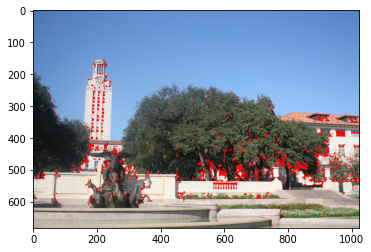

5027 5027


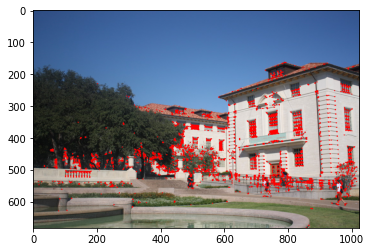

8407 8407


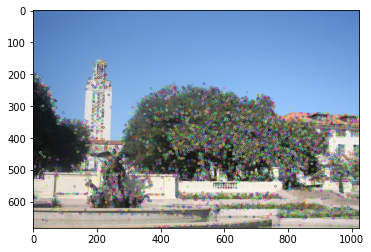

(5314,) (5314, 128)


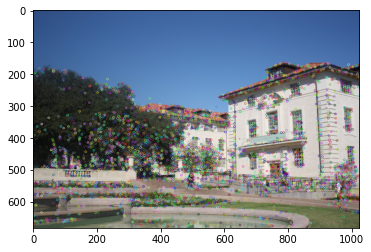

(4195,) (4195, 128)


In [17]:
hp_left = harris_points('images/uttower_left.jpg')
hp_right = harris_points('images/uttower_right.jpg')

kp_left, des_left = SIFT_points('images/uttower_left.jpg')
kp_right, des_right = SIFT_points('images/uttower_right.jpg')

In [87]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import imageio
import random

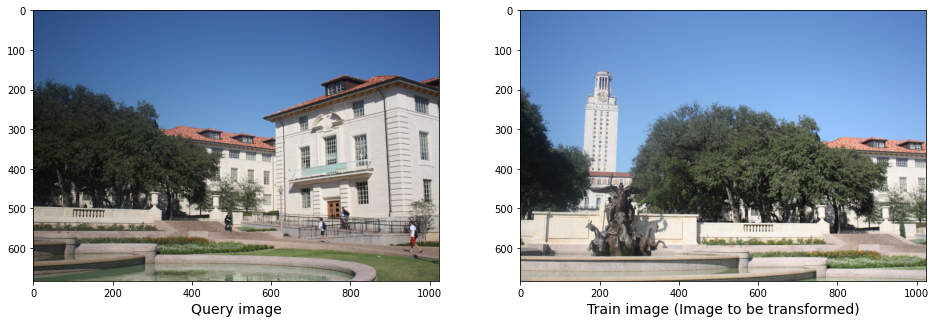

In [88]:
img1 = imageio.imread('images/uttower_right.jpg')
trainImg_gray = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)

img2 = imageio.imread('images/uttower_left.jpg')
queryImg_gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
ax1.imshow(img1, cmap="gray")
ax1.set_xlabel("Query image", fontsize=14)

ax2.imshow(img2, cmap="gray")
ax2.set_xlabel("Train image (Image to be transformed)", fontsize=14)

plt.show()

In [89]:
def detectAndDescribe(image):
    descriptor = cv2.SIFT_create()
    (kps, features) = descriptor.detectAndCompute(image, None)
    return (kps, features)

kp1, desc1 = detectAndDescribe(img1)
kp2, desc2 = detectAndDescribe(img2)

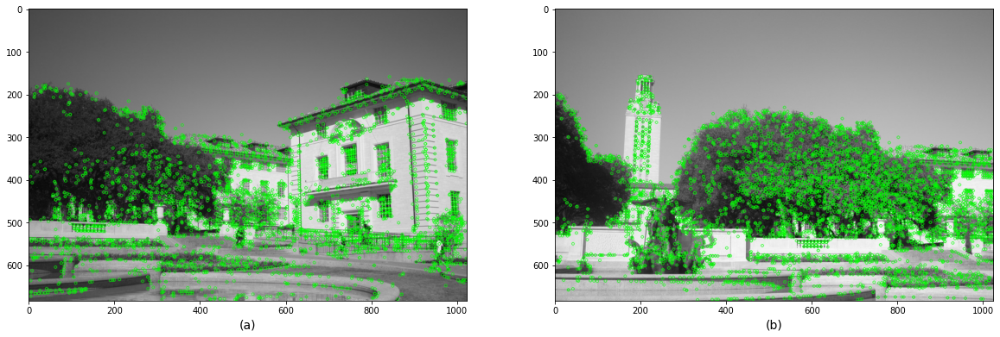

Found keypoints in right: 4280
Found keypoints in left: 5346


In [90]:
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
ax1.imshow(cv2.drawKeypoints(trainImg_gray,kp1,None,color=(0,255,0)))
ax1.set_xlabel("(a)", fontsize=14)
ax2.imshow(cv2.drawKeypoints(queryImg_gray,kp2,None,color=(0,255,0)))
ax2.set_xlabel("(b)", fontsize=14)

plt.show()

print("Found keypoints in " + 'right' + ": " + str(len(kp1)))
print("Found keypoints in " + 'left' + ": " + str(len(kp2)))

In [91]:
from scipy.spatial import distance
def matchFeatures(kp1, kp2, desc1, desc2, img1, img2):
    print("Matching Features...")
    matcher = cv2.BFMatcher(cv2.NORM_L2, True)
    matches = matcher.match(desc1, desc2)
    matchImg = cv2.drawMatches(img1,kp1,img2,kp2,matches[:50],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(10,10))
    plt.imshow(matchImg)
    plt.show()
    
    print('Number of matched Points : ', len(matches))
    return matches

def matchFeatures2(desc1, desc2):
    matches = []
    dist = distance.cdist(desc1, desc2)

    for i in range(len(dist)):
        for j in range(len(dist[0])):
            if dist[i][j] < 130:
                matches.append((i,j))
    
    print('Number of matched Points : ', len(matches))
    return matches
                


keypoints = [kp1,kp2]
# matches = matchFeatures(kp1, kp2, desc1, desc2, img1, img2)
matches = matchFeatures2(desc1, desc2)

Number of matched Points :  1514


In [92]:
correspondenceList = []
for match in matches:
        (x1, y1) = keypoints[0][match[0]].pt
        (x2, y2) = keypoints[1][match[1]].pt
        correspondenceList.append([x1, y1, x2, y2])
        
corrs = np.matrix(correspondenceList)
print(corrs.shape)
print(corrs)

(1514, 4)
[[   9.41284084  581.62542725  454.49749756  616.42559814]
 [   9.41284084  581.62542725  486.83786011  617.13635254]
 [   9.41284084  581.62542725  508.86181641  585.27722168]
 ...
 [ 980.49682617  350.24014282  251.0741272   630.0982666 ]
 [1002.46795654  594.9005127   196.50958252  459.47033691]
 [1017.65014648  562.42895508  544.44140625  608.38446045]]


In [95]:
#
# Computers a homography from 4-correspondences
#
def calculateHomography(correspondences):
    #loop through correspondences and create assemble matrix
    aList = []
    for corr in correspondences:
        p1 = np.matrix([corr.item(0), corr.item(1), 1])
        p2 = np.matrix([corr.item(2), corr.item(3), 1])

        a2 = [0, 0, 0, -p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2),
              p2.item(1) * p1.item(0), p2.item(1) * p1.item(1), p2.item(1) * p1.item(2)]
        a1 = [-p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2), 0, 0, 0,
              p2.item(0) * p1.item(0), p2.item(0) * p1.item(1), p2.item(0) * p1.item(2)]
        aList.append(a1)
        aList.append(a2)
    matrixA = np.matrix(aList)

    #svd composition
    u, s, v = np.linalg.svd(matrixA)

    #reshape the min singular value into a 3 by 3 matrix
    h = np.reshape(v[8], (3, 3))

    #normalize and now we have h
    h = (1/h.item(8)) * h
    return h

def calculateAffine(correspondences):
    corrs = np.array(correspondences)
    x = np.transpose(np.matrix([corrs[0][:2],corrs[1][:2],corrs[2][:2],corrs[3][:2]]))
    y = np.transpose(np.matrix([corrs[0][2:],corrs[1][2:],corrs[2][2:],corrs[3][2:]]))
    # add ones on the bottom of x and y
    x = np.vstack((x,[1,1,1,1]))
    y = np.vstack((y,[1,1,1,1]))
    # solve for A2
    A2 = y * x.I
    # return function that takes input x and transforms it
    # don't need to return the 4th row as it is 
#     print(A2)
#     return lambda x: (A2*np.vstack((np.matrix(x).reshape(3,1),1)))[0:3,:]
    return A2

#
#Calculate the geometric distance between estimated points and original points
#
def geometricDistance(correspondence, h):

    p1 = np.transpose(np.matrix([correspondence[0].item(0), correspondence[0].item(1), 1]))
    estimatep2 = np.dot(h, p1)
    estimatep2 = (1/estimatep2.item(2))*estimatep2

    p2 = np.transpose(np.matrix([correspondence[0].item(2), correspondence[0].item(3), 1]))
    error = p2 - estimatep2
    return np.linalg.norm(error)


def ransac(corr, thresh, transformation=None):
    maxInliers = []
    finalH = None
    for epoch in range(1000):
        #find 4 random points to calculate a homography
        corr1 = corr[random.randrange(0, len(corr))]
        corr2 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((corr1, corr2))
        corr3 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr3))
        corr4 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr4))
        
        #call the homography function on those points
        if transformation == 'Affine':
            h = calculateAffine(randomFour)
        else:
            h = calculateHomography(randomFour)
            
        inliers = []

        for i in range(len(corr)):
            d = geometricDistance(corr[i], h)
            if d < 5:
                inliers.append(corr[i])

        if len(inliers) > len(maxInliers):
            maxInliers = inliers
            finalH = h
            
        print("Itiration number: ", epoch, " Corr size: ", len(corr), " NumInliers: ", len(inliers), "Max inliers: ", len(maxInliers))

        if len(maxInliers) > (len(corr)*thresh):
            break
    return finalH, maxInliers

finalH, inliers_H = ransac(corrs, 0.6)
print("Final homography: ")
print(finalH)
print("Final inliers count: ", len(inliers_H))

finalA, inliers_A = ransac(corrs, 0.6, 'Affine')
print("Final homography: ")
print(finalA)
print("Final inliers count: ", len(inliers_A))

Itiration number:  0  Corr size:  1514  NumInliers:  5 Max inliers:  5
Itiration number:  1  Corr size:  1514  NumInliers:  8 Max inliers:  8
Itiration number:  2  Corr size:  1514  NumInliers:  11 Max inliers:  11
Itiration number:  3  Corr size:  1514  NumInliers:  9 Max inliers:  11
Itiration number:  4  Corr size:  1514  NumInliers:  10 Max inliers:  11
Itiration number:  5  Corr size:  1514  NumInliers:  6 Max inliers:  11
Itiration number:  6  Corr size:  1514  NumInliers:  437 Max inliers:  437
Itiration number:  7  Corr size:  1514  NumInliers:  38 Max inliers:  437
Itiration number:  8  Corr size:  1514  NumInliers:  28 Max inliers:  437
Itiration number:  9  Corr size:  1514  NumInliers:  4 Max inliers:  437
Itiration number:  10  Corr size:  1514  NumInliers:  4 Max inliers:  437
Itiration number:  11  Corr size:  1514  NumInliers:  11 Max inliers:  437
Itiration number:  12  Corr size:  1514  NumInliers:  8 Max inliers:  437
Itiration number:  13  Corr size:  1514  NumInlie

Itiration number:  112  Corr size:  1514  NumInliers:  15 Max inliers:  653
Itiration number:  113  Corr size:  1514  NumInliers:  8 Max inliers:  653
Itiration number:  114  Corr size:  1514  NumInliers:  10 Max inliers:  653
Itiration number:  115  Corr size:  1514  NumInliers:  14 Max inliers:  653
Itiration number:  116  Corr size:  1514  NumInliers:  4 Max inliers:  653
Itiration number:  117  Corr size:  1514  NumInliers:  6 Max inliers:  653
Itiration number:  118  Corr size:  1514  NumInliers:  7 Max inliers:  653
Itiration number:  119  Corr size:  1514  NumInliers:  7 Max inliers:  653
Itiration number:  120  Corr size:  1514  NumInliers:  3 Max inliers:  653
Itiration number:  121  Corr size:  1514  NumInliers:  7 Max inliers:  653
Itiration number:  122  Corr size:  1514  NumInliers:  7 Max inliers:  653
Itiration number:  123  Corr size:  1514  NumInliers:  45 Max inliers:  653
Itiration number:  124  Corr size:  1514  NumInliers:  5 Max inliers:  653
Itiration number:  12

Itiration number:  222  Corr size:  1514  NumInliers:  153 Max inliers:  689
Itiration number:  223  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  224  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  225  Corr size:  1514  NumInliers:  13 Max inliers:  689
Itiration number:  226  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  227  Corr size:  1514  NumInliers:  4 Max inliers:  689
Itiration number:  228  Corr size:  1514  NumInliers:  16 Max inliers:  689
Itiration number:  229  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  230  Corr size:  1514  NumInliers:  9 Max inliers:  689
Itiration number:  231  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  232  Corr size:  1514  NumInliers:  11 Max inliers:  689
Itiration number:  233  Corr size:  1514  NumInliers:  9 Max inliers:  689
Itiration number:  234  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  2

Itiration number:  332  Corr size:  1514  NumInliers:  9 Max inliers:  689
Itiration number:  333  Corr size:  1514  NumInliers:  29 Max inliers:  689
Itiration number:  334  Corr size:  1514  NumInliers:  13 Max inliers:  689
Itiration number:  335  Corr size:  1514  NumInliers:  9 Max inliers:  689
Itiration number:  336  Corr size:  1514  NumInliers:  9 Max inliers:  689
Itiration number:  337  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number:  338  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  339  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  340  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  341  Corr size:  1514  NumInliers:  15 Max inliers:  689
Itiration number:  342  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  343  Corr size:  1514  NumInliers:  47 Max inliers:  689
Itiration number:  344  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  34

Itiration number:  441  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  442  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  443  Corr size:  1514  NumInliers:  11 Max inliers:  689
Itiration number:  444  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  445  Corr size:  1514  NumInliers:  14 Max inliers:  689
Itiration number:  446  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number:  447  Corr size:  1514  NumInliers:  16 Max inliers:  689
Itiration number:  448  Corr size:  1514  NumInliers:  12 Max inliers:  689
Itiration number:  449  Corr size:  1514  NumInliers:  10 Max inliers:  689
Itiration number:  450  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number:  451  Corr size:  1514  NumInliers:  15 Max inliers:  689
Itiration number:  452  Corr size:  1514  NumInliers:  12 Max inliers:  689
Itiration number:  453  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number: 

Itiration number:  550  Corr size:  1514  NumInliers:  15 Max inliers:  689
Itiration number:  551  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  552  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  553  Corr size:  1514  NumInliers:  11 Max inliers:  689
Itiration number:  554  Corr size:  1514  NumInliers:  9 Max inliers:  689
Itiration number:  555  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  556  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  557  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  558  Corr size:  1514  NumInliers:  17 Max inliers:  689
Itiration number:  559  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  560  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number:  561  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  562  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  563

Itiration number:  659  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  660  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  661  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  662  Corr size:  1514  NumInliers:  16 Max inliers:  689
Itiration number:  663  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  664  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  665  Corr size:  1514  NumInliers:  12 Max inliers:  689
Itiration number:  666  Corr size:  1514  NumInliers:  14 Max inliers:  689
Itiration number:  667  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  668  Corr size:  1514  NumInliers:  10 Max inliers:  689
Itiration number:  669  Corr size:  1514  NumInliers:  17 Max inliers:  689
Itiration number:  670  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  671  Corr size:  1514  NumInliers:  17 Max inliers:  689
Itiration number:  

Itiration number:  768  Corr size:  1514  NumInliers:  2 Max inliers:  689
Itiration number:  769  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  770  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  771  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number:  772  Corr size:  1514  NumInliers:  4 Max inliers:  689
Itiration number:  773  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  774  Corr size:  1514  NumInliers:  396 Max inliers:  689
Itiration number:  775  Corr size:  1514  NumInliers:  12 Max inliers:  689
Itiration number:  776  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  777  Corr size:  1514  NumInliers:  9 Max inliers:  689
Itiration number:  778  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number:  779  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  780  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number:  781

Itiration number:  877  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  878  Corr size:  1514  NumInliers:  14 Max inliers:  689
Itiration number:  879  Corr size:  1514  NumInliers:  12 Max inliers:  689
Itiration number:  880  Corr size:  1514  NumInliers:  9 Max inliers:  689
Itiration number:  881  Corr size:  1514  NumInliers:  16 Max inliers:  689
Itiration number:  882  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number:  883  Corr size:  1514  NumInliers:  8 Max inliers:  689
Itiration number:  884  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  885  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  886  Corr size:  1514  NumInliers:  14 Max inliers:  689
Itiration number:  887  Corr size:  1514  NumInliers:  7 Max inliers:  689
Itiration number:  888  Corr size:  1514  NumInliers:  12 Max inliers:  689
Itiration number:  889  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  8

Itiration number:  987  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  988  Corr size:  1514  NumInliers:  6 Max inliers:  689
Itiration number:  989  Corr size:  1514  NumInliers:  9 Max inliers:  689
Itiration number:  990  Corr size:  1514  NumInliers:  3 Max inliers:  689
Itiration number:  991  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  992  Corr size:  1514  NumInliers:  13 Max inliers:  689
Itiration number:  993  Corr size:  1514  NumInliers:  21 Max inliers:  689
Itiration number:  994  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  995  Corr size:  1514  NumInliers:  5 Max inliers:  689
Itiration number:  996  Corr size:  1514  NumInliers:  14 Max inliers:  689
Itiration number:  997  Corr size:  1514  NumInliers:  19 Max inliers:  689
Itiration number:  998  Corr size:  1514  NumInliers:  14 Max inliers:  689
Itiration number:  999  Corr size:  1514  NumInliers:  7 Max inliers:  689
Final homography: 
[

Itiration number:  95  Corr size:  1514  NumInliers:  1 Max inliers:  360
Itiration number:  96  Corr size:  1514  NumInliers:  2 Max inliers:  360
Itiration number:  97  Corr size:  1514  NumInliers:  9 Max inliers:  360
Itiration number:  98  Corr size:  1514  NumInliers:  1 Max inliers:  360
Itiration number:  99  Corr size:  1514  NumInliers:  1 Max inliers:  360
Itiration number:  100  Corr size:  1514  NumInliers:  4 Max inliers:  360
Itiration number:  101  Corr size:  1514  NumInliers:  3 Max inliers:  360
Itiration number:  102  Corr size:  1514  NumInliers:  0 Max inliers:  360
Itiration number:  103  Corr size:  1514  NumInliers:  5 Max inliers:  360
Itiration number:  104  Corr size:  1514  NumInliers:  0 Max inliers:  360
Itiration number:  105  Corr size:  1514  NumInliers:  4 Max inliers:  360
Itiration number:  106  Corr size:  1514  NumInliers:  18 Max inliers:  360
Itiration number:  107  Corr size:  1514  NumInliers:  20 Max inliers:  360
Itiration number:  108  Corr

Itiration number:  204  Corr size:  1514  NumInliers:  0 Max inliers:  396
Itiration number:  205  Corr size:  1514  NumInliers:  8 Max inliers:  396
Itiration number:  206  Corr size:  1514  NumInliers:  6 Max inliers:  396
Itiration number:  207  Corr size:  1514  NumInliers:  2 Max inliers:  396
Itiration number:  208  Corr size:  1514  NumInliers:  9 Max inliers:  396
Itiration number:  209  Corr size:  1514  NumInliers:  0 Max inliers:  396
Itiration number:  210  Corr size:  1514  NumInliers:  47 Max inliers:  396
Itiration number:  211  Corr size:  1514  NumInliers:  38 Max inliers:  396
Itiration number:  212  Corr size:  1514  NumInliers:  0 Max inliers:  396
Itiration number:  213  Corr size:  1514  NumInliers:  4 Max inliers:  396
Itiration number:  214  Corr size:  1514  NumInliers:  2 Max inliers:  396
Itiration number:  215  Corr size:  1514  NumInliers:  1 Max inliers:  396
Itiration number:  216  Corr size:  1514  NumInliers:  5 Max inliers:  396
Itiration number:  217 

Itiration number:  315  Corr size:  1514  NumInliers:  9 Max inliers:  409
Itiration number:  316  Corr size:  1514  NumInliers:  4 Max inliers:  409
Itiration number:  317  Corr size:  1514  NumInliers:  0 Max inliers:  409
Itiration number:  318  Corr size:  1514  NumInliers:  4 Max inliers:  409
Itiration number:  319  Corr size:  1514  NumInliers:  0 Max inliers:  409
Itiration number:  320  Corr size:  1514  NumInliers:  79 Max inliers:  409
Itiration number:  321  Corr size:  1514  NumInliers:  362 Max inliers:  409
Itiration number:  322  Corr size:  1514  NumInliers:  14 Max inliers:  409
Itiration number:  323  Corr size:  1514  NumInliers:  1 Max inliers:  409
Itiration number:  324  Corr size:  1514  NumInliers:  3 Max inliers:  409
Itiration number:  325  Corr size:  1514  NumInliers:  3 Max inliers:  409
Itiration number:  326  Corr size:  1514  NumInliers:  2 Max inliers:  409
Itiration number:  327  Corr size:  1514  NumInliers:  1 Max inliers:  409
Itiration number:  32

Itiration number:  425  Corr size:  1514  NumInliers:  38 Max inliers:  409
Itiration number:  426  Corr size:  1514  NumInliers:  5 Max inliers:  409
Itiration number:  427  Corr size:  1514  NumInliers:  3 Max inliers:  409
Itiration number:  428  Corr size:  1514  NumInliers:  10 Max inliers:  409
Itiration number:  429  Corr size:  1514  NumInliers:  5 Max inliers:  409
Itiration number:  430  Corr size:  1514  NumInliers:  0 Max inliers:  409
Itiration number:  431  Corr size:  1514  NumInliers:  1 Max inliers:  409
Itiration number:  432  Corr size:  1514  NumInliers:  197 Max inliers:  409
Itiration number:  433  Corr size:  1514  NumInliers:  0 Max inliers:  409
Itiration number:  434  Corr size:  1514  NumInliers:  5 Max inliers:  409
Itiration number:  435  Corr size:  1514  NumInliers:  4 Max inliers:  409
Itiration number:  436  Corr size:  1514  NumInliers:  2 Max inliers:  409
Itiration number:  437  Corr size:  1514  NumInliers:  0 Max inliers:  409
Itiration number:  43

Itiration number:  534  Corr size:  1514  NumInliers:  2 Max inliers:  421
Itiration number:  535  Corr size:  1514  NumInliers:  0 Max inliers:  421
Itiration number:  536  Corr size:  1514  NumInliers:  1 Max inliers:  421
Itiration number:  537  Corr size:  1514  NumInliers:  8 Max inliers:  421
Itiration number:  538  Corr size:  1514  NumInliers:  5 Max inliers:  421
Itiration number:  539  Corr size:  1514  NumInliers:  2 Max inliers:  421
Itiration number:  540  Corr size:  1514  NumInliers:  0 Max inliers:  421
Itiration number:  541  Corr size:  1514  NumInliers:  0 Max inliers:  421
Itiration number:  542  Corr size:  1514  NumInliers:  1 Max inliers:  421
Itiration number:  543  Corr size:  1514  NumInliers:  6 Max inliers:  421
Itiration number:  544  Corr size:  1514  NumInliers:  64 Max inliers:  421
Itiration number:  545  Corr size:  1514  NumInliers:  3 Max inliers:  421
Itiration number:  546  Corr size:  1514  NumInliers:  1 Max inliers:  421
Itiration number:  547  

Itiration number:  644  Corr size:  1514  NumInliers:  1 Max inliers:  421
Itiration number:  645  Corr size:  1514  NumInliers:  3 Max inliers:  421
Itiration number:  646  Corr size:  1514  NumInliers:  55 Max inliers:  421
Itiration number:  647  Corr size:  1514  NumInliers:  9 Max inliers:  421
Itiration number:  648  Corr size:  1514  NumInliers:  3 Max inliers:  421
Itiration number:  649  Corr size:  1514  NumInliers:  1 Max inliers:  421
Itiration number:  650  Corr size:  1514  NumInliers:  5 Max inliers:  421
Itiration number:  651  Corr size:  1514  NumInliers:  6 Max inliers:  421
Itiration number:  652  Corr size:  1514  NumInliers:  1 Max inliers:  421
Itiration number:  653  Corr size:  1514  NumInliers:  0 Max inliers:  421
Itiration number:  654  Corr size:  1514  NumInliers:  0 Max inliers:  421
Itiration number:  655  Corr size:  1514  NumInliers:  19 Max inliers:  421
Itiration number:  656  Corr size:  1514  NumInliers:  0 Max inliers:  421
Itiration number:  657 

Itiration number:  755  Corr size:  1514  NumInliers:  2 Max inliers:  441
Itiration number:  756  Corr size:  1514  NumInliers:  0 Max inliers:  441
Itiration number:  757  Corr size:  1514  NumInliers:  356 Max inliers:  441
Itiration number:  758  Corr size:  1514  NumInliers:  1 Max inliers:  441
Itiration number:  759  Corr size:  1514  NumInliers:  0 Max inliers:  441
Itiration number:  760  Corr size:  1514  NumInliers:  1 Max inliers:  441
Itiration number:  761  Corr size:  1514  NumInliers:  0 Max inliers:  441
Itiration number:  762  Corr size:  1514  NumInliers:  2 Max inliers:  441
Itiration number:  763  Corr size:  1514  NumInliers:  6 Max inliers:  441
Itiration number:  764  Corr size:  1514  NumInliers:  0 Max inliers:  441
Itiration number:  765  Corr size:  1514  NumInliers:  3 Max inliers:  441
Itiration number:  766  Corr size:  1514  NumInliers:  6 Max inliers:  441
Itiration number:  767  Corr size:  1514  NumInliers:  13 Max inliers:  441
Itiration number:  768

Itiration number:  864  Corr size:  1514  NumInliers:  7 Max inliers:  455
Itiration number:  865  Corr size:  1514  NumInliers:  1 Max inliers:  455
Itiration number:  866  Corr size:  1514  NumInliers:  5 Max inliers:  455
Itiration number:  867  Corr size:  1514  NumInliers:  4 Max inliers:  455
Itiration number:  868  Corr size:  1514  NumInliers:  2 Max inliers:  455
Itiration number:  869  Corr size:  1514  NumInliers:  5 Max inliers:  455
Itiration number:  870  Corr size:  1514  NumInliers:  44 Max inliers:  455
Itiration number:  871  Corr size:  1514  NumInliers:  7 Max inliers:  455
Itiration number:  872  Corr size:  1514  NumInliers:  0 Max inliers:  455
Itiration number:  873  Corr size:  1514  NumInliers:  10 Max inliers:  455
Itiration number:  874  Corr size:  1514  NumInliers:  16 Max inliers:  455
Itiration number:  875  Corr size:  1514  NumInliers:  2 Max inliers:  455
Itiration number:  876  Corr size:  1514  NumInliers:  167 Max inliers:  455
Itiration number:  8

Itiration number:  974  Corr size:  1514  NumInliers:  5 Max inliers:  462
Itiration number:  975  Corr size:  1514  NumInliers:  3 Max inliers:  462
Itiration number:  976  Corr size:  1514  NumInliers:  0 Max inliers:  462
Itiration number:  977  Corr size:  1514  NumInliers:  1 Max inliers:  462
Itiration number:  978  Corr size:  1514  NumInliers:  2 Max inliers:  462
Itiration number:  979  Corr size:  1514  NumInliers:  0 Max inliers:  462
Itiration number:  980  Corr size:  1514  NumInliers:  3 Max inliers:  462
Itiration number:  981  Corr size:  1514  NumInliers:  0 Max inliers:  462
Itiration number:  982  Corr size:  1514  NumInliers:  4 Max inliers:  462
Itiration number:  983  Corr size:  1514  NumInliers:  104 Max inliers:  462
Itiration number:  984  Corr size:  1514  NumInliers:  2 Max inliers:  462
Itiration number:  985  Corr size:  1514  NumInliers:  7 Max inliers:  462
Itiration number:  986  Corr size:  1514  NumInliers:  21 Max inliers:  462
Itiration number:  987

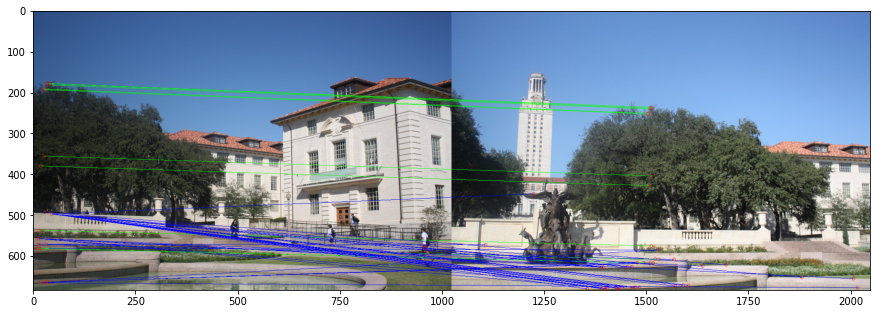

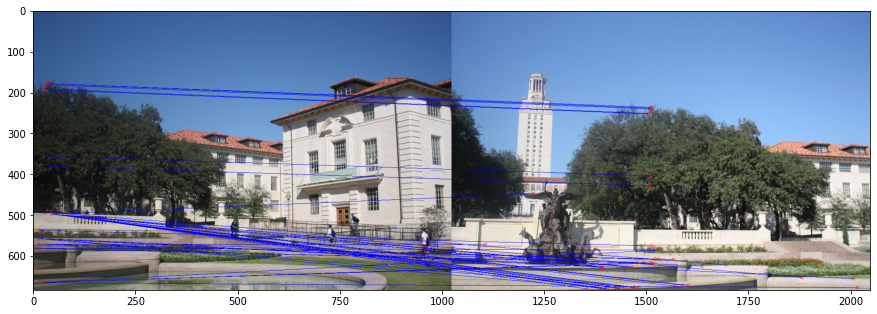

In [96]:
# This draws matches and optionally a set of inliers in a different color
def drawMatches(img1, kp1, img2, kp2, matches, inliers = None):
    # Create a new output image that concatenates the two images together
    rows1 = img1.shape[0]
    cols1 = img1.shape[1]
    rows2 = img2.shape[0]
    cols2 = img2.shape[1]

    out = np.zeros((max([rows1,rows2]),cols1+cols2,3), dtype='uint8')

    # Place the first image to the left
    out[:rows1,:cols1,:] = np.dstack([img1[:,:,0], img1[:,:,1], img1[:,:,2]])
#     out[:rows1,:cols1,:] = img1

    # Place the next image to the right of it
    out[:rows2,cols1:cols1+cols2,:] = np.dstack([img2[:,:,0], img2[:,:,1], img2[:,:,2]])
#     out[:rows2,cols1:cols1+cols2,:] = img2

    # For each pair of points we have between both images
    # draw circles, then connect a line between them
    for mat in matches:

        # Get the matching keypoints for each of the images
        img1_idx = mat[0]
        img2_idx = mat[1]

        # x - columns, y - rows
        (x1,y1) = kp1[img1_idx].pt
        (x2,y2) = kp2[img2_idx].pt

        inlier = False

        if inliers is not None:
            for i in inliers:
                if i.item(0) == x1 and i.item(1) == y1 and i.item(2) == x2 and i.item(3) == y2:
                    inlier = True

        # Draw a small circle at both co-ordinates
        cv2.circle(out, (int(x1),int(y1)), 4, (255, 0, 0), 1)
        cv2.circle(out, (int(x2)+cols1,int(y2)), 4, (255, 0, 0), 1)

        # Draw a line in between the two points, draw inliers if we have them
        if inliers is not None and inlier:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 255, 0), 1)
        elif inliers is not None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 0, 255), 1)

        if inliers is None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (255, 0, 0), 1)

    return out


matchImg = drawMatches(img1,kp1,img2,kp2,matches[:50],inliers_H)
plt.figure(figsize=(15,15))
plt.imshow(matchImg)
plt.show()


matchImg = drawMatches(img1,kp1,img2,kp2,matches[:50],inliers_A)
plt.figure(figsize=(15,15))
plt.imshow(matchImg)
plt.show()

[[ 8.21504326e-01  1.30956103e-01  4.22113986e+02]
 [-1.32766492e-01  1.01215474e+00  5.29641697e+01]
 [-2.07567091e-04  6.93098453e-05  1.00000000e+00]]


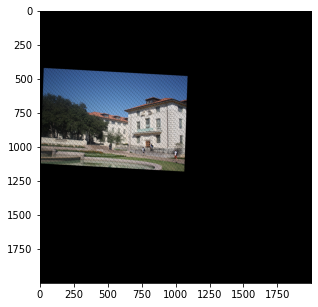

In [69]:
H = np.matrix([[ 8.21504326e-01 ,1.30956103e-01  ,4.22113986e+02],
              [-1.32766492e-01  ,1.01215474e+00  ,5.29641697e+01],
              [-2.07567091e-04  ,6.93098453e-05  ,1.00000000e+00]])

print(H)
img_transformed = np.empty((2000, 2000, 3), dtype=np.uint8)
for i, row in enumerate(img1):
    for j, col in enumerate(row):
        pixel_data = img1[i, j, :]
        input_coords = np.array([i, j, 1])
        
        temp = np.array(finalH @ input_coords)
#         i_out, j_out, _ = finalH @ input_coords
        img_transformed[int(temp[0][0]), int(temp[0][1]), :] = pixel_data

plt.figure(figsize=(5, 5))
plt.imshow(img_transformed)

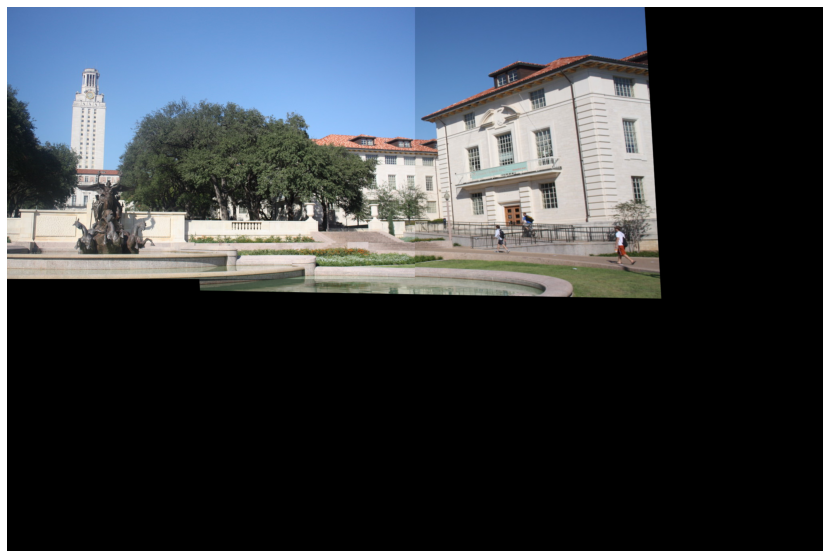

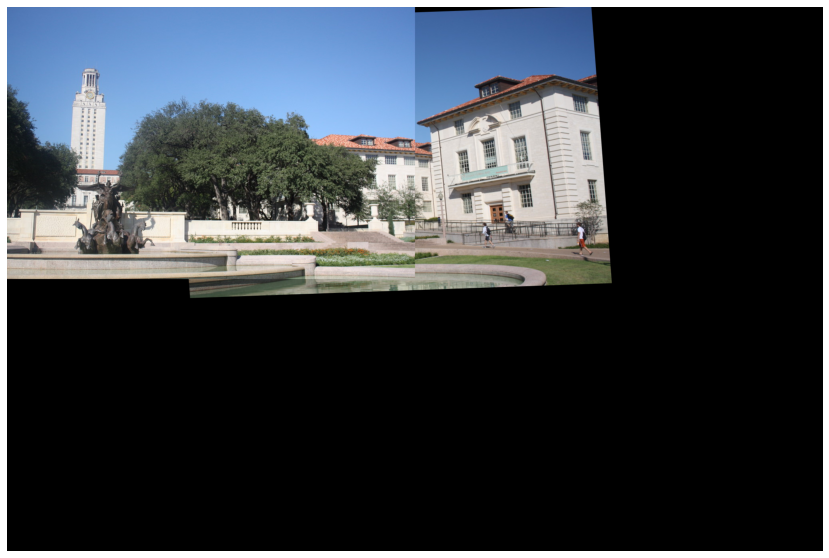

In [97]:
# Apply panorama correction
width = img1.shape[1] + img2.shape[1]
height = img1.shape[0] + img2.shape[0]

result = cv2.warpPerspective(img1, finalH, (width, height))
result[0:img2.shape[0], 0:img2.shape[1]] = img2

plt.figure(figsize=(20,10))
plt.imshow(result)

plt.axis('off')
plt.show()

result = cv2.warpPerspective(img1, finalA, (width, height))
result[0:img2.shape[0], 0:img2.shape[1]] = img2

plt.figure(figsize=(20,10))
plt.imshow(result)

plt.axis('off')
plt.show()